In [1]:
%matplotlib notebook

In [2]:
import os 
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [3]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

/usr/local/lib/python3.5/dist-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [4]:
predictions = []
hessians = []
loss = []

n_classes = 1
batch_size = 20
nm_epochs = 1000
train_num_batches_per_epoch = 1000 // batch_size

In [5]:
def sin_function(source):
    target = np.sin(5. * np.pi * source) / (5. * np.pi * source)
    return target

In [6]:
source = np.arange(1e-6, 1, 0.001).reshape(-1, 1)
target = sin_function(source)

In [7]:
source

array([[1.00000e-06],
       [1.00100e-03],
       [2.00100e-03],
       [3.00100e-03],
       [4.00100e-03],
       [5.00100e-03],
       [6.00100e-03],
       [7.00100e-03],
       [8.00100e-03],
       [9.00100e-03],
       [1.00010e-02],
       [1.10010e-02],
       [1.20010e-02],
       [1.30010e-02],
       [1.40010e-02],
       [1.50010e-02],
       [1.60010e-02],
       [1.70010e-02],
       [1.80010e-02],
       [1.90010e-02],
       [2.00010e-02],
       [2.10010e-02],
       [2.20010e-02],
       [2.30010e-02],
       [2.40010e-02],
       [2.50010e-02],
       [2.60010e-02],
       [2.70010e-02],
       [2.80010e-02],
       [2.90010e-02],
       [3.00010e-02],
       [3.10010e-02],
       [3.20010e-02],
       [3.30010e-02],
       [3.40010e-02],
       [3.50010e-02],
       [3.60010e-02],
       [3.70010e-02],
       [3.80010e-02],
       [3.90010e-02],
       [4.00010e-02],
       [4.10010e-02],
       [4.20010e-02],
       [4.30010e-02],
       [4.40010e-02],
       [4.

In [8]:
target

array([[ 1.00000000e+00],
       [ 9.99958795e-01],
       [ 9.99835350e-01],
       [ 9.99629684e-01],
       [ 9.99341827e-01],
       [ 9.98971822e-01],
       [ 9.98519724e-01],
       [ 9.97985598e-01],
       [ 9.97369526e-01],
       [ 9.96671597e-01],
       [ 9.95891915e-01],
       [ 9.95030595e-01],
       [ 9.94087765e-01],
       [ 9.93063565e-01],
       [ 9.91958145e-01],
       [ 9.90771669e-01],
       [ 9.89504313e-01],
       [ 9.88156265e-01],
       [ 9.86727723e-01],
       [ 9.85218898e-01],
       [ 9.83630014e-01],
       [ 9.81961306e-01],
       [ 9.80213020e-01],
       [ 9.78385414e-01],
       [ 9.76478758e-01],
       [ 9.74493334e-01],
       [ 9.72429434e-01],
       [ 9.70287365e-01],
       [ 9.68067440e-01],
       [ 9.65769989e-01],
       [ 9.63395349e-01],
       [ 9.60943871e-01],
       [ 9.58415916e-01],
       [ 9.55811857e-01],
       [ 9.53132077e-01],
       [ 9.50376971e-01],
       [ 9.47546944e-01],
       [ 9.44642414e-01],
       [ 9.4

In [9]:
def neural_network_model(data): #571
    hidden_1_layer = {'weights':tf.Variable(tf.truncated_normal([1, 5], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[5]))}

    hidden_2_layer = {'weights':tf.Variable(tf.truncated_normal([5, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_3_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_4_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_5_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_6_layer = {'weights':tf.Variable(tf.truncated_normal([10, 10], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[10]))}

    hidden_7_layer = {'weights':tf.Variable(tf.truncated_normal([10, 5], stddev=0.1)),
                      'biases':tf.Variable(tf.constant(0.1, shape=[5]))}

    output_layer = {'weights':tf.Variable(tf.truncated_normal([5, 1], stddev=0.1)),
                    'biases':tf.Variable(tf.constant(0.1, shape=[1])),}

    l1 = tf.add(tf.matmul(data, hidden_1_layer['weights']), hidden_1_layer['biases'])
    l1 = tf.nn.relu(l1)

    l2 = tf.add(tf.matmul(l1, hidden_2_layer['weights']), hidden_2_layer['biases'])
    l2 = tf.nn.relu(l2)

    l3 = tf.add(tf.matmul(l2, hidden_3_layer['weights']), hidden_3_layer['biases'])
    l3 = tf.nn.relu(l3)
    
    l4 = tf.add(tf.matmul(l3, hidden_4_layer['weights']), hidden_4_layer['biases'])
    l4 = tf.nn.relu(l4)
    
    l5 = tf.add(tf.matmul(l4, hidden_5_layer['weights']), hidden_5_layer['biases'])
    l5 = tf.nn.relu(l5)
    
    l6 = tf.add(tf.matmul(l5, hidden_6_layer['weights']), hidden_6_layer['biases'])
    l6 = tf.nn.relu(l6)
    
    l7 = tf.add(tf.matmul(l6, hidden_7_layer['weights']), hidden_7_layer['biases'])
    l7 = tf.nn.relu(l7)

    output = tf.matmul(l7, output_layer['weights']) + output_layer['biases']

    return output

In [10]:
def next_batch(source, target, batch_size):

   # Shuffle data
   shuffle_indices = np.random.permutation(np.arange(len(target)))
   source = source[shuffle_indices]
   target = target[shuffle_indices]

   for batch_i in range(0, len(source)//batch_size):
      start_i = batch_i * batch_size
      source_batch = source[start_i:start_i + batch_size]
      target_batch = target[start_i:start_i + batch_size]

      yield np.array(source_batch), np.array(target_batch)

In [11]:
def train_neural_network(x):
    prediction = neural_network_model(x)
    optimizer = tf.train.AdamOptimizer(learning_rate=0.0001)
    cost = tf.reduce_mean(tf.square(prediction - y))
    train_step = optimizer.minimize(cost)
    grads_and_vars = optimizer.compute_gradients(cost)
    grads, _ = list(zip(*grads_and_vars))
    gradient_norm = tf.global_norm(grads)
    train_step_stage2 = optimizer.minimize(gradient_norm)

    config=tf.ConfigProto()
    config.gpu_options.allow_growth=True
    
    with tf.Session(config=config) as sess:
        sess.run(tf.global_variables_initializer())   

        for epoch in range(nm_epochs):
            epoch_loss = 0.0
            epoch_grads = 0.0
            for epoch_x, epoch_y in next_batch(source, target, batch_size):
                _, c, gradients = sess.run([train_step, cost, gradient_norm], feed_dict={x: epoch_x, y: epoch_y})
                epoch_loss += c / train_num_batches_per_epoch
                epoch_grads += gradients / train_num_batches_per_epoch

            print('Epoch', epoch, 'completed out of',nm_epochs,'loss:',epoch_loss, 'gradient_norm:', epoch_grads)

        for epoch in range(nm_epochs):
            epoch_loss = 0.0
            epoch_grads = 0.0
            for epoch_x, epoch_y in next_batch(source, target, batch_size):
                _, c, gradients = sess.run([train_step_stage2, cost, gradient_norm], feed_dict={x: epoch_x, y: epoch_y})
                epoch_loss += c / train_num_batches_per_epoch
                epoch_grads += gradients / train_num_batches_per_epoch
            print('Epoch', epoch, 'completed out of',nm_epochs,'loss:',epoch_loss, 'gradient_norm:', epoch_grads)
        
        hessian = tf.hessians(gradient_norm, tf.trainable_variables())
        hessians.append(sess.run(hessian, feed_dict={x: source, y:target}))
        loss.append(epoch_grads)
        predictions.append(sess.run(prediction, feed_dict={x:source}))

In [12]:
for _ in range(100):
    g = tf.Graph()
    with g.as_default():
        x = tf.placeholder(tf.float32, [None,1])
        y = tf.placeholder(tf.float32,[None,1])
        train_neural_network(x)

Epoch 0 completed out of 1000 loss: 0.08756427887827158 gradient_norm: 0.12496053558774291
Epoch 1 completed out of 1000 loss: 0.08756161130964757 gradient_norm: 0.11701103426516055
Epoch 2 completed out of 1000 loss: 0.08755978241562844 gradient_norm: 0.11182262863963843
Epoch 3 completed out of 1000 loss: 0.08756913132965566 gradient_norm: 0.12223319306969642
Epoch 4 completed out of 1000 loss: 0.08756771460175512 gradient_norm: 0.10776892688125377
Epoch 5 completed out of 1000 loss: 0.08755753785371777 gradient_norm: 0.10805771098472182
Epoch 6 completed out of 1000 loss: 0.08756164919584988 gradient_norm: 0.11314836230711078
Epoch 7 completed out of 1000 loss: 0.08755991443991659 gradient_norm: 0.10685196225065738
Epoch 8 completed out of 1000 loss: 0.0875639384239912 gradient_norm: 0.1317350607831031
Epoch 9 completed out of 1000 loss: 0.08755741432309153 gradient_norm: 0.11434511342085898
Epoch 10 completed out of 1000 loss: 0.08755780346691606 gradient_norm: 0.09333461588248611


Epoch 90 completed out of 1000 loss: 0.0076426945114508255 gradient_norm: 0.03689559582155198
Epoch 91 completed out of 1000 loss: 0.007632093341089784 gradient_norm: 0.03803210793528705
Epoch 92 completed out of 1000 loss: 0.007614887068048118 gradient_norm: 0.03604146969504654
Epoch 93 completed out of 1000 loss: 0.007606165437027814 gradient_norm: 0.039706890229135754
Epoch 94 completed out of 1000 loss: 0.007595067247748374 gradient_norm: 0.03375347361899912
Epoch 95 completed out of 1000 loss: 0.007585286186076699 gradient_norm: 0.0386748187476769
Epoch 96 completed out of 1000 loss: 0.0075728395767509955 gradient_norm: 0.044586494844406833
Epoch 97 completed out of 1000 loss: 0.007563566016033293 gradient_norm: 0.03809676496312023
Epoch 98 completed out of 1000 loss: 0.007563491826876999 gradient_norm: 0.04772774089127778
Epoch 99 completed out of 1000 loss: 0.007546281460672616 gradient_norm: 0.03206625040620565
Epoch 100 completed out of 1000 loss: 0.007534864591434599 gradient

Epoch 178 completed out of 1000 loss: 0.0035282172379083932 gradient_norm: 0.034079399071633806
Epoch 179 completed out of 1000 loss: 0.0035189424850977954 gradient_norm: 0.03859202910214663
Epoch 180 completed out of 1000 loss: 0.0034990057582035667 gradient_norm: 0.037089331196621056
Epoch 181 completed out of 1000 loss: 0.0034813248040154576 gradient_norm: 0.034976468514651055
Epoch 182 completed out of 1000 loss: 0.003465193582233042 gradient_norm: 0.03202861998230219
Epoch 183 completed out of 1000 loss: 0.003450714494101703 gradient_norm: 0.030898416154086596
Epoch 184 completed out of 1000 loss: 0.0034391150833107532 gradient_norm: 0.03661515476182105
Epoch 185 completed out of 1000 loss: 0.0034265358722768723 gradient_norm: 0.03875972255133094
Epoch 186 completed out of 1000 loss: 0.003406230306718499 gradient_norm: 0.03136182917281985
Epoch 187 completed out of 1000 loss: 0.0033933768561109903 gradient_norm: 0.03384866205975413
Epoch 188 completed out of 1000 loss: 0.003378968

Epoch 266 completed out of 1000 loss: 0.0027919965982437143 gradient_norm: 0.028225553994998338
Epoch 267 completed out of 1000 loss: 0.0027905333228409285 gradient_norm: 0.029151746323332194
Epoch 268 completed out of 1000 loss: 0.002789304571924731 gradient_norm: 0.027527901884168385
Epoch 269 completed out of 1000 loss: 0.002786228272598237 gradient_norm: 0.026904471553862087
Epoch 270 completed out of 1000 loss: 0.0027821265044622114 gradient_norm: 0.03130596356932073
Epoch 271 completed out of 1000 loss: 0.002775251092389226 gradient_norm: 0.03078661309089512
Epoch 272 completed out of 1000 loss: 0.002773736949311569 gradient_norm: 0.026640622140839683
Epoch 273 completed out of 1000 loss: 0.0027678996662143626 gradient_norm: 0.026896813018247485
Epoch 274 completed out of 1000 loss: 0.002767494032159448 gradient_norm: 0.02828726354986429
Epoch 275 completed out of 1000 loss: 0.0027680198603775344 gradient_norm: 0.029596242937259376
Epoch 276 completed out of 1000 loss: 0.00276198

Epoch 354 completed out of 1000 loss: 0.0026262278796639286 gradient_norm: 0.02865733936196193
Epoch 355 completed out of 1000 loss: 0.0026329271355643863 gradient_norm: 0.02891213092021645
Epoch 356 completed out of 1000 loss: 0.002626780981663614 gradient_norm: 0.031536236759275194
Epoch 357 completed out of 1000 loss: 0.0026258461945690217 gradient_norm: 0.02223042431753128
Epoch 358 completed out of 1000 loss: 0.002634007153101266 gradient_norm: 0.03173352189362049
Epoch 359 completed out of 1000 loss: 0.002624175763339735 gradient_norm: 0.026505783549509946
Epoch 360 completed out of 1000 loss: 0.0026172752049751597 gradient_norm: 0.02535502865444869
Epoch 361 completed out of 1000 loss: 0.002618479093071073 gradient_norm: 0.026308399718254806
Epoch 362 completed out of 1000 loss: 0.0026236514421179888 gradient_norm: 0.029870457290671764
Epoch 363 completed out of 1000 loss: 0.0026134565722895796 gradient_norm: 0.02873825420625508
Epoch 364 completed out of 1000 loss: 0.0026127950

Epoch 442 completed out of 1000 loss: 0.002508540152339264 gradient_norm: 0.03219782554544509
Epoch 443 completed out of 1000 loss: 0.002505019885720686 gradient_norm: 0.026925106765702363
Epoch 444 completed out of 1000 loss: 0.002502866049762815 gradient_norm: 0.028462858479470016
Epoch 445 completed out of 1000 loss: 0.0025067165121436114 gradient_norm: 0.027552437074482433
Epoch 446 completed out of 1000 loss: 0.0025047932728193703 gradient_norm: 0.02815823687240481
Epoch 447 completed out of 1000 loss: 0.0025039932178333394 gradient_norm: 0.024434155328199265
Epoch 448 completed out of 1000 loss: 0.0024999451357871293 gradient_norm: 0.02830912237055599
Epoch 449 completed out of 1000 loss: 0.002500167484395206 gradient_norm: 0.026359538272954525
Epoch 450 completed out of 1000 loss: 0.0024991363880690187 gradient_norm: 0.029541058759205065
Epoch 451 completed out of 1000 loss: 0.0025081422599032514 gradient_norm: 0.027112526036798954
Epoch 452 completed out of 1000 loss: 0.0025068

Epoch 530 completed out of 1000 loss: 0.0024123040738049896 gradient_norm: 0.026051445063203574
Epoch 531 completed out of 1000 loss: 0.002411304072011263 gradient_norm: 0.026728448234498495
Epoch 532 completed out of 1000 loss: 0.0024101564520969984 gradient_norm: 0.032592289326712494
Epoch 533 completed out of 1000 loss: 0.0024076128564774987 gradient_norm: 0.026319255176931615
Epoch 534 completed out of 1000 loss: 0.0024086695222649717 gradient_norm: 0.031389061692170796
Epoch 535 completed out of 1000 loss: 0.0024102210346609353 gradient_norm: 0.03136058004107326
Epoch 536 completed out of 1000 loss: 0.0024113510828465217 gradient_norm: 0.030119325520936404
Epoch 537 completed out of 1000 loss: 0.00241103108623065 gradient_norm: 0.026054699746891855
Epoch 538 completed out of 1000 loss: 0.002403304207837209 gradient_norm: 0.02632709297817201
Epoch 539 completed out of 1000 loss: 0.0024036652815993876 gradient_norm: 0.02595643747597933
Epoch 540 completed out of 1000 loss: 0.0024063

Epoch 618 completed out of 1000 loss: 0.002314592100447044 gradient_norm: 0.03258841130882502
Epoch 619 completed out of 1000 loss: 0.0023097197385504842 gradient_norm: 0.030677480930462478
Epoch 620 completed out of 1000 loss: 0.0023095625441055755 gradient_norm: 0.030708286566659804
Epoch 621 completed out of 1000 loss: 0.002303700231714175 gradient_norm: 0.030158059485256666
Epoch 622 completed out of 1000 loss: 0.002311483030207455 gradient_norm: 0.028028299622237688
Epoch 623 completed out of 1000 loss: 0.002300595219712705 gradient_norm: 0.027363257193937892
Epoch 624 completed out of 1000 loss: 0.0023038131394423544 gradient_norm: 0.029066788586787882
Epoch 625 completed out of 1000 loss: 0.0023059647867921737 gradient_norm: 0.02664302190765739
Epoch 626 completed out of 1000 loss: 0.00229520884109661 gradient_norm: 0.024157047080807393
Epoch 627 completed out of 1000 loss: 0.002293998779496177 gradient_norm: 0.027695260127075027
Epoch 628 completed out of 1000 loss: 0.002293114

Epoch 706 completed out of 1000 loss: 0.00211568396887742 gradient_norm: 0.02698011164553463
Epoch 707 completed out of 1000 loss: 0.00211464085849002 gradient_norm: 0.026744029377587134
Epoch 708 completed out of 1000 loss: 0.002114346546586603 gradient_norm: 0.028988317186012868
Epoch 709 completed out of 1000 loss: 0.00210912172216922 gradient_norm: 0.028906692145392293
Epoch 710 completed out of 1000 loss: 0.002104837174993008 gradient_norm: 0.025894246092066173
Epoch 711 completed out of 1000 loss: 0.002108211981831119 gradient_norm: 0.03036649039946497
Epoch 712 completed out of 1000 loss: 0.002098365554120392 gradient_norm: 0.026051841937005524
Epoch 713 completed out of 1000 loss: 0.0020992464246228338 gradient_norm: 0.0331033827085048
Epoch 714 completed out of 1000 loss: 0.002048590783961118 gradient_norm: 0.028860339974053198
Epoch 715 completed out of 1000 loss: 0.0020005278568714854 gradient_norm: 0.0253283338714391
Epoch 716 completed out of 1000 loss: 0.00199046769412234

Epoch 792 completed out of 1000 loss: 0.0015371372143272307 gradient_norm: 0.023310623578727246
Epoch 793 completed out of 1000 loss: 0.0015276344132144001 gradient_norm: 0.030019448734819893
Epoch 794 completed out of 1000 loss: 0.0015216714661801232 gradient_norm: 0.02311926296912134
Epoch 795 completed out of 1000 loss: 0.001523028961382806 gradient_norm: 0.023932681777514526
Epoch 796 completed out of 1000 loss: 0.0015195555565878753 gradient_norm: 0.025056717447005213
Epoch 797 completed out of 1000 loss: 0.0015125836929655635 gradient_norm: 0.020798289962112904
Epoch 798 completed out of 1000 loss: 0.0015089942689519374 gradient_norm: 0.022162867460865533
Epoch 799 completed out of 1000 loss: 0.0015068951307330276 gradient_norm: 0.022820521984249352
Epoch 800 completed out of 1000 loss: 0.0015022231318289414 gradient_norm: 0.020361168584786354
Epoch 801 completed out of 1000 loss: 0.0014983182318974283 gradient_norm: 0.022213241551071402
Epoch 802 completed out of 1000 loss: 0.00

Epoch 878 completed out of 1000 loss: 0.001284575164027046 gradient_norm: 0.024434201442636545
Epoch 879 completed out of 1000 loss: 0.001274479108978994 gradient_norm: 0.023344393405131995
Epoch 880 completed out of 1000 loss: 0.0012700868578394875 gradient_norm: 0.021957878298126163
Epoch 881 completed out of 1000 loss: 0.0012655540282139552 gradient_norm: 0.02337780744303018
Epoch 882 completed out of 1000 loss: 0.0012640036526136095 gradient_norm: 0.027303060623817144
Epoch 883 completed out of 1000 loss: 0.001257735321414657 gradient_norm: 0.02535034251865
Epoch 884 completed out of 1000 loss: 0.001246620691381395 gradient_norm: 0.022887163055129355
Epoch 885 completed out of 1000 loss: 0.001250222267699428 gradient_norm: 0.02822789391502738
Epoch 886 completed out of 1000 loss: 0.0012390170485014097 gradient_norm: 0.024381662062369285
Epoch 887 completed out of 1000 loss: 0.0012331400255789053 gradient_norm: 0.02294637167826295
Epoch 888 completed out of 1000 loss: 0.001228287178

Epoch 964 completed out of 1000 loss: 0.0005818933193222619 gradient_norm: 0.027293486483395107
Epoch 965 completed out of 1000 loss: 0.0005746467688004486 gradient_norm: 0.03276002609170973
Epoch 966 completed out of 1000 loss: 0.0005622651395970022 gradient_norm: 0.029754798952490086
Epoch 967 completed out of 1000 loss: 0.0005537383050250354 gradient_norm: 0.028251428622752428
Epoch 968 completed out of 1000 loss: 0.0005453698875498959 gradient_norm: 0.025934548927471046
Epoch 969 completed out of 1000 loss: 0.0005367202652269044 gradient_norm: 0.028621742036193606
Epoch 970 completed out of 1000 loss: 0.0005258444078208413 gradient_norm: 0.028020734647288922
Epoch 971 completed out of 1000 loss: 0.000524139204644598 gradient_norm: 0.03233366347849369
Epoch 972 completed out of 1000 loss: 0.0005114640734973364 gradient_norm: 0.020625421861186623
Epoch 973 completed out of 1000 loss: 0.0005077934986911713 gradient_norm: 0.03283258814364673
Epoch 974 completed out of 1000 loss: 0.0004

Epoch 51 completed out of 1000 loss: 0.00033619338377320667 gradient_norm: 0.022938804505392908
Epoch 52 completed out of 1000 loss: 0.0003375665980274788 gradient_norm: 0.027702889172360304
Epoch 53 completed out of 1000 loss: 0.00034135652960685546 gradient_norm: 0.027336510866880416
Epoch 54 completed out of 1000 loss: 0.00033853175962576647 gradient_norm: 0.02647877037525177
Epoch 55 completed out of 1000 loss: 0.00033874888948048465 gradient_norm: 0.03349420167505742
Epoch 56 completed out of 1000 loss: 0.0003365470020798966 gradient_norm: 0.027262842049822204
Epoch 57 completed out of 1000 loss: 0.00034473301770049147 gradient_norm: 0.03956252921372652
Epoch 58 completed out of 1000 loss: 0.00033762698280042963 gradient_norm: 0.028844927726313474
Epoch 59 completed out of 1000 loss: 0.00034028893191134557 gradient_norm: 0.028550881240516905
Epoch 60 completed out of 1000 loss: 0.00035380596222239546 gradient_norm: 0.0454479370545596
Epoch 61 completed out of 1000 loss: 0.00033844

Epoch 137 completed out of 1000 loss: 0.0003330685547553003 gradient_norm: 0.02824420675635338
Epoch 138 completed out of 1000 loss: 0.00033261562901316206 gradient_norm: 0.02801389931701123
Epoch 139 completed out of 1000 loss: 0.00033629804325755684 gradient_norm: 0.03361390947364272
Epoch 140 completed out of 1000 loss: 0.00033291915504378265 gradient_norm: 0.02704155835323035
Epoch 141 completed out of 1000 loss: 0.0003286876755009872 gradient_norm: 0.023934893570840367
Epoch 142 completed out of 1000 loss: 0.00033950570068554944 gradient_norm: 0.03342556302435695
Epoch 143 completed out of 1000 loss: 0.00033359409702825364 gradient_norm: 0.03047485754825175
Epoch 144 completed out of 1000 loss: 0.0003347196802496911 gradient_norm: 0.03415921428240836
Epoch 145 completed out of 1000 loss: 0.0003324332908960059 gradient_norm: 0.03114371575415134
Epoch 146 completed out of 1000 loss: 0.000331462793838 gradient_norm: 0.02895608033984899
Epoch 147 completed out of 1000 loss: 0.00033690

Epoch 223 completed out of 1000 loss: 0.00032444935815874494 gradient_norm: 0.022981450711376954
Epoch 224 completed out of 1000 loss: 0.00032845446126884777 gradient_norm: 0.028941720295697453
Epoch 225 completed out of 1000 loss: 0.00032580865576164813 gradient_norm: 0.027753808647394178
Epoch 226 completed out of 1000 loss: 0.0003264762894832528 gradient_norm: 0.025948216598480935
Epoch 227 completed out of 1000 loss: 0.00032410780055215584 gradient_norm: 0.025505348686128845
Epoch 228 completed out of 1000 loss: 0.0003268849498272176 gradient_norm: 0.024983349172398455
Epoch 229 completed out of 1000 loss: 0.00032806135728606016 gradient_norm: 0.02835465812124312
Epoch 230 completed out of 1000 loss: 0.0003287537391588557 gradient_norm: 0.023680419102311143
Epoch 231 completed out of 1000 loss: 0.00032940804710960945 gradient_norm: 0.02400610863231123
Epoch 232 completed out of 1000 loss: 0.00032650008302880456 gradient_norm: 0.02433061853051185
Epoch 233 completed out of 1000 loss

Epoch 309 completed out of 1000 loss: 0.00032124878649483426 gradient_norm: 0.021356451781466605
Epoch 310 completed out of 1000 loss: 0.00031799182659597136 gradient_norm: 0.020814063558354978
Epoch 311 completed out of 1000 loss: 0.00031983896391466263 gradient_norm: 0.026482456298544992
Epoch 312 completed out of 1000 loss: 0.00032310810202034195 gradient_norm: 0.031067217271775003
Epoch 313 completed out of 1000 loss: 0.0003231429165316514 gradient_norm: 0.028047988247126343
Epoch 314 completed out of 1000 loss: 0.00032284756074659534 gradient_norm: 0.026258200593292716
Epoch 315 completed out of 1000 loss: 0.0003222098051810462 gradient_norm: 0.02672429122030736
Epoch 316 completed out of 1000 loss: 0.0003253632187261246 gradient_norm: 0.034749282766133545
Epoch 317 completed out of 1000 loss: 0.00032420384086435667 gradient_norm: 0.025419589402154094
Epoch 318 completed out of 1000 loss: 0.0003215514289331623 gradient_norm: 0.022722673378884794
Epoch 319 completed out of 1000 los

Epoch 395 completed out of 1000 loss: 0.0003139748815738131 gradient_norm: 0.021913407351821654
Epoch 396 completed out of 1000 loss: 0.00031763026912813065 gradient_norm: 0.026368501922115692
Epoch 397 completed out of 1000 loss: 0.0003162473629345186 gradient_norm: 0.023178998399525884
Epoch 398 completed out of 1000 loss: 0.00031504415077506567 gradient_norm: 0.02340264982543885
Epoch 399 completed out of 1000 loss: 0.0003173172299284487 gradient_norm: 0.026464932151138796
Epoch 400 completed out of 1000 loss: 0.0003161718897172251 gradient_norm: 0.025660287784412508
Epoch 401 completed out of 1000 loss: 0.0003181022363423835 gradient_norm: 0.02902868904173375
Epoch 402 completed out of 1000 loss: 0.00032334397168597205 gradient_norm: 0.037407196760177626
Epoch 403 completed out of 1000 loss: 0.000338885056480649 gradient_norm: 0.0481765528395772
Epoch 404 completed out of 1000 loss: 0.00031908333476167157 gradient_norm: 0.02933333458378911
Epoch 405 completed out of 1000 loss: 0.00

Epoch 481 completed out of 1000 loss: 0.00031059368120622816 gradient_norm: 0.026978703932836655
Epoch 482 completed out of 1000 loss: 0.00030912481131963434 gradient_norm: 0.024127302896231415
Epoch 483 completed out of 1000 loss: 0.00031069128024682866 gradient_norm: 0.02457814324647188
Epoch 484 completed out of 1000 loss: 0.0003098663515993394 gradient_norm: 0.02544673057273031
Epoch 485 completed out of 1000 loss: 0.0003099998540710659 gradient_norm: 0.022411414179950954
Epoch 486 completed out of 1000 loss: 0.000319784300372703 gradient_norm: 0.028033300712704653
Epoch 487 completed out of 1000 loss: 0.000312009112240048 gradient_norm: 0.025258150156587365
Epoch 488 completed out of 1000 loss: 0.00031053381098899996 gradient_norm: 0.024572236044332393
Epoch 489 completed out of 1000 loss: 0.0003134448084165341 gradient_norm: 0.02693932583555579
Epoch 490 completed out of 1000 loss: 0.00030988982936833067 gradient_norm: 0.023838019883260134
Epoch 491 completed out of 1000 loss: 0.

Epoch 567 completed out of 1000 loss: 0.0003069158610014712 gradient_norm: 0.025304269017651676
Epoch 568 completed out of 1000 loss: 0.00030803411144006535 gradient_norm: 0.02736377164721489
Epoch 569 completed out of 1000 loss: 0.00030519554929924196 gradient_norm: 0.022978171184659016
Epoch 570 completed out of 1000 loss: 0.0003026649258390535 gradient_norm: 0.021866330448538054
Epoch 571 completed out of 1000 loss: 0.000307286512106657 gradient_norm: 0.029610508736222986
Epoch 572 completed out of 1000 loss: 0.00030340388786498807 gradient_norm: 0.02428479645401239
Epoch 573 completed out of 1000 loss: 0.000305604909590329 gradient_norm: 0.02718656605109572
Epoch 574 completed out of 1000 loss: 0.00030666996011859734 gradient_norm: 0.02759522018954158
Epoch 575 completed out of 1000 loss: 0.000300562343763886 gradient_norm: 0.019761440446600317
Epoch 576 completed out of 1000 loss: 0.0003056889190338552 gradient_norm: 0.02425598490983247
Epoch 577 completed out of 1000 loss: 0.0003

Epoch 653 completed out of 1000 loss: 0.00029841118121112233 gradient_norm: 0.022810836955904967
Epoch 654 completed out of 1000 loss: 0.0003016800769546535 gradient_norm: 0.023815750731155282
Epoch 655 completed out of 1000 loss: 0.000297689655708382 gradient_norm: 0.02262950010597706
Epoch 656 completed out of 1000 loss: 0.0002978286480356474 gradient_norm: 0.02544284139759839
Epoch 657 completed out of 1000 loss: 0.0003047480508394074 gradient_norm: 0.02483252541162073
Epoch 658 completed out of 1000 loss: 0.0002983078063698486 gradient_norm: 0.022873591631650928
Epoch 659 completed out of 1000 loss: 0.000298947739356663 gradient_norm: 0.02363190527074039
Epoch 660 completed out of 1000 loss: 0.00030440855611232106 gradient_norm: 0.03075488097034395
Epoch 661 completed out of 1000 loss: 0.00030487710740999323 gradient_norm: 0.03080385452136398
Epoch 662 completed out of 1000 loss: 0.0003025768791121664 gradient_norm: 0.023119201166555282
Epoch 663 completed out of 1000 loss: 0.00029

Epoch 739 completed out of 1000 loss: 0.00029323707189178106 gradient_norm: 0.02229655341710895
Epoch 740 completed out of 1000 loss: 0.00029268269474414405 gradient_norm: 0.02111285108141601
Epoch 741 completed out of 1000 loss: 0.00029368258568865705 gradient_norm: 0.02244285361841321
Epoch 742 completed out of 1000 loss: 0.00030401298819924703 gradient_norm: 0.03730678636580705
Epoch 743 completed out of 1000 loss: 0.00029363564506638794 gradient_norm: 0.023976091854274274
Epoch 744 completed out of 1000 loss: 0.0002929520251927897 gradient_norm: 0.022753782058134674
Epoch 745 completed out of 1000 loss: 0.0002928511788195465 gradient_norm: 0.019935930240899322
Epoch 746 completed out of 1000 loss: 0.00029229486783151516 gradient_norm: 0.02525632787495851
Epoch 747 completed out of 1000 loss: 0.0002953746112325462 gradient_norm: 0.02474964248947799
Epoch 748 completed out of 1000 loss: 0.0002921624887676444 gradient_norm: 0.023013686714693907
Epoch 749 completed out of 1000 loss: 0.

Epoch 825 completed out of 1000 loss: 0.00029152019269531595 gradient_norm: 0.027099562231451265
Epoch 826 completed out of 1000 loss: 0.00028705185337457806 gradient_norm: 0.02495616218075156
Epoch 827 completed out of 1000 loss: 0.0002865200419910252 gradient_norm: 0.02335053722374141
Epoch 828 completed out of 1000 loss: 0.0002881063718814402 gradient_norm: 0.024034678377211093
Epoch 829 completed out of 1000 loss: 0.0002872323362680617 gradient_norm: 0.02514752393122762
Epoch 830 completed out of 1000 loss: 0.00028472031699493537 gradient_norm: 0.01829025207087398
Epoch 831 completed out of 1000 loss: 0.000290588842908619 gradient_norm: 0.028636790439486495
Epoch 832 completed out of 1000 loss: 0.00029033983737463125 gradient_norm: 0.02680485045537353
Epoch 833 completed out of 1000 loss: 0.00028507819530204875 gradient_norm: 0.0208055373141542
Epoch 834 completed out of 1000 loss: 0.0002870761567100999 gradient_norm: 0.022980259405449035
Epoch 835 completed out of 1000 loss: 0.000

Epoch 911 completed out of 1000 loss: 0.00028186023613670843 gradient_norm: 0.023803649926558132
Epoch 912 completed out of 1000 loss: 0.0002870939591957721 gradient_norm: 0.031218709335662426
Epoch 913 completed out of 1000 loss: 0.0002837125705264044 gradient_norm: 0.023960611904039985
Epoch 914 completed out of 1000 loss: 0.00028280395752517507 gradient_norm: 0.024571419209241864
Epoch 915 completed out of 1000 loss: 0.00028084733523428437 gradient_norm: 0.02483324661850929
Epoch 916 completed out of 1000 loss: 0.0002834833766974043 gradient_norm: 0.02906499949283898
Epoch 917 completed out of 1000 loss: 0.000281081259745406 gradient_norm: 0.023594153681769967
Epoch 918 completed out of 1000 loss: 0.0002903617343690712 gradient_norm: 0.02951888408511878
Epoch 919 completed out of 1000 loss: 0.0002822320019186009 gradient_norm: 0.02178959588520228
Epoch 920 completed out of 1000 loss: 0.00027895461520529354 gradient_norm: 0.02218563369475305
Epoch 921 completed out of 1000 loss: 0.00

Epoch 997 completed out of 1000 loss: 0.00027924625406740224 gradient_norm: 0.027651373744010926
Epoch 998 completed out of 1000 loss: 0.00027454736322397367 gradient_norm: 0.017980721909552817
Epoch 999 completed out of 1000 loss: 0.0002756640226289164 gradient_norm: 0.022577940449118608
Epoch 0 completed out of 1000 loss: 0.08760362762957809 gradient_norm: 0.10201198480528545
Epoch 1 completed out of 1000 loss: 0.08758994601666925 gradient_norm: 0.0977652440557722
Epoch 2 completed out of 1000 loss: 0.08758546907454728 gradient_norm: 0.10247217457043008
Epoch 3 completed out of 1000 loss: 0.08758425246924162 gradient_norm: 0.12229262161534278
Epoch 4 completed out of 1000 loss: 0.08757586508989336 gradient_norm: 0.10823075475171212
Epoch 5 completed out of 1000 loss: 0.08758713707327846 gradient_norm: 0.09633989942260085
Epoch 6 completed out of 1000 loss: 0.08756846509873868 gradient_norm: 0.11202296300696615
Epoch 7 completed out of 1000 loss: 0.08756801657378674 gradient_norm: 0.1

Epoch 86 completed out of 1000 loss: 0.008148256889544424 gradient_norm: 0.04396562294103204
Epoch 87 completed out of 1000 loss: 0.008124991767108439 gradient_norm: 0.04816937449388206
Epoch 88 completed out of 1000 loss: 0.008103226209059356 gradient_norm: 0.045574083123356104
Epoch 89 completed out of 1000 loss: 0.008077462767250836 gradient_norm: 0.046933014458045354
Epoch 90 completed out of 1000 loss: 0.008053671405650675 gradient_norm: 0.04133604376576841
Epoch 91 completed out of 1000 loss: 0.008032780201174318 gradient_norm: 0.04845961781218648
Epoch 92 completed out of 1000 loss: 0.008012485327199103 gradient_norm: 0.04840084622614087
Epoch 93 completed out of 1000 loss: 0.007993329730816184 gradient_norm: 0.04160903024487197
Epoch 94 completed out of 1000 loss: 0.007973196739330892 gradient_norm: 0.04163525832816959
Epoch 95 completed out of 1000 loss: 0.007955447039566936 gradient_norm: 0.04702510199509561
Epoch 96 completed out of 1000 loss: 0.00793597789015621 gradient_no

Epoch 174 completed out of 1000 loss: 0.007352638300508261 gradient_norm: 0.03882151843048632
Epoch 175 completed out of 1000 loss: 0.007336608795449138 gradient_norm: 0.040426363772712644
Epoch 176 completed out of 1000 loss: 0.007330625907052307 gradient_norm: 0.03905576357152312
Epoch 177 completed out of 1000 loss: 0.007325996169820428 gradient_norm: 0.03671701538376511
Epoch 178 completed out of 1000 loss: 0.0073132515419274575 gradient_norm: 0.031557470215484495
Epoch 179 completed out of 1000 loss: 0.007305300449952481 gradient_norm: 0.038127515818923714
Epoch 180 completed out of 1000 loss: 0.0073024500953033575 gradient_norm: 0.041947745000943545
Epoch 181 completed out of 1000 loss: 0.007289710128679871 gradient_norm: 0.03992923687212169
Epoch 182 completed out of 1000 loss: 0.007278423691168428 gradient_norm: 0.03553642538608982
Epoch 183 completed out of 1000 loss: 0.007271794462576508 gradient_norm: 0.04463436904363335
Epoch 184 completed out of 1000 loss: 0.00726054289378

Epoch 262 completed out of 1000 loss: 0.0033793343999423083 gradient_norm: 0.03112025883980096
Epoch 263 completed out of 1000 loss: 0.0033628350519575184 gradient_norm: 0.02794702665880323
Epoch 264 completed out of 1000 loss: 0.003349168719723821 gradient_norm: 0.02748978294432163
Epoch 265 completed out of 1000 loss: 0.0033379275072365987 gradient_norm: 0.02889995289966463
Epoch 266 completed out of 1000 loss: 0.003326291332487017 gradient_norm: 0.025993054872378702
Epoch 267 completed out of 1000 loss: 0.0033171434601536025 gradient_norm: 0.029095447622239593
Epoch 268 completed out of 1000 loss: 0.00331025199207943 gradient_norm: 0.03443228973075748
Epoch 269 completed out of 1000 loss: 0.0032946061133407056 gradient_norm: 0.029484061943367126
Epoch 270 completed out of 1000 loss: 0.0032866555952932677 gradient_norm: 0.02839505613781513
Epoch 271 completed out of 1000 loss: 0.0032767663965933024 gradient_norm: 0.028520106878131626
Epoch 272 completed out of 1000 loss: 0.0032678409

Epoch 350 completed out of 1000 loss: 0.002834680641535669 gradient_norm: 0.02418194209691137
Epoch 351 completed out of 1000 loss: 0.002831044354243204 gradient_norm: 0.02331515338737518
Epoch 352 completed out of 1000 loss: 0.0028291341010481122 gradient_norm: 0.021970065156929196
Epoch 353 completed out of 1000 loss: 0.002830941709689796 gradient_norm: 0.024542224425822497
Epoch 354 completed out of 1000 loss: 0.0028271048527676603 gradient_norm: 0.02205858878791333
Epoch 355 completed out of 1000 loss: 0.002822559181367979 gradient_norm: 0.02766835753805936
Epoch 356 completed out of 1000 loss: 0.002821578613948077 gradient_norm: 0.02177584743127227
Epoch 357 completed out of 1000 loss: 0.002818197580054403 gradient_norm: 0.023851960999891172
Epoch 358 completed out of 1000 loss: 0.0028174773277714854 gradient_norm: 0.025429058372974402
Epoch 359 completed out of 1000 loss: 0.002815012789797039 gradient_norm: 0.02219557972624898
Epoch 360 completed out of 1000 loss: 0.0028105316823

Epoch 438 completed out of 1000 loss: 0.002724750174675137 gradient_norm: 0.022820423140656205
Epoch 439 completed out of 1000 loss: 0.0027224898501299324 gradient_norm: 0.026972120786085723
Epoch 440 completed out of 1000 loss: 0.0027176682173740124 gradient_norm: 0.021588734271936114
Epoch 441 completed out of 1000 loss: 0.0027169250731822097 gradient_norm: 0.021441432004794477
Epoch 442 completed out of 1000 loss: 0.0027178517961874596 gradient_norm: 0.021857711782213296
Epoch 443 completed out of 1000 loss: 0.0027157561201602218 gradient_norm: 0.022381930504925547
Epoch 444 completed out of 1000 loss: 0.0027156945690512656 gradient_norm: 0.018517507486976687
Epoch 445 completed out of 1000 loss: 0.0027184099401347337 gradient_norm: 0.02509684711461886
Epoch 446 completed out of 1000 loss: 0.002717091897502542 gradient_norm: 0.018901361662428822
Epoch 447 completed out of 1000 loss: 0.0027173768938519066 gradient_norm: 0.022594297933392227
Epoch 448 completed out of 1000 loss: 0.002

Epoch 526 completed out of 1000 loss: 0.002687309854663909 gradient_norm: 0.022140035810880362
Epoch 527 completed out of 1000 loss: 0.0026895540137775236 gradient_norm: 0.02407076232135296
Epoch 528 completed out of 1000 loss: 0.0026893386722076683 gradient_norm: 0.02379067389760167
Epoch 529 completed out of 1000 loss: 0.00268927438184619 gradient_norm: 0.023617497175000605
Epoch 530 completed out of 1000 loss: 0.002690723318373784 gradient_norm: 0.020218655839562415
Epoch 531 completed out of 1000 loss: 0.002684765467420221 gradient_norm: 0.01798676590668038
Epoch 532 completed out of 1000 loss: 0.0026860338845290242 gradient_norm: 0.022535717112477868
Epoch 533 completed out of 1000 loss: 0.002688239389099181 gradient_norm: 0.023432986342813822
Epoch 534 completed out of 1000 loss: 0.002686550999060274 gradient_norm: 0.02284081337973476
Epoch 535 completed out of 1000 loss: 0.002686255711596459 gradient_norm: 0.02315590811893344
Epoch 536 completed out of 1000 loss: 0.0026883415877

Epoch 614 completed out of 1000 loss: 0.0026769590331241484 gradient_norm: 0.02243579062866048
Epoch 615 completed out of 1000 loss: 0.0026756757777184254 gradient_norm: 0.02196682043373584
Epoch 616 completed out of 1000 loss: 0.002675770990317687 gradient_norm: 0.022265332543756816
Epoch 617 completed out of 1000 loss: 0.002675651896279304 gradient_norm: 0.022205744141247125
Epoch 618 completed out of 1000 loss: 0.002676238465355709 gradient_norm: 0.02052142255939543
Epoch 619 completed out of 1000 loss: 0.002675730058690533 gradient_norm: 0.022805999058764424
Epoch 620 completed out of 1000 loss: 0.0026770326052792375 gradient_norm: 0.023117423134390268
Epoch 621 completed out of 1000 loss: 0.0026801207731477913 gradient_norm: 0.02217588112223894
Epoch 622 completed out of 1000 loss: 0.002679278808063827 gradient_norm: 0.025235753962770106
Epoch 623 completed out of 1000 loss: 0.0026772703626193103 gradient_norm: 0.023583653406240038
Epoch 624 completed out of 1000 loss: 0.002675491

Epoch 702 completed out of 1000 loss: 0.0026695738942362377 gradient_norm: 0.019853097915183755
Epoch 703 completed out of 1000 loss: 0.0026710589975118635 gradient_norm: 0.022683348113205277
Epoch 704 completed out of 1000 loss: 0.0026698567054700096 gradient_norm: 0.020175573467276987
Epoch 705 completed out of 1000 loss: 0.002670948125887662 gradient_norm: 0.02296324277762324
Epoch 706 completed out of 1000 loss: 0.0026705797918839375 gradient_norm: 0.023093793937005107
Epoch 707 completed out of 1000 loss: 0.002671720804646611 gradient_norm: 0.026636018438730386
Epoch 708 completed out of 1000 loss: 0.0026697350770700724 gradient_norm: 0.019128573704510925
Epoch 709 completed out of 1000 loss: 0.0026715766801498823 gradient_norm: 0.0268941363785416
Epoch 710 completed out of 1000 loss: 0.0026709128334186974 gradient_norm: 0.025686976434662934
Epoch 711 completed out of 1000 loss: 0.002669139220379294 gradient_norm: 0.02323914480861276
Epoch 712 completed out of 1000 loss: 0.0026725

Epoch 790 completed out of 1000 loss: 0.002666899112518877 gradient_norm: 0.024902887484058736
Epoch 791 completed out of 1000 loss: 0.0026658042916096743 gradient_norm: 0.026595363281667228
Epoch 792 completed out of 1000 loss: 0.00266180849284865 gradient_norm: 0.021727450317703182
Epoch 793 completed out of 1000 loss: 0.002661227779462933 gradient_norm: 0.021577478121034804
Epoch 794 completed out of 1000 loss: 0.0026604093285277483 gradient_norm: 0.021020117045845835
Epoch 795 completed out of 1000 loss: 0.0026630589901469643 gradient_norm: 0.020779653063509613
Epoch 796 completed out of 1000 loss: 0.0026623482385184616 gradient_norm: 0.02018861292628572
Epoch 797 completed out of 1000 loss: 0.0026602983614429842 gradient_norm: 0.02145845530787483
Epoch 798 completed out of 1000 loss: 0.002663180567324161 gradient_norm: 0.019529960150830448
Epoch 799 completed out of 1000 loss: 0.0026595562312286356 gradient_norm: 0.023143710540607564
Epoch 800 completed out of 1000 loss: 0.0026600

Epoch 878 completed out of 1000 loss: 0.002367862893734127 gradient_norm: 0.0238377498369664
Epoch 879 completed out of 1000 loss: 0.0023572885175235565 gradient_norm: 0.020131356767378743
Epoch 880 completed out of 1000 loss: 0.0023504219471942632 gradient_norm: 0.024603626662865283
Epoch 881 completed out of 1000 loss: 0.002337566711939872 gradient_norm: 0.022855683136731385
Epoch 882 completed out of 1000 loss: 0.0023222831450402733 gradient_norm: 0.02280458675697446
Epoch 883 completed out of 1000 loss: 0.0023097802023403337 gradient_norm: 0.02229984463192523
Epoch 884 completed out of 1000 loss: 0.002304072577971965 gradient_norm: 0.02423202612437308
Epoch 885 completed out of 1000 loss: 0.0022898594255093482 gradient_norm: 0.02387693218421191
Epoch 886 completed out of 1000 loss: 0.002277401501778513 gradient_norm: 0.023225756324827672
Epoch 887 completed out of 1000 loss: 0.0022646001214161517 gradient_norm: 0.023057195851579306
Epoch 888 completed out of 1000 loss: 0.0022534035

Epoch 964 completed out of 1000 loss: 0.0013688037634710776 gradient_norm: 0.02017364307306707
Epoch 965 completed out of 1000 loss: 0.001370836078422144 gradient_norm: 0.022386175924912096
Epoch 966 completed out of 1000 loss: 0.0013623550941701979 gradient_norm: 0.02143218831624836
Epoch 967 completed out of 1000 loss: 0.0013577163947047666 gradient_norm: 0.022658234694972627
Epoch 968 completed out of 1000 loss: 0.0013543219794519242 gradient_norm: 0.019157389001920832
Epoch 969 completed out of 1000 loss: 0.001350011661415919 gradient_norm: 0.019372717933729293
Epoch 970 completed out of 1000 loss: 0.001344676193548366 gradient_norm: 0.02042437820695341
Epoch 971 completed out of 1000 loss: 0.0013416839868295942 gradient_norm: 0.022534658266231418
Epoch 972 completed out of 1000 loss: 0.0013375943154096605 gradient_norm: 0.021236045002006
Epoch 973 completed out of 1000 loss: 0.0013351288728881629 gradient_norm: 0.022056855494156483
Epoch 974 completed out of 1000 loss: 0.001340939

Epoch 51 completed out of 1000 loss: 0.0005000750947510822 gradient_norm: 0.02957937854342163
Epoch 52 completed out of 1000 loss: 0.0004966132872505113 gradient_norm: 0.021177110457792872
Epoch 53 completed out of 1000 loss: 0.0004933806473854928 gradient_norm: 0.019983892571181064
Epoch 54 completed out of 1000 loss: 0.0004938520264113322 gradient_norm: 0.024212530916556715
Epoch 55 completed out of 1000 loss: 0.0004925048106815667 gradient_norm: 0.021503385417163373
Epoch 56 completed out of 1000 loss: 0.0004885541746625677 gradient_norm: 0.021470800982788203
Epoch 57 completed out of 1000 loss: 0.0004865185229573398 gradient_norm: 0.01985065860673785
Epoch 58 completed out of 1000 loss: 0.00048553901215200304 gradient_norm: 0.021060718037188047
Epoch 59 completed out of 1000 loss: 0.0004847861870075576 gradient_norm: 0.02369094699621201
Epoch 60 completed out of 1000 loss: 0.00048451220151036974 gradient_norm: 0.02079190725460648
Epoch 61 completed out of 1000 loss: 0.0004811392503

Epoch 137 completed out of 1000 loss: 0.0003617372941516806 gradient_norm: 0.019466037349775443
Epoch 138 completed out of 1000 loss: 0.0003636999528680462 gradient_norm: 0.020341447293758395
Epoch 139 completed out of 1000 loss: 0.00036101022677030424 gradient_norm: 0.01949259495362639
Epoch 140 completed out of 1000 loss: 0.00036140932643320407 gradient_norm: 0.02034354966133833
Epoch 141 completed out of 1000 loss: 0.0003607226572057699 gradient_norm: 0.021083223521709445
Epoch 142 completed out of 1000 loss: 0.0003606203381787054 gradient_norm: 0.02306948962621391
Epoch 143 completed out of 1000 loss: 0.0003553591958188918 gradient_norm: 0.01765965566970408
Epoch 144 completed out of 1000 loss: 0.00035425632886472154 gradient_norm: 0.020667494693771004
Epoch 145 completed out of 1000 loss: 0.0003557846628245898 gradient_norm: 0.018263527881354092
Epoch 146 completed out of 1000 loss: 0.0003532586057553998 gradient_norm: 0.02163196514360606
Epoch 147 completed out of 1000 loss: 0.00

Epoch 223 completed out of 1000 loss: 0.0003089659273973666 gradient_norm: 0.0205522939749062
Epoch 224 completed out of 1000 loss: 0.00030820918880635867 gradient_norm: 0.019177005421370266
Epoch 225 completed out of 1000 loss: 0.000306379915564321 gradient_norm: 0.015858452059328558
Epoch 226 completed out of 1000 loss: 0.0003051769212470389 gradient_norm: 0.016142731606960295
Epoch 227 completed out of 1000 loss: 0.0003039626314784983 gradient_norm: 0.01513406423851848
Epoch 228 completed out of 1000 loss: 0.00030542711287125714 gradient_norm: 0.01984530576504767
Epoch 229 completed out of 1000 loss: 0.0003067175686010159 gradient_norm: 0.020214964253827926
Epoch 230 completed out of 1000 loss: 0.00030668777850223705 gradient_norm: 0.01924294437281787
Epoch 231 completed out of 1000 loss: 0.0003037887609389145 gradient_norm: 0.017489179866388444
Epoch 232 completed out of 1000 loss: 0.0003040729742497206 gradient_norm: 0.017274222131818527
Epoch 233 completed out of 1000 loss: 0.000

Epoch 309 completed out of 1000 loss: 0.0002823648334015161 gradient_norm: 0.017460605204105372
Epoch 310 completed out of 1000 loss: 0.0002817024466639849 gradient_norm: 0.01722831806167959
Epoch 311 completed out of 1000 loss: 0.00027943545224843545 gradient_norm: 0.015139137413352734
Epoch 312 completed out of 1000 loss: 0.0002823007425467949 gradient_norm: 0.021198273040354248
Epoch 313 completed out of 1000 loss: 0.0002872429584385827 gradient_norm: 0.02497383011505008
Epoch 314 completed out of 1000 loss: 0.00028275273900362673 gradient_norm: 0.017834460153244434
Epoch 315 completed out of 1000 loss: 0.0002794910482771229 gradient_norm: 0.015085658845491706
Epoch 316 completed out of 1000 loss: 0.0002798375597922131 gradient_norm: 0.017122289203107356
Epoch 317 completed out of 1000 loss: 0.00028366841084789487 gradient_norm: 0.019911399763077493
Epoch 318 completed out of 1000 loss: 0.00027784697129391134 gradient_norm: 0.014630634505301717
Epoch 319 completed out of 1000 loss: 

Epoch 395 completed out of 1000 loss: 0.0002608931250870227 gradient_norm: 0.01770339440554381
Epoch 396 completed out of 1000 loss: 0.00026417943663545893 gradient_norm: 0.01769586449023336
Epoch 397 completed out of 1000 loss: 0.0002609620495059062 gradient_norm: 0.0160257774265483
Epoch 398 completed out of 1000 loss: 0.0002605966589908348 gradient_norm: 0.017685652980580925
Epoch 399 completed out of 1000 loss: 0.000259023380203871 gradient_norm: 0.016489372197538613
Epoch 400 completed out of 1000 loss: 0.000261491335259052 gradient_norm: 0.019049114808440203
Epoch 401 completed out of 1000 loss: 0.0002595144011138473 gradient_norm: 0.017285558404400943
Epoch 402 completed out of 1000 loss: 0.00025754108733963224 gradient_norm: 0.013734749485738575
Epoch 403 completed out of 1000 loss: 0.00025869323872029776 gradient_norm: 0.01803234355524182
Epoch 404 completed out of 1000 loss: 0.00025979684636695305 gradient_norm: 0.017190725360997028
Epoch 405 completed out of 1000 loss: 0.000

Epoch 481 completed out of 1000 loss: 0.00024263171690108718 gradient_norm: 0.01756624897941947
Epoch 482 completed out of 1000 loss: 0.00024031476947129703 gradient_norm: 0.017641049930825825
Epoch 483 completed out of 1000 loss: 0.00023999422221095303 gradient_norm: 0.016732764029875398
Epoch 484 completed out of 1000 loss: 0.00024034214526182034 gradient_norm: 0.017569420128129423
Epoch 485 completed out of 1000 loss: 0.00024373893720621706 gradient_norm: 0.02264920865185558
Epoch 486 completed out of 1000 loss: 0.00024185396272514477 gradient_norm: 0.017964174514636402
Epoch 487 completed out of 1000 loss: 0.00023953217034431868 gradient_norm: 0.017180666350759564
Epoch 488 completed out of 1000 loss: 0.00023802639225323227 gradient_norm: 0.01494294398464262
Epoch 489 completed out of 1000 loss: 0.00024042833756539038 gradient_norm: 0.017278069360181687
Epoch 490 completed out of 1000 loss: 0.00023822940889658642 gradient_norm: 0.015592615893110638
Epoch 491 completed out of 1000 l

Epoch 566 completed out of 1000 loss: 0.00022312090208288283 gradient_norm: 0.019212385062128308
Epoch 567 completed out of 1000 loss: 0.00022148151336295996 gradient_norm: 0.014132127538323404
Epoch 568 completed out of 1000 loss: 0.00022352103711455133 gradient_norm: 0.019381409967318176
Epoch 569 completed out of 1000 loss: 0.0002235287983057788 gradient_norm: 0.01951313687488436
Epoch 570 completed out of 1000 loss: 0.00022465269401436674 gradient_norm: 0.01653511134907604
Epoch 571 completed out of 1000 loss: 0.00022110995385446594 gradient_norm: 0.01640381472185254
Epoch 572 completed out of 1000 loss: 0.00022050753075745887 gradient_norm: 0.015092098014429211
Epoch 573 completed out of 1000 loss: 0.00022023842553608116 gradient_norm: 0.015638163415715098
Epoch 574 completed out of 1000 loss: 0.00022436638369981667 gradient_norm: 0.019249592092819512
Epoch 575 completed out of 1000 loss: 0.00022191049414686863 gradient_norm: 0.01579068936407566
Epoch 576 completed out of 1000 los

Epoch 652 completed out of 1000 loss: 0.00020569240456097754 gradient_norm: 0.01777124491985887
Epoch 653 completed out of 1000 loss: 0.00020401889050845065 gradient_norm: 0.015532276192680005
Epoch 654 completed out of 1000 loss: 0.00020593392046066585 gradient_norm: 0.01681727575138211
Epoch 655 completed out of 1000 loss: 0.0002055284673406276 gradient_norm: 0.016505958596244458
Epoch 656 completed out of 1000 loss: 0.00020688487085863014 gradient_norm: 0.01664848694577813
Epoch 657 completed out of 1000 loss: 0.00020409485841810238 gradient_norm: 0.01641891438513994
Epoch 658 completed out of 1000 loss: 0.00020721168868476534 gradient_norm: 0.0189825604017824
Epoch 659 completed out of 1000 loss: 0.0002029510167994886 gradient_norm: 0.014186130897141993
Epoch 660 completed out of 1000 loss: 0.0002035577950300649 gradient_norm: 0.017027093637734653
Epoch 661 completed out of 1000 loss: 0.00020502309489529584 gradient_norm: 0.016945768753066658
Epoch 662 completed out of 1000 loss: 0

Epoch 738 completed out of 1000 loss: 0.00019256334271631204 gradient_norm: 0.015479956781491635
Epoch 739 completed out of 1000 loss: 0.00019087727130681745 gradient_norm: 0.013673976846039293
Epoch 740 completed out of 1000 loss: 0.00019101803096418737 gradient_norm: 0.014648847142234444
Epoch 741 completed out of 1000 loss: 0.0001912030409584986 gradient_norm: 0.014596784617751834
Epoch 742 completed out of 1000 loss: 0.00019168824994267197 gradient_norm: 0.017165974192321302
Epoch 743 completed out of 1000 loss: 0.0001908624604402576 gradient_norm: 0.016834652922116222
Epoch 744 completed out of 1000 loss: 0.0001894647307926789 gradient_norm: 0.014143022764474152
Epoch 745 completed out of 1000 loss: 0.00019101158206467512 gradient_norm: 0.015576635943725702
Epoch 746 completed out of 1000 loss: 0.0001893564620695542 gradient_norm: 0.012369277998805049
Epoch 747 completed out of 1000 loss: 0.0001899700950161786 gradient_norm: 0.012714819726534186
Epoch 748 completed out of 1000 los

Epoch 823 completed out of 1000 loss: 0.0001807945824111812 gradient_norm: 0.014350739493966102
Epoch 824 completed out of 1000 loss: 0.00017968581130844538 gradient_norm: 0.016595037672668695
Epoch 825 completed out of 1000 loss: 0.00017822663437982555 gradient_norm: 0.014916257197037337
Epoch 826 completed out of 1000 loss: 0.0001805594920006115 gradient_norm: 0.015724756405688826
Epoch 827 completed out of 1000 loss: 0.00018457449317793362 gradient_norm: 0.02243558917194605
Epoch 828 completed out of 1000 loss: 0.000177406213406357 gradient_norm: 0.01532692292705178
Epoch 829 completed out of 1000 loss: 0.00017860291300166866 gradient_norm: 0.014049842348322267
Epoch 830 completed out of 1000 loss: 0.0001790998637443408 gradient_norm: 0.015141528495587413
Epoch 831 completed out of 1000 loss: 0.00017711190419504423 gradient_norm: 0.014214168209582568
Epoch 832 completed out of 1000 loss: 0.00017668141081230717 gradient_norm: 0.0141630590101704
Epoch 833 completed out of 1000 loss: 0

Epoch 909 completed out of 1000 loss: 0.0001676292454794748 gradient_norm: 0.01267137461341917
Epoch 910 completed out of 1000 loss: 0.0001676525147195207 gradient_norm: 0.017033817362971607
Epoch 911 completed out of 1000 loss: 0.00016695102225639858 gradient_norm: 0.012859403383918108
Epoch 912 completed out of 1000 loss: 0.00016696385355317026 gradient_norm: 0.014922756548039618
Epoch 913 completed out of 1000 loss: 0.00016661724454024806 gradient_norm: 0.013871827204711733
Epoch 914 completed out of 1000 loss: 0.0001693638367578387 gradient_norm: 0.015320341368205842
Epoch 915 completed out of 1000 loss: 0.0001650367034744704 gradient_norm: 0.013289115834049877
Epoch 916 completed out of 1000 loss: 0.00016977438812318724 gradient_norm: 0.018987195221707227
Epoch 917 completed out of 1000 loss: 0.0001667751937202411 gradient_norm: 0.01640642112120986
Epoch 918 completed out of 1000 loss: 0.0001670745410228847 gradient_norm: 0.014957133103162048
Epoch 919 completed out of 1000 loss: 

Epoch 995 completed out of 1000 loss: 0.00015967018931405618 gradient_norm: 0.016552469581365588
Epoch 996 completed out of 1000 loss: 0.00015769548801472408 gradient_norm: 0.014425371014513076
Epoch 997 completed out of 1000 loss: 0.00015732470215880308 gradient_norm: 0.014849243173375725
Epoch 998 completed out of 1000 loss: 0.0001589177900314098 gradient_norm: 0.017182604810222983
Epoch 999 completed out of 1000 loss: 0.00015807522158866046 gradient_norm: 0.01513319103047252
Epoch 0 completed out of 1000 loss: 0.08757697958499196 gradient_norm: 0.08842208277434112
Epoch 1 completed out of 1000 loss: 0.08757411468774083 gradient_norm: 0.10672593426075763
Epoch 2 completed out of 1000 loss: 0.08756253093481065 gradient_norm: 0.10946699117605027
Epoch 3 completed out of 1000 loss: 0.08756489485502243 gradient_norm: 0.11800787922460584
Epoch 4 completed out of 1000 loss: 0.08756540697067977 gradient_norm: 0.11039652216248214
Epoch 5 completed out of 1000 loss: 0.08755675073713064 gradie

Epoch 84 completed out of 1000 loss: 0.00803748745005578 gradient_norm: 0.04151635458692909
Epoch 85 completed out of 1000 loss: 0.0080166947003454 gradient_norm: 0.05016008563339708
Epoch 86 completed out of 1000 loss: 0.007997060092166068 gradient_norm: 0.040592502932995565
Epoch 87 completed out of 1000 loss: 0.007979658409021793 gradient_norm: 0.037904140050522984
Epoch 88 completed out of 1000 loss: 0.00796368246898055 gradient_norm: 0.03727070626802742
Epoch 89 completed out of 1000 loss: 0.00794635548721999 gradient_norm: 0.04460492453537882
Epoch 90 completed out of 1000 loss: 0.007930480842478573 gradient_norm: 0.03805632540956141
Epoch 91 completed out of 1000 loss: 0.007913288227282466 gradient_norm: 0.041718999063596135
Epoch 92 completed out of 1000 loss: 0.007898987540975214 gradient_norm: 0.04881361308507622
Epoch 93 completed out of 1000 loss: 0.007885633204132318 gradient_norm: 0.04868448605760931
Epoch 94 completed out of 1000 loss: 0.007871224526315928 gradient_norm:

Epoch 172 completed out of 1000 loss: 0.007479596212506294 gradient_norm: 0.03567011522129178
Epoch 173 completed out of 1000 loss: 0.007483678627759215 gradient_norm: 0.04115187246352435
Epoch 174 completed out of 1000 loss: 0.007481736666522921 gradient_norm: 0.03955372578464449
Epoch 175 completed out of 1000 loss: 0.00747722916305065 gradient_norm: 0.03082076885621064
Epoch 176 completed out of 1000 loss: 0.007482124157249927 gradient_norm: 0.04242065106052905
Epoch 177 completed out of 1000 loss: 0.007479328196495772 gradient_norm: 0.04323466431815177
Epoch 178 completed out of 1000 loss: 0.007477245973423121 gradient_norm: 0.03952076159417628
Epoch 179 completed out of 1000 loss: 0.007473307978361846 gradient_norm: 0.030163055150769655
Epoch 180 completed out of 1000 loss: 0.007474040300585328 gradient_norm: 0.03994133445434271
Epoch 181 completed out of 1000 loss: 0.007472155489958822 gradient_norm: 0.039890955539885906
Epoch 182 completed out of 1000 loss: 0.007471924638375639 

Epoch 260 completed out of 1000 loss: 0.005760103873908521 gradient_norm: 0.06269498009234667
Epoch 261 completed out of 1000 loss: 0.0057448768941685555 gradient_norm: 0.05776048129424453
Epoch 262 completed out of 1000 loss: 0.005738290813751521 gradient_norm: 0.047676781797781585
Epoch 263 completed out of 1000 loss: 0.005730105568654834 gradient_norm: 0.04681468972936272
Epoch 264 completed out of 1000 loss: 0.005763827227056028 gradient_norm: 0.06324006669223307
Epoch 265 completed out of 1000 loss: 0.0057291753776371485 gradient_norm: 0.05471636215224862
Epoch 266 completed out of 1000 loss: 0.0057623938703909505 gradient_norm: 0.060631522368639716
Epoch 267 completed out of 1000 loss: 0.005751730627380311 gradient_norm: 0.05741834305226802
Epoch 268 completed out of 1000 loss: 0.005732147172093391 gradient_norm: 0.05186156978830696
Epoch 269 completed out of 1000 loss: 0.005777442543767393 gradient_norm: 0.06359379308298231
Epoch 270 completed out of 1000 loss: 0.005750781102105

Epoch 348 completed out of 1000 loss: 0.00574534310027957 gradient_norm: 0.06494383099488914
Epoch 349 completed out of 1000 loss: 0.005733778062276542 gradient_norm: 0.05243440376594661
Epoch 350 completed out of 1000 loss: 0.005730088162235915 gradient_norm: 0.06076307633891703
Epoch 351 completed out of 1000 loss: 0.0057360756723210185 gradient_norm: 0.0497841722983867
Epoch 352 completed out of 1000 loss: 0.0057315782783553 gradient_norm: 0.04752109032124279
Epoch 353 completed out of 1000 loss: 0.0057411387842148534 gradient_norm: 0.059012846946716296
Epoch 354 completed out of 1000 loss: 0.005728921643458307 gradient_norm: 0.05467356286942959
Epoch 355 completed out of 1000 loss: 0.005726178442128001 gradient_norm: 0.057101683365181094
Epoch 356 completed out of 1000 loss: 0.005726517972070723 gradient_norm: 0.04902869908139108
Epoch 357 completed out of 1000 loss: 0.005739212697371841 gradient_norm: 0.06296221321448682
Epoch 358 completed out of 1000 loss: 0.005738047854974865 g

Epoch 436 completed out of 1000 loss: 0.005737764318473638 gradient_norm: 0.05738844796083868
Epoch 437 completed out of 1000 loss: 0.00572358919074759 gradient_norm: 0.06067104808986188
Epoch 438 completed out of 1000 loss: 0.005726219224743544 gradient_norm: 0.06229017619043586
Epoch 439 completed out of 1000 loss: 0.005741669004783033 gradient_norm: 0.05534247177653013
Epoch 440 completed out of 1000 loss: 0.005743348561227322 gradient_norm: 0.04825837060809136
Epoch 441 completed out of 1000 loss: 0.0057265221141278725 gradient_norm: 0.060698799677193147
Epoch 442 completed out of 1000 loss: 0.005734603079035878 gradient_norm: 0.06570152583997697
Epoch 443 completed out of 1000 loss: 0.005734507911838593 gradient_norm: 0.06102941630408168
Epoch 444 completed out of 1000 loss: 0.005729284468106926 gradient_norm: 0.06069679559208453
Epoch 445 completed out of 1000 loss: 0.005746007193811238 gradient_norm: 0.05700602329336107
Epoch 446 completed out of 1000 loss: 0.005742172352038326 

Epoch 524 completed out of 1000 loss: 0.00573776930104941 gradient_norm: 0.06339881883934141
Epoch 525 completed out of 1000 loss: 0.005730096478946507 gradient_norm: 0.06011675670742987
Epoch 526 completed out of 1000 loss: 0.005755334915593267 gradient_norm: 0.06169587533921002
Epoch 527 completed out of 1000 loss: 0.005735067278146743 gradient_norm: 0.047912362106144434
Epoch 528 completed out of 1000 loss: 0.005744253299199045 gradient_norm: 0.06337841715663672
Epoch 529 completed out of 1000 loss: 0.0057437377050519 gradient_norm: 0.0672574430145323
Epoch 530 completed out of 1000 loss: 0.005731556131504475 gradient_norm: 0.06146988600492476
Epoch 531 completed out of 1000 loss: 0.005733453230932354 gradient_norm: 0.05201351432129741
Epoch 532 completed out of 1000 loss: 0.005726910545490685 gradient_norm: 0.05380586585029959
Epoch 533 completed out of 1000 loss: 0.005733774206601081 gradient_norm: 0.05914748307317494
Epoch 534 completed out of 1000 loss: 0.005721731195226312 grad

Epoch 612 completed out of 1000 loss: 0.0057263964926823965 gradient_norm: 0.053596596010029314
Epoch 613 completed out of 1000 loss: 0.005718254977837207 gradient_norm: 0.051682810145430275
Epoch 614 completed out of 1000 loss: 0.005732222413644195 gradient_norm: 0.050646156091243025
Epoch 615 completed out of 1000 loss: 0.005720404153689743 gradient_norm: 0.055028897635638716
Epoch 616 completed out of 1000 loss: 0.005727626588195565 gradient_norm: 0.056872621839866036
Epoch 617 completed out of 1000 loss: 0.005731679443269968 gradient_norm: 0.05692222048528493
Epoch 618 completed out of 1000 loss: 0.00573705964256078 gradient_norm: 0.06107024919707328
Epoch 619 completed out of 1000 loss: 0.005734078828245402 gradient_norm: 0.0605040845181793
Epoch 620 completed out of 1000 loss: 0.005725772781297566 gradient_norm: 0.06070866258814933
Epoch 621 completed out of 1000 loss: 0.0057335568685084595 gradient_norm: 0.06339863520115614
Epoch 622 completed out of 1000 loss: 0.005722785452380

Epoch 700 completed out of 1000 loss: 0.005735220755450427 gradient_norm: 0.05489463659934699
Epoch 701 completed out of 1000 loss: 0.005729914600960911 gradient_norm: 0.05915960073471069
Epoch 702 completed out of 1000 loss: 0.0057418218767270445 gradient_norm: 0.05659244416281581
Epoch 703 completed out of 1000 loss: 0.0057333405828103425 gradient_norm: 0.06674494233448058
Epoch 704 completed out of 1000 loss: 0.005736756888218224 gradient_norm: 0.05768032008782031
Epoch 705 completed out of 1000 loss: 0.005727239139378072 gradient_norm: 0.05493402912747114
Epoch 706 completed out of 1000 loss: 0.005743353208526968 gradient_norm: 0.06409294632263483
Epoch 707 completed out of 1000 loss: 0.005728799961507317 gradient_norm: 0.06223017266020178
Epoch 708 completed out of 1000 loss: 0.005753087294287979 gradient_norm: 0.059621268259361385
Epoch 709 completed out of 1000 loss: 0.005738805187866093 gradient_norm: 0.07460044497624041
Epoch 710 completed out of 1000 loss: 0.00572943478822708

Epoch 788 completed out of 1000 loss: 0.005739573431201279 gradient_norm: 0.06106628146022557
Epoch 789 completed out of 1000 loss: 0.005722384429536759 gradient_norm: 0.06604873102158308
Epoch 790 completed out of 1000 loss: 0.005714676820207389 gradient_norm: 0.049460934307426214
Epoch 791 completed out of 1000 loss: 0.005720468438230453 gradient_norm: 0.05363990169018506
Epoch 792 completed out of 1000 loss: 0.005722031998448074 gradient_norm: 0.059192482978105525
Epoch 793 completed out of 1000 loss: 0.00572071809787303 gradient_norm: 0.06365160679444669
Epoch 794 completed out of 1000 loss: 0.0057476940425112855 gradient_norm: 0.06111002883873879
Epoch 795 completed out of 1000 loss: 0.005720240511000156 gradient_norm: 0.05615651595406234
Epoch 796 completed out of 1000 loss: 0.005718580936081708 gradient_norm: 0.054319369485601794
Epoch 797 completed out of 1000 loss: 0.005722289588302374 gradient_norm: 0.05523593903519212
Epoch 798 completed out of 1000 loss: 0.00574343016371130

Epoch 876 completed out of 1000 loss: 0.005734082129783928 gradient_norm: 0.060152835519984356
Epoch 877 completed out of 1000 loss: 0.005722640734165906 gradient_norm: 0.05230496971867978
Epoch 878 completed out of 1000 loss: 0.005723484889604151 gradient_norm: 0.06069214387796819
Epoch 879 completed out of 1000 loss: 0.005720941694453361 gradient_norm: 0.06435919796116649
Epoch 880 completed out of 1000 loss: 0.005723543339408933 gradient_norm: 0.059017346855252964
Epoch 881 completed out of 1000 loss: 0.005736300963908434 gradient_norm: 0.05555918147787452
Epoch 882 completed out of 1000 loss: 0.005740835068281741 gradient_norm: 0.05951091626659035
Epoch 883 completed out of 1000 loss: 0.005735212229192255 gradient_norm: 0.060935340933501746
Epoch 884 completed out of 1000 loss: 0.005744647779501975 gradient_norm: 0.05633786159101872
Epoch 885 completed out of 1000 loss: 0.005720849125646056 gradient_norm: 0.05276749968528747
Epoch 886 completed out of 1000 loss: 0.00571473815478384

Epoch 964 completed out of 1000 loss: 0.005738668199628592 gradient_norm: 0.06053069019690155
Epoch 965 completed out of 1000 loss: 0.00573002327233553 gradient_norm: 0.05645182137377562
Epoch 966 completed out of 1000 loss: 0.005714152881409973 gradient_norm: 0.0644068727456033
Epoch 967 completed out of 1000 loss: 0.005721172415651381 gradient_norm: 0.06291985869407654
Epoch 968 completed out of 1000 loss: 0.005728306334931403 gradient_norm: 0.06364284569397569
Epoch 969 completed out of 1000 loss: 0.005720281596295534 gradient_norm: 0.053231049571186316
Epoch 970 completed out of 1000 loss: 0.0057431861432269225 gradient_norm: 0.0524449995625764
Epoch 971 completed out of 1000 loss: 0.005731181111186742 gradient_norm: 0.05955652737990023
Epoch 972 completed out of 1000 loss: 0.005718194972723724 gradient_norm: 0.06004471452906728
Epoch 973 completed out of 1000 loss: 0.005728553025983275 gradient_norm: 0.064375412594527
Epoch 974 completed out of 1000 loss: 0.005718197366222739 grad

Epoch 52 completed out of 1000 loss: 0.005745236277580261 gradient_norm: 0.06068949966691435
Epoch 53 completed out of 1000 loss: 0.00574763044482097 gradient_norm: 0.05965974995866418
Epoch 54 completed out of 1000 loss: 0.005765134235844016 gradient_norm: 0.05997114916332064
Epoch 55 completed out of 1000 loss: 0.005767277556005866 gradient_norm: 0.05904930839315056
Epoch 56 completed out of 1000 loss: 0.005759606924839317 gradient_norm: 0.05180375616997482
Epoch 57 completed out of 1000 loss: 0.005752767389640211 gradient_norm: 0.04978453352116048
Epoch 58 completed out of 1000 loss: 0.005765399471856653 gradient_norm: 0.049243896771222366
Epoch 59 completed out of 1000 loss: 0.005763329323381186 gradient_norm: 0.05351112958043811
Epoch 60 completed out of 1000 loss: 0.0057613427843898534 gradient_norm: 0.04941858157515525
Epoch 61 completed out of 1000 loss: 0.0057943567959591775 gradient_norm: 0.05749820094555615
Epoch 62 completed out of 1000 loss: 0.0057842576876282695 gradient_

Epoch 140 completed out of 1000 loss: 0.00581798088271171 gradient_norm: 0.05338528200984001
Epoch 141 completed out of 1000 loss: 0.005827402030117809 gradient_norm: 0.05181028981693089
Epoch 142 completed out of 1000 loss: 0.005819239439442757 gradient_norm: 0.051740217553451685
Epoch 143 completed out of 1000 loss: 0.00583240354899317 gradient_norm: 0.053744249418377875
Epoch 144 completed out of 1000 loss: 0.005820311536081136 gradient_norm: 0.05086120327934622
Epoch 145 completed out of 1000 loss: 0.005814662065822631 gradient_norm: 0.0620387132372707
Epoch 146 completed out of 1000 loss: 0.005843298449181021 gradient_norm: 0.05253760118037463
Epoch 147 completed out of 1000 loss: 0.005817867438308894 gradient_norm: 0.05104261225089432
Epoch 148 completed out of 1000 loss: 0.005815428453497588 gradient_norm: 0.046398402452468866
Epoch 149 completed out of 1000 loss: 0.005833662110380828 gradient_norm: 0.060257548820227394
Epoch 150 completed out of 1000 loss: 0.0058339428412728005

Epoch 227 completed out of 1000 loss: 0.005893070744350553 gradient_norm: 0.05201344275847077
Epoch 228 completed out of 1000 loss: 0.0058788887737318855 gradient_norm: 0.04707814034074545
Epoch 229 completed out of 1000 loss: 0.005897460849955678 gradient_norm: 0.051612105127424
Epoch 230 completed out of 1000 loss: 0.005886581647209824 gradient_norm: 0.04284276320599021
Epoch 231 completed out of 1000 loss: 0.005889345025643704 gradient_norm: 0.046351833287626494
Epoch 232 completed out of 1000 loss: 0.005883505721576512 gradient_norm: 0.05246654989197851
Epoch 233 completed out of 1000 loss: 0.005887530269101263 gradient_norm: 0.04727673053741457
Epoch 234 completed out of 1000 loss: 0.005883652586489915 gradient_norm: 0.05860710597597062
Epoch 235 completed out of 1000 loss: 0.005890006092377008 gradient_norm: 0.046939273141324525
Epoch 236 completed out of 1000 loss: 0.005893670641817153 gradient_norm: 0.04224642027169466
Epoch 237 completed out of 1000 loss: 0.005895362938754262 

Epoch 314 completed out of 1000 loss: 0.0059570316132158034 gradient_norm: 0.04680161820724608
Epoch 315 completed out of 1000 loss: 0.005952255902811886 gradient_norm: 0.05098588764667512
Epoch 316 completed out of 1000 loss: 0.005950364232994616 gradient_norm: 0.05015799067914485
Epoch 317 completed out of 1000 loss: 0.005952725175302476 gradient_norm: 0.03960184196941554
Epoch 318 completed out of 1000 loss: 0.005962048824876546 gradient_norm: 0.056139483060687785
Epoch 319 completed out of 1000 loss: 0.0059604991599917405 gradient_norm: 0.05462213093414903
Epoch 320 completed out of 1000 loss: 0.005962442960590123 gradient_norm: 0.03670130872167647
Epoch 321 completed out of 1000 loss: 0.005948983961716294 gradient_norm: 0.04173720215447247
Epoch 322 completed out of 1000 loss: 0.005956149366684259 gradient_norm: 0.05126243364997208
Epoch 323 completed out of 1000 loss: 0.005965405660681425 gradient_norm: 0.056623375918716204
Epoch 324 completed out of 1000 loss: 0.0059625141671858

Epoch 401 completed out of 1000 loss: 0.006008496289141477 gradient_norm: 0.0446855521760881
Epoch 402 completed out of 1000 loss: 0.006025344296358525 gradient_norm: 0.045164595898240796
Epoch 403 completed out of 1000 loss: 0.00602513073477894 gradient_norm: 0.0483621947094798
Epoch 404 completed out of 1000 loss: 0.006011181951034813 gradient_norm: 0.04736914219334723
Epoch 405 completed out of 1000 loss: 0.006014478825964033 gradient_norm: 0.03626254086382687
Epoch 406 completed out of 1000 loss: 0.006009717059787361 gradient_norm: 0.04099399138242005
Epoch 407 completed out of 1000 loss: 0.006020946223288776 gradient_norm: 0.051060679526999594
Epoch 408 completed out of 1000 loss: 0.006020904674660414 gradient_norm: 0.04757322255522014
Epoch 409 completed out of 1000 loss: 0.006025909325107932 gradient_norm: 0.050470273615792385
Epoch 410 completed out of 1000 loss: 0.006020751120522618 gradient_norm: 0.04518000310286879
Epoch 411 completed out of 1000 loss: 0.00601952603086829 gr

Epoch 488 completed out of 1000 loss: 0.006081083645112813 gradient_norm: 0.04324455056339503
Epoch 489 completed out of 1000 loss: 0.006087872008793056 gradient_norm: 0.043090770710259664
Epoch 490 completed out of 1000 loss: 0.00608602100983262 gradient_norm: 0.04194686459377409
Epoch 491 completed out of 1000 loss: 0.006084422934800388 gradient_norm: 0.04926209067925811
Epoch 492 completed out of 1000 loss: 0.006078334683552384 gradient_norm: 0.04546376728452743
Epoch 493 completed out of 1000 loss: 0.006081823664717374 gradient_norm: 0.046329602357000114
Epoch 494 completed out of 1000 loss: 0.0060932548949494975 gradient_norm: 0.0470840628258884
Epoch 495 completed out of 1000 loss: 0.006088762916624546 gradient_norm: 0.04637656264007091
Epoch 496 completed out of 1000 loss: 0.006095017194747925 gradient_norm: 0.032638976406306024
Epoch 497 completed out of 1000 loss: 0.006086487611755729 gradient_norm: 0.045410884348675615
Epoch 498 completed out of 1000 loss: 0.00609242566395550

Epoch 575 completed out of 1000 loss: 0.006150911184959115 gradient_norm: 0.041819998137652865
Epoch 576 completed out of 1000 loss: 0.006140062198974193 gradient_norm: 0.03990646361373365
Epoch 577 completed out of 1000 loss: 0.006144733834080398 gradient_norm: 0.0411723469477147
Epoch 578 completed out of 1000 loss: 0.006140520691405982 gradient_norm: 0.043041086643934245
Epoch 579 completed out of 1000 loss: 0.006138335028663277 gradient_norm: 0.0422742629982531
Epoch 580 completed out of 1000 loss: 0.006142037853132933 gradient_norm: 0.04355195398442447
Epoch 581 completed out of 1000 loss: 0.006136435191147029 gradient_norm: 0.03794335208833218
Epoch 582 completed out of 1000 loss: 0.0061507567670196295 gradient_norm: 0.039265311779454345
Epoch 583 completed out of 1000 loss: 0.006152458004653453 gradient_norm: 0.045654971851035946
Epoch 584 completed out of 1000 loss: 0.006158909322693943 gradient_norm: 0.05148329151794314
Epoch 585 completed out of 1000 loss: 0.00615344824502244

Epoch 662 completed out of 1000 loss: 0.006192285092547535 gradient_norm: 0.04311795418150724
Epoch 663 completed out of 1000 loss: 0.00619504009373486 gradient_norm: 0.03817472513765096
Epoch 664 completed out of 1000 loss: 0.006190933529287574 gradient_norm: 0.042771959118545054
Epoch 665 completed out of 1000 loss: 0.006192590547725555 gradient_norm: 0.041590814646333456
Epoch 666 completed out of 1000 loss: 0.006201763367280364 gradient_norm: 0.046476293299347146
Epoch 667 completed out of 1000 loss: 0.006193182999268174 gradient_norm: 0.044072221517562876
Epoch 668 completed out of 1000 loss: 0.006194385429844259 gradient_norm: 0.04349592973478138
Epoch 669 completed out of 1000 loss: 0.006192415691912174 gradient_norm: 0.041581093501299626
Epoch 670 completed out of 1000 loss: 0.006198252951726317 gradient_norm: 0.04662403423339129
Epoch 671 completed out of 1000 loss: 0.006192510896362366 gradient_norm: 0.0391918284446001
Epoch 672 completed out of 1000 loss: 0.00620152669958770

Epoch 749 completed out of 1000 loss: 0.006239789305254815 gradient_norm: 0.04341425193473696
Epoch 750 completed out of 1000 loss: 0.006250596870668231 gradient_norm: 0.039653662703931336
Epoch 751 completed out of 1000 loss: 0.006247753605712204 gradient_norm: 0.03840790070593357
Epoch 752 completed out of 1000 loss: 0.006241800361312926 gradient_norm: 0.03800862222909927
Epoch 753 completed out of 1000 loss: 0.006247831992805003 gradient_norm: 0.04213968299329282
Epoch 754 completed out of 1000 loss: 0.006245418302714825 gradient_norm: 0.03821294056251645
Epoch 755 completed out of 1000 loss: 0.00624842063523829 gradient_norm: 0.040736330645158886
Epoch 756 completed out of 1000 loss: 0.006242399481125176 gradient_norm: 0.049035176318138834
Epoch 757 completed out of 1000 loss: 0.006241117925383151 gradient_norm: 0.03390850253403187
Epoch 758 completed out of 1000 loss: 0.006255761114880444 gradient_norm: 0.04253032388165593
Epoch 759 completed out of 1000 loss: 0.006250433051027359

Epoch 836 completed out of 1000 loss: 0.006304443685803562 gradient_norm: 0.03604208972305059
Epoch 837 completed out of 1000 loss: 0.006300733331590888 gradient_norm: 0.04273998815566301
Epoch 838 completed out of 1000 loss: 0.006285564610734583 gradient_norm: 0.03909949955530466
Epoch 839 completed out of 1000 loss: 0.006283784364350141 gradient_norm: 0.03875401030294598
Epoch 840 completed out of 1000 loss: 0.00629364175722003 gradient_norm: 0.0441441060230136
Epoch 841 completed out of 1000 loss: 0.006293879286386071 gradient_norm: 0.04546710919588805
Epoch 842 completed out of 1000 loss: 0.006299408252816646 gradient_norm: 0.04160528217442334
Epoch 843 completed out of 1000 loss: 0.006295720138587057 gradient_norm: 0.04546218000352382
Epoch 844 completed out of 1000 loss: 0.006293019633740187 gradient_norm: 0.043666711971163764
Epoch 845 completed out of 1000 loss: 0.006291748201474548 gradient_norm: 0.04306319564580918
Epoch 846 completed out of 1000 loss: 0.006302201380021869 gr

Epoch 923 completed out of 1000 loss: 0.0063270989572629345 gradient_norm: 0.042489507421851154
Epoch 924 completed out of 1000 loss: 0.006331144482828678 gradient_norm: 0.03208109105005859
Epoch 925 completed out of 1000 loss: 0.006333098732866347 gradient_norm: 0.037768147466704254
Epoch 926 completed out of 1000 loss: 0.0063319396460428815 gradient_norm: 0.04169620251283051
Epoch 927 completed out of 1000 loss: 0.006329821776598692 gradient_norm: 0.03718880834057927
Epoch 928 completed out of 1000 loss: 0.006326951971277592 gradient_norm: 0.039111054148525
Epoch 929 completed out of 1000 loss: 0.006343574291095136 gradient_norm: 0.03925740065984428
Epoch 930 completed out of 1000 loss: 0.006329922000877559 gradient_norm: 0.044233548976480956
Epoch 931 completed out of 1000 loss: 0.006333010257221757 gradient_norm: 0.03324361437931657
Epoch 932 completed out of 1000 loss: 0.006327232783660294 gradient_norm: 0.03991797358263285
Epoch 933 completed out of 1000 loss: 0.00633510434068739

Epoch 12 completed out of 1000 loss: 0.08757349114865066 gradient_norm: 0.11541892845882104
Epoch 13 completed out of 1000 loss: 0.08755467310547826 gradient_norm: 0.11561759719974361
Epoch 14 completed out of 1000 loss: 0.08754714213311673 gradient_norm: 0.1282146698795259
Epoch 15 completed out of 1000 loss: 0.08754239905625584 gradient_norm: 0.11777750684181224
Epoch 16 completed out of 1000 loss: 0.08754265777766704 gradient_norm: 0.11599626937881115
Epoch 17 completed out of 1000 loss: 0.08753692883998154 gradient_norm: 0.10905815996171443
Epoch 18 completed out of 1000 loss: 0.08752687860280278 gradient_norm: 0.10574683324899527
Epoch 19 completed out of 1000 loss: 0.08750170180574061 gradient_norm: 0.10751052251784132
Epoch 20 completed out of 1000 loss: 0.08748523481190205 gradient_norm: 0.12296610920690004
Epoch 21 completed out of 1000 loss: 0.0874438838288188 gradient_norm: 0.10680030369199812
Epoch 22 completed out of 1000 loss: 0.08739723768085243 gradient_norm: 0.10507895

Epoch 102 completed out of 1000 loss: 0.007660196851938963 gradient_norm: 0.04161254493519664
Epoch 103 completed out of 1000 loss: 0.007648019711486994 gradient_norm: 0.04022388908080757
Epoch 104 completed out of 1000 loss: 0.007641584407538176 gradient_norm: 0.039476856729015734
Epoch 105 completed out of 1000 loss: 0.007633538483642042 gradient_norm: 0.038434358760714535
Epoch 106 completed out of 1000 loss: 0.007628046232275668 gradient_norm: 0.04053259827196599
Epoch 107 completed out of 1000 loss: 0.0076340506877750165 gradient_norm: 0.04298049796372653
Epoch 108 completed out of 1000 loss: 0.007619578689336779 gradient_norm: 0.04230530390050261
Epoch 109 completed out of 1000 loss: 0.007614381397143008 gradient_norm: 0.03782491471152753
Epoch 110 completed out of 1000 loss: 0.007608629325404762 gradient_norm: 0.04177690766751767
Epoch 111 completed out of 1000 loss: 0.007605994571931662 gradient_norm: 0.04399549374822527
Epoch 112 completed out of 1000 loss: 0.00759631084743887

Epoch 190 completed out of 1000 loss: 0.00678882614709437 gradient_norm: 0.04462477185763418
Epoch 191 completed out of 1000 loss: 0.006690489370375874 gradient_norm: 0.04743259240873157
Epoch 192 completed out of 1000 loss: 0.006580569357611236 gradient_norm: 0.04770421037450432
Epoch 193 completed out of 1000 loss: 0.006469118003733455 gradient_norm: 0.049451965847983975
Epoch 194 completed out of 1000 loss: 0.006334459492936729 gradient_norm: 0.04690731504932047
Epoch 195 completed out of 1000 loss: 0.006219535153359177 gradient_norm: 0.05129366520792246
Epoch 196 completed out of 1000 loss: 0.006060071946121753 gradient_norm: 0.040821326961740845
Epoch 197 completed out of 1000 loss: 0.005908609004691247 gradient_norm: 0.038291646903380744
Epoch 198 completed out of 1000 loss: 0.0057721430063247675 gradient_norm: 0.04141017177142202
Epoch 199 completed out of 1000 loss: 0.0055942702293396 gradient_norm: 0.04101001142524184
Epoch 200 completed out of 1000 loss: 0.00545934710185975 g

Epoch 278 completed out of 1000 loss: 0.0033399354317225527 gradient_norm: 0.03793695607222617
Epoch 279 completed out of 1000 loss: 0.0033525700727477675 gradient_norm: 0.042865405241027485
Epoch 280 completed out of 1000 loss: 0.0033276554709300394 gradient_norm: 0.04174947409890591
Epoch 281 completed out of 1000 loss: 0.0033347424585372207 gradient_norm: 0.04332373615354301
Epoch 282 completed out of 1000 loss: 0.0033199989376589654 gradient_norm: 0.04418618032708765
Epoch 283 completed out of 1000 loss: 0.003310438711196184 gradient_norm: 0.03654637183062732
Epoch 284 completed out of 1000 loss: 0.00330433351919055 gradient_norm: 0.040960132572799915
Epoch 285 completed out of 1000 loss: 0.0032983548846095803 gradient_norm: 0.04242028429172933
Epoch 286 completed out of 1000 loss: 0.0032915248977951708 gradient_norm: 0.04398011750541628
Epoch 287 completed out of 1000 loss: 0.003293169892858714 gradient_norm: 0.049271333543583755
Epoch 288 completed out of 1000 loss: 0.00327691980

Epoch 366 completed out of 1000 loss: 0.00289493105839938 gradient_norm: 0.038871529940515764
Epoch 367 completed out of 1000 loss: 0.002891759318299592 gradient_norm: 0.043500361703336224
Epoch 368 completed out of 1000 loss: 0.0029120363562833516 gradient_norm: 0.0390806822385639
Epoch 369 completed out of 1000 loss: 0.002885557492263616 gradient_norm: 0.039784277006983754
Epoch 370 completed out of 1000 loss: 0.0028836645628325646 gradient_norm: 0.04468682066537439
Epoch 371 completed out of 1000 loss: 0.002891735390294343 gradient_norm: 0.03653050085064023
Epoch 372 completed out of 1000 loss: 0.002880317587405443 gradient_norm: 0.04515501067973675
Epoch 373 completed out of 1000 loss: 0.0028719491360243406 gradient_norm: 0.03555246161296965
Epoch 374 completed out of 1000 loss: 0.0028915636381134395 gradient_norm: 0.05347748639993371
Epoch 375 completed out of 1000 loss: 0.002870272083673627 gradient_norm: 0.042034402671270094
Epoch 376 completed out of 1000 loss: 0.00286999235744

Epoch 454 completed out of 1000 loss: 0.0027177393645979463 gradient_norm: 0.04259547591209412
Epoch 455 completed out of 1000 loss: 0.0027269351252471098 gradient_norm: 0.04561409344896673
Epoch 456 completed out of 1000 loss: 0.00271373639232479 gradient_norm: 0.03876368856988848
Epoch 457 completed out of 1000 loss: 0.002715907250531018 gradient_norm: 0.04643783132079988
Epoch 458 completed out of 1000 loss: 0.002715977787738667 gradient_norm: 0.04011668927967549
Epoch 459 completed out of 1000 loss: 0.002705162384081631 gradient_norm: 0.03438238946720957
Epoch 460 completed out of 1000 loss: 0.0026976385875605038 gradient_norm: 0.03395096195861697
Epoch 461 completed out of 1000 loss: 0.0027115279017016296 gradient_norm: 0.0452972375229001
Epoch 462 completed out of 1000 loss: 0.002706632730551065 gradient_norm: 0.03732020401395856
Epoch 463 completed out of 1000 loss: 0.002700406138319522 gradient_norm: 0.03667485736310482
Epoch 464 completed out of 1000 loss: 0.002708236858015880

Epoch 542 completed out of 1000 loss: 0.002617371948435902 gradient_norm: 0.03931315378751607
Epoch 543 completed out of 1000 loss: 0.0026118910266086466 gradient_norm: 0.031189412279054515
Epoch 544 completed out of 1000 loss: 0.0026153746596537532 gradient_norm: 0.03649553073570132
Epoch 545 completed out of 1000 loss: 0.0026132959988899537 gradient_norm: 0.038103857394307855
Epoch 546 completed out of 1000 loss: 0.0026134061312768596 gradient_norm: 0.03285191528033464
Epoch 547 completed out of 1000 loss: 0.0026116021908819675 gradient_norm: 0.037561599360778915
Epoch 548 completed out of 1000 loss: 0.0026084271364379672 gradient_norm: 0.03701631735078991
Epoch 549 completed out of 1000 loss: 0.002610699807992204 gradient_norm: 0.03981999575160445
Epoch 550 completed out of 1000 loss: 0.0026173575292341407 gradient_norm: 0.040385906659066675
Epoch 551 completed out of 1000 loss: 0.002614662705454976 gradient_norm: 0.03387732577510178
Epoch 552 completed out of 1000 loss: 0.002608365

Epoch 630 completed out of 1000 loss: 0.00255993322469294 gradient_norm: 0.043124877482187
Epoch 631 completed out of 1000 loss: 0.0025934400409460072 gradient_norm: 0.04613871624693274
Epoch 632 completed out of 1000 loss: 0.0025570779829286036 gradient_norm: 0.04250141893513502
Epoch 633 completed out of 1000 loss: 0.0025679543172009295 gradient_norm: 0.04308371969498695
Epoch 634 completed out of 1000 loss: 0.00255898408824578 gradient_norm: 0.04008149955421685
Epoch 635 completed out of 1000 loss: 0.002552437030244619 gradient_norm: 0.0401469878712669
Epoch 636 completed out of 1000 loss: 0.002556597839575261 gradient_norm: 0.04072199676535092
Epoch 637 completed out of 1000 loss: 0.002564994043204933 gradient_norm: 0.04173259593546392
Epoch 638 completed out of 1000 loss: 0.0025702557759359475 gradient_norm: 0.044297689786180865
Epoch 639 completed out of 1000 loss: 0.0025618088373448697 gradient_norm: 0.03907157572917641
Epoch 640 completed out of 1000 loss: 0.0025550934951752424

Epoch 718 completed out of 1000 loss: 0.002542624505003914 gradient_norm: 0.0371245000232011
Epoch 719 completed out of 1000 loss: 0.002541433199075983 gradient_norm: 0.04369051468092948
Epoch 720 completed out of 1000 loss: 0.0025421068444848064 gradient_norm: 0.041968262111768136
Epoch 721 completed out of 1000 loss: 0.002541457919869572 gradient_norm: 0.03276221431791783
Epoch 722 completed out of 1000 loss: 0.002541786311194301 gradient_norm: 0.03796824099961669
Epoch 723 completed out of 1000 loss: 0.0025468655908480295 gradient_norm: 0.04848039566539227
Epoch 724 completed out of 1000 loss: 0.0025516958266962315 gradient_norm: 0.04203030942007899
Epoch 725 completed out of 1000 loss: 0.002560243990737946 gradient_norm: 0.04701075034216047
Epoch 726 completed out of 1000 loss: 0.0025401128805242475 gradient_norm: 0.043165647601708775
Epoch 727 completed out of 1000 loss: 0.002540153122972696 gradient_norm: 0.04117399163544178
Epoch 728 completed out of 1000 loss: 0.002551032651681

Epoch 806 completed out of 1000 loss: 0.0025407188921235504 gradient_norm: 0.043406311240978546
Epoch 807 completed out of 1000 loss: 0.002535954059567302 gradient_norm: 0.039323211614973846
Epoch 808 completed out of 1000 loss: 0.002557897708611563 gradient_norm: 0.046821885528042916
Epoch 809 completed out of 1000 loss: 0.0025365469127427783 gradient_norm: 0.03818298691418023
Epoch 810 completed out of 1000 loss: 0.002533334475010633 gradient_norm: 0.034550863644108185
Epoch 811 completed out of 1000 loss: 0.0025360456854105 gradient_norm: 0.04009885452687739
Epoch 812 completed out of 1000 loss: 0.0025417277659289536 gradient_norm: 0.045066677122376865
Epoch 813 completed out of 1000 loss: 0.0025348712841514495 gradient_norm: 0.03556611456908287
Epoch 814 completed out of 1000 loss: 0.002536125982878729 gradient_norm: 0.04077303811907768
Epoch 815 completed out of 1000 loss: 0.0025585988024249677 gradient_norm: 0.0478995136357844
Epoch 816 completed out of 1000 loss: 0.0025450572767

Epoch 894 completed out of 1000 loss: 0.0025338049523998046 gradient_norm: 0.03693359296303242
Epoch 895 completed out of 1000 loss: 0.0025367139291483905 gradient_norm: 0.04074784162454306
Epoch 896 completed out of 1000 loss: 0.002545776730403304 gradient_norm: 0.048081705756485474
Epoch 897 completed out of 1000 loss: 0.0025345270731486386 gradient_norm: 0.03879773992579432
Epoch 898 completed out of 1000 loss: 0.0025417304830625664 gradient_norm: 0.04255552517715841
Epoch 899 completed out of 1000 loss: 0.0025331830198410893 gradient_norm: 0.041891951123252516
Epoch 900 completed out of 1000 loss: 0.0025539610465057194 gradient_norm: 0.040228014960885065
Epoch 901 completed out of 1000 loss: 0.0025371231138706213 gradient_norm: 0.04189269208349287
Epoch 902 completed out of 1000 loss: 0.0025505945004988466 gradient_norm: 0.04485154708847404
Epoch 903 completed out of 1000 loss: 0.0025392511603422457 gradient_norm: 0.036492979961913086
Epoch 904 completed out of 1000 loss: 0.0025495

Epoch 982 completed out of 1000 loss: 0.0025310229009483007 gradient_norm: 0.0368291626824066
Epoch 983 completed out of 1000 loss: 0.002531569884158671 gradient_norm: 0.033207208882085976
Epoch 984 completed out of 1000 loss: 0.002544309817021712 gradient_norm: 0.041209439812228084
Epoch 985 completed out of 1000 loss: 0.0025424840534105896 gradient_norm: 0.043280027620494356
Epoch 986 completed out of 1000 loss: 0.0025396219128742802 gradient_norm: 0.041535942126065505
Epoch 987 completed out of 1000 loss: 0.002545998983550818 gradient_norm: 0.043964935997501016
Epoch 988 completed out of 1000 loss: 0.0025299581000581377 gradient_norm: 0.03434832260012627
Epoch 989 completed out of 1000 loss: 0.0025340537587180733 gradient_norm: 0.04182080177124589
Epoch 990 completed out of 1000 loss: 0.002537087124073878 gradient_norm: 0.0384640419157222
Epoch 991 completed out of 1000 loss: 0.002542798107024282 gradient_norm: 0.040180506817996495
Epoch 992 completed out of 1000 loss: 0.00253571281

Epoch 70 completed out of 1000 loss: 0.0025481713691260658 gradient_norm: 0.045516108302399515
Epoch 71 completed out of 1000 loss: 0.0025587952078785746 gradient_norm: 0.046720283310860394
Epoch 72 completed out of 1000 loss: 0.002550827227532864 gradient_norm: 0.04377751860767604
Epoch 73 completed out of 1000 loss: 0.0025417562248185276 gradient_norm: 0.0354133593197912
Epoch 74 completed out of 1000 loss: 0.0025478258088696753 gradient_norm: 0.04218563746660947
Epoch 75 completed out of 1000 loss: 0.002544371251715347 gradient_norm: 0.04196243677288294
Epoch 76 completed out of 1000 loss: 0.0025502966984640805 gradient_norm: 0.03996397152543069
Epoch 77 completed out of 1000 loss: 0.0025511539110448208 gradient_norm: 0.04343303762376309
Epoch 78 completed out of 1000 loss: 0.0025442030793055887 gradient_norm: 0.040802726699039345
Epoch 79 completed out of 1000 loss: 0.0025572388386353845 gradient_norm: 0.04655732121318578
Epoch 80 completed out of 1000 loss: 0.0025464066793210796 g

Epoch 157 completed out of 1000 loss: 0.0025505305198021233 gradient_norm: 0.040033710245043035
Epoch 158 completed out of 1000 loss: 0.0025461840326897796 gradient_norm: 0.0363516556750983
Epoch 159 completed out of 1000 loss: 0.002557888238225132 gradient_norm: 0.04680930185131727
Epoch 160 completed out of 1000 loss: 0.002550808168016375 gradient_norm: 0.037842628643848
Epoch 161 completed out of 1000 loss: 0.002556563755497336 gradient_norm: 0.04270632437895983
Epoch 162 completed out of 1000 loss: 0.002549790400080383 gradient_norm: 0.04669764777645469
Epoch 163 completed out of 1000 loss: 0.0025406939210370185 gradient_norm: 0.03691424829885364
Epoch 164 completed out of 1000 loss: 0.002545681411866099 gradient_norm: 0.03664047207683325
Epoch 165 completed out of 1000 loss: 0.0025469881971366707 gradient_norm: 0.037348045594990255
Epoch 166 completed out of 1000 loss: 0.0025480916607193644 gradient_norm: 0.04665504443459214
Epoch 167 completed out of 1000 loss: 0.0025441386620514

Epoch 244 completed out of 1000 loss: 0.002540291858604178 gradient_norm: 0.043885363466106365
Epoch 245 completed out of 1000 loss: 0.00254063670989126 gradient_norm: 0.04131949499249458
Epoch 246 completed out of 1000 loss: 0.002539588996442034 gradient_norm: 0.03490695078857243
Epoch 247 completed out of 1000 loss: 0.002544089281000197 gradient_norm: 0.044254531990736715
Epoch 248 completed out of 1000 loss: 0.0025421487155836086 gradient_norm: 0.04188679702579974
Epoch 249 completed out of 1000 loss: 0.0025383872585371136 gradient_norm: 0.040937280855141575
Epoch 250 completed out of 1000 loss: 0.0025398550066165634 gradient_norm: 0.04144478696398438
Epoch 251 completed out of 1000 loss: 0.0025328425131738177 gradient_norm: 0.04224763333797456
Epoch 252 completed out of 1000 loss: 0.002535180724225939 gradient_norm: 0.04215971407480538
Epoch 253 completed out of 1000 loss: 0.002545207401271909 gradient_norm: 0.04200673229061067
Epoch 254 completed out of 1000 loss: 0.00253750084782

Epoch 331 completed out of 1000 loss: 0.0025443273561540987 gradient_norm: 0.04606556814163921
Epoch 332 completed out of 1000 loss: 0.002532007499830798 gradient_norm: 0.04627236787229777
Epoch 333 completed out of 1000 loss: 0.002524387184530497 gradient_norm: 0.048456221269443614
Epoch 334 completed out of 1000 loss: 0.0025374721223488444 gradient_norm: 0.043257387727499014
Epoch 335 completed out of 1000 loss: 0.002523956209188327 gradient_norm: 0.03811813215725124
Epoch 336 completed out of 1000 loss: 0.002525478147435934 gradient_norm: 0.04152647244744003
Epoch 337 completed out of 1000 loss: 0.0025290711387060583 gradient_norm: 0.039018955426290636
Epoch 338 completed out of 1000 loss: 0.002529820874333382 gradient_norm: 0.04158573873341084
Epoch 339 completed out of 1000 loss: 0.0025282537227030843 gradient_norm: 0.04042450475506485
Epoch 340 completed out of 1000 loss: 0.0025320954248309138 gradient_norm: 0.038382721785455945
Epoch 341 completed out of 1000 loss: 0.00252305038

Epoch 418 completed out of 1000 loss: 0.002530818465165793 gradient_norm: 0.039874239545315514
Epoch 419 completed out of 1000 loss: 0.002533675483427942 gradient_norm: 0.04094755659811199
Epoch 420 completed out of 1000 loss: 0.0025354729336686433 gradient_norm: 0.038568178638815884
Epoch 421 completed out of 1000 loss: 0.002536140533629806 gradient_norm: 0.03663047501817345
Epoch 422 completed out of 1000 loss: 0.0025427274825051416 gradient_norm: 0.039967460241168734
Epoch 423 completed out of 1000 loss: 0.002528767097974196 gradient_norm: 0.03839924128726124
Epoch 424 completed out of 1000 loss: 0.002526340121403336 gradient_norm: 0.03528279560618102
Epoch 425 completed out of 1000 loss: 0.0025436552730388933 gradient_norm: 0.046736618066206576
Epoch 426 completed out of 1000 loss: 0.0025309209007537 gradient_norm: 0.04383011150639504
Epoch 427 completed out of 1000 loss: 0.0025474525149911647 gradient_norm: 0.04437370579689742
Epoch 428 completed out of 1000 loss: 0.00252687479835

Epoch 505 completed out of 1000 loss: 0.00254661580082029 gradient_norm: 0.04352951480075715
Epoch 506 completed out of 1000 loss: 0.002548684198409319 gradient_norm: 0.04451236514374613
Epoch 507 completed out of 1000 loss: 0.0025401062634773553 gradient_norm: 0.033879120144993065
Epoch 508 completed out of 1000 loss: 0.002542312077712267 gradient_norm: 0.047457092925906184
Epoch 509 completed out of 1000 loss: 0.002534996708855033 gradient_norm: 0.04218550309538841
Epoch 510 completed out of 1000 loss: 0.0025431793928146363 gradient_norm: 0.04440170532092453
Epoch 511 completed out of 1000 loss: 0.002531269289320335 gradient_norm: 0.039868984110653406
Epoch 512 completed out of 1000 loss: 0.0025475749676115815 gradient_norm: 0.036052267355844374
Epoch 513 completed out of 1000 loss: 0.0025447963469196113 gradient_norm: 0.0353718925267458
Epoch 514 completed out of 1000 loss: 0.0025400564470328384 gradient_norm: 0.04168320712633431
Epoch 515 completed out of 1000 loss: 0.0025351801631

Epoch 592 completed out of 1000 loss: 0.0025407557713333522 gradient_norm: 0.04611795894801616
Epoch 593 completed out of 1000 loss: 0.0025471261865459387 gradient_norm: 0.044783140830695616
Epoch 594 completed out of 1000 loss: 0.00254932105424814 gradient_norm: 0.03841535525396465
Epoch 595 completed out of 1000 loss: 0.0025463481759652492 gradient_norm: 0.045569954467937365
Epoch 596 completed out of 1000 loss: 0.0025384741090238097 gradient_norm: 0.039339613104239106
Epoch 597 completed out of 1000 loss: 0.002547887098044158 gradient_norm: 0.046196394329890596
Epoch 598 completed out of 1000 loss: 0.0025368688371963798 gradient_norm: 0.03371113412082195
Epoch 599 completed out of 1000 loss: 0.002537641517119482 gradient_norm: 0.04017183275893331
Epoch 600 completed out of 1000 loss: 0.0025444570719264452 gradient_norm: 0.042478226330131305
Epoch 601 completed out of 1000 loss: 0.0025231502682436257 gradient_norm: 0.03642346387729048
Epoch 602 completed out of 1000 loss: 0.002527607

Epoch 679 completed out of 1000 loss: 0.002514221418532543 gradient_norm: 0.0463139324542135
Epoch 680 completed out of 1000 loss: 0.0025090051570441575 gradient_norm: 0.038304584915749736
Epoch 681 completed out of 1000 loss: 0.0025045546214096243 gradient_norm: 0.029600053299218408
Epoch 682 completed out of 1000 loss: 0.002503417653497309 gradient_norm: 0.041618052255362276
Epoch 683 completed out of 1000 loss: 0.002507594262715428 gradient_norm: 0.03849367750808597
Epoch 684 completed out of 1000 loss: 0.002504582579713315 gradient_norm: 0.03354249616153538
Epoch 685 completed out of 1000 loss: 0.002508120228303596 gradient_norm: 0.04049766778945924
Epoch 686 completed out of 1000 loss: 0.0025070662784855815 gradient_norm: 0.04469761663116515
Epoch 687 completed out of 1000 loss: 0.002516598589718341 gradient_norm: 0.04565131656825544
Epoch 688 completed out of 1000 loss: 0.002515264365356416 gradient_norm: 0.04222550822421909
Epoch 689 completed out of 1000 loss: 0.002512398655526

Epoch 766 completed out of 1000 loss: 0.0025176560820545997 gradient_norm: 0.03914607762359082
Epoch 767 completed out of 1000 loss: 0.002513735219836235 gradient_norm: 0.035350401783362025
Epoch 768 completed out of 1000 loss: 0.002520113799255341 gradient_norm: 0.038553150258958335
Epoch 769 completed out of 1000 loss: 0.0025218538264743986 gradient_norm: 0.04071749445982278
Epoch 770 completed out of 1000 loss: 0.0025121437839698045 gradient_norm: 0.03625280613079667
Epoch 771 completed out of 1000 loss: 0.0025241064513102174 gradient_norm: 0.04755801507271826
Epoch 772 completed out of 1000 loss: 0.0025094657274894413 gradient_norm: 0.03841641576960683
Epoch 773 completed out of 1000 loss: 0.002518012797227129 gradient_norm: 0.0363361867889762
Epoch 774 completed out of 1000 loss: 0.0025167344231158497 gradient_norm: 0.034760439847595984
Epoch 775 completed out of 1000 loss: 0.0025173741695471113 gradient_norm: 0.04200104604475199
Epoch 776 completed out of 1000 loss: 0.00251642096

Epoch 853 completed out of 1000 loss: 0.002525787418708205 gradient_norm: 0.04429730255156756
Epoch 854 completed out of 1000 loss: 0.0025260443706065414 gradient_norm: 0.03927882693707944
Epoch 855 completed out of 1000 loss: 0.0025303489761427044 gradient_norm: 0.04251726030372082
Epoch 856 completed out of 1000 loss: 0.0025227829779032617 gradient_norm: 0.041198623045347646
Epoch 857 completed out of 1000 loss: 0.00252178086899221 gradient_norm: 0.03611469459254294
Epoch 858 completed out of 1000 loss: 0.002533043248113245 gradient_norm: 0.049782987181097256
Epoch 859 completed out of 1000 loss: 0.0025224175071343773 gradient_norm: 0.03814953120425345
Epoch 860 completed out of 1000 loss: 0.0025343615282326934 gradient_norm: 0.04460471815429628
Epoch 861 completed out of 1000 loss: 0.0025283223274163895 gradient_norm: 0.037607844769954685
Epoch 862 completed out of 1000 loss: 0.0025203403679188337 gradient_norm: 0.03221085790544748
Epoch 863 completed out of 1000 loss: 0.00252003661

Epoch 940 completed out of 1000 loss: 0.0025563173985574394 gradient_norm: 0.04732496413867921
Epoch 941 completed out of 1000 loss: 0.0025283836398739363 gradient_norm: 0.03979389796033502
Epoch 942 completed out of 1000 loss: 0.0025232135318219657 gradient_norm: 0.03707091738469898
Epoch 943 completed out of 1000 loss: 0.0025364694232121103 gradient_norm: 0.03874160037841645
Epoch 944 completed out of 1000 loss: 0.002543880387675018 gradient_norm: 0.04170451819896698
Epoch 945 completed out of 1000 loss: 0.0025358412298373883 gradient_norm: 0.034416860286146406
Epoch 946 completed out of 1000 loss: 0.002532418511109428 gradient_norm: 0.04112847487442195
Epoch 947 completed out of 1000 loss: 0.0025443336344324057 gradient_norm: 0.04094070787541568
Epoch 948 completed out of 1000 loss: 0.002536880689440295 gradient_norm: 0.03857680605724455
Epoch 949 completed out of 1000 loss: 0.002537059166934341 gradient_norm: 0.03984261463396252
Epoch 950 completed out of 1000 loss: 0.0025362427619

Epoch 28 completed out of 1000 loss: 0.08683010324835778 gradient_norm: 0.11066155066713693
Epoch 29 completed out of 1000 loss: 0.08630531756207346 gradient_norm: 0.11581803277134896
Epoch 30 completed out of 1000 loss: 0.08540260225534439 gradient_norm: 0.11695335805416107
Epoch 31 completed out of 1000 loss: 0.08368584409356117 gradient_norm: 0.10427545908838509
Epoch 32 completed out of 1000 loss: 0.08071343947201967 gradient_norm: 0.13778306223452091
Epoch 33 completed out of 1000 loss: 0.07603506682440637 gradient_norm: 0.12845495596528056
Epoch 34 completed out of 1000 loss: 0.06978540910407899 gradient_norm: 0.1521787717938423
Epoch 35 completed out of 1000 loss: 0.06296241905540229 gradient_norm: 0.17324534326791768
Epoch 36 completed out of 1000 loss: 0.05503438492305579 gradient_norm: 0.19158001817762846
Epoch 37 completed out of 1000 loss: 0.04663810458034277 gradient_norm: 0.19721267372369772
Epoch 38 completed out of 1000 loss: 0.03782941881567238 gradient_norm: 0.1929607

Epoch 118 completed out of 1000 loss: 0.007472516340203582 gradient_norm: 0.04048862049356103
Epoch 119 completed out of 1000 loss: 0.007465143324807284 gradient_norm: 0.03717207996407525
Epoch 120 completed out of 1000 loss: 0.007456875699572266 gradient_norm: 0.036757170958444475
Epoch 121 completed out of 1000 loss: 0.007450455059297383 gradient_norm: 0.03329063279088585
Epoch 122 completed out of 1000 loss: 0.0074462347943335784 gradient_norm: 0.03657589597161859
Epoch 123 completed out of 1000 loss: 0.00744153105188161 gradient_norm: 0.0454952226858586
Epoch 124 completed out of 1000 loss: 0.007438307106494902 gradient_norm: 0.04448233646340668
Epoch 125 completed out of 1000 loss: 0.007427765498869119 gradient_norm: 0.03726758347824214
Epoch 126 completed out of 1000 loss: 0.007420007898472248 gradient_norm: 0.036910070362500845
Epoch 127 completed out of 1000 loss: 0.007415555990301074 gradient_norm: 0.03631647036178038
Epoch 128 completed out of 1000 loss: 0.007410599226132036 

Epoch 206 completed out of 1000 loss: 0.0034040074702352294 gradient_norm: 0.036335551496595155
Epoch 207 completed out of 1000 loss: 0.0033700595912523586 gradient_norm: 0.03437526159919798
Epoch 208 completed out of 1000 loss: 0.00335352542810142 gradient_norm: 0.03429939042776823
Epoch 209 completed out of 1000 loss: 0.0033335163129959255 gradient_norm: 0.03537670491263271
Epoch 210 completed out of 1000 loss: 0.003315320862457156 gradient_norm: 0.032708780337125064
Epoch 211 completed out of 1000 loss: 0.0032972827705088996 gradient_norm: 0.032127157216891654
Epoch 212 completed out of 1000 loss: 0.003278610312845557 gradient_norm: 0.02690253155305981
Epoch 213 completed out of 1000 loss: 0.003266613928135485 gradient_norm: 0.03276291778311134
Epoch 214 completed out of 1000 loss: 0.00325108660152182 gradient_norm: 0.03303542770445345
Epoch 215 completed out of 1000 loss: 0.0032378212176263324 gradient_norm: 0.035353903491050026
Epoch 216 completed out of 1000 loss: 0.0032255688589

Epoch 294 completed out of 1000 loss: 0.002838409552350641 gradient_norm: 0.02415182089433074
Epoch 295 completed out of 1000 loss: 0.002835832837736234 gradient_norm: 0.024693155400455
Epoch 296 completed out of 1000 loss: 0.002839992411900312 gradient_norm: 0.02695371541194617
Epoch 297 completed out of 1000 loss: 0.002830146037740633 gradient_norm: 0.02410770348273219
Epoch 298 completed out of 1000 loss: 0.0028320009401068096 gradient_norm: 0.026503012636676437
Epoch 299 completed out of 1000 loss: 0.0028256389056332417 gradient_norm: 0.02449898863211275
Epoch 300 completed out of 1000 loss: 0.0028260854678228507 gradient_norm: 0.027265981268137687
Epoch 301 completed out of 1000 loss: 0.00282161847455427 gradient_norm: 0.025510378964245316
Epoch 302 completed out of 1000 loss: 0.0028209471784066405 gradient_norm: 0.02942331603728235
Epoch 303 completed out of 1000 loss: 0.002819555714959279 gradient_norm: 0.027760976981371643
Epoch 304 completed out of 1000 loss: 0.002816455247811

Epoch 382 completed out of 1000 loss: 0.0027148482273332782 gradient_norm: 0.022296408605761823
Epoch 383 completed out of 1000 loss: 0.002715221832040697 gradient_norm: 0.02338314103893936
Epoch 384 completed out of 1000 loss: 0.0027151342155411835 gradient_norm: 0.023745866389945147
Epoch 385 completed out of 1000 loss: 0.002714172122068702 gradient_norm: 0.023405000753700732
Epoch 386 completed out of 1000 loss: 0.002712571686133743 gradient_norm: 0.022247332767583432
Epoch 387 completed out of 1000 loss: 0.002713590608909726 gradient_norm: 0.024704161318950348
Epoch 388 completed out of 1000 loss: 0.002712477772729471 gradient_norm: 0.026087016891688106
Epoch 389 completed out of 1000 loss: 0.0027110306452959774 gradient_norm: 0.024491834635846324
Epoch 390 completed out of 1000 loss: 0.002713089083554223 gradient_norm: 0.02609367819037288
Epoch 391 completed out of 1000 loss: 0.002710863619577139 gradient_norm: 0.021535351611673834
Epoch 392 completed out of 1000 loss: 0.002708695

Epoch 470 completed out of 1000 loss: 0.0026604980439879 gradient_norm: 0.022580319670960313
Epoch 471 completed out of 1000 loss: 0.0026631832960993043 gradient_norm: 0.027264878000132747
Epoch 472 completed out of 1000 loss: 0.0026661510055419058 gradient_norm: 0.030337267024442553
Epoch 473 completed out of 1000 loss: 0.0026653577794786536 gradient_norm: 0.027001812998205428
Epoch 474 completed out of 1000 loss: 0.002659242318477481 gradient_norm: 0.023539500152692183
Epoch 475 completed out of 1000 loss: 0.002660823320038617 gradient_norm: 0.02276979860849679
Epoch 476 completed out of 1000 loss: 0.0026580644305795437 gradient_norm: 0.024584464654326437
Epoch 477 completed out of 1000 loss: 0.002658108846517279 gradient_norm: 0.0295282135810703
Epoch 478 completed out of 1000 loss: 0.002659127595834435 gradient_norm: 0.024167179483920335
Epoch 479 completed out of 1000 loss: 0.0026618063449859613 gradient_norm: 0.024093471392989157
Epoch 480 completed out of 1000 loss: 0.0026540855

Epoch 558 completed out of 1000 loss: 0.0025900056271348153 gradient_norm: 0.028394130170345297
Epoch 559 completed out of 1000 loss: 0.002592944356147199 gradient_norm: 0.034162422632798554
Epoch 560 completed out of 1000 loss: 0.002584402402862906 gradient_norm: 0.027008706694468858
Epoch 561 completed out of 1000 loss: 0.0025841953861527153 gradient_norm: 0.027057313742116097
Epoch 562 completed out of 1000 loss: 0.002574865637579932 gradient_norm: 0.026133997328579416
Epoch 563 completed out of 1000 loss: 0.0025786809273995468 gradient_norm: 0.029264263920485985
Epoch 564 completed out of 1000 loss: 0.002574538047192617 gradient_norm: 0.02891404861584306
Epoch 565 completed out of 1000 loss: 0.0025736619974486533 gradient_norm: 0.033721012454479934
Epoch 566 completed out of 1000 loss: 0.0025646722852252415 gradient_norm: 0.029483817694708703
Epoch 567 completed out of 1000 loss: 0.0025611223001033062 gradient_norm: 0.02851610846817493
Epoch 568 completed out of 1000 loss: 0.002556

Epoch 646 completed out of 1000 loss: 0.0018684538896195587 gradient_norm: 0.03585418585687875
Epoch 647 completed out of 1000 loss: 0.0018349430081434548 gradient_norm: 0.03667763620615005
Epoch 648 completed out of 1000 loss: 0.001816852069459856 gradient_norm: 0.03524894757196306
Epoch 649 completed out of 1000 loss: 0.0018023489613551648 gradient_norm: 0.03731972012668849
Epoch 650 completed out of 1000 loss: 0.0017834550596307962 gradient_norm: 0.03938532172702253
Epoch 651 completed out of 1000 loss: 0.001767654293216765 gradient_norm: 0.03536434708163143
Epoch 652 completed out of 1000 loss: 0.0017629988736007373 gradient_norm: 0.039041813630610704
Epoch 653 completed out of 1000 loss: 0.0017332545795943589 gradient_norm: 0.03651521773077547
Epoch 654 completed out of 1000 loss: 0.0017080429603811354 gradient_norm: 0.03415290514007211
Epoch 655 completed out of 1000 loss: 0.0016996954195201402 gradient_norm: 0.03963058885186909
Epoch 656 completed out of 1000 loss: 0.00167516155

Epoch 734 completed out of 1000 loss: 0.00044580313144251707 gradient_norm: 0.02880434062331915
Epoch 735 completed out of 1000 loss: 0.00043789550167275574 gradient_norm: 0.030031751766800886
Epoch 736 completed out of 1000 loss: 0.0004335208365228029 gradient_norm: 0.04294380303472281
Epoch 737 completed out of 1000 loss: 0.00042233034677337857 gradient_norm: 0.03810754269361496
Epoch 738 completed out of 1000 loss: 0.0004125042218947784 gradient_norm: 0.037839104719460004
Epoch 739 completed out of 1000 loss: 0.000394963149446994 gradient_norm: 0.02775136472657323
Epoch 740 completed out of 1000 loss: 0.000387255898967851 gradient_norm: 0.03226048342883588
Epoch 741 completed out of 1000 loss: 0.0003784606602857821 gradient_norm: 0.03510260105133057
Epoch 742 completed out of 1000 loss: 0.0003642519318964333 gradient_norm: 0.030877015413716437
Epoch 743 completed out of 1000 loss: 0.00035471188166411586 gradient_norm: 0.03223175239749254
Epoch 744 completed out of 1000 loss: 0.00034

Epoch 820 completed out of 1000 loss: 0.00013066785828414143 gradient_norm: 0.02559157331474125
Epoch 821 completed out of 1000 loss: 0.0001322262762914761 gradient_norm: 0.02918495358899235
Epoch 822 completed out of 1000 loss: 0.00012752909982737033 gradient_norm: 0.020174431633204228
Epoch 823 completed out of 1000 loss: 0.00012677473912845017 gradient_norm: 0.019778544176369903
Epoch 824 completed out of 1000 loss: 0.00012547266946057788 gradient_norm: 0.016830675359815358
Epoch 825 completed out of 1000 loss: 0.00012421189858287108 gradient_norm: 0.015149875683709981
Epoch 826 completed out of 1000 loss: 0.0001265195668383967 gradient_norm: 0.01835708274040371
Epoch 827 completed out of 1000 loss: 0.00013294080825289713 gradient_norm: 0.03329997615888715
Epoch 828 completed out of 1000 loss: 0.00012432858271495208 gradient_norm: 0.021532274177297948
Epoch 829 completed out of 1000 loss: 0.00012746258315019077 gradient_norm: 0.01892618545331061
Epoch 830 completed out of 1000 loss:

Epoch 906 completed out of 1000 loss: 0.00010019501572969603 gradient_norm: 0.019506788048893216
Epoch 907 completed out of 1000 loss: 9.662972684964189e-05 gradient_norm: 0.015472902189940211
Epoch 908 completed out of 1000 loss: 9.816779922402927e-05 gradient_norm: 0.01613417373038828
Epoch 909 completed out of 1000 loss: 9.800255065783854e-05 gradient_norm: 0.018069016430526975
Epoch 910 completed out of 1000 loss: 9.688634549092965e-05 gradient_norm: 0.020988952443003656
Epoch 911 completed out of 1000 loss: 9.903845531880505e-05 gradient_norm: 0.027442263509146875
Epoch 912 completed out of 1000 loss: 0.00011327147534757385 gradient_norm: 0.05231095039285719
Epoch 913 completed out of 1000 loss: 9.639356902880538e-05 gradient_norm: 0.02403680192306638
Epoch 914 completed out of 1000 loss: 9.393506548804e-05 gradient_norm: 0.015605012262240054
Epoch 915 completed out of 1000 loss: 9.434076622710563e-05 gradient_norm: 0.01613737397827208
Epoch 916 completed out of 1000 loss: 9.36783

Epoch 992 completed out of 1000 loss: 7.754332664262618e-05 gradient_norm: 0.027711169440299274
Epoch 993 completed out of 1000 loss: 7.309475155125255e-05 gradient_norm: 0.017471147570759057
Epoch 994 completed out of 1000 loss: 8.268955863968587e-05 gradient_norm: 0.04139584069140255
Epoch 995 completed out of 1000 loss: 7.995582026524061e-05 gradient_norm: 0.03913760946132244
Epoch 996 completed out of 1000 loss: 7.220676541692226e-05 gradient_norm: 0.020657548205927013
Epoch 997 completed out of 1000 loss: 7.150554967665813e-05 gradient_norm: 0.021040300256572664
Epoch 998 completed out of 1000 loss: 7.067513381116444e-05 gradient_norm: 0.015796379437670115
Epoch 999 completed out of 1000 loss: 7.108582138243946e-05 gradient_norm: 0.018481160942465064
Epoch 0 completed out of 1000 loss: 0.0005819731271913043 gradient_norm: 0.2669286128506065
Epoch 1 completed out of 1000 loss: 0.00014906119678926192 gradient_norm: 0.09318314854055648
Epoch 2 completed out of 1000 loss: 0.0001312510

Epoch 79 completed out of 1000 loss: 8.69567862537224e-05 gradient_norm: 0.0422627785243094
Epoch 80 completed out of 1000 loss: 7.305016657483068e-05 gradient_norm: 0.01915700208395719
Epoch 81 completed out of 1000 loss: 7.591979767312295e-05 gradient_norm: 0.027447697380557648
Epoch 82 completed out of 1000 loss: 7.573000482807401e-05 gradient_norm: 0.03105875700712203
Epoch 83 completed out of 1000 loss: 8.60097518125258e-05 gradient_norm: 0.047512540817260744
Epoch 84 completed out of 1000 loss: 7.948253371068857e-05 gradient_norm: 0.03764206994324922
Epoch 85 completed out of 1000 loss: 7.584410242998275e-05 gradient_norm: 0.028650612048804765
Epoch 86 completed out of 1000 loss: 7.498512715756078e-05 gradient_norm: 0.020542528470978136
Epoch 87 completed out of 1000 loss: 7.453570007783127e-05 gradient_norm: 0.024543532719835642
Epoch 88 completed out of 1000 loss: 7.504082989726158e-05 gradient_norm: 0.025755891548469665
Epoch 89 completed out of 1000 loss: 7.496934304072055e-0

Epoch 166 completed out of 1000 loss: 7.611861430632417e-05 gradient_norm: 0.029092828948050743
Epoch 167 completed out of 1000 loss: 7.67658661243331e-05 gradient_norm: 0.033170204013586044
Epoch 168 completed out of 1000 loss: 7.579692199215059e-05 gradient_norm: 0.028606801070272924
Epoch 169 completed out of 1000 loss: 7.239787066282587e-05 gradient_norm: 0.021220866190269597
Epoch 170 completed out of 1000 loss: 7.979470872669482e-05 gradient_norm: 0.03938275754451752
Epoch 171 completed out of 1000 loss: 7.702869241256849e-05 gradient_norm: 0.030888289511203763
Epoch 172 completed out of 1000 loss: 7.882543270170573e-05 gradient_norm: 0.0333083400502801
Epoch 173 completed out of 1000 loss: 7.214305491288541e-05 gradient_norm: 0.017117481557652355
Epoch 174 completed out of 1000 loss: 7.307517053050106e-05 gradient_norm: 0.022060711383819574
Epoch 175 completed out of 1000 loss: 7.32397057072376e-05 gradient_norm: 0.02072191691026092
Epoch 176 completed out of 1000 loss: 7.459555

Epoch 252 completed out of 1000 loss: 7.564781390101415e-05 gradient_norm: 0.024820551248267285
Epoch 253 completed out of 1000 loss: 7.232730042233017e-05 gradient_norm: 0.01828989773523063
Epoch 254 completed out of 1000 loss: 7.505771277465101e-05 gradient_norm: 0.0236253412347287
Epoch 255 completed out of 1000 loss: 7.632716633452218e-05 gradient_norm: 0.028201589612290266
Epoch 256 completed out of 1000 loss: 7.316391071981342e-05 gradient_norm: 0.022138847922906272
Epoch 257 completed out of 1000 loss: 7.178558942541714e-05 gradient_norm: 0.018465319825336335
Epoch 258 completed out of 1000 loss: 8.29590830107918e-05 gradient_norm: 0.03483606763184071
Epoch 259 completed out of 1000 loss: 7.393936084554299e-05 gradient_norm: 0.02719920589588582
Epoch 260 completed out of 1000 loss: 7.622346507559996e-05 gradient_norm: 0.028205088777467607
Epoch 261 completed out of 1000 loss: 7.524740422013563e-05 gradient_norm: 0.028477823911234733
Epoch 262 completed out of 1000 loss: 7.209237

Epoch 338 completed out of 1000 loss: 7.599260801725905e-05 gradient_norm: 0.027993222270160913
Epoch 339 completed out of 1000 loss: 8.894994409274657e-05 gradient_norm: 0.04673883447423578
Epoch 340 completed out of 1000 loss: 9.43724456737982e-05 gradient_norm: 0.046977648744359606
Epoch 341 completed out of 1000 loss: 7.892385527156874e-05 gradient_norm: 0.032234941171482207
Epoch 342 completed out of 1000 loss: 7.214220193418441e-05 gradient_norm: 0.01869884043931962
Epoch 343 completed out of 1000 loss: 7.200964186267813e-05 gradient_norm: 0.019720567744225273
Epoch 344 completed out of 1000 loss: 7.32384327602631e-05 gradient_norm: 0.0222394744027406
Epoch 345 completed out of 1000 loss: 7.188325351307864e-05 gradient_norm: 0.01861525553278625
Epoch 346 completed out of 1000 loss: 7.433041424519613e-05 gradient_norm: 0.02365691895131021
Epoch 347 completed out of 1000 loss: 7.466420651326187e-05 gradient_norm: 0.02453469012863934
Epoch 348 completed out of 1000 loss: 8.026525714

Epoch 424 completed out of 1000 loss: 7.472186052837061e-05 gradient_norm: 0.0229894935246557
Epoch 425 completed out of 1000 loss: 7.39699775203917e-05 gradient_norm: 0.020808655861765144
Epoch 426 completed out of 1000 loss: 7.695600290389848e-05 gradient_norm: 0.02919479848816991
Epoch 427 completed out of 1000 loss: 7.293828019101056e-05 gradient_norm: 0.02013996638357639
Epoch 428 completed out of 1000 loss: 7.708298409852431e-05 gradient_norm: 0.029898411724716425
Epoch 429 completed out of 1000 loss: 9.954708712029973e-05 gradient_norm: 0.051778313051909185
Epoch 430 completed out of 1000 loss: 7.407023087580455e-05 gradient_norm: 0.01993605742231011
Epoch 431 completed out of 1000 loss: 8.111129856843039e-05 gradient_norm: 0.038273500474169844
Epoch 432 completed out of 1000 loss: 7.732111080258618e-05 gradient_norm: 0.023413797542452812
Epoch 433 completed out of 1000 loss: 7.495895857573488e-05 gradient_norm: 0.023250299980863923
Epoch 434 completed out of 1000 loss: 8.043047

Epoch 510 completed out of 1000 loss: 7.904756643256405e-05 gradient_norm: 0.029327564709819853
Epoch 511 completed out of 1000 loss: 7.737643467407909e-05 gradient_norm: 0.029111025063320993
Epoch 512 completed out of 1000 loss: 7.247766583532212e-05 gradient_norm: 0.019349871315062047
Epoch 513 completed out of 1000 loss: 7.486826465537889e-05 gradient_norm: 0.022024285178631545
Epoch 514 completed out of 1000 loss: 7.417816863380722e-05 gradient_norm: 0.023986455984413617
Epoch 515 completed out of 1000 loss: 7.503366078708496e-05 gradient_norm: 0.02508410731330514
Epoch 516 completed out of 1000 loss: 7.32223148406774e-05 gradient_norm: 0.021699369898997248
Epoch 517 completed out of 1000 loss: 7.248991705637308e-05 gradient_norm: 0.019799416270107024
Epoch 518 completed out of 1000 loss: 7.333103549171938e-05 gradient_norm: 0.020176153294742108
Epoch 519 completed out of 1000 loss: 7.725374947767701e-05 gradient_norm: 0.02541160860098899
Epoch 520 completed out of 1000 loss: 7.270

Epoch 596 completed out of 1000 loss: 7.532906356573222e-05 gradient_norm: 0.02042381322011352
Epoch 597 completed out of 1000 loss: 7.398714938972262e-05 gradient_norm: 0.020022893380373715
Epoch 598 completed out of 1000 loss: 8.12360461350181e-05 gradient_norm: 0.03491912787780166
Epoch 599 completed out of 1000 loss: 8.016982988920067e-05 gradient_norm: 0.03195714569650591
Epoch 600 completed out of 1000 loss: 7.252589688505394e-05 gradient_norm: 0.018748342269100247
Epoch 601 completed out of 1000 loss: 7.46303917185287e-05 gradient_norm: 0.022758496231399482
Epoch 602 completed out of 1000 loss: 8.459562084681235e-05 gradient_norm: 0.037696287650614974
Epoch 603 completed out of 1000 loss: 8.658527654915814e-05 gradient_norm: 0.04314969846978782
Epoch 604 completed out of 1000 loss: 7.543881894889635e-05 gradient_norm: 0.024573155697435144
Epoch 605 completed out of 1000 loss: 7.38089522565133e-05 gradient_norm: 0.020196489440277212
Epoch 606 completed out of 1000 loss: 7.4433406

Epoch 682 completed out of 1000 loss: 7.916849304820061e-05 gradient_norm: 0.033679024130105976
Epoch 683 completed out of 1000 loss: 8.92779109926778e-05 gradient_norm: 0.044376746374182416
Epoch 684 completed out of 1000 loss: 8.344881956872996e-05 gradient_norm: 0.03851070350036025
Epoch 685 completed out of 1000 loss: 7.326094764721347e-05 gradient_norm: 0.01999345872551203
Epoch 686 completed out of 1000 loss: 7.632737930180157e-05 gradient_norm: 0.02856676693074405
Epoch 687 completed out of 1000 loss: 8.132330125590668e-05 gradient_norm: 0.03704052391462028
Epoch 688 completed out of 1000 loss: 8.248270083640818e-05 gradient_norm: 0.03829403264448046
Epoch 689 completed out of 1000 loss: 7.285809923814667e-05 gradient_norm: 0.01759140559472144
Epoch 690 completed out of 1000 loss: 7.464456861271172e-05 gradient_norm: 0.0221974133234471
Epoch 691 completed out of 1000 loss: 7.608135598275112e-05 gradient_norm: 0.027089366242289543
Epoch 692 completed out of 1000 loss: 7.901078075

Epoch 768 completed out of 1000 loss: 7.27941909826768e-05 gradient_norm: 0.018640931397676464
Epoch 769 completed out of 1000 loss: 7.685929725994355e-05 gradient_norm: 0.0248412452545017
Epoch 770 completed out of 1000 loss: 7.320063816223409e-05 gradient_norm: 0.01893456989899277
Epoch 771 completed out of 1000 loss: 7.593262454975045e-05 gradient_norm: 0.027123300740495324
Epoch 772 completed out of 1000 loss: 8.602528792835075e-05 gradient_norm: 0.042241188418120156
Epoch 773 completed out of 1000 loss: 7.605199285535493e-05 gradient_norm: 0.025379032408818607
Epoch 774 completed out of 1000 loss: 8.962773292296336e-05 gradient_norm: 0.042182294335216294
Epoch 775 completed out of 1000 loss: 0.00010569143545581026 gradient_norm: 0.058940046941861494
Epoch 776 completed out of 1000 loss: 8.804638875517413e-05 gradient_norm: 0.04115317786112428
Epoch 777 completed out of 1000 loss: 8.469536789561966e-05 gradient_norm: 0.0396104520559311
Epoch 778 completed out of 1000 loss: 7.315835

Epoch 854 completed out of 1000 loss: 7.499172266761892e-05 gradient_norm: 0.0262125042360276
Epoch 855 completed out of 1000 loss: 7.852312453906052e-05 gradient_norm: 0.028192937630228697
Epoch 856 completed out of 1000 loss: 7.568539534986486e-05 gradient_norm: 0.023125141561031348
Epoch 857 completed out of 1000 loss: 7.338693251767834e-05 gradient_norm: 0.01858167348429561
Epoch 858 completed out of 1000 loss: 8.291029076644917e-05 gradient_norm: 0.03385718553327025
Epoch 859 completed out of 1000 loss: 7.817372643330599e-05 gradient_norm: 0.028214571848511692
Epoch 860 completed out of 1000 loss: 9.350077056296868e-05 gradient_norm: 0.04600914930924773
Epoch 861 completed out of 1000 loss: 7.691693108426986e-05 gradient_norm: 0.023962416024878617
Epoch 862 completed out of 1000 loss: 7.385348886600693e-05 gradient_norm: 0.01885951014701277
Epoch 863 completed out of 1000 loss: 7.75325063295895e-05 gradient_norm: 0.028511830605566498
Epoch 864 completed out of 1000 loss: 7.7910643

Epoch 940 completed out of 1000 loss: 7.712149832514113e-05 gradient_norm: 0.027258242974057788
Epoch 941 completed out of 1000 loss: 8.540136319425076e-05 gradient_norm: 0.04148043595254421
Epoch 942 completed out of 1000 loss: 7.41037476109341e-05 gradient_norm: 0.018131967708468436
Epoch 943 completed out of 1000 loss: 7.423295708576916e-05 gradient_norm: 0.020501517355442044
Epoch 944 completed out of 1000 loss: 7.312705160074982e-05 gradient_norm: 0.017854178994894027
Epoch 945 completed out of 1000 loss: 7.722349006144214e-05 gradient_norm: 0.030044592348858715
Epoch 946 completed out of 1000 loss: 7.292451675311896e-05 gradient_norm: 0.0168921206984669
Epoch 947 completed out of 1000 loss: 7.7198677117849e-05 gradient_norm: 0.02706929760053754
Epoch 948 completed out of 1000 loss: 7.609111991769169e-05 gradient_norm: 0.023758280458860095
Epoch 949 completed out of 1000 loss: 7.366219813775387e-05 gradient_norm: 0.017007052330300212
Epoch 950 completed out of 1000 loss: 7.3064015

Epoch 28 completed out of 1000 loss: 0.08680103342980149 gradient_norm: 0.09388731240294873
Epoch 29 completed out of 1000 loss: 0.08625062976032499 gradient_norm: 0.12471049243584274
Epoch 30 completed out of 1000 loss: 0.08539712700992824 gradient_norm: 0.0765623496286571
Epoch 31 completed out of 1000 loss: 0.08407757675275206 gradient_norm: 0.1075928754173219
Epoch 32 completed out of 1000 loss: 0.08206893214955926 gradient_norm: 0.13097289428114892
Epoch 33 completed out of 1000 loss: 0.0791224864497781 gradient_norm: 0.12513767890632155
Epoch 34 completed out of 1000 loss: 0.07574924080632629 gradient_norm: 0.1353399818390608
Epoch 35 completed out of 1000 loss: 0.07196909649297595 gradient_norm: 0.15180641181766988
Epoch 36 completed out of 1000 loss: 0.0678007647395134 gradient_norm: 0.1608279477804899
Epoch 37 completed out of 1000 loss: 0.06351314788684251 gradient_norm: 0.15929889120161533
Epoch 38 completed out of 1000 loss: 0.05883811806328594 gradient_norm: 0.179502083137

Epoch 118 completed out of 1000 loss: 0.004076511559542268 gradient_norm: 0.04393186483532191
Epoch 119 completed out of 1000 loss: 0.003955081119202077 gradient_norm: 0.04857743207365275
Epoch 120 completed out of 1000 loss: 0.0038431071606464685 gradient_norm: 0.04193409150466323
Epoch 121 completed out of 1000 loss: 0.0037412478961050513 gradient_norm: 0.03915951123461127
Epoch 122 completed out of 1000 loss: 0.003660809369757772 gradient_norm: 0.042299955822527414
Epoch 123 completed out of 1000 loss: 0.003580243294127285 gradient_norm: 0.039630384743213655
Epoch 124 completed out of 1000 loss: 0.003522177811246365 gradient_norm: 0.04493595594540238
Epoch 125 completed out of 1000 loss: 0.003455993854440749 gradient_norm: 0.03927419697865844
Epoch 126 completed out of 1000 loss: 0.003401668787701055 gradient_norm: 0.039372324999421816
Epoch 127 completed out of 1000 loss: 0.003357718191109598 gradient_norm: 0.0360779907181859
Epoch 128 completed out of 1000 loss: 0.0033120169956237

Epoch 206 completed out of 1000 loss: 0.0028111217869445687 gradient_norm: 0.031018880428746343
Epoch 207 completed out of 1000 loss: 0.0028118255082517857 gradient_norm: 0.03259960266761482
Epoch 208 completed out of 1000 loss: 0.002814319988247007 gradient_norm: 0.032954630809836086
Epoch 209 completed out of 1000 loss: 0.0028118125710170716 gradient_norm: 0.02924959043040871
Epoch 210 completed out of 1000 loss: 0.002804822236066683 gradient_norm: 0.02721743751782923
Epoch 211 completed out of 1000 loss: 0.0028036169940605753 gradient_norm: 0.02595396953634918
Epoch 212 completed out of 1000 loss: 0.002801593218464403 gradient_norm: 0.027438875986263146
Epoch 213 completed out of 1000 loss: 0.0028002249856945126 gradient_norm: 0.026078526964411142
Epoch 214 completed out of 1000 loss: 0.002799840278457849 gradient_norm: 0.026722178389318285
Epoch 215 completed out of 1000 loss: 0.002797369129257277 gradient_norm: 0.02776920475065709
Epoch 216 completed out of 1000 loss: 0.0027995286

Epoch 294 completed out of 1000 loss: 0.0027352704969234765 gradient_norm: 0.03383290772326292
Epoch 295 completed out of 1000 loss: 0.0027321846364066014 gradient_norm: 0.03145570777356624
Epoch 296 completed out of 1000 loss: 0.0027301184739917514 gradient_norm: 0.02440598978195339
Epoch 297 completed out of 1000 loss: 0.0027302222407888615 gradient_norm: 0.030733517012558872
Epoch 298 completed out of 1000 loss: 0.0027316330652683977 gradient_norm: 0.027929012700915343
Epoch 299 completed out of 1000 loss: 0.0027286744164302947 gradient_norm: 0.022832066942937674
Epoch 300 completed out of 1000 loss: 0.0027307994675356893 gradient_norm: 0.03157476140186191
Epoch 301 completed out of 1000 loss: 0.0027309742756187914 gradient_norm: 0.027769002784043553
Epoch 302 completed out of 1000 loss: 0.002727363818557933 gradient_norm: 0.026913729403167958
Epoch 303 completed out of 1000 loss: 0.00272537081502378 gradient_norm: 0.02898956165183336
Epoch 304 completed out of 1000 loss: 0.00272554

Epoch 382 completed out of 1000 loss: 0.0026985329319722945 gradient_norm: 0.02956030147150159
Epoch 383 completed out of 1000 loss: 0.002700169164454564 gradient_norm: 0.0272237410931848
Epoch 384 completed out of 1000 loss: 0.002700535062467679 gradient_norm: 0.030078855943866074
Epoch 385 completed out of 1000 loss: 0.002700488510308787 gradient_norm: 0.02689599801786244
Epoch 386 completed out of 1000 loss: 0.002697453770670108 gradient_norm: 0.027060955800116065
Epoch 387 completed out of 1000 loss: 0.002698240703903138 gradient_norm: 0.027663673972710964
Epoch 388 completed out of 1000 loss: 0.0027009827806614337 gradient_norm: 0.03188201185548678
Epoch 389 completed out of 1000 loss: 0.002699377168901265 gradient_norm: 0.029956111893989147
Epoch 390 completed out of 1000 loss: 0.002696566622471437 gradient_norm: 0.026530305510386824
Epoch 391 completed out of 1000 loss: 0.0026976803829893464 gradient_norm: 0.03223945378325879
Epoch 392 completed out of 1000 loss: 0.0026989811856

Epoch 470 completed out of 1000 loss: 0.002678670459426939 gradient_norm: 0.02768258541822434
Epoch 471 completed out of 1000 loss: 0.0026775319117587058 gradient_norm: 0.027305485829710957
Epoch 472 completed out of 1000 loss: 0.0026813518116250634 gradient_norm: 0.026186118111945687
Epoch 473 completed out of 1000 loss: 0.0026795615139417347 gradient_norm: 0.03048805218189955
Epoch 474 completed out of 1000 loss: 0.002684455022099428 gradient_norm: 0.035138147640973325
Epoch 475 completed out of 1000 loss: 0.0026746287057176237 gradient_norm: 0.02375856413505972
Epoch 476 completed out of 1000 loss: 0.002675824883626774 gradient_norm: 0.026249151611700657
Epoch 477 completed out of 1000 loss: 0.0026768129132688045 gradient_norm: 0.028423755457624787
Epoch 478 completed out of 1000 loss: 0.0026776598684955383 gradient_norm: 0.025388441523537034
Epoch 479 completed out of 1000 loss: 0.0026756983785890054 gradient_norm: 0.029177141087129717
Epoch 480 completed out of 1000 loss: 0.002677

Epoch 558 completed out of 1000 loss: 0.0026592580019496373 gradient_norm: 0.03176283109933138
Epoch 559 completed out of 1000 loss: 0.0026612829591613264 gradient_norm: 0.027278769118711355
Epoch 560 completed out of 1000 loss: 0.0026584781194105745 gradient_norm: 0.02567831439431757
Epoch 561 completed out of 1000 loss: 0.0026558422658126794 gradient_norm: 0.030523373081814492
Epoch 562 completed out of 1000 loss: 0.0026517282263375814 gradient_norm: 0.02745623788796365
Epoch 563 completed out of 1000 loss: 0.002655772645957768 gradient_norm: 0.0273271348234266
Epoch 564 completed out of 1000 loss: 0.0026559319603256895 gradient_norm: 0.030149443103000526
Epoch 565 completed out of 1000 loss: 0.0026558321667835114 gradient_norm: 0.027114482717588546
Epoch 566 completed out of 1000 loss: 0.0026552742230705924 gradient_norm: 0.027958073755726214
Epoch 567 completed out of 1000 loss: 0.0026534467656165353 gradient_norm: 0.02620599591173231
Epoch 568 completed out of 1000 loss: 0.0026606

Epoch 646 completed out of 1000 loss: 0.002121552592143417 gradient_norm: 0.039927169270813474
Epoch 647 completed out of 1000 loss: 0.002112891925498843 gradient_norm: 0.039439984709024434
Epoch 648 completed out of 1000 loss: 0.0021257704473100604 gradient_norm: 0.043201557788997896
Epoch 649 completed out of 1000 loss: 0.002109245839528739 gradient_norm: 0.039704725407063955
Epoch 650 completed out of 1000 loss: 0.002092646812088788 gradient_norm: 0.043755124658346176
Epoch 651 completed out of 1000 loss: 0.0020891375513747337 gradient_norm: 0.03741546677425504
Epoch 652 completed out of 1000 loss: 0.00208195882034488 gradient_norm: 0.034258044771850106
Epoch 653 completed out of 1000 loss: 0.0020800914010033005 gradient_norm: 0.042812371803447595
Epoch 654 completed out of 1000 loss: 0.002068517203442752 gradient_norm: 0.036575656523928045
Epoch 655 completed out of 1000 loss: 0.0020653915684670215 gradient_norm: 0.04029769610613585
Epoch 656 completed out of 1000 loss: 0.002048214

Epoch 734 completed out of 1000 loss: 0.0013240288069937378 gradient_norm: 0.04372697830200196
Epoch 735 completed out of 1000 loss: 0.0013088204327505078 gradient_norm: 0.038499822374433265
Epoch 736 completed out of 1000 loss: 0.0012994909449480475 gradient_norm: 0.04533934446051716
Epoch 737 completed out of 1000 loss: 0.0012833010521717376 gradient_norm: 0.03796497279778123
Epoch 738 completed out of 1000 loss: 0.0012678758671972898 gradient_norm: 0.03758108707144857
Epoch 739 completed out of 1000 loss: 0.0012544655060628429 gradient_norm: 0.03906295333057642
Epoch 740 completed out of 1000 loss: 0.0012549185584066432 gradient_norm: 0.044808335667476065
Epoch 741 completed out of 1000 loss: 0.0012337292812298983 gradient_norm: 0.04820614129304887
Epoch 742 completed out of 1000 loss: 0.001215660866291728 gradient_norm: 0.0381729455664754
Epoch 743 completed out of 1000 loss: 0.00120977598708123 gradient_norm: 0.04228553298860788
Epoch 744 completed out of 1000 loss: 0.001199128483

Epoch 822 completed out of 1000 loss: 0.00040215855915448623 gradient_norm: 0.05245850853621959
Epoch 823 completed out of 1000 loss: 0.0003994807292474434 gradient_norm: 0.05187845793552695
Epoch 824 completed out of 1000 loss: 0.0003892591077601537 gradient_norm: 0.04529209924861788
Epoch 825 completed out of 1000 loss: 0.000372575332876295 gradient_norm: 0.039283161070197824
Epoch 826 completed out of 1000 loss: 0.00035452117343083946 gradient_norm: 0.03693635046482086
Epoch 827 completed out of 1000 loss: 0.00035310674444190217 gradient_norm: 0.04313570197671651
Epoch 828 completed out of 1000 loss: 0.0003504211231484079 gradient_norm: 0.04596094373613594
Epoch 829 completed out of 1000 loss: 0.0003405054850736632 gradient_norm: 0.0395256805792451
Epoch 830 completed out of 1000 loss: 0.0003432076959870754 gradient_norm: 0.04010971549898386
Epoch 831 completed out of 1000 loss: 0.00033785839899792337 gradient_norm: 0.041210283674299734
Epoch 832 completed out of 1000 loss: 0.000330

Epoch 908 completed out of 1000 loss: 0.00028091466192563524 gradient_norm: 0.03992372423410416
Epoch 909 completed out of 1000 loss: 0.0002777941699787335 gradient_norm: 0.036176124252378934
Epoch 910 completed out of 1000 loss: 0.00027419245583587326 gradient_norm: 0.03263215048238635
Epoch 911 completed out of 1000 loss: 0.00027443623723229384 gradient_norm: 0.02945604463107884
Epoch 912 completed out of 1000 loss: 0.0002752224326104624 gradient_norm: 0.03749405580572784
Epoch 913 completed out of 1000 loss: 0.0002806454531673809 gradient_norm: 0.04382488286122679
Epoch 914 completed out of 1000 loss: 0.00027628842202830127 gradient_norm: 0.03494408146478235
Epoch 915 completed out of 1000 loss: 0.00027868962017237216 gradient_norm: 0.03959373822435737
Epoch 916 completed out of 1000 loss: 0.0002756176199181935 gradient_norm: 0.03589543716982008
Epoch 917 completed out of 1000 loss: 0.0002767231374127732 gradient_norm: 0.03482575953006744
Epoch 918 completed out of 1000 loss: 0.0002

Epoch 994 completed out of 1000 loss: 0.00025842249284323775 gradient_norm: 0.03263280701823532
Epoch 995 completed out of 1000 loss: 0.00025568844328518033 gradient_norm: 0.03252265272662044
Epoch 996 completed out of 1000 loss: 0.00025685083925054643 gradient_norm: 0.035791050847619785
Epoch 997 completed out of 1000 loss: 0.0002595852650847519 gradient_norm: 0.03601958390325308
Epoch 998 completed out of 1000 loss: 0.0002570420457777801 gradient_norm: 0.03470151921734214
Epoch 999 completed out of 1000 loss: 0.0002573091522936011 gradient_norm: 0.03614800164476037
Epoch 0 completed out of 1000 loss: 0.0007097030656586866 gradient_norm: 0.18532923448830843
Epoch 1 completed out of 1000 loss: 0.0002792008941469249 gradient_norm: 0.05722890112549066
Epoch 2 completed out of 1000 loss: 0.00026724296905740637 gradient_norm: 0.0500766765885055
Epoch 3 completed out of 1000 loss: 0.0002850247026071883 gradient_norm: 0.06407173898071052
Epoch 4 completed out of 1000 loss: 0.0002623724129807

Epoch 81 completed out of 1000 loss: 0.00025539533526171005 gradient_norm: 0.03159933427348732
Epoch 82 completed out of 1000 loss: 0.000257061355659971 gradient_norm: 0.037677803635597217
Epoch 83 completed out of 1000 loss: 0.0002587676286930218 gradient_norm: 0.037227867823094125
Epoch 84 completed out of 1000 loss: 0.00025996836615377116 gradient_norm: 0.03539398815482855
Epoch 85 completed out of 1000 loss: 0.0002636280553997495 gradient_norm: 0.04184258913621306
Epoch 86 completed out of 1000 loss: 0.000260743526450824 gradient_norm: 0.0409254929050803
Epoch 87 completed out of 1000 loss: 0.00025720349549374083 gradient_norm: 0.03175396034494043
Epoch 88 completed out of 1000 loss: 0.0002578829616322765 gradient_norm: 0.035119990315288306
Epoch 89 completed out of 1000 loss: 0.0002577275427029236 gradient_norm: 0.03538039090111852
Epoch 90 completed out of 1000 loss: 0.00025862618364044473 gradient_norm: 0.038863598927855486
Epoch 91 completed out of 1000 loss: 0.0002587582819251

Epoch 167 completed out of 1000 loss: 0.00026378847687738024 gradient_norm: 0.04377731265500187
Epoch 168 completed out of 1000 loss: 0.00026680232360376977 gradient_norm: 0.04233585229609161
Epoch 169 completed out of 1000 loss: 0.00026286143358447586 gradient_norm: 0.03814670413732529
Epoch 170 completed out of 1000 loss: 0.00026697205335949556 gradient_norm: 0.04172310483641922
Epoch 171 completed out of 1000 loss: 0.0002625789021840318 gradient_norm: 0.0393629178404808
Epoch 172 completed out of 1000 loss: 0.0002610408160671794 gradient_norm: 0.03823103422299029
Epoch 173 completed out of 1000 loss: 0.000264185595951858 gradient_norm: 0.039717016816139226
Epoch 174 completed out of 1000 loss: 0.00026645354242646143 gradient_norm: 0.04280088586732747
Epoch 175 completed out of 1000 loss: 0.00026390480925329033 gradient_norm: 0.04084233906120061
Epoch 176 completed out of 1000 loss: 0.0002668310071021551 gradient_norm: 0.04572135727852583
Epoch 177 completed out of 1000 loss: 0.00026

Epoch 253 completed out of 1000 loss: 0.00026085429642989764 gradient_norm: 0.035615136902779336
Epoch 254 completed out of 1000 loss: 0.0002644538164167898 gradient_norm: 0.03985142296180129
Epoch 255 completed out of 1000 loss: 0.0002622252673609182 gradient_norm: 0.03692290339618922
Epoch 256 completed out of 1000 loss: 0.0002591648093948607 gradient_norm: 0.03228050742298365
Epoch 257 completed out of 1000 loss: 0.0002629335844540037 gradient_norm: 0.03837639544159174
Epoch 258 completed out of 1000 loss: 0.0002585538232233375 gradient_norm: 0.031799111496657144
Epoch 259 completed out of 1000 loss: 0.0002581497381470399 gradient_norm: 0.03252749506384135
Epoch 260 completed out of 1000 loss: 0.00025984368607169007 gradient_norm: 0.033225279562175275
Epoch 261 completed out of 1000 loss: 0.0002568948073894717 gradient_norm: 0.03368741868063808
Epoch 262 completed out of 1000 loss: 0.000265191859944025 gradient_norm: 0.04348492668941616
Epoch 263 completed out of 1000 loss: 0.000261

Epoch 339 completed out of 1000 loss: 0.00026839960730285384 gradient_norm: 0.045962494742125284
Epoch 340 completed out of 1000 loss: 0.0002592057485890108 gradient_norm: 0.03348190154880285
Epoch 341 completed out of 1000 loss: 0.00026169192249653856 gradient_norm: 0.03729161024093628
Epoch 342 completed out of 1000 loss: 0.0002584713988471776 gradient_norm: 0.028622416863217946
Epoch 343 completed out of 1000 loss: 0.0002587554472847841 gradient_norm: 0.03286812401842327
Epoch 344 completed out of 1000 loss: 0.00025983330586313967 gradient_norm: 0.03358726177364587
Epoch 345 completed out of 1000 loss: 0.0002690950085525401 gradient_norm: 0.04381647989153861
Epoch 346 completed out of 1000 loss: 0.0002631915331585333 gradient_norm: 0.038648879695683716
Epoch 347 completed out of 1000 loss: 0.000263656646857271 gradient_norm: 0.03639636613428593
Epoch 348 completed out of 1000 loss: 0.00026178009196883064 gradient_norm: 0.033920846208930024
Epoch 349 completed out of 1000 loss: 0.000

Epoch 425 completed out of 1000 loss: 0.0002619236629834631 gradient_norm: 0.03689862629398704
Epoch 426 completed out of 1000 loss: 0.00026117188273929056 gradient_norm: 0.028996641542762516
Epoch 427 completed out of 1000 loss: 0.0002614012681442546 gradient_norm: 0.02926963976584374
Epoch 428 completed out of 1000 loss: 0.0002644079447782133 gradient_norm: 0.0370312854833901
Epoch 429 completed out of 1000 loss: 0.00026409638638142497 gradient_norm: 0.038613895652815686
Epoch 430 completed out of 1000 loss: 0.0002595207866397686 gradient_norm: 0.031139722336083645
Epoch 431 completed out of 1000 loss: 0.0002620882471092046 gradient_norm: 0.03468798791989685
Epoch 432 completed out of 1000 loss: 0.00026000627651228574 gradient_norm: 0.0297750966437161
Epoch 433 completed out of 1000 loss: 0.00026592927351885 gradient_norm: 0.037393920468166475
Epoch 434 completed out of 1000 loss: 0.00026118941925233223 gradient_norm: 0.033354036379605524
Epoch 435 completed out of 1000 loss: 0.00026

Epoch 511 completed out of 1000 loss: 0.0002588767353881848 gradient_norm: 0.036768779568374155
Epoch 512 completed out of 1000 loss: 0.00026296775409718977 gradient_norm: 0.038315351046621794
Epoch 513 completed out of 1000 loss: 0.00026556726530543525 gradient_norm: 0.04250894144177436
Epoch 514 completed out of 1000 loss: 0.0002634600067540304 gradient_norm: 0.040132180638611306
Epoch 515 completed out of 1000 loss: 0.00026153809478273615 gradient_norm: 0.035615980587899686
Epoch 516 completed out of 1000 loss: 0.0002606694414134836 gradient_norm: 0.03353346169926226
Epoch 517 completed out of 1000 loss: 0.0002595739647222217 gradient_norm: 0.03121950397267938
Epoch 518 completed out of 1000 loss: 0.00026068118997500265 gradient_norm: 0.03279516773298383
Epoch 519 completed out of 1000 loss: 0.00026238474252750167 gradient_norm: 0.03148128729313613
Epoch 520 completed out of 1000 loss: 0.00026361150798038575 gradient_norm: 0.03897613307461141
Epoch 521 completed out of 1000 loss: 0.

Epoch 597 completed out of 1000 loss: 0.00026187565614236517 gradient_norm: 0.033305391855537894
Epoch 598 completed out of 1000 loss: 0.00026390596336568707 gradient_norm: 0.038712964635342365
Epoch 599 completed out of 1000 loss: 0.0002607254325994291 gradient_norm: 0.031213216688483956
Epoch 600 completed out of 1000 loss: 0.00026178675972914794 gradient_norm: 0.03428899804130197
Epoch 601 completed out of 1000 loss: 0.00026312931906431915 gradient_norm: 0.03762281434610486
Epoch 602 completed out of 1000 loss: 0.0002655060669349041 gradient_norm: 0.03483231568709016
Epoch 603 completed out of 1000 loss: 0.0002653947571525349 gradient_norm: 0.03978283086791636
Epoch 604 completed out of 1000 loss: 0.0002675804844329832 gradient_norm: 0.040681061372160904
Epoch 605 completed out of 1000 loss: 0.00026441682915901766 gradient_norm: 0.03924065669998527
Epoch 606 completed out of 1000 loss: 0.00026129283505724746 gradient_norm: 0.036250457400456064
Epoch 607 completed out of 1000 loss: 0

Epoch 683 completed out of 1000 loss: 0.00025753805253771135 gradient_norm: 0.029891949500888585
Epoch 684 completed out of 1000 loss: 0.0002600103431905155 gradient_norm: 0.030778639446944
Epoch 685 completed out of 1000 loss: 0.0002590788937959587 gradient_norm: 0.028858710275962943
Epoch 686 completed out of 1000 loss: 0.0002579689451522426 gradient_norm: 0.02999724471010267
Epoch 687 completed out of 1000 loss: 0.0002608033541764599 gradient_norm: 0.03259559515863657
Epoch 688 completed out of 1000 loss: 0.00026910231652436787 gradient_norm: 0.04308512695133685
Epoch 689 completed out of 1000 loss: 0.0002597438858356327 gradient_norm: 0.031435741316527134
Epoch 690 completed out of 1000 loss: 0.0002608020247862442 gradient_norm: 0.0345068845897913
Epoch 691 completed out of 1000 loss: 0.0002621317424927838 gradient_norm: 0.03724035540595651
Epoch 692 completed out of 1000 loss: 0.0002638893821858801 gradient_norm: 0.03961448110640049
Epoch 693 completed out of 1000 loss: 0.00026205

Epoch 769 completed out of 1000 loss: 0.00025933863547834336 gradient_norm: 0.03156219694763422
Epoch 770 completed out of 1000 loss: 0.0002618268402875401 gradient_norm: 0.030291123837232602
Epoch 771 completed out of 1000 loss: 0.0002631483973527793 gradient_norm: 0.03631924229674041
Epoch 772 completed out of 1000 loss: 0.0002643609223741805 gradient_norm: 0.03886954881250858
Epoch 773 completed out of 1000 loss: 0.0002642985771672102 gradient_norm: 0.0379025486111641
Epoch 774 completed out of 1000 loss: 0.0002614350990916136 gradient_norm: 0.03355497407726943
Epoch 775 completed out of 1000 loss: 0.00026310617686249317 gradient_norm: 0.03258820755407214
Epoch 776 completed out of 1000 loss: 0.0002652804020908661 gradient_norm: 0.04199805798009037
Epoch 777 completed out of 1000 loss: 0.0002612270470854127 gradient_norm: 0.038115988150239
Epoch 778 completed out of 1000 loss: 0.0002717295342881698 gradient_norm: 0.04484182935208082
Epoch 779 completed out of 1000 loss: 0.0002698719

Epoch 855 completed out of 1000 loss: 0.00025930363335646694 gradient_norm: 0.03125319164246321
Epoch 856 completed out of 1000 loss: 0.0002614418789744378 gradient_norm: 0.03483958983793855
Epoch 857 completed out of 1000 loss: 0.00026072665477840936 gradient_norm: 0.03077736609615385
Epoch 858 completed out of 1000 loss: 0.00026359084069554233 gradient_norm: 0.038509630542248485
Epoch 859 completed out of 1000 loss: 0.0002614883884962182 gradient_norm: 0.03340887944214046
Epoch 860 completed out of 1000 loss: 0.0002598276688513579 gradient_norm: 0.02825435898266732
Epoch 861 completed out of 1000 loss: 0.0002605398178275208 gradient_norm: 0.03217078153975308
Epoch 862 completed out of 1000 loss: 0.00025738916407135547 gradient_norm: 0.026963794296607377
Epoch 863 completed out of 1000 loss: 0.00026040353830467214 gradient_norm: 0.02937502496875823
Epoch 864 completed out of 1000 loss: 0.00026292107548215427 gradient_norm: 0.03561613716185092
Epoch 865 completed out of 1000 loss: 0.00

Epoch 941 completed out of 1000 loss: 0.00025960019826015923 gradient_norm: 0.029139239750802504
Epoch 942 completed out of 1000 loss: 0.0002674301883234875 gradient_norm: 0.03974524822086095
Epoch 943 completed out of 1000 loss: 0.0002592425196053227 gradient_norm: 0.031016053277999167
Epoch 944 completed out of 1000 loss: 0.00026004482715507037 gradient_norm: 0.03313307856209576
Epoch 945 completed out of 1000 loss: 0.00025841580318228816 gradient_norm: 0.026242868974804878
Epoch 946 completed out of 1000 loss: 0.00026824660730198955 gradient_norm: 0.038510874584317206
Epoch 947 completed out of 1000 loss: 0.0002602153667248785 gradient_norm: 0.030169616891071196
Epoch 948 completed out of 1000 loss: 0.0002642713427485432 gradient_norm: 0.030681814756244416
Epoch 949 completed out of 1000 loss: 0.0002612416919146199 gradient_norm: 0.030609199926257137
Epoch 950 completed out of 1000 loss: 0.0002596052799708559 gradient_norm: 0.02909808696247637
Epoch 951 completed out of 1000 loss: 0

Epoch 28 completed out of 1000 loss: 0.08222736291587354 gradient_norm: 0.10621223147958518
Epoch 29 completed out of 1000 loss: 0.07864752305671571 gradient_norm: 0.136723618209362
Epoch 30 completed out of 1000 loss: 0.07356312170624733 gradient_norm: 0.15491006039083005
Epoch 31 completed out of 1000 loss: 0.06725057557225228 gradient_norm: 0.134380619674921
Epoch 32 completed out of 1000 loss: 0.06042641913518308 gradient_norm: 0.16781512640416624
Epoch 33 completed out of 1000 loss: 0.05406109109520914 gradient_norm: 0.17937999911606312
Epoch 34 completed out of 1000 loss: 0.047436486333608634 gradient_norm: 0.17352151803672314
Epoch 35 completed out of 1000 loss: 0.04052835019305348 gradient_norm: 0.1923327012360096
Epoch 36 completed out of 1000 loss: 0.0336967092100531 gradient_norm: 0.18385340616106985
Epoch 37 completed out of 1000 loss: 0.027305411230772732 gradient_norm: 0.17735871247947207
Epoch 38 completed out of 1000 loss: 0.021785142822191114 gradient_norm: 0.164213404

Epoch 118 completed out of 1000 loss: 0.007568623442202805 gradient_norm: 0.048036973013076946
Epoch 119 completed out of 1000 loss: 0.00756476554553956 gradient_norm: 0.03907050067093222
Epoch 120 completed out of 1000 loss: 0.007561884275637569 gradient_norm: 0.0333738734293729
Epoch 121 completed out of 1000 loss: 0.007560678888112304 gradient_norm: 0.04977088183164596
Epoch 122 completed out of 1000 loss: 0.007552202162332832 gradient_norm: 0.034697303781285875
Epoch 123 completed out of 1000 loss: 0.007551271668635308 gradient_norm: 0.043101849295198925
Epoch 124 completed out of 1000 loss: 0.007556434092111886 gradient_norm: 0.0460103071667254
Epoch 125 completed out of 1000 loss: 0.00754320485983044 gradient_norm: 0.038845387063920496
Epoch 126 completed out of 1000 loss: 0.007544851135462522 gradient_norm: 0.040436342861503376
Epoch 127 completed out of 1000 loss: 0.007541647092439234 gradient_norm: 0.047229691296815875
Epoch 128 completed out of 1000 loss: 0.007533610663376748

Epoch 206 completed out of 1000 loss: 0.006247243490070106 gradient_norm: 0.047451876029372224
Epoch 207 completed out of 1000 loss: 0.006129231699742377 gradient_norm: 0.038454498071223475
Epoch 208 completed out of 1000 loss: 0.006008094651624559 gradient_norm: 0.035579947503283624
Epoch 209 completed out of 1000 loss: 0.005891264090314507 gradient_norm: 0.042052646083757285
Epoch 210 completed out of 1000 loss: 0.005766895068809389 gradient_norm: 0.03881562256254255
Epoch 211 completed out of 1000 loss: 0.005650107157416643 gradient_norm: 0.03973476285114884
Epoch 212 completed out of 1000 loss: 0.0055316837457939985 gradient_norm: 0.03314766036346555
Epoch 213 completed out of 1000 loss: 0.00542659622617066 gradient_norm: 0.0403061661310494
Epoch 214 completed out of 1000 loss: 0.005314694908447563 gradient_norm: 0.037979834619909524
Epoch 215 completed out of 1000 loss: 0.005213066036812962 gradient_norm: 0.03978404969908297
Epoch 216 completed out of 1000 loss: 0.0051198066631332

Epoch 294 completed out of 1000 loss: 0.0030343427252955725 gradient_norm: 0.02928850635886192
Epoch 295 completed out of 1000 loss: 0.003025422868086025 gradient_norm: 0.02798412228934466
Epoch 296 completed out of 1000 loss: 0.0030274524912238115 gradient_norm: 0.03592821198515595
Epoch 297 completed out of 1000 loss: 0.003015017968136817 gradient_norm: 0.03074756989721208
Epoch 298 completed out of 1000 loss: 0.003011445519514383 gradient_norm: 0.026816949760541324
Epoch 299 completed out of 1000 loss: 0.003011269876733422 gradient_norm: 0.031288295462727544
Epoch 300 completed out of 1000 loss: 0.0030067004717420774 gradient_norm: 0.024736297549679872
Epoch 301 completed out of 1000 loss: 0.0029977390926796943 gradient_norm: 0.032086392096243796
Epoch 302 completed out of 1000 loss: 0.002989682527258993 gradient_norm: 0.03244888160843402
Epoch 303 completed out of 1000 loss: 0.0029868925432674585 gradient_norm: 0.02695196218788624
Epoch 304 completed out of 1000 loss: 0.00298527583

Epoch 382 completed out of 1000 loss: 0.0027756736613810057 gradient_norm: 0.031136166560463602
Epoch 383 completed out of 1000 loss: 0.0027680603531189257 gradient_norm: 0.022808075598441065
Epoch 384 completed out of 1000 loss: 0.0027686902531422674 gradient_norm: 0.02723684552125633
Epoch 385 completed out of 1000 loss: 0.0027669783111196017 gradient_norm: 0.028684309804812087
Epoch 386 completed out of 1000 loss: 0.002765998824033886 gradient_norm: 0.03197406352497638
Epoch 387 completed out of 1000 loss: 0.0027655757288448514 gradient_norm: 0.028204514374956483
Epoch 388 completed out of 1000 loss: 0.0027661270531825722 gradient_norm: 0.03150409394875169
Epoch 389 completed out of 1000 loss: 0.0027633621881250296 gradient_norm: 0.031047853706404574
Epoch 390 completed out of 1000 loss: 0.0027618227468337872 gradient_norm: 0.028100558212026953
Epoch 391 completed out of 1000 loss: 0.0027617261768318707 gradient_norm: 0.02969873941969128
Epoch 392 completed out of 1000 loss: 0.00275

Epoch 470 completed out of 1000 loss: 0.0026926434552297 gradient_norm: 0.02696529699023813
Epoch 471 completed out of 1000 loss: 0.002688493367750197 gradient_norm: 0.025608683107420798
Epoch 472 completed out of 1000 loss: 0.0026899763208348302 gradient_norm: 0.027933432883583006
Epoch 473 completed out of 1000 loss: 0.0026911241433117536 gradient_norm: 0.029671468846499904
Epoch 474 completed out of 1000 loss: 0.002689296755124815 gradient_norm: 0.024649400617927315
Epoch 475 completed out of 1000 loss: 0.002688215298112482 gradient_norm: 0.024957008920609952
Epoch 476 completed out of 1000 loss: 0.0026853310223668814 gradient_norm: 0.021761020922567702
Epoch 477 completed out of 1000 loss: 0.002685093722539023 gradient_norm: 0.023175580999813972
Epoch 478 completed out of 1000 loss: 0.002686064143199474 gradient_norm: 0.025974392243660983
Epoch 479 completed out of 1000 loss: 0.0026887972792610532 gradient_norm: 0.0281946999207139
Epoch 480 completed out of 1000 loss: 0.00269907089

Epoch 558 completed out of 1000 loss: 0.002633877171901986 gradient_norm: 0.027015991522930567
Epoch 559 completed out of 1000 loss: 0.002637205645442009 gradient_norm: 0.028277389984577888
Epoch 560 completed out of 1000 loss: 0.0026341154414694754 gradient_norm: 0.02429224551189691
Epoch 561 completed out of 1000 loss: 0.002633032971061766 gradient_norm: 0.030132418978028003
Epoch 562 completed out of 1000 loss: 0.0026392166072037072 gradient_norm: 0.029568763859570028
Epoch 563 completed out of 1000 loss: 0.0026329041330609474 gradient_norm: 0.026769253937527538
Epoch 564 completed out of 1000 loss: 0.0026316398475319143 gradient_norm: 0.029974430152215063
Epoch 565 completed out of 1000 loss: 0.002635278473608196 gradient_norm: 0.033287071776576346
Epoch 566 completed out of 1000 loss: 0.002636058873031289 gradient_norm: 0.029270131988450885
Epoch 567 completed out of 1000 loss: 0.00262605459894985 gradient_norm: 0.026551686816383153
Epoch 568 completed out of 1000 loss: 0.00262997

Epoch 646 completed out of 1000 loss: 0.0023764772899448863 gradient_norm: 0.030980653245933357
Epoch 647 completed out of 1000 loss: 0.002372477197786792 gradient_norm: 0.0324137338064611
Epoch 648 completed out of 1000 loss: 0.0023653247999027367 gradient_norm: 0.028862855443730955
Epoch 649 completed out of 1000 loss: 0.002362163976067676 gradient_norm: 0.026842912973370416
Epoch 650 completed out of 1000 loss: 0.0023595769540406767 gradient_norm: 0.03438192510046064
Epoch 651 completed out of 1000 loss: 0.0023538108961656686 gradient_norm: 0.03311673558317124
Epoch 652 completed out of 1000 loss: 0.0023505474231205878 gradient_norm: 0.027055049026384947
Epoch 653 completed out of 1000 loss: 0.002340583454351872 gradient_norm: 0.02935778801329433
Epoch 654 completed out of 1000 loss: 0.0023367029812652626 gradient_norm: 0.03228628327138722
Epoch 655 completed out of 1000 loss: 0.00233145896345377 gradient_norm: 0.026874145809561007
Epoch 656 completed out of 1000 loss: 0.00232412914

Epoch 734 completed out of 1000 loss: 0.0018236354319378734 gradient_norm: 0.03274228285998105
Epoch 735 completed out of 1000 loss: 0.0018233391270041466 gradient_norm: 0.03184778600931168
Epoch 736 completed out of 1000 loss: 0.0018172051140572876 gradient_norm: 0.03562791316770017
Epoch 737 completed out of 1000 loss: 0.0018226559716276825 gradient_norm: 0.03350947263650596
Epoch 738 completed out of 1000 loss: 0.0017997094593010844 gradient_norm: 0.028505759825930004
Epoch 739 completed out of 1000 loss: 0.001795552482362837 gradient_norm: 0.031732860179618
Epoch 740 completed out of 1000 loss: 0.0017976040637586262 gradient_norm: 0.0360007318854332
Epoch 741 completed out of 1000 loss: 0.0017969136440660809 gradient_norm: 0.04058811292983592
Epoch 742 completed out of 1000 loss: 0.0017800941714085639 gradient_norm: 0.03515525920316576
Epoch 743 completed out of 1000 loss: 0.0017683678283356128 gradient_norm: 0.032584001962095495
Epoch 744 completed out of 1000 loss: 0.001756833170

Epoch 822 completed out of 1000 loss: 0.0010834900857298636 gradient_norm: 0.03469049349427224
Epoch 823 completed out of 1000 loss: 0.001076816373388283 gradient_norm: 0.040520714223384866
Epoch 824 completed out of 1000 loss: 0.0010647512764262502 gradient_norm: 0.039498502667993284
Epoch 825 completed out of 1000 loss: 0.0010504774394212292 gradient_norm: 0.04251095816493035
Epoch 826 completed out of 1000 loss: 0.0010480185062624516 gradient_norm: 0.03335315203294159
Epoch 827 completed out of 1000 loss: 0.0010336939943954345 gradient_norm: 0.04125131122767925
Epoch 828 completed out of 1000 loss: 0.001022946426237468 gradient_norm: 0.03931287184357643
Epoch 829 completed out of 1000 loss: 0.0010073025478050117 gradient_norm: 0.03802660394459962
Epoch 830 completed out of 1000 loss: 0.0009989438334014266 gradient_norm: 0.03773224578239023
Epoch 831 completed out of 1000 loss: 0.0010077879863092671 gradient_norm: 0.046514370776712895
Epoch 832 completed out of 1000 loss: 0.000973040

Epoch 908 completed out of 1000 loss: 0.00038651504484732885 gradient_norm: 0.036141350613906977
Epoch 909 completed out of 1000 loss: 0.0003871252940734848 gradient_norm: 0.03562183639034629
Epoch 910 completed out of 1000 loss: 0.00037560294731520116 gradient_norm: 0.02908221722580493
Epoch 911 completed out of 1000 loss: 0.0003825871550361626 gradient_norm: 0.03303218599408864
Epoch 912 completed out of 1000 loss: 0.0003777064886526205 gradient_norm: 0.03843219432979823
Epoch 913 completed out of 1000 loss: 0.00038724112615454924 gradient_norm: 0.04105085344985128
Epoch 914 completed out of 1000 loss: 0.0003898735604889226 gradient_norm: 0.04278644548729062
Epoch 915 completed out of 1000 loss: 0.00038446889389888396 gradient_norm: 0.03911998768337073
Epoch 916 completed out of 1000 loss: 0.0003758195382397389 gradient_norm: 0.03319529930129648
Epoch 917 completed out of 1000 loss: 0.00037705254348111337 gradient_norm: 0.03530347919091582
Epoch 918 completed out of 1000 loss: 0.0003

Epoch 994 completed out of 1000 loss: 0.0003663291050906991 gradient_norm: 0.03517673317342997
Epoch 995 completed out of 1000 loss: 0.0003623124658770393 gradient_norm: 0.035034427065402274
Epoch 996 completed out of 1000 loss: 0.0003647694872051942 gradient_norm: 0.039367065029218794
Epoch 997 completed out of 1000 loss: 0.0003645080927526578 gradient_norm: 0.040993255032226436
Epoch 998 completed out of 1000 loss: 0.00036583542365406177 gradient_norm: 0.037068678913638
Epoch 999 completed out of 1000 loss: 0.0003635915573249803 gradient_norm: 0.03504890013486146
Epoch 0 completed out of 1000 loss: 0.0004637987323076232 gradient_norm: 0.07592803526669742
Epoch 1 completed out of 1000 loss: 0.00046668621056596734 gradient_norm: 0.08523266881704329
Epoch 2 completed out of 1000 loss: 0.0004284304322209209 gradient_norm: 0.07040028795599935
Epoch 3 completed out of 1000 loss: 0.0004067848414706532 gradient_norm: 0.06584215339273214
Epoch 4 completed out of 1000 loss: 0.00039769560207787

Epoch 81 completed out of 1000 loss: 0.000372331788239535 gradient_norm: 0.03949866102077066
Epoch 82 completed out of 1000 loss: 0.0003666217112913728 gradient_norm: 0.03904356097802521
Epoch 83 completed out of 1000 loss: 0.0003701928432565183 gradient_norm: 0.03817149259150029
Epoch 84 completed out of 1000 loss: 0.00036301916166848975 gradient_norm: 0.031395139116793876
Epoch 85 completed out of 1000 loss: 0.0003675708505033981 gradient_norm: 0.03819486174732446
Epoch 86 completed out of 1000 loss: 0.00037865688369492984 gradient_norm: 0.047710715923458324
Epoch 87 completed out of 1000 loss: 0.0003645919551490806 gradient_norm: 0.0327604879438877
Epoch 88 completed out of 1000 loss: 0.00037089091201778494 gradient_norm: 0.03627704633399844
Epoch 89 completed out of 1000 loss: 0.000367818299382634 gradient_norm: 0.03870988168753682
Epoch 90 completed out of 1000 loss: 0.0003660384682007133 gradient_norm: 0.03834323149174451
Epoch 91 completed out of 1000 loss: 0.0003720473569410388

Epoch 167 completed out of 1000 loss: 0.0003717733253142797 gradient_norm: 0.03187338062562048
Epoch 168 completed out of 1000 loss: 0.00037060878908960136 gradient_norm: 0.03664968330413104
Epoch 169 completed out of 1000 loss: 0.00037116164914550607 gradient_norm: 0.033906642068177464
Epoch 170 completed out of 1000 loss: 0.0003724053625774105 gradient_norm: 0.038888335935771456
Epoch 171 completed out of 1000 loss: 0.00037266607221681614 gradient_norm: 0.03519151363521815
Epoch 172 completed out of 1000 loss: 0.0003744141491188202 gradient_norm: 0.03943294630385936
Epoch 173 completed out of 1000 loss: 0.00036817155400058253 gradient_norm: 0.03455661926418543
Epoch 174 completed out of 1000 loss: 0.0003686586959520355 gradient_norm: 0.03657899948768318
Epoch 175 completed out of 1000 loss: 0.00036814488979871387 gradient_norm: 0.036014205366373064
Epoch 176 completed out of 1000 loss: 0.00037616911489749325 gradient_norm: 0.03999347541481255
Epoch 177 completed out of 1000 loss: 0.0

Epoch 253 completed out of 1000 loss: 0.0003739881775982212 gradient_norm: 0.033162972261197854
Epoch 254 completed out of 1000 loss: 0.00037542593345278873 gradient_norm: 0.03743226364254951
Epoch 255 completed out of 1000 loss: 0.0003766958156484179 gradient_norm: 0.038458471600897604
Epoch 256 completed out of 1000 loss: 0.00037188482223427866 gradient_norm: 0.034528938466683035
Epoch 257 completed out of 1000 loss: 0.0003927392904734006 gradient_norm: 0.04964618967846037
Epoch 258 completed out of 1000 loss: 0.00037761489598779017 gradient_norm: 0.036064138524234304
Epoch 259 completed out of 1000 loss: 0.000376965588220628 gradient_norm: 0.03745800780132415
Epoch 260 completed out of 1000 loss: 0.00037660608708392837 gradient_norm: 0.033386186379939314
Epoch 261 completed out of 1000 loss: 0.0003724466581479647 gradient_norm: 0.03366769757121801
Epoch 262 completed out of 1000 loss: 0.0003802645334508269 gradient_norm: 0.04463696973398328
Epoch 263 completed out of 1000 loss: 0.00

Epoch 339 completed out of 1000 loss: 0.0003758425355772487 gradient_norm: 0.03697569488547742
Epoch 340 completed out of 1000 loss: 0.00037741209496743966 gradient_norm: 0.036707781972363594
Epoch 341 completed out of 1000 loss: 0.0003803546637209365 gradient_norm: 0.034160300195217125
Epoch 342 completed out of 1000 loss: 0.0003802476670534817 gradient_norm: 0.03819684425368905
Epoch 343 completed out of 1000 loss: 0.000376210142931086 gradient_norm: 0.03809418569318948
Epoch 344 completed out of 1000 loss: 0.00037670608988264574 gradient_norm: 0.03248034269548952
Epoch 345 completed out of 1000 loss: 0.000375236511172261 gradient_norm: 0.03301788249984384
Epoch 346 completed out of 1000 loss: 0.00039066104058292693 gradient_norm: 0.0476726063620299
Epoch 347 completed out of 1000 loss: 0.0003833519242471084 gradient_norm: 0.04084268126636743
Epoch 348 completed out of 1000 loss: 0.00037703265159507284 gradient_norm: 0.038508164472877984
Epoch 349 completed out of 1000 loss: 0.000378

Epoch 425 completed out of 1000 loss: 0.0003888831946824212 gradient_norm: 0.038203039439395084
Epoch 426 completed out of 1000 loss: 0.00038760647905291987 gradient_norm: 0.042176814042031774
Epoch 427 completed out of 1000 loss: 0.00038007087918231266 gradient_norm: 0.03403445672243834
Epoch 428 completed out of 1000 loss: 0.000379814255720703 gradient_norm: 0.03304810372181237
Epoch 429 completed out of 1000 loss: 0.0003856904397252948 gradient_norm: 0.03821401014924049
Epoch 430 completed out of 1000 loss: 0.000381534481421113 gradient_norm: 0.034168094741180544
Epoch 431 completed out of 1000 loss: 0.0003829619467433077 gradient_norm: 0.03542375002056361
Epoch 432 completed out of 1000 loss: 0.000379296592436731 gradient_norm: 0.0347168818861246
Epoch 433 completed out of 1000 loss: 0.00038309798663249255 gradient_norm: 0.035924578886479125
Epoch 434 completed out of 1000 loss: 0.00038887260292540314 gradient_norm: 0.03463160930201411
Epoch 435 completed out of 1000 loss: 0.000384

Epoch 511 completed out of 1000 loss: 0.0003876247662992682 gradient_norm: 0.03581112904474138
Epoch 512 completed out of 1000 loss: 0.0003936365753179416 gradient_norm: 0.0387879535742104
Epoch 513 completed out of 1000 loss: 0.0003855498791381251 gradient_norm: 0.03697279757820069
Epoch 514 completed out of 1000 loss: 0.0003902412387833465 gradient_norm: 0.03749823991209269
Epoch 515 completed out of 1000 loss: 0.0003843842553033029 gradient_norm: 0.03321338832378388
Epoch 516 completed out of 1000 loss: 0.0003880610514897853 gradient_norm: 0.03555124871432781
Epoch 517 completed out of 1000 loss: 0.00038299137770081865 gradient_norm: 0.029886807361617685
Epoch 518 completed out of 1000 loss: 0.00038118519863928664 gradient_norm: 0.03818468675017357
Epoch 519 completed out of 1000 loss: 0.0003911912249168382 gradient_norm: 0.04287244195118546
Epoch 520 completed out of 1000 loss: 0.0003914649953730987 gradient_norm: 0.03949216170236468
Epoch 521 completed out of 1000 loss: 0.00038193

Epoch 597 completed out of 1000 loss: 0.0003899435453058688 gradient_norm: 0.03340024497359991
Epoch 598 completed out of 1000 loss: 0.00038759804214350875 gradient_norm: 0.03502274971455335
Epoch 599 completed out of 1000 loss: 0.00039177361410111197 gradient_norm: 0.03578268945217133
Epoch 600 completed out of 1000 loss: 0.00038497955581988206 gradient_norm: 0.025433970186859372
Epoch 601 completed out of 1000 loss: 0.00039282985620957327 gradient_norm: 0.03802665404975414
Epoch 602 completed out of 1000 loss: 0.00038822057278594004 gradient_norm: 0.03688866731710732
Epoch 603 completed out of 1000 loss: 0.00039770933944964764 gradient_norm: 0.04178022068925203
Epoch 604 completed out of 1000 loss: 0.00039097831046092324 gradient_norm: 0.033403007332235564
Epoch 605 completed out of 1000 loss: 0.0003881731408182533 gradient_norm: 0.03495009026490152
Epoch 606 completed out of 1000 loss: 0.00039060557261109356 gradient_norm: 0.03696647154167295
Epoch 607 completed out of 1000 loss: 0.

Epoch 683 completed out of 1000 loss: 0.000391243873455096 gradient_norm: 0.034757097400724885
Epoch 684 completed out of 1000 loss: 0.0003863951622042806 gradient_norm: 0.029065846139565123
Epoch 685 completed out of 1000 loss: 0.0003871512519253884 gradient_norm: 0.030035448977723717
Epoch 686 completed out of 1000 loss: 0.0003880956234934275 gradient_norm: 0.033575469180941585
Epoch 687 completed out of 1000 loss: 0.00039233467541635033 gradient_norm: 0.035132525330409406
Epoch 688 completed out of 1000 loss: 0.0003966326665249653 gradient_norm: 0.040726041551679366
Epoch 689 completed out of 1000 loss: 0.00039379579684464263 gradient_norm: 0.032959811417385944
Epoch 690 completed out of 1000 loss: 0.0003885227651335299 gradient_norm: 0.03360893005505204
Epoch 691 completed out of 1000 loss: 0.0003907633729977532 gradient_norm: 0.033974483329802754
Epoch 692 completed out of 1000 loss: 0.00039141994588135284 gradient_norm: 0.03342450350522996
Epoch 693 completed out of 1000 loss: 0.

Epoch 769 completed out of 1000 loss: 0.0003930507435870823 gradient_norm: 0.03420995521359146
Epoch 770 completed out of 1000 loss: 0.0003992732547339983 gradient_norm: 0.04009873061440885
Epoch 771 completed out of 1000 loss: 0.00039321958000073195 gradient_norm: 0.03280378019437195
Epoch 772 completed out of 1000 loss: 0.0003898454054433387 gradient_norm: 0.02936412796378136
Epoch 773 completed out of 1000 loss: 0.00039693116115813593 gradient_norm: 0.037308358438313
Epoch 774 completed out of 1000 loss: 0.00038876012244145393 gradient_norm: 0.02991491361521185
Epoch 775 completed out of 1000 loss: 0.0003923425643006339 gradient_norm: 0.03759520227089524
Epoch 776 completed out of 1000 loss: 0.0003942199113953394 gradient_norm: 0.03572833215817809
Epoch 777 completed out of 1000 loss: 0.00038994229602394624 gradient_norm: 0.030730954809114343
Epoch 778 completed out of 1000 loss: 0.00039100996858905987 gradient_norm: 0.03284717481583358
Epoch 779 completed out of 1000 loss: 0.000389

Epoch 855 completed out of 1000 loss: 0.00040328961578779845 gradient_norm: 0.03726724427193403
Epoch 856 completed out of 1000 loss: 0.00039896339294500646 gradient_norm: 0.03360157948918642
Epoch 857 completed out of 1000 loss: 0.00040499950002413236 gradient_norm: 0.043747059581801286
Epoch 858 completed out of 1000 loss: 0.00039236963799339693 gradient_norm: 0.03087350753135979
Epoch 859 completed out of 1000 loss: 0.0003909313178155571 gradient_norm: 0.03066141413524746
Epoch 860 completed out of 1000 loss: 0.0003957626048941166 gradient_norm: 0.037051814123988155
Epoch 861 completed out of 1000 loss: 0.0004010759496304671 gradient_norm: 0.0357301489263773
Epoch 862 completed out of 1000 loss: 0.0003959246845624876 gradient_norm: 0.03311564263887705
Epoch 863 completed out of 1000 loss: 0.0003984637060784735 gradient_norm: 0.03516048742458224
Epoch 864 completed out of 1000 loss: 0.0003954598406562583 gradient_norm: 0.03854755649343133
Epoch 865 completed out of 1000 loss: 0.00039

Epoch 941 completed out of 1000 loss: 0.00039542954735225064 gradient_norm: 0.030021035494282845
Epoch 942 completed out of 1000 loss: 0.0004002510526333936 gradient_norm: 0.037870105179026725
Epoch 943 completed out of 1000 loss: 0.0003992183043737894 gradient_norm: 0.036744118817150596
Epoch 944 completed out of 1000 loss: 0.0004048730058275396 gradient_norm: 0.038808470070362096
Epoch 945 completed out of 1000 loss: 0.00039535338230052737 gradient_norm: 0.03063488718587907
Epoch 946 completed out of 1000 loss: 0.00039469356153858825 gradient_norm: 0.02756945942528545
Epoch 947 completed out of 1000 loss: 0.00039563837734021953 gradient_norm: 0.03214840903878211
Epoch 948 completed out of 1000 loss: 0.00039791254850570114 gradient_norm: 0.034958068635314705
Epoch 949 completed out of 1000 loss: 0.0004005177313229069 gradient_norm: 0.039403479341417545
Epoch 950 completed out of 1000 loss: 0.00040794858257868315 gradient_norm: 0.038297405969351536
Epoch 951 completed out of 1000 loss:

Epoch 28 completed out of 1000 loss: 0.08728226121515034 gradient_norm: 0.09486387648619712
Epoch 29 completed out of 1000 loss: 0.08712860010564326 gradient_norm: 0.10642493800260125
Epoch 30 completed out of 1000 loss: 0.08688546400517225 gradient_norm: 0.10434798911213876
Epoch 31 completed out of 1000 loss: 0.08650034014135598 gradient_norm: 0.10378196592442693
Epoch 32 completed out of 1000 loss: 0.08590738900005815 gradient_norm: 0.10073758602142331
Epoch 33 completed out of 1000 loss: 0.08502017341554165 gradient_norm: 0.11835923273116349
Epoch 34 completed out of 1000 loss: 0.0837918571382761 gradient_norm: 0.11315690517425536
Epoch 35 completed out of 1000 loss: 0.08225176302716135 gradient_norm: 0.10733903668820857
Epoch 36 completed out of 1000 loss: 0.08020655129104855 gradient_norm: 0.13113470338284972
Epoch 37 completed out of 1000 loss: 0.07777302822098138 gradient_norm: 0.1451613692939281
Epoch 38 completed out of 1000 loss: 0.07486607407219709 gradient_norm: 0.15574391

Epoch 118 completed out of 1000 loss: 0.007337290211580694 gradient_norm: 0.04652391565032305
Epoch 119 completed out of 1000 loss: 0.007315973741933703 gradient_norm: 0.03613840200472624
Epoch 120 completed out of 1000 loss: 0.00730003117583692 gradient_norm: 0.04060417774133386
Epoch 121 completed out of 1000 loss: 0.007286131433211268 gradient_norm: 0.04416420632973313
Epoch 122 completed out of 1000 loss: 0.00726838474161923 gradient_norm: 0.03926099187694489
Epoch 123 completed out of 1000 loss: 0.007254032976925372 gradient_norm: 0.03780684411525727
Epoch 124 completed out of 1000 loss: 0.007237138669006526 gradient_norm: 0.042868200689554214
Epoch 125 completed out of 1000 loss: 0.00721968566533178 gradient_norm: 0.044392424379475416
Epoch 126 completed out of 1000 loss: 0.007203040034510196 gradient_norm: 0.05172863030806184
Epoch 127 completed out of 1000 loss: 0.00718605408910662 gradient_norm: 0.043509263070300216
Epoch 128 completed out of 1000 loss: 0.007159026120789348 gr

Epoch 206 completed out of 1000 loss: 0.003016345903743059 gradient_norm: 0.03437635997310281
Epoch 207 completed out of 1000 loss: 0.0030077964294468983 gradient_norm: 0.03213119883090258
Epoch 208 completed out of 1000 loss: 0.0029998380364850154 gradient_norm: 0.02685644919984042
Epoch 209 completed out of 1000 loss: 0.002998816196341067 gradient_norm: 0.030494752377271655
Epoch 210 completed out of 1000 loss: 0.002997857378795743 gradient_norm: 0.031534326793625944
Epoch 211 completed out of 1000 loss: 0.002985010897391476 gradient_norm: 0.02631672248244286
Epoch 212 completed out of 1000 loss: 0.0029842390702106056 gradient_norm: 0.0309960437566042
Epoch 213 completed out of 1000 loss: 0.0029801890836097305 gradient_norm: 0.03072869639843702
Epoch 214 completed out of 1000 loss: 0.0029749894345877693 gradient_norm: 0.031087730759754777
Epoch 215 completed out of 1000 loss: 0.002966210239101202 gradient_norm: 0.03075758130289614
Epoch 216 completed out of 1000 loss: 0.0029699327971

Epoch 294 completed out of 1000 loss: 0.0027785952389240256 gradient_norm: 0.025625256774947047
Epoch 295 completed out of 1000 loss: 0.002782586384564639 gradient_norm: 0.029052225416526196
Epoch 296 completed out of 1000 loss: 0.0027798199991229925 gradient_norm: 0.024821144170127808
Epoch 297 completed out of 1000 loss: 0.002778790472075343 gradient_norm: 0.03117824792861939
Epoch 298 completed out of 1000 loss: 0.00277739837532863 gradient_norm: 0.02985319219529628
Epoch 299 completed out of 1000 loss: 0.002777016649488361 gradient_norm: 0.03180675124749541
Epoch 300 completed out of 1000 loss: 0.002773522031493485 gradient_norm: 0.032585631795227527
Epoch 301 completed out of 1000 loss: 0.00277388157090172 gradient_norm: 0.025746397450566286
Epoch 302 completed out of 1000 loss: 0.0027743845339864488 gradient_norm: 0.027408296857029207
Epoch 303 completed out of 1000 loss: 0.0027747494704090056 gradient_norm: 0.03385987429879606
Epoch 304 completed out of 1000 loss: 0.002774886474

Epoch 382 completed out of 1000 loss: 0.0027089526178315283 gradient_norm: 0.030948080020025377
Epoch 383 completed out of 1000 loss: 0.002707627578638494 gradient_norm: 0.03116804867051542
Epoch 384 completed out of 1000 loss: 0.002703689349582418 gradient_norm: 0.02792401433922351
Epoch 385 completed out of 1000 loss: 0.0027110463683493436 gradient_norm: 0.03007035686634481
Epoch 386 completed out of 1000 loss: 0.0027135980257298785 gradient_norm: 0.03409436631947757
Epoch 387 completed out of 1000 loss: 0.002707742113852874 gradient_norm: 0.0280269043147564
Epoch 388 completed out of 1000 loss: 0.002702239681966603 gradient_norm: 0.026866444190964095
Epoch 389 completed out of 1000 loss: 0.0027029164996929464 gradient_norm: 0.029885352924466136
Epoch 390 completed out of 1000 loss: 0.002708884545136243 gradient_norm: 0.030863770684227347
Epoch 391 completed out of 1000 loss: 0.002702224263921381 gradient_norm: 0.027173161734826864
Epoch 392 completed out of 1000 loss: 0.002707538619

Epoch 470 completed out of 1000 loss: 0.0026734959031455216 gradient_norm: 0.02818457961082459
Epoch 471 completed out of 1000 loss: 0.002668641903437674 gradient_norm: 0.03065382476430387
Epoch 472 completed out of 1000 loss: 0.0026694930251687766 gradient_norm: 0.031955655314959586
Epoch 473 completed out of 1000 loss: 0.002674810137832537 gradient_norm: 0.031586274672299616
Epoch 474 completed out of 1000 loss: 0.00266877016867511 gradient_norm: 0.030317479697987433
Epoch 475 completed out of 1000 loss: 0.0026699733594432477 gradient_norm: 0.028472640262916682
Epoch 476 completed out of 1000 loss: 0.002666208915179596 gradient_norm: 0.02613779565319419
Epoch 477 completed out of 1000 loss: 0.0026704789302311837 gradient_norm: 0.028794579962268464
Epoch 478 completed out of 1000 loss: 0.0026686357555445288 gradient_norm: 0.03176312167197467
Epoch 479 completed out of 1000 loss: 0.002668159162858501 gradient_norm: 0.027159216683357953
Epoch 480 completed out of 1000 loss: 0.0026697834

Epoch 558 completed out of 1000 loss: 0.002649554396048189 gradient_norm: 0.03175335120409728
Epoch 559 completed out of 1000 loss: 0.0026427842583507306 gradient_norm: 0.02742268979549408
Epoch 560 completed out of 1000 loss: 0.0026466604380402715 gradient_norm: 0.03178582174703479
Epoch 561 completed out of 1000 loss: 0.0026443843916058537 gradient_norm: 0.024467545486986646
Epoch 562 completed out of 1000 loss: 0.002643688403768465 gradient_norm: 0.028781332429498437
Epoch 563 completed out of 1000 loss: 0.002649504510918632 gradient_norm: 0.031018977491185065
Epoch 564 completed out of 1000 loss: 0.0026450667018070827 gradient_norm: 0.03161996787413955
Epoch 565 completed out of 1000 loss: 0.0026425272133201367 gradient_norm: 0.024187405807897445
Epoch 566 completed out of 1000 loss: 0.0026416100678034135 gradient_norm: 0.026074187615886323
Epoch 567 completed out of 1000 loss: 0.0026421387458685796 gradient_norm: 0.02850235475227236
Epoch 568 completed out of 1000 loss: 0.00264818

Epoch 646 completed out of 1000 loss: 0.0026194426137954004 gradient_norm: 0.030989517448470005
Epoch 647 completed out of 1000 loss: 0.002617556827608496 gradient_norm: 0.02994657057337464
Epoch 648 completed out of 1000 loss: 0.0026197291060816494 gradient_norm: 0.03339624706655741
Epoch 649 completed out of 1000 loss: 0.0026177236984949556 gradient_norm: 0.027858095904812225
Epoch 650 completed out of 1000 loss: 0.0026140204654075206 gradient_norm: 0.027039165645837773
Epoch 651 completed out of 1000 loss: 0.0026202420657500634 gradient_norm: 0.029959215624257917
Epoch 652 completed out of 1000 loss: 0.002617436526343226 gradient_norm: 0.027373953796923166
Epoch 653 completed out of 1000 loss: 0.002615333223948255 gradient_norm: 0.031809558570384984
Epoch 654 completed out of 1000 loss: 0.0026154246740043158 gradient_norm: 0.031190145015716545
Epoch 655 completed out of 1000 loss: 0.0026189534401055434 gradient_norm: 0.033172216126695284
Epoch 656 completed out of 1000 loss: 0.00261

Epoch 734 completed out of 1000 loss: 0.0025798257056158036 gradient_norm: 0.039615737181156865
Epoch 735 completed out of 1000 loss: 0.002569557742681354 gradient_norm: 0.029317289702594285
Epoch 736 completed out of 1000 loss: 0.002569747141678818 gradient_norm: 0.028840287383645774
Epoch 737 completed out of 1000 loss: 0.0025697154132649303 gradient_norm: 0.030585288982838393
Epoch 738 completed out of 1000 loss: 0.0025729342433623973 gradient_norm: 0.03227979458868504
Epoch 739 completed out of 1000 loss: 0.002566343360813334 gradient_norm: 0.02360627647489309
Epoch 740 completed out of 1000 loss: 0.0025686053896788507 gradient_norm: 0.028385911826044316
Epoch 741 completed out of 1000 loss: 0.002568466326920316 gradient_norm: 0.026104418803006412
Epoch 742 completed out of 1000 loss: 0.002582138234283775 gradient_norm: 0.036027758000418554
Epoch 743 completed out of 1000 loss: 0.0025652922037988904 gradient_norm: 0.03029058606363833
Epoch 744 completed out of 1000 loss: 0.00256507

Epoch 822 completed out of 1000 loss: 0.0024644850345794107 gradient_norm: 0.0270008462201804
Epoch 823 completed out of 1000 loss: 0.002462313366122544 gradient_norm: 0.02893018245697022
Epoch 824 completed out of 1000 loss: 0.002461872790008783 gradient_norm: 0.03251072458922863
Epoch 825 completed out of 1000 loss: 0.0024564459058456123 gradient_norm: 0.027909310664981604
Epoch 826 completed out of 1000 loss: 0.002456425589043647 gradient_norm: 0.0287220614682883
Epoch 827 completed out of 1000 loss: 0.002454403017181903 gradient_norm: 0.032412452045828107
Epoch 828 completed out of 1000 loss: 0.002450134349055588 gradient_norm: 0.03171517200767994
Epoch 829 completed out of 1000 loss: 0.002451330163748935 gradient_norm: 0.03527663539163769
Epoch 830 completed out of 1000 loss: 0.002439401829615235 gradient_norm: 0.028553643254563218
Epoch 831 completed out of 1000 loss: 0.0024266130942851307 gradient_norm: 0.024173107920214536
Epoch 832 completed out of 1000 loss: 0.002397241323487

Epoch 910 completed out of 1000 loss: 0.001008416898548603 gradient_norm: 0.03493487596511841
Epoch 911 completed out of 1000 loss: 0.000986817750381306 gradient_norm: 0.036252338811755186
Epoch 912 completed out of 1000 loss: 0.0009692576515953987 gradient_norm: 0.04245599622838201
Epoch 913 completed out of 1000 loss: 0.0009366294095525514 gradient_norm: 0.03728266524150966
Epoch 914 completed out of 1000 loss: 0.0009173240204108882 gradient_norm: 0.03689402226358652
Epoch 915 completed out of 1000 loss: 0.0008955781185068192 gradient_norm: 0.03346401017159222
Epoch 916 completed out of 1000 loss: 0.0008698631278821268 gradient_norm: 0.034392219688743356
Epoch 917 completed out of 1000 loss: 0.0008472357317805289 gradient_norm: 0.03614170026034117
Epoch 918 completed out of 1000 loss: 0.0008243695646524429 gradient_norm: 0.03290791388601064
Epoch 919 completed out of 1000 loss: 0.0008034556428901853 gradient_norm: 0.03301077481359244
Epoch 920 completed out of 1000 loss: 0.0007843162

Epoch 996 completed out of 1000 loss: 0.0001337171088016475 gradient_norm: 0.026744205718860024
Epoch 997 completed out of 1000 loss: 0.0001438799525203649 gradient_norm: 0.04618446363136172
Epoch 998 completed out of 1000 loss: 0.00013913404058257583 gradient_norm: 0.03575544864870608
Epoch 999 completed out of 1000 loss: 0.0001320618513636873 gradient_norm: 0.02642634104937315
Epoch 0 completed out of 1000 loss: 0.0016901749304088296 gradient_norm: 0.3460287574678659
Epoch 1 completed out of 1000 loss: 0.0005941675635403956 gradient_norm: 0.19405255544930694
Epoch 2 completed out of 1000 loss: 0.00023613325523911044 gradient_norm: 0.07180517256259918
Epoch 3 completed out of 1000 loss: 0.00019543199770851054 gradient_norm: 0.07118861403316258
Epoch 4 completed out of 1000 loss: 0.000166062702119234 gradient_norm: 0.045099478699266914
Epoch 5 completed out of 1000 loss: 0.0001969354996981565 gradient_norm: 0.07641414588317275
Epoch 6 completed out of 1000 loss: 0.00021352919211494736 

Epoch 83 completed out of 1000 loss: 0.00015412717279104986 gradient_norm: 0.03887058135122061
Epoch 84 completed out of 1000 loss: 0.00014927023716154505 gradient_norm: 0.028807548191398396
Epoch 85 completed out of 1000 loss: 0.0001476600307069021 gradient_norm: 0.026901998026296496
Epoch 86 completed out of 1000 loss: 0.0001512380483472953 gradient_norm: 0.03191120445728301
Epoch 87 completed out of 1000 loss: 0.00014695060024678242 gradient_norm: 0.027959797121584414
Epoch 88 completed out of 1000 loss: 0.00014960779757529965 gradient_norm: 0.0336804445181042
Epoch 89 completed out of 1000 loss: 0.00015419576098793186 gradient_norm: 0.03387005778029561
Epoch 90 completed out of 1000 loss: 0.00015288351329218128 gradient_norm: 0.03528489748015999
Epoch 91 completed out of 1000 loss: 0.00014655990387836933 gradient_norm: 0.025553758228197696
Epoch 92 completed out of 1000 loss: 0.0001510830481856829 gradient_norm: 0.036303543485701084
Epoch 93 completed out of 1000 loss: 0.0001683445

Epoch 169 completed out of 1000 loss: 0.0001537789920985233 gradient_norm: 0.03455971717834472
Epoch 170 completed out of 1000 loss: 0.0001524100938695483 gradient_norm: 0.031618669256567956
Epoch 171 completed out of 1000 loss: 0.00017283066648815295 gradient_norm: 0.058078781319782134
Epoch 172 completed out of 1000 loss: 0.0001616301700414624 gradient_norm: 0.044832642115652556
Epoch 173 completed out of 1000 loss: 0.0001513838946266333 gradient_norm: 0.027997372001409525
Epoch 174 completed out of 1000 loss: 0.00014958395368012132 gradient_norm: 0.026380689321085816
Epoch 175 completed out of 1000 loss: 0.000151979436413967 gradient_norm: 0.03321498938836157
Epoch 176 completed out of 1000 loss: 0.00015117586524866054 gradient_norm: 0.029626002106815576
Epoch 177 completed out of 1000 loss: 0.00015145745062909559 gradient_norm: 0.03023091468028724
Epoch 178 completed out of 1000 loss: 0.00015051535163365773 gradient_norm: 0.0259341491945088
Epoch 179 completed out of 1000 loss: 0.0

Epoch 255 completed out of 1000 loss: 0.00015377730924228674 gradient_norm: 0.028892702022567388
Epoch 256 completed out of 1000 loss: 0.00014989539486123246 gradient_norm: 0.0230416367482394
Epoch 257 completed out of 1000 loss: 0.00015445891047420444 gradient_norm: 0.035119431642815474
Epoch 258 completed out of 1000 loss: 0.00015264880035829263 gradient_norm: 0.025915009118616585
Epoch 259 completed out of 1000 loss: 0.00015261241183907255 gradient_norm: 0.027580621112138035
Epoch 260 completed out of 1000 loss: 0.00019330927912960763 gradient_norm: 0.07276968270540236
Epoch 261 completed out of 1000 loss: 0.00015302453059121038 gradient_norm: 0.025737958867102863
Epoch 262 completed out of 1000 loss: 0.00015533926212810912 gradient_norm: 0.03351942631416024
Epoch 263 completed out of 1000 loss: 0.0001542877499014139 gradient_norm: 0.032971565406769515
Epoch 264 completed out of 1000 loss: 0.00015282367872714535 gradient_norm: 0.028169755768030887
Epoch 265 completed out of 1000 los

Epoch 341 completed out of 1000 loss: 0.000158328844117932 gradient_norm: 0.03368130017071962
Epoch 342 completed out of 1000 loss: 0.00016772558068623767 gradient_norm: 0.04825069906190037
Epoch 343 completed out of 1000 loss: 0.00016019353628507807 gradient_norm: 0.0395906993560493
Epoch 344 completed out of 1000 loss: 0.00017008181806886567 gradient_norm: 0.048806772138923385
Epoch 345 completed out of 1000 loss: 0.0001570438066846691 gradient_norm: 0.0330963485315442
Epoch 346 completed out of 1000 loss: 0.00015249694828526117 gradient_norm: 0.022494592601433397
Epoch 347 completed out of 1000 loss: 0.0001548153685871512 gradient_norm: 0.028456622147932653
Epoch 348 completed out of 1000 loss: 0.0001579142997798044 gradient_norm: 0.031431559938937426
Epoch 349 completed out of 1000 loss: 0.0001559313464531442 gradient_norm: 0.03081428402103484
Epoch 350 completed out of 1000 loss: 0.00015774184932524797 gradient_norm: 0.031210263427346938
Epoch 351 completed out of 1000 loss: 0.000

Epoch 427 completed out of 1000 loss: 0.0001548037637985544 gradient_norm: 0.021726999823004006
Epoch 428 completed out of 1000 loss: 0.0001593774445791496 gradient_norm: 0.030331462267786265
Epoch 429 completed out of 1000 loss: 0.0001572953930008225 gradient_norm: 0.02955557907931507
Epoch 430 completed out of 1000 loss: 0.0001613909746083664 gradient_norm: 0.03479432038031518
Epoch 431 completed out of 1000 loss: 0.00015853365868679243 gradient_norm: 0.03146217221394182
Epoch 432 completed out of 1000 loss: 0.00015653090529667678 gradient_norm: 0.02853015070781112
Epoch 433 completed out of 1000 loss: 0.0001529403861786704 gradient_norm: 0.023085300028324134
Epoch 434 completed out of 1000 loss: 0.00016350764184608127 gradient_norm: 0.03708509184420108
Epoch 435 completed out of 1000 loss: 0.0001571343676187098 gradient_norm: 0.032921912781894214
Epoch 436 completed out of 1000 loss: 0.0001578812679508701 gradient_norm: 0.030115068536251777
Epoch 437 completed out of 1000 loss: 0.00

Epoch 513 completed out of 1000 loss: 0.0001574954538955353 gradient_norm: 0.03002988087013363
Epoch 514 completed out of 1000 loss: 0.00016650952144118495 gradient_norm: 0.04229816462844611
Epoch 515 completed out of 1000 loss: 0.00015738737347419375 gradient_norm: 0.024705062033608564
Epoch 516 completed out of 1000 loss: 0.00015643522128812038 gradient_norm: 0.023520400328561664
Epoch 517 completed out of 1000 loss: 0.00015342453669290994 gradient_norm: 0.02325806164182722
Epoch 518 completed out of 1000 loss: 0.00015456103355973022 gradient_norm: 0.025910755768418323
Epoch 519 completed out of 1000 loss: 0.00016083058420917953 gradient_norm: 0.033975780680775634
Epoch 520 completed out of 1000 loss: 0.00016092543184640813 gradient_norm: 0.030854521188884966
Epoch 521 completed out of 1000 loss: 0.00015870076393184718 gradient_norm: 0.03272662717849016
Epoch 522 completed out of 1000 loss: 0.0001606352784438059 gradient_norm: 0.03432329259812833
Epoch 523 completed out of 1000 loss:

Epoch 599 completed out of 1000 loss: 0.00015718640512204734 gradient_norm: 0.028382549965754157
Epoch 600 completed out of 1000 loss: 0.00015981679498509041 gradient_norm: 0.034590834723785525
Epoch 601 completed out of 1000 loss: 0.00015290411341993608 gradient_norm: 0.023949050884693856
Epoch 602 completed out of 1000 loss: 0.00015426191988808565 gradient_norm: 0.024720672657713296
Epoch 603 completed out of 1000 loss: 0.00015334664625697768 gradient_norm: 0.021780758602544668
Epoch 604 completed out of 1000 loss: 0.0001519830701727187 gradient_norm: 0.021554079642519357
Epoch 605 completed out of 1000 loss: 0.00015612956762197427 gradient_norm: 0.02949115511961282
Epoch 606 completed out of 1000 loss: 0.0001578201133088441 gradient_norm: 0.03345163740217687
Epoch 607 completed out of 1000 loss: 0.0001612992770242272 gradient_norm: 0.03548999143764376
Epoch 608 completed out of 1000 loss: 0.000160653103957884 gradient_norm: 0.03685636630281806
Epoch 609 completed out of 1000 loss: 0

Epoch 685 completed out of 1000 loss: 0.00015137234920985064 gradient_norm: 0.023866135841235515
Epoch 686 completed out of 1000 loss: 0.00015252929813868834 gradient_norm: 0.025938711641356353
Epoch 687 completed out of 1000 loss: 0.00015277420323400295 gradient_norm: 0.025740416059270504
Epoch 688 completed out of 1000 loss: 0.0001558247260254575 gradient_norm: 0.02974508292041719
Epoch 689 completed out of 1000 loss: 0.0001510109315131558 gradient_norm: 0.024641931988298886
Epoch 690 completed out of 1000 loss: 0.00015273532138962765 gradient_norm: 0.02370349233970046
Epoch 691 completed out of 1000 loss: 0.00015061847327160646 gradient_norm: 0.02279503891244531
Epoch 692 completed out of 1000 loss: 0.0001549846570560476 gradient_norm: 0.02721045241691173
Epoch 693 completed out of 1000 loss: 0.00015475242966203945 gradient_norm: 0.030205375608056785
Epoch 694 completed out of 1000 loss: 0.0001519355442724191 gradient_norm: 0.023452032767236234
Epoch 695 completed out of 1000 loss: 

Epoch 771 completed out of 1000 loss: 0.00015467170214833462 gradient_norm: 0.034182162005454306
Epoch 772 completed out of 1000 loss: 0.00015488423334318217 gradient_norm: 0.03757137039676309
Epoch 773 completed out of 1000 loss: 0.00015944440950988793 gradient_norm: 0.039432569630444045
Epoch 774 completed out of 1000 loss: 0.0001544440916768508 gradient_norm: 0.03372208243235946
Epoch 775 completed out of 1000 loss: 0.00015398049523355435 gradient_norm: 0.030265739262104043
Epoch 776 completed out of 1000 loss: 0.00014878510701237245 gradient_norm: 0.025202046670019622
Epoch 777 completed out of 1000 loss: 0.00014809982749284248 gradient_norm: 0.025935746077448134
Epoch 778 completed out of 1000 loss: 0.0001499807456639246 gradient_norm: 0.02881150923669339
Epoch 779 completed out of 1000 loss: 0.0001541876886767568 gradient_norm: 0.03473439068533479
Epoch 780 completed out of 1000 loss: 0.0001652527246915269 gradient_norm: 0.04831846695858984
Epoch 781 completed out of 1000 loss: 0

Epoch 857 completed out of 1000 loss: 0.0001455883579183137 gradient_norm: 0.02058853290043771
Epoch 858 completed out of 1000 loss: 0.00014860994982882406 gradient_norm: 0.024780531320720913
Epoch 859 completed out of 1000 loss: 0.00014784338927711365 gradient_norm: 0.025504528563469644
Epoch 860 completed out of 1000 loss: 0.00016045058007875925 gradient_norm: 0.04538719024509192
Epoch 861 completed out of 1000 loss: 0.00015621540100255518 gradient_norm: 0.03728438299149276
Epoch 862 completed out of 1000 loss: 0.00014789760134590322 gradient_norm: 0.02612970078364015
Epoch 863 completed out of 1000 loss: 0.00015850144227442796 gradient_norm: 0.04062675101682543
Epoch 864 completed out of 1000 loss: 0.00015175142601947297 gradient_norm: 0.033259151130914676
Epoch 865 completed out of 1000 loss: 0.0001494019013625803 gradient_norm: 0.029263922069221737
Epoch 866 completed out of 1000 loss: 0.00014687267364934086 gradient_norm: 0.022995069660246375
Epoch 867 completed out of 1000 loss:

Epoch 943 completed out of 1000 loss: 0.00014904713039868504 gradient_norm: 0.03134921140037477
Epoch 944 completed out of 1000 loss: 0.00014496944277198057 gradient_norm: 0.021191456103697423
Epoch 945 completed out of 1000 loss: 0.00014851705323962964 gradient_norm: 0.03095672700554133
Epoch 946 completed out of 1000 loss: 0.0001503574957314413 gradient_norm: 0.030492115812376146
Epoch 947 completed out of 1000 loss: 0.00014229748434445354 gradient_norm: 0.019562546620145435
Epoch 948 completed out of 1000 loss: 0.00014815063979767726 gradient_norm: 0.027534001246094696
Epoch 949 completed out of 1000 loss: 0.00014709823881275952 gradient_norm: 0.03213027114048599
Epoch 950 completed out of 1000 loss: 0.0001554805722116726 gradient_norm: 0.03954006673768163
Epoch 951 completed out of 1000 loss: 0.00014704367167723826 gradient_norm: 0.026048150938004257
Epoch 952 completed out of 1000 loss: 0.0001490426016971469 gradient_norm: 0.03235909633338451
Epoch 953 completed out of 1000 loss: 

Epoch 30 completed out of 1000 loss: 0.0862064977362752 gradient_norm: 0.11796920226886869
Epoch 31 completed out of 1000 loss: 0.08544701799750329 gradient_norm: 0.11222984347492461
Epoch 32 completed out of 1000 loss: 0.08429723169654607 gradient_norm: 0.12242709148675207
Epoch 33 completed out of 1000 loss: 0.08255848456174135 gradient_norm: 0.10729737009853123
Epoch 34 completed out of 1000 loss: 0.08023102376610042 gradient_norm: 0.12390146221965552
Epoch 35 completed out of 1000 loss: 0.07754920635372402 gradient_norm: 0.12512812092900275
Epoch 36 completed out of 1000 loss: 0.07473991349339484 gradient_norm: 0.13621515203267337
Epoch 37 completed out of 1000 loss: 0.07208789598196745 gradient_norm: 0.1532557737082243
Epoch 38 completed out of 1000 loss: 0.06973732985556125 gradient_norm: 0.15848747625946996
Epoch 39 completed out of 1000 loss: 0.06744824551045894 gradient_norm: 0.16125725843012328
Epoch 40 completed out of 1000 loss: 0.06513886304572224 gradient_norm: 0.16796453

Epoch 120 completed out of 1000 loss: 0.007598999408073725 gradient_norm: 0.051761918319389234
Epoch 121 completed out of 1000 loss: 0.007596789700910448 gradient_norm: 0.04582889231387525
Epoch 122 completed out of 1000 loss: 0.00758606185670942 gradient_norm: 0.05193232338875532
Epoch 123 completed out of 1000 loss: 0.007579482533037664 gradient_norm: 0.04446216760203243
Epoch 124 completed out of 1000 loss: 0.007578407549299299 gradient_norm: 0.046601030167657875
Epoch 125 completed out of 1000 loss: 0.007576679764315485 gradient_norm: 0.039991234121844174
Epoch 126 completed out of 1000 loss: 0.007575052226893603 gradient_norm: 0.042922047944739465
Epoch 127 completed out of 1000 loss: 0.007566649662330748 gradient_norm: 0.04275351836811752
Epoch 128 completed out of 1000 loss: 0.00756324212765321 gradient_norm: 0.039793484667316074
Epoch 129 completed out of 1000 loss: 0.0075608289614319795 gradient_norm: 0.04845968438778073
Epoch 130 completed out of 1000 loss: 0.0075620233453810

Epoch 208 completed out of 1000 loss: 0.007468859283253551 gradient_norm: 0.04896351847797633
Epoch 209 completed out of 1000 loss: 0.0074610085040330894 gradient_norm: 0.042687690074089915
Epoch 210 completed out of 1000 loss: 0.007465790272690356 gradient_norm: 0.04723813292104752
Epoch 211 completed out of 1000 loss: 0.00746383954305202 gradient_norm: 0.0416914328583516
Epoch 212 completed out of 1000 loss: 0.007470929934643208 gradient_norm: 0.04877734498586506
Epoch 213 completed out of 1000 loss: 0.0074606073834002015 gradient_norm: 0.04875749063678086
Epoch 214 completed out of 1000 loss: 0.007462676139548421 gradient_norm: 0.04813324412796647
Epoch 215 completed out of 1000 loss: 0.007463838234543798 gradient_norm: 0.04701218384550884
Epoch 216 completed out of 1000 loss: 0.007455522376112642 gradient_norm: 0.05295381350908429
Epoch 217 completed out of 1000 loss: 0.007457854677923024 gradient_norm: 0.04280913732945919
Epoch 218 completed out of 1000 loss: 0.00747556428425014 g

Epoch 296 completed out of 1000 loss: 0.005329327124636618 gradient_norm: 0.055656121037900456
Epoch 297 completed out of 1000 loss: 0.005324592865072192 gradient_norm: 0.059630824318155654
Epoch 298 completed out of 1000 loss: 0.005329991879407316 gradient_norm: 0.049378013648092745
Epoch 299 completed out of 1000 loss: 0.005319272764027118 gradient_norm: 0.06445976864546538
Epoch 300 completed out of 1000 loss: 0.005322430720552802 gradient_norm: 0.06868383921682834
Epoch 301 completed out of 1000 loss: 0.005324614732526246 gradient_norm: 0.06269456569105387
Epoch 302 completed out of 1000 loss: 0.005334589628037065 gradient_norm: 0.06259907726198435
Epoch 303 completed out of 1000 loss: 0.005303027343470604 gradient_norm: 0.0657462090626359
Epoch 304 completed out of 1000 loss: 0.0052881753747351466 gradient_norm: 0.06113054944202305
Epoch 305 completed out of 1000 loss: 0.0052873724885284905 gradient_norm: 0.06225034718401729
Epoch 306 completed out of 1000 loss: 0.0052982771536335

Epoch 384 completed out of 1000 loss: 0.0048114696051925416 gradient_norm: 0.06379322405904532
Epoch 385 completed out of 1000 loss: 0.004804941525217147 gradient_norm: 0.061373188383877286
Epoch 386 completed out of 1000 loss: 0.004795899749733507 gradient_norm: 0.0652926485799253
Epoch 387 completed out of 1000 loss: 0.004780009551905096 gradient_norm: 0.06147697404026985
Epoch 388 completed out of 1000 loss: 0.004787871227599679 gradient_norm: 0.05699061119928956
Epoch 389 completed out of 1000 loss: 0.004786340445280074 gradient_norm: 0.07110247042030098
Epoch 390 completed out of 1000 loss: 0.0047854838729836065 gradient_norm: 0.06511244386434553
Epoch 391 completed out of 1000 loss: 0.004776929970830681 gradient_norm: 0.06474719911813734
Epoch 392 completed out of 1000 loss: 0.0047501510474830845 gradient_norm: 0.06327948953956365
Epoch 393 completed out of 1000 loss: 0.004747311342507602 gradient_norm: 0.058820014642551544
Epoch 394 completed out of 1000 loss: 0.0047365198843181

Epoch 472 completed out of 1000 loss: 0.003290710260625929 gradient_norm: 0.06547641433775424
Epoch 473 completed out of 1000 loss: 0.003278692711610348 gradient_norm: 0.05951364131644369
Epoch 474 completed out of 1000 loss: 0.0032679361128248275 gradient_norm: 0.059492214787751435
Epoch 475 completed out of 1000 loss: 0.003254441327881067 gradient_norm: 0.0558137264288962
Epoch 476 completed out of 1000 loss: 0.0032358235376887014 gradient_norm: 0.06294919289648533
Epoch 477 completed out of 1000 loss: 0.0032437711395323287 gradient_norm: 0.06913941668346524
Epoch 478 completed out of 1000 loss: 0.003231679815798999 gradient_norm: 0.059082072982564564
Epoch 479 completed out of 1000 loss: 0.003208315422525629 gradient_norm: 0.07069676123559474
Epoch 480 completed out of 1000 loss: 0.003199017054866999 gradient_norm: 0.05915622729808091
Epoch 481 completed out of 1000 loss: 0.0031812996603548527 gradient_norm: 0.06272435747087003
Epoch 482 completed out of 1000 loss: 0.003166296973358

Epoch 560 completed out of 1000 loss: 0.0021887321083340788 gradient_norm: 0.06609360398724674
Epoch 561 completed out of 1000 loss: 0.002162699308246374 gradient_norm: 0.061377677358686926
Epoch 562 completed out of 1000 loss: 0.002148838344728574 gradient_norm: 0.05446390386670828
Epoch 563 completed out of 1000 loss: 0.002139940449269488 gradient_norm: 0.060133210467174646
Epoch 564 completed out of 1000 loss: 0.002108825403265655 gradient_norm: 0.05293128069490196
Epoch 565 completed out of 1000 loss: 0.0020963921595830463 gradient_norm: 0.05912249453365802
Epoch 566 completed out of 1000 loss: 0.002083420637063683 gradient_norm: 0.07058064863085749
Epoch 567 completed out of 1000 loss: 0.0020629646827001126 gradient_norm: 0.0618420889414847
Epoch 568 completed out of 1000 loss: 0.002049531976226717 gradient_norm: 0.056223159953951815
Epoch 569 completed out of 1000 loss: 0.0020446566480677576 gradient_norm: 0.06454307254403831
Epoch 570 completed out of 1000 loss: 0.00201789713813

Epoch 648 completed out of 1000 loss: 0.0008238387084566055 gradient_norm: 0.06553626170381902
Epoch 649 completed out of 1000 loss: 0.0007991386647336184 gradient_norm: 0.06075601406395438
Epoch 650 completed out of 1000 loss: 0.0007807174982735887 gradient_norm: 0.059172689896076935
Epoch 651 completed out of 1000 loss: 0.0007676159948459826 gradient_norm: 0.06571834543719889
Epoch 652 completed out of 1000 loss: 0.000756545509211719 gradient_norm: 0.06738146584481
Epoch 653 completed out of 1000 loss: 0.000763291500043124 gradient_norm: 0.06096109565347432
Epoch 654 completed out of 1000 loss: 0.0007464453438296917 gradient_norm: 0.06991333454847336
Epoch 655 completed out of 1000 loss: 0.0007333464943803846 gradient_norm: 0.07940728805959225
Epoch 656 completed out of 1000 loss: 0.0006973978853784499 gradient_norm: 0.048531707953661664
Epoch 657 completed out of 1000 loss: 0.0006899819619138722 gradient_norm: 0.05973980892449617
Epoch 658 completed out of 1000 loss: 0.0006701299385

Epoch 734 completed out of 1000 loss: 0.000157523710586247 gradient_norm: 0.05640697246417404
Epoch 735 completed out of 1000 loss: 0.00014991943251516204 gradient_norm: 0.044833836778998375
Epoch 736 completed out of 1000 loss: 0.00014919292007107285 gradient_norm: 0.04829730928875506
Epoch 737 completed out of 1000 loss: 0.00014717923666466963 gradient_norm: 0.0437275392189622
Epoch 738 completed out of 1000 loss: 0.00015193592022114902 gradient_norm: 0.05132657084614039
Epoch 739 completed out of 1000 loss: 0.00015130227857298455 gradient_norm: 0.058147407434880734
Epoch 740 completed out of 1000 loss: 0.0001494098361581564 gradient_norm: 0.05536984905600548
Epoch 741 completed out of 1000 loss: 0.00014419287414057185 gradient_norm: 0.04914504067972302
Epoch 742 completed out of 1000 loss: 0.00014000921924889554 gradient_norm: 0.04115796843543648
Epoch 743 completed out of 1000 loss: 0.00014079723008762814 gradient_norm: 0.046656781192868944
Epoch 744 completed out of 1000 loss: 0.0

Epoch 820 completed out of 1000 loss: 9.789897445443787e-05 gradient_norm: 0.05334321729838849
Epoch 821 completed out of 1000 loss: 9.626247032429089e-05 gradient_norm: 0.04563054636120798
Epoch 822 completed out of 1000 loss: 9.419845107913716e-05 gradient_norm: 0.0477791665121913
Epoch 823 completed out of 1000 loss: 9.238111408194526e-05 gradient_norm: 0.0400776351056993
Epoch 824 completed out of 1000 loss: 9.184530779748457e-05 gradient_norm: 0.037475961418822416
Epoch 825 completed out of 1000 loss: 9.533748980175006e-05 gradient_norm: 0.050039569959044454
Epoch 826 completed out of 1000 loss: 9.32630309398519e-05 gradient_norm: 0.04254170934669674
Epoch 827 completed out of 1000 loss: 9.583658797055252e-05 gradient_norm: 0.04745405942201612
Epoch 828 completed out of 1000 loss: 9.41169442376122e-05 gradient_norm: 0.0427711246535182
Epoch 829 completed out of 1000 loss: 9.185046299535317e-05 gradient_norm: 0.03800552189350129
Epoch 830 completed out of 1000 loss: 9.4008593514445

Epoch 908 completed out of 1000 loss: 7.663364121981429e-05 gradient_norm: 0.04253782516345381
Epoch 909 completed out of 1000 loss: 7.542947681940861e-05 gradient_norm: 0.035463611241430056
Epoch 910 completed out of 1000 loss: 7.400583668641047e-05 gradient_norm: 0.033972730897366986
Epoch 911 completed out of 1000 loss: 7.905963979283114e-05 gradient_norm: 0.05008530532941222
Epoch 912 completed out of 1000 loss: 7.53162019827869e-05 gradient_norm: 0.038808010034263145
Epoch 913 completed out of 1000 loss: 7.441302170263952e-05 gradient_norm: 0.036841760296374544
Epoch 914 completed out of 1000 loss: 7.504706820327555e-05 gradient_norm: 0.03962619079276919
Epoch 915 completed out of 1000 loss: 7.497474578485708e-05 gradient_norm: 0.04215418882668019
Epoch 916 completed out of 1000 loss: 7.575499905215113e-05 gradient_norm: 0.04294813990592958
Epoch 917 completed out of 1000 loss: 7.503159817133566e-05 gradient_norm: 0.03857898909598588
Epoch 918 completed out of 1000 loss: 7.3479224

Epoch 996 completed out of 1000 loss: 6.370269693434237e-05 gradient_norm: 0.044689390789717426
Epoch 997 completed out of 1000 loss: 6.24799946854182e-05 gradient_norm: 0.037652820535004135
Epoch 998 completed out of 1000 loss: 6.072106385545339e-05 gradient_norm: 0.031441863123327495
Epoch 999 completed out of 1000 loss: 6.233162777789401e-05 gradient_norm: 0.03810301847755911
Epoch 0 completed out of 1000 loss: 0.0003308379684312968 gradient_norm: 0.19287489414215092
Epoch 1 completed out of 1000 loss: 0.0002195278711587889 gradient_norm: 0.17076906464993957
Epoch 2 completed out of 1000 loss: 0.00012607300108356866 gradient_norm: 0.09974237244576213
Epoch 3 completed out of 1000 loss: 0.00010717255725467111 gradient_norm: 0.08953318007290363
Epoch 4 completed out of 1000 loss: 7.977710974955695e-05 gradient_norm: 0.050632776077836755
Epoch 5 completed out of 1000 loss: 8.241877607360948e-05 gradient_norm: 0.06266023188829421
Epoch 6 completed out of 1000 loss: 8.374001346965087e-05

Epoch 84 completed out of 1000 loss: 6.876561637909618e-05 gradient_norm: 0.04612843783572315
Epoch 85 completed out of 1000 loss: 6.84484064549906e-05 gradient_norm: 0.045219724001362906
Epoch 86 completed out of 1000 loss: 7.01160073003848e-05 gradient_norm: 0.04544363439083099
Epoch 87 completed out of 1000 loss: 7.761944805679378e-05 gradient_norm: 0.06835608532652258
Epoch 88 completed out of 1000 loss: 6.941482330148574e-05 gradient_norm: 0.047724209185689696
Epoch 89 completed out of 1000 loss: 6.92768315639114e-05 gradient_norm: 0.04903985610231758
Epoch 90 completed out of 1000 loss: 7.374849330517465e-05 gradient_norm: 0.06457373693585397
Epoch 91 completed out of 1000 loss: 6.5996376943076e-05 gradient_norm: 0.03970264296978711
Epoch 92 completed out of 1000 loss: 6.629554838582407e-05 gradient_norm: 0.040088868457824
Epoch 93 completed out of 1000 loss: 7.71487043311936e-05 gradient_norm: 0.06522248078137637
Epoch 94 completed out of 1000 loss: 6.678270776319549e-05 gradien

Epoch 171 completed out of 1000 loss: 7.030658878647955e-05 gradient_norm: 0.04438265241682529
Epoch 172 completed out of 1000 loss: 6.943719752598554e-05 gradient_norm: 0.04431589720770718
Epoch 173 completed out of 1000 loss: 7.028132156847276e-05 gradient_norm: 0.044693652726709825
Epoch 174 completed out of 1000 loss: 6.98892374202842e-05 gradient_norm: 0.04577688567340374
Epoch 175 completed out of 1000 loss: 6.766214886738451e-05 gradient_norm: 0.04462820691987872
Epoch 176 completed out of 1000 loss: 6.735518625646363e-05 gradient_norm: 0.03766395816579462
Epoch 177 completed out of 1000 loss: 6.896189235703789e-05 gradient_norm: 0.049983303938061
Epoch 178 completed out of 1000 loss: 6.820673876063665e-05 gradient_norm: 0.04433870555832981
Epoch 179 completed out of 1000 loss: 7.647481164894998e-05 gradient_norm: 0.062417507339268916
Epoch 180 completed out of 1000 loss: 7.228496426250783e-05 gradient_norm: 0.05669172745198011
Epoch 181 completed out of 1000 loss: 6.73019518944

Epoch 258 completed out of 1000 loss: 7.161121689932771e-05 gradient_norm: 0.04270617866888642
Epoch 259 completed out of 1000 loss: 6.650806422840105e-05 gradient_norm: 0.03318205492570996
Epoch 260 completed out of 1000 loss: 7.138032995499084e-05 gradient_norm: 0.04929011626169086
Epoch 261 completed out of 1000 loss: 7.575974384963048e-05 gradient_norm: 0.05151259003207086
Epoch 262 completed out of 1000 loss: 7.49585592348012e-05 gradient_norm: 0.04732171434909105
Epoch 263 completed out of 1000 loss: 7.905551425210435e-05 gradient_norm: 0.06593642191961407
Epoch 264 completed out of 1000 loss: 7.985620490217116e-05 gradient_norm: 0.06538822038099171
Epoch 265 completed out of 1000 loss: 8.02588919759728e-05 gradient_norm: 0.0669551374576986
Epoch 266 completed out of 1000 loss: 7.482719480321975e-05 gradient_norm: 0.050669378861784936
Epoch 267 completed out of 1000 loss: 7.12256005317613e-05 gradient_norm: 0.04590649122372269
Epoch 268 completed out of 1000 loss: 7.3895708956115

Epoch 345 completed out of 1000 loss: 7.448155345628039e-05 gradient_norm: 0.05348543856292963
Epoch 346 completed out of 1000 loss: 7.005326446233083e-05 gradient_norm: 0.034193532876670346
Epoch 347 completed out of 1000 loss: 7.368782826233653e-05 gradient_norm: 0.04881560182198881
Epoch 348 completed out of 1000 loss: 7.624111483892195e-05 gradient_norm: 0.05462485415861012
Epoch 349 completed out of 1000 loss: 7.466247941920302e-05 gradient_norm: 0.04789474902674556
Epoch 350 completed out of 1000 loss: 7.358963892329485e-05 gradient_norm: 0.04853432491421699
Epoch 351 completed out of 1000 loss: 7.416054799250562e-05 gradient_norm: 0.051312602814286956
Epoch 352 completed out of 1000 loss: 7.115570919268065e-05 gradient_norm: 0.04351816164329648
Epoch 353 completed out of 1000 loss: 7.264473108079983e-05 gradient_norm: 0.04777137456461788
Epoch 354 completed out of 1000 loss: 7.070204559568084e-05 gradient_norm: 0.03762766009196639
Epoch 355 completed out of 1000 loss: 7.24867594

Epoch 432 completed out of 1000 loss: 7.410882022668379e-05 gradient_norm: 0.04337845353409647
Epoch 433 completed out of 1000 loss: 7.771541109832468e-05 gradient_norm: 0.05507654219865799
Epoch 434 completed out of 1000 loss: 7.587214822706301e-05 gradient_norm: 0.05173260163515807
Epoch 435 completed out of 1000 loss: 7.384646574791986e-05 gradient_norm: 0.04626747602596878
Epoch 436 completed out of 1000 loss: 7.045447166092343e-05 gradient_norm: 0.039236283255740995
Epoch 437 completed out of 1000 loss: 7.647644906683126e-05 gradient_norm: 0.050128608718514454
Epoch 438 completed out of 1000 loss: 7.965411350596696e-05 gradient_norm: 0.05958244550973177
Epoch 439 completed out of 1000 loss: 7.220392708404689e-05 gradient_norm: 0.04355562632903459
Epoch 440 completed out of 1000 loss: 7.035477548924973e-05 gradient_norm: 0.03487102592363955
Epoch 441 completed out of 1000 loss: 7.914518952020445e-05 gradient_norm: 0.04876931313425301
Epoch 442 completed out of 1000 loss: 7.39994787

Epoch 519 completed out of 1000 loss: 7.250626273162198e-05 gradient_norm: 0.03916271969676018
Epoch 520 completed out of 1000 loss: 7.101897543179799e-05 gradient_norm: 0.033744791951030494
Epoch 521 completed out of 1000 loss: 7.377439527772367e-05 gradient_norm: 0.04362514812499285
Epoch 522 completed out of 1000 loss: 7.678203426621622e-05 gradient_norm: 0.04864504862576724
Epoch 523 completed out of 1000 loss: 7.416397169436095e-05 gradient_norm: 0.039951614681631324
Epoch 524 completed out of 1000 loss: 8.765129801759032e-05 gradient_norm: 0.06372904002666473
Epoch 525 completed out of 1000 loss: 7.535747114161498e-05 gradient_norm: 0.03990341952070594
Epoch 526 completed out of 1000 loss: 7.422711994877318e-05 gradient_norm: 0.039773990809917434
Epoch 527 completed out of 1000 loss: 8.245568056736374e-05 gradient_norm: 0.057800191715359696
Epoch 528 completed out of 1000 loss: 7.445002996973925e-05 gradient_norm: 0.04308731181547045
Epoch 529 completed out of 1000 loss: 7.627976

Epoch 606 completed out of 1000 loss: 8.25744175017462e-05 gradient_norm: 0.048144659157842405
Epoch 607 completed out of 1000 loss: 7.48301208295743e-05 gradient_norm: 0.03711856639012694
Epoch 608 completed out of 1000 loss: 7.573195955046689e-05 gradient_norm: 0.0438826405070722
Epoch 609 completed out of 1000 loss: 7.707501797995063e-05 gradient_norm: 0.04255952466279268
Epoch 610 completed out of 1000 loss: 7.665332792385016e-05 gradient_norm: 0.0411647185496986
Epoch 611 completed out of 1000 loss: 7.358293301876984e-05 gradient_norm: 0.03613259145058691
Epoch 612 completed out of 1000 loss: 7.343052388023354e-05 gradient_norm: 0.03769728671759366
Epoch 613 completed out of 1000 loss: 7.60667776921764e-05 gradient_norm: 0.04079992394894362
Epoch 614 completed out of 1000 loss: 7.89680219895672e-05 gradient_norm: 0.04671046642586588
Epoch 615 completed out of 1000 loss: 8.001881280506496e-05 gradient_norm: 0.05502282253466546
Epoch 616 completed out of 1000 loss: 7.763212546706198

Epoch 693 completed out of 1000 loss: 7.663690732442776e-05 gradient_norm: 0.041240111719816924
Epoch 694 completed out of 1000 loss: 8.007323660422116e-05 gradient_norm: 0.04974166012834756
Epoch 695 completed out of 1000 loss: 7.794959114107769e-05 gradient_norm: 0.04430774554610252
Epoch 696 completed out of 1000 loss: 7.944133474666162e-05 gradient_norm: 0.04614070281386376
Epoch 697 completed out of 1000 loss: 7.510624491260388e-05 gradient_norm: 0.036881995331496
Epoch 698 completed out of 1000 loss: 8.146367748850027e-05 gradient_norm: 0.05600297244265675
Epoch 699 completed out of 1000 loss: 7.922465949377509e-05 gradient_norm: 0.04652398293837905
Epoch 700 completed out of 1000 loss: 7.72761384723708e-05 gradient_norm: 0.0404389998689294
Epoch 701 completed out of 1000 loss: 7.935247565910688e-05 gradient_norm: 0.04883592709898949
Epoch 702 completed out of 1000 loss: 8.093890839518278e-05 gradient_norm: 0.05590464457869531
Epoch 703 completed out of 1000 loss: 7.5778701029776

Epoch 780 completed out of 1000 loss: 9.658949078584554e-05 gradient_norm: 0.0673974885419011
Epoch 781 completed out of 1000 loss: 7.883881073212254e-05 gradient_norm: 0.03849029196426272
Epoch 782 completed out of 1000 loss: 7.968185447680302e-05 gradient_norm: 0.04450957557186484
Epoch 783 completed out of 1000 loss: 8.56566901347833e-05 gradient_norm: 0.053812697697430856
Epoch 784 completed out of 1000 loss: 7.573621882329462e-05 gradient_norm: 0.03760951733216644
Epoch 785 completed out of 1000 loss: 7.745179005723913e-05 gradient_norm: 0.036807454433292155
Epoch 786 completed out of 1000 loss: 7.566751042759279e-05 gradient_norm: 0.03332392035983503
Epoch 787 completed out of 1000 loss: 8.317217405419797e-05 gradient_norm: 0.054074929319322104
Epoch 788 completed out of 1000 loss: 7.691305290791206e-05 gradient_norm: 0.0429077939130366
Epoch 789 completed out of 1000 loss: 8.68657275350415e-05 gradient_norm: 0.05643798816949129
Epoch 790 completed out of 1000 loss: 7.75305139904

Epoch 867 completed out of 1000 loss: 8.025751620152731e-05 gradient_norm: 0.04254790838807821
Epoch 868 completed out of 1000 loss: 8.324808382894843e-05 gradient_norm: 0.051354976911097784
Epoch 869 completed out of 1000 loss: 7.635236190253636e-05 gradient_norm: 0.0346077838446945
Epoch 870 completed out of 1000 loss: 7.642830369150031e-05 gradient_norm: 0.034919073600322016
Epoch 871 completed out of 1000 loss: 8.031239980482497e-05 gradient_norm: 0.04030417719855904
Epoch 872 completed out of 1000 loss: 8.188525684090563e-05 gradient_norm: 0.04679775094613432
Epoch 873 completed out of 1000 loss: 8.147213702613954e-05 gradient_norm: 0.039641048815101394
Epoch 874 completed out of 1000 loss: 7.96066406110185e-05 gradient_norm: 0.037406785059720275
Epoch 875 completed out of 1000 loss: 7.98158854013309e-05 gradient_norm: 0.037930129580199715
Epoch 876 completed out of 1000 loss: 7.732652080449042e-05 gradient_norm: 0.036829915829002864
Epoch 877 completed out of 1000 loss: 8.6675868

Epoch 954 completed out of 1000 loss: 8.032934641960308e-05 gradient_norm: 0.04277895495295525
Epoch 955 completed out of 1000 loss: 7.939515078760452e-05 gradient_norm: 0.040078169871121665
Epoch 956 completed out of 1000 loss: 8.78983846632764e-05 gradient_norm: 0.05398597434163093
Epoch 957 completed out of 1000 loss: 8.087980382697423e-05 gradient_norm: 0.043305931314826004
Epoch 958 completed out of 1000 loss: 8.080560750386213e-05 gradient_norm: 0.04046816270798445
Epoch 959 completed out of 1000 loss: 8.628985255199948e-05 gradient_norm: 0.05377940326929093
Epoch 960 completed out of 1000 loss: 8.119640478980728e-05 gradient_norm: 0.04562159370630978
Epoch 961 completed out of 1000 loss: 8.046486102102788e-05 gradient_norm: 0.0426777588017285
Epoch 962 completed out of 1000 loss: 7.87393618520582e-05 gradient_norm: 0.03787504205480219
Epoch 963 completed out of 1000 loss: 7.90066820991342e-05 gradient_norm: 0.042977649439126256
Epoch 964 completed out of 1000 loss: 8.15230679654

Epoch 42 completed out of 1000 loss: 0.06590912418439983 gradient_norm: 0.18277202121913427
Epoch 43 completed out of 1000 loss: 0.05902279691770672 gradient_norm: 0.18726280011236662
Epoch 44 completed out of 1000 loss: 0.050629195366054765 gradient_norm: 0.2020235221832991
Epoch 45 completed out of 1000 loss: 0.04094706397503615 gradient_norm: 0.22916217997670177
Epoch 46 completed out of 1000 loss: 0.03091363651677966 gradient_norm: 0.2317274162918329
Epoch 47 completed out of 1000 loss: 0.021803850196301943 gradient_norm: 0.20496410265564913
Epoch 48 completed out of 1000 loss: 0.015136541714891791 gradient_norm: 0.1941535372659565
Epoch 49 completed out of 1000 loss: 0.011189584722742438 gradient_norm: 0.13874466359615328
Epoch 50 completed out of 1000 loss: 0.009302416592836376 gradient_norm: 0.11265312656760217
Epoch 51 completed out of 1000 loss: 0.00840122169815004 gradient_norm: 0.07983171325176955
Epoch 52 completed out of 1000 loss: 0.00804143809247762 gradient_norm: 0.0578

Epoch 130 completed out of 1000 loss: 0.007440200587734581 gradient_norm: 0.04159679582342506
Epoch 131 completed out of 1000 loss: 0.007435921388678251 gradient_norm: 0.04943199989385903
Epoch 132 completed out of 1000 loss: 0.007425160277634859 gradient_norm: 0.04167157891672105
Epoch 133 completed out of 1000 loss: 0.00742498862091452 gradient_norm: 0.04588491323404013
Epoch 134 completed out of 1000 loss: 0.00741671289782971 gradient_norm: 0.04528139994712547
Epoch 135 completed out of 1000 loss: 0.007408709088340403 gradient_norm: 0.03819919511675835
Epoch 136 completed out of 1000 loss: 0.007402105242945254 gradient_norm: 0.04530678221024573
Epoch 137 completed out of 1000 loss: 0.007395434379577638 gradient_norm: 0.042494710823521006
Epoch 138 completed out of 1000 loss: 0.007398866834118962 gradient_norm: 0.042537406915798784
Epoch 139 completed out of 1000 loss: 0.0073832478327676655 gradient_norm: 0.036844814596697674
Epoch 140 completed out of 1000 loss: 0.007374347373843192

Epoch 218 completed out of 1000 loss: 0.0028920452063903213 gradient_norm: 0.029144978057593106
Epoch 219 completed out of 1000 loss: 0.002888193778926507 gradient_norm: 0.029914192100986836
Epoch 220 completed out of 1000 loss: 0.0028877627756446612 gradient_norm: 0.030941845010966057
Epoch 221 completed out of 1000 loss: 0.002882724264636636 gradient_norm: 0.02764174336567521
Epoch 222 completed out of 1000 loss: 0.002885104231536389 gradient_norm: 0.02934016923420131
Epoch 223 completed out of 1000 loss: 0.0028766612964682293 gradient_norm: 0.027962957164272665
Epoch 224 completed out of 1000 loss: 0.0028734064672607936 gradient_norm: 0.03371657907497138
Epoch 225 completed out of 1000 loss: 0.0028712641377933324 gradient_norm: 0.03365129010751843
Epoch 226 completed out of 1000 loss: 0.00287108301417902 gradient_norm: 0.0320192482508719
Epoch 227 completed out of 1000 loss: 0.002866305855568498 gradient_norm: 0.030364168472588063
Epoch 228 completed out of 1000 loss: 0.002859970657

Epoch 306 completed out of 1000 loss: 0.002732612189138308 gradient_norm: 0.02504352181218565
Epoch 307 completed out of 1000 loss: 0.00273079669335857 gradient_norm: 0.030036935172975062
Epoch 308 completed out of 1000 loss: 0.00272998129366897 gradient_norm: 0.029389904225245123
Epoch 309 completed out of 1000 loss: 0.0027289434801787142 gradient_norm: 0.02824812633916736
Epoch 310 completed out of 1000 loss: 0.0027353403437882663 gradient_norm: 0.029713916154578333
Epoch 311 completed out of 1000 loss: 0.002730140507919714 gradient_norm: 0.026201354325748973
Epoch 312 completed out of 1000 loss: 0.002733451480744406 gradient_norm: 0.03014006469398736
Epoch 313 completed out of 1000 loss: 0.0027252995187882333 gradient_norm: 0.02665030032396317
Epoch 314 completed out of 1000 loss: 0.002724882836919277 gradient_norm: 0.024892594199627634
Epoch 315 completed out of 1000 loss: 0.002724774456582963 gradient_norm: 0.025726389358751465
Epoch 316 completed out of 1000 loss: 0.0027265332406

Epoch 394 completed out of 1000 loss: 0.0026853690366260697 gradient_norm: 0.025811796821653854
Epoch 395 completed out of 1000 loss: 0.0026893470366485418 gradient_norm: 0.02564046639250591
Epoch 396 completed out of 1000 loss: 0.002685598151292652 gradient_norm: 0.02740104335360229
Epoch 397 completed out of 1000 loss: 0.002685431714635342 gradient_norm: 0.026060260734520852
Epoch 398 completed out of 1000 loss: 0.002686261041089892 gradient_norm: 0.03189031526446343
Epoch 399 completed out of 1000 loss: 0.002685599054675549 gradient_norm: 0.025651801642961797
Epoch 400 completed out of 1000 loss: 0.00268494298798032 gradient_norm: 0.02811527221463621
Epoch 401 completed out of 1000 loss: 0.0026884402881842103 gradient_norm: 0.03283590370789171
Epoch 402 completed out of 1000 loss: 0.002689442218979821 gradient_norm: 0.028351436513476075
Epoch 403 completed out of 1000 loss: 0.0026852482836693522 gradient_norm: 0.02735021689906716
Epoch 404 completed out of 1000 loss: 0.0026801257918

Epoch 482 completed out of 1000 loss: 0.002659962978214026 gradient_norm: 0.025602818792685864
Epoch 483 completed out of 1000 loss: 0.0026609430136159064 gradient_norm: 0.030482273558154707
Epoch 484 completed out of 1000 loss: 0.0026568850246258074 gradient_norm: 0.026563643887639047
Epoch 485 completed out of 1000 loss: 0.0026608932507224386 gradient_norm: 0.025551465535536406
Epoch 486 completed out of 1000 loss: 0.002660531281144358 gradient_norm: 0.027588710552081463
Epoch 487 completed out of 1000 loss: 0.0026602016866672795 gradient_norm: 0.03300544266588985
Epoch 488 completed out of 1000 loss: 0.002654574853368103 gradient_norm: 0.02712656924966722
Epoch 489 completed out of 1000 loss: 0.002656446241308003 gradient_norm: 0.031338369846344
Epoch 490 completed out of 1000 loss: 0.0026535940519534047 gradient_norm: 0.025722400881350034
Epoch 491 completed out of 1000 loss: 0.0026544968783855432 gradient_norm: 0.022802867414429787
Epoch 492 completed out of 1000 loss: 0.002655597

Epoch 568 completed out of 1000 loss: 0.0026251773582771417 gradient_norm: 0.026801699679344895
Epoch 569 completed out of 1000 loss: 0.002624793513678014 gradient_norm: 0.026823942656628783
Epoch 570 completed out of 1000 loss: 0.0026305374503135678 gradient_norm: 0.02885698087047786
Epoch 571 completed out of 1000 loss: 0.002630783841013908 gradient_norm: 0.029129751091822986
Epoch 572 completed out of 1000 loss: 0.0026283749274443845 gradient_norm: 0.028148493729531775
Epoch 573 completed out of 1000 loss: 0.0026280970743391657 gradient_norm: 0.03151787907350807
Epoch 574 completed out of 1000 loss: 0.002626845682971181 gradient_norm: 0.02634874890558422
Epoch 575 completed out of 1000 loss: 0.0026268684549722817 gradient_norm: 0.03150238615460694
Epoch 576 completed out of 1000 loss: 0.0026238036633003513 gradient_norm: 0.029009111318737266
Epoch 577 completed out of 1000 loss: 0.0026224151556380098 gradient_norm: 0.02426487063523382
Epoch 578 completed out of 1000 loss: 0.00262277

Epoch 656 completed out of 1000 loss: 0.002587315764976665 gradient_norm: 0.02875804556068034
Epoch 657 completed out of 1000 loss: 0.0025927893596235656 gradient_norm: 0.03285524082835763
Epoch 658 completed out of 1000 loss: 0.002591700821649283 gradient_norm: 0.0256245104316622
Epoch 659 completed out of 1000 loss: 0.002584518254734576 gradient_norm: 0.025522136869840326
Epoch 660 completed out of 1000 loss: 0.0025838008010759953 gradient_norm: 0.024966237205080677
Epoch 661 completed out of 1000 loss: 0.002586183934472501 gradient_norm: 0.028257710393518206
Epoch 662 completed out of 1000 loss: 0.0025883365189656614 gradient_norm: 0.032565801814198506
Epoch 663 completed out of 1000 loss: 0.002583881728351115 gradient_norm: 0.027748829713091255
Epoch 664 completed out of 1000 loss: 0.0025805197760928426 gradient_norm: 0.02706208985298872
Epoch 665 completed out of 1000 loss: 0.002580865223426372 gradient_norm: 0.02524083819705993
Epoch 666 completed out of 1000 loss: 0.002587060590

Epoch 744 completed out of 1000 loss: 0.002490688082762063 gradient_norm: 0.030239551588892934
Epoch 745 completed out of 1000 loss: 0.0024769030965399 gradient_norm: 0.023813164620660247
Epoch 746 completed out of 1000 loss: 0.002481671530986205 gradient_norm: 0.027827736400067807
Epoch 747 completed out of 1000 loss: 0.0024748318083584304 gradient_norm: 0.027439538557082414
Epoch 748 completed out of 1000 loss: 0.0024799530615564427 gradient_norm: 0.026276048775762315
Epoch 749 completed out of 1000 loss: 0.0024722624896094197 gradient_norm: 0.027324972082860773
Epoch 750 completed out of 1000 loss: 0.002470965865068138 gradient_norm: 0.029603559169918307
Epoch 751 completed out of 1000 loss: 0.0024694423610344524 gradient_norm: 0.0299290909525007
Epoch 752 completed out of 1000 loss: 0.0024525263742543758 gradient_norm: 0.02639461819082499
Epoch 753 completed out of 1000 loss: 0.0024528887658379975 gradient_norm: 0.03217139573767782
Epoch 754 completed out of 1000 loss: 0.0024486314

Epoch 832 completed out of 1000 loss: 0.0021537269908003505 gradient_norm: 0.02973069831728935
Epoch 833 completed out of 1000 loss: 0.002155004396336154 gradient_norm: 0.030469644200056795
Epoch 834 completed out of 1000 loss: 0.002142891876865179 gradient_norm: 0.03078878842294216
Epoch 835 completed out of 1000 loss: 0.002129460959695279 gradient_norm: 0.02601540791802108
Epoch 836 completed out of 1000 loss: 0.002125214405823498 gradient_norm: 0.028838958516716966
Epoch 837 completed out of 1000 loss: 0.0021074831252917646 gradient_norm: 0.027585838753730055
Epoch 838 completed out of 1000 loss: 0.0020967991941142827 gradient_norm: 0.030894327075220634
Epoch 839 completed out of 1000 loss: 0.0020871660439297558 gradient_norm: 0.032613798398524525
Epoch 840 completed out of 1000 loss: 0.0020723399403505026 gradient_norm: 0.03058028375729918
Epoch 841 completed out of 1000 loss: 0.002056228633737192 gradient_norm: 0.022637040680274365
Epoch 842 completed out of 1000 loss: 0.002041190

Epoch 918 completed out of 1000 loss: 0.00034243474539835 gradient_norm: 0.022483961796388032
Epoch 919 completed out of 1000 loss: 0.00033161849496536887 gradient_norm: 0.023789919968694447
Epoch 920 completed out of 1000 loss: 0.0003163450444117188 gradient_norm: 0.019312536995857953
Epoch 921 completed out of 1000 loss: 0.00030506516864988944 gradient_norm: 0.019718906152993442
Epoch 922 completed out of 1000 loss: 0.0002946189598878845 gradient_norm: 0.02001296442002058
Epoch 923 completed out of 1000 loss: 0.0002847222071432043 gradient_norm: 0.019899900155141946
Epoch 924 completed out of 1000 loss: 0.00027469270149595105 gradient_norm: 0.021408640854060648
Epoch 925 completed out of 1000 loss: 0.0002645956090418622 gradient_norm: 0.01919570546597242
Epoch 926 completed out of 1000 loss: 0.0002575955897918903 gradient_norm: 0.021160788964480166
Epoch 927 completed out of 1000 loss: 0.0002458387802471407 gradient_norm: 0.0195339813362807
Epoch 928 completed out of 1000 loss: 0.000

Epoch 4 completed out of 1000 loss: 9.946913036401386e-05 gradient_norm: 0.03400694201700388
Epoch 5 completed out of 1000 loss: 7.999272609595211e-05 gradient_norm: 0.017414953876286745
Epoch 6 completed out of 1000 loss: 8.144013649143744e-05 gradient_norm: 0.017974981274455785
Epoch 7 completed out of 1000 loss: 9.182885904010618e-05 gradient_norm: 0.028887853696942335
Epoch 8 completed out of 1000 loss: 8.083206263108879e-05 gradient_norm: 0.0171840166952461
Epoch 9 completed out of 1000 loss: 7.864322753448505e-05 gradient_norm: 0.016837026886641984
Epoch 10 completed out of 1000 loss: 7.816014120180624e-05 gradient_norm: 0.01655270975083113
Epoch 11 completed out of 1000 loss: 7.96100425577606e-05 gradient_norm: 0.018054082794114946
Epoch 12 completed out of 1000 loss: 7.668314812690368e-05 gradient_norm: 0.01415358545258641
Epoch 13 completed out of 1000 loss: 7.737339841696666e-05 gradient_norm: 0.012848047651350497
Epoch 14 completed out of 1000 loss: 7.959645159644423e-05 gra

Epoch 91 completed out of 1000 loss: 8.095364173641429e-05 gradient_norm: 0.01947494836989791
Epoch 92 completed out of 1000 loss: 7.664223111532919e-05 gradient_norm: 0.014256403637118638
Epoch 93 completed out of 1000 loss: 7.686245349759703e-05 gradient_norm: 0.013683359329588711
Epoch 94 completed out of 1000 loss: 7.45409485170967e-05 gradient_norm: 0.011549309152178468
Epoch 95 completed out of 1000 loss: 7.53669093865028e-05 gradient_norm: 0.01214753983542323
Epoch 96 completed out of 1000 loss: 7.591138773932472e-05 gradient_norm: 0.012533169896341862
Epoch 97 completed out of 1000 loss: 7.482390150471476e-05 gradient_norm: 0.012115185880102217
Epoch 98 completed out of 1000 loss: 7.839373991373577e-05 gradient_norm: 0.016143201678059993
Epoch 99 completed out of 1000 loss: 7.697869326875662e-05 gradient_norm: 0.01568660317920148
Epoch 100 completed out of 1000 loss: 7.962071320889664e-05 gradient_norm: 0.019714664742350573
Epoch 101 completed out of 1000 loss: 7.58002125076018

Epoch 177 completed out of 1000 loss: 7.565872505438163e-05 gradient_norm: 0.014591830521821976
Epoch 178 completed out of 1000 loss: 7.369640607066686e-05 gradient_norm: 0.011905807349830865
Epoch 179 completed out of 1000 loss: 7.742560963379222e-05 gradient_norm: 0.01781475741416216
Epoch 180 completed out of 1000 loss: 7.414725501803334e-05 gradient_norm: 0.012068460392765703
Epoch 181 completed out of 1000 loss: 7.49766370608995e-05 gradient_norm: 0.0121286492748186
Epoch 182 completed out of 1000 loss: 7.571907553938217e-05 gradient_norm: 0.014554738374426961
Epoch 183 completed out of 1000 loss: 7.798309397912817e-05 gradient_norm: 0.01827589231543243
Epoch 184 completed out of 1000 loss: 7.629413481481609e-05 gradient_norm: 0.013753872686065734
Epoch 185 completed out of 1000 loss: 7.520364446463647e-05 gradient_norm: 0.013794307699427013
Epoch 186 completed out of 1000 loss: 7.425031193633913e-05 gradient_norm: 0.011961779892444607
Epoch 187 completed out of 1000 loss: 7.42210

Epoch 263 completed out of 1000 loss: 7.454996215528807e-05 gradient_norm: 0.01388361873105168
Epoch 264 completed out of 1000 loss: 7.34977406955295e-05 gradient_norm: 0.011715147015638649
Epoch 265 completed out of 1000 loss: 7.326472359636686e-05 gradient_norm: 0.011568471235223114
Epoch 266 completed out of 1000 loss: 7.636020302015823e-05 gradient_norm: 0.016170007423497737
Epoch 267 completed out of 1000 loss: 7.272517951605551e-05 gradient_norm: 0.011387054040096697
Epoch 268 completed out of 1000 loss: 7.350181615038309e-05 gradient_norm: 0.012614672132767738
Epoch 269 completed out of 1000 loss: 7.459752814611422e-05 gradient_norm: 0.013984570112079384
Epoch 270 completed out of 1000 loss: 7.570482559458471e-05 gradient_norm: 0.01682884420268238
Epoch 271 completed out of 1000 loss: 7.506868792916067e-05 gradient_norm: 0.013686733189970254
Epoch 272 completed out of 1000 loss: 7.661755797016667e-05 gradient_norm: 0.015680701043456792
Epoch 273 completed out of 1000 loss: 7.546

Epoch 349 completed out of 1000 loss: 7.255005517436076e-05 gradient_norm: 0.010999076976440848
Epoch 350 completed out of 1000 loss: 7.358675886280255e-05 gradient_norm: 0.013313888539560139
Epoch 351 completed out of 1000 loss: 7.200150972494158e-05 gradient_norm: 0.010216561113484202
Epoch 352 completed out of 1000 loss: 7.213655553641731e-05 gradient_norm: 0.01091771647334099
Epoch 353 completed out of 1000 loss: 8.524445573129924e-05 gradient_norm: 0.025965725425630803
Epoch 354 completed out of 1000 loss: 8.255676320914063e-05 gradient_norm: 0.024448680793866515
Epoch 355 completed out of 1000 loss: 7.472092014722875e-05 gradient_norm: 0.015004176483489569
Epoch 356 completed out of 1000 loss: 8.174607560249569e-05 gradient_norm: 0.02086697306018323
Epoch 357 completed out of 1000 loss: 7.436287311975322e-05 gradient_norm: 0.01564442810602486
Epoch 358 completed out of 1000 loss: 7.281233419234924e-05 gradient_norm: 0.012146354620344933
Epoch 359 completed out of 1000 loss: 7.314

Epoch 435 completed out of 1000 loss: 7.225657724120539e-05 gradient_norm: 0.011873294613324105
Epoch 436 completed out of 1000 loss: 7.55572380967351e-05 gradient_norm: 0.018191641522571442
Epoch 437 completed out of 1000 loss: 7.12459375790786e-05 gradient_norm: 0.012127161542885009
Epoch 438 completed out of 1000 loss: 7.260543113261519e-05 gradient_norm: 0.012852303502149881
Epoch 439 completed out of 1000 loss: 7.092418559295764e-05 gradient_norm: 0.010193371390923859
Epoch 440 completed out of 1000 loss: 7.16110665598535e-05 gradient_norm: 0.011643487405963241
Epoch 441 completed out of 1000 loss: 7.081435848704132e-05 gradient_norm: 0.01055109401233494
Epoch 442 completed out of 1000 loss: 7.016548805950152e-05 gradient_norm: 0.009316843766719101
Epoch 443 completed out of 1000 loss: 7.098146432326756e-05 gradient_norm: 0.010274289678782224
Epoch 444 completed out of 1000 loss: 7.209130043520419e-05 gradient_norm: 0.01408093860838562
Epoch 445 completed out of 1000 loss: 7.16741

Epoch 521 completed out of 1000 loss: 7.69872764703905e-05 gradient_norm: 0.019272461598739025
Epoch 522 completed out of 1000 loss: 7.460634762537663e-05 gradient_norm: 0.016958648939616974
Epoch 523 completed out of 1000 loss: 7.061460715704014e-05 gradient_norm: 0.011444726786576211
Epoch 524 completed out of 1000 loss: 7.03771532062092e-05 gradient_norm: 0.011472654729150236
Epoch 525 completed out of 1000 loss: 7.085059211021871e-05 gradient_norm: 0.011298980661667884
Epoch 526 completed out of 1000 loss: 6.976722819672429e-05 gradient_norm: 0.0100601392891258
Epoch 527 completed out of 1000 loss: 6.985899041865197e-05 gradient_norm: 0.009779487252235415
Epoch 528 completed out of 1000 loss: 7.151529315706286e-05 gradient_norm: 0.012468776176683603
Epoch 529 completed out of 1000 loss: 7.175632748840144e-05 gradient_norm: 0.014724134514108301
Epoch 530 completed out of 1000 loss: 7.061927361974085e-05 gradient_norm: 0.010745387282222508
Epoch 531 completed out of 1000 loss: 6.9975

Epoch 607 completed out of 1000 loss: 7.123855616555375e-05 gradient_norm: 0.013874210310168564
Epoch 608 completed out of 1000 loss: 7.220216200948926e-05 gradient_norm: 0.015601175250485539
Epoch 609 completed out of 1000 loss: 6.940637436400721e-05 gradient_norm: 0.01020247784908861
Epoch 610 completed out of 1000 loss: 6.995406944952265e-05 gradient_norm: 0.012030558958649637
Epoch 611 completed out of 1000 loss: 7.153663008466537e-05 gradient_norm: 0.0130947131337598
Epoch 612 completed out of 1000 loss: 7.071398561492968e-05 gradient_norm: 0.013321982556954024
Epoch 613 completed out of 1000 loss: 7.000907116889723e-05 gradient_norm: 0.011141255805268884
Epoch 614 completed out of 1000 loss: 6.92082845580444e-05 gradient_norm: 0.009910766114480794
Epoch 615 completed out of 1000 loss: 6.952863578590042e-05 gradient_norm: 0.010801234478130941
Epoch 616 completed out of 1000 loss: 7.04696866523591e-05 gradient_norm: 0.011717597218230364
Epoch 617 completed out of 1000 loss: 7.02368

Epoch 693 completed out of 1000 loss: 7.111806703505864e-05 gradient_norm: 0.012903338843025266
Epoch 694 completed out of 1000 loss: 6.95695503236493e-05 gradient_norm: 0.0108093479136005
Epoch 695 completed out of 1000 loss: 6.933757931619765e-05 gradient_norm: 0.008753503826446829
Epoch 696 completed out of 1000 loss: 6.929668944394504e-05 gradient_norm: 0.009983937502838672
Epoch 697 completed out of 1000 loss: 7.067943252877742e-05 gradient_norm: 0.011156019524205477
Epoch 698 completed out of 1000 loss: 6.981659342272903e-05 gradient_norm: 0.011557724131271244
Epoch 699 completed out of 1000 loss: 7.03743406211288e-05 gradient_norm: 0.012272833187598734
Epoch 700 completed out of 1000 loss: 7.007215231169536e-05 gradient_norm: 0.011042666616849599
Epoch 701 completed out of 1000 loss: 7.190825742327432e-05 gradient_norm: 0.014344929067883642
Epoch 702 completed out of 1000 loss: 7.278158967892523e-05 gradient_norm: 0.01575206131208688
Epoch 703 completed out of 1000 loss: 7.11648

Epoch 779 completed out of 1000 loss: 7.006933009961357e-05 gradient_norm: 0.012321921777911488
Epoch 780 completed out of 1000 loss: 6.93998940005258e-05 gradient_norm: 0.011205743947066363
Epoch 781 completed out of 1000 loss: 6.986329603023477e-05 gradient_norm: 0.011297899945639074
Epoch 782 completed out of 1000 loss: 6.994699041570129e-05 gradient_norm: 0.011676469361409543
Epoch 783 completed out of 1000 loss: 7.02539496614918e-05 gradient_norm: 0.012446196507662538
Epoch 784 completed out of 1000 loss: 6.930223006747838e-05 gradient_norm: 0.010116622634232046
Epoch 785 completed out of 1000 loss: 7.260467906235135e-05 gradient_norm: 0.016120433695614337
Epoch 786 completed out of 1000 loss: 7.00083650281158e-05 gradient_norm: 0.01215686987619847
Epoch 787 completed out of 1000 loss: 7.129350859031548e-05 gradient_norm: 0.014219974307343366
Epoch 788 completed out of 1000 loss: 7.024745218586759e-05 gradient_norm: 0.01252108580432832
Epoch 789 completed out of 1000 loss: 7.44760

Epoch 865 completed out of 1000 loss: 6.895856767187069e-05 gradient_norm: 0.010700743808411062
Epoch 866 completed out of 1000 loss: 6.921859210706317e-05 gradient_norm: 0.011732490127906203
Epoch 867 completed out of 1000 loss: 7.007744650763928e-05 gradient_norm: 0.011584848458878692
Epoch 868 completed out of 1000 loss: 6.853522654637344e-05 gradient_norm: 0.01026908839587122
Epoch 869 completed out of 1000 loss: 7.120103153283706e-05 gradient_norm: 0.014118558694608511
Epoch 870 completed out of 1000 loss: 7.258615022692537e-05 gradient_norm: 0.015255819272715599
Epoch 871 completed out of 1000 loss: 7.395710101718577e-05 gradient_norm: 0.016655930373817684
Epoch 872 completed out of 1000 loss: 6.947908656002255e-05 gradient_norm: 0.011872727731242774
Epoch 873 completed out of 1000 loss: 6.962270525036729e-05 gradient_norm: 0.011665517673827707
Epoch 874 completed out of 1000 loss: 6.905925848514017e-05 gradient_norm: 0.011173959635198115
Epoch 875 completed out of 1000 loss: 6.9

Epoch 951 completed out of 1000 loss: 7.121613244635227e-05 gradient_norm: 0.013939591904636473
Epoch 952 completed out of 1000 loss: 6.89942227836582e-05 gradient_norm: 0.010671620271168651
Epoch 953 completed out of 1000 loss: 6.900962514919229e-05 gradient_norm: 0.011508692735806108
Epoch 954 completed out of 1000 loss: 6.972532081817917e-05 gradient_norm: 0.011583830411545929
Epoch 955 completed out of 1000 loss: 6.822587786700751e-05 gradient_norm: 0.009077801508828994
Epoch 956 completed out of 1000 loss: 7.258778254254139e-05 gradient_norm: 0.0140883844345808
Epoch 957 completed out of 1000 loss: 7.134192595003698e-05 gradient_norm: 0.013112796517089012
Epoch 958 completed out of 1000 loss: 6.911326020599518e-05 gradient_norm: 0.011390148927457638
Epoch 959 completed out of 1000 loss: 6.807860335356963e-05 gradient_norm: 0.008437130311504006
Epoch 960 completed out of 1000 loss: 6.902146204993187e-05 gradient_norm: 0.011109399418346587
Epoch 961 completed out of 1000 loss: 7.038

Epoch 40 completed out of 1000 loss: 0.049927997393533596 gradient_norm: 0.18399137735366825
Epoch 41 completed out of 1000 loss: 0.042897903900593524 gradient_norm: 0.17882382750511167
Epoch 42 completed out of 1000 loss: 0.0358817852474749 gradient_norm: 0.19304231237620123
Epoch 43 completed out of 1000 loss: 0.029132794681936504 gradient_norm: 0.1714343779534101
Epoch 44 completed out of 1000 loss: 0.023138827309012417 gradient_norm: 0.16155865695327515
Epoch 45 completed out of 1000 loss: 0.01818818362429738 gradient_norm: 0.14346514318138365
Epoch 46 completed out of 1000 loss: 0.014471801221370699 gradient_norm: 0.12559757884591818
Epoch 47 completed out of 1000 loss: 0.011991449515335257 gradient_norm: 0.10543432354927064
Epoch 48 completed out of 1000 loss: 0.010411167033016686 gradient_norm: 0.08269166607409713
Epoch 49 completed out of 1000 loss: 0.009520387286320327 gradient_norm: 0.07437473496422173
Epoch 50 completed out of 1000 loss: 0.009020946444943546 gradient_norm: 0

Epoch 128 completed out of 1000 loss: 0.007522297818213702 gradient_norm: 0.033866187161765995
Epoch 129 completed out of 1000 loss: 0.007516538472846148 gradient_norm: 0.03735493281856179
Epoch 130 completed out of 1000 loss: 0.007521876869723202 gradient_norm: 0.04111224109306931
Epoch 131 completed out of 1000 loss: 0.00751222135964781 gradient_norm: 0.04076364390552044
Epoch 132 completed out of 1000 loss: 0.007516351258382203 gradient_norm: 0.04196541071869433
Epoch 133 completed out of 1000 loss: 0.007504375129938124 gradient_norm: 0.04173200289718806
Epoch 134 completed out of 1000 loss: 0.0075093206018209445 gradient_norm: 0.04631332127843051
Epoch 135 completed out of 1000 loss: 0.007503048675134779 gradient_norm: 0.039632027824409305
Epoch 136 completed out of 1000 loss: 0.007501494651660323 gradient_norm: 0.04380690169287846
Epoch 137 completed out of 1000 loss: 0.007500617592595519 gradient_norm: 0.04169866206124426
Epoch 138 completed out of 1000 loss: 0.00749539121054113 

Epoch 216 completed out of 1000 loss: 0.005136766191571949 gradient_norm: 0.0959919399023056
Epoch 217 completed out of 1000 loss: 0.005058047403581442 gradient_norm: 0.07879437478259205
Epoch 218 completed out of 1000 loss: 0.005064934566617012 gradient_norm: 0.08340107577852905
Epoch 219 completed out of 1000 loss: 0.005055859542917461 gradient_norm: 0.08618044482544063
Epoch 220 completed out of 1000 loss: 0.005011311215348543 gradient_norm: 0.07255580497905613
Epoch 221 completed out of 1000 loss: 0.005029664528556169 gradient_norm: 0.07795900950208305
Epoch 222 completed out of 1000 loss: 0.005020262098405511 gradient_norm: 0.07915164230391386
Epoch 223 completed out of 1000 loss: 0.004998089279979467 gradient_norm: 0.0734517214819789
Epoch 224 completed out of 1000 loss: 0.004985667546279729 gradient_norm: 0.08752572085708382
Epoch 225 completed out of 1000 loss: 0.004978675134480001 gradient_norm: 0.08689359061419966
Epoch 226 completed out of 1000 loss: 0.0049770565377548325 gr

Epoch 304 completed out of 1000 loss: 0.0036825945600867265 gradient_norm: 0.08478849899023769
Epoch 305 completed out of 1000 loss: 0.003684755633585156 gradient_norm: 0.10281813586130735
Epoch 306 completed out of 1000 loss: 0.003649825004395098 gradient_norm: 0.09238627500832082
Epoch 307 completed out of 1000 loss: 0.003637028266675771 gradient_norm: 0.10545131763443347
Epoch 308 completed out of 1000 loss: 0.003650722268503159 gradient_norm: 0.11058981928974389
Epoch 309 completed out of 1000 loss: 0.0035839505912736063 gradient_norm: 0.09188689501956103
Epoch 310 completed out of 1000 loss: 0.0036260517127811903 gradient_norm: 0.09972960865125063
Epoch 311 completed out of 1000 loss: 0.003521804118063301 gradient_norm: 0.08750620428472759
Epoch 312 completed out of 1000 loss: 0.0035437500430271023 gradient_norm: 0.1070924597978592
Epoch 313 completed out of 1000 loss: 0.0035196787188760932 gradient_norm: 0.0986367354914546
Epoch 314 completed out of 1000 loss: 0.00347965463763102

Epoch 392 completed out of 1000 loss: 0.0026160398172214625 gradient_norm: 0.13292384367436172
Epoch 393 completed out of 1000 loss: 0.002617146051488816 gradient_norm: 0.1148760998621583
Epoch 394 completed out of 1000 loss: 0.0025910035613924266 gradient_norm: 0.10619224345311519
Epoch 395 completed out of 1000 loss: 0.002593241895083338 gradient_norm: 0.11065367780625822
Epoch 396 completed out of 1000 loss: 0.002599170217290521 gradient_norm: 0.12473204173147681
Epoch 397 completed out of 1000 loss: 0.002579741608351469 gradient_norm: 0.10368546394631266
Epoch 398 completed out of 1000 loss: 0.0026228451251517977 gradient_norm: 0.12960023049265149
Epoch 399 completed out of 1000 loss: 0.0026668362435884776 gradient_norm: 0.1707020661234856
Epoch 400 completed out of 1000 loss: 0.002634273071307688 gradient_norm: 0.15171659663319587
Epoch 401 completed out of 1000 loss: 0.0025987770827487107 gradient_norm: 0.11973355697467922
Epoch 402 completed out of 1000 loss: 0.00259051274857483

Epoch 480 completed out of 1000 loss: 0.0025829801894724372 gradient_norm: 0.10308793114498259
Epoch 481 completed out of 1000 loss: 0.002563589334022254 gradient_norm: 0.11294157855212689
Epoch 482 completed out of 1000 loss: 0.0025827564578503374 gradient_norm: 0.14217728350311518
Epoch 483 completed out of 1000 loss: 0.002595027892384677 gradient_norm: 0.13098157960921525
Epoch 484 completed out of 1000 loss: 0.002563481349498034 gradient_norm: 0.1358629721030593
Epoch 485 completed out of 1000 loss: 0.002559743141755462 gradient_norm: 0.11610257346183063
Epoch 486 completed out of 1000 loss: 0.002561578548047691 gradient_norm: 0.12398389054462315
Epoch 487 completed out of 1000 loss: 0.0025482012238353486 gradient_norm: 0.11001699699088928
Epoch 488 completed out of 1000 loss: 0.002543527531670407 gradient_norm: 0.10010772136971356
Epoch 489 completed out of 1000 loss: 0.0025804587733000523 gradient_norm: 0.13307403203099963
Epoch 490 completed out of 1000 loss: 0.00256084504537284

Epoch 568 completed out of 1000 loss: 0.002556762679014355 gradient_norm: 0.11905371403321625
Epoch 569 completed out of 1000 loss: 0.002581971494946629 gradient_norm: 0.13469578623771666
Epoch 570 completed out of 1000 loss: 0.0025808056676760315 gradient_norm: 0.13382596988230944
Epoch 571 completed out of 1000 loss: 0.0025906061427667737 gradient_norm: 0.13887689519673588
Epoch 572 completed out of 1000 loss: 0.0025533998163882643 gradient_norm: 0.12475638035684823
Epoch 573 completed out of 1000 loss: 0.002545899252872914 gradient_norm: 0.1053566419146955
Epoch 574 completed out of 1000 loss: 0.0025706371967680755 gradient_norm: 0.13902122028172018
Epoch 575 completed out of 1000 loss: 0.0025630033947527417 gradient_norm: 0.12171721886843442
Epoch 576 completed out of 1000 loss: 0.002590801154728978 gradient_norm: 0.1401669108495117
Epoch 577 completed out of 1000 loss: 0.0025544014619663363 gradient_norm: 0.12665607761591668
Epoch 578 completed out of 1000 loss: 0.0026009417325258

Epoch 656 completed out of 1000 loss: 0.002551935027586296 gradient_norm: 0.11139004416763783
Epoch 657 completed out of 1000 loss: 0.002584996161749586 gradient_norm: 0.13354509975761175
Epoch 658 completed out of 1000 loss: 0.002558449886273593 gradient_norm: 0.11936074148863557
Epoch 659 completed out of 1000 loss: 0.002563928132294678 gradient_norm: 0.11685678372159597
Epoch 660 completed out of 1000 loss: 0.0025395151483826343 gradient_norm: 0.10876033212058245
Epoch 661 completed out of 1000 loss: 0.002563957378733903 gradient_norm: 0.12278917424380777
Epoch 662 completed out of 1000 loss: 0.0025545823294669395 gradient_norm: 0.11637465761974454
Epoch 663 completed out of 1000 loss: 0.0025582387344911697 gradient_norm: 0.14229124683886765
Epoch 664 completed out of 1000 loss: 0.002582113312091679 gradient_norm: 0.1316115368530154
Epoch 665 completed out of 1000 loss: 0.0025814558204729117 gradient_norm: 0.1208010623790324
Epoch 666 completed out of 1000 loss: 0.002560599339194595

Epoch 744 completed out of 1000 loss: 0.002550940810469911 gradient_norm: 0.12497224573045967
Epoch 745 completed out of 1000 loss: 0.0025513206352479755 gradient_norm: 0.11150243896991015
Epoch 746 completed out of 1000 loss: 0.0025433316663838914 gradient_norm: 0.11500512327998878
Epoch 747 completed out of 1000 loss: 0.0025428878981620076 gradient_norm: 0.11913049403578041
Epoch 748 completed out of 1000 loss: 0.00257869794848375 gradient_norm: 0.13983509818091988
Epoch 749 completed out of 1000 loss: 0.002564098683651537 gradient_norm: 0.11547771817073225
Epoch 750 completed out of 1000 loss: 0.0025661970325745647 gradient_norm: 0.11859723469242454
Epoch 751 completed out of 1000 loss: 0.002578277533175424 gradient_norm: 0.13138453036546707
Epoch 752 completed out of 1000 loss: 0.002601619899505749 gradient_norm: 0.15656992796808483
Epoch 753 completed out of 1000 loss: 0.0025929135479964313 gradient_norm: 0.1383711635693908
Epoch 754 completed out of 1000 loss: 0.00254390170564875

Epoch 832 completed out of 1000 loss: 0.00254897196427919 gradient_norm: 0.10248130643740297
Epoch 833 completed out of 1000 loss: 0.0025465833791531623 gradient_norm: 0.12634971071034667
Epoch 834 completed out of 1000 loss: 0.0026052347617223862 gradient_norm: 0.1342085701227188
Epoch 835 completed out of 1000 loss: 0.002555442498996853 gradient_norm: 0.11763161577284335
Epoch 836 completed out of 1000 loss: 0.0025554783851839597 gradient_norm: 0.11419646913185715
Epoch 837 completed out of 1000 loss: 0.002552870530635119 gradient_norm: 0.11176969555206598
Epoch 838 completed out of 1000 loss: 0.002560838781064376 gradient_norm: 0.10573946367949248
Epoch 839 completed out of 1000 loss: 0.0025452285329811285 gradient_norm: 0.08946155216544864
Epoch 840 completed out of 1000 loss: 0.002583941505290568 gradient_norm: 0.14049729121848945
Epoch 841 completed out of 1000 loss: 0.002556477097095922 gradient_norm: 0.12887628979980945
Epoch 842 completed out of 1000 loss: 0.002549938091542573

Epoch 920 completed out of 1000 loss: 0.0025549242040142413 gradient_norm: 0.11861257674172519
Epoch 921 completed out of 1000 loss: 0.0025414473214186734 gradient_norm: 0.10596273193135858
Epoch 922 completed out of 1000 loss: 0.0026006163214333344 gradient_norm: 0.13542267471551897
Epoch 923 completed out of 1000 loss: 0.002584553877823055 gradient_norm: 0.13230620568618176
Epoch 924 completed out of 1000 loss: 0.0025567229709122334 gradient_norm: 0.11336018264293668
Epoch 925 completed out of 1000 loss: 0.0026260090502910317 gradient_norm: 0.137605165746063
Epoch 926 completed out of 1000 loss: 0.0025634848303161574 gradient_norm: 0.12655652448534965
Epoch 927 completed out of 1000 loss: 0.0025406262825708836 gradient_norm: 0.1113022258505225
Epoch 928 completed out of 1000 loss: 0.0025399709981866183 gradient_norm: 0.09672939725220203
Epoch 929 completed out of 1000 loss: 0.0025454017240554103 gradient_norm: 0.10153744444251059
Epoch 930 completed out of 1000 loss: 0.00256161529803

Epoch 7 completed out of 1000 loss: 0.0026075525162741545 gradient_norm: 0.10739928834140301
Epoch 8 completed out of 1000 loss: 0.002628098675049841 gradient_norm: 0.12395235251635314
Epoch 9 completed out of 1000 loss: 0.002625401532277465 gradient_norm: 0.11820853162556885
Epoch 10 completed out of 1000 loss: 0.0025987363606691364 gradient_norm: 0.11287905490025879
Epoch 11 completed out of 1000 loss: 0.002705489352811128 gradient_norm: 0.13436051964759826
Epoch 12 completed out of 1000 loss: 0.0026643688010517504 gradient_norm: 0.13463320348411803
Epoch 13 completed out of 1000 loss: 0.0027241876884363594 gradient_norm: 0.1569897925853729
Epoch 14 completed out of 1000 loss: 0.002619683721568435 gradient_norm: 0.10956875223666432
Epoch 15 completed out of 1000 loss: 0.0026313075516372917 gradient_norm: 0.1131604836508632
Epoch 16 completed out of 1000 loss: 0.002610545081552118 gradient_norm: 0.1243550768494606
Epoch 17 completed out of 1000 loss: 0.0026000406336970628 gradient_nor

Epoch 95 completed out of 1000 loss: 0.0026503661554306748 gradient_norm: 0.11106574721634388
Epoch 96 completed out of 1000 loss: 0.002638260638341308 gradient_norm: 0.10204368775710464
Epoch 97 completed out of 1000 loss: 0.002674077509436757 gradient_norm: 0.09809323543682696
Epoch 98 completed out of 1000 loss: 0.0026564571575727314 gradient_norm: 0.09820738347247245
Epoch 99 completed out of 1000 loss: 0.002651865184307099 gradient_norm: 0.1008544796332717
Epoch 100 completed out of 1000 loss: 0.0026396063459105798 gradient_norm: 0.08963327380828556
Epoch 101 completed out of 1000 loss: 0.0026527195819653574 gradient_norm: 0.10191038969904184
Epoch 102 completed out of 1000 loss: 0.0026710618240758785 gradient_norm: 0.10833726953715088
Epoch 103 completed out of 1000 loss: 0.0026719378971029077 gradient_norm: 0.10763895529322332
Epoch 104 completed out of 1000 loss: 0.0026455227914266278 gradient_norm: 0.08967591548338533
Epoch 105 completed out of 1000 loss: 0.0026546793500892823

Epoch 182 completed out of 1000 loss: 0.0027078398270532493 gradient_norm: 0.08831326331943273
Epoch 183 completed out of 1000 loss: 0.0027223890565801407 gradient_norm: 0.09196321725845336
Epoch 184 completed out of 1000 loss: 0.0026960603822954 gradient_norm: 0.0861251232773066
Epoch 185 completed out of 1000 loss: 0.0027350995317101485 gradient_norm: 0.0924721232615411
Epoch 186 completed out of 1000 loss: 0.0027145017834845925 gradient_norm: 0.08146956305950878
Epoch 187 completed out of 1000 loss: 0.002713248545769602 gradient_norm: 0.09408405292779208
Epoch 188 completed out of 1000 loss: 0.002700266097672284 gradient_norm: 0.08954941768199204
Epoch 189 completed out of 1000 loss: 0.0027019383374135932 gradient_norm: 0.08368186881765723
Epoch 190 completed out of 1000 loss: 0.002737041201908141 gradient_norm: 0.10125409267842769
Epoch 191 completed out of 1000 loss: 0.002713654816616327 gradient_norm: 0.10016323745250702
Epoch 192 completed out of 1000 loss: 0.0027165881241671738

Epoch 269 completed out of 1000 loss: 0.0027809149934910236 gradient_norm: 0.09003025431185961
Epoch 270 completed out of 1000 loss: 0.002799464846029878 gradient_norm: 0.09005227824673058
Epoch 271 completed out of 1000 loss: 0.0027847923780791465 gradient_norm: 0.08254304323345422
Epoch 272 completed out of 1000 loss: 0.0027951839985325935 gradient_norm: 0.0817254576832056
Epoch 273 completed out of 1000 loss: 0.0027924001286737618 gradient_norm: 0.09090750401839613
Epoch 274 completed out of 1000 loss: 0.002771680820733309 gradient_norm: 0.0831472833454609
Epoch 275 completed out of 1000 loss: 0.0027871170523576442 gradient_norm: 0.08718622341752053
Epoch 276 completed out of 1000 loss: 0.0027800166024826464 gradient_norm: 0.0807470034062862
Epoch 277 completed out of 1000 loss: 0.0027601351239718505 gradient_norm: 0.07658041805028917
Epoch 278 completed out of 1000 loss: 0.0027942138933576646 gradient_norm: 0.10006894182413816
Epoch 279 completed out of 1000 loss: 0.002776721869595

Epoch 356 completed out of 1000 loss: 0.0028198891715146604 gradient_norm: 0.07988058159127832
Epoch 357 completed out of 1000 loss: 0.002833513168152422 gradient_norm: 0.0724097542837262
Epoch 358 completed out of 1000 loss: 0.002837919336743653 gradient_norm: 0.07217670965939757
Epoch 359 completed out of 1000 loss: 0.0028668650961481044 gradient_norm: 0.0826438147202134
Epoch 360 completed out of 1000 loss: 0.002843458957504482 gradient_norm: 0.08125381208956244
Epoch 361 completed out of 1000 loss: 0.00283608625875786 gradient_norm: 0.06942342808470131
Epoch 362 completed out of 1000 loss: 0.0028608544101007267 gradient_norm: 0.07415958743542432
Epoch 363 completed out of 1000 loss: 0.0028561795386485753 gradient_norm: 0.08064531901851296
Epoch 364 completed out of 1000 loss: 0.0028383628861047318 gradient_norm: 0.07508560959249734
Epoch 365 completed out of 1000 loss: 0.002839474668726324 gradient_norm: 0.07739670639857649
Epoch 366 completed out of 1000 loss: 0.002846306355204433

Epoch 443 completed out of 1000 loss: 0.002887478205375373 gradient_norm: 0.06329770164564251
Epoch 444 completed out of 1000 loss: 0.0028696338390000156 gradient_norm: 0.07469402071088553
Epoch 445 completed out of 1000 loss: 0.002892912980169058 gradient_norm: 0.07113984117284419
Epoch 446 completed out of 1000 loss: 0.0028914851276203987 gradient_norm: 0.0685113201290369
Epoch 447 completed out of 1000 loss: 0.0028788981912657623 gradient_norm: 0.054786893501877786
Epoch 448 completed out of 1000 loss: 0.002882132076192647 gradient_norm: 0.060004951916635026
Epoch 449 completed out of 1000 loss: 0.002892397933173925 gradient_norm: 0.06947406377643349
Epoch 450 completed out of 1000 loss: 0.0028766680741682646 gradient_norm: 0.07110542481765152
Epoch 451 completed out of 1000 loss: 0.002888259079772979 gradient_norm: 0.0654996483772993
Epoch 452 completed out of 1000 loss: 0.0028956471523270007 gradient_norm: 0.07598718397319316
Epoch 453 completed out of 1000 loss: 0.002882381337694

Epoch 530 completed out of 1000 loss: 0.0029374611715320496 gradient_norm: 0.06615782147273422
Epoch 531 completed out of 1000 loss: 0.0029465174674987785 gradient_norm: 0.07274912232533098
Epoch 532 completed out of 1000 loss: 0.0029428960557561367 gradient_norm: 0.06879028990864754
Epoch 533 completed out of 1000 loss: 0.0029492829716764386 gradient_norm: 0.0771610065549612
Epoch 534 completed out of 1000 loss: 0.0029501475393772124 gradient_norm: 0.07468562241643667
Epoch 535 completed out of 1000 loss: 0.0029423353914171447 gradient_norm: 0.06176660966128111
Epoch 536 completed out of 1000 loss: 0.0029334563645534205 gradient_norm: 0.06560038907453417
Epoch 537 completed out of 1000 loss: 0.0029579851869493716 gradient_norm: 0.07921965358778833
Epoch 538 completed out of 1000 loss: 0.0029366278019733725 gradient_norm: 0.07206036562100054
Epoch 539 completed out of 1000 loss: 0.0029491158691234884 gradient_norm: 0.07184477554634214
Epoch 540 completed out of 1000 loss: 0.00293783870

Epoch 617 completed out of 1000 loss: 0.0029722373513504856 gradient_norm: 0.052496069427579624
Epoch 618 completed out of 1000 loss: 0.0030152842705138032 gradient_norm: 0.0750317474454641
Epoch 619 completed out of 1000 loss: 0.002992725649382918 gradient_norm: 0.0667613719776273
Epoch 620 completed out of 1000 loss: 0.0029837588197551665 gradient_norm: 0.06090058553963901
Epoch 621 completed out of 1000 loss: 0.0029919661907479166 gradient_norm: 0.06148097198456526
Epoch 622 completed out of 1000 loss: 0.0029922090168111024 gradient_norm: 0.07415098719298838
Epoch 623 completed out of 1000 loss: 0.0030262375809252274 gradient_norm: 0.08204572319984436
Epoch 624 completed out of 1000 loss: 0.0029825389641337094 gradient_norm: 0.07399099076166749
Epoch 625 completed out of 1000 loss: 0.0029840496648103005 gradient_norm: 0.06259968873113395
Epoch 626 completed out of 1000 loss: 0.002976275100372731 gradient_norm: 0.05839635077863931
Epoch 627 completed out of 1000 loss: 0.0029983287979

Epoch 704 completed out of 1000 loss: 0.003031860855408013 gradient_norm: 0.06273011626675727
Epoch 705 completed out of 1000 loss: 0.0030285658081993455 gradient_norm: 0.059923629760742204
Epoch 706 completed out of 1000 loss: 0.0030296701751649376 gradient_norm: 0.06237699262797832
Epoch 707 completed out of 1000 loss: 0.003046051126439124 gradient_norm: 0.06935921423137188
Epoch 708 completed out of 1000 loss: 0.003041592340450733 gradient_norm: 0.055383477024734014
Epoch 709 completed out of 1000 loss: 0.0030338775133714082 gradient_norm: 0.06934377178549767
Epoch 710 completed out of 1000 loss: 0.0030685373791493474 gradient_norm: 0.07191169656813143
Epoch 711 completed out of 1000 loss: 0.003030302578117699 gradient_norm: 0.04553156942129135
Epoch 712 completed out of 1000 loss: 0.0030214889766648403 gradient_norm: 0.053082528430968515
Epoch 713 completed out of 1000 loss: 0.003032805712427944 gradient_norm: 0.06548653630539777
Epoch 714 completed out of 1000 loss: 0.003049981023

Epoch 791 completed out of 1000 loss: 0.003081338969059289 gradient_norm: 0.0638113602437079
Epoch 792 completed out of 1000 loss: 0.003081057909876108 gradient_norm: 0.05593959541991354
Epoch 793 completed out of 1000 loss: 0.0030872731166891754 gradient_norm: 0.06563640076667072
Epoch 794 completed out of 1000 loss: 0.0030805788445286454 gradient_norm: 0.06304682568646967
Epoch 795 completed out of 1000 loss: 0.003077321359887718 gradient_norm: 0.047120947707444405
Epoch 796 completed out of 1000 loss: 0.0031039665779098854 gradient_norm: 0.05648392032831907
Epoch 797 completed out of 1000 loss: 0.0031130040041171003 gradient_norm: 0.0737517523020506
Epoch 798 completed out of 1000 loss: 0.003084560458082706 gradient_norm: 0.055326563976705066
Epoch 799 completed out of 1000 loss: 0.0030848720227368183 gradient_norm: 0.05027233665809035
Epoch 800 completed out of 1000 loss: 0.003087581426370889 gradient_norm: 0.057172066811472175
Epoch 801 completed out of 1000 loss: 0.00309361694846

Epoch 878 completed out of 1000 loss: 0.0031210696115158494 gradient_norm: 0.057092440091073525
Epoch 879 completed out of 1000 loss: 0.0031198910390958174 gradient_norm: 0.05785627262666822
Epoch 880 completed out of 1000 loss: 0.0031176337716169664 gradient_norm: 0.0523490354605019
Epoch 881 completed out of 1000 loss: 0.0031148139107972385 gradient_norm: 0.05450936561450362
Epoch 882 completed out of 1000 loss: 0.003125877899583429 gradient_norm: 0.05244192942976951
Epoch 883 completed out of 1000 loss: 0.0031155544146895405 gradient_norm: 0.05872918946668506
Epoch 884 completed out of 1000 loss: 0.0031179112382233145 gradient_norm: 0.058487695902585984
Epoch 885 completed out of 1000 loss: 0.0031285223504528403 gradient_norm: 0.05838409507647157
Epoch 886 completed out of 1000 loss: 0.0031382717564702035 gradient_norm: 0.06613579178228975
Epoch 887 completed out of 1000 loss: 0.003126635607331992 gradient_norm: 0.05962193216197192
Epoch 888 completed out of 1000 loss: 0.00312941671

Epoch 965 completed out of 1000 loss: 0.003165933517739176 gradient_norm: 0.056109994575381274
Epoch 966 completed out of 1000 loss: 0.003186481243465096 gradient_norm: 0.0656604208983481
Epoch 967 completed out of 1000 loss: 0.0031782799819484353 gradient_norm: 0.05805627988651395
Epoch 968 completed out of 1000 loss: 0.0031706530321389437 gradient_norm: 0.05232726078480481
Epoch 969 completed out of 1000 loss: 0.0031800195085816083 gradient_norm: 0.05006482932716608
Epoch 970 completed out of 1000 loss: 0.00317583799827844 gradient_norm: 0.0555973252467811
Epoch 971 completed out of 1000 loss: 0.003177159545011819 gradient_norm: 0.058822838645428435
Epoch 972 completed out of 1000 loss: 0.0031700882944278416 gradient_norm: 0.051948360279202466
Epoch 973 completed out of 1000 loss: 0.0031707281223498284 gradient_norm: 0.058145242258906375
Epoch 974 completed out of 1000 loss: 0.003163067507557571 gradient_norm: 0.05294681524857879
Epoch 975 completed out of 1000 loss: 0.00317780670942

Epoch 54 completed out of 1000 loss: 0.012092486778274179 gradient_norm: 0.11748727632686497
Epoch 55 completed out of 1000 loss: 0.010402478761970995 gradient_norm: 0.11380729477852584
Epoch 56 completed out of 1000 loss: 0.00939213371835649 gradient_norm: 0.0907783798873425
Epoch 57 completed out of 1000 loss: 0.00878355006687343 gradient_norm: 0.08053560584783556
Epoch 58 completed out of 1000 loss: 0.008494957750663161 gradient_norm: 0.07521590342745184
Epoch 59 completed out of 1000 loss: 0.008318661293014885 gradient_norm: 0.06634162634611131
Epoch 60 completed out of 1000 loss: 0.008239732231013477 gradient_norm: 0.06732241712510585
Epoch 61 completed out of 1000 loss: 0.008178886724635959 gradient_norm: 0.05902903076261283
Epoch 62 completed out of 1000 loss: 0.00814849411137402 gradient_norm: 0.0675209766253829
Epoch 63 completed out of 1000 loss: 0.008111417791806163 gradient_norm: 0.054477388858795155
Epoch 64 completed out of 1000 loss: 0.008090122588910162 gradient_norm: 0

Epoch 142 completed out of 1000 loss: 0.007533069034107028 gradient_norm: 0.043575231311842794
Epoch 143 completed out of 1000 loss: 0.0075374171696603294 gradient_norm: 0.04905399120412767
Epoch 144 completed out of 1000 loss: 0.007528692428022624 gradient_norm: 0.03626366401440465
Epoch 145 completed out of 1000 loss: 0.00753847192041576 gradient_norm: 0.04843127602711321
Epoch 146 completed out of 1000 loss: 0.00752805602736771 gradient_norm: 0.04638096299953759
Epoch 147 completed out of 1000 loss: 0.007526257792487739 gradient_norm: 0.04852706181351096
Epoch 148 completed out of 1000 loss: 0.0075193349737674 gradient_norm: 0.03782304019201548
Epoch 149 completed out of 1000 loss: 0.00751493870280683 gradient_norm: 0.03854301145765931
Epoch 150 completed out of 1000 loss: 0.007517394237220285 gradient_norm: 0.0411754952184856
Epoch 151 completed out of 1000 loss: 0.007518656561151149 gradient_norm: 0.049874098587315514
Epoch 152 completed out of 1000 loss: 0.0075119596137665215 gra

Epoch 230 completed out of 1000 loss: 0.005019548404961824 gradient_norm: 0.05531813742592929
Epoch 231 completed out of 1000 loss: 0.0049454376753419625 gradient_norm: 0.05452984426170587
Epoch 232 completed out of 1000 loss: 0.0048961400496773414 gradient_norm: 0.05435866463929416
Epoch 233 completed out of 1000 loss: 0.004833007799461485 gradient_norm: 0.05528951672837138
Epoch 234 completed out of 1000 loss: 0.004791959328576922 gradient_norm: 0.0537589740380645
Epoch 235 completed out of 1000 loss: 0.004747225290630013 gradient_norm: 0.05318708369508386
Epoch 236 completed out of 1000 loss: 0.004690621173940599 gradient_norm: 0.055037804543972016
Epoch 237 completed out of 1000 loss: 0.004657774576917291 gradient_norm: 0.06056453654542565
Epoch 238 completed out of 1000 loss: 0.004615405597724021 gradient_norm: 0.05077284041792153
Epoch 239 completed out of 1000 loss: 0.0045866424078121765 gradient_norm: 0.047761338204145444
Epoch 240 completed out of 1000 loss: 0.0045700134802609

Epoch 318 completed out of 1000 loss: 0.003729306762106717 gradient_norm: 0.047674868050962674
Epoch 319 completed out of 1000 loss: 0.0037024208554066727 gradient_norm: 0.053094850629568105
Epoch 320 completed out of 1000 loss: 0.0037009096378460516 gradient_norm: 0.05857743261381983
Epoch 321 completed out of 1000 loss: 0.003696487995330244 gradient_norm: 0.05703170779161155
Epoch 322 completed out of 1000 loss: 0.003679490636568517 gradient_norm: 0.048698425386101016
Epoch 323 completed out of 1000 loss: 0.0036920711467973884 gradient_norm: 0.05415212758816781
Epoch 324 completed out of 1000 loss: 0.003682185790967196 gradient_norm: 0.05273449681699276
Epoch 325 completed out of 1000 loss: 0.003661266467534006 gradient_norm: 0.06035293668508529
Epoch 326 completed out of 1000 loss: 0.00367359851486981 gradient_norm: 0.0649712038598955
Epoch 327 completed out of 1000 loss: 0.003659919537603855 gradient_norm: 0.060999598130583775
Epoch 328 completed out of 1000 loss: 0.003647254935931

Epoch 406 completed out of 1000 loss: 0.003197812747675925 gradient_norm: 0.05692297021858395
Epoch 407 completed out of 1000 loss: 0.0031972667248919605 gradient_norm: 0.0566898314561695
Epoch 408 completed out of 1000 loss: 0.0031714400881901377 gradient_norm: 0.051806398518383506
Epoch 409 completed out of 1000 loss: 0.003179292760323733 gradient_norm: 0.04859304806217552
Epoch 410 completed out of 1000 loss: 0.0031812030286528167 gradient_norm: 0.05683105052448808
Epoch 411 completed out of 1000 loss: 0.003166691906517372 gradient_norm: 0.05544442496262491
Epoch 412 completed out of 1000 loss: 0.003164128612261266 gradient_norm: 0.04980260008014738
Epoch 413 completed out of 1000 loss: 0.003165518776513637 gradient_norm: 0.05935274571180343
Epoch 414 completed out of 1000 loss: 0.0031663289014250036 gradient_norm: 0.050685593951493524
Epoch 415 completed out of 1000 loss: 0.003158299311762675 gradient_norm: 0.058105724733322844
Epoch 416 completed out of 1000 loss: 0.00314735742285

Epoch 494 completed out of 1000 loss: 0.002891573586966843 gradient_norm: 0.05769607140682638
Epoch 495 completed out of 1000 loss: 0.0028805932449176897 gradient_norm: 0.046235766587778934
Epoch 496 completed out of 1000 loss: 0.0028911087475717062 gradient_norm: 0.05312992531806231
Epoch 497 completed out of 1000 loss: 0.0028703771939035507 gradient_norm: 0.05209156899712979
Epoch 498 completed out of 1000 loss: 0.0028828376554884006 gradient_norm: 0.04717423893511295
Epoch 499 completed out of 1000 loss: 0.0028672543936409055 gradient_norm: 0.05727904642000796
Epoch 500 completed out of 1000 loss: 0.00287843685480766 gradient_norm: 0.05750398853793741
Epoch 501 completed out of 1000 loss: 0.0028718341665808114 gradient_norm: 0.0529974594898522
Epoch 502 completed out of 1000 loss: 0.0028707930131349714 gradient_norm: 0.0480286224372685
Epoch 503 completed out of 1000 loss: 0.0028630927810445435 gradient_norm: 0.046339906854555
Epoch 504 completed out of 1000 loss: 0.0028839476045686

Epoch 582 completed out of 1000 loss: 0.002698494526557624 gradient_norm: 0.04119367694482206
Epoch 583 completed out of 1000 loss: 0.0027146572852507237 gradient_norm: 0.05980478002689779
Epoch 584 completed out of 1000 loss: 0.002696969797834754 gradient_norm: 0.04898363439366222
Epoch 585 completed out of 1000 loss: 0.002709876676090062 gradient_norm: 0.05563261784613133
Epoch 586 completed out of 1000 loss: 0.002693717230577022 gradient_norm: 0.0516169166006148
Epoch 587 completed out of 1000 loss: 0.002690710701281205 gradient_norm: 0.049617694960907094
Epoch 588 completed out of 1000 loss: 0.0027067980845458814 gradient_norm: 0.05693587038666009
Epoch 589 completed out of 1000 loss: 0.002691745802294463 gradient_norm: 0.04819019662216305
Epoch 590 completed out of 1000 loss: 0.0027066517202183594 gradient_norm: 0.05461260706186292
Epoch 591 completed out of 1000 loss: 0.0026973339775577185 gradient_norm: 0.049969847779721
Epoch 592 completed out of 1000 loss: 0.002685121074318886

Epoch 670 completed out of 1000 loss: 0.0025885507836937898 gradient_norm: 0.05795060697011649
Epoch 671 completed out of 1000 loss: 0.0025998862832784663 gradient_norm: 0.06100068406201897
Epoch 672 completed out of 1000 loss: 0.0026199044188251717 gradient_norm: 0.055040394822135574
Epoch 673 completed out of 1000 loss: 0.002600990275386721 gradient_norm: 0.05542860597372055
Epoch 674 completed out of 1000 loss: 0.0025813204923179 gradient_norm: 0.04628975017927587
Epoch 675 completed out of 1000 loss: 0.002583333574002609 gradient_norm: 0.059547147573903204
Epoch 676 completed out of 1000 loss: 0.0025840727705508477 gradient_norm: 0.05852838911116122
Epoch 677 completed out of 1000 loss: 0.0026068068179301916 gradient_norm: 0.06067731684073806
Epoch 678 completed out of 1000 loss: 0.002596514796605333 gradient_norm: 0.0611632103100419
Epoch 679 completed out of 1000 loss: 0.0025804004655219613 gradient_norm: 0.0573721070960164
Epoch 680 completed out of 1000 loss: 0.0025732340198010

Epoch 758 completed out of 1000 loss: 0.002553055256139486 gradient_norm: 0.06259694282431155
Epoch 759 completed out of 1000 loss: 0.002557541581336409 gradient_norm: 0.07059269363991914
Epoch 760 completed out of 1000 loss: 0.002564038962591439 gradient_norm: 0.05668509002774954
Epoch 761 completed out of 1000 loss: 0.002557460664538666 gradient_norm: 0.06519798288587479
Epoch 762 completed out of 1000 loss: 0.0025498325505759565 gradient_norm: 0.05710255216807127
Epoch 763 completed out of 1000 loss: 0.002568063387880102 gradient_norm: 0.05198272936977447
Epoch 764 completed out of 1000 loss: 0.0025480490515474236 gradient_norm: 0.05136227931827306
Epoch 765 completed out of 1000 loss: 0.0025428253976861014 gradient_norm: 0.054915891685523084
Epoch 766 completed out of 1000 loss: 0.0025586966681294147 gradient_norm: 0.05707638992927966
Epoch 767 completed out of 1000 loss: 0.0025600931374356144 gradient_norm: 0.05312888369895519
Epoch 768 completed out of 1000 loss: 0.00255515099503

Epoch 846 completed out of 1000 loss: 0.0025289621227420865 gradient_norm: 0.05105949798598886
Epoch 847 completed out of 1000 loss: 0.0025259717530570934 gradient_norm: 0.07213598039932549
Epoch 848 completed out of 1000 loss: 0.0025175595097243785 gradient_norm: 0.056344495229423044
Epoch 849 completed out of 1000 loss: 0.002526086728321389 gradient_norm: 0.05955660081468522
Epoch 850 completed out of 1000 loss: 0.002507493819575757 gradient_norm: 0.05602800594642759
Epoch 851 completed out of 1000 loss: 0.0025450985319912427 gradient_norm: 0.061827325681224454
Epoch 852 completed out of 1000 loss: 0.0025323883234523235 gradient_norm: 0.05899219473823905
Epoch 853 completed out of 1000 loss: 0.002577582313679159 gradient_norm: 0.07934153180569412
Epoch 854 completed out of 1000 loss: 0.002520608890336007 gradient_norm: 0.05945071164518595
Epoch 855 completed out of 1000 loss: 0.0025184135604649775 gradient_norm: 0.05453105053864419
Epoch 856 completed out of 1000 loss: 0.002511021743

Epoch 934 completed out of 1000 loss: 0.0024924161122180533 gradient_norm: 0.06200874928385021
Epoch 935 completed out of 1000 loss: 0.002505708454409614 gradient_norm: 0.06805337284691632
Epoch 936 completed out of 1000 loss: 0.0024849408562295132 gradient_norm: 0.06238526413217188
Epoch 937 completed out of 1000 loss: 0.002493877864908427 gradient_norm: 0.06949540216475725
Epoch 938 completed out of 1000 loss: 0.0024854395422153172 gradient_norm: 0.05172149078920483
Epoch 939 completed out of 1000 loss: 0.00248518870677799 gradient_norm: 0.06318338026292623
Epoch 940 completed out of 1000 loss: 0.0024916083068819714 gradient_norm: 0.05843644747510551
Epoch 941 completed out of 1000 loss: 0.002481562336906791 gradient_norm: 0.05881671489216385
Epoch 942 completed out of 1000 loss: 0.002493739252677187 gradient_norm: 0.06946243018843232
Epoch 943 completed out of 1000 loss: 0.0024760927457828075 gradient_norm: 0.055362392519600685
Epoch 944 completed out of 1000 loss: 0.002484871589113

Epoch 21 completed out of 1000 loss: 0.002475523913744837 gradient_norm: 0.0680384363979101
Epoch 22 completed out of 1000 loss: 0.002490862393751741 gradient_norm: 0.07223060484975576
Epoch 23 completed out of 1000 loss: 0.0024897423572838306 gradient_norm: 0.07233738444745541
Epoch 24 completed out of 1000 loss: 0.002472304301336407 gradient_norm: 0.0621650983206928
Epoch 25 completed out of 1000 loss: 0.0024724024510942404 gradient_norm: 0.06647197220474484
Epoch 26 completed out of 1000 loss: 0.0024759281473234304 gradient_norm: 0.060882149394601584
Epoch 27 completed out of 1000 loss: 0.0024814101844094698 gradient_norm: 0.06573547745123505
Epoch 28 completed out of 1000 loss: 0.0024742226488888262 gradient_norm: 0.056598734240978964
Epoch 29 completed out of 1000 loss: 0.002491432380629703 gradient_norm: 0.06425426650792361
Epoch 30 completed out of 1000 loss: 0.0024900464434176686 gradient_norm: 0.07493169523775578
Epoch 31 completed out of 1000 loss: 0.002482432705583051 gradie

Epoch 109 completed out of 1000 loss: 0.0025072450831066817 gradient_norm: 0.07500038569793105
Epoch 110 completed out of 1000 loss: 0.0025135877984575916 gradient_norm: 0.06496334286406637
Epoch 111 completed out of 1000 loss: 0.002500349720939994 gradient_norm: 0.05960876939818263
Epoch 112 completed out of 1000 loss: 0.0025107832602225245 gradient_norm: 0.06652412716299295
Epoch 113 completed out of 1000 loss: 0.002508542709983886 gradient_norm: 0.06660156350582835
Epoch 114 completed out of 1000 loss: 0.0025027329148724674 gradient_norm: 0.05120508138090371
Epoch 115 completed out of 1000 loss: 0.0025108148949220784 gradient_norm: 0.07078991385176779
Epoch 116 completed out of 1000 loss: 0.0024985737900715312 gradient_norm: 0.05295766992494465
Epoch 117 completed out of 1000 loss: 0.0025175770721398293 gradient_norm: 0.06040975710377097
Epoch 118 completed out of 1000 loss: 0.0025072668178472667 gradient_norm: 0.07140957850962877
Epoch 119 completed out of 1000 loss: 0.002504241258

Epoch 196 completed out of 1000 loss: 0.002531177578493952 gradient_norm: 0.05959684879519044
Epoch 197 completed out of 1000 loss: 0.002539944929303601 gradient_norm: 0.06758366130292416
Epoch 198 completed out of 1000 loss: 0.002522973917657509 gradient_norm: 0.054035073667764694
Epoch 199 completed out of 1000 loss: 0.0025280065543483938 gradient_norm: 0.05434267142787577
Epoch 200 completed out of 1000 loss: 0.0025288710545282806 gradient_norm: 0.06135996753349898
Epoch 201 completed out of 1000 loss: 0.002533924293238669 gradient_norm: 0.05755596023984253
Epoch 202 completed out of 1000 loss: 0.0025374612107407304 gradient_norm: 0.05976532554253936
Epoch 203 completed out of 1000 loss: 0.0025331961782649143 gradient_norm: 0.057830135989934216
Epoch 204 completed out of 1000 loss: 0.0025372055452317003 gradient_norm: 0.05994068785570562
Epoch 205 completed out of 1000 loss: 0.002539009331958369 gradient_norm: 0.05589052233844996
Epoch 206 completed out of 1000 loss: 0.0025479625549

Epoch 283 completed out of 1000 loss: 0.002570751410676166 gradient_norm: 0.05268768809735774
Epoch 284 completed out of 1000 loss: 0.002565085033420474 gradient_norm: 0.06325506167486311
Epoch 285 completed out of 1000 loss: 0.002562187089351937 gradient_norm: 0.04899980283342303
Epoch 286 completed out of 1000 loss: 0.00257140186848119 gradient_norm: 0.05867509366944432
Epoch 287 completed out of 1000 loss: 0.002566772392019629 gradient_norm: 0.06225949738174678
Epoch 288 completed out of 1000 loss: 0.002565722421277314 gradient_norm: 0.049934318661689764
Epoch 289 completed out of 1000 loss: 0.00257040603319183 gradient_norm: 0.053265847228467465
Epoch 290 completed out of 1000 loss: 0.0025683989084791395 gradient_norm: 0.06528453497216107
Epoch 291 completed out of 1000 loss: 0.00256777951377444 gradient_norm: 0.05762078566476704
Epoch 292 completed out of 1000 loss: 0.002566577377729118 gradient_norm: 0.058602383788675064
Epoch 293 completed out of 1000 loss: 0.002574528902769088 

Epoch 370 completed out of 1000 loss: 0.0026078957557911053 gradient_norm: 0.05628588987514375
Epoch 371 completed out of 1000 loss: 0.002614462894853204 gradient_norm: 0.04962184542790055
Epoch 372 completed out of 1000 loss: 0.002596580940298737 gradient_norm: 0.055476073808968074
Epoch 373 completed out of 1000 loss: 0.002601918596774339 gradient_norm: 0.06329393852502106
Epoch 374 completed out of 1000 loss: 0.002594243865460158 gradient_norm: 0.05427413683384656
Epoch 375 completed out of 1000 loss: 0.0026055619213730097 gradient_norm: 0.061473147030919786
Epoch 376 completed out of 1000 loss: 0.002599023913498968 gradient_norm: 0.053562724795192466
Epoch 377 completed out of 1000 loss: 0.002600245726061986 gradient_norm: 0.061921610254794354
Epoch 378 completed out of 1000 loss: 0.002603111233329401 gradient_norm: 0.0524640813842416
Epoch 379 completed out of 1000 loss: 0.0026014864328317345 gradient_norm: 0.0597814784757793
Epoch 380 completed out of 1000 loss: 0.002604428203776

Epoch 457 completed out of 1000 loss: 0.002634966847253964 gradient_norm: 0.05771917305886746
Epoch 458 completed out of 1000 loss: 0.0026456761709414424 gradient_norm: 0.05980611603707074
Epoch 459 completed out of 1000 loss: 0.0026280092028900964 gradient_norm: 0.05744133708998562
Epoch 460 completed out of 1000 loss: 0.0026267154468223456 gradient_norm: 0.06361172297969458
Epoch 461 completed out of 1000 loss: 0.002655698063317686 gradient_norm: 0.06311739705502989
Epoch 462 completed out of 1000 loss: 0.0026355044567026196 gradient_norm: 0.052900186758488406
Epoch 463 completed out of 1000 loss: 0.002632588474079966 gradient_norm: 0.051692225346341734
Epoch 464 completed out of 1000 loss: 0.002628035431262106 gradient_norm: 0.04870247330516576
Epoch 465 completed out of 1000 loss: 0.00263556863879785 gradient_norm: 0.05848339334130285
Epoch 466 completed out of 1000 loss: 0.0026410922897048294 gradient_norm: 0.04971618920564651
Epoch 467 completed out of 1000 loss: 0.00266119491774

Epoch 544 completed out of 1000 loss: 0.0026438065199181444 gradient_norm: 0.06024720553308724
Epoch 545 completed out of 1000 loss: 0.0026310309628024696 gradient_norm: 0.05555697930976748
Epoch 546 completed out of 1000 loss: 0.0026457908970769495 gradient_norm: 0.05800540003925561
Epoch 547 completed out of 1000 loss: 0.0026363299007061873 gradient_norm: 0.056399313677102304
Epoch 548 completed out of 1000 loss: 0.0026414456334896384 gradient_norm: 0.05394207743927837
Epoch 549 completed out of 1000 loss: 0.002635241521056742 gradient_norm: 0.04878201317042112
Epoch 550 completed out of 1000 loss: 0.0026654614484868944 gradient_norm: 0.07309820614755154
Epoch 551 completed out of 1000 loss: 0.0026255033328197886 gradient_norm: 0.04517242198809981
Epoch 552 completed out of 1000 loss: 0.0026476470264606184 gradient_norm: 0.0607883788086474
Epoch 553 completed out of 1000 loss: 0.0026465863501653076 gradient_norm: 0.0548362287506461
Epoch 554 completed out of 1000 loss: 0.002651664330

Epoch 631 completed out of 1000 loss: 0.0026707264850847436 gradient_norm: 0.05546459235250948
Epoch 632 completed out of 1000 loss: 0.002675981656648219 gradient_norm: 0.04678922461345791
Epoch 633 completed out of 1000 loss: 0.0026714354334399105 gradient_norm: 0.052724948283284896
Epoch 634 completed out of 1000 loss: 0.002678272954653948 gradient_norm: 0.055955794472247355
Epoch 635 completed out of 1000 loss: 0.0026669218298047775 gradient_norm: 0.052335682809352864
Epoch 636 completed out of 1000 loss: 0.002685069639701396 gradient_norm: 0.05299222495406866
Epoch 637 completed out of 1000 loss: 0.002692677981685846 gradient_norm: 0.06079661769792437
Epoch 638 completed out of 1000 loss: 0.002697605572175234 gradient_norm: 0.04983115471899509
Epoch 639 completed out of 1000 loss: 0.0026788953924551605 gradient_norm: 0.05435897897928953
Epoch 640 completed out of 1000 loss: 0.002683697303291411 gradient_norm: 0.060814035292714834
Epoch 641 completed out of 1000 loss: 0.002673798068

Epoch 718 completed out of 1000 loss: 0.0027022326714359226 gradient_norm: 0.0530993671156466
Epoch 719 completed out of 1000 loss: 0.0027003183751367027 gradient_norm: 0.049202697146683926
Epoch 720 completed out of 1000 loss: 0.0026939220819622274 gradient_norm: 0.048091062977910035
Epoch 721 completed out of 1000 loss: 0.002691568199079483 gradient_norm: 0.053124249372631306
Epoch 722 completed out of 1000 loss: 0.0026918180682696403 gradient_norm: 0.04817093499936164
Epoch 723 completed out of 1000 loss: 0.0027028728637378658 gradient_norm: 0.05016557971015572
Epoch 724 completed out of 1000 loss: 0.0027094793040305363 gradient_norm: 0.054685374926775686
Epoch 725 completed out of 1000 loss: 0.0026981430780142535 gradient_norm: 0.04889241773635149
Epoch 726 completed out of 1000 loss: 0.0026958275679498907 gradient_norm: 0.05126644875854254
Epoch 727 completed out of 1000 loss: 0.002701334180310367 gradient_norm: 0.05663069693371654
Epoch 728 completed out of 1000 loss: 0.002701244

Epoch 805 completed out of 1000 loss: 0.002727899795863778 gradient_norm: 0.05345449812710286
Epoch 806 completed out of 1000 loss: 0.00273037388222292 gradient_norm: 0.046235641902312635
Epoch 807 completed out of 1000 loss: 0.0027359440387226637 gradient_norm: 0.05482987036928534
Epoch 808 completed out of 1000 loss: 0.00273140164790675 gradient_norm: 0.06367626503109933
Epoch 809 completed out of 1000 loss: 0.0027238751808181397 gradient_norm: 0.054943981822580104
Epoch 810 completed out of 1000 loss: 0.0027221081079915163 gradient_norm: 0.05155936103314161
Epoch 811 completed out of 1000 loss: 0.002713084020651877 gradient_norm: 0.04263628732413053
Epoch 812 completed out of 1000 loss: 0.00273369974689558 gradient_norm: 0.0569864035025239
Epoch 813 completed out of 1000 loss: 0.0027312189037911588 gradient_norm: 0.05999482722952962
Epoch 814 completed out of 1000 loss: 0.002718621972016991 gradient_norm: 0.04339253105223178
Epoch 815 completed out of 1000 loss: 0.002717821358237415

Epoch 892 completed out of 1000 loss: 0.002740167265292257 gradient_norm: 0.05310516471043229
Epoch 893 completed out of 1000 loss: 0.002713537043891847 gradient_norm: 0.04796871729195119
Epoch 894 completed out of 1000 loss: 0.002725233440287411 gradient_norm: 0.05539695553481578
Epoch 895 completed out of 1000 loss: 0.0027246751729398974 gradient_norm: 0.05073079196736219
Epoch 896 completed out of 1000 loss: 0.0027312805503606793 gradient_norm: 0.05681381866335868
Epoch 897 completed out of 1000 loss: 0.002719292825786397 gradient_norm: 0.05110620202496649
Epoch 898 completed out of 1000 loss: 0.002719849904533475 gradient_norm: 0.04475699510425331
Epoch 899 completed out of 1000 loss: 0.0027441756520420317 gradient_norm: 0.057158328890800476
Epoch 900 completed out of 1000 loss: 0.0027304119546897707 gradient_norm: 0.05257812470197678
Epoch 901 completed out of 1000 loss: 0.0027337663236539802 gradient_norm: 0.04938565254211424
Epoch 902 completed out of 1000 loss: 0.00272920637391

Epoch 979 completed out of 1000 loss: 0.0027549440972506997 gradient_norm: 0.05131843670271338
Epoch 980 completed out of 1000 loss: 0.0027527333609759807 gradient_norm: 0.044508854690939174
Epoch 981 completed out of 1000 loss: 0.00275526118464768 gradient_norm: 0.050231548622250564
Epoch 982 completed out of 1000 loss: 0.0027561972592957317 gradient_norm: 0.053041204623877986
Epoch 983 completed out of 1000 loss: 0.0027477899286895992 gradient_norm: 0.06065277243033051
Epoch 984 completed out of 1000 loss: 0.002742101203184575 gradient_norm: 0.05163568430580199
Epoch 985 completed out of 1000 loss: 0.0027467813750263297 gradient_norm: 0.04311600299552084
Epoch 986 completed out of 1000 loss: 0.0027499908697791397 gradient_norm: 0.05461953428573908
Epoch 987 completed out of 1000 loss: 0.0027473382186144588 gradient_norm: 0.0463535196427256
Epoch 988 completed out of 1000 loss: 0.002752647951710969 gradient_norm: 0.04737996967509389
Epoch 989 completed out of 1000 loss: 0.002739145790

Epoch 68 completed out of 1000 loss: 0.00818089883774519 gradient_norm: 0.05609862227924168
Epoch 69 completed out of 1000 loss: 0.008154191765934229 gradient_norm: 0.04952703405171632
Epoch 70 completed out of 1000 loss: 0.008122194833122192 gradient_norm: 0.05098124651238323
Epoch 71 completed out of 1000 loss: 0.008098170915618536 gradient_norm: 0.052746753226965676
Epoch 72 completed out of 1000 loss: 0.00807301993947476 gradient_norm: 0.04200733521953227
Epoch 73 completed out of 1000 loss: 0.008050193255767224 gradient_norm: 0.05511046389117836
Epoch 74 completed out of 1000 loss: 0.008026150451041757 gradient_norm: 0.04478041907772422
Epoch 75 completed out of 1000 loss: 0.00800601023249328 gradient_norm: 0.04663531061261892
Epoch 76 completed out of 1000 loss: 0.007985829692333937 gradient_norm: 0.04241999255493283
Epoch 77 completed out of 1000 loss: 0.007967836470343173 gradient_norm: 0.04710006440989673
Epoch 78 completed out of 1000 loss: 0.007949193231761454 gradient_norm:

Epoch 156 completed out of 1000 loss: 0.0073040082491934305 gradient_norm: 0.04659738737158477
Epoch 157 completed out of 1000 loss: 0.007289028503000737 gradient_norm: 0.03887905240990222
Epoch 158 completed out of 1000 loss: 0.0072759854979813085 gradient_norm: 0.03952499439241366
Epoch 159 completed out of 1000 loss: 0.007261010282672945 gradient_norm: 0.04022481603547932
Epoch 160 completed out of 1000 loss: 0.007252834755927325 gradient_norm: 0.0408809895440936
Epoch 161 completed out of 1000 loss: 0.007226940416730938 gradient_norm: 0.04637181168422103
Epoch 162 completed out of 1000 loss: 0.007205012864433227 gradient_norm: 0.04392060252372174
Epoch 163 completed out of 1000 loss: 0.007179991183802483 gradient_norm: 0.04096167037263512
Epoch 164 completed out of 1000 loss: 0.00715976465959102 gradient_norm: 0.04032078678719699
Epoch 165 completed out of 1000 loss: 0.007124804570339621 gradient_norm: 0.04269290699623525
Epoch 166 completed out of 1000 loss: 0.007091389875859023 g

Epoch 244 completed out of 1000 loss: 0.0028518823697231714 gradient_norm: 0.03825872313231231
Epoch 245 completed out of 1000 loss: 0.0028464236902073026 gradient_norm: 0.03491437871009112
Epoch 246 completed out of 1000 loss: 0.002843863415764645 gradient_norm: 0.030610175365582106
Epoch 247 completed out of 1000 loss: 0.0028400778747163717 gradient_norm: 0.037982308706268675
Epoch 248 completed out of 1000 loss: 0.002843596923630685 gradient_norm: 0.039161511156708
Epoch 249 completed out of 1000 loss: 0.0028408802323974663 gradient_norm: 0.036228753579780476
Epoch 250 completed out of 1000 loss: 0.0028364994423463936 gradient_norm: 0.038213843088597065
Epoch 251 completed out of 1000 loss: 0.002834779107943177 gradient_norm: 0.029969473564997316
Epoch 252 completed out of 1000 loss: 0.0028446601401083183 gradient_norm: 0.04061047913506626
Epoch 253 completed out of 1000 loss: 0.002835959088988602 gradient_norm: 0.03597293097525834
Epoch 254 completed out of 1000 loss: 0.00282732206

Epoch 332 completed out of 1000 loss: 0.002761727178003638 gradient_norm: 0.037292272523045546
Epoch 333 completed out of 1000 loss: 0.0027547517511993655 gradient_norm: 0.028393088076263666
Epoch 334 completed out of 1000 loss: 0.002752639479003846 gradient_norm: 0.03788016624748706
Epoch 335 completed out of 1000 loss: 0.0027534962561912833 gradient_norm: 0.031892537102103234
Epoch 336 completed out of 1000 loss: 0.002768597898539157 gradient_norm: 0.03949084809981287
Epoch 337 completed out of 1000 loss: 0.002750732162967325 gradient_norm: 0.03794933999888598
Epoch 338 completed out of 1000 loss: 0.0027530608180677527 gradient_norm: 0.03554155345540493
Epoch 339 completed out of 1000 loss: 0.002759674524422735 gradient_norm: 0.03834807177539915
Epoch 340 completed out of 1000 loss: 0.002748631353024394 gradient_norm: 0.03468985196202995
Epoch 341 completed out of 1000 loss: 0.0027518617606256154 gradient_norm: 0.03760745274834334
Epoch 342 completed out of 1000 loss: 0.0027448709076

Epoch 420 completed out of 1000 loss: 0.0027156198839657013 gradient_norm: 0.030364885395392772
Epoch 421 completed out of 1000 loss: 0.0027169384359149265 gradient_norm: 0.037841984275728456
Epoch 422 completed out of 1000 loss: 0.0027122074109502143 gradient_norm: 0.029909134414047
Epoch 423 completed out of 1000 loss: 0.0027154863765463237 gradient_norm: 0.03400013366248458
Epoch 424 completed out of 1000 loss: 0.002717397918459028 gradient_norm: 0.029719582479447126
Epoch 425 completed out of 1000 loss: 0.0027114944957429537 gradient_norm: 0.033684489633888016
Epoch 426 completed out of 1000 loss: 0.0027166093490086493 gradient_norm: 0.03605192702263593
Epoch 427 completed out of 1000 loss: 0.0027280707168392845 gradient_norm: 0.035959366094321016
Epoch 428 completed out of 1000 loss: 0.0027233846019953482 gradient_norm: 0.032172025186009715
Epoch 429 completed out of 1000 loss: 0.0027205193135887394 gradient_norm: 0.03021057227626443
Epoch 430 completed out of 1000 loss: 0.0027119

Epoch 508 completed out of 1000 loss: 0.002694965563714504 gradient_norm: 0.02853035758947953
Epoch 509 completed out of 1000 loss: 0.002711475725518539 gradient_norm: 0.03287112500052899
Epoch 510 completed out of 1000 loss: 0.00269821889931336 gradient_norm: 0.028180565889924767
Epoch 511 completed out of 1000 loss: 0.002695865840651095 gradient_norm: 0.03414351282641292
Epoch 512 completed out of 1000 loss: 0.0026940269907936455 gradient_norm: 0.030501087293960165
Epoch 513 completed out of 1000 loss: 0.0026961837441194804 gradient_norm: 0.03579406401142478
Epoch 514 completed out of 1000 loss: 0.0026947996928356585 gradient_norm: 0.02785645029973239
Epoch 515 completed out of 1000 loss: 0.0026965966797433787 gradient_norm: 0.03734513821080328
Epoch 516 completed out of 1000 loss: 0.0027025379613041882 gradient_norm: 0.03397880715318025
Epoch 517 completed out of 1000 loss: 0.0026936614606529467 gradient_norm: 0.028491629520431157
Epoch 518 completed out of 1000 loss: 0.002697402265

Epoch 596 completed out of 1000 loss: 0.00267875055084005 gradient_norm: 0.03436546438373625
Epoch 597 completed out of 1000 loss: 0.0026749382144771517 gradient_norm: 0.03306772858835757
Epoch 598 completed out of 1000 loss: 0.002677322049858049 gradient_norm: 0.03475059390068054
Epoch 599 completed out of 1000 loss: 0.0026724554132670168 gradient_norm: 0.033225683337077504
Epoch 600 completed out of 1000 loss: 0.002671253122389317 gradient_norm: 0.03413725554943085
Epoch 601 completed out of 1000 loss: 0.0026730490347836155 gradient_norm: 0.03311844355426729
Epoch 602 completed out of 1000 loss: 0.0026810539863072335 gradient_norm: 0.03016446936875581
Epoch 603 completed out of 1000 loss: 0.00267046949826181 gradient_norm: 0.03460063917562366
Epoch 604 completed out of 1000 loss: 0.002671776763163507 gradient_norm: 0.02764895030763
Epoch 605 completed out of 1000 loss: 0.002682139538228512 gradient_norm: 0.034220250709913656
Epoch 606 completed out of 1000 loss: 0.0026740816561505194

Epoch 684 completed out of 1000 loss: 0.002642100026132539 gradient_norm: 0.032969113551080224
Epoch 685 completed out of 1000 loss: 0.0026432428485713894 gradient_norm: 0.037554942527785906
Epoch 686 completed out of 1000 loss: 0.0026491680915933105 gradient_norm: 0.03635165206622333
Epoch 687 completed out of 1000 loss: 0.0026432759966701267 gradient_norm: 0.03550639772322029
Epoch 688 completed out of 1000 loss: 0.002644065769854934 gradient_norm: 0.029109918074682353
Epoch 689 completed out of 1000 loss: 0.0026418237749021504 gradient_norm: 0.03547496504383162
Epoch 690 completed out of 1000 loss: 0.002640293614240364 gradient_norm: 0.030444714743643984
Epoch 691 completed out of 1000 loss: 0.0026447529578581454 gradient_norm: 0.036119806021451956
Epoch 692 completed out of 1000 loss: 0.002642873072181828 gradient_norm: 0.031738168010488156
Epoch 693 completed out of 1000 loss: 0.0026357576809823515 gradient_norm: 0.025814026277512312
Epoch 694 completed out of 1000 loss: 0.0026449

Epoch 772 completed out of 1000 loss: 0.0019402177841402583 gradient_norm: 0.047401932552456866
Epoch 773 completed out of 1000 loss: 0.0019183565804269163 gradient_norm: 0.04336979627609255
Epoch 774 completed out of 1000 loss: 0.0019145504105836147 gradient_norm: 0.04371095011010766
Epoch 775 completed out of 1000 loss: 0.0018983644188847392 gradient_norm: 0.04133713229559362
Epoch 776 completed out of 1000 loss: 0.0018582332646474244 gradient_norm: 0.04525753306224941
Epoch 777 completed out of 1000 loss: 0.001859672032296658 gradient_norm: 0.04453135984018444
Epoch 778 completed out of 1000 loss: 0.001850945692276582 gradient_norm: 0.04642183244228363
Epoch 779 completed out of 1000 loss: 0.0018315494910348207 gradient_norm: 0.04831159001216293
Epoch 780 completed out of 1000 loss: 0.0018101800372824074 gradient_norm: 0.04590920513495803
Epoch 781 completed out of 1000 loss: 0.0017997955135069792 gradient_norm: 0.05125728719867768
Epoch 782 completed out of 1000 loss: 0.00177757588

Epoch 860 completed out of 1000 loss: 0.0007686776056652889 gradient_norm: 0.05093855424784123
Epoch 861 completed out of 1000 loss: 0.0007561305732815526 gradient_norm: 0.05213860981166363
Epoch 862 completed out of 1000 loss: 0.000746497336658649 gradient_norm: 0.05296408964321015
Epoch 863 completed out of 1000 loss: 0.0007426704608951694 gradient_norm: 0.05053252886980773
Epoch 864 completed out of 1000 loss: 0.000720847064658301 gradient_norm: 0.04810974727384746
Epoch 865 completed out of 1000 loss: 0.0007226966257439926 gradient_norm: 0.0483091027289629
Epoch 866 completed out of 1000 loss: 0.0007049711302533977 gradient_norm: 0.050629918687045576
Epoch 867 completed out of 1000 loss: 0.0007011214294470846 gradient_norm: 0.05938064938411115
Epoch 868 completed out of 1000 loss: 0.000682286896626465 gradient_norm: 0.044433732777833954
Epoch 869 completed out of 1000 loss: 0.0006783714360790327 gradient_norm: 0.049711442617699504
Epoch 870 completed out of 1000 loss: 0.00066764152

Epoch 946 completed out of 1000 loss: 0.0002114308896125295 gradient_norm: 0.03930956255644561
Epoch 947 completed out of 1000 loss: 0.00020766216679476198 gradient_norm: 0.04633609797805548
Epoch 948 completed out of 1000 loss: 0.00020088777077035047 gradient_norm: 0.03203654738143086
Epoch 949 completed out of 1000 loss: 0.00020151005148363765 gradient_norm: 0.041290119681507344
Epoch 950 completed out of 1000 loss: 0.00020686071060481485 gradient_norm: 0.047422924265265454
Epoch 951 completed out of 1000 loss: 0.0001980348816505284 gradient_norm: 0.03909262826666235
Epoch 952 completed out of 1000 loss: 0.00021392506227130076 gradient_norm: 0.06703595664352177
Epoch 953 completed out of 1000 loss: 0.00020763864973559975 gradient_norm: 0.058433898538351084
Epoch 954 completed out of 1000 loss: 0.0001909339621488471 gradient_norm: 0.037268328294157986
Epoch 955 completed out of 1000 loss: 0.0001951263907540123 gradient_norm: 0.04286673031747341
Epoch 956 completed out of 1000 loss: 0.

Epoch 33 completed out of 1000 loss: 0.0001385458080403623 gradient_norm: 0.03569469933398069
Epoch 34 completed out of 1000 loss: 0.00015153210930293428 gradient_norm: 0.06030084433034064
Epoch 35 completed out of 1000 loss: 0.000152886054602277 gradient_norm: 0.0570097906515002
Epoch 36 completed out of 1000 loss: 0.00014374366721312982 gradient_norm: 0.04928019145503642
Epoch 37 completed out of 1000 loss: 0.00014308265068393671 gradient_norm: 0.04678492359817028
Epoch 38 completed out of 1000 loss: 0.0001393710234697209 gradient_norm: 0.036919195167720326
Epoch 39 completed out of 1000 loss: 0.0001489736458461266 gradient_norm: 0.04315243816003204
Epoch 40 completed out of 1000 loss: 0.0001397737966181012 gradient_norm: 0.041447764467447995
Epoch 41 completed out of 1000 loss: 0.00013404202611127402 gradient_norm: 0.03731753103435039
Epoch 42 completed out of 1000 loss: 0.0001391115682781674 gradient_norm: 0.038179703578352917
Epoch 43 completed out of 1000 loss: 0.0001393275387090

Epoch 120 completed out of 1000 loss: 0.0001351914233964635 gradient_norm: 0.04282932449132205
Epoch 121 completed out of 1000 loss: 0.00013829727420670677 gradient_norm: 0.04690860478207468
Epoch 122 completed out of 1000 loss: 0.00013404938501480502 gradient_norm: 0.03997033113613725
Epoch 123 completed out of 1000 loss: 0.00013040935707977043 gradient_norm: 0.032445926368236545
Epoch 124 completed out of 1000 loss: 0.0001509158971020952 gradient_norm: 0.061427973192185154
Epoch 125 completed out of 1000 loss: 0.00014140278399281668 gradient_norm: 0.05380046974867583
Epoch 126 completed out of 1000 loss: 0.00013291536717588315 gradient_norm: 0.03872008975595236
Epoch 127 completed out of 1000 loss: 0.0001394187963887816 gradient_norm: 0.050373124629259115
Epoch 128 completed out of 1000 loss: 0.0001328512934560422 gradient_norm: 0.03601573161780835
Epoch 129 completed out of 1000 loss: 0.00013409877665253585 gradient_norm: 0.03923154916614293
Epoch 130 completed out of 1000 loss: 0.0

Epoch 206 completed out of 1000 loss: 0.00013194502011174342 gradient_norm: 0.039244329221546664
Epoch 207 completed out of 1000 loss: 0.00012726396591460797 gradient_norm: 0.030075878798961637
Epoch 208 completed out of 1000 loss: 0.00013035213778493925 gradient_norm: 0.03937523916363716
Epoch 209 completed out of 1000 loss: 0.000127472273325111 gradient_norm: 0.03380420522764325
Epoch 210 completed out of 1000 loss: 0.00015381262397568207 gradient_norm: 0.06566087558865547
Epoch 211 completed out of 1000 loss: 0.00013910984060203188 gradient_norm: 0.04838823698461056
Epoch 212 completed out of 1000 loss: 0.00013332486138097012 gradient_norm: 0.0419942235853523
Epoch 213 completed out of 1000 loss: 0.0001278088154867874 gradient_norm: 0.02958869036287069
Epoch 214 completed out of 1000 loss: 0.00013122495751304082 gradient_norm: 0.03659130396321416
Epoch 215 completed out of 1000 loss: 0.00012634982012968974 gradient_norm: 0.029840814825147388
Epoch 216 completed out of 1000 loss: 0.0

Epoch 292 completed out of 1000 loss: 0.0001415665783497388 gradient_norm: 0.05515855213627221
Epoch 293 completed out of 1000 loss: 0.00014088012896536385 gradient_norm: 0.05745349982753399
Epoch 294 completed out of 1000 loss: 0.00012522529315901922 gradient_norm: 0.02982464890927076
Epoch 295 completed out of 1000 loss: 0.0001324352788651595 gradient_norm: 0.0468186572380364
Epoch 296 completed out of 1000 loss: 0.0001414939053938725 gradient_norm: 0.05731065552681684
Epoch 297 completed out of 1000 loss: 0.00013307804601936368 gradient_norm: 0.0455519931204617
Epoch 298 completed out of 1000 loss: 0.00012529656120022992 gradient_norm: 0.032933241762220865
Epoch 299 completed out of 1000 loss: 0.00012780090532032775 gradient_norm: 0.03753545342013239
Epoch 300 completed out of 1000 loss: 0.0001243238928145729 gradient_norm: 0.030916935075074432
Epoch 301 completed out of 1000 loss: 0.00013532217592000966 gradient_norm: 0.05095883864909411
Epoch 302 completed out of 1000 loss: 0.0001

Epoch 378 completed out of 1000 loss: 0.00012105255707865582 gradient_norm: 0.03135273879393936
Epoch 379 completed out of 1000 loss: 0.00012131825995311376 gradient_norm: 0.031390660740435124
Epoch 380 completed out of 1000 loss: 0.00012060855260642712 gradient_norm: 0.03150464897044003
Epoch 381 completed out of 1000 loss: 0.00012949680913152407 gradient_norm: 0.04074107268825173
Epoch 382 completed out of 1000 loss: 0.00012631175874048493 gradient_norm: 0.03702758707106114
Epoch 383 completed out of 1000 loss: 0.0001229137376503786 gradient_norm: 0.03231033533811569
Epoch 384 completed out of 1000 loss: 0.00013280711067636733 gradient_norm: 0.04480643562972545
Epoch 385 completed out of 1000 loss: 0.0001390463782809093 gradient_norm: 0.057855840232223274
Epoch 386 completed out of 1000 loss: 0.00012461422345950266 gradient_norm: 0.036777067221701154
Epoch 387 completed out of 1000 loss: 0.00012246245038113556 gradient_norm: 0.029508098810911175
Epoch 388 completed out of 1000 loss: 

Epoch 464 completed out of 1000 loss: 0.0001236594290821813 gradient_norm: 0.03716591363772749
Epoch 465 completed out of 1000 loss: 0.00012208935255330285 gradient_norm: 0.03178193664178252
Epoch 466 completed out of 1000 loss: 0.00012385057747451355 gradient_norm: 0.032113628936931496
Epoch 467 completed out of 1000 loss: 0.00012124748875066872 gradient_norm: 0.03203934602439403
Epoch 468 completed out of 1000 loss: 0.00012081787903298394 gradient_norm: 0.03134148433804512
Epoch 469 completed out of 1000 loss: 0.00012537151920696485 gradient_norm: 0.04375418150797487
Epoch 470 completed out of 1000 loss: 0.0001204288074222859 gradient_norm: 0.029790258873254056
Epoch 471 completed out of 1000 loss: 0.00013736515596974637 gradient_norm: 0.056559847872704266
Epoch 472 completed out of 1000 loss: 0.0001236275148767163 gradient_norm: 0.036690859775990244
Epoch 473 completed out of 1000 loss: 0.000119844722430571 gradient_norm: 0.02987096272408962
Epoch 474 completed out of 1000 loss: 0.0

Epoch 550 completed out of 1000 loss: 0.00012741617698338814 gradient_norm: 0.04294245832599699
Epoch 551 completed out of 1000 loss: 0.00013280353530717545 gradient_norm: 0.04993889892473817
Epoch 552 completed out of 1000 loss: 0.000124628858975484 gradient_norm: 0.03612140018492937
Epoch 553 completed out of 1000 loss: 0.00011959458322962748 gradient_norm: 0.03013638513162732
Epoch 554 completed out of 1000 loss: 0.00011980814004346027 gradient_norm: 0.0291136392019689
Epoch 555 completed out of 1000 loss: 0.00012448827154003085 gradient_norm: 0.03776477318257094
Epoch 556 completed out of 1000 loss: 0.00012159215606516224 gradient_norm: 0.029571009185165177
Epoch 557 completed out of 1000 loss: 0.00012042539474350631 gradient_norm: 0.03128209879621863
Epoch 558 completed out of 1000 loss: 0.00012881045549875125 gradient_norm: 0.04501821821555495
Epoch 559 completed out of 1000 loss: 0.0001263182909315219 gradient_norm: 0.03939368428662419
Epoch 560 completed out of 1000 loss: 0.000

Epoch 636 completed out of 1000 loss: 0.00013230969627329612 gradient_norm: 0.04993826795369387
Epoch 637 completed out of 1000 loss: 0.00012664755526202497 gradient_norm: 0.042157986089587214
Epoch 638 completed out of 1000 loss: 0.00012199119919387155 gradient_norm: 0.03558353519067168
Epoch 639 completed out of 1000 loss: 0.00011864207586768317 gradient_norm: 0.031387257874011996
Epoch 640 completed out of 1000 loss: 0.00012166714728664375 gradient_norm: 0.03342653835192324
Epoch 641 completed out of 1000 loss: 0.00012045836749166483 gradient_norm: 0.03264848686754704
Epoch 642 completed out of 1000 loss: 0.00012054185513989073 gradient_norm: 0.0332008393481374
Epoch 643 completed out of 1000 loss: 0.0001224974041542737 gradient_norm: 0.03693225417286159
Epoch 644 completed out of 1000 loss: 0.00013125349276378983 gradient_norm: 0.04613074677065015
Epoch 645 completed out of 1000 loss: 0.00012127399182645602 gradient_norm: 0.03801268056035042
Epoch 646 completed out of 1000 loss: 0.

Epoch 722 completed out of 1000 loss: 0.00011426359771576245 gradient_norm: 0.023354554940015076
Epoch 723 completed out of 1000 loss: 0.00011628533298789988 gradient_norm: 0.0286496501043439
Epoch 724 completed out of 1000 loss: 0.0001166961633862229 gradient_norm: 0.027438370417803528
Epoch 725 completed out of 1000 loss: 0.00012081577388016741 gradient_norm: 0.033382263854146006
Epoch 726 completed out of 1000 loss: 0.00012988338094146453 gradient_norm: 0.04720706155523658
Epoch 727 completed out of 1000 loss: 0.00012669827206991617 gradient_norm: 0.042188962129876016
Epoch 728 completed out of 1000 loss: 0.00012646738832700064 gradient_norm: 0.04046252526342868
Epoch 729 completed out of 1000 loss: 0.00012045929765008616 gradient_norm: 0.030065391249954693
Epoch 730 completed out of 1000 loss: 0.0001198623298841994 gradient_norm: 0.03253053674474359
Epoch 731 completed out of 1000 loss: 0.00011452761882537743 gradient_norm: 0.02576763965189457
Epoch 732 completed out of 1000 loss: 

Epoch 808 completed out of 1000 loss: 0.00012352241083135596 gradient_norm: 0.03952905319631099
Epoch 809 completed out of 1000 loss: 0.00011639433769232707 gradient_norm: 0.03070422245189548
Epoch 810 completed out of 1000 loss: 0.00012932819878187728 gradient_norm: 0.05022360043600201
Epoch 811 completed out of 1000 loss: 0.00011479731807412461 gradient_norm: 0.027152217207476504
Epoch 812 completed out of 1000 loss: 0.00011623186925135086 gradient_norm: 0.030239726034924388
Epoch 813 completed out of 1000 loss: 0.00012404533052176703 gradient_norm: 0.04261767573654652
Epoch 814 completed out of 1000 loss: 0.00012090513508155709 gradient_norm: 0.03935128822922706
Epoch 815 completed out of 1000 loss: 0.00012077034694812031 gradient_norm: 0.03500177292153239
Epoch 816 completed out of 1000 loss: 0.00011794446516432799 gradient_norm: 0.034067740868777036
Epoch 817 completed out of 1000 loss: 0.00011815778321761167 gradient_norm: 0.035038176178932186
Epoch 818 completed out of 1000 loss

Epoch 894 completed out of 1000 loss: 0.0001387785218321369 gradient_norm: 0.0573279802314937
Epoch 895 completed out of 1000 loss: 0.00011887683853274211 gradient_norm: 0.03428243136033416
Epoch 896 completed out of 1000 loss: 0.00011508151848829585 gradient_norm: 0.027174959592521197
Epoch 897 completed out of 1000 loss: 0.00011446482480096165 gradient_norm: 0.02794155919924378
Epoch 898 completed out of 1000 loss: 0.00011521071610332002 gradient_norm: 0.02811158821918071
Epoch 899 completed out of 1000 loss: 0.00012125942681450397 gradient_norm: 0.038350794957950705
Epoch 900 completed out of 1000 loss: 0.00011687322610669072 gradient_norm: 0.029555496126413335
Epoch 901 completed out of 1000 loss: 0.00011516796752403027 gradient_norm: 0.028329318985342973
Epoch 902 completed out of 1000 loss: 0.00011336553478031417 gradient_norm: 0.02727013278752565
Epoch 903 completed out of 1000 loss: 0.00011636264334811128 gradient_norm: 0.030539255440235145
Epoch 904 completed out of 1000 loss:

Epoch 980 completed out of 1000 loss: 0.00011603408922383097 gradient_norm: 0.02869197959080338
Epoch 981 completed out of 1000 loss: 0.00011564280328457245 gradient_norm: 0.02903824058361351
Epoch 982 completed out of 1000 loss: 0.00011693960703269111 gradient_norm: 0.030759590119123457
Epoch 983 completed out of 1000 loss: 0.0001230769733956549 gradient_norm: 0.03885834144428372
Epoch 984 completed out of 1000 loss: 0.00012070084922015669 gradient_norm: 0.038278427701443435
Epoch 985 completed out of 1000 loss: 0.00011990764654910889 gradient_norm: 0.03566770706325769
Epoch 986 completed out of 1000 loss: 0.00011436720150413748 gradient_norm: 0.024928458537906404
Epoch 987 completed out of 1000 loss: 0.00011514708727190737 gradient_norm: 0.026409501973539588
Epoch 988 completed out of 1000 loss: 0.00012119731429265815 gradient_norm: 0.03754060424864293
Epoch 989 completed out of 1000 loss: 0.00012957412975083573 gradient_norm: 0.04914700191468001
Epoch 990 completed out of 1000 loss:

Epoch 69 completed out of 1000 loss: 0.007687475923448802 gradient_norm: 0.04826758503913879
Epoch 70 completed out of 1000 loss: 0.007668691477738322 gradient_norm: 0.03934107888489962
Epoch 71 completed out of 1000 loss: 0.007646064879372714 gradient_norm: 0.05054053538478912
Epoch 72 completed out of 1000 loss: 0.007620052536949515 gradient_norm: 0.042652181875891995
Epoch 73 completed out of 1000 loss: 0.00760334874968976 gradient_norm: 0.05069805801846085
Epoch 74 completed out of 1000 loss: 0.007588552054949105 gradient_norm: 0.04855080106295645
Epoch 75 completed out of 1000 loss: 0.007558643375523389 gradient_norm: 0.04442162472754716
Epoch 76 completed out of 1000 loss: 0.007541867764666676 gradient_norm: 0.03809392958879471
Epoch 77 completed out of 1000 loss: 0.007519362447783352 gradient_norm: 0.05010502542834729
Epoch 78 completed out of 1000 loss: 0.007499487842433152 gradient_norm: 0.043319351114332674
Epoch 79 completed out of 1000 loss: 0.007480560378171505 gradient_no

Epoch 157 completed out of 1000 loss: 0.0028878946683835237 gradient_norm: 0.027890115361660712
Epoch 158 completed out of 1000 loss: 0.0028806900535710152 gradient_norm: 0.032325317477807404
Epoch 159 completed out of 1000 loss: 0.002890921992948279 gradient_norm: 0.02974403765052556
Epoch 160 completed out of 1000 loss: 0.0028893063240684573 gradient_norm: 0.03776437491178513
Epoch 161 completed out of 1000 loss: 0.002872217060066759 gradient_norm: 0.02875330251641571
Epoch 162 completed out of 1000 loss: 0.0028696877043694257 gradient_norm: 0.023102251552045344
Epoch 163 completed out of 1000 loss: 0.002868570231366902 gradient_norm: 0.031314584985375406
Epoch 164 completed out of 1000 loss: 0.0028635515924543145 gradient_norm: 0.024557480518706147
Epoch 165 completed out of 1000 loss: 0.0028608535346575075 gradient_norm: 0.02652660307474434
Epoch 166 completed out of 1000 loss: 0.0028604400879703455 gradient_norm: 0.027188175274059177
Epoch 167 completed out of 1000 loss: 0.0028567

Epoch 244 completed out of 1000 loss: 0.0027422212506644427 gradient_norm: 0.024390902239829305
Epoch 245 completed out of 1000 loss: 0.002741579929133877 gradient_norm: 0.02394174687564373
Epoch 246 completed out of 1000 loss: 0.0027457993547432124 gradient_norm: 0.0315863437158987
Epoch 247 completed out of 1000 loss: 0.0027395339542999877 gradient_norm: 0.024513358762487766
Epoch 248 completed out of 1000 loss: 0.0027403533912729473 gradient_norm: 0.03156558609567582
Epoch 249 completed out of 1000 loss: 0.0027401472372002894 gradient_norm: 0.03302555310539902
Epoch 250 completed out of 1000 loss: 0.0027357802749611447 gradient_norm: 0.018972241333685823
Epoch 251 completed out of 1000 loss: 0.0027347667608410117 gradient_norm: 0.024403112828731543
Epoch 252 completed out of 1000 loss: 0.0027368490875232976 gradient_norm: 0.03130101001821457
Epoch 253 completed out of 1000 loss: 0.002741973530501127 gradient_norm: 0.030093854339793325
Epoch 254 completed out of 1000 loss: 0.00273491

Epoch 331 completed out of 1000 loss: 0.0027068471559323374 gradient_norm: 0.03124268076382576
Epoch 332 completed out of 1000 loss: 0.00270294689340517 gradient_norm: 0.02676051176618785
Epoch 333 completed out of 1000 loss: 0.0027019040111917994 gradient_norm: 0.022793224928900603
Epoch 334 completed out of 1000 loss: 0.0026999750919640074 gradient_norm: 0.027577561223879454
Epoch 335 completed out of 1000 loss: 0.0026998233329504732 gradient_norm: 0.02854454904096201
Epoch 336 completed out of 1000 loss: 0.002703899175394326 gradient_norm: 0.031729760245652876
Epoch 337 completed out of 1000 loss: 0.002700150278396905 gradient_norm: 0.028591730324551458
Epoch 338 completed out of 1000 loss: 0.0027011268446221954 gradient_norm: 0.03255042379722
Epoch 339 completed out of 1000 loss: 0.0027047997200861573 gradient_norm: 0.028377137044444688
Epoch 340 completed out of 1000 loss: 0.002696336348308249 gradient_norm: 0.030841820845380428
Epoch 341 completed out of 1000 loss: 0.002698286278

Epoch 418 completed out of 1000 loss: 0.0026859690941637383 gradient_norm: 0.029077317928895355
Epoch 419 completed out of 1000 loss: 0.002684553377330303 gradient_norm: 0.02570787019096315
Epoch 420 completed out of 1000 loss: 0.00268685728078708 gradient_norm: 0.02264732595067471
Epoch 421 completed out of 1000 loss: 0.0026880606147460626 gradient_norm: 0.023532959474250673
Epoch 422 completed out of 1000 loss: 0.002688645554007963 gradient_norm: 0.030317699098959573
Epoch 423 completed out of 1000 loss: 0.0026904104987625034 gradient_norm: 0.03193263521417976
Epoch 424 completed out of 1000 loss: 0.0026870613580103966 gradient_norm: 0.028595547568984345
Epoch 425 completed out of 1000 loss: 0.0026858033216558396 gradient_norm: 0.0219461391121149
Epoch 426 completed out of 1000 loss: 0.0026869395398534837 gradient_norm: 0.024849856798537073
Epoch 427 completed out of 1000 loss: 0.0026879136206116525 gradient_norm: 0.026605440415441984
Epoch 428 completed out of 1000 loss: 0.002683725

Epoch 505 completed out of 1000 loss: 0.0026787488325499004 gradient_norm: 0.021347321369685243
Epoch 506 completed out of 1000 loss: 0.0026790061267092822 gradient_norm: 0.021369572710245848
Epoch 507 completed out of 1000 loss: 0.002679166991729289 gradient_norm: 0.02776632573455571
Epoch 508 completed out of 1000 loss: 0.0026802181202219793 gradient_norm: 0.030044004479423164
Epoch 509 completed out of 1000 loss: 0.0026796638523228474 gradient_norm: 0.027343844948336485
Epoch 510 completed out of 1000 loss: 0.0026813775370828808 gradient_norm: 0.03073474936187267
Epoch 511 completed out of 1000 loss: 0.002678529808763415 gradient_norm: 0.028448688574135312
Epoch 512 completed out of 1000 loss: 0.002679308787919582 gradient_norm: 0.028825098909437654
Epoch 513 completed out of 1000 loss: 0.0026781144831329587 gradient_norm: 0.024029984180815516
Epoch 514 completed out of 1000 loss: 0.002678137209732086 gradient_norm: 0.02890008721500634
Epoch 515 completed out of 1000 loss: 0.0026796

Epoch 593 completed out of 1000 loss: 0.0026713051460683333 gradient_norm: 0.023704864517785616
Epoch 594 completed out of 1000 loss: 0.0026724156958516684 gradient_norm: 0.029353471072390686
Epoch 595 completed out of 1000 loss: 0.002673149239271879 gradient_norm: 0.027389998729340732
Epoch 596 completed out of 1000 loss: 0.0026765498798340557 gradient_norm: 0.02637310626450926
Epoch 597 completed out of 1000 loss: 0.002673845766112208 gradient_norm: 0.027460458967834705
Epoch 598 completed out of 1000 loss: 0.002678932028356939 gradient_norm: 0.030187153480947013
Epoch 599 completed out of 1000 loss: 0.0026701346330810336 gradient_norm: 0.03050638360902667
Epoch 600 completed out of 1000 loss: 0.0026719927531667054 gradient_norm: 0.024251563195139166
Epoch 601 completed out of 1000 loss: 0.002672915160655975 gradient_norm: 0.02950137217529118
Epoch 602 completed out of 1000 loss: 0.0026714316057041294 gradient_norm: 0.02713957507163286
Epoch 603 completed out of 1000 loss: 0.00267120

Epoch 680 completed out of 1000 loss: 0.002666174713522195 gradient_norm: 0.02520108207128941
Epoch 681 completed out of 1000 loss: 0.0026648092316463585 gradient_norm: 0.025254982605110856
Epoch 682 completed out of 1000 loss: 0.0026652694190852353 gradient_norm: 0.027064330913126468
Epoch 683 completed out of 1000 loss: 0.0026646406762301923 gradient_norm: 0.025950143368681875
Epoch 684 completed out of 1000 loss: 0.0026648940518498422 gradient_norm: 0.022949303188361227
Epoch 685 completed out of 1000 loss: 0.0026638261461630467 gradient_norm: 0.02471653531305492
Epoch 686 completed out of 1000 loss: 0.0026698649127501993 gradient_norm: 0.029740763120353224
Epoch 687 completed out of 1000 loss: 0.0026661708159372217 gradient_norm: 0.025055161607451734
Epoch 688 completed out of 1000 loss: 0.0026654188521206376 gradient_norm: 0.030242014480754732
Epoch 689 completed out of 1000 loss: 0.0026647119456902155 gradient_norm: 0.02322506738360971
Epoch 690 completed out of 1000 loss: 0.0026

Epoch 767 completed out of 1000 loss: 0.0025689328683074567 gradient_norm: 0.02516994501464069
Epoch 768 completed out of 1000 loss: 0.002565048487158492 gradient_norm: 0.02625611510127782
Epoch 769 completed out of 1000 loss: 0.002556989174336196 gradient_norm: 0.02513155706692487
Epoch 770 completed out of 1000 loss: 0.0025609376630745823 gradient_norm: 0.026442879876121872
Epoch 771 completed out of 1000 loss: 0.002548810425214469 gradient_norm: 0.024212259156629442
Epoch 772 completed out of 1000 loss: 0.0025506374193355447 gradient_norm: 0.0250257324334234
Epoch 773 completed out of 1000 loss: 0.002545948172919452 gradient_norm: 0.029654119592159987
Epoch 774 completed out of 1000 loss: 0.002549901811871677 gradient_norm: 0.03235083188861609
Epoch 775 completed out of 1000 loss: 0.002534699469106272 gradient_norm: 0.031094823079183695
Epoch 776 completed out of 1000 loss: 0.0025322893308475625 gradient_norm: 0.03541209206450731
Epoch 777 completed out of 1000 loss: 0.0025224422977

Epoch 854 completed out of 1000 loss: 0.001992467273958027 gradient_norm: 0.02879461607895792
Epoch 855 completed out of 1000 loss: 0.001985117304138839 gradient_norm: 0.03359096316620707
Epoch 856 completed out of 1000 loss: 0.001976299739908427 gradient_norm: 0.03454714730381966
Epoch 857 completed out of 1000 loss: 0.001970637039048597 gradient_norm: 0.03559822535142302
Epoch 858 completed out of 1000 loss: 0.0019612725358456374 gradient_norm: 0.029542992720380423
Epoch 859 completed out of 1000 loss: 0.001948967328644357 gradient_norm: 0.026468331115320317
Epoch 860 completed out of 1000 loss: 0.0019406096800230444 gradient_norm: 0.03165639979764819
Epoch 861 completed out of 1000 loss: 0.0019399857940152285 gradient_norm: 0.03251167811453343
Epoch 862 completed out of 1000 loss: 0.0019305938330944632 gradient_norm: 0.031038391413167127
Epoch 863 completed out of 1000 loss: 0.0019426230341196063 gradient_norm: 0.036592470481991775
Epoch 864 completed out of 1000 loss: 0.00191184182

Epoch 941 completed out of 1000 loss: 0.0012548400659579784 gradient_norm: 0.041846370641142126
Epoch 942 completed out of 1000 loss: 0.0012433749646879736 gradient_norm: 0.03751700204797088
Epoch 943 completed out of 1000 loss: 0.0012331870885100217 gradient_norm: 0.039509983491152534
Epoch 944 completed out of 1000 loss: 0.0012299495091428981 gradient_norm: 0.03537368841469287
Epoch 945 completed out of 1000 loss: 0.0012163181486539545 gradient_norm: 0.032319797482341525
Epoch 946 completed out of 1000 loss: 0.0012020320154260845 gradient_norm: 0.035177411716431385
Epoch 947 completed out of 1000 loss: 0.001187177017563954 gradient_norm: 0.03371540234424174
Epoch 948 completed out of 1000 loss: 0.0011882072768639774 gradient_norm: 0.03570170983672141
Epoch 949 completed out of 1000 loss: 0.0011869466589996592 gradient_norm: 0.041170158144086595
Epoch 950 completed out of 1000 loss: 0.0011731789133045823 gradient_norm: 0.035895689819008106
Epoch 951 completed out of 1000 loss: 0.00115

Epoch 28 completed out of 1000 loss: 0.000637689370341832 gradient_norm: 0.04189742295071484
Epoch 29 completed out of 1000 loss: 0.0006426154912333004 gradient_norm: 0.04653928155079484
Epoch 30 completed out of 1000 loss: 0.0006471805200271774 gradient_norm: 0.04034128581173717
Epoch 31 completed out of 1000 loss: 0.0006425103326910174 gradient_norm: 0.04103327184915544
Epoch 32 completed out of 1000 loss: 0.0006358606350841 gradient_norm: 0.04066350903362035
Epoch 33 completed out of 1000 loss: 0.0006358948373235762 gradient_norm: 0.03981893058866262
Epoch 34 completed out of 1000 loss: 0.0006415094558178681 gradient_norm: 0.04692595498636364
Epoch 35 completed out of 1000 loss: 0.0006404001559712923 gradient_norm: 0.04966592572629452
Epoch 36 completed out of 1000 loss: 0.0006483211764134467 gradient_norm: 0.04560437723994253
Epoch 37 completed out of 1000 loss: 0.0006571240657649469 gradient_norm: 0.04807078257203104
Epoch 38 completed out of 1000 loss: 0.0006370884255011335 gradi

Epoch 115 completed out of 1000 loss: 0.0006262685997353401 gradient_norm: 0.0354790293239057
Epoch 116 completed out of 1000 loss: 0.0006284790558856912 gradient_norm: 0.03948252806439996
Epoch 117 completed out of 1000 loss: 0.0006406406959285958 gradient_norm: 0.044890382643789056
Epoch 118 completed out of 1000 loss: 0.0006313969133771024 gradient_norm: 0.04171566892415284
Epoch 119 completed out of 1000 loss: 0.0006296879265573807 gradient_norm: 0.03852429336402566
Epoch 120 completed out of 1000 loss: 0.0006225410017214017 gradient_norm: 0.035769349401816725
Epoch 121 completed out of 1000 loss: 0.0006249628047225996 gradient_norm: 0.038251370936632154
Epoch 122 completed out of 1000 loss: 0.0006249674399441572 gradient_norm: 0.037834334513172516
Epoch 123 completed out of 1000 loss: 0.0006270472562755457 gradient_norm: 0.04017568393610417
Epoch 124 completed out of 1000 loss: 0.0006309210119070483 gradient_norm: 0.040086408574134105
Epoch 125 completed out of 1000 loss: 0.000632

Epoch 202 completed out of 1000 loss: 0.0006220770982326939 gradient_norm: 0.03451760738156735
Epoch 203 completed out of 1000 loss: 0.0006214170041494071 gradient_norm: 0.036191103355959056
Epoch 204 completed out of 1000 loss: 0.0006259446407784709 gradient_norm: 0.047305824328213945
Epoch 205 completed out of 1000 loss: 0.0006201095337746667 gradient_norm: 0.04154723569750785
Epoch 206 completed out of 1000 loss: 0.0006225380362593567 gradient_norm: 0.03689824109897018
Epoch 207 completed out of 1000 loss: 0.0006238540701451712 gradient_norm: 0.04540319974534214
Epoch 208 completed out of 1000 loss: 0.0006297816592268646 gradient_norm: 0.04860766476020215
Epoch 209 completed out of 1000 loss: 0.000622794236114714 gradient_norm: 0.03918981783092024
Epoch 210 completed out of 1000 loss: 0.0006309985311236231 gradient_norm: 0.04641266749240459
Epoch 211 completed out of 1000 loss: 0.00061724323531962 gradient_norm: 0.034851308092474935
Epoch 212 completed out of 1000 loss: 0.0006431444

Epoch 289 completed out of 1000 loss: 0.0006263694452354687 gradient_norm: 0.04681866493076087
Epoch 290 completed out of 1000 loss: 0.0006235544159426354 gradient_norm: 0.03687687039375306
Epoch 291 completed out of 1000 loss: 0.0006129738464369439 gradient_norm: 0.03923552962951362
Epoch 292 completed out of 1000 loss: 0.0006172792403958737 gradient_norm: 0.037694482691586026
Epoch 293 completed out of 1000 loss: 0.0006116469309199605 gradient_norm: 0.031819858308881524
Epoch 294 completed out of 1000 loss: 0.0006159488571574913 gradient_norm: 0.038906272761523725
Epoch 295 completed out of 1000 loss: 0.0006221125973388553 gradient_norm: 0.04070630557835101
Epoch 296 completed out of 1000 loss: 0.0006097306709853005 gradient_norm: 0.03088618612848222
Epoch 297 completed out of 1000 loss: 0.0006107827764935792 gradient_norm: 0.03307741996832192
Epoch 298 completed out of 1000 loss: 0.0006150190072366967 gradient_norm: 0.03472334853839129
Epoch 299 completed out of 1000 loss: 0.0006162

Epoch 376 completed out of 1000 loss: 0.0006143819671706295 gradient_norm: 0.039408888109028345
Epoch 377 completed out of 1000 loss: 0.0006093586533097549 gradient_norm: 0.03638479221612216
Epoch 378 completed out of 1000 loss: 0.0006087271653086645 gradient_norm: 0.03201892354525626
Epoch 379 completed out of 1000 loss: 0.0006126510078320281 gradient_norm: 0.04355971573852003
Epoch 380 completed out of 1000 loss: 0.0006042308454925659 gradient_norm: 0.03312099320814014
Epoch 381 completed out of 1000 loss: 0.0006110476981848479 gradient_norm: 0.03536338118836284
Epoch 382 completed out of 1000 loss: 0.0006127280567307027 gradient_norm: 0.044132387079298493
Epoch 383 completed out of 1000 loss: 0.0006194038430112413 gradient_norm: 0.048320014290511616
Epoch 384 completed out of 1000 loss: 0.000610227449797094 gradient_norm: 0.03646828679367901
Epoch 385 completed out of 1000 loss: 0.0006016392659512348 gradient_norm: 0.026176278190687297
Epoch 386 completed out of 1000 loss: 0.0006083

Epoch 463 completed out of 1000 loss: 0.0006011156493332236 gradient_norm: 0.03387464309111238
Epoch 464 completed out of 1000 loss: 0.0006029397060046904 gradient_norm: 0.03849012874998152
Epoch 465 completed out of 1000 loss: 0.0006072064256295563 gradient_norm: 0.0374916278384626
Epoch 466 completed out of 1000 loss: 0.0006028669729130342 gradient_norm: 0.0324597523920238
Epoch 467 completed out of 1000 loss: 0.0005993453467817745 gradient_norm: 0.037975136879831554
Epoch 468 completed out of 1000 loss: 0.0006004318261693699 gradient_norm: 0.03161479654721916
Epoch 469 completed out of 1000 loss: 0.0006030125342658722 gradient_norm: 0.03539668459445239
Epoch 470 completed out of 1000 loss: 0.0006088026781799269 gradient_norm: 0.04071266820654272
Epoch 471 completed out of 1000 loss: 0.0006016046047443526 gradient_norm: 0.032010924965143205
Epoch 472 completed out of 1000 loss: 0.000601006674405653 gradient_norm: 0.033411949463188644
Epoch 473 completed out of 1000 loss: 0.0006068325

Epoch 550 completed out of 1000 loss: 0.0005972495733294638 gradient_norm: 0.03252704331651329
Epoch 551 completed out of 1000 loss: 0.0005948732286924497 gradient_norm: 0.0324114483781159
Epoch 552 completed out of 1000 loss: 0.0006056145724141969 gradient_norm: 0.037736134193837624
Epoch 553 completed out of 1000 loss: 0.0005973662741598672 gradient_norm: 0.029958464130759248
Epoch 554 completed out of 1000 loss: 0.0005916425146278927 gradient_norm: 0.03495934602804481
Epoch 555 completed out of 1000 loss: 0.0006041297956835479 gradient_norm: 0.03494561940431594
Epoch 556 completed out of 1000 loss: 0.0006041869950422552 gradient_norm: 0.036347941663116216
Epoch 557 completed out of 1000 loss: 0.0005998247570823878 gradient_norm: 0.0424343055486679
Epoch 558 completed out of 1000 loss: 0.0006032830383628607 gradient_norm: 0.042571716569364065
Epoch 559 completed out of 1000 loss: 0.0006061616941587999 gradient_norm: 0.04463816611096263
Epoch 560 completed out of 1000 loss: 0.00059624

Epoch 637 completed out of 1000 loss: 0.0005932326562469825 gradient_norm: 0.03582128241658211
Epoch 638 completed out of 1000 loss: 0.000593324271903839 gradient_norm: 0.0353120770677924
Epoch 639 completed out of 1000 loss: 0.0005966515623731537 gradient_norm: 0.032153178527951236
Epoch 640 completed out of 1000 loss: 0.000587898028024938 gradient_norm: 0.03151601198129355
Epoch 641 completed out of 1000 loss: 0.0005895655756467022 gradient_norm: 0.03150553065352143
Epoch 642 completed out of 1000 loss: 0.0005961408943403513 gradient_norm: 0.033167333826422694
Epoch 643 completed out of 1000 loss: 0.0005985419907665346 gradient_norm: 0.04225573707371952
Epoch 644 completed out of 1000 loss: 0.0005912892631022263 gradient_norm: 0.03360938680358231
Epoch 645 completed out of 1000 loss: 0.0005885669341660104 gradient_norm: 0.03381062131375074
Epoch 646 completed out of 1000 loss: 0.0005898979009361937 gradient_norm: 0.030054662609472878
Epoch 647 completed out of 1000 loss: 0.0005920359

Epoch 724 completed out of 1000 loss: 0.0005861205953988246 gradient_norm: 0.03722866557538509
Epoch 725 completed out of 1000 loss: 0.0005829224566696212 gradient_norm: 0.03608504690229893
Epoch 726 completed out of 1000 loss: 0.0005839326506247743 gradient_norm: 0.0336099329777062
Epoch 727 completed out of 1000 loss: 0.0005872435859055257 gradient_norm: 0.0354209877550602
Epoch 728 completed out of 1000 loss: 0.0005875032721087336 gradient_norm: 0.04039670689031483
Epoch 729 completed out of 1000 loss: 0.000588179445185233 gradient_norm: 0.03287759076803922
Epoch 730 completed out of 1000 loss: 0.0005855272998451254 gradient_norm: 0.028863169373944408
Epoch 731 completed out of 1000 loss: 0.0005847185789025389 gradient_norm: 0.03868704151362181
Epoch 732 completed out of 1000 loss: 0.0005890012963209299 gradient_norm: 0.03432767920196057
Epoch 733 completed out of 1000 loss: 0.0005851000797702 gradient_norm: 0.039237791001796724
Epoch 734 completed out of 1000 loss: 0.00058858576434

Epoch 811 completed out of 1000 loss: 0.0005843849852681161 gradient_norm: 0.031588005190715196
Epoch 812 completed out of 1000 loss: 0.0005898596651968548 gradient_norm: 0.029977498948574068
Epoch 813 completed out of 1000 loss: 0.0005898786702891812 gradient_norm: 0.03606553065590561
Epoch 814 completed out of 1000 loss: 0.0005823280027834698 gradient_norm: 0.03464208172634243
Epoch 815 completed out of 1000 loss: 0.0005796690339047929 gradient_norm: 0.026979796346276994
Epoch 816 completed out of 1000 loss: 0.0005884464750124607 gradient_norm: 0.038486957382410765
Epoch 817 completed out of 1000 loss: 0.0005832036121864801 gradient_norm: 0.03695155449211598
Epoch 818 completed out of 1000 loss: 0.0005898280572728253 gradient_norm: 0.037176300501450904
Epoch 819 completed out of 1000 loss: 0.0005820380221121012 gradient_norm: 0.029494870714843267
Epoch 820 completed out of 1000 loss: 0.0005830678279744461 gradient_norm: 0.035946057699620726
Epoch 821 completed out of 1000 loss: 0.000

Epoch 898 completed out of 1000 loss: 0.0005827755550853908 gradient_norm: 0.034256229568272824
Epoch 899 completed out of 1000 loss: 0.0005767612339695916 gradient_norm: 0.03450619440525769
Epoch 900 completed out of 1000 loss: 0.000577152438345365 gradient_norm: 0.033138654176145796
Epoch 901 completed out of 1000 loss: 0.0005779017903842031 gradient_norm: 0.03480111237615348
Epoch 902 completed out of 1000 loss: 0.0005790894804522396 gradient_norm: 0.030995949655771245
Epoch 903 completed out of 1000 loss: 0.0005747291599982419 gradient_norm: 0.032880942206829786
Epoch 904 completed out of 1000 loss: 0.0005789778803591617 gradient_norm: 0.03337027559056879
Epoch 905 completed out of 1000 loss: 0.0005753008383908311 gradient_norm: 0.031713585415855054
Epoch 906 completed out of 1000 loss: 0.0005773852425045334 gradient_norm: 0.02780597251839936
Epoch 907 completed out of 1000 loss: 0.0005790102665196174 gradient_norm: 0.03399733478203417
Epoch 908 completed out of 1000 loss: 0.000578

Epoch 984 completed out of 1000 loss: 0.0005768404141417705 gradient_norm: 0.03297932736575603
Epoch 985 completed out of 1000 loss: 0.0005784704337202127 gradient_norm: 0.0328974618948996
Epoch 986 completed out of 1000 loss: 0.0005815027788048609 gradient_norm: 0.036664125863462675
Epoch 987 completed out of 1000 loss: 0.0005770964274415746 gradient_norm: 0.03474610066972674
Epoch 988 completed out of 1000 loss: 0.000578958445112221 gradient_norm: 0.03606548964977263
Epoch 989 completed out of 1000 loss: 0.0005752675334224478 gradient_norm: 0.034940388565883045
Epoch 990 completed out of 1000 loss: 0.0005773644169676118 gradient_norm: 0.03345983047038316
Epoch 991 completed out of 1000 loss: 0.0005727431915875059 gradient_norm: 0.028963056812062855
Epoch 992 completed out of 1000 loss: 0.0005714839266147465 gradient_norm: 0.03386256833095104
Epoch 993 completed out of 1000 loss: 0.0005788555683102458 gradient_norm: 0.027210365505889064
Epoch 994 completed out of 1000 loss: 0.00057908

Epoch 73 completed out of 1000 loss: 0.007931468929164113 gradient_norm: 0.04361580082215369
Epoch 74 completed out of 1000 loss: 0.007917384388856589 gradient_norm: 0.04003747613634914
Epoch 75 completed out of 1000 loss: 0.007901113610714673 gradient_norm: 0.04755968512035907
Epoch 76 completed out of 1000 loss: 0.007888530753552914 gradient_norm: 0.036883742003701626
Epoch 77 completed out of 1000 loss: 0.007876445702277123 gradient_norm: 0.04257441419176758
Epoch 78 completed out of 1000 loss: 0.007857244699262082 gradient_norm: 0.03740821414161474
Epoch 79 completed out of 1000 loss: 0.007851556316018105 gradient_norm: 0.04983979322947561
Epoch 80 completed out of 1000 loss: 0.007833626084029674 gradient_norm: 0.038827303927391754
Epoch 81 completed out of 1000 loss: 0.007824174789711832 gradient_norm: 0.044186349185183625
Epoch 82 completed out of 1000 loss: 0.007815551101230086 gradient_norm: 0.04247131747193634
Epoch 83 completed out of 1000 loss: 0.007800796520896255 gradient_

Epoch 161 completed out of 1000 loss: 0.007470286358147862 gradient_norm: 0.03398507714737206
Epoch 162 completed out of 1000 loss: 0.007474506553262475 gradient_norm: 0.03908436187542975
Epoch 163 completed out of 1000 loss: 0.007469828231260179 gradient_norm: 0.048144568158313646
Epoch 164 completed out of 1000 loss: 0.0074710414651781324 gradient_norm: 0.042001229231245815
Epoch 165 completed out of 1000 loss: 0.007472606739029289 gradient_norm: 0.04325788574758918
Epoch 166 completed out of 1000 loss: 0.0074679429922252915 gradient_norm: 0.03764950497075916
Epoch 167 completed out of 1000 loss: 0.007462412356398998 gradient_norm: 0.030784715036861598
Epoch 168 completed out of 1000 loss: 0.007461355151608586 gradient_norm: 0.03795948222745211
Epoch 169 completed out of 1000 loss: 0.007462706654332575 gradient_norm: 0.03530338452197613
Epoch 170 completed out of 1000 loss: 0.007461312040686606 gradient_norm: 0.03904475564602761
Epoch 171 completed out of 1000 loss: 0.007459057951346

Epoch 249 completed out of 1000 loss: 0.006455461925361306 gradient_norm: 0.034535208093002444
Epoch 250 completed out of 1000 loss: 0.006341322534717621 gradient_norm: 0.039815288465470076
Epoch 251 completed out of 1000 loss: 0.00623111832421273 gradient_norm: 0.044784348644316185
Epoch 252 completed out of 1000 loss: 0.006122337672859431 gradient_norm: 0.041140217278152695
Epoch 253 completed out of 1000 loss: 0.005998218604363502 gradient_norm: 0.04033735204488039
Epoch 254 completed out of 1000 loss: 0.005838348907418549 gradient_norm: 0.04661925110965968
Epoch 255 completed out of 1000 loss: 0.005730472691357136 gradient_norm: 0.0450036099459976
Epoch 256 completed out of 1000 loss: 0.005614792669657617 gradient_norm: 0.043158093336969613
Epoch 257 completed out of 1000 loss: 0.005513582993298769 gradient_norm: 0.03771660492755472
Epoch 258 completed out of 1000 loss: 0.005410671266727149 gradient_norm: 0.03823313912376761
Epoch 259 completed out of 1000 loss: 0.00530929704196751

Epoch 336 completed out of 1000 loss: 0.0030218903860077273 gradient_norm: 0.031969478391110896
Epoch 337 completed out of 1000 loss: 0.0030162114975973964 gradient_norm: 0.03687280542217195
Epoch 338 completed out of 1000 loss: 0.003006490657571704 gradient_norm: 0.04162676085717977
Epoch 339 completed out of 1000 loss: 0.0029983258666470658 gradient_norm: 0.0353327614068985
Epoch 340 completed out of 1000 loss: 0.0029885880625806745 gradient_norm: 0.03562146192416548
Epoch 341 completed out of 1000 loss: 0.0029814313608221704 gradient_norm: 0.03300443794578313
Epoch 342 completed out of 1000 loss: 0.0029792384104803207 gradient_norm: 0.03584715142846106
Epoch 343 completed out of 1000 loss: 0.0029722758848220103 gradient_norm: 0.0327307911403477
Epoch 344 completed out of 1000 loss: 0.0029608945769723505 gradient_norm: 0.03447740657255053
Epoch 345 completed out of 1000 loss: 0.002960474633146078 gradient_norm: 0.03618700623512268
Epoch 346 completed out of 1000 loss: 0.0029486108839

Epoch 423 completed out of 1000 loss: 0.0026488117035478355 gradient_norm: 0.036405966132879254
Epoch 424 completed out of 1000 loss: 0.002645158923696726 gradient_norm: 0.029322282746434204
Epoch 425 completed out of 1000 loss: 0.00264355176826939 gradient_norm: 0.032252433854155244
Epoch 426 completed out of 1000 loss: 0.0026407168339937924 gradient_norm: 0.03183623123914004
Epoch 427 completed out of 1000 loss: 0.002636558862868697 gradient_norm: 0.030874419519677756
Epoch 428 completed out of 1000 loss: 0.002637814250774682 gradient_norm: 0.03250465078279377
Epoch 429 completed out of 1000 loss: 0.002637536555994302 gradient_norm: 0.03507304703816771
Epoch 430 completed out of 1000 loss: 0.002633120932150632 gradient_norm: 0.03220017224550248
Epoch 431 completed out of 1000 loss: 0.002628067089244723 gradient_norm: 0.03258406696841121
Epoch 432 completed out of 1000 loss: 0.002629921184852719 gradient_norm: 0.035970089752227076
Epoch 433 completed out of 1000 loss: 0.00263078412273

Epoch 510 completed out of 1000 loss: 0.0017180325533263385 gradient_norm: 0.033106226734817036
Epoch 511 completed out of 1000 loss: 0.0016963147040223705 gradient_norm: 0.04093729394488038
Epoch 512 completed out of 1000 loss: 0.0016742205154150732 gradient_norm: 0.035016288505867126
Epoch 513 completed out of 1000 loss: 0.0016550402448046956 gradient_norm: 0.04435609716922045
Epoch 514 completed out of 1000 loss: 0.0016182640369515867 gradient_norm: 0.027657057428732507
Epoch 515 completed out of 1000 loss: 0.0015886536997277295 gradient_norm: 0.03013928676024079
Epoch 516 completed out of 1000 loss: 0.0015644002123735845 gradient_norm: 0.03667393764480947
Epoch 517 completed out of 1000 loss: 0.0015351272968109695 gradient_norm: 0.029922267794609065
Epoch 518 completed out of 1000 loss: 0.0015142429154366254 gradient_norm: 0.036434193365275855
Epoch 519 completed out of 1000 loss: 0.0014861989289056507 gradient_norm: 0.03235019436571746
Epoch 520 completed out of 1000 loss: 0.00145

Epoch 596 completed out of 1000 loss: 0.00020737609200295989 gradient_norm: 0.022170797865837814
Epoch 597 completed out of 1000 loss: 0.00020344743556051972 gradient_norm: 0.0220159599557519
Epoch 598 completed out of 1000 loss: 0.0001943399610172492 gradient_norm: 0.020345555152744065
Epoch 599 completed out of 1000 loss: 0.00018804165076289784 gradient_norm: 0.020638819541782143
Epoch 600 completed out of 1000 loss: 0.00018575689144199718 gradient_norm: 0.01908316662535071
Epoch 601 completed out of 1000 loss: 0.00018049821017484643 gradient_norm: 0.02192778048105538
Epoch 602 completed out of 1000 loss: 0.00017632499173487307 gradient_norm: 0.017983491020277145
Epoch 603 completed out of 1000 loss: 0.00017114419035351596 gradient_norm: 0.01674371275119484
Epoch 604 completed out of 1000 loss: 0.00016772145780123536 gradient_norm: 0.01612555542960763
Epoch 605 completed out of 1000 loss: 0.0001703633988290676 gradient_norm: 0.019724926408380267
Epoch 606 completed out of 1000 loss: 

Epoch 681 completed out of 1000 loss: 0.00011987560546913304 gradient_norm: 0.016534432303160426
Epoch 682 completed out of 1000 loss: 0.00011977146540630201 gradient_norm: 0.015613106964156031
Epoch 683 completed out of 1000 loss: 0.00011831748255644924 gradient_norm: 0.015165069736540315
Epoch 684 completed out of 1000 loss: 0.00011782114289417223 gradient_norm: 0.014179268088191747
Epoch 685 completed out of 1000 loss: 0.00011760012113882111 gradient_norm: 0.015244754841551184
Epoch 686 completed out of 1000 loss: 0.0001161832151592535 gradient_norm: 0.013930908665061
Epoch 687 completed out of 1000 loss: 0.00011623847165537881 gradient_norm: 0.014228854756802323
Epoch 688 completed out of 1000 loss: 0.00011804230734924208 gradient_norm: 0.016257145078852772
Epoch 689 completed out of 1000 loss: 0.00011593747113693097 gradient_norm: 0.01380162239074707
Epoch 690 completed out of 1000 loss: 0.00011525022742716828 gradient_norm: 0.012524383855052295
Epoch 691 completed out of 1000 los

Epoch 767 completed out of 1000 loss: 9.543166994717468e-05 gradient_norm: 0.012365748626179993
Epoch 768 completed out of 1000 loss: 9.579132659837342e-05 gradient_norm: 0.012560798572376373
Epoch 769 completed out of 1000 loss: 9.487393877861906e-05 gradient_norm: 0.012095303600654006
Epoch 770 completed out of 1000 loss: 9.485976970609047e-05 gradient_norm: 0.012885735328309236
Epoch 771 completed out of 1000 loss: 9.796314043342134e-05 gradient_norm: 0.014888315377756959
Epoch 772 completed out of 1000 loss: 9.448326799429198e-05 gradient_norm: 0.011828553015366198
Epoch 773 completed out of 1000 loss: 9.60591246075637e-05 gradient_norm: 0.016394354095682497
Epoch 774 completed out of 1000 loss: 9.688785011348954e-05 gradient_norm: 0.014469622774049642
Epoch 775 completed out of 1000 loss: 9.448689181226653e-05 gradient_norm: 0.012468497566878798
Epoch 776 completed out of 1000 loss: 9.556832032103557e-05 gradient_norm: 0.013549701813608407
Epoch 777 completed out of 1000 loss: 9.4

Epoch 853 completed out of 1000 loss: 8.712972531611741e-05 gradient_norm: 0.018025717488490044
Epoch 854 completed out of 1000 loss: 8.282399066047221e-05 gradient_norm: 0.01040306598413736
Epoch 855 completed out of 1000 loss: 8.520255436451405e-05 gradient_norm: 0.015539203532971441
Epoch 856 completed out of 1000 loss: 8.4921695124649e-05 gradient_norm: 0.012309303476940842
Epoch 857 completed out of 1000 loss: 8.502270196458996e-05 gradient_norm: 0.01405875275842846
Epoch 858 completed out of 1000 loss: 8.424207036114242e-05 gradient_norm: 0.012567931786179544
Epoch 859 completed out of 1000 loss: 8.273964333966435e-05 gradient_norm: 0.011284701321274042
Epoch 860 completed out of 1000 loss: 8.504327621267294e-05 gradient_norm: 0.0153686208371073
Epoch 861 completed out of 1000 loss: 8.658372704758221e-05 gradient_norm: 0.018493275567889208
Epoch 862 completed out of 1000 loss: 8.291105869830061e-05 gradient_norm: 0.011962114581838249
Epoch 863 completed out of 1000 loss: 8.295589

Epoch 939 completed out of 1000 loss: 7.58410790558628e-05 gradient_norm: 0.011824780330061912
Epoch 940 completed out of 1000 loss: 7.661599488983483e-05 gradient_norm: 0.011639465522021053
Epoch 941 completed out of 1000 loss: 7.623150065228402e-05 gradient_norm: 0.012841854048892858
Epoch 942 completed out of 1000 loss: 7.852763363189296e-05 gradient_norm: 0.016521091400645675
Epoch 943 completed out of 1000 loss: 7.656831833628529e-05 gradient_norm: 0.01336420046631247
Epoch 944 completed out of 1000 loss: 7.622605447295429e-05 gradient_norm: 0.012320632953196761
Epoch 945 completed out of 1000 loss: 7.594255533149409e-05 gradient_norm: 0.012491581966169178
Epoch 946 completed out of 1000 loss: 7.527242188643867e-05 gradient_norm: 0.011191246123053136
Epoch 947 completed out of 1000 loss: 7.581053532703664e-05 gradient_norm: 0.011373030995018784
Epoch 948 completed out of 1000 loss: 7.457362240984365e-05 gradient_norm: 0.010404521031305193
Epoch 949 completed out of 1000 loss: 7.59

Epoch 26 completed out of 1000 loss: 7.49907871340838e-05 gradient_norm: 0.016009016539901496
Epoch 27 completed out of 1000 loss: 7.394888241833541e-05 gradient_norm: 0.014478340176865459
Epoch 28 completed out of 1000 loss: 7.373533403097101e-05 gradient_norm: 0.01419997269287705
Epoch 29 completed out of 1000 loss: 7.377514228210203e-05 gradient_norm: 0.013900945633649827
Epoch 30 completed out of 1000 loss: 7.483039707040007e-05 gradient_norm: 0.015109212622046475
Epoch 31 completed out of 1000 loss: 7.308313334760896e-05 gradient_norm: 0.01298638979904354
Epoch 32 completed out of 1000 loss: 7.49022247055109e-05 gradient_norm: 0.01705354893580079
Epoch 33 completed out of 1000 loss: 7.592540639507207e-05 gradient_norm: 0.018262790339067574
Epoch 34 completed out of 1000 loss: 7.349339378379229e-05 gradient_norm: 0.013658268703147767
Epoch 35 completed out of 1000 loss: 7.292782247986907e-05 gradient_norm: 0.013691813228651881
Epoch 36 completed out of 1000 loss: 7.592259114062471e

Epoch 113 completed out of 1000 loss: 7.898994032530025e-05 gradient_norm: 0.022753745699301362
Epoch 114 completed out of 1000 loss: 7.29030741240422e-05 gradient_norm: 0.012587528084404769
Epoch 115 completed out of 1000 loss: 7.502342133648198e-05 gradient_norm: 0.016652098046615722
Epoch 116 completed out of 1000 loss: 7.459636375642733e-05 gradient_norm: 0.01484963390976191
Epoch 117 completed out of 1000 loss: 7.250911008668482e-05 gradient_norm: 0.013109527989290659
Epoch 118 completed out of 1000 loss: 7.387339969682216e-05 gradient_norm: 0.014946461943909526
Epoch 119 completed out of 1000 loss: 7.36968032015284e-05 gradient_norm: 0.01466203606221825
Epoch 120 completed out of 1000 loss: 7.659305388187935e-05 gradient_norm: 0.019412387246266007
Epoch 121 completed out of 1000 loss: 7.319192994373223e-05 gradient_norm: 0.012910476527176798
Epoch 122 completed out of 1000 loss: 7.536967106716477e-05 gradient_norm: 0.016316986419260503
Epoch 123 completed out of 1000 loss: 7.3795

Epoch 199 completed out of 1000 loss: 7.475510880794899e-05 gradient_norm: 0.014915831531398001
Epoch 200 completed out of 1000 loss: 7.946656789499686e-05 gradient_norm: 0.022682821368798622
Epoch 201 completed out of 1000 loss: 7.405098880553852e-05 gradient_norm: 0.015675739389844245
Epoch 202 completed out of 1000 loss: 7.285305897312353e-05 gradient_norm: 0.013390948614105582
Epoch 203 completed out of 1000 loss: 7.563634435427958e-05 gradient_norm: 0.018304001055657857
Epoch 204 completed out of 1000 loss: 7.589803964947351e-05 gradient_norm: 0.01876335785724222
Epoch 205 completed out of 1000 loss: 7.351292330895376e-05 gradient_norm: 0.014751080875284968
Epoch 206 completed out of 1000 loss: 7.682714910515642e-05 gradient_norm: 0.019273685207590457
Epoch 207 completed out of 1000 loss: 7.28535875441594e-05 gradient_norm: 0.012808593031950291
Epoch 208 completed out of 1000 loss: 7.25755702887909e-05 gradient_norm: 0.011333185737021266
Epoch 209 completed out of 1000 loss: 7.258

Epoch 285 completed out of 1000 loss: 7.415069845592371e-05 gradient_norm: 0.01395248629152775
Epoch 286 completed out of 1000 loss: 7.427088895383347e-05 gradient_norm: 0.015072963321581487
Epoch 287 completed out of 1000 loss: 7.711922338785372e-05 gradient_norm: 0.01777356196660549
Epoch 288 completed out of 1000 loss: 7.481318288682818e-05 gradient_norm: 0.014558243351057171
Epoch 289 completed out of 1000 loss: 7.510950825235337e-05 gradient_norm: 0.015993415405973793
Epoch 290 completed out of 1000 loss: 7.499839627143956e-05 gradient_norm: 0.01650230748578906
Epoch 291 completed out of 1000 loss: 7.219321144475543e-05 gradient_norm: 0.012037850916385647
Epoch 292 completed out of 1000 loss: 7.285362534275917e-05 gradient_norm: 0.013690793914720414
Epoch 293 completed out of 1000 loss: 7.688331239478426e-05 gradient_norm: 0.019504130957648167
Epoch 294 completed out of 1000 loss: 7.257673343701756e-05 gradient_norm: 0.012449322389438749
Epoch 295 completed out of 1000 loss: 7.417

Epoch 371 completed out of 1000 loss: 7.54420662042321e-05 gradient_norm: 0.017611150569282474
Epoch 372 completed out of 1000 loss: 7.517350343732687e-05 gradient_norm: 0.017423426145687704
Epoch 373 completed out of 1000 loss: 7.279696970272195e-05 gradient_norm: 0.012035390511155127
Epoch 374 completed out of 1000 loss: 7.485274585633308e-05 gradient_norm: 0.016987835383042688
Epoch 375 completed out of 1000 loss: 7.344188536990259e-05 gradient_norm: 0.013749272488057617
Epoch 376 completed out of 1000 loss: 7.39636237085506e-05 gradient_norm: 0.01258685328066349
Epoch 377 completed out of 1000 loss: 7.351837035457716e-05 gradient_norm: 0.012902373075485231
Epoch 378 completed out of 1000 loss: 7.247154148899425e-05 gradient_norm: 0.011371731087565421
Epoch 379 completed out of 1000 loss: 7.269415913924604e-05 gradient_norm: 0.012884619841352104
Epoch 380 completed out of 1000 loss: 7.254044234286997e-05 gradient_norm: 0.01191186895594001
Epoch 381 completed out of 1000 loss: 7.5471

Epoch 457 completed out of 1000 loss: 7.353704803790606e-05 gradient_norm: 0.014280031290836631
Epoch 458 completed out of 1000 loss: 7.497523069105229e-05 gradient_norm: 0.015230612750165167
Epoch 459 completed out of 1000 loss: 7.539684555922578e-05 gradient_norm: 0.017553078141063452
Epoch 460 completed out of 1000 loss: 7.373252274192056e-05 gradient_norm: 0.01382806087844074
Epoch 461 completed out of 1000 loss: 7.494188801501879e-05 gradient_norm: 0.015650444589555265
Epoch 462 completed out of 1000 loss: 7.714001185377128e-05 gradient_norm: 0.01786428880877793
Epoch 463 completed out of 1000 loss: 7.515347300795837e-05 gradient_norm: 0.016304058050736786
Epoch 464 completed out of 1000 loss: 7.602541471896982e-05 gradient_norm: 0.017064908659085637
Epoch 465 completed out of 1000 loss: 7.481416934751909e-05 gradient_norm: 0.015541585520841185
Epoch 466 completed out of 1000 loss: 7.616424070874925e-05 gradient_norm: 0.017843438563868403
Epoch 467 completed out of 1000 loss: 7.36

Epoch 543 completed out of 1000 loss: 7.48590970579244e-05 gradient_norm: 0.016363981785252696
Epoch 544 completed out of 1000 loss: 7.544041696746718e-05 gradient_norm: 0.016199912978336214
Epoch 545 completed out of 1000 loss: 7.366579521658424e-05 gradient_norm: 0.015175427887588744
Epoch 546 completed out of 1000 loss: 7.318354961626027e-05 gradient_norm: 0.012798022283241152
Epoch 547 completed out of 1000 loss: 7.294415066098733e-05 gradient_norm: 0.013964029294438664
Epoch 548 completed out of 1000 loss: 7.406334417282777e-05 gradient_norm: 0.01437498716637492
Epoch 549 completed out of 1000 loss: 7.499257480958474e-05 gradient_norm: 0.01604559747967869
Epoch 550 completed out of 1000 loss: 7.22143954862986e-05 gradient_norm: 0.010970505438745021
Epoch 551 completed out of 1000 loss: 7.333407010264633e-05 gradient_norm: 0.012914125039242205
Epoch 552 completed out of 1000 loss: 7.247749593261686e-05 gradient_norm: 0.011924794521182778
Epoch 553 completed out of 1000 loss: 7.6353

Epoch 629 completed out of 1000 loss: 7.476813018911345e-05 gradient_norm: 0.015400695577263835
Epoch 630 completed out of 1000 loss: 7.444820678756513e-05 gradient_norm: 0.015362897329032423
Epoch 631 completed out of 1000 loss: 7.451988211414574e-05 gradient_norm: 0.013801417029462758
Epoch 632 completed out of 1000 loss: 7.668350508538423e-05 gradient_norm: 0.018383027599193157
Epoch 633 completed out of 1000 loss: 7.246739708989478e-05 gradient_norm: 0.011970134424045679
Epoch 634 completed out of 1000 loss: 7.404397786558548e-05 gradient_norm: 0.014421997377648944
Epoch 635 completed out of 1000 loss: 7.387794821624991e-05 gradient_norm: 0.014473419152200222
Epoch 636 completed out of 1000 loss: 7.28135462895807e-05 gradient_norm: 0.012579188807867469
Epoch 637 completed out of 1000 loss: 7.262520234689873e-05 gradient_norm: 0.011175927738659087
Epoch 638 completed out of 1000 loss: 7.213530457192973e-05 gradient_norm: 0.010952556147240102
Epoch 639 completed out of 1000 loss: 7.3

Epoch 715 completed out of 1000 loss: 7.514230206879803e-05 gradient_norm: 0.01771162152290344
Epoch 716 completed out of 1000 loss: 7.31387036285014e-05 gradient_norm: 0.013198424912989141
Epoch 717 completed out of 1000 loss: 7.34901719897607e-05 gradient_norm: 0.01332922566216439
Epoch 718 completed out of 1000 loss: 7.235391944504955e-05 gradient_norm: 0.011632134355604647
Epoch 719 completed out of 1000 loss: 7.254228561578203e-05 gradient_norm: 0.012200545719824733
Epoch 720 completed out of 1000 loss: 7.286116334398686e-05 gradient_norm: 0.01184421745594591
Epoch 721 completed out of 1000 loss: 7.383005085102924e-05 gradient_norm: 0.01439073955640197
Epoch 722 completed out of 1000 loss: 7.223798313589213e-05 gradient_norm: 0.012090831459499893
Epoch 723 completed out of 1000 loss: 7.349986565714061e-05 gradient_norm: 0.015310359736904504
Epoch 724 completed out of 1000 loss: 7.819315205779275e-05 gradient_norm: 0.01962472967803478
Epoch 725 completed out of 1000 loss: 7.4690358

Epoch 801 completed out of 1000 loss: 7.476359988686454e-05 gradient_norm: 0.01599759504199028
Epoch 802 completed out of 1000 loss: 7.291336301932459e-05 gradient_norm: 0.012408302577678113
Epoch 803 completed out of 1000 loss: 7.21129731755355e-05 gradient_norm: 0.010468814224004747
Epoch 804 completed out of 1000 loss: 7.258779928633886e-05 gradient_norm: 0.012357332585379481
Epoch 805 completed out of 1000 loss: 7.288134807822645e-05 gradient_norm: 0.013086758847348388
Epoch 806 completed out of 1000 loss: 7.340764190303162e-05 gradient_norm: 0.013440336287021635
Epoch 807 completed out of 1000 loss: 7.272682367329253e-05 gradient_norm: 0.011890542553737763
Epoch 808 completed out of 1000 loss: 7.225475467294018e-05 gradient_norm: 0.011343218949623408
Epoch 809 completed out of 1000 loss: 7.395804300358579e-05 gradient_norm: 0.014425232559442518
Epoch 810 completed out of 1000 loss: 7.564882568658507e-05 gradient_norm: 0.01705731208436191
Epoch 811 completed out of 1000 loss: 7.393

Epoch 887 completed out of 1000 loss: 7.222939891562418e-05 gradient_norm: 0.011459810100495817
Epoch 888 completed out of 1000 loss: 7.408045580177714e-05 gradient_norm: 0.01552312320098281
Epoch 889 completed out of 1000 loss: 7.3289838396704e-05 gradient_norm: 0.012488645520061252
Epoch 890 completed out of 1000 loss: 7.758661545267382e-05 gradient_norm: 0.019532690690830353
Epoch 891 completed out of 1000 loss: 7.29993176264543e-05 gradient_norm: 0.01226130689494312
Epoch 892 completed out of 1000 loss: 7.32192201212456e-05 gradient_norm: 0.014546412611380222
Epoch 893 completed out of 1000 loss: 7.411523678456433e-05 gradient_norm: 0.01565073503181338
Epoch 894 completed out of 1000 loss: 7.383972608749901e-05 gradient_norm: 0.012642386499792341
Epoch 895 completed out of 1000 loss: 7.542089431808563e-05 gradient_norm: 0.01660918174311519
Epoch 896 completed out of 1000 loss: 7.746486251562602e-05 gradient_norm: 0.019179390450008212
Epoch 897 completed out of 1000 loss: 7.31749606

Epoch 973 completed out of 1000 loss: 7.590600496314439e-05 gradient_norm: 0.017168941693380475
Epoch 974 completed out of 1000 loss: 7.423452399962115e-05 gradient_norm: 0.015186804505065082
Epoch 975 completed out of 1000 loss: 7.514245574384404e-05 gradient_norm: 0.016293798252008856
Epoch 976 completed out of 1000 loss: 7.392690524284265e-05 gradient_norm: 0.014609055770561099
Epoch 977 completed out of 1000 loss: 7.277603896000072e-05 gradient_norm: 0.013317083953879774
Epoch 978 completed out of 1000 loss: 7.30514073620725e-05 gradient_norm: 0.012707860115915537
Epoch 979 completed out of 1000 loss: 7.214885492430766e-05 gradient_norm: 0.010402390086092053
Epoch 980 completed out of 1000 loss: 7.345715228439074e-05 gradient_norm: 0.014033651128411295
Epoch 981 completed out of 1000 loss: 7.5595258440444e-05 gradient_norm: 0.01661298845894635
Epoch 982 completed out of 1000 loss: 7.333301004109671e-05 gradient_norm: 0.012535242466256027
Epoch 983 completed out of 1000 loss: 7.3097

Epoch 62 completed out of 1000 loss: 0.00933563254773617 gradient_norm: 0.054940650332719096
Epoch 63 completed out of 1000 loss: 0.00924835467711091 gradient_norm: 0.05815922938287259
Epoch 64 completed out of 1000 loss: 0.009164956533350048 gradient_norm: 0.05282848536968231
Epoch 65 completed out of 1000 loss: 0.009091429468244315 gradient_norm: 0.051947535891085854
Epoch 66 completed out of 1000 loss: 0.009019250967539846 gradient_norm: 0.057952834181487556
Epoch 67 completed out of 1000 loss: 0.008950099982321264 gradient_norm: 0.04875044403830542
Epoch 68 completed out of 1000 loss: 0.008887497764080763 gradient_norm: 0.05950183371081948
Epoch 69 completed out of 1000 loss: 0.008827988067641854 gradient_norm: 0.057014656839892285
Epoch 70 completed out of 1000 loss: 0.008769913958385585 gradient_norm: 0.05337695559486745
Epoch 71 completed out of 1000 loss: 0.008716539563611148 gradient_norm: 0.05231810620054604
Epoch 72 completed out of 1000 loss: 0.008669069702737035 gradient_n

Epoch 150 completed out of 1000 loss: 0.0075406672339886445 gradient_norm: 0.035103886643191806
Epoch 151 completed out of 1000 loss: 0.007540436945855617 gradient_norm: 0.04268032048828899
Epoch 152 completed out of 1000 loss: 0.007536565959453584 gradient_norm: 0.03759155395906419
Epoch 153 completed out of 1000 loss: 0.007531411023810507 gradient_norm: 0.042885015993379044
Epoch 154 completed out of 1000 loss: 0.0075300556235015385 gradient_norm: 0.037618407011032105
Epoch 155 completed out of 1000 loss: 0.007527521271258592 gradient_norm: 0.04989756419323387
Epoch 156 completed out of 1000 loss: 0.007526871263980864 gradient_norm: 0.04204334347043188
Epoch 157 completed out of 1000 loss: 0.007523767156526448 gradient_norm: 0.04794947111513465
Epoch 158 completed out of 1000 loss: 0.007522101327776909 gradient_norm: 0.045346864825114616
Epoch 159 completed out of 1000 loss: 0.007516017970629037 gradient_norm: 0.039526786142960194
Epoch 160 completed out of 1000 loss: 0.0075172945391

Epoch 237 completed out of 1000 loss: 0.005162796759977935 gradient_norm: 0.05403343034908175
Epoch 238 completed out of 1000 loss: 0.00500607628840953 gradient_norm: 0.04533041231334209
Epoch 239 completed out of 1000 loss: 0.004885075204074381 gradient_norm: 0.04774894936010241
Epoch 240 completed out of 1000 loss: 0.004770690724253655 gradient_norm: 0.0488481572829187
Epoch 241 completed out of 1000 loss: 0.004665104704909028 gradient_norm: 0.049460504483431575
Epoch 242 completed out of 1000 loss: 0.0045749002695083625 gradient_norm: 0.04393247054889798
Epoch 243 completed out of 1000 loss: 0.004512440771795809 gradient_norm: 0.04794923027046027
Epoch 244 completed out of 1000 loss: 0.004439760306850077 gradient_norm: 0.05047049354761838
Epoch 245 completed out of 1000 loss: 0.004381978861056268 gradient_norm: 0.04731459382921459
Epoch 246 completed out of 1000 loss: 0.004327332447282971 gradient_norm: 0.04909119453281165
Epoch 247 completed out of 1000 loss: 0.004274680027738213 g

Epoch 324 completed out of 1000 loss: 0.0030983744026161727 gradient_norm: 0.04007478311657906
Epoch 325 completed out of 1000 loss: 0.0030719334876630456 gradient_norm: 0.04150588628835976
Epoch 326 completed out of 1000 loss: 0.0030714248563162984 gradient_norm: 0.04811899685300886
Epoch 327 completed out of 1000 loss: 0.003053106898441911 gradient_norm: 0.0390838657412678
Epoch 328 completed out of 1000 loss: 0.003045766009017826 gradient_norm: 0.04354526632465422
Epoch 329 completed out of 1000 loss: 0.0030271898326463993 gradient_norm: 0.04729025296866895
Epoch 330 completed out of 1000 loss: 0.003008432587375864 gradient_norm: 0.0370444785291329
Epoch 331 completed out of 1000 loss: 0.0030119580822065475 gradient_norm: 0.03787232018541546
Epoch 332 completed out of 1000 loss: 0.002998906053835527 gradient_norm: 0.041036803871393204
Epoch 333 completed out of 1000 loss: 0.0029827441601082685 gradient_norm: 0.03628253787755967
Epoch 334 completed out of 1000 loss: 0.002985615370562

Epoch 411 completed out of 1000 loss: 0.0025059621571563184 gradient_norm: 0.0413342140428722
Epoch 412 completed out of 1000 loss: 0.002526571089401842 gradient_norm: 0.04578836172819137
Epoch 413 completed out of 1000 loss: 0.002490010658511892 gradient_norm: 0.0405728385131806
Epoch 414 completed out of 1000 loss: 0.002490418786183 gradient_norm: 0.039257854251191014
Epoch 415 completed out of 1000 loss: 0.0024768929497804497 gradient_norm: 0.043691869052127005
Epoch 416 completed out of 1000 loss: 0.002465167834889143 gradient_norm: 0.036268296185880906
Epoch 417 completed out of 1000 loss: 0.0024626697716303176 gradient_norm: 0.03503311268053949
Epoch 418 completed out of 1000 loss: 0.002465737671591342 gradient_norm: 0.03743597539607434
Epoch 419 completed out of 1000 loss: 0.0024311599298380317 gradient_norm: 0.04754738304298372
Epoch 420 completed out of 1000 loss: 0.0024510887241922324 gradient_norm: 0.03851801292039455
Epoch 421 completed out of 1000 loss: 0.00243051445984747

Epoch 498 completed out of 1000 loss: 0.0011702942254487425 gradient_norm: 0.04591685606166722
Epoch 499 completed out of 1000 loss: 0.0011447053734445947 gradient_norm: 0.04043467612937093
Epoch 500 completed out of 1000 loss: 0.0011213786408188757 gradient_norm: 0.0427186113782227
Epoch 501 completed out of 1000 loss: 0.001099436233052984 gradient_norm: 0.03940047698095441
Epoch 502 completed out of 1000 loss: 0.0010819214364164507 gradient_norm: 0.032308802511543035
Epoch 503 completed out of 1000 loss: 0.0010690769983921198 gradient_norm: 0.0452826471813023
Epoch 504 completed out of 1000 loss: 0.001051044501364231 gradient_norm: 0.04220742617733776
Epoch 505 completed out of 1000 loss: 0.0010403051000321282 gradient_norm: 0.0429637724533677
Epoch 506 completed out of 1000 loss: 0.0010138722689589487 gradient_norm: 0.03781029615551233
Epoch 507 completed out of 1000 loss: 0.0009986830415437 gradient_norm: 0.04359959627501665
Epoch 508 completed out of 1000 loss: 0.00097979251178912

Epoch 584 completed out of 1000 loss: 0.00020027334772748873 gradient_norm: 0.028365258071571583
Epoch 585 completed out of 1000 loss: 0.0001994652938446961 gradient_norm: 0.02255322736687958
Epoch 586 completed out of 1000 loss: 0.00019601368090661704 gradient_norm: 0.02361049380153417
Epoch 587 completed out of 1000 loss: 0.00019671165886393278 gradient_norm: 0.0278891160711646
Epoch 588 completed out of 1000 loss: 0.0001956023825187003 gradient_norm: 0.03235742546617984
Epoch 589 completed out of 1000 loss: 0.00019443348777713256 gradient_norm: 0.029464820511639112
Epoch 590 completed out of 1000 loss: 0.00019349201989825822 gradient_norm: 0.028703055642545227
Epoch 591 completed out of 1000 loss: 0.00019138125589961415 gradient_norm: 0.027502692062407737
Epoch 592 completed out of 1000 loss: 0.00018725688147242179 gradient_norm: 0.02800339967012405
Epoch 593 completed out of 1000 loss: 0.00019082642022112846 gradient_norm: 0.028781884927302596
Epoch 594 completed out of 1000 loss: 

Epoch 670 completed out of 1000 loss: 0.00014645492163253954 gradient_norm: 0.025264272671192894
Epoch 671 completed out of 1000 loss: 0.00014531825931044298 gradient_norm: 0.025670570014044648
Epoch 672 completed out of 1000 loss: 0.00014917407082975842 gradient_norm: 0.027561441687867047
Epoch 673 completed out of 1000 loss: 0.0001456870342371985 gradient_norm: 0.025012259762734173
Epoch 674 completed out of 1000 loss: 0.00014774718485568885 gradient_norm: 0.025004050917923456
Epoch 675 completed out of 1000 loss: 0.00014401888369320654 gradient_norm: 0.0214446275588125
Epoch 676 completed out of 1000 loss: 0.0001462799978025941 gradient_norm: 0.023142053475603466
Epoch 677 completed out of 1000 loss: 0.00014461790226050653 gradient_norm: 0.025315650794655076
Epoch 678 completed out of 1000 loss: 0.00014735479257069528 gradient_norm: 0.025770686864852902
Epoch 679 completed out of 1000 loss: 0.00014290275645180374 gradient_norm: 0.02295032142661511
Epoch 680 completed out of 1000 los

Epoch 756 completed out of 1000 loss: 0.00012466520707675953 gradient_norm: 0.023860697215422985
Epoch 757 completed out of 1000 loss: 0.00012965107021955193 gradient_norm: 0.028625070936977855
Epoch 758 completed out of 1000 loss: 0.00012870729135102015 gradient_norm: 0.02540774935856461
Epoch 759 completed out of 1000 loss: 0.00012026857104501686 gradient_norm: 0.01951062435749918
Epoch 760 completed out of 1000 loss: 0.0001236420735222055 gradient_norm: 0.024283804204314946
Epoch 761 completed out of 1000 loss: 0.00012346304525635789 gradient_norm: 0.023057461101561788
Epoch 762 completed out of 1000 loss: 0.0001239343808992999 gradient_norm: 0.024182573910802602
Epoch 763 completed out of 1000 loss: 0.0001260766605446406 gradient_norm: 0.02451290584169328
Epoch 764 completed out of 1000 loss: 0.00012144194213760782 gradient_norm: 0.021555565195158118
Epoch 765 completed out of 1000 loss: 0.00012392404973979865 gradient_norm: 0.02430022665299475
Epoch 766 completed out of 1000 loss:

Epoch 841 completed out of 1000 loss: 0.0001124315245760954 gradient_norm: 0.02887839104048908
Epoch 842 completed out of 1000 loss: 0.00010837848458322696 gradient_norm: 0.019118069335818288
Epoch 843 completed out of 1000 loss: 0.00010899927414357079 gradient_norm: 0.022997937640175218
Epoch 844 completed out of 1000 loss: 0.00011027766177903693 gradient_norm: 0.022668637884780768
Epoch 845 completed out of 1000 loss: 0.00011082809865911257 gradient_norm: 0.025705197537317877
Epoch 846 completed out of 1000 loss: 0.00011321461317493231 gradient_norm: 0.028019874934107073
Epoch 847 completed out of 1000 loss: 0.00011194528455234833 gradient_norm: 0.027968504028394812
Epoch 848 completed out of 1000 loss: 0.00011022954389773077 gradient_norm: 0.02411970225162804
Epoch 849 completed out of 1000 loss: 0.00011057793069994662 gradient_norm: 0.023681523576378823
Epoch 850 completed out of 1000 loss: 0.00011053195092245007 gradient_norm: 0.024082324765622616
Epoch 851 completed out of 1000 l

Epoch 927 completed out of 1000 loss: 9.742484762682576e-05 gradient_norm: 0.023475427627563474
Epoch 928 completed out of 1000 loss: 9.55368039649329e-05 gradient_norm: 0.02061897302046417
Epoch 929 completed out of 1000 loss: 9.795388516067761e-05 gradient_norm: 0.02216492492705583
Epoch 930 completed out of 1000 loss: 9.470094511925708e-05 gradient_norm: 0.020244880206882955
Epoch 931 completed out of 1000 loss: 9.582905873685375e-05 gradient_norm: 0.023255590852349992
Epoch 932 completed out of 1000 loss: 9.379969545989296e-05 gradient_norm: 0.01703804389573634
Epoch 933 completed out of 1000 loss: 9.553603704262059e-05 gradient_norm: 0.02116049859672785
Epoch 934 completed out of 1000 loss: 9.5766552585701e-05 gradient_norm: 0.021672335956245656
Epoch 935 completed out of 1000 loss: 9.576665984241116e-05 gradient_norm: 0.02107790151610971
Epoch 936 completed out of 1000 loss: 9.53381652652752e-05 gradient_norm: 0.02064441164955496
Epoch 937 completed out of 1000 loss: 9.6524079381

Epoch 14 completed out of 1000 loss: 8.895978970031136e-05 gradient_norm: 0.03253046656027436
Epoch 15 completed out of 1000 loss: 8.849960348015886e-05 gradient_norm: 0.03204099668189884
Epoch 16 completed out of 1000 loss: 8.746140436414863e-05 gradient_norm: 0.028192475978285073
Epoch 17 completed out of 1000 loss: 8.656775538838703e-05 gradient_norm: 0.029009049274027348
Epoch 18 completed out of 1000 loss: 8.796499943855451e-05 gradient_norm: 0.030108387116342786
Epoch 19 completed out of 1000 loss: 8.546734583433135e-05 gradient_norm: 0.026193463457748298
Epoch 20 completed out of 1000 loss: 8.633984956759375e-05 gradient_norm: 0.028747971914708608
Epoch 21 completed out of 1000 loss: 8.881888603355035e-05 gradient_norm: 0.02915695200674236
Epoch 22 completed out of 1000 loss: 8.626614093373066e-05 gradient_norm: 0.028545690923929213
Epoch 23 completed out of 1000 loss: 9.301080532168273e-05 gradient_norm: 0.04371571935713291
Epoch 24 completed out of 1000 loss: 8.810858336801175

Epoch 101 completed out of 1000 loss: 8.613332014647312e-05 gradient_norm: 0.02871808289550246
Epoch 102 completed out of 1000 loss: 8.390846052861887e-05 gradient_norm: 0.023911914806812998
Epoch 103 completed out of 1000 loss: 8.143047307385129e-05 gradient_norm: 0.01879969941452146
Epoch 104 completed out of 1000 loss: 8.260649367002772e-05 gradient_norm: 0.023073525270447127
Epoch 105 completed out of 1000 loss: 8.45310399745358e-05 gradient_norm: 0.027688911333680153
Epoch 106 completed out of 1000 loss: 8.303601902298396e-05 gradient_norm: 0.022758365897461778
Epoch 107 completed out of 1000 loss: 8.260926628281593e-05 gradient_norm: 0.021005157809704546
Epoch 108 completed out of 1000 loss: 8.454092572719675e-05 gradient_norm: 0.024509657118469474
Epoch 109 completed out of 1000 loss: 8.405416971072551e-05 gradient_norm: 0.026515270732343197
Epoch 110 completed out of 1000 loss: 8.343811574377468e-05 gradient_norm: 0.022293434236198666
Epoch 111 completed out of 1000 loss: 8.267

Epoch 187 completed out of 1000 loss: 8.586217296397081e-05 gradient_norm: 0.02719745659269393
Epoch 188 completed out of 1000 loss: 8.342785709828602e-05 gradient_norm: 0.027920005731284635
Epoch 189 completed out of 1000 loss: 8.757919567869975e-05 gradient_norm: 0.03118872372433542
Epoch 190 completed out of 1000 loss: 8.765639970079063e-05 gradient_norm: 0.02991209401749075
Epoch 191 completed out of 1000 loss: 8.53341146648745e-05 gradient_norm: 0.025883601363748315
Epoch 192 completed out of 1000 loss: 8.586141710111405e-05 gradient_norm: 0.024283298449590797
Epoch 193 completed out of 1000 loss: 8.311864010465797e-05 gradient_norm: 0.021455494081601502
Epoch 194 completed out of 1000 loss: 8.338963481037352e-05 gradient_norm: 0.021343840565532447
Epoch 195 completed out of 1000 loss: 8.731438145332502e-05 gradient_norm: 0.032254206417128437
Epoch 196 completed out of 1000 loss: 8.619817734142997e-05 gradient_norm: 0.031037965649738913
Epoch 197 completed out of 1000 loss: 8.8703

Epoch 274 completed out of 1000 loss: 8.509570399837686e-05 gradient_norm: 0.024672582745552066
Epoch 275 completed out of 1000 loss: 8.40296179012512e-05 gradient_norm: 0.024954109694808713
Epoch 276 completed out of 1000 loss: 9.105417087994283e-05 gradient_norm: 0.036978021543473
Epoch 277 completed out of 1000 loss: 8.85460901190527e-05 gradient_norm: 0.032339165862649684
Epoch 278 completed out of 1000 loss: 8.499615050823196e-05 gradient_norm: 0.024956616461277017
Epoch 279 completed out of 1000 loss: 8.602377160059407e-05 gradient_norm: 0.024670634642243394
Epoch 280 completed out of 1000 loss: 8.723536040633915e-05 gradient_norm: 0.02661766201257705
Epoch 281 completed out of 1000 loss: 8.396924775297521e-05 gradient_norm: 0.02187062684446573
Epoch 282 completed out of 1000 loss: 8.355863372344175e-05 gradient_norm: 0.02276440093293786
Epoch 283 completed out of 1000 loss: 9.023861977766499e-05 gradient_norm: 0.03461503522470594
Epoch 284 completed out of 1000 loss: 8.537194613

Epoch 360 completed out of 1000 loss: 8.827596757328139e-05 gradient_norm: 0.029828355005010958
Epoch 361 completed out of 1000 loss: 8.715343317817314e-05 gradient_norm: 0.025116475895047185
Epoch 362 completed out of 1000 loss: 9.034134149260354e-05 gradient_norm: 0.0333831073343754
Epoch 363 completed out of 1000 loss: 9.121501276240452e-05 gradient_norm: 0.03287718703970313
Epoch 364 completed out of 1000 loss: 8.707072800461904e-05 gradient_norm: 0.026192260030657052
Epoch 365 completed out of 1000 loss: 8.556956436223116e-05 gradient_norm: 0.022367626512423164
Epoch 366 completed out of 1000 loss: 8.572104350605514e-05 gradient_norm: 0.023504403950646516
Epoch 367 completed out of 1000 loss: 8.610904291344921e-05 gradient_norm: 0.027878299560397862
Epoch 368 completed out of 1000 loss: 8.739125318243168e-05 gradient_norm: 0.026646658028475934
Epoch 369 completed out of 1000 loss: 8.627545288618424e-05 gradient_norm: 0.024455547854304305
Epoch 370 completed out of 1000 loss: 8.470

Epoch 446 completed out of 1000 loss: 8.402185587328858e-05 gradient_norm: 0.022989473389461636
Epoch 447 completed out of 1000 loss: 8.748787020522287e-05 gradient_norm: 0.028189327679574484
Epoch 448 completed out of 1000 loss: 8.541659055481433e-05 gradient_norm: 0.024491360113024715
Epoch 449 completed out of 1000 loss: 8.674266726302447e-05 gradient_norm: 0.02246185064315796
Epoch 450 completed out of 1000 loss: 8.927683937145045e-05 gradient_norm: 0.030124017158523208
Epoch 451 completed out of 1000 loss: 8.887999672879233e-05 gradient_norm: 0.031505850534886116
Epoch 452 completed out of 1000 loss: 8.592091433456516e-05 gradient_norm: 0.02608812944032251
Epoch 453 completed out of 1000 loss: 9.051461569470119e-05 gradient_norm: 0.032325926367193454
Epoch 454 completed out of 1000 loss: 8.608358210040023e-05 gradient_norm: 0.02583635778166354
Epoch 455 completed out of 1000 loss: 8.580579311455946e-05 gradient_norm: 0.023854420129209755
Epoch 456 completed out of 1000 loss: 8.713

Epoch 532 completed out of 1000 loss: 9.789012456167255e-05 gradient_norm: 0.04591539470478891
Epoch 533 completed out of 1000 loss: 8.841944269079249e-05 gradient_norm: 0.0297886017151177
Epoch 534 completed out of 1000 loss: 8.818532905934268e-05 gradient_norm: 0.02648692164570093
Epoch 535 completed out of 1000 loss: 8.888361044228079e-05 gradient_norm: 0.028303497638553374
Epoch 536 completed out of 1000 loss: 8.464261096378323e-05 gradient_norm: 0.021337011437863113
Epoch 537 completed out of 1000 loss: 8.501318401613388e-05 gradient_norm: 0.021594180185347797
Epoch 538 completed out of 1000 loss: 8.505701114700057e-05 gradient_norm: 0.0212967647984624
Epoch 539 completed out of 1000 loss: 8.478019071844753e-05 gradient_norm: 0.021784922303631903
Epoch 540 completed out of 1000 loss: 8.66737644173554e-05 gradient_norm: 0.026692066378891467
Epoch 541 completed out of 1000 loss: 8.794379158644008e-05 gradient_norm: 0.02910340949892998
Epoch 542 completed out of 1000 loss: 8.58371625

Epoch 618 completed out of 1000 loss: 8.569020372306113e-05 gradient_norm: 0.018885439289733772
Epoch 619 completed out of 1000 loss: 8.558990508390708e-05 gradient_norm: 0.020728065958246587
Epoch 620 completed out of 1000 loss: 8.521936124452623e-05 gradient_norm: 0.02187010330148041
Epoch 621 completed out of 1000 loss: 8.626453383840272e-05 gradient_norm: 0.02225287882611155
Epoch 622 completed out of 1000 loss: 8.827944177028259e-05 gradient_norm: 0.027028217129409317
Epoch 623 completed out of 1000 loss: 8.637227139843161e-05 gradient_norm: 0.02246244426816702
Epoch 624 completed out of 1000 loss: 8.64814088708954e-05 gradient_norm: 0.02479448970407248
Epoch 625 completed out of 1000 loss: 8.793176875769855e-05 gradient_norm: 0.027084237774834038
Epoch 626 completed out of 1000 loss: 8.739551478356589e-05 gradient_norm: 0.027714415499940515
Epoch 627 completed out of 1000 loss: 9.18130771606229e-05 gradient_norm: 0.032729148659855115
Epoch 628 completed out of 1000 loss: 8.579927

Epoch 704 completed out of 1000 loss: 8.703547839104433e-05 gradient_norm: 0.02541746836155653
Epoch 705 completed out of 1000 loss: 9.245548895705725e-05 gradient_norm: 0.032387525243684656
Epoch 706 completed out of 1000 loss: 8.579209577874283e-05 gradient_norm: 0.021972924172878272
Epoch 707 completed out of 1000 loss: 8.62973120456445e-05 gradient_norm: 0.022549948301166297
Epoch 708 completed out of 1000 loss: 8.743170603338513e-05 gradient_norm: 0.025673198029398922
Epoch 709 completed out of 1000 loss: 8.512108628565328e-05 gradient_norm: 0.02000835809856653
Epoch 710 completed out of 1000 loss: 9.196762526698877e-05 gradient_norm: 0.033795497063547376
Epoch 711 completed out of 1000 loss: 8.773135105002437e-05 gradient_norm: 0.02655172428116202
Epoch 712 completed out of 1000 loss: 8.587034193624276e-05 gradient_norm: 0.021757677141577007
Epoch 713 completed out of 1000 loss: 8.754091541050001e-05 gradient_norm: 0.022834427859634167
Epoch 714 completed out of 1000 loss: 8.4959

Epoch 790 completed out of 1000 loss: 8.705922418812405e-05 gradient_norm: 0.022799444813281295
Epoch 791 completed out of 1000 loss: 8.726431224204136e-05 gradient_norm: 0.023768855091184378
Epoch 792 completed out of 1000 loss: 8.636715414468199e-05 gradient_norm: 0.02337160922586917
Epoch 793 completed out of 1000 loss: 8.712457856745458e-05 gradient_norm: 0.02577932987362147
Epoch 794 completed out of 1000 loss: 8.781734355579833e-05 gradient_norm: 0.02590867090970278
Epoch 795 completed out of 1000 loss: 8.750271645112658e-05 gradient_norm: 0.02715913843363524
Epoch 796 completed out of 1000 loss: 8.999353321996749e-05 gradient_norm: 0.031034237435087556
Epoch 797 completed out of 1000 loss: 8.760540869843681e-05 gradient_norm: 0.02764431714080274
Epoch 798 completed out of 1000 loss: 8.670824936416468e-05 gradient_norm: 0.022100928518921134
Epoch 799 completed out of 1000 loss: 9.111093793762847e-05 gradient_norm: 0.030426203105598692
Epoch 800 completed out of 1000 loss: 8.71659

Epoch 876 completed out of 1000 loss: 8.887954372767125e-05 gradient_norm: 0.02788798397406936
Epoch 877 completed out of 1000 loss: 8.729548360861368e-05 gradient_norm: 0.023371822070330374
Epoch 878 completed out of 1000 loss: 9.00573061153409e-05 gradient_norm: 0.027934413691982626
Epoch 879 completed out of 1000 loss: 9.045337479619776e-05 gradient_norm: 0.02871011888608337
Epoch 880 completed out of 1000 loss: 8.737364529224578e-05 gradient_norm: 0.022784618586301812
Epoch 881 completed out of 1000 loss: 9.016067957418271e-05 gradient_norm: 0.02886005280539393
Epoch 882 completed out of 1000 loss: 8.743828289880182e-05 gradient_norm: 0.023038996551185853
Epoch 883 completed out of 1000 loss: 8.700448797753778e-05 gradient_norm: 0.023859408395364882
Epoch 884 completed out of 1000 loss: 8.552097682695605e-05 gradient_norm: 0.020167773971334096
Epoch 885 completed out of 1000 loss: 8.48959787617787e-05 gradient_norm: 0.018408905589021737
Epoch 886 completed out of 1000 loss: 8.80095

Epoch 962 completed out of 1000 loss: 8.486888622428524e-05 gradient_norm: 0.019260567901656037
Epoch 963 completed out of 1000 loss: 9.27549109292158e-05 gradient_norm: 0.0312842182442546
Epoch 964 completed out of 1000 loss: 8.633869168988894e-05 gradient_norm: 0.021319062383845445
Epoch 965 completed out of 1000 loss: 8.8385023191222e-05 gradient_norm: 0.02518741187639534
Epoch 966 completed out of 1000 loss: 9.030815341247945e-05 gradient_norm: 0.027042924454435714
Epoch 967 completed out of 1000 loss: 9.26634602183185e-05 gradient_norm: 0.03256107822991909
Epoch 968 completed out of 1000 loss: 9.271962397178871e-05 gradient_norm: 0.030742236385121937
Epoch 969 completed out of 1000 loss: 9.028010252222885e-05 gradient_norm: 0.02773998495191336
Epoch 970 completed out of 1000 loss: 8.808029277133758e-05 gradient_norm: 0.02278522268868983
Epoch 971 completed out of 1000 loss: 9.05256079204264e-05 gradient_norm: 0.02725287166424096
Epoch 972 completed out of 1000 loss: 8.700936461536

Epoch 51 completed out of 1000 loss: 0.009021592475473883 gradient_norm: 0.06517986316233873
Epoch 52 completed out of 1000 loss: 0.008944919267669318 gradient_norm: 0.06452035911381243
Epoch 53 completed out of 1000 loss: 0.008865910805761814 gradient_norm: 0.04853659017011523
Epoch 54 completed out of 1000 loss: 0.008797441422939303 gradient_norm: 0.0590517335757613
Epoch 55 completed out of 1000 loss: 0.008734334618784489 gradient_norm: 0.058036031313240546
Epoch 56 completed out of 1000 loss: 0.008676205826923251 gradient_norm: 0.04583745076321066
Epoch 57 completed out of 1000 loss: 0.008623417727649213 gradient_norm: 0.051325705442577606
Epoch 58 completed out of 1000 loss: 0.008564928052946926 gradient_norm: 0.05198576141148805
Epoch 59 completed out of 1000 loss: 0.00852165757212788 gradient_norm: 0.054765330497175475
Epoch 60 completed out of 1000 loss: 0.008468905999325215 gradient_norm: 0.04555603886954486
Epoch 61 completed out of 1000 loss: 0.00842849403154105 gradient_nor

Epoch 140 completed out of 1000 loss: 0.007293567042797804 gradient_norm: 0.04441719611641019
Epoch 141 completed out of 1000 loss: 0.007281227111816407 gradient_norm: 0.04354903848841786
Epoch 142 completed out of 1000 loss: 0.0072652481868863104 gradient_norm: 0.04530405037105084
Epoch 143 completed out of 1000 loss: 0.007253934694454075 gradient_norm: 0.03799244180321693
Epoch 144 completed out of 1000 loss: 0.0072409660182893255 gradient_norm: 0.037788282036781286
Epoch 145 completed out of 1000 loss: 0.007225864836946129 gradient_norm: 0.04522718075197189
Epoch 146 completed out of 1000 loss: 0.007213790514506397 gradient_norm: 0.041623718971386565
Epoch 147 completed out of 1000 loss: 0.007199034462682902 gradient_norm: 0.039429306439124054
Epoch 148 completed out of 1000 loss: 0.007179567837156358 gradient_norm: 0.04833251983392984
Epoch 149 completed out of 1000 loss: 0.007158677796833217 gradient_norm: 0.03898872979916632
Epoch 150 completed out of 1000 loss: 0.007132104355841

Epoch 227 completed out of 1000 loss: 0.0032718939287587996 gradient_norm: 0.03147690587677062
Epoch 228 completed out of 1000 loss: 0.0032501076627522714 gradient_norm: 0.026746373786590998
Epoch 229 completed out of 1000 loss: 0.0032534589630085968 gradient_norm: 0.03393630027770996
Epoch 230 completed out of 1000 loss: 0.0032368004065938295 gradient_norm: 0.036846238560974603
Epoch 231 completed out of 1000 loss: 0.0032241442287340764 gradient_norm: 0.0313586316909641
Epoch 232 completed out of 1000 loss: 0.0032155530084855854 gradient_norm: 0.03087174642831088
Epoch 233 completed out of 1000 loss: 0.0032083570538088673 gradient_norm: 0.028844075268134477
Epoch 234 completed out of 1000 loss: 0.003199302717112005 gradient_norm: 0.030051585468463593
Epoch 235 completed out of 1000 loss: 0.003191491721663624 gradient_norm: 0.031324942726641894
Epoch 236 completed out of 1000 loss: 0.003181931392755359 gradient_norm: 0.03975106878206134
Epoch 237 completed out of 1000 loss: 0.003175015

Epoch 314 completed out of 1000 loss: 0.002827125461772084 gradient_norm: 0.02672165513038635
Epoch 315 completed out of 1000 loss: 0.002818597373552621 gradient_norm: 0.02512014965992421
Epoch 316 completed out of 1000 loss: 0.002816115999594331 gradient_norm: 0.027286004601046444
Epoch 317 completed out of 1000 loss: 0.0028119047218933694 gradient_norm: 0.0240358922816813
Epoch 318 completed out of 1000 loss: 0.0028205736156087366 gradient_norm: 0.03517867490649225
Epoch 319 completed out of 1000 loss: 0.0028114711062517017 gradient_norm: 0.02955811358988285
Epoch 320 completed out of 1000 loss: 0.002809499893337488 gradient_norm: 0.030669505763798958
Epoch 321 completed out of 1000 loss: 0.002806422815192491 gradient_norm: 0.029664260377176097
Epoch 322 completed out of 1000 loss: 0.002806054943066557 gradient_norm: 0.026932529471814622
Epoch 323 completed out of 1000 loss: 0.0028033312817569824 gradient_norm: 0.024667929597198966
Epoch 324 completed out of 1000 loss: 0.002806699661

Epoch 401 completed out of 1000 loss: 0.0027213295653928074 gradient_norm: 0.031407357212156053
Epoch 402 completed out of 1000 loss: 0.0027137882926035676 gradient_norm: 0.024981388472951945
Epoch 403 completed out of 1000 loss: 0.0027127825305797164 gradient_norm: 0.030045037120580664
Epoch 404 completed out of 1000 loss: 0.0027161390823312102 gradient_norm: 0.024311497630551463
Epoch 405 completed out of 1000 loss: 0.0027155683212913575 gradient_norm: 0.027295840345323084
Epoch 406 completed out of 1000 loss: 0.002715585657861083 gradient_norm: 0.028694968521594998
Epoch 407 completed out of 1000 loss: 0.002714165220968426 gradient_norm: 0.026448654714040457
Epoch 408 completed out of 1000 loss: 0.002710996929090469 gradient_norm: 0.028880283678881822
Epoch 409 completed out of 1000 loss: 0.0027127426373772323 gradient_norm: 0.02708320988574996
Epoch 410 completed out of 1000 loss: 0.002707576662069186 gradient_norm: 0.026091341045685112
Epoch 411 completed out of 1000 loss: 0.00271

Epoch 488 completed out of 1000 loss: 0.0026716332905925818 gradient_norm: 0.02973325858823955
Epoch 489 completed out of 1000 loss: 0.0026756565365940337 gradient_norm: 0.025604478607419878
Epoch 490 completed out of 1000 loss: 0.0026716025278437886 gradient_norm: 0.025644010175019504
Epoch 491 completed out of 1000 loss: 0.0026775663264561444 gradient_norm: 0.02850478393957019
Epoch 492 completed out of 1000 loss: 0.0026708448957651863 gradient_norm: 0.02698895197361708
Epoch 493 completed out of 1000 loss: 0.0026676759938709434 gradient_norm: 0.024536046609282502
Epoch 494 completed out of 1000 loss: 0.00267513027996756 gradient_norm: 0.029965553954243655
Epoch 495 completed out of 1000 loss: 0.0026683502760715787 gradient_norm: 0.025478766062296928
Epoch 496 completed out of 1000 loss: 0.002670668350765483 gradient_norm: 0.02668442419730126
Epoch 497 completed out of 1000 loss: 0.0026693053427152332 gradient_norm: 0.025583066237159075
Epoch 498 completed out of 1000 loss: 0.0026732

Epoch 575 completed out of 1000 loss: 0.0026293803239241242 gradient_norm: 0.027732153031975033
Epoch 576 completed out of 1000 loss: 0.0026296850130893296 gradient_norm: 0.03267831038683653
Epoch 577 completed out of 1000 loss: 0.002636002420913428 gradient_norm: 0.03263769103679806
Epoch 578 completed out of 1000 loss: 0.0026351448940113184 gradient_norm: 0.03262920415960252
Epoch 579 completed out of 1000 loss: 0.0026326209492981436 gradient_norm: 0.030372254764661204
Epoch 580 completed out of 1000 loss: 0.0026359277090523387 gradient_norm: 0.03160104732029139
Epoch 581 completed out of 1000 loss: 0.0026307250035461035 gradient_norm: 0.027789133135229356
Epoch 582 completed out of 1000 loss: 0.002625159963499754 gradient_norm: 0.028696650825440893
Epoch 583 completed out of 1000 loss: 0.0026266344875330106 gradient_norm: 0.028724907748401172
Epoch 584 completed out of 1000 loss: 0.0026272693555802105 gradient_norm: 0.030706958463415496
Epoch 585 completed out of 1000 loss: 0.002623

Epoch 662 completed out of 1000 loss: 0.0023773366911336775 gradient_norm: 0.02616240383125842
Epoch 663 completed out of 1000 loss: 0.002374949627555907 gradient_norm: 0.027082031155005102
Epoch 664 completed out of 1000 loss: 0.002365423102164641 gradient_norm: 0.02715028455480933
Epoch 665 completed out of 1000 loss: 0.0023597974446602156 gradient_norm: 0.026267133047804238
Epoch 666 completed out of 1000 loss: 0.0023535311850719155 gradient_norm: 0.028252993514761335
Epoch 667 completed out of 1000 loss: 0.002346952286316082 gradient_norm: 0.02664580026641488
Epoch 668 completed out of 1000 loss: 0.0023436507198493937 gradient_norm: 0.026411973368376494
Epoch 669 completed out of 1000 loss: 0.0023321531573310497 gradient_norm: 0.026009346004575495
Epoch 670 completed out of 1000 loss: 0.0023292141314595932 gradient_norm: 0.02549584706313908
Epoch 671 completed out of 1000 loss: 0.002331137136789039 gradient_norm: 0.03211796140298247
Epoch 672 completed out of 1000 loss: 0.002314700

Epoch 749 completed out of 1000 loss: 0.0017265560600208112 gradient_norm: 0.03039387135766446
Epoch 750 completed out of 1000 loss: 0.0017175434174714615 gradient_norm: 0.03014726960100234
Epoch 751 completed out of 1000 loss: 0.0017093588330317293 gradient_norm: 0.030652723107486977
Epoch 752 completed out of 1000 loss: 0.0017113999498542393 gradient_norm: 0.028217733502388015
Epoch 753 completed out of 1000 loss: 0.0017091087426524606 gradient_norm: 0.030741775706410405
Epoch 754 completed out of 1000 loss: 0.0017011344304773957 gradient_norm: 0.03132501219399274
Epoch 755 completed out of 1000 loss: 0.0016914459702093152 gradient_norm: 0.028020990993827585
Epoch 756 completed out of 1000 loss: 0.0016916640009731051 gradient_norm: 0.026455811997875583
Epoch 757 completed out of 1000 loss: 0.0016808716231025752 gradient_norm: 0.023960098316892983
Epoch 758 completed out of 1000 loss: 0.0016767087124753743 gradient_norm: 0.022907699369825424
Epoch 759 completed out of 1000 loss: 0.001

Epoch 835 completed out of 1000 loss: 0.0013916287833126264 gradient_norm: 0.02955198179930448
Epoch 836 completed out of 1000 loss: 0.00138687874248717 gradient_norm: 0.02593027592170984
Epoch 837 completed out of 1000 loss: 0.0013846654165536167 gradient_norm: 0.028039499097503712
Epoch 838 completed out of 1000 loss: 0.0013809807936195288 gradient_norm: 0.022321628909558053
Epoch 839 completed out of 1000 loss: 0.0013765774993225934 gradient_norm: 0.02714287389069795
Epoch 840 completed out of 1000 loss: 0.001372801822144538 gradient_norm: 0.02754736052826047
Epoch 841 completed out of 1000 loss: 0.0013694562058662995 gradient_norm: 0.02419206518679857
Epoch 842 completed out of 1000 loss: 0.0013708530063740907 gradient_norm: 0.03205417325720191
Epoch 843 completed out of 1000 loss: 0.0013631418702425434 gradient_norm: 0.027693014713004224
Epoch 844 completed out of 1000 loss: 0.001360476691043004 gradient_norm: 0.028921219268813723
Epoch 845 completed out of 1000 loss: 0.0013609916

Epoch 922 completed out of 1000 loss: 0.0004646911603049374 gradient_norm: 0.04110083315521478
Epoch 923 completed out of 1000 loss: 0.0004695374224684203 gradient_norm: 0.050597500838339325
Epoch 924 completed out of 1000 loss: 0.0004548277147114277 gradient_norm: 0.03776547703891993
Epoch 925 completed out of 1000 loss: 0.0004494385086582043 gradient_norm: 0.03815982904285193
Epoch 926 completed out of 1000 loss: 0.00044738049065927047 gradient_norm: 0.041729007735848436
Epoch 927 completed out of 1000 loss: 0.000444524667254882 gradient_norm: 0.038468598946928986
Epoch 928 completed out of 1000 loss: 0.00043864203296834604 gradient_norm: 0.04055983331985771
Epoch 929 completed out of 1000 loss: 0.00043686160410288727 gradient_norm: 0.041082925777882334
Epoch 930 completed out of 1000 loss: 0.0004420446485164575 gradient_norm: 0.042681789249181756
Epoch 931 completed out of 1000 loss: 0.0004331978052505292 gradient_norm: 0.041002189181745044
Epoch 932 completed out of 1000 loss: 0.00

Epoch 8 completed out of 1000 loss: 0.0003843091237649787 gradient_norm: 0.04844613425433635
Epoch 9 completed out of 1000 loss: 0.0003858070548449177 gradient_norm: 0.05467307647690176
Epoch 10 completed out of 1000 loss: 0.00038196497596800313 gradient_norm: 0.051610220856964595
Epoch 11 completed out of 1000 loss: 0.0003731699140917044 gradient_norm: 0.04234906170517205
Epoch 12 completed out of 1000 loss: 0.0003769050992559641 gradient_norm: 0.05217781195417046
Epoch 13 completed out of 1000 loss: 0.00037405631883302703 gradient_norm: 0.046583838760852814
Epoch 14 completed out of 1000 loss: 0.00037282662087818614 gradient_norm: 0.04665979826822877
Epoch 15 completed out of 1000 loss: 0.0003718771068997739 gradient_norm: 0.03741244183853268
Epoch 16 completed out of 1000 loss: 0.0003737327741691842 gradient_norm: 0.045626920796930794
Epoch 17 completed out of 1000 loss: 0.0003934477160510141 gradient_norm: 0.056782408747822054
Epoch 18 completed out of 1000 loss: 0.0003780773113248

Epoch 95 completed out of 1000 loss: 0.0003751287345949094 gradient_norm: 0.04166948134079576
Epoch 96 completed out of 1000 loss: 0.0003784971503046109 gradient_norm: 0.048168460503220566
Epoch 97 completed out of 1000 loss: 0.00037748201764770784 gradient_norm: 0.03837552329525352
Epoch 98 completed out of 1000 loss: 0.0003720344492467119 gradient_norm: 0.03675079368054866
Epoch 99 completed out of 1000 loss: 0.0003684813946892973 gradient_norm: 0.04036893947049974
Epoch 100 completed out of 1000 loss: 0.0003817721546511167 gradient_norm: 0.042350350478664034
Epoch 101 completed out of 1000 loss: 0.00037493114316021085 gradient_norm: 0.03732662597671152
Epoch 102 completed out of 1000 loss: 0.00036960416800866367 gradient_norm: 0.036011579418554894
Epoch 103 completed out of 1000 loss: 0.00037093945495143995 gradient_norm: 0.0373068424500525
Epoch 104 completed out of 1000 loss: 0.00036991623434005314 gradient_norm: 0.03538320099934936
Epoch 105 completed out of 1000 loss: 0.00037480

Epoch 181 completed out of 1000 loss: 0.00037841472658328707 gradient_norm: 0.04536508020013572
Epoch 182 completed out of 1000 loss: 0.00037929702433757477 gradient_norm: 0.0365690636727959
Epoch 183 completed out of 1000 loss: 0.00037485967062821145 gradient_norm: 0.02907464522868395
Epoch 184 completed out of 1000 loss: 0.00037675014777050826 gradient_norm: 0.03502545248717069
Epoch 185 completed out of 1000 loss: 0.0003771142452023922 gradient_norm: 0.035201665926724676
Epoch 186 completed out of 1000 loss: 0.00037705123570049183 gradient_norm: 0.039645695351064214
Epoch 187 completed out of 1000 loss: 0.00038342422631103544 gradient_norm: 0.041752025783061975
Epoch 188 completed out of 1000 loss: 0.0003794568768353201 gradient_norm: 0.03926508393138646
Epoch 189 completed out of 1000 loss: 0.0003767960744153242 gradient_norm: 0.03931132819503545
Epoch 190 completed out of 1000 loss: 0.00038340922532370314 gradient_norm: 0.04238799374550582
Epoch 191 completed out of 1000 loss: 0.0

Epoch 267 completed out of 1000 loss: 0.0003910284920129925 gradient_norm: 0.04123985951766371
Epoch 268 completed out of 1000 loss: 0.0003840160359686707 gradient_norm: 0.03793683485127984
Epoch 269 completed out of 1000 loss: 0.00038672262344334745 gradient_norm: 0.04013479154556989
Epoch 270 completed out of 1000 loss: 0.0003873966512037441 gradient_norm: 0.042181035000830897
Epoch 271 completed out of 1000 loss: 0.0003863586485385896 gradient_norm: 0.04646682674065231
Epoch 272 completed out of 1000 loss: 0.00040652788826264427 gradient_norm: 0.056252722982317205
Epoch 273 completed out of 1000 loss: 0.0003919168995344081 gradient_norm: 0.040641724802553666
Epoch 274 completed out of 1000 loss: 0.00038108437824121207 gradient_norm: 0.03342671725898982
Epoch 275 completed out of 1000 loss: 0.0003833283743006177 gradient_norm: 0.03680024988949299
Epoch 276 completed out of 1000 loss: 0.0003887277489411643 gradient_norm: 0.041140051949769246
Epoch 277 completed out of 1000 loss: 0.000

Epoch 353 completed out of 1000 loss: 0.0003965235732175644 gradient_norm: 0.04502553338184952
Epoch 354 completed out of 1000 loss: 0.0003980219946242868 gradient_norm: 0.04281956071034073
Epoch 355 completed out of 1000 loss: 0.00039477048485423447 gradient_norm: 0.04441301839426161
Epoch 356 completed out of 1000 loss: 0.0003923180550918914 gradient_norm: 0.03798906438983976
Epoch 357 completed out of 1000 loss: 0.0003941722215677145 gradient_norm: 0.04037658404558896
Epoch 358 completed out of 1000 loss: 0.00039195911216666 gradient_norm: 0.04142653897404672
Epoch 359 completed out of 1000 loss: 0.0003914187103509902 gradient_norm: 0.039012254066765305
Epoch 360 completed out of 1000 loss: 0.0003834995276702102 gradient_norm: 0.02721265408676117
Epoch 361 completed out of 1000 loss: 0.0003866694041062146 gradient_norm: 0.03630531514994801
Epoch 362 completed out of 1000 loss: 0.0003903914989496116 gradient_norm: 0.036671205200254894
Epoch 363 completed out of 1000 loss: 0.000388812

Epoch 439 completed out of 1000 loss: 0.0004015398491173982 gradient_norm: 0.03998554389923811
Epoch 440 completed out of 1000 loss: 0.0003976636278093792 gradient_norm: 0.03396538354456424
Epoch 441 completed out of 1000 loss: 0.0003901855586445891 gradient_norm: 0.031363250920549035
Epoch 442 completed out of 1000 loss: 0.00039101624715840436 gradient_norm: 0.03358412550762296
Epoch 443 completed out of 1000 loss: 0.00039625084958970556 gradient_norm: 0.03434144620783627
Epoch 444 completed out of 1000 loss: 0.00039181472995551296 gradient_norm: 0.03405289117246867
Epoch 445 completed out of 1000 loss: 0.0003933449112810195 gradient_norm: 0.030483120121061802
Epoch 446 completed out of 1000 loss: 0.0003918241111387033 gradient_norm: 0.03300271455198527
Epoch 447 completed out of 1000 loss: 0.00039192702490254295 gradient_norm: 0.03643592420965432
Epoch 448 completed out of 1000 loss: 0.0003962834820413264 gradient_norm: 0.037922795545309786
Epoch 449 completed out of 1000 loss: 0.000

Epoch 525 completed out of 1000 loss: 0.00039971892641915474 gradient_norm: 0.03656673719175159
Epoch 526 completed out of 1000 loss: 0.0003950461104977876 gradient_norm: 0.03366241503506899
Epoch 527 completed out of 1000 loss: 0.0004023547939141282 gradient_norm: 0.037433156156912444
Epoch 528 completed out of 1000 loss: 0.00039820741527364607 gradient_norm: 0.035714910635724656
Epoch 529 completed out of 1000 loss: 0.0003968764497403755 gradient_norm: 0.03736677472479641
Epoch 530 completed out of 1000 loss: 0.0003999036125605926 gradient_norm: 0.0333355775102973
Epoch 531 completed out of 1000 loss: 0.00040255639207316553 gradient_norm: 0.03648947844281793
Epoch 532 completed out of 1000 loss: 0.0003992860947619192 gradient_norm: 0.032212021797895424
Epoch 533 completed out of 1000 loss: 0.0004129023966379464 gradient_norm: 0.04652554386295379
Epoch 534 completed out of 1000 loss: 0.00039948648292920563 gradient_norm: 0.03535870851017535
Epoch 535 completed out of 1000 loss: 0.0003

Epoch 611 completed out of 1000 loss: 0.0004036571018514223 gradient_norm: 0.03256250271573664
Epoch 612 completed out of 1000 loss: 0.00041860122903017335 gradient_norm: 0.041186859924346224
Epoch 613 completed out of 1000 loss: 0.0004015712016553152 gradient_norm: 0.033469303511083126
Epoch 614 completed out of 1000 loss: 0.0004101618286222221 gradient_norm: 0.032879585511982445
Epoch 615 completed out of 1000 loss: 0.0004050924231705721 gradient_norm: 0.0380474541708827
Epoch 616 completed out of 1000 loss: 0.00040283580950927004 gradient_norm: 0.028916235631331805
Epoch 617 completed out of 1000 loss: 0.00041373657411895707 gradient_norm: 0.04160798961296678
Epoch 618 completed out of 1000 loss: 0.00042673969466704885 gradient_norm: 0.04887474723160268
Epoch 619 completed out of 1000 loss: 0.00040509571539587346 gradient_norm: 0.035267105121165515
Epoch 620 completed out of 1000 loss: 0.0003981423361983616 gradient_norm: 0.031514196353964505
Epoch 621 completed out of 1000 loss: 0.

Epoch 697 completed out of 1000 loss: 0.00040819869594997736 gradient_norm: 0.03588229076936841
Epoch 698 completed out of 1000 loss: 0.00042044971851282756 gradient_norm: 0.0409115204401314
Epoch 699 completed out of 1000 loss: 0.0004129143522004597 gradient_norm: 0.03825450701639055
Epoch 700 completed out of 1000 loss: 0.00041399520836421283 gradient_norm: 0.041555926129221925
Epoch 701 completed out of 1000 loss: 0.00040615738544147467 gradient_norm: 0.030893455594778064
Epoch 702 completed out of 1000 loss: 0.00040996515977894884 gradient_norm: 0.036629690844565625
Epoch 703 completed out of 1000 loss: 0.00040504332457203424 gradient_norm: 0.03302265093661844
Epoch 704 completed out of 1000 loss: 0.00040948234513052737 gradient_norm: 0.030402133641764535
Epoch 705 completed out of 1000 loss: 0.00040616852860694044 gradient_norm: 0.030553079340606918
Epoch 706 completed out of 1000 loss: 0.000413595576537773 gradient_norm: 0.03304016508162022
Epoch 707 completed out of 1000 loss: 0

Epoch 783 completed out of 1000 loss: 0.0004182218248024582 gradient_norm: 0.03722241189330816
Epoch 784 completed out of 1000 loss: 0.00041374101361725475 gradient_norm: 0.035958942435681825
Epoch 785 completed out of 1000 loss: 0.0004193981841672212 gradient_norm: 0.03513680369593204
Epoch 786 completed out of 1000 loss: 0.00042257772875018416 gradient_norm: 0.04158259093761445
Epoch 787 completed out of 1000 loss: 0.0004201504893717357 gradient_norm: 0.03664916381239891
Epoch 788 completed out of 1000 loss: 0.0004128251113434089 gradient_norm: 0.028278371291235085
Epoch 789 completed out of 1000 loss: 0.00041310362605145184 gradient_norm: 0.030055424934253096
Epoch 790 completed out of 1000 loss: 0.0004143936902983115 gradient_norm: 0.034048660676926364
Epoch 791 completed out of 1000 loss: 0.0004138161533046514 gradient_norm: 0.0347232346329838
Epoch 792 completed out of 1000 loss: 0.0004092458976083435 gradient_norm: 0.02816800925880671
Epoch 793 completed out of 1000 loss: 0.0004

Epoch 869 completed out of 1000 loss: 0.00041615475289290765 gradient_norm: 0.02739128851331769
Epoch 870 completed out of 1000 loss: 0.0004188885050825773 gradient_norm: 0.0350654336437583
Epoch 871 completed out of 1000 loss: 0.00041829680383671076 gradient_norm: 0.034033486694097524
Epoch 872 completed out of 1000 loss: 0.00041813605494098725 gradient_norm: 0.03703568575903774
Epoch 873 completed out of 1000 loss: 0.00042213764827465634 gradient_norm: 0.036642731186002496
Epoch 874 completed out of 1000 loss: 0.0004240066546481103 gradient_norm: 0.0353708628937602
Epoch 875 completed out of 1000 loss: 0.00041625856829341506 gradient_norm: 0.032202690513804554
Epoch 876 completed out of 1000 loss: 0.00041575980503694143 gradient_norm: 0.03022274286486208
Epoch 877 completed out of 1000 loss: 0.00042764825207996187 gradient_norm: 0.04257541948929428
Epoch 878 completed out of 1000 loss: 0.0004184867642470637 gradient_norm: 0.03096499741077423
Epoch 879 completed out of 1000 loss: 0.00

Epoch 955 completed out of 1000 loss: 0.0004224365382106043 gradient_norm: 0.033162132315337656
Epoch 956 completed out of 1000 loss: 0.00042329486343078315 gradient_norm: 0.03437631359323859
Epoch 957 completed out of 1000 loss: 0.0004194800103141461 gradient_norm: 0.03340490566566586
Epoch 958 completed out of 1000 loss: 0.0004224200116732389 gradient_norm: 0.03280913097783923
Epoch 959 completed out of 1000 loss: 0.00042059927713125936 gradient_norm: 0.02810212183743715
Epoch 960 completed out of 1000 loss: 0.000422827535076067 gradient_norm: 0.03202345988713205
Epoch 961 completed out of 1000 loss: 0.00042169559950707466 gradient_norm: 0.032373988833278425
Epoch 962 completed out of 1000 loss: 0.000415455101756379 gradient_norm: 0.02742353092879057
Epoch 963 completed out of 1000 loss: 0.00041845515574095765 gradient_norm: 0.028279221281409257
Epoch 964 completed out of 1000 loss: 0.00041542577520885954 gradient_norm: 0.0268601624853909
Epoch 965 completed out of 1000 loss: 0.00041

Epoch 43 completed out of 1000 loss: 0.03754821283742786 gradient_norm: 0.18167816504836082
Epoch 44 completed out of 1000 loss: 0.03213342526927591 gradient_norm: 0.1752966471016407
Epoch 45 completed out of 1000 loss: 0.02681687807664275 gradient_norm: 0.17522734560072417
Epoch 46 completed out of 1000 loss: 0.021819383464753633 gradient_norm: 0.1687202735245228
Epoch 47 completed out of 1000 loss: 0.017444542525336146 gradient_norm: 0.14302487507462497
Epoch 48 completed out of 1000 loss: 0.014266478549689057 gradient_norm: 0.15375576466321944
Epoch 49 completed out of 1000 loss: 0.011903318101540206 gradient_norm: 0.11217423848807813
Epoch 50 completed out of 1000 loss: 0.010440513314679264 gradient_norm: 0.1004083351418376
Epoch 51 completed out of 1000 loss: 0.009534956850111484 gradient_norm: 0.08745349630713461
Epoch 52 completed out of 1000 loss: 0.009016117919236424 gradient_norm: 0.07483958540484309
Epoch 53 completed out of 1000 loss: 0.008725321823731062 gradient_norm: 0.0

Epoch 131 completed out of 1000 loss: 0.0039522725716233265 gradient_norm: 0.048116425918415175
Epoch 132 completed out of 1000 loss: 0.003929337486624717 gradient_norm: 0.04093270655721426
Epoch 133 completed out of 1000 loss: 0.0039047789387404914 gradient_norm: 0.05098012583330275
Epoch 134 completed out of 1000 loss: 0.003891361807473004 gradient_norm: 0.04556694550439717
Epoch 135 completed out of 1000 loss: 0.0038795441389083865 gradient_norm: 0.048716859072446814
Epoch 136 completed out of 1000 loss: 0.0038508229656144975 gradient_norm: 0.04564068288542331
Epoch 137 completed out of 1000 loss: 0.0038260876922868187 gradient_norm: 0.041766662057489155
Epoch 138 completed out of 1000 loss: 0.003819166938774288 gradient_norm: 0.047129946947097774
Epoch 139 completed out of 1000 loss: 0.003791149624157697 gradient_norm: 0.038841441273689256
Epoch 140 completed out of 1000 loss: 0.0037700659339316186 gradient_norm: 0.037326843999326224
Epoch 141 completed out of 1000 loss: 0.00374765

Epoch 218 completed out of 1000 loss: 0.0029251049424055963 gradient_norm: 0.031237720577046265
Epoch 219 completed out of 1000 loss: 0.002921459801727907 gradient_norm: 0.03864724904298784
Epoch 220 completed out of 1000 loss: 0.0029115121770882982 gradient_norm: 0.02949814595282077
Epoch 221 completed out of 1000 loss: 0.0029134038602933285 gradient_norm: 0.03355586595833302
Epoch 222 completed out of 1000 loss: 0.0029114380292594435 gradient_norm: 0.03583325635641813
Epoch 223 completed out of 1000 loss: 0.002905691009946167 gradient_norm: 0.03838772836141287
Epoch 224 completed out of 1000 loss: 0.0028999912133440366 gradient_norm: 0.03403896249830723
Epoch 225 completed out of 1000 loss: 0.0028978678223211323 gradient_norm: 0.030240558236837384
Epoch 226 completed out of 1000 loss: 0.002904098388971762 gradient_norm: 0.03753417361527682
Epoch 227 completed out of 1000 loss: 0.0028894372074864806 gradient_norm: 0.033627434875816105
Epoch 228 completed out of 1000 loss: 0.0028869419

Epoch 306 completed out of 1000 loss: 0.0027416320575866858 gradient_norm: 0.031001745657995343
Epoch 307 completed out of 1000 loss: 0.0027508404559921473 gradient_norm: 0.038185931164771314
Epoch 308 completed out of 1000 loss: 0.002740381748881191 gradient_norm: 0.03268432464450597
Epoch 309 completed out of 1000 loss: 0.002753406736301258 gradient_norm: 0.04093476655893029
Epoch 310 completed out of 1000 loss: 0.002746835559373722 gradient_norm: 0.033771380721591415
Epoch 311 completed out of 1000 loss: 0.002743163970299065 gradient_norm: 0.03966598028317093
Epoch 312 completed out of 1000 loss: 0.0027426986442878843 gradient_norm: 0.03377360315993427
Epoch 313 completed out of 1000 loss: 0.0027389346668496724 gradient_norm: 0.034875407209619874
Epoch 314 completed out of 1000 loss: 0.002739373220829293 gradient_norm: 0.03292938061524182
Epoch 315 completed out of 1000 loss: 0.0027357700467109678 gradient_norm: 0.03008998743956909
Epoch 316 completed out of 1000 loss: 0.00273060299

Epoch 393 completed out of 1000 loss: 0.0026942136755678803 gradient_norm: 0.03189628769643605
Epoch 394 completed out of 1000 loss: 0.0027001857338473196 gradient_norm: 0.0360712372791022
Epoch 395 completed out of 1000 loss: 0.002700010859407486 gradient_norm: 0.037233749646693466
Epoch 396 completed out of 1000 loss: 0.002701608132338152 gradient_norm: 0.028070703190751375
Epoch 397 completed out of 1000 loss: 0.0027043704036623243 gradient_norm: 0.028308051540516313
Epoch 398 completed out of 1000 loss: 0.002694775774143636 gradient_norm: 0.031133030457422137
Epoch 399 completed out of 1000 loss: 0.00269121776567772 gradient_norm: 0.02670139645691961
Epoch 400 completed out of 1000 loss: 0.0027016762469429523 gradient_norm: 0.035486892773769804
Epoch 401 completed out of 1000 loss: 0.002712343796156347 gradient_norm: 0.032095252526923995
Epoch 402 completed out of 1000 loss: 0.002696554115973414 gradient_norm: 0.035443752706050866
Epoch 403 completed out of 1000 loss: 0.00269933721

Epoch 480 completed out of 1000 loss: 0.0026750935288146135 gradient_norm: 0.029904848397709426
Epoch 481 completed out of 1000 loss: 0.0026810846233274776 gradient_norm: 0.03636759356595576
Epoch 482 completed out of 1000 loss: 0.0026799631235189733 gradient_norm: 0.03151523972861469
Epoch 483 completed out of 1000 loss: 0.002689197815489023 gradient_norm: 0.03507788078393787
Epoch 484 completed out of 1000 loss: 0.002685554521158337 gradient_norm: 0.03362216969020665
Epoch 485 completed out of 1000 loss: 0.0026794669823721052 gradient_norm: 0.03499842981807888
Epoch 486 completed out of 1000 loss: 0.002685519928927533 gradient_norm: 0.03414610231760888
Epoch 487 completed out of 1000 loss: 0.002677510313224048 gradient_norm: 0.03946008298546077
Epoch 488 completed out of 1000 loss: 0.002674594471463933 gradient_norm: 0.03681392214726656
Epoch 489 completed out of 1000 loss: 0.0026751966902520516 gradient_norm: 0.035502397483214744
Epoch 490 completed out of 1000 loss: 0.0026795372844

Epoch 567 completed out of 1000 loss: 0.002663318563718349 gradient_norm: 0.028661356382071963
Epoch 568 completed out of 1000 loss: 0.0026621670904569336 gradient_norm: 0.028014302421361208
Epoch 569 completed out of 1000 loss: 0.0026655090181156994 gradient_norm: 0.03654699276201426
Epoch 570 completed out of 1000 loss: 0.002664416304323822 gradient_norm: 0.034629492592066526
Epoch 571 completed out of 1000 loss: 0.002662076444830746 gradient_norm: 0.03227623291313648
Epoch 572 completed out of 1000 loss: 0.0026571708521805704 gradient_norm: 0.03391785224433989
Epoch 573 completed out of 1000 loss: 0.002657247143797577 gradient_norm: 0.027820180803537372
Epoch 574 completed out of 1000 loss: 0.0026666033291257913 gradient_norm: 0.03358727558515967
Epoch 575 completed out of 1000 loss: 0.0026585285435430715 gradient_norm: 0.03313399600796401
Epoch 576 completed out of 1000 loss: 0.0026590488967485715 gradient_norm: 0.029899601722136154
Epoch 577 completed out of 1000 loss: 0.002670357

Epoch 654 completed out of 1000 loss: 0.0026237829960882673 gradient_norm: 0.03230589844286442
Epoch 655 completed out of 1000 loss: 0.0026260291819926343 gradient_norm: 0.03441039089113474
Epoch 656 completed out of 1000 loss: 0.002624776789452881 gradient_norm: 0.032027032640762634
Epoch 657 completed out of 1000 loss: 0.0026295817294158044 gradient_norm: 0.03383211039938033
Epoch 658 completed out of 1000 loss: 0.002617132407613098 gradient_norm: 0.030918868249282236
Epoch 659 completed out of 1000 loss: 0.002615320535842329 gradient_norm: 0.028817833787761624
Epoch 660 completed out of 1000 loss: 0.0026239962293766435 gradient_norm: 0.03133478655712679
Epoch 661 completed out of 1000 loss: 0.0026325246109627195 gradient_norm: 0.03191585420630872
Epoch 662 completed out of 1000 loss: 0.0026186056563165033 gradient_norm: 0.033278414364904155
Epoch 663 completed out of 1000 loss: 0.0026183154311729593 gradient_norm: 0.03681677606422453
Epoch 664 completed out of 1000 loss: 0.002617450

Epoch 741 completed out of 1000 loss: 0.0024407147336751225 gradient_norm: 0.03401439809240401
Epoch 742 completed out of 1000 loss: 0.0024522546981461343 gradient_norm: 0.03348584185820073
Epoch 743 completed out of 1000 loss: 0.0024402876081876454 gradient_norm: 0.03446874995715916
Epoch 744 completed out of 1000 loss: 0.00243988221976906 gradient_norm: 0.034947395902127025
Epoch 745 completed out of 1000 loss: 0.0024319965625181792 gradient_norm: 0.0337310012616217
Epoch 746 completed out of 1000 loss: 0.002423058554995805 gradient_norm: 0.032113142386078826
Epoch 747 completed out of 1000 loss: 0.0024187426501885057 gradient_norm: 0.02661534753162414
Epoch 748 completed out of 1000 loss: 0.002415554887847974 gradient_norm: 0.03079632768174634
Epoch 749 completed out of 1000 loss: 0.0024122100044041877 gradient_norm: 0.03310750009957701
Epoch 750 completed out of 1000 loss: 0.0024200279754586517 gradient_norm: 0.03824041597545147
Epoch 751 completed out of 1000 loss: 0.0024027407684

Epoch 828 completed out of 1000 loss: 0.0018749440123792733 gradient_norm: 0.03647027405910195
Epoch 829 completed out of 1000 loss: 0.0018664808524772522 gradient_norm: 0.04325322280637919
Epoch 830 completed out of 1000 loss: 0.001854047442320734 gradient_norm: 0.040587825980037455
Epoch 831 completed out of 1000 loss: 0.001854078713804483 gradient_norm: 0.03786363197490573
Epoch 832 completed out of 1000 loss: 0.0018499259022064507 gradient_norm: 0.034938070727512247
Epoch 833 completed out of 1000 loss: 0.0018402181111741812 gradient_norm: 0.03794757059775292
Epoch 834 completed out of 1000 loss: 0.001838324421551078 gradient_norm: 0.03877643101848661
Epoch 835 completed out of 1000 loss: 0.0018368017510510982 gradient_norm: 0.038127058576792466
Epoch 836 completed out of 1000 loss: 0.0018256936047691854 gradient_norm: 0.04010372922755778
Epoch 837 completed out of 1000 loss: 0.0018355567473918198 gradient_norm: 0.0404165046941489
Epoch 838 completed out of 1000 loss: 0.00181705062

Epoch 915 completed out of 1000 loss: 0.00140613038209267 gradient_norm: 0.03511781758628787
Epoch 916 completed out of 1000 loss: 0.0014015102281700817 gradient_norm: 0.04311400988139211
Epoch 917 completed out of 1000 loss: 0.0013895142899127675 gradient_norm: 0.031899497332051406
Epoch 918 completed out of 1000 loss: 0.0013864964395179414 gradient_norm: 0.03426036055199802
Epoch 919 completed out of 1000 loss: 0.0013819120975676925 gradient_norm: 0.04350825156085194
Epoch 920 completed out of 1000 loss: 0.0013725112477550284 gradient_norm: 0.035689528826624156
Epoch 921 completed out of 1000 loss: 0.0013786014763172718 gradient_norm: 0.04347860027104616
Epoch 922 completed out of 1000 loss: 0.0013823256676550957 gradient_norm: 0.05209170242771506
Epoch 923 completed out of 1000 loss: 0.0013643630183651108 gradient_norm: 0.04139986388385295
Epoch 924 completed out of 1000 loss: 0.001351874640386086 gradient_norm: 0.03811614610254765
Epoch 925 completed out of 1000 loss: 0.00134803988

Epoch 2 completed out of 1000 loss: 0.0007999070797814054 gradient_norm: 0.05181552231311796
Epoch 3 completed out of 1000 loss: 0.00078821558970958 gradient_norm: 0.048351170588284725
Epoch 4 completed out of 1000 loss: 0.0007961119525134562 gradient_norm: 0.04807952046394349
Epoch 5 completed out of 1000 loss: 0.0007907624231302178 gradient_norm: 0.043610890004783874
Epoch 6 completed out of 1000 loss: 0.0007849455124232916 gradient_norm: 0.048724273890256874
Epoch 7 completed out of 1000 loss: 0.0008133176580304278 gradient_norm: 0.06043702708557249
Epoch 8 completed out of 1000 loss: 0.0008096537485835141 gradient_norm: 0.0599602007586509
Epoch 9 completed out of 1000 loss: 0.0007968350918963551 gradient_norm: 0.052641554772853844
Epoch 10 completed out of 1000 loss: 0.0007892327292938718 gradient_norm: 0.04770341355353593
Epoch 11 completed out of 1000 loss: 0.0007955357976607048 gradient_norm: 0.04887542048469186
Epoch 12 completed out of 1000 loss: 0.0008116348803741859 gradient

Epoch 90 completed out of 1000 loss: 0.000775345471920446 gradient_norm: 0.03554812797810882
Epoch 91 completed out of 1000 loss: 0.0007771242409944534 gradient_norm: 0.036827235072851176
Epoch 92 completed out of 1000 loss: 0.0007757595890143422 gradient_norm: 0.042018850995227695
Epoch 93 completed out of 1000 loss: 0.0007734455683385021 gradient_norm: 0.03227435460314154
Epoch 94 completed out of 1000 loss: 0.0007860182563308626 gradient_norm: 0.04170378585346045
Epoch 95 completed out of 1000 loss: 0.0007761839113663883 gradient_norm: 0.0365400574915111
Epoch 96 completed out of 1000 loss: 0.0007867180282482878 gradient_norm: 0.04040912707336247
Epoch 97 completed out of 1000 loss: 0.0007864304492250086 gradient_norm: 0.048023652918636806
Epoch 98 completed out of 1000 loss: 0.000777654738049023 gradient_norm: 0.04194979973137378
Epoch 99 completed out of 1000 loss: 0.0007875106274150312 gradient_norm: 0.04813185520470143
Epoch 100 completed out of 1000 loss: 0.0007763856952078642 

Epoch 177 completed out of 1000 loss: 0.0007686345727415754 gradient_norm: 0.032215408105403194
Epoch 178 completed out of 1000 loss: 0.0007723228464601563 gradient_norm: 0.04317076541483403
Epoch 179 completed out of 1000 loss: 0.0007739318853418807 gradient_norm: 0.03726712249219416
Epoch 180 completed out of 1000 loss: 0.0007718223027768543 gradient_norm: 0.03752908321097492
Epoch 181 completed out of 1000 loss: 0.000778171539423056 gradient_norm: 0.04504107458516956
Epoch 182 completed out of 1000 loss: 0.0007799700196483171 gradient_norm: 0.04121747501194477
Epoch 183 completed out of 1000 loss: 0.0007766396150691435 gradient_norm: 0.040411813026294124
Epoch 184 completed out of 1000 loss: 0.000776054867892526 gradient_norm: 0.03866807824932039
Epoch 185 completed out of 1000 loss: 0.0007800772349582987 gradient_norm: 0.045539521109312774
Epoch 186 completed out of 1000 loss: 0.0007686956116231159 gradient_norm: 0.03161183539777994
Epoch 187 completed out of 1000 loss: 0.000768173

Epoch 264 completed out of 1000 loss: 0.000773123640101403 gradient_norm: 0.04093822104856372
Epoch 265 completed out of 1000 loss: 0.000772078694717493 gradient_norm: 0.03968179794959726
Epoch 266 completed out of 1000 loss: 0.0007722452523012182 gradient_norm: 0.04171321826055646
Epoch 267 completed out of 1000 loss: 0.0007777690043440089 gradient_norm: 0.042408310621976864
Epoch 268 completed out of 1000 loss: 0.000778264632972423 gradient_norm: 0.0441495430842042
Epoch 269 completed out of 1000 loss: 0.0007747278158785776 gradient_norm: 0.034623449966311455
Epoch 270 completed out of 1000 loss: 0.0007654930208809675 gradient_norm: 0.03690692630596459
Epoch 271 completed out of 1000 loss: 0.000769957242300734 gradient_norm: 0.037274252772331234
Epoch 272 completed out of 1000 loss: 0.0007693516422295941 gradient_norm: 0.042160940300673244
Epoch 273 completed out of 1000 loss: 0.0007706100586801765 gradient_norm: 0.03941043851897121
Epoch 274 completed out of 1000 loss: 0.00078115505

Epoch 351 completed out of 1000 loss: 0.0007618447192362509 gradient_norm: 0.03620848119258881
Epoch 352 completed out of 1000 loss: 0.000765022046980448 gradient_norm: 0.03905537296086549
Epoch 353 completed out of 1000 loss: 0.0007627463206881658 gradient_norm: 0.03630491867661477
Epoch 354 completed out of 1000 loss: 0.000764675611862913 gradient_norm: 0.041478684032335865
Epoch 355 completed out of 1000 loss: 0.0007729678397299719 gradient_norm: 0.045805826000869264
Epoch 356 completed out of 1000 loss: 0.0007643095921957866 gradient_norm: 0.037395815392956125
Epoch 357 completed out of 1000 loss: 0.0007742444603354669 gradient_norm: 0.040856814850121735
Epoch 358 completed out of 1000 loss: 0.0007680217068991624 gradient_norm: 0.04560447665862739
Epoch 359 completed out of 1000 loss: 0.0007619769187294882 gradient_norm: 0.03347042306791991
Epoch 360 completed out of 1000 loss: 0.0007684212486492468 gradient_norm: 0.038215248007327327
Epoch 361 completed out of 1000 loss: 0.0007716

Epoch 438 completed out of 1000 loss: 0.0007557146665931213 gradient_norm: 0.0347824215143919
Epoch 439 completed out of 1000 loss: 0.0007672759599518033 gradient_norm: 0.045165712144225836
Epoch 440 completed out of 1000 loss: 0.0007618173677474262 gradient_norm: 0.04064326796680689
Epoch 441 completed out of 1000 loss: 0.0007636204105801878 gradient_norm: 0.036783891245722775
Epoch 442 completed out of 1000 loss: 0.0007637506889295766 gradient_norm: 0.03892065118066966
Epoch 443 completed out of 1000 loss: 0.0007626941954367792 gradient_norm: 0.03353715755976737
Epoch 444 completed out of 1000 loss: 0.0007677108939969915 gradient_norm: 0.04059801056981086
Epoch 445 completed out of 1000 loss: 0.0007628079573623837 gradient_norm: 0.03903387298807501
Epoch 446 completed out of 1000 loss: 0.0007594540080754084 gradient_norm: 0.03469591697677969
Epoch 447 completed out of 1000 loss: 0.0007664974262297615 gradient_norm: 0.033164663203060635
Epoch 448 completed out of 1000 loss: 0.00075522

Epoch 525 completed out of 1000 loss: 0.0007559720979770647 gradient_norm: 0.03536171806976199
Epoch 526 completed out of 1000 loss: 0.0007587785512441769 gradient_norm: 0.03686121465638281
Epoch 527 completed out of 1000 loss: 0.000762040585541399 gradient_norm: 0.03553737343288958
Epoch 528 completed out of 1000 loss: 0.0007597147257183678 gradient_norm: 0.037606469504535195
Epoch 529 completed out of 1000 loss: 0.0007573124818736688 gradient_norm: 0.0322530301194638
Epoch 530 completed out of 1000 loss: 0.0007562039396725595 gradient_norm: 0.037469166433438644
Epoch 531 completed out of 1000 loss: 0.0007552168611437083 gradient_norm: 0.03852179033681749
Epoch 532 completed out of 1000 loss: 0.0007604546012589708 gradient_norm: 0.038158324798569086
Epoch 533 completed out of 1000 loss: 0.000759730092831887 gradient_norm: 0.038234862387180324
Epoch 534 completed out of 1000 loss: 0.0007618371647549795 gradient_norm: 0.047923770360648626
Epoch 535 completed out of 1000 loss: 0.00076434

Epoch 612 completed out of 1000 loss: 0.0007567972726246809 gradient_norm: 0.03921370398253202
Epoch 613 completed out of 1000 loss: 0.0007674262931686827 gradient_norm: 0.04405204324983061
Epoch 614 completed out of 1000 loss: 0.0007520134007791057 gradient_norm: 0.03380612777546049
Epoch 615 completed out of 1000 loss: 0.0007644879864528773 gradient_norm: 0.04111656365916134
Epoch 616 completed out of 1000 loss: 0.0007590746591449716 gradient_norm: 0.03556302423588931
Epoch 617 completed out of 1000 loss: 0.0007474979260587135 gradient_norm: 0.031001147683709856
Epoch 618 completed out of 1000 loss: 0.0007504098938079551 gradient_norm: 0.036489359941333524
Epoch 619 completed out of 1000 loss: 0.0007545521506835938 gradient_norm: 0.03199571111239493
Epoch 620 completed out of 1000 loss: 0.0007548532827058807 gradient_norm: 0.03407168545760214
Epoch 621 completed out of 1000 loss: 0.0007637015456566584 gradient_norm: 0.04085122812539339
Epoch 622 completed out of 1000 loss: 0.00075651

Epoch 699 completed out of 1000 loss: 0.0007596060680225493 gradient_norm: 0.035695211589336404
Epoch 700 completed out of 1000 loss: 0.0007607220314093866 gradient_norm: 0.04089272484183311
Epoch 701 completed out of 1000 loss: 0.0007581008935812861 gradient_norm: 0.04417742719873787
Epoch 702 completed out of 1000 loss: 0.0007600384083343671 gradient_norm: 0.042307643480598935
Epoch 703 completed out of 1000 loss: 0.0007557411346351727 gradient_norm: 0.03775742722675203
Epoch 704 completed out of 1000 loss: 0.000752510641468689 gradient_norm: 0.033599884985014795
Epoch 705 completed out of 1000 loss: 0.000754246978322044 gradient_norm: 0.03725624443031847
Epoch 706 completed out of 1000 loss: 0.0007683005000581033 gradient_norm: 0.04097281340509653
Epoch 707 completed out of 1000 loss: 0.0007492074510082598 gradient_norm: 0.031213408317416924
Epoch 708 completed out of 1000 loss: 0.0007540984073420987 gradient_norm: 0.03626696172170341
Epoch 709 completed out of 1000 loss: 0.00075171

Epoch 786 completed out of 1000 loss: 0.0007518455781973896 gradient_norm: 0.03933703443966805
Epoch 787 completed out of 1000 loss: 0.0007434971217298881 gradient_norm: 0.03419309412129223
Epoch 788 completed out of 1000 loss: 0.0007437752239638939 gradient_norm: 0.03484377329237758
Epoch 789 completed out of 1000 loss: 0.000751957650645636 gradient_norm: 0.03968890068121254
Epoch 790 completed out of 1000 loss: 0.000754115714225918 gradient_norm: 0.03735281692817807
Epoch 791 completed out of 1000 loss: 0.0007492006957181732 gradient_norm: 0.0366235536430031
Epoch 792 completed out of 1000 loss: 0.0007496226497460159 gradient_norm: 0.03275718340650201
Epoch 793 completed out of 1000 loss: 0.0007516770611982793 gradient_norm: 0.03434249035082758
Epoch 794 completed out of 1000 loss: 0.0007446061007794923 gradient_norm: 0.03381930474191905
Epoch 795 completed out of 1000 loss: 0.0007537992807920091 gradient_norm: 0.03571655610576272
Epoch 796 completed out of 1000 loss: 0.0007489647335

Epoch 873 completed out of 1000 loss: 0.0007439936208538711 gradient_norm: 0.03360733989626169
Epoch 874 completed out of 1000 loss: 0.0007542979539721273 gradient_norm: 0.038426447920501226
Epoch 875 completed out of 1000 loss: 0.0007488905431819147 gradient_norm: 0.032759439852088686
Epoch 876 completed out of 1000 loss: 0.0007422851957380773 gradient_norm: 0.0353334625903517
Epoch 877 completed out of 1000 loss: 0.0007468964083818718 gradient_norm: 0.03670971183106304
Epoch 878 completed out of 1000 loss: 0.0007521167938830333 gradient_norm: 0.036113068312406536
Epoch 879 completed out of 1000 loss: 0.0007541840887279254 gradient_norm: 0.04029711378738284
Epoch 880 completed out of 1000 loss: 0.0007495186879532414 gradient_norm: 0.035424225376918916
Epoch 881 completed out of 1000 loss: 0.00075297879811842 gradient_norm: 0.03887363335117699
Epoch 882 completed out of 1000 loss: 0.0007431439752690492 gradient_norm: 0.030367342717945583
Epoch 883 completed out of 1000 loss: 0.00074467

Epoch 960 completed out of 1000 loss: 0.0007418986057746227 gradient_norm: 0.04045539300888776
Epoch 961 completed out of 1000 loss: 0.0007441904017468914 gradient_norm: 0.03995820545591413
Epoch 962 completed out of 1000 loss: 0.0007475308910943569 gradient_norm: 0.03881512513384223
Epoch 963 completed out of 1000 loss: 0.0007424104597885163 gradient_norm: 0.03056949205230922
Epoch 964 completed out of 1000 loss: 0.0007433747325558215 gradient_norm: 0.03614927457645536
Epoch 965 completed out of 1000 loss: 0.0007439652769244277 gradient_norm: 0.036661621052771806
Epoch 966 completed out of 1000 loss: 0.000741126714274287 gradient_norm: 0.028989748274907464
Epoch 967 completed out of 1000 loss: 0.0007404885155847298 gradient_norm: 0.030752353793941443
Epoch 968 completed out of 1000 loss: 0.0007385190637432971 gradient_norm: 0.03522241582162679
Epoch 969 completed out of 1000 loss: 0.000740038261283189 gradient_norm: 0.0344267686828971
Epoch 970 completed out of 1000 loss: 0.0007475604

Epoch 49 completed out of 1000 loss: 0.013339517656713724 gradient_norm: 0.1272993239760399
Epoch 50 completed out of 1000 loss: 0.011516399187967184 gradient_norm: 0.10454544380307199
Epoch 51 completed out of 1000 loss: 0.010350313959643243 gradient_norm: 0.08913350902497771
Epoch 52 completed out of 1000 loss: 0.00964500688016415 gradient_norm: 0.07494198873639107
Epoch 53 completed out of 1000 loss: 0.00921960619278252 gradient_norm: 0.07935079140588643
Epoch 54 completed out of 1000 loss: 0.008975050314329566 gradient_norm: 0.0691233054921031
Epoch 55 completed out of 1000 loss: 0.008827664786949756 gradient_norm: 0.05979518454521894
Epoch 56 completed out of 1000 loss: 0.008713171491399408 gradient_norm: 0.05582864830270409
Epoch 57 completed out of 1000 loss: 0.008631637506186965 gradient_norm: 0.048590292427688836
Epoch 58 completed out of 1000 loss: 0.008563886727206411 gradient_norm: 0.0521586124971509
Epoch 59 completed out of 1000 loss: 0.00850284212268889 gradient_norm: 0.

Epoch 137 completed out of 1000 loss: 0.006991798449307681 gradient_norm: 0.03761477541178466
Epoch 138 completed out of 1000 loss: 0.006955061270855368 gradient_norm: 0.03897147170733661
Epoch 139 completed out of 1000 loss: 0.006907052765600385 gradient_norm: 0.0370027495827526
Epoch 140 completed out of 1000 loss: 0.00680080432444811 gradient_norm: 0.046463444866240024
Epoch 141 completed out of 1000 loss: 0.00657921971520409 gradient_norm: 0.04385654658079148
Epoch 142 completed out of 1000 loss: 0.006337492361199109 gradient_norm: 0.040288509670645
Epoch 143 completed out of 1000 loss: 0.00614134575240314 gradient_norm: 0.05099675426259636
Epoch 144 completed out of 1000 loss: 0.005960724996402859 gradient_norm: 0.04546996681019664
Epoch 145 completed out of 1000 loss: 0.005794017962180079 gradient_norm: 0.05245770113542677
Epoch 146 completed out of 1000 loss: 0.005681536695919931 gradient_norm: 0.05358993688598275
Epoch 147 completed out of 1000 loss: 0.005526820765808222 gradie

Epoch 224 completed out of 1000 loss: 0.0034367223503068093 gradient_norm: 0.04076797578483819
Epoch 225 completed out of 1000 loss: 0.003415310957934707 gradient_norm: 0.0417155336495489
Epoch 226 completed out of 1000 loss: 0.0034079113113693895 gradient_norm: 0.04008547434583306
Epoch 227 completed out of 1000 loss: 0.0033923791977576922 gradient_norm: 0.0352852358110249
Epoch 228 completed out of 1000 loss: 0.0033801072463393203 gradient_norm: 0.03818621788173913
Epoch 229 completed out of 1000 loss: 0.003370947910007089 gradient_norm: 0.03856044934596867
Epoch 230 completed out of 1000 loss: 0.003363177750725299 gradient_norm: 0.04124300165101886
Epoch 231 completed out of 1000 loss: 0.003374991014134138 gradient_norm: 0.04002558076754213
Epoch 232 completed out of 1000 loss: 0.003346830178052187 gradient_norm: 0.03930049133487045
Epoch 233 completed out of 1000 loss: 0.0033279741159640266 gradient_norm: 0.03712489601224661
Epoch 234 completed out of 1000 loss: 0.00331769460579380

Epoch 311 completed out of 1000 loss: 0.0027736167050898073 gradient_norm: 0.03756189765874297
Epoch 312 completed out of 1000 loss: 0.002769484452437609 gradient_norm: 0.03793797319754958
Epoch 313 completed out of 1000 loss: 0.002768556950613857 gradient_norm: 0.03586105084978044
Epoch 314 completed out of 1000 loss: 0.0027621876134071503 gradient_norm: 0.033886532171163705
Epoch 315 completed out of 1000 loss: 0.0027555576409213243 gradient_norm: 0.0408414525911212
Epoch 316 completed out of 1000 loss: 0.0027535347314551475 gradient_norm: 0.03985470094718041
Epoch 317 completed out of 1000 loss: 0.002749358259607106 gradient_norm: 0.038465220844373114
Epoch 318 completed out of 1000 loss: 0.0027424263581633567 gradient_norm: 0.03923966210335492
Epoch 319 completed out of 1000 loss: 0.0027486515208147463 gradient_norm: 0.03783409737050534
Epoch 320 completed out of 1000 loss: 0.002741105586756021 gradient_norm: 0.03505335181020201
Epoch 321 completed out of 1000 loss: 0.0027319678757

Epoch 398 completed out of 1000 loss: 0.0025964577938430012 gradient_norm: 0.03464323267806321
Epoch 399 completed out of 1000 loss: 0.0025892395060509443 gradient_norm: 0.038542124168016015
Epoch 400 completed out of 1000 loss: 0.0026003268710337577 gradient_norm: 0.034743013237603
Epoch 401 completed out of 1000 loss: 0.0025987001019529997 gradient_norm: 0.040305465301498776
Epoch 402 completed out of 1000 loss: 0.0025961144280154252 gradient_norm: 0.040323693072423346
Epoch 403 completed out of 1000 loss: 0.002580452000256628 gradient_norm: 0.026816287403926255
Epoch 404 completed out of 1000 loss: 0.002590825518127531 gradient_norm: 0.04093094477429986
Epoch 405 completed out of 1000 loss: 0.0025734713359270244 gradient_norm: 0.03641998460516333
Epoch 406 completed out of 1000 loss: 0.0025703162746503957 gradient_norm: 0.03146287521347403
Epoch 407 completed out of 1000 loss: 0.0025837395736016326 gradient_norm: 0.03628490338101983
Epoch 408 completed out of 1000 loss: 0.0025860434

Epoch 485 completed out of 1000 loss: 0.002553582743275911 gradient_norm: 0.03772517791949212
Epoch 486 completed out of 1000 loss: 0.0025455314386636026 gradient_norm: 0.03694137494079768
Epoch 487 completed out of 1000 loss: 0.002549018301069737 gradient_norm: 0.04836500111036001
Epoch 488 completed out of 1000 loss: 0.002551134905079379 gradient_norm: 0.03795427076984196
Epoch 489 completed out of 1000 loss: 0.0025410819705575702 gradient_norm: 0.04047645480372013
Epoch 490 completed out of 1000 loss: 0.0025418848206754776 gradient_norm: 0.04160504236817361
Epoch 491 completed out of 1000 loss: 0.0025701287586707617 gradient_norm: 0.0548549832077697
Epoch 492 completed out of 1000 loss: 0.0025426225969567887 gradient_norm: 0.037816677764058115
Epoch 493 completed out of 1000 loss: 0.00254346750676632 gradient_norm: 0.03596350219100713
Epoch 494 completed out of 1000 loss: 0.00253573638619855 gradient_norm: 0.035711688753217466
Epoch 495 completed out of 1000 loss: 0.0025457460409961

Epoch 572 completed out of 1000 loss: 0.002539987486088648 gradient_norm: 0.0386858531087637
Epoch 573 completed out of 1000 loss: 0.00253771115327254 gradient_norm: 0.03770814184332267
Epoch 574 completed out of 1000 loss: 0.002536701180506498 gradient_norm: 0.031194121949374674
Epoch 575 completed out of 1000 loss: 0.0025329397548921407 gradient_norm: 0.03453736813273281
Epoch 576 completed out of 1000 loss: 0.0025586973899044095 gradient_norm: 0.0481322819367051
Epoch 577 completed out of 1000 loss: 0.0025432593398727475 gradient_norm: 0.037132156169973306
Epoch 578 completed out of 1000 loss: 0.0025380332954227924 gradient_norm: 0.04397224195301533
Epoch 579 completed out of 1000 loss: 0.0025428534485399724 gradient_norm: 0.04736241093836725
Epoch 580 completed out of 1000 loss: 0.0025364444334991278 gradient_norm: 0.03882216875441373
Epoch 581 completed out of 1000 loss: 0.002539860191754996 gradient_norm: 0.04122172452975064
Epoch 582 completed out of 1000 loss: 0.002536609147209

Epoch 659 completed out of 1000 loss: 0.002536754747852684 gradient_norm: 0.040259266998618835
Epoch 660 completed out of 1000 loss: 0.00253967046388425 gradient_norm: 0.04250488254241645
Epoch 661 completed out of 1000 loss: 0.0025398137490265063 gradient_norm: 0.03471292378846555
Epoch 662 completed out of 1000 loss: 0.0025368958699982613 gradient_norm: 0.0417703537736088
Epoch 663 completed out of 1000 loss: 0.0025582670746371146 gradient_norm: 0.04338364634662867
Epoch 664 completed out of 1000 loss: 0.0025407789181917904 gradient_norm: 0.04459131916984916
Epoch 665 completed out of 1000 loss: 0.0025478456431301316 gradient_norm: 0.04442292319610716
Epoch 666 completed out of 1000 loss: 0.002532908029388636 gradient_norm: 0.03137736167758703
Epoch 667 completed out of 1000 loss: 0.0025333398627117283 gradient_norm: 0.03863725487142802
Epoch 668 completed out of 1000 loss: 0.0025374452769756314 gradient_norm: 0.0449152898043394
Epoch 669 completed out of 1000 loss: 0.002532488303259

Epoch 746 completed out of 1000 loss: 0.002535289486404509 gradient_norm: 0.03751635493710638
Epoch 747 completed out of 1000 loss: 0.0025414990307763225 gradient_norm: 0.04026854295283555
Epoch 748 completed out of 1000 loss: 0.0025460769888013607 gradient_norm: 0.0453422083053738
Epoch 749 completed out of 1000 loss: 0.002531016641296447 gradient_norm: 0.03463644211180508
Epoch 750 completed out of 1000 loss: 0.002535420531639829 gradient_norm: 0.035300350938923655
Epoch 751 completed out of 1000 loss: 0.0025317848997656253 gradient_norm: 0.038741935892030586
Epoch 752 completed out of 1000 loss: 0.002549119396135211 gradient_norm: 0.03945481550879778
Epoch 753 completed out of 1000 loss: 0.002535113702761009 gradient_norm: 0.03527806018944829
Epoch 754 completed out of 1000 loss: 0.002532123754499481 gradient_norm: 0.03154056920669973
Epoch 755 completed out of 1000 loss: 0.0025411573000019413 gradient_norm: 0.04123269736766816
Epoch 756 completed out of 1000 loss: 0.002538297954015

Epoch 833 completed out of 1000 loss: 0.0025345135852694513 gradient_norm: 0.03849768497515469
Epoch 834 completed out of 1000 loss: 0.0025297322007827453 gradient_norm: 0.03112229375168681
Epoch 835 completed out of 1000 loss: 0.00253731512464583 gradient_norm: 0.03448160153347998
Epoch 836 completed out of 1000 loss: 0.0025342070008628078 gradient_norm: 0.03525396232493223
Epoch 837 completed out of 1000 loss: 0.002547951242886483 gradient_norm: 0.04127939604222773
Epoch 838 completed out of 1000 loss: 0.0025411725230515005 gradient_norm: 0.04360649840906264
Epoch 839 completed out of 1000 loss: 0.0025433551636524507 gradient_norm: 0.039945788183249537
Epoch 840 completed out of 1000 loss: 0.002543027937645093 gradient_norm: 0.04154742754995824
Epoch 841 completed out of 1000 loss: 0.0025375710683874786 gradient_norm: 0.033539090151898564
Epoch 842 completed out of 1000 loss: 0.002549537805607542 gradient_norm: 0.037395052234642207
Epoch 843 completed out of 1000 loss: 0.002545909683

Epoch 920 completed out of 1000 loss: 0.002478118671569972 gradient_norm: 0.03658124224282801
Epoch 921 completed out of 1000 loss: 0.0024789583159144962 gradient_norm: 0.04184139019809664
Epoch 922 completed out of 1000 loss: 0.0024658456537872547 gradient_norm: 0.03293516826350243
Epoch 923 completed out of 1000 loss: 0.0024712042848113926 gradient_norm: 0.043410323681309815
Epoch 924 completed out of 1000 loss: 0.002465993483783677 gradient_norm: 0.0344711801968515
Epoch 925 completed out of 1000 loss: 0.002457661440130323 gradient_norm: 0.036739114820957194
Epoch 926 completed out of 1000 loss: 0.0024646068597212424 gradient_norm: 0.048186931721866125
Epoch 927 completed out of 1000 loss: 0.0024555898294784132 gradient_norm: 0.038477952107787115
Epoch 928 completed out of 1000 loss: 0.0024534486560150977 gradient_norm: 0.04598288107663393
Epoch 929 completed out of 1000 loss: 0.0024512181174941366 gradient_norm: 0.03817946278490126
Epoch 930 completed out of 1000 loss: 0.0024645561

Epoch 7 completed out of 1000 loss: 0.0024208676978014405 gradient_norm: 0.0391870377305895
Epoch 8 completed out of 1000 loss: 0.002424868948291988 gradient_norm: 0.043635456720367075
Epoch 9 completed out of 1000 loss: 0.002422115157824009 gradient_norm: 0.038524788338690996
Epoch 10 completed out of 1000 loss: 0.0024243963474873454 gradient_norm: 0.036024736016988745
Epoch 11 completed out of 1000 loss: 0.002425586446188391 gradient_norm: 0.04204892732668668
Epoch 12 completed out of 1000 loss: 0.002437859693309291 gradient_norm: 0.04615632321685552
Epoch 13 completed out of 1000 loss: 0.0024428267800249166 gradient_norm: 0.04849789500236513
Epoch 14 completed out of 1000 loss: 0.0024216887215152377 gradient_norm: 0.0328948914539069
Epoch 15 completed out of 1000 loss: 0.002426270905416459 gradient_norm: 0.04426267245784401
Epoch 16 completed out of 1000 loss: 0.002420759715605527 gradient_norm: 0.039427573233842834
Epoch 17 completed out of 1000 loss: 0.0024267892306670557 gradient

Epoch 95 completed out of 1000 loss: 0.0024222567130345847 gradient_norm: 0.029597664237953715
Epoch 96 completed out of 1000 loss: 0.002433417913271114 gradient_norm: 0.03729010875336826
Epoch 97 completed out of 1000 loss: 0.0024215324490796776 gradient_norm: 0.03300381232984364
Epoch 98 completed out of 1000 loss: 0.0024326551228296012 gradient_norm: 0.03717752014286815
Epoch 99 completed out of 1000 loss: 0.0024595337919890875 gradient_norm: 0.047878029951825746
Epoch 100 completed out of 1000 loss: 0.002418401018949225 gradient_norm: 0.040471805226989094
Epoch 101 completed out of 1000 loss: 0.0024263788294047114 gradient_norm: 0.03985918323509396
Epoch 102 completed out of 1000 loss: 0.002429992298129945 gradient_norm: 0.03599875989370048
Epoch 103 completed out of 1000 loss: 0.0024228439782746137 gradient_norm: 0.03689122102223337
Epoch 104 completed out of 1000 loss: 0.0024248704593628646 gradient_norm: 0.03678892956115305
Epoch 105 completed out of 1000 loss: 0.002420595746953

Epoch 182 completed out of 1000 loss: 0.0024309308710508053 gradient_norm: 0.04029143155552446
Epoch 183 completed out of 1000 loss: 0.0024341036076657475 gradient_norm: 0.04088487293105571
Epoch 184 completed out of 1000 loss: 0.002428780470509082 gradient_norm: 0.04724624240770935
Epoch 185 completed out of 1000 loss: 0.0024330933031160387 gradient_norm: 0.04301817283034325
Epoch 186 completed out of 1000 loss: 0.002423482546582818 gradient_norm: 0.03466589803341777
Epoch 187 completed out of 1000 loss: 0.0024395658168941737 gradient_norm: 0.03145255904644728
Epoch 188 completed out of 1000 loss: 0.002433421432506293 gradient_norm: 0.04100572375580669
Epoch 189 completed out of 1000 loss: 0.002434314232086762 gradient_norm: 0.03988372562918813
Epoch 190 completed out of 1000 loss: 0.002427170987939462 gradient_norm: 0.03460022526327519
Epoch 191 completed out of 1000 loss: 0.0024536402453668414 gradient_norm: 0.048243579640984524
Epoch 192 completed out of 1000 loss: 0.00242915451526

Epoch 269 completed out of 1000 loss: 0.002440842904616148 gradient_norm: 0.042287109009921546
Epoch 270 completed out of 1000 loss: 0.0024427649576682607 gradient_norm: 0.04233439939096569
Epoch 271 completed out of 1000 loss: 0.002438980552833527 gradient_norm: 0.03796987422741949
Epoch 272 completed out of 1000 loss: 0.0024365014652721587 gradient_norm: 0.031799395112320786
Epoch 273 completed out of 1000 loss: 0.0024364035867620254 gradient_norm: 0.030923478850163524
Epoch 274 completed out of 1000 loss: 0.0024449491640552877 gradient_norm: 0.03982025479897856
Epoch 275 completed out of 1000 loss: 0.0024369751499034465 gradient_norm: 0.036272973930463186
Epoch 276 completed out of 1000 loss: 0.0024559350113850086 gradient_norm: 0.04301074682734906
Epoch 277 completed out of 1000 loss: 0.002450831276364624 gradient_norm: 0.03785895004868507
Epoch 278 completed out of 1000 loss: 0.0024336970271542674 gradient_norm: 0.035103243570774795
Epoch 279 completed out of 1000 loss: 0.00244109

Epoch 356 completed out of 1000 loss: 0.002447952273068949 gradient_norm: 0.038188257683068515
Epoch 357 completed out of 1000 loss: 0.002450118989218026 gradient_norm: 0.03528272500261666
Epoch 358 completed out of 1000 loss: 0.0024507832678500553 gradient_norm: 0.031483629331924015
Epoch 359 completed out of 1000 loss: 0.0024497133935801685 gradient_norm: 0.03542220137547702
Epoch 360 completed out of 1000 loss: 0.002459355742903426 gradient_norm: 0.03936010153964161
Epoch 361 completed out of 1000 loss: 0.0024522097187582408 gradient_norm: 0.03485828039236366
Epoch 362 completed out of 1000 loss: 0.0024517300748266285 gradient_norm: 0.038244031681679204
Epoch 363 completed out of 1000 loss: 0.0024428280093707145 gradient_norm: 0.03629055611789225
Epoch 364 completed out of 1000 loss: 0.0024517010175623003 gradient_norm: 0.03736099131405354
Epoch 365 completed out of 1000 loss: 0.0024504273734055467 gradient_norm: 0.03657048813998699
Epoch 366 completed out of 1000 loss: 0.0024551251

Epoch 443 completed out of 1000 loss: 0.0024515960749704386 gradient_norm: 0.04027603740803897
Epoch 444 completed out of 1000 loss: 0.002458602653350681 gradient_norm: 0.03884343643672764
Epoch 445 completed out of 1000 loss: 0.002454756705556065 gradient_norm: 0.03218072729650885
Epoch 446 completed out of 1000 loss: 0.0024653152329847223 gradient_norm: 0.03802865160629153
Epoch 447 completed out of 1000 loss: 0.0024629780102986844 gradient_norm: 0.03323188751935958
Epoch 448 completed out of 1000 loss: 0.0024686855543404823 gradient_norm: 0.03881285337731241
Epoch 449 completed out of 1000 loss: 0.0024619342258665705 gradient_norm: 0.04305215665604919
Epoch 450 completed out of 1000 loss: 0.0024585157888941467 gradient_norm: 0.03275982168503105
Epoch 451 completed out of 1000 loss: 0.00245911834295839 gradient_norm: 0.03407596099190414
Epoch 452 completed out of 1000 loss: 0.0024532473809085785 gradient_norm: 0.03668994121253492
Epoch 453 completed out of 1000 loss: 0.00245723729021

Epoch 530 completed out of 1000 loss: 0.002463374231010676 gradient_norm: 0.033283432563766834
Epoch 531 completed out of 1000 loss: 0.0024667234695516524 gradient_norm: 0.036877296487800776
Epoch 532 completed out of 1000 loss: 0.0024750896031036965 gradient_norm: 0.03835819497704505
Epoch 533 completed out of 1000 loss: 0.002465596437687055 gradient_norm: 0.037300065029412514
Epoch 534 completed out of 1000 loss: 0.0024602158996276553 gradient_norm: 0.033268535085953774
Epoch 535 completed out of 1000 loss: 0.0024744426039978863 gradient_norm: 0.0327366785518825
Epoch 536 completed out of 1000 loss: 0.002467907201498746 gradient_norm: 0.03254363033920527
Epoch 537 completed out of 1000 loss: 0.0024645968899130823 gradient_norm: 0.03210337103344501
Epoch 538 completed out of 1000 loss: 0.002467931061983109 gradient_norm: 0.03150395333301276
Epoch 539 completed out of 1000 loss: 0.0024727346736472104 gradient_norm: 0.031121008917689326
Epoch 540 completed out of 1000 loss: 0.0024696840

Epoch 617 completed out of 1000 loss: 0.0024805403896607453 gradient_norm: 0.034183303816243994
Epoch 618 completed out of 1000 loss: 0.0024678571778349585 gradient_norm: 0.030695859035477044
Epoch 619 completed out of 1000 loss: 0.0024801867222413424 gradient_norm: 0.03700426149647683
Epoch 620 completed out of 1000 loss: 0.00247566022677347 gradient_norm: 0.03731889435090125
Epoch 621 completed out of 1000 loss: 0.0024804666033014654 gradient_norm: 0.03656556442379952
Epoch 622 completed out of 1000 loss: 0.002472675109747797 gradient_norm: 0.03556653454899788
Epoch 623 completed out of 1000 loss: 0.0024823365290649233 gradient_norm: 0.037753097787499426
Epoch 624 completed out of 1000 loss: 0.0024794644245412197 gradient_norm: 0.03438005940057338
Epoch 625 completed out of 1000 loss: 0.0024740034365095206 gradient_norm: 0.03415251194033773
Epoch 626 completed out of 1000 loss: 0.0024709503352642066 gradient_norm: 0.024532715780660512
Epoch 627 completed out of 1000 loss: 0.002476522

Epoch 704 completed out of 1000 loss: 0.0024813001800794154 gradient_norm: 0.03669907102361322
Epoch 705 completed out of 1000 loss: 0.0024785586982034144 gradient_norm: 0.02709665607661009
Epoch 706 completed out of 1000 loss: 0.002480505404528231 gradient_norm: 0.04004310370888561
Epoch 707 completed out of 1000 loss: 0.0024884931929409497 gradient_norm: 0.034243287965655324
Epoch 708 completed out of 1000 loss: 0.0024910094263032078 gradient_norm: 0.03584941413253546
Epoch 709 completed out of 1000 loss: 0.002481877246173099 gradient_norm: 0.03511508992873132
Epoch 710 completed out of 1000 loss: 0.00248099012998864 gradient_norm: 0.0366290923114866
Epoch 711 completed out of 1000 loss: 0.0024829727550968526 gradient_norm: 0.03006555094849318
Epoch 712 completed out of 1000 loss: 0.00248152205022052 gradient_norm: 0.03769538511522116
Epoch 713 completed out of 1000 loss: 0.0024854383536148817 gradient_norm: 0.03457149785943329
Epoch 714 completed out of 1000 loss: 0.0024787259427830

Epoch 791 completed out of 1000 loss: 0.002496132047381253 gradient_norm: 0.0364173330925405
Epoch 792 completed out of 1000 loss: 0.0024919010500889273 gradient_norm: 0.04032720551826059
Epoch 793 completed out of 1000 loss: 0.0024893078434979543 gradient_norm: 0.03498188451863826
Epoch 794 completed out of 1000 loss: 0.0024949401686899363 gradient_norm: 0.04154966997914015
Epoch 795 completed out of 1000 loss: 0.0024896431597881013 gradient_norm: 0.03425099342130124
Epoch 796 completed out of 1000 loss: 0.002496544155292214 gradient_norm: 0.03843257032334805
Epoch 797 completed out of 1000 loss: 0.0024938876088708636 gradient_norm: 0.03937884217128157
Epoch 798 completed out of 1000 loss: 0.0024886480416171242 gradient_norm: 0.029675328833982346
Epoch 799 completed out of 1000 loss: 0.0024945497256703675 gradient_norm: 0.035606674076989295
Epoch 800 completed out of 1000 loss: 0.0024863869324326516 gradient_norm: 0.03344587994739413
Epoch 801 completed out of 1000 loss: 0.00249609669

Epoch 878 completed out of 1000 loss: 0.0025049651297740644 gradient_norm: 0.03802520872093736
Epoch 879 completed out of 1000 loss: 0.0024943612166680395 gradient_norm: 0.026364108789712192
Epoch 880 completed out of 1000 loss: 0.002494357721880078 gradient_norm: 0.03368090378120541
Epoch 881 completed out of 1000 loss: 0.002501253731315955 gradient_norm: 0.03236884839832783
Epoch 882 completed out of 1000 loss: 0.002494402229785919 gradient_norm: 0.034572778977453714
Epoch 883 completed out of 1000 loss: 0.0024998342548497024 gradient_norm: 0.032070493949577214
Epoch 884 completed out of 1000 loss: 0.0025013755774125454 gradient_norm: 0.03503287562634796
Epoch 885 completed out of 1000 loss: 0.0024980417313054215 gradient_norm: 0.032502937503159045
Epoch 886 completed out of 1000 loss: 0.002498675610404462 gradient_norm: 0.04177612393163146
Epoch 887 completed out of 1000 loss: 0.002496552848606371 gradient_norm: 0.03755411465652286
Epoch 888 completed out of 1000 loss: 0.00250113401

Epoch 965 completed out of 1000 loss: 0.002501453631557524 gradient_norm: 0.028293220908381045
Epoch 966 completed out of 1000 loss: 0.0025049051526002592 gradient_norm: 0.02885784311685711
Epoch 967 completed out of 1000 loss: 0.0025025801640003917 gradient_norm: 0.030672605419531464
Epoch 968 completed out of 1000 loss: 0.0025103191367816177 gradient_norm: 0.038479919107630836
Epoch 969 completed out of 1000 loss: 0.0025093555287458006 gradient_norm: 0.03360252675600349
Epoch 970 completed out of 1000 loss: 0.0025080401741433894 gradient_norm: 0.03252029964700341
Epoch 971 completed out of 1000 loss: 0.002506218629423529 gradient_norm: 0.0326699738483876
Epoch 972 completed out of 1000 loss: 0.0025060290703549986 gradient_norm: 0.03128350140526891
Epoch 973 completed out of 1000 loss: 0.0025043941731564697 gradient_norm: 0.03304821710567921
Epoch 974 completed out of 1000 loss: 0.002506943597691133 gradient_norm: 0.033635819535702466
Epoch 975 completed out of 1000 loss: 0.0025023871

Epoch 54 completed out of 1000 loss: 0.007980080600827933 gradient_norm: 0.04886456420645117
Epoch 55 completed out of 1000 loss: 0.0079547602403909 gradient_norm: 0.048765856157988306
Epoch 56 completed out of 1000 loss: 0.007934865565039218 gradient_norm: 0.04446526786312461
Epoch 57 completed out of 1000 loss: 0.007915960205718876 gradient_norm: 0.03294618196785449
Epoch 58 completed out of 1000 loss: 0.007907965388149025 gradient_norm: 0.04683192303404213
Epoch 59 completed out of 1000 loss: 0.00789643915835768 gradient_norm: 0.048007528204470865
Epoch 60 completed out of 1000 loss: 0.007880936982110145 gradient_norm: 0.0418370776809752
Epoch 61 completed out of 1000 loss: 0.007874248302541673 gradient_norm: 0.04026677539572118
Epoch 62 completed out of 1000 loss: 0.007861200892366466 gradient_norm: 0.04336037045810372
Epoch 63 completed out of 1000 loss: 0.00785046110395342 gradient_norm: 0.04668270511552692
Epoch 64 completed out of 1000 loss: 0.007843619007617235 gradient_norm: 

Epoch 142 completed out of 1000 loss: 0.007293947329744697 gradient_norm: 0.040395255265757435
Epoch 143 completed out of 1000 loss: 0.007273174440488218 gradient_norm: 0.04520937459543347
Epoch 144 completed out of 1000 loss: 0.007224003439769147 gradient_norm: 0.03419470637571066
Epoch 145 completed out of 1000 loss: 0.007164487773552536 gradient_norm: 0.04223573541268706
Epoch 146 completed out of 1000 loss: 0.007110161818563939 gradient_norm: 0.03258880034089088
Epoch 147 completed out of 1000 loss: 0.007073152861557901 gradient_norm: 0.04403414332307874
Epoch 148 completed out of 1000 loss: 0.007000458170659841 gradient_norm: 0.04187153567560017
Epoch 149 completed out of 1000 loss: 0.006929040551185607 gradient_norm: 0.03814423015341164
Epoch 150 completed out of 1000 loss: 0.006825830638408659 gradient_norm: 0.04207581219263376
Epoch 151 completed out of 1000 loss: 0.006681481869891288 gradient_norm: 0.04035791205242275
Epoch 152 completed out of 1000 loss: 0.006487165354192257 

Epoch 229 completed out of 1000 loss: 0.002767032883130014 gradient_norm: 0.02563562634866685
Epoch 230 completed out of 1000 loss: 0.002762611543294042 gradient_norm: 0.028237366555258627
Epoch 231 completed out of 1000 loss: 0.0027648134273476903 gradient_norm: 0.027106571660842748
Epoch 232 completed out of 1000 loss: 0.0027584927133284505 gradient_norm: 0.025026151798665526
Epoch 233 completed out of 1000 loss: 0.0027597843320108944 gradient_norm: 0.030504170074127614
Epoch 234 completed out of 1000 loss: 0.0027578104624990376 gradient_norm: 0.02790115075651555
Epoch 235 completed out of 1000 loss: 0.0027541884174570436 gradient_norm: 0.023367182752117507
Epoch 236 completed out of 1000 loss: 0.0027537709358148275 gradient_norm: 0.02318571244366467
Epoch 237 completed out of 1000 loss: 0.002753501064144075 gradient_norm: 0.022789941912051293
Epoch 238 completed out of 1000 loss: 0.0027525842236354944 gradient_norm: 0.026876404201611883
Epoch 239 completed out of 1000 loss: 0.002753

Epoch 316 completed out of 1000 loss: 0.002704289788380265 gradient_norm: 0.023893297859467567
Epoch 317 completed out of 1000 loss: 0.002705888130003586 gradient_norm: 0.02314131441526115
Epoch 318 completed out of 1000 loss: 0.0027043776912614712 gradient_norm: 0.02561276956927031
Epoch 319 completed out of 1000 loss: 0.0027088877465575936 gradient_norm: 0.028301616190001367
Epoch 320 completed out of 1000 loss: 0.0027070812205784024 gradient_norm: 0.02676345456857234
Epoch 321 completed out of 1000 loss: 0.0027099384344182915 gradient_norm: 0.025788911231793468
Epoch 322 completed out of 1000 loss: 0.0027041478652972723 gradient_norm: 0.02597604773472995
Epoch 323 completed out of 1000 loss: 0.002705116251017899 gradient_norm: 0.02637709359638393
Epoch 324 completed out of 1000 loss: 0.0027041397627908734 gradient_norm: 0.02709645001217723
Epoch 325 completed out of 1000 loss: 0.002703899251064286 gradient_norm: 0.02697417586110532
Epoch 326 completed out of 1000 loss: 0.00270203662

Epoch 403 completed out of 1000 loss: 0.0026895259984303275 gradient_norm: 0.029794876631349325
Epoch 404 completed out of 1000 loss: 0.002691130710882134 gradient_norm: 0.025731124272570023
Epoch 405 completed out of 1000 loss: 0.0026875819242559375 gradient_norm: 0.023822735538706192
Epoch 406 completed out of 1000 loss: 0.002684492364060133 gradient_norm: 0.02473089607432485
Epoch 407 completed out of 1000 loss: 0.002687208307906985 gradient_norm: 0.027088408791460104
Epoch 408 completed out of 1000 loss: 0.0026896415336523194 gradient_norm: 0.023584846449084575
Epoch 409 completed out of 1000 loss: 0.0026892393897287553 gradient_norm: 0.029652591412886974
Epoch 410 completed out of 1000 loss: 0.0026850373973138627 gradient_norm: 0.021658715209923685
Epoch 411 completed out of 1000 loss: 0.0026837661419995126 gradient_norm: 0.024878484592773014
Epoch 412 completed out of 1000 loss: 0.002686542329611256 gradient_norm: 0.02352926757652312
Epoch 413 completed out of 1000 loss: 0.002686

Epoch 489 completed out of 1000 loss: 0.0026764539873693144 gradient_norm: 0.024299163110554217
Epoch 490 completed out of 1000 loss: 0.0026759363012388345 gradient_norm: 0.02888331580907106
Epoch 491 completed out of 1000 loss: 0.0026735794846899806 gradient_norm: 0.025729096210561693
Epoch 492 completed out of 1000 loss: 0.0026766235101968053 gradient_norm: 0.027578483624383802
Epoch 493 completed out of 1000 loss: 0.002675914342980832 gradient_norm: 0.024319084309972823
Epoch 494 completed out of 1000 loss: 0.002677405481226742 gradient_norm: 0.026557078156620263
Epoch 495 completed out of 1000 loss: 0.0026717463950626553 gradient_norm: 0.02232053558574989
Epoch 496 completed out of 1000 loss: 0.002675873879343271 gradient_norm: 0.023217337378300725
Epoch 497 completed out of 1000 loss: 0.002672609896399081 gradient_norm: 0.02455277286469936
Epoch 498 completed out of 1000 loss: 0.0026734737097285693 gradient_norm: 0.02494381194468587
Epoch 499 completed out of 1000 loss: 0.00267171

Epoch 576 completed out of 1000 loss: 0.002665872414945625 gradient_norm: 0.022310740482062105
Epoch 577 completed out of 1000 loss: 0.002666578252101317 gradient_norm: 0.02607282312121242
Epoch 578 completed out of 1000 loss: 0.002666584947146476 gradient_norm: 0.026784704942256217
Epoch 579 completed out of 1000 loss: 0.002666645424906164 gradient_norm: 0.02479773520957678
Epoch 580 completed out of 1000 loss: 0.0026680252200458206 gradient_norm: 0.024453917844220997
Epoch 581 completed out of 1000 loss: 0.0026687940116971727 gradient_norm: 0.025379492372740058
Epoch 582 completed out of 1000 loss: 0.002664785739034414 gradient_norm: 0.027462522694841028
Epoch 583 completed out of 1000 loss: 0.0026659996644593773 gradient_norm: 0.0257418413227424
Epoch 584 completed out of 1000 loss: 0.002669365319889039 gradient_norm: 0.02601205439306796
Epoch 585 completed out of 1000 loss: 0.002667872172314674 gradient_norm: 0.026979486523196105
Epoch 586 completed out of 1000 loss: 0.002668425759

Epoch 663 completed out of 1000 loss: 0.002658876439090818 gradient_norm: 0.025747024677693853
Epoch 664 completed out of 1000 loss: 0.002657445513177663 gradient_norm: 0.022679134784266353
Epoch 665 completed out of 1000 loss: 0.0026633326848968866 gradient_norm: 0.033432396398857235
Epoch 666 completed out of 1000 loss: 0.002655664337798954 gradient_norm: 0.02473410390783102
Epoch 667 completed out of 1000 loss: 0.002655518068931997 gradient_norm: 0.026335597396828243
Epoch 668 completed out of 1000 loss: 0.002655389844439923 gradient_norm: 0.022721071843989197
Epoch 669 completed out of 1000 loss: 0.0026543826889246706 gradient_norm: 0.0234628599206917
Epoch 670 completed out of 1000 loss: 0.002657405964564532 gradient_norm: 0.027620675400830803
Epoch 671 completed out of 1000 loss: 0.0026619818620383737 gradient_norm: 0.026417889697477225
Epoch 672 completed out of 1000 loss: 0.002654719612328335 gradient_norm: 0.025399524916429068
Epoch 673 completed out of 1000 loss: 0.0026548169

Epoch 750 completed out of 1000 loss: 0.002640489814803004 gradient_norm: 0.027845673020929104
Epoch 751 completed out of 1000 loss: 0.002638816083781421 gradient_norm: 0.02243036541156471
Epoch 752 completed out of 1000 loss: 0.002637836647918448 gradient_norm: 0.025143990886863324
Epoch 753 completed out of 1000 loss: 0.002644034191034735 gradient_norm: 0.022984702223911878
Epoch 754 completed out of 1000 loss: 0.002640577156562358 gradient_norm: 0.027021779082715518
Epoch 755 completed out of 1000 loss: 0.002638108815299347 gradient_norm: 0.023247388266026976
Epoch 756 completed out of 1000 loss: 0.0026387889962643397 gradient_norm: 0.02762661533430219
Epoch 757 completed out of 1000 loss: 0.0026351692376192655 gradient_norm: 0.025539768207818257
Epoch 758 completed out of 1000 loss: 0.0026360059715807437 gradient_norm: 0.024021880771033472
Epoch 759 completed out of 1000 loss: 0.0026363092503743253 gradient_norm: 0.021312317261472345
Epoch 760 completed out of 1000 loss: 0.00263907

Epoch 837 completed out of 1000 loss: 0.0026165493135340517 gradient_norm: 0.0285285009862855
Epoch 838 completed out of 1000 loss: 0.0026068985811434687 gradient_norm: 0.023455992741510275
Epoch 839 completed out of 1000 loss: 0.0026095295679988335 gradient_norm: 0.026675072789657858
Epoch 840 completed out of 1000 loss: 0.0026070496952161192 gradient_norm: 0.026814786344766618
Epoch 841 completed out of 1000 loss: 0.0026038986619096247 gradient_norm: 0.028041644515469675
Epoch 842 completed out of 1000 loss: 0.0025878645095508534 gradient_norm: 0.02298812068998814
Epoch 843 completed out of 1000 loss: 0.0025715043063974 gradient_norm: 0.027492058034986264
Epoch 844 completed out of 1000 loss: 0.0025565039715729648 gradient_norm: 0.028571926513686775
Epoch 845 completed out of 1000 loss: 0.0025470089213922627 gradient_norm: 0.026066223718225957
Epoch 846 completed out of 1000 loss: 0.002543878054711968 gradient_norm: 0.02682060917839408
Epoch 847 completed out of 1000 loss: 0.00254139

Epoch 924 completed out of 1000 loss: 0.0019419557414948943 gradient_norm: 0.025373790729790915
Epoch 925 completed out of 1000 loss: 0.0019306117715314026 gradient_norm: 0.030037305457517507
Epoch 926 completed out of 1000 loss: 0.0019151865749154242 gradient_norm: 0.023605481404811137
Epoch 927 completed out of 1000 loss: 0.0019052950502373275 gradient_norm: 0.030252526933327313
Epoch 928 completed out of 1000 loss: 0.001896299516665749 gradient_norm: 0.028742756526917213
Epoch 929 completed out of 1000 loss: 0.0018843673123046752 gradient_norm: 0.02759984771255403
Epoch 930 completed out of 1000 loss: 0.0018725467717740684 gradient_norm: 0.027840297948569053
Epoch 931 completed out of 1000 loss: 0.001860993003938347 gradient_norm: 0.026466840701177732
Epoch 932 completed out of 1000 loss: 0.0018561074265744536 gradient_norm: 0.03033866638317704
Epoch 933 completed out of 1000 loss: 0.0018394574802368872 gradient_norm: 0.03122995052486658
Epoch 934 completed out of 1000 loss: 0.00182

Epoch 11 completed out of 1000 loss: 0.0014168196258833629 gradient_norm: 0.02943452179431916
Epoch 12 completed out of 1000 loss: 0.001425301526905969 gradient_norm: 0.036769979074597364
Epoch 13 completed out of 1000 loss: 0.001414694183040411 gradient_norm: 0.02883538973517715
Epoch 14 completed out of 1000 loss: 0.001412247794214636 gradient_norm: 0.022995494725182655
Epoch 15 completed out of 1000 loss: 0.0014153438282664861 gradient_norm: 0.029394467845559113
Epoch 16 completed out of 1000 loss: 0.0014237100089667363 gradient_norm: 0.0393290327861905
Epoch 17 completed out of 1000 loss: 0.0014178636844735598 gradient_norm: 0.03557817698456346
Epoch 18 completed out of 1000 loss: 0.0014150285662617537 gradient_norm: 0.030266808960586786
Epoch 19 completed out of 1000 loss: 0.001412706886185333 gradient_norm: 0.02530280037783086
Epoch 20 completed out of 1000 loss: 0.001413953170995228 gradient_norm: 0.02914150873199105
Epoch 21 completed out of 1000 loss: 0.0014182035723933953 gra

Epoch 99 completed out of 1000 loss: 0.0014128630561754103 gradient_norm: 0.02417696292512119
Epoch 100 completed out of 1000 loss: 0.0014140281453728669 gradient_norm: 0.02788371930830181
Epoch 101 completed out of 1000 loss: 0.001413116795010864 gradient_norm: 0.03011393269523978
Epoch 102 completed out of 1000 loss: 0.001415499037830159 gradient_norm: 0.029720323923975236
Epoch 103 completed out of 1000 loss: 0.0014121163892559711 gradient_norm: 0.024736520871520038
Epoch 104 completed out of 1000 loss: 0.0014160791237372906 gradient_norm: 0.03185676446184516
Epoch 105 completed out of 1000 loss: 0.0014190307201351969 gradient_norm: 0.035542782046832144
Epoch 106 completed out of 1000 loss: 0.0014133957820013164 gradient_norm: 0.027910253703594207
Epoch 107 completed out of 1000 loss: 0.0014173828461207453 gradient_norm: 0.029900320339947935
Epoch 108 completed out of 1000 loss: 0.0014148930332157762 gradient_norm: 0.028951266314834356
Epoch 109 completed out of 1000 loss: 0.0014147

Epoch 185 completed out of 1000 loss: 0.001418429813347757 gradient_norm: 0.032072814106941225
Epoch 186 completed out of 1000 loss: 0.0014161406550556419 gradient_norm: 0.028187607042491427
Epoch 187 completed out of 1000 loss: 0.0014134973677573726 gradient_norm: 0.0246876840852201
Epoch 188 completed out of 1000 loss: 0.0014145996468141672 gradient_norm: 0.029968093195930134
Epoch 189 completed out of 1000 loss: 0.0014133480691816656 gradient_norm: 0.025503331273794175
Epoch 190 completed out of 1000 loss: 0.0014159158419352021 gradient_norm: 0.02750893791206181
Epoch 191 completed out of 1000 loss: 0.001416447070077993 gradient_norm: 0.027516819322481754
Epoch 192 completed out of 1000 loss: 0.00141288249171339 gradient_norm: 0.026838577836751944
Epoch 193 completed out of 1000 loss: 0.0014135382499080146 gradient_norm: 0.028211573371663693
Epoch 194 completed out of 1000 loss: 0.0014122950879391282 gradient_norm: 0.02773534594103693
Epoch 195 completed out of 1000 loss: 0.00141331

Epoch 272 completed out of 1000 loss: 0.001415484242606908 gradient_norm: 0.02937744784168899
Epoch 273 completed out of 1000 loss: 0.0014127570902928706 gradient_norm: 0.026064369371160863
Epoch 274 completed out of 1000 loss: 0.0014162880531512203 gradient_norm: 0.034199904277920724
Epoch 275 completed out of 1000 loss: 0.0014190424291882667 gradient_norm: 0.03306675514206289
Epoch 276 completed out of 1000 loss: 0.0014127320266561583 gradient_norm: 0.024546226933598515
Epoch 277 completed out of 1000 loss: 0.0014145591936539856 gradient_norm: 0.024463127348572016
Epoch 278 completed out of 1000 loss: 0.0014123763731913642 gradient_norm: 0.022441825829446316
Epoch 279 completed out of 1000 loss: 0.001416869774693623 gradient_norm: 0.028734306003898383
Epoch 280 completed out of 1000 loss: 0.0014211070432793346 gradient_norm: 0.030974432639777665
Epoch 281 completed out of 1000 loss: 0.0014197124005295336 gradient_norm: 0.02934537085704506
Epoch 282 completed out of 1000 loss: 0.00141

Epoch 358 completed out of 1000 loss: 0.0014161670871544632 gradient_norm: 0.026893766755238167
Epoch 359 completed out of 1000 loss: 0.0014169042388675736 gradient_norm: 0.028182580312713975
Epoch 360 completed out of 1000 loss: 0.001415275565814227 gradient_norm: 0.026176594123244287
Epoch 361 completed out of 1000 loss: 0.0014125284843612461 gradient_norm: 0.02047716812230646
Epoch 362 completed out of 1000 loss: 0.0014133208227576684 gradient_norm: 0.02340789380483329
Epoch 363 completed out of 1000 loss: 0.00141427418217063 gradient_norm: 0.02658114018850028
Epoch 364 completed out of 1000 loss: 0.001412903321324848 gradient_norm: 0.028487702589482067
Epoch 365 completed out of 1000 loss: 0.0014170432707760485 gradient_norm: 0.02673581475391984
Epoch 366 completed out of 1000 loss: 0.0014167900674510743 gradient_norm: 0.025809319987893094
Epoch 367 completed out of 1000 loss: 0.001410778651479632 gradient_norm: 0.020889363670721646
Epoch 368 completed out of 1000 loss: 0.001419167

Epoch 445 completed out of 1000 loss: 0.0014154640526976435 gradient_norm: 0.027549242796376345
Epoch 446 completed out of 1000 loss: 0.0014176738401874907 gradient_norm: 0.02916194100864232
Epoch 447 completed out of 1000 loss: 0.001414515485521406 gradient_norm: 0.02763454696163535
Epoch 448 completed out of 1000 loss: 0.0014147706434596329 gradient_norm: 0.028834046702831975
Epoch 449 completed out of 1000 loss: 0.0014181583322351802 gradient_norm: 0.02932856897823512
Epoch 450 completed out of 1000 loss: 0.0014131129835732279 gradient_norm: 0.02597224723547697
Epoch 451 completed out of 1000 loss: 0.0014160350081510844 gradient_norm: 0.02908281460404396
Epoch 452 completed out of 1000 loss: 0.0014153729495592414 gradient_norm: 0.027104154233820735
Epoch 453 completed out of 1000 loss: 0.0014140629669418558 gradient_norm: 0.025698474049568185
Epoch 454 completed out of 1000 loss: 0.0014166896312963215 gradient_norm: 0.027055078074336058
Epoch 455 completed out of 1000 loss: 0.001417

Epoch 531 completed out of 1000 loss: 0.0014191897580167272 gradient_norm: 0.03263933649286628
Epoch 532 completed out of 1000 loss: 0.0014225433522369712 gradient_norm: 0.032416204567998645
Epoch 533 completed out of 1000 loss: 0.0014157485662144608 gradient_norm: 0.026786659006029372
Epoch 534 completed out of 1000 loss: 0.0014129675613367002 gradient_norm: 0.024112384486943483
Epoch 535 completed out of 1000 loss: 0.0014160855743102724 gradient_norm: 0.030179108772426844
Epoch 536 completed out of 1000 loss: 0.0014136684581171719 gradient_norm: 0.024254286987707017
Epoch 537 completed out of 1000 loss: 0.0014134542259853333 gradient_norm: 0.02311772987246513
Epoch 538 completed out of 1000 loss: 0.0014143020234769206 gradient_norm: 0.024036453096196047
Epoch 539 completed out of 1000 loss: 0.0014143181982217356 gradient_norm: 0.026111178640276192
Epoch 540 completed out of 1000 loss: 0.001412937727291137 gradient_norm: 0.026243179170414806
Epoch 541 completed out of 1000 loss: 0.001

Epoch 617 completed out of 1000 loss: 0.001410098632331938 gradient_norm: 0.021904451716691253
Epoch 618 completed out of 1000 loss: 0.001416406483040191 gradient_norm: 0.02315305476076901
Epoch 619 completed out of 1000 loss: 0.0014124435902340335 gradient_norm: 0.025148724149912597
Epoch 620 completed out of 1000 loss: 0.0014171366184018554 gradient_norm: 0.026091018235310903
Epoch 621 completed out of 1000 loss: 0.0014139405317837373 gradient_norm: 0.026527494257315994
Epoch 622 completed out of 1000 loss: 0.0014167072053533048 gradient_norm: 0.02892053749412298
Epoch 623 completed out of 1000 loss: 0.0014196569472551348 gradient_norm: 0.030120433233678346
Epoch 624 completed out of 1000 loss: 0.0014133231528103349 gradient_norm: 0.024796485695987948
Epoch 625 completed out of 1000 loss: 0.001413675564108416 gradient_norm: 0.023578750779852272
Epoch 626 completed out of 1000 loss: 0.0014165822643553837 gradient_norm: 0.03425892489030958
Epoch 627 completed out of 1000 loss: 0.001420

Epoch 703 completed out of 1000 loss: 0.001419223580742255 gradient_norm: 0.028364436309784646
Epoch 704 completed out of 1000 loss: 0.0014213150681462138 gradient_norm: 0.035053530000150206
Epoch 705 completed out of 1000 loss: 0.0014135431929025797 gradient_norm: 0.025666137281805276
Epoch 706 completed out of 1000 loss: 0.0014129755855537948 gradient_norm: 0.027780887810513372
Epoch 707 completed out of 1000 loss: 0.0014143603836419061 gradient_norm: 0.026895397109910846
Epoch 708 completed out of 1000 loss: 0.001415406870073639 gradient_norm: 0.0253104042354971
Epoch 709 completed out of 1000 loss: 0.0014174532424658533 gradient_norm: 0.028441931195557116
Epoch 710 completed out of 1000 loss: 0.0014115816098637876 gradient_norm: 0.02211491407826542
Epoch 711 completed out of 1000 loss: 0.0014107240719022232 gradient_norm: 0.026194705748930572
Epoch 712 completed out of 1000 loss: 0.001413924905937165 gradient_norm: 0.025335277263075103
Epoch 713 completed out of 1000 loss: 0.001413

Epoch 789 completed out of 1000 loss: 0.0014165590843185783 gradient_norm: 0.027336148712784055
Epoch 790 completed out of 1000 loss: 0.0014131131657632067 gradient_norm: 0.030362753206864004
Epoch 791 completed out of 1000 loss: 0.0014167001016903665 gradient_norm: 0.03141135510988533
Epoch 792 completed out of 1000 loss: 0.001413546546828002 gradient_norm: 0.025654836175963282
Epoch 793 completed out of 1000 loss: 0.0014143543434329334 gradient_norm: 0.0264994206186384
Epoch 794 completed out of 1000 loss: 0.00141438958933577 gradient_norm: 0.0236594592127949
Epoch 795 completed out of 1000 loss: 0.0014122207358013843 gradient_norm: 0.02623483827803283
Epoch 796 completed out of 1000 loss: 0.0014139448641799382 gradient_norm: 0.023568529780022805
Epoch 797 completed out of 1000 loss: 0.0014136632462032142 gradient_norm: 0.024382541747763758
Epoch 798 completed out of 1000 loss: 0.0014116457162890587 gradient_norm: 0.027080062404274942
Epoch 799 completed out of 1000 loss: 0.001415685

Epoch 875 completed out of 1000 loss: 0.0014122907759156079 gradient_norm: 0.02387319474481046
Epoch 876 completed out of 1000 loss: 0.001416323749581352 gradient_norm: 0.02829825032502413
Epoch 877 completed out of 1000 loss: 0.001415253394807223 gradient_norm: 0.029921194068156173
Epoch 878 completed out of 1000 loss: 0.0014172386861173436 gradient_norm: 0.027809986844658845
Epoch 879 completed out of 1000 loss: 0.0014135419309604914 gradient_norm: 0.027295039249584076
Epoch 880 completed out of 1000 loss: 0.0014140549127478154 gradient_norm: 0.02823682969436049
Epoch 881 completed out of 1000 loss: 0.001414858557400294 gradient_norm: 0.029962122188881037
Epoch 882 completed out of 1000 loss: 0.0014139884139876815 gradient_norm: 0.029573731310665603
Epoch 883 completed out of 1000 loss: 0.0014146882621571422 gradient_norm: 0.024102013856172562
Epoch 884 completed out of 1000 loss: 0.0014144878537626939 gradient_norm: 0.026353098405525084
Epoch 885 completed out of 1000 loss: 0.001416

Epoch 961 completed out of 1000 loss: 0.00141425953945145 gradient_norm: 0.029452122729271647
Epoch 962 completed out of 1000 loss: 0.0014095290412660685 gradient_norm: 0.02611077266745269
Epoch 963 completed out of 1000 loss: 0.0014127114624716342 gradient_norm: 0.02740756524261086
Epoch 964 completed out of 1000 loss: 0.0014089985011378307 gradient_norm: 0.024753351919353007
Epoch 965 completed out of 1000 loss: 0.0014161224279087032 gradient_norm: 0.030474582761526103
Epoch 966 completed out of 1000 loss: 0.0014125065645202994 gradient_norm: 0.02814874421805142
Epoch 967 completed out of 1000 loss: 0.0014118867559591301 gradient_norm: 0.024351027691736814
Epoch 968 completed out of 1000 loss: 0.001410331801744178 gradient_norm: 0.02540927452035248
Epoch 969 completed out of 1000 loss: 0.0014109785796608773 gradient_norm: 0.027909106258302917
Epoch 970 completed out of 1000 loss: 0.0014114916324615482 gradient_norm: 0.026880751727148884
Epoch 971 completed out of 1000 loss: 0.0014094

Epoch 49 completed out of 1000 loss: 0.05859129764139652 gradient_norm: 0.14031414672732356
Epoch 50 completed out of 1000 loss: 0.05243272650986911 gradient_norm: 0.1535745683312416
Epoch 51 completed out of 1000 loss: 0.04608321398496629 gradient_norm: 0.15889888592064383
Epoch 52 completed out of 1000 loss: 0.039703690782189376 gradient_norm: 0.15836733579635615
Epoch 53 completed out of 1000 loss: 0.03367874750867486 gradient_norm: 0.15032521091401574
Epoch 54 completed out of 1000 loss: 0.028265308933332553 gradient_norm: 0.14309499491006133
Epoch 55 completed out of 1000 loss: 0.02363655081018806 gradient_norm: 0.13550005206838253
Epoch 56 completed out of 1000 loss: 0.01954405045136809 gradient_norm: 0.12466327682137492
Epoch 57 completed out of 1000 loss: 0.01640569661743939 gradient_norm: 0.10951365310698746
Epoch 58 completed out of 1000 loss: 0.013909451570361855 gradient_norm: 0.08936597436666491
Epoch 59 completed out of 1000 loss: 0.012154230903834105 gradient_norm: 0.088

Epoch 137 completed out of 1000 loss: 0.0075520503986626865 gradient_norm: 0.03260920505505055
Epoch 138 completed out of 1000 loss: 0.007552624898962674 gradient_norm: 0.040509220873937025
Epoch 139 completed out of 1000 loss: 0.00754777625668794 gradient_norm: 0.04267507904209198
Epoch 140 completed out of 1000 loss: 0.007543678646907212 gradient_norm: 0.034609834151342514
Epoch 141 completed out of 1000 loss: 0.007544168177992105 gradient_norm: 0.04141741584986449
Epoch 142 completed out of 1000 loss: 0.007545109097845854 gradient_norm: 0.04147386663593351
Epoch 143 completed out of 1000 loss: 0.007543496601283551 gradient_norm: 0.042586250677704815
Epoch 144 completed out of 1000 loss: 0.007533633518032731 gradient_norm: 0.03310041515622286
Epoch 145 completed out of 1000 loss: 0.007534220288507642 gradient_norm: 0.03647360715083777
Epoch 146 completed out of 1000 loss: 0.0075342627288773655 gradient_norm: 0.03641254235990345
Epoch 147 completed out of 1000 loss: 0.0075303647713735

Epoch 225 completed out of 1000 loss: 0.007465223209001124 gradient_norm: 0.038536959972698244
Epoch 226 completed out of 1000 loss: 0.007464738134294749 gradient_norm: 0.03820996818831191
Epoch 227 completed out of 1000 loss: 0.007461611898615957 gradient_norm: 0.03534838342107832
Epoch 228 completed out of 1000 loss: 0.0074631294002756475 gradient_norm: 0.04389017405686901
Epoch 229 completed out of 1000 loss: 0.007463398170657454 gradient_norm: 0.03799859485123306
Epoch 230 completed out of 1000 loss: 0.007461768737994134 gradient_norm: 0.03537122806068511
Epoch 231 completed out of 1000 loss: 0.007463714918121696 gradient_norm: 0.046827799971215424
Epoch 232 completed out of 1000 loss: 0.007464102753438055 gradient_norm: 0.041324352850206185
Epoch 233 completed out of 1000 loss: 0.007464234596118331 gradient_norm: 0.034786627478897575
Epoch 234 completed out of 1000 loss: 0.0074602959677577034 gradient_norm: 0.028588530158158397
Epoch 235 completed out of 1000 loss: 0.0074637894425

Epoch 313 completed out of 1000 loss: 0.006051109600812197 gradient_norm: 0.13592218204401432
Epoch 314 completed out of 1000 loss: 0.0060284638730809074 gradient_norm: 0.11206078961491585
Epoch 315 completed out of 1000 loss: 0.00600154438521713 gradient_norm: 0.11051394876092671
Epoch 316 completed out of 1000 loss: 0.006028551927302033 gradient_norm: 0.1561338767409325
Epoch 317 completed out of 1000 loss: 0.0060143137210980045 gradient_norm: 0.14852595187723636
Epoch 318 completed out of 1000 loss: 0.005991186741739511 gradient_norm: 0.15415171517059212
Epoch 319 completed out of 1000 loss: 0.00595164655242115 gradient_norm: 0.1450645863637328
Epoch 320 completed out of 1000 loss: 0.005944358371198176 gradient_norm: 0.1430392578989267
Epoch 321 completed out of 1000 loss: 0.0059329072851687665 gradient_norm: 0.14007106751203535
Epoch 322 completed out of 1000 loss: 0.0059218186419457185 gradient_norm: 0.13716595912352206
Epoch 323 completed out of 1000 loss: 0.005899219191633166 gr

Epoch 401 completed out of 1000 loss: 0.0059291682438924916 gradient_norm: 0.1734442467242479
Epoch 402 completed out of 1000 loss: 0.0058806517603807165 gradient_norm: 0.16253232929855582
Epoch 403 completed out of 1000 loss: 0.00582813676446676 gradient_norm: 0.13607696292921898
Epoch 404 completed out of 1000 loss: 0.005785357076674699 gradient_norm: 0.11930361280217763
Epoch 405 completed out of 1000 loss: 0.005793460849672558 gradient_norm: 0.10098206257447599
Epoch 406 completed out of 1000 loss: 0.00591002714354545 gradient_norm: 0.15294942803680897
Epoch 407 completed out of 1000 loss: 0.005793516761623325 gradient_norm: 0.14757035110145808
Epoch 408 completed out of 1000 loss: 0.005845027277246115 gradient_norm: 0.15441497469320886
Epoch 409 completed out of 1000 loss: 0.0058168783597648144 gradient_norm: 0.1461562909185886
Epoch 410 completed out of 1000 loss: 0.005829788898117841 gradient_norm: 0.12193540528416634
Epoch 411 completed out of 1000 loss: 0.005857270443812013 gr

Epoch 489 completed out of 1000 loss: 0.005829740117769689 gradient_norm: 0.13701951050199565
Epoch 490 completed out of 1000 loss: 0.005808568457141518 gradient_norm: 0.1436906455643475
Epoch 491 completed out of 1000 loss: 0.0058414804097265014 gradient_norm: 0.14300101578235627
Epoch 492 completed out of 1000 loss: 0.0058051288314163695 gradient_norm: 0.1259613946918398
Epoch 493 completed out of 1000 loss: 0.005803371537476777 gradient_norm: 0.11831829763017594
Epoch 494 completed out of 1000 loss: 0.005831895200535654 gradient_norm: 0.14562237750738863
Epoch 495 completed out of 1000 loss: 0.00585953239351511 gradient_norm: 0.14849532212130728
Epoch 496 completed out of 1000 loss: 0.005800908403471113 gradient_norm: 0.10368312879465522
Epoch 497 completed out of 1000 loss: 0.0058053954970091574 gradient_norm: 0.13991416834294795
Epoch 498 completed out of 1000 loss: 0.005836893632076681 gradient_norm: 0.13819399457424883
Epoch 499 completed out of 1000 loss: 0.005801514727063476 g

Epoch 577 completed out of 1000 loss: 0.0058348211552947775 gradient_norm: 0.12261004738509654
Epoch 578 completed out of 1000 loss: 0.0058372559794224775 gradient_norm: 0.1471491363272071
Epoch 579 completed out of 1000 loss: 0.00582089404342696 gradient_norm: 0.13304007542319599
Epoch 580 completed out of 1000 loss: 0.005791891147382558 gradient_norm: 0.1255834832601249
Epoch 581 completed out of 1000 loss: 0.005825872453860938 gradient_norm: 0.1596890689060092
Epoch 582 completed out of 1000 loss: 0.00586662957444787 gradient_norm: 0.14473951231688262
Epoch 583 completed out of 1000 loss: 0.005809676451608539 gradient_norm: 0.13213922142982484
Epoch 584 completed out of 1000 loss: 0.0058297292841598385 gradient_norm: 0.13348766278475524
Epoch 585 completed out of 1000 loss: 0.005796758034266531 gradient_norm: 0.15895429272204645
Epoch 586 completed out of 1000 loss: 0.005783686102367938 gradient_norm: 0.11869243359193207
Epoch 587 completed out of 1000 loss: 0.005821237438358367 gra

Epoch 665 completed out of 1000 loss: 0.005795948216691614 gradient_norm: 0.12219416748732326
Epoch 666 completed out of 1000 loss: 0.005818431684747338 gradient_norm: 0.14616700429469343
Epoch 667 completed out of 1000 loss: 0.00581134321168065 gradient_norm: 0.13196108480915428
Epoch 668 completed out of 1000 loss: 0.005778425619937478 gradient_norm: 0.1335341109521687
Epoch 669 completed out of 1000 loss: 0.005837915828451513 gradient_norm: 0.13950827101245525
Epoch 670 completed out of 1000 loss: 0.005811828826554118 gradient_norm: 0.11299490407109261
Epoch 671 completed out of 1000 loss: 0.005828985853586346 gradient_norm: 0.13129961606115106
Epoch 672 completed out of 1000 loss: 0.005797821013256908 gradient_norm: 0.12371264763176441
Epoch 673 completed out of 1000 loss: 0.005800155941396953 gradient_norm: 0.1106108952127397
Epoch 674 completed out of 1000 loss: 0.005783310090191661 gradient_norm: 0.11326015286147594
Epoch 675 completed out of 1000 loss: 0.005812564441002904 grad

Epoch 753 completed out of 1000 loss: 0.005793156069703398 gradient_norm: 0.12550302570685745
Epoch 754 completed out of 1000 loss: 0.005799579988233746 gradient_norm: 0.13385001994669435
Epoch 755 completed out of 1000 loss: 0.005820342171937226 gradient_norm: 0.1497595177963376
Epoch 756 completed out of 1000 loss: 0.005868940018117426 gradient_norm: 0.1477707521803677
Epoch 757 completed out of 1000 loss: 0.005835884138941767 gradient_norm: 0.13450707331299783
Epoch 758 completed out of 1000 loss: 0.005822531776502729 gradient_norm: 0.1150281406566501
Epoch 759 completed out of 1000 loss: 0.005814622603356837 gradient_norm: 0.11486447161063552
Epoch 760 completed out of 1000 loss: 0.0057982567651197305 gradient_norm: 0.11443563366308808
Epoch 761 completed out of 1000 loss: 0.005776546597480772 gradient_norm: 0.12505844747647646
Epoch 762 completed out of 1000 loss: 0.005817949771881102 gradient_norm: 0.140216878503561
Epoch 763 completed out of 1000 loss: 0.00579427591059357 gradie

Epoch 841 completed out of 1000 loss: 0.005800947351381181 gradient_norm: 0.11374939600005746
Epoch 842 completed out of 1000 loss: 0.005798407654510812 gradient_norm: 0.13083377480506897
Epoch 843 completed out of 1000 loss: 0.005805711052380502 gradient_norm: 0.11098356062546369
Epoch 844 completed out of 1000 loss: 0.005816352905239911 gradient_norm: 0.11678463986143471
Epoch 845 completed out of 1000 loss: 0.005818140548653899 gradient_norm: 0.11574428509920835
Epoch 846 completed out of 1000 loss: 0.00579813500866294 gradient_norm: 0.12323888557031747
Epoch 847 completed out of 1000 loss: 0.005794641608372331 gradient_norm: 0.1164860746823251
Epoch 848 completed out of 1000 loss: 0.005834978120401504 gradient_norm: 0.13747214682400222
Epoch 849 completed out of 1000 loss: 0.005817979564890267 gradient_norm: 0.12284501881338655
Epoch 850 completed out of 1000 loss: 0.00577482100110501 gradient_norm: 0.12010418055579067
Epoch 851 completed out of 1000 loss: 0.005866924358997493 grad

Epoch 929 completed out of 1000 loss: 0.005838631899096073 gradient_norm: 0.12558800138533116
Epoch 930 completed out of 1000 loss: 0.005807256591506302 gradient_norm: 0.12069933351129293
Epoch 931 completed out of 1000 loss: 0.005778372734785079 gradient_norm: 0.1270009017409757
Epoch 932 completed out of 1000 loss: 0.0058380345138721165 gradient_norm: 0.13705401821061966
Epoch 933 completed out of 1000 loss: 0.005847238148562609 gradient_norm: 0.12505393873900172
Epoch 934 completed out of 1000 loss: 0.005792612638324499 gradient_norm: 0.13139392498880628
Epoch 935 completed out of 1000 loss: 0.0058036341378465296 gradient_norm: 0.11188925779424608
Epoch 936 completed out of 1000 loss: 0.005813276926055552 gradient_norm: 0.11063711417838931
Epoch 937 completed out of 1000 loss: 0.005815041703172026 gradient_norm: 0.09958544686436654
Epoch 938 completed out of 1000 loss: 0.0058314946340397005 gradient_norm: 0.1259793723747134
Epoch 939 completed out of 1000 loss: 0.005817284900695084 

Epoch 17 completed out of 1000 loss: 0.005857218485325573 gradient_norm: 0.1024077390879393
Epoch 18 completed out of 1000 loss: 0.005893065752461553 gradient_norm: 0.11474347472190857
Epoch 19 completed out of 1000 loss: 0.005927137755788862 gradient_norm: 0.10886846076697111
Epoch 20 completed out of 1000 loss: 0.005926753100939094 gradient_norm: 0.10861559275537731
Epoch 21 completed out of 1000 loss: 0.005874341116286815 gradient_norm: 0.08978813599795102
Epoch 22 completed out of 1000 loss: 0.005917020812630651 gradient_norm: 0.1206396600604057
Epoch 23 completed out of 1000 loss: 0.005888384811114518 gradient_norm: 0.11103632695972918
Epoch 24 completed out of 1000 loss: 0.00593964660074562 gradient_norm: 0.13560103006660937
Epoch 25 completed out of 1000 loss: 0.005872085057199001 gradient_norm: 0.10380462635308503
Epoch 26 completed out of 1000 loss: 0.005881032166071235 gradient_norm: 0.09386898521333932
Epoch 27 completed out of 1000 loss: 0.0059359287517145275 gradient_norm:

Epoch 106 completed out of 1000 loss: 0.005990864722989499 gradient_norm: 0.0804642790183425
Epoch 107 completed out of 1000 loss: 0.00603121577296406 gradient_norm: 0.09998118769377473
Epoch 108 completed out of 1000 loss: 0.005989073594100773 gradient_norm: 0.08976579535752535
Epoch 109 completed out of 1000 loss: 0.0060013648075982915 gradient_norm: 0.07305151386652142
Epoch 110 completed out of 1000 loss: 0.00599850244820118 gradient_norm: 0.08455935141071677
Epoch 111 completed out of 1000 loss: 0.005973341204226019 gradient_norm: 0.08762023353949187
Epoch 112 completed out of 1000 loss: 0.006015563029795885 gradient_norm: 0.10620254034176467
Epoch 113 completed out of 1000 loss: 0.006026169648393989 gradient_norm: 0.10464058253914117
Epoch 114 completed out of 1000 loss: 0.00603704772889614 gradient_norm: 0.09112842399626972
Epoch 115 completed out of 1000 loss: 0.006015472011640667 gradient_norm: 0.08429720878601074
Epoch 116 completed out of 1000 loss: 0.0060195981082506456 gra

Epoch 194 completed out of 1000 loss: 0.00615333900321275 gradient_norm: 0.07371633729431777
Epoch 195 completed out of 1000 loss: 0.006168398773297668 gradient_norm: 0.07720561033114791
Epoch 196 completed out of 1000 loss: 0.006156327752396464 gradient_norm: 0.0813015920482576
Epoch 197 completed out of 1000 loss: 0.0061851489730179315 gradient_norm: 0.09209963826462626
Epoch 198 completed out of 1000 loss: 0.006162602989934384 gradient_norm: 0.07655684297904371
Epoch 199 completed out of 1000 loss: 0.006145411860197782 gradient_norm: 0.07560968546196818
Epoch 200 completed out of 1000 loss: 0.006171245940495283 gradient_norm: 0.08568969320505855
Epoch 201 completed out of 1000 loss: 0.006183671532198789 gradient_norm: 0.09097418053075673
Epoch 202 completed out of 1000 loss: 0.006159808007068933 gradient_norm: 0.08031014058738946
Epoch 203 completed out of 1000 loss: 0.006200759161729365 gradient_norm: 0.08727139962837104
Epoch 204 completed out of 1000 loss: 0.006170204598456621 gr

Epoch 282 completed out of 1000 loss: 0.006303713521920143 gradient_norm: 0.07365595595911145
Epoch 283 completed out of 1000 loss: 0.006300960057415067 gradient_norm: 0.07879726393148302
Epoch 284 completed out of 1000 loss: 0.006301618609577418 gradient_norm: 0.06922548511996865
Epoch 285 completed out of 1000 loss: 0.006321538323536516 gradient_norm: 0.08687247389927506
Epoch 286 completed out of 1000 loss: 0.006294549037702381 gradient_norm: 0.07080881150439382
Epoch 287 completed out of 1000 loss: 0.006340051977895202 gradient_norm: 0.07910708770155907
Epoch 288 completed out of 1000 loss: 0.006305494932457803 gradient_norm: 0.07613995268009605
Epoch 289 completed out of 1000 loss: 0.006295578223653137 gradient_norm: 0.05906714271754027
Epoch 290 completed out of 1000 loss: 0.0063116918876767155 gradient_norm: 0.0700087736453861
Epoch 291 completed out of 1000 loss: 0.006297262036241593 gradient_norm: 0.06952483955770729
Epoch 292 completed out of 1000 loss: 0.00629242975730449 gr

Epoch 370 completed out of 1000 loss: 0.006433380418457091 gradient_norm: 0.05974326610565189
Epoch 371 completed out of 1000 loss: 0.006428890316747128 gradient_norm: 0.06942372023127977
Epoch 372 completed out of 1000 loss: 0.0064225365640595555 gradient_norm: 0.054457191079854986
Epoch 373 completed out of 1000 loss: 0.006449237363412974 gradient_norm: 0.06535252142697574
Epoch 374 completed out of 1000 loss: 0.0064235776523128155 gradient_norm: 0.06902844480238857
Epoch 375 completed out of 1000 loss: 0.006432931590825317 gradient_norm: 0.06857143360190093
Epoch 376 completed out of 1000 loss: 0.006424907222390175 gradient_norm: 0.0665136662684381
Epoch 377 completed out of 1000 loss: 0.006436239294707775 gradient_norm: 0.06342631218023598
Epoch 378 completed out of 1000 loss: 0.006436162646859882 gradient_norm: 0.07023800309747456
Epoch 379 completed out of 1000 loss: 0.00643210084643215 gradient_norm: 0.060768412370234726
Epoch 380 completed out of 1000 loss: 0.006439446602016688

Epoch 458 completed out of 1000 loss: 0.006559729510918259 gradient_norm: 0.06261185621842744
Epoch 459 completed out of 1000 loss: 0.006571614523418247 gradient_norm: 0.06210818335413932
Epoch 460 completed out of 1000 loss: 0.006567271351814272 gradient_norm: 0.06927260966040194
Epoch 461 completed out of 1000 loss: 0.00658252853434533 gradient_norm: 0.06719459590502082
Epoch 462 completed out of 1000 loss: 0.006576034189201893 gradient_norm: 0.0661043589748442
Epoch 463 completed out of 1000 loss: 0.006577677661553025 gradient_norm: 0.0628409099392593
Epoch 464 completed out of 1000 loss: 0.0065699241450056425 gradient_norm: 0.05609731666743755
Epoch 465 completed out of 1000 loss: 0.006582032595761119 gradient_norm: 0.056295981369912644
Epoch 466 completed out of 1000 loss: 0.006625156912486998 gradient_norm: 0.07560430498793724
Epoch 467 completed out of 1000 loss: 0.0065657802717760195 gradient_norm: 0.05307877404615282
Epoch 468 completed out of 1000 loss: 0.006592749366536736 g

Epoch 546 completed out of 1000 loss: 0.006723903291858731 gradient_norm: 0.053586312234401696
Epoch 547 completed out of 1000 loss: 0.006721486137248575 gradient_norm: 0.0534567467868328
Epoch 548 completed out of 1000 loss: 0.0067222492909058944 gradient_norm: 0.05836717916652559
Epoch 549 completed out of 1000 loss: 0.0067311274446547045 gradient_norm: 0.05388848220929504
Epoch 550 completed out of 1000 loss: 0.006717660925351082 gradient_norm: 0.06173522690311076
Epoch 551 completed out of 1000 loss: 0.006717784875072539 gradient_norm: 0.05852779559791089
Epoch 552 completed out of 1000 loss: 0.006710591660812499 gradient_norm: 0.05427960397675633
Epoch 553 completed out of 1000 loss: 0.006721628429368136 gradient_norm: 0.05129635823890567
Epoch 554 completed out of 1000 loss: 0.006722876266576348 gradient_norm: 0.05470587335526945
Epoch 555 completed out of 1000 loss: 0.006732406020164488 gradient_norm: 0.06446007380262017
Epoch 556 completed out of 1000 loss: 0.006720988652668894

Epoch 633 completed out of 1000 loss: 0.006447731251828373 gradient_norm: 0.05197317887097599
Epoch 634 completed out of 1000 loss: 0.00646176526788622 gradient_norm: 0.07138110680505634
Epoch 635 completed out of 1000 loss: 0.006455250587314367 gradient_norm: 0.07000343780964612
Epoch 636 completed out of 1000 loss: 0.006457241484895348 gradient_norm: 0.06376570220105347
Epoch 637 completed out of 1000 loss: 0.006469270745292305 gradient_norm: 0.0628041202761233
Epoch 638 completed out of 1000 loss: 0.006472600786946714 gradient_norm: 0.05992191143333912
Epoch 639 completed out of 1000 loss: 0.00647251901216805 gradient_norm: 0.0645491135120392
Epoch 640 completed out of 1000 loss: 0.006470032178331168 gradient_norm: 0.06863152215257287
Epoch 641 completed out of 1000 loss: 0.006472061490640044 gradient_norm: 0.06279043417423964
Epoch 642 completed out of 1000 loss: 0.006467799730598928 gradient_norm: 0.05680894283577799
Epoch 643 completed out of 1000 loss: 0.0064831175329163665 grad

Epoch 721 completed out of 1000 loss: 0.006507786707952619 gradient_norm: 0.05613092587329447
Epoch 722 completed out of 1000 loss: 0.006490059387870133 gradient_norm: 0.0555003146827221
Epoch 723 completed out of 1000 loss: 0.006489712363108992 gradient_norm: 0.05126999201253057
Epoch 724 completed out of 1000 loss: 0.006511018527671695 gradient_norm: 0.06761007601395248
Epoch 725 completed out of 1000 loss: 0.0064907240495085715 gradient_norm: 0.059132623169571165
Epoch 726 completed out of 1000 loss: 0.006504725171253086 gradient_norm: 0.061536161974072474
Epoch 727 completed out of 1000 loss: 0.0064988900674507015 gradient_norm: 0.06452798703685403
Epoch 728 completed out of 1000 loss: 0.006506548868492243 gradient_norm: 0.0726140730082989
Epoch 729 completed out of 1000 loss: 0.006499376911669969 gradient_norm: 0.060201420597732064
Epoch 730 completed out of 1000 loss: 0.006505597373470665 gradient_norm: 0.060651781167835
Epoch 731 completed out of 1000 loss: 0.006497772084549068 

Epoch 808 completed out of 1000 loss: 0.006524527114816009 gradient_norm: 0.05912008129060267
Epoch 809 completed out of 1000 loss: 0.006533824473153799 gradient_norm: 0.0701147422939539
Epoch 810 completed out of 1000 loss: 0.006532082846388221 gradient_norm: 0.05225431513041258
Epoch 811 completed out of 1000 loss: 0.00652875323779881 gradient_norm: 0.060694180205464354
Epoch 812 completed out of 1000 loss: 0.006518615973182024 gradient_norm: 0.05096973737701774
Epoch 813 completed out of 1000 loss: 0.006529576717875899 gradient_norm: 0.06869779581204057
Epoch 814 completed out of 1000 loss: 0.0065367346443235864 gradient_norm: 0.06450121797621249
Epoch 815 completed out of 1000 loss: 0.0065463790018111465 gradient_norm: 0.05519306275993585
Epoch 816 completed out of 1000 loss: 0.00653683288488537 gradient_norm: 0.05318024685606361
Epoch 817 completed out of 1000 loss: 0.006520518148317934 gradient_norm: 0.05297708196565509
Epoch 818 completed out of 1000 loss: 0.006539509929716587 g

Epoch 896 completed out of 1000 loss: 0.0065550741320475935 gradient_norm: 0.05557314971461892
Epoch 897 completed out of 1000 loss: 0.006548669491894544 gradient_norm: 0.053542608208954325
Epoch 898 completed out of 1000 loss: 0.00655733393970877 gradient_norm: 0.0627746551670134
Epoch 899 completed out of 1000 loss: 0.006560972156003117 gradient_norm: 0.06782827639952302
Epoch 900 completed out of 1000 loss: 0.0065551905427128085 gradient_norm: 0.05746191238984466
Epoch 901 completed out of 1000 loss: 0.006550982147455215 gradient_norm: 0.05521161492913961
Epoch 902 completed out of 1000 loss: 0.006562470423523337 gradient_norm: 0.05999991534277798
Epoch 903 completed out of 1000 loss: 0.006579032330773773 gradient_norm: 0.0636395451426506
Epoch 904 completed out of 1000 loss: 0.006561716473661362 gradient_norm: 0.061787440683692706
Epoch 905 completed out of 1000 loss: 0.006551373186521231 gradient_norm: 0.0529980905726552
Epoch 906 completed out of 1000 loss: 0.006550073670223356 g

Epoch 983 completed out of 1000 loss: 0.006576819061301646 gradient_norm: 0.05839212510734796
Epoch 984 completed out of 1000 loss: 0.006584167033433915 gradient_norm: 0.05532352942973373
Epoch 985 completed out of 1000 loss: 0.0065868298523128034 gradient_norm: 0.06034963149577379
Epoch 986 completed out of 1000 loss: 0.006576178758405146 gradient_norm: 0.05473519999533892
Epoch 987 completed out of 1000 loss: 0.006577271157875658 gradient_norm: 0.05719265311956404
Epoch 988 completed out of 1000 loss: 0.006587998978793623 gradient_norm: 0.05620724793523549
Epoch 989 completed out of 1000 loss: 0.0065845612529665245 gradient_norm: 0.058664399497210994
Epoch 990 completed out of 1000 loss: 0.0065854966826736925 gradient_norm: 0.05685226490721107
Epoch 991 completed out of 1000 loss: 0.006578710293397308 gradient_norm: 0.05197594940662383
Epoch 992 completed out of 1000 loss: 0.006587203927338121 gradient_norm: 0.05668701926246285
Epoch 993 completed out of 1000 loss: 0.0065857614763081

Epoch 72 completed out of 1000 loss: 0.008005420258268713 gradient_norm: 0.04985300585627555
Epoch 73 completed out of 1000 loss: 0.007985578966327012 gradient_norm: 0.05134124778211118
Epoch 74 completed out of 1000 loss: 0.007981270570307971 gradient_norm: 0.05440413481555878
Epoch 75 completed out of 1000 loss: 0.007957357624545693 gradient_norm: 0.04975025210529566
Epoch 76 completed out of 1000 loss: 0.007938010003417732 gradient_norm: 0.04681419811211525
Epoch 77 completed out of 1000 loss: 0.007930688676424323 gradient_norm: 0.044196501057595004
Epoch 78 completed out of 1000 loss: 0.0079162906575948 gradient_norm: 0.04865806696936486
Epoch 79 completed out of 1000 loss: 0.007898474885150789 gradient_norm: 0.04660091744735836
Epoch 80 completed out of 1000 loss: 0.00788963080383837 gradient_norm: 0.0446497256681323
Epoch 81 completed out of 1000 loss: 0.007875589020550248 gradient_norm: 0.05127912825904787
Epoch 82 completed out of 1000 loss: 0.007861925335600973 gradient_norm: 

Epoch 161 completed out of 1000 loss: 0.0074422124121338125 gradient_norm: 0.03403196630533784
Epoch 162 completed out of 1000 loss: 0.007451403588056567 gradient_norm: 0.03646799904759973
Epoch 163 completed out of 1000 loss: 0.007435033554211258 gradient_norm: 0.04555509325582534
Epoch 164 completed out of 1000 loss: 0.007434500912204386 gradient_norm: 0.04071645332966001
Epoch 165 completed out of 1000 loss: 0.007428026096895339 gradient_norm: 0.037798179658129795
Epoch 166 completed out of 1000 loss: 0.007422670684754849 gradient_norm: 0.03528922931291163
Epoch 167 completed out of 1000 loss: 0.007417685678228735 gradient_norm: 0.0406445078039542
Epoch 168 completed out of 1000 loss: 0.007420729743316769 gradient_norm: 0.04457105604931713
Epoch 169 completed out of 1000 loss: 0.007405360080301762 gradient_norm: 0.03792502155527473
Epoch 170 completed out of 1000 loss: 0.007403554073534905 gradient_norm: 0.03969676594249903
Epoch 171 completed out of 1000 loss: 0.007409134204499424 

Epoch 248 completed out of 1000 loss: 0.0028031466086395084 gradient_norm: 0.03166596154682338
Epoch 249 completed out of 1000 loss: 0.0028068469138816 gradient_norm: 0.030801887931302188
Epoch 250 completed out of 1000 loss: 0.002796566509641707 gradient_norm: 0.02793044914491475
Epoch 251 completed out of 1000 loss: 0.0027985821070615207 gradient_norm: 0.029360213195905087
Epoch 252 completed out of 1000 loss: 0.0027921358868479725 gradient_norm: 0.03167749053798616
Epoch 253 completed out of 1000 loss: 0.0027888020826503635 gradient_norm: 0.02418121221475303
Epoch 254 completed out of 1000 loss: 0.0027872204175218946 gradient_norm: 0.028310042696539313
Epoch 255 completed out of 1000 loss: 0.0027848492655903104 gradient_norm: 0.026205994128249595
Epoch 256 completed out of 1000 loss: 0.0027874576603062447 gradient_norm: 0.032689639087766405
Epoch 257 completed out of 1000 loss: 0.0027876648004166787 gradient_norm: 0.029323450392112142
Epoch 258 completed out of 1000 loss: 0.00278217

Epoch 335 completed out of 1000 loss: 0.002713328645331785 gradient_norm: 0.030205177515745165
Epoch 336 completed out of 1000 loss: 0.0027099203097168357 gradient_norm: 0.023959591805469246
Epoch 337 completed out of 1000 loss: 0.0027115423092618587 gradient_norm: 0.024032942634075873
Epoch 338 completed out of 1000 loss: 0.002709893911378458 gradient_norm: 0.029161322573199876
Epoch 339 completed out of 1000 loss: 0.0027122076193336394 gradient_norm: 0.026357562951743595
Epoch 340 completed out of 1000 loss: 0.0027109605935402214 gradient_norm: 0.028867501262575396
Epoch 341 completed out of 1000 loss: 0.0027074871421791614 gradient_norm: 0.02734184811357409
Epoch 342 completed out of 1000 loss: 0.0027133812953252343 gradient_norm: 0.026411322001367813
Epoch 343 completed out of 1000 loss: 0.002711283495882526 gradient_norm: 0.027468104995787144
Epoch 344 completed out of 1000 loss: 0.0027109385374933484 gradient_norm: 0.025625890139490362
Epoch 345 completed out of 1000 loss: 0.0027

Epoch 423 completed out of 1000 loss: 0.0026867050235159693 gradient_norm: 0.030362018886953588
Epoch 424 completed out of 1000 loss: 0.002683820051606743 gradient_norm: 0.029466545497998594
Epoch 425 completed out of 1000 loss: 0.0026890447933692486 gradient_norm: 0.027134465281851594
Epoch 426 completed out of 1000 loss: 0.0026822556531988094 gradient_norm: 0.028114800518378617
Epoch 427 completed out of 1000 loss: 0.0026849080820102234 gradient_norm: 0.0281496117124334
Epoch 428 completed out of 1000 loss: 0.0026838467584457243 gradient_norm: 0.03260685570538044
Epoch 429 completed out of 1000 loss: 0.0026888064236845837 gradient_norm: 0.02970563782379031
Epoch 430 completed out of 1000 loss: 0.002683090143837035 gradient_norm: 0.02768186818808317
Epoch 431 completed out of 1000 loss: 0.002681760024279356 gradient_norm: 0.02623550858581438
Epoch 432 completed out of 1000 loss: 0.0026807218510657544 gradient_norm: 0.02889667835086584
Epoch 433 completed out of 1000 loss: 0.0026811401

Epoch 510 completed out of 1000 loss: 0.002663793696556241 gradient_norm: 0.029456496074562893
Epoch 511 completed out of 1000 loss: 0.002663134909234942 gradient_norm: 0.030075714937411242
Epoch 512 completed out of 1000 loss: 0.0026631611399352546 gradient_norm: 0.025859982487745577
Epoch 513 completed out of 1000 loss: 0.002663032462005504 gradient_norm: 0.027282002191059293
Epoch 514 completed out of 1000 loss: 0.0026623725425452003 gradient_norm: 0.02805451636668294
Epoch 515 completed out of 1000 loss: 0.0026630541263148186 gradient_norm: 0.029444347200915225
Epoch 516 completed out of 1000 loss: 0.002660588123835622 gradient_norm: 0.02667684038169682
Epoch 517 completed out of 1000 loss: 0.0026648529386147854 gradient_norm: 0.025164752663113174
Epoch 518 completed out of 1000 loss: 0.0026604617736302313 gradient_norm: 0.024991309279575945
Epoch 519 completed out of 1000 loss: 0.002663116080220789 gradient_norm: 0.023638871964067214
Epoch 520 completed out of 1000 loss: 0.0026616

Epoch 597 completed out of 1000 loss: 0.0026413823547773068 gradient_norm: 0.025386787299066783
Epoch 598 completed out of 1000 loss: 0.002637024699943139 gradient_norm: 0.02530855352524667
Epoch 599 completed out of 1000 loss: 0.002641286428552121 gradient_norm: 0.03268009233288467
Epoch 600 completed out of 1000 loss: 0.0026380281161982565 gradient_norm: 0.026377188730984925
Epoch 601 completed out of 1000 loss: 0.002637076758546755 gradient_norm: 0.027463030647486446
Epoch 602 completed out of 1000 loss: 0.0026371007936540993 gradient_norm: 0.02544628815259785
Epoch 603 completed out of 1000 loss: 0.002636894601164386 gradient_norm: 0.03142690297216177
Epoch 604 completed out of 1000 loss: 0.002641789680346847 gradient_norm: 0.032643544259481135
Epoch 605 completed out of 1000 loss: 0.0026355365174822514 gradient_norm: 0.026230557542294256
Epoch 606 completed out of 1000 loss: 0.002639235618989914 gradient_norm: 0.029465130092576144
Epoch 607 completed out of 1000 loss: 0.0026353624

Epoch 684 completed out of 1000 loss: 0.0026044780330266803 gradient_norm: 0.02602465888019651
Epoch 685 completed out of 1000 loss: 0.002605086925905199 gradient_norm: 0.029107536426745354
Epoch 686 completed out of 1000 loss: 0.0026017058501020063 gradient_norm: 0.0245793464500457
Epoch 687 completed out of 1000 loss: 0.002602252827491611 gradient_norm: 0.03124066274613142
Epoch 688 completed out of 1000 loss: 0.0026002994040027266 gradient_norm: 0.025790358360391112
Epoch 689 completed out of 1000 loss: 0.0025990536564495423 gradient_norm: 0.028555808123201132
Epoch 690 completed out of 1000 loss: 0.0026020512089598925 gradient_norm: 0.027493173140101135
Epoch 691 completed out of 1000 loss: 0.002598927230574191 gradient_norm: 0.02280408550519496
Epoch 692 completed out of 1000 loss: 0.002595920981839299 gradient_norm: 0.027407749136909847
Epoch 693 completed out of 1000 loss: 0.0025946120917797093 gradient_norm: 0.025722983535379173
Epoch 694 completed out of 1000 loss: 0.002604932

Epoch 771 completed out of 1000 loss: 0.002534665067214519 gradient_norm: 0.023878617910668254
Epoch 772 completed out of 1000 loss: 0.002534308512695133 gradient_norm: 0.028597820121794945
Epoch 773 completed out of 1000 loss: 0.002539412942714989 gradient_norm: 0.030615253122523427
Epoch 774 completed out of 1000 loss: 0.0025277530541643494 gradient_norm: 0.02532146546058357
Epoch 775 completed out of 1000 loss: 0.002526702308095992 gradient_norm: 0.0266158775612712
Epoch 776 completed out of 1000 loss: 0.002517739128088579 gradient_norm: 0.024262538990005855
Epoch 777 completed out of 1000 loss: 0.002514628088101745 gradient_norm: 0.03269521255046129
Epoch 778 completed out of 1000 loss: 0.0024963321909308445 gradient_norm: 0.025063289189711204
Epoch 779 completed out of 1000 loss: 0.0024790641013532877 gradient_norm: 0.029722634316422046
Epoch 780 completed out of 1000 loss: 0.0024563286011107257 gradient_norm: 0.025796685842797155
Epoch 781 completed out of 1000 loss: 0.0024330660

Epoch 858 completed out of 1000 loss: 0.0015901460417080664 gradient_norm: 0.02746264258399606
Epoch 859 completed out of 1000 loss: 0.0015696215577190743 gradient_norm: 0.027816815068945285
Epoch 860 completed out of 1000 loss: 0.0015553307882510124 gradient_norm: 0.027409128453582513
Epoch 861 completed out of 1000 loss: 0.0015432035166304556 gradient_norm: 0.026420705178752536
Epoch 862 completed out of 1000 loss: 0.0015299047343432903 gradient_norm: 0.028481337903067477
Epoch 863 completed out of 1000 loss: 0.0015210443956311796 gradient_norm: 0.030387497339397666
Epoch 864 completed out of 1000 loss: 0.0015048824925906958 gradient_norm: 0.022163566574454306
Epoch 865 completed out of 1000 loss: 0.0014976541860960422 gradient_norm: 0.025046697491779922
Epoch 866 completed out of 1000 loss: 0.0015029544773278761 gradient_norm: 0.02991873253136873
Epoch 867 completed out of 1000 loss: 0.0014815325476229195 gradient_norm: 0.028994534434750672
Epoch 868 completed out of 1000 loss: 0.00

Epoch 944 completed out of 1000 loss: 0.0004626834555529059 gradient_norm: 0.02391554511152208
Epoch 945 completed out of 1000 loss: 0.0004473545675864443 gradient_norm: 0.02682188609614968
Epoch 946 completed out of 1000 loss: 0.0004340983367001171 gradient_norm: 0.02036230431869625
Epoch 947 completed out of 1000 loss: 0.00042375088640255853 gradient_norm: 0.030040463805198668
Epoch 948 completed out of 1000 loss: 0.000405117032059934 gradient_norm: 0.022363823214545848
Epoch 949 completed out of 1000 loss: 0.00038995207927655423 gradient_norm: 0.020324572334066038
Epoch 950 completed out of 1000 loss: 0.00038519043024280096 gradient_norm: 0.027211844027042388
Epoch 951 completed out of 1000 loss: 0.00036289842508267615 gradient_norm: 0.0199816897790879
Epoch 952 completed out of 1000 loss: 0.0003602055585361086 gradient_norm: 0.022249564751982694
Epoch 953 completed out of 1000 loss: 0.00034510447265347473 gradient_norm: 0.0237917248159647
Epoch 954 completed out of 1000 loss: 0.000

Epoch 30 completed out of 1000 loss: 9.31037307600491e-05 gradient_norm: 0.01633621954359114
Epoch 31 completed out of 1000 loss: 9.311175301263574e-05 gradient_norm: 0.016799871716648342
Epoch 32 completed out of 1000 loss: 9.638704115786822e-05 gradient_norm: 0.021378853144124153
Epoch 33 completed out of 1000 loss: 9.440693529541023e-05 gradient_norm: 0.01924721698276698
Epoch 34 completed out of 1000 loss: 9.834122050961015e-05 gradient_norm: 0.024741091886535286
Epoch 35 completed out of 1000 loss: 9.62904797779629e-05 gradient_norm: 0.023100116271525622
Epoch 36 completed out of 1000 loss: 9.366668986331207e-05 gradient_norm: 0.01887686571106315
Epoch 37 completed out of 1000 loss: 9.164321823845966e-05 gradient_norm: 0.01689432796090841
Epoch 38 completed out of 1000 loss: 9.322615740529727e-05 gradient_norm: 0.017370710829272863
Epoch 39 completed out of 1000 loss: 9.201097178447523e-05 gradient_norm: 0.01697141915559769
Epoch 40 completed out of 1000 loss: 9.583128474332625e-0

Epoch 117 completed out of 1000 loss: 8.47712507675169e-05 gradient_norm: 0.014821686414070428
Epoch 118 completed out of 1000 loss: 8.600901579484344e-05 gradient_norm: 0.016304121534340087
Epoch 119 completed out of 1000 loss: 8.62096322452999e-05 gradient_norm: 0.01649328119121492
Epoch 120 completed out of 1000 loss: 8.600455530540786e-05 gradient_norm: 0.01658903072588146
Epoch 121 completed out of 1000 loss: 8.565064152207924e-05 gradient_norm: 0.014295535413548352
Epoch 122 completed out of 1000 loss: 8.644602679851231e-05 gradient_norm: 0.0174435362033546
Epoch 123 completed out of 1000 loss: 8.532534933692657e-05 gradient_norm: 0.015178861930035054
Epoch 124 completed out of 1000 loss: 8.71214174912893e-05 gradient_norm: 0.01650651189964265
Epoch 125 completed out of 1000 loss: 8.620297126981312e-05 gradient_norm: 0.017113933600485326
Epoch 126 completed out of 1000 loss: 8.470956312521598e-05 gradient_norm: 0.016218727659434076
Epoch 127 completed out of 1000 loss: 8.56131095

Epoch 203 completed out of 1000 loss: 8.17320700389246e-05 gradient_norm: 0.016115468507632617
Epoch 204 completed out of 1000 loss: 8.280795820610364e-05 gradient_norm: 0.01786863835528493
Epoch 205 completed out of 1000 loss: 8.973502906883368e-05 gradient_norm: 0.027258963780477645
Epoch 206 completed out of 1000 loss: 8.159645247360459e-05 gradient_norm: 0.016291069611907006
Epoch 207 completed out of 1000 loss: 8.108397230898845e-05 gradient_norm: 0.014637546679005027
Epoch 208 completed out of 1000 loss: 7.943257547594838e-05 gradient_norm: 0.013263338245451449
Epoch 209 completed out of 1000 loss: 8.09341141939512e-05 gradient_norm: 0.015034903185442091
Epoch 210 completed out of 1000 loss: 8.001882795724669e-05 gradient_norm: 0.013474260577932004
Epoch 211 completed out of 1000 loss: 8.100824166831444e-05 gradient_norm: 0.015811189925298095
Epoch 212 completed out of 1000 loss: 8.115906755847392e-05 gradient_norm: 0.015444552167318765
Epoch 213 completed out of 1000 loss: 8.596

Epoch 289 completed out of 1000 loss: 7.797076577844563e-05 gradient_norm: 0.015267418418079614
Epoch 290 completed out of 1000 loss: 7.785298003000208e-05 gradient_norm: 0.01489728157408536
Epoch 291 completed out of 1000 loss: 7.974020943947837e-05 gradient_norm: 0.016623715893365445
Epoch 292 completed out of 1000 loss: 8.710407826583833e-05 gradient_norm: 0.02729698086157441
Epoch 293 completed out of 1000 loss: 7.85799130972009e-05 gradient_norm: 0.016490709320642057
Epoch 294 completed out of 1000 loss: 7.711538699368246e-05 gradient_norm: 0.012521042223088443
Epoch 295 completed out of 1000 loss: 7.782995214256515e-05 gradient_norm: 0.015643917825073007
Epoch 296 completed out of 1000 loss: 7.801647989253982e-05 gradient_norm: 0.015168127915821967
Epoch 297 completed out of 1000 loss: 7.778159402732853e-05 gradient_norm: 0.014432468726299705
Epoch 298 completed out of 1000 loss: 7.746320850856137e-05 gradient_norm: 0.013511701095849274
Epoch 299 completed out of 1000 loss: 7.896

Epoch 375 completed out of 1000 loss: 7.4597941711545e-05 gradient_norm: 0.014129516906104981
Epoch 376 completed out of 1000 loss: 7.606293409480714e-05 gradient_norm: 0.01748618765734136
Epoch 377 completed out of 1000 loss: 8.306152514705899e-05 gradient_norm: 0.024173152372241023
Epoch 378 completed out of 1000 loss: 7.891899642345379e-05 gradient_norm: 0.019822367434389893
Epoch 379 completed out of 1000 loss: 7.660012641281354e-05 gradient_norm: 0.015966318594291803
Epoch 380 completed out of 1000 loss: 7.364381694060284e-05 gradient_norm: 0.011343973255716268
Epoch 381 completed out of 1000 loss: 8.095587920252002e-05 gradient_norm: 0.02340536276809871
Epoch 382 completed out of 1000 loss: 7.695560132560785e-05 gradient_norm: 0.017629381688311695
Epoch 383 completed out of 1000 loss: 8.136087384627897e-05 gradient_norm: 0.02380861832760274
Epoch 384 completed out of 1000 loss: 7.587017678815755e-05 gradient_norm: 0.015595914218574758
Epoch 385 completed out of 1000 loss: 7.67241

Epoch 461 completed out of 1000 loss: 7.182755321991863e-05 gradient_norm: 0.012772634490393103
Epoch 462 completed out of 1000 loss: 7.714045263128357e-05 gradient_norm: 0.01973118391819298
Epoch 463 completed out of 1000 loss: 8.212313725380228e-05 gradient_norm: 0.024809254296123982
Epoch 464 completed out of 1000 loss: 7.367751055426196e-05 gradient_norm: 0.015690881805494432
Epoch 465 completed out of 1000 loss: 7.235826649775845e-05 gradient_norm: 0.012409556340426207
Epoch 466 completed out of 1000 loss: 7.941395037050822e-05 gradient_norm: 0.02069022182375193
Epoch 467 completed out of 1000 loss: 7.548851543106139e-05 gradient_norm: 0.01843177638016641
Epoch 468 completed out of 1000 loss: 7.2410194989061e-05 gradient_norm: 0.012587039070203905
Epoch 469 completed out of 1000 loss: 7.231056195450946e-05 gradient_norm: 0.013297251174226402
Epoch 470 completed out of 1000 loss: 7.287799786354299e-05 gradient_norm: 0.013636998240835963
Epoch 471 completed out of 1000 loss: 7.36912

Epoch 547 completed out of 1000 loss: 7.247072649988693e-05 gradient_norm: 0.015222072396427394
Epoch 548 completed out of 1000 loss: 7.059283629132551e-05 gradient_norm: 0.01164266139734537
Epoch 549 completed out of 1000 loss: 7.44659954943927e-05 gradient_norm: 0.01858803819399327
Epoch 550 completed out of 1000 loss: 7.226516154332783e-05 gradient_norm: 0.016715018525719643
Epoch 551 completed out of 1000 loss: 7.302740190425539e-05 gradient_norm: 0.0175287230219692
Epoch 552 completed out of 1000 loss: 7.09495110095304e-05 gradient_norm: 0.012541838558390738
Epoch 553 completed out of 1000 loss: 7.111270197128762e-05 gradient_norm: 0.013367057479918003
Epoch 554 completed out of 1000 loss: 7.114304744391123e-05 gradient_norm: 0.01359829694032669
Epoch 555 completed out of 1000 loss: 7.007827523921152e-05 gradient_norm: 0.011182100763544438
Epoch 556 completed out of 1000 loss: 7.008255641267169e-05 gradient_norm: 0.012327530123293405
Epoch 557 completed out of 1000 loss: 7.1757336

Epoch 633 completed out of 1000 loss: 7.069118961226196e-05 gradient_norm: 0.01466928668320179
Epoch 634 completed out of 1000 loss: 7.172937963332517e-05 gradient_norm: 0.015677774492651224
Epoch 635 completed out of 1000 loss: 7.650742960322531e-05 gradient_norm: 0.02266309341415763
Epoch 636 completed out of 1000 loss: 7.163246906202404e-05 gradient_norm: 0.01621633724309504
Epoch 637 completed out of 1000 loss: 6.93316030265123e-05 gradient_norm: 0.012089331843890248
Epoch 638 completed out of 1000 loss: 7.10566398811352e-05 gradient_norm: 0.01570704894140363
Epoch 639 completed out of 1000 loss: 7.080072101416589e-05 gradient_norm: 0.013850891916081312
Epoch 640 completed out of 1000 loss: 7.021337512924218e-05 gradient_norm: 0.013831666109617797
Epoch 641 completed out of 1000 loss: 7.169418673584004e-05 gradient_norm: 0.016382555887103082
Epoch 642 completed out of 1000 loss: 7.289287724233871e-05 gradient_norm: 0.016882330775260922
Epoch 643 completed out of 1000 loss: 6.963928

Epoch 719 completed out of 1000 loss: 6.947693387701294e-05 gradient_norm: 0.01353005073964596
Epoch 720 completed out of 1000 loss: 7.0077193868201e-05 gradient_norm: 0.013281552614644167
Epoch 721 completed out of 1000 loss: 7.055649724861723e-05 gradient_norm: 0.014497856972739101
Epoch 722 completed out of 1000 loss: 7.047826635243838e-05 gradient_norm: 0.014878290607593953
Epoch 723 completed out of 1000 loss: 7.160639412177262e-05 gradient_norm: 0.014499884648248557
Epoch 724 completed out of 1000 loss: 7.116338165360502e-05 gradient_norm: 0.016357073225080968
Epoch 725 completed out of 1000 loss: 6.900781017066039e-05 gradient_norm: 0.013317241272889078
Epoch 726 completed out of 1000 loss: 6.965711331758939e-05 gradient_norm: 0.012948683272115886
Epoch 727 completed out of 1000 loss: 7.043384239295846e-05 gradient_norm: 0.015139908706769345
Epoch 728 completed out of 1000 loss: 7.029965201581943e-05 gradient_norm: 0.014356256918981668
Epoch 729 completed out of 1000 loss: 7.032

Epoch 805 completed out of 1000 loss: 7.007379694186967e-05 gradient_norm: 0.01466739144176245
Epoch 806 completed out of 1000 loss: 6.860574565507703e-05 gradient_norm: 0.011858520009554922
Epoch 807 completed out of 1000 loss: 7.311749535801939e-05 gradient_norm: 0.019771823016926638
Epoch 808 completed out of 1000 loss: 6.861907673737733e-05 gradient_norm: 0.011973150309640919
Epoch 809 completed out of 1000 loss: 6.824822934504481e-05 gradient_norm: 0.01126102440059185
Epoch 810 completed out of 1000 loss: 7.070752185427411e-05 gradient_norm: 0.01453148960135877
Epoch 811 completed out of 1000 loss: 7.004646431596487e-05 gradient_norm: 0.015440430771559481
Epoch 812 completed out of 1000 loss: 6.915858684806152e-05 gradient_norm: 0.014789751013740896
Epoch 813 completed out of 1000 loss: 6.765611501577951e-05 gradient_norm: 0.011869860729202627
Epoch 814 completed out of 1000 loss: 6.999971772529538e-05 gradient_norm: 0.015728423288092017
Epoch 815 completed out of 1000 loss: 6.877

Epoch 891 completed out of 1000 loss: 6.95440088475152e-05 gradient_norm: 0.014597401772625748
Epoch 892 completed out of 1000 loss: 6.794222488679225e-05 gradient_norm: 0.010624426016584037
Epoch 893 completed out of 1000 loss: 7.084016622684432e-05 gradient_norm: 0.016521743196062744
Epoch 894 completed out of 1000 loss: 6.864400627819123e-05 gradient_norm: 0.012753157177940011
Epoch 895 completed out of 1000 loss: 7.213464239612223e-05 gradient_norm: 0.018613225100561983
Epoch 896 completed out of 1000 loss: 7.03832012732164e-05 gradient_norm: 0.016837285854853692
Epoch 897 completed out of 1000 loss: 6.776834079573747e-05 gradient_norm: 0.012977819778025148
Epoch 898 completed out of 1000 loss: 7.021964220257359e-05 gradient_norm: 0.0147968401061371
Epoch 899 completed out of 1000 loss: 8.115884946164443e-05 gradient_norm: 0.028022866109386084
Epoch 900 completed out of 1000 loss: 7.103954649210207e-05 gradient_norm: 0.016293671689927573
Epoch 901 completed out of 1000 loss: 7.0141

Epoch 977 completed out of 1000 loss: 6.785120180211377e-05 gradient_norm: 0.01267482839059085
Epoch 978 completed out of 1000 loss: 6.719270859321113e-05 gradient_norm: 0.010916741620749237
Epoch 979 completed out of 1000 loss: 6.947266698261955e-05 gradient_norm: 0.015016565183177592
Epoch 980 completed out of 1000 loss: 6.67538590641925e-05 gradient_norm: 0.011197875663638116
Epoch 981 completed out of 1000 loss: 7.086615720254485e-05 gradient_norm: 0.016968759428709745
Epoch 982 completed out of 1000 loss: 6.790348505091968e-05 gradient_norm: 0.013270832346752283
Epoch 983 completed out of 1000 loss: 7.215326455479953e-05 gradient_norm: 0.017656407211907213
Epoch 984 completed out of 1000 loss: 6.770357907953439e-05 gradient_norm: 0.012415367015637455
Epoch 985 completed out of 1000 loss: 6.752132941983293e-05 gradient_norm: 0.012044571682345122
Epoch 986 completed out of 1000 loss: 7.145699136344774e-05 gradient_norm: 0.01809080045670271
Epoch 987 completed out of 1000 loss: 6.879

Epoch 66 completed out of 1000 loss: 0.007971291532739996 gradient_norm: 0.044949710285291065
Epoch 67 completed out of 1000 loss: 0.007956373575143517 gradient_norm: 0.04335379059426487
Epoch 68 completed out of 1000 loss: 0.007946586264297367 gradient_norm: 0.04751025072298943
Epoch 69 completed out of 1000 loss: 0.007920439224690197 gradient_norm: 0.04837610770016909
Epoch 70 completed out of 1000 loss: 0.007901621665805575 gradient_norm: 0.041461762562394144
Epoch 71 completed out of 1000 loss: 0.007884304812178016 gradient_norm: 0.04149378011003136
Epoch 72 completed out of 1000 loss: 0.00786830144468695 gradient_norm: 0.04252044156659395
Epoch 73 completed out of 1000 loss: 0.007853612899780274 gradient_norm: 0.03822172789368778
Epoch 74 completed out of 1000 loss: 0.007843718659132722 gradient_norm: 0.039650429766625174
Epoch 75 completed out of 1000 loss: 0.00782846092712134 gradient_norm: 0.04813537974841894
Epoch 76 completed out of 1000 loss: 0.007812746968120335 gradient_no

Epoch 154 completed out of 1000 loss: 0.0035986245190724733 gradient_norm: 0.029615106135606774
Epoch 155 completed out of 1000 loss: 0.003496720145922155 gradient_norm: 0.03584106681868433
Epoch 156 completed out of 1000 loss: 0.0034113287739455703 gradient_norm: 0.03418795716017485
Epoch 157 completed out of 1000 loss: 0.003336276528425515 gradient_norm: 0.039163581198081374
Epoch 158 completed out of 1000 loss: 0.003270007614046335 gradient_norm: 0.03599715428426862
Epoch 159 completed out of 1000 loss: 0.0032167839864268907 gradient_norm: 0.03426621026359499
Epoch 160 completed out of 1000 loss: 0.003164799015503376 gradient_norm: 0.030411954689770926
Epoch 161 completed out of 1000 loss: 0.003128262502141297 gradient_norm: 0.034076276887208226
Epoch 162 completed out of 1000 loss: 0.0030923137301579117 gradient_norm: 0.0320025434717536
Epoch 163 completed out of 1000 loss: 0.0030632217088714235 gradient_norm: 0.03297615705989301
Epoch 164 completed out of 1000 loss: 0.003038059789

Epoch 241 completed out of 1000 loss: 0.0027706031501293187 gradient_norm: 0.03270766726695001
Epoch 242 completed out of 1000 loss: 0.0027613820973783738 gradient_norm: 0.03306060410104692
Epoch 243 completed out of 1000 loss: 0.00276133390259929 gradient_norm: 0.023760404507629566
Epoch 244 completed out of 1000 loss: 0.0027576360991224645 gradient_norm: 0.027358598220162098
Epoch 245 completed out of 1000 loss: 0.0027661729184910644 gradient_norm: 0.031026028180494904
Epoch 246 completed out of 1000 loss: 0.002754126759245992 gradient_norm: 0.025876975296996528
Epoch 247 completed out of 1000 loss: 0.0027541149733588104 gradient_norm: 0.026371939335949716
Epoch 248 completed out of 1000 loss: 0.002755074005108327 gradient_norm: 0.02643079817295074
Epoch 249 completed out of 1000 loss: 0.0027532991906628022 gradient_norm: 0.027472044480964544
Epoch 250 completed out of 1000 loss: 0.002755500089842826 gradient_norm: 0.0321150101069361
Epoch 251 completed out of 1000 loss: 0.0027513209

Epoch 328 completed out of 1000 loss: 0.0027052953769452883 gradient_norm: 0.02506315149366856
Epoch 329 completed out of 1000 loss: 0.0027025683235842733 gradient_norm: 0.020469459195155647
Epoch 330 completed out of 1000 loss: 0.002704430150333792 gradient_norm: 0.02676281166262925
Epoch 331 completed out of 1000 loss: 0.0027077259647194296 gradient_norm: 0.02699056981131434
Epoch 332 completed out of 1000 loss: 0.0027030191069934515 gradient_norm: 0.02450442390516401
Epoch 333 completed out of 1000 loss: 0.0027077839814592156 gradient_norm: 0.02649799685925245
Epoch 334 completed out of 1000 loss: 0.0027081110165454456 gradient_norm: 0.026347430550958957
Epoch 335 completed out of 1000 loss: 0.0027097542071715 gradient_norm: 0.0335343744419515
Epoch 336 completed out of 1000 loss: 0.0027076216461136946 gradient_norm: 0.029520565932616587
Epoch 337 completed out of 1000 loss: 0.0027014311240054667 gradient_norm: 0.025971072213724255
Epoch 338 completed out of 1000 loss: 0.00270598658

Epoch 415 completed out of 1000 loss: 0.002685425197705627 gradient_norm: 0.0272432380868122
Epoch 416 completed out of 1000 loss: 0.0026906990841962398 gradient_norm: 0.03060461835935712
Epoch 417 completed out of 1000 loss: 0.002684419171418994 gradient_norm: 0.026484612016938622
Epoch 418 completed out of 1000 loss: 0.0026832359889522196 gradient_norm: 0.026929528517648585
Epoch 419 completed out of 1000 loss: 0.0026843091007322075 gradient_norm: 0.02428819565568119
Epoch 420 completed out of 1000 loss: 0.0026864178152754916 gradient_norm: 0.0298253867123276
Epoch 421 completed out of 1000 loss: 0.0026867391122505054 gradient_norm: 0.02245264936238527
Epoch 422 completed out of 1000 loss: 0.002685889258282259 gradient_norm: 0.026954908231273292
Epoch 423 completed out of 1000 loss: 0.002681637903442606 gradient_norm: 0.03086434458382428
Epoch 424 completed out of 1000 loss: 0.0026856384624261405 gradient_norm: 0.025312241120263937
Epoch 425 completed out of 1000 loss: 0.002682795034

Epoch 502 completed out of 1000 loss: 0.0026770118833519523 gradient_norm: 0.026247278465889392
Epoch 503 completed out of 1000 loss: 0.0026736529567278912 gradient_norm: 0.021619616579264398
Epoch 504 completed out of 1000 loss: 0.00267316842218861 gradient_norm: 0.026174430903047326
Epoch 505 completed out of 1000 loss: 0.002679514687042683 gradient_norm: 0.025230921963229767
Epoch 506 completed out of 1000 loss: 0.0026722251507453622 gradient_norm: 0.021340654875384647
Epoch 507 completed out of 1000 loss: 0.0026759885577484965 gradient_norm: 0.029231451805680996
Epoch 508 completed out of 1000 loss: 0.002673557067755609 gradient_norm: 0.02515213081613182
Epoch 509 completed out of 1000 loss: 0.002671890560304746 gradient_norm: 0.024057999653741717
Epoch 510 completed out of 1000 loss: 0.0026740570191759617 gradient_norm: 0.026113937916234144
Epoch 511 completed out of 1000 loss: 0.002673894753679633 gradient_norm: 0.026446752077899864
Epoch 512 completed out of 1000 loss: 0.0026745

Epoch 590 completed out of 1000 loss: 0.0026621043169870974 gradient_norm: 0.025476145371794705
Epoch 591 completed out of 1000 loss: 0.002661047554574907 gradient_norm: 0.022294949952047314
Epoch 592 completed out of 1000 loss: 0.0026655031484551723 gradient_norm: 0.02585620917845517
Epoch 593 completed out of 1000 loss: 0.002660363221075386 gradient_norm: 0.022559717260301114
Epoch 594 completed out of 1000 loss: 0.0026616348465904587 gradient_norm: 0.022417888077907264
Epoch 595 completed out of 1000 loss: 0.0026593910553492604 gradient_norm: 0.02507868867367506
Epoch 596 completed out of 1000 loss: 0.0026608887361362567 gradient_norm: 0.02171678852289915
Epoch 597 completed out of 1000 loss: 0.002664324719225988 gradient_norm: 0.025285650184378033
Epoch 598 completed out of 1000 loss: 0.0026616435113828636 gradient_norm: 0.026265283338725583
Epoch 599 completed out of 1000 loss: 0.002664058960508555 gradient_norm: 0.020519393575377767
Epoch 600 completed out of 1000 loss: 0.0026638

Epoch 677 completed out of 1000 loss: 0.0026378647575620554 gradient_norm: 0.02379882107488811
Epoch 678 completed out of 1000 loss: 0.002639037077315151 gradient_norm: 0.02864674101117999
Epoch 679 completed out of 1000 loss: 0.0026346494350582366 gradient_norm: 0.022850226806476713
Epoch 680 completed out of 1000 loss: 0.002636173447826878 gradient_norm: 0.028353535574860866
Epoch 681 completed out of 1000 loss: 0.002634441049303859 gradient_norm: 0.026282385685481132
Epoch 682 completed out of 1000 loss: 0.0026294504618272195 gradient_norm: 0.027735756747424595
Epoch 683 completed out of 1000 loss: 0.0026281850645318624 gradient_norm: 0.02564966689329594
Epoch 684 completed out of 1000 loss: 0.0026263081282377246 gradient_norm: 0.030537154590711005
Epoch 685 completed out of 1000 loss: 0.002622807435691357 gradient_norm: 0.03286621597595514
Epoch 686 completed out of 1000 loss: 0.002615253299009055 gradient_norm: 0.03251332590822131
Epoch 687 completed out of 1000 loss: 0.0026094673

Epoch 764 completed out of 1000 loss: 0.0018797832855489101 gradient_norm: 0.027235913909971717
Epoch 765 completed out of 1000 loss: 0.0018762341677211226 gradient_norm: 0.028032240504398946
Epoch 766 completed out of 1000 loss: 0.0018727335298899563 gradient_norm: 0.027552838940173394
Epoch 767 completed out of 1000 loss: 0.0018577371130231771 gradient_norm: 0.026989685986191024
Epoch 768 completed out of 1000 loss: 0.0018566517578437927 gradient_norm: 0.026932688578963283
Epoch 769 completed out of 1000 loss: 0.0018480057641863821 gradient_norm: 0.02430327069945634
Epoch 770 completed out of 1000 loss: 0.001848774531390518 gradient_norm: 0.027404187610372905
Epoch 771 completed out of 1000 loss: 0.0018337805243209004 gradient_norm: 0.026075925240293143
Epoch 772 completed out of 1000 loss: 0.0018333432392682876 gradient_norm: 0.029337349338456994
Epoch 773 completed out of 1000 loss: 0.001825504059670493 gradient_norm: 0.026429127929732205
Epoch 774 completed out of 1000 loss: 0.001

Epoch 850 completed out of 1000 loss: 0.0014010468905325977 gradient_norm: 0.028295314405113462
Epoch 851 completed out of 1000 loss: 0.0013963264704216273 gradient_norm: 0.030266768010333185
Epoch 852 completed out of 1000 loss: 0.0013914162770379335 gradient_norm: 0.025435967864468688
Epoch 853 completed out of 1000 loss: 0.0013850409869337452 gradient_norm: 0.02421268299221993
Epoch 854 completed out of 1000 loss: 0.001386297440622002 gradient_norm: 0.03306428636424243
Epoch 855 completed out of 1000 loss: 0.0013796996464952825 gradient_norm: 0.022813804415054616
Epoch 856 completed out of 1000 loss: 0.0013831910838780453 gradient_norm: 0.03078163704834878
Epoch 857 completed out of 1000 loss: 0.001370997856138274 gradient_norm: 0.02704502303153276
Epoch 858 completed out of 1000 loss: 0.0013694349909201262 gradient_norm: 0.024298788271844382
Epoch 859 completed out of 1000 loss: 0.0013633861590642484 gradient_norm: 0.026432023355737324
Epoch 860 completed out of 1000 loss: 0.001361

Epoch 936 completed out of 1000 loss: 0.00016485845226270609 gradient_norm: 0.022512311469763513
Epoch 937 completed out of 1000 loss: 0.00015696430345997213 gradient_norm: 0.019260871233418585
Epoch 938 completed out of 1000 loss: 0.0001510309030709323 gradient_norm: 0.017417944669723514
Epoch 939 completed out of 1000 loss: 0.00014594551103073173 gradient_norm: 0.015431115059182045
Epoch 940 completed out of 1000 loss: 0.00014241282071452587 gradient_norm: 0.017652288731187585
Epoch 941 completed out of 1000 loss: 0.00013834650801072715 gradient_norm: 0.015115945348516107
Epoch 942 completed out of 1000 loss: 0.00013454965162964068 gradient_norm: 0.015347664533182979
Epoch 943 completed out of 1000 loss: 0.00013503856847819407 gradient_norm: 0.016320272590965027
Epoch 944 completed out of 1000 loss: 0.00013271679468743967 gradient_norm: 0.017796215051785115
Epoch 945 completed out of 1000 loss: 0.00012836031273764088 gradient_norm: 0.01476151346694678
Epoch 946 completed out of 1000 

Epoch 22 completed out of 1000 loss: 9.053321356987e-05 gradient_norm: 0.016632346231490368
Epoch 23 completed out of 1000 loss: 8.82495882251533e-05 gradient_norm: 0.012468153387308119
Epoch 24 completed out of 1000 loss: 8.75327521316649e-05 gradient_norm: 0.01181104478891939
Epoch 25 completed out of 1000 loss: 9.019069537316683e-05 gradient_norm: 0.018471717583015555
Epoch 26 completed out of 1000 loss: 8.874150609699426e-05 gradient_norm: 0.014137183725833894
Epoch 27 completed out of 1000 loss: 8.750310056711896e-05 gradient_norm: 0.010726122586056588
Epoch 28 completed out of 1000 loss: 8.796961208645369e-05 gradient_norm: 0.014209878845140337
Epoch 29 completed out of 1000 loss: 8.741981477214722e-05 gradient_norm: 0.01290975456126034
Epoch 30 completed out of 1000 loss: 8.949854476668402e-05 gradient_norm: 0.015856881029903888
Epoch 31 completed out of 1000 loss: 8.83211794462113e-05 gradient_norm: 0.013189371679909525
Epoch 32 completed out of 1000 loss: 8.74049623234896e-05 

Epoch 109 completed out of 1000 loss: 8.658953842314073e-05 gradient_norm: 0.011693273591808972
Epoch 110 completed out of 1000 loss: 8.65121785682277e-05 gradient_norm: 0.011107063242234289
Epoch 111 completed out of 1000 loss: 8.78592084700358e-05 gradient_norm: 0.0144332859152928
Epoch 112 completed out of 1000 loss: 8.681031971718767e-05 gradient_norm: 0.012629431402310726
Epoch 113 completed out of 1000 loss: 8.822801210044422e-05 gradient_norm: 0.015829930999316278
Epoch 114 completed out of 1000 loss: 8.621994218628969e-05 gradient_norm: 0.012980988984927536
Epoch 115 completed out of 1000 loss: 8.659276287289681e-05 gradient_norm: 0.013436345527879895
Epoch 116 completed out of 1000 loss: 8.687060180818659e-05 gradient_norm: 0.013193904096260665
Epoch 117 completed out of 1000 loss: 8.615744880444254e-05 gradient_norm: 0.011791415084153416
Epoch 118 completed out of 1000 loss: 8.849658499457293e-05 gradient_norm: 0.014861845411360262
Epoch 119 completed out of 1000 loss: 8.9238

Epoch 195 completed out of 1000 loss: 8.635345608126954e-05 gradient_norm: 0.014834217997267841
Epoch 196 completed out of 1000 loss: 8.787529273831752e-05 gradient_norm: 0.01695184491574764
Epoch 197 completed out of 1000 loss: 8.810662327960017e-05 gradient_norm: 0.01634404372889549
Epoch 198 completed out of 1000 loss: 8.893698282918193e-05 gradient_norm: 0.014985071849077936
Epoch 199 completed out of 1000 loss: 8.754291626246413e-05 gradient_norm: 0.01568407863378525
Epoch 200 completed out of 1000 loss: 8.686706165462966e-05 gradient_norm: 0.013915490610525012
Epoch 201 completed out of 1000 loss: 8.723448883756648e-05 gradient_norm: 0.015583513081073759
Epoch 202 completed out of 1000 loss: 8.663449041705462e-05 gradient_norm: 0.015367604894563557
Epoch 203 completed out of 1000 loss: 8.51135385892121e-05 gradient_norm: 0.013389705945737662
Epoch 204 completed out of 1000 loss: 8.573076262109679e-05 gradient_norm: 0.0125977180339396
Epoch 205 completed out of 1000 loss: 8.595274

Epoch 281 completed out of 1000 loss: 8.650018589833052e-05 gradient_norm: 0.014558795061893762
Epoch 282 completed out of 1000 loss: 8.45384720560105e-05 gradient_norm: 0.012078635594807565
Epoch 283 completed out of 1000 loss: 8.527535172106583e-05 gradient_norm: 0.014090614737942818
Epoch 284 completed out of 1000 loss: 8.979905353953655e-05 gradient_norm: 0.02000302948988974
Epoch 285 completed out of 1000 loss: 8.3716553162958e-05 gradient_norm: 0.01054405493661761
Epoch 286 completed out of 1000 loss: 8.422440338108573e-05 gradient_norm: 0.011318744849413634
Epoch 287 completed out of 1000 loss: 8.393317211812245e-05 gradient_norm: 0.010418668682686984
Epoch 288 completed out of 1000 loss: 8.584757853896007e-05 gradient_norm: 0.012667897567152975
Epoch 289 completed out of 1000 loss: 8.398107393077222e-05 gradient_norm: 0.012134510390460491
Epoch 290 completed out of 1000 loss: 8.425278858339882e-05 gradient_norm: 0.01210289251059294
Epoch 291 completed out of 1000 loss: 8.595770

Epoch 367 completed out of 1000 loss: 8.655941470351538e-05 gradient_norm: 0.016799586256965992
Epoch 368 completed out of 1000 loss: 8.602424693890502e-05 gradient_norm: 0.016725916606374083
Epoch 369 completed out of 1000 loss: 8.443915146926883e-05 gradient_norm: 0.014370517637580633
Epoch 370 completed out of 1000 loss: 8.601080488006121e-05 gradient_norm: 0.015411915145814421
Epoch 371 completed out of 1000 loss: 8.547255751182091e-05 gradient_norm: 0.015172630562447012
Epoch 372 completed out of 1000 loss: 8.60583318353747e-05 gradient_norm: 0.015467473100870849
Epoch 373 completed out of 1000 loss: 8.65666646313912e-05 gradient_norm: 0.01676043898798526
Epoch 374 completed out of 1000 loss: 8.321398299813155e-05 gradient_norm: 0.01123938360251486
Epoch 375 completed out of 1000 loss: 8.680510920385129e-05 gradient_norm: 0.015666640391573308
Epoch 376 completed out of 1000 loss: 8.532237852705292e-05 gradient_norm: 0.015605508987791833
Epoch 377 completed out of 1000 loss: 8.3831

Epoch 453 completed out of 1000 loss: 8.344364421645879e-05 gradient_norm: 0.01283526693470776
Epoch 454 completed out of 1000 loss: 8.296643234643852e-05 gradient_norm: 0.012951439702883365
Epoch 455 completed out of 1000 loss: 8.415845470153725e-05 gradient_norm: 0.014304854008369148
Epoch 456 completed out of 1000 loss: 9.024052877066426e-05 gradient_norm: 0.02259475629776717
Epoch 457 completed out of 1000 loss: 8.4466514417727e-05 gradient_norm: 0.015066681946627797
Epoch 458 completed out of 1000 loss: 8.510039335305919e-05 gradient_norm: 0.015224372488446535
Epoch 459 completed out of 1000 loss: 8.284207877295554e-05 gradient_norm: 0.010970189585350457
Epoch 460 completed out of 1000 loss: 8.413505061980687e-05 gradient_norm: 0.012011165712028744
Epoch 461 completed out of 1000 loss: 8.268626499557285e-05 gradient_norm: 0.011614936268888418
Epoch 462 completed out of 1000 loss: 8.3411187697493e-05 gradient_norm: 0.012848804965615274
Epoch 463 completed out of 1000 loss: 8.346293

Epoch 539 completed out of 1000 loss: 8.265918517281535e-05 gradient_norm: 0.013086806056089698
Epoch 540 completed out of 1000 loss: 8.201650920454995e-05 gradient_norm: 0.010774745745584367
Epoch 541 completed out of 1000 loss: 8.113837086057173e-05 gradient_norm: 0.009921786235645415
Epoch 542 completed out of 1000 loss: 8.227908498156466e-05 gradient_norm: 0.012052763043902816
Epoch 543 completed out of 1000 loss: 8.243336635132437e-05 gradient_norm: 0.010739980721846223
Epoch 544 completed out of 1000 loss: 8.231406229242569e-05 gradient_norm: 0.012209509625099597
Epoch 545 completed out of 1000 loss: 8.367084899873589e-05 gradient_norm: 0.01293871595989912
Epoch 546 completed out of 1000 loss: 8.284516199637437e-05 gradient_norm: 0.012937911562621592
Epoch 547 completed out of 1000 loss: 8.341097788616025e-05 gradient_norm: 0.012875479678623378
Epoch 548 completed out of 1000 loss: 8.420462192589182e-05 gradient_norm: 0.012840645536780357
Epoch 549 completed out of 1000 loss: 8.4

Epoch 625 completed out of 1000 loss: 8.543632724467897e-05 gradient_norm: 0.016699680751189588
Epoch 626 completed out of 1000 loss: 8.817738285870289e-05 gradient_norm: 0.02093989738263191
Epoch 627 completed out of 1000 loss: 8.320652608745152e-05 gradient_norm: 0.012627510698512196
Epoch 628 completed out of 1000 loss: 8.344253388713697e-05 gradient_norm: 0.012449106806889175
Epoch 629 completed out of 1000 loss: 8.369909081011427e-05 gradient_norm: 0.01250665985047817
Epoch 630 completed out of 1000 loss: 8.132944113640408e-05 gradient_norm: 0.010714031187817455
Epoch 631 completed out of 1000 loss: 8.28262510367495e-05 gradient_norm: 0.013028986956924197
Epoch 632 completed out of 1000 loss: 8.235789178797857e-05 gradient_norm: 0.01250589443836361
Epoch 633 completed out of 1000 loss: 8.189808972019817e-05 gradient_norm: 0.013174386206083
Epoch 634 completed out of 1000 loss: 8.424380290307455e-05 gradient_norm: 0.016819436792284245
Epoch 635 completed out of 1000 loss: 8.2333051

Epoch 711 completed out of 1000 loss: 8.461553095912679e-05 gradient_norm: 0.01736328469589352
Epoch 712 completed out of 1000 loss: 8.47702278952056e-05 gradient_norm: 0.015343817304819823
Epoch 713 completed out of 1000 loss: 8.254448088337086e-05 gradient_norm: 0.012381398556753994
Epoch 714 completed out of 1000 loss: 8.09548998131504e-05 gradient_norm: 0.010672568352892993
Epoch 715 completed out of 1000 loss: 8.082247335551072e-05 gradient_norm: 0.009725252436473967
Epoch 716 completed out of 1000 loss: 8.29356396025105e-05 gradient_norm: 0.014980940520763396
Epoch 717 completed out of 1000 loss: 8.147928625476194e-05 gradient_norm: 0.010692414571531118
Epoch 718 completed out of 1000 loss: 8.367629721760748e-05 gradient_norm: 0.016112021515145895
Epoch 719 completed out of 1000 loss: 8.37658023192489e-05 gradient_norm: 0.01563628004863858
Epoch 720 completed out of 1000 loss: 8.338021332747304e-05 gradient_norm: 0.013787437016144391
Epoch 721 completed out of 1000 loss: 8.147283

Epoch 797 completed out of 1000 loss: 8.263273504780956e-05 gradient_norm: 0.015303565729409456
Epoch 798 completed out of 1000 loss: 8.001731514013955e-05 gradient_norm: 0.011223717001266778
Epoch 799 completed out of 1000 loss: 8.194907457436784e-05 gradient_norm: 0.013440728243440392
Epoch 800 completed out of 1000 loss: 8.083100832664055e-05 gradient_norm: 0.011386899375356736
Epoch 801 completed out of 1000 loss: 8.047283916312153e-05 gradient_norm: 0.010351143709849566
Epoch 802 completed out of 1000 loss: 8.176164605174565e-05 gradient_norm: 0.013765321625396608
Epoch 803 completed out of 1000 loss: 8.352810993528692e-05 gradient_norm: 0.016384479980915787
Epoch 804 completed out of 1000 loss: 7.975987483405334e-05 gradient_norm: 0.010884943467099222
Epoch 805 completed out of 1000 loss: 8.217838454584127e-05 gradient_norm: 0.014664428019896151
Epoch 806 completed out of 1000 loss: 8.22040786351863e-05 gradient_norm: 0.013796854272950439
Epoch 807 completed out of 1000 loss: 8.0

Epoch 883 completed out of 1000 loss: 8.007447362615497e-05 gradient_norm: 0.010910049136728049
Epoch 884 completed out of 1000 loss: 7.912238604149026e-05 gradient_norm: 0.00943706336664036
Epoch 885 completed out of 1000 loss: 8.050493402151917e-05 gradient_norm: 0.011443854183889927
Epoch 886 completed out of 1000 loss: 8.053230683799483e-05 gradient_norm: 0.011357472422532738
Epoch 887 completed out of 1000 loss: 7.969566361680337e-05 gradient_norm: 0.011039642621763051
Epoch 888 completed out of 1000 loss: 8.104314681986581e-05 gradient_norm: 0.014174058949574828
Epoch 889 completed out of 1000 loss: 7.940671540382025e-05 gradient_norm: 0.010862241312861442
Epoch 890 completed out of 1000 loss: 8.096352374195706e-05 gradient_norm: 0.012670727381482715
Epoch 891 completed out of 1000 loss: 8.524082754775011e-05 gradient_norm: 0.018433645740151404
Epoch 892 completed out of 1000 loss: 7.988539789948848e-05 gradient_norm: 0.011383952097967269
Epoch 893 completed out of 1000 loss: 8.0

Epoch 969 completed out of 1000 loss: 8.070263925219477e-05 gradient_norm: 0.013781646825373172
Epoch 970 completed out of 1000 loss: 8.144269867443651e-05 gradient_norm: 0.01294474734924734
Epoch 971 completed out of 1000 loss: 7.946213953800908e-05 gradient_norm: 0.010701696141622963
Epoch 972 completed out of 1000 loss: 8.062575535404902e-05 gradient_norm: 0.013867045603692533
Epoch 973 completed out of 1000 loss: 7.985322086824455e-05 gradient_norm: 0.01104968526866287
Epoch 974 completed out of 1000 loss: 7.931721313980234e-05 gradient_norm: 0.011093676118180155
Epoch 975 completed out of 1000 loss: 8.087396699920647e-05 gradient_norm: 0.012919137268327175
Epoch 976 completed out of 1000 loss: 7.95488078802009e-05 gradient_norm: 0.011089643617160617
Epoch 977 completed out of 1000 loss: 8.012658140614802e-05 gradient_norm: 0.011589054656215013
Epoch 978 completed out of 1000 loss: 7.995903769369762e-05 gradient_norm: 0.012185615245252844
Epoch 979 completed out of 1000 loss: 8.038

Epoch 57 completed out of 1000 loss: 0.008206952773034569 gradient_norm: 0.04488306045532226
Epoch 58 completed out of 1000 loss: 0.008179588499478998 gradient_norm: 0.04109925831668078
Epoch 59 completed out of 1000 loss: 0.008153624404221772 gradient_norm: 0.046604910893365756
Epoch 60 completed out of 1000 loss: 0.008126517799682919 gradient_norm: 0.0423444897402078
Epoch 61 completed out of 1000 loss: 0.008102147551253436 gradient_norm: 0.034783240165561426
Epoch 62 completed out of 1000 loss: 0.008078578417189418 gradient_norm: 0.03707986047491431
Epoch 63 completed out of 1000 loss: 0.008055511252023279 gradient_norm: 0.03349144922569394
Epoch 64 completed out of 1000 loss: 0.008038203511387109 gradient_norm: 0.031777107818052173
Epoch 65 completed out of 1000 loss: 0.008010387220419943 gradient_norm: 0.04266897327266633
Epoch 66 completed out of 1000 loss: 0.007992962333373725 gradient_norm: 0.03747927761636674
Epoch 67 completed out of 1000 loss: 0.007971868733875455 gradient_n

Epoch 145 completed out of 1000 loss: 0.007494862852618101 gradient_norm: 0.03577070475090295
Epoch 146 completed out of 1000 loss: 0.007497302740812302 gradient_norm: 0.03150530354585498
Epoch 147 completed out of 1000 loss: 0.007493592281825841 gradient_norm: 0.0389169456763193
Epoch 148 completed out of 1000 loss: 0.007495713289827107 gradient_norm: 0.03453468284569681
Epoch 149 completed out of 1000 loss: 0.007490284964442254 gradient_norm: 0.029729831865988675
Epoch 150 completed out of 1000 loss: 0.007489716615527869 gradient_norm: 0.034848886746913194
Epoch 151 completed out of 1000 loss: 0.00749409405980259 gradient_norm: 0.03133589762961492
Epoch 152 completed out of 1000 loss: 0.007488452815450729 gradient_norm: 0.03357810905668884
Epoch 153 completed out of 1000 loss: 0.00748913594521582 gradient_norm: 0.03817510949447751
Epoch 154 completed out of 1000 loss: 0.00748440937139094 gradient_norm: 0.03455103080254048
Epoch 155 completed out of 1000 loss: 0.007484895517118277 gra

Epoch 232 completed out of 1000 loss: 0.007335881209000947 gradient_norm: 0.030723284427076572
Epoch 233 completed out of 1000 loss: 0.007324083778075872 gradient_norm: 0.0350415556691587
Epoch 234 completed out of 1000 loss: 0.007315045427531005 gradient_norm: 0.036790641483385116
Epoch 235 completed out of 1000 loss: 0.007301487759687007 gradient_norm: 0.03588848562911154
Epoch 236 completed out of 1000 loss: 0.007292056242004036 gradient_norm: 0.037368624894879764
Epoch 237 completed out of 1000 loss: 0.007276638960465788 gradient_norm: 0.03621330082416534
Epoch 238 completed out of 1000 loss: 0.007262022770009935 gradient_norm: 0.029963062577880922
Epoch 239 completed out of 1000 loss: 0.007251279912889006 gradient_norm: 0.03866250318475067
Epoch 240 completed out of 1000 loss: 0.007231091461144387 gradient_norm: 0.03549294337630272
Epoch 241 completed out of 1000 loss: 0.007211055625230075 gradient_norm: 0.03087187967728823
Epoch 242 completed out of 1000 loss: 0.00718750916887074

Epoch 319 completed out of 1000 loss: 0.0029614846012555062 gradient_norm: 0.029446806283667686
Epoch 320 completed out of 1000 loss: 0.0029566363827325404 gradient_norm: 0.02428685290273279
Epoch 321 completed out of 1000 loss: 0.0029541619517840447 gradient_norm: 0.02876068018376828
Epoch 322 completed out of 1000 loss: 0.002957109529525042 gradient_norm: 0.0313361812196672
Epoch 323 completed out of 1000 loss: 0.002948295039823278 gradient_norm: 0.030131525844335552
Epoch 324 completed out of 1000 loss: 0.0029380726395174875 gradient_norm: 0.02753246244043112
Epoch 325 completed out of 1000 loss: 0.002933271920774131 gradient_norm: 0.029237571544945235
Epoch 326 completed out of 1000 loss: 0.0029294116562232366 gradient_norm: 0.028368776151910413
Epoch 327 completed out of 1000 loss: 0.0029287327872589233 gradient_norm: 0.026891625644639133
Epoch 328 completed out of 1000 loss: 0.0029205821477808064 gradient_norm: 0.0315470438171178
Epoch 329 completed out of 1000 loss: 0.0029142086

Epoch 406 completed out of 1000 loss: 0.0027244345913641156 gradient_norm: 0.02609711365774274
Epoch 407 completed out of 1000 loss: 0.002723072979133577 gradient_norm: 0.026104918788187197
Epoch 408 completed out of 1000 loss: 0.002722782083437778 gradient_norm: 0.026956640044227237
Epoch 409 completed out of 1000 loss: 0.002724029396194964 gradient_norm: 0.02504026803886518
Epoch 410 completed out of 1000 loss: 0.00272066539619118 gradient_norm: 0.018660943368449805
Epoch 411 completed out of 1000 loss: 0.002723813634365797 gradient_norm: 0.029437484983354807
Epoch 412 completed out of 1000 loss: 0.002717353906482459 gradient_norm: 0.028461808608844875
Epoch 413 completed out of 1000 loss: 0.0027240001561585816 gradient_norm: 0.026697423765435806
Epoch 414 completed out of 1000 loss: 0.002716785177472048 gradient_norm: 0.022700777552090587
Epoch 415 completed out of 1000 loss: 0.002714687089901418 gradient_norm: 0.020770648270845418
Epoch 416 completed out of 1000 loss: 0.00271380212

Epoch 493 completed out of 1000 loss: 0.00261283382307738 gradient_norm: 0.024604585207998755
Epoch 494 completed out of 1000 loss: 0.0026103699672967193 gradient_norm: 0.024408381346147506
Epoch 495 completed out of 1000 loss: 0.00260907718562521 gradient_norm: 0.023790461327880624
Epoch 496 completed out of 1000 loss: 0.0026077991432975982 gradient_norm: 0.03078619813080877
Epoch 497 completed out of 1000 loss: 0.0026039818231947728 gradient_norm: 0.02070358198601753
Epoch 498 completed out of 1000 loss: 0.002602005319204182 gradient_norm: 0.028711651056073602
Epoch 499 completed out of 1000 loss: 0.0025983354495838283 gradient_norm: 0.023527607866562904
Epoch 500 completed out of 1000 loss: 0.0026017631276045003 gradient_norm: 0.025599185535684237
Epoch 501 completed out of 1000 loss: 0.0025955704366788265 gradient_norm: 0.02247490368783473
Epoch 502 completed out of 1000 loss: 0.0025910965306684378 gradient_norm: 0.025797108521219338
Epoch 503 completed out of 1000 loss: 0.00259086

Epoch 580 completed out of 1000 loss: 0.0021611372940242295 gradient_norm: 0.025193964792415504
Epoch 581 completed out of 1000 loss: 0.002157279503298924 gradient_norm: 0.029768490884453058
Epoch 582 completed out of 1000 loss: 0.002141776527278126 gradient_norm: 0.027681691050529474
Epoch 583 completed out of 1000 loss: 0.002132953337859363 gradient_norm: 0.029914520736783735
Epoch 584 completed out of 1000 loss: 0.002118901616195216 gradient_norm: 0.02779510276392102
Epoch 585 completed out of 1000 loss: 0.002112694412935525 gradient_norm: 0.03320726048201322
Epoch 586 completed out of 1000 loss: 0.0021030061808414756 gradient_norm: 0.0281757714599371
Epoch 587 completed out of 1000 loss: 0.0020888338156510146 gradient_norm: 0.03041204199194908
Epoch 588 completed out of 1000 loss: 0.0020805437967646874 gradient_norm: 0.0338615821953863
Epoch 589 completed out of 1000 loss: 0.0020645851502195 gradient_norm: 0.03201275358907879
Epoch 590 completed out of 1000 loss: 0.0020515977381728

Epoch 667 completed out of 1000 loss: 0.0010933173866942525 gradient_norm: 0.0311579668149352
Epoch 668 completed out of 1000 loss: 0.0010857611021492628 gradient_norm: 0.0316155234631151
Epoch 669 completed out of 1000 loss: 0.001072019456187263 gradient_norm: 0.03295201591216028
Epoch 670 completed out of 1000 loss: 0.0010600656177848578 gradient_norm: 0.028625489976257083
Epoch 671 completed out of 1000 loss: 0.0010480011947220191 gradient_norm: 0.03165783552452922
Epoch 672 completed out of 1000 loss: 0.0010366722568869592 gradient_norm: 0.030105005595833064
Epoch 673 completed out of 1000 loss: 0.0010257446899777278 gradient_norm: 0.03103141218423844
Epoch 674 completed out of 1000 loss: 0.001021092751179822 gradient_norm: 0.035173257049173116
Epoch 675 completed out of 1000 loss: 0.0009998744662152602 gradient_norm: 0.030673925289884205
Epoch 676 completed out of 1000 loss: 0.000989223521319218 gradient_norm: 0.0318721691519022
Epoch 677 completed out of 1000 loss: 0.000980314916

Epoch 753 completed out of 1000 loss: 0.00018352157741901461 gradient_norm: 0.018254070384427896
Epoch 754 completed out of 1000 loss: 0.00018058911577099938 gradient_norm: 0.018085731035098435
Epoch 755 completed out of 1000 loss: 0.00018090981000568716 gradient_norm: 0.019054821906611327
Epoch 756 completed out of 1000 loss: 0.000178240902532707 gradient_norm: 0.021166896391659973
Epoch 757 completed out of 1000 loss: 0.0001736980821806355 gradient_norm: 0.016983270440250633
Epoch 758 completed out of 1000 loss: 0.00017126692124293192 gradient_norm: 0.015520767495036128
Epoch 759 completed out of 1000 loss: 0.00017026963862008408 gradient_norm: 0.017097014673054217
Epoch 760 completed out of 1000 loss: 0.00016800103316199966 gradient_norm: 0.015092102740891277
Epoch 761 completed out of 1000 loss: 0.00016711711155949154 gradient_norm: 0.015205518445000047
Epoch 762 completed out of 1000 loss: 0.0001649158922373317 gradient_norm: 0.01630189479328692
Epoch 763 completed out of 1000 los

Epoch 838 completed out of 1000 loss: 0.00012248490886122455 gradient_norm: 0.014792259065434335
Epoch 839 completed out of 1000 loss: 0.00012093656860088232 gradient_norm: 0.013083112016320227
Epoch 840 completed out of 1000 loss: 0.00012068294445271019 gradient_norm: 0.01217262328136712
Epoch 841 completed out of 1000 loss: 0.00011963571283558846 gradient_norm: 0.011676477123983207
Epoch 842 completed out of 1000 loss: 0.00012067806521372404 gradient_norm: 0.013784880451858045
Epoch 843 completed out of 1000 loss: 0.00012151768183684908 gradient_norm: 0.017497468297369777
Epoch 844 completed out of 1000 loss: 0.0001198273695263197 gradient_norm: 0.011734236665070057
Epoch 845 completed out of 1000 loss: 0.0001198459726037981 gradient_norm: 0.012514111706987019
Epoch 846 completed out of 1000 loss: 0.00011921193388843674 gradient_norm: 0.012560102874413132
Epoch 847 completed out of 1000 loss: 0.00011933900372241625 gradient_norm: 0.012119655027054253
Epoch 848 completed out of 1000 l

Epoch 923 completed out of 1000 loss: 0.00010763285598841324 gradient_norm: 0.012648617965169253
Epoch 924 completed out of 1000 loss: 0.00010851831144464088 gradient_norm: 0.013976074038073417
Epoch 925 completed out of 1000 loss: 0.00010744315745796482 gradient_norm: 0.012465106369927526
Epoch 926 completed out of 1000 loss: 0.00010904298815148648 gradient_norm: 0.013073564367368815
Epoch 927 completed out of 1000 loss: 0.00010751723259090795 gradient_norm: 0.011241332129575314
Epoch 928 completed out of 1000 loss: 0.00010798990208058966 gradient_norm: 0.014152043024078012
Epoch 929 completed out of 1000 loss: 0.00010823047347912507 gradient_norm: 0.012772978683933617
Epoch 930 completed out of 1000 loss: 0.00010634318989104943 gradient_norm: 0.011253283265978098
Epoch 931 completed out of 1000 loss: 0.0001057242901970312 gradient_norm: 0.010281533338129518
Epoch 932 completed out of 1000 loss: 0.00010664908928447405 gradient_norm: 0.014088505585677919
Epoch 933 completed out of 1000

Epoch 9 completed out of 1000 loss: 0.00010163950645164732 gradient_norm: 0.014999882541596888
Epoch 10 completed out of 1000 loss: 0.00010016618299232504 gradient_norm: 0.014819756131619217
Epoch 11 completed out of 1000 loss: 0.00010382671261140788 gradient_norm: 0.01951597198843956
Epoch 12 completed out of 1000 loss: 0.0001051123495653883 gradient_norm: 0.024493162170983847
Epoch 13 completed out of 1000 loss: 0.00010011999396738246 gradient_norm: 0.015013759648427362
Epoch 14 completed out of 1000 loss: 0.00010101381982167369 gradient_norm: 0.01616485180333256
Epoch 15 completed out of 1000 loss: 0.00010285651077538205 gradient_norm: 0.0172586180921644
Epoch 16 completed out of 1000 loss: 0.00010067231759421703 gradient_norm: 0.016951451292261478
Epoch 17 completed out of 1000 loss: 0.00010219610849162563 gradient_norm: 0.019706751452758912
Epoch 18 completed out of 1000 loss: 0.00010164867118874098 gradient_norm: 0.015171370469033722
Epoch 19 completed out of 1000 loss: 9.9023195

Epoch 96 completed out of 1000 loss: 9.884767633593585e-05 gradient_norm: 0.01353372403420508
Epoch 97 completed out of 1000 loss: 0.00010122932611920983 gradient_norm: 0.019039241694845263
Epoch 98 completed out of 1000 loss: 9.871136064248273e-05 gradient_norm: 0.013303969604894519
Epoch 99 completed out of 1000 loss: 9.964852690245607e-05 gradient_norm: 0.014510206747800111
Epoch 100 completed out of 1000 loss: 0.00010118223035533444 gradient_norm: 0.017372720460407436
Epoch 101 completed out of 1000 loss: 9.771942852239588e-05 gradient_norm: 0.010046158744953572
Epoch 102 completed out of 1000 loss: 9.996774859246218e-05 gradient_norm: 0.014097644374705851
Epoch 103 completed out of 1000 loss: 9.899099926769848e-05 gradient_norm: 0.013312642676755783
Epoch 104 completed out of 1000 loss: 9.89451667464891e-05 gradient_norm: 0.013843313008546833
Epoch 105 completed out of 1000 loss: 9.860852457677537e-05 gradient_norm: 0.013517218860797587
Epoch 106 completed out of 1000 loss: 9.7944

Epoch 182 completed out of 1000 loss: 0.00010298473915099748 gradient_norm: 0.022514321003109218
Epoch 183 completed out of 1000 loss: 9.957942967957935e-05 gradient_norm: 0.01605036021210253
Epoch 184 completed out of 1000 loss: 9.967295327442118e-05 gradient_norm: 0.01710769586265087
Epoch 185 completed out of 1000 loss: 9.83929422818619e-05 gradient_norm: 0.013512552920728923
Epoch 186 completed out of 1000 loss: 9.759309306900835e-05 gradient_norm: 0.01148319291882217
Epoch 187 completed out of 1000 loss: 9.90603716672922e-05 gradient_norm: 0.01468002825044096
Epoch 188 completed out of 1000 loss: 9.834490476350765e-05 gradient_norm: 0.013562677083536983
Epoch 189 completed out of 1000 loss: 9.778063239537004e-05 gradient_norm: 0.011806728690862656
Epoch 190 completed out of 1000 loss: 9.935707469594491e-05 gradient_norm: 0.01444516350515187
Epoch 191 completed out of 1000 loss: 9.896891951939326e-05 gradient_norm: 0.01336874462664128
Epoch 192 completed out of 1000 loss: 9.8250372

Epoch 268 completed out of 1000 loss: 9.895671918457083e-05 gradient_norm: 0.014211289584636688
Epoch 269 completed out of 1000 loss: 0.00010165334078010346 gradient_norm: 0.02108673844486475
Epoch 270 completed out of 1000 loss: 9.933668550729634e-05 gradient_norm: 0.015733810346573594
Epoch 271 completed out of 1000 loss: 9.867997812762044e-05 gradient_norm: 0.01441032011061907
Epoch 272 completed out of 1000 loss: 0.00010968077105644622 gradient_norm: 0.027797334240749483
Epoch 273 completed out of 1000 loss: 0.00010213954692517292 gradient_norm: 0.019504894316196442
Epoch 274 completed out of 1000 loss: 0.00010008708495661266 gradient_norm: 0.01563664912246168
Epoch 275 completed out of 1000 loss: 9.937945859746832e-05 gradient_norm: 0.0155164595739916
Epoch 276 completed out of 1000 loss: 9.777170043889784e-05 gradient_norm: 0.011780747510492804
Epoch 277 completed out of 1000 loss: 9.99685334045353e-05 gradient_norm: 0.01665810683276504
Epoch 278 completed out of 1000 loss: 9.790

Epoch 354 completed out of 1000 loss: 0.00010091631252180376 gradient_norm: 0.01694855221547186
Epoch 355 completed out of 1000 loss: 0.00010000664035942462 gradient_norm: 0.016129574151709677
Epoch 356 completed out of 1000 loss: 9.817139437473086e-05 gradient_norm: 0.012331689163111148
Epoch 357 completed out of 1000 loss: 9.788181255316887e-05 gradient_norm: 0.012858102191239597
Epoch 358 completed out of 1000 loss: 9.75976035169879e-05 gradient_norm: 0.012473029801622034
Epoch 359 completed out of 1000 loss: 9.756813637977756e-05 gradient_norm: 0.011559513742104177
Epoch 360 completed out of 1000 loss: 9.80268464081746e-05 gradient_norm: 0.013492378797382113
Epoch 361 completed out of 1000 loss: 9.821401150475142e-05 gradient_norm: 0.012855118969455364
Epoch 362 completed out of 1000 loss: 9.851712959516588e-05 gradient_norm: 0.012852889900095768
Epoch 363 completed out of 1000 loss: 9.97475762414979e-05 gradient_norm: 0.01788521028123796
Epoch 364 completed out of 1000 loss: 9.992

Epoch 440 completed out of 1000 loss: 9.763562337866462e-05 gradient_norm: 0.01257310966029763
Epoch 441 completed out of 1000 loss: 9.840338768299259e-05 gradient_norm: 0.014570962479338046
Epoch 442 completed out of 1000 loss: 9.936922847373355e-05 gradient_norm: 0.016300497073680163
Epoch 443 completed out of 1000 loss: 9.942288181264302e-05 gradient_norm: 0.015621233237907284
Epoch 444 completed out of 1000 loss: 9.782651860405167e-05 gradient_norm: 0.012514640325680377
Epoch 445 completed out of 1000 loss: 9.685711153906593e-05 gradient_norm: 0.011095965062268077
Epoch 446 completed out of 1000 loss: 9.766094601218353e-05 gradient_norm: 0.014328053221106533
Epoch 447 completed out of 1000 loss: 9.705499821393459e-05 gradient_norm: 0.010746775623410941
Epoch 448 completed out of 1000 loss: 9.768511605216194e-05 gradient_norm: 0.01211185985710472
Epoch 449 completed out of 1000 loss: 9.854499380708147e-05 gradient_norm: 0.014734487948007882
Epoch 450 completed out of 1000 loss: 9.69

Epoch 526 completed out of 1000 loss: 9.737855657476754e-05 gradient_norm: 0.013199658161029219
Epoch 527 completed out of 1000 loss: 9.854262474618735e-05 gradient_norm: 0.01485153610818088
Epoch 528 completed out of 1000 loss: 0.00010296100061168542 gradient_norm: 0.023346764687448732
Epoch 529 completed out of 1000 loss: 9.91524076925998e-05 gradient_norm: 0.015249506179243321
Epoch 530 completed out of 1000 loss: 9.74533114640508e-05 gradient_norm: 0.012455285708419979
Epoch 531 completed out of 1000 loss: 9.767257908606553e-05 gradient_norm: 0.012794544296339158
Epoch 532 completed out of 1000 loss: 9.627364424886765e-05 gradient_norm: 0.010411170762963592
Epoch 533 completed out of 1000 loss: 9.638667756007637e-05 gradient_norm: 0.010575908916071056
Epoch 534 completed out of 1000 loss: 9.919156250361996e-05 gradient_norm: 0.01571246962994337
Epoch 535 completed out of 1000 loss: 9.71485727450272e-05 gradient_norm: 0.012251645140349867
Epoch 536 completed out of 1000 loss: 9.7810

Epoch 612 completed out of 1000 loss: 9.806900709918413e-05 gradient_norm: 0.014390324521809814
Epoch 613 completed out of 1000 loss: 9.760816739799338e-05 gradient_norm: 0.013343165870755914
Epoch 614 completed out of 1000 loss: 9.857383958660652e-05 gradient_norm: 0.015574817899614573
Epoch 615 completed out of 1000 loss: 9.770154572834148e-05 gradient_norm: 0.014143490782007573
Epoch 616 completed out of 1000 loss: 9.783625169802691e-05 gradient_norm: 0.01399890992790461
Epoch 617 completed out of 1000 loss: 9.848201105342017e-05 gradient_norm: 0.016581621710211034
Epoch 618 completed out of 1000 loss: 9.704375117507875e-05 gradient_norm: 0.012832562690600754
Epoch 619 completed out of 1000 loss: 9.590642115654189e-05 gradient_norm: 0.010700839394703504
Epoch 620 completed out of 1000 loss: 9.718301192151558e-05 gradient_norm: 0.013814861634746194
Epoch 621 completed out of 1000 loss: 9.867545887573216e-05 gradient_norm: 0.016324490909464657
Epoch 622 completed out of 1000 loss: 9.6

Epoch 698 completed out of 1000 loss: 9.699993705908129e-05 gradient_norm: 0.014228700706735252
Epoch 699 completed out of 1000 loss: 9.644468186706943e-05 gradient_norm: 0.012250420963391663
Epoch 700 completed out of 1000 loss: 9.611371714527192e-05 gradient_norm: 0.010923068318516013
Epoch 701 completed out of 1000 loss: 9.696939841887795e-05 gradient_norm: 0.014134750869125128
Epoch 702 completed out of 1000 loss: 9.688416323115234e-05 gradient_norm: 0.013478794717229903
Epoch 703 completed out of 1000 loss: 9.847275165157044e-05 gradient_norm: 0.017239039009436963
Epoch 704 completed out of 1000 loss: 9.645146526963796e-05 gradient_norm: 0.011425232430920005
Epoch 705 completed out of 1000 loss: 9.768941779839224e-05 gradient_norm: 0.015212121661752462
Epoch 706 completed out of 1000 loss: 0.00010121061894096784 gradient_norm: 0.021184567371383304
Epoch 707 completed out of 1000 loss: 9.808017227896924e-05 gradient_norm: 0.014982157889753583
Epoch 708 completed out of 1000 loss: 9

Epoch 784 completed out of 1000 loss: 9.629902811866486e-05 gradient_norm: 0.012866013348102567
Epoch 785 completed out of 1000 loss: 9.631906424147019e-05 gradient_norm: 0.011927669178694486
Epoch 786 completed out of 1000 loss: 9.701475210476931e-05 gradient_norm: 0.013689661668613556
Epoch 787 completed out of 1000 loss: 9.91597476422612e-05 gradient_norm: 0.015214474578388032
Epoch 788 completed out of 1000 loss: 9.617228511160648e-05 gradient_norm: 0.01154343829490244
Epoch 789 completed out of 1000 loss: 9.671707086454262e-05 gradient_norm: 0.012579090306535368
Epoch 790 completed out of 1000 loss: 9.632094423977837e-05 gradient_norm: 0.013215128891170028
Epoch 791 completed out of 1000 loss: 9.706181795991142e-05 gradient_norm: 0.01375847657211125
Epoch 792 completed out of 1000 loss: 9.62538445037353e-05 gradient_norm: 0.012844632356427608
Epoch 793 completed out of 1000 loss: 9.835485751864325e-05 gradient_norm: 0.01622558397240937
Epoch 794 completed out of 1000 loss: 9.65276

Epoch 870 completed out of 1000 loss: 9.499365924057199e-05 gradient_norm: 0.0107755540125072
Epoch 871 completed out of 1000 loss: 9.689593352504742e-05 gradient_norm: 0.014375298731029034
Epoch 872 completed out of 1000 loss: 9.6824323832152e-05 gradient_norm: 0.013853113614022729
Epoch 873 completed out of 1000 loss: 9.657008477006458e-05 gradient_norm: 0.014195848247036336
Epoch 874 completed out of 1000 loss: 9.563100623836363e-05 gradient_norm: 0.010308483301196249
Epoch 875 completed out of 1000 loss: 9.553016608151662e-05 gradient_norm: 0.011436973540112376
Epoch 876 completed out of 1000 loss: 9.65700156393723e-05 gradient_norm: 0.013540877932682632
Epoch 877 completed out of 1000 loss: 9.726079302708966e-05 gradient_norm: 0.015812561418861153
Epoch 878 completed out of 1000 loss: 9.748503203809381e-05 gradient_norm: 0.014509773636236789
Epoch 879 completed out of 1000 loss: 9.711626564239852e-05 gradient_norm: 0.014180524740368126
Epoch 880 completed out of 1000 loss: 9.55636

Epoch 956 completed out of 1000 loss: 9.775440839803197e-05 gradient_norm: 0.016703524342738092
Epoch 957 completed out of 1000 loss: 9.651908310843279e-05 gradient_norm: 0.013695791102945802
Epoch 958 completed out of 1000 loss: 9.473898482610822e-05 gradient_norm: 0.01057751915417611
Epoch 959 completed out of 1000 loss: 9.562347912378758e-05 gradient_norm: 0.013297958271577957
Epoch 960 completed out of 1000 loss: 9.515777192063979e-05 gradient_norm: 0.011190920127555728
Epoch 961 completed out of 1000 loss: 9.638639363402034e-05 gradient_norm: 0.013402776368893683
Epoch 962 completed out of 1000 loss: 9.60429223596293e-05 gradient_norm: 0.013183578541502356
Epoch 963 completed out of 1000 loss: 9.724016043946905e-05 gradient_norm: 0.01554712565615773
Epoch 964 completed out of 1000 loss: 9.850360453583562e-05 gradient_norm: 0.01754069271497428
Epoch 965 completed out of 1000 loss: 9.880890611384529e-05 gradient_norm: 0.019021397894248365
Epoch 966 completed out of 1000 loss: 9.6145

Epoch 44 completed out of 1000 loss: 0.04365921651944517 gradient_norm: 0.1638917335122824
Epoch 45 completed out of 1000 loss: 0.0396282459795475 gradient_norm: 0.15872446060180664
Epoch 46 completed out of 1000 loss: 0.03548857386223972 gradient_norm: 0.15844107441604136
Epoch 47 completed out of 1000 loss: 0.03151691908948123 gradient_norm: 0.15352035567164418
Epoch 48 completed out of 1000 loss: 0.02748021177016199 gradient_norm: 0.1515648733079433
Epoch 49 completed out of 1000 loss: 0.023733828887343406 gradient_norm: 0.14509693514555694
Epoch 50 completed out of 1000 loss: 0.020348311020061374 gradient_norm: 0.12632857650518414
Epoch 51 completed out of 1000 loss: 0.01739693609997631 gradient_norm: 0.12341575346887113
Epoch 52 completed out of 1000 loss: 0.014945347364991906 gradient_norm: 0.11257788978517055
Epoch 53 completed out of 1000 loss: 0.013106411322951315 gradient_norm: 0.10587929390370844
Epoch 54 completed out of 1000 loss: 0.011709381248801944 gradient_norm: 0.1002

Epoch 132 completed out of 1000 loss: 0.007590547655709087 gradient_norm: 0.040786622322630126
Epoch 133 completed out of 1000 loss: 0.007585058319382371 gradient_norm: 0.036267565279267736
Epoch 134 completed out of 1000 loss: 0.007586237923242155 gradient_norm: 0.04121996681671589
Epoch 135 completed out of 1000 loss: 0.007584802042692898 gradient_norm: 0.04179959548637271
Epoch 136 completed out of 1000 loss: 0.007575908959843218 gradient_norm: 0.03386403670767323
Epoch 137 completed out of 1000 loss: 0.007574713844805954 gradient_norm: 0.04192886268952862
Epoch 138 completed out of 1000 loss: 0.007571516600437464 gradient_norm: 0.043976522190496324
Epoch 139 completed out of 1000 loss: 0.007564715994521977 gradient_norm: 0.036501665981486436
Epoch 140 completed out of 1000 loss: 0.007558696689084169 gradient_norm: 0.03457919952459633
Epoch 141 completed out of 1000 loss: 0.007560212919488549 gradient_norm: 0.0429688371391967
Epoch 142 completed out of 1000 loss: 0.00755753617268055

Epoch 220 completed out of 1000 loss: 0.007021691389381886 gradient_norm: 0.046233357340097425
Epoch 221 completed out of 1000 loss: 0.006973891290836036 gradient_norm: 0.0362939234264195
Epoch 222 completed out of 1000 loss: 0.00692702473141253 gradient_norm: 0.03568470476195216
Epoch 223 completed out of 1000 loss: 0.006857667122967539 gradient_norm: 0.03973211828386413
Epoch 224 completed out of 1000 loss: 0.006756561221554872 gradient_norm: 0.042090770443901436
Epoch 225 completed out of 1000 loss: 0.006622388558462264 gradient_norm: 0.046589179243892435
Epoch 226 completed out of 1000 loss: 0.006460166522301734 gradient_norm: 0.046293955128639944
Epoch 227 completed out of 1000 loss: 0.006291650095954537 gradient_norm: 0.03731554673053325
Epoch 228 completed out of 1000 loss: 0.006110035739839079 gradient_norm: 0.04176467984914779
Epoch 229 completed out of 1000 loss: 0.005914776222780349 gradient_norm: 0.04428814051672817
Epoch 230 completed out of 1000 loss: 0.0057037351699546 g

Epoch 307 completed out of 1000 loss: 0.0028516626404598354 gradient_norm: 0.033422411484643824
Epoch 308 completed out of 1000 loss: 0.0028483055811375376 gradient_norm: 0.033310176786035296
Epoch 309 completed out of 1000 loss: 0.0028434814489446585 gradient_norm: 0.03288096404634417
Epoch 310 completed out of 1000 loss: 0.0028379611135460436 gradient_norm: 0.02392849737778306
Epoch 311 completed out of 1000 loss: 0.002841540989466011 gradient_norm: 0.027433295315131553
Epoch 312 completed out of 1000 loss: 0.002833644257625564 gradient_norm: 0.034606446223333476
Epoch 313 completed out of 1000 loss: 0.002831177338957786 gradient_norm: 0.029243021830916403
Epoch 314 completed out of 1000 loss: 0.002828573824372142 gradient_norm: 0.031127926968038084
Epoch 315 completed out of 1000 loss: 0.0028250682121142745 gradient_norm: 0.03336943928152323
Epoch 316 completed out of 1000 loss: 0.0028293650271371006 gradient_norm: 0.029352843938395382
Epoch 317 completed out of 1000 loss: 0.0028219

Epoch 394 completed out of 1000 loss: 0.002654692876385524 gradient_norm: 0.025982308741658924
Epoch 395 completed out of 1000 loss: 0.002654304483439774 gradient_norm: 0.02955170544795692
Epoch 396 completed out of 1000 loss: 0.002654274441301822 gradient_norm: 0.02955453675240279
Epoch 397 completed out of 1000 loss: 0.002650274941697716 gradient_norm: 0.028820227608084677
Epoch 398 completed out of 1000 loss: 0.002648960507940501 gradient_norm: 0.03175284151919187
Epoch 399 completed out of 1000 loss: 0.0026416111574508244 gradient_norm: 0.026862220056355003
Epoch 400 completed out of 1000 loss: 0.0026457354624290015 gradient_norm: 0.03503445601090789
Epoch 401 completed out of 1000 loss: 0.0026383057516068224 gradient_norm: 0.027905884278006853
Epoch 402 completed out of 1000 loss: 0.002637134168762713 gradient_norm: 0.029147924073040482
Epoch 403 completed out of 1000 loss: 0.0026353771425783636 gradient_norm: 0.03007867088541389
Epoch 404 completed out of 1000 loss: 0.00263835187

Epoch 481 completed out of 1000 loss: 0.001851913538994267 gradient_norm: 0.042226406801491985
Epoch 482 completed out of 1000 loss: 0.0018416360532864933 gradient_norm: 0.04008615734986962
Epoch 483 completed out of 1000 loss: 0.0018196174490731209 gradient_norm: 0.040299074370414016
Epoch 484 completed out of 1000 loss: 0.001788333227741532 gradient_norm: 0.04132658604532481
Epoch 485 completed out of 1000 loss: 0.0017864801024552433 gradient_norm: 0.037880713567137715
Epoch 486 completed out of 1000 loss: 0.0017606243235059082 gradient_norm: 0.03779762481339276
Epoch 487 completed out of 1000 loss: 0.0017354651761706918 gradient_norm: 0.042778480481356386
Epoch 488 completed out of 1000 loss: 0.00171711718197912 gradient_norm: 0.03864437923766671
Epoch 489 completed out of 1000 loss: 0.001697305132402107 gradient_norm: 0.03996943183243275
Epoch 490 completed out of 1000 loss: 0.0016897935478482396 gradient_norm: 0.04247894955798984
Epoch 491 completed out of 1000 loss: 0.00166743548

Epoch 568 completed out of 1000 loss: 0.0005163053961587139 gradient_norm: 0.03696864781901239
Epoch 569 completed out of 1000 loss: 0.0005134812710457482 gradient_norm: 0.04039266617968678
Epoch 570 completed out of 1000 loss: 0.0004965919198002668 gradient_norm: 0.03602088587358594
Epoch 571 completed out of 1000 loss: 0.0004928199044661597 gradient_norm: 0.036044890414923425
Epoch 572 completed out of 1000 loss: 0.0004959221699391491 gradient_norm: 0.05649112772196531
Epoch 573 completed out of 1000 loss: 0.0004987429791071916 gradient_norm: 0.06163554705679416
Epoch 574 completed out of 1000 loss: 0.0004646558726381045 gradient_norm: 0.03740913417190313
Epoch 575 completed out of 1000 loss: 0.0004571698309155179 gradient_norm: 0.03326808391138913
Epoch 576 completed out of 1000 loss: 0.0004440931772114708 gradient_norm: 0.02967687684111297
Epoch 577 completed out of 1000 loss: 0.0004430351953487842 gradient_norm: 0.04136246581561862
Epoch 578 completed out of 1000 loss: 0.000430114

Epoch 654 completed out of 1000 loss: 0.0001198516481235856 gradient_norm: 0.023339540343731646
Epoch 655 completed out of 1000 loss: 0.00012505523289291882 gradient_norm: 0.03237770328298212
Epoch 656 completed out of 1000 loss: 0.00011970284365816044 gradient_norm: 0.02681254239752889
Epoch 657 completed out of 1000 loss: 0.00011842728448755226 gradient_norm: 0.025664599807932967
Epoch 658 completed out of 1000 loss: 0.00011690691218973371 gradient_norm: 0.01993309252895415
Epoch 659 completed out of 1000 loss: 0.00011825242083432386 gradient_norm: 0.024131089188158518
Epoch 660 completed out of 1000 loss: 0.00011487830852274783 gradient_norm: 0.020950805125758056
Epoch 661 completed out of 1000 loss: 0.00011490621880511751 gradient_norm: 0.019196668528020374
Epoch 662 completed out of 1000 loss: 0.00011313130289636321 gradient_norm: 0.02109683400951326
Epoch 663 completed out of 1000 loss: 0.00011530059600772804 gradient_norm: 0.024422747027128933
Epoch 664 completed out of 1000 los

Epoch 740 completed out of 1000 loss: 8.872288657585157e-05 gradient_norm: 0.015734251588582993
Epoch 741 completed out of 1000 loss: 9.136266606219582e-05 gradient_norm: 0.02077404167503118
Epoch 742 completed out of 1000 loss: 8.935916677728526e-05 gradient_norm: 0.01816600638441742
Epoch 743 completed out of 1000 loss: 9.019294766403619e-05 gradient_norm: 0.01837162039242685
Epoch 744 completed out of 1000 loss: 9.090488500078211e-05 gradient_norm: 0.02040860572829843
Epoch 745 completed out of 1000 loss: 8.914100370020607e-05 gradient_norm: 0.019307265533134343
Epoch 746 completed out of 1000 loss: 9.326176848844626e-05 gradient_norm: 0.027548156604170794
Epoch 747 completed out of 1000 loss: 8.887992822565136e-05 gradient_norm: 0.02108551115728915
Epoch 748 completed out of 1000 loss: 8.665143106554751e-05 gradient_norm: 0.01650814425200224
Epoch 749 completed out of 1000 loss: 8.808461372609599e-05 gradient_norm: 0.019146964978426693
Epoch 750 completed out of 1000 loss: 8.615576

Epoch 826 completed out of 1000 loss: 7.929739655992309e-05 gradient_norm: 0.02006212867796421
Epoch 827 completed out of 1000 loss: 7.909099224889358e-05 gradient_norm: 0.017986686527729036
Epoch 828 completed out of 1000 loss: 8.150105137701758e-05 gradient_norm: 0.023182170391082765
Epoch 829 completed out of 1000 loss: 7.752056911613183e-05 gradient_norm: 0.015900604957714677
Epoch 830 completed out of 1000 loss: 7.733345061751608e-05 gradient_norm: 0.015478339325636628
Epoch 831 completed out of 1000 loss: 8.128147570459988e-05 gradient_norm: 0.024178446056321263
Epoch 832 completed out of 1000 loss: 7.946533589347383e-05 gradient_norm: 0.021266017360612746
Epoch 833 completed out of 1000 loss: 7.731551193046472e-05 gradient_norm: 0.01502845110371709
Epoch 834 completed out of 1000 loss: 7.771979154313157e-05 gradient_norm: 0.018578983824700114
Epoch 835 completed out of 1000 loss: 7.907813625934067e-05 gradient_norm: 0.0217134110070765
Epoch 836 completed out of 1000 loss: 7.9310

Epoch 912 completed out of 1000 loss: 7.05514702713117e-05 gradient_norm: 0.014897244428284467
Epoch 913 completed out of 1000 loss: 7.994870206857743e-05 gradient_norm: 0.037578483754768965
Epoch 914 completed out of 1000 loss: 7.691264152526856e-05 gradient_norm: 0.025596973802894347
Epoch 915 completed out of 1000 loss: 7.005699309047488e-05 gradient_norm: 0.013450554925948379
Epoch 916 completed out of 1000 loss: 7.107565280421114e-05 gradient_norm: 0.015719305612146853
Epoch 917 completed out of 1000 loss: 7.263607128152219e-05 gradient_norm: 0.016437316085211935
Epoch 918 completed out of 1000 loss: 6.968542775211973e-05 gradient_norm: 0.013068832536227998
Epoch 919 completed out of 1000 loss: 6.978035154133979e-05 gradient_norm: 0.01588864861987531
Epoch 920 completed out of 1000 loss: 7.160004186516743e-05 gradient_norm: 0.018234293852001426
Epoch 921 completed out of 1000 loss: 7.103389225449064e-05 gradient_norm: 0.016853521121665833
Epoch 922 completed out of 1000 loss: 7.25

Epoch 998 completed out of 1000 loss: 6.423637230909662e-05 gradient_norm: 0.020531298955902465
Epoch 999 completed out of 1000 loss: 6.481946338226408e-05 gradient_norm: 0.015980324195697906
Epoch 0 completed out of 1000 loss: 0.00017671439956757238 gradient_norm: 0.0911166675202549
Epoch 1 completed out of 1000 loss: 0.00031546267593512295 gradient_norm: 0.1355181338638067
Epoch 2 completed out of 1000 loss: 0.00021469469105795712 gradient_norm: 0.09998092276975515
Epoch 3 completed out of 1000 loss: 0.00010858210906008029 gradient_norm: 0.06345842064358294
Epoch 4 completed out of 1000 loss: 8.050901158640043e-05 gradient_norm: 0.030647585159167656
Epoch 5 completed out of 1000 loss: 7.591284633235771e-05 gradient_norm: 0.03180050645023585
Epoch 6 completed out of 1000 loss: 7.372435606157524e-05 gradient_norm: 0.02903756824322045
Epoch 7 completed out of 1000 loss: 8.376038615097057e-05 gradient_norm: 0.0391265557706356
Epoch 8 completed out of 1000 loss: 7.711347489021138e-05 grad

Epoch 85 completed out of 1000 loss: 6.440751144509703e-05 gradient_norm: 0.019016414666548367
Epoch 86 completed out of 1000 loss: 6.690120310395287e-05 gradient_norm: 0.02735662097111344
Epoch 87 completed out of 1000 loss: 6.466745174293464e-05 gradient_norm: 0.020651221228763457
Epoch 88 completed out of 1000 loss: 6.409099582924683e-05 gradient_norm: 0.021165557736530897
Epoch 89 completed out of 1000 loss: 6.466627473855624e-05 gradient_norm: 0.01954688290134072
Epoch 90 completed out of 1000 loss: 7.362275999184931e-05 gradient_norm: 0.035455196984112265
Epoch 91 completed out of 1000 loss: 6.668869784334673e-05 gradient_norm: 0.02456909381784499
Epoch 92 completed out of 1000 loss: 6.341541379697446e-05 gradient_norm: 0.017183703798800708
Epoch 93 completed out of 1000 loss: 6.63154683843459e-05 gradient_norm: 0.022479036850854756
Epoch 94 completed out of 1000 loss: 6.472862940427151e-05 gradient_norm: 0.01939717690460384
Epoch 95 completed out of 1000 loss: 6.227496241081098e

Epoch 171 completed out of 1000 loss: 6.376683587404843e-05 gradient_norm: 0.018865140117704866
Epoch 172 completed out of 1000 loss: 7.171499763899192e-05 gradient_norm: 0.03330656757578254
Epoch 173 completed out of 1000 loss: 6.79517654225492e-05 gradient_norm: 0.02699112897738815
Epoch 174 completed out of 1000 loss: 6.347627300783642e-05 gradient_norm: 0.018393446505069737
Epoch 175 completed out of 1000 loss: 6.569814254362425e-05 gradient_norm: 0.0262503819167614
Epoch 176 completed out of 1000 loss: 6.692825288155293e-05 gradient_norm: 0.027056341636925933
Epoch 177 completed out of 1000 loss: 6.449535128922434e-05 gradient_norm: 0.021776892757043243
Epoch 178 completed out of 1000 loss: 6.275058435676329e-05 gradient_norm: 0.017443633233197038
Epoch 179 completed out of 1000 loss: 6.38269234514155e-05 gradient_norm: 0.019523907024413346
Epoch 180 completed out of 1000 loss: 6.411788895093196e-05 gradient_norm: 0.01911050749011338
Epoch 181 completed out of 1000 loss: 6.2540575

Epoch 257 completed out of 1000 loss: 6.35535730907577e-05 gradient_norm: 0.017078222334384916
Epoch 258 completed out of 1000 loss: 6.463043144322001e-05 gradient_norm: 0.020857245307415728
Epoch 259 completed out of 1000 loss: 6.367150100686557e-05 gradient_norm: 0.019906292217783627
Epoch 260 completed out of 1000 loss: 6.556089200330464e-05 gradient_norm: 0.023091259822249417
Epoch 261 completed out of 1000 loss: 6.594520927137637e-05 gradient_norm: 0.024911726489663125
Epoch 262 completed out of 1000 loss: 6.789604591176612e-05 gradient_norm: 0.026630481127649545
Epoch 263 completed out of 1000 loss: 6.268833175454347e-05 gradient_norm: 0.017696847477927807
Epoch 264 completed out of 1000 loss: 6.199269962962717e-05 gradient_norm: 0.01496594509808347
Epoch 265 completed out of 1000 loss: 6.301689737483683e-05 gradient_norm: 0.017392515991814423
Epoch 266 completed out of 1000 loss: 6.213994861809625e-05 gradient_norm: 0.01638683054596186
Epoch 267 completed out of 1000 loss: 6.237

Epoch 343 completed out of 1000 loss: 6.21479604342312e-05 gradient_norm: 0.016068990146741267
Epoch 344 completed out of 1000 loss: 6.672622422684072e-05 gradient_norm: 0.02349376206286251
Epoch 345 completed out of 1000 loss: 6.268447926231604e-05 gradient_norm: 0.016050587580539285
Epoch 346 completed out of 1000 loss: 6.468574264545168e-05 gradient_norm: 0.023948490698821833
Epoch 347 completed out of 1000 loss: 6.211920645000646e-05 gradient_norm: 0.01741742233280093
Epoch 348 completed out of 1000 loss: 7.104062542566679e-05 gradient_norm: 0.032122919904068105
Epoch 349 completed out of 1000 loss: 7.263254413373941e-05 gradient_norm: 0.031916899820789706
Epoch 350 completed out of 1000 loss: 6.36498211133585e-05 gradient_norm: 0.018197154905647037
Epoch 351 completed out of 1000 loss: 6.428251030229146e-05 gradient_norm: 0.019056874038651583
Epoch 352 completed out of 1000 loss: 7.249017310641648e-05 gradient_norm: 0.02990535569377244
Epoch 353 completed out of 1000 loss: 6.35933

Epoch 429 completed out of 1000 loss: 6.48341964551946e-05 gradient_norm: 0.0223542764922604
Epoch 430 completed out of 1000 loss: 6.973241159357712e-05 gradient_norm: 0.029152981089428067
Epoch 431 completed out of 1000 loss: 6.432122587284538e-05 gradient_norm: 0.023088449919596316
Epoch 432 completed out of 1000 loss: 6.826268381701082e-05 gradient_norm: 0.02720694413408637
Epoch 433 completed out of 1000 loss: 6.78812609294255e-05 gradient_norm: 0.024020661707036196
Epoch 434 completed out of 1000 loss: 6.185014192851667e-05 gradient_norm: 0.01661980628967285
Epoch 435 completed out of 1000 loss: 6.31898670872033e-05 gradient_norm: 0.01814794048666954
Epoch 436 completed out of 1000 loss: 6.420289589641472e-05 gradient_norm: 0.020065063415095216
Epoch 437 completed out of 1000 loss: 7.71200940653216e-05 gradient_norm: 0.03918883485719562
Epoch 438 completed out of 1000 loss: 6.31015192357154e-05 gradient_norm: 0.016207418935373426
Epoch 439 completed out of 1000 loss: 6.46756409969

Epoch 515 completed out of 1000 loss: 6.30734773949371e-05 gradient_norm: 0.019022596785798672
Epoch 516 completed out of 1000 loss: 6.240610494387512e-05 gradient_norm: 0.01780336353927851
Epoch 517 completed out of 1000 loss: 6.628346011893884e-05 gradient_norm: 0.026139238718897097
Epoch 518 completed out of 1000 loss: 6.178568942232232e-05 gradient_norm: 0.015243815272115172
Epoch 519 completed out of 1000 loss: 6.236626131794763e-05 gradient_norm: 0.019152534604072576
Epoch 520 completed out of 1000 loss: 6.94734781063744e-05 gradient_norm: 0.029465525858104226
Epoch 521 completed out of 1000 loss: 6.379846219715546e-05 gradient_norm: 0.019260376365855335
Epoch 522 completed out of 1000 loss: 6.226228859759432e-05 gradient_norm: 0.016543962042778734
Epoch 523 completed out of 1000 loss: 6.814852402385439e-05 gradient_norm: 0.0278757698275149
Epoch 524 completed out of 1000 loss: 7.57983466337464e-05 gradient_norm: 0.035610362105071534
Epoch 525 completed out of 1000 loss: 6.663521

Epoch 601 completed out of 1000 loss: 6.005142289723153e-05 gradient_norm: 0.013125103698112072
Epoch 602 completed out of 1000 loss: 6.236485965928296e-05 gradient_norm: 0.018791962964460254
Epoch 603 completed out of 1000 loss: 6.145645234937546e-05 gradient_norm: 0.018123313742689794
Epoch 604 completed out of 1000 loss: 6.15176655810501e-05 gradient_norm: 0.016215321077033874
Epoch 605 completed out of 1000 loss: 6.355969987453135e-05 gradient_norm: 0.019767117276787764
Epoch 606 completed out of 1000 loss: 6.295233010860103e-05 gradient_norm: 0.01862286046147347
Epoch 607 completed out of 1000 loss: 6.29794828228114e-05 gradient_norm: 0.018566505536437034
Epoch 608 completed out of 1000 loss: 6.137225028396643e-05 gradient_norm: 0.01680773525498808
Epoch 609 completed out of 1000 loss: 6.92395010992186e-05 gradient_norm: 0.029753691111691297
Epoch 610 completed out of 1000 loss: 6.427396378967387e-05 gradient_norm: 0.01924711306579411
Epoch 611 completed out of 1000 loss: 7.608763

Epoch 687 completed out of 1000 loss: 6.316884186162496e-05 gradient_norm: 0.017710807474795736
Epoch 688 completed out of 1000 loss: 6.278525077505035e-05 gradient_norm: 0.01832399547100067
Epoch 689 completed out of 1000 loss: 6.30303160050971e-05 gradient_norm: 0.019599528703838583
Epoch 690 completed out of 1000 loss: 6.372071709847658e-05 gradient_norm: 0.019265149766579275
Epoch 691 completed out of 1000 loss: 6.269601866733865e-05 gradient_norm: 0.01831895608454943
Epoch 692 completed out of 1000 loss: 6.141239401586062e-05 gradient_norm: 0.015560820940881969
Epoch 693 completed out of 1000 loss: 6.642438132075766e-05 gradient_norm: 0.025699383057653895
Epoch 694 completed out of 1000 loss: 6.254056132092954e-05 gradient_norm: 0.018912037359550594
Epoch 695 completed out of 1000 loss: 6.190199929733354e-05 gradient_norm: 0.018361000409349803
Epoch 696 completed out of 1000 loss: 6.768533428839873e-05 gradient_norm: 0.026563146179541943
Epoch 697 completed out of 1000 loss: 6.595

Epoch 773 completed out of 1000 loss: 6.327002056423225e-05 gradient_norm: 0.020291351140476758
Epoch 774 completed out of 1000 loss: 6.454024919548829e-05 gradient_norm: 0.02142594615928829
Epoch 775 completed out of 1000 loss: 6.113436410714712e-05 gradient_norm: 0.0166660429071635
Epoch 776 completed out of 1000 loss: 6.176790710014758e-05 gradient_norm: 0.017276329919695858
Epoch 777 completed out of 1000 loss: 6.258782237637207e-05 gradient_norm: 0.018724304046481847
Epoch 778 completed out of 1000 loss: 6.660256382929221e-05 gradient_norm: 0.024046002663671972
Epoch 779 completed out of 1000 loss: 6.34461516438023e-05 gradient_norm: 0.018852432984858745
Epoch 780 completed out of 1000 loss: 6.3584589979655e-05 gradient_norm: 0.020749287446960803
Epoch 781 completed out of 1000 loss: 6.28144156507915e-05 gradient_norm: 0.01839984792284667
Epoch 782 completed out of 1000 loss: 6.062406766432103e-05 gradient_norm: 0.013692883406765765
Epoch 783 completed out of 1000 loss: 6.48689588

Epoch 859 completed out of 1000 loss: 6.038259377419309e-05 gradient_norm: 0.013510868246667087
Epoch 860 completed out of 1000 loss: 6.10886775439212e-05 gradient_norm: 0.014143856852315362
Epoch 861 completed out of 1000 loss: 6.061696999495326e-05 gradient_norm: 0.013189870379865168
Epoch 862 completed out of 1000 loss: 6.550751437316646e-05 gradient_norm: 0.023039284199476245
Epoch 863 completed out of 1000 loss: 6.45186786277918e-05 gradient_norm: 0.021308901328593494
Epoch 864 completed out of 1000 loss: 6.947805593881639e-05 gradient_norm: 0.02877931718714536
Epoch 865 completed out of 1000 loss: 6.080589090743161e-05 gradient_norm: 0.015627422537654638
Epoch 866 completed out of 1000 loss: 6.050676093764194e-05 gradient_norm: 0.014831230603158467
Epoch 867 completed out of 1000 loss: 6.188167198160953e-05 gradient_norm: 0.016781818317249418
Epoch 868 completed out of 1000 loss: 6.42119460826507e-05 gradient_norm: 0.02116677060723305
Epoch 869 completed out of 1000 loss: 6.28106

Epoch 945 completed out of 1000 loss: 6.550277680617e-05 gradient_norm: 0.02404108044691384
Epoch 946 completed out of 1000 loss: 6.664782501502487e-05 gradient_norm: 0.024348667347803714
Epoch 947 completed out of 1000 loss: 6.232397224721352e-05 gradient_norm: 0.01698538842611015
Epoch 948 completed out of 1000 loss: 6.0732098863809365e-05 gradient_norm: 0.014657494537532333
Epoch 949 completed out of 1000 loss: 6.334933293146607e-05 gradient_norm: 0.019500265298411246
Epoch 950 completed out of 1000 loss: 5.9636691576088195e-05 gradient_norm: 0.013835877059027554
Epoch 951 completed out of 1000 loss: 6.409293814613196e-05 gradient_norm: 0.02454179600812495
Epoch 952 completed out of 1000 loss: 6.20956164493691e-05 gradient_norm: 0.01760225957259536
Epoch 953 completed out of 1000 loss: 6.113750226177217e-05 gradient_norm: 0.015521810101345184
Epoch 954 completed out of 1000 loss: 5.948314247689268e-05 gradient_norm: 0.011561357681639493
Epoch 955 completed out of 1000 loss: 6.170259

Epoch 33 completed out of 1000 loss: 0.08373575553297996 gradient_norm: 0.1263346183672547
Epoch 34 completed out of 1000 loss: 0.08149792242795229 gradient_norm: 0.1208081240952015
Epoch 35 completed out of 1000 loss: 0.0781733329221606 gradient_norm: 0.11522684998810293
Epoch 36 completed out of 1000 loss: 0.07375437006354332 gradient_norm: 0.12732998926192524
Epoch 37 completed out of 1000 loss: 0.06904374927282332 gradient_norm: 0.14144446462392804
Epoch 38 completed out of 1000 loss: 0.06381630634889005 gradient_norm: 0.1512494318932295
Epoch 39 completed out of 1000 loss: 0.057849118132144224 gradient_norm: 0.15606721185147757
Epoch 40 completed out of 1000 loss: 0.05158495707437395 gradient_norm: 0.17730780042707922
Epoch 41 completed out of 1000 loss: 0.04544664561748506 gradient_norm: 0.17648072861135009
Epoch 42 completed out of 1000 loss: 0.03944528928957879 gradient_norm: 0.17287892393767829
Epoch 43 completed out of 1000 loss: 0.03366805391386152 gradient_norm: 0.177078228

Epoch 121 completed out of 1000 loss: 0.007439993307925762 gradient_norm: 0.03699399661738427
Epoch 122 completed out of 1000 loss: 0.0074269116576761 gradient_norm: 0.03310706047341228
Epoch 123 completed out of 1000 loss: 0.007418179824016986 gradient_norm: 0.03523729930166156
Epoch 124 completed out of 1000 loss: 0.007408860735595227 gradient_norm: 0.035585118061862875
Epoch 125 completed out of 1000 loss: 0.0074010092858225116 gradient_norm: 0.03584659303538501
Epoch 126 completed out of 1000 loss: 0.007390178786590696 gradient_norm: 0.035607305220328275
Epoch 127 completed out of 1000 loss: 0.007379361477214843 gradient_norm: 0.03801735231652856
Epoch 128 completed out of 1000 loss: 0.007372818305157125 gradient_norm: 0.03670316534116863
Epoch 129 completed out of 1000 loss: 0.007356522898189722 gradient_norm: 0.03522610848769545
Epoch 130 completed out of 1000 loss: 0.007335854773409665 gradient_norm: 0.04231599975377321
Epoch 131 completed out of 1000 loss: 0.007300611077807845 

Epoch 208 completed out of 1000 loss: 0.00386334080947563 gradient_norm: 0.053614721056073913
Epoch 209 completed out of 1000 loss: 0.0038274898985400795 gradient_norm: 0.04433874455280601
Epoch 210 completed out of 1000 loss: 0.00381749692140147 gradient_norm: 0.04200883837416767
Epoch 211 completed out of 1000 loss: 0.003805411821231247 gradient_norm: 0.046667377073317765
Epoch 212 completed out of 1000 loss: 0.003791377295274287 gradient_norm: 0.051824809350073324
Epoch 213 completed out of 1000 loss: 0.0037771959602832797 gradient_norm: 0.05060096515342593
Epoch 214 completed out of 1000 loss: 0.0037662035739049315 gradient_norm: 0.05195996291935445
Epoch 215 completed out of 1000 loss: 0.003748024217784405 gradient_norm: 0.04874418195337059
Epoch 216 completed out of 1000 loss: 0.003726512270513922 gradient_norm: 0.04937519889324904
Epoch 217 completed out of 1000 loss: 0.003714655223302544 gradient_norm: 0.04536800789646804
Epoch 218 completed out of 1000 loss: 0.0036945862695574

Epoch 295 completed out of 1000 loss: 0.003032191761303693 gradient_norm: 0.04050217393785714
Epoch 296 completed out of 1000 loss: 0.003030808499315753 gradient_norm: 0.039338319674134245
Epoch 297 completed out of 1000 loss: 0.0030126456147991122 gradient_norm: 0.0368701724987477
Epoch 298 completed out of 1000 loss: 0.0030251004942692815 gradient_norm: 0.04319345900788903
Epoch 299 completed out of 1000 loss: 0.003012611949816346 gradient_norm: 0.038130613751709466
Epoch 300 completed out of 1000 loss: 0.0030043504817876964 gradient_norm: 0.03976636792533099
Epoch 301 completed out of 1000 loss: 0.003004851697478443 gradient_norm: 0.03275404650717974
Epoch 302 completed out of 1000 loss: 0.0030001376755535596 gradient_norm: 0.0373934936709702
Epoch 303 completed out of 1000 loss: 0.0029992875340394682 gradient_norm: 0.03925865899771452
Epoch 304 completed out of 1000 loss: 0.0029849081113934514 gradient_norm: 0.04217238810844721
Epoch 305 completed out of 1000 loss: 0.00298502945341

Epoch 382 completed out of 1000 loss: 0.002775092863012105 gradient_norm: 0.036855298522859806
Epoch 383 completed out of 1000 loss: 0.0027813762077130368 gradient_norm: 0.036718955468386404
Epoch 384 completed out of 1000 loss: 0.002769472047220915 gradient_norm: 0.03563084918539971
Epoch 385 completed out of 1000 loss: 0.0027718620724044743 gradient_norm: 0.030909683792851864
Epoch 386 completed out of 1000 loss: 0.0027825251442845918 gradient_norm: 0.030987813877873124
Epoch 387 completed out of 1000 loss: 0.0027705448190681633 gradient_norm: 0.028475141981616613
Epoch 388 completed out of 1000 loss: 0.0027639506175182764 gradient_norm: 0.03440211718901992
Epoch 389 completed out of 1000 loss: 0.002766045447206124 gradient_norm: 0.032650804184377186
Epoch 390 completed out of 1000 loss: 0.002763101772870869 gradient_norm: 0.029504070105031133
Epoch 391 completed out of 1000 loss: 0.0027756313548889014 gradient_norm: 0.03271982446312904
Epoch 392 completed out of 1000 loss: 0.0027656

Epoch 469 completed out of 1000 loss: 0.0026886316644959152 gradient_norm: 0.024662359468638904
Epoch 470 completed out of 1000 loss: 0.002691990048624575 gradient_norm: 0.0345571987843141
Epoch 471 completed out of 1000 loss: 0.0027038143354002372 gradient_norm: 0.03176748181227596
Epoch 472 completed out of 1000 loss: 0.0026981111359782517 gradient_norm: 0.033470167554914956
Epoch 473 completed out of 1000 loss: 0.0026932317158207303 gradient_norm: 0.02970687101595104
Epoch 474 completed out of 1000 loss: 0.002688686997862533 gradient_norm: 0.03177650527562946
Epoch 475 completed out of 1000 loss: 0.0026865414157509807 gradient_norm: 0.03687546455767006
Epoch 476 completed out of 1000 loss: 0.002694557590875775 gradient_norm: 0.03541694866493344
Epoch 477 completed out of 1000 loss: 0.0026846527971792966 gradient_norm: 0.030990445651113988
Epoch 478 completed out of 1000 loss: 0.002687524915672839 gradient_norm: 0.03344218639656901
Epoch 479 completed out of 1000 loss: 0.002691499454

Epoch 556 completed out of 1000 loss: 0.0026451997179538014 gradient_norm: 0.03162394509650767
Epoch 557 completed out of 1000 loss: 0.0026508028258103887 gradient_norm: 0.03494002824649214
Epoch 558 completed out of 1000 loss: 0.002641840069554746 gradient_norm: 0.032498931298032406
Epoch 559 completed out of 1000 loss: 0.002639420735649765 gradient_norm: 0.03188611978432163
Epoch 560 completed out of 1000 loss: 0.0026509289094246925 gradient_norm: 0.03109578563598916
Epoch 561 completed out of 1000 loss: 0.002652547559700906 gradient_norm: 0.03838172645308078
Epoch 562 completed out of 1000 loss: 0.00264720180304721 gradient_norm: 0.03269694761373104
Epoch 563 completed out of 1000 loss: 0.0026414061663672323 gradient_norm: 0.028962832249235362
Epoch 564 completed out of 1000 loss: 0.0026377288415096694 gradient_norm: 0.0319049353711307
Epoch 565 completed out of 1000 loss: 0.002640080403070898 gradient_norm: 0.03500381081365049
Epoch 566 completed out of 1000 loss: 0.002637407858856

Epoch 643 completed out of 1000 loss: 0.0026087099849246434 gradient_norm: 0.03149301894474775
Epoch 644 completed out of 1000 loss: 0.0025991244125179946 gradient_norm: 0.03680365122389049
Epoch 645 completed out of 1000 loss: 0.0025978146772831683 gradient_norm: 0.0310870101628825
Epoch 646 completed out of 1000 loss: 0.0025992100639268757 gradient_norm: 0.031455018511041995
Epoch 647 completed out of 1000 loss: 0.0026043577026575804 gradient_norm: 0.031066182134673003
Epoch 648 completed out of 1000 loss: 0.0025960882543586187 gradient_norm: 0.0275512804556638
Epoch 649 completed out of 1000 loss: 0.0025943241012282665 gradient_norm: 0.033459913088008754
Epoch 650 completed out of 1000 loss: 0.0025992572016548363 gradient_norm: 0.03085769029334187
Epoch 651 completed out of 1000 loss: 0.002599735031835735 gradient_norm: 0.03461452605202793
Epoch 652 completed out of 1000 loss: 0.0026025682711042462 gradient_norm: 0.029838083470240227
Epoch 653 completed out of 1000 loss: 0.002591761

Epoch 730 completed out of 1000 loss: 0.002565826822537929 gradient_norm: 0.04024718660861254
Epoch 731 completed out of 1000 loss: 0.0025624431599862874 gradient_norm: 0.034752202993258825
Epoch 732 completed out of 1000 loss: 0.002562193945050239 gradient_norm: 0.03523785961326213
Epoch 733 completed out of 1000 loss: 0.0025638571660965676 gradient_norm: 0.03422664433019235
Epoch 734 completed out of 1000 loss: 0.0025616113655269153 gradient_norm: 0.03268001204822212
Epoch 735 completed out of 1000 loss: 0.002561487049097196 gradient_norm: 0.03711976872757077
Epoch 736 completed out of 1000 loss: 0.002561376999365166 gradient_norm: 0.03795483844354749
Epoch 737 completed out of 1000 loss: 0.0025615785655099896 gradient_norm: 0.045282089859247206
Epoch 738 completed out of 1000 loss: 0.002557075103977695 gradient_norm: 0.029545205119065946
Epoch 739 completed out of 1000 loss: 0.002555521647445857 gradient_norm: 0.030393466646783062
Epoch 740 completed out of 1000 loss: 0.002558664132

Epoch 817 completed out of 1000 loss: 0.0025366958742961284 gradient_norm: 0.03883796540088952
Epoch 818 completed out of 1000 loss: 0.0025346699822694067 gradient_norm: 0.031680078795179735
Epoch 819 completed out of 1000 loss: 0.00254346678731963 gradient_norm: 0.034487647786736485
Epoch 820 completed out of 1000 loss: 0.002552176949102431 gradient_norm: 0.040821704557165515
Epoch 821 completed out of 1000 loss: 0.0025501280138269067 gradient_norm: 0.03730272082611918
Epoch 822 completed out of 1000 loss: 0.00254463073099032 gradient_norm: 0.03439320289064199
Epoch 823 completed out of 1000 loss: 0.002540350607596337 gradient_norm: 0.03065043352078646
Epoch 824 completed out of 1000 loss: 0.0025327995745465155 gradient_norm: 0.03367195832077414
Epoch 825 completed out of 1000 loss: 0.0025341855082660907 gradient_norm: 0.03706174903549254
Epoch 826 completed out of 1000 loss: 0.002540148466359824 gradient_norm: 0.038429938834160585
Epoch 827 completed out of 1000 loss: 0.0025376891996

Epoch 904 completed out of 1000 loss: 0.0022708773997146634 gradient_norm: 0.0440017706155777
Epoch 905 completed out of 1000 loss: 0.002254964894382283 gradient_norm: 0.03839100889861584
Epoch 906 completed out of 1000 loss: 0.002252057880396023 gradient_norm: 0.036686517801135785
Epoch 907 completed out of 1000 loss: 0.002244406804675237 gradient_norm: 0.03577964333817362
Epoch 908 completed out of 1000 loss: 0.0022384227812290193 gradient_norm: 0.03512102687731385
Epoch 909 completed out of 1000 loss: 0.002237586680566892 gradient_norm: 0.03753000688739122
Epoch 910 completed out of 1000 loss: 0.0022393973241560156 gradient_norm: 0.03969076447188853
Epoch 911 completed out of 1000 loss: 0.0022297206229995935 gradient_norm: 0.0379657382890582
Epoch 912 completed out of 1000 loss: 0.0022185576660558575 gradient_norm: 0.042684291619807475
Epoch 913 completed out of 1000 loss: 0.0022213911963626736 gradient_norm: 0.04289101649075748
Epoch 914 completed out of 1000 loss: 0.00221554243122

Epoch 991 completed out of 1000 loss: 0.0016024639242095873 gradient_norm: 0.04410819064825773
Epoch 992 completed out of 1000 loss: 0.0016112685855478052 gradient_norm: 0.04071832527406514
Epoch 993 completed out of 1000 loss: 0.0015959047537762673 gradient_norm: 0.04428099932149054
Epoch 994 completed out of 1000 loss: 0.0015928548132069411 gradient_norm: 0.05026974275708198
Epoch 995 completed out of 1000 loss: 0.001595065164146945 gradient_norm: 0.055286707226187004
Epoch 996 completed out of 1000 loss: 0.0015727215807419266 gradient_norm: 0.04092802569270133
Epoch 997 completed out of 1000 loss: 0.0015767153783235702 gradient_norm: 0.05405897837132216
Epoch 998 completed out of 1000 loss: 0.0015649738803040238 gradient_norm: 0.04292571676895023
Epoch 999 completed out of 1000 loss: 0.0015669114165939389 gradient_norm: 0.04845658544450997
Epoch 0 completed out of 1000 loss: 0.001751629533828236 gradient_norm: 0.10229796677827835
Epoch 1 completed out of 1000 loss: 0.001627123852958

Epoch 79 completed out of 1000 loss: 0.0015721695707179607 gradient_norm: 0.04544925348833204
Epoch 80 completed out of 1000 loss: 0.0015710285620298239 gradient_norm: 0.04377281948924065
Epoch 81 completed out of 1000 loss: 0.0015726570703554893 gradient_norm: 0.04124649711884558
Epoch 82 completed out of 1000 loss: 0.0015682021621614695 gradient_norm: 0.03790839940309526
Epoch 83 completed out of 1000 loss: 0.0015770753310061986 gradient_norm: 0.0465276643075049
Epoch 84 completed out of 1000 loss: 0.0015806807635817676 gradient_norm: 0.049534101579338304
Epoch 85 completed out of 1000 loss: 0.0015757804655004292 gradient_norm: 0.047951652677729724
Epoch 86 completed out of 1000 loss: 0.0015776860085316 gradient_norm: 0.05565210008993744
Epoch 87 completed out of 1000 loss: 0.0015810218418482686 gradient_norm: 0.04996249783784151
Epoch 88 completed out of 1000 loss: 0.0015823435003403572 gradient_norm: 0.05455182228237391
Epoch 89 completed out of 1000 loss: 0.001577163974288851 grad

Epoch 166 completed out of 1000 loss: 0.0015945802826900037 gradient_norm: 0.054462143592536455
Epoch 167 completed out of 1000 loss: 0.0015882203122600917 gradient_norm: 0.0462701369728893
Epoch 168 completed out of 1000 loss: 0.0015962102822959419 gradient_norm: 0.055235337130725384
Epoch 169 completed out of 1000 loss: 0.001597938351333141 gradient_norm: 0.053434159830212616
Epoch 170 completed out of 1000 loss: 0.0015848615602590144 gradient_norm: 0.04862371979281308
Epoch 171 completed out of 1000 loss: 0.0015882380667608233 gradient_norm: 0.049727952890098105
Epoch 172 completed out of 1000 loss: 0.0015980289969593283 gradient_norm: 0.056053545996546744
Epoch 173 completed out of 1000 loss: 0.0015900079475250097 gradient_norm: 0.04893274478614332
Epoch 174 completed out of 1000 loss: 0.00158748340443708 gradient_norm: 0.04807011632248761
Epoch 175 completed out of 1000 loss: 0.001594733617966995 gradient_norm: 0.049745686929672954
Epoch 176 completed out of 1000 loss: 0.001590919

Epoch 253 completed out of 1000 loss: 0.0015955747175030407 gradient_norm: 0.04058031282387673
Epoch 254 completed out of 1000 loss: 0.0016099372069584205 gradient_norm: 0.04977754301391541
Epoch 255 completed out of 1000 loss: 0.0016092817741446192 gradient_norm: 0.046689121611416334
Epoch 256 completed out of 1000 loss: 0.0015963591542094947 gradient_norm: 0.05459245784208178
Epoch 257 completed out of 1000 loss: 0.0015988067246507855 gradient_norm: 0.044175187777727845
Epoch 258 completed out of 1000 loss: 0.0016145199851598593 gradient_norm: 0.04405789772048593
Epoch 259 completed out of 1000 loss: 0.0015954429376870394 gradient_norm: 0.04405117994174361
Epoch 260 completed out of 1000 loss: 0.0015939153579529377 gradient_norm: 0.03947110822424293
Epoch 261 completed out of 1000 loss: 0.001600110777653754 gradient_norm: 0.04731566326692699
Epoch 262 completed out of 1000 loss: 0.0015951471927110107 gradient_norm: 0.046144084548577664
Epoch 263 completed out of 1000 loss: 0.00160231

Epoch 340 completed out of 1000 loss: 0.001603204046841711 gradient_norm: 0.041949560921639206
Epoch 341 completed out of 1000 loss: 0.0016071147797629237 gradient_norm: 0.04191771255806088
Epoch 342 completed out of 1000 loss: 0.0016017627355176956 gradient_norm: 0.044339920356869705
Epoch 343 completed out of 1000 loss: 0.0016093739034840834 gradient_norm: 0.043356111701577923
Epoch 344 completed out of 1000 loss: 0.0016192515916191041 gradient_norm: 0.05167362114414573
Epoch 345 completed out of 1000 loss: 0.0016134119289927186 gradient_norm: 0.046319015193730585
Epoch 346 completed out of 1000 loss: 0.001605715385521762 gradient_norm: 0.04927345819771291
Epoch 347 completed out of 1000 loss: 0.0016045885486528284 gradient_norm: 0.041653970927000045
Epoch 348 completed out of 1000 loss: 0.0016163299640174955 gradient_norm: 0.04147497398778797
Epoch 349 completed out of 1000 loss: 0.0015981499780900776 gradient_norm: 0.03730251116678118
Epoch 350 completed out of 1000 loss: 0.0016110

Epoch 427 completed out of 1000 loss: 0.0016126023558899764 gradient_norm: 0.04095706133171916
Epoch 428 completed out of 1000 loss: 0.0016111848037689926 gradient_norm: 0.041736949495971204
Epoch 429 completed out of 1000 loss: 0.0016201894183177504 gradient_norm: 0.047230517733842126
Epoch 430 completed out of 1000 loss: 0.001606505368836224 gradient_norm: 0.03502516203559935
Epoch 431 completed out of 1000 loss: 0.0016189099941402677 gradient_norm: 0.04670197742059826
Epoch 432 completed out of 1000 loss: 0.0016214712290093301 gradient_norm: 0.05014880727976561
Epoch 433 completed out of 1000 loss: 0.0016058300284203146 gradient_norm: 0.041635348871350286
Epoch 434 completed out of 1000 loss: 0.0016205924807582049 gradient_norm: 0.03987475721165538
Epoch 435 completed out of 1000 loss: 0.0016129926498979332 gradient_norm: 0.0435638882406056
Epoch 436 completed out of 1000 loss: 0.001626657393062487 gradient_norm: 0.04308021752163768
Epoch 437 completed out of 1000 loss: 0.0016226951

Epoch 514 completed out of 1000 loss: 0.0016118113778065886 gradient_norm: 0.03504566468298434
Epoch 515 completed out of 1000 loss: 0.0016221879853401332 gradient_norm: 0.036786153968423614
Epoch 516 completed out of 1000 loss: 0.0016170137841254473 gradient_norm: 0.04439768815413118
Epoch 517 completed out of 1000 loss: 0.0016193031065631664 gradient_norm: 0.0402074701152742
Epoch 518 completed out of 1000 loss: 0.0016263833385892215 gradient_norm: 0.0476726484298706
Epoch 519 completed out of 1000 loss: 0.0016204066178761422 gradient_norm: 0.040650265850126745
Epoch 520 completed out of 1000 loss: 0.0016343430447159338 gradient_norm: 0.04327887723222376
Epoch 521 completed out of 1000 loss: 0.0016151257813908156 gradient_norm: 0.037932348959147925
Epoch 522 completed out of 1000 loss: 0.0016293515916913747 gradient_norm: 0.05030984250828623
Epoch 523 completed out of 1000 loss: 0.0016247058543376622 gradient_norm: 0.038404176607728
Epoch 524 completed out of 1000 loss: 0.00162422980

Epoch 601 completed out of 1000 loss: 0.0016257988091092559 gradient_norm: 0.037931050229817645
Epoch 602 completed out of 1000 loss: 0.0016292300878558309 gradient_norm: 0.0463322263583541
Epoch 603 completed out of 1000 loss: 0.0016355981549713763 gradient_norm: 0.038093170579522856
Epoch 604 completed out of 1000 loss: 0.00162702139117755 gradient_norm: 0.03889446112327277
Epoch 605 completed out of 1000 loss: 0.0016259167424868793 gradient_norm: 0.03684567694552243
Epoch 606 completed out of 1000 loss: 0.0016286095511168243 gradient_norm: 0.043186478726565836
Epoch 607 completed out of 1000 loss: 0.0016344516025856137 gradient_norm: 0.05030900757759808
Epoch 608 completed out of 1000 loss: 0.0016300581477116792 gradient_norm: 0.04091706328094005
Epoch 609 completed out of 1000 loss: 0.0016307700838660824 gradient_norm: 0.040857993103563785
Epoch 610 completed out of 1000 loss: 0.001626779776997864 gradient_norm: 0.04248649565503001
Epoch 611 completed out of 1000 loss: 0.0016250528

Epoch 688 completed out of 1000 loss: 0.0016375651105772703 gradient_norm: 0.04513639837503433
Epoch 689 completed out of 1000 loss: 0.001637534468900412 gradient_norm: 0.04061546098440887
Epoch 690 completed out of 1000 loss: 0.0016385351656936105 gradient_norm: 0.04140198063105344
Epoch 691 completed out of 1000 loss: 0.0016340971819590773 gradient_norm: 0.037435946278274075
Epoch 692 completed out of 1000 loss: 0.0016331533226184548 gradient_norm: 0.0402020605839789
Epoch 693 completed out of 1000 loss: 0.0016286263265646997 gradient_norm: 0.04240196051076055
Epoch 694 completed out of 1000 loss: 0.0016280276677571237 gradient_norm: 0.03819293682463466
Epoch 695 completed out of 1000 loss: 0.0016304219898302112 gradient_norm: 0.03598480055108667
Epoch 696 completed out of 1000 loss: 0.0016334628278855234 gradient_norm: 0.036344762621447445
Epoch 697 completed out of 1000 loss: 0.0016337438509799536 gradient_norm: 0.038201326532289366
Epoch 698 completed out of 1000 loss: 0.001630450

Epoch 775 completed out of 1000 loss: 0.00163196835666895 gradient_norm: 0.03945135058835149
Epoch 776 completed out of 1000 loss: 0.0016418544505722818 gradient_norm: 0.04080644654110074
Epoch 777 completed out of 1000 loss: 0.0016444018960464748 gradient_norm: 0.04098448499105871
Epoch 778 completed out of 1000 loss: 0.0016516037879046057 gradient_norm: 0.04233185894787311
Epoch 779 completed out of 1000 loss: 0.0016390888963360342 gradient_norm: 0.03880498373880983
Epoch 780 completed out of 1000 loss: 0.00163496793131344 gradient_norm: 0.034302414143458006
Epoch 781 completed out of 1000 loss: 0.0016411676187999544 gradient_norm: 0.04017484571784734
Epoch 782 completed out of 1000 loss: 0.001636008891509845 gradient_norm: 0.04137352023273707
Epoch 783 completed out of 1000 loss: 0.0016386083602264992 gradient_norm: 0.038143876958638426
Epoch 784 completed out of 1000 loss: 0.001644006684655324 gradient_norm: 0.038817690517753356
Epoch 785 completed out of 1000 loss: 0.0016378072893

Epoch 862 completed out of 1000 loss: 0.001655589825240895 gradient_norm: 0.0423870649933815
Epoch 863 completed out of 1000 loss: 0.0016454818134661756 gradient_norm: 0.03683816259726882
Epoch 864 completed out of 1000 loss: 0.001647018260555342 gradient_norm: 0.039456445779651406
Epoch 865 completed out of 1000 loss: 0.0016559128643712027 gradient_norm: 0.0410444881953299
Epoch 866 completed out of 1000 loss: 0.001647063451819122 gradient_norm: 0.03926628628745674
Epoch 867 completed out of 1000 loss: 0.0016643717302940787 gradient_norm: 0.04440662901848556
Epoch 868 completed out of 1000 loss: 0.001665949391899631 gradient_norm: 0.04724093981087206
Epoch 869 completed out of 1000 loss: 0.001647666778881103 gradient_norm: 0.03735296800732614
Epoch 870 completed out of 1000 loss: 0.0016476666345261039 gradient_norm: 0.04709465314634145
Epoch 871 completed out of 1000 loss: 0.0016463548259343945 gradient_norm: 0.03422757552936674
Epoch 872 completed out of 1000 loss: 0.0016496771469246

Epoch 949 completed out of 1000 loss: 0.0016615332034416491 gradient_norm: 0.03893495827913285
Epoch 950 completed out of 1000 loss: 0.0016552304360084233 gradient_norm: 0.039012700356543056
Epoch 951 completed out of 1000 loss: 0.0016583321068901567 gradient_norm: 0.03571793686598539
Epoch 952 completed out of 1000 loss: 0.001654235169989989 gradient_norm: 0.036434597559273245
Epoch 953 completed out of 1000 loss: 0.0016523633134784177 gradient_norm: 0.03690213713794946
Epoch 954 completed out of 1000 loss: 0.001660202669445425 gradient_norm: 0.04224384227767587
Epoch 955 completed out of 1000 loss: 0.0016612128610722717 gradient_norm: 0.043247799705713984
Epoch 956 completed out of 1000 loss: 0.0016607101494446402 gradient_norm: 0.03541541574522853
Epoch 957 completed out of 1000 loss: 0.0016600914497394118 gradient_norm: 0.03974191037937999
Epoch 958 completed out of 1000 loss: 0.0016651016578543931 gradient_norm: 0.04083161985501647
Epoch 959 completed out of 1000 loss: 0.001662516

Epoch 37 completed out of 1000 loss: 0.08692614188417794 gradient_norm: 0.11220863168593494
Epoch 38 completed out of 1000 loss: 0.08662624675780536 gradient_norm: 0.12942633821628988
Epoch 39 completed out of 1000 loss: 0.08616725977510216 gradient_norm: 0.10289097640663386
Epoch 40 completed out of 1000 loss: 0.0854390922188759 gradient_norm: 0.09845660496503114
Epoch 41 completed out of 1000 loss: 0.08424192562699317 gradient_norm: 0.10851421248167754
Epoch 42 completed out of 1000 loss: 0.08215752687305208 gradient_norm: 0.10977194104343656
Epoch 43 completed out of 1000 loss: 0.0787725568190217 gradient_norm: 0.11830837037414314
Epoch 44 completed out of 1000 loss: 0.07478971635922788 gradient_norm: 0.1265679281949997
Epoch 45 completed out of 1000 loss: 0.06994225472211837 gradient_norm: 0.1306070905178785
Epoch 46 completed out of 1000 loss: 0.06431810371577741 gradient_norm: 0.14962163679301738
Epoch 47 completed out of 1000 loss: 0.05813567934557795 gradient_norm: 0.1613971821

Epoch 125 completed out of 1000 loss: 0.005436019292101264 gradient_norm: 0.04106828467920424
Epoch 126 completed out of 1000 loss: 0.00539680582471192 gradient_norm: 0.04733632518909871
Epoch 127 completed out of 1000 loss: 0.005369514366611838 gradient_norm: 0.047454912709072226
Epoch 128 completed out of 1000 loss: 0.005367839368991556 gradient_norm: 0.054699062220752236
Epoch 129 completed out of 1000 loss: 0.00531410299241543 gradient_norm: 0.0421828583534807
Epoch 130 completed out of 1000 loss: 0.005302451993338763 gradient_norm: 0.03845553046092392
Epoch 131 completed out of 1000 loss: 0.00530999506590888 gradient_norm: 0.05508202202618124
Epoch 132 completed out of 1000 loss: 0.0052512012724764655 gradient_norm: 0.041477345908060674
Epoch 133 completed out of 1000 loss: 0.005234266857150942 gradient_norm: 0.04110762502066791
Epoch 134 completed out of 1000 loss: 0.005219914964400233 gradient_norm: 0.04447248538024722
Epoch 135 completed out of 1000 loss: 0.005206876674201338 g

Epoch 213 completed out of 1000 loss: 0.0038075108430348334 gradient_norm: 0.04570583598688246
Epoch 214 completed out of 1000 loss: 0.0038029868458397693 gradient_norm: 0.050926675032824296
Epoch 215 completed out of 1000 loss: 0.0037651038472540682 gradient_norm: 0.04471425132825971
Epoch 216 completed out of 1000 loss: 0.0037453382182866353 gradient_norm: 0.044816118143498895
Epoch 217 completed out of 1000 loss: 0.0037368655717000365 gradient_norm: 0.04779598513618112
Epoch 218 completed out of 1000 loss: 0.0037056501279585075 gradient_norm: 0.040892343008890754
Epoch 219 completed out of 1000 loss: 0.003685252179857342 gradient_norm: 0.04713916547596455
Epoch 220 completed out of 1000 loss: 0.0036653274134732785 gradient_norm: 0.04975869826972486
Epoch 221 completed out of 1000 loss: 0.0036510616936720913 gradient_norm: 0.04833576878532766
Epoch 222 completed out of 1000 loss: 0.003636344326660038 gradient_norm: 0.0436379412934184
Epoch 223 completed out of 1000 loss: 0.0035999471

Epoch 300 completed out of 1000 loss: 0.0025790679082274433 gradient_norm: 0.04562497559934856
Epoch 301 completed out of 1000 loss: 0.0025629729859065267 gradient_norm: 0.052308372827246784
Epoch 302 completed out of 1000 loss: 0.0025703798327594996 gradient_norm: 0.05640571149997413
Epoch 303 completed out of 1000 loss: 0.0025767236691899603 gradient_norm: 0.052680735047906636
Epoch 304 completed out of 1000 loss: 0.00256244063959457 gradient_norm: 0.04587376483250408
Epoch 305 completed out of 1000 loss: 0.0025557900103740394 gradient_norm: 0.04961424170993268
Epoch 306 completed out of 1000 loss: 0.0025621376768685867 gradient_norm: 0.047674075243994606
Epoch 307 completed out of 1000 loss: 0.0025687562918756146 gradient_norm: 0.057972526922822
Epoch 308 completed out of 1000 loss: 0.002572705959901214 gradient_norm: 0.05613895609974861
Epoch 309 completed out of 1000 loss: 0.0025648808712139728 gradient_norm: 0.05035236677154899
Epoch 310 completed out of 1000 loss: 0.002559982750

Epoch 387 completed out of 1000 loss: 0.0025433957274071874 gradient_norm: 0.058461952572688464
Epoch 388 completed out of 1000 loss: 0.002546727757435292 gradient_norm: 0.04879320032894612
Epoch 389 completed out of 1000 loss: 0.002540859694126994 gradient_norm: 0.05490502201020717
Epoch 390 completed out of 1000 loss: 0.0025403523305431003 gradient_norm: 0.04827615527436136
Epoch 391 completed out of 1000 loss: 0.0025451005628565333 gradient_norm: 0.04616978241130709
Epoch 392 completed out of 1000 loss: 0.002550627888413146 gradient_norm: 0.0422809633007273
Epoch 393 completed out of 1000 loss: 0.0025362468115054074 gradient_norm: 0.050441410187631854
Epoch 394 completed out of 1000 loss: 0.0025410486874170605 gradient_norm: 0.05318366186693311
Epoch 395 completed out of 1000 loss: 0.0025422770949080587 gradient_norm: 0.05088108633179217
Epoch 396 completed out of 1000 loss: 0.0025484023184981193 gradient_norm: 0.05341268712654709
Epoch 397 completed out of 1000 loss: 0.002536364002

Epoch 474 completed out of 1000 loss: 0.0025448131811572237 gradient_norm: 0.0507489573676139
Epoch 475 completed out of 1000 loss: 0.0025365320965647703 gradient_norm: 0.04942419721279293
Epoch 476 completed out of 1000 loss: 0.0025521562877111144 gradient_norm: 0.05173364211572335
Epoch 477 completed out of 1000 loss: 0.0025423576426692306 gradient_norm: 0.05345397185534236
Epoch 478 completed out of 1000 loss: 0.002548627024516463 gradient_norm: 0.05089781580492854
Epoch 479 completed out of 1000 loss: 0.0025446731888223435 gradient_norm: 0.05002387993037701
Epoch 480 completed out of 1000 loss: 0.0025371776067186153 gradient_norm: 0.047169129652902486
Epoch 481 completed out of 1000 loss: 0.002538033544551581 gradient_norm: 0.04788989573717117
Epoch 482 completed out of 1000 loss: 0.0025679579970892524 gradient_norm: 0.05246200839057566
Epoch 483 completed out of 1000 loss: 0.002534805348841473 gradient_norm: 0.04813331658020617
Epoch 484 completed out of 1000 loss: 0.0025342243665

Epoch 561 completed out of 1000 loss: 0.0025481844739988447 gradient_norm: 0.05574006692506373
Epoch 562 completed out of 1000 loss: 0.0025355460005812348 gradient_norm: 0.048822634536772956
Epoch 563 completed out of 1000 loss: 0.002540173914749175 gradient_norm: 0.04668696098960935
Epoch 564 completed out of 1000 loss: 0.002556767261121421 gradient_norm: 0.056736565502360455
Epoch 565 completed out of 1000 loss: 0.00253402410657145 gradient_norm: 0.05823860934004187
Epoch 566 completed out of 1000 loss: 0.002553703665616922 gradient_norm: 0.049805060587823385
Epoch 567 completed out of 1000 loss: 0.0025379032129421828 gradient_norm: 0.05271192918065936
Epoch 568 completed out of 1000 loss: 0.0025568681699223808 gradient_norm: 0.05927831234410404
Epoch 569 completed out of 1000 loss: 0.0025433381693437695 gradient_norm: 0.04562048471532761
Epoch 570 completed out of 1000 loss: 0.002538818864850327 gradient_norm: 0.04459385110065342
Epoch 571 completed out of 1000 loss: 0.0025362760387

Epoch 648 completed out of 1000 loss: 0.0025384111702442167 gradient_norm: 0.043194626970216615
Epoch 649 completed out of 1000 loss: 0.0025487313873600215 gradient_norm: 0.04797131056897342
Epoch 650 completed out of 1000 loss: 0.002540767835453153 gradient_norm: 0.0516270103584975
Epoch 651 completed out of 1000 loss: 0.002548718762118369 gradient_norm: 0.054020343003794526
Epoch 652 completed out of 1000 loss: 0.0025467445235699414 gradient_norm: 0.06177697267383337
Epoch 653 completed out of 1000 loss: 0.002542168755317108 gradient_norm: 0.05507781671360134
Epoch 654 completed out of 1000 loss: 0.0025347991450689737 gradient_norm: 0.05080461706966163
Epoch 655 completed out of 1000 loss: 0.0025539240473881376 gradient_norm: 0.05457394245080649
Epoch 656 completed out of 1000 loss: 0.0025415382115170355 gradient_norm: 0.057554049361497175
Epoch 657 completed out of 1000 loss: 0.002546394334640353 gradient_norm: 0.0487341952836141
Epoch 658 completed out of 1000 loss: 0.0025475577393

Epoch 735 completed out of 1000 loss: 0.0025369988882448526 gradient_norm: 0.05480499521829187
Epoch 736 completed out of 1000 loss: 0.002542767392005771 gradient_norm: 0.05570394588634372
Epoch 737 completed out of 1000 loss: 0.0025408719386905434 gradient_norm: 0.0509537528641522
Epoch 738 completed out of 1000 loss: 0.0025485536898486303 gradient_norm: 0.05374680588021875
Epoch 739 completed out of 1000 loss: 0.0025429662945680325 gradient_norm: 0.04998186169192194
Epoch 740 completed out of 1000 loss: 0.0025373546988703317 gradient_norm: 0.04546623779460787
Epoch 741 completed out of 1000 loss: 0.00254022051114589 gradient_norm: 0.04742526026442648
Epoch 742 completed out of 1000 loss: 0.002551177548011764 gradient_norm: 0.05785898581147193
Epoch 743 completed out of 1000 loss: 0.002572429636493325 gradient_norm: 0.06396561182104049
Epoch 744 completed out of 1000 loss: 0.002568494398146867 gradient_norm: 0.05459467354230583
Epoch 745 completed out of 1000 loss: 0.00253818062599748

Epoch 822 completed out of 1000 loss: 0.0025667350320145487 gradient_norm: 0.048295815810561186
Epoch 823 completed out of 1000 loss: 0.0025643252080772066 gradient_norm: 0.04682175764814019
Epoch 824 completed out of 1000 loss: 0.002535476575139911 gradient_norm: 0.04666730144061149
Epoch 825 completed out of 1000 loss: 0.0025410359515808515 gradient_norm: 0.05055053130257875
Epoch 826 completed out of 1000 loss: 0.00255889143794775 gradient_norm: 0.05035583527758717
Epoch 827 completed out of 1000 loss: 0.0025578555837273594 gradient_norm: 0.05787175297737123
Epoch 828 completed out of 1000 loss: 0.0025526089139748364 gradient_norm: 0.04846561439335348
Epoch 829 completed out of 1000 loss: 0.002535072389873675 gradient_norm: 0.048131440021097656
Epoch 830 completed out of 1000 loss: 0.002537752776406705 gradient_norm: 0.04610234138555824
Epoch 831 completed out of 1000 loss: 0.0025450558366719635 gradient_norm: 0.045343953813426194
Epoch 832 completed out of 1000 loss: 0.002550406015

Epoch 910 completed out of 1000 loss: 0.002545513147488236 gradient_norm: 0.050307076405733814
Epoch 911 completed out of 1000 loss: 0.0025371182826347638 gradient_norm: 0.040955069037154304
Epoch 912 completed out of 1000 loss: 0.0025668909132946283 gradient_norm: 0.046673458470031605
Epoch 913 completed out of 1000 loss: 0.002567357830703258 gradient_norm: 0.05126934961415827
Epoch 914 completed out of 1000 loss: 0.0025466281210537985 gradient_norm: 0.044361997637897735
Epoch 915 completed out of 1000 loss: 0.0025385294877924023 gradient_norm: 0.048597352933138604
Epoch 916 completed out of 1000 loss: 0.0025271337747108194 gradient_norm: 0.04773063645698129
Epoch 917 completed out of 1000 loss: 0.002554838377982378 gradient_norm: 0.050573406713083385
Epoch 918 completed out of 1000 loss: 0.002539619472809136 gradient_norm: 0.04916386436671019
Epoch 919 completed out of 1000 loss: 0.002549725630087777 gradient_norm: 0.051163351433351635
Epoch 920 completed out of 1000 loss: 0.00253920

Epoch 997 completed out of 1000 loss: 0.0025327429105527696 gradient_norm: 0.038131665457040075
Epoch 998 completed out of 1000 loss: 0.002533901161514222 gradient_norm: 0.04322235108353198
Epoch 999 completed out of 1000 loss: 0.002531861341558397 gradient_norm: 0.03986876094713808
Epoch 0 completed out of 1000 loss: 0.00259726115502417 gradient_norm: 0.06259469941258432
Epoch 1 completed out of 1000 loss: 0.0025824768794700504 gradient_norm: 0.06434418834745884
Epoch 2 completed out of 1000 loss: 0.0025712104677222663 gradient_norm: 0.0662180742621422
Epoch 3 completed out of 1000 loss: 0.002556357623543591 gradient_norm: 0.06138488521799444
Epoch 4 completed out of 1000 loss: 0.0025437704380601653 gradient_norm: 0.043599763205274936
Epoch 5 completed out of 1000 loss: 0.002557138502597808 gradient_norm: 0.04689082372002303
Epoch 6 completed out of 1000 loss: 0.002614026623778045 gradient_norm: 0.07661669597029687
Epoch 7 completed out of 1000 loss: 0.0025764401885680858 gradient_nor

Epoch 85 completed out of 1000 loss: 0.0025547942798584693 gradient_norm: 0.050568735711276534
Epoch 86 completed out of 1000 loss: 0.0025541337556205693 gradient_norm: 0.04130974999628961
Epoch 87 completed out of 1000 loss: 0.002551711027044803 gradient_norm: 0.04154009010177105
Epoch 88 completed out of 1000 loss: 0.0025571841839700936 gradient_norm: 0.05380142656154933
Epoch 89 completed out of 1000 loss: 0.0025543904444202776 gradient_norm: 0.042544918768107884
Epoch 90 completed out of 1000 loss: 0.002575846165418626 gradient_norm: 0.06387910973280667
Epoch 91 completed out of 1000 loss: 0.002583231029566377 gradient_norm: 0.05090171765536069
Epoch 92 completed out of 1000 loss: 0.0025500786339398476 gradient_norm: 0.04984282845631242
Epoch 93 completed out of 1000 loss: 0.0025505991769023246 gradient_norm: 0.04078840136993675
Epoch 94 completed out of 1000 loss: 0.002557839483488352 gradient_norm: 0.05060375057160853
Epoch 95 completed out of 1000 loss: 0.002549767028540373 grad

Epoch 172 completed out of 1000 loss: 0.002580139720812439 gradient_norm: 0.0573028724640608
Epoch 173 completed out of 1000 loss: 0.0025645317707676447 gradient_norm: 0.04361626544035972
Epoch 174 completed out of 1000 loss: 0.002570636428426952 gradient_norm: 0.05098711000755429
Epoch 175 completed out of 1000 loss: 0.0025827896897681057 gradient_norm: 0.04496131534688174
Epoch 176 completed out of 1000 loss: 0.00257507128175348 gradient_norm: 0.04478754281997681
Epoch 177 completed out of 1000 loss: 0.0025718160020187495 gradient_norm: 0.03557850154116749
Epoch 178 completed out of 1000 loss: 0.0025668232282623654 gradient_norm: 0.044777265330776576
Epoch 179 completed out of 1000 loss: 0.002576145802158862 gradient_norm: 0.04738243108615278
Epoch 180 completed out of 1000 loss: 0.0025637248333077872 gradient_norm: 0.03889348587021231
Epoch 181 completed out of 1000 loss: 0.002570928783388808 gradient_norm: 0.046099775033071624
Epoch 182 completed out of 1000 loss: 0.002578176424140

Epoch 259 completed out of 1000 loss: 0.002571653339546174 gradient_norm: 0.042978480812162156
Epoch 260 completed out of 1000 loss: 0.0025739846797659988 gradient_norm: 0.04238069669343531
Epoch 261 completed out of 1000 loss: 0.0025747777917422346 gradient_norm: 0.03686375534161925
Epoch 262 completed out of 1000 loss: 0.002576809989986941 gradient_norm: 0.037218641415238375
Epoch 263 completed out of 1000 loss: 0.0025854508904740218 gradient_norm: 0.04643907323479653
Epoch 264 completed out of 1000 loss: 0.0025972988177090876 gradient_norm: 0.049167714426293974
Epoch 265 completed out of 1000 loss: 0.002580128413974308 gradient_norm: 0.038415157012641435
Epoch 266 completed out of 1000 loss: 0.002583829008508473 gradient_norm: 0.0487876671925187
Epoch 267 completed out of 1000 loss: 0.0025786289968527847 gradient_norm: 0.04850078267045318
Epoch 268 completed out of 1000 loss: 0.0025798907619901 gradient_norm: 0.04068528333678842
Epoch 269 completed out of 1000 loss: 0.00258070284267

Epoch 346 completed out of 1000 loss: 0.0025961191707756376 gradient_norm: 0.0424318201839924
Epoch 347 completed out of 1000 loss: 0.0025991314265411338 gradient_norm: 0.04285026796162127
Epoch 348 completed out of 1000 loss: 0.0025994648155756297 gradient_norm: 0.04180824819020928
Epoch 349 completed out of 1000 loss: 0.002620556470938027 gradient_norm: 0.04496682802215219
Epoch 350 completed out of 1000 loss: 0.0026072020328138028 gradient_norm: 0.037277484517544514
Epoch 351 completed out of 1000 loss: 0.002595528438687324 gradient_norm: 0.04096397995017468
Epoch 352 completed out of 1000 loss: 0.002598604934755713 gradient_norm: 0.04410542070865632
Epoch 353 completed out of 1000 loss: 0.002608545041875914 gradient_norm: 0.0487559400126338
Epoch 354 completed out of 1000 loss: 0.002592907887883483 gradient_norm: 0.03835586531087757
Epoch 355 completed out of 1000 loss: 0.002607588747050614 gradient_norm: 0.04465215472504496
Epoch 356 completed out of 1000 loss: 0.00259635368827730

Epoch 433 completed out of 1000 loss: 0.002605673843063413 gradient_norm: 0.038613653210923075
Epoch 434 completed out of 1000 loss: 0.002606088229222223 gradient_norm: 0.04298459089361131
Epoch 435 completed out of 1000 loss: 0.002608016546000726 gradient_norm: 0.03977406204678118
Epoch 436 completed out of 1000 loss: 0.002609510105103253 gradient_norm: 0.04156204782426358
Epoch 437 completed out of 1000 loss: 0.002606661438476295 gradient_norm: 0.045309071075171244
Epoch 438 completed out of 1000 loss: 0.002632942243944854 gradient_norm: 0.04331089322455227
Epoch 439 completed out of 1000 loss: 0.0026282277540303767 gradient_norm: 0.04642594241537154
Epoch 440 completed out of 1000 loss: 0.0026176298782229425 gradient_norm: 0.048779815239831804
Epoch 441 completed out of 1000 loss: 0.0026054580323398107 gradient_norm: 0.03438663613051176
Epoch 442 completed out of 1000 loss: 0.0026095422287471595 gradient_norm: 0.03821191184222698
Epoch 443 completed out of 1000 loss: 0.0026046139677

Epoch 520 completed out of 1000 loss: 0.0026145038707181814 gradient_norm: 0.03225574484094978
Epoch 521 completed out of 1000 loss: 0.0026208341517485684 gradient_norm: 0.03219420696608723
Epoch 522 completed out of 1000 loss: 0.002631401943508536 gradient_norm: 0.041103425547480574
Epoch 523 completed out of 1000 loss: 0.0026248800405301153 gradient_norm: 0.03650312649086119
Epoch 524 completed out of 1000 loss: 0.0026209417288191616 gradient_norm: 0.03554130474105478
Epoch 525 completed out of 1000 loss: 0.0026275277649983764 gradient_norm: 0.039429851500317456
Epoch 526 completed out of 1000 loss: 0.002628647966776043 gradient_norm: 0.03567624944262207
Epoch 527 completed out of 1000 loss: 0.002631043656729161 gradient_norm: 0.0375456994585693
Epoch 528 completed out of 1000 loss: 0.002623627980938181 gradient_norm: 0.045666690915823
Epoch 529 completed out of 1000 loss: 0.002617032886482775 gradient_norm: 0.03131920859217645
Epoch 530 completed out of 1000 loss: 0.0026368449180154

Epoch 607 completed out of 1000 loss: 0.0026361212995834648 gradient_norm: 0.033628830257803194
Epoch 608 completed out of 1000 loss: 0.0026364657166413953 gradient_norm: 0.038100153729319575
Epoch 609 completed out of 1000 loss: 0.002632446109782904 gradient_norm: 0.043058963464573025
Epoch 610 completed out of 1000 loss: 0.0026392189739272 gradient_norm: 0.041880642659962185
Epoch 611 completed out of 1000 loss: 0.002639216342940927 gradient_norm: 0.038428455283865334
Epoch 612 completed out of 1000 loss: 0.0026431539945770055 gradient_norm: 0.038836680324748164
Epoch 613 completed out of 1000 loss: 0.0026465101086068903 gradient_norm: 0.04174434199929236
Epoch 614 completed out of 1000 loss: 0.002640185048803688 gradient_norm: 0.03947836434468628
Epoch 615 completed out of 1000 loss: 0.002644013590179384 gradient_norm: 0.037306448686867964
Epoch 616 completed out of 1000 loss: 0.002639865418896079 gradient_norm: 0.039100099503993985
Epoch 617 completed out of 1000 loss: 0.0026378950

Epoch 694 completed out of 1000 loss: 0.002659928147913888 gradient_norm: 0.03512738496996462
Epoch 695 completed out of 1000 loss: 0.002652664221823216 gradient_norm: 0.04718980703502894
Epoch 696 completed out of 1000 loss: 0.0026593178976327186 gradient_norm: 0.04039361458271742
Epoch 697 completed out of 1000 loss: 0.0026581518223974853 gradient_norm: 0.04048830199986698
Epoch 698 completed out of 1000 loss: 0.002648534588515758 gradient_norm: 0.04074749330058694
Epoch 699 completed out of 1000 loss: 0.0026557748578488827 gradient_norm: 0.03699704687111081
Epoch 700 completed out of 1000 loss: 0.0026517816563136876 gradient_norm: 0.038439878998324274
Epoch 701 completed out of 1000 loss: 0.0026540945726446813 gradient_norm: 0.04149542225524783
Epoch 702 completed out of 1000 loss: 0.002645837487652898 gradient_norm: 0.0421927704755217
Epoch 703 completed out of 1000 loss: 0.002670798131730407 gradient_norm: 0.044175593862310056
Epoch 704 completed out of 1000 loss: 0.00264808832434

Epoch 781 completed out of 1000 loss: 0.002658336486201732 gradient_norm: 0.04417714684270322
Epoch 782 completed out of 1000 loss: 0.0026607638061977917 gradient_norm: 0.036381868915632366
Epoch 783 completed out of 1000 loss: 0.002655696731526405 gradient_norm: 0.0363485571090132
Epoch 784 completed out of 1000 loss: 0.0026630082598421726 gradient_norm: 0.034754080511629586
Epoch 785 completed out of 1000 loss: 0.0026562540885061024 gradient_norm: 0.03986784489825367
Epoch 786 completed out of 1000 loss: 0.002660665828734635 gradient_norm: 0.03830235521309077
Epoch 787 completed out of 1000 loss: 0.0026543512218631803 gradient_norm: 0.036065997090190656
Epoch 788 completed out of 1000 loss: 0.0026637328253127633 gradient_norm: 0.04118744419887661
Epoch 789 completed out of 1000 loss: 0.002660102124791592 gradient_norm: 0.035671420739963655
Epoch 790 completed out of 1000 loss: 0.0026659399934578676 gradient_norm: 0.03910876916255801
Epoch 791 completed out of 1000 loss: 0.00266888849

Epoch 868 completed out of 1000 loss: 0.0026710218680091203 gradient_norm: 0.038909330004826194
Epoch 869 completed out of 1000 loss: 0.0026625270256772637 gradient_norm: 0.032969638239592314
Epoch 870 completed out of 1000 loss: 0.0026729909190908075 gradient_norm: 0.03455334952101112
Epoch 871 completed out of 1000 loss: 0.002679937053471804 gradient_norm: 0.0439137727022171
Epoch 872 completed out of 1000 loss: 0.002662002393044532 gradient_norm: 0.03671350592747331
Epoch 873 completed out of 1000 loss: 0.002665059919236228 gradient_norm: 0.03903335806913673
Epoch 874 completed out of 1000 loss: 0.0026640560757368796 gradient_norm: 0.03434211941435933
Epoch 875 completed out of 1000 loss: 0.002659654828021303 gradient_norm: 0.03598158974200488
Epoch 876 completed out of 1000 loss: 0.00266824096790515 gradient_norm: 0.03613214693032206
Epoch 877 completed out of 1000 loss: 0.002668518000282347 gradient_norm: 0.03819265332072974
Epoch 878 completed out of 1000 loss: 0.0026669292518636

Epoch 955 completed out of 1000 loss: 0.002674987313803285 gradient_norm: 0.0455738267209381
Epoch 956 completed out of 1000 loss: 0.0026932685892097647 gradient_norm: 0.03948490269482135
Epoch 957 completed out of 1000 loss: 0.0026940410840325065 gradient_norm: 0.04381028403528036
Epoch 958 completed out of 1000 loss: 0.002672354618553073 gradient_norm: 0.03583028106018901
Epoch 959 completed out of 1000 loss: 0.002664888340514154 gradient_norm: 0.03437009823508561
Epoch 960 completed out of 1000 loss: 0.0026806278736330566 gradient_norm: 0.03616427134722471
Epoch 961 completed out of 1000 loss: 0.002671456946991384 gradient_norm: 0.03849767494946719
Epoch 962 completed out of 1000 loss: 0.002670080438256264 gradient_norm: 0.032409759191796186
Epoch 963 completed out of 1000 loss: 0.0026669873809441916 gradient_norm: 0.03087565128691494
Epoch 964 completed out of 1000 loss: 0.0026676124194636936 gradient_norm: 0.029607784179970616
Epoch 965 completed out of 1000 loss: 0.00268187630455

Epoch 44 completed out of 1000 loss: 0.03949419608339668 gradient_norm: 0.17173836231231687
Epoch 45 completed out of 1000 loss: 0.034305940754711634 gradient_norm: 0.17510031588375569
Epoch 46 completed out of 1000 loss: 0.02914850439876318 gradient_norm: 0.1750921393185854
Epoch 47 completed out of 1000 loss: 0.024392062723636632 gradient_norm: 0.15901670195162299
Epoch 48 completed out of 1000 loss: 0.02007225740700961 gradient_norm: 0.1513392798602581
Epoch 49 completed out of 1000 loss: 0.0165525646880269 gradient_norm: 0.13611228670924902
Epoch 50 completed out of 1000 loss: 0.013808947689831253 gradient_norm: 0.12467815227806565
Epoch 51 completed out of 1000 loss: 0.01190353499725461 gradient_norm: 0.11108583010733124
Epoch 52 completed out of 1000 loss: 0.010628904616460202 gradient_norm: 0.09706588517874477
Epoch 53 completed out of 1000 loss: 0.009853213401511312 gradient_norm: 0.07731814578175544
Epoch 54 completed out of 1000 loss: 0.009391220621764661 gradient_norm: 0.079

Epoch 133 completed out of 1000 loss: 0.004665661198087036 gradient_norm: 0.039387110844254475
Epoch 134 completed out of 1000 loss: 0.004500155984424055 gradient_norm: 0.036326311919838185
Epoch 135 completed out of 1000 loss: 0.004353568539954722 gradient_norm: 0.04048512505367398
Epoch 136 completed out of 1000 loss: 0.004204509840346874 gradient_norm: 0.04199459731578827
Epoch 137 completed out of 1000 loss: 0.004061235100962222 gradient_norm: 0.040049291979521506
Epoch 138 completed out of 1000 loss: 0.00391572740394622 gradient_norm: 0.038735756594687705
Epoch 139 completed out of 1000 loss: 0.003775491046253592 gradient_norm: 0.03454466260969638
Epoch 140 completed out of 1000 loss: 0.0036635024822317067 gradient_norm: 0.042858778694644564
Epoch 141 completed out of 1000 loss: 0.003562149778008461 gradient_norm: 0.03937726734206081
Epoch 142 completed out of 1000 loss: 0.003470593160018325 gradient_norm: 0.03586407668888569
Epoch 143 completed out of 1000 loss: 0.003399382391944

Epoch 221 completed out of 1000 loss: 0.002702876693801954 gradient_norm: 0.03011700780130923
Epoch 222 completed out of 1000 loss: 0.0027045972552150487 gradient_norm: 0.028339748494327074
Epoch 223 completed out of 1000 loss: 0.0026959535339847207 gradient_norm: 0.02501693002879619
Epoch 224 completed out of 1000 loss: 0.0026957468851469455 gradient_norm: 0.023916989364661273
Epoch 225 completed out of 1000 loss: 0.002696659161010758 gradient_norm: 0.0258826844766736
Epoch 226 completed out of 1000 loss: 0.0027032255940139293 gradient_norm: 0.03277280704583973
Epoch 227 completed out of 1000 loss: 0.0026990486017894003 gradient_norm: 0.03344048547092824
Epoch 228 completed out of 1000 loss: 0.0026948123669717455 gradient_norm: 0.026513307336717834
Epoch 229 completed out of 1000 loss: 0.002696749314200133 gradient_norm: 0.034860439924523236
Epoch 230 completed out of 1000 loss: 0.0026933109236415473 gradient_norm: 0.031240634322166446
Epoch 231 completed out of 1000 loss: 0.002693557

Epoch 308 completed out of 1000 loss: 0.002594968860503286 gradient_norm: 0.026446987022645776
Epoch 309 completed out of 1000 loss: 0.0025953419774305065 gradient_norm: 0.02833356817718595
Epoch 310 completed out of 1000 loss: 0.0025871687417384237 gradient_norm: 0.029402330014854677
Epoch 311 completed out of 1000 loss: 0.0025823227234650402 gradient_norm: 0.02507395276799798
Epoch 312 completed out of 1000 loss: 0.002583302591228858 gradient_norm: 0.031088177980855104
Epoch 313 completed out of 1000 loss: 0.002581182674039155 gradient_norm: 0.02879052743315697
Epoch 314 completed out of 1000 loss: 0.0025804781180340797 gradient_norm: 0.02894924278836698
Epoch 315 completed out of 1000 loss: 0.0025863407342694702 gradient_norm: 0.03145312916487454
Epoch 316 completed out of 1000 loss: 0.0025763928610831495 gradient_norm: 0.02607495261356234
Epoch 317 completed out of 1000 loss: 0.00257057785638608 gradient_norm: 0.031044397698715333
Epoch 318 completed out of 1000 loss: 0.00256792245

Epoch 395 completed out of 1000 loss: 0.0018271628697402772 gradient_norm: 0.027542923921719194
Epoch 396 completed out of 1000 loss: 0.0018157835875172166 gradient_norm: 0.02744699983857572
Epoch 397 completed out of 1000 loss: 0.0018099595134845005 gradient_norm: 0.02728701665066182
Epoch 398 completed out of 1000 loss: 0.0018039828422479328 gradient_norm: 0.02610429907217622
Epoch 399 completed out of 1000 loss: 0.0018014886777382344 gradient_norm: 0.032534563466906544
Epoch 400 completed out of 1000 loss: 0.0017898506426718087 gradient_norm: 0.023314097495749593
Epoch 401 completed out of 1000 loss: 0.0017847024684306233 gradient_norm: 0.030986247556284072
Epoch 402 completed out of 1000 loss: 0.001777553767897189 gradient_norm: 0.026726448368281128
Epoch 403 completed out of 1000 loss: 0.0017724258196540176 gradient_norm: 0.02851058017462492
Epoch 404 completed out of 1000 loss: 0.0017641386226750911 gradient_norm: 0.026172973709180945
Epoch 405 completed out of 1000 loss: 0.00175

Epoch 483 completed out of 1000 loss: 0.0014074042940046638 gradient_norm: 0.02782875870354473
Epoch 484 completed out of 1000 loss: 0.0014067792971036398 gradient_norm: 0.02834081879351288
Epoch 485 completed out of 1000 loss: 0.001401064421515912 gradient_norm: 0.02365177097730338
Epoch 486 completed out of 1000 loss: 0.0014015349373221397 gradient_norm: 0.025941679030656813
Epoch 487 completed out of 1000 loss: 0.001401460285997018 gradient_norm: 0.029318633973598473
Epoch 488 completed out of 1000 loss: 0.001391734400531277 gradient_norm: 0.02643766097724438
Epoch 489 completed out of 1000 loss: 0.0013904540415387596 gradient_norm: 0.02624223253689706
Epoch 490 completed out of 1000 loss: 0.0013850429377635007 gradient_norm: 0.021308732982724905
Epoch 491 completed out of 1000 loss: 0.0013867038622265681 gradient_norm: 0.02904751959256828
Epoch 492 completed out of 1000 loss: 0.001381578338332474 gradient_norm: 0.025934114791452877
Epoch 493 completed out of 1000 loss: 0.0013783155

Epoch 569 completed out of 1000 loss: 0.0010045420716051012 gradient_norm: 0.028596630766987804
Epoch 570 completed out of 1000 loss: 0.0009997437195852401 gradient_norm: 0.030056797377765194
Epoch 571 completed out of 1000 loss: 0.000995165170461405 gradient_norm: 0.03251313474029302
Epoch 572 completed out of 1000 loss: 0.0009940203709993512 gradient_norm: 0.038839511610567576
Epoch 573 completed out of 1000 loss: 0.0009852662438061084 gradient_norm: 0.034846259821206337
Epoch 574 completed out of 1000 loss: 0.000978729526395909 gradient_norm: 0.03162307024933398
Epoch 575 completed out of 1000 loss: 0.0009671421369421297 gradient_norm: 0.02685735831037164
Epoch 576 completed out of 1000 loss: 0.0009605001841555349 gradient_norm: 0.030147325936704876
Epoch 577 completed out of 1000 loss: 0.0009556880674790592 gradient_norm: 0.030042907772585743
Epoch 578 completed out of 1000 loss: 0.0009530600994912677 gradient_norm: 0.03969710297882558
Epoch 579 completed out of 1000 loss: 0.000948

Epoch 655 completed out of 1000 loss: 0.00045157454762374973 gradient_norm: 0.03323975563049316
Epoch 656 completed out of 1000 loss: 0.00045411537546897313 gradient_norm: 0.039568856880068774
Epoch 657 completed out of 1000 loss: 0.00044108498856076044 gradient_norm: 0.031106349714100357
Epoch 658 completed out of 1000 loss: 0.0004331239931343588 gradient_norm: 0.02939124803058803
Epoch 659 completed out of 1000 loss: 0.0004279789427528158 gradient_norm: 0.03049348394386469
Epoch 660 completed out of 1000 loss: 0.00042711955466074865 gradient_norm: 0.03745757794007659
Epoch 661 completed out of 1000 loss: 0.00041989459190517665 gradient_norm: 0.031823806148022424
Epoch 662 completed out of 1000 loss: 0.00041787820344325156 gradient_norm: 0.03411539582535624
Epoch 663 completed out of 1000 loss: 0.0004086275259760441 gradient_norm: 0.034067458491772416
Epoch 664 completed out of 1000 loss: 0.0004033656124374829 gradient_norm: 0.029062407296150918
Epoch 665 completed out of 1000 loss: 0

Epoch 742 completed out of 1000 loss: 0.00013630319426738424 gradient_norm: 0.023566711833700533
Epoch 743 completed out of 1000 loss: 0.00013349519686016724 gradient_norm: 0.020794985238462686
Epoch 744 completed out of 1000 loss: 0.0001308445275572013 gradient_norm: 0.01988083813339472
Epoch 745 completed out of 1000 loss: 0.00013093532536004204 gradient_norm: 0.02290803708136082
Epoch 746 completed out of 1000 loss: 0.00013397596063441603 gradient_norm: 0.03127623836509883
Epoch 747 completed out of 1000 loss: 0.00012845055636717009 gradient_norm: 0.021581393377855425
Epoch 748 completed out of 1000 loss: 0.00012767821099259895 gradient_norm: 0.026926328442059454
Epoch 749 completed out of 1000 loss: 0.0001234598765040573 gradient_norm: 0.023820706177502867
Epoch 750 completed out of 1000 loss: 0.00012967585484147999 gradient_norm: 0.03943214211612939
Epoch 751 completed out of 1000 loss: 0.00012920804336317816 gradient_norm: 0.04101366169750689
Epoch 752 completed out of 1000 loss:

Epoch 828 completed out of 1000 loss: 6.446128089010019e-05 gradient_norm: 0.030308092413470152
Epoch 829 completed out of 1000 loss: 6.191231281263753e-05 gradient_norm: 0.019646886410191657
Epoch 830 completed out of 1000 loss: 5.977276444355085e-05 gradient_norm: 0.013598801437765361
Epoch 831 completed out of 1000 loss: 6.219589078682475e-05 gradient_norm: 0.019185361946001647
Epoch 832 completed out of 1000 loss: 6.331722259346859e-05 gradient_norm: 0.02541154627688228
Epoch 833 completed out of 1000 loss: 5.931695899562329e-05 gradient_norm: 0.015694149900227786
Epoch 834 completed out of 1000 loss: 7.057343882479476e-05 gradient_norm: 0.04187427983619273
Epoch 835 completed out of 1000 loss: 6.010480854456547e-05 gradient_norm: 0.022195014446042473
Epoch 836 completed out of 1000 loss: 5.967202892861678e-05 gradient_norm: 0.019315123632550245
Epoch 837 completed out of 1000 loss: 5.806553126603829e-05 gradient_norm: 0.0155691047757864
Epoch 838 completed out of 1000 loss: 6.1513

Epoch 914 completed out of 1000 loss: 4.4473722218754134e-05 gradient_norm: 0.017513811839744448
Epoch 915 completed out of 1000 loss: 4.282359685021221e-05 gradient_norm: 0.014227090552449227
Epoch 916 completed out of 1000 loss: 4.409054731695506e-05 gradient_norm: 0.021782718710601327
Epoch 917 completed out of 1000 loss: 4.490241379244253e-05 gradient_norm: 0.02290536506101489
Epoch 918 completed out of 1000 loss: 4.303336254452006e-05 gradient_norm: 0.01563215890899301
Epoch 919 completed out of 1000 loss: 5.26789544528583e-05 gradient_norm: 0.04455924144014717
Epoch 920 completed out of 1000 loss: 4.837512959966262e-05 gradient_norm: 0.030927590886130934
Epoch 921 completed out of 1000 loss: 4.9465172014606655e-05 gradient_norm: 0.03312048136256634
Epoch 922 completed out of 1000 loss: 4.9247077395193645e-05 gradient_norm: 0.03361399430781604
Epoch 923 completed out of 1000 loss: 5.315206791237869e-05 gradient_norm: 0.046137051098048686
Epoch 924 completed out of 1000 loss: 4.575

Epoch 0 completed out of 1000 loss: 0.0004961352859390899 gradient_norm: 0.21423662580549716
Epoch 1 completed out of 1000 loss: 0.00012060822442435892 gradient_norm: 0.07591856557875873
Epoch 2 completed out of 1000 loss: 0.00012170443686045472 gradient_norm: 0.10669273274019359
Epoch 3 completed out of 1000 loss: 7.258464760525386e-05 gradient_norm: 0.06217939393594862
Epoch 4 completed out of 1000 loss: 0.00015770098016218979 gradient_norm: 0.1144409402552992
Epoch 5 completed out of 1000 loss: 7.441960689902772e-05 gradient_norm: 0.06674212312325833
Epoch 6 completed out of 1000 loss: 6.192454378833645e-05 gradient_norm: 0.049096831381320954
Epoch 7 completed out of 1000 loss: 6.789067899262592e-05 gradient_norm: 0.05233685100451113
Epoch 8 completed out of 1000 loss: 5.583206491792225e-05 gradient_norm: 0.04563405989669263
Epoch 9 completed out of 1000 loss: 5.9585180697467886e-05 gradient_norm: 0.05005513668991625
Epoch 10 completed out of 1000 loss: 7.478990857634928e-05 gradien

Epoch 87 completed out of 1000 loss: 3.989719037235773e-05 gradient_norm: 0.02267829858232289
Epoch 88 completed out of 1000 loss: 4.0241424121632e-05 gradient_norm: 0.02221537087112666
Epoch 89 completed out of 1000 loss: 6.409810839613783e-05 gradient_norm: 0.06300667820498349
Epoch 90 completed out of 1000 loss: 4.9092882272816495e-05 gradient_norm: 0.03899669057223945
Epoch 91 completed out of 1000 loss: 4.3346257261873684e-05 gradient_norm: 0.026079424666240816
Epoch 92 completed out of 1000 loss: 4.312400898925261e-05 gradient_norm: 0.028487598011270168
Epoch 93 completed out of 1000 loss: 4.022554448056325e-05 gradient_norm: 0.020312388502061362
Epoch 94 completed out of 1000 loss: 4.091583888111927e-05 gradient_norm: 0.0249066782835871
Epoch 95 completed out of 1000 loss: 4.376904964374263e-05 gradient_norm: 0.03273402377963065
Epoch 96 completed out of 1000 loss: 3.959744266467168e-05 gradient_norm: 0.022335197739303113
Epoch 97 completed out of 1000 loss: 4.3793507884402055e-

Epoch 173 completed out of 1000 loss: 5.075457687780727e-05 gradient_norm: 0.04337168667465448
Epoch 174 completed out of 1000 loss: 7.295011459973465e-05 gradient_norm: 0.06584215285256506
Epoch 175 completed out of 1000 loss: 5.092690984383809e-05 gradient_norm: 0.04018440520390868
Epoch 176 completed out of 1000 loss: 4.4922460729139865e-05 gradient_norm: 0.03167658851481975
Epoch 177 completed out of 1000 loss: 4.5580358118968434e-05 gradient_norm: 0.031017888318747286
Epoch 178 completed out of 1000 loss: 4.252173615896026e-05 gradient_norm: 0.02643292738124728
Epoch 179 completed out of 1000 loss: 4.046504191137501e-05 gradient_norm: 0.019675451098009944
Epoch 180 completed out of 1000 loss: 4.0678290538380686e-05 gradient_norm: 0.022162695559673016
Epoch 181 completed out of 1000 loss: 4.1424214432481674e-05 gradient_norm: 0.023765619411133226
Epoch 182 completed out of 1000 loss: 5.8697317417681905e-05 gradient_norm: 0.05071970994584263
Epoch 183 completed out of 1000 loss: 5.7

Epoch 259 completed out of 1000 loss: 4.433739675732796e-05 gradient_norm: 0.022508890349417925
Epoch 260 completed out of 1000 loss: 3.978057769927545e-05 gradient_norm: 0.016156126921996472
Epoch 261 completed out of 1000 loss: 3.9941137583809894e-05 gradient_norm: 0.015357905123382814
Epoch 262 completed out of 1000 loss: 5.5725726542732436e-05 gradient_norm: 0.044015790214762096
Epoch 263 completed out of 1000 loss: 6.35976024568663e-05 gradient_norm: 0.05547586900182068
Epoch 264 completed out of 1000 loss: 4.579771926728427e-05 gradient_norm: 0.031232072636485104
Epoch 265 completed out of 1000 loss: 4.384089815175684e-05 gradient_norm: 0.0238175615761429
Epoch 266 completed out of 1000 loss: 4.011296121461783e-05 gradient_norm: 0.018083714665845036
Epoch 267 completed out of 1000 loss: 4.205662036838476e-05 gradient_norm: 0.023217597827315327
Epoch 268 completed out of 1000 loss: 5.8398236660650575e-05 gradient_norm: 0.045627567060291765
Epoch 269 completed out of 1000 loss: 3.9

Epoch 345 completed out of 1000 loss: 4.408608636367717e-05 gradient_norm: 0.027396719418466085
Epoch 346 completed out of 1000 loss: 5.702565164028783e-05 gradient_norm: 0.043093422977253784
Epoch 347 completed out of 1000 loss: 5.396100466896312e-05 gradient_norm: 0.03993474602699281
Epoch 348 completed out of 1000 loss: 4.427543804922605e-05 gradient_norm: 0.025176380295306448
Epoch 349 completed out of 1000 loss: 4.876776638411684e-05 gradient_norm: 0.034688435667194435
Epoch 350 completed out of 1000 loss: 5.0261791566299505e-05 gradient_norm: 0.03294724119827152
Epoch 351 completed out of 1000 loss: 4.434964264873997e-05 gradient_norm: 0.023056793967261905
Epoch 352 completed out of 1000 loss: 4.2670221209846207e-05 gradient_norm: 0.022103058909997343
Epoch 353 completed out of 1000 loss: 4.182182272415959e-05 gradient_norm: 0.01892200391739608
Epoch 354 completed out of 1000 loss: 4.325992014855729e-05 gradient_norm: 0.023016217704862358
Epoch 355 completed out of 1000 loss: 4.1

Epoch 431 completed out of 1000 loss: 4.761859014251968e-05 gradient_norm: 0.03430149682797491
Epoch 432 completed out of 1000 loss: 4.590392335558135e-05 gradient_norm: 0.03063173460774124
Epoch 433 completed out of 1000 loss: 5.328621433363876e-05 gradient_norm: 0.03893067107535899
Epoch 434 completed out of 1000 loss: 4.3910541080549585e-05 gradient_norm: 0.02439876177348197
Epoch 435 completed out of 1000 loss: 4.7622940637666024e-05 gradient_norm: 0.02938946426846087
Epoch 436 completed out of 1000 loss: 7.478763282051664e-05 gradient_norm: 0.0641026522964239
Epoch 437 completed out of 1000 loss: 4.649589756809292e-05 gradient_norm: 0.02872151340357959
Epoch 438 completed out of 1000 loss: 4.4886050727654956e-05 gradient_norm: 0.025927220629528156
Epoch 439 completed out of 1000 loss: 5.5070248545234794e-05 gradient_norm: 0.0403974812105298
Epoch 440 completed out of 1000 loss: 4.465217405595467e-05 gradient_norm: 0.025302402367815374
Epoch 441 completed out of 1000 loss: 4.158922

Epoch 517 completed out of 1000 loss: 4.556011793283686e-05 gradient_norm: 0.026790291229262946
Epoch 518 completed out of 1000 loss: 4.734572581583051e-05 gradient_norm: 0.0297881175763905
Epoch 519 completed out of 1000 loss: 4.0593922230982576e-05 gradient_norm: 0.016989996205084026
Epoch 520 completed out of 1000 loss: 4.1874689759424645e-05 gradient_norm: 0.019919060710817584
Epoch 521 completed out of 1000 loss: 4.71440508181331e-05 gradient_norm: 0.02703481613658369
Epoch 522 completed out of 1000 loss: 4.0495953721801916e-05 gradient_norm: 0.019260148522444072
Epoch 523 completed out of 1000 loss: 4.774310998072906e-05 gradient_norm: 0.0283924711169675
Epoch 524 completed out of 1000 loss: 4.0523095958633344e-05 gradient_norm: 0.018008290794678035
Epoch 525 completed out of 1000 loss: 4.194350211946583e-05 gradient_norm: 0.02150484436191618
Epoch 526 completed out of 1000 loss: 6.064582648832584e-05 gradient_norm: 0.046394094489514814
Epoch 527 completed out of 1000 loss: 3.928

Epoch 603 completed out of 1000 loss: 4.945285898429574e-05 gradient_norm: 0.030131381107494228
Epoch 604 completed out of 1000 loss: 4.167827446508453e-05 gradient_norm: 0.01637590559199453
Epoch 605 completed out of 1000 loss: 4.408093873280451e-05 gradient_norm: 0.025354346693493433
Epoch 606 completed out of 1000 loss: 4.3219819399382704e-05 gradient_norm: 0.0256872066296637
Epoch 607 completed out of 1000 loss: 4.1151224995701343e-05 gradient_norm: 0.01950088478159159
Epoch 608 completed out of 1000 loss: 3.905891397153028e-05 gradient_norm: 0.013276170026510953
Epoch 609 completed out of 1000 loss: 3.9239637617356505e-05 gradient_norm: 0.014706086479127406
Epoch 610 completed out of 1000 loss: 4.0801796503728836e-05 gradient_norm: 0.01911851640790701
Epoch 611 completed out of 1000 loss: 3.861847158987077e-05 gradient_norm: 0.013730523916892709
Epoch 612 completed out of 1000 loss: 5.017110119297287e-05 gradient_norm: 0.03443712181411684
Epoch 613 completed out of 1000 loss: 3.93

Epoch 689 completed out of 1000 loss: 4.744051693705842e-05 gradient_norm: 0.02405964160338044
Epoch 690 completed out of 1000 loss: 4.127665685700777e-05 gradient_norm: 0.014897189270704984
Epoch 691 completed out of 1000 loss: 4.391263656543743e-05 gradient_norm: 0.022002887055277826
Epoch 692 completed out of 1000 loss: 4.575200166073046e-05 gradient_norm: 0.02379079678561538
Epoch 693 completed out of 1000 loss: 4.0313797708222406e-05 gradient_norm: 0.014544896297156813
Epoch 694 completed out of 1000 loss: 3.918670073289832e-05 gradient_norm: 0.012533085439354181
Epoch 695 completed out of 1000 loss: 4.415264025737997e-05 gradient_norm: 0.02121556600555777
Epoch 696 completed out of 1000 loss: 4.2132360495088495e-05 gradient_norm: 0.01639976128935814
Epoch 697 completed out of 1000 loss: 4.358718171715737e-05 gradient_norm: 0.019799738079309463
Epoch 698 completed out of 1000 loss: 4.276862871847697e-05 gradient_norm: 0.019207180985249577
Epoch 699 completed out of 1000 loss: 4.08

Epoch 775 completed out of 1000 loss: 3.916708832548466e-05 gradient_norm: 0.010236564571969208
Epoch 776 completed out of 1000 loss: 3.968630106101045e-05 gradient_norm: 0.012620746283791956
Epoch 777 completed out of 1000 loss: 3.9364978911180514e-05 gradient_norm: 0.011918825176544487
Epoch 778 completed out of 1000 loss: 4.426949437402072e-05 gradient_norm: 0.020568765597417948
Epoch 779 completed out of 1000 loss: 4.0584060407127254e-05 gradient_norm: 0.011195437456481161
Epoch 780 completed out of 1000 loss: 3.960098252719035e-05 gradient_norm: 0.012709650867618619
Epoch 781 completed out of 1000 loss: 4.0465525562467515e-05 gradient_norm: 0.014196828226558857
Epoch 782 completed out of 1000 loss: 4.0229524265669164e-05 gradient_norm: 0.013879409087821842
Epoch 783 completed out of 1000 loss: 4.260998413883498e-05 gradient_norm: 0.016681920308619737
Epoch 784 completed out of 1000 loss: 4.03318731332547e-05 gradient_norm: 0.015471713338047262
Epoch 785 completed out of 1000 loss:

Epoch 861 completed out of 1000 loss: 3.782695291647541e-05 gradient_norm: 0.012453959137201308
Epoch 862 completed out of 1000 loss: 4.006316871709714e-05 gradient_norm: 0.016916128522716463
Epoch 863 completed out of 1000 loss: 3.7322241450965524e-05 gradient_norm: 0.011245615142397579
Epoch 864 completed out of 1000 loss: 3.720816255736283e-05 gradient_norm: 0.010789395528845488
Epoch 865 completed out of 1000 loss: 3.9726549330225695e-05 gradient_norm: 0.013585495739243931
Epoch 866 completed out of 1000 loss: 3.944736300582007e-05 gradient_norm: 0.013070980701595545
Epoch 867 completed out of 1000 loss: 3.952328474497337e-05 gradient_norm: 0.014654197203926743
Epoch 868 completed out of 1000 loss: 4.2770721429405966e-05 gradient_norm: 0.01921233459375798
Epoch 869 completed out of 1000 loss: 4.3671309840647153e-05 gradient_norm: 0.019171030176803473
Epoch 870 completed out of 1000 loss: 3.975949475716334e-05 gradient_norm: 0.0154977067373693
Epoch 871 completed out of 1000 loss: 3

Epoch 947 completed out of 1000 loss: 3.665380987968091e-05 gradient_norm: 0.011124462713487444
Epoch 948 completed out of 1000 loss: 3.790891205426306e-05 gradient_norm: 0.014434250509366395
Epoch 949 completed out of 1000 loss: 3.898662740539294e-05 gradient_norm: 0.013806666797026988
Epoch 950 completed out of 1000 loss: 3.95722782923258e-05 gradient_norm: 0.016148475855588915
Epoch 951 completed out of 1000 loss: 4.1347680271428546e-05 gradient_norm: 0.019766235984861855
Epoch 952 completed out of 1000 loss: 3.72058152788668e-05 gradient_norm: 0.010498762831557545
Epoch 953 completed out of 1000 loss: 3.6819807974097785e-05 gradient_norm: 0.010363508658483627
Epoch 954 completed out of 1000 loss: 3.760719187994255e-05 gradient_norm: 0.013719040416181088
Epoch 955 completed out of 1000 loss: 3.534705846504948e-05 gradient_norm: 0.009677760298363867
Epoch 956 completed out of 1000 loss: 3.7709697708123705e-05 gradient_norm: 0.012429749313741923
Epoch 957 completed out of 1000 loss: 3

Epoch 34 completed out of 1000 loss: 0.08727347306907178 gradient_norm: 0.10545527462847536
Epoch 35 completed out of 1000 loss: 0.08705760445445776 gradient_norm: 0.09579981660004705
Epoch 36 completed out of 1000 loss: 0.08668574392795564 gradient_norm: 0.10671799025498328
Epoch 37 completed out of 1000 loss: 0.08608986802399159 gradient_norm: 0.11640237085521225
Epoch 38 completed out of 1000 loss: 0.08518177762627602 gradient_norm: 0.12137068815529348
Epoch 39 completed out of 1000 loss: 0.08385855663567782 gradient_norm: 0.10515961013734335
Epoch 40 completed out of 1000 loss: 0.08196781198494138 gradient_norm: 0.12900111950933932
Epoch 41 completed out of 1000 loss: 0.07975294567644597 gradient_norm: 0.13032038539648058
Epoch 42 completed out of 1000 loss: 0.07731201207265258 gradient_norm: 0.12907495900988578
Epoch 43 completed out of 1000 loss: 0.0748088300600648 gradient_norm: 0.14014497965574269
Epoch 44 completed out of 1000 loss: 0.07229008525609973 gradient_norm: 0.1454818

Epoch 123 completed out of 1000 loss: 0.0076528429379686715 gradient_norm: 0.046387701192870716
Epoch 124 completed out of 1000 loss: 0.007645137212239208 gradient_norm: 0.04054776953533292
Epoch 125 completed out of 1000 loss: 0.0076451910659670825 gradient_norm: 0.04650065190158785
Epoch 126 completed out of 1000 loss: 0.007646293467842042 gradient_norm: 0.04904418111778794
Epoch 127 completed out of 1000 loss: 0.00764313234016299 gradient_norm: 0.04945348597131669
Epoch 128 completed out of 1000 loss: 0.007647516853176057 gradient_norm: 0.044843003172427405
Epoch 129 completed out of 1000 loss: 0.007628814294002952 gradient_norm: 0.04659605809487403
Epoch 130 completed out of 1000 loss: 0.007628085808828472 gradient_norm: 0.04868151380680503
Epoch 131 completed out of 1000 loss: 0.007630015010945496 gradient_norm: 0.044657097961753614
Epoch 132 completed out of 1000 loss: 0.007630343153141439 gradient_norm: 0.04696722155436875
Epoch 133 completed out of 1000 loss: 0.0076151237264275

Epoch 210 completed out of 1000 loss: 0.007496205391362307 gradient_norm: 0.03745243084151298
Epoch 211 completed out of 1000 loss: 0.007490299995988609 gradient_norm: 0.03566043864935636
Epoch 212 completed out of 1000 loss: 0.007490218263119457 gradient_norm: 0.036990002673119304
Epoch 213 completed out of 1000 loss: 0.007492105877026916 gradient_norm: 0.04155460198177026
Epoch 214 completed out of 1000 loss: 0.007487975424155593 gradient_norm: 0.03807528391480445
Epoch 215 completed out of 1000 loss: 0.007495885351672768 gradient_norm: 0.039829967760015274
Epoch 216 completed out of 1000 loss: 0.0074905588664114465 gradient_norm: 0.04791793840005993
Epoch 217 completed out of 1000 loss: 0.007485489812679589 gradient_norm: 0.03555352127179503
Epoch 218 completed out of 1000 loss: 0.007487161424942315 gradient_norm: 0.05045178532600404
Epoch 219 completed out of 1000 loss: 0.00748387526255101 gradient_norm: 0.03872691344469784
Epoch 220 completed out of 1000 loss: 0.00748230317607522 

Epoch 297 completed out of 1000 loss: 0.007456219135783614 gradient_norm: 0.037093037841841585
Epoch 298 completed out of 1000 loss: 0.007401055875234305 gradient_norm: 0.04753856693860143
Epoch 299 completed out of 1000 loss: 0.007332595326006412 gradient_norm: 0.0563068024534732
Epoch 300 completed out of 1000 loss: 0.007287175664678215 gradient_norm: 0.05673352062236518
Epoch 301 completed out of 1000 loss: 0.007233167057856917 gradient_norm: 0.057512440923601395
Epoch 302 completed out of 1000 loss: 0.007144075259566306 gradient_norm: 0.054241674402728667
Epoch 303 completed out of 1000 loss: 0.007101960415020582 gradient_norm: 0.06026738118380309
Epoch 304 completed out of 1000 loss: 0.0070465851202607165 gradient_norm: 0.05596029504202305
Epoch 305 completed out of 1000 loss: 0.007017775238491594 gradient_norm: 0.06814735567197204
Epoch 306 completed out of 1000 loss: 0.006944158365949987 gradient_norm: 0.054517570110037925
Epoch 307 completed out of 1000 loss: 0.0069103089161217

Epoch 386 completed out of 1000 loss: 0.005098001752048731 gradient_norm: 0.09286545502953228
Epoch 387 completed out of 1000 loss: 0.005093615404330194 gradient_norm: 0.09354650566354394
Epoch 388 completed out of 1000 loss: 0.005088288742117583 gradient_norm: 0.10507989063858986
Epoch 389 completed out of 1000 loss: 0.005052831359207629 gradient_norm: 0.10301242602989076
Epoch 390 completed out of 1000 loss: 0.005060996010433883 gradient_norm: 0.11139519294723868
Epoch 391 completed out of 1000 loss: 0.005036429686006158 gradient_norm: 0.09356471583247188
Epoch 392 completed out of 1000 loss: 0.005047302190214395 gradient_norm: 0.10587829942815004
Epoch 393 completed out of 1000 loss: 0.005028277626261116 gradient_norm: 0.09293196233920756
Epoch 394 completed out of 1000 loss: 0.00502749068196863 gradient_norm: 0.09126521538011732
Epoch 395 completed out of 1000 loss: 0.005014613452367485 gradient_norm: 0.09344219611957669
Epoch 396 completed out of 1000 loss: 0.005003586679231374 gr

Epoch 474 completed out of 1000 loss: 0.0033555917255580422 gradient_norm: 0.08065401170402765
Epoch 475 completed out of 1000 loss: 0.0033344381616916513 gradient_norm: 0.08015242487192155
Epoch 476 completed out of 1000 loss: 0.0033142101019620887 gradient_norm: 0.08757638010196386
Epoch 477 completed out of 1000 loss: 0.0033101665531285102 gradient_norm: 0.10074148654937742
Epoch 478 completed out of 1000 loss: 0.003276802587788551 gradient_norm: 0.08809318985790013
Epoch 479 completed out of 1000 loss: 0.003261034958995878 gradient_norm: 0.07021639533340931
Epoch 480 completed out of 1000 loss: 0.0032516974583268153 gradient_norm: 0.0919168731942773
Epoch 481 completed out of 1000 loss: 0.0032255951105616995 gradient_norm: 0.08537329711019996
Epoch 482 completed out of 1000 loss: 0.003196727163158357 gradient_norm: 0.07043949443846942
Epoch 483 completed out of 1000 loss: 0.0032199206296354543 gradient_norm: 0.0864963525161147
Epoch 484 completed out of 1000 loss: 0.003183875936083

Epoch 562 completed out of 1000 loss: 0.002585699091432616 gradient_norm: 0.08027171285822987
Epoch 563 completed out of 1000 loss: 0.002604875916149468 gradient_norm: 0.10206675050780178
Epoch 564 completed out of 1000 loss: 0.002603967008180915 gradient_norm: 0.10023875303566457
Epoch 565 completed out of 1000 loss: 0.0025676189968362453 gradient_norm: 0.07653961666859685
Epoch 566 completed out of 1000 loss: 0.0025835550448391593 gradient_norm: 0.09616947568021715
Epoch 567 completed out of 1000 loss: 0.002570572285912931 gradient_norm: 0.07979656170122328
Epoch 568 completed out of 1000 loss: 0.0026168525300454344 gradient_norm: 0.0947741731442511
Epoch 569 completed out of 1000 loss: 0.002563403592212125 gradient_norm: 0.0786208489537239
Epoch 570 completed out of 1000 loss: 0.0025673406710848214 gradient_norm: 0.08087008265778425
Epoch 571 completed out of 1000 loss: 0.0025732820457778876 gradient_norm: 0.09060011257417505
Epoch 572 completed out of 1000 loss: 0.00255630451603792

Epoch 649 completed out of 1000 loss: 0.0025594330171588814 gradient_norm: 0.09527140958234667
Epoch 650 completed out of 1000 loss: 0.0025617109553422775 gradient_norm: 0.1066054773516953
Epoch 651 completed out of 1000 loss: 0.002558234550524503 gradient_norm: 0.08959272995591164
Epoch 652 completed out of 1000 loss: 0.002539679072797297 gradient_norm: 0.07688223639037459
Epoch 653 completed out of 1000 loss: 0.00254929682938382 gradient_norm: 0.0849625565391034
Epoch 654 completed out of 1000 loss: 0.002559314840473235 gradient_norm: 0.09507129406556485
Epoch 655 completed out of 1000 loss: 0.0025393184181302787 gradient_norm: 0.07340709196869284
Epoch 656 completed out of 1000 loss: 0.0025417981995269666 gradient_norm: 0.08194880871102213
Epoch 657 completed out of 1000 loss: 0.0025577838404569776 gradient_norm: 0.09147085687145592
Epoch 658 completed out of 1000 loss: 0.002541003902442752 gradient_norm: 0.07529517887160182
Epoch 659 completed out of 1000 loss: 0.002588423143606633

Epoch 736 completed out of 1000 loss: 0.0025636975100496785 gradient_norm: 0.10236488737165927
Epoch 737 completed out of 1000 loss: 0.0025379905081354074 gradient_norm: 0.09441701522096989
Epoch 738 completed out of 1000 loss: 0.0025606735586188724 gradient_norm: 0.0883353624865413
Epoch 739 completed out of 1000 loss: 0.00254906286019832 gradient_norm: 0.08285135803744195
Epoch 740 completed out of 1000 loss: 0.0025464125582948327 gradient_norm: 0.09488287115469578
Epoch 741 completed out of 1000 loss: 0.002547693713568151 gradient_norm: 0.0875496608950198
Epoch 742 completed out of 1000 loss: 0.0025542757636867466 gradient_norm: 0.10148393749259414
Epoch 743 completed out of 1000 loss: 0.002537688915617764 gradient_norm: 0.07805598845705387
Epoch 744 completed out of 1000 loss: 0.0025414830516092488 gradient_norm: 0.08666880579665302
Epoch 745 completed out of 1000 loss: 0.0025664905086159704 gradient_norm: 0.09215742532163855
Epoch 746 completed out of 1000 loss: 0.0025467327528167

Epoch 823 completed out of 1000 loss: 0.0025500415591523046 gradient_norm: 0.10256070474162698
Epoch 824 completed out of 1000 loss: 0.0025432173488661646 gradient_norm: 0.0832295313850045
Epoch 825 completed out of 1000 loss: 0.0025320986483711757 gradient_norm: 0.09442193931434306
Epoch 826 completed out of 1000 loss: 0.0025475872168317436 gradient_norm: 0.07686262427829206
Epoch 827 completed out of 1000 loss: 0.0025484457227867093 gradient_norm: 0.1014717955701053
Epoch 828 completed out of 1000 loss: 0.0025428277545142914 gradient_norm: 0.08012826127931476
Epoch 829 completed out of 1000 loss: 0.002538714380934834 gradient_norm: 0.0891694103181362
Epoch 830 completed out of 1000 loss: 0.00254432660411112 gradient_norm: 0.08965864497236907
Epoch 831 completed out of 1000 loss: 0.0025405116367619492 gradient_norm: 0.10077293481677772
Epoch 832 completed out of 1000 loss: 0.002549322107806802 gradient_norm: 0.0950815285742283
Epoch 833 completed out of 1000 loss: 0.002546298557426781

Epoch 910 completed out of 1000 loss: 0.0025498062593396747 gradient_norm: 0.09016711683012545
Epoch 911 completed out of 1000 loss: 0.0025442152842879294 gradient_norm: 0.09196377689018842
Epoch 912 completed out of 1000 loss: 0.0025412220065481957 gradient_norm: 0.08241668421775104
Epoch 913 completed out of 1000 loss: 0.002541417735628784 gradient_norm: 0.08890008229762315
Epoch 914 completed out of 1000 loss: 0.002550375188002363 gradient_norm: 0.08046373385936022
Epoch 915 completed out of 1000 loss: 0.002556138024665415 gradient_norm: 0.09465037831105291
Epoch 916 completed out of 1000 loss: 0.002550793804693967 gradient_norm: 0.08571250807493926
Epoch 917 completed out of 1000 loss: 0.0025429933250416072 gradient_norm: 0.08799775584600868
Epoch 918 completed out of 1000 loss: 0.002552662101807072 gradient_norm: 0.1023982536047697
Epoch 919 completed out of 1000 loss: 0.002533956209663301 gradient_norm: 0.08161625267937779
Epoch 920 completed out of 1000 loss: 0.00255465260241180

Epoch 997 completed out of 1000 loss: 0.0025539651396684353 gradient_norm: 0.09243276841938496
Epoch 998 completed out of 1000 loss: 0.002592136221937835 gradient_norm: 0.10026797184720633
Epoch 999 completed out of 1000 loss: 0.002567889959318563 gradient_norm: 0.10219960365910083
Epoch 0 completed out of 1000 loss: 0.0029590822872705763 gradient_norm: 0.16939359650015828
Epoch 1 completed out of 1000 loss: 0.0026360824843868606 gradient_norm: 0.10224299691617487
Epoch 2 completed out of 1000 loss: 0.002602728171041235 gradient_norm: 0.08647936428897085
Epoch 3 completed out of 1000 loss: 0.002573769616428763 gradient_norm: 0.08655336664989591
Epoch 4 completed out of 1000 loss: 0.0025918366957921545 gradient_norm: 0.09028501514345409
Epoch 5 completed out of 1000 loss: 0.0025822126655839386 gradient_norm: 0.09429175829514859
Epoch 6 completed out of 1000 loss: 0.002625280695501714 gradient_norm: 0.10683773294091221
Epoch 7 completed out of 1000 loss: 0.0025594365317374457 gradient_no

Epoch 85 completed out of 1000 loss: 0.0025983287801500405 gradient_norm: 0.05850504346191882
Epoch 86 completed out of 1000 loss: 0.0025966588803566985 gradient_norm: 0.062018026728183025
Epoch 87 completed out of 1000 loss: 0.002604537431616336 gradient_norm: 0.06115466770716011
Epoch 88 completed out of 1000 loss: 0.002595316988881677 gradient_norm: 0.05836235481314361
Epoch 89 completed out of 1000 loss: 0.002599347319919616 gradient_norm: 0.06516235778108238
Epoch 90 completed out of 1000 loss: 0.002597050301264971 gradient_norm: 0.058751945747062564
Epoch 91 completed out of 1000 loss: 0.002602889598347246 gradient_norm: 0.07133525269106031
Epoch 92 completed out of 1000 loss: 0.002596378731541336 gradient_norm: 0.05811116244643926
Epoch 93 completed out of 1000 loss: 0.00262387613998726 gradient_norm: 0.07437265513464807
Epoch 94 completed out of 1000 loss: 0.0026055052480660383 gradient_norm: 0.06119653241708875
Epoch 95 completed out of 1000 loss: 0.0026149399799760427 gradien

Epoch 172 completed out of 1000 loss: 0.002636017347685993 gradient_norm: 0.05965463234111666
Epoch 173 completed out of 1000 loss: 0.002620094218291342 gradient_norm: 0.05707150385715067
Epoch 174 completed out of 1000 loss: 0.0026278160710353406 gradient_norm: 0.05796465866267682
Epoch 175 completed out of 1000 loss: 0.002637660928303377 gradient_norm: 0.06505622668191789
Epoch 176 completed out of 1000 loss: 0.002634332734160125 gradient_norm: 0.06789581062272192
Epoch 177 completed out of 1000 loss: 0.0026455667009577153 gradient_norm: 0.05734118922613562
Epoch 178 completed out of 1000 loss: 0.0026431122177746147 gradient_norm: 0.048328898651525364
Epoch 179 completed out of 1000 loss: 0.0026345981261692943 gradient_norm: 0.05362843883223832
Epoch 180 completed out of 1000 loss: 0.002648981979582459 gradient_norm: 0.06010301211848854
Epoch 181 completed out of 1000 loss: 0.0026274980022571977 gradient_norm: 0.06206614250317218
Epoch 182 completed out of 1000 loss: 0.00264140939805

Epoch 259 completed out of 1000 loss: 0.0026493474468588826 gradient_norm: 0.03956170152872801
Epoch 260 completed out of 1000 loss: 0.002654728996567427 gradient_norm: 0.050420520175248375
Epoch 261 completed out of 1000 loss: 0.0026457237708382305 gradient_norm: 0.04697640907019377
Epoch 262 completed out of 1000 loss: 0.0026479870529146857 gradient_norm: 0.055122335702180864
Epoch 263 completed out of 1000 loss: 0.002649720460176469 gradient_norm: 0.06144506623968482
Epoch 264 completed out of 1000 loss: 0.002654105043038726 gradient_norm: 0.05222897922620176
Epoch 265 completed out of 1000 loss: 0.002661499506793916 gradient_norm: 0.057509822044521576
Epoch 266 completed out of 1000 loss: 0.002656963202171028 gradient_norm: 0.0583240992296487
Epoch 267 completed out of 1000 loss: 0.0026696134300436816 gradient_norm: 0.05596965901553631
Epoch 268 completed out of 1000 loss: 0.0026385740493424237 gradient_norm: 0.047651308868080375
Epoch 269 completed out of 1000 loss: 0.002666146539

Epoch 346 completed out of 1000 loss: 0.0026520287920720866 gradient_norm: 0.04205977397970855
Epoch 347 completed out of 1000 loss: 0.0026532029034569858 gradient_norm: 0.04703189684078097
Epoch 348 completed out of 1000 loss: 0.002649978223489598 gradient_norm: 0.044321365002542724
Epoch 349 completed out of 1000 loss: 0.002672264063730836 gradient_norm: 0.05466410785913466
Epoch 350 completed out of 1000 loss: 0.002648897813633085 gradient_norm: 0.04153699001297355
Epoch 351 completed out of 1000 loss: 0.002655192459933459 gradient_norm: 0.045277883242815724
Epoch 352 completed out of 1000 loss: 0.002653655241010711 gradient_norm: 0.045880600661039356
Epoch 353 completed out of 1000 loss: 0.002642244070302696 gradient_norm: 0.04253960532136262
Epoch 354 completed out of 1000 loss: 0.002651633624918759 gradient_norm: 0.055055344682186855
Epoch 355 completed out of 1000 loss: 0.002655534818768501 gradient_norm: 0.048782147336751236
Epoch 356 completed out of 1000 loss: 0.0026441438274

Epoch 433 completed out of 1000 loss: 0.00264683333109133 gradient_norm: 0.047117729783058164
Epoch 434 completed out of 1000 loss: 0.002645124131813646 gradient_norm: 0.04623420794494452
Epoch 435 completed out of 1000 loss: 0.002644316089572385 gradient_norm: 0.0392572504002601
Epoch 436 completed out of 1000 loss: 0.002645094268955291 gradient_norm: 0.047389491070061934
Epoch 437 completed out of 1000 loss: 0.0026504153315909202 gradient_norm: 0.04880483412183821
Epoch 438 completed out of 1000 loss: 0.002639954069163651 gradient_norm: 0.0430842599272728
Epoch 439 completed out of 1000 loss: 0.0026363966125063595 gradient_norm: 0.04113647149875759
Epoch 440 completed out of 1000 loss: 0.0026525456621311603 gradient_norm: 0.05360278487205504
Epoch 441 completed out of 1000 loss: 0.002642562764231116 gradient_norm: 0.03958884174004196
Epoch 442 completed out of 1000 loss: 0.0026450614305213098 gradient_norm: 0.04917239321395755
Epoch 443 completed out of 1000 loss: 0.00264087575371377

Epoch 520 completed out of 1000 loss: 0.002640694455476477 gradient_norm: 0.046815220629796386
Epoch 521 completed out of 1000 loss: 0.002648944554966875 gradient_norm: 0.04390103742480279
Epoch 522 completed out of 1000 loss: 0.0026390946586616333 gradient_norm: 0.03695506230928004
Epoch 523 completed out of 1000 loss: 0.002656893257517367 gradient_norm: 0.04789217619225383
Epoch 524 completed out of 1000 loss: 0.002648529193829746 gradient_norm: 0.04133741367608307
Epoch 525 completed out of 1000 loss: 0.002649520453996957 gradient_norm: 0.0429925448074937
Epoch 526 completed out of 1000 loss: 0.002644799121189863 gradient_norm: 0.03808425897732378
Epoch 527 completed out of 1000 loss: 0.002641767831519246 gradient_norm: 0.03649226841516793
Epoch 528 completed out of 1000 loss: 0.0026526793814264245 gradient_norm: 0.04525048313662411
Epoch 529 completed out of 1000 loss: 0.0026439674256835133 gradient_norm: 0.039513764185830955
Epoch 530 completed out of 1000 loss: 0.0026483858679421

Epoch 607 completed out of 1000 loss: 0.002633048599818722 gradient_norm: 0.0389651972707361
Epoch 608 completed out of 1000 loss: 0.0026491140353027734 gradient_norm: 0.05146731020882724
Epoch 609 completed out of 1000 loss: 0.00263465535826981 gradient_norm: 0.03928632555529475
Epoch 610 completed out of 1000 loss: 0.0026328559871762994 gradient_norm: 0.04802864674013108
Epoch 611 completed out of 1000 loss: 0.0026302400976419443 gradient_norm: 0.04946196883916855
Epoch 612 completed out of 1000 loss: 0.0026248714502435182 gradient_norm: 0.041356060039252046
Epoch 613 completed out of 1000 loss: 0.0026331307832151655 gradient_norm: 0.051182852368801816
Epoch 614 completed out of 1000 loss: 0.002636399937327952 gradient_norm: 0.04969287868123503
Epoch 615 completed out of 1000 loss: 0.0026285757659934455 gradient_norm: 0.046480067819356916
Epoch 616 completed out of 1000 loss: 0.002634421983966604 gradient_norm: 0.04204444948583841
Epoch 617 completed out of 1000 loss: 0.0026303614769

Epoch 694 completed out of 1000 loss: 0.002632960519986227 gradient_norm: 0.04848848732188344
Epoch 695 completed out of 1000 loss: 0.0026313917420338843 gradient_norm: 0.04151211087591946
Epoch 696 completed out of 1000 loss: 0.0026292535848915586 gradient_norm: 0.03933803184889255
Epoch 697 completed out of 1000 loss: 0.0026310289907269186 gradient_norm: 0.04108866539783776
Epoch 698 completed out of 1000 loss: 0.002624998026294634 gradient_norm: 0.03932173456065358
Epoch 699 completed out of 1000 loss: 0.002630420079221948 gradient_norm: 0.04473210657946765
Epoch 700 completed out of 1000 loss: 0.002630860237404704 gradient_norm: 0.03961341288872063
Epoch 701 completed out of 1000 loss: 0.002646597311249934 gradient_norm: 0.049939213935285796
Epoch 702 completed out of 1000 loss: 0.0026314570999238637 gradient_norm: 0.03778396893292665
Epoch 703 completed out of 1000 loss: 0.0026312463730573657 gradient_norm: 0.040263128736987716
Epoch 704 completed out of 1000 loss: 0.0026319188019

Epoch 781 completed out of 1000 loss: 0.0026189083687495427 gradient_norm: 0.039435156844556334
Epoch 782 completed out of 1000 loss: 0.0026536164828576143 gradient_norm: 0.05180942781269549
Epoch 783 completed out of 1000 loss: 0.00263380954391323 gradient_norm: 0.04361645431257783
Epoch 784 completed out of 1000 loss: 0.0026279124896973374 gradient_norm: 0.03682326603680849
Epoch 785 completed out of 1000 loss: 0.002641980038024485 gradient_norm: 0.04549275233410299
Epoch 786 completed out of 1000 loss: 0.0026375847938470546 gradient_norm: 0.04838258039206265
Epoch 787 completed out of 1000 loss: 0.002629923122003675 gradient_norm: 0.04203625960275532
Epoch 788 completed out of 1000 loss: 0.0026341053284704677 gradient_norm: 0.04571077685803175
Epoch 789 completed out of 1000 loss: 0.002626565749524161 gradient_norm: 0.03323532323352993
Epoch 790 completed out of 1000 loss: 0.0026259320508688687 gradient_norm: 0.03916519655846058
Epoch 791 completed out of 1000 loss: 0.00262704746564

Epoch 868 completed out of 1000 loss: 0.0026296414691023527 gradient_norm: 0.038151680724695325
Epoch 869 completed out of 1000 loss: 0.0026264306693337854 gradient_norm: 0.02696364419534802
Epoch 870 completed out of 1000 loss: 0.0026353732193820176 gradient_norm: 0.041322668790817266
Epoch 871 completed out of 1000 loss: 0.0026326590450480585 gradient_norm: 0.04148940525949002
Epoch 872 completed out of 1000 loss: 0.002634954347740859 gradient_norm: 0.04044147776439786
Epoch 873 completed out of 1000 loss: 0.002628376563079654 gradient_norm: 0.03957728946581482
Epoch 874 completed out of 1000 loss: 0.0026295833988115194 gradient_norm: 0.03309287025593221
Epoch 875 completed out of 1000 loss: 0.002633871182333679 gradient_norm: 0.041619533589109796
Epoch 876 completed out of 1000 loss: 0.002632514460710808 gradient_norm: 0.034910447103902696
Epoch 877 completed out of 1000 loss: 0.002638641077792273 gradient_norm: 0.04047641521319747
Epoch 878 completed out of 1000 loss: 0.00262883993

Epoch 955 completed out of 1000 loss: 0.0026195760117843758 gradient_norm: 0.0344640924781561
Epoch 956 completed out of 1000 loss: 0.002624319335445762 gradient_norm: 0.05191252753138542
Epoch 957 completed out of 1000 loss: 0.002620036207372322 gradient_norm: 0.03947341688908638
Epoch 958 completed out of 1000 loss: 0.0026148930739145725 gradient_norm: 0.039420408923178905
Epoch 959 completed out of 1000 loss: 0.0026212609652429813 gradient_norm: 0.04384571865200996
Epoch 960 completed out of 1000 loss: 0.0026146748894825583 gradient_norm: 0.034952715719118725
Epoch 961 completed out of 1000 loss: 0.0026139381271786987 gradient_norm: 0.03705795586109162
Epoch 962 completed out of 1000 loss: 0.002617572557646781 gradient_norm: 0.04179734086617828
Epoch 963 completed out of 1000 loss: 0.0026269934885203836 gradient_norm: 0.05006803650408983
Epoch 964 completed out of 1000 loss: 0.002622037583496422 gradient_norm: 0.045807801913470024
Epoch 965 completed out of 1000 loss: 0.002615635130

Epoch 44 completed out of 1000 loss: 0.05324294807389378 gradient_norm: 0.16946677774190902
Epoch 45 completed out of 1000 loss: 0.04685659682378173 gradient_norm: 0.17660041145980362
Epoch 46 completed out of 1000 loss: 0.03976499952375889 gradient_norm: 0.18939005479216575
Epoch 47 completed out of 1000 loss: 0.03246420618146658 gradient_norm: 0.1830939570814371
Epoch 48 completed out of 1000 loss: 0.0251999835204333 gradient_norm: 0.18125092364847661
Epoch 49 completed out of 1000 loss: 0.019056968176737424 gradient_norm: 0.16310042932629587
Epoch 50 completed out of 1000 loss: 0.014356276439502838 gradient_norm: 0.1443981355428696
Epoch 51 completed out of 1000 loss: 0.011255887299776078 gradient_norm: 0.11992719233036042
Epoch 52 completed out of 1000 loss: 0.009449973199516536 gradient_norm: 0.09583742622286079
Epoch 53 completed out of 1000 loss: 0.00852980635128915 gradient_norm: 0.07542083526030181
Epoch 54 completed out of 1000 loss: 0.00809145050123334 gradient_norm: 0.06348

Epoch 133 completed out of 1000 loss: 0.007478197184391321 gradient_norm: 0.0406018505198881
Epoch 134 completed out of 1000 loss: 0.007471390296705067 gradient_norm: 0.0368836323171854
Epoch 135 completed out of 1000 loss: 0.007471421891823413 gradient_norm: 0.03804387678857893
Epoch 136 completed out of 1000 loss: 0.007472782391123473 gradient_norm: 0.03816924629732966
Epoch 137 completed out of 1000 loss: 0.007477709567174317 gradient_norm: 0.052848975183442226
Epoch 138 completed out of 1000 loss: 0.007473438950255513 gradient_norm: 0.045497096995823084
Epoch 139 completed out of 1000 loss: 0.007468986716121434 gradient_norm: 0.0401671605417505
Epoch 140 completed out of 1000 loss: 0.007472431831993161 gradient_norm: 0.03848067237064243
Epoch 141 completed out of 1000 loss: 0.007476229621097446 gradient_norm: 0.04256134046940132
Epoch 142 completed out of 1000 loss: 0.007472240966744723 gradient_norm: 0.04086421137209983
Epoch 143 completed out of 1000 loss: 0.007472364455461502 gr

Epoch 220 completed out of 1000 loss: 0.007472672774456442 gradient_norm: 0.04683064052835109
Epoch 221 completed out of 1000 loss: 0.00745956849306822 gradient_norm: 0.029812656072899686
Epoch 222 completed out of 1000 loss: 0.007460368108004334 gradient_norm: 0.04276619953336194
Epoch 223 completed out of 1000 loss: 0.007463118345476685 gradient_norm: 0.043197196386754524
Epoch 224 completed out of 1000 loss: 0.0074723077099770295 gradient_norm: 0.04442899687215685
Epoch 225 completed out of 1000 loss: 0.007461023875512184 gradient_norm: 0.04234113345388323
Epoch 226 completed out of 1000 loss: 0.007470238395035267 gradient_norm: 0.0468652080418542
Epoch 227 completed out of 1000 loss: 0.007476708805188538 gradient_norm: 0.0409925327450037
Epoch 228 completed out of 1000 loss: 0.007465034080669282 gradient_norm: 0.03952041302807629
Epoch 229 completed out of 1000 loss: 0.0074603145290166135 gradient_norm: 0.037062163054943066
Epoch 230 completed out of 1000 loss: 0.007460667304694649

Epoch 307 completed out of 1000 loss: 0.007459018998779358 gradient_norm: 0.04052148417802527
Epoch 308 completed out of 1000 loss: 0.007471713502891362 gradient_norm: 0.03995079626096412
Epoch 309 completed out of 1000 loss: 0.00746422315016389 gradient_norm: 0.03327539014164359
Epoch 310 completed out of 1000 loss: 0.007457950757816435 gradient_norm: 0.033668882364872844
Epoch 311 completed out of 1000 loss: 0.007459045862779023 gradient_norm: 0.03443954369053245
Epoch 312 completed out of 1000 loss: 0.007457722867839038 gradient_norm: 0.03906465237028897
Epoch 313 completed out of 1000 loss: 0.007463825484737755 gradient_norm: 0.042744368910789476
Epoch 314 completed out of 1000 loss: 0.007460485375486315 gradient_norm: 0.033669092899654064
Epoch 315 completed out of 1000 loss: 0.00747005324345082 gradient_norm: 0.042281933436170226
Epoch 316 completed out of 1000 loss: 0.007459808890707789 gradient_norm: 0.03352865340886638
Epoch 317 completed out of 1000 loss: 0.00746402186807245 

Epoch 394 completed out of 1000 loss: 0.007467670422047376 gradient_norm: 0.0463114107772708
Epoch 395 completed out of 1000 loss: 0.0074593247659504435 gradient_norm: 0.03415057184174657
Epoch 396 completed out of 1000 loss: 0.007461370076052842 gradient_norm: 0.04390507442411036
Epoch 397 completed out of 1000 loss: 0.007462253491394222 gradient_norm: 0.037048611148493366
Epoch 398 completed out of 1000 loss: 0.007459391416050491 gradient_norm: 0.04040806172881276
Epoch 399 completed out of 1000 loss: 0.00746691508917138 gradient_norm: 0.038909948198124746
Epoch 400 completed out of 1000 loss: 0.0074652627622708665 gradient_norm: 0.04172618865966798
Epoch 401 completed out of 1000 loss: 0.007458804114721715 gradient_norm: 0.035588884650496755
Epoch 402 completed out of 1000 loss: 0.007460392955690623 gradient_norm: 0.044837663020007315
Epoch 403 completed out of 1000 loss: 0.007460763091221452 gradient_norm: 0.03668895185692237
Epoch 404 completed out of 1000 loss: 0.0074636181211099

Epoch 481 completed out of 1000 loss: 0.007459069658070803 gradient_norm: 0.033981089661829174
Epoch 482 completed out of 1000 loss: 0.00746272366028279 gradient_norm: 0.039132728695403796
Epoch 483 completed out of 1000 loss: 0.007477418109774589 gradient_norm: 0.042129846587777124
Epoch 484 completed out of 1000 loss: 0.007461777282878756 gradient_norm: 0.03482294794404879
Epoch 485 completed out of 1000 loss: 0.007458770340308548 gradient_norm: 0.0345723458728753
Epoch 486 completed out of 1000 loss: 0.007469475981779398 gradient_norm: 0.03768555571790784
Epoch 487 completed out of 1000 loss: 0.007462504832074046 gradient_norm: 0.04114436713280157
Epoch 488 completed out of 1000 loss: 0.007457384727895259 gradient_norm: 0.036117417593486606
Epoch 489 completed out of 1000 loss: 0.00745894161518663 gradient_norm: 0.03774838848039508
Epoch 490 completed out of 1000 loss: 0.007457881616428493 gradient_norm: 0.040754532930441206
Epoch 491 completed out of 1000 loss: 0.007459276719018818

Epoch 569 completed out of 1000 loss: 0.007463340521790087 gradient_norm: 0.04605239534284919
Epoch 570 completed out of 1000 loss: 0.007465151948854327 gradient_norm: 0.04462201463989912
Epoch 571 completed out of 1000 loss: 0.007457591942511498 gradient_norm: 0.033026036634109905
Epoch 572 completed out of 1000 loss: 0.0074596843495965 gradient_norm: 0.03518182493979112
Epoch 573 completed out of 1000 loss: 0.007457619816996158 gradient_norm: 0.046345361238345505
Epoch 574 completed out of 1000 loss: 0.0074634489370509986 gradient_norm: 0.03552991795819251
Epoch 575 completed out of 1000 loss: 0.007457852261140943 gradient_norm: 0.03834480186458677
Epoch 576 completed out of 1000 loss: 0.007464751470834019 gradient_norm: 0.03738594905938953
Epoch 577 completed out of 1000 loss: 0.00746273417957127 gradient_norm: 0.03819878153502942
Epoch 578 completed out of 1000 loss: 0.007457797206006944 gradient_norm: 0.03486520569771528
Epoch 579 completed out of 1000 loss: 0.007469118861481548 g

Epoch 656 completed out of 1000 loss: 0.007470374419353904 gradient_norm: 0.0381120411772281
Epoch 657 completed out of 1000 loss: 0.007460810281336305 gradient_norm: 0.046388717647641915
Epoch 658 completed out of 1000 loss: 0.007464160751551388 gradient_norm: 0.03688887694966979
Epoch 659 completed out of 1000 loss: 0.007463411185890437 gradient_norm: 0.03692947197239846
Epoch 660 completed out of 1000 loss: 0.0074580015987157815 gradient_norm: 0.038619840429164456
Epoch 661 completed out of 1000 loss: 0.007460220213979481 gradient_norm: 0.03006001802161336
Epoch 662 completed out of 1000 loss: 0.0074652783945202816 gradient_norm: 0.044027050440199667
Epoch 663 completed out of 1000 loss: 0.007461818330921233 gradient_norm: 0.04067124921828508
Epoch 664 completed out of 1000 loss: 0.007461614669300615 gradient_norm: 0.03906091577373445
Epoch 665 completed out of 1000 loss: 0.007458503288216889 gradient_norm: 0.0381759450538084
Epoch 666 completed out of 1000 loss: 0.00746164535637945

Epoch 744 completed out of 1000 loss: 0.007462565060704948 gradient_norm: 0.036581991455750536
Epoch 745 completed out of 1000 loss: 0.007461425815708936 gradient_norm: 0.037512878021225333
Epoch 746 completed out of 1000 loss: 0.0074643147177994255 gradient_norm: 0.04017806418472901
Epoch 747 completed out of 1000 loss: 0.007455593324266374 gradient_norm: 0.029648557445034387
Epoch 748 completed out of 1000 loss: 0.007469511083327233 gradient_norm: 0.040706076871138065
Epoch 749 completed out of 1000 loss: 0.007462571947835385 gradient_norm: 0.037722082994878316
Epoch 750 completed out of 1000 loss: 0.007455969769507645 gradient_norm: 0.030898070486728102
Epoch 751 completed out of 1000 loss: 0.0074716651951894164 gradient_norm: 0.03559800845803692
Epoch 752 completed out of 1000 loss: 0.007459927694872021 gradient_norm: 0.0429037999920547
Epoch 753 completed out of 1000 loss: 0.0074615784548223004 gradient_norm: 0.038193017691373815
Epoch 754 completed out of 1000 loss: 0.00745667604

Epoch 832 completed out of 1000 loss: 0.007465536994859577 gradient_norm: 0.03677498230244964
Epoch 833 completed out of 1000 loss: 0.007463644347153603 gradient_norm: 0.03763545267400333
Epoch 834 completed out of 1000 loss: 0.007458427348174153 gradient_norm: 0.03947561492677777
Epoch 835 completed out of 1000 loss: 0.007460540160536766 gradient_norm: 0.0409990036347881
Epoch 836 completed out of 1000 loss: 0.007462750440463424 gradient_norm: 0.03560995590174571
Epoch 837 completed out of 1000 loss: 0.007459477451629938 gradient_norm: 0.03614669444155878
Epoch 838 completed out of 1000 loss: 0.007463599713519215 gradient_norm: 0.043834520699456335
Epoch 839 completed out of 1000 loss: 0.00746890951413661 gradient_norm: 0.043263474248815326
Epoch 840 completed out of 1000 loss: 0.007465799120254816 gradient_norm: 0.04388620913494378
Epoch 841 completed out of 1000 loss: 0.007460916340351105 gradient_norm: 0.03998920733109116
Epoch 842 completed out of 1000 loss: 0.007459009070880712 g

Epoch 920 completed out of 1000 loss: 0.007460337006486952 gradient_norm: 0.03978302882635035
Epoch 921 completed out of 1000 loss: 0.007464896813035013 gradient_norm: 0.03902091296855361
Epoch 922 completed out of 1000 loss: 0.007459786362014714 gradient_norm: 0.041910708728246385
Epoch 923 completed out of 1000 loss: 0.007459958572871982 gradient_norm: 0.03701347857480869
Epoch 924 completed out of 1000 loss: 0.007458786242641509 gradient_norm: 0.03941369334235788
Epoch 925 completed out of 1000 loss: 0.007458493197336793 gradient_norm: 0.04665978182572872
Epoch 926 completed out of 1000 loss: 0.007460563424974683 gradient_norm: 0.032687758510001
Epoch 927 completed out of 1000 loss: 0.0074656840367242705 gradient_norm: 0.040855373428203175
Epoch 928 completed out of 1000 loss: 0.007455074889585375 gradient_norm: 0.036733355829492206
Epoch 929 completed out of 1000 loss: 0.00746656211093068 gradient_norm: 0.035889898354653275
Epoch 930 completed out of 1000 loss: 0.007466147383674976

Epoch 8 completed out of 1000 loss: 0.0074626155290752625 gradient_norm: 0.033284955504350365
Epoch 9 completed out of 1000 loss: 0.007461807378567755 gradient_norm: 0.03543546862434596
Epoch 10 completed out of 1000 loss: 0.007460616645403207 gradient_norm: 0.03348553078249098
Epoch 11 completed out of 1000 loss: 0.007473277729004621 gradient_norm: 0.033914007316343496
Epoch 12 completed out of 1000 loss: 0.007473508068360389 gradient_norm: 0.03756715305149556
Epoch 13 completed out of 1000 loss: 0.007461939789354802 gradient_norm: 0.03076217002235352
Epoch 14 completed out of 1000 loss: 0.007459311061538757 gradient_norm: 0.0404739275155589
Epoch 15 completed out of 1000 loss: 0.007484277244657277 gradient_norm: 0.04024375398177653
Epoch 16 completed out of 1000 loss: 0.00746588697656989 gradient_norm: 0.04064429028308951
Epoch 17 completed out of 1000 loss: 0.007456975914537906 gradient_norm: 0.0377596398582682
Epoch 18 completed out of 1000 loss: 0.007469102432951331 gradient_norm:

Epoch 96 completed out of 1000 loss: 0.007465660921297968 gradient_norm: 0.03793093219166621
Epoch 97 completed out of 1000 loss: 0.007472086562775075 gradient_norm: 0.04172637370415031
Epoch 98 completed out of 1000 loss: 0.007461568615399304 gradient_norm: 0.03543306689010933
Epoch 99 completed out of 1000 loss: 0.007463775570504365 gradient_norm: 0.03308370493352414
Epoch 100 completed out of 1000 loss: 0.007458233484067022 gradient_norm: 0.032860900796949866
Epoch 101 completed out of 1000 loss: 0.007487250259146093 gradient_norm: 0.051951879803091294
Epoch 102 completed out of 1000 loss: 0.0074600254651159045 gradient_norm: 0.03881560153327882
Epoch 103 completed out of 1000 loss: 0.00747398459352553 gradient_norm: 0.04653905823826789
Epoch 104 completed out of 1000 loss: 0.007464554398320615 gradient_norm: 0.03500251086195931
Epoch 105 completed out of 1000 loss: 0.007467042179778217 gradient_norm: 0.043727827342227105
Epoch 106 completed out of 1000 loss: 0.00745256924070418 gra

Epoch 184 completed out of 1000 loss: 0.007460871846415102 gradient_norm: 0.04217978864442558
Epoch 185 completed out of 1000 loss: 0.007464569499716162 gradient_norm: 0.038585693445056676
Epoch 186 completed out of 1000 loss: 0.00746294513810426 gradient_norm: 0.03777584057301283
Epoch 187 completed out of 1000 loss: 0.007465174458920955 gradient_norm: 0.04202891514636576
Epoch 188 completed out of 1000 loss: 0.007457835189998152 gradient_norm: 0.03938118551392107
Epoch 189 completed out of 1000 loss: 0.007456848863512276 gradient_norm: 0.033511371975764634
Epoch 190 completed out of 1000 loss: 0.007460963316261769 gradient_norm: 0.03978160440456122
Epoch 191 completed out of 1000 loss: 0.007466034144163132 gradient_norm: 0.038694880846887825
Epoch 192 completed out of 1000 loss: 0.007468063361011445 gradient_norm: 0.03485271389363333
Epoch 193 completed out of 1000 loss: 0.007465436863712965 gradient_norm: 0.03854351203655825
Epoch 194 completed out of 1000 loss: 0.007465254501439631

Epoch 271 completed out of 1000 loss: 0.00745896986220032 gradient_norm: 0.04482418690808118
Epoch 272 completed out of 1000 loss: 0.00746132065076381 gradient_norm: 0.03413545260671525
Epoch 273 completed out of 1000 loss: 0.007465132353827357 gradient_norm: 0.04364400058053434
Epoch 274 completed out of 1000 loss: 0.007458861884661018 gradient_norm: 0.047845073053613296
Epoch 275 completed out of 1000 loss: 0.007459007059223951 gradient_norm: 0.03655918596778067
Epoch 276 completed out of 1000 loss: 0.007457249043509364 gradient_norm: 0.03484458466526119
Epoch 277 completed out of 1000 loss: 0.007460865466855467 gradient_norm: 0.03276947877369821
Epoch 278 completed out of 1000 loss: 0.007461564005352557 gradient_norm: 0.039762744470499434
Epoch 279 completed out of 1000 loss: 0.0074615666083991524 gradient_norm: 0.03700414422899485
Epoch 280 completed out of 1000 loss: 0.007464280696585773 gradient_norm: 0.03348248080350459
Epoch 281 completed out of 1000 loss: 0.007464407347142697 

Epoch 358 completed out of 1000 loss: 0.0074597809230908755 gradient_norm: 0.03336778409779072
Epoch 359 completed out of 1000 loss: 0.007467313404195011 gradient_norm: 0.03502155988477171
Epoch 360 completed out of 1000 loss: 0.007460882375016807 gradient_norm: 0.043031116118654615
Epoch 361 completed out of 1000 loss: 0.007466283561661839 gradient_norm: 0.04110063188709318
Epoch 362 completed out of 1000 loss: 0.007463920013979076 gradient_norm: 0.03792649964801968
Epoch 363 completed out of 1000 loss: 0.007457259390503168 gradient_norm: 0.027955910940654565
Epoch 364 completed out of 1000 loss: 0.007470820201560854 gradient_norm: 0.0339518360607326
Epoch 365 completed out of 1000 loss: 0.007469228049740195 gradient_norm: 0.037952741505578154
Epoch 366 completed out of 1000 loss: 0.00746363510377705 gradient_norm: 0.03502255152678117
Epoch 367 completed out of 1000 loss: 0.0074656823184341215 gradient_norm: 0.038540487643331296
Epoch 368 completed out of 1000 loss: 0.0074640551581978

Epoch 445 completed out of 1000 loss: 0.00745999066159129 gradient_norm: 0.034749858416616916
Epoch 446 completed out of 1000 loss: 0.007459351606667041 gradient_norm: 0.03608884796965866
Epoch 447 completed out of 1000 loss: 0.00745934983715415 gradient_norm: 0.03575518435332924
Epoch 448 completed out of 1000 loss: 0.00745936110150069 gradient_norm: 0.03846158717526122
Epoch 449 completed out of 1000 loss: 0.007458803094923497 gradient_norm: 0.03477150560705923
Epoch 450 completed out of 1000 loss: 0.007456825105473402 gradient_norm: 0.03613076788024045
Epoch 451 completed out of 1000 loss: 0.007461429140530525 gradient_norm: 0.040279457605211066
Epoch 452 completed out of 1000 loss: 0.007458819560706614 gradient_norm: 0.03909862531349063
Epoch 453 completed out of 1000 loss: 0.007462946805171668 gradient_norm: 0.03762524562887847
Epoch 454 completed out of 1000 loss: 0.007463732291944324 gradient_norm: 0.033903692679014046
Epoch 455 completed out of 1000 loss: 0.00746717189438641 gr

Epoch 532 completed out of 1000 loss: 0.007459522401913999 gradient_norm: 0.03438697218429297
Epoch 533 completed out of 1000 loss: 0.007468197839334608 gradient_norm: 0.033832708186237154
Epoch 534 completed out of 1000 loss: 0.00746855681296438 gradient_norm: 0.039866318670101465
Epoch 535 completed out of 1000 loss: 0.007467241128906607 gradient_norm: 0.034955683238804325
Epoch 536 completed out of 1000 loss: 0.007465959293767809 gradient_norm: 0.03720400270423852
Epoch 537 completed out of 1000 loss: 0.007458657193928958 gradient_norm: 0.03916235854849218
Epoch 538 completed out of 1000 loss: 0.0074619711609557274 gradient_norm: 0.030675161236431468
Epoch 539 completed out of 1000 loss: 0.007459949571639298 gradient_norm: 0.04045606562867761
Epoch 540 completed out of 1000 loss: 0.00745868603233248 gradient_norm: 0.038655725361313675
Epoch 541 completed out of 1000 loss: 0.00746142890304327 gradient_norm: 0.04352050931192934
Epoch 542 completed out of 1000 loss: 0.00746013495605438

Epoch 619 completed out of 1000 loss: 0.007462537162937228 gradient_norm: 0.038906904552131874
Epoch 620 completed out of 1000 loss: 0.007459303033538162 gradient_norm: 0.033613194804638626
Epoch 621 completed out of 1000 loss: 0.007455691918730736 gradient_norm: 0.03422420386457816
Epoch 622 completed out of 1000 loss: 0.007454936844296754 gradient_norm: 0.03255440773209557
Epoch 623 completed out of 1000 loss: 0.007459347373805943 gradient_norm: 0.03628261906560512
Epoch 624 completed out of 1000 loss: 0.007459770352579652 gradient_norm: 0.041902041961438964
Epoch 625 completed out of 1000 loss: 0.007459505456499755 gradient_norm: 0.03589668478816747
Epoch 626 completed out of 1000 loss: 0.007457606056705118 gradient_norm: 0.03611932480707765
Epoch 627 completed out of 1000 loss: 0.0074634098075330255 gradient_norm: 0.03973645037040114
Epoch 628 completed out of 1000 loss: 0.007457809816114604 gradient_norm: 0.03500500187743455
Epoch 629 completed out of 1000 loss: 0.0074587607197463

Epoch 706 completed out of 1000 loss: 0.007456918312236666 gradient_norm: 0.035265188307967044
Epoch 707 completed out of 1000 loss: 0.007456590458750725 gradient_norm: 0.03251808748114854
Epoch 708 completed out of 1000 loss: 0.007457555374130608 gradient_norm: 0.030984550763387228
Epoch 709 completed out of 1000 loss: 0.007461914545856418 gradient_norm: 0.037172718313522646
Epoch 710 completed out of 1000 loss: 0.007464135526679458 gradient_norm: 0.03901586994063109
Epoch 711 completed out of 1000 loss: 0.007459487095475196 gradient_norm: 0.036827326975762825
Epoch 712 completed out of 1000 loss: 0.007459372794255614 gradient_norm: 0.03508964344859124
Epoch 713 completed out of 1000 loss: 0.007456938717514277 gradient_norm: 0.033733196561224754
Epoch 714 completed out of 1000 loss: 0.007464278624393048 gradient_norm: 0.03454617725685239
Epoch 715 completed out of 1000 loss: 0.007467854996211828 gradient_norm: 0.03941290589980782
Epoch 716 completed out of 1000 loss: 0.007460445137694

Epoch 793 completed out of 1000 loss: 0.007471577022224663 gradient_norm: 0.03652700908714906
Epoch 794 completed out of 1000 loss: 0.0074641149910166845 gradient_norm: 0.04077405231539161
Epoch 795 completed out of 1000 loss: 0.007465059212408959 gradient_norm: 0.03458507964387536
Epoch 796 completed out of 1000 loss: 0.0074607810471206916 gradient_norm: 0.03594312356784939
Epoch 797 completed out of 1000 loss: 0.007461858601309358 gradient_norm: 0.030418720843736088
Epoch 798 completed out of 1000 loss: 0.007461725343018769 gradient_norm: 0.03768778053403366
Epoch 799 completed out of 1000 loss: 0.007458637841045859 gradient_norm: 0.034670132757164525
Epoch 800 completed out of 1000 loss: 0.007463692207820714 gradient_norm: 0.03308123677270487
Epoch 801 completed out of 1000 loss: 0.007458669301122425 gradient_norm: 0.03923862943425774
Epoch 802 completed out of 1000 loss: 0.0074575947364792245 gradient_norm: 0.03769211376085877
Epoch 803 completed out of 1000 loss: 0.007458085753023

Epoch 880 completed out of 1000 loss: 0.007459238762967289 gradient_norm: 0.032346963803283876
Epoch 881 completed out of 1000 loss: 0.007457564305514097 gradient_norm: 0.03546445569023489
Epoch 882 completed out of 1000 loss: 0.007463812590576708 gradient_norm: 0.03872946667019277
Epoch 883 completed out of 1000 loss: 0.007457187157124281 gradient_norm: 0.034549133190885185
Epoch 884 completed out of 1000 loss: 0.007456628405489027 gradient_norm: 0.032602883970830596
Epoch 885 completed out of 1000 loss: 0.007457088595256209 gradient_norm: 0.03494091392494739
Epoch 886 completed out of 1000 loss: 0.007458857926540075 gradient_norm: 0.0324446621350944
Epoch 887 completed out of 1000 loss: 0.007459384803660215 gradient_norm: 0.03672832566313448
Epoch 888 completed out of 1000 loss: 0.007461096537299454 gradient_norm: 0.03094223459716887
Epoch 889 completed out of 1000 loss: 0.007459333953447641 gradient_norm: 0.03399892982561141
Epoch 890 completed out of 1000 loss: 0.007459697164595127

Epoch 967 completed out of 1000 loss: 0.007460970729589464 gradient_norm: 0.03852453814586624
Epoch 968 completed out of 1000 loss: 0.007464918773621321 gradient_norm: 0.03551064039114864
Epoch 969 completed out of 1000 loss: 0.007465848810970783 gradient_norm: 0.03338506159372627
Epoch 970 completed out of 1000 loss: 0.007463176865130665 gradient_norm: 0.033227309477515524
Epoch 971 completed out of 1000 loss: 0.007460631299763917 gradient_norm: 0.03911344649735839
Epoch 972 completed out of 1000 loss: 0.007462415024638179 gradient_norm: 0.03700908767990768
Epoch 973 completed out of 1000 loss: 0.007462748396210371 gradient_norm: 0.03175811352208256
Epoch 974 completed out of 1000 loss: 0.007461596918292341 gradient_norm: 0.03931009581312537
Epoch 975 completed out of 1000 loss: 0.007458985685370863 gradient_norm: 0.034677927549928426
Epoch 976 completed out of 1000 loss: 0.007464126218110324 gradient_norm: 0.03897824257146568
Epoch 977 completed out of 1000 loss: 0.007461483106017113

Epoch 56 completed out of 1000 loss: 0.008818915598094461 gradient_norm: 0.05557343231514097
Epoch 57 completed out of 1000 loss: 0.00876622690819204 gradient_norm: 0.05179060073569417
Epoch 58 completed out of 1000 loss: 0.008717355914413931 gradient_norm: 0.04840568620711565
Epoch 59 completed out of 1000 loss: 0.008666379312053323 gradient_norm: 0.055106978146359314
Epoch 60 completed out of 1000 loss: 0.008620892595499752 gradient_norm: 0.05721396189182995
Epoch 61 completed out of 1000 loss: 0.008583407485857605 gradient_norm: 0.04512366602197288
Epoch 62 completed out of 1000 loss: 0.00854076868854463 gradient_norm: 0.05440655637532471
Epoch 63 completed out of 1000 loss: 0.00849862747825682 gradient_norm: 0.04661274692043663
Epoch 64 completed out of 1000 loss: 0.008457490284927191 gradient_norm: 0.05050415882840754
Epoch 65 completed out of 1000 loss: 0.008422540137544276 gradient_norm: 0.05042581873945892
Epoch 66 completed out of 1000 loss: 0.00838847491424531 gradient_norm: 

Epoch 144 completed out of 1000 loss: 0.00744353961199522 gradient_norm: 0.04072697814670392
Epoch 145 completed out of 1000 loss: 0.007442406804766507 gradient_norm: 0.04037406394723801
Epoch 146 completed out of 1000 loss: 0.007435146379284563 gradient_norm: 0.03605512270238251
Epoch 147 completed out of 1000 loss: 0.007429330265149474 gradient_norm: 0.03366079131141305
Epoch 148 completed out of 1000 loss: 0.007426958922296762 gradient_norm: 0.03939006722997874
Epoch 149 completed out of 1000 loss: 0.007419257890433073 gradient_norm: 0.042391130868345506
Epoch 150 completed out of 1000 loss: 0.007416819510981439 gradient_norm: 0.03722870870493353
Epoch 151 completed out of 1000 loss: 0.007411832278594376 gradient_norm: 0.04609409184660763
Epoch 152 completed out of 1000 loss: 0.007406244226731357 gradient_norm: 0.03573335165157914
Epoch 153 completed out of 1000 loss: 0.007403517961502078 gradient_norm: 0.040213934630155566
Epoch 154 completed out of 1000 loss: 0.007395291761495173 

Epoch 231 completed out of 1000 loss: 0.003461929121986032 gradient_norm: 0.036306247655302284
Epoch 232 completed out of 1000 loss: 0.003454104436095804 gradient_norm: 0.03530963860452174
Epoch 233 completed out of 1000 loss: 0.003427806056570262 gradient_norm: 0.033342177057638776
Epoch 234 completed out of 1000 loss: 0.0034207568620331585 gradient_norm: 0.03420467404648662
Epoch 235 completed out of 1000 loss: 0.0034061173629015688 gradient_norm: 0.03426141196861863
Epoch 236 completed out of 1000 loss: 0.003393827235559002 gradient_norm: 0.039608722794801
Epoch 237 completed out of 1000 loss: 0.003380464813672006 gradient_norm: 0.03486753576435148
Epoch 238 completed out of 1000 loss: 0.0033685458404943353 gradient_norm: 0.036833035964518764
Epoch 239 completed out of 1000 loss: 0.003355215033516287 gradient_norm: 0.028704818207770585
Epoch 240 completed out of 1000 loss: 0.003345073899254202 gradient_norm: 0.030635497868061065
Epoch 241 completed out of 1000 loss: 0.00333257959224

Epoch 318 completed out of 1000 loss: 0.002844900828786194 gradient_norm: 0.03085261513479054
Epoch 319 completed out of 1000 loss: 0.0028414403344504536 gradient_norm: 0.028509236769750715
Epoch 320 completed out of 1000 loss: 0.0028356981161050494 gradient_norm: 0.024536513760685923
Epoch 321 completed out of 1000 loss: 0.00283498941687867 gradient_norm: 0.02959403838962316
Epoch 322 completed out of 1000 loss: 0.002837776870001107 gradient_norm: 0.028842532802373182
Epoch 323 completed out of 1000 loss: 0.0028268564376048746 gradient_norm: 0.027574995150789615
Epoch 324 completed out of 1000 loss: 0.0028297242568805815 gradient_norm: 0.03081089832819998
Epoch 325 completed out of 1000 loss: 0.0028257939033210274 gradient_norm: 0.02796879379777237
Epoch 326 completed out of 1000 loss: 0.002820497963111848 gradient_norm: 0.023129997802898296
Epoch 327 completed out of 1000 loss: 0.002818683959194459 gradient_norm: 0.025471400725655256
Epoch 328 completed out of 1000 loss: 0.0028171106

Epoch 405 completed out of 1000 loss: 0.002722307262010873 gradient_norm: 0.028578290361911063
Epoch 406 completed out of 1000 loss: 0.002720031854696572 gradient_norm: 0.02872717503923922
Epoch 407 completed out of 1000 loss: 0.002718238503439352 gradient_norm: 0.023561847130768
Epoch 408 completed out of 1000 loss: 0.002720135588897392 gradient_norm: 0.026952781877480448
Epoch 409 completed out of 1000 loss: 0.0027160612004809076 gradient_norm: 0.022039035991765554
Epoch 410 completed out of 1000 loss: 0.00271536799846217 gradient_norm: 0.02481180762872099
Epoch 411 completed out of 1000 loss: 0.0027160508162342003 gradient_norm: 0.028792665083892638
Epoch 412 completed out of 1000 loss: 0.0027213726448826496 gradient_norm: 0.029554038112983114
Epoch 413 completed out of 1000 loss: 0.002720092709059828 gradient_norm: 0.025601589353755113
Epoch 414 completed out of 1000 loss: 0.0027117239916697147 gradient_norm: 0.023911010199226434
Epoch 415 completed out of 1000 loss: 0.002711697902

Epoch 492 completed out of 1000 loss: 0.002685751810204238 gradient_norm: 0.026356485825963314
Epoch 493 completed out of 1000 loss: 0.002685141239780932 gradient_norm: 0.024906308017671106
Epoch 494 completed out of 1000 loss: 0.002685321731260046 gradient_norm: 0.025191994369961324
Epoch 495 completed out of 1000 loss: 0.0026843936764635143 gradient_norm: 0.025188121194951243
Epoch 496 completed out of 1000 loss: 0.0026837366132531322 gradient_norm: 0.02368841360323131
Epoch 497 completed out of 1000 loss: 0.0026846990012563757 gradient_norm: 0.02137898786924779
Epoch 498 completed out of 1000 loss: 0.002687018038704991 gradient_norm: 0.02678000647109002
Epoch 499 completed out of 1000 loss: 0.002683413940249012 gradient_norm: 0.027744254956487562
Epoch 500 completed out of 1000 loss: 0.0026824104879051443 gradient_norm: 0.02496559532359243
Epoch 501 completed out of 1000 loss: 0.00268401533132419 gradient_norm: 0.02449521573260427
Epoch 502 completed out of 1000 loss: 0.002684208073

Epoch 579 completed out of 1000 loss: 0.0026727297913748766 gradient_norm: 0.023247938300482933
Epoch 580 completed out of 1000 loss: 0.002671136478893458 gradient_norm: 0.024367878881748756
Epoch 581 completed out of 1000 loss: 0.0026707735471427434 gradient_norm: 0.02468090683454648
Epoch 582 completed out of 1000 loss: 0.0026713805599138138 gradient_norm: 0.021782086216844618
Epoch 583 completed out of 1000 loss: 0.0026748916995711627 gradient_norm: 0.026125788227654996
Epoch 584 completed out of 1000 loss: 0.002670169905759394 gradient_norm: 0.022155407038517292
Epoch 585 completed out of 1000 loss: 0.0026702310377731933 gradient_norm: 0.02618071658071131
Epoch 586 completed out of 1000 loss: 0.002670553989009932 gradient_norm: 0.025175147745758294
Epoch 587 completed out of 1000 loss: 0.0026679786550812415 gradient_norm: 0.021977545400150126
Epoch 588 completed out of 1000 loss: 0.002670755579601973 gradient_norm: 0.01942376704886556
Epoch 589 completed out of 1000 loss: 0.0026702

Epoch 666 completed out of 1000 loss: 0.0026588594960048795 gradient_norm: 0.026117821420775723
Epoch 667 completed out of 1000 loss: 0.0026608180161565536 gradient_norm: 0.021652954481542107
Epoch 668 completed out of 1000 loss: 0.0026579060778021816 gradient_norm: 0.023257695999927823
Epoch 669 completed out of 1000 loss: 0.0026581098232418303 gradient_norm: 0.021341103306040162
Epoch 670 completed out of 1000 loss: 0.002659828041214496 gradient_norm: 0.02753242905251681
Epoch 671 completed out of 1000 loss: 0.00265736665460281 gradient_norm: 0.025155249580275266
Epoch 672 completed out of 1000 loss: 0.0026588791515678167 gradient_norm: 0.026811512587592005
Epoch 673 completed out of 1000 loss: 0.0026619424368254834 gradient_norm: 0.02935535716824234
Epoch 674 completed out of 1000 loss: 0.002658114242367446 gradient_norm: 0.02578514541499317
Epoch 675 completed out of 1000 loss: 0.0026582298905123026 gradient_norm: 0.02283750051632523
Epoch 676 completed out of 1000 loss: 0.00265807

Epoch 753 completed out of 1000 loss: 0.0026442555268295117 gradient_norm: 0.02715911726234481
Epoch 754 completed out of 1000 loss: 0.0026435420243069523 gradient_norm: 0.02549558379687369
Epoch 755 completed out of 1000 loss: 0.002644025780027733 gradient_norm: 0.024023243850097062
Epoch 756 completed out of 1000 loss: 0.0026426161907147617 gradient_norm: 0.025753276259638365
Epoch 757 completed out of 1000 loss: 0.0026424416841473435 gradient_norm: 0.02336481915321201
Epoch 758 completed out of 1000 loss: 0.0026429176586680123 gradient_norm: 0.027234004924539482
Epoch 759 completed out of 1000 loss: 0.0026472353830467913 gradient_norm: 0.026431037182919684
Epoch 760 completed out of 1000 loss: 0.0026436333497986205 gradient_norm: 0.02575992852449417
Epoch 761 completed out of 1000 loss: 0.002653019395656882 gradient_norm: 0.027519880479667337
Epoch 762 completed out of 1000 loss: 0.0026414953242056066 gradient_norm: 0.023042694581672542
Epoch 763 completed out of 1000 loss: 0.002642

Epoch 840 completed out of 1000 loss: 0.002624791525304317 gradient_norm: 0.0240607199119404
Epoch 841 completed out of 1000 loss: 0.0026234345487318933 gradient_norm: 0.01954558809753508
Epoch 842 completed out of 1000 loss: 0.0026228689693380144 gradient_norm: 0.024295157282613215
Epoch 843 completed out of 1000 loss: 0.0026231935876421626 gradient_norm: 0.025549292303621764
Epoch 844 completed out of 1000 loss: 0.002622902169823645 gradient_norm: 0.0242132510850206
Epoch 845 completed out of 1000 loss: 0.0026226345077157032 gradient_norm: 0.026265888581983744
Epoch 846 completed out of 1000 loss: 0.002620908414828591 gradient_norm: 0.02615186240524053
Epoch 847 completed out of 1000 loss: 0.002622353235492483 gradient_norm: 0.02485306224320084
Epoch 848 completed out of 1000 loss: 0.0026218538987450297 gradient_norm: 0.024015791220590478
Epoch 849 completed out of 1000 loss: 0.0026208236883394423 gradient_norm: 0.02343171591870486
Epoch 850 completed out of 1000 loss: 0.002621789309

Epoch 928 completed out of 1000 loss: 0.002528929972322657 gradient_norm: 0.02336222337558866
Epoch 929 completed out of 1000 loss: 0.002522528429981321 gradient_norm: 0.026034767236560584
Epoch 930 completed out of 1000 loss: 0.0025241184752667328 gradient_norm: 0.02694755207747221
Epoch 931 completed out of 1000 loss: 0.002522897757589816 gradient_norm: 0.027310311626642946
Epoch 932 completed out of 1000 loss: 0.0025173425069078812 gradient_norm: 0.024304732703603813
Epoch 933 completed out of 1000 loss: 0.002516854859422892 gradient_norm: 0.028173417653888467
Epoch 934 completed out of 1000 loss: 0.0025130992406047887 gradient_norm: 0.02461327606812119
Epoch 935 completed out of 1000 loss: 0.0025130664673633863 gradient_norm: 0.025982693205587565
Epoch 936 completed out of 1000 loss: 0.0025103576597757644 gradient_norm: 0.022676490470767016
Epoch 937 completed out of 1000 loss: 0.0025072618341073394 gradient_norm: 0.02444433116354048
Epoch 938 completed out of 1000 loss: 0.00250597

Epoch 15 completed out of 1000 loss: 0.0020935564098181207 gradient_norm: 0.03177588817663492
Epoch 16 completed out of 1000 loss: 0.0020891878253314635 gradient_norm: 0.03185294768773019
Epoch 17 completed out of 1000 loss: 0.0020938974991440776 gradient_norm: 0.030036180680617686
Epoch 18 completed out of 1000 loss: 0.0020931722316890958 gradient_norm: 0.03262472706846893
Epoch 19 completed out of 1000 loss: 0.0020983529556542636 gradient_norm: 0.027597686620429156
Epoch 20 completed out of 1000 loss: 0.0020928373700007793 gradient_norm: 0.027865331387147307
Epoch 21 completed out of 1000 loss: 0.0020881267054937785 gradient_norm: 0.028833625577390193
Epoch 22 completed out of 1000 loss: 0.002096114692394622 gradient_norm: 0.03135974600911141
Epoch 23 completed out of 1000 loss: 0.0020895935408771042 gradient_norm: 0.025488895270973443
Epoch 24 completed out of 1000 loss: 0.0020878015318885443 gradient_norm: 0.026168620642274616
Epoch 25 completed out of 1000 loss: 0.0020905961352400

Epoch 103 completed out of 1000 loss: 0.002091628811322152 gradient_norm: 0.02478535536210984
Epoch 104 completed out of 1000 loss: 0.002090991804143414 gradient_norm: 0.02374297209084034
Epoch 105 completed out of 1000 loss: 0.002090862995246425 gradient_norm: 0.025192603194154794
Epoch 106 completed out of 1000 loss: 0.002092692233854905 gradient_norm: 0.02636918701231479
Epoch 107 completed out of 1000 loss: 0.002096482026390731 gradient_norm: 0.029562984062358733
Epoch 108 completed out of 1000 loss: 0.0020921699155587704 gradient_norm: 0.024522573752328747
Epoch 109 completed out of 1000 loss: 0.0020931548438966278 gradient_norm: 0.02645809722132981
Epoch 110 completed out of 1000 loss: 0.0020901852496899667 gradient_norm: 0.022236496964469554
Epoch 111 completed out of 1000 loss: 0.002094159292755649 gradient_norm: 0.030530215026810775
Epoch 112 completed out of 1000 loss: 0.0020930736453738065 gradient_norm: 0.029139594417065384
Epoch 113 completed out of 1000 loss: 0.0020900896

Epoch 190 completed out of 1000 loss: 0.0020934495492838322 gradient_norm: 0.02375661635771393
Epoch 191 completed out of 1000 loss: 0.002094796966994181 gradient_norm: 0.025139385834336288
Epoch 192 completed out of 1000 loss: 0.002096960071939974 gradient_norm: 0.030933542875573036
Epoch 193 completed out of 1000 loss: 0.0020942483667749905 gradient_norm: 0.02365549337118865
Epoch 194 completed out of 1000 loss: 0.002093832213431596 gradient_norm: 0.025393388941884035
Epoch 195 completed out of 1000 loss: 0.0020969208981841798 gradient_norm: 0.028889414207078523
Epoch 196 completed out of 1000 loss: 0.0020953922049375255 gradient_norm: 0.023528660926967856
Epoch 197 completed out of 1000 loss: 0.00209389727562666 gradient_norm: 0.023545882273465393
Epoch 198 completed out of 1000 loss: 0.0020927599270362408 gradient_norm: 0.026389861805364494
Epoch 199 completed out of 1000 loss: 0.002093553689774127 gradient_norm: 0.026267539532855152
Epoch 200 completed out of 1000 loss: 0.00209161

Epoch 277 completed out of 1000 loss: 0.0020975332974921906 gradient_norm: 0.026608403194695714
Epoch 278 completed out of 1000 loss: 0.0020955381647218014 gradient_norm: 0.02439970360137523
Epoch 279 completed out of 1000 loss: 0.002098241404164582 gradient_norm: 0.02518233711831272
Epoch 280 completed out of 1000 loss: 0.0020955768646672367 gradient_norm: 0.025526877744123346
Epoch 281 completed out of 1000 loss: 0.002099013631232083 gradient_norm: 0.02514019255526363
Epoch 282 completed out of 1000 loss: 0.0020972194499336186 gradient_norm: 0.025325078750029203
Epoch 283 completed out of 1000 loss: 0.0020976258395239704 gradient_norm: 0.02436150970868766
Epoch 284 completed out of 1000 loss: 0.0020966736448463042 gradient_norm: 0.02750110814347863
Epoch 285 completed out of 1000 loss: 0.0020978085062233736 gradient_norm: 0.02601086437702179
Epoch 286 completed out of 1000 loss: 0.002095105315092952 gradient_norm: 0.026501284362748272
Epoch 287 completed out of 1000 loss: 0.002099095

Epoch 364 completed out of 1000 loss: 0.0021017535624559967 gradient_norm: 0.026070228200405835
Epoch 365 completed out of 1000 loss: 0.0021038393559865655 gradient_norm: 0.026214147806167595
Epoch 366 completed out of 1000 loss: 0.002104121168376878 gradient_norm: 0.022559717660769814
Epoch 367 completed out of 1000 loss: 0.002101950880605728 gradient_norm: 0.023616327252238997
Epoch 368 completed out of 1000 loss: 0.002104652328998781 gradient_norm: 0.025248408671468495
Epoch 369 completed out of 1000 loss: 0.0021004650555551054 gradient_norm: 0.026971433991566297
Epoch 370 completed out of 1000 loss: 0.002101451806956902 gradient_norm: 0.027378938868641855
Epoch 371 completed out of 1000 loss: 0.0021028934861533344 gradient_norm: 0.025794177101925015
Epoch 372 completed out of 1000 loss: 0.002102181855589152 gradient_norm: 0.02593062007799744
Epoch 373 completed out of 1000 loss: 0.002109644684242085 gradient_norm: 0.031822617324069144
Epoch 374 completed out of 1000 loss: 0.0021037

Epoch 451 completed out of 1000 loss: 0.002106697601266205 gradient_norm: 0.027098183725029232
Epoch 452 completed out of 1000 loss: 0.0021082260864204723 gradient_norm: 0.026461624242365363
Epoch 453 completed out of 1000 loss: 0.002113439344102517 gradient_norm: 0.027382618444971744
Epoch 454 completed out of 1000 loss: 0.002106476151384413 gradient_norm: 0.020586179252713915
Epoch 455 completed out of 1000 loss: 0.0021067517134360962 gradient_norm: 0.022285583908669644
Epoch 456 completed out of 1000 loss: 0.00210816926904954 gradient_norm: 0.026735411519184703
Epoch 457 completed out of 1000 loss: 0.002103451434522867 gradient_norm: 0.025515025188215076
Epoch 458 completed out of 1000 loss: 0.0021092586219310762 gradient_norm: 0.027012654244899743
Epoch 459 completed out of 1000 loss: 0.0021101697825361043 gradient_norm: 0.026199003336951136
Epoch 460 completed out of 1000 loss: 0.0021068737236782905 gradient_norm: 0.023770966567099094
Epoch 461 completed out of 1000 loss: 0.002108

Epoch 538 completed out of 1000 loss: 0.0021128816017881038 gradient_norm: 0.028073609732091432
Epoch 539 completed out of 1000 loss: 0.002113315830938518 gradient_norm: 0.02840228954330087
Epoch 540 completed out of 1000 loss: 0.0021107160439714796 gradient_norm: 0.026406814102083443
Epoch 541 completed out of 1000 loss: 0.0021111489436589186 gradient_norm: 0.024426414268091327
Epoch 542 completed out of 1000 loss: 0.002113279008190148 gradient_norm: 0.02771244818344712
Epoch 543 completed out of 1000 loss: 0.002113185791531578 gradient_norm: 0.02918365120887757
Epoch 544 completed out of 1000 loss: 0.0021101300988812 gradient_norm: 0.024057323564775288
Epoch 545 completed out of 1000 loss: 0.002111011209199205 gradient_norm: 0.02685304438695311
Epoch 546 completed out of 1000 loss: 0.002109511075541377 gradient_norm: 0.022666025850921867
Epoch 547 completed out of 1000 loss: 0.0021167978248558938 gradient_norm: 0.028828609604388475
Epoch 548 completed out of 1000 loss: 0.002117476814

Epoch 625 completed out of 1000 loss: 0.0021147283911705024 gradient_norm: 0.020828666063025587
Epoch 626 completed out of 1000 loss: 0.0021142450987827036 gradient_norm: 0.022301416397094726
Epoch 627 completed out of 1000 loss: 0.002116183720063419 gradient_norm: 0.028263142453506595
Epoch 628 completed out of 1000 loss: 0.0021170662215445188 gradient_norm: 0.027737694438546904
Epoch 629 completed out of 1000 loss: 0.0021164602297358216 gradient_norm: 0.024655090468004338
Epoch 630 completed out of 1000 loss: 0.002117879930883646 gradient_norm: 0.021876091379672283
Epoch 631 completed out of 1000 loss: 0.002114621353102848 gradient_norm: 0.02559620016254485
Epoch 632 completed out of 1000 loss: 0.002119956410024316 gradient_norm: 0.02511426834855229
Epoch 633 completed out of 1000 loss: 0.0021175725478678937 gradient_norm: 0.025471429256722324
Epoch 634 completed out of 1000 loss: 0.0021213441574946053 gradient_norm: 0.030536051774397485
Epoch 635 completed out of 1000 loss: 0.002116

Epoch 712 completed out of 1000 loss: 0.002114093204727396 gradient_norm: 0.02493570889346302
Epoch 713 completed out of 1000 loss: 0.002117259312653914 gradient_norm: 0.025225688479840757
Epoch 714 completed out of 1000 loss: 0.002120141184423118 gradient_norm: 0.02505133854458108
Epoch 715 completed out of 1000 loss: 0.0021176619047764684 gradient_norm: 0.02280302273109556
Epoch 716 completed out of 1000 loss: 0.002117236719932407 gradient_norm: 0.027077275998890392
Epoch 717 completed out of 1000 loss: 0.002116696847951971 gradient_norm: 0.025753321675583727
Epoch 718 completed out of 1000 loss: 0.0021154411579482257 gradient_norm: 0.02663768756203353
Epoch 719 completed out of 1000 loss: 0.0021147022291552273 gradient_norm: 0.021167884720489385
Epoch 720 completed out of 1000 loss: 0.0021138888353016225 gradient_norm: 0.022847720915451647
Epoch 721 completed out of 1000 loss: 0.0021152019058354194 gradient_norm: 0.0270199426729232
Epoch 722 completed out of 1000 loss: 0.00211428812

Epoch 799 completed out of 1000 loss: 0.0021183914889115834 gradient_norm: 0.023165624337270863
Epoch 800 completed out of 1000 loss: 0.002123014746466652 gradient_norm: 0.02663784351199866
Epoch 801 completed out of 1000 loss: 0.002123107259394601 gradient_norm: 0.025820864783599982
Epoch 802 completed out of 1000 loss: 0.0021242520702071483 gradient_norm: 0.025039770584553474
Epoch 803 completed out of 1000 loss: 0.0021241373568773266 gradient_norm: 0.030310212569311257
Epoch 804 completed out of 1000 loss: 0.0021237715892493724 gradient_norm: 0.023804467646405102
Epoch 805 completed out of 1000 loss: 0.002121310610091314 gradient_norm: 0.021042079483158886
Epoch 806 completed out of 1000 loss: 0.002127609330927953 gradient_norm: 0.02539291633293032
Epoch 807 completed out of 1000 loss: 0.00212701904005371 gradient_norm: 0.023586424719542275
Epoch 808 completed out of 1000 loss: 0.002126105787465349 gradient_norm: 0.025176719501614563
Epoch 809 completed out of 1000 loss: 0.002122540

Epoch 886 completed out of 1000 loss: 0.0021294727642089126 gradient_norm: 0.026232405011542136
Epoch 887 completed out of 1000 loss: 0.002127541053341702 gradient_norm: 0.024176285723224278
Epoch 888 completed out of 1000 loss: 0.0021261420822702355 gradient_norm: 0.021545801358297464
Epoch 889 completed out of 1000 loss: 0.0021244494477286936 gradient_norm: 0.020442548943683508
Epoch 890 completed out of 1000 loss: 0.0021242252970114354 gradient_norm: 0.022493418110534548
Epoch 891 completed out of 1000 loss: 0.002126326821744441 gradient_norm: 0.022799717476591472
Epoch 892 completed out of 1000 loss: 0.002127830910030753 gradient_norm: 0.025384216029196976
Epoch 893 completed out of 1000 loss: 0.002125737770111299 gradient_norm: 0.022448148755356667
Epoch 894 completed out of 1000 loss: 0.002124707138864324 gradient_norm: 0.02171415243297815
Epoch 895 completed out of 1000 loss: 0.0021248140290845196 gradient_norm: 0.021774283470585944
Epoch 896 completed out of 1000 loss: 0.002125

Epoch 973 completed out of 1000 loss: 0.002131997622782365 gradient_norm: 0.024689213889651004
Epoch 974 completed out of 1000 loss: 0.0021317424706649036 gradient_norm: 0.023347011404111984
Epoch 975 completed out of 1000 loss: 0.0021321113593876367 gradient_norm: 0.02664664736948907
Epoch 976 completed out of 1000 loss: 0.0021335254877340045 gradient_norm: 0.023727771807461974
Epoch 977 completed out of 1000 loss: 0.0021325150888878855 gradient_norm: 0.027009769380092627
Epoch 978 completed out of 1000 loss: 0.002129055379191413 gradient_norm: 0.023188628759235143
Epoch 979 completed out of 1000 loss: 0.0021350927068851887 gradient_norm: 0.026869915872812268
Epoch 980 completed out of 1000 loss: 0.0021339764737058433 gradient_norm: 0.02710347775369883
Epoch 981 completed out of 1000 loss: 0.0021320837945677344 gradient_norm: 0.025446667540818455
Epoch 982 completed out of 1000 loss: 0.002132167159579694 gradient_norm: 0.021391309835016737
Epoch 983 completed out of 1000 loss: 0.00213

Epoch 62 completed out of 1000 loss: 0.00936907809227705 gradient_norm: 0.05738197745755314
Epoch 63 completed out of 1000 loss: 0.009224414974451063 gradient_norm: 0.051471233442425726
Epoch 64 completed out of 1000 loss: 0.00910397971048951 gradient_norm: 0.05233962256461383
Epoch 65 completed out of 1000 loss: 0.009003752339631318 gradient_norm: 0.05548011289909482
Epoch 66 completed out of 1000 loss: 0.008916436978615822 gradient_norm: 0.058751155305653814
Epoch 67 completed out of 1000 loss: 0.008842813447117808 gradient_norm: 0.05055145137012005
Epoch 68 completed out of 1000 loss: 0.008774280920624732 gradient_norm: 0.047652068119496106
Epoch 69 completed out of 1000 loss: 0.008705039047636092 gradient_norm: 0.054845160301774734
Epoch 70 completed out of 1000 loss: 0.008645317121408883 gradient_norm: 0.04782939614728093
Epoch 71 completed out of 1000 loss: 0.008592545902356507 gradient_norm: 0.05125086782500147
Epoch 72 completed out of 1000 loss: 0.008544861604459584 gradient_n

Epoch 150 completed out of 1000 loss: 0.007484471546486021 gradient_norm: 0.04129017128492705
Epoch 151 completed out of 1000 loss: 0.00748428179882467 gradient_norm: 0.043936593518592436
Epoch 152 completed out of 1000 loss: 0.007476448975503445 gradient_norm: 0.03783207746222615
Epoch 153 completed out of 1000 loss: 0.007474821796640753 gradient_norm: 0.040368277458474024
Epoch 154 completed out of 1000 loss: 0.007472843797877431 gradient_norm: 0.03878455786965787
Epoch 155 completed out of 1000 loss: 0.007468895427882672 gradient_norm: 0.038974552100989976
Epoch 156 completed out of 1000 loss: 0.0074637024989351606 gradient_norm: 0.03383848752360792
Epoch 157 completed out of 1000 loss: 0.00746346454601735 gradient_norm: 0.03178235796862282
Epoch 158 completed out of 1000 loss: 0.007457067230716348 gradient_norm: 0.03678081148071214
Epoch 159 completed out of 1000 loss: 0.00745492155198008 gradient_norm: 0.037215989492833626
Epoch 160 completed out of 1000 loss: 0.007449664487503469

Epoch 238 completed out of 1000 loss: 0.004148508673533798 gradient_norm: 0.07185704670846461
Epoch 239 completed out of 1000 loss: 0.004105652214493602 gradient_norm: 0.08124227888882163
Epoch 240 completed out of 1000 loss: 0.004107898548245428 gradient_norm: 0.09383922472596168
Epoch 241 completed out of 1000 loss: 0.004068703120574354 gradient_norm: 0.08998552661389113
Epoch 242 completed out of 1000 loss: 0.004026510952971876 gradient_norm: 0.08806247387081387
Epoch 243 completed out of 1000 loss: 0.003997442950494588 gradient_norm: 0.074038157928735
Epoch 244 completed out of 1000 loss: 0.003986822920851409 gradient_norm: 0.07792329832911493
Epoch 245 completed out of 1000 loss: 0.003959225756116211 gradient_norm: 0.07099401287734511
Epoch 246 completed out of 1000 loss: 0.003923377241007985 gradient_norm: 0.07716225951910019
Epoch 247 completed out of 1000 loss: 0.003907569760922343 gradient_norm: 0.08818718459457159
Epoch 248 completed out of 1000 loss: 0.003868234935216606 gra

Epoch 325 completed out of 1000 loss: 0.002624848487321288 gradient_norm: 0.09754608530551194
Epoch 326 completed out of 1000 loss: 0.0026164395711384706 gradient_norm: 0.0946118399873376
Epoch 327 completed out of 1000 loss: 0.0026112678763456645 gradient_norm: 0.10100095901638269
Epoch 328 completed out of 1000 loss: 0.0026188555313274267 gradient_norm: 0.10399078434333203
Epoch 329 completed out of 1000 loss: 0.0026126090041361755 gradient_norm: 0.1094057768955827
Epoch 330 completed out of 1000 loss: 0.0026549591333605354 gradient_norm: 0.12152847077697515
Epoch 331 completed out of 1000 loss: 0.0025883093045558775 gradient_norm: 0.09997276376932861
Epoch 332 completed out of 1000 loss: 0.0026418311812449248 gradient_norm: 0.10079237181693315
Epoch 333 completed out of 1000 loss: 0.002615541927516461 gradient_norm: 0.113132659252733
Epoch 334 completed out of 1000 loss: 0.0026018622005358335 gradient_norm: 0.10183396367356184
Epoch 335 completed out of 1000 loss: 0.0026078719436191

Epoch 412 completed out of 1000 loss: 0.0025428533949889247 gradient_norm: 0.09359186882153153
Epoch 413 completed out of 1000 loss: 0.002570636286982335 gradient_norm: 0.11446188285946844
Epoch 414 completed out of 1000 loss: 0.0025687721592839814 gradient_norm: 0.11520440107211473
Epoch 415 completed out of 1000 loss: 0.0025848716858308768 gradient_norm: 0.10538127470761541
Epoch 416 completed out of 1000 loss: 0.0025435838580597195 gradient_norm: 0.10003376143984498
Epoch 417 completed out of 1000 loss: 0.0025799558940343566 gradient_norm: 0.1114490494132042
Epoch 418 completed out of 1000 loss: 0.0025714971066918223 gradient_norm: 0.10943062349222601
Epoch 419 completed out of 1000 loss: 0.0025573654507752507 gradient_norm: 0.1030586676299572
Epoch 420 completed out of 1000 loss: 0.0025589367770589883 gradient_norm: 0.09446013269945983
Epoch 421 completed out of 1000 loss: 0.0025962353101931512 gradient_norm: 0.12412660565227271
Epoch 422 completed out of 1000 loss: 0.0025588977022

Epoch 499 completed out of 1000 loss: 0.0025683760293759407 gradient_norm: 0.0949261906929314
Epoch 500 completed out of 1000 loss: 0.002558845304884016 gradient_norm: 0.09262379826977851
Epoch 501 completed out of 1000 loss: 0.002562775065889582 gradient_norm: 0.1107203032076359
Epoch 502 completed out of 1000 loss: 0.002553089362336323 gradient_norm: 0.09540247193537651
Epoch 503 completed out of 1000 loss: 0.0025618663127534103 gradient_norm: 0.08745429623872043
Epoch 504 completed out of 1000 loss: 0.002562391458777711 gradient_norm: 0.1112415928021073
Epoch 505 completed out of 1000 loss: 0.0025564388697966937 gradient_norm: 0.08515329629182815
Epoch 506 completed out of 1000 loss: 0.0025813662842847406 gradient_norm: 0.1076882093772292
Epoch 507 completed out of 1000 loss: 0.002546499220188708 gradient_norm: 0.10160256671719253
Epoch 508 completed out of 1000 loss: 0.0025729028321802615 gradient_norm: 0.1038821242377162
Epoch 509 completed out of 1000 loss: 0.0026328806113451726 

Epoch 586 completed out of 1000 loss: 0.0025597277516499163 gradient_norm: 0.09233201472088697
Epoch 587 completed out of 1000 loss: 0.0025773114047478876 gradient_norm: 0.10143696829676628
Epoch 588 completed out of 1000 loss: 0.0025772164436057205 gradient_norm: 0.10706104401499034
Epoch 589 completed out of 1000 loss: 0.002570677779149264 gradient_norm: 0.09231239130720495
Epoch 590 completed out of 1000 loss: 0.00256644023116678 gradient_norm: 0.10329888435080649
Epoch 591 completed out of 1000 loss: 0.0025495397648774083 gradient_norm: 0.09593049319460988
Epoch 592 completed out of 1000 loss: 0.0025881717912852762 gradient_norm: 0.11242583248764278
Epoch 593 completed out of 1000 loss: 0.002549992501735687 gradient_norm: 0.10246268874034285
Epoch 594 completed out of 1000 loss: 0.0025736147002317004 gradient_norm: 0.10745950678363446
Epoch 595 completed out of 1000 loss: 0.002551898565143346 gradient_norm: 0.09331445973366502
Epoch 596 completed out of 1000 loss: 0.002586896084249

Epoch 673 completed out of 1000 loss: 0.0025461763236671693 gradient_norm: 0.09710101230069994
Epoch 674 completed out of 1000 loss: 0.0025416493177181122 gradient_norm: 0.10028802251443265
Epoch 675 completed out of 1000 loss: 0.0025570970855187613 gradient_norm: 0.08281640339642767
Epoch 676 completed out of 1000 loss: 0.002572621039580553 gradient_norm: 0.11443325459025804
Epoch 677 completed out of 1000 loss: 0.0025555618247017258 gradient_norm: 0.09176094906404612
Epoch 678 completed out of 1000 loss: 0.0025597120868042114 gradient_norm: 0.0981615658570081
Epoch 679 completed out of 1000 loss: 0.002567222111392767 gradient_norm: 0.10939477661624548
Epoch 680 completed out of 1000 loss: 0.0025716057838872076 gradient_norm: 0.09273536909371614
Epoch 681 completed out of 1000 loss: 0.002551630926318466 gradient_norm: 0.08676566386595366
Epoch 682 completed out of 1000 loss: 0.0025619272119365632 gradient_norm: 0.1000020150281489
Epoch 683 completed out of 1000 loss: 0.002643991552758

Epoch 760 completed out of 1000 loss: 0.0025791677343659104 gradient_norm: 0.10225056306459009
Epoch 761 completed out of 1000 loss: 0.002559961974620818 gradient_norm: 0.10345609184354544
Epoch 762 completed out of 1000 loss: 0.002574845787603408 gradient_norm: 0.11492095563560724
Epoch 763 completed out of 1000 loss: 0.002549470637459308 gradient_norm: 0.09731110038235787
Epoch 764 completed out of 1000 loss: 0.0025555040081962944 gradient_norm: 0.09771891931071876
Epoch 765 completed out of 1000 loss: 0.002562186806462706 gradient_norm: 0.10027654524892567
Epoch 766 completed out of 1000 loss: 0.0025423991703428317 gradient_norm: 0.07286396698094903
Epoch 767 completed out of 1000 loss: 0.00255977225722745 gradient_norm: 0.10102503011003137
Epoch 768 completed out of 1000 loss: 0.0026002939976751786 gradient_norm: 0.11799198977649208
Epoch 769 completed out of 1000 loss: 0.002554564482998103 gradient_norm: 0.08293825595639648
Epoch 770 completed out of 1000 loss: 0.00256659673294052

Epoch 847 completed out of 1000 loss: 0.002556942191440612 gradient_norm: 0.08015182490460575
Epoch 848 completed out of 1000 loss: 0.002584225945174694 gradient_norm: 0.10701868231408299
Epoch 849 completed out of 1000 loss: 0.0025522262335289274 gradient_norm: 0.09968200048431755
Epoch 850 completed out of 1000 loss: 0.00255748430499807 gradient_norm: 0.09330259555950764
Epoch 851 completed out of 1000 loss: 0.0025435951875988393 gradient_norm: 0.08938814429566266
Epoch 852 completed out of 1000 loss: 0.0025375107163563364 gradient_norm: 0.09059414401650427
Epoch 853 completed out of 1000 loss: 0.0025870791007764644 gradient_norm: 0.11071387078613043
Epoch 854 completed out of 1000 loss: 0.0025576395541429525 gradient_norm: 0.10920668605715039
Epoch 855 completed out of 1000 loss: 0.0025668454612605284 gradient_norm: 0.08520985169336198
Epoch 856 completed out of 1000 loss: 0.0025889331777580083 gradient_norm: 0.10527475772425532
Epoch 857 completed out of 1000 loss: 0.00255438313935

Epoch 934 completed out of 1000 loss: 0.0025538271164987233 gradient_norm: 0.11103376770392064
Epoch 935 completed out of 1000 loss: 0.002549414614913985 gradient_norm: 0.09501445250585672
Epoch 936 completed out of 1000 loss: 0.0025774477655068034 gradient_norm: 0.09779252657666805
Epoch 937 completed out of 1000 loss: 0.0025480100908316667 gradient_norm: 0.09291177766397597
Epoch 938 completed out of 1000 loss: 0.002551242059562356 gradient_norm: 0.09690934367943556
Epoch 939 completed out of 1000 loss: 0.0025809489784296607 gradient_norm: 0.10592184666544197
Epoch 940 completed out of 1000 loss: 0.0025622405949980017 gradient_norm: 0.0998690293636173
Epoch 941 completed out of 1000 loss: 0.0025608788966201244 gradient_norm: 0.10393587573431433
Epoch 942 completed out of 1000 loss: 0.002582568130455911 gradient_norm: 0.09068200999870897
Epoch 943 completed out of 1000 loss: 0.002581488373689353 gradient_norm: 0.12258202433586121
Epoch 944 completed out of 1000 loss: 0.002565261187264

Epoch 22 completed out of 1000 loss: 0.00257153226993978 gradient_norm: 0.09707751762121916
Epoch 23 completed out of 1000 loss: 0.002575379512272775 gradient_norm: 0.09187019553035496
Epoch 24 completed out of 1000 loss: 0.002580179180949926 gradient_norm: 0.1001380823366344
Epoch 25 completed out of 1000 loss: 0.0025735242106020447 gradient_norm: 0.09403093181550502
Epoch 26 completed out of 1000 loss: 0.002582794909831137 gradient_norm: 0.09093740565702321
Epoch 27 completed out of 1000 loss: 0.002595280357636511 gradient_norm: 0.09907080490142106
Epoch 28 completed out of 1000 loss: 0.0025643454445526005 gradient_norm: 0.09359268847852947
Epoch 29 completed out of 1000 loss: 0.0025727818009909234 gradient_norm: 0.08279257560148835
Epoch 30 completed out of 1000 loss: 0.0025632187305018317 gradient_norm: 0.06706689149141312
Epoch 31 completed out of 1000 loss: 0.0025971010129433128 gradient_norm: 0.11647371001541616
Epoch 32 completed out of 1000 loss: 0.0026000661705620595 gradient

Epoch 110 completed out of 1000 loss: 0.002620259365066886 gradient_norm: 0.10663925807923078
Epoch 111 completed out of 1000 loss: 0.0025900826882570976 gradient_norm: 0.0814797201193869
Epoch 112 completed out of 1000 loss: 0.002579144607298076 gradient_norm: 0.08154732700437307
Epoch 113 completed out of 1000 loss: 0.002570376619696617 gradient_norm: 0.06742791363969444
Epoch 114 completed out of 1000 loss: 0.0025853236345574258 gradient_norm: 0.0995153195783496
Epoch 115 completed out of 1000 loss: 0.002600716577144339 gradient_norm: 0.07843762272968888
Epoch 116 completed out of 1000 loss: 0.002652761333156376 gradient_norm: 0.11698281465098263
Epoch 117 completed out of 1000 loss: 0.0025973631674423812 gradient_norm: 0.08803513273596766
Epoch 118 completed out of 1000 loss: 0.0025954331480897964 gradient_norm: 0.08359327932819723
Epoch 119 completed out of 1000 loss: 0.0025988985621370375 gradient_norm: 0.09002828661352393
Epoch 120 completed out of 1000 loss: 0.00258034282247535

Epoch 197 completed out of 1000 loss: 0.0026124423998408015 gradient_norm: 0.07497842090204355
Epoch 198 completed out of 1000 loss: 0.002613488199422136 gradient_norm: 0.07978279296308753
Epoch 199 completed out of 1000 loss: 0.002625173885608091 gradient_norm: 0.08577093226835132
Epoch 200 completed out of 1000 loss: 0.002614611606113613 gradient_norm: 0.08331389943137765
Epoch 201 completed out of 1000 loss: 0.0026088751060888166 gradient_norm: 0.07553253913298248
Epoch 202 completed out of 1000 loss: 0.0026095628621988004 gradient_norm: 0.06509432703256608
Epoch 203 completed out of 1000 loss: 0.0026166015933267767 gradient_norm: 0.07646901829168201
Epoch 204 completed out of 1000 loss: 0.0026115249469876286 gradient_norm: 0.07616476081311702
Epoch 205 completed out of 1000 loss: 0.002606768512632698 gradient_norm: 0.06503272980451585
Epoch 206 completed out of 1000 loss: 0.002623916862066834 gradient_norm: 0.08072353521361947
Epoch 207 completed out of 1000 loss: 0.002615248933434

Epoch 284 completed out of 1000 loss: 0.002621166417375207 gradient_norm: 0.06352092784829438
Epoch 285 completed out of 1000 loss: 0.002651105220429599 gradient_norm: 0.08746148318052291
Epoch 286 completed out of 1000 loss: 0.0026274012052454063 gradient_norm: 0.07246854819357394
Epoch 287 completed out of 1000 loss: 0.002641848026541992 gradient_norm: 0.08347748832777142
Epoch 288 completed out of 1000 loss: 0.002625425624428317 gradient_norm: 0.07097577506676317
Epoch 289 completed out of 1000 loss: 0.002624591956846416 gradient_norm: 0.07250997819006441
Epoch 290 completed out of 1000 loss: 0.002627690096851438 gradient_norm: 0.07167014311999081
Epoch 291 completed out of 1000 loss: 0.0026422442472539835 gradient_norm: 0.07560880123637619
Epoch 292 completed out of 1000 loss: 0.0026260032993741327 gradient_norm: 0.07100512003526092
Epoch 293 completed out of 1000 loss: 0.002612893902696669 gradient_norm: 0.056345421280711884
Epoch 294 completed out of 1000 loss: 0.0026571005466394

Epoch 371 completed out of 1000 loss: 0.00267385442275554 gradient_norm: 0.0697721498273313
Epoch 372 completed out of 1000 loss: 0.002657124213874341 gradient_norm: 0.07166976068168877
Epoch 373 completed out of 1000 loss: 0.002679599928669632 gradient_norm: 0.0776965780928731
Epoch 374 completed out of 1000 loss: 0.0026523203775286677 gradient_norm: 0.059760882109403626
Epoch 375 completed out of 1000 loss: 0.0026646123244427147 gradient_norm: 0.07503163598477838
Epoch 376 completed out of 1000 loss: 0.0026492994208820154 gradient_norm: 0.07593551563099031
Epoch 377 completed out of 1000 loss: 0.0026672425190918153 gradient_norm: 0.0772236619144678
Epoch 378 completed out of 1000 loss: 0.0026845828094519677 gradient_norm: 0.07752452537417413
Epoch 379 completed out of 1000 loss: 0.002680515992688015 gradient_norm: 0.07080172371119259
Epoch 380 completed out of 1000 loss: 0.0026524101640097797 gradient_norm: 0.06922642674297096
Epoch 381 completed out of 1000 loss: 0.00265875148237682

Epoch 458 completed out of 1000 loss: 0.002669011480174958 gradient_norm: 0.061110843252390634
Epoch 459 completed out of 1000 loss: 0.002682320657186211 gradient_norm: 0.07391114419326185
Epoch 460 completed out of 1000 loss: 0.0026968036766629663 gradient_norm: 0.07779277534224092
Epoch 461 completed out of 1000 loss: 0.0026896240073256195 gradient_norm: 0.07057338351383804
Epoch 462 completed out of 1000 loss: 0.0026803270424716175 gradient_norm: 0.07444957636296748
Epoch 463 completed out of 1000 loss: 0.002707962559070438 gradient_norm: 0.07768180590122936
Epoch 464 completed out of 1000 loss: 0.002671640501357615 gradient_norm: 0.05449668560177088
Epoch 465 completed out of 1000 loss: 0.0026817147817928336 gradient_norm: 0.0738441668730229
Epoch 466 completed out of 1000 loss: 0.002703927028924227 gradient_norm: 0.07838343132287262
Epoch 467 completed out of 1000 loss: 0.0026906676543876533 gradient_norm: 0.055894411467015744
Epoch 468 completed out of 1000 loss: 0.00267887498950

Epoch 545 completed out of 1000 loss: 0.0027040834981016813 gradient_norm: 0.06764329042285683
Epoch 546 completed out of 1000 loss: 0.002708241972140969 gradient_norm: 0.058370345644652835
Epoch 547 completed out of 1000 loss: 0.002698306762613356 gradient_norm: 0.06139774626120926
Epoch 548 completed out of 1000 loss: 0.002715423712506891 gradient_norm: 0.05998070525005462
Epoch 549 completed out of 1000 loss: 0.0027099876245483758 gradient_norm: 0.06545787332579493
Epoch 550 completed out of 1000 loss: 0.002737434899900108 gradient_norm: 0.07655769523233175
Epoch 551 completed out of 1000 loss: 0.0027032279514241967 gradient_norm: 0.05851051811128856
Epoch 552 completed out of 1000 loss: 0.0026998302491847426 gradient_norm: 0.06378203503787518
Epoch 553 completed out of 1000 loss: 0.0027117614098824557 gradient_norm: 0.05940151883289218
Epoch 554 completed out of 1000 loss: 0.002707276006694883 gradient_norm: 0.059716373272240164
Epoch 555 completed out of 1000 loss: 0.0027197136543

Epoch 632 completed out of 1000 loss: 0.002728860212955624 gradient_norm: 0.05941080678254366
Epoch 633 completed out of 1000 loss: 0.0027161501836963 gradient_norm: 0.056686421353369945
Epoch 634 completed out of 1000 loss: 0.0027394486451521515 gradient_norm: 0.06521197656169535
Epoch 635 completed out of 1000 loss: 0.0027195856370963163 gradient_norm: 0.05611576490104199
Epoch 636 completed out of 1000 loss: 0.0027223722985945634 gradient_norm: 0.061449209004640556
Epoch 637 completed out of 1000 loss: 0.002729948324849829 gradient_norm: 0.053173279194161295
Epoch 638 completed out of 1000 loss: 0.002724031731486321 gradient_norm: 0.05830837726593018
Epoch 639 completed out of 1000 loss: 0.0027247038879431784 gradient_norm: 0.05443408515304327
Epoch 640 completed out of 1000 loss: 0.00272346586920321 gradient_norm: 0.059918595226481554
Epoch 641 completed out of 1000 loss: 0.002720677684992551 gradient_norm: 0.06060847019776701
Epoch 642 completed out of 1000 loss: 0.002723049486521

Epoch 719 completed out of 1000 loss: 0.002775863751303404 gradient_norm: 0.07376959064975382
Epoch 720 completed out of 1000 loss: 0.002747989052440971 gradient_norm: 0.0667054708302021
Epoch 721 completed out of 1000 loss: 0.0027499381615780287 gradient_norm: 0.05651041571050884
Epoch 722 completed out of 1000 loss: 0.002742825034074485 gradient_norm: 0.05474906517192721
Epoch 723 completed out of 1000 loss: 0.002746531427837909 gradient_norm: 0.0664479941688478
Epoch 724 completed out of 1000 loss: 0.002746797568397596 gradient_norm: 0.05725852546282113
Epoch 725 completed out of 1000 loss: 0.00273901280714199 gradient_norm: 0.05307404125109314
Epoch 726 completed out of 1000 loss: 0.00274845697800629 gradient_norm: 0.0494780346006155
Epoch 727 completed out of 1000 loss: 0.0027492530434392393 gradient_norm: 0.05293864490464329
Epoch 728 completed out of 1000 loss: 0.002753477876540273 gradient_norm: 0.06265324441716073
Epoch 729 completed out of 1000 loss: 0.0027422304288484164 gra

Epoch 806 completed out of 1000 loss: 0.0027769777737557894 gradient_norm: 0.05871226713061333
Epoch 807 completed out of 1000 loss: 0.0027873028093017634 gradient_norm: 0.061446771249175074
Epoch 808 completed out of 1000 loss: 0.002773138144984841 gradient_norm: 0.04735822512768209
Epoch 809 completed out of 1000 loss: 0.002783736921846867 gradient_norm: 0.05969940090551971
Epoch 810 completed out of 1000 loss: 0.0027789417491294434 gradient_norm: 0.05711296672932803
Epoch 811 completed out of 1000 loss: 0.002771093405317516 gradient_norm: 0.052731388173997404
Epoch 812 completed out of 1000 loss: 0.002776423408649862 gradient_norm: 0.05819155575707557
Epoch 813 completed out of 1000 loss: 0.002808519885875285 gradient_norm: 0.06410547377541663
Epoch 814 completed out of 1000 loss: 0.0027763753454200916 gradient_norm: 0.047434419970959416
Epoch 815 completed out of 1000 loss: 0.0027698430255986752 gradient_norm: 0.04954984052106737
Epoch 816 completed out of 1000 loss: 0.002772107841

Epoch 893 completed out of 1000 loss: 0.002794132677372545 gradient_norm: 0.05937275610864162
Epoch 894 completed out of 1000 loss: 0.0028062711481470614 gradient_norm: 0.05029920573346318
Epoch 895 completed out of 1000 loss: 0.0027983154379762716 gradient_norm: 0.05508553370833398
Epoch 896 completed out of 1000 loss: 0.0027917049638926986 gradient_norm: 0.047234822697937495
Epoch 897 completed out of 1000 loss: 0.0028081230144016444 gradient_norm: 0.05590604187920688
Epoch 898 completed out of 1000 loss: 0.002804542882367969 gradient_norm: 0.05515264539979399
Epoch 899 completed out of 1000 loss: 0.0028124976158142097 gradient_norm: 0.06010442726314069
Epoch 900 completed out of 1000 loss: 0.0027938893530517817 gradient_norm: 0.0498291722126305
Epoch 901 completed out of 1000 loss: 0.0028048892680089927 gradient_norm: 0.06268806248903273
Epoch 902 completed out of 1000 loss: 0.002821928763296455 gradient_norm: 0.05604991979897023
Epoch 903 completed out of 1000 loss: 0.0028031891374

Epoch 980 completed out of 1000 loss: 0.002837749344762414 gradient_norm: 0.06449831673875452
Epoch 981 completed out of 1000 loss: 0.0028320477856323125 gradient_norm: 0.04873948948457837
Epoch 982 completed out of 1000 loss: 0.0028279071254655717 gradient_norm: 0.0523777667619288
Epoch 983 completed out of 1000 loss: 0.0028247363888658584 gradient_norm: 0.050273643201217064
Epoch 984 completed out of 1000 loss: 0.0028209584974683817 gradient_norm: 0.05469462814740835
Epoch 985 completed out of 1000 loss: 0.0028256337228231127 gradient_norm: 0.054087498961016556
Epoch 986 completed out of 1000 loss: 0.002830853600753471 gradient_norm: 0.04784709744155406
Epoch 987 completed out of 1000 loss: 0.002839685357175768 gradient_norm: 0.04947087973356248
Epoch 988 completed out of 1000 loss: 0.0028451681346632536 gradient_norm: 0.0519183126091957
Epoch 989 completed out of 1000 loss: 0.0028288913681171835 gradient_norm: 0.05037789285182953
Epoch 990 completed out of 1000 loss: 0.0028315063100

Epoch 69 completed out of 1000 loss: 0.008022859962657095 gradient_norm: 0.04819837553426624
Epoch 70 completed out of 1000 loss: 0.008006483148783447 gradient_norm: 0.054208656633272775
Epoch 71 completed out of 1000 loss: 0.007984220939688385 gradient_norm: 0.047503444571048034
Epoch 72 completed out of 1000 loss: 0.00796364538837224 gradient_norm: 0.053158411309123056
Epoch 73 completed out of 1000 loss: 0.00795085866935551 gradient_norm: 0.04785267096012832
Epoch 74 completed out of 1000 loss: 0.007925133421085775 gradient_norm: 0.04634329208172859
Epoch 75 completed out of 1000 loss: 0.007910679089836775 gradient_norm: 0.04500665583647787
Epoch 76 completed out of 1000 loss: 0.007900309269316496 gradient_norm: 0.04894255103543402
Epoch 77 completed out of 1000 loss: 0.007879697796888649 gradient_norm: 0.050247038681991395
Epoch 78 completed out of 1000 loss: 0.007859875406138599 gradient_norm: 0.049731698585674174
Epoch 79 completed out of 1000 loss: 0.007848736150190236 gradient_

Epoch 157 completed out of 1000 loss: 0.007474864469841123 gradient_norm: 0.04268349259160458
Epoch 158 completed out of 1000 loss: 0.007464641081169248 gradient_norm: 0.0419457462336868
Epoch 159 completed out of 1000 loss: 0.0074606389366090285 gradient_norm: 0.03880454263649881
Epoch 160 completed out of 1000 loss: 0.007471484476700426 gradient_norm: 0.051172538814134895
Epoch 161 completed out of 1000 loss: 0.007456487538293003 gradient_norm: 0.04476722042076289
Epoch 162 completed out of 1000 loss: 0.00746083427220583 gradient_norm: 0.04159959466662257
Epoch 163 completed out of 1000 loss: 0.007466955566778778 gradient_norm: 0.039735232726670795
Epoch 164 completed out of 1000 loss: 0.0074590413272380834 gradient_norm: 0.04816779968328775
Epoch 165 completed out of 1000 loss: 0.007459318940527738 gradient_norm: 0.03675544834928587
Epoch 166 completed out of 1000 loss: 0.007452126138377935 gradient_norm: 0.04068124254234136
Epoch 167 completed out of 1000 loss: 0.007448508092202245

Epoch 244 completed out of 1000 loss: 0.004417260782793164 gradient_norm: 0.049744783509522675
Epoch 245 completed out of 1000 loss: 0.004307363952975721 gradient_norm: 0.043228916497901074
Epoch 246 completed out of 1000 loss: 0.00420774477533996 gradient_norm: 0.0431777988374233
Epoch 247 completed out of 1000 loss: 0.004121389605570585 gradient_norm: 0.04375987270846962
Epoch 248 completed out of 1000 loss: 0.0040477163065224895 gradient_norm: 0.03908419549465178
Epoch 249 completed out of 1000 loss: 0.0039878205396235 gradient_norm: 0.05285565800964831
Epoch 250 completed out of 1000 loss: 0.003929582829587162 gradient_norm: 0.04238115604035557
Epoch 251 completed out of 1000 loss: 0.003878632462583483 gradient_norm: 0.0481187406089157
Epoch 252 completed out of 1000 loss: 0.003831625205930322 gradient_norm: 0.03875460498034954
Epoch 253 completed out of 1000 loss: 0.0038065884052775807 gradient_norm: 0.04802805138751866
Epoch 254 completed out of 1000 loss: 0.0037535580270923663 g

Epoch 331 completed out of 1000 loss: 0.0028960122680291535 gradient_norm: 0.030402053399011492
Epoch 332 completed out of 1000 loss: 0.0028986057301517566 gradient_norm: 0.03149838473647833
Epoch 333 completed out of 1000 loss: 0.0028863445180468262 gradient_norm: 0.03239153364673257
Epoch 334 completed out of 1000 loss: 0.0028954278468154367 gradient_norm: 0.036955895414575925
Epoch 335 completed out of 1000 loss: 0.0028799642086960384 gradient_norm: 0.03167144061764701
Epoch 336 completed out of 1000 loss: 0.002874569124542177 gradient_norm: 0.03277377859223634
Epoch 337 completed out of 1000 loss: 0.0028733834461309006 gradient_norm: 0.0330060142511502
Epoch 338 completed out of 1000 loss: 0.0028681012988090505 gradient_norm: 0.0341467370837927
Epoch 339 completed out of 1000 loss: 0.0028633230295963584 gradient_norm: 0.035463139023631816
Epoch 340 completed out of 1000 loss: 0.0028631221188697964 gradient_norm: 0.0312450948311016
Epoch 341 completed out of 1000 loss: 0.00285830093

Epoch 418 completed out of 1000 loss: 0.002729876609519123 gradient_norm: 0.031562040532007826
Epoch 419 completed out of 1000 loss: 0.002724052523262798 gradient_norm: 0.03171520543284714
Epoch 420 completed out of 1000 loss: 0.0027238416741602127 gradient_norm: 0.03086213491857052
Epoch 421 completed out of 1000 loss: 0.0027225666074082258 gradient_norm: 0.028363224845379585
Epoch 422 completed out of 1000 loss: 0.0027287487441208205 gradient_norm: 0.02900500584859401
Epoch 423 completed out of 1000 loss: 0.00271965216845274 gradient_norm: 0.03111280240584165
Epoch 424 completed out of 1000 loss: 0.0027218645624816407 gradient_norm: 0.03350288604851812
Epoch 425 completed out of 1000 loss: 0.0027236956846900286 gradient_norm: 0.03174078596755862
Epoch 426 completed out of 1000 loss: 0.0027207484922837466 gradient_norm: 0.027790552964434036
Epoch 427 completed out of 1000 loss: 0.0027184541081078347 gradient_norm: 0.027786386166699237
Epoch 428 completed out of 1000 loss: 0.0027356328

Epoch 505 completed out of 1000 loss: 0.0026943658862728626 gradient_norm: 0.032759137223474684
Epoch 506 completed out of 1000 loss: 0.0026893706596456475 gradient_norm: 0.031484218565747145
Epoch 507 completed out of 1000 loss: 0.002694012962747364 gradient_norm: 0.028316302271559835
Epoch 508 completed out of 1000 loss: 0.0026860756729729473 gradient_norm: 0.02617287849076092
Epoch 509 completed out of 1000 loss: 0.0026878977671731252 gradient_norm: 0.030973403314128522
Epoch 510 completed out of 1000 loss: 0.002686585040064529 gradient_norm: 0.02557021335931495
Epoch 511 completed out of 1000 loss: 0.0027029791637323782 gradient_norm: 0.03199596884194761
Epoch 512 completed out of 1000 loss: 0.002693997602909803 gradient_norm: 0.030061819551046944
Epoch 513 completed out of 1000 loss: 0.0026905722473748025 gradient_norm: 0.03248805205803365
Epoch 514 completed out of 1000 loss: 0.002687329032924027 gradient_norm: 0.030372415226884185
Epoch 515 completed out of 1000 loss: 0.00268462

Epoch 592 completed out of 1000 loss: 0.0026795227546244854 gradient_norm: 0.02925855999812483
Epoch 593 completed out of 1000 loss: 0.0026754391868598756 gradient_norm: 0.031277423277497295
Epoch 594 completed out of 1000 loss: 0.002678041314939037 gradient_norm: 0.035825903730001295
Epoch 595 completed out of 1000 loss: 0.00268139366642572 gradient_norm: 0.03125527871306986
Epoch 596 completed out of 1000 loss: 0.002675664098933339 gradient_norm: 0.028091430906206364
Epoch 597 completed out of 1000 loss: 0.0026747334550600503 gradient_norm: 0.02551879755686968
Epoch 598 completed out of 1000 loss: 0.0026766640669666233 gradient_norm: 0.031385546289384364
Epoch 599 completed out of 1000 loss: 0.0026775773428380487 gradient_norm: 0.029826819462468842
Epoch 600 completed out of 1000 loss: 0.0026803504244890066 gradient_norm: 0.030709739010781063
Epoch 601 completed out of 1000 loss: 0.0026794683630578216 gradient_norm: 0.03337229024153203
Epoch 602 completed out of 1000 loss: 0.00267675

Epoch 679 completed out of 1000 loss: 0.002674009462352843 gradient_norm: 0.03261983308941126
Epoch 680 completed out of 1000 loss: 0.0026719419145956637 gradient_norm: 0.027934055067598825
Epoch 681 completed out of 1000 loss: 0.0026755016506649553 gradient_norm: 0.03323346728924662
Epoch 682 completed out of 1000 loss: 0.0026746905641630296 gradient_norm: 0.024896020367741592
Epoch 683 completed out of 1000 loss: 0.0026770971581572666 gradient_norm: 0.026989059704355896
Epoch 684 completed out of 1000 loss: 0.0026800378074403855 gradient_norm: 0.027091109207831317
Epoch 685 completed out of 1000 loss: 0.0026804438710678375 gradient_norm: 0.035923338844440864
Epoch 686 completed out of 1000 loss: 0.0026730311580467968 gradient_norm: 0.02684175036847591
Epoch 687 completed out of 1000 loss: 0.002672243210254236 gradient_norm: 0.02652871967758984
Epoch 688 completed out of 1000 loss: 0.002680745581164955 gradient_norm: 0.0326890711649321
Epoch 689 completed out of 1000 loss: 0.002674424

Epoch 766 completed out of 1000 loss: 0.0026758896373212334 gradient_norm: 0.03159562720917165
Epoch 767 completed out of 1000 loss: 0.002677047114120796 gradient_norm: 0.029355029277503494
Epoch 768 completed out of 1000 loss: 0.0026742844155523927 gradient_norm: 0.030221431208774453
Epoch 769 completed out of 1000 loss: 0.0026745591824874288 gradient_norm: 0.03023163227830082
Epoch 770 completed out of 1000 loss: 0.0026734353799838574 gradient_norm: 0.027610283931717272
Epoch 771 completed out of 1000 loss: 0.0026720218628179283 gradient_norm: 0.027220575092360377
Epoch 772 completed out of 1000 loss: 0.0026702818332705654 gradient_norm: 0.027561456593684853
Epoch 773 completed out of 1000 loss: 0.002672704244032502 gradient_norm: 0.024404787844978272
Epoch 774 completed out of 1000 loss: 0.002678678020602092 gradient_norm: 0.03779262525960803
Epoch 775 completed out of 1000 loss: 0.0026745232916437086 gradient_norm: 0.02882574838586152
Epoch 776 completed out of 1000 loss: 0.0026743

Epoch 853 completed out of 1000 loss: 0.0026698832679539915 gradient_norm: 0.02488194011617452
Epoch 854 completed out of 1000 loss: 0.0026696699974127105 gradient_norm: 0.030605238019488744
Epoch 855 completed out of 1000 loss: 0.002668328036088496 gradient_norm: 0.023994590220972903
Epoch 856 completed out of 1000 loss: 0.002670217999839224 gradient_norm: 0.02967141211964191
Epoch 857 completed out of 1000 loss: 0.002668329789303243 gradient_norm: 0.023680178115610042
Epoch 858 completed out of 1000 loss: 0.0026651047845371056 gradient_norm: 0.029837277354672544
Epoch 859 completed out of 1000 loss: 0.0026790440070908516 gradient_norm: 0.031126629002392287
Epoch 860 completed out of 1000 loss: 0.0026684255630243575 gradient_norm: 0.027161333318799736
Epoch 861 completed out of 1000 loss: 0.002665403814753517 gradient_norm: 0.027519831294193865
Epoch 862 completed out of 1000 loss: 0.00267288601025939 gradient_norm: 0.028737942893058057
Epoch 863 completed out of 1000 loss: 0.00266974

Epoch 940 completed out of 1000 loss: 0.002664209827780724 gradient_norm: 0.026477076788432908
Epoch 941 completed out of 1000 loss: 0.0026608021405991173 gradient_norm: 0.024777043387293817
Epoch 942 completed out of 1000 loss: 0.0026624941255431623 gradient_norm: 0.02962233501952142
Epoch 943 completed out of 1000 loss: 0.002668249510461465 gradient_norm: 0.03526711384765804
Epoch 944 completed out of 1000 loss: 0.00266307347919792 gradient_norm: 0.02745018485467881
Epoch 945 completed out of 1000 loss: 0.002661092352354899 gradient_norm: 0.03237861002795399
Epoch 946 completed out of 1000 loss: 0.0026652120368089523 gradient_norm: 0.026885708924382926
Epoch 947 completed out of 1000 loss: 0.002660165189299732 gradient_norm: 0.026854843657929454
Epoch 948 completed out of 1000 loss: 0.0026640160480747004 gradient_norm: 0.028164469366893177
Epoch 949 completed out of 1000 loss: 0.0026576901436783378 gradient_norm: 0.02690871938597411
Epoch 950 completed out of 1000 loss: 0.00265753753

Epoch 27 completed out of 1000 loss: 0.002655084982980043 gradient_norm: 0.039543219800107186
Epoch 28 completed out of 1000 loss: 0.0026507793320342896 gradient_norm: 0.03212867115624249
Epoch 29 completed out of 1000 loss: 0.0026489277393557126 gradient_norm: 0.029985592747107145
Epoch 30 completed out of 1000 loss: 0.002652007071301341 gradient_norm: 0.03378848700784147
Epoch 31 completed out of 1000 loss: 0.002654643232235685 gradient_norm: 0.029792342945002024
Epoch 32 completed out of 1000 loss: 0.002651487840339541 gradient_norm: 0.028196380296722057
Epoch 33 completed out of 1000 loss: 0.002662854845402763 gradient_norm: 0.04139013975858688
Epoch 34 completed out of 1000 loss: 0.0026567613799124952 gradient_norm: 0.035074692303314794
Epoch 35 completed out of 1000 loss: 0.002653158500324935 gradient_norm: 0.034587925523519525
Epoch 36 completed out of 1000 loss: 0.0026569922757335 gradient_norm: 0.036139719821512706
Epoch 37 completed out of 1000 loss: 0.0026494761416688568 gra

Epoch 115 completed out of 1000 loss: 0.002652948652394116 gradient_norm: 0.028003234653733677
Epoch 116 completed out of 1000 loss: 0.00265201879432425 gradient_norm: 0.03204517554491758
Epoch 117 completed out of 1000 loss: 0.0026552427606657135 gradient_norm: 0.03018158878665417
Epoch 118 completed out of 1000 loss: 0.002653240052750334 gradient_norm: 0.03140985472127795
Epoch 119 completed out of 1000 loss: 0.002657057929318398 gradient_norm: 0.029855311289429663
Epoch 120 completed out of 1000 loss: 0.002652014326304198 gradient_norm: 0.03249669462442398
Epoch 121 completed out of 1000 loss: 0.00265102849341929 gradient_norm: 0.028180606365203864
Epoch 122 completed out of 1000 loss: 0.0026511589577421554 gradient_norm: 0.03277003302238881
Epoch 123 completed out of 1000 loss: 0.0026579207740724084 gradient_norm: 0.03925514874979855
Epoch 124 completed out of 1000 loss: 0.0026535760692786422 gradient_norm: 0.03165455592796207
Epoch 125 completed out of 1000 loss: 0.002652554474771

Epoch 202 completed out of 1000 loss: 0.002652765163220465 gradient_norm: 0.026240286985412236
Epoch 203 completed out of 1000 loss: 0.0026510455063544214 gradient_norm: 0.025621888712048534
Epoch 204 completed out of 1000 loss: 0.0026517101842910046 gradient_norm: 0.030312133617699143
Epoch 205 completed out of 1000 loss: 0.0026556373364292076 gradient_norm: 0.03402491410728544
Epoch 206 completed out of 1000 loss: 0.0026543778274208314 gradient_norm: 0.03466208071447908
Epoch 207 completed out of 1000 loss: 0.002651851676637306 gradient_norm: 0.02478637934662402
Epoch 208 completed out of 1000 loss: 0.002650598597247154 gradient_norm: 0.02400559403933585
Epoch 209 completed out of 1000 loss: 0.00265368792344816 gradient_norm: 0.030906705302186314
Epoch 210 completed out of 1000 loss: 0.002652633986435831 gradient_norm: 0.03346657656133175
Epoch 211 completed out of 1000 loss: 0.002655624216422439 gradient_norm: 0.03194833243265747
Epoch 212 completed out of 1000 loss: 0.0026515405345

Epoch 289 completed out of 1000 loss: 0.0026584759028628474 gradient_norm: 0.03375655943993479
Epoch 290 completed out of 1000 loss: 0.002665569296805188 gradient_norm: 0.038919104784727106
Epoch 291 completed out of 1000 loss: 0.002654155568452552 gradient_norm: 0.02964898318052291
Epoch 292 completed out of 1000 loss: 0.002655526687158271 gradient_norm: 0.0356776335928589
Epoch 293 completed out of 1000 loss: 0.0026543280435726044 gradient_norm: 0.029686778262257574
Epoch 294 completed out of 1000 loss: 0.002652522288262844 gradient_norm: 0.028710863562300803
Epoch 295 completed out of 1000 loss: 0.0026537960860878234 gradient_norm: 0.03361350446008146
Epoch 296 completed out of 1000 loss: 0.002653157665627077 gradient_norm: 0.02741233643144369
Epoch 297 completed out of 1000 loss: 0.00265624494990334 gradient_norm: 0.03345132301561535
Epoch 298 completed out of 1000 loss: 0.0026568335085175934 gradient_norm: 0.0329734144359827
Epoch 299 completed out of 1000 loss: 0.0026552646188065

Epoch 376 completed out of 1000 loss: 0.0026531977183185513 gradient_norm: 0.030508290906436752
Epoch 377 completed out of 1000 loss: 0.0026559606101363895 gradient_norm: 0.029872734704986213
Epoch 378 completed out of 1000 loss: 0.002653658629860728 gradient_norm: 0.027514939606189726
Epoch 379 completed out of 1000 loss: 0.00265380036609713 gradient_norm: 0.0329586603725329
Epoch 380 completed out of 1000 loss: 0.0026531817018985754 gradient_norm: 0.025942970979958773
Epoch 381 completed out of 1000 loss: 0.002655663162004203 gradient_norm: 0.03024531445465983
Epoch 382 completed out of 1000 loss: 0.0026565840968396518 gradient_norm: 0.029756944701075552
Epoch 383 completed out of 1000 loss: 0.0026510023279115555 gradient_norm: 0.03100807461887598
Epoch 384 completed out of 1000 loss: 0.002658863643882797 gradient_norm: 0.029125550882890823
Epoch 385 completed out of 1000 loss: 0.0026535846129991116 gradient_norm: 0.03201504223048687
Epoch 386 completed out of 1000 loss: 0.0026538773

Epoch 463 completed out of 1000 loss: 0.0026552315242588517 gradient_norm: 0.03035245985724032
Epoch 464 completed out of 1000 loss: 0.002654991305898874 gradient_norm: 0.02405250480864197
Epoch 465 completed out of 1000 loss: 0.0026543424208648496 gradient_norm: 0.02851051202043891
Epoch 466 completed out of 1000 loss: 0.0026555327803362166 gradient_norm: 0.028670213920995596
Epoch 467 completed out of 1000 loss: 0.0026590334111824634 gradient_norm: 0.03619652119465173
Epoch 468 completed out of 1000 loss: 0.0026576109812594937 gradient_norm: 0.03249318395741286
Epoch 469 completed out of 1000 loss: 0.0026552080636611203 gradient_norm: 0.025627020271494983
Epoch 470 completed out of 1000 loss: 0.0026557845110073697 gradient_norm: 0.029533647811040283
Epoch 471 completed out of 1000 loss: 0.0026558441168162976 gradient_norm: 0.03409773209132254
Epoch 472 completed out of 1000 loss: 0.002654231650521979 gradient_norm: 0.03306798599194735
Epoch 473 completed out of 1000 loss: 0.002652599

Epoch 550 completed out of 1000 loss: 0.002657580943778157 gradient_norm: 0.027517017056234182
Epoch 551 completed out of 1000 loss: 0.002659176950110123 gradient_norm: 0.03249326623976231
Epoch 552 completed out of 1000 loss: 0.002656245065154508 gradient_norm: 0.026781668905168768
Epoch 553 completed out of 1000 loss: 0.0026543892768677324 gradient_norm: 0.025721400193870064
Epoch 554 completed out of 1000 loss: 0.002658066777512431 gradient_norm: 0.031872908305376764
Epoch 555 completed out of 1000 loss: 0.0026546745852101595 gradient_norm: 0.027610484780743717
Epoch 556 completed out of 1000 loss: 0.0026557011576369403 gradient_norm: 0.03073865308426321
Epoch 557 completed out of 1000 loss: 0.002655962544959039 gradient_norm: 0.03183652090840042
Epoch 558 completed out of 1000 loss: 0.002662215235177428 gradient_norm: 0.035778568731620906
Epoch 559 completed out of 1000 loss: 0.002654762286692857 gradient_norm: 0.03237088833004236
Epoch 560 completed out of 1000 loss: 0.00265926145

Epoch 637 completed out of 1000 loss: 0.002654613301856443 gradient_norm: 0.030027861539274458
Epoch 638 completed out of 1000 loss: 0.0026565261301584545 gradient_norm: 0.032706975443288676
Epoch 639 completed out of 1000 loss: 0.0026586900511756536 gradient_norm: 0.028996630024630567
Epoch 640 completed out of 1000 loss: 0.002654957466293127 gradient_norm: 0.02969012482091785
Epoch 641 completed out of 1000 loss: 0.002654836107976735 gradient_norm: 0.02391559981741011
Epoch 642 completed out of 1000 loss: 0.0026606048247776923 gradient_norm: 0.033352871593087904
Epoch 643 completed out of 1000 loss: 0.0026644857422797948 gradient_norm: 0.03605179492384196
Epoch 644 completed out of 1000 loss: 0.0026558516011573378 gradient_norm: 0.030232880078256127
Epoch 645 completed out of 1000 loss: 0.0026545269717462355 gradient_norm: 0.026461625755764537
Epoch 646 completed out of 1000 loss: 0.0026561192004010093 gradient_norm: 0.03065144252963364
Epoch 647 completed out of 1000 loss: 0.0026562

Epoch 724 completed out of 1000 loss: 0.002660920878406615 gradient_norm: 0.03422928522340953
Epoch 725 completed out of 1000 loss: 0.002662174666184 gradient_norm: 0.03465703400783242
Epoch 726 completed out of 1000 loss: 0.00266151055926457 gradient_norm: 0.03237046039663256
Epoch 727 completed out of 1000 loss: 0.002654645491857082 gradient_norm: 0.025586098297499114
Epoch 728 completed out of 1000 loss: 0.002656096927821635 gradient_norm: 0.02862927994690836
Epoch 729 completed out of 1000 loss: 0.002654762974707411 gradient_norm: 0.027207815241999927
Epoch 730 completed out of 1000 loss: 0.002661969524342566 gradient_norm: 0.03530102668330073
Epoch 731 completed out of 1000 loss: 0.00265625718049705 gradient_norm: 0.026208017859607927
Epoch 732 completed out of 1000 loss: 0.0026541626616381118 gradient_norm: 0.022839459921233353
Epoch 733 completed out of 1000 loss: 0.0026549195474945006 gradient_norm: 0.030957762748003007
Epoch 734 completed out of 1000 loss: 0.002658838666975498

Epoch 811 completed out of 1000 loss: 0.0026595581485889847 gradient_norm: 0.03273887778632342
Epoch 812 completed out of 1000 loss: 0.002655270849354565 gradient_norm: 0.03250390631146729
Epoch 813 completed out of 1000 loss: 0.0026550863287411624 gradient_norm: 0.027407099970150735
Epoch 814 completed out of 1000 loss: 0.0026549170480575407 gradient_norm: 0.02956227938644588
Epoch 815 completed out of 1000 loss: 0.00265571323223412 gradient_norm: 0.027059707967564465
Epoch 816 completed out of 1000 loss: 0.0026551808160729714 gradient_norm: 0.026766218086704617
Epoch 817 completed out of 1000 loss: 0.002658739306498319 gradient_norm: 0.026398415253497662
Epoch 818 completed out of 1000 loss: 0.002653968628728763 gradient_norm: 0.02133123371750117
Epoch 819 completed out of 1000 loss: 0.0026576287136413153 gradient_norm: 0.032538471482694155
Epoch 820 completed out of 1000 loss: 0.0026553131022956215 gradient_norm: 0.028475498864427205
Epoch 821 completed out of 1000 loss: 0.002655641

Epoch 898 completed out of 1000 loss: 0.00266005972865969 gradient_norm: 0.029076333530247207
Epoch 899 completed out of 1000 loss: 0.00265453906962648 gradient_norm: 0.027320953691378234
Epoch 900 completed out of 1000 loss: 0.002657962430967018 gradient_norm: 0.026974822618067253
Epoch 901 completed out of 1000 loss: 0.002657335763797164 gradient_norm: 0.02671591171994805
Epoch 902 completed out of 1000 loss: 0.0026606247178278864 gradient_norm: 0.03412609878461808
Epoch 903 completed out of 1000 loss: 0.0026547221711371092 gradient_norm: 0.027436340143904094
Epoch 904 completed out of 1000 loss: 0.0026580602582544077 gradient_norm: 0.03594274360686541
Epoch 905 completed out of 1000 loss: 0.002657665151637048 gradient_norm: 0.03158523641526699
Epoch 906 completed out of 1000 loss: 0.0026550361700356006 gradient_norm: 0.030949437487870452
Epoch 907 completed out of 1000 loss: 0.0026554711582139137 gradient_norm: 0.02797952391672879
Epoch 908 completed out of 1000 loss: 0.002660253072

Epoch 985 completed out of 1000 loss: 0.002655028901644983 gradient_norm: 0.02227756555192172
Epoch 986 completed out of 1000 loss: 0.0026575733663048596 gradient_norm: 0.026721819750964645
Epoch 987 completed out of 1000 loss: 0.0026574469078332183 gradient_norm: 0.028567823492921883
Epoch 988 completed out of 1000 loss: 0.0026568078179843723 gradient_norm: 0.026630366840399808
Epoch 989 completed out of 1000 loss: 0.0026590822578873483 gradient_norm: 0.028624615343287585
Epoch 990 completed out of 1000 loss: 0.0026612028316594662 gradient_norm: 0.02782585637643934
Epoch 991 completed out of 1000 loss: 0.0026573554007336487 gradient_norm: 0.029907600386068225
Epoch 992 completed out of 1000 loss: 0.002657539481297136 gradient_norm: 0.02674408404156566
Epoch 993 completed out of 1000 loss: 0.0026569517492316657 gradient_norm: 0.027760230246931326
Epoch 994 completed out of 1000 loss: 0.0026566352159716196 gradient_norm: 0.02946986189577728
Epoch 995 completed out of 1000 loss: 0.002658

Epoch 74 completed out of 1000 loss: 0.007792155249044299 gradient_norm: 0.042910607811063525
Epoch 75 completed out of 1000 loss: 0.007773214275948706 gradient_norm: 0.04309853019192814
Epoch 76 completed out of 1000 loss: 0.0077666293270885955 gradient_norm: 0.04887547270394862
Epoch 77 completed out of 1000 loss: 0.007755291173234581 gradient_norm: 0.048578799553215514
Epoch 78 completed out of 1000 loss: 0.007740360810421409 gradient_norm: 0.04536222237162292
Epoch 79 completed out of 1000 loss: 0.007739508673548697 gradient_norm: 0.04479123726487159
Epoch 80 completed out of 1000 loss: 0.007721893871203066 gradient_norm: 0.04755268920212984
Epoch 81 completed out of 1000 loss: 0.007708559413440524 gradient_norm: 0.04872475190553813
Epoch 82 completed out of 1000 loss: 0.007701405975967645 gradient_norm: 0.045912503059953445
Epoch 83 completed out of 1000 loss: 0.007694593155756594 gradient_norm: 0.04664699867367744
Epoch 84 completed out of 1000 loss: 0.007680382831022143 gradient

Epoch 162 completed out of 1000 loss: 0.0040263188746757815 gradient_norm: 0.04281522639095783
Epoch 163 completed out of 1000 loss: 0.003896464640274644 gradient_norm: 0.04751841075718401
Epoch 164 completed out of 1000 loss: 0.0037665223493240775 gradient_norm: 0.03785511737689377
Epoch 165 completed out of 1000 loss: 0.003669333369471133 gradient_norm: 0.04058873167261481
Epoch 166 completed out of 1000 loss: 0.003573302850127221 gradient_norm: 0.04172240043058992
Epoch 167 completed out of 1000 loss: 0.003498745220713318 gradient_norm: 0.04279780279844999
Epoch 168 completed out of 1000 loss: 0.00343125260202214 gradient_norm: 0.0390130372904241
Epoch 169 completed out of 1000 loss: 0.0033664630958810445 gradient_norm: 0.03611547116190193
Epoch 170 completed out of 1000 loss: 0.0033171459939330826 gradient_norm: 0.03814067881554365
Epoch 171 completed out of 1000 loss: 0.0032746363687328993 gradient_norm: 0.040132700446993116
Epoch 172 completed out of 1000 loss: 0.0032332926394883

Epoch 249 completed out of 1000 loss: 0.0027746669808402665 gradient_norm: 0.036456149062141764
Epoch 250 completed out of 1000 loss: 0.0027713514608331026 gradient_norm: 0.03179321805015207
Epoch 251 completed out of 1000 loss: 0.0027740008675027645 gradient_norm: 0.03402780239470303
Epoch 252 completed out of 1000 loss: 0.0027720764186233283 gradient_norm: 0.033627392910420904
Epoch 253 completed out of 1000 loss: 0.0027716922201216224 gradient_norm: 0.039414351992309096
Epoch 254 completed out of 1000 loss: 0.0027653477573767295 gradient_norm: 0.03453086598776281
Epoch 255 completed out of 1000 loss: 0.002773304707370698 gradient_norm: 0.03531597638502717
Epoch 256 completed out of 1000 loss: 0.002765267230570317 gradient_norm: 0.030972575484775014
Epoch 257 completed out of 1000 loss: 0.002768325293436647 gradient_norm: 0.03116985650733113
Epoch 258 completed out of 1000 loss: 0.0027675060625188055 gradient_norm: 0.036325190840289005
Epoch 259 completed out of 1000 loss: 0.00276113

Epoch 336 completed out of 1000 loss: 0.0027149691293016083 gradient_norm: 0.027673860765062272
Epoch 337 completed out of 1000 loss: 0.002720855234656484 gradient_norm: 0.03144980579614639
Epoch 338 completed out of 1000 loss: 0.002719139148248359 gradient_norm: 0.031516933925449846
Epoch 339 completed out of 1000 loss: 0.002718465046491475 gradient_norm: 0.03240063766948878
Epoch 340 completed out of 1000 loss: 0.0027177854464389382 gradient_norm: 0.03058571124449374
Epoch 341 completed out of 1000 loss: 0.0027186531946063043 gradient_norm: 0.03293311763554811
Epoch 342 completed out of 1000 loss: 0.0027171006519347424 gradient_norm: 0.03442150405608118
Epoch 343 completed out of 1000 loss: 0.0027131312107667328 gradient_norm: 0.029558971249498436
Epoch 344 completed out of 1000 loss: 0.0027218967943917964 gradient_norm: 0.03859170027077198
Epoch 345 completed out of 1000 loss: 0.0027169823809526854 gradient_norm: 0.03140268385410308
Epoch 346 completed out of 1000 loss: 0.0027125712

Epoch 423 completed out of 1000 loss: 0.0027015065494924773 gradient_norm: 0.03413824983406812
Epoch 424 completed out of 1000 loss: 0.0027013629209250217 gradient_norm: 0.034959821384400125
Epoch 425 completed out of 1000 loss: 0.002698563302401453 gradient_norm: 0.032678243406116955
Epoch 426 completed out of 1000 loss: 0.0027059584355447444 gradient_norm: 0.03439705963246525
Epoch 427 completed out of 1000 loss: 0.002707159146666527 gradient_norm: 0.035350286765024067
Epoch 428 completed out of 1000 loss: 0.002701231664977967 gradient_norm: 0.031474204333499074
Epoch 429 completed out of 1000 loss: 0.0027003774512559175 gradient_norm: 0.031298480080440644
Epoch 430 completed out of 1000 loss: 0.002698483559070156 gradient_norm: 0.03218496539629996
Epoch 431 completed out of 1000 loss: 0.0026987881562672562 gradient_norm: 0.030541512244381012
Epoch 432 completed out of 1000 loss: 0.002696045472985133 gradient_norm: 0.026025879792869095
Epoch 433 completed out of 1000 loss: 0.00269861

Epoch 510 completed out of 1000 loss: 0.002686725717503577 gradient_norm: 0.031608730917796486
Epoch 511 completed out of 1000 loss: 0.0026893137965817004 gradient_norm: 0.03181656421162188
Epoch 512 completed out of 1000 loss: 0.0026920385891571644 gradient_norm: 0.03934878567233682
Epoch 513 completed out of 1000 loss: 0.0026897174376063052 gradient_norm: 0.03635923945344985
Epoch 514 completed out of 1000 loss: 0.0026869156700558955 gradient_norm: 0.03385872645303605
Epoch 515 completed out of 1000 loss: 0.002685245272004977 gradient_norm: 0.028872012859210372
Epoch 516 completed out of 1000 loss: 0.0026837160647846772 gradient_norm: 0.028640513746067887
Epoch 517 completed out of 1000 loss: 0.0026833244669251135 gradient_norm: 0.02853508038446307
Epoch 518 completed out of 1000 loss: 0.0026833392400294536 gradient_norm: 0.029960991055704655
Epoch 519 completed out of 1000 loss: 0.002681903620250523 gradient_norm: 0.02764388694427907
Epoch 520 completed out of 1000 loss: 0.002685147

Epoch 597 completed out of 1000 loss: 0.0026692777662537985 gradient_norm: 0.03384897496551275
Epoch 598 completed out of 1000 loss: 0.0026699854992330084 gradient_norm: 0.032024202328175294
Epoch 599 completed out of 1000 loss: 0.002669178051874042 gradient_norm: 0.029538663607090718
Epoch 600 completed out of 1000 loss: 0.002668482123408467 gradient_norm: 0.024257827629335225
Epoch 601 completed out of 1000 loss: 0.002670256671262905 gradient_norm: 0.03323395510204136
Epoch 602 completed out of 1000 loss: 0.0026722043391782797 gradient_norm: 0.039919586833566424
Epoch 603 completed out of 1000 loss: 0.0026771987730171546 gradient_norm: 0.037955688964575525
Epoch 604 completed out of 1000 loss: 0.002668920441064984 gradient_norm: 0.031173454541713
Epoch 605 completed out of 1000 loss: 0.0026673035416752097 gradient_norm: 0.02905055538751185
Epoch 606 completed out of 1000 loss: 0.0026695088623091574 gradient_norm: 0.03201344992034137
Epoch 607 completed out of 1000 loss: 0.00267206123

Epoch 684 completed out of 1000 loss: 0.0026485205884091557 gradient_norm: 0.03347227469086647
Epoch 685 completed out of 1000 loss: 0.0026587369572371243 gradient_norm: 0.03732627722900361
Epoch 686 completed out of 1000 loss: 0.0026534998766146603 gradient_norm: 0.03493583816103637
Epoch 687 completed out of 1000 loss: 0.0026460986491292724 gradient_norm: 0.031809197640977796
Epoch 688 completed out of 1000 loss: 0.002647195998579264 gradient_norm: 0.032819052152335645
Epoch 689 completed out of 1000 loss: 0.0026481365261133765 gradient_norm: 0.03449572204612196
Epoch 690 completed out of 1000 loss: 0.002647198166232555 gradient_norm: 0.03281304500065744
Epoch 691 completed out of 1000 loss: 0.002644217166816816 gradient_norm: 0.02861332712695002
Epoch 692 completed out of 1000 loss: 0.002648040265776218 gradient_norm: 0.03492862741462886
Epoch 693 completed out of 1000 loss: 0.0026473237585742026 gradient_norm: 0.032424490358680495
Epoch 694 completed out of 1000 loss: 0.00264413146

Epoch 771 completed out of 1000 loss: 0.002623457880690693 gradient_norm: 0.03375284632667898
Epoch 772 completed out of 1000 loss: 0.0026237382553517814 gradient_norm: 0.03076606987044215
Epoch 773 completed out of 1000 loss: 0.002624374090228229 gradient_norm: 0.03613609315361827
Epoch 774 completed out of 1000 loss: 0.0026231460622511806 gradient_norm: 0.030199617641046648
Epoch 775 completed out of 1000 loss: 0.0026214892382267854 gradient_norm: 0.03126996384933591
Epoch 776 completed out of 1000 loss: 0.0026203573402017364 gradient_norm: 0.02631979640573263
Epoch 777 completed out of 1000 loss: 0.0026256054569967087 gradient_norm: 0.03435969217680396
Epoch 778 completed out of 1000 loss: 0.002626225571148098 gradient_norm: 0.03507182642817498
Epoch 779 completed out of 1000 loss: 0.0026249296613968906 gradient_norm: 0.031099087987095122
Epoch 780 completed out of 1000 loss: 0.0026239058969076733 gradient_norm: 0.029951548781245944
Epoch 781 completed out of 1000 loss: 0.0026241014

Epoch 858 completed out of 1000 loss: 0.002592076753498987 gradient_norm: 0.028789134975522754
Epoch 859 completed out of 1000 loss: 0.0025890680402517316 gradient_norm: 0.02942277225665748
Epoch 860 completed out of 1000 loss: 0.0025908860086929055 gradient_norm: 0.033604074055328954
Epoch 861 completed out of 1000 loss: 0.0025883643690031016 gradient_norm: 0.02848568144254386
Epoch 862 completed out of 1000 loss: 0.002590277008712291 gradient_norm: 0.03621242489665747
Epoch 863 completed out of 1000 loss: 0.0025911943102255464 gradient_norm: 0.03353262529708445
Epoch 864 completed out of 1000 loss: 0.0025902464240789417 gradient_norm: 0.03268699634820223
Epoch 865 completed out of 1000 loss: 0.0025953564932569857 gradient_norm: 0.033212395310401925
Epoch 866 completed out of 1000 loss: 0.0025878383708186447 gradient_norm: 0.028727505574934174
Epoch 867 completed out of 1000 loss: 0.002588050072081386 gradient_norm: 0.03319833821617066
Epoch 868 completed out of 1000 loss: 0.002585281

Epoch 945 completed out of 1000 loss: 0.002484782568644733 gradient_norm: 0.03819257842376827
Epoch 946 completed out of 1000 loss: 0.002482019563904032 gradient_norm: 0.031242854269221423
Epoch 947 completed out of 1000 loss: 0.0024907879997044797 gradient_norm: 0.04126459518447518
Epoch 948 completed out of 1000 loss: 0.0024820971826557073 gradient_norm: 0.03735730084590614
Epoch 949 completed out of 1000 loss: 0.002477839190978558 gradient_norm: 0.03448226729407908
Epoch 950 completed out of 1000 loss: 0.0024785076687112444 gradient_norm: 0.035662740073166777
Epoch 951 completed out of 1000 loss: 0.0024792551808059224 gradient_norm: 0.036046361885964884
Epoch 952 completed out of 1000 loss: 0.00247436153003946 gradient_norm: 0.03659792855381965
Epoch 953 completed out of 1000 loss: 0.002473313428927212 gradient_norm: 0.035263109151273966
Epoch 954 completed out of 1000 loss: 0.0024760080908890814 gradient_norm: 0.0368106473889202
Epoch 955 completed out of 1000 loss: 0.0024706448265

Epoch 32 completed out of 1000 loss: 0.002437649663770571 gradient_norm: 0.03890298956073822
Epoch 33 completed out of 1000 loss: 0.002436025915667415 gradient_norm: 0.03269853729056194
Epoch 34 completed out of 1000 loss: 0.0024423593794927006 gradient_norm: 0.039676073659211386
Epoch 35 completed out of 1000 loss: 0.0024529755348339675 gradient_norm: 0.04693250993266704
Epoch 36 completed out of 1000 loss: 0.0024361434637103227 gradient_norm: 0.03452441689558326
Epoch 37 completed out of 1000 loss: 0.002435205690562725 gradient_norm: 0.032007868774235254
Epoch 38 completed out of 1000 loss: 0.0024382432259153577 gradient_norm: 0.035653437543660405
Epoch 39 completed out of 1000 loss: 0.002433846627827734 gradient_norm: 0.031689666938036674
Epoch 40 completed out of 1000 loss: 0.0024375114613212636 gradient_norm: 0.033540112245827924
Epoch 41 completed out of 1000 loss: 0.002441612929105759 gradient_norm: 0.03450104806572197
Epoch 42 completed out of 1000 loss: 0.0024460534157697104 g

Epoch 120 completed out of 1000 loss: 0.0024517827178351576 gradient_norm: 0.038242077454924576
Epoch 121 completed out of 1000 loss: 0.0024438032065518195 gradient_norm: 0.03638885554857552
Epoch 122 completed out of 1000 loss: 0.002448760303086602 gradient_norm: 0.03469436961226165
Epoch 123 completed out of 1000 loss: 0.00244278762023896 gradient_norm: 0.03624314619228243
Epoch 124 completed out of 1000 loss: 0.0024412539054173973 gradient_norm: 0.03336129961535335
Epoch 125 completed out of 1000 loss: 0.0024399649165570735 gradient_norm: 0.03412888821214438
Epoch 126 completed out of 1000 loss: 0.002441167866345496 gradient_norm: 0.03162969071418048
Epoch 127 completed out of 1000 loss: 0.0024430096556898205 gradient_norm: 0.03758652799762786
Epoch 128 completed out of 1000 loss: 0.002446041938383131 gradient_norm: 0.04087850030511617
Epoch 129 completed out of 1000 loss: 0.0024428073479793957 gradient_norm: 0.0347168437531218
Epoch 130 completed out of 1000 loss: 0.002441980435978

Epoch 207 completed out of 1000 loss: 0.002446615560911596 gradient_norm: 0.03412990106269717
Epoch 208 completed out of 1000 loss: 0.0024429242068436004 gradient_norm: 0.033388488800264904
Epoch 209 completed out of 1000 loss: 0.002443854280281812 gradient_norm: 0.03540187218692153
Epoch 210 completed out of 1000 loss: 0.002449661758728325 gradient_norm: 0.03585913795512168
Epoch 211 completed out of 1000 loss: 0.002448407337069512 gradient_norm: 0.03583995619323105
Epoch 212 completed out of 1000 loss: 0.00244224936934188 gradient_norm: 0.034028021087869995
Epoch 213 completed out of 1000 loss: 0.002453364292159677 gradient_norm: 0.03893356947228313
Epoch 214 completed out of 1000 loss: 0.002446178131503984 gradient_norm: 0.033900611342396594
Epoch 215 completed out of 1000 loss: 0.002452665960881859 gradient_norm: 0.03287443478591741
Epoch 216 completed out of 1000 loss: 0.0024435705866198997 gradient_norm: 0.03229618465527892
Epoch 217 completed out of 1000 loss: 0.0024441772524733

Epoch 294 completed out of 1000 loss: 0.002448890176601708 gradient_norm: 0.02833587097935378
Epoch 295 completed out of 1000 loss: 0.002450164118781686 gradient_norm: 0.03685066451318562
Epoch 296 completed out of 1000 loss: 0.0024539289798121895 gradient_norm: 0.03225265227258205
Epoch 297 completed out of 1000 loss: 0.002454829303314909 gradient_norm: 0.03378309821709991
Epoch 298 completed out of 1000 loss: 0.0024471264542080466 gradient_norm: 0.03397859593853355
Epoch 299 completed out of 1000 loss: 0.0024569941451773047 gradient_norm: 0.03287107462063432
Epoch 300 completed out of 1000 loss: 0.0024526739306747914 gradient_norm: 0.035823514126241206
Epoch 301 completed out of 1000 loss: 0.002453924200963229 gradient_norm: 0.033542355606332425
Epoch 302 completed out of 1000 loss: 0.002456095522502437 gradient_norm: 0.03398136459290981
Epoch 303 completed out of 1000 loss: 0.0024561813264153895 gradient_norm: 0.03292032918892801
Epoch 304 completed out of 1000 loss: 0.0024564053781

Epoch 381 completed out of 1000 loss: 0.002451276003848761 gradient_norm: 0.02984834318980575
Epoch 382 completed out of 1000 loss: 0.0024541230755858127 gradient_norm: 0.03227706069126725
Epoch 383 completed out of 1000 loss: 0.002457087179645896 gradient_norm: 0.035755893643945456
Epoch 384 completed out of 1000 loss: 0.002455748356878757 gradient_norm: 0.03670167932286858
Epoch 385 completed out of 1000 loss: 0.002455794929992408 gradient_norm: 0.03482852509245277
Epoch 386 completed out of 1000 loss: 0.0024541322793811557 gradient_norm: 0.03113071653991938
Epoch 387 completed out of 1000 loss: 0.0024542082363041115 gradient_norm: 0.03362392129376531
Epoch 388 completed out of 1000 loss: 0.002458730260841549 gradient_norm: 0.03807090039364994
Epoch 389 completed out of 1000 loss: 0.002458976173074916 gradient_norm: 0.03624495008960366
Epoch 390 completed out of 1000 loss: 0.002459773641312495 gradient_norm: 0.040065410379320376
Epoch 391 completed out of 1000 loss: 0.002456483468413

Epoch 468 completed out of 1000 loss: 0.0024628613260574642 gradient_norm: 0.035851083025336274
Epoch 469 completed out of 1000 loss: 0.0024692089902237065 gradient_norm: 0.036325387777760614
Epoch 470 completed out of 1000 loss: 0.002463351192418486 gradient_norm: 0.03536037987098097
Epoch 471 completed out of 1000 loss: 0.0024629522813484073 gradient_norm: 0.03805483434349297
Epoch 472 completed out of 1000 loss: 0.002470200753305107 gradient_norm: 0.03506589763797819
Epoch 473 completed out of 1000 loss: 0.00246029892237857 gradient_norm: 0.03753800367936491
Epoch 474 completed out of 1000 loss: 0.002481314276810736 gradient_norm: 0.04779487714171411
Epoch 475 completed out of 1000 loss: 0.0024592864909209313 gradient_norm: 0.03240216902457177
Epoch 476 completed out of 1000 loss: 0.002454890336375683 gradient_norm: 0.03269280353095383
Epoch 477 completed out of 1000 loss: 0.002465396933257579 gradient_norm: 0.03639654548838735
Epoch 478 completed out of 1000 loss: 0.002457578990142

Epoch 555 completed out of 1000 loss: 0.002460991486441344 gradient_norm: 0.03155402821488679
Epoch 556 completed out of 1000 loss: 0.002461830102838576 gradient_norm: 0.032200406901538366
Epoch 557 completed out of 1000 loss: 0.0024635678168851882 gradient_norm: 0.031032839892432086
Epoch 558 completed out of 1000 loss: 0.0024695812910795214 gradient_norm: 0.03434125677682459
Epoch 559 completed out of 1000 loss: 0.002461214703507722 gradient_norm: 0.03085659402422606
Epoch 560 completed out of 1000 loss: 0.0024618004285730417 gradient_norm: 0.03351705320179462
Epoch 561 completed out of 1000 loss: 0.0024684545770287517 gradient_norm: 0.03566747102886438
Epoch 562 completed out of 1000 loss: 0.0024660334084182977 gradient_norm: 0.033616330455988636
Epoch 563 completed out of 1000 loss: 0.0024607600108720352 gradient_norm: 0.027480119392275806
Epoch 564 completed out of 1000 loss: 0.002464334738906473 gradient_norm: 0.033541201837360854
Epoch 565 completed out of 1000 loss: 0.002463412

Epoch 642 completed out of 1000 loss: 0.00246521946392022 gradient_norm: 0.027194447270594543
Epoch 643 completed out of 1000 loss: 0.0024750991770997647 gradient_norm: 0.03482786785811185
Epoch 644 completed out of 1000 loss: 0.002468448646832257 gradient_norm: 0.03290243233554065
Epoch 645 completed out of 1000 loss: 0.0024648459604941315 gradient_norm: 0.03341774519532918
Epoch 646 completed out of 1000 loss: 0.002465016506612301 gradient_norm: 0.03817496487870811
Epoch 647 completed out of 1000 loss: 0.002467564914841205 gradient_norm: 0.03308624900877475
Epoch 648 completed out of 1000 loss: 0.0024704442708753044 gradient_norm: 0.031324199289083476
Epoch 649 completed out of 1000 loss: 0.002474307914962992 gradient_norm: 0.03365832159295677
Epoch 650 completed out of 1000 loss: 0.002469779662787914 gradient_norm: 0.033968535652384155
Epoch 651 completed out of 1000 loss: 0.0024642500630579897 gradient_norm: 0.0369520003721118
Epoch 652 completed out of 1000 loss: 0.002466474720276

Epoch 729 completed out of 1000 loss: 0.0024861311377026144 gradient_norm: 0.04305728332139552
Epoch 730 completed out of 1000 loss: 0.0024710762733593586 gradient_norm: 0.03383382393978536
Epoch 731 completed out of 1000 loss: 0.002473059323383495 gradient_norm: 0.034885517414659256
Epoch 732 completed out of 1000 loss: 0.0024701565923169254 gradient_norm: 0.03292057515121997
Epoch 733 completed out of 1000 loss: 0.0024728163308463994 gradient_norm: 0.03370179895311594
Epoch 734 completed out of 1000 loss: 0.0024658331135287872 gradient_norm: 0.027464511040598157
Epoch 735 completed out of 1000 loss: 0.0024686108680907633 gradient_norm: 0.027515920321457082
Epoch 736 completed out of 1000 loss: 0.002470008013769985 gradient_norm: 0.03273104335181415
Epoch 737 completed out of 1000 loss: 0.0024815924046561124 gradient_norm: 0.03727172085084021
Epoch 738 completed out of 1000 loss: 0.0024750626529566945 gradient_norm: 0.03671775553375482
Epoch 739 completed out of 1000 loss: 0.002470236

Epoch 816 completed out of 1000 loss: 0.0024715410801582046 gradient_norm: 0.03089891399256885
Epoch 817 completed out of 1000 loss: 0.002482931956183165 gradient_norm: 0.03605633460916579
Epoch 818 completed out of 1000 loss: 0.00247560208546929 gradient_norm: 0.0332125421706587
Epoch 819 completed out of 1000 loss: 0.0024717252480331796 gradient_norm: 0.024285651394166052
Epoch 820 completed out of 1000 loss: 0.0024789469834649936 gradient_norm: 0.0332891405839473
Epoch 821 completed out of 1000 loss: 0.0024770172475837176 gradient_norm: 0.03920319366268813
Epoch 822 completed out of 1000 loss: 0.0024725565745029603 gradient_norm: 0.03158462416380643
Epoch 823 completed out of 1000 loss: 0.0024753283057361835 gradient_norm: 0.027177570955827842
Epoch 824 completed out of 1000 loss: 0.0024788104393519473 gradient_norm: 0.031576424222439524
Epoch 825 completed out of 1000 loss: 0.0024774574802722787 gradient_norm: 0.03332700631115586
Epoch 826 completed out of 1000 loss: 0.002475314246

Epoch 903 completed out of 1000 loss: 0.0024781269463710486 gradient_norm: 0.030744938738644128
Epoch 904 completed out of 1000 loss: 0.0024835102807264768 gradient_norm: 0.0373284232802689
Epoch 905 completed out of 1000 loss: 0.0024772362224757673 gradient_norm: 0.033467729510739445
Epoch 906 completed out of 1000 loss: 0.0024789803987368946 gradient_norm: 0.026987378248013554
Epoch 907 completed out of 1000 loss: 0.0024778647301718594 gradient_norm: 0.030134397447109218
Epoch 908 completed out of 1000 loss: 0.002476288900943474 gradient_norm: 0.029485100945457813
Epoch 909 completed out of 1000 loss: 0.0024778521922416996 gradient_norm: 0.03411236787214875
Epoch 910 completed out of 1000 loss: 0.0024805584270507107 gradient_norm: 0.0335424960963428
Epoch 911 completed out of 1000 loss: 0.002475397448288277 gradient_norm: 0.031432315260171886
Epoch 912 completed out of 1000 loss: 0.0024885353632271285 gradient_norm: 0.03510579169727862
Epoch 913 completed out of 1000 loss: 0.00249733

Epoch 990 completed out of 1000 loss: 0.0024866583570837984 gradient_norm: 0.038089299760758887
Epoch 991 completed out of 1000 loss: 0.0024801790248602626 gradient_norm: 0.03029010096564888
Epoch 992 completed out of 1000 loss: 0.0024862199672497803 gradient_norm: 0.03747645953670143
Epoch 993 completed out of 1000 loss: 0.0024869360122829675 gradient_norm: 0.032434340072795755
Epoch 994 completed out of 1000 loss: 0.0024839527287986132 gradient_norm: 0.03453003278002143
Epoch 995 completed out of 1000 loss: 0.002480355219449848 gradient_norm: 0.029659973904490475
Epoch 996 completed out of 1000 loss: 0.002486437183106318 gradient_norm: 0.0346072539780289
Epoch 997 completed out of 1000 loss: 0.0024889164255000656 gradient_norm: 0.03385237978771328
Epoch 998 completed out of 1000 loss: 0.0024831617402378465 gradient_norm: 0.03275789156556129
Epoch 999 completed out of 1000 loss: 0.0024825609195977443 gradient_norm: 0.028423179667443038
Epoch 0 completed out of 1000 loss: 0.08769478160

Epoch 79 completed out of 1000 loss: 0.00781689528841525 gradient_norm: 0.053383918013423674
Epoch 80 completed out of 1000 loss: 0.0078047822788357745 gradient_norm: 0.051660226122476165
Epoch 81 completed out of 1000 loss: 0.007793366336263715 gradient_norm: 0.05077969315461813
Epoch 82 completed out of 1000 loss: 0.007781518651172519 gradient_norm: 0.05144429565407335
Epoch 83 completed out of 1000 loss: 0.007771977372467516 gradient_norm: 0.03974286774173378
Epoch 84 completed out of 1000 loss: 0.0077791896462440484 gradient_norm: 0.053186298469081524
Epoch 85 completed out of 1000 loss: 0.007751035883557051 gradient_norm: 0.05032912861555815
Epoch 86 completed out of 1000 loss: 0.0077446358697488915 gradient_norm: 0.043367236936464895
Epoch 87 completed out of 1000 loss: 0.007740716901607811 gradient_norm: 0.04455451292917131
Epoch 88 completed out of 1000 loss: 0.007726056342944504 gradient_norm: 0.050534560503438124
Epoch 89 completed out of 1000 loss: 0.007720335815101861 gradi

Epoch 167 completed out of 1000 loss: 0.007306650481186804 gradient_norm: 0.05040877989493311
Epoch 168 completed out of 1000 loss: 0.007291964660398659 gradient_norm: 0.046121091265231375
Epoch 169 completed out of 1000 loss: 0.007281921287067235 gradient_norm: 0.04313246000558138
Epoch 170 completed out of 1000 loss: 0.0072662423318251975 gradient_norm: 0.052317988574504835
Epoch 171 completed out of 1000 loss: 0.007258451026864348 gradient_norm: 0.0459309556055814
Epoch 172 completed out of 1000 loss: 0.007245010454207659 gradient_norm: 0.04866137380711735
Epoch 173 completed out of 1000 loss: 0.0072408155910670775 gradient_norm: 0.04014320592395962
Epoch 174 completed out of 1000 loss: 0.007214014627970755 gradient_norm: 0.047852386981248864
Epoch 175 completed out of 1000 loss: 0.00719519527629018 gradient_norm: 0.041462992513552316
Epoch 176 completed out of 1000 loss: 0.007180882426910101 gradient_norm: 0.04682537300977856
Epoch 177 completed out of 1000 loss: 0.0071484194276854

Epoch 254 completed out of 1000 loss: 0.002950074165128172 gradient_norm: 0.02989156164228916
Epoch 255 completed out of 1000 loss: 0.002947931092930957 gradient_norm: 0.030660990513861175
Epoch 256 completed out of 1000 loss: 0.0029451143764890725 gradient_norm: 0.035504585299640894
Epoch 257 completed out of 1000 loss: 0.0029395608382765206 gradient_norm: 0.0380558538250625
Epoch 258 completed out of 1000 loss: 0.0029342215158976613 gradient_norm: 0.033717887755483386
Epoch 259 completed out of 1000 loss: 0.0029269072087481623 gradient_norm: 0.03526234245859087
Epoch 260 completed out of 1000 loss: 0.002926742816343903 gradient_norm: 0.03503019068390132
Epoch 261 completed out of 1000 loss: 0.002924217291874811 gradient_norm: 0.04059496300294994
Epoch 262 completed out of 1000 loss: 0.0029173597204498946 gradient_norm: 0.034185361098498096
Epoch 263 completed out of 1000 loss: 0.0029082609410397706 gradient_norm: 0.035682913251221186
Epoch 264 completed out of 1000 loss: 0.0029080368

Epoch 341 completed out of 1000 loss: 0.002755280035780743 gradient_norm: 0.04007246786728501
Epoch 342 completed out of 1000 loss: 0.0027458178624510765 gradient_norm: 0.03378245581872761
Epoch 343 completed out of 1000 loss: 0.0027447991585358975 gradient_norm: 0.031091732643544673
Epoch 344 completed out of 1000 loss: 0.0027428170572966347 gradient_norm: 0.035387992281466725
Epoch 345 completed out of 1000 loss: 0.0027425329107791186 gradient_norm: 0.030942633403465147
Epoch 346 completed out of 1000 loss: 0.0027457115973811594 gradient_norm: 0.0327645360864699
Epoch 347 completed out of 1000 loss: 0.0027411563415080313 gradient_norm: 0.030285260928794744
Epoch 348 completed out of 1000 loss: 0.0027410111180506645 gradient_norm: 0.03242926203645765
Epoch 349 completed out of 1000 loss: 0.002741124350577593 gradient_norm: 0.033199491063132885
Epoch 350 completed out of 1000 loss: 0.0027431103773415074 gradient_norm: 0.03551814813166857
Epoch 351 completed out of 1000 loss: 0.00274039

Epoch 428 completed out of 1000 loss: 0.0027157086320221424 gradient_norm: 0.04400130666792392
Epoch 429 completed out of 1000 loss: 0.0027108647953718898 gradient_norm: 0.03871091654524208
Epoch 430 completed out of 1000 loss: 0.0027082852274179464 gradient_norm: 0.02866081796586514
Epoch 431 completed out of 1000 loss: 0.0027028857194818555 gradient_norm: 0.02909221261739731
Epoch 432 completed out of 1000 loss: 0.0027033125830348576 gradient_norm: 0.029976615519262843
Epoch 433 completed out of 1000 loss: 0.002702352982014417 gradient_norm: 0.03265538751147688
Epoch 434 completed out of 1000 loss: 0.0027037586923688646 gradient_norm: 0.034102404108271006
Epoch 435 completed out of 1000 loss: 0.0027042698767036208 gradient_norm: 0.030850631762295962
Epoch 436 completed out of 1000 loss: 0.0027050348313059666 gradient_norm: 0.03468772638589145
Epoch 437 completed out of 1000 loss: 0.002702649586135522 gradient_norm: 0.03422537932638079
Epoch 438 completed out of 1000 loss: 0.002701639

Epoch 515 completed out of 1000 loss: 0.0026881933200638753 gradient_norm: 0.03191812169738113
Epoch 516 completed out of 1000 loss: 0.0026860334468074144 gradient_norm: 0.029264372528996323
Epoch 517 completed out of 1000 loss: 0.0026853405917063354 gradient_norm: 0.026370585337281233
Epoch 518 completed out of 1000 loss: 0.0026843477855436506 gradient_norm: 0.02839869908755646
Epoch 519 completed out of 1000 loss: 0.0026825383165851244 gradient_norm: 0.03373007301939651
Epoch 520 completed out of 1000 loss: 0.0026823205221444364 gradient_norm: 0.02661423728335649
Epoch 521 completed out of 1000 loss: 0.0026839315483812246 gradient_norm: 0.030746224215254195
Epoch 522 completed out of 1000 loss: 0.0026859307941049337 gradient_norm: 0.03607411811128258
Epoch 523 completed out of 1000 loss: 0.002684189416468143 gradient_norm: 0.03137341208755969
Epoch 524 completed out of 1000 loss: 0.002682106088614091 gradient_norm: 0.026701639937236905
Epoch 525 completed out of 1000 loss: 0.00268263

Epoch 602 completed out of 1000 loss: 0.002669037940213457 gradient_norm: 0.0302853578235954
Epoch 603 completed out of 1000 loss: 0.002670366786187515 gradient_norm: 0.03002178228460252
Epoch 604 completed out of 1000 loss: 0.0026699932920746495 gradient_norm: 0.027389876241795726
Epoch 605 completed out of 1000 loss: 0.0026710523245856163 gradient_norm: 0.02980820442549884
Epoch 606 completed out of 1000 loss: 0.002674942776793614 gradient_norm: 0.0322158433124423
Epoch 607 completed out of 1000 loss: 0.0026723869843408464 gradient_norm: 0.028556147469207645
Epoch 608 completed out of 1000 loss: 0.002670435855397954 gradient_norm: 0.027324783215299242
Epoch 609 completed out of 1000 loss: 0.0026685762044508007 gradient_norm: 0.028394970148801806
Epoch 610 completed out of 1000 loss: 0.002673471056623384 gradient_norm: 0.03477493618614971
Epoch 611 completed out of 1000 loss: 0.002672070430126041 gradient_norm: 0.031228986587375395
Epoch 612 completed out of 1000 loss: 0.0026700294879

Epoch 689 completed out of 1000 loss: 0.0026553747424623002 gradient_norm: 0.032533524478785686
Epoch 690 completed out of 1000 loss: 0.0026696641824673862 gradient_norm: 0.03737888250499964
Epoch 691 completed out of 1000 loss: 0.0026558327861130235 gradient_norm: 0.03742687636986374
Epoch 692 completed out of 1000 loss: 0.002646601758897305 gradient_norm: 0.02839935230091215
Epoch 693 completed out of 1000 loss: 0.002654799949377774 gradient_norm: 0.03489106937311589
Epoch 694 completed out of 1000 loss: 0.0026553018600679926 gradient_norm: 0.037816898850724104
Epoch 695 completed out of 1000 loss: 0.0026470148505177344 gradient_norm: 0.030622668080031876
Epoch 696 completed out of 1000 loss: 0.0026461354753701005 gradient_norm: 0.03513043325394392
Epoch 697 completed out of 1000 loss: 0.002646089310292154 gradient_norm: 0.03656701454892754
Epoch 698 completed out of 1000 loss: 0.002646985787432639 gradient_norm: 0.03457863736897707
Epoch 699 completed out of 1000 loss: 0.00265253807

Epoch 776 completed out of 1000 loss: 0.002616876653628423 gradient_norm: 0.029459908562712384
Epoch 777 completed out of 1000 loss: 0.0026159552717581395 gradient_norm: 0.027502863686531778
Epoch 778 completed out of 1000 loss: 0.002617758474079891 gradient_norm: 0.03272129750810564
Epoch 779 completed out of 1000 loss: 0.002621249367948621 gradient_norm: 0.02828457951545716
Epoch 780 completed out of 1000 loss: 0.0026166940585244454 gradient_norm: 0.03403183236252517
Epoch 781 completed out of 1000 loss: 0.0026208649214822808 gradient_norm: 0.028594386093318463
Epoch 782 completed out of 1000 loss: 0.002615688646910712 gradient_norm: 0.032036938825622197
Epoch 783 completed out of 1000 loss: 0.0026146577205508953 gradient_norm: 0.03500557664781808
Epoch 784 completed out of 1000 loss: 0.0026122938399203116 gradient_norm: 0.03400432740338147
Epoch 785 completed out of 1000 loss: 0.002618330984842032 gradient_norm: 0.033027432733215394
Epoch 786 completed out of 1000 loss: 0.0026123766

Epoch 863 completed out of 1000 loss: 0.0025774116453249007 gradient_norm: 0.033447331562638266
Epoch 864 completed out of 1000 loss: 0.0025718999910168353 gradient_norm: 0.027570520173758273
Epoch 865 completed out of 1000 loss: 0.002571966637624427 gradient_norm: 0.026991829480975872
Epoch 866 completed out of 1000 loss: 0.0025683072721585628 gradient_norm: 0.03365537455305457
Epoch 867 completed out of 1000 loss: 0.0025733785238116974 gradient_norm: 0.034774458706378936
Epoch 868 completed out of 1000 loss: 0.002574710913468153 gradient_norm: 0.03220394913572818
Epoch 869 completed out of 1000 loss: 0.0025665846106130634 gradient_norm: 0.024800933264195916
Epoch 870 completed out of 1000 loss: 0.0025653684779535974 gradient_norm: 0.027897119177505383
Epoch 871 completed out of 1000 loss: 0.0025736742187291383 gradient_norm: 0.03195520692970602
Epoch 872 completed out of 1000 loss: 0.002576410282636061 gradient_norm: 0.032365147061645984
Epoch 873 completed out of 1000 loss: 0.002568

Epoch 950 completed out of 1000 loss: 0.0025120839523151525 gradient_norm: 0.02891687273979187
Epoch 951 completed out of 1000 loss: 0.002510105997789651 gradient_norm: 0.03595534046180544
Epoch 952 completed out of 1000 loss: 0.002512492326786742 gradient_norm: 0.03721876153722407
Epoch 953 completed out of 1000 loss: 0.002506700824014843 gradient_norm: 0.03353132898919285
Epoch 954 completed out of 1000 loss: 0.002505984660238027 gradient_norm: 0.03422945963218809
Epoch 955 completed out of 1000 loss: 0.0025092603871598846 gradient_norm: 0.0346457253023982
Epoch 956 completed out of 1000 loss: 0.0025040042144246393 gradient_norm: 0.030168987875804312
Epoch 957 completed out of 1000 loss: 0.0025066447234712527 gradient_norm: 0.036305195428431046
Epoch 958 completed out of 1000 loss: 0.002506913240067661 gradient_norm: 0.030869109239429232
Epoch 959 completed out of 1000 loss: 0.0025056827289517973 gradient_norm: 0.028771751886233685
Epoch 960 completed out of 1000 loss: 0.002505274200

Epoch 37 completed out of 1000 loss: 0.002491939848987385 gradient_norm: 0.046385237565264116
Epoch 38 completed out of 1000 loss: 0.002488310118205846 gradient_norm: 0.04496782997623087
Epoch 39 completed out of 1000 loss: 0.002482657337095589 gradient_norm: 0.03522182052023709
Epoch 40 completed out of 1000 loss: 0.0024828333174809814 gradient_norm: 0.03812296433374286
Epoch 41 completed out of 1000 loss: 0.002486288349609822 gradient_norm: 0.03753926107659936
Epoch 42 completed out of 1000 loss: 0.00248001147643663 gradient_norm: 0.03490469187498092
Epoch 43 completed out of 1000 loss: 0.002478095174301415 gradient_norm: 0.03155215976759792
Epoch 44 completed out of 1000 loss: 0.0024979170202277592 gradient_norm: 0.047106674304231995
Epoch 45 completed out of 1000 loss: 0.002489864398958162 gradient_norm: 0.04071950308978557
Epoch 46 completed out of 1000 loss: 0.0024834838998503985 gradient_norm: 0.03309078077785671
Epoch 47 completed out of 1000 loss: 0.002488189361756668 gradient

Epoch 125 completed out of 1000 loss: 0.0024916732823476195 gradient_norm: 0.03457952335476875
Epoch 126 completed out of 1000 loss: 0.002504189041210338 gradient_norm: 0.03469302086159588
Epoch 127 completed out of 1000 loss: 0.0024919679982122033 gradient_norm: 0.032905859090387825
Epoch 128 completed out of 1000 loss: 0.0024899991764687004 gradient_norm: 0.03518731410615146
Epoch 129 completed out of 1000 loss: 0.002498042262159288 gradient_norm: 0.03482646437361836
Epoch 130 completed out of 1000 loss: 0.002496822159737349 gradient_norm: 0.03625035193748771
Epoch 131 completed out of 1000 loss: 0.002492122929543257 gradient_norm: 0.03510018134489656
Epoch 132 completed out of 1000 loss: 0.0024938899232074623 gradient_norm: 0.03567877363413572
Epoch 133 completed out of 1000 loss: 0.0025000420911237596 gradient_norm: 0.04532474311068654
Epoch 134 completed out of 1000 loss: 0.00249783912091516 gradient_norm: 0.04013455193489791
Epoch 135 completed out of 1000 loss: 0.002495481360238

Epoch 212 completed out of 1000 loss: 0.002509632640285417 gradient_norm: 0.037434762874618194
Epoch 213 completed out of 1000 loss: 0.0025042121415026486 gradient_norm: 0.03348330123350024
Epoch 214 completed out of 1000 loss: 0.0025096128415316335 gradient_norm: 0.03562880506739021
Epoch 215 completed out of 1000 loss: 0.0025023220374714586 gradient_norm: 0.03025253829546273
Epoch 216 completed out of 1000 loss: 0.002504040489438921 gradient_norm: 0.02934045560657977
Epoch 217 completed out of 1000 loss: 0.002504845568910241 gradient_norm: 0.03511186691001057
Epoch 218 completed out of 1000 loss: 0.0025121406675316397 gradient_norm: 0.04222719575278461
Epoch 219 completed out of 1000 loss: 0.002529852967709303 gradient_norm: 0.047153966333717115
Epoch 220 completed out of 1000 loss: 0.002505499289836735 gradient_norm: 0.03599529164843262
Epoch 221 completed out of 1000 loss: 0.002508003301918507 gradient_norm: 0.03607760351151226
Epoch 222 completed out of 1000 loss: 0.00251196844037

Epoch 299 completed out of 1000 loss: 0.00251751555595547 gradient_norm: 0.03944267590530215
Epoch 300 completed out of 1000 loss: 0.002514140643179416 gradient_norm: 0.033062264062464236
Epoch 301 completed out of 1000 loss: 0.002512075037229807 gradient_norm: 0.04085025399923324
Epoch 302 completed out of 1000 loss: 0.0025163621385581787 gradient_norm: 0.04031525840982794
Epoch 303 completed out of 1000 loss: 0.0025104296114295713 gradient_norm: 0.03901331476867198
Epoch 304 completed out of 1000 loss: 0.0025117222988046695 gradient_norm: 0.0388756924122572
Epoch 305 completed out of 1000 loss: 0.002544564357958734 gradient_norm: 0.0629347524419427
Epoch 306 completed out of 1000 loss: 0.0025145660981070244 gradient_norm: 0.03734195653349161
Epoch 307 completed out of 1000 loss: 0.0025085542909801003 gradient_norm: 0.031827757610008126
Epoch 308 completed out of 1000 loss: 0.0025123578310012815 gradient_norm: 0.03321149883791805
Epoch 309 completed out of 1000 loss: 0.002516329372301

Epoch 386 completed out of 1000 loss: 0.002513570855371653 gradient_norm: 0.028870548298582436
Epoch 387 completed out of 1000 loss: 0.0025193015672266496 gradient_norm: 0.032067590896040186
Epoch 388 completed out of 1000 loss: 0.0025215650862082844 gradient_norm: 0.036894087605178365
Epoch 389 completed out of 1000 loss: 0.002517700556199998 gradient_norm: 0.03782319447025657
Epoch 390 completed out of 1000 loss: 0.002515681269578636 gradient_norm: 0.03032587039284408
Epoch 391 completed out of 1000 loss: 0.002516246354207397 gradient_norm: 0.032182171260938044
Epoch 392 completed out of 1000 loss: 0.0025305151694919913 gradient_norm: 0.04667412862181663
Epoch 393 completed out of 1000 loss: 0.00251614487497136 gradient_norm: 0.03130473406985404
Epoch 394 completed out of 1000 loss: 0.002517982748104259 gradient_norm: 0.03663514913991093
Epoch 395 completed out of 1000 loss: 0.00252204381977208 gradient_norm: 0.030969209140166647
Epoch 396 completed out of 1000 loss: 0.00251935953274

Epoch 473 completed out of 1000 loss: 0.0025252043968066575 gradient_norm: 0.036482624160125855
Epoch 474 completed out of 1000 loss: 0.0025326213589869427 gradient_norm: 0.04257637059316039
Epoch 475 completed out of 1000 loss: 0.0025250470254104583 gradient_norm: 0.036504651606082905
Epoch 476 completed out of 1000 loss: 0.0025329015729948874 gradient_norm: 0.035498244669288394
Epoch 477 completed out of 1000 loss: 0.0025271556049119683 gradient_norm: 0.0308139095082879
Epoch 478 completed out of 1000 loss: 0.0025292672729119664 gradient_norm: 0.040404862575232986
Epoch 479 completed out of 1000 loss: 0.002532582974527031 gradient_norm: 0.04527994110248984
Epoch 480 completed out of 1000 loss: 0.002532925924751908 gradient_norm: 0.038188717663288116
Epoch 481 completed out of 1000 loss: 0.002524173082783818 gradient_norm: 0.03154811145737767
Epoch 482 completed out of 1000 loss: 0.0025232668616808947 gradient_norm: 0.02947078008204699
Epoch 483 completed out of 1000 loss: 0.002530712

Epoch 560 completed out of 1000 loss: 0.0025337136047892273 gradient_norm: 0.03876782275736331
Epoch 561 completed out of 1000 loss: 0.002533108451170847 gradient_norm: 0.033293409319594514
Epoch 562 completed out of 1000 loss: 0.0025354682561010123 gradient_norm: 0.03327010374516249
Epoch 563 completed out of 1000 loss: 0.002531311118509621 gradient_norm: 0.037182828290388
Epoch 564 completed out of 1000 loss: 0.002546739478129893 gradient_norm: 0.048764911442995086
Epoch 565 completed out of 1000 loss: 0.002531810243381188 gradient_norm: 0.034710677117109304
Epoch 566 completed out of 1000 loss: 0.0025341283285524696 gradient_norm: 0.036276497785002006
Epoch 567 completed out of 1000 loss: 0.002531931875273585 gradient_norm: 0.03298764147795737
Epoch 568 completed out of 1000 loss: 0.0025309754884801808 gradient_norm: 0.03582835718989374
Epoch 569 completed out of 1000 loss: 0.0025349991139955812 gradient_norm: 0.037106976304203274
Epoch 570 completed out of 1000 loss: 0.002538080408

Epoch 647 completed out of 1000 loss: 0.002540060128085315 gradient_norm: 0.0354914877563715
Epoch 648 completed out of 1000 loss: 0.0025343642313964665 gradient_norm: 0.030471477815881363
Epoch 649 completed out of 1000 loss: 0.0025347495684400205 gradient_norm: 0.032852273946627965
Epoch 650 completed out of 1000 loss: 0.002542615113779902 gradient_norm: 0.035910084638744594
Epoch 651 completed out of 1000 loss: 0.002536132570821792 gradient_norm: 0.033222597874701026
Epoch 652 completed out of 1000 loss: 0.0025407001981511716 gradient_norm: 0.040688142208382475
Epoch 653 completed out of 1000 loss: 0.0025386743200942878 gradient_norm: 0.03397277768701315
Epoch 654 completed out of 1000 loss: 0.0025373227195814255 gradient_norm: 0.033002604320645335
Epoch 655 completed out of 1000 loss: 0.002538019351195544 gradient_norm: 0.029398156376555566
Epoch 656 completed out of 1000 loss: 0.002534802313894035 gradient_norm: 0.03537811970338225
Epoch 657 completed out of 1000 loss: 0.002543611

Epoch 734 completed out of 1000 loss: 0.002540319862309843 gradient_norm: 0.03606013739481569
Epoch 735 completed out of 1000 loss: 0.0025418590870685876 gradient_norm: 0.03625866116024553
Epoch 736 completed out of 1000 loss: 0.0025374734203796835 gradient_norm: 0.03519452420063318
Epoch 737 completed out of 1000 loss: 0.0025447305734269325 gradient_norm: 0.04432689952664076
Epoch 738 completed out of 1000 loss: 0.0025382734858430916 gradient_norm: 0.036433574818074695
Epoch 739 completed out of 1000 loss: 0.0025529216963332147 gradient_norm: 0.03233771182596683
Epoch 740 completed out of 1000 loss: 0.0025407458026893426 gradient_norm: 0.03660982364788652
Epoch 741 completed out of 1000 loss: 0.0025351195130497214 gradient_norm: 0.03269783545285464
Epoch 742 completed out of 1000 loss: 0.002537657677894459 gradient_norm: 0.031291543552652
Epoch 743 completed out of 1000 loss: 0.0025351459509693084 gradient_norm: 0.027139715980738402
Epoch 744 completed out of 1000 loss: 0.002543956794

Epoch 821 completed out of 1000 loss: 0.002540192916058004 gradient_norm: 0.028258378989994528
Epoch 822 completed out of 1000 loss: 0.002547862643841654 gradient_norm: 0.03741076527163386
Epoch 823 completed out of 1000 loss: 0.0025399411981925366 gradient_norm: 0.02865279717370867
Epoch 824 completed out of 1000 loss: 0.0025480330106802283 gradient_norm: 0.0373024582862854
Epoch 825 completed out of 1000 loss: 0.0025436614861246197 gradient_norm: 0.03604309232905507
Epoch 826 completed out of 1000 loss: 0.002541705066105351 gradient_norm: 0.0295377279073
Epoch 827 completed out of 1000 loss: 0.002541273736860603 gradient_norm: 0.029145017229020596
Epoch 828 completed out of 1000 loss: 0.002543663424439728 gradient_norm: 0.03211028980091215
Epoch 829 completed out of 1000 loss: 0.0025463321362622087 gradient_norm: 0.033029551506042476
Epoch 830 completed out of 1000 loss: 0.0025459547364152972 gradient_norm: 0.030692148124799146
Epoch 831 completed out of 1000 loss: 0.0025460673338966

Epoch 908 completed out of 1000 loss: 0.0025460279220715157 gradient_norm: 0.033069807179272166
Epoch 909 completed out of 1000 loss: 0.0025460069533437494 gradient_norm: 0.02981820550747216
Epoch 910 completed out of 1000 loss: 0.0025476266746409233 gradient_norm: 0.026602453337982286
Epoch 911 completed out of 1000 loss: 0.0025458606821484866 gradient_norm: 0.03582457488402723
Epoch 912 completed out of 1000 loss: 0.0025481966766528782 gradient_norm: 0.03259070353582502
Epoch 913 completed out of 1000 loss: 0.0025530104362405832 gradient_norm: 0.035215124543756256
Epoch 914 completed out of 1000 loss: 0.0025487269693985582 gradient_norm: 0.038617373313754796
Epoch 915 completed out of 1000 loss: 0.0025490012415684753 gradient_norm: 0.03375748883932829
Epoch 916 completed out of 1000 loss: 0.00254902926273644 gradient_norm: 0.03141930891200899
Epoch 917 completed out of 1000 loss: 0.0025545842747669665 gradient_norm: 0.038851121086627256
Epoch 918 completed out of 1000 loss: 0.0025451

Epoch 995 completed out of 1000 loss: 0.002551004067063332 gradient_norm: 0.0317582229617983
Epoch 996 completed out of 1000 loss: 0.0025525483221281323 gradient_norm: 0.03566186777316035
Epoch 997 completed out of 1000 loss: 0.0025510825053788725 gradient_norm: 0.035314541682600974
Epoch 998 completed out of 1000 loss: 0.0025504062662366775 gradient_norm: 0.031426336113363505
Epoch 999 completed out of 1000 loss: 0.0025633754662703723 gradient_norm: 0.03527111627161503
Epoch 0 completed out of 1000 loss: 0.0876333948969841 gradient_norm: 0.11966330917552115
Epoch 1 completed out of 1000 loss: 0.08760125407949089 gradient_norm: 0.10707608700031415
Epoch 2 completed out of 1000 loss: 0.08758719138801097 gradient_norm: 0.10405181591835573
Epoch 3 completed out of 1000 loss: 0.08757557764649392 gradient_norm: 0.08881939095444977
Epoch 4 completed out of 1000 loss: 0.08757598537951707 gradient_norm: 0.11569938759319484
Epoch 5 completed out of 1000 loss: 0.08756896883249281 gradient_norm: 

Epoch 84 completed out of 1000 loss: 0.007835054947063326 gradient_norm: 0.04381064946763217
Epoch 85 completed out of 1000 loss: 0.007830147033091636 gradient_norm: 0.04666902892291547
Epoch 86 completed out of 1000 loss: 0.007817651410587132 gradient_norm: 0.046250266283750535
Epoch 87 completed out of 1000 loss: 0.0078070840146392565 gradient_norm: 0.03899090522900223
Epoch 88 completed out of 1000 loss: 0.007794670392759146 gradient_norm: 0.046742347124964
Epoch 89 completed out of 1000 loss: 0.007787736449390651 gradient_norm: 0.04073569214902818
Epoch 90 completed out of 1000 loss: 0.007778706764802336 gradient_norm: 0.03776226744987071
Epoch 91 completed out of 1000 loss: 0.0077675427682697765 gradient_norm: 0.03849416930228471
Epoch 92 completed out of 1000 loss: 0.007764787659980356 gradient_norm: 0.04375134360045195
Epoch 93 completed out of 1000 loss: 0.007758292970247569 gradient_norm: 0.04173330634832381
Epoch 94 completed out of 1000 loss: 0.007748649879358708 gradient_no

Epoch 171 completed out of 1000 loss: 0.007484376421198248 gradient_norm: 0.032094823047518733
Epoch 172 completed out of 1000 loss: 0.007478866614401339 gradient_norm: 0.04108515418134629
Epoch 173 completed out of 1000 loss: 0.007476077461615206 gradient_norm: 0.03458004407584665
Epoch 174 completed out of 1000 loss: 0.007478305026888848 gradient_norm: 0.03203220748808235
Epoch 175 completed out of 1000 loss: 0.007475305646657942 gradient_norm: 0.04196765579283237
Epoch 176 completed out of 1000 loss: 0.007473580599762501 gradient_norm: 0.03839483471121639
Epoch 177 completed out of 1000 loss: 0.0074768975330516685 gradient_norm: 0.04018397564301269
Epoch 178 completed out of 1000 loss: 0.007474647918716077 gradient_norm: 0.038294875120045625
Epoch 179 completed out of 1000 loss: 0.007471027481369673 gradient_norm: 0.033576089856214825
Epoch 180 completed out of 1000 loss: 0.0074695748323574665 gradient_norm: 0.031835060446755964
Epoch 181 completed out of 1000 loss: 0.00748186558019

Epoch 258 completed out of 1000 loss: 0.0042989555373787874 gradient_norm: 0.040359988864511254
Epoch 259 completed out of 1000 loss: 0.004151514051482081 gradient_norm: 0.03891660775989295
Epoch 260 completed out of 1000 loss: 0.004001865182071925 gradient_norm: 0.03707768173888327
Epoch 261 completed out of 1000 loss: 0.003877435140311719 gradient_norm: 0.03294763552024961
Epoch 262 completed out of 1000 loss: 0.0037687722896225743 gradient_norm: 0.037531138276681315
Epoch 263 completed out of 1000 loss: 0.003662222684361042 gradient_norm: 0.03446336169727146
Epoch 264 completed out of 1000 loss: 0.0035740754473954435 gradient_norm: 0.03957222083583474
Epoch 265 completed out of 1000 loss: 0.003493563472293318 gradient_norm: 0.03528508130460978
Epoch 266 completed out of 1000 loss: 0.0034210005449131138 gradient_norm: 0.03389690531417728
Epoch 267 completed out of 1000 loss: 0.0033627323969267313 gradient_norm: 0.04194029700942338
Epoch 268 completed out of 1000 loss: 0.0033092928235

Epoch 345 completed out of 1000 loss: 0.002789226134773344 gradient_norm: 0.02558605254627764
Epoch 346 completed out of 1000 loss: 0.002787787222769111 gradient_norm: 0.02216543626971543
Epoch 347 completed out of 1000 loss: 0.002788516603177413 gradient_norm: 0.02664809537120164
Epoch 348 completed out of 1000 loss: 0.0027926882519386715 gradient_norm: 0.03277798408642411
Epoch 349 completed out of 1000 loss: 0.002783719066064805 gradient_norm: 0.029174233209341753
Epoch 350 completed out of 1000 loss: 0.002781571671366692 gradient_norm: 0.027438350459560747
Epoch 351 completed out of 1000 loss: 0.0027804369013756515 gradient_norm: 0.025649692132137712
Epoch 352 completed out of 1000 loss: 0.0027780328528024248 gradient_norm: 0.023615754637867217
Epoch 353 completed out of 1000 loss: 0.002776504306821153 gradient_norm: 0.0261429229658097
Epoch 354 completed out of 1000 loss: 0.0027840918861329555 gradient_norm: 0.03416842709295452
Epoch 355 completed out of 1000 loss: 0.0027746586664

Epoch 432 completed out of 1000 loss: 0.00271691873203963 gradient_norm: 0.026122297460678963
Epoch 433 completed out of 1000 loss: 0.002717640585033223 gradient_norm: 0.02732579988893122
Epoch 434 completed out of 1000 loss: 0.0027162734197918323 gradient_norm: 0.02554728741524741
Epoch 435 completed out of 1000 loss: 0.0027122627012431616 gradient_norm: 0.024756233971565955
Epoch 436 completed out of 1000 loss: 0.002714570022653788 gradient_norm: 0.026248870119452466
Epoch 437 completed out of 1000 loss: 0.0027140421583317217 gradient_norm: 0.023655196768231693
Epoch 438 completed out of 1000 loss: 0.0027130082075018437 gradient_norm: 0.025682870820164683
Epoch 439 completed out of 1000 loss: 0.002727765650488436 gradient_norm: 0.033503520488739016
Epoch 440 completed out of 1000 loss: 0.002718284741858952 gradient_norm: 0.02886138670146465
Epoch 441 completed out of 1000 loss: 0.0027121592254843565 gradient_norm: 0.027521109934896235
Epoch 442 completed out of 1000 loss: 0.002711249

Epoch 519 completed out of 1000 loss: 0.0026950362895149732 gradient_norm: 0.030786491241306068
Epoch 520 completed out of 1000 loss: 0.0026914906571619216 gradient_norm: 0.026325211590155963
Epoch 521 completed out of 1000 loss: 0.002695081220008433 gradient_norm: 0.027819323400035508
Epoch 522 completed out of 1000 loss: 0.0026914968714118 gradient_norm: 0.026824653502553693
Epoch 523 completed out of 1000 loss: 0.002690471790265292 gradient_norm: 0.0245250498643145
Epoch 524 completed out of 1000 loss: 0.0026904707623180003 gradient_norm: 0.026653346922248605
Epoch 525 completed out of 1000 loss: 0.002688155735377222 gradient_norm: 0.028860049387440086
Epoch 526 completed out of 1000 loss: 0.002692685710499063 gradient_norm: 0.028718968760222195
Epoch 527 completed out of 1000 loss: 0.0026911715324968097 gradient_norm: 0.027338851923123006
Epoch 528 completed out of 1000 loss: 0.0026882049324922267 gradient_norm: 0.023534217996057115
Epoch 529 completed out of 1000 loss: 0.002689306

Epoch 606 completed out of 1000 loss: 0.0026811934262514123 gradient_norm: 0.028439455926418302
Epoch 607 completed out of 1000 loss: 0.002681767304893583 gradient_norm: 0.02580190202221274
Epoch 608 completed out of 1000 loss: 0.002684371289797126 gradient_norm: 0.030454728556796914
Epoch 609 completed out of 1000 loss: 0.0026779991877265283 gradient_norm: 0.024946710336953407
Epoch 610 completed out of 1000 loss: 0.002683336662594229 gradient_norm: 0.027796666813082987
Epoch 611 completed out of 1000 loss: 0.0026831926195882263 gradient_norm: 0.02460560467094184
Epoch 612 completed out of 1000 loss: 0.0026857812167145312 gradient_norm: 0.028532790318131444
Epoch 613 completed out of 1000 loss: 0.0026896236441098153 gradient_norm: 0.03735541328787804
Epoch 614 completed out of 1000 loss: 0.002686236728914082 gradient_norm: 0.03571101102512331
Epoch 615 completed out of 1000 loss: 0.0026823843142483378 gradient_norm: 0.02925120438449084
Epoch 616 completed out of 1000 loss: 0.002680646

Epoch 693 completed out of 1000 loss: 0.0026763321622274815 gradient_norm: 0.023444093302823606
Epoch 694 completed out of 1000 loss: 0.0026763140945695344 gradient_norm: 0.021802934263832865
Epoch 695 completed out of 1000 loss: 0.0026755820144899185 gradient_norm: 0.02810083773452789
Epoch 696 completed out of 1000 loss: 0.0026746926084160803 gradient_norm: 0.023482351712882515
Epoch 697 completed out of 1000 loss: 0.0026737919799052173 gradient_norm: 0.025668617635965344
Epoch 698 completed out of 1000 loss: 0.002674794008489698 gradient_norm: 0.023570364878978577
Epoch 699 completed out of 1000 loss: 0.0026760525518329816 gradient_norm: 0.025530402772128584
Epoch 700 completed out of 1000 loss: 0.002674372193869203 gradient_norm: 0.02550734366755933
Epoch 701 completed out of 1000 loss: 0.002673281002789736 gradient_norm: 0.024410022799856962
Epoch 702 completed out of 1000 loss: 0.0026762977021280677 gradient_norm: 0.02351812062785029
Epoch 703 completed out of 1000 loss: 0.002675

Epoch 780 completed out of 1000 loss: 0.0026714268396608523 gradient_norm: 0.029986613921355453
Epoch 781 completed out of 1000 loss: 0.002676938923541457 gradient_norm: 0.03009530533105135
Epoch 782 completed out of 1000 loss: 0.0026691425009630625 gradient_norm: 0.02199427601881325
Epoch 783 completed out of 1000 loss: 0.0026700508571229887 gradient_norm: 0.02884045238606632
Epoch 784 completed out of 1000 loss: 0.002671007683966309 gradient_norm: 0.02723666775040329
Epoch 785 completed out of 1000 loss: 0.002667975723743439 gradient_norm: 0.02530784494243563
Epoch 786 completed out of 1000 loss: 0.002671430306509137 gradient_norm: 0.02452425932046025
Epoch 787 completed out of 1000 loss: 0.002670073925983161 gradient_norm: 0.028937320336699487
Epoch 788 completed out of 1000 loss: 0.0026684943609870965 gradient_norm: 0.027661984814330933
Epoch 789 completed out of 1000 loss: 0.0026763098780065763 gradient_norm: 0.02690472485031933
Epoch 790 completed out of 1000 loss: 0.002670908086

Epoch 867 completed out of 1000 loss: 0.0026523924747016278 gradient_norm: 0.02848835072480142
Epoch 868 completed out of 1000 loss: 0.0026532149978447704 gradient_norm: 0.026304846461862326
Epoch 869 completed out of 1000 loss: 0.0026489412970840927 gradient_norm: 0.026545073511078956
Epoch 870 completed out of 1000 loss: 0.0026475547906011344 gradient_norm: 0.02333309371722862
Epoch 871 completed out of 1000 loss: 0.0026520668563898655 gradient_norm: 0.028041440777014946
Epoch 872 completed out of 1000 loss: 0.0026497346954420208 gradient_norm: 0.025538093848153944
Epoch 873 completed out of 1000 loss: 0.0026506395178148524 gradient_norm: 0.029228959269821643
Epoch 874 completed out of 1000 loss: 0.002649524142034352 gradient_norm: 0.02402667103800923
Epoch 875 completed out of 1000 loss: 0.0026470048376359043 gradient_norm: 0.023332916526123886
Epoch 876 completed out of 1000 loss: 0.002651385640492663 gradient_norm: 0.02692950617522001
Epoch 877 completed out of 1000 loss: 0.002648

Epoch 954 completed out of 1000 loss: 0.0026248756819404672 gradient_norm: 0.01979148182785138
Epoch 955 completed out of 1000 loss: 0.0026283196639269586 gradient_norm: 0.027503527915105224
Epoch 956 completed out of 1000 loss: 0.00262911589583382 gradient_norm: 0.026295586791820817
Epoch 957 completed out of 1000 loss: 0.0026304303144570437 gradient_norm: 0.025413680784404282
Epoch 958 completed out of 1000 loss: 0.0026262111170217393 gradient_norm: 0.02649820256046951
Epoch 959 completed out of 1000 loss: 0.002626159064820968 gradient_norm: 0.023882721653208136
Epoch 960 completed out of 1000 loss: 0.0026232647954020655 gradient_norm: 0.023303423593752082
Epoch 961 completed out of 1000 loss: 0.002627082489198073 gradient_norm: 0.027036754246801138
Epoch 962 completed out of 1000 loss: 0.0026250499323941766 gradient_norm: 0.027988158925436428
Epoch 963 completed out of 1000 loss: 0.002628533877432346 gradient_norm: 0.025298189329914747
Epoch 964 completed out of 1000 loss: 0.0026298

Epoch 41 completed out of 1000 loss: 0.002614606963470579 gradient_norm: 0.025588685143738986
Epoch 42 completed out of 1000 loss: 0.002617245996370911 gradient_norm: 0.03075073071755469
Epoch 43 completed out of 1000 loss: 0.0026163848466239864 gradient_norm: 0.027880843458697204
Epoch 44 completed out of 1000 loss: 0.0026155918056610973 gradient_norm: 0.030040191449224946
Epoch 45 completed out of 1000 loss: 0.002613214789889752 gradient_norm: 0.024303587004542358
Epoch 46 completed out of 1000 loss: 0.0026161380216944965 gradient_norm: 0.03104968937113881
Epoch 47 completed out of 1000 loss: 0.002616520265582948 gradient_norm: 0.029107460719533264
Epoch 48 completed out of 1000 loss: 0.0026167676411569117 gradient_norm: 0.0274636664846912
Epoch 49 completed out of 1000 loss: 0.0026145601994357996 gradient_norm: 0.025999090047553172
Epoch 50 completed out of 1000 loss: 0.0026201084477361293 gradient_norm: 0.03193332064896822
Epoch 51 completed out of 1000 loss: 0.002619794781785458 g

Epoch 128 completed out of 1000 loss: 0.0026155455457046633 gradient_norm: 0.02882272467017174
Epoch 129 completed out of 1000 loss: 0.002625057556433603 gradient_norm: 0.03083369879983366
Epoch 130 completed out of 1000 loss: 0.0026159638026729227 gradient_norm: 0.026146020796149975
Epoch 131 completed out of 1000 loss: 0.0026172709930688148 gradient_norm: 0.023605392272584146
Epoch 132 completed out of 1000 loss: 0.0026168624183628714 gradient_norm: 0.031543069649487734
Epoch 133 completed out of 1000 loss: 0.002616585423238576 gradient_norm: 0.0245940924435854
Epoch 134 completed out of 1000 loss: 0.0026166958350222562 gradient_norm: 0.027736642416566617
Epoch 135 completed out of 1000 loss: 0.002616258803755045 gradient_norm: 0.02417458853684366
Epoch 136 completed out of 1000 loss: 0.002620538830524311 gradient_norm: 0.02968510824255645
Epoch 137 completed out of 1000 loss: 0.0026227910676971077 gradient_norm: 0.030582700241357084
Epoch 138 completed out of 1000 loss: 0.0026170800

Epoch 215 completed out of 1000 loss: 0.002619479763088747 gradient_norm: 0.0236941604828462
Epoch 216 completed out of 1000 loss: 0.00261987212812528 gradient_norm: 0.027265228470787405
Epoch 217 completed out of 1000 loss: 0.0026217456674203278 gradient_norm: 0.030401665028184654
Epoch 218 completed out of 1000 loss: 0.002620864531490952 gradient_norm: 0.027081317808479076
Epoch 219 completed out of 1000 loss: 0.0026259867916814984 gradient_norm: 0.03027080723550171
Epoch 220 completed out of 1000 loss: 0.0026178744970820835 gradient_norm: 0.028942543864250183
Epoch 221 completed out of 1000 loss: 0.0026212459470843904 gradient_norm: 0.0279726751241833
Epoch 222 completed out of 1000 loss: 0.0026173659681808206 gradient_norm: 0.024850170314311977
Epoch 223 completed out of 1000 loss: 0.0026206835010088975 gradient_norm: 0.026018158998340372
Epoch 224 completed out of 1000 loss: 0.0026196384313516325 gradient_norm: 0.028389070015400645
Epoch 225 completed out of 1000 loss: 0.002620465

Epoch 302 completed out of 1000 loss: 0.0026201313396450134 gradient_norm: 0.021532334280200304
Epoch 303 completed out of 1000 loss: 0.0026241405270411634 gradient_norm: 0.03255314167588949
Epoch 304 completed out of 1000 loss: 0.0026293228729628035 gradient_norm: 0.03536757446359844
Epoch 305 completed out of 1000 loss: 0.002621404763776809 gradient_norm: 0.0233156940806657
Epoch 306 completed out of 1000 loss: 0.002622483388986438 gradient_norm: 0.028164660639595242
Epoch 307 completed out of 1000 loss: 0.00261995418346487 gradient_norm: 0.026460137763060634
Epoch 308 completed out of 1000 loss: 0.002621929867309518 gradient_norm: 0.0340685553662479
Epoch 309 completed out of 1000 loss: 0.0026187079655937847 gradient_norm: 0.02755274070892483
Epoch 310 completed out of 1000 loss: 0.002622850539628416 gradient_norm: 0.03151948916725814
Epoch 311 completed out of 1000 loss: 0.002619935881812126 gradient_norm: 0.02314946333877743
Epoch 312 completed out of 1000 loss: 0.0026223285892046

Epoch 389 completed out of 1000 loss: 0.0026248120702803135 gradient_norm: 0.030606091804802407
Epoch 390 completed out of 1000 loss: 0.0026279149937909092 gradient_norm: 0.029996260083280504
Epoch 391 completed out of 1000 loss: 0.0026285258331336086 gradient_norm: 0.031074464935809367
Epoch 392 completed out of 1000 loss: 0.002621199954301118 gradient_norm: 0.026830300847068427
Epoch 393 completed out of 1000 loss: 0.0026236177911050616 gradient_norm: 0.026114228297956295
Epoch 394 completed out of 1000 loss: 0.0026246099942363794 gradient_norm: 0.028380284896120423
Epoch 395 completed out of 1000 loss: 0.0026242627314059064 gradient_norm: 0.03336307477205992
Epoch 396 completed out of 1000 loss: 0.002623098061885685 gradient_norm: 0.02579571246635169
Epoch 397 completed out of 1000 loss: 0.002626434365520254 gradient_norm: 0.033968823226168746
Epoch 398 completed out of 1000 loss: 0.0026249421958345924 gradient_norm: 0.02637427384965122
Epoch 399 completed out of 1000 loss: 0.002624

Epoch 476 completed out of 1000 loss: 0.0026261502807028597 gradient_norm: 0.029662083256989723
Epoch 477 completed out of 1000 loss: 0.0026231885806191715 gradient_norm: 0.025594688830897206
Epoch 478 completed out of 1000 loss: 0.0026301656081341206 gradient_norm: 0.03132600790821016
Epoch 479 completed out of 1000 loss: 0.002623044408392161 gradient_norm: 0.025081028575077654
Epoch 480 completed out of 1000 loss: 0.002624078454682604 gradient_norm: 0.029140715016983447
Epoch 481 completed out of 1000 loss: 0.0026280518923886124 gradient_norm: 0.032546212002635
Epoch 482 completed out of 1000 loss: 0.002623042375780642 gradient_norm: 0.028072352064773435
Epoch 483 completed out of 1000 loss: 0.0026251468155533073 gradient_norm: 0.026397570371627804
Epoch 484 completed out of 1000 loss: 0.002625299422070384 gradient_norm: 0.026115266075357798
Epoch 485 completed out of 1000 loss: 0.002623185858828947 gradient_norm: 0.023256130227819086
Epoch 486 completed out of 1000 loss: 0.002622820

Epoch 563 completed out of 1000 loss: 0.002627029733266681 gradient_norm: 0.02532828927971423
Epoch 564 completed out of 1000 loss: 0.0026276317355223002 gradient_norm: 0.027584433560259636
Epoch 565 completed out of 1000 loss: 0.0026336523052304986 gradient_norm: 0.03486061055678875
Epoch 566 completed out of 1000 loss: 0.0026272363378666347 gradient_norm: 0.022617391236126428
Epoch 567 completed out of 1000 loss: 0.0026274092250969253 gradient_norm: 0.026587061053141948
Epoch 568 completed out of 1000 loss: 0.0026297247468028222 gradient_norm: 0.03475784765556455
Epoch 569 completed out of 1000 loss: 0.0026301549933850765 gradient_norm: 0.03291566165164114
Epoch 570 completed out of 1000 loss: 0.002627905698027461 gradient_norm: 0.02913219686597585
Epoch 571 completed out of 1000 loss: 0.00262811484048143 gradient_norm: 0.028117881640791893
Epoch 572 completed out of 1000 loss: 0.00263028139481321 gradient_norm: 0.03197691801935433
Epoch 573 completed out of 1000 loss: 0.002630301245

Epoch 650 completed out of 1000 loss: 0.002627966976724565 gradient_norm: 0.029566073222085834
Epoch 651 completed out of 1000 loss: 0.002630873816669919 gradient_norm: 0.027840174995362756
Epoch 652 completed out of 1000 loss: 0.002628397266380488 gradient_norm: 0.025349174365401263
Epoch 653 completed out of 1000 loss: 0.002638156485045329 gradient_norm: 0.03435301118530333
Epoch 654 completed out of 1000 loss: 0.002629628055146896 gradient_norm: 0.029519231142476204
Epoch 655 completed out of 1000 loss: 0.002628117317799479 gradient_norm: 0.025002012057229878
Epoch 656 completed out of 1000 loss: 0.0026296162558719508 gradient_norm: 0.03285443932749331
Epoch 657 completed out of 1000 loss: 0.0026278419216396284 gradient_norm: 0.021934289936907582
Epoch 658 completed out of 1000 loss: 0.0026293229707516734 gradient_norm: 0.03013991309329867
Epoch 659 completed out of 1000 loss: 0.0026311017072293908 gradient_norm: 0.027830041744746268
Epoch 660 completed out of 1000 loss: 0.002628640

Epoch 737 completed out of 1000 loss: 0.002633890240686015 gradient_norm: 0.033586076088249685
Epoch 738 completed out of 1000 loss: 0.002631807348225266 gradient_norm: 0.027460278468206527
Epoch 739 completed out of 1000 loss: 0.0026281519560143354 gradient_norm: 0.02732965711504221
Epoch 740 completed out of 1000 loss: 0.002628391643520445 gradient_norm: 0.02849282688461244
Epoch 741 completed out of 1000 loss: 0.0026323468610644335 gradient_norm: 0.03296222009696067
Epoch 742 completed out of 1000 loss: 0.0026312380703166125 gradient_norm: 0.029632209688425074
Epoch 743 completed out of 1000 loss: 0.002629394006216899 gradient_norm: 0.029026985215023164
Epoch 744 completed out of 1000 loss: 0.002630781632615254 gradient_norm: 0.024913070336915553
Epoch 745 completed out of 1000 loss: 0.0026332340179942553 gradient_norm: 0.03171397117897867
Epoch 746 completed out of 1000 loss: 0.0026363802817650135 gradient_norm: 0.03192761668004096
Epoch 747 completed out of 1000 loss: 0.0026291186

Epoch 824 completed out of 1000 loss: 0.0026355459087062634 gradient_norm: 0.03504242832772433
Epoch 825 completed out of 1000 loss: 0.0026327979564666755 gradient_norm: 0.03328649196773767
Epoch 826 completed out of 1000 loss: 0.0026361591462045904 gradient_norm: 0.03259991025552154
Epoch 827 completed out of 1000 loss: 0.002634818360675126 gradient_norm: 0.02719192453660071
Epoch 828 completed out of 1000 loss: 0.002636113235494122 gradient_norm: 0.030048094801604745
Epoch 829 completed out of 1000 loss: 0.002630523346597329 gradient_norm: 0.026723004593513906
Epoch 830 completed out of 1000 loss: 0.0026298374868929386 gradient_norm: 0.028655039882287382
Epoch 831 completed out of 1000 loss: 0.0026298335846513515 gradient_norm: 0.027107413052581256
Epoch 832 completed out of 1000 loss: 0.0026320822932757444 gradient_norm: 0.026186426561325787
Epoch 833 completed out of 1000 loss: 0.0026284029893577105 gradient_norm: 0.024710919829085472
Epoch 834 completed out of 1000 loss: 0.0026343

Epoch 911 completed out of 1000 loss: 0.0026341902324929834 gradient_norm: 0.024155038148164745
Epoch 912 completed out of 1000 loss: 0.002631820973474532 gradient_norm: 0.02733573522418738
Epoch 913 completed out of 1000 loss: 0.00263723192969337 gradient_norm: 0.032176748896017675
Epoch 914 completed out of 1000 loss: 0.002633268656791188 gradient_norm: 0.025224955091252926
Epoch 915 completed out of 1000 loss: 0.002636299941223115 gradient_norm: 0.03435278379358351
Epoch 916 completed out of 1000 loss: 0.0026311765168793503 gradient_norm: 0.024903709394857282
Epoch 917 completed out of 1000 loss: 0.002636445537209511 gradient_norm: 0.03206852074712515
Epoch 918 completed out of 1000 loss: 0.002629776331596077 gradient_norm: 0.02779460444115101
Epoch 919 completed out of 1000 loss: 0.002633265512995422 gradient_norm: 0.027311601694673292
Epoch 920 completed out of 1000 loss: 0.002631560063455254 gradient_norm: 0.023666999656707047
Epoch 921 completed out of 1000 loss: 0.0026310027996

Epoch 998 completed out of 1000 loss: 0.002633951541502028 gradient_norm: 0.025504421223886308
Epoch 999 completed out of 1000 loss: 0.0026325388485565785 gradient_norm: 0.028471102714538576
Epoch 0 completed out of 1000 loss: 0.0876025351509452 gradient_norm: 0.11340780216269195
Epoch 1 completed out of 1000 loss: 0.0875721976906061 gradient_norm: 0.09327627386592212
Epoch 2 completed out of 1000 loss: 0.08756471652537585 gradient_norm: 0.11674562257714571
Epoch 3 completed out of 1000 loss: 0.08756314072757958 gradient_norm: 0.11830157862976194
Epoch 4 completed out of 1000 loss: 0.08756767693907022 gradient_norm: 0.10386702066287398
Epoch 5 completed out of 1000 loss: 0.08756017249077559 gradient_norm: 0.11285326876211912
Epoch 6 completed out of 1000 loss: 0.08756380084902049 gradient_norm: 0.10190394814009777
Epoch 7 completed out of 1000 loss: 0.08755568046122789 gradient_norm: 0.08661530213430522
Epoch 8 completed out of 1000 loss: 0.08756368912756443 gradient_norm: 0.1105716697

Epoch 87 completed out of 1000 loss: 0.007908550482243301 gradient_norm: 0.04249974840320647
Epoch 88 completed out of 1000 loss: 0.007892653374001385 gradient_norm: 0.044763686843216424
Epoch 89 completed out of 1000 loss: 0.007879645619541405 gradient_norm: 0.037656293883919716
Epoch 90 completed out of 1000 loss: 0.007860206691548228 gradient_norm: 0.03613958429545164
Epoch 91 completed out of 1000 loss: 0.00784789820201695 gradient_norm: 0.039671097546815866
Epoch 92 completed out of 1000 loss: 0.00783701941370964 gradient_norm: 0.04845978854224086
Epoch 93 completed out of 1000 loss: 0.00782201200723648 gradient_norm: 0.03691818307153879
Epoch 94 completed out of 1000 loss: 0.007809041575528681 gradient_norm: 0.04040730325505137
Epoch 95 completed out of 1000 loss: 0.007794304778799415 gradient_norm: 0.036731148175895206
Epoch 96 completed out of 1000 loss: 0.007779694781638683 gradient_norm: 0.04596798066049814
Epoch 97 completed out of 1000 loss: 0.0077692228229716415 gradient_n

Epoch 175 completed out of 1000 loss: 0.007474620500579476 gradient_norm: 0.032679610005579875
Epoch 176 completed out of 1000 loss: 0.007475003087893126 gradient_norm: 0.03703365087974816
Epoch 177 completed out of 1000 loss: 0.0074753118213266145 gradient_norm: 0.03793957259505989
Epoch 178 completed out of 1000 loss: 0.007472249288111924 gradient_norm: 0.036503716446459285
Epoch 179 completed out of 1000 loss: 0.0074739750334993004 gradient_norm: 0.040793111110106105
Epoch 180 completed out of 1000 loss: 0.007472972525283693 gradient_norm: 0.03765145871322602
Epoch 181 completed out of 1000 loss: 0.007469169129617511 gradient_norm: 0.03867548822890967
Epoch 182 completed out of 1000 loss: 0.007470687604509293 gradient_norm: 0.04138184203766285
Epoch 183 completed out of 1000 loss: 0.007466668342240153 gradient_norm: 0.03769533993210644
Epoch 184 completed out of 1000 loss: 0.007466884609311819 gradient_norm: 0.04145173908211291
Epoch 185 completed out of 1000 loss: 0.007465970448683

Epoch 262 completed out of 1000 loss: 0.004750062101520599 gradient_norm: 0.04732818417251111
Epoch 263 completed out of 1000 loss: 0.004694851203821599 gradient_norm: 0.05229606900364161
Epoch 264 completed out of 1000 loss: 0.004638445698656142 gradient_norm: 0.049333932194858786
Epoch 265 completed out of 1000 loss: 0.004582071087788791 gradient_norm: 0.042664452157914645
Epoch 266 completed out of 1000 loss: 0.004539546817541123 gradient_norm: 0.04536280704662204
Epoch 267 completed out of 1000 loss: 0.0045042172633111485 gradient_norm: 0.04862425537779927
Epoch 268 completed out of 1000 loss: 0.004454319330397993 gradient_norm: 0.05180125475861132
Epoch 269 completed out of 1000 loss: 0.004440100870560856 gradient_norm: 0.051248538652434956
Epoch 270 completed out of 1000 loss: 0.004402930862270296 gradient_norm: 0.051707432419061665
Epoch 271 completed out of 1000 loss: 0.004359698416665195 gradient_norm: 0.04878970002755523
Epoch 272 completed out of 1000 loss: 0.004331438704393

Epoch 350 completed out of 1000 loss: 0.003277215957641601 gradient_norm: 0.043677799981087444
Epoch 351 completed out of 1000 loss: 0.003268285745289177 gradient_norm: 0.04401531480252744
Epoch 352 completed out of 1000 loss: 0.0032659716485068198 gradient_norm: 0.0492477722186595
Epoch 353 completed out of 1000 loss: 0.003255145442672075 gradient_norm: 0.036475811041891584
Epoch 354 completed out of 1000 loss: 0.003252889460418372 gradient_norm: 0.04325895357877015
Epoch 355 completed out of 1000 loss: 0.003247821545228362 gradient_norm: 0.046689037475734954
Epoch 356 completed out of 1000 loss: 0.0032416251581162212 gradient_norm: 0.04817374017089604
Epoch 357 completed out of 1000 loss: 0.0032308995677158238 gradient_norm: 0.04351672142744066
Epoch 358 completed out of 1000 loss: 0.0032244108594022686 gradient_norm: 0.04858977367170155
Epoch 359 completed out of 1000 loss: 0.0032177713245619094 gradient_norm: 0.04683541076257824
Epoch 360 completed out of 1000 loss: 0.0032135522970

Epoch 438 completed out of 1000 loss: 0.0028733283840119833 gradient_norm: 0.04035765163600446
Epoch 439 completed out of 1000 loss: 0.0028644419921329245 gradient_norm: 0.03316427184268833
Epoch 440 completed out of 1000 loss: 0.0028755799145437776 gradient_norm: 0.03982157564722002
Epoch 441 completed out of 1000 loss: 0.0028769602207466952 gradient_norm: 0.03658419569022954
Epoch 442 completed out of 1000 loss: 0.002862244227435441 gradient_norm: 0.0387119295820594
Epoch 443 completed out of 1000 loss: 0.002865975049789995 gradient_norm: 0.038629115005023786
Epoch 444 completed out of 1000 loss: 0.002867283482337371 gradient_norm: 0.040807556034997104
Epoch 445 completed out of 1000 loss: 0.0028567070513963702 gradient_norm: 0.03611129836179315
Epoch 446 completed out of 1000 loss: 0.0028662789589725445 gradient_norm: 0.03358153257984668
Epoch 447 completed out of 1000 loss: 0.00284815598744899 gradient_norm: 0.032853806093335144
Epoch 448 completed out of 1000 loss: 0.0028480228572

Epoch 525 completed out of 1000 loss: 0.0027507100871298467 gradient_norm: 0.03365022271405906
Epoch 526 completed out of 1000 loss: 0.002762718301964923 gradient_norm: 0.04251176695339383
Epoch 527 completed out of 1000 loss: 0.002744082182180137 gradient_norm: 0.03906841064337642
Epoch 528 completed out of 1000 loss: 0.002744249836541712 gradient_norm: 0.03722503505181521
Epoch 529 completed out of 1000 loss: 0.0027403626812156283 gradient_norm: 0.030288270553573967
Epoch 530 completed out of 1000 loss: 0.0027392974728718397 gradient_norm: 0.03456218481529504
Epoch 531 completed out of 1000 loss: 0.002740505962865427 gradient_norm: 0.0352247381163761
Epoch 532 completed out of 1000 loss: 0.002751647029072046 gradient_norm: 0.03878375563304872
Epoch 533 completed out of 1000 loss: 0.002744378589559345 gradient_norm: 0.035879953645635405
Epoch 534 completed out of 1000 loss: 0.0027348794392310074 gradient_norm: 0.035161372749134896
Epoch 535 completed out of 1000 loss: 0.00274658844573

Epoch 612 completed out of 1000 loss: 0.0026952913508284833 gradient_norm: 0.030636956247035413
Epoch 613 completed out of 1000 loss: 0.0027016654587350792 gradient_norm: 0.036094131497666236
Epoch 614 completed out of 1000 loss: 0.002697669132612646 gradient_norm: 0.03624733554432169
Epoch 615 completed out of 1000 loss: 0.0027060710988007493 gradient_norm: 0.035399137912318114
Epoch 616 completed out of 1000 loss: 0.002712588986614719 gradient_norm: 0.04017522848211229
Epoch 617 completed out of 1000 loss: 0.002708527139620855 gradient_norm: 0.03914093690924346
Epoch 618 completed out of 1000 loss: 0.002697562242392451 gradient_norm: 0.03635476098395884
Epoch 619 completed out of 1000 loss: 0.002700531377922743 gradient_norm: 0.039017543359659616
Epoch 620 completed out of 1000 loss: 0.002695742263458669 gradient_norm: 0.03245880295289681
Epoch 621 completed out of 1000 loss: 0.002711800504475832 gradient_norm: 0.039384129671379914
Epoch 622 completed out of 1000 loss: 0.002692154424

Epoch 699 completed out of 1000 loss: 0.0026784319058060645 gradient_norm: 0.03593291367404164
Epoch 700 completed out of 1000 loss: 0.002680757730267942 gradient_norm: 0.033969688890501865
Epoch 701 completed out of 1000 loss: 0.002681287083541974 gradient_norm: 0.034280925448983916
Epoch 702 completed out of 1000 loss: 0.0026911571272648866 gradient_norm: 0.03617494911886752
Epoch 703 completed out of 1000 loss: 0.0026842667791061097 gradient_norm: 0.03243055850733072
Epoch 704 completed out of 1000 loss: 0.002681042503099889 gradient_norm: 0.03251290358603
Epoch 705 completed out of 1000 loss: 0.002677811911562458 gradient_norm: 0.035480449919123205
Epoch 706 completed out of 1000 loss: 0.002679762467741967 gradient_norm: 0.033291958246845756
Epoch 707 completed out of 1000 loss: 0.00268639781861566 gradient_norm: 0.0400874383468181
Epoch 708 completed out of 1000 loss: 0.0026854717684909714 gradient_norm: 0.04331331842578948
Epoch 709 completed out of 1000 loss: 0.00268922029295936

Epoch 786 completed out of 1000 loss: 0.002679508531000464 gradient_norm: 0.03424891092348844
Epoch 787 completed out of 1000 loss: 0.0026727659651078275 gradient_norm: 0.03830016933381558
Epoch 788 completed out of 1000 loss: 0.0026800313568674026 gradient_norm: 0.03799923619721085
Epoch 789 completed out of 1000 loss: 0.0026669923326699072 gradient_norm: 0.02733748785685749
Epoch 790 completed out of 1000 loss: 0.00267121488461271 gradient_norm: 0.03648304287344217
Epoch 791 completed out of 1000 loss: 0.0026732397696468987 gradient_norm: 0.033378640117589384
Epoch 792 completed out of 1000 loss: 0.0026725902967154975 gradient_norm: 0.03744879245758055
Epoch 793 completed out of 1000 loss: 0.0026670535444281995 gradient_norm: 0.034435470269527285
Epoch 794 completed out of 1000 loss: 0.0026666614424902947 gradient_norm: 0.02981087990105153
Epoch 795 completed out of 1000 loss: 0.0026693254127167156 gradient_norm: 0.034110700879245996
Epoch 796 completed out of 1000 loss: 0.0026794048

Epoch 873 completed out of 1000 loss: 0.0026616840367205442 gradient_norm: 0.03505013667512685
Epoch 874 completed out of 1000 loss: 0.0026520951103884732 gradient_norm: 0.037937848316505554
Epoch 875 completed out of 1000 loss: 0.0026439693570137032 gradient_norm: 0.031031591445207594
Epoch 876 completed out of 1000 loss: 0.0026534340204671016 gradient_norm: 0.038065679660066964
Epoch 877 completed out of 1000 loss: 0.0026526871556416145 gradient_norm: 0.03084141994360834
Epoch 878 completed out of 1000 loss: 0.0026557092135772106 gradient_norm: 0.03769781114067882
Epoch 879 completed out of 1000 loss: 0.0026544905453920365 gradient_norm: 0.03526037555187941
Epoch 880 completed out of 1000 loss: 0.002646716455928981 gradient_norm: 0.038450591696891946
Epoch 881 completed out of 1000 loss: 0.002645156050566584 gradient_norm: 0.03331206811591982
Epoch 882 completed out of 1000 loss: 0.002651183255948125 gradient_norm: 0.03090010541491212
Epoch 883 completed out of 1000 loss: 0.002657404

Epoch 960 completed out of 1000 loss: 0.0025598378572612994 gradient_norm: 0.03571832225192337
Epoch 961 completed out of 1000 loss: 0.002555043681059033 gradient_norm: 0.0324357195291668
Epoch 962 completed out of 1000 loss: 0.002555431285873055 gradient_norm: 0.0355723188444972
Epoch 963 completed out of 1000 loss: 0.002545415596105158 gradient_norm: 0.040480521433055396
Epoch 964 completed out of 1000 loss: 0.0025418505771085628 gradient_norm: 0.02673531413078308
Epoch 965 completed out of 1000 loss: 0.0025435257214121527 gradient_norm: 0.044249843652360135
Epoch 966 completed out of 1000 loss: 0.0025531729287467902 gradient_norm: 0.03488538857549429
Epoch 967 completed out of 1000 loss: 0.0025366119237150994 gradient_norm: 0.03436712382361292
Epoch 968 completed out of 1000 loss: 0.0025371199101209647 gradient_norm: 0.03250171586405486
Epoch 969 completed out of 1000 loss: 0.0025485361414030188 gradient_norm: 0.04108369641005993
Epoch 970 completed out of 1000 loss: 0.0025366123369

Epoch 48 completed out of 1000 loss: 0.0024387581483460963 gradient_norm: 0.03525812481064349
Epoch 49 completed out of 1000 loss: 0.0024457518476992852 gradient_norm: 0.03894017188809813
Epoch 50 completed out of 1000 loss: 0.0024405290454160428 gradient_norm: 0.039072129577398286
Epoch 51 completed out of 1000 loss: 0.0024420139309950166 gradient_norm: 0.03457350078970192
Epoch 52 completed out of 1000 loss: 0.002448512376286089 gradient_norm: 0.036703456118702876
Epoch 53 completed out of 1000 loss: 0.002445733522763476 gradient_norm: 0.03823999140411615
Epoch 54 completed out of 1000 loss: 0.002443157666129992 gradient_norm: 0.04030201258137822
Epoch 55 completed out of 1000 loss: 0.0024377795436885206 gradient_norm: 0.03380823876708746
Epoch 56 completed out of 1000 loss: 0.0024426383874379095 gradient_norm: 0.037641380792483685
Epoch 57 completed out of 1000 loss: 0.002446960471570492 gradient_norm: 0.03813892060890793
Epoch 58 completed out of 1000 loss: 0.0024538886453956362 gr

Epoch 135 completed out of 1000 loss: 0.0024497237126342953 gradient_norm: 0.03685874167829753
Epoch 136 completed out of 1000 loss: 0.002444225060753525 gradient_norm: 0.03526271178387106
Epoch 137 completed out of 1000 loss: 0.0024614230077713733 gradient_norm: 0.03348317928612233
Epoch 138 completed out of 1000 loss: 0.002450450969627127 gradient_norm: 0.03201600999571383
Epoch 139 completed out of 1000 loss: 0.0024496474722400306 gradient_norm: 0.026998333418741822
Epoch 140 completed out of 1000 loss: 0.002454772237688304 gradient_norm: 0.04174455795437098
Epoch 141 completed out of 1000 loss: 0.002456715861335397 gradient_norm: 0.04094850228168071
Epoch 142 completed out of 1000 loss: 0.0024548038048669697 gradient_norm: 0.04118486227467657
Epoch 143 completed out of 1000 loss: 0.0024548009014688428 gradient_norm: 0.037571837259456516
Epoch 144 completed out of 1000 loss: 0.002450699271867052 gradient_norm: 0.03026538810692728
Epoch 145 completed out of 1000 loss: 0.0024606754491

Epoch 222 completed out of 1000 loss: 0.00246656432747841 gradient_norm: 0.035797464987263085
Epoch 223 completed out of 1000 loss: 0.0024570455017965285 gradient_norm: 0.03064130252227187
Epoch 224 completed out of 1000 loss: 0.002471643617318477 gradient_norm: 0.04018024339340627
Epoch 225 completed out of 1000 loss: 0.002473193142795935 gradient_norm: 0.04160587108694018
Epoch 226 completed out of 1000 loss: 0.0024556612316519026 gradient_norm: 0.03606464111246168
Epoch 227 completed out of 1000 loss: 0.0024688755231909456 gradient_norm: 0.03617089002393187
Epoch 228 completed out of 1000 loss: 0.002462687082588672 gradient_norm: 0.035160890547558665
Epoch 229 completed out of 1000 loss: 0.0024715190881397574 gradient_norm: 0.035529629485681655
Epoch 230 completed out of 1000 loss: 0.0024661808123346415 gradient_norm: 0.03173114767298102
Epoch 231 completed out of 1000 loss: 0.0024651021463796496 gradient_norm: 0.03303981280419976
Epoch 232 completed out of 1000 loss: 0.002462469863

Epoch 309 completed out of 1000 loss: 0.0024669797276146714 gradient_norm: 0.037575378045439714
Epoch 310 completed out of 1000 loss: 0.0024701047048438338 gradient_norm: 0.035207264693453894
Epoch 311 completed out of 1000 loss: 0.002468802698422223 gradient_norm: 0.03900891105644403
Epoch 312 completed out of 1000 loss: 0.00246604831656441 gradient_norm: 0.03330959632061421
Epoch 313 completed out of 1000 loss: 0.0024738403712399304 gradient_norm: 0.03338472416624428
Epoch 314 completed out of 1000 loss: 0.002477451622253284 gradient_norm: 0.03528907421045004
Epoch 315 completed out of 1000 loss: 0.00247393611818552 gradient_norm: 0.034050387740135184
Epoch 316 completed out of 1000 loss: 0.002469352789921686 gradient_norm: 0.033205671478062866
Epoch 317 completed out of 1000 loss: 0.0024675105605274444 gradient_norm: 0.029951132293790577
Epoch 318 completed out of 1000 loss: 0.002466358843958005 gradient_norm: 0.03418225764296949
Epoch 319 completed out of 1000 loss: 0.0024701753328

Epoch 396 completed out of 1000 loss: 0.002488787851762027 gradient_norm: 0.03911151794716715
Epoch 397 completed out of 1000 loss: 0.002476050370605662 gradient_norm: 0.03254181374795734
Epoch 398 completed out of 1000 loss: 0.0024750407715328038 gradient_norm: 0.032166889435611655
Epoch 399 completed out of 1000 loss: 0.0024731828598305583 gradient_norm: 0.029993741754442454
Epoch 400 completed out of 1000 loss: 0.002475333786569536 gradient_norm: 0.03261730197351426
Epoch 401 completed out of 1000 loss: 0.002473253104835748 gradient_norm: 0.03160888914018869
Epoch 402 completed out of 1000 loss: 0.002475524200126529 gradient_norm: 0.03467544785235078
Epoch 403 completed out of 1000 loss: 0.0024791292531881476 gradient_norm: 0.03823893924243748
Epoch 404 completed out of 1000 loss: 0.002487459823023528 gradient_norm: 0.029692517202347522
Epoch 405 completed out of 1000 loss: 0.0024747869162820278 gradient_norm: 0.036676037777215245
Epoch 406 completed out of 1000 loss: 0.002483106281

Epoch 483 completed out of 1000 loss: 0.0024819491500966246 gradient_norm: 0.037789526218548405
Epoch 484 completed out of 1000 loss: 0.0024786645150743423 gradient_norm: 0.027911383602768177
Epoch 485 completed out of 1000 loss: 0.002484481011051685 gradient_norm: 0.03964221704751254
Epoch 486 completed out of 1000 loss: 0.002483279067091644 gradient_norm: 0.033647785009816286
Epoch 487 completed out of 1000 loss: 0.002479448530357331 gradient_norm: 0.0289373398013413
Epoch 488 completed out of 1000 loss: 0.002481764410622417 gradient_norm: 0.0352767389267683
Epoch 489 completed out of 1000 loss: 0.0024818984407465904 gradient_norm: 0.03300525084137917
Epoch 490 completed out of 1000 loss: 0.002492104109842331 gradient_norm: 0.03419810687191784
Epoch 491 completed out of 1000 loss: 0.0024955050600692624 gradient_norm: 0.03989917682483791
Epoch 492 completed out of 1000 loss: 0.0024874549848027524 gradient_norm: 0.03462863466702402
Epoch 493 completed out of 1000 loss: 0.00248064268147

Epoch 570 completed out of 1000 loss: 0.0024877030216157434 gradient_norm: 0.0330156540311873
Epoch 571 completed out of 1000 loss: 0.002485087758395821 gradient_norm: 0.031466587577015155
Epoch 572 completed out of 1000 loss: 0.0024824369512498386 gradient_norm: 0.02946018279530108
Epoch 573 completed out of 1000 loss: 0.0024840408586896956 gradient_norm: 0.03572407447732986
Epoch 574 completed out of 1000 loss: 0.002485357725527137 gradient_norm: 0.03544154406525194
Epoch 575 completed out of 1000 loss: 0.002487862937850878 gradient_norm: 0.03755619706586003
Epoch 576 completed out of 1000 loss: 0.0024856618314515796 gradient_norm: 0.03315001731738449
Epoch 577 completed out of 1000 loss: 0.002482546599349007 gradient_norm: 0.03090817179065197
Epoch 578 completed out of 1000 loss: 0.0024921206943690774 gradient_norm: 0.03624522179365158
Epoch 579 completed out of 1000 loss: 0.002488042486365884 gradient_norm: 0.03286419172771275
Epoch 580 completed out of 1000 loss: 0.002482395301922

Epoch 657 completed out of 1000 loss: 0.0024987214268185204 gradient_norm: 0.03608650540933014
Epoch 658 completed out of 1000 loss: 0.0024926045909523962 gradient_norm: 0.03345691895112395
Epoch 659 completed out of 1000 loss: 0.0024928696802817285 gradient_norm: 0.03264355031773448
Epoch 660 completed out of 1000 loss: 0.0024969549058005214 gradient_norm: 0.039178627682849756
Epoch 661 completed out of 1000 loss: 0.0024961496132891625 gradient_norm: 0.03626512337476015
Epoch 662 completed out of 1000 loss: 0.002490081505384296 gradient_norm: 0.034113756474107505
Epoch 663 completed out of 1000 loss: 0.002495393921853974 gradient_norm: 0.03478799758479
Epoch 664 completed out of 1000 loss: 0.0024887096683960403 gradient_norm: 0.033876503035426137
Epoch 665 completed out of 1000 loss: 0.0024886478786356756 gradient_norm: 0.030977364387363194
Epoch 666 completed out of 1000 loss: 0.0024895032111089664 gradient_norm: 0.029677307149395343
Epoch 667 completed out of 1000 loss: 0.0024960951

Epoch 744 completed out of 1000 loss: 0.002493507950566708 gradient_norm: 0.028613923043012617
Epoch 745 completed out of 1000 loss: 0.00249613814172335 gradient_norm: 0.03480125640518963
Epoch 746 completed out of 1000 loss: 0.0024926219950430093 gradient_norm: 0.037435252573341134
Epoch 747 completed out of 1000 loss: 0.002497263534460217 gradient_norm: 0.032653816556558024
Epoch 748 completed out of 1000 loss: 0.0025016155093908307 gradient_norm: 0.03315672500059009
Epoch 749 completed out of 1000 loss: 0.0024963825580198323 gradient_norm: 0.04113131464459001
Epoch 750 completed out of 1000 loss: 0.0025037164124660193 gradient_norm: 0.03992038597352804
Epoch 751 completed out of 1000 loss: 0.0024944526818580924 gradient_norm: 0.037980657638981945
Epoch 752 completed out of 1000 loss: 0.002505548454355449 gradient_norm: 0.037957077175378794
Epoch 753 completed out of 1000 loss: 0.0024951935326680535 gradient_norm: 0.03390175987966359
Epoch 754 completed out of 1000 loss: 0.0024967093

Epoch 831 completed out of 1000 loss: 0.002501120457891374 gradient_norm: 0.03325249937362968
Epoch 832 completed out of 1000 loss: 0.0025005357922054825 gradient_norm: 0.029186926111578946
Epoch 833 completed out of 1000 loss: 0.0024984359485097237 gradient_norm: 0.033341826749965546
Epoch 834 completed out of 1000 loss: 0.0025034429528750473 gradient_norm: 0.037287608301267025
Epoch 835 completed out of 1000 loss: 0.0024998542305547738 gradient_norm: 0.034049888914451
Epoch 836 completed out of 1000 loss: 0.00249634580919519 gradient_norm: 0.031839260598644614
Epoch 837 completed out of 1000 loss: 0.0025054832268506287 gradient_norm: 0.03400649324059487
Epoch 838 completed out of 1000 loss: 0.0024936643498949707 gradient_norm: 0.029457279681228105
Epoch 839 completed out of 1000 loss: 0.002495804943609982 gradient_norm: 0.030681104762479663
Epoch 840 completed out of 1000 loss: 0.0025039909966289996 gradient_norm: 0.035235278019681564
Epoch 841 completed out of 1000 loss: 0.002500674

Epoch 918 completed out of 1000 loss: 0.002498535469640046 gradient_norm: 0.03359168769791725
Epoch 919 completed out of 1000 loss: 0.002514098349492997 gradient_norm: 0.03484045268036425
Epoch 920 completed out of 1000 loss: 0.0025130097195506093 gradient_norm: 0.04564713346771895
Epoch 921 completed out of 1000 loss: 0.00250186002929695 gradient_norm: 0.028732374929822987
Epoch 922 completed out of 1000 loss: 0.002505489019677043 gradient_norm: 0.030147474752739073
Epoch 923 completed out of 1000 loss: 0.002500606322428212 gradient_norm: 0.0314728081272915
Epoch 924 completed out of 1000 loss: 0.00250003196648322 gradient_norm: 0.037385040316730754
Epoch 925 completed out of 1000 loss: 0.002502614483237267 gradient_norm: 0.031325501305982474
Epoch 926 completed out of 1000 loss: 0.0025030134827829886 gradient_norm: 0.03271767502650619
Epoch 927 completed out of 1000 loss: 0.0025115707819350066 gradient_norm: 0.034788842163980004
Epoch 928 completed out of 1000 loss: 0.002517889654263

Epoch 5 completed out of 1000 loss: 0.08756958648562432 gradient_norm: 0.11077278219163421
Epoch 6 completed out of 1000 loss: 0.08757572695612909 gradient_norm: 0.11754542583716104
Epoch 7 completed out of 1000 loss: 0.08756606217473743 gradient_norm: 0.11881140777142717
Epoch 8 completed out of 1000 loss: 0.08755999049171805 gradient_norm: 0.10718203186988827
Epoch 9 completed out of 1000 loss: 0.08757022488862276 gradient_norm: 0.12617642356082798
Epoch 10 completed out of 1000 loss: 0.0875751969590783 gradient_norm: 0.12669590150006116
Epoch 11 completed out of 1000 loss: 0.08755879886448382 gradient_norm: 0.09960727684199809
Epoch 12 completed out of 1000 loss: 0.08755591582506896 gradient_norm: 0.11459270011633635
Epoch 13 completed out of 1000 loss: 0.08756831150501966 gradient_norm: 0.1122042492171749
Epoch 14 completed out of 1000 loss: 0.08756275568157434 gradient_norm: 0.10040167993865906
Epoch 15 completed out of 1000 loss: 0.08755646888166668 gradient_norm: 0.1142607564013

Epoch 95 completed out of 1000 loss: 0.007745236176997422 gradient_norm: 0.0440472739841789
Epoch 96 completed out of 1000 loss: 0.007723674410954119 gradient_norm: 0.043883036863990144
Epoch 97 completed out of 1000 loss: 0.007712390976957978 gradient_norm: 0.04807895111851394
Epoch 98 completed out of 1000 loss: 0.007696982584893703 gradient_norm: 0.04025234228000044
Epoch 99 completed out of 1000 loss: 0.007690139496698974 gradient_norm: 0.04992152811959386
Epoch 100 completed out of 1000 loss: 0.0076721958629786995 gradient_norm: 0.045388358272612075
Epoch 101 completed out of 1000 loss: 0.007660166253335775 gradient_norm: 0.047927228566259146
Epoch 102 completed out of 1000 loss: 0.007648266358301043 gradient_norm: 0.03865229179151356
Epoch 103 completed out of 1000 loss: 0.007639129841700197 gradient_norm: 0.04281477229669692
Epoch 104 completed out of 1000 loss: 0.00763004120439291 gradient_norm: 0.04519107467494905
Epoch 105 completed out of 1000 loss: 0.007619711188599467 grad

Epoch 183 completed out of 1000 loss: 0.0035128848068416113 gradient_norm: 0.038916896888986224
Epoch 184 completed out of 1000 loss: 0.0034768335265107446 gradient_norm: 0.03959334615617991
Epoch 185 completed out of 1000 loss: 0.003439895589835941 gradient_norm: 0.03554378734901547
Epoch 186 completed out of 1000 loss: 0.0034129746723920106 gradient_norm: 0.03489298570901155
Epoch 187 completed out of 1000 loss: 0.003383956040488556 gradient_norm: 0.0353785095643252
Epoch 188 completed out of 1000 loss: 0.0033532269252464163 gradient_norm: 0.03628427002578974
Epoch 189 completed out of 1000 loss: 0.003332759183831512 gradient_norm: 0.03206168117932975
Epoch 190 completed out of 1000 loss: 0.003308367282152176 gradient_norm: 0.03165673749521374
Epoch 191 completed out of 1000 loss: 0.00328793850261718 gradient_norm: 0.03036584938876332
Epoch 192 completed out of 1000 loss: 0.0032633830700069663 gradient_norm: 0.031667920039035374
Epoch 193 completed out of 1000 loss: 0.003246706645004

Epoch 270 completed out of 1000 loss: 0.002769008381292224 gradient_norm: 0.028327886103652423
Epoch 271 completed out of 1000 loss: 0.00276643831981346 gradient_norm: 0.0283036248292774
Epoch 272 completed out of 1000 loss: 0.002768141832202673 gradient_norm: 0.030360940159298473
Epoch 273 completed out of 1000 loss: 0.002762056407518684 gradient_norm: 0.02930818038992584
Epoch 274 completed out of 1000 loss: 0.0027597396215423933 gradient_norm: 0.027110678367316714
Epoch 275 completed out of 1000 loss: 0.0027560467342846095 gradient_norm: 0.026775218714028604
Epoch 276 completed out of 1000 loss: 0.0027571496518794454 gradient_norm: 0.027325799707323316
Epoch 277 completed out of 1000 loss: 0.0027582337905187166 gradient_norm: 0.02923648993950337
Epoch 278 completed out of 1000 loss: 0.002750723457429558 gradient_norm: 0.02876846607774496
Epoch 279 completed out of 1000 loss: 0.002751949183875695 gradient_norm: 0.030580470524728297
Epoch 280 completed out of 1000 loss: 0.002747570591

Epoch 357 completed out of 1000 loss: 0.0026559943705797193 gradient_norm: 0.023366270901169627
Epoch 358 completed out of 1000 loss: 0.002654914422892034 gradient_norm: 0.02730258244089781
Epoch 359 completed out of 1000 loss: 0.0026645303471013906 gradient_norm: 0.028846119972877202
Epoch 360 completed out of 1000 loss: 0.002651623234851286 gradient_norm: 0.023456807169131937
Epoch 361 completed out of 1000 loss: 0.0026497978135012084 gradient_norm: 0.027638942536432287
Epoch 362 completed out of 1000 loss: 0.0026472334144637005 gradient_norm: 0.02841969063505531
Epoch 363 completed out of 1000 loss: 0.0026373410981614153 gradient_norm: 0.018481972436420625
Epoch 364 completed out of 1000 loss: 0.002630541701801121 gradient_norm: 0.0252471568225883
Epoch 365 completed out of 1000 loss: 0.002628518717829139 gradient_norm: 0.029005397409200676
Epoch 366 completed out of 1000 loss: 0.002626531696878375 gradient_norm: 0.02547100636176765
Epoch 367 completed out of 1000 loss: 0.0026235995

Epoch 444 completed out of 1000 loss: 0.0014134304627077654 gradient_norm: 0.023486191611737012
Epoch 445 completed out of 1000 loss: 0.0013957795535679911 gradient_norm: 0.03029237985610962
Epoch 446 completed out of 1000 loss: 0.0013740268081892284 gradient_norm: 0.029516351902857424
Epoch 447 completed out of 1000 loss: 0.0013569822482531891 gradient_norm: 0.027088209558278318
Epoch 448 completed out of 1000 loss: 0.0013412695890292526 gradient_norm: 0.030506150657311076
Epoch 449 completed out of 1000 loss: 0.0013165907992515717 gradient_norm: 0.02679419236257672
Epoch 450 completed out of 1000 loss: 0.0012991516286274417 gradient_norm: 0.027638804530724884
Epoch 451 completed out of 1000 loss: 0.0012782629276625811 gradient_norm: 0.02746779250912369
Epoch 452 completed out of 1000 loss: 0.0012617399776354429 gradient_norm: 0.0273309146706015
Epoch 453 completed out of 1000 loss: 0.001241801102878526 gradient_norm: 0.028173375995829704
Epoch 454 completed out of 1000 loss: 0.001219

Epoch 530 completed out of 1000 loss: 0.00029565557342721145 gradient_norm: 0.021614697296172374
Epoch 531 completed out of 1000 loss: 0.0002862116820688242 gradient_norm: 0.020868426044471568
Epoch 532 completed out of 1000 loss: 0.00028056639508577063 gradient_norm: 0.018504131780937315
Epoch 533 completed out of 1000 loss: 0.00027684789383783934 gradient_norm: 0.021365746920928363
Epoch 534 completed out of 1000 loss: 0.00027112943076645023 gradient_norm: 0.021952484338544305
Epoch 535 completed out of 1000 loss: 0.0002667445204860997 gradient_norm: 0.02143523499369621
Epoch 536 completed out of 1000 loss: 0.0002627897979982663 gradient_norm: 0.018397666290402407
Epoch 537 completed out of 1000 loss: 0.0002588517733966001 gradient_norm: 0.018999825827777386
Epoch 538 completed out of 1000 loss: 0.00025266336648201095 gradient_norm: 0.018278832798823714
Epoch 539 completed out of 1000 loss: 0.00024997226617415433 gradient_norm: 0.01996623551473022
Epoch 540 completed out of 1000 loss

Epoch 615 completed out of 1000 loss: 0.00010980371960613413 gradient_norm: 0.015898009343072776
Epoch 616 completed out of 1000 loss: 0.00010944415436824786 gradient_norm: 0.020299450005404646
Epoch 617 completed out of 1000 loss: 0.00010972906369715932 gradient_norm: 0.018790651443414387
Epoch 618 completed out of 1000 loss: 0.00010705336972023359 gradient_norm: 0.013135639233514669
Epoch 619 completed out of 1000 loss: 0.00010905333485425217 gradient_norm: 0.0224154853168875
Epoch 620 completed out of 1000 loss: 0.00010805351757881003 gradient_norm: 0.019348608972504736
Epoch 621 completed out of 1000 loss: 0.0001059540987080254 gradient_norm: 0.01648787030018866
Epoch 622 completed out of 1000 loss: 0.00010649112362443707 gradient_norm: 0.017059084689244632
Epoch 623 completed out of 1000 loss: 0.00010432310647956912 gradient_norm: 0.014025805341079832
Epoch 624 completed out of 1000 loss: 0.00010503938123292759 gradient_norm: 0.015042675295844668
Epoch 625 completed out of 1000 lo

Epoch 701 completed out of 1000 loss: 8.8445623186999e-05 gradient_norm: 0.011465325527824463
Epoch 702 completed out of 1000 loss: 8.958840214290831e-05 gradient_norm: 0.013154469220899046
Epoch 703 completed out of 1000 loss: 8.876125863025664e-05 gradient_norm: 0.011411167513579129
Epoch 704 completed out of 1000 loss: 8.919594148210307e-05 gradient_norm: 0.011278119836933909
Epoch 705 completed out of 1000 loss: 8.783254208083235e-05 gradient_norm: 0.01146025046240538
Epoch 706 completed out of 1000 loss: 8.826228817270024e-05 gradient_norm: 0.013288618838414543
Epoch 707 completed out of 1000 loss: 8.801612813840621e-05 gradient_norm: 0.010809834962710738
Epoch 708 completed out of 1000 loss: 8.858579374646066e-05 gradient_norm: 0.011212659101001918
Epoch 709 completed out of 1000 loss: 8.774795933277347e-05 gradient_norm: 0.010441244845278556
Epoch 710 completed out of 1000 loss: 8.706593040187727e-05 gradient_norm: 0.01076217467430979
Epoch 711 completed out of 1000 loss: 8.7066

Epoch 787 completed out of 1000 loss: 7.909052423201503e-05 gradient_norm: 0.010060383998788896
Epoch 788 completed out of 1000 loss: 7.986341256582817e-05 gradient_norm: 0.011159249159973114
Epoch 789 completed out of 1000 loss: 8.012377943032336e-05 gradient_norm: 0.010825364165939391
Epoch 790 completed out of 1000 loss: 7.919965923065319e-05 gradient_norm: 0.011413100101053715
Epoch 791 completed out of 1000 loss: 7.915390310699875e-05 gradient_norm: 0.014033668455667789
Epoch 792 completed out of 1000 loss: 8.016112395125674e-05 gradient_norm: 0.014168762043118475
Epoch 793 completed out of 1000 loss: 7.95499298510549e-05 gradient_norm: 0.012480601416900756
Epoch 794 completed out of 1000 loss: 7.82602650542685e-05 gradient_norm: 0.010276947654783725
Epoch 795 completed out of 1000 loss: 7.847771897104394e-05 gradient_norm: 0.01073387605138123
Epoch 796 completed out of 1000 loss: 7.927620356895205e-05 gradient_norm: 0.011159988730214534
Epoch 797 completed out of 1000 loss: 7.771

Epoch 873 completed out of 1000 loss: 7.099126971297666e-05 gradient_norm: 0.011734278835356233
Epoch 874 completed out of 1000 loss: 7.133571513350033e-05 gradient_norm: 0.014535319660790268
Epoch 875 completed out of 1000 loss: 8.650602737361625e-05 gradient_norm: 0.038831158876419074
Epoch 876 completed out of 1000 loss: 8.346340454409074e-05 gradient_norm: 0.030603366093710054
Epoch 877 completed out of 1000 loss: 7.163937812947551e-05 gradient_norm: 0.014241877272725106
Epoch 878 completed out of 1000 loss: 7.418041064283899e-05 gradient_norm: 0.02178419286385179
Epoch 879 completed out of 1000 loss: 7.02769288500349e-05 gradient_norm: 0.01023163530509919
Epoch 880 completed out of 1000 loss: 7.118998639271013e-05 gradient_norm: 0.016199103009421376
Epoch 881 completed out of 1000 loss: 7.349950928073668e-05 gradient_norm: 0.019017984652891753
Epoch 882 completed out of 1000 loss: 7.034325508357143e-05 gradient_norm: 0.011957569308578974
Epoch 883 completed out of 1000 loss: 7.160

Epoch 959 completed out of 1000 loss: 6.233083101506054e-05 gradient_norm: 0.008142101326957347
Epoch 960 completed out of 1000 loss: 6.23936048214091e-05 gradient_norm: 0.009166963850148023
Epoch 961 completed out of 1000 loss: 6.421293383937154e-05 gradient_norm: 0.01448137871455401
Epoch 962 completed out of 1000 loss: 6.494121251307661e-05 gradient_norm: 0.011638138378039004
Epoch 963 completed out of 1000 loss: 6.371009238591795e-05 gradient_norm: 0.012274724566377702
Epoch 964 completed out of 1000 loss: 6.222206791107965e-05 gradient_norm: 0.009458061866462234
Epoch 965 completed out of 1000 loss: 6.19555422645135e-05 gradient_norm: 0.009372300123795868
Epoch 966 completed out of 1000 loss: 6.182439390613583e-05 gradient_norm: 0.01075874366797507
Epoch 967 completed out of 1000 loss: 6.219158559360951e-05 gradient_norm: 0.010969007324893025
Epoch 968 completed out of 1000 loss: 6.259409328322361e-05 gradient_norm: 0.010536264153197406
Epoch 969 completed out of 1000 loss: 6.2483

Epoch 46 completed out of 1000 loss: 6.221681024726422e-05 gradient_norm: 0.0185493587795645
Epoch 47 completed out of 1000 loss: 6.502842267764207e-05 gradient_norm: 0.02260181565769017
Epoch 48 completed out of 1000 loss: 7.816329387424047e-05 gradient_norm: 0.0410462016239762
Epoch 49 completed out of 1000 loss: 6.347553585328568e-05 gradient_norm: 0.019846080942079423
Epoch 50 completed out of 1000 loss: 7.22144813153136e-05 gradient_norm: 0.03455619129352272
Epoch 51 completed out of 1000 loss: 6.95978635121719e-05 gradient_norm: 0.03008084936067463
Epoch 52 completed out of 1000 loss: 6.14529813901754e-05 gradient_norm: 0.01447640552651137
Epoch 53 completed out of 1000 loss: 6.473564088992134e-05 gradient_norm: 0.022157193366438153
Epoch 54 completed out of 1000 loss: 6.406995777979318e-05 gradient_norm: 0.018060943880118436
Epoch 55 completed out of 1000 loss: 6.412148254639758e-05 gradient_norm: 0.019924971587024623
Epoch 56 completed out of 1000 loss: 6.478063667600509e-05 gr

Epoch 133 completed out of 1000 loss: 6.0565862631847254e-05 gradient_norm: 0.014807129846885803
Epoch 134 completed out of 1000 loss: 6.0309884229354783e-05 gradient_norm: 0.012668182798661292
Epoch 135 completed out of 1000 loss: 6.516160536193638e-05 gradient_norm: 0.02402164566330612
Epoch 136 completed out of 1000 loss: 6.110573397563711e-05 gradient_norm: 0.015051960051059726
Epoch 137 completed out of 1000 loss: 6.243115879442485e-05 gradient_norm: 0.019422142961993814
Epoch 138 completed out of 1000 loss: 6.233475810404344e-05 gradient_norm: 0.017856008410453796
Epoch 139 completed out of 1000 loss: 6.307399124125368e-05 gradient_norm: 0.017542806570418176
Epoch 140 completed out of 1000 loss: 6.373835456543019e-05 gradient_norm: 0.022359431879594924
Epoch 141 completed out of 1000 loss: 6.33435714553343e-05 gradient_norm: 0.020713333818130196
Epoch 142 completed out of 1000 loss: 6.255365327433538e-05 gradient_norm: 0.018946450483053927
Epoch 143 completed out of 1000 loss: 7.

Epoch 219 completed out of 1000 loss: 6.089507329306798e-05 gradient_norm: 0.013398373979143797
Epoch 220 completed out of 1000 loss: 6.25475411379739e-05 gradient_norm: 0.01892493623308838
Epoch 221 completed out of 1000 loss: 6.505762671622504e-05 gradient_norm: 0.02314665803685784
Epoch 222 completed out of 1000 loss: 6.307124400336763e-05 gradient_norm: 0.01828982386738062
Epoch 223 completed out of 1000 loss: 6.21427369151206e-05 gradient_norm: 0.017813726998865603
Epoch 224 completed out of 1000 loss: 6.637190237597678e-05 gradient_norm: 0.024644272010773415
Epoch 225 completed out of 1000 loss: 6.160168343740223e-05 gradient_norm: 0.016683182888664307
Epoch 226 completed out of 1000 loss: 6.140860725281526e-05 gradient_norm: 0.015819696681573986
Epoch 227 completed out of 1000 loss: 6.0420802092266955e-05 gradient_norm: 0.012919640557374804
Epoch 228 completed out of 1000 loss: 6.177691925586258e-05 gradient_norm: 0.018047253964468837
Epoch 229 completed out of 1000 loss: 6.2659

Epoch 305 completed out of 1000 loss: 6.838744704509736e-05 gradient_norm: 0.02947998283430934
Epoch 306 completed out of 1000 loss: 6.170296545860765e-05 gradient_norm: 0.016182290175929665
Epoch 307 completed out of 1000 loss: 6.993972928285073e-05 gradient_norm: 0.03181176831945778
Epoch 308 completed out of 1000 loss: 7.09911974354327e-05 gradient_norm: 0.030371181759983306
Epoch 309 completed out of 1000 loss: 6.128041073225177e-05 gradient_norm: 0.016145201097242535
Epoch 310 completed out of 1000 loss: 6.780788484775257e-05 gradient_norm: 0.026418261819053438
Epoch 311 completed out of 1000 loss: 6.286408161031432e-05 gradient_norm: 0.0188354188669473
Epoch 312 completed out of 1000 loss: 6.274518874306524e-05 gradient_norm: 0.016283284095115962
Epoch 313 completed out of 1000 loss: 6.247259829251561e-05 gradient_norm: 0.018106729565188287
Epoch 314 completed out of 1000 loss: 6.577884559192173e-05 gradient_norm: 0.02423555181361735
Epoch 315 completed out of 1000 loss: 6.411675

Epoch 391 completed out of 1000 loss: 6.089786191296298e-05 gradient_norm: 0.014298251797445115
Epoch 392 completed out of 1000 loss: 7.213959564978722e-05 gradient_norm: 0.032547090738080445
Epoch 393 completed out of 1000 loss: 6.702824784042605e-05 gradient_norm: 0.023221859913319348
Epoch 394 completed out of 1000 loss: 6.715601505675294e-05 gradient_norm: 0.0260506792832166
Epoch 395 completed out of 1000 loss: 6.71574489751947e-05 gradient_norm: 0.028372705979272723
Epoch 396 completed out of 1000 loss: 6.118214404978062e-05 gradient_norm: 0.012862436603754758
Epoch 397 completed out of 1000 loss: 6.579532415344146e-05 gradient_norm: 0.023997370461001987
Epoch 398 completed out of 1000 loss: 6.797992813517338e-05 gradient_norm: 0.0278498709294945
Epoch 399 completed out of 1000 loss: 7.21018488002301e-05 gradient_norm: 0.03486934191547335
Epoch 400 completed out of 1000 loss: 6.434480367715878e-05 gradient_norm: 0.021887565050274137
Epoch 401 completed out of 1000 loss: 6.3534007

Epoch 477 completed out of 1000 loss: 7.098675614543026e-05 gradient_norm: 0.032420239401981236
Epoch 478 completed out of 1000 loss: 6.620040728194001e-05 gradient_norm: 0.0244214838836342
Epoch 479 completed out of 1000 loss: 6.560611502209213e-05 gradient_norm: 0.021593520324677228
Epoch 480 completed out of 1000 loss: 6.222403587344159e-05 gradient_norm: 0.01604087949730456
Epoch 481 completed out of 1000 loss: 6.207983994499955e-05 gradient_norm: 0.015769197531044478
Epoch 482 completed out of 1000 loss: 6.04527814903122e-05 gradient_norm: 0.012550780135206874
Epoch 483 completed out of 1000 loss: 6.997520495133357e-05 gradient_norm: 0.031004467448219657
Epoch 484 completed out of 1000 loss: 6.26028839906212e-05 gradient_norm: 0.016634994617197665
Epoch 485 completed out of 1000 loss: 6.11250574911537e-05 gradient_norm: 0.0124007620755583
Epoch 486 completed out of 1000 loss: 6.139786239145906e-05 gradient_norm: 0.013830782575532797
Epoch 487 completed out of 1000 loss: 6.21855730

Epoch 563 completed out of 1000 loss: 6.18564281921863e-05 gradient_norm: 0.014758013091050095
Epoch 564 completed out of 1000 loss: 6.123720435425639e-05 gradient_norm: 0.013271375102922318
Epoch 565 completed out of 1000 loss: 6.0949616076868545e-05 gradient_norm: 0.012532307012006638
Epoch 566 completed out of 1000 loss: 6.124089413333422e-05 gradient_norm: 0.012308896756730976
Epoch 567 completed out of 1000 loss: 6.383307853411677e-05 gradient_norm: 0.01795923259109259
Epoch 568 completed out of 1000 loss: 6.498309878224974e-05 gradient_norm: 0.021349846068769694
Epoch 569 completed out of 1000 loss: 6.916926909980247e-05 gradient_norm: 0.027381872721016404
Epoch 570 completed out of 1000 loss: 6.612004671296745e-05 gradient_norm: 0.02303585460409522
Epoch 571 completed out of 1000 loss: 6.227323830898971e-05 gradient_norm: 0.015596234137192369
Epoch 572 completed out of 1000 loss: 6.236725481358007e-05 gradient_norm: 0.015666860998608173
Epoch 573 completed out of 1000 loss: 6.55

Epoch 649 completed out of 1000 loss: 6.24150851581362e-05 gradient_norm: 0.01615887620020658
Epoch 650 completed out of 1000 loss: 6.840066264430792e-05 gradient_norm: 0.025448582964017984
Epoch 651 completed out of 1000 loss: 6.449723300647748e-05 gradient_norm: 0.018277487074956297
Epoch 652 completed out of 1000 loss: 6.153415304652299e-05 gradient_norm: 0.01312915753107518
Epoch 653 completed out of 1000 loss: 6.044979534181038e-05 gradient_norm: 0.010747803419362751
Epoch 654 completed out of 1000 loss: 6.151134712126806e-05 gradient_norm: 0.013600631505250933
Epoch 655 completed out of 1000 loss: 6.46454327579704e-05 gradient_norm: 0.01967972683720291
Epoch 656 completed out of 1000 loss: 6.492890338449796e-05 gradient_norm: 0.021186308641918002
Epoch 657 completed out of 1000 loss: 6.234592862710997e-05 gradient_norm: 0.015485200667753813
Epoch 658 completed out of 1000 loss: 6.233340563994717e-05 gradient_norm: 0.014592606006190178
Epoch 659 completed out of 1000 loss: 6.35945

Epoch 735 completed out of 1000 loss: 6.283898334913828e-05 gradient_norm: 0.016976162334904073
Epoch 736 completed out of 1000 loss: 6.531068547701582e-05 gradient_norm: 0.020054033035412432
Epoch 737 completed out of 1000 loss: 6.208014390722381e-05 gradient_norm: 0.014452791158109907
Epoch 738 completed out of 1000 loss: 6.133577323907956e-05 gradient_norm: 0.01233676635660231
Epoch 739 completed out of 1000 loss: 6.29204307551845e-05 gradient_norm: 0.015534946182742714
Epoch 740 completed out of 1000 loss: 6.200989567787475e-05 gradient_norm: 0.01609375982545316
Epoch 741 completed out of 1000 loss: 6.027054354490246e-05 gradient_norm: 0.009575373204424975
Epoch 742 completed out of 1000 loss: 6.58188426950801e-05 gradient_norm: 0.023834184240549804
Epoch 743 completed out of 1000 loss: 6.670283850326087e-05 gradient_norm: 0.02236944736912846
Epoch 744 completed out of 1000 loss: 6.378992904501501e-05 gradient_norm: 0.01747246102429927
Epoch 745 completed out of 1000 loss: 6.266152

Epoch 821 completed out of 1000 loss: 6.334417082143773e-05 gradient_norm: 0.017524296361953018
Epoch 822 completed out of 1000 loss: 6.167265447857062e-05 gradient_norm: 0.013556186784990133
Epoch 823 completed out of 1000 loss: 6.279721415921813e-05 gradient_norm: 0.01730779350735247
Epoch 824 completed out of 1000 loss: 7.208860604805524e-05 gradient_norm: 0.03245060118846596
Epoch 825 completed out of 1000 loss: 7.073003109326237e-05 gradient_norm: 0.0287159960437566
Epoch 826 completed out of 1000 loss: 6.098541942719747e-05 gradient_norm: 0.01413145765662193
Epoch 827 completed out of 1000 loss: 6.091739620842418e-05 gradient_norm: 0.01276514072902501
Epoch 828 completed out of 1000 loss: 6.343767032831238e-05 gradient_norm: 0.0163725074660033
Epoch 829 completed out of 1000 loss: 6.251123296351579e-05 gradient_norm: 0.01583432162180543
Epoch 830 completed out of 1000 loss: 6.181917447975138e-05 gradient_norm: 0.014320005774497985
Epoch 831 completed out of 1000 loss: 7.002519718

Epoch 907 completed out of 1000 loss: 6.131883754278531e-05 gradient_norm: 0.012048775362782184
Epoch 908 completed out of 1000 loss: 6.29732635206892e-05 gradient_norm: 0.016922022234648466
Epoch 909 completed out of 1000 loss: 6.267540964472574e-05 gradient_norm: 0.017746916678734126
Epoch 910 completed out of 1000 loss: 6.255391832382884e-05 gradient_norm: 0.017298448830842972
Epoch 911 completed out of 1000 loss: 6.276768998759506e-05 gradient_norm: 0.016292389468289904
Epoch 912 completed out of 1000 loss: 6.660503491730196e-05 gradient_norm: 0.02400647576898337
Epoch 913 completed out of 1000 loss: 6.337269410323644e-05 gradient_norm: 0.017129256911575796
Epoch 914 completed out of 1000 loss: 6.535809236083878e-05 gradient_norm: 0.01987547012278809
Epoch 915 completed out of 1000 loss: 6.210276103956856e-05 gradient_norm: 0.0144909758772701
Epoch 916 completed out of 1000 loss: 6.082297082684817e-05 gradient_norm: 0.011803854536265139
Epoch 917 completed out of 1000 loss: 6.21044

Epoch 993 completed out of 1000 loss: 6.0783129611081684e-05 gradient_norm: 0.011172017813660203
Epoch 994 completed out of 1000 loss: 6.466273959631507e-05 gradient_norm: 0.019289490780793127
Epoch 995 completed out of 1000 loss: 6.158108493764302e-05 gradient_norm: 0.014322571638040241
Epoch 996 completed out of 1000 loss: 6.245846603633255e-05 gradient_norm: 0.01618037648033351
Epoch 997 completed out of 1000 loss: 6.433536933400319e-05 gradient_norm: 0.018304952643811698
Epoch 998 completed out of 1000 loss: 6.0964444446653926e-05 gradient_norm: 0.012268915632739661
Epoch 999 completed out of 1000 loss: 6.077039931369656e-05 gradient_norm: 0.014062356580980128
Epoch 0 completed out of 1000 loss: 0.08758015524595973 gradient_norm: 0.11666862458921969
Epoch 1 completed out of 1000 loss: 0.08758121404796841 gradient_norm: 0.11005297359282848
Epoch 2 completed out of 1000 loss: 0.08756937872618438 gradient_norm: 0.10497428407892585
Epoch 3 completed out of 1000 loss: 0.0875679791346192

Epoch 82 completed out of 1000 loss: 0.0080032654479146 gradient_norm: 0.05005062285810708
Epoch 83 completed out of 1000 loss: 0.007983032092452052 gradient_norm: 0.045596452560275794
Epoch 84 completed out of 1000 loss: 0.007953292643651367 gradient_norm: 0.0359737905766815
Epoch 85 completed out of 1000 loss: 0.007938206731341779 gradient_norm: 0.045892632454633715
Epoch 86 completed out of 1000 loss: 0.007907150308601557 gradient_norm: 0.044518943391740326
Epoch 87 completed out of 1000 loss: 0.007887011812999846 gradient_norm: 0.04894020015373826
Epoch 88 completed out of 1000 loss: 0.007852375917136667 gradient_norm: 0.042356565976515416
Epoch 89 completed out of 1000 loss: 0.007833548542112113 gradient_norm: 0.041121127773076305
Epoch 90 completed out of 1000 loss: 0.007793326252140104 gradient_norm: 0.037677989099174726
Epoch 91 completed out of 1000 loss: 0.007784278802573682 gradient_norm: 0.044655362786725175
Epoch 92 completed out of 1000 loss: 0.0077521379152312875 gradien

Epoch 169 completed out of 1000 loss: 0.0031496687652543187 gradient_norm: 0.0327836337685585
Epoch 170 completed out of 1000 loss: 0.0031312161218374967 gradient_norm: 0.03092056650668382
Epoch 171 completed out of 1000 loss: 0.0031151767191477126 gradient_norm: 0.028513024384155875
Epoch 172 completed out of 1000 loss: 0.003101204964332283 gradient_norm: 0.031828614678233856
Epoch 173 completed out of 1000 loss: 0.003092249641194941 gradient_norm: 0.03197194730862975
Epoch 174 completed out of 1000 loss: 0.003079290324822068 gradient_norm: 0.027626031218096616
Epoch 175 completed out of 1000 loss: 0.0030731262639164926 gradient_norm: 0.02537009109277278
Epoch 176 completed out of 1000 loss: 0.0030698288406711075 gradient_norm: 0.03714669691864401
Epoch 177 completed out of 1000 loss: 0.00305863669491373 gradient_norm: 0.030878406232222922
Epoch 178 completed out of 1000 loss: 0.0030493151419796038 gradient_norm: 0.030154135189950453
Epoch 179 completed out of 1000 loss: 0.00303421160

Epoch 256 completed out of 1000 loss: 0.002790677025914192 gradient_norm: 0.033164337053894995
Epoch 257 completed out of 1000 loss: 0.002788824419258162 gradient_norm: 0.029958248212933542
Epoch 258 completed out of 1000 loss: 0.0027900732704438267 gradient_norm: 0.025199868297204366
Epoch 259 completed out of 1000 loss: 0.0027855380461551255 gradient_norm: 0.025583329293876883
Epoch 260 completed out of 1000 loss: 0.0027863048913422976 gradient_norm: 0.03124747567810118
Epoch 261 completed out of 1000 loss: 0.0027868954138830304 gradient_norm: 0.02894280680455268
Epoch 262 completed out of 1000 loss: 0.0027856262680143115 gradient_norm: 0.03273070229217409
Epoch 263 completed out of 1000 loss: 0.002783728558570147 gradient_norm: 0.026422198954969642
Epoch 264 completed out of 1000 loss: 0.0027793245727661996 gradient_norm: 0.02971969545353205
Epoch 265 completed out of 1000 loss: 0.0027765788207761944 gradient_norm: 0.023741424786858256
Epoch 266 completed out of 1000 loss: 0.0027789

Epoch 343 completed out of 1000 loss: 0.002713387461844832 gradient_norm: 0.028308615244459365
Epoch 344 completed out of 1000 loss: 0.0027122289850376544 gradient_norm: 0.026602048492059115
Epoch 345 completed out of 1000 loss: 0.002711985695641489 gradient_norm: 0.03530970798339694
Epoch 346 completed out of 1000 loss: 0.002712550853611901 gradient_norm: 0.028748939000070094
Epoch 347 completed out of 1000 loss: 0.0027123025944456453 gradient_norm: 0.030089146606624123
Epoch 348 completed out of 1000 loss: 0.0027149990480393174 gradient_norm: 0.03116077240323648
Epoch 349 completed out of 1000 loss: 0.002711187523091212 gradient_norm: 0.027838701382279403
Epoch 350 completed out of 1000 loss: 0.002708658707560972 gradient_norm: 0.023985375384800136
Epoch 351 completed out of 1000 loss: 0.0027084038290195174 gradient_norm: 0.023520222771912815
Epoch 352 completed out of 1000 loss: 0.0027095121610909707 gradient_norm: 0.027411937681026764
Epoch 353 completed out of 1000 loss: 0.0027098

Epoch 429 completed out of 1000 loss: 0.002677449590992183 gradient_norm: 0.023519145115278674
Epoch 430 completed out of 1000 loss: 0.002680450370535255 gradient_norm: 0.027241607201285677
Epoch 431 completed out of 1000 loss: 0.0026807701122015717 gradient_norm: 0.02834390603005887
Epoch 432 completed out of 1000 loss: 0.0026788078248500824 gradient_norm: 0.029296775958500797
Epoch 433 completed out of 1000 loss: 0.0026759672409389173 gradient_norm: 0.02833539711078629
Epoch 434 completed out of 1000 loss: 0.002677638898603618 gradient_norm: 0.0261328203137964
Epoch 435 completed out of 1000 loss: 0.0026753198611550026 gradient_norm: 0.02984599310904741
Epoch 436 completed out of 1000 loss: 0.002677108463831245 gradient_norm: 0.028324597426690155
Epoch 437 completed out of 1000 loss: 0.0026753425132483247 gradient_norm: 0.02675972485449165
Epoch 438 completed out of 1000 loss: 0.0026761853636708107 gradient_norm: 0.023422909600194542
Epoch 439 completed out of 1000 loss: 0.0026733602

Epoch 516 completed out of 1000 loss: 0.0026452536194119603 gradient_norm: 0.02785918450914323
Epoch 517 completed out of 1000 loss: 0.00264390297117643 gradient_norm: 0.028420388801023367
Epoch 518 completed out of 1000 loss: 0.0026418316562194376 gradient_norm: 0.020680898261489344
Epoch 519 completed out of 1000 loss: 0.002641555077861994 gradient_norm: 0.024437734386883677
Epoch 520 completed out of 1000 loss: 0.0026462996704503887 gradient_norm: 0.028968512681312862
Epoch 521 completed out of 1000 loss: 0.0026438821165356776 gradient_norm: 0.025167310629040006
Epoch 522 completed out of 1000 loss: 0.0026403283269610263 gradient_norm: 0.021285305367782722
Epoch 523 completed out of 1000 loss: 0.0026434244913980352 gradient_norm: 0.02611347165424377
Epoch 524 completed out of 1000 loss: 0.0026486250874586397 gradient_norm: 0.03338450763141738
Epoch 525 completed out of 1000 loss: 0.002640801511006429 gradient_norm: 0.032071088543161756
Epoch 526 completed out of 1000 loss: 0.0026412

Epoch 603 completed out of 1000 loss: 0.002535181774874219 gradient_norm: 0.025678583164699384
Epoch 604 completed out of 1000 loss: 0.002532114923233166 gradient_norm: 0.0236825232859701
Epoch 605 completed out of 1000 loss: 0.0025312501378357403 gradient_norm: 0.02347481195814907
Epoch 606 completed out of 1000 loss: 0.002527325114933773 gradient_norm: 0.026516925049945708
Epoch 607 completed out of 1000 loss: 0.00252350392518565 gradient_norm: 0.02449271691031753
Epoch 608 completed out of 1000 loss: 0.0025209632946643972 gradient_norm: 0.030326605224981897
Epoch 609 completed out of 1000 loss: 0.0025197227252647288 gradient_norm: 0.026291731614619493
Epoch 610 completed out of 1000 loss: 0.002515982524491846 gradient_norm: 0.02596692285500466
Epoch 611 completed out of 1000 loss: 0.0025119663716759535 gradient_norm: 0.025283225402235984
Epoch 612 completed out of 1000 loss: 0.0025109669030644014 gradient_norm: 0.026036262530833472
Epoch 613 completed out of 1000 loss: 0.00250768879

Epoch 690 completed out of 1000 loss: 0.0020141450979281215 gradient_norm: 0.029384393636137252
Epoch 691 completed out of 1000 loss: 0.002009211636614055 gradient_norm: 0.028420063573867088
Epoch 692 completed out of 1000 loss: 0.0020019649621099227 gradient_norm: 0.022514471346512435
Epoch 693 completed out of 1000 loss: 0.0019997129880357533 gradient_norm: 0.03256472107023
Epoch 694 completed out of 1000 loss: 0.0019912712229415777 gradient_norm: 0.025595825351774695
Epoch 695 completed out of 1000 loss: 0.001988482484593987 gradient_norm: 0.029813477639108896
Epoch 696 completed out of 1000 loss: 0.001984815252944827 gradient_norm: 0.030567210558801898
Epoch 697 completed out of 1000 loss: 0.0019729701522737736 gradient_norm: 0.02707404216751456
Epoch 698 completed out of 1000 loss: 0.00197406078572385 gradient_norm: 0.029963719714432957
Epoch 699 completed out of 1000 loss: 0.0019628090283367785 gradient_norm: 0.02592361671850086
Epoch 700 completed out of 1000 loss: 0.00195849797

Epoch 777 completed out of 1000 loss: 0.0016028535761870447 gradient_norm: 0.026872011153027415
Epoch 778 completed out of 1000 loss: 0.0015968562837224453 gradient_norm: 0.026536631993949414
Epoch 779 completed out of 1000 loss: 0.0015913031494710595 gradient_norm: 0.02669673011638225
Epoch 780 completed out of 1000 loss: 0.001590920532471501 gradient_norm: 0.030162680465728047
Epoch 781 completed out of 1000 loss: 0.0015838028513826428 gradient_norm: 0.02547474469989538
Epoch 782 completed out of 1000 loss: 0.001580037444364279 gradient_norm: 0.02448322627693416
Epoch 783 completed out of 1000 loss: 0.0015767556079663337 gradient_norm: 0.02501414136961102
Epoch 784 completed out of 1000 loss: 0.0015735025319736444 gradient_norm: 0.026612694766372444
Epoch 785 completed out of 1000 loss: 0.001568696963950061 gradient_norm: 0.023412287998944525
Epoch 786 completed out of 1000 loss: 0.0015689247893169516 gradient_norm: 0.02502302720211446
Epoch 787 completed out of 1000 loss: 0.00156021

Epoch 864 completed out of 1000 loss: 0.0005182488897116854 gradient_norm: 0.03434447200968861
Epoch 865 completed out of 1000 loss: 0.0005030816106591372 gradient_norm: 0.028257396351546057
Epoch 866 completed out of 1000 loss: 0.0005004581337561831 gradient_norm: 0.03319813225418329
Epoch 867 completed out of 1000 loss: 0.0004874411274795421 gradient_norm: 0.03920574926771223
Epoch 868 completed out of 1000 loss: 0.0004758162001962773 gradient_norm: 0.02895488452166318
Epoch 869 completed out of 1000 loss: 0.0004652258829446509 gradient_norm: 0.027185054644942284
Epoch 870 completed out of 1000 loss: 0.00045885198574978874 gradient_norm: 0.03338473152369261
Epoch 871 completed out of 1000 loss: 0.00044719388592056935 gradient_norm: 0.02725461475551129
Epoch 872 completed out of 1000 loss: 0.00044576278160093365 gradient_norm: 0.03572271432727575
Epoch 873 completed out of 1000 loss: 0.0004354044877982233 gradient_norm: 0.03375113791786134
Epoch 874 completed out of 1000 loss: 0.00042

Epoch 950 completed out of 1000 loss: 0.00016595655099081342 gradient_norm: 0.023310013627633453
Epoch 951 completed out of 1000 loss: 0.0001672681750642369 gradient_norm: 0.023505565868690608
Epoch 952 completed out of 1000 loss: 0.0001673770586785395 gradient_norm: 0.025319644566625363
Epoch 953 completed out of 1000 loss: 0.0001668215094832704 gradient_norm: 0.02781757902354003
Epoch 954 completed out of 1000 loss: 0.00016501077865541453 gradient_norm: 0.02323909389786422
Epoch 955 completed out of 1000 loss: 0.00016471130780701057 gradient_norm: 0.02702372508123517
Epoch 956 completed out of 1000 loss: 0.00016740729864977763 gradient_norm: 0.03224993335083127
Epoch 957 completed out of 1000 loss: 0.00016195453237742178 gradient_norm: 0.022943604439496994
Epoch 958 completed out of 1000 loss: 0.00015937624175421658 gradient_norm: 0.02381334966979921
Epoch 959 completed out of 1000 loss: 0.00016104776004794986 gradient_norm: 0.023980786399915813
Epoch 960 completed out of 1000 loss: 

Epoch 36 completed out of 1000 loss: 0.0001413009005045751 gradient_norm: 0.022977074114605787
Epoch 37 completed out of 1000 loss: 0.00013809557452077573 gradient_norm: 0.025451666032895445
Epoch 38 completed out of 1000 loss: 0.00013658246316481385 gradient_norm: 0.020031210640445354
Epoch 39 completed out of 1000 loss: 0.00013850358544004843 gradient_norm: 0.023810340445488694
Epoch 40 completed out of 1000 loss: 0.00013883687435736644 gradient_norm: 0.023975194916129115
Epoch 41 completed out of 1000 loss: 0.0001391728539601899 gradient_norm: 0.025297187557443975
Epoch 42 completed out of 1000 loss: 0.00013751758877333491 gradient_norm: 0.022314150044694538
Epoch 43 completed out of 1000 loss: 0.00013688970233488362 gradient_norm: 0.019081859029829503
Epoch 44 completed out of 1000 loss: 0.00013940095423095041 gradient_norm: 0.027262774873524905
Epoch 45 completed out of 1000 loss: 0.00014021623657754388 gradient_norm: 0.02590459435712546
Epoch 46 completed out of 1000 loss: 0.0001

Epoch 122 completed out of 1000 loss: 0.00015009332848421765 gradient_norm: 0.04324866168200969
Epoch 123 completed out of 1000 loss: 0.00014222645091649608 gradient_norm: 0.031016262918710714
Epoch 124 completed out of 1000 loss: 0.00014287887224782026 gradient_norm: 0.03224285686388612
Epoch 125 completed out of 1000 loss: 0.000138012827046623 gradient_norm: 0.022465524533763524
Epoch 126 completed out of 1000 loss: 0.00014048599622583423 gradient_norm: 0.024907682575285438
Epoch 127 completed out of 1000 loss: 0.00014019278482010124 gradient_norm: 0.028018030114471914
Epoch 128 completed out of 1000 loss: 0.0001386229739728151 gradient_norm: 0.02385140595026314
Epoch 129 completed out of 1000 loss: 0.0001390882153646089 gradient_norm: 0.027846832480281584
Epoch 130 completed out of 1000 loss: 0.0001390443214768311 gradient_norm: 0.026458570240065454
Epoch 131 completed out of 1000 loss: 0.00013935301456513113 gradient_norm: 0.027602526424452666
Epoch 132 completed out of 1000 loss: 

Epoch 208 completed out of 1000 loss: 0.00013939419946837006 gradient_norm: 0.02495155988261103
Epoch 209 completed out of 1000 loss: 0.00013832034805091097 gradient_norm: 0.022773055601865058
Epoch 210 completed out of 1000 loss: 0.00013906444488384298 gradient_norm: 0.023649677503854032
Epoch 211 completed out of 1000 loss: 0.00013671947926923166 gradient_norm: 0.01974688489921391
Epoch 212 completed out of 1000 loss: 0.0001386382817145204 gradient_norm: 0.027591206543147565
Epoch 213 completed out of 1000 loss: 0.00013979847106384112 gradient_norm: 0.023099737139418725
Epoch 214 completed out of 1000 loss: 0.00014252424232836348 gradient_norm: 0.0283190116006881
Epoch 215 completed out of 1000 loss: 0.00014012703555636114 gradient_norm: 0.022361262515187268
Epoch 216 completed out of 1000 loss: 0.0001376140430875239 gradient_norm: 0.01934677924960852
Epoch 217 completed out of 1000 loss: 0.00013947497456683774 gradient_norm: 0.02585437765344977
Epoch 218 completed out of 1000 loss: 

Epoch 294 completed out of 1000 loss: 0.00014070652876398525 gradient_norm: 0.022296267291530968
Epoch 295 completed out of 1000 loss: 0.0001436499780902523 gradient_norm: 0.030811918145045636
Epoch 296 completed out of 1000 loss: 0.00013916242845880331 gradient_norm: 0.02520413937047124
Epoch 297 completed out of 1000 loss: 0.00013797901858197292 gradient_norm: 0.024465076290071015
Epoch 298 completed out of 1000 loss: 0.00013568534352089044 gradient_norm: 0.018415213748812668
Epoch 299 completed out of 1000 loss: 0.00013777192354609726 gradient_norm: 0.024068881692364815
Epoch 300 completed out of 1000 loss: 0.00013737024695728906 gradient_norm: 0.021755432384088638
Epoch 301 completed out of 1000 loss: 0.00013727134133660005 gradient_norm: 0.01781280390918255
Epoch 302 completed out of 1000 loss: 0.00014092302804783683 gradient_norm: 0.026471460079774252
Epoch 303 completed out of 1000 loss: 0.00014079067412239965 gradient_norm: 0.026733800182119023
Epoch 304 completed out of 1000 l

Epoch 380 completed out of 1000 loss: 0.00013714813063415933 gradient_norm: 0.018964222520589828
Epoch 381 completed out of 1000 loss: 0.0001438989902089815 gradient_norm: 0.03239763504825533
Epoch 382 completed out of 1000 loss: 0.00014140141778625544 gradient_norm: 0.028257807511836288
Epoch 383 completed out of 1000 loss: 0.00013988178809086097 gradient_norm: 0.02250115865841508
Epoch 384 completed out of 1000 loss: 0.0001428210881203995 gradient_norm: 0.029418055946007368
Epoch 385 completed out of 1000 loss: 0.00013762804970610888 gradient_norm: 0.02009213462471962
Epoch 386 completed out of 1000 loss: 0.0001369922028243309 gradient_norm: 0.020900129312649375
Epoch 387 completed out of 1000 loss: 0.00013761563688603933 gradient_norm: 0.023232211321592325
Epoch 388 completed out of 1000 loss: 0.00013907039603509473 gradient_norm: 0.021282572597265247
Epoch 389 completed out of 1000 loss: 0.00013737171087996105 gradient_norm: 0.020736102592200042
Epoch 390 completed out of 1000 loss

Epoch 466 completed out of 1000 loss: 0.00013991133644594814 gradient_norm: 0.02159615250304341
Epoch 467 completed out of 1000 loss: 0.00013847659316525097 gradient_norm: 0.023039628975093363
Epoch 468 completed out of 1000 loss: 0.00014568242404493508 gradient_norm: 0.03517563574016094
Epoch 469 completed out of 1000 loss: 0.00013894285747028336 gradient_norm: 0.021178944325074552
Epoch 470 completed out of 1000 loss: 0.00013948864296253304 gradient_norm: 0.024612887138500805
Epoch 471 completed out of 1000 loss: 0.0001436709323388641 gradient_norm: 0.02844792209565639
Epoch 472 completed out of 1000 loss: 0.00013809786909405375 gradient_norm: 0.02252281930297613
Epoch 473 completed out of 1000 loss: 0.00014380383625393732 gradient_norm: 0.031892440374940635
Epoch 474 completed out of 1000 loss: 0.00013769444845820544 gradient_norm: 0.01948982541449368
Epoch 475 completed out of 1000 loss: 0.00013957936898805203 gradient_norm: 0.02054408771917223
Epoch 476 completed out of 1000 loss:

Epoch 552 completed out of 1000 loss: 0.000137113327436964 gradient_norm: 0.019079340836033225
Epoch 553 completed out of 1000 loss: 0.00014105591177212775 gradient_norm: 0.02792448667809367
Epoch 554 completed out of 1000 loss: 0.00013879776819521796 gradient_norm: 0.02285626826342196
Epoch 555 completed out of 1000 loss: 0.00014060460809560028 gradient_norm: 0.02481020087376237
Epoch 556 completed out of 1000 loss: 0.00014354067912790923 gradient_norm: 0.030583095345646134
Epoch 557 completed out of 1000 loss: 0.00014123432894848521 gradient_norm: 0.029100857675075524
Epoch 558 completed out of 1000 loss: 0.0001391410317228292 gradient_norm: 0.02305776861496269
Epoch 559 completed out of 1000 loss: 0.00014206984145857858 gradient_norm: 0.027344887712970372
Epoch 560 completed out of 1000 loss: 0.00014270181425672486 gradient_norm: 0.02929048421792687
Epoch 561 completed out of 1000 loss: 0.0001385921646578936 gradient_norm: 0.02359991457313299
Epoch 562 completed out of 1000 loss: 0.

Epoch 638 completed out of 1000 loss: 0.0001438617188250646 gradient_norm: 0.030233391886577
Epoch 639 completed out of 1000 loss: 0.00013825972113409076 gradient_norm: 0.023403587145730858
Epoch 640 completed out of 1000 loss: 0.00013951568726042752 gradient_norm: 0.020800182912498716
Epoch 641 completed out of 1000 loss: 0.00013878696190658955 gradient_norm: 0.022075282977893945
Epoch 642 completed out of 1000 loss: 0.00013940326789452231 gradient_norm: 0.021705936277285214
Epoch 643 completed out of 1000 loss: 0.00013916308555053547 gradient_norm: 0.021702477429062127
Epoch 644 completed out of 1000 loss: 0.00014021729715750557 gradient_norm: 0.025038896426558495
Epoch 645 completed out of 1000 loss: 0.0001397317939336062 gradient_norm: 0.02479361749254167
Epoch 646 completed out of 1000 loss: 0.00014483266098977763 gradient_norm: 0.03369491565972566
Epoch 647 completed out of 1000 loss: 0.00013909198161854875 gradient_norm: 0.020877349711954592
Epoch 648 completed out of 1000 loss:

Epoch 724 completed out of 1000 loss: 0.0001397451434240793 gradient_norm: 0.025404337765648953
Epoch 725 completed out of 1000 loss: 0.00013851507861545542 gradient_norm: 0.024110227683559058
Epoch 726 completed out of 1000 loss: 0.00013740894013608343 gradient_norm: 0.01846894567832351
Epoch 727 completed out of 1000 loss: 0.00014316815148049503 gradient_norm: 0.02774310140870512
Epoch 728 completed out of 1000 loss: 0.00013767777152679626 gradient_norm: 0.019697697181254626
Epoch 729 completed out of 1000 loss: 0.00013865241779058125 gradient_norm: 0.02011778770014644
Epoch 730 completed out of 1000 loss: 0.0001428078482422279 gradient_norm: 0.029925900734961035
Epoch 731 completed out of 1000 loss: 0.00013888361068893572 gradient_norm: 0.022461163727566597
Epoch 732 completed out of 1000 loss: 0.0001393828873551683 gradient_norm: 0.019658630788326265
Epoch 733 completed out of 1000 loss: 0.00014397836268472024 gradient_norm: 0.025002988465130334
Epoch 734 completed out of 1000 loss

Epoch 810 completed out of 1000 loss: 0.0001407250723241304 gradient_norm: 0.026637567775323986
Epoch 811 completed out of 1000 loss: 0.0001425106598253478 gradient_norm: 0.02743665298912673
Epoch 812 completed out of 1000 loss: 0.00013796549977996623 gradient_norm: 0.021582558490335937
Epoch 813 completed out of 1000 loss: 0.0001377225144096883 gradient_norm: 0.01919347305782139
Epoch 814 completed out of 1000 loss: 0.00014426569230636236 gradient_norm: 0.030401251614093787
Epoch 815 completed out of 1000 loss: 0.0001394459114817437 gradient_norm: 0.022806236371397965
Epoch 816 completed out of 1000 loss: 0.00013907988721257426 gradient_norm: 0.02172181142494082
Epoch 817 completed out of 1000 loss: 0.00013843500935763585 gradient_norm: 0.022379642073065045
Epoch 818 completed out of 1000 loss: 0.00013935420134657758 gradient_norm: 0.02194748998619616
Epoch 819 completed out of 1000 loss: 0.0001355845930083888 gradient_norm: 0.01892718230374157
Epoch 820 completed out of 1000 loss: 0.

Epoch 896 completed out of 1000 loss: 0.00013951496381196191 gradient_norm: 0.023081500073894864
Epoch 897 completed out of 1000 loss: 0.00014140002534986708 gradient_norm: 0.02309840530157089
Epoch 898 completed out of 1000 loss: 0.00013697368291104792 gradient_norm: 0.01976922957226634
Epoch 899 completed out of 1000 loss: 0.00013788352251140168 gradient_norm: 0.02155944692902267
Epoch 900 completed out of 1000 loss: 0.00013891491737012988 gradient_norm: 0.022694833232089873
Epoch 901 completed out of 1000 loss: 0.000137122239175369 gradient_norm: 0.02006564236711711
Epoch 902 completed out of 1000 loss: 0.00013839435145200695 gradient_norm: 0.01969167232513428
Epoch 903 completed out of 1000 loss: 0.0001400726147767273 gradient_norm: 0.021989552667364482
Epoch 904 completed out of 1000 loss: 0.0001366945880363346 gradient_norm: 0.017533710598945623
Epoch 905 completed out of 1000 loss: 0.0001387193866048619 gradient_norm: 0.021279475381597884
Epoch 906 completed out of 1000 loss: 0.

Epoch 981 completed out of 1000 loss: 0.00014613263439969154 gradient_norm: 0.0280136850476265
Epoch 982 completed out of 1000 loss: 0.00014054704301088352 gradient_norm: 0.02108305926434696
Epoch 983 completed out of 1000 loss: 0.00013836958783940641 gradient_norm: 0.0194315798394382
Epoch 984 completed out of 1000 loss: 0.00013778747925243806 gradient_norm: 0.019603649573400623
Epoch 985 completed out of 1000 loss: 0.0001394965579675045 gradient_norm: 0.02215161534026265
Epoch 986 completed out of 1000 loss: 0.00014270044361182956 gradient_norm: 0.028510907460004096
Epoch 987 completed out of 1000 loss: 0.00014331853017210966 gradient_norm: 0.0303080173395574
Epoch 988 completed out of 1000 loss: 0.00014177621058479418 gradient_norm: 0.027735993470996617
Epoch 989 completed out of 1000 loss: 0.00014157459103444127 gradient_norm: 0.02683882372453809
Epoch 990 completed out of 1000 loss: 0.00013976221220218576 gradient_norm: 0.021987588452175265
Epoch 991 completed out of 1000 loss: 0.

Epoch 70 completed out of 1000 loss: 0.008896921705454591 gradient_norm: 0.06232764803804458
Epoch 71 completed out of 1000 loss: 0.00883805384859443 gradient_norm: 0.05432770613580942
Epoch 72 completed out of 1000 loss: 0.008770408863201736 gradient_norm: 0.049337175954133256
Epoch 73 completed out of 1000 loss: 0.008725661258213223 gradient_norm: 0.05101034184917807
Epoch 74 completed out of 1000 loss: 0.008664934840053323 gradient_norm: 0.061911155246198175
Epoch 75 completed out of 1000 loss: 0.00861951719969511 gradient_norm: 0.05958152301609515
Epoch 76 completed out of 1000 loss: 0.008580997595563532 gradient_norm: 0.05821676000952721
Epoch 77 completed out of 1000 loss: 0.008532748986035585 gradient_norm: 0.048168978327885255
Epoch 78 completed out of 1000 loss: 0.008497618823312222 gradient_norm: 0.06100515455007552
Epoch 79 completed out of 1000 loss: 0.00845727482344955 gradient_norm: 0.05805632159113885
Epoch 80 completed out of 1000 loss: 0.008418636717833576 gradient_nor

Epoch 158 completed out of 1000 loss: 0.007472089976072311 gradient_norm: 0.03962591504212467
Epoch 159 completed out of 1000 loss: 0.0074676906364038575 gradient_norm: 0.044177143415436146
Epoch 160 completed out of 1000 loss: 0.007466571005061268 gradient_norm: 0.044111994537524894
Epoch 161 completed out of 1000 loss: 0.007462093406356874 gradient_norm: 0.040084160189144305
Epoch 162 completed out of 1000 loss: 0.007453312729485332 gradient_norm: 0.03906457618810236
Epoch 163 completed out of 1000 loss: 0.007449612924829127 gradient_norm: 0.04045212456025183
Epoch 164 completed out of 1000 loss: 0.007443492119200528 gradient_norm: 0.03639543900964782
Epoch 165 completed out of 1000 loss: 0.00743974396260455 gradient_norm: 0.03681544739753007
Epoch 166 completed out of 1000 loss: 0.0074345231754705315 gradient_norm: 0.038882269067689774
Epoch 167 completed out of 1000 loss: 0.007431556056253614 gradient_norm: 0.048850947804749016
Epoch 168 completed out of 1000 loss: 0.00742989051155

Epoch 245 completed out of 1000 loss: 0.00355184136191383 gradient_norm: 0.040141112338751554
Epoch 246 completed out of 1000 loss: 0.003527274634689092 gradient_norm: 0.03784767388366163
Epoch 247 completed out of 1000 loss: 0.003518192369956523 gradient_norm: 0.036730647142976525
Epoch 248 completed out of 1000 loss: 0.003490342579316347 gradient_norm: 0.03763103423640131
Epoch 249 completed out of 1000 loss: 0.003480830893386155 gradient_norm: 0.037877469360828406
Epoch 250 completed out of 1000 loss: 0.0034625368774868553 gradient_norm: 0.03951298890635372
Epoch 251 completed out of 1000 loss: 0.003446054842788727 gradient_norm: 0.033947139037773015
Epoch 252 completed out of 1000 loss: 0.0034428993519395584 gradient_norm: 0.037014680700376626
Epoch 253 completed out of 1000 loss: 0.003418541182763874 gradient_norm: 0.03379993146751077
Epoch 254 completed out of 1000 loss: 0.0034074675897136334 gradient_norm: 0.03526639047078789
Epoch 255 completed out of 1000 loss: 0.0033928036340

Epoch 332 completed out of 1000 loss: 0.002887917435728014 gradient_norm: 0.033332358845509585
Epoch 333 completed out of 1000 loss: 0.0028842930938117197 gradient_norm: 0.030872409022413203
Epoch 334 completed out of 1000 loss: 0.002877423589816317 gradient_norm: 0.030199142387136814
Epoch 335 completed out of 1000 loss: 0.0028724706149660046 gradient_norm: 0.026971258283592765
Epoch 336 completed out of 1000 loss: 0.002872022413648666 gradient_norm: 0.028217265484854575
Epoch 337 completed out of 1000 loss: 0.002868422534083948 gradient_norm: 0.028819341314956542
Epoch 338 completed out of 1000 loss: 0.002867730394937098 gradient_norm: 0.027884805770590892
Epoch 339 completed out of 1000 loss: 0.0028701388498302543 gradient_norm: 0.031045897989533843
Epoch 340 completed out of 1000 loss: 0.002861953640822322 gradient_norm: 0.02775260247755796
Epoch 341 completed out of 1000 loss: 0.0028609388030599804 gradient_norm: 0.028472605012357228
Epoch 342 completed out of 1000 loss: 0.0028583

Epoch 419 completed out of 1000 loss: 0.002741264051292091 gradient_norm: 0.026215441334061323
Epoch 420 completed out of 1000 loss: 0.0027429376624058936 gradient_norm: 0.02600271631497891
Epoch 421 completed out of 1000 loss: 0.0027387726772576566 gradient_norm: 0.02542897731065751
Epoch 422 completed out of 1000 loss: 0.002737934838514774 gradient_norm: 0.027773732123896475
Epoch 423 completed out of 1000 loss: 0.0027409804519265887 gradient_norm: 0.03007345784455538
Epoch 424 completed out of 1000 loss: 0.002735546382609755 gradient_norm: 0.025698876176029443
Epoch 425 completed out of 1000 loss: 0.002738310508430005 gradient_norm: 0.022954981061629947
Epoch 426 completed out of 1000 loss: 0.00273756204987876 gradient_norm: 0.030152193484827877
Epoch 427 completed out of 1000 loss: 0.00273693791241385 gradient_norm: 0.02767660745419562
Epoch 428 completed out of 1000 loss: 0.002735710081178695 gradient_norm: 0.024480307410703978
Epoch 429 completed out of 1000 loss: 0.0027355684153

Epoch 506 completed out of 1000 loss: 0.002703316963743418 gradient_norm: 0.023983472902327777
Epoch 507 completed out of 1000 loss: 0.0026980460959021004 gradient_norm: 0.02693708511535079
Epoch 508 completed out of 1000 loss: 0.0026993611233774575 gradient_norm: 0.019871822143904868
Epoch 509 completed out of 1000 loss: 0.002700294668320566 gradient_norm: 0.02619943009223789
Epoch 510 completed out of 1000 loss: 0.002699587541865184 gradient_norm: 0.0272248375788331
Epoch 511 completed out of 1000 loss: 0.002697839682223275 gradient_norm: 0.027386795445345342
Epoch 512 completed out of 1000 loss: 0.0026993067884177437 gradient_norm: 0.022925970479846004
Epoch 513 completed out of 1000 loss: 0.0026983248745091255 gradient_norm: 0.024987429506145412
Epoch 514 completed out of 1000 loss: 0.002697758778231218 gradient_norm: 0.024295750914607186
Epoch 515 completed out of 1000 loss: 0.002697613092605024 gradient_norm: 0.02269969636108727
Epoch 516 completed out of 1000 loss: 0.00270128169

Epoch 593 completed out of 1000 loss: 0.002685331058455631 gradient_norm: 0.027994884210638706
Epoch 594 completed out of 1000 loss: 0.0026848002045881006 gradient_norm: 0.02574728726409375
Epoch 595 completed out of 1000 loss: 0.0026894332654774193 gradient_norm: 0.02803538404405117
Epoch 596 completed out of 1000 loss: 0.002692433611955493 gradient_norm: 0.028157966434955595
Epoch 597 completed out of 1000 loss: 0.002684034784324467 gradient_norm: 0.025932844271883367
Epoch 598 completed out of 1000 loss: 0.002684531954582781 gradient_norm: 0.02413978192023932
Epoch 599 completed out of 1000 loss: 0.002688531749881804 gradient_norm: 0.02645604929886759
Epoch 600 completed out of 1000 loss: 0.0026856045075692244 gradient_norm: 0.024851970340823752
Epoch 601 completed out of 1000 loss: 0.0026893881370779133 gradient_norm: 0.02632403956726194
Epoch 602 completed out of 1000 loss: 0.0026858539856038986 gradient_norm: 0.026282962937839334
Epoch 603 completed out of 1000 loss: 0.0026851299

Epoch 680 completed out of 1000 loss: 0.002678584274835884 gradient_norm: 0.02331981028895825
Epoch 681 completed out of 1000 loss: 0.002677978940773756 gradient_norm: 0.02374620701419189
Epoch 682 completed out of 1000 loss: 0.0026801884942688047 gradient_norm: 0.022413577949628234
Epoch 683 completed out of 1000 loss: 0.0026797624584287407 gradient_norm: 0.024799895025789737
Epoch 684 completed out of 1000 loss: 0.0026797165710013356 gradient_norm: 0.03029469695407897
Epoch 685 completed out of 1000 loss: 0.002679911300074309 gradient_norm: 0.024620594880543644
Epoch 686 completed out of 1000 loss: 0.002678781532449648 gradient_norm: 0.02581065589562059
Epoch 687 completed out of 1000 loss: 0.0026776491757482283 gradient_norm: 0.027722284262999896
Epoch 688 completed out of 1000 loss: 0.0026793577382341035 gradient_norm: 0.02458163326140493
Epoch 689 completed out of 1000 loss: 0.002679259243886918 gradient_norm: 0.02525275122374296
Epoch 690 completed out of 1000 loss: 0.00267974614

Epoch 767 completed out of 1000 loss: 0.0026744084886740887 gradient_norm: 0.01937401176895946
Epoch 768 completed out of 1000 loss: 0.002677384497364984 gradient_norm: 0.02565717301797122
Epoch 769 completed out of 1000 loss: 0.0026762945810332884 gradient_norm: 0.02686340803746134
Epoch 770 completed out of 1000 loss: 0.0026758876990061247 gradient_norm: 0.02657529479824007
Epoch 771 completed out of 1000 loss: 0.0026802157494239505 gradient_norm: 0.027690298492088906
Epoch 772 completed out of 1000 loss: 0.002671695753233508 gradient_norm: 0.025685663130134345
Epoch 773 completed out of 1000 loss: 0.002675965097732841 gradient_norm: 0.025258626467548315
Epoch 774 completed out of 1000 loss: 0.0026771304290741683 gradient_norm: 0.026080044023692604
Epoch 775 completed out of 1000 loss: 0.0026839063432998957 gradient_norm: 0.023645782419480375
Epoch 776 completed out of 1000 loss: 0.0026785306911915542 gradient_norm: 0.024293941319920125
Epoch 777 completed out of 1000 loss: 0.0026738

Epoch 854 completed out of 1000 loss: 0.0026726440526545045 gradient_norm: 0.02662912098225206
Epoch 855 completed out of 1000 loss: 0.002672224787529558 gradient_norm: 0.023532577436417346
Epoch 856 completed out of 1000 loss: 0.00267099837656133 gradient_norm: 0.026031254320405428
Epoch 857 completed out of 1000 loss: 0.0026744025340303774 gradient_norm: 0.027185906411614273
Epoch 858 completed out of 1000 loss: 0.002672735683154314 gradient_norm: 0.0270088544068858
Epoch 859 completed out of 1000 loss: 0.002671251236461103 gradient_norm: 0.01993060112232342
Epoch 860 completed out of 1000 loss: 0.002672017145669087 gradient_norm: 0.02451976045966148
Epoch 861 completed out of 1000 loss: 0.0026744440803304318 gradient_norm: 0.026733087678439908
Epoch 862 completed out of 1000 loss: 0.0026721957884728907 gradient_norm: 0.023349582366645336
Epoch 863 completed out of 1000 loss: 0.00267102156416513 gradient_norm: 0.024553158818744123
Epoch 864 completed out of 1000 loss: 0.0026751538761

Epoch 941 completed out of 1000 loss: 0.002668844568543136 gradient_norm: 0.024405907522886988
Epoch 942 completed out of 1000 loss: 0.0026701020903419697 gradient_norm: 0.024564311248250304
Epoch 943 completed out of 1000 loss: 0.0026708151423372327 gradient_norm: 0.028419870287179946
Epoch 944 completed out of 1000 loss: 0.002669541512150317 gradient_norm: 0.023054412240162483
Epoch 945 completed out of 1000 loss: 0.002673974792705849 gradient_norm: 0.02643365858122705
Epoch 946 completed out of 1000 loss: 0.002669284068979323 gradient_norm: 0.028077540742233394
Epoch 947 completed out of 1000 loss: 0.0026692336355336015 gradient_norm: 0.024253085409291088
Epoch 948 completed out of 1000 loss: 0.0026705711521208286 gradient_norm: 0.024740248476155094
Epoch 949 completed out of 1000 loss: 0.0026673007057979713 gradient_norm: 0.02098565485328436
Epoch 950 completed out of 1000 loss: 0.0026684906240552653 gradient_norm: 0.02512732326984406
Epoch 951 completed out of 1000 loss: 0.0026678

Epoch 28 completed out of 1000 loss: 0.0026673629850847646 gradient_norm: 0.03038645615801215
Epoch 29 completed out of 1000 loss: 0.002670318059390411 gradient_norm: 0.028813824821263562
Epoch 30 completed out of 1000 loss: 0.0026752545719500634 gradient_norm: 0.03294854063540696
Epoch 31 completed out of 1000 loss: 0.0026700916653499005 gradient_norm: 0.026705957194790245
Epoch 32 completed out of 1000 loss: 0.0026728793513029806 gradient_norm: 0.03311448425054551
Epoch 33 completed out of 1000 loss: 0.0026681039633695038 gradient_norm: 0.02354008826892823
Epoch 34 completed out of 1000 loss: 0.002676795886363835 gradient_norm: 0.035765016060322535
Epoch 35 completed out of 1000 loss: 0.002675933770951815 gradient_norm: 0.030893960790708667
Epoch 36 completed out of 1000 loss: 0.002668360576499253 gradient_norm: 0.02463736644014716
Epoch 37 completed out of 1000 loss: 0.0026717922382522375 gradient_norm: 0.02576153251342476
Epoch 38 completed out of 1000 loss: 0.0026680142886471004 g

Epoch 115 completed out of 1000 loss: 0.002668575788848102 gradient_norm: 0.02493661159649492
Epoch 116 completed out of 1000 loss: 0.0026685607118997726 gradient_norm: 0.026981590893119575
Epoch 117 completed out of 1000 loss: 0.0026693350984714924 gradient_norm: 0.03118022402748466
Epoch 118 completed out of 1000 loss: 0.002668968653306366 gradient_norm: 0.030355956007260834
Epoch 119 completed out of 1000 loss: 0.002667449563741685 gradient_norm: 0.019827863643877206
Epoch 120 completed out of 1000 loss: 0.0026711633778177205 gradient_norm: 0.02469448922201991
Epoch 121 completed out of 1000 loss: 0.0026790321723092364 gradient_norm: 0.03489220107905566
Epoch 122 completed out of 1000 loss: 0.0026666735077742493 gradient_norm: 0.02812063703313469
Epoch 123 completed out of 1000 loss: 0.0026676180493086566 gradient_norm: 0.023316724165342757
Epoch 124 completed out of 1000 loss: 0.002668474102392793 gradient_norm: 0.025892661381512885
Epoch 125 completed out of 1000 loss: 0.002667978

Epoch 202 completed out of 1000 loss: 0.0026693200535373766 gradient_norm: 0.02954019585624337
Epoch 203 completed out of 1000 loss: 0.0026649639033712452 gradient_norm: 0.025912336418405176
Epoch 204 completed out of 1000 loss: 0.0026681214629206804 gradient_norm: 0.023535043168812993
Epoch 205 completed out of 1000 loss: 0.0026718042208813135 gradient_norm: 0.02799340302124619
Epoch 206 completed out of 1000 loss: 0.002667890974553303 gradient_norm: 0.029248855947516854
Epoch 207 completed out of 1000 loss: 0.002665109771769494 gradient_norm: 0.022934235199354596
Epoch 208 completed out of 1000 loss: 0.002670572730712593 gradient_norm: 0.02267580185551197
Epoch 209 completed out of 1000 loss: 0.0026681792456656694 gradient_norm: 0.026870160247199237
Epoch 210 completed out of 1000 loss: 0.0026715178438462316 gradient_norm: 0.03155730310361833
Epoch 211 completed out of 1000 loss: 0.0026655036862939597 gradient_norm: 0.027187007246539
Epoch 212 completed out of 1000 loss: 0.0026656289

Epoch 289 completed out of 1000 loss: 0.0026674091874156155 gradient_norm: 0.026267669862136245
Epoch 290 completed out of 1000 loss: 0.002667855883482844 gradient_norm: 0.02557782851159573
Epoch 291 completed out of 1000 loss: 0.0026697042444720873 gradient_norm: 0.022329412987455728
Epoch 292 completed out of 1000 loss: 0.0026697840949054807 gradient_norm: 0.025460468386299902
Epoch 293 completed out of 1000 loss: 0.0026669233734719455 gradient_norm: 0.025089458422735328
Epoch 294 completed out of 1000 loss: 0.0026671215659007422 gradient_norm: 0.023664401778951287
Epoch 295 completed out of 1000 loss: 0.0026715030078776187 gradient_norm: 0.02658841674216091
Epoch 296 completed out of 1000 loss: 0.0026671392604475847 gradient_norm: 0.024077325565740465
Epoch 297 completed out of 1000 loss: 0.0026710977777838706 gradient_norm: 0.0347539003752172
Epoch 298 completed out of 1000 loss: 0.002672474962309935 gradient_norm: 0.029215730372816322
Epoch 299 completed out of 1000 loss: 0.002665

Epoch 376 completed out of 1000 loss: 0.002666675234213471 gradient_norm: 0.027481389380991466
Epoch 377 completed out of 1000 loss: 0.0026696274476125832 gradient_norm: 0.024060916798189273
Epoch 378 completed out of 1000 loss: 0.002667078111553565 gradient_norm: 0.02315601760521531
Epoch 379 completed out of 1000 loss: 0.0026688522251788528 gradient_norm: 0.027470025140792127
Epoch 380 completed out of 1000 loss: 0.002666715327650309 gradient_norm: 0.027545848172158
Epoch 381 completed out of 1000 loss: 0.00267562031862326 gradient_norm: 0.024256698926910757
Epoch 382 completed out of 1000 loss: 0.00266991700977087 gradient_norm: 0.025183426458388572
Epoch 383 completed out of 1000 loss: 0.0026667258783709263 gradient_norm: 0.02797157329972833
Epoch 384 completed out of 1000 loss: 0.0026664504897780717 gradient_norm: 0.025348294475115836
Epoch 385 completed out of 1000 loss: 0.0026650774548761537 gradient_norm: 0.024307546429336073
Epoch 386 completed out of 1000 loss: 0.002664663768

Epoch 463 completed out of 1000 loss: 0.002672147783450782 gradient_norm: 0.028705629296600813
Epoch 464 completed out of 1000 loss: 0.0026705593569204206 gradient_norm: 0.024368464779108763
Epoch 465 completed out of 1000 loss: 0.002668345556594432 gradient_norm: 0.030660804007202384
Epoch 466 completed out of 1000 loss: 0.0026672498742118475 gradient_norm: 0.01792369347065687
Epoch 467 completed out of 1000 loss: 0.002666679471731185 gradient_norm: 0.023548150574788443
Epoch 468 completed out of 1000 loss: 0.002670642642769962 gradient_norm: 0.026389553041663023
Epoch 469 completed out of 1000 loss: 0.0026708406250691035 gradient_norm: 0.030824453830718992
Epoch 470 completed out of 1000 loss: 0.002670439138892107 gradient_norm: 0.028283599782735112
Epoch 471 completed out of 1000 loss: 0.0026693901955150067 gradient_norm: 0.022879891805350775
Epoch 472 completed out of 1000 loss: 0.0026678678288590166 gradient_norm: 0.026978894257917992
Epoch 473 completed out of 1000 loss: 0.002667

Epoch 550 completed out of 1000 loss: 0.0026664331764914098 gradient_norm: 0.024182789511978633
Epoch 551 completed out of 1000 loss: 0.002669449956156313 gradient_norm: 0.02445350833237171
Epoch 552 completed out of 1000 loss: 0.0026698543271049856 gradient_norm: 0.024942496046423904
Epoch 553 completed out of 1000 loss: 0.00266819542972371 gradient_norm: 0.024045701541472224
Epoch 554 completed out of 1000 loss: 0.0026669814623892308 gradient_norm: 0.025389703884720796
Epoch 555 completed out of 1000 loss: 0.0026680695952381924 gradient_norm: 0.031447399882599716
Epoch 556 completed out of 1000 loss: 0.002666067007230594 gradient_norm: 0.023814731524325904
Epoch 557 completed out of 1000 loss: 0.0026678884238936005 gradient_norm: 0.02674966937862337
Epoch 558 completed out of 1000 loss: 0.00266748174210079 gradient_norm: 0.02836085820570588
Epoch 559 completed out of 1000 loss: 0.002666544306557626 gradient_norm: 0.021507345992140478
Epoch 560 completed out of 1000 loss: 0.0026650737

Epoch 637 completed out of 1000 loss: 0.002666601587552577 gradient_norm: 0.025819425452500586
Epoch 638 completed out of 1000 loss: 0.0026657907292246814 gradient_norm: 0.027094148583710197
Epoch 639 completed out of 1000 loss: 0.0026680209022015328 gradient_norm: 0.025485895043238997
Epoch 640 completed out of 1000 loss: 0.002674268130213022 gradient_norm: 0.026003412064164885
Epoch 641 completed out of 1000 loss: 0.002665639821207151 gradient_norm: 0.024465175329241903
Epoch 642 completed out of 1000 loss: 0.0026631844451185304 gradient_norm: 0.027131010666489604
Epoch 643 completed out of 1000 loss: 0.002666303334990516 gradient_norm: 0.024239688306115576
Epoch 644 completed out of 1000 loss: 0.0026664092903956773 gradient_norm: 0.022926445691846317
Epoch 645 completed out of 1000 loss: 0.0026682102284394213 gradient_norm: 0.026933638756163423
Epoch 646 completed out of 1000 loss: 0.0026669700234197074 gradient_norm: 0.02566899932920933
Epoch 647 completed out of 1000 loss: 0.00266

Epoch 724 completed out of 1000 loss: 0.002666062971111387 gradient_norm: 0.025487861111760143
Epoch 725 completed out of 1000 loss: 0.0026658219110686334 gradient_norm: 0.02447338010184467
Epoch 726 completed out of 1000 loss: 0.002664587658364326 gradient_norm: 0.025483326893299817
Epoch 727 completed out of 1000 loss: 0.002665292428573593 gradient_norm: 0.024529009636025875
Epoch 728 completed out of 1000 loss: 0.00266610161634162 gradient_norm: 0.023505455804988744
Epoch 729 completed out of 1000 loss: 0.0026657109335064878 gradient_norm: 0.022837787321768704
Epoch 730 completed out of 1000 loss: 0.0026649739313870666 gradient_norm: 0.01974623763468117
Epoch 731 completed out of 1000 loss: 0.0026676041423343115 gradient_norm: 0.022410785257816312
Epoch 732 completed out of 1000 loss: 0.0026709373854100697 gradient_norm: 0.02600215329322963
Epoch 733 completed out of 1000 loss: 0.002668117608409374 gradient_norm: 0.026552610164508224
Epoch 734 completed out of 1000 loss: 0.002671814

Epoch 811 completed out of 1000 loss: 0.0026664579461794344 gradient_norm: 0.024739752616733307
Epoch 812 completed out of 1000 loss: 0.002666287638712674 gradient_norm: 0.02357791896909475
Epoch 813 completed out of 1000 loss: 0.0026674740249291056 gradient_norm: 0.029618924660608163
Epoch 814 completed out of 1000 loss: 0.0026672583306208255 gradient_norm: 0.0238688460038975
Epoch 815 completed out of 1000 loss: 0.0026682336721569307 gradient_norm: 0.02733468181453645
Epoch 816 completed out of 1000 loss: 0.0026676489901728937 gradient_norm: 0.023643418112769723
Epoch 817 completed out of 1000 loss: 0.002666123732924461 gradient_norm: 0.026852178312838076
Epoch 818 completed out of 1000 loss: 0.002667880427907221 gradient_norm: 0.025574390301480884
Epoch 819 completed out of 1000 loss: 0.0026706261094659573 gradient_norm: 0.02347849984653294
Epoch 820 completed out of 1000 loss: 0.0026650731195695704 gradient_norm: 0.022217146595939992
Epoch 821 completed out of 1000 loss: 0.00266472

Epoch 898 completed out of 1000 loss: 0.002665730661246926 gradient_norm: 0.024269401072524486
Epoch 899 completed out of 1000 loss: 0.002667141429847106 gradient_norm: 0.02376582420431077
Epoch 900 completed out of 1000 loss: 0.0026670247234869757 gradient_norm: 0.023671519006602467
Epoch 901 completed out of 1000 loss: 0.0026656198687851425 gradient_norm: 0.023877451736479996
Epoch 902 completed out of 1000 loss: 0.002664805811364205 gradient_norm: 0.026083544054999953
Epoch 903 completed out of 1000 loss: 0.0026671674125827846 gradient_norm: 0.02498210404068231
Epoch 904 completed out of 1000 loss: 0.0026659814617596565 gradient_norm: 0.025596270114183427
Epoch 905 completed out of 1000 loss: 0.0026664437376894053 gradient_norm: 0.027827639132738117
Epoch 906 completed out of 1000 loss: 0.0026661729905754325 gradient_norm: 0.02664131513796747
Epoch 907 completed out of 1000 loss: 0.0026675906800664967 gradient_norm: 0.027607663962990043
Epoch 908 completed out of 1000 loss: 0.002665

Epoch 985 completed out of 1000 loss: 0.002669588313437998 gradient_norm: 0.026411699438467613
Epoch 986 completed out of 1000 loss: 0.0026653357688337562 gradient_norm: 0.022961625531315803
Epoch 987 completed out of 1000 loss: 0.0026695218053646385 gradient_norm: 0.028663306469097736
Epoch 988 completed out of 1000 loss: 0.0026684729312546553 gradient_norm: 0.029716806197538966
Epoch 989 completed out of 1000 loss: 0.0026666991657111794 gradient_norm: 0.025956246340647342
Epoch 990 completed out of 1000 loss: 0.0026718193385750055 gradient_norm: 0.02920997055247426
Epoch 991 completed out of 1000 loss: 0.002665729369036853 gradient_norm: 0.025685800639912482
Epoch 992 completed out of 1000 loss: 0.002666386039927602 gradient_norm: 0.030472576245665555
Epoch 993 completed out of 1000 loss: 0.0026708116265945128 gradient_norm: 0.025250242864713075
Epoch 994 completed out of 1000 loss: 0.0026683377451263376 gradient_norm: 0.027567504923790693
Epoch 995 completed out of 1000 loss: 0.0026

Epoch 74 completed out of 1000 loss: 0.008131855316460134 gradient_norm: 0.04334796070121228
Epoch 75 completed out of 1000 loss: 0.008107746876776217 gradient_norm: 0.03995038687251508
Epoch 76 completed out of 1000 loss: 0.008085072371177376 gradient_norm: 0.03656645490787924
Epoch 77 completed out of 1000 loss: 0.008063790425658227 gradient_norm: 0.0440806041099131
Epoch 78 completed out of 1000 loss: 0.008047423935495318 gradient_norm: 0.03923429405316709
Epoch 79 completed out of 1000 loss: 0.008024284970015288 gradient_norm: 0.03548525317572058
Epoch 80 completed out of 1000 loss: 0.008015766167081892 gradient_norm: 0.04581366296857596
Epoch 81 completed out of 1000 loss: 0.007990337684750557 gradient_norm: 0.04828694110270589
Epoch 82 completed out of 1000 loss: 0.007971001090481877 gradient_norm: 0.046960272025316954
Epoch 83 completed out of 1000 loss: 0.007956025185994805 gradient_norm: 0.04088682740461081
Epoch 84 completed out of 1000 loss: 0.00793937479145825 gradient_norm

Epoch 162 completed out of 1000 loss: 0.0074977231165394165 gradient_norm: 0.03932210887316614
Epoch 163 completed out of 1000 loss: 0.007493605990894138 gradient_norm: 0.03372240654658526
Epoch 164 completed out of 1000 loss: 0.0074933001818135395 gradient_norm: 0.04043419304303825
Epoch 165 completed out of 1000 loss: 0.007489982340484858 gradient_norm: 0.042081610932946205
Epoch 166 completed out of 1000 loss: 0.007490277187898754 gradient_norm: 0.04679647794924674
Epoch 167 completed out of 1000 loss: 0.007486072750762105 gradient_norm: 0.034993333350867024
Epoch 168 completed out of 1000 loss: 0.007487114584073425 gradient_norm: 0.033834741618484265
Epoch 169 completed out of 1000 loss: 0.007484997268766167 gradient_norm: 0.046470691675785936
Epoch 170 completed out of 1000 loss: 0.007483830312266945 gradient_norm: 0.04171052109450101
Epoch 171 completed out of 1000 loss: 0.007479732427746058 gradient_norm: 0.03354941021883861
Epoch 172 completed out of 1000 loss: 0.00747984592337

Epoch 250 completed out of 1000 loss: 0.005758602945134045 gradient_norm: 0.08859407473355532
Epoch 251 completed out of 1000 loss: 0.0057848846632987255 gradient_norm: 0.10934013623744249
Epoch 252 completed out of 1000 loss: 0.005728502089623363 gradient_norm: 0.08819106973707676
Epoch 253 completed out of 1000 loss: 0.0057352460897527645 gradient_norm: 0.08773864239454271
Epoch 254 completed out of 1000 loss: 0.0057342843804508445 gradient_norm: 0.08919406222179532
Epoch 255 completed out of 1000 loss: 0.005744123933836817 gradient_norm: 0.10110065788030628
Epoch 256 completed out of 1000 loss: 0.005721359078306705 gradient_norm: 0.0840983285009861
Epoch 257 completed out of 1000 loss: 0.0057174535933882005 gradient_norm: 0.07602366600185632
Epoch 258 completed out of 1000 loss: 0.005724985479610039 gradient_norm: 0.09090003700926899
Epoch 259 completed out of 1000 loss: 0.005730396998114884 gradient_norm: 0.08764365585520863
Epoch 260 completed out of 1000 loss: 0.00575461448170244

Epoch 338 completed out of 1000 loss: 0.005714697837829587 gradient_norm: 0.08961051315069199
Epoch 339 completed out of 1000 loss: 0.005784915504045786 gradient_norm: 0.09813439680263399
Epoch 340 completed out of 1000 loss: 0.005758676696568727 gradient_norm: 0.09271757628768679
Epoch 341 completed out of 1000 loss: 0.005709452917799355 gradient_norm: 0.08233211555518209
Epoch 342 completed out of 1000 loss: 0.005732298097573222 gradient_norm: 0.09917157139629126
Epoch 343 completed out of 1000 loss: 0.005749441417865456 gradient_norm: 0.10424762817099689
Epoch 344 completed out of 1000 loss: 0.005726498547010124 gradient_norm: 0.07794982489198447
Epoch 345 completed out of 1000 loss: 0.005759148355573417 gradient_norm: 0.08618408679962156
Epoch 346 completed out of 1000 loss: 0.005764561840333042 gradient_norm: 0.08508749434724448
Epoch 347 completed out of 1000 loss: 0.005714944140054286 gradient_norm: 0.07901326278224588
Epoch 348 completed out of 1000 loss: 0.005763648855499922 g

Epoch 426 completed out of 1000 loss: 0.005328497407026591 gradient_norm: 0.08528240785002712
Epoch 427 completed out of 1000 loss: 0.005307764057070017 gradient_norm: 0.08598483200185
Epoch 428 completed out of 1000 loss: 0.00529569984646514 gradient_norm: 0.08258554534986612
Epoch 429 completed out of 1000 loss: 0.005298013023566454 gradient_norm: 0.08533029649406672
Epoch 430 completed out of 1000 loss: 0.005318012747447939 gradient_norm: 0.09846631463617087
Epoch 431 completed out of 1000 loss: 0.00524696612264961 gradient_norm: 0.10267068699002264
Epoch 432 completed out of 1000 loss: 0.005240227589383722 gradient_norm: 0.10044142119586467
Epoch 433 completed out of 1000 loss: 0.005202830047346651 gradient_norm: 0.07590203203260902
Epoch 434 completed out of 1000 loss: 0.005211487542837859 gradient_norm: 0.10616363625973463
Epoch 435 completed out of 1000 loss: 0.005184829896315932 gradient_norm: 0.07761137815192341
Epoch 436 completed out of 1000 loss: 0.005183133957907555 gradie

Epoch 514 completed out of 1000 loss: 0.003509325676131993 gradient_norm: 0.10866210903972386
Epoch 515 completed out of 1000 loss: 0.00349713544594124 gradient_norm: 0.10094131369143726
Epoch 516 completed out of 1000 loss: 0.0034793213242664935 gradient_norm: 0.09972167797386643
Epoch 517 completed out of 1000 loss: 0.003441686204168945 gradient_norm: 0.09225045252591371
Epoch 518 completed out of 1000 loss: 0.0034086605533957485 gradient_norm: 0.07726158361881973
Epoch 519 completed out of 1000 loss: 0.0033800827688537536 gradient_norm: 0.09173896940425039
Epoch 520 completed out of 1000 loss: 0.0033425710187293583 gradient_norm: 0.09053549554198981
Epoch 521 completed out of 1000 loss: 0.0033228431851603083 gradient_norm: 0.10627355858683586
Epoch 522 completed out of 1000 loss: 0.0033121432014741005 gradient_norm: 0.10846339095383876
Epoch 523 completed out of 1000 loss: 0.0033026129170320934 gradient_norm: 0.10273619741201401
Epoch 524 completed out of 1000 loss: 0.00326278868131

Epoch 601 completed out of 1000 loss: 0.0015535275917500258 gradient_norm: 0.11513459865003826
Epoch 602 completed out of 1000 loss: 0.001515015650074929 gradient_norm: 0.1064488147571683
Epoch 603 completed out of 1000 loss: 0.001500785106036346 gradient_norm: 0.1244934440590441
Epoch 604 completed out of 1000 loss: 0.0015324317058548335 gradient_norm: 0.15232327036559584
Epoch 605 completed out of 1000 loss: 0.001457299517351203 gradient_norm: 0.09833460919559
Epoch 606 completed out of 1000 loss: 0.001452270857407711 gradient_norm: 0.13496322594583038
Epoch 607 completed out of 1000 loss: 0.0014426535682287068 gradient_norm: 0.14551760915666812
Epoch 608 completed out of 1000 loss: 0.0014331715996377167 gradient_norm: 0.15532082647085188
Epoch 609 completed out of 1000 loss: 0.0013784799131099138 gradient_norm: 0.15127927094697954
Epoch 610 completed out of 1000 loss: 0.0013687678403221072 gradient_norm: 0.1315872765704989
Epoch 611 completed out of 1000 loss: 0.001335552523960359 g

Epoch 688 completed out of 1000 loss: 0.00010105621822731335 gradient_norm: 0.06567318961024284
Epoch 689 completed out of 1000 loss: 9.407281027961289e-05 gradient_norm: 0.05205272117629649
Epoch 690 completed out of 1000 loss: 8.965747139882297e-05 gradient_norm: 0.05368119392544032
Epoch 691 completed out of 1000 loss: 8.435069797997132e-05 gradient_norm: 0.041365429870784266
Epoch 692 completed out of 1000 loss: 8.875776318745917e-05 gradient_norm: 0.05955311380326748
Epoch 693 completed out of 1000 loss: 8.367362157514435e-05 gradient_norm: 0.05643480131402612
Epoch 694 completed out of 1000 loss: 8.015849587536649e-05 gradient_norm: 0.05156446363776922
Epoch 695 completed out of 1000 loss: 8.181809735106073e-05 gradient_norm: 0.061992475688457484
Epoch 696 completed out of 1000 loss: 8.002477043191903e-05 gradient_norm: 0.0636939345858991
Epoch 697 completed out of 1000 loss: 7.314679169212467e-05 gradient_norm: 0.04366732077673077
Epoch 698 completed out of 1000 loss: 7.27652320

Epoch 774 completed out of 1000 loss: 4.5712122828263076e-05 gradient_norm: 0.055195827521383765
Epoch 775 completed out of 1000 loss: 4.3649402987284705e-05 gradient_norm: 0.04494289893656971
Epoch 776 completed out of 1000 loss: 4.4159544268040916e-05 gradient_norm: 0.04572335937991739
Epoch 777 completed out of 1000 loss: 4.373186786324368e-05 gradient_norm: 0.04210370163433255
Epoch 778 completed out of 1000 loss: 4.636872810806382e-05 gradient_norm: 0.05161739829927682
Epoch 779 completed out of 1000 loss: 4.850311455811606e-05 gradient_norm: 0.06364811694249511
Epoch 780 completed out of 1000 loss: 4.557458782073808e-05 gradient_norm: 0.049134451374411595
Epoch 781 completed out of 1000 loss: 4.138356305702473e-05 gradient_norm: 0.040144371874630436
Epoch 782 completed out of 1000 loss: 4.497975935919384e-05 gradient_norm: 0.050373815372586235
Epoch 783 completed out of 1000 loss: 4.5408334444800856e-05 gradient_norm: 0.05207572259008884
Epoch 784 completed out of 1000 loss: 4.29

Epoch 860 completed out of 1000 loss: 4.706188647105591e-05 gradient_norm: 0.06667457215487954
Epoch 861 completed out of 1000 loss: 3.94040742321522e-05 gradient_norm: 0.04224123448133468
Epoch 862 completed out of 1000 loss: 4.849793844186933e-05 gradient_norm: 0.06999932818114757
Epoch 863 completed out of 1000 loss: 4.210537950712024e-05 gradient_norm: 0.05028507090173662
Epoch 864 completed out of 1000 loss: 4.0875306494854166e-05 gradient_norm: 0.04753587091341615
Epoch 865 completed out of 1000 loss: 4.092973153092316e-05 gradient_norm: 0.046602575462311516
Epoch 866 completed out of 1000 loss: 4.3198677012696855e-05 gradient_norm: 0.05430635750293732
Epoch 867 completed out of 1000 loss: 4.0290577362611654e-05 gradient_norm: 0.04314368283376097
Epoch 868 completed out of 1000 loss: 4.065427281602751e-05 gradient_norm: 0.04753652992658317
Epoch 869 completed out of 1000 loss: 3.986301566328622e-05 gradient_norm: 0.0474482236430049
Epoch 870 completed out of 1000 loss: 4.20399242

Epoch 946 completed out of 1000 loss: 3.981820293120107e-05 gradient_norm: 0.05270514971576631
Epoch 947 completed out of 1000 loss: 3.516378023050493e-05 gradient_norm: 0.03764735285192728
Epoch 948 completed out of 1000 loss: 3.915215296729001e-05 gradient_norm: 0.052312627565115684
Epoch 949 completed out of 1000 loss: 3.869883123115871e-05 gradient_norm: 0.048221654184162605
Epoch 950 completed out of 1000 loss: 3.911189985956298e-05 gradient_norm: 0.05085012182593346
Epoch 951 completed out of 1000 loss: 3.6864839689769707e-05 gradient_norm: 0.046650865636765966
Epoch 952 completed out of 1000 loss: 3.68066196097061e-05 gradient_norm: 0.04499246940016747
Epoch 953 completed out of 1000 loss: 3.8374658306565844e-05 gradient_norm: 0.049600183852016914
Epoch 954 completed out of 1000 loss: 3.653230509371496e-05 gradient_norm: 0.038951803278177974
Epoch 955 completed out of 1000 loss: 3.85257544076012e-05 gradient_norm: 0.050225408989936125
Epoch 956 completed out of 1000 loss: 3.7576

Epoch 33 completed out of 1000 loss: 4.113017079362179e-05 gradient_norm: 0.05093624791130425
Epoch 34 completed out of 1000 loss: 5.021896129619563e-05 gradient_norm: 0.06747256446629762
Epoch 35 completed out of 1000 loss: 5.165280463188538e-05 gradient_norm: 0.07152359221130612
Epoch 36 completed out of 1000 loss: 5.4325248784152797e-05 gradient_norm: 0.08175355080515147
Epoch 37 completed out of 1000 loss: 5.020208480345899e-05 gradient_norm: 0.07283102087676525
Epoch 38 completed out of 1000 loss: 5.3301520019886076e-05 gradient_norm: 0.07476823637261988
Epoch 39 completed out of 1000 loss: 4.472193380934186e-05 gradient_norm: 0.0566941226273775
Epoch 40 completed out of 1000 loss: 4.0104995787260125e-05 gradient_norm: 0.045396571103483434
Epoch 41 completed out of 1000 loss: 4.3941979602095674e-05 gradient_norm: 0.06180531494319437
Epoch 42 completed out of 1000 loss: 4.7546181267534845e-05 gradient_norm: 0.05820644484832882
Epoch 43 completed out of 1000 loss: 4.099348319869022e

Epoch 120 completed out of 1000 loss: 3.810716149018843e-05 gradient_norm: 0.04041885426267983
Epoch 121 completed out of 1000 loss: 3.9279480988625435e-05 gradient_norm: 0.04473616221919657
Epoch 122 completed out of 1000 loss: 4.667843062634347e-05 gradient_norm: 0.06860881578177212
Epoch 123 completed out of 1000 loss: 3.877392535287072e-05 gradient_norm: 0.043270454555749904
Epoch 124 completed out of 1000 loss: 4.2191019565507305e-05 gradient_norm: 0.05653427973389627
Epoch 125 completed out of 1000 loss: 3.970416666561506e-05 gradient_norm: 0.039656906090676784
Epoch 126 completed out of 1000 loss: 4.4727383137796995e-05 gradient_norm: 0.06215464197099211
Epoch 127 completed out of 1000 loss: 4.524081214185571e-05 gradient_norm: 0.06477733273059129
Epoch 128 completed out of 1000 loss: 3.661228936834959e-05 gradient_norm: 0.03570833062753081
Epoch 129 completed out of 1000 loss: 4.024378558824539e-05 gradient_norm: 0.05036702329292894
Epoch 130 completed out of 1000 loss: 3.84048

Epoch 206 completed out of 1000 loss: 3.841545341856546e-05 gradient_norm: 0.040566725740209225
Epoch 207 completed out of 1000 loss: 3.8932474872126484e-05 gradient_norm: 0.04562746275216341
Epoch 208 completed out of 1000 loss: 5.321262528013903e-05 gradient_norm: 0.07754969425499439
Epoch 209 completed out of 1000 loss: 4.4717404452967454e-05 gradient_norm: 0.05396796127781273
Epoch 210 completed out of 1000 loss: 4.418007083586417e-05 gradient_norm: 0.05857615137472749
Epoch 211 completed out of 1000 loss: 4.809215839486569e-05 gradient_norm: 0.06417127097025513
Epoch 212 completed out of 1000 loss: 4.113956154469632e-05 gradient_norm: 0.04501649411395192
Epoch 213 completed out of 1000 loss: 4.2246881930623205e-05 gradient_norm: 0.055311790183186535
Epoch 214 completed out of 1000 loss: 4.019743239041417e-05 gradient_norm: 0.04032911069691183
Epoch 215 completed out of 1000 loss: 4.254897306964267e-05 gradient_norm: 0.05280432891100645
Epoch 216 completed out of 1000 loss: 4.12344

Epoch 292 completed out of 1000 loss: 4.9798441141319925e-05 gradient_norm: 0.06282112730666993
Epoch 293 completed out of 1000 loss: 4.1560799218132154e-05 gradient_norm: 0.05050319679081441
Epoch 294 completed out of 1000 loss: 4.673297316912795e-05 gradient_norm: 0.06186331337317825
Epoch 295 completed out of 1000 loss: 4.16738449348486e-05 gradient_norm: 0.042766118403524164
Epoch 296 completed out of 1000 loss: 4.137731310038361e-05 gradient_norm: 0.04655099768191575
Epoch 297 completed out of 1000 loss: 4.291319106414447e-05 gradient_norm: 0.0494893679022789
Epoch 298 completed out of 1000 loss: 4.112492555577774e-05 gradient_norm: 0.04136589767411353
Epoch 299 completed out of 1000 loss: 3.9326109072135305e-05 gradient_norm: 0.03826992260292172
Epoch 300 completed out of 1000 loss: 4.715413862868445e-05 gradient_norm: 0.06154234351590278
Epoch 301 completed out of 1000 loss: 4.221395849526743e-05 gradient_norm: 0.048639469314366565
Epoch 302 completed out of 1000 loss: 4.7785294

Epoch 378 completed out of 1000 loss: 3.907070678906165e-05 gradient_norm: 0.03550293328240514
Epoch 379 completed out of 1000 loss: 4.185839126876089e-05 gradient_norm: 0.04578698385506869
Epoch 380 completed out of 1000 loss: 4.3260081874905147e-05 gradient_norm: 0.051902747433632615
Epoch 381 completed out of 1000 loss: 4.0418360858893716e-05 gradient_norm: 0.03864927593618631
Epoch 382 completed out of 1000 loss: 4.259704608557513e-05 gradient_norm: 0.04686815543100239
Epoch 383 completed out of 1000 loss: 4.344810569818946e-05 gradient_norm: 0.043572817798703915
Epoch 384 completed out of 1000 loss: 4.176351483692998e-05 gradient_norm: 0.044681745469570176
Epoch 385 completed out of 1000 loss: 4.442656540959433e-05 gradient_norm: 0.05430724976584315
Epoch 386 completed out of 1000 loss: 4.272600412150496e-05 gradient_norm: 0.044209921201691045
Epoch 387 completed out of 1000 loss: 4.560189980111317e-05 gradient_norm: 0.054810668304562556
Epoch 388 completed out of 1000 loss: 4.293

Epoch 464 completed out of 1000 loss: 4.7966513957362625e-05 gradient_norm: 0.05413068637251855
Epoch 465 completed out of 1000 loss: 4.7956440357666e-05 gradient_norm: 0.06057173706591129
Epoch 466 completed out of 1000 loss: 4.287672556529287e-05 gradient_norm: 0.041179209426045416
Epoch 467 completed out of 1000 loss: 4.4794713357987344e-05 gradient_norm: 0.050577050484716876
Epoch 468 completed out of 1000 loss: 4.125998393647025e-05 gradient_norm: 0.041830179952085024
Epoch 469 completed out of 1000 loss: 4.254168612533248e-05 gradient_norm: 0.04383907433599233
Epoch 470 completed out of 1000 loss: 4.391162741740118e-05 gradient_norm: 0.04880855530500412
Epoch 471 completed out of 1000 loss: 4.425513681781011e-05 gradient_norm: 0.049172818344086405
Epoch 472 completed out of 1000 loss: 4.1505647113808675e-05 gradient_norm: 0.04313613124191759
Epoch 473 completed out of 1000 loss: 4.3533234493224885e-05 gradient_norm: 0.04086827952414752
Epoch 474 completed out of 1000 loss: 4.0693

Epoch 550 completed out of 1000 loss: 3.997929534307331e-05 gradient_norm: 0.04306100064888596
Epoch 551 completed out of 1000 loss: 4.6113294301903814e-05 gradient_norm: 0.06313569869846104
Epoch 552 completed out of 1000 loss: 3.978439399361377e-05 gradient_norm: 0.04114744367077948
Epoch 553 completed out of 1000 loss: 4.245076292136218e-05 gradient_norm: 0.04553663277998567
Epoch 554 completed out of 1000 loss: 4.066814866746428e-05 gradient_norm: 0.03517837663181126
Epoch 555 completed out of 1000 loss: 4.380826088890899e-05 gradient_norm: 0.051069847177714116
Epoch 556 completed out of 1000 loss: 4.230284655932339e-05 gradient_norm: 0.04565804308280351
Epoch 557 completed out of 1000 loss: 4.027298038636218e-05 gradient_norm: 0.03781461918726563
Epoch 558 completed out of 1000 loss: 4.240506908899989e-05 gradient_norm: 0.04582460487261413
Epoch 559 completed out of 1000 loss: 4.099344858332187e-05 gradient_norm: 0.03942457525059579
Epoch 560 completed out of 1000 loss: 4.23050550

Epoch 636 completed out of 1000 loss: 4.0449159168929324e-05 gradient_norm: 0.04043187174946071
Epoch 637 completed out of 1000 loss: 4.378251018351875e-05 gradient_norm: 0.04348238157108427
Epoch 638 completed out of 1000 loss: 4.734876565635204e-05 gradient_norm: 0.04959076404571533
Epoch 639 completed out of 1000 loss: 3.97278404852841e-05 gradient_norm: 0.03266125828027726
Epoch 640 completed out of 1000 loss: 5.11387887672754e-05 gradient_norm: 0.05814004408195613
Epoch 641 completed out of 1000 loss: 4.656128023270868e-05 gradient_norm: 0.0513845276273787
Epoch 642 completed out of 1000 loss: 4.165586235103547e-05 gradient_norm: 0.038554581115022295
Epoch 643 completed out of 1000 loss: 4.042337364808192e-05 gradient_norm: 0.03174286805093288
Epoch 644 completed out of 1000 loss: 4.597873266902752e-05 gradient_norm: 0.05078208291903137
Epoch 645 completed out of 1000 loss: 4.804827622137964e-05 gradient_norm: 0.0511364483088255
Epoch 646 completed out of 1000 loss: 5.107102584588

Epoch 722 completed out of 1000 loss: 4.565303486742777e-05 gradient_norm: 0.04620894536375999
Epoch 723 completed out of 1000 loss: 4.0294124519277834e-05 gradient_norm: 0.03583375024609267
Epoch 724 completed out of 1000 loss: 4.081751678313595e-05 gradient_norm: 0.037137318719178435
Epoch 725 completed out of 1000 loss: 5.171482906007441e-05 gradient_norm: 0.06692252891138195
Epoch 726 completed out of 1000 loss: 5.672946314007276e-05 gradient_norm: 0.06482084721326828
Epoch 727 completed out of 1000 loss: 4.546014599327465e-05 gradient_norm: 0.04228257719427347
Epoch 728 completed out of 1000 loss: 4.254353549185906e-05 gradient_norm: 0.04034518212080001
Epoch 729 completed out of 1000 loss: 4.323375567764742e-05 gradient_norm: 0.04376272007822989
Epoch 730 completed out of 1000 loss: 4.306942533730763e-05 gradient_norm: 0.04193253703415395
Epoch 731 completed out of 1000 loss: 4.322848133597292e-05 gradient_norm: 0.04372784152626992
Epoch 732 completed out of 1000 loss: 4.11394452

Epoch 808 completed out of 1000 loss: 4.329431147198193e-05 gradient_norm: 0.041398751940578224
Epoch 809 completed out of 1000 loss: 4.346065647041541e-05 gradient_norm: 0.03930268047377468
Epoch 810 completed out of 1000 loss: 4.998344382329378e-05 gradient_norm: 0.05610058896243574
Epoch 811 completed out of 1000 loss: 5.640463194140467e-05 gradient_norm: 0.06708955645561217
Epoch 812 completed out of 1000 loss: 4.764103559864453e-05 gradient_norm: 0.04977264491841197
Epoch 813 completed out of 1000 loss: 4.543394321444793e-05 gradient_norm: 0.04641872975975275
Epoch 814 completed out of 1000 loss: 4.688554712629412e-05 gradient_norm: 0.05636204356327652
Epoch 815 completed out of 1000 loss: 4.6231365831772554e-05 gradient_norm: 0.055173054952174436
Epoch 816 completed out of 1000 loss: 4.6267133693618245e-05 gradient_norm: 0.051688407361507406
Epoch 817 completed out of 1000 loss: 4.0552048048994044e-05 gradient_norm: 0.03474359784275294
Epoch 818 completed out of 1000 loss: 4.1915

Epoch 894 completed out of 1000 loss: 4.512642222834984e-05 gradient_norm: 0.05027686132118106
Epoch 895 completed out of 1000 loss: 4.2098924568563226e-05 gradient_norm: 0.038803974278271196
Epoch 896 completed out of 1000 loss: 5.061281932285056e-05 gradient_norm: 0.06275046419352291
Epoch 897 completed out of 1000 loss: 3.946999409890851e-05 gradient_norm: 0.03516076954081655
Epoch 898 completed out of 1000 loss: 4.442142417246941e-05 gradient_norm: 0.049290956901386386
Epoch 899 completed out of 1000 loss: 4.082810024556238e-05 gradient_norm: 0.03963628524914384
Epoch 900 completed out of 1000 loss: 4.464291545446031e-05 gradient_norm: 0.04864813128486275
Epoch 901 completed out of 1000 loss: 4.326409121858887e-05 gradient_norm: 0.042784660328179604
Epoch 902 completed out of 1000 loss: 4.471423071663594e-05 gradient_norm: 0.03841133274137974
Epoch 903 completed out of 1000 loss: 4.388079401905997e-05 gradient_norm: 0.04069074070081114
Epoch 904 completed out of 1000 loss: 4.375982

Epoch 980 completed out of 1000 loss: 4.161993139859988e-05 gradient_norm: 0.03839627146720887
Epoch 981 completed out of 1000 loss: 5.252714836387894e-05 gradient_norm: 0.06543837673962118
Epoch 982 completed out of 1000 loss: 4.970309548298247e-05 gradient_norm: 0.05388134172186255
Epoch 983 completed out of 1000 loss: 4.377813613245963e-05 gradient_norm: 0.03920830205082894
Epoch 984 completed out of 1000 loss: 4.1691593360155814e-05 gradient_norm: 0.04346756188198924
Epoch 985 completed out of 1000 loss: 4.641138326405779e-05 gradient_norm: 0.048650187887251374
Epoch 986 completed out of 1000 loss: 4.217252138914773e-05 gradient_norm: 0.03880096724256873
Epoch 987 completed out of 1000 loss: 4.5026933712506434e-05 gradient_norm: 0.048750700857490316
Epoch 988 completed out of 1000 loss: 4.285225048079155e-05 gradient_norm: 0.04730557252652943
Epoch 989 completed out of 1000 loss: 4.109311754291412e-05 gradient_norm: 0.04049045426771045
Epoch 990 completed out of 1000 loss: 4.723151

Epoch 69 completed out of 1000 loss: 0.008107028980739414 gradient_norm: 0.03852591214701532
Epoch 70 completed out of 1000 loss: 0.0080861966800876 gradient_norm: 0.04866570531390608
Epoch 71 completed out of 1000 loss: 0.008071248326450588 gradient_norm: 0.037535876389592875
Epoch 72 completed out of 1000 loss: 0.00804493135306984 gradient_norm: 0.0424627212714404
Epoch 73 completed out of 1000 loss: 0.008020361242815851 gradient_norm: 0.0416496703401208
Epoch 74 completed out of 1000 loss: 0.008003519820049404 gradient_norm: 0.03407655921299011
Epoch 75 completed out of 1000 loss: 0.007982176505029203 gradient_norm: 0.03156829233281314
Epoch 76 completed out of 1000 loss: 0.007966831689700481 gradient_norm: 0.04591338480822742
Epoch 77 completed out of 1000 loss: 0.007951377406716349 gradient_norm: 0.04199424674734473
Epoch 78 completed out of 1000 loss: 0.007933914009481667 gradient_norm: 0.03710819199681282
Epoch 79 completed out of 1000 loss: 0.00791928045451641 gradient_norm: 0.

Epoch 157 completed out of 1000 loss: 0.0074881415721029035 gradient_norm: 0.03432493307162076
Epoch 158 completed out of 1000 loss: 0.00748400874901563 gradient_norm: 0.03636793107260019
Epoch 159 completed out of 1000 loss: 0.007483286205679176 gradient_norm: 0.04146041293861343
Epoch 160 completed out of 1000 loss: 0.007481102398596704 gradient_norm: 0.04174885685672053
Epoch 161 completed out of 1000 loss: 0.007481849468313158 gradient_norm: 0.03525816134177148
Epoch 162 completed out of 1000 loss: 0.00748025111388415 gradient_norm: 0.033984777351142845
Epoch 163 completed out of 1000 loss: 0.00747437299694866 gradient_norm: 0.032488008429063485
Epoch 164 completed out of 1000 loss: 0.00747403713874519 gradient_norm: 0.038378746020607646
Epoch 165 completed out of 1000 loss: 0.007472708225250244 gradient_norm: 0.03419196222908795
Epoch 166 completed out of 1000 loss: 0.0074684325279667976 gradient_norm: 0.029517333598341786
Epoch 167 completed out of 1000 loss: 0.007466024179011582

Epoch 245 completed out of 1000 loss: 0.004898021244443952 gradient_norm: 0.041272963751107464
Epoch 246 completed out of 1000 loss: 0.0048205832857638594 gradient_norm: 0.03634355107322335
Epoch 247 completed out of 1000 loss: 0.004740950297564268 gradient_norm: 0.04541020441800356
Epoch 248 completed out of 1000 loss: 0.004671641704626381 gradient_norm: 0.04228380925953388
Epoch 249 completed out of 1000 loss: 0.0046033728029578926 gradient_norm: 0.044872425235807895
Epoch 250 completed out of 1000 loss: 0.004528177494648844 gradient_norm: 0.042312287092208856
Epoch 251 completed out of 1000 loss: 0.004467298618983477 gradient_norm: 0.040660265255719426
Epoch 252 completed out of 1000 loss: 0.004405210441909732 gradient_norm: 0.04287298830226063
Epoch 253 completed out of 1000 loss: 0.00436072221957147 gradient_norm: 0.039535456718876955
Epoch 254 completed out of 1000 loss: 0.004310505334287882 gradient_norm: 0.0400009193085134
Epoch 255 completed out of 1000 loss: 0.004261310067959

Epoch 332 completed out of 1000 loss: 0.003146203942596912 gradient_norm: 0.03031395711004735
Epoch 333 completed out of 1000 loss: 0.00313292179722339 gradient_norm: 0.03194603151641787
Epoch 334 completed out of 1000 loss: 0.0031311387056484827 gradient_norm: 0.03447814458049834
Epoch 335 completed out of 1000 loss: 0.0031280696345493196 gradient_norm: 0.03733230113517492
Epoch 336 completed out of 1000 loss: 0.0031262401235289867 gradient_norm: 0.036624919669702646
Epoch 337 completed out of 1000 loss: 0.003112062476575374 gradient_norm: 0.03595720213837921
Epoch 338 completed out of 1000 loss: 0.0031008687522262337 gradient_norm: 0.029092350741848357
Epoch 339 completed out of 1000 loss: 0.003100517964921891 gradient_norm: 0.027075881594792014
Epoch 340 completed out of 1000 loss: 0.0031036727502942083 gradient_norm: 0.03479132522828877
Epoch 341 completed out of 1000 loss: 0.003087307242676615 gradient_norm: 0.0364579576998949
Epoch 342 completed out of 1000 loss: 0.00308130037272

Epoch 419 completed out of 1000 loss: 0.0028123737382702517 gradient_norm: 0.03139384487643838
Epoch 420 completed out of 1000 loss: 0.0028142438875511286 gradient_norm: 0.031538429940119385
Epoch 421 completed out of 1000 loss: 0.0028118382650427535 gradient_norm: 0.033564051389694226
Epoch 422 completed out of 1000 loss: 0.0028083072672598066 gradient_norm: 0.034717705817893144
Epoch 423 completed out of 1000 loss: 0.0028034438961185514 gradient_norm: 0.031862818691879506
Epoch 424 completed out of 1000 loss: 0.002800869503989815 gradient_norm: 0.02524842508602887
Epoch 425 completed out of 1000 loss: 0.002803772782208398 gradient_norm: 0.033236469607800245
Epoch 426 completed out of 1000 loss: 0.0028029799740761515 gradient_norm: 0.03108396003488451
Epoch 427 completed out of 1000 loss: 0.0028004619153216477 gradient_norm: 0.03274788151495158
Epoch 428 completed out of 1000 loss: 0.0027944883098825818 gradient_norm: 0.030726157380267988
Epoch 429 completed out of 1000 loss: 0.002798

Epoch 506 completed out of 1000 loss: 0.0027241051010787483 gradient_norm: 0.03215490946546197
Epoch 507 completed out of 1000 loss: 0.00272746222326532 gradient_norm: 0.03436898246407509
Epoch 508 completed out of 1000 loss: 0.0027219917788170282 gradient_norm: 0.024731850982643667
Epoch 509 completed out of 1000 loss: 0.002724033623235299 gradient_norm: 0.03269337532576173
Epoch 510 completed out of 1000 loss: 0.0027195281232707197 gradient_norm: 0.031026144688948987
Epoch 511 completed out of 1000 loss: 0.002725614772643895 gradient_norm: 0.026912747817114002
Epoch 512 completed out of 1000 loss: 0.002718621925450862 gradient_norm: 0.034592579165473585
Epoch 513 completed out of 1000 loss: 0.0027199154789559537 gradient_norm: 0.027777894223108883
Epoch 514 completed out of 1000 loss: 0.0027183385984972117 gradient_norm: 0.031147023253142832
Epoch 515 completed out of 1000 loss: 0.002728385447990149 gradient_norm: 0.035277390824630855
Epoch 516 completed out of 1000 loss: 0.002727331

Epoch 593 completed out of 1000 loss: 0.002692951214266941 gradient_norm: 0.03183034362271429
Epoch 594 completed out of 1000 loss: 0.0027010358916595583 gradient_norm: 0.029733007848262785
Epoch 595 completed out of 1000 loss: 0.0026994442800059924 gradient_norm: 0.031700622709468
Epoch 596 completed out of 1000 loss: 0.0026962585526052857 gradient_norm: 0.030605250708758833
Epoch 597 completed out of 1000 loss: 0.0026985332160256803 gradient_norm: 0.03153245771303773
Epoch 598 completed out of 1000 loss: 0.0026968473149463546 gradient_norm: 0.031250895634293556
Epoch 599 completed out of 1000 loss: 0.002696239525685087 gradient_norm: 0.03070714918896556
Epoch 600 completed out of 1000 loss: 0.002694033116567881 gradient_norm: 0.032320658154785624
Epoch 601 completed out of 1000 loss: 0.0026962065859697753 gradient_norm: 0.03022754358127714
Epoch 602 completed out of 1000 loss: 0.002695803800597786 gradient_norm: 0.03199187466874719
Epoch 603 completed out of 1000 loss: 0.002692612040

Epoch 680 completed out of 1000 loss: 0.002693978090537711 gradient_norm: 0.02615500249550677
Epoch 681 completed out of 1000 loss: 0.002687754682265222 gradient_norm: 0.028847739254124462
Epoch 682 completed out of 1000 loss: 0.002683282335055992 gradient_norm: 0.027064561685547224
Epoch 683 completed out of 1000 loss: 0.0026836075936444103 gradient_norm: 0.03120828546583654
Epoch 684 completed out of 1000 loss: 0.0026880016690120096 gradient_norm: 0.033117646407336
Epoch 685 completed out of 1000 loss: 0.0026863627322018142 gradient_norm: 0.03756040363572538
Epoch 686 completed out of 1000 loss: 0.0026871762925293296 gradient_norm: 0.029323982633650294
Epoch 687 completed out of 1000 loss: 0.0026943052106071274 gradient_norm: 0.03525266094133258
Epoch 688 completed out of 1000 loss: 0.002688278844580054 gradient_norm: 0.029234118349850173
Epoch 689 completed out of 1000 loss: 0.0026924540870822966 gradient_norm: 0.03292100147344173
Epoch 690 completed out of 1000 loss: 0.002686244344

Epoch 767 completed out of 1000 loss: 0.0026749547349754726 gradient_norm: 0.025509161993395542
Epoch 768 completed out of 1000 loss: 0.002677037756657229 gradient_norm: 0.02931268941611052
Epoch 769 completed out of 1000 loss: 0.0026710123510565614 gradient_norm: 0.02189544247696177
Epoch 770 completed out of 1000 loss: 0.002676159584661945 gradient_norm: 0.03042698628734797
Epoch 771 completed out of 1000 loss: 0.002677506495965645 gradient_norm: 0.03280528889037667
Epoch 772 completed out of 1000 loss: 0.002675647451542318 gradient_norm: 0.028112743021920322
Epoch 773 completed out of 1000 loss: 0.0026718877744860937 gradient_norm: 0.031414346725214266
Epoch 774 completed out of 1000 loss: 0.0026766503913677304 gradient_norm: 0.025820425378624345
Epoch 775 completed out of 1000 loss: 0.0026753749977797277 gradient_norm: 0.02861583289690315
Epoch 776 completed out of 1000 loss: 0.0026766622159630055 gradient_norm: 0.030253637162968517
Epoch 777 completed out of 1000 loss: 0.002677272

Epoch 854 completed out of 1000 loss: 0.002635378031991422 gradient_norm: 0.031735799740999944
Epoch 855 completed out of 1000 loss: 0.0026465988042764363 gradient_norm: 0.03332161271944642
Epoch 856 completed out of 1000 loss: 0.002634736222680658 gradient_norm: 0.028588523394428193
Epoch 857 completed out of 1000 loss: 0.0026377666497137396 gradient_norm: 0.035832325387746104
Epoch 858 completed out of 1000 loss: 0.002636517427745276 gradient_norm: 0.031291427640244354
Epoch 859 completed out of 1000 loss: 0.0026390522066503763 gradient_norm: 0.0284976946702227
Epoch 860 completed out of 1000 loss: 0.00263144276686944 gradient_norm: 0.02847781013697385
Epoch 861 completed out of 1000 loss: 0.002631795990746469 gradient_norm: 0.028274306464008987
Epoch 862 completed out of 1000 loss: 0.0026302392536308615 gradient_norm: 0.029406364811584353
Epoch 863 completed out of 1000 loss: 0.002629958739271388 gradient_norm: 0.03221683410927653
Epoch 864 completed out of 1000 loss: 0.002629816216

Epoch 941 completed out of 1000 loss: 0.002499126086477191 gradient_norm: 0.03161600078456104
Epoch 942 completed out of 1000 loss: 0.0024996880628168584 gradient_norm: 0.03238781137391925
Epoch 943 completed out of 1000 loss: 0.0024988492159172897 gradient_norm: 0.031135529219172883
Epoch 944 completed out of 1000 loss: 0.0024940436682663863 gradient_norm: 0.027968616690486663
Epoch 945 completed out of 1000 loss: 0.002490557779092342 gradient_norm: 0.03347932346165181
Epoch 946 completed out of 1000 loss: 0.0024982338747940955 gradient_norm: 0.037127570181619385
Epoch 947 completed out of 1000 loss: 0.0024861645913915706 gradient_norm: 0.03506415456999094
Epoch 948 completed out of 1000 loss: 0.0024836723797488957 gradient_norm: 0.03168853121809661
Epoch 949 completed out of 1000 loss: 0.002476100747007877 gradient_norm: 0.032787112155929214
Epoch 950 completed out of 1000 loss: 0.0024752425844781108 gradient_norm: 0.032932997737079854
Epoch 951 completed out of 1000 loss: 0.00248874

Epoch 29 completed out of 1000 loss: 0.0023565052053891116 gradient_norm: 0.03267427978105843
Epoch 30 completed out of 1000 loss: 0.0023695670720189806 gradient_norm: 0.033581429887562984
Epoch 31 completed out of 1000 loss: 0.0023713643627706915 gradient_norm: 0.04413089285604656
Epoch 32 completed out of 1000 loss: 0.002368408311158418 gradient_norm: 0.0407011553272605
Epoch 33 completed out of 1000 loss: 0.0023728005215525624 gradient_norm: 0.04021132135763764
Epoch 34 completed out of 1000 loss: 0.0023594147805124518 gradient_norm: 0.039475373849272744
Epoch 35 completed out of 1000 loss: 0.0023695914377458395 gradient_norm: 0.04053389717824757
Epoch 36 completed out of 1000 loss: 0.0023638631962239745 gradient_norm: 0.03606544428505004
Epoch 37 completed out of 1000 loss: 0.002362535005668178 gradient_norm: 0.042198223276063804
Epoch 38 completed out of 1000 loss: 0.002372388840885833 gradient_norm: 0.045500106513500234
Epoch 39 completed out of 1000 loss: 0.0023740324261598287 g

Epoch 117 completed out of 1000 loss: 0.0023730553488712767 gradient_norm: 0.032480376455932866
Epoch 118 completed out of 1000 loss: 0.0023833164363168177 gradient_norm: 0.04182359734550117
Epoch 119 completed out of 1000 loss: 0.0023763976781629027 gradient_norm: 0.04114820092916489
Epoch 120 completed out of 1000 loss: 0.002367211109958589 gradient_norm: 0.03665752818807959
Epoch 121 completed out of 1000 loss: 0.0023866488761268563 gradient_norm: 0.038694424983114005
Epoch 122 completed out of 1000 loss: 0.002372473301365971 gradient_norm: 0.035942717874422665
Epoch 123 completed out of 1000 loss: 0.0023827641620300715 gradient_norm: 0.036859436091035605
Epoch 124 completed out of 1000 loss: 0.002375164944678545 gradient_norm: 0.03706847811117768
Epoch 125 completed out of 1000 loss: 0.002379697225987911 gradient_norm: 0.03940433480776846
Epoch 126 completed out of 1000 loss: 0.0023750184266828 gradient_norm: 0.034904205296188595
Epoch 127 completed out of 1000 loss: 0.002381723918

Epoch 204 completed out of 1000 loss: 0.0023846223729196933 gradient_norm: 0.041415181756019596
Epoch 205 completed out of 1000 loss: 0.002385576533852145 gradient_norm: 0.03363650771789252
Epoch 206 completed out of 1000 loss: 0.0023860393417999147 gradient_norm: 0.03731703752651809
Epoch 207 completed out of 1000 loss: 0.002384344749152661 gradient_norm: 0.038962332550436254
Epoch 208 completed out of 1000 loss: 0.0023936283960938453 gradient_norm: 0.04079039172269404
Epoch 209 completed out of 1000 loss: 0.0023834315384738142 gradient_norm: 0.029823689362965526
Epoch 210 completed out of 1000 loss: 0.0023876857617869977 gradient_norm: 0.0397607611771673
Epoch 211 completed out of 1000 loss: 0.002384239209350198 gradient_norm: 0.03182484199292958
Epoch 212 completed out of 1000 loss: 0.0023879214341286565 gradient_norm: 0.03988208657130597
Epoch 213 completed out of 1000 loss: 0.002393066717777401 gradient_norm: 0.04009383039548993
Epoch 214 completed out of 1000 loss: 0.002391806154

Epoch 291 completed out of 1000 loss: 0.0023929330590181054 gradient_norm: 0.0323320140503347
Epoch 292 completed out of 1000 loss: 0.002392129705986007 gradient_norm: 0.03856523510068654
Epoch 293 completed out of 1000 loss: 0.002397810271941125 gradient_norm: 0.038556844610720876
Epoch 294 completed out of 1000 loss: 0.0024034279398620134 gradient_norm: 0.038193203993141654
Epoch 295 completed out of 1000 loss: 0.002404222899349406 gradient_norm: 0.04363672334700822
Epoch 296 completed out of 1000 loss: 0.0023950876854360098 gradient_norm: 0.0372085450682789
Epoch 297 completed out of 1000 loss: 0.0024010276194894693 gradient_norm: 0.040730533171445114
Epoch 298 completed out of 1000 loss: 0.002391688048373908 gradient_norm: 0.03831550845876336
Epoch 299 completed out of 1000 loss: 0.0024049316719174387 gradient_norm: 0.03890486089512706
Epoch 300 completed out of 1000 loss: 0.0024035901483148337 gradient_norm: 0.03690648779273033
Epoch 301 completed out of 1000 loss: 0.0024007306341

Epoch 378 completed out of 1000 loss: 0.002314142938703299 gradient_norm: 0.031137404954060904
Epoch 379 completed out of 1000 loss: 0.0023125342698767782 gradient_norm: 0.02866932163015008
Epoch 380 completed out of 1000 loss: 0.002319057780550793 gradient_norm: 0.039086077194660916
Epoch 381 completed out of 1000 loss: 0.0023143663001246747 gradient_norm: 0.03837045004591348
Epoch 382 completed out of 1000 loss: 0.002316402271389961 gradient_norm: 0.03736260728910564
Epoch 383 completed out of 1000 loss: 0.002311346053611487 gradient_norm: 0.03406227028928697
Epoch 384 completed out of 1000 loss: 0.0023211440781597038 gradient_norm: 0.04190930939279497
Epoch 385 completed out of 1000 loss: 0.0023113417113199836 gradient_norm: 0.029041036693379277
Epoch 386 completed out of 1000 loss: 0.002312086597084999 gradient_norm: 0.035091121178120376
Epoch 387 completed out of 1000 loss: 0.002318255937425419 gradient_norm: 0.039831364694982774
Epoch 388 completed out of 1000 loss: 0.00231000762

Epoch 465 completed out of 1000 loss: 0.002324986619642004 gradient_norm: 0.03722405394539236
Epoch 466 completed out of 1000 loss: 0.002334980762097985 gradient_norm: 0.0367876579798758
Epoch 467 completed out of 1000 loss: 0.0023393960949033496 gradient_norm: 0.04843578198924662
Epoch 468 completed out of 1000 loss: 0.0023339788452722133 gradient_norm: 0.03496730664744974
Epoch 469 completed out of 1000 loss: 0.00233167988830246 gradient_norm: 0.035311638927087184
Epoch 470 completed out of 1000 loss: 0.0023304127692244945 gradient_norm: 0.040187710188329215
Epoch 471 completed out of 1000 loss: 0.002338297900278121 gradient_norm: 0.041485654469579455
Epoch 472 completed out of 1000 loss: 0.0023318463470786807 gradient_norm: 0.03701276088133454
Epoch 473 completed out of 1000 loss: 0.0023333499790169298 gradient_norm: 0.04315759247168898
Epoch 474 completed out of 1000 loss: 0.0023289499303791672 gradient_norm: 0.03852825935930013
Epoch 475 completed out of 1000 loss: 0.0023395655117

Epoch 552 completed out of 1000 loss: 0.00233418621821329 gradient_norm: 0.0365156801789999
Epoch 553 completed out of 1000 loss: 0.002334562847390772 gradient_norm: 0.03331917216069997
Epoch 554 completed out of 1000 loss: 0.0023423828673548993 gradient_norm: 0.03530666848644614
Epoch 555 completed out of 1000 loss: 0.002339693804970011 gradient_norm: 0.03522285588085651
Epoch 556 completed out of 1000 loss: 0.0023395109828561536 gradient_norm: 0.03339235440827905
Epoch 557 completed out of 1000 loss: 0.0023349941871128976 gradient_norm: 0.03511669382452965
Epoch 558 completed out of 1000 loss: 0.0023452518251724547 gradient_norm: 0.041010402841493494
Epoch 559 completed out of 1000 loss: 0.002343278784537688 gradient_norm: 0.037792266970500366
Epoch 560 completed out of 1000 loss: 0.0023459227592684327 gradient_norm: 0.03821114509366452
Epoch 561 completed out of 1000 loss: 0.0023443781328387563 gradient_norm: 0.03531920521520077
Epoch 562 completed out of 1000 loss: 0.00234558739233

Epoch 639 completed out of 1000 loss: 0.0023475265572778883 gradient_norm: 0.029967265157029032
Epoch 640 completed out of 1000 loss: 0.002350426920456811 gradient_norm: 0.03152293406426906
Epoch 641 completed out of 1000 loss: 0.002350970837287605 gradient_norm: 0.04061508091166616
Epoch 642 completed out of 1000 loss: 0.0023548590810969464 gradient_norm: 0.03503376776352525
Epoch 643 completed out of 1000 loss: 0.00234505038941279 gradient_norm: 0.03199093324132263
Epoch 644 completed out of 1000 loss: 0.0023500035784672947 gradient_norm: 0.034976222366094586
Epoch 645 completed out of 1000 loss: 0.0023576841899193815 gradient_norm: 0.038287486881017685
Epoch 646 completed out of 1000 loss: 0.0023566695232875644 gradient_norm: 0.03513769943267106
Epoch 647 completed out of 1000 loss: 0.002352938742842525 gradient_norm: 0.034130178624764085
Epoch 648 completed out of 1000 loss: 0.0023544700804632155 gradient_norm: 0.03778854267671704
Epoch 649 completed out of 1000 loss: 0.00234631137

Epoch 726 completed out of 1000 loss: 0.002358034050557762 gradient_norm: 0.03553139099851251
Epoch 727 completed out of 1000 loss: 0.0023534682695753872 gradient_norm: 0.03188518220558763
Epoch 728 completed out of 1000 loss: 0.0023519275069702416 gradient_norm: 0.03671336960978806
Epoch 729 completed out of 1000 loss: 0.002356646615080535 gradient_norm: 0.03967669924721121
Epoch 730 completed out of 1000 loss: 0.002358796924818306 gradient_norm: 0.031821146886795756
Epoch 731 completed out of 1000 loss: 0.0023567498824559143 gradient_norm: 0.03424912130460143
Epoch 732 completed out of 1000 loss: 0.0023597251949831846 gradient_norm: 0.03323068013414741
Epoch 733 completed out of 1000 loss: 0.0023634437937289482 gradient_norm: 0.03717465613037348
Epoch 734 completed out of 1000 loss: 0.0023595626011956483 gradient_norm: 0.03267027765512467
Epoch 735 completed out of 1000 loss: 0.002361913172062486 gradient_norm: 0.03760973183438181
Epoch 736 completed out of 1000 loss: 0.0023549921065

Epoch 813 completed out of 1000 loss: 0.002348325487691909 gradient_norm: 0.031913474057801074
Epoch 814 completed out of 1000 loss: 0.002344771726056933 gradient_norm: 0.03189447594806552
Epoch 815 completed out of 1000 loss: 0.0023440735624171804 gradient_norm: 0.032895727902650836
Epoch 816 completed out of 1000 loss: 0.002345449222484604 gradient_norm: 0.03249293620698155
Epoch 817 completed out of 1000 loss: 0.0023393833520822223 gradient_norm: 0.03174023183062672
Epoch 818 completed out of 1000 loss: 0.002347195498296061 gradient_norm: 0.03273476618342102
Epoch 819 completed out of 1000 loss: 0.002355954577215016 gradient_norm: 0.03999806767329574
Epoch 820 completed out of 1000 loss: 0.0023467950453050423 gradient_norm: 0.03400295251980423
Epoch 821 completed out of 1000 loss: 0.00234846925130114 gradient_norm: 0.039133483236655595
Epoch 822 completed out of 1000 loss: 0.0023624840157572186 gradient_norm: 0.04090343737974763
Epoch 823 completed out of 1000 loss: 0.00235971061745

Epoch 900 completed out of 1000 loss: 0.002364836347405797 gradient_norm: 0.035502015873789795
Epoch 901 completed out of 1000 loss: 0.002363700596615671 gradient_norm: 0.03152910111472011
Epoch 902 completed out of 1000 loss: 0.0023597378470003607 gradient_norm: 0.03468709233216942
Epoch 903 completed out of 1000 loss: 0.002359705494018272 gradient_norm: 0.036914953319355834
Epoch 904 completed out of 1000 loss: 0.002361853049369529 gradient_norm: 0.036866293437778946
Epoch 905 completed out of 1000 loss: 0.0023549094656482345 gradient_norm: 0.028388944584876303
Epoch 906 completed out of 1000 loss: 0.0023601103480905294 gradient_norm: 0.04411690967157483
Epoch 907 completed out of 1000 loss: 0.0023574138199910525 gradient_norm: 0.03257131683640181
Epoch 908 completed out of 1000 loss: 0.002361979950219393 gradient_norm: 0.03235690110363066
Epoch 909 completed out of 1000 loss: 0.002364427914144472 gradient_norm: 0.03543606907129287
Epoch 910 completed out of 1000 loss: 0.002361845640

Epoch 987 completed out of 1000 loss: 0.0023781860712915655 gradient_norm: 0.03572905188426375
Epoch 988 completed out of 1000 loss: 0.0023773537611123177 gradient_norm: 0.0349646632373333
Epoch 989 completed out of 1000 loss: 0.002378283780999481 gradient_norm: 0.03916518185287714
Epoch 990 completed out of 1000 loss: 0.0023785423208028083 gradient_norm: 0.036585765480995174
Epoch 991 completed out of 1000 loss: 0.0023752516706008462 gradient_norm: 0.036068850196897984
Epoch 992 completed out of 1000 loss: 0.0023711107647977772 gradient_norm: 0.03262289056554437
Epoch 993 completed out of 1000 loss: 0.002383979820879176 gradient_norm: 0.039152326639741664
Epoch 994 completed out of 1000 loss: 0.002369437145534903 gradient_norm: 0.029313625125214467
Epoch 995 completed out of 1000 loss: 0.0023702432296704504 gradient_norm: 0.03292229781858623
Epoch 996 completed out of 1000 loss: 0.0023695296305231753 gradient_norm: 0.03266867064870893
Epoch 997 completed out of 1000 loss: 0.0023868241

Epoch 76 completed out of 1000 loss: 0.007656748625449837 gradient_norm: 0.039011247819289566
Epoch 77 completed out of 1000 loss: 0.007647594697773455 gradient_norm: 0.03891449127346278
Epoch 78 completed out of 1000 loss: 0.007650754610076547 gradient_norm: 0.04589566113427281
Epoch 79 completed out of 1000 loss: 0.007638784730806945 gradient_norm: 0.03868736724369229
Epoch 80 completed out of 1000 loss: 0.00763873910997063 gradient_norm: 0.042066931878216564
Epoch 81 completed out of 1000 loss: 0.007632907000370323 gradient_norm: 0.03785346945747733
Epoch 82 completed out of 1000 loss: 0.007628504787571729 gradient_norm: 0.036562595418654385
Epoch 83 completed out of 1000 loss: 0.007623282712884246 gradient_norm: 0.03553217891138047
Epoch 84 completed out of 1000 loss: 0.007625097511336204 gradient_norm: 0.043093854263424866
Epoch 85 completed out of 1000 loss: 0.007617371189408004 gradient_norm: 0.03818097001407296
Epoch 86 completed out of 1000 loss: 0.0076118479995057 gradient_no

Epoch 164 completed out of 1000 loss: 0.004435977428220212 gradient_norm: 0.04734732695855201
Epoch 165 completed out of 1000 loss: 0.00418373776599765 gradient_norm: 0.04432911977171898
Epoch 166 completed out of 1000 loss: 0.003961782606784254 gradient_norm: 0.0516076312586665
Epoch 167 completed out of 1000 loss: 0.003772803689353168 gradient_norm: 0.043220358379185204
Epoch 168 completed out of 1000 loss: 0.0036214086017571393 gradient_norm: 0.040627625342458486
Epoch 169 completed out of 1000 loss: 0.003509584595449269 gradient_norm: 0.045657721050083644
Epoch 170 completed out of 1000 loss: 0.003400388136506082 gradient_norm: 0.04143325509503484
Epoch 171 completed out of 1000 loss: 0.0033170792390592387 gradient_norm: 0.043580091558396844
Epoch 172 completed out of 1000 loss: 0.0032506938325241206 gradient_norm: 0.041385428737849006
Epoch 173 completed out of 1000 loss: 0.003187780031003057 gradient_norm: 0.03885702745988964
Epoch 174 completed out of 1000 loss: 0.00314046776853

Epoch 251 completed out of 1000 loss: 0.002718867328949273 gradient_norm: 0.02843344104476272
Epoch 252 completed out of 1000 loss: 0.0027199288946576413 gradient_norm: 0.025648161186836667
Epoch 253 completed out of 1000 loss: 0.0027223273715935655 gradient_norm: 0.030079287933185688
Epoch 254 completed out of 1000 loss: 0.0027241077483631665 gradient_norm: 0.03066277946345508
Epoch 255 completed out of 1000 loss: 0.0027196670742705457 gradient_norm: 0.03275208570994437
Epoch 256 completed out of 1000 loss: 0.002716601791908033 gradient_norm: 0.0254200996272266
Epoch 257 completed out of 1000 loss: 0.0027167360868770624 gradient_norm: 0.026206018077209594
Epoch 258 completed out of 1000 loss: 0.0027153244754299518 gradient_norm: 0.026425971593707794
Epoch 259 completed out of 1000 loss: 0.002714773631305434 gradient_norm: 0.02646942358464002
Epoch 260 completed out of 1000 loss: 0.0027172532211989157 gradient_norm: 0.03043412738479674
Epoch 261 completed out of 1000 loss: 0.0027143329

Epoch 337 completed out of 1000 loss: 0.0026964921015314755 gradient_norm: 0.031239619655534637
Epoch 338 completed out of 1000 loss: 0.002696991814300417 gradient_norm: 0.03210144751472399
Epoch 339 completed out of 1000 loss: 0.0026958791026845566 gradient_norm: 0.03322399585973472
Epoch 340 completed out of 1000 loss: 0.0026981508708558985 gradient_norm: 0.029574292171746494
Epoch 341 completed out of 1000 loss: 0.0026949924649670724 gradient_norm: 0.02613953154534102
Epoch 342 completed out of 1000 loss: 0.002694268940249459 gradient_norm: 0.026990185072645546
Epoch 343 completed out of 1000 loss: 0.002696188546251506 gradient_norm: 0.025967148880008596
Epoch 344 completed out of 1000 loss: 0.0026922402111813418 gradient_norm: 0.026891104700043807
Epoch 345 completed out of 1000 loss: 0.002694710202049464 gradient_norm: 0.02487355238292365
Epoch 346 completed out of 1000 loss: 0.002694493751041592 gradient_norm: 0.027605453971773386
Epoch 347 completed out of 1000 loss: 0.002694336

Epoch 424 completed out of 1000 loss: 0.0026852919347584254 gradient_norm: 0.029501306836027644
Epoch 425 completed out of 1000 loss: 0.0026853173109702773 gradient_norm: 0.027879999899305397
Epoch 426 completed out of 1000 loss: 0.0026897452573757617 gradient_norm: 0.031115891016088432
Epoch 427 completed out of 1000 loss: 0.0026867583859711886 gradient_norm: 0.030941954273730525
Epoch 428 completed out of 1000 loss: 0.002683466562302783 gradient_norm: 0.026624408867210143
Epoch 429 completed out of 1000 loss: 0.00268279705196619 gradient_norm: 0.02715669088065624
Epoch 430 completed out of 1000 loss: 0.0026828469708561893 gradient_norm: 0.0257876962982118
Epoch 431 completed out of 1000 loss: 0.002683132071979344 gradient_norm: 0.02577980048954487
Epoch 432 completed out of 1000 loss: 0.00268905992154032 gradient_norm: 0.03653641829267144
Epoch 433 completed out of 1000 loss: 0.002686719304183499 gradient_norm: 0.034282252062112085
Epoch 434 completed out of 1000 loss: 0.002684677826

Epoch 511 completed out of 1000 loss: 0.0026825286087114363 gradient_norm: 0.028082069023512297
Epoch 512 completed out of 1000 loss: 0.0026823894318658854 gradient_norm: 0.03191233995370567
Epoch 513 completed out of 1000 loss: 0.002677682596258819 gradient_norm: 0.028481108653359115
Epoch 514 completed out of 1000 loss: 0.0026765547238755964 gradient_norm: 0.026453702375292786
Epoch 515 completed out of 1000 loss: 0.0026770056062377988 gradient_norm: 0.026515403911471367
Epoch 516 completed out of 1000 loss: 0.0026775092363823206 gradient_norm: 0.024886877825483683
Epoch 517 completed out of 1000 loss: 0.0026763760671019553 gradient_norm: 0.027610549479722978
Epoch 518 completed out of 1000 loss: 0.002676576741505414 gradient_norm: 0.027913604266941543
Epoch 519 completed out of 1000 loss: 0.002678701762342826 gradient_norm: 0.029106925828382372
Epoch 520 completed out of 1000 loss: 0.002679434000747278 gradient_norm: 0.02608870322816074
Epoch 521 completed out of 1000 loss: 0.002676

Epoch 598 completed out of 1000 loss: 0.002670724529307336 gradient_norm: 0.030222165090963243
Epoch 599 completed out of 1000 loss: 0.0026706458179978645 gradient_norm: 0.025501120067201555
Epoch 600 completed out of 1000 loss: 0.002673833857988939 gradient_norm: 0.032451729550957674
Epoch 601 completed out of 1000 loss: 0.002683334150351584 gradient_norm: 0.034393504066392785
Epoch 602 completed out of 1000 loss: 0.0026710415433626616 gradient_norm: 0.024069886263459923
Epoch 603 completed out of 1000 loss: 0.00267396176350303 gradient_norm: 0.028310049958527077
Epoch 604 completed out of 1000 loss: 0.0026729513553436844 gradient_norm: 0.0288843646645546
Epoch 605 completed out of 1000 loss: 0.002671349509619177 gradient_norm: 0.02485343923792244
Epoch 606 completed out of 1000 loss: 0.0026718238159082826 gradient_norm: 0.02894611570984125
Epoch 607 completed out of 1000 loss: 0.0026697554625570775 gradient_norm: 0.026029213755391543
Epoch 608 completed out of 1000 loss: 0.0026701335

Epoch 685 completed out of 1000 loss: 0.0022465217125136406 gradient_norm: 0.029024733528494842
Epoch 686 completed out of 1000 loss: 0.0022379192966036497 gradient_norm: 0.031154802683740854
Epoch 687 completed out of 1000 loss: 0.0022229466948192568 gradient_norm: 0.028922837181016806
Epoch 688 completed out of 1000 loss: 0.0022128229273948824 gradient_norm: 0.030062980921939018
Epoch 689 completed out of 1000 loss: 0.002208076948300004 gradient_norm: 0.03942194905132054
Epoch 690 completed out of 1000 loss: 0.002205418895464391 gradient_norm: 0.03346798094920813
Epoch 691 completed out of 1000 loss: 0.0021873578871600334 gradient_norm: 0.030227204887196425
Epoch 692 completed out of 1000 loss: 0.002180491774342954 gradient_norm: 0.035337468348443514
Epoch 693 completed out of 1000 loss: 0.002163573108846322 gradient_norm: 0.03158227775245905
Epoch 694 completed out of 1000 loss: 0.002159317155601457 gradient_norm: 0.033361227074638004
Epoch 695 completed out of 1000 loss: 0.00215210

Epoch 772 completed out of 1000 loss: 0.0012093205485143696 gradient_norm: 0.041811001189053044
Epoch 773 completed out of 1000 loss: 0.0011981293139979243 gradient_norm: 0.04096588771790266
Epoch 774 completed out of 1000 loss: 0.0011857691977638749 gradient_norm: 0.04219213718548417
Epoch 775 completed out of 1000 loss: 0.0011691626280662605 gradient_norm: 0.039716275259852406
Epoch 776 completed out of 1000 loss: 0.0011609689064789564 gradient_norm: 0.04462217252701522
Epoch 777 completed out of 1000 loss: 0.0011576828104443852 gradient_norm: 0.05194131325930356
Epoch 778 completed out of 1000 loss: 0.0011481592420022931 gradient_norm: 0.043890513032674786
Epoch 779 completed out of 1000 loss: 0.0011349511198932305 gradient_norm: 0.0461523728631437
Epoch 780 completed out of 1000 loss: 0.0011158260842785235 gradient_norm: 0.039958562552928914
Epoch 781 completed out of 1000 loss: 0.001109764368738979 gradient_norm: 0.04809452947229147
Epoch 782 completed out of 1000 loss: 0.00109738

Epoch 859 completed out of 1000 loss: 0.000504918520746287 gradient_norm: 0.042686448311433194
Epoch 860 completed out of 1000 loss: 0.0005071481057530035 gradient_norm: 0.04765872307121753
Epoch 861 completed out of 1000 loss: 0.0005028178115026095 gradient_norm: 0.06080279113724827
Epoch 862 completed out of 1000 loss: 0.0004950522314175034 gradient_norm: 0.05622827410697935
Epoch 863 completed out of 1000 loss: 0.00048753952447441404 gradient_norm: 0.03413494702428579
Epoch 864 completed out of 1000 loss: 0.0004964183268020861 gradient_norm: 0.05071756849065422
Epoch 865 completed out of 1000 loss: 0.00048412249925604555 gradient_norm: 0.045561035256832826
Epoch 866 completed out of 1000 loss: 0.00047788450930966067 gradient_norm: 0.03991252383217215
Epoch 867 completed out of 1000 loss: 0.0004738948796875776 gradient_norm: 0.038184526544064276
Epoch 868 completed out of 1000 loss: 0.0004751525731990113 gradient_norm: 0.04259494168683886
Epoch 869 completed out of 1000 loss: 0.00047

Epoch 945 completed out of 1000 loss: 0.0003388309577712789 gradient_norm: 0.039563490711152546
Epoch 946 completed out of 1000 loss: 0.0003409635554999113 gradient_norm: 0.04211276968941091
Epoch 947 completed out of 1000 loss: 0.0003371685698220972 gradient_norm: 0.04806444898247719
Epoch 948 completed out of 1000 loss: 0.00034293471719138325 gradient_norm: 0.05295589322224259
Epoch 949 completed out of 1000 loss: 0.00033537013710883913 gradient_norm: 0.037657278124243014
Epoch 950 completed out of 1000 loss: 0.00034168040161603136 gradient_norm: 0.04729557456448674
Epoch 951 completed out of 1000 loss: 0.00033317018940579144 gradient_norm: 0.04531966278329492
Epoch 952 completed out of 1000 loss: 0.0003376148839015513 gradient_norm: 0.04369860775768756
Epoch 953 completed out of 1000 loss: 0.0003326484498393256 gradient_norm: 0.037402314115315666
Epoch 954 completed out of 1000 loss: 0.00033700817395583733 gradient_norm: 0.04369858173653483
Epoch 955 completed out of 1000 loss: 0.00

Epoch 32 completed out of 1000 loss: 0.00033326249707897664 gradient_norm: 0.04385538933798671
Epoch 33 completed out of 1000 loss: 0.00033219154152902775 gradient_norm: 0.049804569799453025
Epoch 34 completed out of 1000 loss: 0.0003307339816819876 gradient_norm: 0.05052188789471983
Epoch 35 completed out of 1000 loss: 0.00034993661261978565 gradient_norm: 0.05636025905609131
Epoch 36 completed out of 1000 loss: 0.0003373118344461546 gradient_norm: 0.05284821828827262
Epoch 37 completed out of 1000 loss: 0.0003308625059435144 gradient_norm: 0.04270242871716618
Epoch 38 completed out of 1000 loss: 0.0003363763984816615 gradient_norm: 0.05731767747551203
Epoch 39 completed out of 1000 loss: 0.0003436994706862605 gradient_norm: 0.05723435120657087
Epoch 40 completed out of 1000 loss: 0.000348836768680485 gradient_norm: 0.07139227528125047
Epoch 41 completed out of 1000 loss: 0.00033117877625045373 gradient_norm: 0.05027846779674291
Epoch 42 completed out of 1000 loss: 0.00033458876700024

Epoch 119 completed out of 1000 loss: 0.0003452764889516403 gradient_norm: 0.0712808531522751
Epoch 120 completed out of 1000 loss: 0.00033553124929312615 gradient_norm: 0.05115772945806384
Epoch 121 completed out of 1000 loss: 0.00033388000447303066 gradient_norm: 0.049096287153661246
Epoch 122 completed out of 1000 loss: 0.0003294796033878811 gradient_norm: 0.04365091038867832
Epoch 123 completed out of 1000 loss: 0.00033741456049028783 gradient_norm: 0.04787964843213558
Epoch 124 completed out of 1000 loss: 0.0003339656327443664 gradient_norm: 0.04750782070681454
Epoch 125 completed out of 1000 loss: 0.0003357487461471464 gradient_norm: 0.04653030527755615
Epoch 126 completed out of 1000 loss: 0.0003319240901328158 gradient_norm: 0.041352229909971366
Epoch 127 completed out of 1000 loss: 0.0003304465892142618 gradient_norm: 0.04010600639507174
Epoch 128 completed out of 1000 loss: 0.00033573931897990406 gradient_norm: 0.0527281239256263
Epoch 129 completed out of 1000 loss: 0.000331

Epoch 205 completed out of 1000 loss: 0.00033566461381269626 gradient_norm: 0.04544608334079385
Epoch 206 completed out of 1000 loss: 0.00033766004213248374 gradient_norm: 0.04940121995285152
Epoch 207 completed out of 1000 loss: 0.00033232936300919375 gradient_norm: 0.03891510482877492
Epoch 208 completed out of 1000 loss: 0.000342356929759262 gradient_norm: 0.04708627374842762
Epoch 209 completed out of 1000 loss: 0.000342718236061046 gradient_norm: 0.050351187083870166
Epoch 210 completed out of 1000 loss: 0.00033399152300262364 gradient_norm: 0.041835154835134745
Epoch 211 completed out of 1000 loss: 0.00034503371891332776 gradient_norm: 0.049658528342843074
Epoch 212 completed out of 1000 loss: 0.0003395294881192966 gradient_norm: 0.04731448370032011
Epoch 213 completed out of 1000 loss: 0.0003386177215725184 gradient_norm: 0.053827334139496086
Epoch 214 completed out of 1000 loss: 0.00033888365171151223 gradient_norm: 0.04906041391193867
Epoch 215 completed out of 1000 loss: 0.00

Epoch 291 completed out of 1000 loss: 0.00033784377614210815 gradient_norm: 0.04345365055836738
Epoch 292 completed out of 1000 loss: 0.00033700276806484906 gradient_norm: 0.044648258127272133
Epoch 293 completed out of 1000 loss: 0.0003376776938966942 gradient_norm: 0.03934263428673149
Epoch 294 completed out of 1000 loss: 0.00033893483530846426 gradient_norm: 0.04482659449800849
Epoch 295 completed out of 1000 loss: 0.00033645836650975986 gradient_norm: 0.04126626098528504
Epoch 296 completed out of 1000 loss: 0.00033658840551652246 gradient_norm: 0.03702121924608946
Epoch 297 completed out of 1000 loss: 0.00034600314640556465 gradient_norm: 0.046893490497022856
Epoch 298 completed out of 1000 loss: 0.00033975960745010516 gradient_norm: 0.044027050007134694
Epoch 299 completed out of 1000 loss: 0.00034021285639028063 gradient_norm: 0.0472771231085062
Epoch 300 completed out of 1000 loss: 0.00034057897224556646 gradient_norm: 0.050610548965632884
Epoch 301 completed out of 1000 loss: 

Epoch 377 completed out of 1000 loss: 0.0003395130546414293 gradient_norm: 0.0421410865150392
Epoch 378 completed out of 1000 loss: 0.0003385691734729334 gradient_norm: 0.038094219956547014
Epoch 379 completed out of 1000 loss: 0.00034859564970247443 gradient_norm: 0.04652611427009105
Epoch 380 completed out of 1000 loss: 0.00033716737845679746 gradient_norm: 0.037512993551790726
Epoch 381 completed out of 1000 loss: 0.0003429769568174379 gradient_norm: 0.04436642609536647
Epoch 382 completed out of 1000 loss: 0.0003423161799582886 gradient_norm: 0.0496104073151946
Epoch 383 completed out of 1000 loss: 0.0003433238524303307 gradient_norm: 0.04142833530902862
Epoch 384 completed out of 1000 loss: 0.0003409427833685185 gradient_norm: 0.04503215395845472
Epoch 385 completed out of 1000 loss: 0.000351902787515428 gradient_norm: 0.05106766805052757
Epoch 386 completed out of 1000 loss: 0.0003406912536593153 gradient_norm: 0.040227904170751574
Epoch 387 completed out of 1000 loss: 0.00034190

Epoch 463 completed out of 1000 loss: 0.0003418344452802557 gradient_norm: 0.043085971791297195
Epoch 464 completed out of 1000 loss: 0.0003385216991591733 gradient_norm: 0.032723946347832676
Epoch 465 completed out of 1000 loss: 0.0003431911135703559 gradient_norm: 0.04499464206397533
Epoch 466 completed out of 1000 loss: 0.00035278130453662013 gradient_norm: 0.051209434401243925
Epoch 467 completed out of 1000 loss: 0.00034541854984127 gradient_norm: 0.047796197682619106
Epoch 468 completed out of 1000 loss: 0.00034193999905255627 gradient_norm: 0.043905619196593755
Epoch 469 completed out of 1000 loss: 0.00034517668798798705 gradient_norm: 0.04118774725124239
Epoch 470 completed out of 1000 loss: 0.0003442083990375978 gradient_norm: 0.041980333700776105
Epoch 471 completed out of 1000 loss: 0.0003418263033381663 gradient_norm: 0.04091335614211857
Epoch 472 completed out of 1000 loss: 0.0003478080298373242 gradient_norm: 0.047745406944304715
Epoch 473 completed out of 1000 loss: 0.00

Epoch 549 completed out of 1000 loss: 0.00034263875073520456 gradient_norm: 0.04213507762178778
Epoch 550 completed out of 1000 loss: 0.0003479812427394791 gradient_norm: 0.044470864292234194
Epoch 551 completed out of 1000 loss: 0.0003404790376953314 gradient_norm: 0.03931740041822194
Epoch 552 completed out of 1000 loss: 0.0003395054487918969 gradient_norm: 0.038947143061086535
Epoch 553 completed out of 1000 loss: 0.00034105746250133966 gradient_norm: 0.03720945212990045
Epoch 554 completed out of 1000 loss: 0.00034971473578480065 gradient_norm: 0.03918501595035196
Epoch 555 completed out of 1000 loss: 0.0003422996099106969 gradient_norm: 0.03538085628300905
Epoch 556 completed out of 1000 loss: 0.0003414140745007899 gradient_norm: 0.04477824149653317
Epoch 557 completed out of 1000 loss: 0.000343775617366191 gradient_norm: 0.0392933946289122
Epoch 558 completed out of 1000 loss: 0.0003427657988504506 gradient_norm: 0.034560972601175306
Epoch 559 completed out of 1000 loss: 0.000347

Epoch 635 completed out of 1000 loss: 0.00035115273945848465 gradient_norm: 0.04151099484413861
Epoch 636 completed out of 1000 loss: 0.0003496223576075863 gradient_norm: 0.04387489976361393
Epoch 637 completed out of 1000 loss: 0.0003423675562225981 gradient_norm: 0.03350949108600616
Epoch 638 completed out of 1000 loss: 0.0003430472630861914 gradient_norm: 0.035462985485792166
Epoch 639 completed out of 1000 loss: 0.00035204385847464436 gradient_norm: 0.04991236057132482
Epoch 640 completed out of 1000 loss: 0.0003458637278527022 gradient_norm: 0.03785352651029826
Epoch 641 completed out of 1000 loss: 0.00034992619650438435 gradient_norm: 0.042857609502971176
Epoch 642 completed out of 1000 loss: 0.00035472691371978726 gradient_norm: 0.05003536572679878
Epoch 643 completed out of 1000 loss: 0.0003522962264105444 gradient_norm: 0.04302321370691062
Epoch 644 completed out of 1000 loss: 0.0003489062188600656 gradient_norm: 0.0412306886166334
Epoch 645 completed out of 1000 loss: 0.00034

Epoch 721 completed out of 1000 loss: 0.00034635882962902537 gradient_norm: 0.037750299628823994
Epoch 722 completed out of 1000 loss: 0.00035940616609877915 gradient_norm: 0.056525462511926895
Epoch 723 completed out of 1000 loss: 0.00034412808570778 gradient_norm: 0.03511642616242171
Epoch 724 completed out of 1000 loss: 0.00034648739070689764 gradient_norm: 0.04018264397978782
Epoch 725 completed out of 1000 loss: 0.0003470207183272576 gradient_norm: 0.04282908108085395
Epoch 726 completed out of 1000 loss: 0.0003502396405383478 gradient_norm: 0.042261019162833695
Epoch 727 completed out of 1000 loss: 0.0003487290698103607 gradient_norm: 0.04108079537749291
Epoch 728 completed out of 1000 loss: 0.0003477310058951844 gradient_norm: 0.0426695050857961
Epoch 729 completed out of 1000 loss: 0.0003445118238960276 gradient_norm: 0.04227055152878165
Epoch 730 completed out of 1000 loss: 0.00034305475917790313 gradient_norm: 0.03928305804729461
Epoch 731 completed out of 1000 loss: 0.000345

Epoch 807 completed out of 1000 loss: 0.00034877252212027097 gradient_norm: 0.038657762575894594
Epoch 808 completed out of 1000 loss: 0.00035191842704080045 gradient_norm: 0.044513160977512595
Epoch 809 completed out of 1000 loss: 0.00035156575846485784 gradient_norm: 0.03904144380241634
Epoch 810 completed out of 1000 loss: 0.00034854230412747713 gradient_norm: 0.034365238267928346
Epoch 811 completed out of 1000 loss: 0.00035060696653090414 gradient_norm: 0.04066474827006458
Epoch 812 completed out of 1000 loss: 0.0003490058984607459 gradient_norm: 0.035140302348881956
Epoch 813 completed out of 1000 loss: 0.00035591082531027506 gradient_norm: 0.042361113848164676
Epoch 814 completed out of 1000 loss: 0.0003474497849674662 gradient_norm: 0.03401844160631299
Epoch 815 completed out of 1000 loss: 0.00034789818935678337 gradient_norm: 0.03815438425168394
Epoch 816 completed out of 1000 loss: 0.00034571656586194875 gradient_norm: 0.03199646528810263
Epoch 817 completed out of 1000 loss:

Epoch 893 completed out of 1000 loss: 0.0003506225684577657 gradient_norm: 0.03754149287939072
Epoch 894 completed out of 1000 loss: 0.00035190768452594053 gradient_norm: 0.04074035678058861
Epoch 895 completed out of 1000 loss: 0.0003575544993509539 gradient_norm: 0.04354135885834693
Epoch 896 completed out of 1000 loss: 0.00035136565245920794 gradient_norm: 0.03137205857783556
Epoch 897 completed out of 1000 loss: 0.0003505453976686113 gradient_norm: 0.03368467352353036
Epoch 898 completed out of 1000 loss: 0.0003507323459780309 gradient_norm: 0.039480634201318025
Epoch 899 completed out of 1000 loss: 0.00035387433556024924 gradient_norm: 0.03496034169569612
Epoch 900 completed out of 1000 loss: 0.00034864540277339994 gradient_norm: 0.034329757392406464
Epoch 901 completed out of 1000 loss: 0.0003572974808048457 gradient_norm: 0.03878021102398635
Epoch 902 completed out of 1000 loss: 0.0003532668385014404 gradient_norm: 0.03502470949664711
Epoch 903 completed out of 1000 loss: 0.0003

Epoch 979 completed out of 1000 loss: 0.0003533960408822167 gradient_norm: 0.03310654584318398
Epoch 980 completed out of 1000 loss: 0.0003545261890394613 gradient_norm: 0.03751078385859728
Epoch 981 completed out of 1000 loss: 0.00035348846242413853 gradient_norm: 0.03545023994520306
Epoch 982 completed out of 1000 loss: 0.0003588296295856707 gradient_norm: 0.04262855276465416
Epoch 983 completed out of 1000 loss: 0.00035872161592124033 gradient_norm: 0.03842831369489431
Epoch 984 completed out of 1000 loss: 0.0003610436554299668 gradient_norm: 0.03688487520441413
Epoch 985 completed out of 1000 loss: 0.00036132854380412023 gradient_norm: 0.042914192676544186
Epoch 986 completed out of 1000 loss: 0.00035728555412788414 gradient_norm: 0.03657355321571232
Epoch 987 completed out of 1000 loss: 0.00035855655663908704 gradient_norm: 0.03470814566127954
Epoch 988 completed out of 1000 loss: 0.0003559935880184639 gradient_norm: 0.036006239876151085
Epoch 989 completed out of 1000 loss: 0.000

Epoch 68 completed out of 1000 loss: 0.007602249504998325 gradient_norm: 0.045755024878308174
Epoch 69 completed out of 1000 loss: 0.00758765138220042 gradient_norm: 0.044259320599958296
Epoch 70 completed out of 1000 loss: 0.007588982000015677 gradient_norm: 0.04756643169093879
Epoch 71 completed out of 1000 loss: 0.007582423700951038 gradient_norm: 0.04318278241436928
Epoch 72 completed out of 1000 loss: 0.007582973395474255 gradient_norm: 0.050343351084738974
Epoch 73 completed out of 1000 loss: 0.00758224867284298 gradient_norm: 0.04780140705406665
Epoch 74 completed out of 1000 loss: 0.00757578548975289 gradient_norm: 0.03754736856557427
Epoch 75 completed out of 1000 loss: 0.0075795425474643715 gradient_norm: 0.04274765877053141
Epoch 76 completed out of 1000 loss: 0.00757414479739964 gradient_norm: 0.04114468882326038
Epoch 77 completed out of 1000 loss: 0.007569434610195458 gradient_norm: 0.04627168230712414
Epoch 78 completed out of 1000 loss: 0.0075809211470186716 gradient_no

Epoch 156 completed out of 1000 loss: 0.0074757744977250705 gradient_norm: 0.04104506951756778
Epoch 157 completed out of 1000 loss: 0.007475860025733708 gradient_norm: 0.04034805998206138
Epoch 158 completed out of 1000 loss: 0.007466527312062681 gradient_norm: 0.0351691188197583
Epoch 159 completed out of 1000 loss: 0.007466594045981766 gradient_norm: 0.03780693920329213
Epoch 160 completed out of 1000 loss: 0.007465453729964794 gradient_norm: 0.04101249602623283
Epoch 161 completed out of 1000 loss: 0.007459498923271893 gradient_norm: 0.04040656020864844
Epoch 162 completed out of 1000 loss: 0.007436017794534563 gradient_norm: 0.041783192255534236
Epoch 163 completed out of 1000 loss: 0.007410350805148481 gradient_norm: 0.04256567837670446
Epoch 164 completed out of 1000 loss: 0.007396328081376851 gradient_norm: 0.04175842949189244
Epoch 165 completed out of 1000 loss: 0.007383031458593904 gradient_norm: 0.0404245597543195
Epoch 166 completed out of 1000 loss: 0.007372910981066525 g

Epoch 243 completed out of 1000 loss: 0.0031657385081052787 gradient_norm: 0.03205961749888957
Epoch 244 completed out of 1000 loss: 0.0031656909780576822 gradient_norm: 0.03737437251023948
Epoch 245 completed out of 1000 loss: 0.0031524289713706823 gradient_norm: 0.03306901023723185
Epoch 246 completed out of 1000 loss: 0.0031487536127679052 gradient_norm: 0.03310809899121523
Epoch 247 completed out of 1000 loss: 0.0031405885866843163 gradient_norm: 0.03607992555946112
Epoch 248 completed out of 1000 loss: 0.003126551266759634 gradient_norm: 0.02750453141517937
Epoch 249 completed out of 1000 loss: 0.0031223643757402894 gradient_norm: 0.033100948352366696
Epoch 250 completed out of 1000 loss: 0.0031197620532475412 gradient_norm: 0.035276968767866484
Epoch 251 completed out of 1000 loss: 0.003109326898120344 gradient_norm: 0.030767735205590716
Epoch 252 completed out of 1000 loss: 0.0030992835585493595 gradient_norm: 0.031039744280278687
Epoch 253 completed out of 1000 loss: 0.00309799

Epoch 330 completed out of 1000 loss: 0.002826016575563699 gradient_norm: 0.030781982550397498
Epoch 331 completed out of 1000 loss: 0.002820425340905785 gradient_norm: 0.028533294647932052
Epoch 332 completed out of 1000 loss: 0.002817818389739842 gradient_norm: 0.028554831156507126
Epoch 333 completed out of 1000 loss: 0.002816400993615389 gradient_norm: 0.031271722372621304
Epoch 334 completed out of 1000 loss: 0.0028254615725018077 gradient_norm: 0.02803673844318836
Epoch 335 completed out of 1000 loss: 0.0028207163629122077 gradient_norm: 0.032328311991877856
Epoch 336 completed out of 1000 loss: 0.002811702939216047 gradient_norm: 0.03154659719206393
Epoch 337 completed out of 1000 loss: 0.002812111983075738 gradient_norm: 0.025630814093165095
Epoch 338 completed out of 1000 loss: 0.002809564752969891 gradient_norm: 0.02874009218066932
Epoch 339 completed out of 1000 loss: 0.0028067781007848685 gradient_norm: 0.03233346177265048
Epoch 340 completed out of 1000 loss: 0.00281000417

Epoch 417 completed out of 1000 loss: 0.0027317366609349854 gradient_norm: 0.03132516254205258
Epoch 418 completed out of 1000 loss: 0.002730148596456274 gradient_norm: 0.03312757298350334
Epoch 419 completed out of 1000 loss: 0.002729516620747745 gradient_norm: 0.023634263623971495
Epoch 420 completed out of 1000 loss: 0.0027315013040788475 gradient_norm: 0.03337015972239897
Epoch 421 completed out of 1000 loss: 0.0027276121382601567 gradient_norm: 0.02751207943307236
Epoch 422 completed out of 1000 loss: 0.002726418036036194 gradient_norm: 0.030551953460089862
Epoch 423 completed out of 1000 loss: 0.0027285652497084814 gradient_norm: 0.027667937427759175
Epoch 424 completed out of 1000 loss: 0.0027272764511872077 gradient_norm: 0.024069403456524016
Epoch 425 completed out of 1000 loss: 0.0027261003805324436 gradient_norm: 0.031967285647988335
Epoch 426 completed out of 1000 loss: 0.0027245431137271226 gradient_norm: 0.02553353349212557
Epoch 427 completed out of 1000 loss: 0.00272680

Epoch 504 completed out of 1000 loss: 0.002700453186407686 gradient_norm: 0.029904479379765692
Epoch 505 completed out of 1000 loss: 0.0026986254076473413 gradient_norm: 0.03194557699374855
Epoch 506 completed out of 1000 loss: 0.0027010210126172758 gradient_norm: 0.02804464092943817
Epoch 507 completed out of 1000 loss: 0.002701004820410162 gradient_norm: 0.0316761101782322
Epoch 508 completed out of 1000 loss: 0.0026982481055893 gradient_norm: 0.026715786634013052
Epoch 509 completed out of 1000 loss: 0.002696506322245114 gradient_norm: 0.026730912541970613
Epoch 510 completed out of 1000 loss: 0.0026961017563007766 gradient_norm: 0.030164344385266308
Epoch 511 completed out of 1000 loss: 0.0026984215574339036 gradient_norm: 0.028141777813434594
Epoch 512 completed out of 1000 loss: 0.002702139841858298 gradient_norm: 0.03016852679662406
Epoch 513 completed out of 1000 loss: 0.002698453136254102 gradient_norm: 0.03333795696962625
Epoch 514 completed out of 1000 loss: 0.00269764256430

Epoch 591 completed out of 1000 loss: 0.002696222166996449 gradient_norm: 0.033406220478937036
Epoch 592 completed out of 1000 loss: 0.002686974829412066 gradient_norm: 0.024969913433305926
Epoch 593 completed out of 1000 loss: 0.002682975260540844 gradient_norm: 0.026182467117905617
Epoch 594 completed out of 1000 loss: 0.002688869761768729 gradient_norm: 0.03196187261026353
Epoch 595 completed out of 1000 loss: 0.002685841012280435 gradient_norm: 0.026267521779518573
Epoch 596 completed out of 1000 loss: 0.0026897372992243608 gradient_norm: 0.028966347351670266
Epoch 597 completed out of 1000 loss: 0.0026832214416936044 gradient_norm: 0.027518020672723652
Epoch 598 completed out of 1000 loss: 0.0026847269805148235 gradient_norm: 0.027961815036833284
Epoch 599 completed out of 1000 loss: 0.0026835314452182497 gradient_norm: 0.025847134804353116
Epoch 600 completed out of 1000 loss: 0.0026910569088067853 gradient_norm: 0.03170093034859747
Epoch 601 completed out of 1000 loss: 0.0026980

Epoch 678 completed out of 1000 loss: 0.002680200298782438 gradient_norm: 0.03267505006399006
Epoch 679 completed out of 1000 loss: 0.0026758841471746565 gradient_norm: 0.02152720284182578
Epoch 680 completed out of 1000 loss: 0.002684243131661787 gradient_norm: 0.02854894415009766
Epoch 681 completed out of 1000 loss: 0.002676584422588348 gradient_norm: 0.026384262880310417
Epoch 682 completed out of 1000 loss: 0.002680923955049367 gradient_norm: 0.025958565971814094
Epoch 683 completed out of 1000 loss: 0.002678506661904975 gradient_norm: 0.02488895516842604
Epoch 684 completed out of 1000 loss: 0.002677953630918637 gradient_norm: 0.03271701171994209
Epoch 685 completed out of 1000 loss: 0.0026768851792439807 gradient_norm: 0.029094328557839607
Epoch 686 completed out of 1000 loss: 0.002681158964987844 gradient_norm: 0.031520879394374784
Epoch 687 completed out of 1000 loss: 0.0026751822407823055 gradient_norm: 0.027011715585831552
Epoch 688 completed out of 1000 loss: 0.002674643280

Epoch 765 completed out of 1000 loss: 0.002678580635692924 gradient_norm: 0.031195811177603904
Epoch 766 completed out of 1000 loss: 0.00267635180382058 gradient_norm: 0.024481208189390605
Epoch 767 completed out of 1000 loss: 0.002677298048511146 gradient_norm: 0.030485818984452625
Epoch 768 completed out of 1000 loss: 0.0026762086409144103 gradient_norm: 0.023596654767170544
Epoch 769 completed out of 1000 loss: 0.0026748538762331004 gradient_norm: 0.026419912036508317
Epoch 770 completed out of 1000 loss: 0.0026742439507506776 gradient_norm: 0.025860252925194806
Epoch 771 completed out of 1000 loss: 0.002676534219644964 gradient_norm: 0.03032758716493845
Epoch 772 completed out of 1000 loss: 0.002673740464961156 gradient_norm: 0.027909837195184087
Epoch 773 completed out of 1000 loss: 0.0026764799002557986 gradient_norm: 0.02547554572112858
Epoch 774 completed out of 1000 loss: 0.0026744642597623172 gradient_norm: 0.030738639942137522
Epoch 775 completed out of 1000 loss: 0.00267770

Epoch 852 completed out of 1000 loss: 0.0026746488572098317 gradient_norm: 0.02763628304237499
Epoch 853 completed out of 1000 loss: 0.0026809193810913715 gradient_norm: 0.030609382432885465
Epoch 854 completed out of 1000 loss: 0.002675043102353812 gradient_norm: 0.028849022025242452
Epoch 855 completed out of 1000 loss: 0.0026812692615203566 gradient_norm: 0.029614084493368865
Epoch 856 completed out of 1000 loss: 0.0026748873153701427 gradient_norm: 0.02843811345286668
Epoch 857 completed out of 1000 loss: 0.002683815564960241 gradient_norm: 0.03077789531089365
Epoch 858 completed out of 1000 loss: 0.002673898027278484 gradient_norm: 0.02531770969741046
Epoch 859 completed out of 1000 loss: 0.0026734922651667145 gradient_norm: 0.02752198656555265
Epoch 860 completed out of 1000 loss: 0.0026785032008774584 gradient_norm: 0.028730986076407138
Epoch 861 completed out of 1000 loss: 0.0026783980382606397 gradient_norm: 0.030692746900022033
Epoch 862 completed out of 1000 loss: 0.00267092

Epoch 939 completed out of 1000 loss: 0.002669122711522504 gradient_norm: 0.029597357292659582
Epoch 940 completed out of 1000 loss: 0.0026701807905919837 gradient_norm: 0.02579480444546789
Epoch 941 completed out of 1000 loss: 0.002669325326569378 gradient_norm: 0.027135528647340836
Epoch 942 completed out of 1000 loss: 0.0026748602499719713 gradient_norm: 0.030747972559183837
Epoch 943 completed out of 1000 loss: 0.0026715212385170152 gradient_norm: 0.029133466891944404
Epoch 944 completed out of 1000 loss: 0.0026692201581317927 gradient_norm: 0.026971402685157953
Epoch 945 completed out of 1000 loss: 0.002669619109947234 gradient_norm: 0.03179382315836846
Epoch 946 completed out of 1000 loss: 0.0026697097951546315 gradient_norm: 0.029023125576786695
Epoch 947 completed out of 1000 loss: 0.0026702628401108082 gradient_norm: 0.02687585400417447
Epoch 948 completed out of 1000 loss: 0.002678724433062598 gradient_norm: 0.031146840117871756
Epoch 949 completed out of 1000 loss: 0.0026762

Epoch 26 completed out of 1000 loss: 0.002681643743999302 gradient_norm: 0.033480491256341345
Epoch 27 completed out of 1000 loss: 0.0026631025131791833 gradient_norm: 0.031023807711899287
Epoch 28 completed out of 1000 loss: 0.002668301917146892 gradient_norm: 0.029504207093268633
Epoch 29 completed out of 1000 loss: 0.0026791966950986536 gradient_norm: 0.03818640870973466
Epoch 30 completed out of 1000 loss: 0.0026732439396437257 gradient_norm: 0.03397379914298653
Epoch 31 completed out of 1000 loss: 0.0026700585556682192 gradient_norm: 0.029901533648371698
Epoch 32 completed out of 1000 loss: 0.0026745475712232286 gradient_norm: 0.0336692348215729
Epoch 33 completed out of 1000 loss: 0.002668891131761484 gradient_norm: 0.033620077711530034
Epoch 34 completed out of 1000 loss: 0.002670225197216496 gradient_norm: 0.027345175945665687
Epoch 35 completed out of 1000 loss: 0.0026669417810626325 gradient_norm: 0.028673372226767246
Epoch 36 completed out of 1000 loss: 0.0026721238298341625

Epoch 113 completed out of 1000 loss: 0.0026660474814707417 gradient_norm: 0.02905468256212771
Epoch 114 completed out of 1000 loss: 0.0026678411557804795 gradient_norm: 0.03213384146336467
Epoch 115 completed out of 1000 loss: 0.0026667497819289556 gradient_norm: 0.028740967176854613
Epoch 116 completed out of 1000 loss: 0.002668188357492908 gradient_norm: 0.029482728885486722
Epoch 117 completed out of 1000 loss: 0.002666398126166313 gradient_norm: 0.02888152531348169
Epoch 118 completed out of 1000 loss: 0.0026729802344925705 gradient_norm: 0.029514780659228565
Epoch 119 completed out of 1000 loss: 0.0026665049593430014 gradient_norm: 0.0251667104382068
Epoch 120 completed out of 1000 loss: 0.00267524981754832 gradient_norm: 0.03549622045364231
Epoch 121 completed out of 1000 loss: 0.002664974961662666 gradient_norm: 0.027730682305991645
Epoch 122 completed out of 1000 loss: 0.002668771527241916 gradient_norm: 0.0305829740408808
Epoch 123 completed out of 1000 loss: 0.00266711487201

Epoch 200 completed out of 1000 loss: 0.0026695275062229486 gradient_norm: 0.03013052799738944
Epoch 201 completed out of 1000 loss: 0.002674482250586152 gradient_norm: 0.032606408512219784
Epoch 202 completed out of 1000 loss: 0.002666240851394831 gradient_norm: 0.023229718939401206
Epoch 203 completed out of 1000 loss: 0.002669687441084534 gradient_norm: 0.028958040974102907
Epoch 204 completed out of 1000 loss: 0.00267507078126073 gradient_norm: 0.0335158484056592
Epoch 205 completed out of 1000 loss: 0.0026679010107181966 gradient_norm: 0.030425431292969728
Epoch 206 completed out of 1000 loss: 0.0026660490897484125 gradient_norm: 0.025421676763799052
Epoch 207 completed out of 1000 loss: 0.0026708183018490667 gradient_norm: 0.02566489797085524
Epoch 208 completed out of 1000 loss: 0.0026675816858187313 gradient_norm: 0.02865222462452948
Epoch 209 completed out of 1000 loss: 0.0026704904087819165 gradient_norm: 0.029848531009629368
Epoch 210 completed out of 1000 loss: 0.0026701628

Epoch 287 completed out of 1000 loss: 0.0026685383968288088 gradient_norm: 0.0319346149964258
Epoch 288 completed out of 1000 loss: 0.0026724968478083616 gradient_norm: 0.028362527689896524
Epoch 289 completed out of 1000 loss: 0.0026691244659014044 gradient_norm: 0.027671660147607337
Epoch 290 completed out of 1000 loss: 0.0026680121151730412 gradient_norm: 0.0235501382034272
Epoch 291 completed out of 1000 loss: 0.002667384704109281 gradient_norm: 0.030154333021491776
Epoch 292 completed out of 1000 loss: 0.002666764066088946 gradient_norm: 0.02783305874094366
Epoch 293 completed out of 1000 loss: 0.002676287885988132 gradient_norm: 0.02577652996405958
Epoch 294 completed out of 1000 loss: 0.002671847611200064 gradient_norm: 0.0291189316753298
Epoch 295 completed out of 1000 loss: 0.0026706213806755837 gradient_norm: 0.028506568539887665
Epoch 296 completed out of 1000 loss: 0.0026697547803632917 gradient_norm: 0.029682862702757124
Epoch 297 completed out of 1000 loss: 0.002669436417

Epoch 374 completed out of 1000 loss: 0.002670889137662015 gradient_norm: 0.02877076469827444
Epoch 375 completed out of 1000 loss: 0.0026689531514421092 gradient_norm: 0.030975418244488545
Epoch 376 completed out of 1000 loss: 0.002671697834739461 gradient_norm: 0.03730587051715701
Epoch 377 completed out of 1000 loss: 0.0026724004559218885 gradient_norm: 0.028740156153216966
Epoch 378 completed out of 1000 loss: 0.0026752065663458767 gradient_norm: 0.030846109464764595
Epoch 379 completed out of 1000 loss: 0.002670696647837759 gradient_norm: 0.027716114167124033
Epoch 380 completed out of 1000 loss: 0.002675033304840326 gradient_norm: 0.030454345531761635
Epoch 381 completed out of 1000 loss: 0.0026729046157561234 gradient_norm: 0.03797564730979502
Epoch 382 completed out of 1000 loss: 0.0026688982534687957 gradient_norm: 0.031702114511281264
Epoch 383 completed out of 1000 loss: 0.0026696722101769406 gradient_norm: 0.02439360483083873
Epoch 384 completed out of 1000 loss: 0.00267373

Epoch 461 completed out of 1000 loss: 0.002667253589024768 gradient_norm: 0.03146318363025785
Epoch 462 completed out of 1000 loss: 0.0026728496863506735 gradient_norm: 0.029786088606342673
Epoch 463 completed out of 1000 loss: 0.0026716563408263035 gradient_norm: 0.032113539334386584
Epoch 464 completed out of 1000 loss: 0.002672092700377106 gradient_norm: 0.03000916044227779
Epoch 465 completed out of 1000 loss: 0.002678125116508454 gradient_norm: 0.033393112486228345
Epoch 466 completed out of 1000 loss: 0.002670599480625243 gradient_norm: 0.028122046068310744
Epoch 467 completed out of 1000 loss: 0.0026708082505501806 gradient_norm: 0.027242392660118634
Epoch 468 completed out of 1000 loss: 0.002671305381227284 gradient_norm: 0.027750434195622797
Epoch 469 completed out of 1000 loss: 0.0026777324569411567 gradient_norm: 0.03748744380660355
Epoch 470 completed out of 1000 loss: 0.0026712942565791306 gradient_norm: 0.02602220996050164
Epoch 471 completed out of 1000 loss: 0.002677475

Epoch 548 completed out of 1000 loss: 0.00267223748145625 gradient_norm: 0.026052478067576896
Epoch 549 completed out of 1000 loss: 0.0026693867100402724 gradient_norm: 0.02610834551975131
Epoch 550 completed out of 1000 loss: 0.0026694807165768 gradient_norm: 0.03137010728009046
Epoch 551 completed out of 1000 loss: 0.0026701899804174897 gradient_norm: 0.029546901918947707
Epoch 552 completed out of 1000 loss: 0.002670197426341474 gradient_norm: 0.028431583726778627
Epoch 553 completed out of 1000 loss: 0.0026705547620076674 gradient_norm: 0.030970087945461272
Epoch 554 completed out of 1000 loss: 0.002668760681990534 gradient_norm: 0.0302964833099395
Epoch 555 completed out of 1000 loss: 0.002671348110307009 gradient_norm: 0.029481255994178356
Epoch 556 completed out of 1000 loss: 0.0026741013349965218 gradient_norm: 0.03062481572851538
Epoch 557 completed out of 1000 loss: 0.0026767229894176124 gradient_norm: 0.029444785411469637
Epoch 558 completed out of 1000 loss: 0.0026800395909

Epoch 635 completed out of 1000 loss: 0.002678328237961978 gradient_norm: 0.03253966305870563
Epoch 636 completed out of 1000 loss: 0.002668736465275287 gradient_norm: 0.026564554502256206
Epoch 637 completed out of 1000 loss: 0.002672697009984404 gradient_norm: 0.027236947757191963
Epoch 638 completed out of 1000 loss: 0.0026705101015977563 gradient_norm: 0.02866320359520614
Epoch 639 completed out of 1000 loss: 0.002673104638233781 gradient_norm: 0.025593701777979736
Epoch 640 completed out of 1000 loss: 0.0026681981119327245 gradient_norm: 0.026119471895508468
Epoch 641 completed out of 1000 loss: 0.0026701716938987378 gradient_norm: 0.023598113991320134
Epoch 642 completed out of 1000 loss: 0.002674103962490335 gradient_norm: 0.029341193102300173
Epoch 643 completed out of 1000 loss: 0.0026721419743262233 gradient_norm: 0.026325829075649374
Epoch 644 completed out of 1000 loss: 0.0026706638978794216 gradient_norm: 0.03135384634020738
Epoch 645 completed out of 1000 loss: 0.00267093

Epoch 722 completed out of 1000 loss: 0.0026718524436000735 gradient_norm: 0.02208313012029975
Epoch 723 completed out of 1000 loss: 0.002671930700307712 gradient_norm: 0.026027481716591867
Epoch 724 completed out of 1000 loss: 0.0026694799750111996 gradient_norm: 0.025102201304398473
Epoch 725 completed out of 1000 loss: 0.002678175868932159 gradient_norm: 0.03551214437931776
Epoch 726 completed out of 1000 loss: 0.002674094776157289 gradient_norm: 0.030201505576260387
Epoch 727 completed out of 1000 loss: 0.0026748018688522277 gradient_norm: 0.028868093984201544
Epoch 728 completed out of 1000 loss: 0.002684340951964259 gradient_norm: 0.03225956791080535
Epoch 729 completed out of 1000 loss: 0.002672176652122289 gradient_norm: 0.027647655098699025
Epoch 730 completed out of 1000 loss: 0.0026699772337451574 gradient_norm: 0.02779006040655076
Epoch 731 completed out of 1000 loss: 0.0026707982621155682 gradient_norm: 0.02834038672503084
Epoch 732 completed out of 1000 loss: 0.0026694479

Epoch 809 completed out of 1000 loss: 0.002676512963371351 gradient_norm: 0.032144318094942725
Epoch 810 completed out of 1000 loss: 0.0026813849946483964 gradient_norm: 0.03237021922133863
Epoch 811 completed out of 1000 loss: 0.0026780991058330986 gradient_norm: 0.031455569141544404
Epoch 812 completed out of 1000 loss: 0.002672671115724369 gradient_norm: 0.024863837407901886
Epoch 813 completed out of 1000 loss: 0.0026719813025556497 gradient_norm: 0.032879831315949556
Epoch 814 completed out of 1000 loss: 0.002670872816815972 gradient_norm: 0.026809271471574896
Epoch 815 completed out of 1000 loss: 0.0026740337791852646 gradient_norm: 0.028328533086460085
Epoch 816 completed out of 1000 loss: 0.002690271334140561 gradient_norm: 0.03855012400075794
Epoch 817 completed out of 1000 loss: 0.0026742124836891894 gradient_norm: 0.026552305128425355
Epoch 818 completed out of 1000 loss: 0.0026734003261663017 gradient_norm: 0.024597508627921347
Epoch 819 completed out of 1000 loss: 0.002677

Epoch 896 completed out of 1000 loss: 0.002672348082996905 gradient_norm: 0.026201754771173
Epoch 897 completed out of 1000 loss: 0.0026786691672168687 gradient_norm: 0.02900002593640239
Epoch 898 completed out of 1000 loss: 0.00267238540807739 gradient_norm: 0.02578278059139848
Epoch 899 completed out of 1000 loss: 0.002670070473104716 gradient_norm: 0.027716739214956758
Epoch 900 completed out of 1000 loss: 0.0026707448833622038 gradient_norm: 0.027216267916373913
Epoch 901 completed out of 1000 loss: 0.0026709986047353603 gradient_norm: 0.02945100953802467
Epoch 902 completed out of 1000 loss: 0.002679468672722578 gradient_norm: 0.027568300999701024
Epoch 903 completed out of 1000 loss: 0.0026757208909839398 gradient_norm: 0.027994373030960567
Epoch 904 completed out of 1000 loss: 0.0026717717153951523 gradient_norm: 0.025149678592570127
Epoch 905 completed out of 1000 loss: 0.0026718571316450834 gradient_norm: 0.023797969105653464
Epoch 906 completed out of 1000 loss: 0.00267304327

Epoch 983 completed out of 1000 loss: 0.0026788953202776617 gradient_norm: 0.02674241569126025
Epoch 984 completed out of 1000 loss: 0.002674208248499781 gradient_norm: 0.027908003758639097
Epoch 985 completed out of 1000 loss: 0.002671866586897522 gradient_norm: 0.030238548824563623
Epoch 986 completed out of 1000 loss: 0.0026786086382344365 gradient_norm: 0.025802314751781522
Epoch 987 completed out of 1000 loss: 0.002674123025499286 gradient_norm: 0.026497158259153365
Epoch 988 completed out of 1000 loss: 0.00267490348778665 gradient_norm: 0.0268775061238557
Epoch 989 completed out of 1000 loss: 0.002675819047726692 gradient_norm: 0.028466508751735085
Epoch 990 completed out of 1000 loss: 0.0026739690825343123 gradient_norm: 0.025748877506703134
Epoch 991 completed out of 1000 loss: 0.002669863000046461 gradient_norm: 0.020191800687462094
Epoch 992 completed out of 1000 loss: 0.00267164972377941 gradient_norm: 0.02785909845028073
Epoch 993 completed out of 1000 loss: 0.0026732723903

Epoch 72 completed out of 1000 loss: 0.00802894505672157 gradient_norm: 0.03988020015880466
Epoch 73 completed out of 1000 loss: 0.00801182458177209 gradient_norm: 0.04366205424536021
Epoch 74 completed out of 1000 loss: 0.007993956767022609 gradient_norm: 0.041593862771987906
Epoch 75 completed out of 1000 loss: 0.00798199753742665 gradient_norm: 0.044550931239500643
Epoch 76 completed out of 1000 loss: 0.00796127752866596 gradient_norm: 0.04206691316328942
Epoch 77 completed out of 1000 loss: 0.007945323581807315 gradient_norm: 0.03635654638521373
Epoch 78 completed out of 1000 loss: 0.007939783995971086 gradient_norm: 0.04657361591234802
Epoch 79 completed out of 1000 loss: 0.007925898567773404 gradient_norm: 0.05170652730390429
Epoch 80 completed out of 1000 loss: 0.00790428901091218 gradient_norm: 0.03889954432845115
Epoch 81 completed out of 1000 loss: 0.00790365755558014 gradient_norm: 0.03861675801686943
Epoch 82 completed out of 1000 loss: 0.007875415664166212 gradient_norm: 0

Epoch 160 completed out of 1000 loss: 0.007037181258201598 gradient_norm: 0.03538491118699313
Epoch 161 completed out of 1000 loss: 0.007006462721619756 gradient_norm: 0.04612025961279869
Epoch 162 completed out of 1000 loss: 0.0069621557276695984 gradient_norm: 0.03587559813633561
Epoch 163 completed out of 1000 loss: 0.00691922873724252 gradient_norm: 0.050607725512236364
Epoch 164 completed out of 1000 loss: 0.006855309545062484 gradient_norm: 0.04699571002274751
Epoch 165 completed out of 1000 loss: 0.00675949653610587 gradient_norm: 0.04461027981713414
Epoch 166 completed out of 1000 loss: 0.006645021559670568 gradient_norm: 0.03771935747936368
Epoch 167 completed out of 1000 loss: 0.006502305003814399 gradient_norm: 0.042273301258683206
Epoch 168 completed out of 1000 loss: 0.00635431120172143 gradient_norm: 0.04571143544279038
Epoch 169 completed out of 1000 loss: 0.0062030755076557375 gradient_norm: 0.04144596699625254
Epoch 170 completed out of 1000 loss: 0.00605972461635247 g

Epoch 247 completed out of 1000 loss: 0.002796032765181735 gradient_norm: 0.026922051282599575
Epoch 248 completed out of 1000 loss: 0.0027909102849662313 gradient_norm: 0.03136216957122087
Epoch 249 completed out of 1000 loss: 0.002787475555669517 gradient_norm: 0.029803429841995244
Epoch 250 completed out of 1000 loss: 0.0027945708460174502 gradient_norm: 0.030876678880304098
Epoch 251 completed out of 1000 loss: 0.0027864125533960753 gradient_norm: 0.029772792458534248
Epoch 252 completed out of 1000 loss: 0.002780442538205535 gradient_norm: 0.030786343915387985
Epoch 253 completed out of 1000 loss: 0.002779470086097718 gradient_norm: 0.02774180579930544
Epoch 254 completed out of 1000 loss: 0.002774099558591842 gradient_norm: 0.030711480183526874
Epoch 255 completed out of 1000 loss: 0.0027720004529692226 gradient_norm: 0.028642807882279155
Epoch 256 completed out of 1000 loss: 0.0027670960314571855 gradient_norm: 0.023707697479985662
Epoch 257 completed out of 1000 loss: 0.0027643

Epoch 334 completed out of 1000 loss: 0.002283146536210552 gradient_norm: 0.03392938463017344
Epoch 335 completed out of 1000 loss: 0.0022655838122591374 gradient_norm: 0.026175575237721203
Epoch 336 completed out of 1000 loss: 0.0022542433510534476 gradient_norm: 0.034296325147151946
Epoch 337 completed out of 1000 loss: 0.0022505455045029516 gradient_norm: 0.03502658309414982
Epoch 338 completed out of 1000 loss: 0.0022353720304090527 gradient_norm: 0.03916136188432575
Epoch 339 completed out of 1000 loss: 0.002214647280052305 gradient_norm: 0.032192588793113826
Epoch 340 completed out of 1000 loss: 0.0022021467750892036 gradient_norm: 0.03094768814742565
Epoch 341 completed out of 1000 loss: 0.0021891579811926937 gradient_norm: 0.027754717161878942
Epoch 342 completed out of 1000 loss: 0.0021767738135531544 gradient_norm: 0.028551011141389603
Epoch 343 completed out of 1000 loss: 0.0021687378594651826 gradient_norm: 0.034518675450235604
Epoch 344 completed out of 1000 loss: 0.002160

Epoch 421 completed out of 1000 loss: 0.0011634744779439638 gradient_norm: 0.030408094748854638
Epoch 422 completed out of 1000 loss: 0.0011503629531944169 gradient_norm: 0.035853503886610266
Epoch 423 completed out of 1000 loss: 0.0011365323240170257 gradient_norm: 0.039660301972180616
Epoch 424 completed out of 1000 loss: 0.0011191501450957732 gradient_norm: 0.03950918577611447
Epoch 425 completed out of 1000 loss: 0.001102344251703471 gradient_norm: 0.03979594578966499
Epoch 426 completed out of 1000 loss: 0.001086773808347061 gradient_norm: 0.03156188862398266
Epoch 427 completed out of 1000 loss: 0.0010845945772598497 gradient_norm: 0.04610634891316294
Epoch 428 completed out of 1000 loss: 0.0010641926154494289 gradient_norm: 0.03550142816267907
Epoch 429 completed out of 1000 loss: 0.0010497610201127827 gradient_norm: 0.03670336202718317
Epoch 430 completed out of 1000 loss: 0.0010379967442713676 gradient_norm: 0.033513124631717794
Epoch 431 completed out of 1000 loss: 0.00103081

Epoch 507 completed out of 1000 loss: 0.0003430799348279834 gradient_norm: 0.03875887203961611
Epoch 508 completed out of 1000 loss: 0.00034142318574595257 gradient_norm: 0.04050094024278223
Epoch 509 completed out of 1000 loss: 0.0003354193172708619 gradient_norm: 0.03302414746955037
Epoch 510 completed out of 1000 loss: 0.0003362073065363803 gradient_norm: 0.03492605755105616
Epoch 511 completed out of 1000 loss: 0.0003387382805522065 gradient_norm: 0.03654914205893874
Epoch 512 completed out of 1000 loss: 0.0003286083637794945 gradient_norm: 0.030212934939190743
Epoch 513 completed out of 1000 loss: 0.00032563193701207633 gradient_norm: 0.02918802958447486
Epoch 514 completed out of 1000 loss: 0.00033112099379650317 gradient_norm: 0.03587642595171929
Epoch 515 completed out of 1000 loss: 0.0003230705340683925 gradient_norm: 0.03333736258558929
Epoch 516 completed out of 1000 loss: 0.0003266631453880108 gradient_norm: 0.029020096138119702
Epoch 517 completed out of 1000 loss: 0.00032

Epoch 593 completed out of 1000 loss: 0.0003077993483748287 gradient_norm: 0.04006457284092903
Epoch 594 completed out of 1000 loss: 0.0003061639457155252 gradient_norm: 0.03640042843297124
Epoch 595 completed out of 1000 loss: 0.0003029787793639115 gradient_norm: 0.027815655088052154
Epoch 596 completed out of 1000 loss: 0.00031784360340679995 gradient_norm: 0.038470847867429256
Epoch 597 completed out of 1000 loss: 0.00030767657881369825 gradient_norm: 0.036511431522667406
Epoch 598 completed out of 1000 loss: 0.0002989063393033576 gradient_norm: 0.026857130788266657
Epoch 599 completed out of 1000 loss: 0.00030252478049078494 gradient_norm: 0.03234741896390915
Epoch 600 completed out of 1000 loss: 0.0003048554065753705 gradient_norm: 0.03471170168370009
Epoch 601 completed out of 1000 loss: 0.0003018308574246476 gradient_norm: 0.030700334170833232
Epoch 602 completed out of 1000 loss: 0.00030136932662571785 gradient_norm: 0.027852913122624157
Epoch 603 completed out of 1000 loss: 0.

Epoch 679 completed out of 1000 loss: 0.0002994021513950429 gradient_norm: 0.033719750549644226
Epoch 680 completed out of 1000 loss: 0.00029929653072031215 gradient_norm: 0.03339301937259734
Epoch 681 completed out of 1000 loss: 0.00029549577360739933 gradient_norm: 0.03398228561505674
Epoch 682 completed out of 1000 loss: 0.0002975572769719293 gradient_norm: 0.028806528002023702
Epoch 683 completed out of 1000 loss: 0.0002961018722271547 gradient_norm: 0.03248690271750092
Epoch 684 completed out of 1000 loss: 0.0003017433886998332 gradient_norm: 0.03787478354759514
Epoch 685 completed out of 1000 loss: 0.0003011688369588227 gradient_norm: 0.04002418839372694
Epoch 686 completed out of 1000 loss: 0.00031277975125703966 gradient_norm: 0.05572615517303348
Epoch 687 completed out of 1000 loss: 0.0003001706540089799 gradient_norm: 0.04150854557752609
Epoch 688 completed out of 1000 loss: 0.00029491558882000385 gradient_norm: 0.030214991634711617
Epoch 689 completed out of 1000 loss: 0.000

Epoch 765 completed out of 1000 loss: 0.0002919060771091609 gradient_norm: 0.03244317589327693
Epoch 766 completed out of 1000 loss: 0.0002954823324398603 gradient_norm: 0.030444988217204805
Epoch 767 completed out of 1000 loss: 0.00029412990261334915 gradient_norm: 0.03277944167144596
Epoch 768 completed out of 1000 loss: 0.0002916500795981847 gradient_norm: 0.027661930415779357
Epoch 769 completed out of 1000 loss: 0.0002932923314074287 gradient_norm: 0.03221738588064909
Epoch 770 completed out of 1000 loss: 0.00029282729534315874 gradient_norm: 0.02672842946834862
Epoch 771 completed out of 1000 loss: 0.0002915198694972786 gradient_norm: 0.029909926280379296
Epoch 772 completed out of 1000 loss: 0.0002907460596179589 gradient_norm: 0.028474299712106577
Epoch 773 completed out of 1000 loss: 0.0002911710723856232 gradient_norm: 0.027742764279246337
Epoch 774 completed out of 1000 loss: 0.00029433190211420874 gradient_norm: 0.033532047327607874
Epoch 775 completed out of 1000 loss: 0.0

Epoch 851 completed out of 1000 loss: 0.00028826904534071216 gradient_norm: 0.02861175889149309
Epoch 852 completed out of 1000 loss: 0.00028905959654366596 gradient_norm: 0.027647906728088853
Epoch 853 completed out of 1000 loss: 0.0002940940353437326 gradient_norm: 0.047307183584198366
Epoch 854 completed out of 1000 loss: 0.0002925638805754716 gradient_norm: 0.03798790455795824
Epoch 855 completed out of 1000 loss: 0.0002929634992324282 gradient_norm: 0.03402245314791799
Epoch 856 completed out of 1000 loss: 0.0002860785435768775 gradient_norm: 0.026974212452769278
Epoch 857 completed out of 1000 loss: 0.000282338090473786 gradient_norm: 0.025461050164885823
Epoch 858 completed out of 1000 loss: 0.0002865363512319163 gradient_norm: 0.03322311285883189
Epoch 859 completed out of 1000 loss: 0.0002889388478251931 gradient_norm: 0.03076960486359894
Epoch 860 completed out of 1000 loss: 0.0002854815051250626 gradient_norm: 0.028001804118976004
Epoch 861 completed out of 1000 loss: 0.0002

Epoch 937 completed out of 1000 loss: 0.0002817954766942421 gradient_norm: 0.03144716726616025
Epoch 938 completed out of 1000 loss: 0.0002818286655747216 gradient_norm: 0.03215139986947179
Epoch 939 completed out of 1000 loss: 0.0002822445161291398 gradient_norm: 0.029672492202371357
Epoch 940 completed out of 1000 loss: 0.0002873946224281098 gradient_norm: 0.03264073527418076
Epoch 941 completed out of 1000 loss: 0.0002869819200714119 gradient_norm: 0.0394648499507457
Epoch 942 completed out of 1000 loss: 0.00030021655933524014 gradient_norm: 0.049490879774093624
Epoch 943 completed out of 1000 loss: 0.0002883574238148867 gradient_norm: 0.03227120910771191
Epoch 944 completed out of 1000 loss: 0.0002908550712891155 gradient_norm: 0.04035101626068354
Epoch 945 completed out of 1000 loss: 0.0002831124054500833 gradient_norm: 0.02859511957503856
Epoch 946 completed out of 1000 loss: 0.00028100755866034894 gradient_norm: 0.027548323152586814
Epoch 947 completed out of 1000 loss: 0.000284

Epoch 24 completed out of 1000 loss: 0.0002871779183624312 gradient_norm: 0.044194667004048824
Epoch 25 completed out of 1000 loss: 0.000308378561749123 gradient_norm: 0.06367264203727245
Epoch 26 completed out of 1000 loss: 0.00030029920875676905 gradient_norm: 0.0593451991211623
Epoch 27 completed out of 1000 loss: 0.0002826942928368226 gradient_norm: 0.03526255057193339
Epoch 28 completed out of 1000 loss: 0.0002823453044038615 gradient_norm: 0.03175879139453173
Epoch 29 completed out of 1000 loss: 0.00028123921711085124 gradient_norm: 0.02944119034335016
Epoch 30 completed out of 1000 loss: 0.0002781596199383785 gradient_norm: 0.031405991604551674
Epoch 31 completed out of 1000 loss: 0.0002838870277628303 gradient_norm: 0.0325117607973516
Epoch 32 completed out of 1000 loss: 0.00028572575396538017 gradient_norm: 0.04831098031252624
Epoch 33 completed out of 1000 loss: 0.00028153496328741317 gradient_norm: 0.03697618223726747
Epoch 34 completed out of 1000 loss: 0.000299161635921336

Epoch 111 completed out of 1000 loss: 0.0003049289324553683 gradient_norm: 0.06500681125558913
Epoch 112 completed out of 1000 loss: 0.00028207110197399755 gradient_norm: 0.03600280281156302
Epoch 113 completed out of 1000 loss: 0.0002789150882745162 gradient_norm: 0.030794248906895513
Epoch 114 completed out of 1000 loss: 0.0002904372342891292 gradient_norm: 0.04419418642297386
Epoch 115 completed out of 1000 loss: 0.00028091582462366207 gradient_norm: 0.0309096756298095
Epoch 116 completed out of 1000 loss: 0.00028085431033105125 gradient_norm: 0.030110323242843157
Epoch 117 completed out of 1000 loss: 0.0002896834273269633 gradient_norm: 0.04408710280433296
Epoch 118 completed out of 1000 loss: 0.0002797651223954745 gradient_norm: 0.0321328857075423
Epoch 119 completed out of 1000 loss: 0.0002807779063005001 gradient_norm: 0.03889033463783561
Epoch 120 completed out of 1000 loss: 0.0002924468684432213 gradient_norm: 0.050178974084556106
Epoch 121 completed out of 1000 loss: 0.000283

Epoch 197 completed out of 1000 loss: 0.0002814667966231355 gradient_norm: 0.03643302881158888
Epoch 198 completed out of 1000 loss: 0.0002933852192654741 gradient_norm: 0.049358922643586996
Epoch 199 completed out of 1000 loss: 0.0002867825076828013 gradient_norm: 0.040244884416461006
Epoch 200 completed out of 1000 loss: 0.00028891907088109294 gradient_norm: 0.0457223484478891
Epoch 201 completed out of 1000 loss: 0.00028677787238848404 gradient_norm: 0.04437854778021575
Epoch 202 completed out of 1000 loss: 0.00028550950184580865 gradient_norm: 0.03759995916858317
Epoch 203 completed out of 1000 loss: 0.0002852227088806103 gradient_norm: 0.03342790946364403
Epoch 204 completed out of 1000 loss: 0.00029011945342062974 gradient_norm: 0.03684174194931983
Epoch 205 completed out of 1000 loss: 0.00028398574511811597 gradient_norm: 0.03492117726244032
Epoch 206 completed out of 1000 loss: 0.0002806951352977193 gradient_norm: 0.02960103628225625
Epoch 207 completed out of 1000 loss: 0.0002

Epoch 283 completed out of 1000 loss: 0.0002839553731610068 gradient_norm: 0.034086193013936276
Epoch 284 completed out of 1000 loss: 0.000285135153826559 gradient_norm: 0.03915459396317602
Epoch 285 completed out of 1000 loss: 0.0002804730009665946 gradient_norm: 0.0344481200259179
Epoch 286 completed out of 1000 loss: 0.00028561357452417725 gradient_norm: 0.03852259114384651
Epoch 287 completed out of 1000 loss: 0.0002829903726524208 gradient_norm: 0.028910668613389125
Epoch 288 completed out of 1000 loss: 0.0002800093830592232 gradient_norm: 0.03491933658719062
Epoch 289 completed out of 1000 loss: 0.0002822376060066745 gradient_norm: 0.026583425635471947
Epoch 290 completed out of 1000 loss: 0.0002833447555894963 gradient_norm: 0.03486299725249409
Epoch 291 completed out of 1000 loss: 0.00028143325034761806 gradient_norm: 0.030064319083467125
Epoch 292 completed out of 1000 loss: 0.0002838017046451568 gradient_norm: 0.03602415999397636
Epoch 293 completed out of 1000 loss: 0.000285

Epoch 369 completed out of 1000 loss: 0.00028040455217706047 gradient_norm: 0.03554227439686655
Epoch 370 completed out of 1000 loss: 0.0002783999457460595 gradient_norm: 0.026322267921641464
Epoch 371 completed out of 1000 loss: 0.00028652142682403795 gradient_norm: 0.035961965713649985
Epoch 372 completed out of 1000 loss: 0.000286728272039909 gradient_norm: 0.03830483647063373
Epoch 373 completed out of 1000 loss: 0.00028157354172435593 gradient_norm: 0.032879240056499844
Epoch 374 completed out of 1000 loss: 0.00028586574553628456 gradient_norm: 0.03782802525907756
Epoch 375 completed out of 1000 loss: 0.0002909650544461329 gradient_norm: 0.0435874248947948
Epoch 376 completed out of 1000 loss: 0.0002815812652988825 gradient_norm: 0.03050366397947073
Epoch 377 completed out of 1000 loss: 0.0002831221406813711 gradient_norm: 0.03363905826583506
Epoch 378 completed out of 1000 loss: 0.0002877254028862807 gradient_norm: 0.03817909611389042
Epoch 379 completed out of 1000 loss: 0.00028

Epoch 455 completed out of 1000 loss: 0.000284928643523017 gradient_norm: 0.03391159036196768
Epoch 456 completed out of 1000 loss: 0.00029214687579951713 gradient_norm: 0.044156183991581194
Epoch 457 completed out of 1000 loss: 0.0002911108722037171 gradient_norm: 0.04278418462723494
Epoch 458 completed out of 1000 loss: 0.0002842418313957751 gradient_norm: 0.03126413251273334
Epoch 459 completed out of 1000 loss: 0.00028051835623045914 gradient_norm: 0.02794908381067217
Epoch 460 completed out of 1000 loss: 0.0002827985676049138 gradient_norm: 0.030725629515945915
Epoch 461 completed out of 1000 loss: 0.00028728417790262027 gradient_norm: 0.036743191797286266
Epoch 462 completed out of 1000 loss: 0.00028591870450327415 gradient_norm: 0.030950735341757536
Epoch 463 completed out of 1000 loss: 0.0002929440172738396 gradient_norm: 0.04293323964811861
Epoch 464 completed out of 1000 loss: 0.00029235915942990695 gradient_norm: 0.03453374480828642
Epoch 465 completed out of 1000 loss: 0.00

Epoch 541 completed out of 1000 loss: 0.00028258778111194265 gradient_norm: 0.03167045418173074
Epoch 542 completed out of 1000 loss: 0.0002902096613979665 gradient_norm: 0.03952726986259224
Epoch 543 completed out of 1000 loss: 0.0003015918131859508 gradient_norm: 0.04818071489222348
Epoch 544 completed out of 1000 loss: 0.0002907146119832758 gradient_norm: 0.036803039256483316
Epoch 545 completed out of 1000 loss: 0.00028210795993800276 gradient_norm: 0.03400461547076702
Epoch 546 completed out of 1000 loss: 0.00028264874432352375 gradient_norm: 0.03076169230043888
Epoch 547 completed out of 1000 loss: 0.00028115194378187876 gradient_norm: 0.02750149326398968
Epoch 548 completed out of 1000 loss: 0.0002925092029909137 gradient_norm: 0.043340688366442934
Epoch 549 completed out of 1000 loss: 0.0002858987463696394 gradient_norm: 0.03331470679491758
Epoch 550 completed out of 1000 loss: 0.0002822652424219996 gradient_norm: 0.027485869759693735
Epoch 551 completed out of 1000 loss: 0.000

Epoch 627 completed out of 1000 loss: 0.0002858077592100016 gradient_norm: 0.03629746206104755
Epoch 628 completed out of 1000 loss: 0.00028551879833685237 gradient_norm: 0.03392507064156233
Epoch 629 completed out of 1000 loss: 0.0002861420359113253 gradient_norm: 0.032084069019183516
Epoch 630 completed out of 1000 loss: 0.000291797189929639 gradient_norm: 0.031818761620670565
Epoch 631 completed out of 1000 loss: 0.0002951774565735831 gradient_norm: 0.04823621947318316
Epoch 632 completed out of 1000 loss: 0.0002965413870697375 gradient_norm: 0.04046273279935121
Epoch 633 completed out of 1000 loss: 0.00029077043902361757 gradient_norm: 0.038424914069473744
Epoch 634 completed out of 1000 loss: 0.0002874405588954686 gradient_norm: 0.033436730187386264
Epoch 635 completed out of 1000 loss: 0.0003005842865968589 gradient_norm: 0.049369536899030224
Epoch 636 completed out of 1000 loss: 0.0002839841504464857 gradient_norm: 0.031200378686189648
Epoch 637 completed out of 1000 loss: 0.000

Epoch 713 completed out of 1000 loss: 0.000285981860361062 gradient_norm: 0.03009933088906109
Epoch 714 completed out of 1000 loss: 0.0002990058001887519 gradient_norm: 0.05061013147234916
Epoch 715 completed out of 1000 loss: 0.00029208561856648897 gradient_norm: 0.03973669588565826
Epoch 716 completed out of 1000 loss: 0.00028459928427764674 gradient_norm: 0.02866698507219553
Epoch 717 completed out of 1000 loss: 0.0002897078700334532 gradient_norm: 0.029278486128896476
Epoch 718 completed out of 1000 loss: 0.00029003187410125964 gradient_norm: 0.036491802409291264
Epoch 719 completed out of 1000 loss: 0.00029632196572492835 gradient_norm: 0.03817748045548797
Epoch 720 completed out of 1000 loss: 0.0002847603656118734 gradient_norm: 0.03022612986154854
Epoch 721 completed out of 1000 loss: 0.0002841009302937892 gradient_norm: 0.028383813593536627
Epoch 722 completed out of 1000 loss: 0.00028862672828836364 gradient_norm: 0.03595552403479813
Epoch 723 completed out of 1000 loss: 0.000

Epoch 799 completed out of 1000 loss: 0.00028605750114365955 gradient_norm: 0.029256243249401445
Epoch 800 completed out of 1000 loss: 0.0002946032985346393 gradient_norm: 0.042370209805667386
Epoch 801 completed out of 1000 loss: 0.0002977790696604643 gradient_norm: 0.046791044808924216
Epoch 802 completed out of 1000 loss: 0.000287558347954473 gradient_norm: 0.03615540001541375
Epoch 803 completed out of 1000 loss: 0.0002872442634543404 gradient_norm: 0.029944491181522603
Epoch 804 completed out of 1000 loss: 0.00028929626081662717 gradient_norm: 0.0326267859339714
Epoch 805 completed out of 1000 loss: 0.00028949265517439935 gradient_norm: 0.03193875094875693
Epoch 806 completed out of 1000 loss: 0.0002905258393730038 gradient_norm: 0.04055916875600814
Epoch 807 completed out of 1000 loss: 0.0002919483002915513 gradient_norm: 0.037021924126893285
Epoch 808 completed out of 1000 loss: 0.00028997120538406314 gradient_norm: 0.036742575801908976
Epoch 809 completed out of 1000 loss: 0.00

Epoch 885 completed out of 1000 loss: 0.0002890020502672996 gradient_norm: 0.0295288098230958
Epoch 886 completed out of 1000 loss: 0.0002868095220765099 gradient_norm: 0.02503282243385911
Epoch 887 completed out of 1000 loss: 0.00029409307113382956 gradient_norm: 0.042727710120379916
Epoch 888 completed out of 1000 loss: 0.0002881501649972052 gradient_norm: 0.029076864318922164
Epoch 889 completed out of 1000 loss: 0.0002854232524259714 gradient_norm: 0.02764699763618409
Epoch 890 completed out of 1000 loss: 0.00029564062722784015 gradient_norm: 0.0360839090310037
Epoch 891 completed out of 1000 loss: 0.00029152803879696867 gradient_norm: 0.03790184726938606
Epoch 892 completed out of 1000 loss: 0.00028950184962013727 gradient_norm: 0.029235485419631013
Epoch 893 completed out of 1000 loss: 0.00029009593843511546 gradient_norm: 0.034669931959360835
Epoch 894 completed out of 1000 loss: 0.0002901134441344766 gradient_norm: 0.03244426440447569
Epoch 895 completed out of 1000 loss: 0.000

Epoch 971 completed out of 1000 loss: 0.00029596623848192387 gradient_norm: 0.03778961120173335
Epoch 972 completed out of 1000 loss: 0.0002879920320992824 gradient_norm: 0.029129579188302154
Epoch 973 completed out of 1000 loss: 0.0002890107707935386 gradient_norm: 0.029517408460378647
Epoch 974 completed out of 1000 loss: 0.00029858979956770787 gradient_norm: 0.045513724591583
Epoch 975 completed out of 1000 loss: 0.0002897968588513322 gradient_norm: 0.03411429836414754
Epoch 976 completed out of 1000 loss: 0.00029045626230072235 gradient_norm: 0.02866983071900905
Epoch 977 completed out of 1000 loss: 0.00028996896857279357 gradient_norm: 0.031730292104184626
Epoch 978 completed out of 1000 loss: 0.00028940910910023375 gradient_norm: 0.03061667805537582
Epoch 979 completed out of 1000 loss: 0.0002867907946347258 gradient_norm: 0.031061128415167328
Epoch 980 completed out of 1000 loss: 0.00028770908858859916 gradient_norm: 0.03020394871942699
Epoch 981 completed out of 1000 loss: 0.00

Epoch 59 completed out of 1000 loss: 0.008566746818833054 gradient_norm: 0.05318331575021148
Epoch 60 completed out of 1000 loss: 0.00851536989212036 gradient_norm: 0.05714069517329334
Epoch 61 completed out of 1000 loss: 0.008464076686650515 gradient_norm: 0.05155986740253866
Epoch 62 completed out of 1000 loss: 0.008409040616825222 gradient_norm: 0.049104410242289315
Epoch 63 completed out of 1000 loss: 0.008370050052180885 gradient_norm: 0.05782228442840277
Epoch 64 completed out of 1000 loss: 0.008321092799305917 gradient_norm: 0.057547481581568714
Epoch 65 completed out of 1000 loss: 0.00827789552044123 gradient_norm: 0.04616482879966497
Epoch 66 completed out of 1000 loss: 0.00824197887443006 gradient_norm: 0.04309738295152784
Epoch 67 completed out of 1000 loss: 0.00821728096809238 gradient_norm: 0.05098106672987342
Epoch 68 completed out of 1000 loss: 0.008171072178520264 gradient_norm: 0.052373441858217115
Epoch 69 completed out of 1000 loss: 0.008131876750849188 gradient_norm

Epoch 147 completed out of 1000 loss: 0.0030075759708415714 gradient_norm: 0.03924382619559765
Epoch 148 completed out of 1000 loss: 0.0029971442976966505 gradient_norm: 0.037361572384834285
Epoch 149 completed out of 1000 loss: 0.0029971541243139664 gradient_norm: 0.03656870676204563
Epoch 150 completed out of 1000 loss: 0.0029966290015727287 gradient_norm: 0.03389190634712576
Epoch 151 completed out of 1000 loss: 0.0029828534869011493 gradient_norm: 0.036774476785212756
Epoch 152 completed out of 1000 loss: 0.002971577877178788 gradient_norm: 0.0294856084836647
Epoch 153 completed out of 1000 loss: 0.002965114102698863 gradient_norm: 0.035476633226498966
Epoch 154 completed out of 1000 loss: 0.002962843928253277 gradient_norm: 0.03841696988791228
Epoch 155 completed out of 1000 loss: 0.0029577744635753346 gradient_norm: 0.03211752702482045
Epoch 156 completed out of 1000 loss: 0.002953670248389244 gradient_norm: 0.03247208912856876
Epoch 157 completed out of 1000 loss: 0.002946451932

Epoch 234 completed out of 1000 loss: 0.0027599062572699036 gradient_norm: 0.03666271051391958
Epoch 235 completed out of 1000 loss: 0.0027561259199865157 gradient_norm: 0.0338823323417455
Epoch 236 completed out of 1000 loss: 0.002755774708930403 gradient_norm: 0.03358225643634795
Epoch 237 completed out of 1000 loss: 0.0027537711965851482 gradient_norm: 0.032380219926126295
Epoch 238 completed out of 1000 loss: 0.002754371790215373 gradient_norm: 0.033440576596185566
Epoch 239 completed out of 1000 loss: 0.0027543038316071035 gradient_norm: 0.03575411286205055
Epoch 240 completed out of 1000 loss: 0.002750298478640615 gradient_norm: 0.029913001060485844
Epoch 241 completed out of 1000 loss: 0.002746779074659571 gradient_norm: 0.028797544399276388
Epoch 242 completed out of 1000 loss: 0.002745347523596138 gradient_norm: 0.028502546325325964
Epoch 243 completed out of 1000 loss: 0.002749163834378123 gradient_norm: 0.03514322372153402
Epoch 244 completed out of 1000 loss: 0.002744321539

Epoch 321 completed out of 1000 loss: 0.002703258523251861 gradient_norm: 0.03007709338329733
Epoch 322 completed out of 1000 loss: 0.0026974018313921998 gradient_norm: 0.03080512051936239
Epoch 323 completed out of 1000 loss: 0.00270089601399377 gradient_norm: 0.03226752303540706
Epoch 324 completed out of 1000 loss: 0.002694144181441516 gradient_norm: 0.03524244918953627
Epoch 325 completed out of 1000 loss: 0.0026932137110270565 gradient_norm: 0.02796681089326739
Epoch 326 completed out of 1000 loss: 0.0026941903959959742 gradient_norm: 0.027356385691091414
Epoch 327 completed out of 1000 loss: 0.0026907233148813236 gradient_norm: 0.026330153984017668
Epoch 328 completed out of 1000 loss: 0.0027001347159966824 gradient_norm: 0.0353472375217825
Epoch 329 completed out of 1000 loss: 0.0026946916850283755 gradient_norm: 0.030858090426772837
Epoch 330 completed out of 1000 loss: 0.0026934678060933945 gradient_norm: 0.03522978427121415
Epoch 331 completed out of 1000 loss: 0.002692704151

Epoch 408 completed out of 1000 loss: 0.0026771738490788274 gradient_norm: 0.033016484826803215
Epoch 409 completed out of 1000 loss: 0.0026717667118646214 gradient_norm: 0.03224059693515301
Epoch 410 completed out of 1000 loss: 0.0026690779463388018 gradient_norm: 0.02830369406612591
Epoch 411 completed out of 1000 loss: 0.0026701047504320745 gradient_norm: 0.03232320317532867
Epoch 412 completed out of 1000 loss: 0.0026719232660252588 gradient_norm: 0.03123392252251505
Epoch 413 completed out of 1000 loss: 0.002672322173602879 gradient_norm: 0.02879571827594191
Epoch 414 completed out of 1000 loss: 0.002677927397890017 gradient_norm: 0.04024470220319928
Epoch 415 completed out of 1000 loss: 0.002681925165234133 gradient_norm: 0.035630198260769255
Epoch 416 completed out of 1000 loss: 0.0026717168337199847 gradient_norm: 0.02825798466335983
Epoch 417 completed out of 1000 loss: 0.0026701041782507674 gradient_norm: 0.03474508653394877
Epoch 418 completed out of 1000 loss: 0.00267482341

Epoch 495 completed out of 1000 loss: 0.002654137844219803 gradient_norm: 0.03294238911941648
Epoch 496 completed out of 1000 loss: 0.0026481777243316175 gradient_norm: 0.027473317191470406
Epoch 497 completed out of 1000 loss: 0.002651755557162687 gradient_norm: 0.031681720372289425
Epoch 498 completed out of 1000 loss: 0.002648814222775399 gradient_norm: 0.030631437823176382
Epoch 499 completed out of 1000 loss: 0.0026481461717048657 gradient_norm: 0.02927559344097972
Epoch 500 completed out of 1000 loss: 0.0026477690599858764 gradient_norm: 0.025186268428806207
Epoch 501 completed out of 1000 loss: 0.002655979464761912 gradient_norm: 0.031887204628437756
Epoch 502 completed out of 1000 loss: 0.002645132159814239 gradient_norm: 0.03423187100328506
Epoch 503 completed out of 1000 loss: 0.0026512669620569794 gradient_norm: 0.030862450320273647
Epoch 504 completed out of 1000 loss: 0.0026485206431243564 gradient_norm: 0.027898567719385026
Epoch 505 completed out of 1000 loss: 0.00265230

Epoch 582 completed out of 1000 loss: 0.002616565077332779 gradient_norm: 0.032245929036289464
Epoch 583 completed out of 1000 loss: 0.0026115274976473294 gradient_norm: 0.031057811933569605
Epoch 584 completed out of 1000 loss: 0.002609003065153957 gradient_norm: 0.0281674513919279
Epoch 585 completed out of 1000 loss: 0.002618110113544391 gradient_norm: 0.034042846523225326
Epoch 586 completed out of 1000 loss: 0.002607175145531073 gradient_norm: 0.0313135970197618
Epoch 587 completed out of 1000 loss: 0.0026121884013991796 gradient_norm: 0.025209138982463623
Epoch 588 completed out of 1000 loss: 0.0026081007323227813 gradient_norm: 0.027804636438377203
Epoch 589 completed out of 1000 loss: 0.0026076454378198845 gradient_norm: 0.03055809863377363
Epoch 590 completed out of 1000 loss: 0.0026102231268305335 gradient_norm: 0.033725806735456
Epoch 591 completed out of 1000 loss: 0.002606123043224215 gradient_norm: 0.028859525157604364
Epoch 592 completed out of 1000 loss: 0.0026109742792

Epoch 669 completed out of 1000 loss: 0.002412964967079461 gradient_norm: 0.03189673604443669
Epoch 670 completed out of 1000 loss: 0.0024064101453404874 gradient_norm: 0.029774821973405773
Epoch 671 completed out of 1000 loss: 0.002402697911020368 gradient_norm: 0.02898703089915217
Epoch 672 completed out of 1000 loss: 0.0024001496552955356 gradient_norm: 0.034031065441668035
Epoch 673 completed out of 1000 loss: 0.002391341442707926 gradient_norm: 0.032450512354262176
Epoch 674 completed out of 1000 loss: 0.0023867945210076865 gradient_norm: 0.03372860826086254
Epoch 675 completed out of 1000 loss: 0.0023863814608193925 gradient_norm: 0.03181033545173706
Epoch 676 completed out of 1000 loss: 0.0023742167372256514 gradient_norm: 0.02698812750168145
Epoch 677 completed out of 1000 loss: 0.0023731267987750462 gradient_norm: 0.03369349414482711
Epoch 678 completed out of 1000 loss: 0.0023638443474192175 gradient_norm: 0.03105791064910591
Epoch 679 completed out of 1000 loss: 0.0023535057

Epoch 756 completed out of 1000 loss: 0.0015676554886158553 gradient_norm: 0.030328811919316655
Epoch 757 completed out of 1000 loss: 0.001555223230971023 gradient_norm: 0.03444151492789388
Epoch 758 completed out of 1000 loss: 0.0015472778206458311 gradient_norm: 0.030747582446783786
Epoch 759 completed out of 1000 loss: 0.0015383929613744841 gradient_norm: 0.027399073969572783
Epoch 760 completed out of 1000 loss: 0.0015272296452894813 gradient_norm: 0.02883311226963996
Epoch 761 completed out of 1000 loss: 0.0015219589648768313 gradient_norm: 0.028487719353288418
Epoch 762 completed out of 1000 loss: 0.001518270232481882 gradient_norm: 0.0317108166962862
Epoch 763 completed out of 1000 loss: 0.0015049552978598508 gradient_norm: 0.027919302415102713
Epoch 764 completed out of 1000 loss: 0.0015052423032466324 gradient_norm: 0.03085969276726246
Epoch 765 completed out of 1000 loss: 0.0014947579125873748 gradient_norm: 0.03366196245886386
Epoch 766 completed out of 1000 loss: 0.00148758

Epoch 842 completed out of 1000 loss: 0.0008334115729667248 gradient_norm: 0.02432965839281678
Epoch 843 completed out of 1000 loss: 0.0008246298020821994 gradient_norm: 0.03180026502348483
Epoch 844 completed out of 1000 loss: 0.0008060954677785049 gradient_norm: 0.023843028740957367
Epoch 845 completed out of 1000 loss: 0.0007975578584591856 gradient_norm: 0.02883598353713751
Epoch 846 completed out of 1000 loss: 0.0007917454739799723 gradient_norm: 0.028844899553805585
Epoch 847 completed out of 1000 loss: 0.0007813526439713315 gradient_norm: 0.028892940003424877
Epoch 848 completed out of 1000 loss: 0.0007705420229467563 gradient_norm: 0.03129232726059854
Epoch 849 completed out of 1000 loss: 0.0007469376346853097 gradient_norm: 0.028213977678678923
Epoch 850 completed out of 1000 loss: 0.0007385601036367007 gradient_norm: 0.028483668817207222
Epoch 851 completed out of 1000 loss: 0.0007239787286380307 gradient_norm: 0.02503414342179894
Epoch 852 completed out of 1000 loss: 0.00071

Epoch 928 completed out of 1000 loss: 0.0002990604555088794 gradient_norm: 0.02824256096966564
Epoch 929 completed out of 1000 loss: 0.0003027890486555408 gradient_norm: 0.026077525727450854
Epoch 930 completed out of 1000 loss: 0.0002973128547819215 gradient_norm: 0.025271192742511626
Epoch 931 completed out of 1000 loss: 0.0002890834112895392 gradient_norm: 0.022771150059998035
Epoch 932 completed out of 1000 loss: 0.00029123568194336255 gradient_norm: 0.02577281506732106
Epoch 933 completed out of 1000 loss: 0.00028902270045364284 gradient_norm: 0.025475944974459715
Epoch 934 completed out of 1000 loss: 0.00029165491272578945 gradient_norm: 0.023699508621357376
Epoch 935 completed out of 1000 loss: 0.0002893091161968187 gradient_norm: 0.02693177143577486
Epoch 936 completed out of 1000 loss: 0.0002912644871321391 gradient_norm: 0.024759544078260656
Epoch 937 completed out of 1000 loss: 0.0002883957950689363 gradient_norm: 0.026172111388295897
Epoch 938 completed out of 1000 loss: 0.

Epoch 14 completed out of 1000 loss: 0.0002819359977002023 gradient_norm: 0.02732784776017071
Epoch 15 completed out of 1000 loss: 0.0002851318129978608 gradient_norm: 0.028425863217562436
Epoch 16 completed out of 1000 loss: 0.0002867054520174862 gradient_norm: 0.032735174447298045
Epoch 17 completed out of 1000 loss: 0.0002864715788382454 gradient_norm: 0.026845752876251943
Epoch 18 completed out of 1000 loss: 0.00028366191945679016 gradient_norm: 0.02949613592587411
Epoch 19 completed out of 1000 loss: 0.00028278642625082276 gradient_norm: 0.029817241164855658
Epoch 20 completed out of 1000 loss: 0.0002846179825428408 gradient_norm: 0.027525765951722864
Epoch 21 completed out of 1000 loss: 0.00028643471407121976 gradient_norm: 0.029345700256526466
Epoch 22 completed out of 1000 loss: 0.0002922447060700505 gradient_norm: 0.03425585528835654
Epoch 23 completed out of 1000 loss: 0.00027821549068903547 gradient_norm: 0.02575218855403364
Epoch 24 completed out of 1000 loss: 0.00028056026

Epoch 101 completed out of 1000 loss: 0.0002841306499612985 gradient_norm: 0.02983219407498836
Epoch 102 completed out of 1000 loss: 0.0002815238029870669 gradient_norm: 0.021378257973119614
Epoch 103 completed out of 1000 loss: 0.0002774957830843051 gradient_norm: 0.022022620690986518
Epoch 104 completed out of 1000 loss: 0.00028201545646879824 gradient_norm: 0.025973432529717684
Epoch 105 completed out of 1000 loss: 0.00028256624194909817 gradient_norm: 0.025855752006173138
Epoch 106 completed out of 1000 loss: 0.00028159696317743506 gradient_norm: 0.025824576271697878
Epoch 107 completed out of 1000 loss: 0.0002867847857123708 gradient_norm: 0.029947069920599458
Epoch 108 completed out of 1000 loss: 0.0002865848126384662 gradient_norm: 0.02975036954507232
Epoch 109 completed out of 1000 loss: 0.00028181597765069465 gradient_norm: 0.027303182063624257
Epoch 110 completed out of 1000 loss: 0.0002836427906004245 gradient_norm: 0.026382479267194864
Epoch 111 completed out of 1000 loss: 

Epoch 187 completed out of 1000 loss: 0.0002892849953786935 gradient_norm: 0.029163025217130784
Epoch 188 completed out of 1000 loss: 0.0002831413767125922 gradient_norm: 0.025293244197964672
Epoch 189 completed out of 1000 loss: 0.00028400303592206915 gradient_norm: 0.02483265284448862
Epoch 190 completed out of 1000 loss: 0.0002865747694886524 gradient_norm: 0.02866067296825349
Epoch 191 completed out of 1000 loss: 0.00029236456051876306 gradient_norm: 0.03529524149373173
Epoch 192 completed out of 1000 loss: 0.0002860073737974743 gradient_norm: 0.023632756769657134
Epoch 193 completed out of 1000 loss: 0.0002846966248034732 gradient_norm: 0.027759042950347076
Epoch 194 completed out of 1000 loss: 0.0002831877762946533 gradient_norm: 0.022973364954814317
Epoch 195 completed out of 1000 loss: 0.00028519275452708825 gradient_norm: 0.027752117039635784
Epoch 196 completed out of 1000 loss: 0.000289721091685351 gradient_norm: 0.029991209050640465
Epoch 197 completed out of 1000 loss: 0.0

Epoch 273 completed out of 1000 loss: 0.0002898726456623989 gradient_norm: 0.025346691887825727
Epoch 274 completed out of 1000 loss: 0.0002922557066631272 gradient_norm: 0.025614926582202317
Epoch 275 completed out of 1000 loss: 0.00028231640812009573 gradient_norm: 0.01778602989390492
Epoch 276 completed out of 1000 loss: 0.00028813964228902473 gradient_norm: 0.024056730214506383
Epoch 277 completed out of 1000 loss: 0.00028572139664902353 gradient_norm: 0.02229007405228913
Epoch 278 completed out of 1000 loss: 0.00028776940849638776 gradient_norm: 0.024336714167147864
Epoch 279 completed out of 1000 loss: 0.000290604474284919 gradient_norm: 0.029348814934492113
Epoch 280 completed out of 1000 loss: 0.0002861131020472385 gradient_norm: 0.024701047372072932
Epoch 281 completed out of 1000 loss: 0.0002868298695830162 gradient_norm: 0.026420408254489304
Epoch 282 completed out of 1000 loss: 0.00028811437354306693 gradient_norm: 0.0245116467680782
Epoch 283 completed out of 1000 loss: 0.

Epoch 359 completed out of 1000 loss: 0.0002907267030968796 gradient_norm: 0.027324521942064167
Epoch 360 completed out of 1000 loss: 0.00028603819555428345 gradient_norm: 0.022318181293085215
Epoch 361 completed out of 1000 loss: 0.00029168090171879143 gradient_norm: 0.02653722410555929
Epoch 362 completed out of 1000 loss: 0.000287538579577813 gradient_norm: 0.023225195771083236
Epoch 363 completed out of 1000 loss: 0.00028666237871220805 gradient_norm: 0.02348201835528017
Epoch 364 completed out of 1000 loss: 0.00028781995497411116 gradient_norm: 0.022330088960006836
Epoch 365 completed out of 1000 loss: 0.000286042411607923 gradient_norm: 0.025797163331881163
Epoch 366 completed out of 1000 loss: 0.0002941522838955279 gradient_norm: 0.02448019593954086
Epoch 367 completed out of 1000 loss: 0.0002879366847628262 gradient_norm: 0.021786967497318985
Epoch 368 completed out of 1000 loss: 0.0002882680411130424 gradient_norm: 0.02113939339295029
Epoch 369 completed out of 1000 loss: 0.00

Epoch 445 completed out of 1000 loss: 0.0002952016310882755 gradient_norm: 0.024376211939379583
Epoch 446 completed out of 1000 loss: 0.0002872131810727296 gradient_norm: 0.021493025189265613
Epoch 447 completed out of 1000 loss: 0.0002910938505374361 gradient_norm: 0.03003517085686326
Epoch 448 completed out of 1000 loss: 0.0002864090147340902 gradient_norm: 0.023351820898242295
Epoch 449 completed out of 1000 loss: 0.0002933709212084068 gradient_norm: 0.026331506539136167
Epoch 450 completed out of 1000 loss: 0.00029154780550015856 gradient_norm: 0.025189665560610593
Epoch 451 completed out of 1000 loss: 0.0002894874877529219 gradient_norm: 0.019957727561704816
Epoch 452 completed out of 1000 loss: 0.00029226274957181884 gradient_norm: 0.025198904750868684
Epoch 453 completed out of 1000 loss: 0.0002912174114317168 gradient_norm: 0.021545978509821
Epoch 454 completed out of 1000 loss: 0.0003000245748262387 gradient_norm: 0.03161069842986761
Epoch 455 completed out of 1000 loss: 0.000

Epoch 531 completed out of 1000 loss: 0.00028985656615986954 gradient_norm: 0.023138222880661488
Epoch 532 completed out of 1000 loss: 0.0002914087425961043 gradient_norm: 0.025161676807329066
Epoch 533 completed out of 1000 loss: 0.0002916340694355313 gradient_norm: 0.021242956686764954
Epoch 534 completed out of 1000 loss: 0.0002905128002748825 gradient_norm: 0.020638947165571155
Epoch 535 completed out of 1000 loss: 0.0002902499330230058 gradient_norm: 0.02046091981232167
Epoch 536 completed out of 1000 loss: 0.0002915001489600399 gradient_norm: 0.021881691748276352
Epoch 537 completed out of 1000 loss: 0.00029135879376553927 gradient_norm: 0.022844573529437192
Epoch 538 completed out of 1000 loss: 0.0002946772616996896 gradient_norm: 0.02382523261941969
Epoch 539 completed out of 1000 loss: 0.000290972025541123 gradient_norm: 0.02024216278456151
Epoch 540 completed out of 1000 loss: 0.00029483331454684944 gradient_norm: 0.024793756175786264
Epoch 541 completed out of 1000 loss: 0.0

Epoch 617 completed out of 1000 loss: 0.00029730306101555465 gradient_norm: 0.02307237295433879
Epoch 618 completed out of 1000 loss: 0.0002947573928395286 gradient_norm: 0.02124515798874199
Epoch 619 completed out of 1000 loss: 0.0002952957665547728 gradient_norm: 0.028358451295644044
Epoch 620 completed out of 1000 loss: 0.0002958684293844272 gradient_norm: 0.023449872946366666
Epoch 621 completed out of 1000 loss: 0.0002980790030414937 gradient_norm: 0.027672253744676707
Epoch 622 completed out of 1000 loss: 0.0002975581377540948 gradient_norm: 0.02626958239357919
Epoch 623 completed out of 1000 loss: 0.0002921824865916279 gradient_norm: 0.019274378325790167
Epoch 624 completed out of 1000 loss: 0.0002954339515054016 gradient_norm: 0.024494135044515142
Epoch 625 completed out of 1000 loss: 0.00029176316747907553 gradient_norm: 0.02106745852157474
Epoch 626 completed out of 1000 loss: 0.00030075067261350343 gradient_norm: 0.02645686995238065
Epoch 627 completed out of 1000 loss: 0.00

Epoch 703 completed out of 1000 loss: 0.0002937635224225232 gradient_norm: 0.02567532793618739
Epoch 704 completed out of 1000 loss: 0.00029684708293643787 gradient_norm: 0.02528742635622621
Epoch 705 completed out of 1000 loss: 0.00029132041046977966 gradient_norm: 0.018573050508275634
Epoch 706 completed out of 1000 loss: 0.00029712919626035723 gradient_norm: 0.0234350714366883
Epoch 707 completed out of 1000 loss: 0.0002930238956469112 gradient_norm: 0.020818252246826884
Epoch 708 completed out of 1000 loss: 0.00029234473418910057 gradient_norm: 0.020281050214543943
Epoch 709 completed out of 1000 loss: 0.0002925954307283973 gradient_norm: 0.02530171798542143
Epoch 710 completed out of 1000 loss: 0.0002947834393125958 gradient_norm: 0.023201759457588195
Epoch 711 completed out of 1000 loss: 0.00029276924586156387 gradient_norm: 0.021957163689658055
Epoch 712 completed out of 1000 loss: 0.0002982216596865329 gradient_norm: 0.025777315031737098
Epoch 713 completed out of 1000 loss: 0.

Epoch 789 completed out of 1000 loss: 0.00022518262296216562 gradient_norm: 0.01870947177521885
Epoch 790 completed out of 1000 loss: 0.00022943547570321247 gradient_norm: 0.023387820739299056
Epoch 791 completed out of 1000 loss: 0.00022239850179175843 gradient_norm: 0.020202227286063138
Epoch 792 completed out of 1000 loss: 0.00022217923375137614 gradient_norm: 0.02027236498892307
Epoch 793 completed out of 1000 loss: 0.0002188369152281667 gradient_norm: 0.017767817368730905
Epoch 794 completed out of 1000 loss: 0.0002228942984947935 gradient_norm: 0.021074553541839118
Epoch 795 completed out of 1000 loss: 0.0002214611118688481 gradient_norm: 0.021117738308385016
Epoch 796 completed out of 1000 loss: 0.00021849591772479468 gradient_norm: 0.01831108362413943
Epoch 797 completed out of 1000 loss: 0.00021843707978405294 gradient_norm: 0.01833334681577981
Epoch 798 completed out of 1000 loss: 0.00021462448028614742 gradient_norm: 0.017424717233516268
Epoch 799 completed out of 1000 loss:

Epoch 875 completed out of 1000 loss: 0.0002003940540089388 gradient_norm: 0.01819743564352393
Epoch 876 completed out of 1000 loss: 0.00020176219881250294 gradient_norm: 0.01886616979725659
Epoch 877 completed out of 1000 loss: 0.0002033635074440099 gradient_norm: 0.020593142993748193
Epoch 878 completed out of 1000 loss: 0.00020115528495807665 gradient_norm: 0.017554573062807322
Epoch 879 completed out of 1000 loss: 0.00020168146973446709 gradient_norm: 0.01787988137919456
Epoch 880 completed out of 1000 loss: 0.000200746941336547 gradient_norm: 0.019043747065588833
Epoch 881 completed out of 1000 loss: 0.00020430798445886464 gradient_norm: 0.021493833670392627
Epoch 882 completed out of 1000 loss: 0.00020220674625306856 gradient_norm: 0.01750874122604728
Epoch 883 completed out of 1000 loss: 0.00020023776265588818 gradient_norm: 0.017756483098492024
Epoch 884 completed out of 1000 loss: 0.00020137559778959257 gradient_norm: 0.0189414116833359
Epoch 885 completed out of 1000 loss: 0.

Epoch 960 completed out of 1000 loss: 0.00019584699475672093 gradient_norm: 0.016556140515021973
Epoch 961 completed out of 1000 loss: 0.00019705671795236415 gradient_norm: 0.016655374523252255
Epoch 962 completed out of 1000 loss: 0.00020184407851047586 gradient_norm: 0.023494672421365978
Epoch 963 completed out of 1000 loss: 0.00019804740764811865 gradient_norm: 0.015895083644427356
Epoch 964 completed out of 1000 loss: 0.00019969979341112766 gradient_norm: 0.019634541831910615
Epoch 965 completed out of 1000 loss: 0.00019847416642733144 gradient_norm: 0.017739133443683386
Epoch 966 completed out of 1000 loss: 0.00019944400009990203 gradient_norm: 0.01837004561442882
Epoch 967 completed out of 1000 loss: 0.00019720695796422662 gradient_norm: 0.014464499801397326
Epoch 968 completed out of 1000 loss: 0.0001983353315154091 gradient_norm: 0.01799028697423637
Epoch 969 completed out of 1000 loss: 0.00020126291528868025 gradient_norm: 0.018289734548889103
Epoch 970 completed out of 1000 l

Epoch 48 completed out of 1000 loss: 0.025372371152043334 gradient_norm: 0.14256849616765976
Epoch 49 completed out of 1000 loss: 0.02179698384366929 gradient_norm: 0.14444369994103903
Epoch 50 completed out of 1000 loss: 0.018754467060789464 gradient_norm: 0.12635732986032963
Epoch 51 completed out of 1000 loss: 0.016306892447173597 gradient_norm: 0.11900275668129323
Epoch 52 completed out of 1000 loss: 0.014332736106589437 gradient_norm: 0.10573722399771213
Epoch 53 completed out of 1000 loss: 0.012867104234173891 gradient_norm: 0.09085109770298001
Epoch 54 completed out of 1000 loss: 0.011808443302288654 gradient_norm: 0.08646597046405077
Epoch 55 completed out of 1000 loss: 0.011030839039012788 gradient_norm: 0.08169535338878632
Epoch 56 completed out of 1000 loss: 0.010473592011258005 gradient_norm: 0.07362038288265468
Epoch 57 completed out of 1000 loss: 0.010086358413100243 gradient_norm: 0.06184370886534454
Epoch 58 completed out of 1000 loss: 0.00979891275987029 gradient_norm:

Epoch 136 completed out of 1000 loss: 0.007615075604990123 gradient_norm: 0.038012951994314786
Epoch 137 completed out of 1000 loss: 0.007609118330292402 gradient_norm: 0.03205382454441861
Epoch 138 completed out of 1000 loss: 0.0076048253523185875 gradient_norm: 0.0384804484131746
Epoch 139 completed out of 1000 loss: 0.007605844386853279 gradient_norm: 0.040509854652918884
Epoch 140 completed out of 1000 loss: 0.007595414854586123 gradient_norm: 0.03357716067228466
Epoch 141 completed out of 1000 loss: 0.007593859005719422 gradient_norm: 0.041922672223299734
Epoch 142 completed out of 1000 loss: 0.007589096520096063 gradient_norm: 0.03125423699151725
Epoch 143 completed out of 1000 loss: 0.0075854655494913496 gradient_norm: 0.0379830055963248
Epoch 144 completed out of 1000 loss: 0.0075840499578043825 gradient_norm: 0.04062857117038222
Epoch 145 completed out of 1000 loss: 0.007577943177893758 gradient_norm: 0.03880418443121015
Epoch 146 completed out of 1000 loss: 0.0075745722418650

Epoch 223 completed out of 1000 loss: 0.007457539108581841 gradient_norm: 0.037344038137234754
Epoch 224 completed out of 1000 loss: 0.007460947525687514 gradient_norm: 0.03718160709366202
Epoch 225 completed out of 1000 loss: 0.007457205485552549 gradient_norm: 0.04550660895183683
Epoch 226 completed out of 1000 loss: 0.007456701593473553 gradient_norm: 0.036006526844576
Epoch 227 completed out of 1000 loss: 0.007455071085132658 gradient_norm: 0.041312148543074724
Epoch 228 completed out of 1000 loss: 0.007454299866221846 gradient_norm: 0.035728090615011754
Epoch 229 completed out of 1000 loss: 0.007452954766340554 gradient_norm: 0.0373511878401041
Epoch 230 completed out of 1000 loss: 0.007455873470753432 gradient_norm: 0.03996170818456449
Epoch 231 completed out of 1000 loss: 0.00745157802477479 gradient_norm: 0.03610714351176284
Epoch 232 completed out of 1000 loss: 0.007453172113746406 gradient_norm: 0.03636477168416605
Epoch 233 completed out of 1000 loss: 0.007444361303932963 gr

Epoch 311 completed out of 1000 loss: 0.005794114936143161 gradient_norm: 0.08012830633670093
Epoch 312 completed out of 1000 loss: 0.005798333846032618 gradient_norm: 0.08565969094634056
Epoch 313 completed out of 1000 loss: 0.005815957656595858 gradient_norm: 0.08454397574998437
Epoch 314 completed out of 1000 loss: 0.005773037201724947 gradient_norm: 0.08725810706615447
Epoch 315 completed out of 1000 loss: 0.005772900255396963 gradient_norm: 0.0868851060513407
Epoch 316 completed out of 1000 loss: 0.0058071055775508265 gradient_norm: 0.09182558883912861
Epoch 317 completed out of 1000 loss: 0.005756048583425581 gradient_norm: 0.07742513393983246
Epoch 318 completed out of 1000 loss: 0.005777525599114596 gradient_norm: 0.07949154950678344
Epoch 319 completed out of 1000 loss: 0.005789988618344068 gradient_norm: 0.08158641777932645
Epoch 320 completed out of 1000 loss: 0.005768991610966622 gradient_norm: 0.0686875479388982
Epoch 321 completed out of 1000 loss: 0.005767342816106977 gr

Epoch 399 completed out of 1000 loss: 0.005766904670745135 gradient_norm: 0.0870621973462403
Epoch 400 completed out of 1000 loss: 0.005761299869045615 gradient_norm: 0.07324331605806945
Epoch 401 completed out of 1000 loss: 0.005769303911365571 gradient_norm: 0.09297185988165438
Epoch 402 completed out of 1000 loss: 0.005769906211644413 gradient_norm: 0.07763042917475105
Epoch 403 completed out of 1000 loss: 0.005764545570127666 gradient_norm: 0.08072695797774937
Epoch 404 completed out of 1000 loss: 0.005768236485309897 gradient_norm: 0.08047769276425241
Epoch 405 completed out of 1000 loss: 0.005791230783797801 gradient_norm: 0.09253033317625524
Epoch 406 completed out of 1000 loss: 0.00575304098892957 gradient_norm: 0.09075249815359714
Epoch 407 completed out of 1000 loss: 0.0057658123597502725 gradient_norm: 0.09905739984475077
Epoch 408 completed out of 1000 loss: 0.005758502027019858 gradient_norm: 0.07862067569047212
Epoch 409 completed out of 1000 loss: 0.005765680703334513 gr

Epoch 487 completed out of 1000 loss: 0.005768859474919736 gradient_norm: 0.08375323590822518
Epoch 488 completed out of 1000 loss: 0.005787729709409179 gradient_norm: 0.08621714336797592
Epoch 489 completed out of 1000 loss: 0.0058134559355676185 gradient_norm: 0.09125040330924095
Epoch 490 completed out of 1000 loss: 0.0057522585801780225 gradient_norm: 0.07351309333927929
Epoch 491 completed out of 1000 loss: 0.005799964321777224 gradient_norm: 0.08510877583175895
Epoch 492 completed out of 1000 loss: 0.005778047461062669 gradient_norm: 0.08325003687292339
Epoch 493 completed out of 1000 loss: 0.005777780441567301 gradient_norm: 0.08778991820290688
Epoch 494 completed out of 1000 loss: 0.005763572207652032 gradient_norm: 0.08736275853822008
Epoch 495 completed out of 1000 loss: 0.005761717185378073 gradient_norm: 0.07365023756865413
Epoch 496 completed out of 1000 loss: 0.00576542573980987 gradient_norm: 0.07756278828717768
Epoch 497 completed out of 1000 loss: 0.005755827524699271 

Epoch 575 completed out of 1000 loss: 0.0057570228446274995 gradient_norm: 0.08012122228741646
Epoch 576 completed out of 1000 loss: 0.005793075975961983 gradient_norm: 0.09290005315095186
Epoch 577 completed out of 1000 loss: 0.005757155069150032 gradient_norm: 0.07558457059785724
Epoch 578 completed out of 1000 loss: 0.005757680246606468 gradient_norm: 0.07744138587266208
Epoch 579 completed out of 1000 loss: 0.005764077445492146 gradient_norm: 0.08533206211403012
Epoch 580 completed out of 1000 loss: 0.005763594559393823 gradient_norm: 0.0791253198683262
Epoch 581 completed out of 1000 loss: 0.005734292552806436 gradient_norm: 0.07234711638651788
Epoch 582 completed out of 1000 loss: 0.0057829569745808836 gradient_norm: 0.07729498972184956
Epoch 583 completed out of 1000 loss: 0.005772291668690741 gradient_norm: 0.0684516217932105
Epoch 584 completed out of 1000 loss: 0.005762063767760989 gradient_norm: 0.0765417748130858
Epoch 585 completed out of 1000 loss: 0.005776210417971014 gr

Epoch 663 completed out of 1000 loss: 0.005772366395685821 gradient_norm: 0.0804258802905679
Epoch 664 completed out of 1000 loss: 0.005776033094152808 gradient_norm: 0.07877179702743888
Epoch 665 completed out of 1000 loss: 0.005819499660283327 gradient_norm: 0.07790305543690917
Epoch 666 completed out of 1000 loss: 0.00577146319206804 gradient_norm: 0.06987451734021308
Epoch 667 completed out of 1000 loss: 0.0057940902747213845 gradient_norm: 0.07713498534634709
Epoch 668 completed out of 1000 loss: 0.005783789907582105 gradient_norm: 0.07744904117658735
Epoch 669 completed out of 1000 loss: 0.0057411248679272815 gradient_norm: 0.07137593692168594
Epoch 670 completed out of 1000 loss: 0.005772128836251796 gradient_norm: 0.07492870536632837
Epoch 671 completed out of 1000 loss: 0.005749171318020671 gradient_norm: 0.0745427039731294
Epoch 672 completed out of 1000 loss: 0.005772063173353672 gradient_norm: 0.0698360103648156
Epoch 673 completed out of 1000 loss: 0.0057746504386886974 gr

Epoch 751 completed out of 1000 loss: 0.005767362695187331 gradient_norm: 0.07929886722005904
Epoch 752 completed out of 1000 loss: 0.005798332355916499 gradient_norm: 0.0852744670957327
Epoch 753 completed out of 1000 loss: 0.00575165102723986 gradient_norm: 0.06675566687714306
Epoch 754 completed out of 1000 loss: 0.00577089137164876 gradient_norm: 0.081377544850111
Epoch 755 completed out of 1000 loss: 0.005769422943703828 gradient_norm: 0.06994141945615412
Epoch 756 completed out of 1000 loss: 0.005738747692666948 gradient_norm: 0.0598039179854095
Epoch 757 completed out of 1000 loss: 0.005795892896130683 gradient_norm: 0.079902461823076
Epoch 758 completed out of 1000 loss: 0.0057868900336325154 gradient_norm: 0.07399408573750407
Epoch 759 completed out of 1000 loss: 0.005777868516743183 gradient_norm: 0.09642344420775774
Epoch 760 completed out of 1000 loss: 0.005762819391675294 gradient_norm: 0.08561607848852874
Epoch 761 completed out of 1000 loss: 0.00575986493844539 gradient_

Epoch 839 completed out of 1000 loss: 0.005777261308394375 gradient_norm: 0.06497862182091921
Epoch 840 completed out of 1000 loss: 0.005798543831333517 gradient_norm: 0.07106168970465661
Epoch 841 completed out of 1000 loss: 0.005758543065749108 gradient_norm: 0.08243258459493519
Epoch 842 completed out of 1000 loss: 0.005789178539998829 gradient_norm: 0.06963715354911984
Epoch 843 completed out of 1000 loss: 0.005757271791808308 gradient_norm: 0.07224715197458861
Epoch 844 completed out of 1000 loss: 0.005784330698661507 gradient_norm: 0.06910373836755752
Epoch 845 completed out of 1000 loss: 0.005770657770335671 gradient_norm: 0.07063295573927461
Epoch 846 completed out of 1000 loss: 0.00575858239084482 gradient_norm: 0.0920570739917457
Epoch 847 completed out of 1000 loss: 0.005764024369418622 gradient_norm: 0.08376233986113221
Epoch 848 completed out of 1000 loss: 0.005769382920116186 gradient_norm: 0.07131205964833497
Epoch 849 completed out of 1000 loss: 0.005751005997881296 gra

Epoch 927 completed out of 1000 loss: 0.00576439446769655 gradient_norm: 0.06643410203047097
Epoch 928 completed out of 1000 loss: 0.005747858346439895 gradient_norm: 0.06688715992495417
Epoch 929 completed out of 1000 loss: 0.005771727636456491 gradient_norm: 0.07543525053188203
Epoch 930 completed out of 1000 loss: 0.0057795246690511715 gradient_norm: 0.08000723265111448
Epoch 931 completed out of 1000 loss: 0.005757856788113712 gradient_norm: 0.06899052042514084
Epoch 932 completed out of 1000 loss: 0.005756648723036052 gradient_norm: 0.07641452651470904
Epoch 933 completed out of 1000 loss: 0.005763052399270236 gradient_norm: 0.0743682477250695
Epoch 934 completed out of 1000 loss: 0.0057451610872522015 gradient_norm: 0.05322286086156965
Epoch 935 completed out of 1000 loss: 0.005770300277508796 gradient_norm: 0.07598218037746848
Epoch 936 completed out of 1000 loss: 0.005754021347966047 gradient_norm: 0.07114798487164078
Epoch 937 completed out of 1000 loss: 0.005759415267966688 g

Epoch 15 completed out of 1000 loss: 0.005780042801052331 gradient_norm: 0.08143635239452127
Epoch 16 completed out of 1000 loss: 0.00578813042258844 gradient_norm: 0.06246840310283003
Epoch 17 completed out of 1000 loss: 0.005769975199364126 gradient_norm: 0.07206155227497218
Epoch 18 completed out of 1000 loss: 0.00579716990003362 gradient_norm: 0.067039254065603
Epoch 19 completed out of 1000 loss: 0.005786179923452437 gradient_norm: 0.06875582134351135
Epoch 20 completed out of 1000 loss: 0.0057921634335070865 gradient_norm: 0.06642349638044834
Epoch 21 completed out of 1000 loss: 0.005805030856281521 gradient_norm: 0.08513506241142751
Epoch 22 completed out of 1000 loss: 0.005792321222834289 gradient_norm: 0.08941804207861424
Epoch 23 completed out of 1000 loss: 0.005800685859285294 gradient_norm: 0.055896298289299026
Epoch 24 completed out of 1000 loss: 0.005791968593839555 gradient_norm: 0.07739273859187962
Epoch 25 completed out of 1000 loss: 0.005784300589002668 gradient_norm:

Epoch 104 completed out of 1000 loss: 0.0058765383437275895 gradient_norm: 0.049850958343595264
Epoch 105 completed out of 1000 loss: 0.005871076537296176 gradient_norm: 0.059424458090215904
Epoch 106 completed out of 1000 loss: 0.005876151558477432 gradient_norm: 0.0691997642815113
Epoch 107 completed out of 1000 loss: 0.00586963830050081 gradient_norm: 0.06425258144736289
Epoch 108 completed out of 1000 loss: 0.005890373131260275 gradient_norm: 0.05471339967101811
Epoch 109 completed out of 1000 loss: 0.005904683875851332 gradient_norm: 0.06739025494083763
Epoch 110 completed out of 1000 loss: 0.0058912778180092605 gradient_norm: 0.06038761900737883
Epoch 111 completed out of 1000 loss: 0.005885472153313456 gradient_norm: 0.06850495053455234
Epoch 112 completed out of 1000 loss: 0.005882569602690635 gradient_norm: 0.058295901408419025
Epoch 113 completed out of 1000 loss: 0.005887258243747055 gradient_norm: 0.05629742575809361
Epoch 114 completed out of 1000 loss: 0.00589324202854186

Epoch 191 completed out of 1000 loss: 0.005980331795290111 gradient_norm: 0.06514883838593959
Epoch 192 completed out of 1000 loss: 0.005965074382256717 gradient_norm: 0.05703883853740988
Epoch 193 completed out of 1000 loss: 0.005962083996273578 gradient_norm: 0.061866579419001935
Epoch 194 completed out of 1000 loss: 0.005956635167822243 gradient_norm: 0.05668675810098646
Epoch 195 completed out of 1000 loss: 0.005974995894357563 gradient_norm: 0.06640126245096326
Epoch 196 completed out of 1000 loss: 0.005986406467854977 gradient_norm: 0.06645365638658404
Epoch 197 completed out of 1000 loss: 0.005985238365828991 gradient_norm: 0.06909849563613532
Epoch 198 completed out of 1000 loss: 0.005971317114308479 gradient_norm: 0.05836324814707039
Epoch 199 completed out of 1000 loss: 0.005989976567216219 gradient_norm: 0.06224444283172489
Epoch 200 completed out of 1000 loss: 0.005990954658482223 gradient_norm: 0.07539976987987757
Epoch 201 completed out of 1000 loss: 0.00597641467116773 g

Epoch 279 completed out of 1000 loss: 0.0060567289590835564 gradient_norm: 0.056106092883273964
Epoch 280 completed out of 1000 loss: 0.00603427684865892 gradient_norm: 0.04879374387674032
Epoch 281 completed out of 1000 loss: 0.00604295917786658 gradient_norm: 0.06287382990121841
Epoch 282 completed out of 1000 loss: 0.006048446954227984 gradient_norm: 0.05864518885500729
Epoch 283 completed out of 1000 loss: 0.00604748816229403 gradient_norm: 0.059882003907114276
Epoch 284 completed out of 1000 loss: 0.006047352810855957 gradient_norm: 0.06263895070180296
Epoch 285 completed out of 1000 loss: 0.006047546407207848 gradient_norm: 0.05450686205178502
Epoch 286 completed out of 1000 loss: 0.006052548363804818 gradient_norm: 0.06675634558312596
Epoch 287 completed out of 1000 loss: 0.006045378874987366 gradient_norm: 0.06771402630954981
Epoch 288 completed out of 1000 loss: 0.006056719878688454 gradient_norm: 0.05986707187257706
Epoch 289 completed out of 1000 loss: 0.0060628665611147875 

Epoch 367 completed out of 1000 loss: 0.006106464928016067 gradient_norm: 0.04916338321752847
Epoch 368 completed out of 1000 loss: 0.0061264620348811145 gradient_norm: 0.05177462693303824
Epoch 369 completed out of 1000 loss: 0.00611952875275165 gradient_norm: 0.047332964371889844
Epoch 370 completed out of 1000 loss: 0.00612648956477642 gradient_norm: 0.05762751417234539
Epoch 371 completed out of 1000 loss: 0.006125380769371985 gradient_norm: 0.05243682246655225
Epoch 372 completed out of 1000 loss: 0.006131573952734468 gradient_norm: 0.05199817216023802
Epoch 373 completed out of 1000 loss: 0.006134820207953453 gradient_norm: 0.05402167686726899
Epoch 374 completed out of 1000 loss: 0.006123837814666333 gradient_norm: 0.04641867837868632
Epoch 375 completed out of 1000 loss: 0.00612612193915993 gradient_norm: 0.05130167954601348
Epoch 376 completed out of 1000 loss: 0.006131075462326406 gradient_norm: 0.048990812543779606
Epoch 377 completed out of 1000 loss: 0.00612595673650503 gr

Epoch 454 completed out of 1000 loss: 0.006187646472826599 gradient_norm: 0.05145426088944078
Epoch 455 completed out of 1000 loss: 0.0061994709866121395 gradient_norm: 0.05512862613424659
Epoch 456 completed out of 1000 loss: 0.006183060710318385 gradient_norm: 0.04833095422945916
Epoch 457 completed out of 1000 loss: 0.006186895295977594 gradient_norm: 0.04949796013534069
Epoch 458 completed out of 1000 loss: 0.006200796300545335 gradient_norm: 0.04794602813199163
Epoch 459 completed out of 1000 loss: 0.006190776159055534 gradient_norm: 0.05580524435266854
Epoch 460 completed out of 1000 loss: 0.006183226900175212 gradient_norm: 0.05168851224705579
Epoch 461 completed out of 1000 loss: 0.0061876681027933965 gradient_norm: 0.04083037000149488
Epoch 462 completed out of 1000 loss: 0.006201825710013508 gradient_norm: 0.04968891116790473
Epoch 463 completed out of 1000 loss: 0.006182131776586175 gradient_norm: 0.048660838538780816
Epoch 464 completed out of 1000 loss: 0.00619639702606946

Epoch 541 completed out of 1000 loss: 0.006260327477939428 gradient_norm: 0.056246245596557866
Epoch 542 completed out of 1000 loss: 0.00625764047726989 gradient_norm: 0.04505420188419521
Epoch 543 completed out of 1000 loss: 0.00626026718877256 gradient_norm: 0.04159722205251457
Epoch 544 completed out of 1000 loss: 0.006267705960199239 gradient_norm: 0.053760375529527664
Epoch 545 completed out of 1000 loss: 0.00626310457941145 gradient_norm: 0.05778070569969713
Epoch 546 completed out of 1000 loss: 0.006268114303238691 gradient_norm: 0.045295736212283375
Epoch 547 completed out of 1000 loss: 0.00626087055541575 gradient_norm: 0.04459902308881282
Epoch 548 completed out of 1000 loss: 0.0062586145848035814 gradient_norm: 0.0552962489426136
Epoch 549 completed out of 1000 loss: 0.0062587771285325285 gradient_norm: 0.04776828721165656
Epoch 550 completed out of 1000 loss: 0.006260307850316166 gradient_norm: 0.048721033697947856
Epoch 551 completed out of 1000 loss: 0.006257988661527635 

Epoch 628 completed out of 1000 loss: 0.00632687102537602 gradient_norm: 0.04207958715967833
Epoch 629 completed out of 1000 loss: 0.006329389391466976 gradient_norm: 0.04719812355935574
Epoch 630 completed out of 1000 loss: 0.006337554235942664 gradient_norm: 0.046372317215427755
Epoch 631 completed out of 1000 loss: 0.006323539721779526 gradient_norm: 0.04630968751385809
Epoch 632 completed out of 1000 loss: 0.006336032394319772 gradient_norm: 0.050176649419590845
Epoch 633 completed out of 1000 loss: 0.006346025345847009 gradient_norm: 0.04275020569562912
Epoch 634 completed out of 1000 loss: 0.006336279036477208 gradient_norm: 0.04386958977207541
Epoch 635 completed out of 1000 loss: 0.006338716796599328 gradient_norm: 0.04617018621414899
Epoch 636 completed out of 1000 loss: 0.006335593000985683 gradient_norm: 0.04491429478861391
Epoch 637 completed out of 1000 loss: 0.006337634488008917 gradient_norm: 0.047430587634444236
Epoch 638 completed out of 1000 loss: 0.00634370930492878 

Epoch 715 completed out of 1000 loss: 0.006033737543039024 gradient_norm: 0.050947830900549884
Epoch 716 completed out of 1000 loss: 0.006038672272115945 gradient_norm: 0.04721959154121578
Epoch 717 completed out of 1000 loss: 0.006031617294065653 gradient_norm: 0.050079348050057905
Epoch 718 completed out of 1000 loss: 0.006043021720834076 gradient_norm: 0.05602196445688605
Epoch 719 completed out of 1000 loss: 0.006036159596405924 gradient_norm: 0.048218437312170875
Epoch 720 completed out of 1000 loss: 0.006038696314208209 gradient_norm: 0.05451662313193083
Epoch 721 completed out of 1000 loss: 0.006038075913675129 gradient_norm: 0.050890415459871295
Epoch 722 completed out of 1000 loss: 0.006039877925068139 gradient_norm: 0.05408370487391949
Epoch 723 completed out of 1000 loss: 0.006048193760216237 gradient_norm: 0.06000640092417598
Epoch 724 completed out of 1000 loss: 0.006033150507137177 gradient_norm: 0.043538929373025885
Epoch 725 completed out of 1000 loss: 0.006048571271821

Epoch 802 completed out of 1000 loss: 0.0060871772654354575 gradient_norm: 0.056148539315909164
Epoch 803 completed out of 1000 loss: 0.0060873609129339454 gradient_norm: 0.051862977761775265
Epoch 804 completed out of 1000 loss: 0.006083674971014263 gradient_norm: 0.0453898494038731
Epoch 805 completed out of 1000 loss: 0.0061046274052932855 gradient_norm: 0.06578918039798734
Epoch 806 completed out of 1000 loss: 0.006082336506806313 gradient_norm: 0.045035316329449404
Epoch 807 completed out of 1000 loss: 0.006080148136243227 gradient_norm: 0.05248566184192896
Epoch 808 completed out of 1000 loss: 0.0060794851835817105 gradient_norm: 0.04886491982266307
Epoch 809 completed out of 1000 loss: 0.00608395257499069 gradient_norm: 0.04971293553709983
Epoch 810 completed out of 1000 loss: 0.00608814172912389 gradient_norm: 0.055875044390559195
Epoch 811 completed out of 1000 loss: 0.006083231661468744 gradient_norm: 0.049184670541435487
Epoch 812 completed out of 1000 loss: 0.00609089625999

Epoch 889 completed out of 1000 loss: 0.0061078967712819565 gradient_norm: 0.052804720439016815
Epoch 890 completed out of 1000 loss: 0.006127895684912802 gradient_norm: 0.04327630842104554
Epoch 891 completed out of 1000 loss: 0.006123024825938043 gradient_norm: 0.05230475352145732
Epoch 892 completed out of 1000 loss: 0.006122374469414354 gradient_norm: 0.05494087694212795
Epoch 893 completed out of 1000 loss: 0.006117511293850839 gradient_norm: 0.045681529473513366
Epoch 894 completed out of 1000 loss: 0.006117686904035507 gradient_norm: 0.04328060338273645
Epoch 895 completed out of 1000 loss: 0.006112691240850836 gradient_norm: 0.0415283478796482
Epoch 896 completed out of 1000 loss: 0.006126111787743866 gradient_norm: 0.054873139616101976
Epoch 897 completed out of 1000 loss: 0.006127796061336992 gradient_norm: 0.04885143185034395
Epoch 898 completed out of 1000 loss: 0.006136642270721497 gradient_norm: 0.049343487564474355
Epoch 899 completed out of 1000 loss: 0.0061191536579281

Epoch 976 completed out of 1000 loss: 0.006155272484757004 gradient_norm: 0.05663710338994859
Epoch 977 completed out of 1000 loss: 0.006159523394890132 gradient_norm: 0.04389826750382781
Epoch 978 completed out of 1000 loss: 0.006170192938297985 gradient_norm: 0.053660553768277185
Epoch 979 completed out of 1000 loss: 0.0061760390317067496 gradient_norm: 0.055321772992610936
Epoch 980 completed out of 1000 loss: 0.006153246406465768 gradient_norm: 0.044962440142408
Epoch 981 completed out of 1000 loss: 0.0061533313989639285 gradient_norm: 0.046161743029952046
Epoch 982 completed out of 1000 loss: 0.00616509282030165 gradient_norm: 0.046196782998740665
Epoch 983 completed out of 1000 loss: 0.0061638430273160336 gradient_norm: 0.04710472017526626
Epoch 984 completed out of 1000 loss: 0.006154997083358467 gradient_norm: 0.04027622988447547
Epoch 985 completed out of 1000 loss: 0.0061599976522847995 gradient_norm: 0.04865180330350995
Epoch 986 completed out of 1000 loss: 0.006161000081337

Epoch 65 completed out of 1000 loss: 0.008049960858188567 gradient_norm: 0.05590643018484117
Epoch 66 completed out of 1000 loss: 0.008043676163069904 gradient_norm: 0.06292283007875085
Epoch 67 completed out of 1000 loss: 0.008001882219687104 gradient_norm: 0.05998744485899806
Epoch 68 completed out of 1000 loss: 0.007982616717927157 gradient_norm: 0.0530004475172609
Epoch 69 completed out of 1000 loss: 0.007956332000903784 gradient_norm: 0.05537832258269191
Epoch 70 completed out of 1000 loss: 0.00793799071572721 gradient_norm: 0.049494038326665775
Epoch 71 completed out of 1000 loss: 0.007923884107731283 gradient_norm: 0.0527958863042295
Epoch 72 completed out of 1000 loss: 0.007907995372079313 gradient_norm: 0.05347967088222504
Epoch 73 completed out of 1000 loss: 0.007886157780885698 gradient_norm: 0.05134464269503952
Epoch 74 completed out of 1000 loss: 0.0078727197740227 gradient_norm: 0.05899115451611576
Epoch 75 completed out of 1000 loss: 0.007860023123212156 gradient_norm: 0

Epoch 153 completed out of 1000 loss: 0.00750486860051751 gradient_norm: 0.05298024120740593
Epoch 154 completed out of 1000 loss: 0.007491278564557435 gradient_norm: 0.04192912624683231
Epoch 155 completed out of 1000 loss: 0.0074930706433951845 gradient_norm: 0.04172984559088945
Epoch 156 completed out of 1000 loss: 0.007505200789310039 gradient_norm: 0.05247552918270231
Epoch 157 completed out of 1000 loss: 0.0074952256679534915 gradient_norm: 0.05440630540251734
Epoch 158 completed out of 1000 loss: 0.007493144827894868 gradient_norm: 0.04050508928252384
Epoch 159 completed out of 1000 loss: 0.007488715937361121 gradient_norm: 0.04255823751213029
Epoch 160 completed out of 1000 loss: 0.007488714819774031 gradient_norm: 0.04434730907436459
Epoch 161 completed out of 1000 loss: 0.007485860725864765 gradient_norm: 0.0501514885178767
Epoch 162 completed out of 1000 loss: 0.007483658343553541 gradient_norm: 0.041949079248588525
Epoch 163 completed out of 1000 loss: 0.007483098930679262 

Epoch 240 completed out of 1000 loss: 0.0074622392281889945 gradient_norm: 0.04744737713830546
Epoch 241 completed out of 1000 loss: 0.007460270980373025 gradient_norm: 0.051095487284474064
Epoch 242 completed out of 1000 loss: 0.00746096404734999 gradient_norm: 0.04406599114648997
Epoch 243 completed out of 1000 loss: 0.007460840847343207 gradient_norm: 0.04516454098833493
Epoch 244 completed out of 1000 loss: 0.0074689114885404684 gradient_norm: 0.04687911302782595
Epoch 245 completed out of 1000 loss: 0.0074626837112009535 gradient_norm: 0.049265072485432035
Epoch 246 completed out of 1000 loss: 0.007461911686696111 gradient_norm: 0.04092183446511626
Epoch 247 completed out of 1000 loss: 0.007462767660617826 gradient_norm: 0.04422691779560409
Epoch 248 completed out of 1000 loss: 0.0074659103993326426 gradient_norm: 0.043179843384423294
Epoch 249 completed out of 1000 loss: 0.007460665074177087 gradient_norm: 0.04384890605346299
Epoch 250 completed out of 1000 loss: 0.00746167681645

Epoch 327 completed out of 1000 loss: 0.00744789805728942 gradient_norm: 0.036180075281299635
Epoch 328 completed out of 1000 loss: 0.007169502885080875 gradient_norm: 0.10040136436000467
Epoch 329 completed out of 1000 loss: 0.006670561044011265 gradient_norm: 0.08979399396106603
Epoch 330 completed out of 1000 loss: 0.006571007007732987 gradient_norm: 0.11803574997931715
Epoch 331 completed out of 1000 loss: 0.006475413902662693 gradient_norm: 0.12463291592895985
Epoch 332 completed out of 1000 loss: 0.006343321846798063 gradient_norm: 0.09195921912789347
Epoch 333 completed out of 1000 loss: 0.0063300303183496 gradient_norm: 0.12445377219468355
Epoch 334 completed out of 1000 loss: 0.006237417592201382 gradient_norm: 0.11979658551514151
Epoch 335 completed out of 1000 loss: 0.006178978353273121 gradient_norm: 0.11400929193943743
Epoch 336 completed out of 1000 loss: 0.006126341838389637 gradient_norm: 0.10286699009127916
Epoch 337 completed out of 1000 loss: 0.006106327320449051 gra

Epoch 415 completed out of 1000 loss: 0.00579034314956516 gradient_norm: 0.14236665643751623
Epoch 416 completed out of 1000 loss: 0.00574233822990209 gradient_norm: 0.12253601454198361
Epoch 417 completed out of 1000 loss: 0.005735494839027524 gradient_norm: 0.11462118912488221
Epoch 418 completed out of 1000 loss: 0.005721310807857662 gradient_norm: 0.09470767888240515
Epoch 419 completed out of 1000 loss: 0.005773960845544932 gradient_norm: 0.11942464819177986
Epoch 420 completed out of 1000 loss: 0.005845421692356468 gradient_norm: 0.15072344068437818
Epoch 421 completed out of 1000 loss: 0.005810717553831637 gradient_norm: 0.12770276429131625
Epoch 422 completed out of 1000 loss: 0.00579113423358649 gradient_norm: 0.13365667037665843
Epoch 423 completed out of 1000 loss: 0.00575610474217683 gradient_norm: 0.1155194873549044
Epoch 424 completed out of 1000 loss: 0.005750126275233923 gradient_norm: 0.10344201504252849
Epoch 425 completed out of 1000 loss: 0.005753368446603418 gradie

Epoch 503 completed out of 1000 loss: 0.005815969028044493 gradient_norm: 0.13605801228433848
Epoch 504 completed out of 1000 loss: 0.005775537877343595 gradient_norm: 0.12154176179319623
Epoch 505 completed out of 1000 loss: 0.005741854412481191 gradient_norm: 0.11222867224365471
Epoch 506 completed out of 1000 loss: 0.005750933468807487 gradient_norm: 0.11438117196783423
Epoch 507 completed out of 1000 loss: 0.005753519097343087 gradient_norm: 0.13020589325577023
Epoch 508 completed out of 1000 loss: 0.005824430282227695 gradient_norm: 0.15016923159360882
Epoch 509 completed out of 1000 loss: 0.005764175234362484 gradient_norm: 0.11734349921345713
Epoch 510 completed out of 1000 loss: 0.005772207751870155 gradient_norm: 0.134665753133595
Epoch 511 completed out of 1000 loss: 0.005763402516022327 gradient_norm: 0.12840078957378864
Epoch 512 completed out of 1000 loss: 0.005757605354301629 gradient_norm: 0.13389253085479141
Epoch 513 completed out of 1000 loss: 0.005787656717002392 gra

Epoch 591 completed out of 1000 loss: 0.0057378493156284086 gradient_norm: 0.11741561694070696
Epoch 592 completed out of 1000 loss: 0.005734349396079779 gradient_norm: 0.1213503249362111
Epoch 593 completed out of 1000 loss: 0.005746829193085432 gradient_norm: 0.10808134371414779
Epoch 594 completed out of 1000 loss: 0.005752353938296437 gradient_norm: 0.1105174116790295
Epoch 595 completed out of 1000 loss: 0.005754685644060371 gradient_norm: 0.13492507513612503
Epoch 596 completed out of 1000 loss: 0.005765833689365536 gradient_norm: 0.13390169175341723
Epoch 597 completed out of 1000 loss: 0.005727000916376712 gradient_norm: 0.09323980608023703
Epoch 598 completed out of 1000 loss: 0.005731886944267899 gradient_norm: 0.11672785647213459
Epoch 599 completed out of 1000 loss: 0.00571742598898709 gradient_norm: 0.09718318343162537
Epoch 600 completed out of 1000 loss: 0.005744222267530859 gradient_norm: 0.1096277930215001
Epoch 601 completed out of 1000 loss: 0.005763614973984658 grad

Epoch 679 completed out of 1000 loss: 0.0057350884890183815 gradient_norm: 0.1053665514010936
Epoch 680 completed out of 1000 loss: 0.005770502053201198 gradient_norm: 0.12253310901112857
Epoch 681 completed out of 1000 loss: 0.005740346186794339 gradient_norm: 0.1069852200523019
Epoch 682 completed out of 1000 loss: 0.005782416397705677 gradient_norm: 0.12619449263438587
Epoch 683 completed out of 1000 loss: 0.005753590585663914 gradient_norm: 0.11524467386305334
Epoch 684 completed out of 1000 loss: 0.005760384998284279 gradient_norm: 0.16517386615276336
Epoch 685 completed out of 1000 loss: 0.005776041015051306 gradient_norm: 0.11336475194431841
Epoch 686 completed out of 1000 loss: 0.00573541220277548 gradient_norm: 0.11566649448126555
Epoch 687 completed out of 1000 loss: 0.0057558268308639535 gradient_norm: 0.12487781554460527
Epoch 688 completed out of 1000 loss: 0.0057383957644924505 gradient_norm: 0.13128466207534076
Epoch 689 completed out of 1000 loss: 0.0057941636350005874 

Epoch 767 completed out of 1000 loss: 0.005768447658047078 gradient_norm: 0.12186282292008399
Epoch 768 completed out of 1000 loss: 0.005752633553929628 gradient_norm: 0.11204348487779497
Epoch 769 completed out of 1000 loss: 0.005756009342148899 gradient_norm: 0.11617993347346782
Epoch 770 completed out of 1000 loss: 0.0057465661317110065 gradient_norm: 0.09793621068820356
Epoch 771 completed out of 1000 loss: 0.005724449888803065 gradient_norm: 0.1049845284037292
Epoch 772 completed out of 1000 loss: 0.005756504279561341 gradient_norm: 0.10497919935733083
Epoch 773 completed out of 1000 loss: 0.005793448339682073 gradient_norm: 0.11310991354286672
Epoch 774 completed out of 1000 loss: 0.005760776479728521 gradient_norm: 0.12620477393269539
Epoch 775 completed out of 1000 loss: 0.005774247990921139 gradient_norm: 0.11004117360338565
Epoch 776 completed out of 1000 loss: 0.005746859456412494 gradient_norm: 0.11623505803756415
Epoch 777 completed out of 1000 loss: 0.005754837798886001 g

Epoch 855 completed out of 1000 loss: 0.005746377934701739 gradient_norm: 0.13647887673228978
Epoch 856 completed out of 1000 loss: 0.005802889922633765 gradient_norm: 0.13837506590411067
Epoch 857 completed out of 1000 loss: 0.005799704319797456 gradient_norm: 0.13993913453072307
Epoch 858 completed out of 1000 loss: 0.005721032274886966 gradient_norm: 0.10673603358678518
Epoch 859 completed out of 1000 loss: 0.005754594882018864 gradient_norm: 0.10557226913981138
Epoch 860 completed out of 1000 loss: 0.0057487719273194675 gradient_norm: 0.10863973900675773
Epoch 861 completed out of 1000 loss: 0.0057445805985480575 gradient_norm: 0.09995214333757756
Epoch 862 completed out of 1000 loss: 0.005756138353608548 gradient_norm: 0.1145040936395526
Epoch 863 completed out of 1000 loss: 0.00573949318844825 gradient_norm: 0.10130860546603802
Epoch 864 completed out of 1000 loss: 0.005769546441733835 gradient_norm: 0.12172646423801778
Epoch 865 completed out of 1000 loss: 0.005744806854054332 g

Epoch 943 completed out of 1000 loss: 0.005756711000576614 gradient_norm: 0.11189598985016345
Epoch 944 completed out of 1000 loss: 0.005771480575203895 gradient_norm: 0.14025255201384423
Epoch 945 completed out of 1000 loss: 0.005745736304670574 gradient_norm: 0.11581511272117496
Epoch 946 completed out of 1000 loss: 0.005749763592611999 gradient_norm: 0.1002039140462875
Epoch 947 completed out of 1000 loss: 0.005754830557852985 gradient_norm: 0.12635823331773283
Epoch 948 completed out of 1000 loss: 0.005760444505140187 gradient_norm: 0.11258221374824641
Epoch 949 completed out of 1000 loss: 0.00572786833625287 gradient_norm: 0.09051284544169903
Epoch 950 completed out of 1000 loss: 0.005742069007828832 gradient_norm: 0.09517135359346868
Epoch 951 completed out of 1000 loss: 0.005757442368194462 gradient_norm: 0.11252741217613221
Epoch 952 completed out of 1000 loss: 0.005785805275663733 gradient_norm: 0.11985848493874073
Epoch 953 completed out of 1000 loss: 0.005785747678019106 gra

Epoch 31 completed out of 1000 loss: 0.005822072739247231 gradient_norm: 0.10733897915109993
Epoch 32 completed out of 1000 loss: 0.005816279267892242 gradient_norm: 0.09094632677733898
Epoch 33 completed out of 1000 loss: 0.005821589219849558 gradient_norm: 0.11923825077712535
Epoch 34 completed out of 1000 loss: 0.005798811968415977 gradient_norm: 0.10523830186575651
Epoch 35 completed out of 1000 loss: 0.005822689649648965 gradient_norm: 0.09370917060412468
Epoch 36 completed out of 1000 loss: 0.0058187277428805835 gradient_norm: 0.10254469711333516
Epoch 37 completed out of 1000 loss: 0.00590426859911531 gradient_norm: 0.11057880909182134
Epoch 38 completed out of 1000 loss: 0.0058828760217875245 gradient_norm: 0.10736435163766149
Epoch 39 completed out of 1000 loss: 0.005862341071479022 gradient_norm: 0.09272742798551921
Epoch 40 completed out of 1000 loss: 0.005855530672706664 gradient_norm: 0.10007321955636146
Epoch 41 completed out of 1000 loss: 0.005859059272333981 gradient_no

Epoch 120 completed out of 1000 loss: 0.005965902381576599 gradient_norm: 0.07774298802018166
Epoch 121 completed out of 1000 loss: 0.005960536282509568 gradient_norm: 0.08259218955412509
Epoch 122 completed out of 1000 loss: 0.005979094011709096 gradient_norm: 0.08755037121474743
Epoch 123 completed out of 1000 loss: 0.005975467204116284 gradient_norm: 0.08550176553428172
Epoch 124 completed out of 1000 loss: 0.005985892880707981 gradient_norm: 0.0980015526153147
Epoch 125 completed out of 1000 loss: 0.005984964366070925 gradient_norm: 0.08798507928848263
Epoch 126 completed out of 1000 loss: 0.005971121219918133 gradient_norm: 0.08237972719594835
Epoch 127 completed out of 1000 loss: 0.0059949050750583415 gradient_norm: 0.09354301864281298
Epoch 128 completed out of 1000 loss: 0.0059990972839295865 gradient_norm: 0.0831914827041328
Epoch 129 completed out of 1000 loss: 0.006006834702566267 gradient_norm: 0.09403633618727324
Epoch 130 completed out of 1000 loss: 0.00598559807986021 gr

Epoch 208 completed out of 1000 loss: 0.006163724432699383 gradient_norm: 0.07888941740617156
Epoch 209 completed out of 1000 loss: 0.0061547449370846176 gradient_norm: 0.07070642815902832
Epoch 210 completed out of 1000 loss: 0.0061408384656533605 gradient_norm: 0.0788155850581825
Epoch 211 completed out of 1000 loss: 0.006162292812950911 gradient_norm: 0.0736599306948483
Epoch 212 completed out of 1000 loss: 0.006162592349573971 gradient_norm: 0.0712223502807319
Epoch 213 completed out of 1000 loss: 0.006150461467914284 gradient_norm: 0.061297626346349735
Epoch 214 completed out of 1000 loss: 0.006181438346393407 gradient_norm: 0.08580249387770891
Epoch 215 completed out of 1000 loss: 0.006170469038188456 gradient_norm: 0.08097682690247893
Epoch 216 completed out of 1000 loss: 0.006151077342219651 gradient_norm: 0.06215943895280361
Epoch 217 completed out of 1000 loss: 0.006156864012591543 gradient_norm: 0.08517337039113043
Epoch 218 completed out of 1000 loss: 0.006163029982708397 g

Epoch 296 completed out of 1000 loss: 0.006309922342188658 gradient_norm: 0.07204483915120362
Epoch 297 completed out of 1000 loss: 0.00633513384964317 gradient_norm: 0.07407335877418517
Epoch 298 completed out of 1000 loss: 0.0063252657605335095 gradient_norm: 0.07492852224037048
Epoch 299 completed out of 1000 loss: 0.006319069545716047 gradient_norm: 0.06503917763009667
Epoch 300 completed out of 1000 loss: 0.006322796964086592 gradient_norm: 0.06937186248600483
Epoch 301 completed out of 1000 loss: 0.006326241767965257 gradient_norm: 0.07533902244642378
Epoch 302 completed out of 1000 loss: 0.006353864464908837 gradient_norm: 0.07512616632506254
Epoch 303 completed out of 1000 loss: 0.006343463985249401 gradient_norm: 0.07155628720298406
Epoch 304 completed out of 1000 loss: 0.0063190548354759785 gradient_norm: 0.07706998651847244
Epoch 305 completed out of 1000 loss: 0.006339973309077321 gradient_norm: 0.07141502201557161
Epoch 306 completed out of 1000 loss: 0.006323337121866643 

Epoch 384 completed out of 1000 loss: 0.006460967995226384 gradient_norm: 0.06033945944160223
Epoch 385 completed out of 1000 loss: 0.006457909131422639 gradient_norm: 0.05531991919502615
Epoch 386 completed out of 1000 loss: 0.006460183928720655 gradient_norm: 0.06150144469924273
Epoch 387 completed out of 1000 loss: 0.00646308287512511 gradient_norm: 0.054436702318489544
Epoch 388 completed out of 1000 loss: 0.00646662258077413 gradient_norm: 0.05787073178216815
Epoch 389 completed out of 1000 loss: 0.006468995595350859 gradient_norm: 0.05709463678300379
Epoch 390 completed out of 1000 loss: 0.00648512909654528 gradient_norm: 0.0709793207608163
Epoch 391 completed out of 1000 loss: 0.006467199833132329 gradient_norm: 0.060134474495425805
Epoch 392 completed out of 1000 loss: 0.006506310636177659 gradient_norm: 0.07422686973586677
Epoch 393 completed out of 1000 loss: 0.006482275491580368 gradient_norm: 0.059734721388667804
Epoch 394 completed out of 1000 loss: 0.006484600384719669 gr

Epoch 472 completed out of 1000 loss: 0.006589100621640681 gradient_norm: 0.06187643703073262
Epoch 473 completed out of 1000 loss: 0.006594274416565895 gradient_norm: 0.05738038096576931
Epoch 474 completed out of 1000 loss: 0.006598506420850755 gradient_norm: 0.05475956050679089
Epoch 475 completed out of 1000 loss: 0.00658589864615351 gradient_norm: 0.05888411108404398
Epoch 476 completed out of 1000 loss: 0.006634149691089986 gradient_norm: 0.059976395983248956
Epoch 477 completed out of 1000 loss: 0.006615939226467161 gradient_norm: 0.05289254656992852
Epoch 478 completed out of 1000 loss: 0.006608737562783064 gradient_norm: 0.05379759749397636
Epoch 479 completed out of 1000 loss: 0.006601986666209995 gradient_norm: 0.051994951907545335
Epoch 480 completed out of 1000 loss: 0.006608716030605138 gradient_norm: 0.05980032453313472
Epoch 481 completed out of 1000 loss: 0.006604060879908502 gradient_norm: 0.048261693622916935
Epoch 482 completed out of 1000 loss: 0.00660700828768313 

Epoch 560 completed out of 1000 loss: 0.006729044858366254 gradient_norm: 0.04826605710200966
Epoch 561 completed out of 1000 loss: 0.006738326051272452 gradient_norm: 0.06112724998965861
Epoch 562 completed out of 1000 loss: 0.006750395181588828 gradient_norm: 0.059059529751539226
Epoch 563 completed out of 1000 loss: 0.006738637755624951 gradient_norm: 0.05731539187952876
Epoch 564 completed out of 1000 loss: 0.006728360187262298 gradient_norm: 0.04367179316468536
Epoch 565 completed out of 1000 loss: 0.0067306956648826586 gradient_norm: 0.047972084358334555
Epoch 566 completed out of 1000 loss: 0.0067329407949000605 gradient_norm: 0.05067115316167474
Epoch 567 completed out of 1000 loss: 0.006741379802115262 gradient_norm: 0.05643855582922697
Epoch 568 completed out of 1000 loss: 0.006748335198499263 gradient_norm: 0.05122687466442585
Epoch 569 completed out of 1000 loss: 0.0067296709632501 gradient_norm: 0.05288635732606052
Epoch 570 completed out of 1000 loss: 0.0067573123681359 g

Epoch 647 completed out of 1000 loss: 0.00685442676767707 gradient_norm: 0.04560544196516276
Epoch 648 completed out of 1000 loss: 0.0068621755996719005 gradient_norm: 0.06282927896827459
Epoch 649 completed out of 1000 loss: 0.0068844591174274695 gradient_norm: 0.05432515118271112
Epoch 650 completed out of 1000 loss: 0.006880456681828946 gradient_norm: 0.04724052196368576
Epoch 651 completed out of 1000 loss: 0.006878688074648381 gradient_norm: 0.05447490565478802
Epoch 652 completed out of 1000 loss: 0.0068675864022225185 gradient_norm: 0.04769327739253641
Epoch 653 completed out of 1000 loss: 0.006878427993506195 gradient_norm: 0.046165706608444455
Epoch 654 completed out of 1000 loss: 0.006868096124380827 gradient_norm: 0.0527924735378474
Epoch 655 completed out of 1000 loss: 0.006871356051415206 gradient_norm: 0.04843508809804917
Epoch 656 completed out of 1000 loss: 0.006868481235578654 gradient_norm: 0.04284381922334431
Epoch 657 completed out of 1000 loss: 0.006873141173273326

Epoch 734 completed out of 1000 loss: 0.006480263345874847 gradient_norm: 0.051545174214988956
Epoch 735 completed out of 1000 loss: 0.006497660391032695 gradient_norm: 0.06308498848229646
Epoch 736 completed out of 1000 loss: 0.006498240493237972 gradient_norm: 0.05781646747142076
Epoch 737 completed out of 1000 loss: 0.006476053376682101 gradient_norm: 0.05250874569639563
Epoch 738 completed out of 1000 loss: 0.006500519216060639 gradient_norm: 0.0715843514353037
Epoch 739 completed out of 1000 loss: 0.006486545219086111 gradient_norm: 0.05176421536132693
Epoch 740 completed out of 1000 loss: 0.006481706278864295 gradient_norm: 0.05138504318892955
Epoch 741 completed out of 1000 loss: 0.006476065122988074 gradient_norm: 0.05966759636998175
Epoch 742 completed out of 1000 loss: 0.0064907652745023366 gradient_norm: 0.059269586727023114
Epoch 743 completed out of 1000 loss: 0.006505759214051068 gradient_norm: 0.06806271610781552
Epoch 744 completed out of 1000 loss: 0.006491837548092005

Epoch 821 completed out of 1000 loss: 0.006520067914389076 gradient_norm: 0.05409771533682942
Epoch 822 completed out of 1000 loss: 0.006532465792261066 gradient_norm: 0.05785836454480887
Epoch 823 completed out of 1000 loss: 0.006525242887437343 gradient_norm: 0.05438367713242769
Epoch 824 completed out of 1000 loss: 0.00652569950092584 gradient_norm: 0.05769647851586341
Epoch 825 completed out of 1000 loss: 0.006527903112582861 gradient_norm: 0.06329917758703231
Epoch 826 completed out of 1000 loss: 0.006527037068735805 gradient_norm: 0.05716317266225814
Epoch 827 completed out of 1000 loss: 0.006520906826481223 gradient_norm: 0.052343526678159814
Epoch 828 completed out of 1000 loss: 0.006531740431673825 gradient_norm: 0.062176618948578836
Epoch 829 completed out of 1000 loss: 0.006519649885594843 gradient_norm: 0.05171723084524274
Epoch 830 completed out of 1000 loss: 0.006524701253511012 gradient_norm: 0.05851240651682019
Epoch 831 completed out of 1000 loss: 0.006535899844020606 

Epoch 908 completed out of 1000 loss: 0.006564702170435338 gradient_norm: 0.05489624639973044
Epoch 909 completed out of 1000 loss: 0.006559211723506448 gradient_norm: 0.057363084610551604
Epoch 910 completed out of 1000 loss: 0.006559301419183611 gradient_norm: 0.05549693826586009
Epoch 911 completed out of 1000 loss: 0.006571275629103185 gradient_norm: 0.055371757335960864
Epoch 912 completed out of 1000 loss: 0.006561865285038948 gradient_norm: 0.05090530076995491
Epoch 913 completed out of 1000 loss: 0.006561082969419659 gradient_norm: 0.04993242222815754
Epoch 914 completed out of 1000 loss: 0.006560003370977939 gradient_norm: 0.05364185044541955
Epoch 915 completed out of 1000 loss: 0.006551758914720266 gradient_norm: 0.05284443810582161
Epoch 916 completed out of 1000 loss: 0.006570962406694888 gradient_norm: 0.05694413412362338
Epoch 917 completed out of 1000 loss: 0.006559400693513453 gradient_norm: 0.05287755720317363
Epoch 918 completed out of 1000 loss: 0.0065610752440989 g

Epoch 996 completed out of 1000 loss: 0.006599448337219656 gradient_norm: 0.05119580264203251
Epoch 997 completed out of 1000 loss: 0.00659910824149847 gradient_norm: 0.049636671002954255
Epoch 998 completed out of 1000 loss: 0.006603444635402411 gradient_norm: 0.056356840096414104
Epoch 999 completed out of 1000 loss: 0.006600317554548381 gradient_norm: 0.05697167128324509
Epoch 0 completed out of 1000 loss: 0.08758998326957224 gradient_norm: 0.10518679826520386
Epoch 1 completed out of 1000 loss: 0.08756429862231017 gradient_norm: 0.10971203846856951
Epoch 2 completed out of 1000 loss: 0.08756599687039852 gradient_norm: 0.10583331439644095
Epoch 3 completed out of 1000 loss: 0.08758230190724138 gradient_norm: 0.11763721622992307
Epoch 4 completed out of 1000 loss: 0.08757333252578973 gradient_norm: 0.10909097684576408
Epoch 5 completed out of 1000 loss: 0.08756834285333752 gradient_norm: 0.12116512271808465
Epoch 6 completed out of 1000 loss: 0.08755564102903009 gradient_norm: 0.1124

Epoch 85 completed out of 1000 loss: 0.007811761908233164 gradient_norm: 0.0502874168381095
Epoch 86 completed out of 1000 loss: 0.007798867500387132 gradient_norm: 0.04623572405427695
Epoch 87 completed out of 1000 loss: 0.007795217032544314 gradient_norm: 0.0509140432998538
Epoch 88 completed out of 1000 loss: 0.007778307283297181 gradient_norm: 0.04287098340224474
Epoch 89 completed out of 1000 loss: 0.007764571360312404 gradient_norm: 0.04103426861111076
Epoch 90 completed out of 1000 loss: 0.007755147358402611 gradient_norm: 0.041559299612417826
Epoch 91 completed out of 1000 loss: 0.007750603565946221 gradient_norm: 0.05084820488933474
Epoch 92 completed out of 1000 loss: 0.007737842453643677 gradient_norm: 0.047128696711733926
Epoch 93 completed out of 1000 loss: 0.00772701533511281 gradient_norm: 0.03880230078473688
Epoch 94 completed out of 1000 loss: 0.007718099299818277 gradient_norm: 0.03907545036636294
Epoch 95 completed out of 1000 loss: 0.007716406793333591 gradient_norm

Epoch 173 completed out of 1000 loss: 0.007448229752480982 gradient_norm: 0.04308844771701843
Epoch 174 completed out of 1000 loss: 0.007446490693837405 gradient_norm: 0.04303189246915281
Epoch 175 completed out of 1000 loss: 0.0074411725345999 gradient_norm: 0.04294876307249071
Epoch 176 completed out of 1000 loss: 0.007442331281490624 gradient_norm: 0.04197312963195144
Epoch 177 completed out of 1000 loss: 0.007439435846172272 gradient_norm: 0.042129742037504914
Epoch 178 completed out of 1000 loss: 0.007438399991951881 gradient_norm: 0.041723867342807364
Epoch 179 completed out of 1000 loss: 0.007434804216027258 gradient_norm: 0.042664497029036304
Epoch 180 completed out of 1000 loss: 0.0074313910678029055 gradient_norm: 0.03786545677110554
Epoch 181 completed out of 1000 loss: 0.00743022529873997 gradient_norm: 0.045877038240432745
Epoch 182 completed out of 1000 loss: 0.007428891453891992 gradient_norm: 0.04227060586679727
Epoch 183 completed out of 1000 loss: 0.007424995140172541

Epoch 260 completed out of 1000 loss: 0.0036280354834161707 gradient_norm: 0.051181389689445494
Epoch 261 completed out of 1000 loss: 0.0035768220247700817 gradient_norm: 0.04360133353620767
Epoch 262 completed out of 1000 loss: 0.003551322440616786 gradient_norm: 0.04815814752131701
Epoch 263 completed out of 1000 loss: 0.0035263048950582737 gradient_norm: 0.047907981313765044
Epoch 264 completed out of 1000 loss: 0.003497034276369959 gradient_norm: 0.050659062964841725
Epoch 265 completed out of 1000 loss: 0.003482017209753395 gradient_norm: 0.0452979189530015
Epoch 266 completed out of 1000 loss: 0.003451703228056431 gradient_norm: 0.04317260311916471
Epoch 267 completed out of 1000 loss: 0.0034333830256946395 gradient_norm: 0.045789400003850456
Epoch 268 completed out of 1000 loss: 0.0034207676001824444 gradient_norm: 0.04708414407446981
Epoch 269 completed out of 1000 loss: 0.0033904019999317836 gradient_norm: 0.03990291345864534
Epoch 270 completed out of 1000 loss: 0.00339311349

Epoch 347 completed out of 1000 loss: 0.0028862114157527687 gradient_norm: 0.04105672109872102
Epoch 348 completed out of 1000 loss: 0.0028760877717286344 gradient_norm: 0.038507643025368445
Epoch 349 completed out of 1000 loss: 0.0028753562574274838 gradient_norm: 0.03245777137577534
Epoch 350 completed out of 1000 loss: 0.0028716571605764325 gradient_norm: 0.03798173103481531
Epoch 351 completed out of 1000 loss: 0.002873261102940887 gradient_norm: 0.043561417292803516
Epoch 352 completed out of 1000 loss: 0.00287043747957796 gradient_norm: 0.03689183156937361
Epoch 353 completed out of 1000 loss: 0.002866946819704026 gradient_norm: 0.041756414771080025
Epoch 354 completed out of 1000 loss: 0.0028620090335607527 gradient_norm: 0.03807475874200463
Epoch 355 completed out of 1000 loss: 0.00286002206383273 gradient_norm: 0.041270673461258414
Epoch 356 completed out of 1000 loss: 0.00285982865956612 gradient_norm: 0.03256485696882009
Epoch 357 completed out of 1000 loss: 0.00285896915593

Epoch 434 completed out of 1000 loss: 0.002738174316473305 gradient_norm: 0.03781849927268922
Epoch 435 completed out of 1000 loss: 0.0027353344950824966 gradient_norm: 0.03756212783046069
Epoch 436 completed out of 1000 loss: 0.0027350517187733204 gradient_norm: 0.03708592180162668
Epoch 437 completed out of 1000 loss: 0.002734441024949774 gradient_norm: 0.03854449301026761
Epoch 438 completed out of 1000 loss: 0.002734361749608069 gradient_norm: 0.03739435255527497
Epoch 439 completed out of 1000 loss: 0.0027360020345076922 gradient_norm: 0.03490102057345211
Epoch 440 completed out of 1000 loss: 0.0027352782944217325 gradient_norm: 0.03962371295318007
Epoch 441 completed out of 1000 loss: 0.002732303631491959 gradient_norm: 0.04072131242603064
Epoch 442 completed out of 1000 loss: 0.002734307842329145 gradient_norm: 0.03489357698708772
Epoch 443 completed out of 1000 loss: 0.0027243631496094173 gradient_norm: 0.03133605876937509
Epoch 444 completed out of 1000 loss: 0.002723419343819

Epoch 522 completed out of 1000 loss: 0.002649939043913037 gradient_norm: 0.03872772304341197
Epoch 523 completed out of 1000 loss: 0.002638144884258508 gradient_norm: 0.03153409567661584
Epoch 524 completed out of 1000 loss: 0.0026406076934654267 gradient_norm: 0.03149834441253916
Epoch 525 completed out of 1000 loss: 0.0026442707842215894 gradient_norm: 0.03812405638862402
Epoch 526 completed out of 1000 loss: 0.002636642188299447 gradient_norm: 0.03907375972718
Epoch 527 completed out of 1000 loss: 0.0026507940702140322 gradient_norm: 0.04417465324513615
Epoch 528 completed out of 1000 loss: 0.002643934295047076 gradient_norm: 0.03532391075044872
Epoch 529 completed out of 1000 loss: 0.0026325537799857554 gradient_norm: 0.03358674970455468
Epoch 530 completed out of 1000 loss: 0.0026317718438804154 gradient_norm: 0.037715600086376075
Epoch 531 completed out of 1000 loss: 0.002641287015285343 gradient_norm: 0.03671014859341087
Epoch 532 completed out of 1000 loss: 0.00262534259120002

Epoch 609 completed out of 1000 loss: 0.0020347215281799435 gradient_norm: 0.04516852476634084
Epoch 610 completed out of 1000 loss: 0.0020309519278816873 gradient_norm: 0.046272263191640385
Epoch 611 completed out of 1000 loss: 0.002009084500605241 gradient_norm: 0.04436460958793759
Epoch 612 completed out of 1000 loss: 0.0019976132083684203 gradient_norm: 0.04507628383114934
Epoch 613 completed out of 1000 loss: 0.0019984396221116186 gradient_norm: 0.044469636799767606
Epoch 614 completed out of 1000 loss: 0.001975559091661125 gradient_norm: 0.039695757245644926
Epoch 615 completed out of 1000 loss: 0.001994547869544476 gradient_norm: 0.05540868431329728
Epoch 616 completed out of 1000 loss: 0.001958118131151423 gradient_norm: 0.048767550922930246
Epoch 617 completed out of 1000 loss: 0.0019494829443283377 gradient_norm: 0.04993190154433251
Epoch 618 completed out of 1000 loss: 0.001936807342572138 gradient_norm: 0.04995648190379144
Epoch 619 completed out of 1000 loss: 0.00193793842

Epoch 697 completed out of 1000 loss: 0.0009106592379976065 gradient_norm: 0.04646976260468364
Epoch 698 completed out of 1000 loss: 0.0009091367619112131 gradient_norm: 0.05009467903524637
Epoch 699 completed out of 1000 loss: 0.000889494597213343 gradient_norm: 0.046980394255369914
Epoch 700 completed out of 1000 loss: 0.0008772292816138358 gradient_norm: 0.04950097721070052
Epoch 701 completed out of 1000 loss: 0.0008678664732724426 gradient_norm: 0.05002005269750953
Epoch 702 completed out of 1000 loss: 0.0008563244310789743 gradient_norm: 0.05281336307525636
Epoch 703 completed out of 1000 loss: 0.000860651123803109 gradient_norm: 0.06061906974762678
Epoch 704 completed out of 1000 loss: 0.0008208376431139186 gradient_norm: 0.0408017173781991
Epoch 705 completed out of 1000 loss: 0.0008036743907723577 gradient_norm: 0.04660810977220534
Epoch 706 completed out of 1000 loss: 0.0008151894563343377 gradient_norm: 0.05329032760113477
Epoch 707 completed out of 1000 loss: 0.000779571944

Epoch 783 completed out of 1000 loss: 0.00035007517799385824 gradient_norm: 0.03922012936323881
Epoch 784 completed out of 1000 loss: 0.00035226819440140403 gradient_norm: 0.04178613102063536
Epoch 785 completed out of 1000 loss: 0.00035396369494264954 gradient_norm: 0.042094791829586024
Epoch 786 completed out of 1000 loss: 0.00035552988570998424 gradient_norm: 0.04812946995720266
Epoch 787 completed out of 1000 loss: 0.0003546079987427219 gradient_norm: 0.05005802073515951
Epoch 788 completed out of 1000 loss: 0.000352952785033267 gradient_norm: 0.04643262353725732
Epoch 789 completed out of 1000 loss: 0.0003479791893914807 gradient_norm: 0.04147794423624873
Epoch 790 completed out of 1000 loss: 0.0003558233963121893 gradient_norm: 0.047103919871151444
Epoch 791 completed out of 1000 loss: 0.00035094241829938236 gradient_norm: 0.046784621812403185
Epoch 792 completed out of 1000 loss: 0.0003418982833682093 gradient_norm: 0.03598266168497502
Epoch 793 completed out of 1000 loss: 0.000

Epoch 869 completed out of 1000 loss: 0.00029369944735663017 gradient_norm: 0.029321625106967984
Epoch 870 completed out of 1000 loss: 0.0003057806275319308 gradient_norm: 0.043535149041563276
Epoch 871 completed out of 1000 loss: 0.00029660596868779987 gradient_norm: 0.040528558176010844
Epoch 872 completed out of 1000 loss: 0.0002992067555896937 gradient_norm: 0.04118503525853157
Epoch 873 completed out of 1000 loss: 0.0002993030718062073 gradient_norm: 0.039558168603107326
Epoch 874 completed out of 1000 loss: 0.0002936986509303097 gradient_norm: 0.034919157270342116
Epoch 875 completed out of 1000 loss: 0.0003020765067049069 gradient_norm: 0.04330947464331985
Epoch 876 completed out of 1000 loss: 0.0003022141600376926 gradient_norm: 0.04394098779186606
Epoch 877 completed out of 1000 loss: 0.0003034105749975424 gradient_norm: 0.042904498530551796
Epoch 878 completed out of 1000 loss: 0.0002914528641849757 gradient_norm: 0.039533972926437864
Epoch 879 completed out of 1000 loss: 0.0

Epoch 955 completed out of 1000 loss: 0.00025202175087542846 gradient_norm: 0.03262005103752017
Epoch 956 completed out of 1000 loss: 0.00025282077927840874 gradient_norm: 0.03411533687263728
Epoch 957 completed out of 1000 loss: 0.00025225647081242634 gradient_norm: 0.03887057166546584
Epoch 958 completed out of 1000 loss: 0.00025546003786075744 gradient_norm: 0.03677670661360024
Epoch 959 completed out of 1000 loss: 0.0002548764398852655 gradient_norm: 0.038435480948537604
Epoch 960 completed out of 1000 loss: 0.00025763702775293495 gradient_norm: 0.044047969728708274
Epoch 961 completed out of 1000 loss: 0.00025272447681345516 gradient_norm: 0.04222198767587543
Epoch 962 completed out of 1000 loss: 0.00025367380720126676 gradient_norm: 0.039918641708791266
Epoch 963 completed out of 1000 loss: 0.00025533531968903846 gradient_norm: 0.040653524808585646
Epoch 964 completed out of 1000 loss: 0.0002508793462766335 gradient_norm: 0.04293452555313706
Epoch 965 completed out of 1000 loss: 

Epoch 42 completed out of 1000 loss: 0.00023653424465010177 gradient_norm: 0.04510172493755817
Epoch 43 completed out of 1000 loss: 0.00024010045897739475 gradient_norm: 0.04483678763732314
Epoch 44 completed out of 1000 loss: 0.00023496103327488535 gradient_norm: 0.04049069529399276
Epoch 45 completed out of 1000 loss: 0.00024023851263336838 gradient_norm: 0.04548847829923034
Epoch 46 completed out of 1000 loss: 0.00023355801211437212 gradient_norm: 0.03636800181120634
Epoch 47 completed out of 1000 loss: 0.00023831547296140345 gradient_norm: 0.04602553410455585
Epoch 48 completed out of 1000 loss: 0.0002344409981014906 gradient_norm: 0.04119777197018265
Epoch 49 completed out of 1000 loss: 0.0002411018899874761 gradient_norm: 0.05304990939795971
Epoch 50 completed out of 1000 loss: 0.0002393901901814388 gradient_norm: 0.04774620093405248
Epoch 51 completed out of 1000 loss: 0.00024360886251088235 gradient_norm: 0.052435699673369515
Epoch 52 completed out of 1000 loss: 0.0002329491352

Epoch 129 completed out of 1000 loss: 0.00023314792051678523 gradient_norm: 0.03847368951886894
Epoch 130 completed out of 1000 loss: 0.00023552644983283242 gradient_norm: 0.03768738258630038
Epoch 131 completed out of 1000 loss: 0.0002431015932234004 gradient_norm: 0.045709707438945785
Epoch 132 completed out of 1000 loss: 0.0002507277093900484 gradient_norm: 0.06041286861523987
Epoch 133 completed out of 1000 loss: 0.00023935502613312568 gradient_norm: 0.04301521895453333
Epoch 134 completed out of 1000 loss: 0.00023980252677574757 gradient_norm: 0.04664134252816439
Epoch 135 completed out of 1000 loss: 0.0002389048026816454 gradient_norm: 0.048922748025506745
Epoch 136 completed out of 1000 loss: 0.00023252417384355797 gradient_norm: 0.0339110331237316
Epoch 137 completed out of 1000 loss: 0.00023650375427678239 gradient_norm: 0.03902606108225882
Epoch 138 completed out of 1000 loss: 0.00023249952464539085 gradient_norm: 0.03252309157513082
Epoch 139 completed out of 1000 loss: 0.00

Epoch 215 completed out of 1000 loss: 0.00023914030869491394 gradient_norm: 0.04236020227894187
Epoch 216 completed out of 1000 loss: 0.0002412198868478299 gradient_norm: 0.0437591029331088
Epoch 217 completed out of 1000 loss: 0.0002407798105559777 gradient_norm: 0.04292930440977219
Epoch 218 completed out of 1000 loss: 0.0002483856392063899 gradient_norm: 0.051888667922467005
Epoch 219 completed out of 1000 loss: 0.0002378837072319584 gradient_norm: 0.03604614619165659
Epoch 220 completed out of 1000 loss: 0.00024135623134498014 gradient_norm: 0.044354732800275076
Epoch 221 completed out of 1000 loss: 0.00023904217792733112 gradient_norm: 0.04138569843955338
Epoch 222 completed out of 1000 loss: 0.00024084808646875901 gradient_norm: 0.046229035090655075
Epoch 223 completed out of 1000 loss: 0.00024197473307140178 gradient_norm: 0.04448887263424695
Epoch 224 completed out of 1000 loss: 0.0002379910664603812 gradient_norm: 0.04037480963394047
Epoch 225 completed out of 1000 loss: 0.000

Epoch 301 completed out of 1000 loss: 0.00024586715589975945 gradient_norm: 0.04644612753763795
Epoch 302 completed out of 1000 loss: 0.0002459880540845916 gradient_norm: 0.04765223432332276
Epoch 303 completed out of 1000 loss: 0.0002827111497754232 gradient_norm: 0.0714340457506478
Epoch 304 completed out of 1000 loss: 0.00023673203992075284 gradient_norm: 0.03386543392203748
Epoch 305 completed out of 1000 loss: 0.00024275426054373383 gradient_norm: 0.0439807178080082
Epoch 306 completed out of 1000 loss: 0.0002443424424564001 gradient_norm: 0.042421606890857236
Epoch 307 completed out of 1000 loss: 0.0002447017812664853 gradient_norm: 0.03976026583462954
Epoch 308 completed out of 1000 loss: 0.0002407479103567311 gradient_norm: 0.03933216255158186
Epoch 309 completed out of 1000 loss: 0.00023822856936021706 gradient_norm: 0.03535165096633136
Epoch 310 completed out of 1000 loss: 0.00023728363543341395 gradient_norm: 0.03827247405424713
Epoch 311 completed out of 1000 loss: 0.000254

Epoch 387 completed out of 1000 loss: 0.00023941262814332733 gradient_norm: 0.03326544016599655
Epoch 388 completed out of 1000 loss: 0.00024018069190788078 gradient_norm: 0.0365325055643916
Epoch 389 completed out of 1000 loss: 0.0002425605893949978 gradient_norm: 0.04112666077911854
Epoch 390 completed out of 1000 loss: 0.0002478724180400604 gradient_norm: 0.04311487695202232
Epoch 391 completed out of 1000 loss: 0.00024588022683019517 gradient_norm: 0.04170355672948062
Epoch 392 completed out of 1000 loss: 0.00024121800641296428 gradient_norm: 0.037972381049767114
Epoch 393 completed out of 1000 loss: 0.0002513350373919821 gradient_norm: 0.04657998617738485
Epoch 394 completed out of 1000 loss: 0.0002483158537506825 gradient_norm: 0.04412362290546297
Epoch 395 completed out of 1000 loss: 0.00024870519577234516 gradient_norm: 0.0465919664874673
Epoch 396 completed out of 1000 loss: 0.00024993947976327026 gradient_norm: 0.048894013389945055
Epoch 397 completed out of 1000 loss: 0.0002

Epoch 473 completed out of 1000 loss: 0.00024228750429756475 gradient_norm: 0.04065412718802691
Epoch 474 completed out of 1000 loss: 0.00024256644250272077 gradient_norm: 0.03450048048049212
Epoch 475 completed out of 1000 loss: 0.00025040451597305944 gradient_norm: 0.04487618710845708
Epoch 476 completed out of 1000 loss: 0.0002435050941130612 gradient_norm: 0.034971879497170455
Epoch 477 completed out of 1000 loss: 0.00026544393680524083 gradient_norm: 0.05887644691392778
Epoch 478 completed out of 1000 loss: 0.0002458158521039877 gradient_norm: 0.04240241957828403
Epoch 479 completed out of 1000 loss: 0.00024777745195024185 gradient_norm: 0.04400540380738676
Epoch 480 completed out of 1000 loss: 0.0002454077329093706 gradient_norm: 0.0368717180006206
Epoch 481 completed out of 1000 loss: 0.0002472737740026788 gradient_norm: 0.03935113767161965
Epoch 482 completed out of 1000 loss: 0.0002468839677021605 gradient_norm: 0.03680351564660669
Epoch 483 completed out of 1000 loss: 0.00024

Epoch 559 completed out of 1000 loss: 0.00024419023364316675 gradient_norm: 0.03466124463826419
Epoch 560 completed out of 1000 loss: 0.0002583203709218652 gradient_norm: 0.05071698050945997
Epoch 561 completed out of 1000 loss: 0.0002471863474784186 gradient_norm: 0.040299763977527624
Epoch 562 completed out of 1000 loss: 0.0002468503687123302 gradient_norm: 0.038465338274836544
Epoch 563 completed out of 1000 loss: 0.00024360655552300165 gradient_norm: 0.032456600572913885
Epoch 564 completed out of 1000 loss: 0.00024443077112664476 gradient_norm: 0.03511154108680784
Epoch 565 completed out of 1000 loss: 0.0002461640696856193 gradient_norm: 0.03658397102728486
Epoch 566 completed out of 1000 loss: 0.00026085406236234124 gradient_norm: 0.05606729557737706
Epoch 567 completed out of 1000 loss: 0.0002542983418970834 gradient_norm: 0.04859157928265631
Epoch 568 completed out of 1000 loss: 0.0002473973492305959 gradient_norm: 0.04114779524505139
Epoch 569 completed out of 1000 loss: 0.000

Epoch 645 completed out of 1000 loss: 0.00024322907789610333 gradient_norm: 0.0332536227069795
Epoch 646 completed out of 1000 loss: 0.0002446767254878068 gradient_norm: 0.038658876139670596
Epoch 647 completed out of 1000 loss: 0.00024896116286981856 gradient_norm: 0.04343291512690484
Epoch 648 completed out of 1000 loss: 0.00024777975784672895 gradient_norm: 0.04155140500515699
Epoch 649 completed out of 1000 loss: 0.0002493640950706321 gradient_norm: 0.04500956328585744
Epoch 650 completed out of 1000 loss: 0.000244427166035166 gradient_norm: 0.036089216358959675
Epoch 651 completed out of 1000 loss: 0.0002468237222637981 gradient_norm: 0.04098944028839468
Epoch 652 completed out of 1000 loss: 0.0002481439700932242 gradient_norm: 0.037894051680341365
Epoch 653 completed out of 1000 loss: 0.0002454898982250597 gradient_norm: 0.040276407171040765
Epoch 654 completed out of 1000 loss: 0.0002452420216286555 gradient_norm: 0.03522339791059495
Epoch 655 completed out of 1000 loss: 0.00024

Epoch 731 completed out of 1000 loss: 0.00024231451476225627 gradient_norm: 0.03298174222931266
Epoch 732 completed out of 1000 loss: 0.0002493114165554288 gradient_norm: 0.03973203257657588
Epoch 733 completed out of 1000 loss: 0.0002476044909417396 gradient_norm: 0.03771009556949138
Epoch 734 completed out of 1000 loss: 0.00025543575698975477 gradient_norm: 0.04603507436811924
Epoch 735 completed out of 1000 loss: 0.0002456362351949792 gradient_norm: 0.03471988149918616
Epoch 736 completed out of 1000 loss: 0.0002463332872866885 gradient_norm: 0.03526857119053602
Epoch 737 completed out of 1000 loss: 0.00024887404935725505 gradient_norm: 0.04288336230441928
Epoch 738 completed out of 1000 loss: 0.00024611973261926326 gradient_norm: 0.0394622354209423
Epoch 739 completed out of 1000 loss: 0.0002522554397000931 gradient_norm: 0.0411066309735179
Epoch 740 completed out of 1000 loss: 0.0002462536228631507 gradient_norm: 0.032540786629542705
Epoch 741 completed out of 1000 loss: 0.0002468

Epoch 817 completed out of 1000 loss: 0.000253037614747882 gradient_norm: 0.04496995517984032
Epoch 818 completed out of 1000 loss: 0.00024856522621121265 gradient_norm: 0.03932512059807778
Epoch 819 completed out of 1000 loss: 0.0002494049607776105 gradient_norm: 0.036238648351281884
Epoch 820 completed out of 1000 loss: 0.00025248498277505863 gradient_norm: 0.03779032617807389
Epoch 821 completed out of 1000 loss: 0.0002501179355022032 gradient_norm: 0.03737238960340619
Epoch 822 completed out of 1000 loss: 0.00024323424793692535 gradient_norm: 0.027566456440836197
Epoch 823 completed out of 1000 loss: 0.0002474202730081742 gradient_norm: 0.03495076395571232
Epoch 824 completed out of 1000 loss: 0.00024491758536896666 gradient_norm: 0.0324252418614924
Epoch 825 completed out of 1000 loss: 0.00025106626955675895 gradient_norm: 0.04013084169011563
Epoch 826 completed out of 1000 loss: 0.00025017262960318486 gradient_norm: 0.040057243471965195
Epoch 827 completed out of 1000 loss: 0.000

Epoch 903 completed out of 1000 loss: 0.00024815031341859136 gradient_norm: 0.03775188609957694
Epoch 904 completed out of 1000 loss: 0.0002470652520423755 gradient_norm: 0.03547152724117041
Epoch 905 completed out of 1000 loss: 0.0002457431739458116 gradient_norm: 0.03348688375204801
Epoch 906 completed out of 1000 loss: 0.00024669720609381333 gradient_norm: 0.03269366827793419
Epoch 907 completed out of 1000 loss: 0.0002513725431344938 gradient_norm: 0.04237679621204734
Epoch 908 completed out of 1000 loss: 0.00025697296092403116 gradient_norm: 0.045464766463264826
Epoch 909 completed out of 1000 loss: 0.00027134291085531006 gradient_norm: 0.055210997350513935
Epoch 910 completed out of 1000 loss: 0.0002461219882388832 gradient_norm: 0.033147220704704515
Epoch 911 completed out of 1000 loss: 0.0002468243527982849 gradient_norm: 0.03474324680864812
Epoch 912 completed out of 1000 loss: 0.0002494716340879677 gradient_norm: 0.038578384201973674
Epoch 913 completed out of 1000 loss: 0.00

Epoch 989 completed out of 1000 loss: 0.000254173902940238 gradient_norm: 0.04086838591843842
Epoch 990 completed out of 1000 loss: 0.0002492136491491692 gradient_norm: 0.032258973978459844
Epoch 991 completed out of 1000 loss: 0.00025609282187360804 gradient_norm: 0.04212540969252586
Epoch 992 completed out of 1000 loss: 0.0002511471333855297 gradient_norm: 0.036881245430558915
Epoch 993 completed out of 1000 loss: 0.0002531003636249806 gradient_norm: 0.04093476351350546
Epoch 994 completed out of 1000 loss: 0.0002492056456685532 gradient_norm: 0.03370042202994227
Epoch 995 completed out of 1000 loss: 0.0002487336873309687 gradient_norm: 0.03593703480437398
Epoch 996 completed out of 1000 loss: 0.00025343017172417597 gradient_norm: 0.04111024329438807
Epoch 997 completed out of 1000 loss: 0.00024986221076687796 gradient_norm: 0.036468461509793985
Epoch 998 completed out of 1000 loss: 0.000253410902514588 gradient_norm: 0.043057978693395844
Epoch 999 completed out of 1000 loss: 0.00025

Epoch 78 completed out of 1000 loss: 0.008164117694832386 gradient_norm: 0.041549534695222975
Epoch 79 completed out of 1000 loss: 0.00814493629615754 gradient_norm: 0.04508376243524254
Epoch 80 completed out of 1000 loss: 0.008121232017874715 gradient_norm: 0.0542732153274119
Epoch 81 completed out of 1000 loss: 0.008099683900363742 gradient_norm: 0.040451686736196285
Epoch 82 completed out of 1000 loss: 0.008079691785387692 gradient_norm: 0.04151092569343746
Epoch 83 completed out of 1000 loss: 0.008065999839454888 gradient_norm: 0.05521789245307445
Epoch 84 completed out of 1000 loss: 0.008045016387477517 gradient_norm: 0.041454775454476483
Epoch 85 completed out of 1000 loss: 0.008028618218377232 gradient_norm: 0.040149432355538014
Epoch 86 completed out of 1000 loss: 0.008017677152529358 gradient_norm: 0.04596495517529546
Epoch 87 completed out of 1000 loss: 0.008003715830855072 gradient_norm: 0.04611650431528689
Epoch 88 completed out of 1000 loss: 0.007981071490794422 gradient_n

Epoch 166 completed out of 1000 loss: 0.007513741655275226 gradient_norm: 0.03481026438996196
Epoch 167 completed out of 1000 loss: 0.007515829540789127 gradient_norm: 0.04113224784843625
Epoch 168 completed out of 1000 loss: 0.007509648408740756 gradient_norm: 0.03886229467578233
Epoch 169 completed out of 1000 loss: 0.007511292574927214 gradient_norm: 0.03930931243579834
Epoch 170 completed out of 1000 loss: 0.0075060277897864595 gradient_norm: 0.03897786074317991
Epoch 171 completed out of 1000 loss: 0.007503196382895112 gradient_norm: 0.04066630980931223
Epoch 172 completed out of 1000 loss: 0.007507410962134599 gradient_norm: 0.033158225072547794
Epoch 173 completed out of 1000 loss: 0.007511337427422403 gradient_norm: 0.04416036850307137
Epoch 174 completed out of 1000 loss: 0.007499609496444463 gradient_norm: 0.03972662254702301
Epoch 175 completed out of 1000 loss: 0.007498769988305869 gradient_norm: 0.03839420822449029
Epoch 176 completed out of 1000 loss: 0.007491849483922125

Epoch 253 completed out of 1000 loss: 0.005934610450640323 gradient_norm: 0.06307140298187733
Epoch 254 completed out of 1000 loss: 0.005939204473979772 gradient_norm: 0.07207973206415773
Epoch 255 completed out of 1000 loss: 0.005895946826785805 gradient_norm: 0.06762867481447755
Epoch 256 completed out of 1000 loss: 0.005897952099330724 gradient_norm: 0.0690441196784377
Epoch 257 completed out of 1000 loss: 0.005893396059982478 gradient_norm: 0.06470236266963185
Epoch 258 completed out of 1000 loss: 0.005880041182972492 gradient_norm: 0.06620425806380809
Epoch 259 completed out of 1000 loss: 0.0058379074092954385 gradient_norm: 0.062100301720201985
Epoch 260 completed out of 1000 loss: 0.005809921110048888 gradient_norm: 0.06487857297994197
Epoch 261 completed out of 1000 loss: 0.005817813533358276 gradient_norm: 0.0761041479650885
Epoch 262 completed out of 1000 loss: 0.0057955229422077545 gradient_norm: 0.0579423601529561
Epoch 263 completed out of 1000 loss: 0.005838465229608117 g

Epoch 341 completed out of 1000 loss: 0.005730288987979292 gradient_norm: 0.061535268705338236
Epoch 342 completed out of 1000 loss: 0.005726341023109854 gradient_norm: 0.07098709614016116
Epoch 343 completed out of 1000 loss: 0.005745039335452022 gradient_norm: 0.06789183561690153
Epoch 344 completed out of 1000 loss: 0.005743299026507884 gradient_norm: 0.06125683834776282
Epoch 345 completed out of 1000 loss: 0.005742518180049956 gradient_norm: 0.06670920643024146
Epoch 346 completed out of 1000 loss: 0.005715685440227391 gradient_norm: 0.06677876422181725
Epoch 347 completed out of 1000 loss: 0.00576137565774843 gradient_norm: 0.06697393244132399
Epoch 348 completed out of 1000 loss: 0.005758892227895559 gradient_norm: 0.07851814799942078
Epoch 349 completed out of 1000 loss: 0.005761801810003817 gradient_norm: 0.08309377700090405
Epoch 350 completed out of 1000 loss: 0.005733078820630909 gradient_norm: 0.07612895686179401
Epoch 351 completed out of 1000 loss: 0.005769759775139391 g

Epoch 429 completed out of 1000 loss: 0.0042587348702363675 gradient_norm: 0.05603884413838387
Epoch 430 completed out of 1000 loss: 0.004261959632858633 gradient_norm: 0.06546874068677425
Epoch 431 completed out of 1000 loss: 0.004195545827969909 gradient_norm: 0.06405693464912475
Epoch 432 completed out of 1000 loss: 0.004232068459969013 gradient_norm: 0.056770769506692895
Epoch 433 completed out of 1000 loss: 0.0041995799937285475 gradient_norm: 0.06311968786641954
Epoch 434 completed out of 1000 loss: 0.004166233418509364 gradient_norm: 0.05454497545957565
Epoch 435 completed out of 1000 loss: 0.004170743529684841 gradient_norm: 0.060389701202511796
Epoch 436 completed out of 1000 loss: 0.004147116784006357 gradient_norm: 0.0680248379521072
Epoch 437 completed out of 1000 loss: 0.004139908943325282 gradient_norm: 0.06318555112928152
Epoch 438 completed out of 1000 loss: 0.004127251661848277 gradient_norm: 0.0639225826226175
Epoch 439 completed out of 1000 loss: 0.004100961508229375

Epoch 516 completed out of 1000 loss: 0.0034141154494136574 gradient_norm: 0.06152818651869893
Epoch 517 completed out of 1000 loss: 0.003396617472171783 gradient_norm: 0.05895239112898706
Epoch 518 completed out of 1000 loss: 0.003378533188952133 gradient_norm: 0.06752701096236707
Epoch 519 completed out of 1000 loss: 0.0033637430518865573 gradient_norm: 0.04996064108796418
Epoch 520 completed out of 1000 loss: 0.0033714936650358148 gradient_norm: 0.059928721720352775
Epoch 521 completed out of 1000 loss: 0.0033692338783293954 gradient_norm: 0.058749491283670074
Epoch 522 completed out of 1000 loss: 0.003347190134227277 gradient_norm: 0.06090239014476538
Epoch 523 completed out of 1000 loss: 0.003336871683131903 gradient_norm: 0.0586599239706993
Epoch 524 completed out of 1000 loss: 0.003353947950527072 gradient_norm: 0.06436481369659305
Epoch 525 completed out of 1000 loss: 0.0033322037197649466 gradient_norm: 0.062174893356859676
Epoch 526 completed out of 1000 loss: 0.0033211675542

Epoch 603 completed out of 1000 loss: 0.0029564353637397296 gradient_norm: 0.04786873224191367
Epoch 604 completed out of 1000 loss: 0.0029675100313033905 gradient_norm: 0.049377158787101534
Epoch 605 completed out of 1000 loss: 0.0029498582368250935 gradient_norm: 0.04643705020658673
Epoch 606 completed out of 1000 loss: 0.0029583316424395896 gradient_norm: 0.052018662970513094
Epoch 607 completed out of 1000 loss: 0.002949876146158204 gradient_norm: 0.043918375028297305
Epoch 608 completed out of 1000 loss: 0.0029646756662987175 gradient_norm: 0.05534603757783771
Epoch 609 completed out of 1000 loss: 0.002945535697508604 gradient_norm: 0.060143235512077814
Epoch 610 completed out of 1000 loss: 0.0029391294834204013 gradient_norm: 0.05444590067490937
Epoch 611 completed out of 1000 loss: 0.0029332901595626034 gradient_norm: 0.05070185780525207
Epoch 612 completed out of 1000 loss: 0.002938471303787082 gradient_norm: 0.05770723164081574
Epoch 613 completed out of 1000 loss: 0.002920541

Epoch 690 completed out of 1000 loss: 0.0027742165245581408 gradient_norm: 0.04594266706146299
Epoch 691 completed out of 1000 loss: 0.0027942018164321784 gradient_norm: 0.06234894973225892
Epoch 692 completed out of 1000 loss: 0.002784383641555906 gradient_norm: 0.050998961534351094
Epoch 693 completed out of 1000 loss: 0.002801351353991777 gradient_norm: 0.05914432711899282
Epoch 694 completed out of 1000 loss: 0.0027817300893366336 gradient_norm: 0.05399835692718625
Epoch 695 completed out of 1000 loss: 0.002770772059448064 gradient_norm: 0.04830660868436098
Epoch 696 completed out of 1000 loss: 0.002820790137629957 gradient_norm: 0.060456315274350345
Epoch 697 completed out of 1000 loss: 0.0028064252925105383 gradient_norm: 0.05918033864349127
Epoch 698 completed out of 1000 loss: 0.002772444309666752 gradient_norm: 0.04996777464635671
Epoch 699 completed out of 1000 loss: 0.0027695062581915416 gradient_norm: 0.04414467733353377
Epoch 700 completed out of 1000 loss: 0.0027713215071

Epoch 777 completed out of 1000 loss: 0.0027067679679021236 gradient_norm: 0.04357733632437886
Epoch 778 completed out of 1000 loss: 0.0026981637300923463 gradient_norm: 0.047631961647421124
Epoch 779 completed out of 1000 loss: 0.002695869107265025 gradient_norm: 0.05364905498921871
Epoch 780 completed out of 1000 loss: 0.0027180704451166093 gradient_norm: 0.05096448975615202
Epoch 781 completed out of 1000 loss: 0.002696557936724275 gradient_norm: 0.04630979794543237
Epoch 782 completed out of 1000 loss: 0.0027008494292385878 gradient_norm: 0.04868669044226409
Epoch 783 completed out of 1000 loss: 0.0026868786732666206 gradient_norm: 0.04877231418155136
Epoch 784 completed out of 1000 loss: 0.0027225781138986356 gradient_norm: 0.050140023343265075
Epoch 785 completed out of 1000 loss: 0.002703038991894574 gradient_norm: 0.05262833465822041
Epoch 786 completed out of 1000 loss: 0.0026846940722316504 gradient_norm: 0.05771800244227052
Epoch 787 completed out of 1000 loss: 0.00271941612

Epoch 864 completed out of 1000 loss: 0.0026095746760256586 gradient_norm: 0.06051478423178193
Epoch 865 completed out of 1000 loss: 0.00259664413286373 gradient_norm: 0.061955671133473514
Epoch 866 completed out of 1000 loss: 0.002614188378211111 gradient_norm: 0.050792146883904946
Epoch 867 completed out of 1000 loss: 0.0026026514242403205 gradient_norm: 0.05300205991603433
Epoch 868 completed out of 1000 loss: 0.0025920476322062315 gradient_norm: 0.05803837150335313
Epoch 869 completed out of 1000 loss: 0.0025996259332168857 gradient_norm: 0.06238555731251835
Epoch 870 completed out of 1000 loss: 0.0025893117836676533 gradient_norm: 0.04652843219228087
Epoch 871 completed out of 1000 loss: 0.0025983645417727535 gradient_norm: 0.05771161881508306
Epoch 872 completed out of 1000 loss: 0.0026175987860187887 gradient_norm: 0.05794907366856933
Epoch 873 completed out of 1000 loss: 0.0025935035070870074 gradient_norm: 0.05191502476111056
Epoch 874 completed out of 1000 loss: 0.00258187362

Epoch 951 completed out of 1000 loss: 0.0025140684295911347 gradient_norm: 0.05626035310328006
Epoch 952 completed out of 1000 loss: 0.002524459788110107 gradient_norm: 0.057093503409996645
Epoch 953 completed out of 1000 loss: 0.002527875117957592 gradient_norm: 0.054262168994173396
Epoch 954 completed out of 1000 loss: 0.002528852347750216 gradient_norm: 0.06390414262190462
Epoch 955 completed out of 1000 loss: 0.0025222312635742134 gradient_norm: 0.058367440681904546
Epoch 956 completed out of 1000 loss: 0.0025179253052920094 gradient_norm: 0.060614608526229845
Epoch 957 completed out of 1000 loss: 0.002522549733985215 gradient_norm: 0.051561531256884334
Epoch 958 completed out of 1000 loss: 0.002512458455748856 gradient_norm: 0.05497476415243
Epoch 959 completed out of 1000 loss: 0.0025212398648727682 gradient_norm: 0.05985840884037315
Epoch 960 completed out of 1000 loss: 0.002506729438900948 gradient_norm: 0.048613234143704186
Epoch 961 completed out of 1000 loss: 0.0025177177810

Epoch 39 completed out of 1000 loss: 0.0025055647536646568 gradient_norm: 0.059609067728742963
Epoch 40 completed out of 1000 loss: 0.002503574592992664 gradient_norm: 0.06563766902312634
Epoch 41 completed out of 1000 loss: 0.0025024213315919044 gradient_norm: 0.05553270895034073
Epoch 42 completed out of 1000 loss: 0.002508740613702684 gradient_norm: 0.06307877346873283
Epoch 43 completed out of 1000 loss: 0.0025018510036170487 gradient_norm: 0.06657613905146718
Epoch 44 completed out of 1000 loss: 0.002541221230058 gradient_norm: 0.06087573600932956
Epoch 45 completed out of 1000 loss: 0.0025312743021640924 gradient_norm: 0.06405170442536472
Epoch 46 completed out of 1000 loss: 0.0024975694599561394 gradient_norm: 0.059909404926002004
Epoch 47 completed out of 1000 loss: 0.0024995895498432226 gradient_norm: 0.058877961859107014
Epoch 48 completed out of 1000 loss: 0.0025076734204776585 gradient_norm: 0.06023012855090201
Epoch 49 completed out of 1000 loss: 0.002511349132983014 gradi

Epoch 127 completed out of 1000 loss: 0.002505616759881378 gradient_norm: 0.050237847892567515
Epoch 128 completed out of 1000 loss: 0.002529225029284134 gradient_norm: 0.05257500138133764
Epoch 129 completed out of 1000 loss: 0.0025136850448325286 gradient_norm: 0.05840038982219994
Epoch 130 completed out of 1000 loss: 0.0025132303207647056 gradient_norm: 0.05090322274714707
Epoch 131 completed out of 1000 loss: 0.0025130009162239735 gradient_norm: 0.050556643884629014
Epoch 132 completed out of 1000 loss: 0.002527081649750471 gradient_norm: 0.05205159364268185
Epoch 133 completed out of 1000 loss: 0.002535893358290195 gradient_norm: 0.05850190966390074
Epoch 134 completed out of 1000 loss: 0.0025026345381047575 gradient_norm: 0.050798031603917486
Epoch 135 completed out of 1000 loss: 0.002505258257733657 gradient_norm: 0.04566673114895821
Epoch 136 completed out of 1000 loss: 0.002560403002426028 gradient_norm: 0.06660425717011094
Epoch 137 completed out of 1000 loss: 0.0025107878271

Epoch 214 completed out of 1000 loss: 0.002540766382589937 gradient_norm: 0.04092846745625139
Epoch 215 completed out of 1000 loss: 0.002540404065512121 gradient_norm: 0.04491159172728658
Epoch 216 completed out of 1000 loss: 0.002540388591587544 gradient_norm: 0.04828208884224296
Epoch 217 completed out of 1000 loss: 0.0025576755125075582 gradient_norm: 0.0501213415712118
Epoch 218 completed out of 1000 loss: 0.0025410308560822165 gradient_norm: 0.060655160583555696
Epoch 219 completed out of 1000 loss: 0.002543249826412648 gradient_norm: 0.05444732233881952
Epoch 220 completed out of 1000 loss: 0.002538509693113156 gradient_norm: 0.04836096476763487
Epoch 221 completed out of 1000 loss: 0.0025656837632413946 gradient_norm: 0.05569594188593327
Epoch 222 completed out of 1000 loss: 0.002548189285444095 gradient_norm: 0.05416491307318212
Epoch 223 completed out of 1000 loss: 0.0025777158630080526 gradient_norm: 0.0625563780963421
Epoch 224 completed out of 1000 loss: 0.00256235418142750

Epoch 301 completed out of 1000 loss: 0.0025672442838549614 gradient_norm: 0.053374479366466415
Epoch 302 completed out of 1000 loss: 0.0025724175584036853 gradient_norm: 0.058619693610817196
Epoch 303 completed out of 1000 loss: 0.002578961583785713 gradient_norm: 0.05100901890546085
Epoch 304 completed out of 1000 loss: 0.002575054392218589 gradient_norm: 0.05050934484228492
Epoch 305 completed out of 1000 loss: 0.002565090507268906 gradient_norm: 0.05562891406938436
Epoch 306 completed out of 1000 loss: 0.002574037390295416 gradient_norm: 0.05184056850150227
Epoch 307 completed out of 1000 loss: 0.0026268051052466034 gradient_norm: 0.06083172544836998
Epoch 308 completed out of 1000 loss: 0.0025828843645285815 gradient_norm: 0.050486050546169274
Epoch 309 completed out of 1000 loss: 0.002577591149602086 gradient_norm: 0.047220853921026006
Epoch 310 completed out of 1000 loss: 0.002582011020276695 gradient_norm: 0.04395616804249584
Epoch 311 completed out of 1000 loss: 0.002572989373

Epoch 388 completed out of 1000 loss: 0.0026128480187617245 gradient_norm: 0.04846092045307159
Epoch 389 completed out of 1000 loss: 0.0025961555098183453 gradient_norm: 0.04169383550062775
Epoch 390 completed out of 1000 loss: 0.0025930698681622738 gradient_norm: 0.04431451918557286
Epoch 391 completed out of 1000 loss: 0.0026081636152230202 gradient_norm: 0.05396066226065158
Epoch 392 completed out of 1000 loss: 0.0026029598840977995 gradient_norm: 0.04693753555417061
Epoch 393 completed out of 1000 loss: 0.0026167463464662434 gradient_norm: 0.054855261687189336
Epoch 394 completed out of 1000 loss: 0.002602501984219998 gradient_norm: 0.05082580270245671
Epoch 395 completed out of 1000 loss: 0.0026133216079324492 gradient_norm: 0.044699011687189344
Epoch 396 completed out of 1000 loss: 0.0026038862601853903 gradient_norm: 0.04435713334009051
Epoch 397 completed out of 1000 loss: 0.002623156988993287 gradient_norm: 0.04713230192661286
Epoch 398 completed out of 1000 loss: 0.0026145361

Epoch 475 completed out of 1000 loss: 0.0026313983369618665 gradient_norm: 0.04677825286984443
Epoch 476 completed out of 1000 loss: 0.002629802611190826 gradient_norm: 0.04747746657580138
Epoch 477 completed out of 1000 loss: 0.0026332954736426476 gradient_norm: 0.044144827229902144
Epoch 478 completed out of 1000 loss: 0.0026400645985268055 gradient_norm: 0.056398051120340825
Epoch 479 completed out of 1000 loss: 0.00263052111491561 gradient_norm: 0.04466208225116135
Epoch 480 completed out of 1000 loss: 0.0026427733851596717 gradient_norm: 0.046484578493982555
Epoch 481 completed out of 1000 loss: 0.0026280847412999708 gradient_norm: 0.04192951323464512
Epoch 482 completed out of 1000 loss: 0.002634294428862631 gradient_norm: 0.048642082037404166
Epoch 483 completed out of 1000 loss: 0.0026330175995826722 gradient_norm: 0.04807539718225598
Epoch 484 completed out of 1000 loss: 0.0026301549165509645 gradient_norm: 0.054600060153752565
Epoch 485 completed out of 1000 loss: 0.002631543

Epoch 562 completed out of 1000 loss: 0.002606379548087716 gradient_norm: 0.04511037558317184
Epoch 563 completed out of 1000 loss: 0.002605491033755244 gradient_norm: 0.05218264101073147
Epoch 564 completed out of 1000 loss: 0.0026113011839333927 gradient_norm: 0.05217952657490969
Epoch 565 completed out of 1000 loss: 0.002610268529970199 gradient_norm: 0.04607386220246555
Epoch 566 completed out of 1000 loss: 0.0026064185029827055 gradient_norm: 0.0444612132012844
Epoch 567 completed out of 1000 loss: 0.002612305586226284 gradient_norm: 0.051354401949793106
Epoch 568 completed out of 1000 loss: 0.002615707947406919 gradient_norm: 0.05534637780860063
Epoch 569 completed out of 1000 loss: 0.00261054897448048 gradient_norm: 0.04966203499585389
Epoch 570 completed out of 1000 loss: 0.002622929185163229 gradient_norm: 0.0546556411962956
Epoch 571 completed out of 1000 loss: 0.0026114865177078173 gradient_norm: 0.042218659911304704
Epoch 572 completed out of 1000 loss: 0.002619680534116923

Epoch 649 completed out of 1000 loss: 0.0026501736650243394 gradient_norm: 0.04775900077074767
Epoch 650 completed out of 1000 loss: 0.002642563378904016 gradient_norm: 0.04916867716237904
Epoch 651 completed out of 1000 loss: 0.00264084717258811 gradient_norm: 0.04285993685945868
Epoch 652 completed out of 1000 loss: 0.0026450219785328953 gradient_norm: 0.04180083280429242
Epoch 653 completed out of 1000 loss: 0.0026318522624205793 gradient_norm: 0.0471929805353284
Epoch 654 completed out of 1000 loss: 0.00263304790481925 gradient_norm: 0.048342648651450874
Epoch 655 completed out of 1000 loss: 0.0026388166984543204 gradient_norm: 0.053222160488367073
Epoch 656 completed out of 1000 loss: 0.0026364166243001827 gradient_norm: 0.04785931222140789
Epoch 657 completed out of 1000 loss: 0.002643821858800948 gradient_norm: 0.04231992714107037
Epoch 658 completed out of 1000 loss: 0.002641165242530406 gradient_norm: 0.042826050333678735
Epoch 659 completed out of 1000 loss: 0.002640788850840

Epoch 736 completed out of 1000 loss: 0.0026533224224112926 gradient_norm: 0.03921990132890642
Epoch 737 completed out of 1000 loss: 0.0026655606389977037 gradient_norm: 0.045833107959479084
Epoch 738 completed out of 1000 loss: 0.0026601373916491874 gradient_norm: 0.042703736480325466
Epoch 739 completed out of 1000 loss: 0.0026514870440587403 gradient_norm: 0.04038748559541999
Epoch 740 completed out of 1000 loss: 0.0026524767628870907 gradient_norm: 0.04169571520760654
Epoch 741 completed out of 1000 loss: 0.002663118718191981 gradient_norm: 0.04736016547307373
Epoch 742 completed out of 1000 loss: 0.0026584344916045664 gradient_norm: 0.04475025057792663
Epoch 743 completed out of 1000 loss: 0.0026672497647814465 gradient_norm: 0.04028949109837413
Epoch 744 completed out of 1000 loss: 0.0026614592922851437 gradient_norm: 0.047314933761954295
Epoch 745 completed out of 1000 loss: 0.0026670553523581476 gradient_norm: 0.04914524538442492
Epoch 746 completed out of 1000 loss: 0.00266925

Epoch 823 completed out of 1000 loss: 0.002677730605937541 gradient_norm: 0.04306161798536778
Epoch 824 completed out of 1000 loss: 0.00268146614660509 gradient_norm: 0.05141030054539441
Epoch 825 completed out of 1000 loss: 0.0026821440435014668 gradient_norm: 0.04033274313434959
Epoch 826 completed out of 1000 loss: 0.002686643823981286 gradient_norm: 0.04868806701153514
Epoch 827 completed out of 1000 loss: 0.0026776971225626776 gradient_norm: 0.04084599493071438
Epoch 828 completed out of 1000 loss: 0.0026756895147263993 gradient_norm: 0.04438545366749167
Epoch 829 completed out of 1000 loss: 0.002675675970967859 gradient_norm: 0.04088691286742688
Epoch 830 completed out of 1000 loss: 0.002678988967090847 gradient_norm: 0.043418702166527504
Epoch 831 completed out of 1000 loss: 0.002677978125866503 gradient_norm: 0.04170213776640594
Epoch 832 completed out of 1000 loss: 0.0026750090927816924 gradient_norm: 0.05363189030438662
Epoch 833 completed out of 1000 loss: 0.0026606164989061

Epoch 910 completed out of 1000 loss: 0.0026882220548577604 gradient_norm: 0.044363329075276854
Epoch 911 completed out of 1000 loss: 0.0026960098673589534 gradient_norm: 0.04668798999860882
Epoch 912 completed out of 1000 loss: 0.0026931749132927505 gradient_norm: 0.04484641382470726
Epoch 913 completed out of 1000 loss: 0.0026840443676337603 gradient_norm: 0.04596072947606443
Epoch 914 completed out of 1000 loss: 0.0026845249044708916 gradient_norm: 0.04955025102943183
Epoch 915 completed out of 1000 loss: 0.0026823574071750036 gradient_norm: 0.04345995992422104
Epoch 916 completed out of 1000 loss: 0.0026838367595337326 gradient_norm: 0.03713521466590465
Epoch 917 completed out of 1000 loss: 0.0026786567666567864 gradient_norm: 0.034646732788532975
Epoch 918 completed out of 1000 loss: 0.002674777880311013 gradient_norm: 0.042287369016557934
Epoch 919 completed out of 1000 loss: 0.0026778586488217116 gradient_norm: 0.03856788089498879
Epoch 920 completed out of 1000 loss: 0.00268867

Epoch 997 completed out of 1000 loss: 0.002684960009064526 gradient_norm: 0.04200721029192209
Epoch 998 completed out of 1000 loss: 0.002693791353376582 gradient_norm: 0.039738641269505035
Epoch 999 completed out of 1000 loss: 0.0026845929212868202 gradient_norm: 0.037563362289220095
Epoch 0 completed out of 1000 loss: 0.08948741145431999 gradient_norm: 0.1422195155918598
Epoch 1 completed out of 1000 loss: 0.08882734764367341 gradient_norm: 0.14593390622001612
Epoch 2 completed out of 1000 loss: 0.08840329952538013 gradient_norm: 0.14121008018031717
Epoch 3 completed out of 1000 loss: 0.08813114266842603 gradient_norm: 0.12525953015312555
Epoch 4 completed out of 1000 loss: 0.08790498759597537 gradient_norm: 0.12000204788520932
Epoch 5 completed out of 1000 loss: 0.08779399041086434 gradient_norm: 0.11790490821935237
Epoch 6 completed out of 1000 loss: 0.08770897813141344 gradient_norm: 0.09894395786570384
Epoch 7 completed out of 1000 loss: 0.0876525693759322 gradient_norm: 0.1127265

Epoch 87 completed out of 1000 loss: 0.007759578148834407 gradient_norm: 0.03678661696612834
Epoch 88 completed out of 1000 loss: 0.0077462234906852225 gradient_norm: 0.034597185021266345
Epoch 89 completed out of 1000 loss: 0.007735996162518858 gradient_norm: 0.037731097992509614
Epoch 90 completed out of 1000 loss: 0.007726173489354551 gradient_norm: 0.03221681687515229
Epoch 91 completed out of 1000 loss: 0.007713618706911804 gradient_norm: 0.038077584560960526
Epoch 92 completed out of 1000 loss: 0.0077032564301043735 gradient_norm: 0.0401906431466341
Epoch 93 completed out of 1000 loss: 0.007692677774466575 gradient_norm: 0.040108981281518935
Epoch 94 completed out of 1000 loss: 0.007684044130146504 gradient_norm: 0.039436268247663976
Epoch 95 completed out of 1000 loss: 0.007674694457091389 gradient_norm: 0.04125358190387489
Epoch 96 completed out of 1000 loss: 0.007666610302403567 gradient_norm: 0.041169608240015795
Epoch 97 completed out of 1000 loss: 0.0076565708499401796 grad

Epoch 174 completed out of 1000 loss: 0.006598403926473111 gradient_norm: 0.04149326659739018
Epoch 175 completed out of 1000 loss: 0.00645835950039327 gradient_norm: 0.041389291137456895
Epoch 176 completed out of 1000 loss: 0.006301893028430639 gradient_norm: 0.037160201985389
Epoch 177 completed out of 1000 loss: 0.006159517411142589 gradient_norm: 0.04334163365885615
Epoch 178 completed out of 1000 loss: 0.006004123874008655 gradient_norm: 0.04337021589279175
Epoch 179 completed out of 1000 loss: 0.005869173440150915 gradient_norm: 0.04406177457422019
Epoch 180 completed out of 1000 loss: 0.005728200105950236 gradient_norm: 0.04062796359881759
Epoch 181 completed out of 1000 loss: 0.005602762275375427 gradient_norm: 0.03944779913872478
Epoch 182 completed out of 1000 loss: 0.005475448821671309 gradient_norm: 0.04156567895784973
Epoch 183 completed out of 1000 loss: 0.005347126461565495 gradient_norm: 0.0410433330014348
Epoch 184 completed out of 1000 loss: 0.005235685338266193 grad

Epoch 261 completed out of 1000 loss: 0.00297606464708224 gradient_norm: 0.037982487641274924
Epoch 262 completed out of 1000 loss: 0.002968827220611274 gradient_norm: 0.03553969371132553
Epoch 263 completed out of 1000 loss: 0.002975961458869278 gradient_norm: 0.037677339706569904
Epoch 264 completed out of 1000 loss: 0.0029620413319207724 gradient_norm: 0.03855959698557854
Epoch 265 completed out of 1000 loss: 0.0029675963998306537 gradient_norm: 0.04399039762560278
Epoch 266 completed out of 1000 loss: 0.0029556007287465037 gradient_norm: 0.03429993841797114
Epoch 267 completed out of 1000 loss: 0.002949535539373755 gradient_norm: 0.03972647840157153
Epoch 268 completed out of 1000 loss: 0.002952209404902533 gradient_norm: 0.03865908218547701
Epoch 269 completed out of 1000 loss: 0.0029461670969612892 gradient_norm: 0.03819046054035426
Epoch 270 completed out of 1000 loss: 0.002935657389461994 gradient_norm: 0.038429680727422234
Epoch 271 completed out of 1000 loss: 0.00293291330803

Epoch 348 completed out of 1000 loss: 0.0027442560275085263 gradient_norm: 0.035830818116664886
Epoch 349 completed out of 1000 loss: 0.0027462430333252998 gradient_norm: 0.034422095264308165
Epoch 350 completed out of 1000 loss: 0.00275844209594652 gradient_norm: 0.044621557025238866
Epoch 351 completed out of 1000 loss: 0.002740946378326043 gradient_norm: 0.03818293491378426
Epoch 352 completed out of 1000 loss: 0.0027368536358699205 gradient_norm: 0.031577460188418636
Epoch 353 completed out of 1000 loss: 0.0027358853421173995 gradient_norm: 0.032155702314339576
Epoch 354 completed out of 1000 loss: 0.002737655355595052 gradient_norm: 0.0343213040055707
Epoch 355 completed out of 1000 loss: 0.0027427528169937424 gradient_norm: 0.04130084215663375
Epoch 356 completed out of 1000 loss: 0.0027335788460914044 gradient_norm: 0.030063770944252614
Epoch 357 completed out of 1000 loss: 0.002731331072282046 gradient_norm: 0.027663215687498452
Epoch 358 completed out of 1000 loss: 0.002737734

Epoch 435 completed out of 1000 loss: 0.0027020287670893586 gradient_norm: 0.0364310962613672
Epoch 436 completed out of 1000 loss: 0.002684113967698067 gradient_norm: 0.03413892202079296
Epoch 437 completed out of 1000 loss: 0.0026873582298867407 gradient_norm: 0.03259451454505325
Epoch 438 completed out of 1000 loss: 0.002684536464512348 gradient_norm: 0.02852566010318698
Epoch 439 completed out of 1000 loss: 0.002693303384585306 gradient_norm: 0.03439788915216923
Epoch 440 completed out of 1000 loss: 0.0026904308865778157 gradient_norm: 0.03961831386201083
Epoch 441 completed out of 1000 loss: 0.00268593252170831 gradient_norm: 0.02953285433351993
Epoch 442 completed out of 1000 loss: 0.0026819793845061207 gradient_norm: 0.02781076029874385
Epoch 443 completed out of 1000 loss: 0.0026924108224920936 gradient_norm: 0.03353352113626898
Epoch 444 completed out of 1000 loss: 0.0026932465005666015 gradient_norm: 0.03760579723864794
Epoch 445 completed out of 1000 loss: 0.0026873483951203

Epoch 523 completed out of 1000 loss: 0.0026750881713815027 gradient_norm: 0.03673433733172715
Epoch 524 completed out of 1000 loss: 0.002668009158223866 gradient_norm: 0.03162387936143206
Epoch 525 completed out of 1000 loss: 0.0026690550381317743 gradient_norm: 0.035926544573158026
Epoch 526 completed out of 1000 loss: 0.0026655158284120263 gradient_norm: 0.031519861081615086
Epoch 527 completed out of 1000 loss: 0.002664219397120177 gradient_norm: 0.030480156128760427
Epoch 528 completed out of 1000 loss: 0.002660937458276749 gradient_norm: 0.029875842276960607
Epoch 529 completed out of 1000 loss: 0.0026628398778848358 gradient_norm: 0.0402521894313395
Epoch 530 completed out of 1000 loss: 0.0026655099703930324 gradient_norm: 0.032782227034913375
Epoch 531 completed out of 1000 loss: 0.0026665245858021078 gradient_norm: 0.0360107469651848
Epoch 532 completed out of 1000 loss: 0.002672018930315971 gradient_norm: 0.031804436012171214
Epoch 533 completed out of 1000 loss: 0.0026814314

Epoch 611 completed out of 1000 loss: 0.0026085921633057303 gradient_norm: 0.035030917548574514
Epoch 612 completed out of 1000 loss: 0.002603597887791693 gradient_norm: 0.04036621062085033
Epoch 613 completed out of 1000 loss: 0.0025900804973207417 gradient_norm: 0.03923498046584427
Epoch 614 completed out of 1000 loss: 0.0025988651649095124 gradient_norm: 0.03806734477169812
Epoch 615 completed out of 1000 loss: 0.002605356657877565 gradient_norm: 0.041100026406347745
Epoch 616 completed out of 1000 loss: 0.00259267593966797 gradient_norm: 0.037320945495739576
Epoch 617 completed out of 1000 loss: 0.0025919185508973897 gradient_norm: 0.03659801569301634
Epoch 618 completed out of 1000 loss: 0.002587632900103926 gradient_norm: 0.04292882527224719
Epoch 619 completed out of 1000 loss: 0.00259463446214795 gradient_norm: 0.04115109575912358
Epoch 620 completed out of 1000 loss: 0.0025992873520590373 gradient_norm: 0.04362021098844706
Epoch 621 completed out of 1000 loss: 0.00258282762952

Epoch 698 completed out of 1000 loss: 0.0014781570818740873 gradient_norm: 0.05502114498987794
Epoch 699 completed out of 1000 loss: 0.0014867598714772615 gradient_norm: 0.05943343631923199
Epoch 700 completed out of 1000 loss: 0.0014742587599903345 gradient_norm: 0.05489339074119925
Epoch 701 completed out of 1000 loss: 0.0014786048943642523 gradient_norm: 0.0518818107061088
Epoch 702 completed out of 1000 loss: 0.0014616493100766093 gradient_norm: 0.054376782588660716
Epoch 703 completed out of 1000 loss: 0.0014572543551912532 gradient_norm: 0.0502866574563086
Epoch 704 completed out of 1000 loss: 0.0014481130498461422 gradient_norm: 0.04812205716967584
Epoch 705 completed out of 1000 loss: 0.001460276448633522 gradient_norm: 0.057053796555846935
Epoch 706 completed out of 1000 loss: 0.001450494782766327 gradient_norm: 0.04505775528028607
Epoch 707 completed out of 1000 loss: 0.0014434056961908938 gradient_norm: 0.05038315488025546
Epoch 708 completed out of 1000 loss: 0.001447202003

Epoch 785 completed out of 1000 loss: 0.0013804133539088075 gradient_norm: 0.052151904795318844
Epoch 786 completed out of 1000 loss: 0.00136950409738347 gradient_norm: 0.05199983092024924
Epoch 787 completed out of 1000 loss: 0.0013698935252614319 gradient_norm: 0.047236316371709115
Epoch 788 completed out of 1000 loss: 0.001376953027793206 gradient_norm: 0.05065876802429558
Epoch 789 completed out of 1000 loss: 0.0013816361775388938 gradient_norm: 0.05667727323248981
Epoch 790 completed out of 1000 loss: 0.0013807117642136288 gradient_norm: 0.05995642194524406
Epoch 791 completed out of 1000 loss: 0.0013803095172625034 gradient_norm: 0.06027236131951213
Epoch 792 completed out of 1000 loss: 0.0013770422438392415 gradient_norm: 0.057755679395049796
Epoch 793 completed out of 1000 loss: 0.0013668644835706802 gradient_norm: 0.05519994983449577
Epoch 794 completed out of 1000 loss: 0.0013837082555983216 gradient_norm: 0.05510462122038007
Epoch 795 completed out of 1000 loss: 0.0013755430

Epoch 872 completed out of 1000 loss: 0.0013644745573401452 gradient_norm: 0.049985052328556774
Epoch 873 completed out of 1000 loss: 0.0013691969774663449 gradient_norm: 0.05667011179961264
Epoch 874 completed out of 1000 loss: 0.0013733629259513691 gradient_norm: 0.06288520939648151
Epoch 875 completed out of 1000 loss: 0.0013567835942376399 gradient_norm: 0.04722392361611128
Epoch 876 completed out of 1000 loss: 0.0013644156529335307 gradient_norm: 0.05613879976794122
Epoch 877 completed out of 1000 loss: 0.0013580147956963626 gradient_norm: 0.04786793533712627
Epoch 878 completed out of 1000 loss: 0.0013627817865926777 gradient_norm: 0.05123022209852934
Epoch 879 completed out of 1000 loss: 0.001359562713478226 gradient_norm: 0.0557331345230341
Epoch 880 completed out of 1000 loss: 0.0013553373503964392 gradient_norm: 0.05270168019458652
Epoch 881 completed out of 1000 loss: 0.0013638031983282417 gradient_norm: 0.05212341006845234
Epoch 882 completed out of 1000 loss: 0.00136142348

Epoch 959 completed out of 1000 loss: 0.001352794416015968 gradient_norm: 0.053255074927583336
Epoch 960 completed out of 1000 loss: 0.001357239954522811 gradient_norm: 0.0538007498253137
Epoch 961 completed out of 1000 loss: 0.0013750978012103585 gradient_norm: 0.07154295019805433
Epoch 962 completed out of 1000 loss: 0.0013536649849265811 gradient_norm: 0.04567137656733394
Epoch 963 completed out of 1000 loss: 0.0013508695282507684 gradient_norm: 0.04829982950352131
Epoch 964 completed out of 1000 loss: 0.0013640262928674926 gradient_norm: 0.05528543228283525
Epoch 965 completed out of 1000 loss: 0.001349544115946628 gradient_norm: 0.04300704393535852
Epoch 966 completed out of 1000 loss: 0.0013676262041553856 gradient_norm: 0.06585710152983665
Epoch 967 completed out of 1000 loss: 0.0013639473158400504 gradient_norm: 0.07239274688065052
Epoch 968 completed out of 1000 loss: 0.0013700253196293488 gradient_norm: 0.05749294832348825
Epoch 969 completed out of 1000 loss: 0.0013646151154

Epoch 46 completed out of 1000 loss: 0.001350301209604367 gradient_norm: 0.05589021217077972
Epoch 47 completed out of 1000 loss: 0.0013568135831155815 gradient_norm: 0.06327420024201273
Epoch 48 completed out of 1000 loss: 0.0013665687688626349 gradient_norm: 0.0622755696438253
Epoch 49 completed out of 1000 loss: 0.0013648761785589158 gradient_norm: 0.07057943854480982
Epoch 50 completed out of 1000 loss: 0.0013595463626552375 gradient_norm: 0.05844288103282452
Epoch 51 completed out of 1000 loss: 0.0013598631939385083 gradient_norm: 0.05577577576041222
Epoch 52 completed out of 1000 loss: 0.0013588749303016807 gradient_norm: 0.056475800760090344
Epoch 53 completed out of 1000 loss: 0.0013557894958648837 gradient_norm: 0.05121589723974467
Epoch 54 completed out of 1000 loss: 0.0013601325766649096 gradient_norm: 0.07135796315968038
Epoch 55 completed out of 1000 loss: 0.0013579645229037853 gradient_norm: 0.06263734132051468
Epoch 56 completed out of 1000 loss: 0.001361407064832747 gra

Epoch 134 completed out of 1000 loss: 0.001374166555469856 gradient_norm: 0.07026075158268212
Epoch 135 completed out of 1000 loss: 0.0013665652900817806 gradient_norm: 0.07462388556450604
Epoch 136 completed out of 1000 loss: 0.001366670251591131 gradient_norm: 0.06741377267986536
Epoch 137 completed out of 1000 loss: 0.0013782459404319525 gradient_norm: 0.07147266382351519
Epoch 138 completed out of 1000 loss: 0.0013651948887854813 gradient_norm: 0.06444660095497966
Epoch 139 completed out of 1000 loss: 0.001363586674851831 gradient_norm: 0.0639806279912591
Epoch 140 completed out of 1000 loss: 0.001373189742444083 gradient_norm: 0.06484234318137168
Epoch 141 completed out of 1000 loss: 0.00136041376463254 gradient_norm: 0.054799709431827076
Epoch 142 completed out of 1000 loss: 0.0013676418899558483 gradient_norm: 0.07066105030477048
Epoch 143 completed out of 1000 loss: 0.0013719670887803656 gradient_norm: 0.05598093453794718
Epoch 144 completed out of 1000 loss: 0.0013758930441690

Epoch 221 completed out of 1000 loss: 0.0013897495937999337 gradient_norm: 0.07431792356073853
Epoch 222 completed out of 1000 loss: 0.0013759446516633034 gradient_norm: 0.06826174419373277
Epoch 223 completed out of 1000 loss: 0.0013795018359087407 gradient_norm: 0.059650385957211255
Epoch 224 completed out of 1000 loss: 0.001370574173051864 gradient_norm: 0.05175299694761634
Epoch 225 completed out of 1000 loss: 0.0013828959281090647 gradient_norm: 0.06884373687207698
Epoch 226 completed out of 1000 loss: 0.001399495558580384 gradient_norm: 0.07340403540059924
Epoch 227 completed out of 1000 loss: 0.0013821957266191025 gradient_norm: 0.0710239034332335
Epoch 228 completed out of 1000 loss: 0.0013737169408705081 gradient_norm: 0.058687555212527505
Epoch 229 completed out of 1000 loss: 0.001377115404466167 gradient_norm: 0.06067828603088856
Epoch 230 completed out of 1000 loss: 0.0013782412820728496 gradient_norm: 0.0628816467151046
Epoch 231 completed out of 1000 loss: 0.0013796046032

Epoch 308 completed out of 1000 loss: 0.0013907682610442861 gradient_norm: 0.05520624639466406
Epoch 309 completed out of 1000 loss: 0.0013962874666322022 gradient_norm: 0.05213729785755275
Epoch 310 completed out of 1000 loss: 0.001398681637365371 gradient_norm: 0.055827761329710485
Epoch 311 completed out of 1000 loss: 0.0013914741529151803 gradient_norm: 0.056425652652978886
Epoch 312 completed out of 1000 loss: 0.0014008609281154346 gradient_norm: 0.06806686893105508
Epoch 313 completed out of 1000 loss: 0.0013966355414595454 gradient_norm: 0.0603618736937642
Epoch 314 completed out of 1000 loss: 0.001397368491161615 gradient_norm: 0.06506288588047028
Epoch 315 completed out of 1000 loss: 0.00140019999933429 gradient_norm: 0.060441517457366006
Epoch 316 completed out of 1000 loss: 0.001389265963807702 gradient_norm: 0.05662897028028965
Epoch 317 completed out of 1000 loss: 0.0013910586480051278 gradient_norm: 0.05725059147924185
Epoch 318 completed out of 1000 loss: 0.0013944950548

Epoch 395 completed out of 1000 loss: 0.0014173344068694866 gradient_norm: 0.0681936506740749
Epoch 396 completed out of 1000 loss: 0.001410458104801364 gradient_norm: 0.05585494820028544
Epoch 397 completed out of 1000 loss: 0.001413093989249319 gradient_norm: 0.06451791517436503
Epoch 398 completed out of 1000 loss: 0.0014051368611399087 gradient_norm: 0.051668064221739765
Epoch 399 completed out of 1000 loss: 0.0014034988154890023 gradient_norm: 0.07049246301874519
Epoch 400 completed out of 1000 loss: 0.0014119927620049567 gradient_norm: 0.056198580078780654
Epoch 401 completed out of 1000 loss: 0.0014058458397630605 gradient_norm: 0.06350199757143853
Epoch 402 completed out of 1000 loss: 0.0014083805889822541 gradient_norm: 0.055772820161655544
Epoch 403 completed out of 1000 loss: 0.001402092947391793 gradient_norm: 0.05370138409547506
Epoch 404 completed out of 1000 loss: 0.0014051892585121093 gradient_norm: 0.054226711317896845
Epoch 405 completed out of 1000 loss: 0.0014040485

Epoch 482 completed out of 1000 loss: 0.0014183466706890614 gradient_norm: 0.054585969466716046
Epoch 483 completed out of 1000 loss: 0.0014274406246840951 gradient_norm: 0.06631439685821533
Epoch 484 completed out of 1000 loss: 0.0014253035280853514 gradient_norm: 0.06477206207811831
Epoch 485 completed out of 1000 loss: 0.001425325833261013 gradient_norm: 0.05846347825601695
Epoch 486 completed out of 1000 loss: 0.00141834168927744 gradient_norm: 0.05016138985753058
Epoch 487 completed out of 1000 loss: 0.001427261550561525 gradient_norm: 0.061125171054154645
Epoch 488 completed out of 1000 loss: 0.001423882143571973 gradient_norm: 0.06047777237370611
Epoch 489 completed out of 1000 loss: 0.001425391775555909 gradient_norm: 0.05683227034285662
Epoch 490 completed out of 1000 loss: 0.0014358442503726106 gradient_norm: 0.06718933414667844
Epoch 491 completed out of 1000 loss: 0.0014290309522766614 gradient_norm: 0.06421829979866743
Epoch 492 completed out of 1000 loss: 0.00142364339088

Epoch 569 completed out of 1000 loss: 0.001451279948814772 gradient_norm: 0.06018122233450412
Epoch 570 completed out of 1000 loss: 0.0014514518913347277 gradient_norm: 0.062227853592485186
Epoch 571 completed out of 1000 loss: 0.0014507852680981155 gradient_norm: 0.05421328111551702
Epoch 572 completed out of 1000 loss: 0.0014514581009279935 gradient_norm: 0.05745644683018326
Epoch 573 completed out of 1000 loss: 0.001447178039234132 gradient_norm: 0.050715406481176624
Epoch 574 completed out of 1000 loss: 0.0014423201954923573 gradient_norm: 0.050555585753172635
Epoch 575 completed out of 1000 loss: 0.0014506303495727486 gradient_norm: 0.05679175630211829
Epoch 576 completed out of 1000 loss: 0.0014457632403355094 gradient_norm: 0.052460017800331125
Epoch 577 completed out of 1000 loss: 0.0014470562816131863 gradient_norm: 0.05672644570469855
Epoch 578 completed out of 1000 loss: 0.0014421286061406134 gradient_norm: 0.05277806529775263
Epoch 579 completed out of 1000 loss: 0.00144459

Epoch 656 completed out of 1000 loss: 0.0014640718570444735 gradient_norm: 0.059580570384860046
Epoch 657 completed out of 1000 loss: 0.0014595949987415225 gradient_norm: 0.053443613443523635
Epoch 658 completed out of 1000 loss: 0.0014628707501105963 gradient_norm: 0.051513594724237916
Epoch 659 completed out of 1000 loss: 0.001459503400838002 gradient_norm: 0.05905010357499124
Epoch 660 completed out of 1000 loss: 0.0014654033211991188 gradient_norm: 0.06531659729778769
Epoch 661 completed out of 1000 loss: 0.001467594734276645 gradient_norm: 0.059540254417806866
Epoch 662 completed out of 1000 loss: 0.001470054875826463 gradient_norm: 0.05718690741807222
Epoch 663 completed out of 1000 loss: 0.0014688738377299157 gradient_norm: 0.05247202732600273
Epoch 664 completed out of 1000 loss: 0.0014577778440434481 gradient_norm: 0.05268928281962869
Epoch 665 completed out of 1000 loss: 0.0014656803110847246 gradient_norm: 0.06460985749959945
Epoch 666 completed out of 1000 loss: 0.001457859

Epoch 743 completed out of 1000 loss: 0.0014651456230785694 gradient_norm: 0.05686592124402523
Epoch 744 completed out of 1000 loss: 0.0014651501888874922 gradient_norm: 0.05444284887984394
Epoch 745 completed out of 1000 loss: 0.0014644672616850587 gradient_norm: 0.05635489679872991
Epoch 746 completed out of 1000 loss: 0.0014691949420375747 gradient_norm: 0.0491383462585509
Epoch 747 completed out of 1000 loss: 0.0014710103243123743 gradient_norm: 0.05066611693240702
Epoch 748 completed out of 1000 loss: 0.0014657554391305898 gradient_norm: 0.053054894134402265
Epoch 749 completed out of 1000 loss: 0.0014714586816262452 gradient_norm: 0.05168471602723002
Epoch 750 completed out of 1000 loss: 0.0014608921948820353 gradient_norm: 0.05490098780952394
Epoch 751 completed out of 1000 loss: 0.001477126566460356 gradient_norm: 0.05931142963469028
Epoch 752 completed out of 1000 loss: 0.0014684212731663141 gradient_norm: 0.04808612899854779
Epoch 753 completed out of 1000 loss: 0.00146446110

Epoch 830 completed out of 1000 loss: 0.0014809523196890949 gradient_norm: 0.04983082797378302
Epoch 831 completed out of 1000 loss: 0.001475938188377768 gradient_norm: 0.04752358747646213
Epoch 832 completed out of 1000 loss: 0.0014820385264465586 gradient_norm: 0.056575348600745215
Epoch 833 completed out of 1000 loss: 0.0014871193980798122 gradient_norm: 0.05926956318318845
Epoch 834 completed out of 1000 loss: 0.0014794198656454677 gradient_norm: 0.05458661869168281
Epoch 835 completed out of 1000 loss: 0.0014820685819722716 gradient_norm: 0.04532768450677394
Epoch 836 completed out of 1000 loss: 0.0014810734021011738 gradient_norm: 0.05468472111970185
Epoch 837 completed out of 1000 loss: 0.001480343875009566 gradient_norm: 0.051226215753704306
Epoch 838 completed out of 1000 loss: 0.0014801037014694882 gradient_norm: 0.04775929333642125
Epoch 839 completed out of 1000 loss: 0.0014810609439155087 gradient_norm: 0.06292278070002794
Epoch 840 completed out of 1000 loss: 0.0014715482

Epoch 917 completed out of 1000 loss: 0.001498481137678027 gradient_norm: 0.05674352822825314
Epoch 918 completed out of 1000 loss: 0.001506991775240749 gradient_norm: 0.053866395447403195
Epoch 919 completed out of 1000 loss: 0.0014994700672104956 gradient_norm: 0.05666032772511242
Epoch 920 completed out of 1000 loss: 0.0014984533400274813 gradient_norm: 0.05660931736230852
Epoch 921 completed out of 1000 loss: 0.0014945321276900363 gradient_norm: 0.05643897013738751
Epoch 922 completed out of 1000 loss: 0.0015015148441307248 gradient_norm: 0.05712646644562484
Epoch 923 completed out of 1000 loss: 0.0014967399230226878 gradient_norm: 0.05558534208685159
Epoch 924 completed out of 1000 loss: 0.001501245624385774 gradient_norm: 0.04967585898935796
Epoch 925 completed out of 1000 loss: 0.0015000560367479916 gradient_norm: 0.058959215283393845
Epoch 926 completed out of 1000 loss: 0.0015039550152141602 gradient_norm: 0.06012423655018212
Epoch 927 completed out of 1000 loss: 0.00149750452

Epoch 4 completed out of 1000 loss: 0.08774588018655777 gradient_norm: 0.11565631713485351
Epoch 5 completed out of 1000 loss: 0.0876590885594487 gradient_norm: 0.11124334684573112
Epoch 6 completed out of 1000 loss: 0.08762907009571788 gradient_norm: 0.09993586288765074
Epoch 7 completed out of 1000 loss: 0.08760981142520904 gradient_norm: 0.11239315345184873
Epoch 8 completed out of 1000 loss: 0.08759626913815738 gradient_norm: 0.10500289948889986
Epoch 9 completed out of 1000 loss: 0.08757635548710825 gradient_norm: 0.10242272373754532
Epoch 10 completed out of 1000 loss: 0.08757010504603387 gradient_norm: 0.09644166967831551
Epoch 11 completed out of 1000 loss: 0.08758255349472163 gradient_norm: 0.12909122447483243
Epoch 12 completed out of 1000 loss: 0.08758159346878525 gradient_norm: 0.12480571358930317
Epoch 13 completed out of 1000 loss: 0.08757201777771115 gradient_norm: 0.12079930542968215
Epoch 14 completed out of 1000 loss: 0.08755506902933122 gradient_norm: 0.0964841781626

Epoch 94 completed out of 1000 loss: 0.007638030699454248 gradient_norm: 0.036872128113172954
Epoch 95 completed out of 1000 loss: 0.007632363270968196 gradient_norm: 0.04521584618138149
Epoch 96 completed out of 1000 loss: 0.007627998734824361 gradient_norm: 0.04002589690499007
Epoch 97 completed out of 1000 loss: 0.007622184236533938 gradient_norm: 0.03563304690644145
Epoch 98 completed out of 1000 loss: 0.007619823431596159 gradient_norm: 0.044325515055097624
Epoch 99 completed out of 1000 loss: 0.007613640050403775 gradient_norm: 0.03629007671028376
Epoch 100 completed out of 1000 loss: 0.007607238017953931 gradient_norm: 0.03961276700487361
Epoch 101 completed out of 1000 loss: 0.007599776666611431 gradient_norm: 0.030515417044516654
Epoch 102 completed out of 1000 loss: 0.00759819244965911 gradient_norm: 0.04140031300485135
Epoch 103 completed out of 1000 loss: 0.007593340831808748 gradient_norm: 0.04009790024720132
Epoch 104 completed out of 1000 loss: 0.007586389798671008 gradi

Epoch 182 completed out of 1000 loss: 0.002768366979435087 gradient_norm: 0.03346270776353777
Epoch 183 completed out of 1000 loss: 0.002762101558037101 gradient_norm: 0.03363909404724836
Epoch 184 completed out of 1000 loss: 0.0027496812609024346 gradient_norm: 0.03379106596112251
Epoch 185 completed out of 1000 loss: 0.002746444809017703 gradient_norm: 0.037115155532956114
Epoch 186 completed out of 1000 loss: 0.0027327413996681574 gradient_norm: 0.029265663297846915
Epoch 187 completed out of 1000 loss: 0.002724508658284321 gradient_norm: 0.02881882171146572
Epoch 188 completed out of 1000 loss: 0.002719407551921904 gradient_norm: 0.028370489506050943
Epoch 189 completed out of 1000 loss: 0.0027145692124031476 gradient_norm: 0.031442378880456076
Epoch 190 completed out of 1000 loss: 0.0027114737732335924 gradient_norm: 0.02703005976974965
Epoch 191 completed out of 1000 loss: 0.0027076755865709863 gradient_norm: 0.031187879256904128
Epoch 192 completed out of 1000 loss: 0.0027018067

Epoch 269 completed out of 1000 loss: 0.0026276052580215033 gradient_norm: 0.027324537821114065
Epoch 270 completed out of 1000 loss: 0.0026245451369322835 gradient_norm: 0.02578670196235179
Epoch 271 completed out of 1000 loss: 0.002620663832640275 gradient_norm: 0.024832528077531606
Epoch 272 completed out of 1000 loss: 0.0026208758633583787 gradient_norm: 0.027539986809715634
Epoch 273 completed out of 1000 loss: 0.0026186688616871823 gradient_norm: 0.024711120538413525
Epoch 274 completed out of 1000 loss: 0.0026233646390028294 gradient_norm: 0.027587588606402272
Epoch 275 completed out of 1000 loss: 0.0026178256911225614 gradient_norm: 0.025445974022150028
Epoch 276 completed out of 1000 loss: 0.0026148677489254623 gradient_norm: 0.027140790121629833
Epoch 277 completed out of 1000 loss: 0.002617590966401622 gradient_norm: 0.028242112067528077
Epoch 278 completed out of 1000 loss: 0.0026124826428713275 gradient_norm: 0.030056801475584507
Epoch 279 completed out of 1000 loss: 0.002

Epoch 355 completed out of 1000 loss: 0.0019842436572071165 gradient_norm: 0.02558681964874268
Epoch 356 completed out of 1000 loss: 0.0019787122996058316 gradient_norm: 0.02751879985444247
Epoch 357 completed out of 1000 loss: 0.001975301121128723 gradient_norm: 0.03014417960308493
Epoch 358 completed out of 1000 loss: 0.001957623636117205 gradient_norm: 0.02468927018810064
Epoch 359 completed out of 1000 loss: 0.0019514519639778883 gradient_norm: 0.028989986558444796
Epoch 360 completed out of 1000 loss: 0.0019429866853170096 gradient_norm: 0.025970165049657226
Epoch 361 completed out of 1000 loss: 0.0019354847678914665 gradient_norm: 0.026898178923875096
Epoch 362 completed out of 1000 loss: 0.0019280118134338406 gradient_norm: 0.025575297744944683
Epoch 363 completed out of 1000 loss: 0.0019249660952482379 gradient_norm: 0.0342366828583181
Epoch 364 completed out of 1000 loss: 0.0019143252098001537 gradient_norm: 0.027472272319719184
Epoch 365 completed out of 1000 loss: 0.00190359

Epoch 441 completed out of 1000 loss: 0.0015507518732920285 gradient_norm: 0.022518842052668325
Epoch 442 completed out of 1000 loss: 0.0015513085993006822 gradient_norm: 0.02620954661630093
Epoch 443 completed out of 1000 loss: 0.0015479220438282936 gradient_norm: 0.025579383503645664
Epoch 444 completed out of 1000 loss: 0.0015476839477196339 gradient_norm: 0.026916772462427623
Epoch 445 completed out of 1000 loss: 0.0015432666381821037 gradient_norm: 0.02427396511193365
Epoch 446 completed out of 1000 loss: 0.0015418309485539796 gradient_norm: 0.024148588404059413
Epoch 447 completed out of 1000 loss: 0.001540269466349855 gradient_norm: 0.02411238934844732
Epoch 448 completed out of 1000 loss: 0.0015380379767157134 gradient_norm: 0.025011727251112455
Epoch 449 completed out of 1000 loss: 0.0015353618265362455 gradient_norm: 0.02299967640079559
Epoch 450 completed out of 1000 loss: 0.001531912881764583 gradient_norm: 0.02049845889210701
Epoch 451 completed out of 1000 loss: 0.0015321

Epoch 527 completed out of 1000 loss: 0.0014446827821666375 gradient_norm: 0.02542858629021793
Epoch 528 completed out of 1000 loss: 0.0014426529000047597 gradient_norm: 0.02381651878356934
Epoch 529 completed out of 1000 loss: 0.0014503020310075952 gradient_norm: 0.03592140346765517
Epoch 530 completed out of 1000 loss: 0.0014409060432808468 gradient_norm: 0.02131391311064362
Epoch 531 completed out of 1000 loss: 0.0014421829776256347 gradient_norm: 0.02584876679349691
Epoch 532 completed out of 1000 loss: 0.0014407262310851367 gradient_norm: 0.02441503739450127
Epoch 533 completed out of 1000 loss: 0.001442259061150253 gradient_norm: 0.029591727685183283
Epoch 534 completed out of 1000 loss: 0.001440671792952344 gradient_norm: 0.02346464815316722
Epoch 535 completed out of 1000 loss: 0.0014396753633627668 gradient_norm: 0.021851348830386995
Epoch 536 completed out of 1000 loss: 0.0014380269730463627 gradient_norm: 0.023309809556230906
Epoch 537 completed out of 1000 loss: 0.001436211

Epoch 613 completed out of 1000 loss: 0.0014008384331827982 gradient_norm: 0.020733695602975787
Epoch 614 completed out of 1000 loss: 0.0014002307417104024 gradient_norm: 0.02347063083201647
Epoch 615 completed out of 1000 loss: 0.0014004891412332653 gradient_norm: 0.02088745003566146
Epoch 616 completed out of 1000 loss: 0.0014002718526171525 gradient_norm: 0.025128547735512253
Epoch 617 completed out of 1000 loss: 0.0013980137510225179 gradient_norm: 0.024232804281637075
Epoch 618 completed out of 1000 loss: 0.0013972983299754553 gradient_norm: 0.02052669799420983
Epoch 619 completed out of 1000 loss: 0.0014010888442862778 gradient_norm: 0.022471689628437163
Epoch 620 completed out of 1000 loss: 0.0013983485868084245 gradient_norm: 0.02681641829200089
Epoch 621 completed out of 1000 loss: 0.0013965840672608462 gradient_norm: 0.025373647585511205
Epoch 622 completed out of 1000 loss: 0.0013971061189658937 gradient_norm: 0.02206911707762629
Epoch 623 completed out of 1000 loss: 0.00139

Epoch 700 completed out of 1000 loss: 0.0013694098836276678 gradient_norm: 0.02080108361318708
Epoch 701 completed out of 1000 loss: 0.0013664504775078967 gradient_norm: 0.019164797859266402
Epoch 702 completed out of 1000 loss: 0.0013678742060437795 gradient_norm: 0.021334895817562937
Epoch 703 completed out of 1000 loss: 0.0013664039527066052 gradient_norm: 0.02103402569890022
Epoch 704 completed out of 1000 loss: 0.0013691266888054086 gradient_norm: 0.02120013605803251
Epoch 705 completed out of 1000 loss: 0.0013665769723593263 gradient_norm: 0.019862634437158706
Epoch 706 completed out of 1000 loss: 0.001364887104718946 gradient_norm: 0.020861180406063804
Epoch 707 completed out of 1000 loss: 0.0013658548443345353 gradient_norm: 0.019237830908969043
Epoch 708 completed out of 1000 loss: 0.0013676321943057697 gradient_norm: 0.025702029820531613
Epoch 709 completed out of 1000 loss: 0.0013666057796217505 gradient_norm: 0.02498684756457806
Epoch 710 completed out of 1000 loss: 0.00136

Epoch 786 completed out of 1000 loss: 0.0013526457268744703 gradient_norm: 0.027911200765520335
Epoch 787 completed out of 1000 loss: 0.0013473857531789693 gradient_norm: 0.018844918641261758
Epoch 788 completed out of 1000 loss: 0.0013460807519732037 gradient_norm: 0.022005685921758417
Epoch 789 completed out of 1000 loss: 0.0013483784440904859 gradient_norm: 0.02266178680583835
Epoch 790 completed out of 1000 loss: 0.0013478752353694291 gradient_norm: 0.023160779476165766
Epoch 791 completed out of 1000 loss: 0.0013463994348421693 gradient_norm: 0.018749439502134917
Epoch 792 completed out of 1000 loss: 0.001345150625566021 gradient_norm: 0.019675710545852786
Epoch 793 completed out of 1000 loss: 0.0013443844241555775 gradient_norm: 0.018652671128511426
Epoch 794 completed out of 1000 loss: 0.0013451586186420171 gradient_norm: 0.022423297017812732
Epoch 795 completed out of 1000 loss: 0.0013457965495763348 gradient_norm: 0.020248053278774016
Epoch 796 completed out of 1000 loss: 0.00

Epoch 872 completed out of 1000 loss: 0.0013290490646613764 gradient_norm: 0.01943843999877572
Epoch 873 completed out of 1000 loss: 0.0013308824237901718 gradient_norm: 0.021687188642099505
Epoch 874 completed out of 1000 loss: 0.0013283307763049383 gradient_norm: 0.018383416002616285
Epoch 875 completed out of 1000 loss: 0.001327945860102773 gradient_norm: 0.020509314611554155
Epoch 876 completed out of 1000 loss: 0.0013295682228635997 gradient_norm: 0.018141900952905417
Epoch 877 completed out of 1000 loss: 0.0013339407881721853 gradient_norm: 0.022179538621567185
Epoch 878 completed out of 1000 loss: 0.0013284512065001766 gradient_norm: 0.019484156118705867
Epoch 879 completed out of 1000 loss: 0.001328348520910367 gradient_norm: 0.018661284474655985
Epoch 880 completed out of 1000 loss: 0.001328685177722946 gradient_norm: 0.018797594290226694
Epoch 881 completed out of 1000 loss: 0.0013317005708813666 gradient_norm: 0.027303365701809523
Epoch 882 completed out of 1000 loss: 0.0013

Epoch 958 completed out of 1000 loss: 0.0011755218903999774 gradient_norm: 0.03566194428130985
Epoch 959 completed out of 1000 loss: 0.0011789342266274616 gradient_norm: 0.030669939350336777
Epoch 960 completed out of 1000 loss: 0.001176736213383265 gradient_norm: 0.0295424536895007
Epoch 961 completed out of 1000 loss: 0.0011668793379794803 gradient_norm: 0.026455153385177253
Epoch 962 completed out of 1000 loss: 0.0011676824942696837 gradient_norm: 0.03740410767495633
Epoch 963 completed out of 1000 loss: 0.0011682798358378932 gradient_norm: 0.036835523173212995
Epoch 964 completed out of 1000 loss: 0.0011616083898115905 gradient_norm: 0.03716050591319801
Epoch 965 completed out of 1000 loss: 0.0011702877550851553 gradient_norm: 0.031800990044139325
Epoch 966 completed out of 1000 loss: 0.0011524424409253696 gradient_norm: 0.029369366541504863
Epoch 967 completed out of 1000 loss: 0.001152609192940872 gradient_norm: 0.033927240259945375
Epoch 968 completed out of 1000 loss: 0.0011439

Epoch 45 completed out of 1000 loss: 0.0010084106808062646 gradient_norm: 0.03258261973038316
Epoch 46 completed out of 1000 loss: 0.0010180818388471381 gradient_norm: 0.04058442367240787
Epoch 47 completed out of 1000 loss: 0.001017893977259519 gradient_norm: 0.04402804806828499
Epoch 48 completed out of 1000 loss: 0.0010122575238347053 gradient_norm: 0.03647540619596839
Epoch 49 completed out of 1000 loss: 0.0010277576791122554 gradient_norm: 0.04923151738941669
Epoch 50 completed out of 1000 loss: 0.0010112167923944071 gradient_norm: 0.03603816190734506
Epoch 51 completed out of 1000 loss: 0.0010155756212770935 gradient_norm: 0.03803094686940313
Epoch 52 completed out of 1000 loss: 0.0010191238936386072 gradient_norm: 0.04061868445947767
Epoch 53 completed out of 1000 loss: 0.001017685608821921 gradient_norm: 0.03616971259936689
Epoch 54 completed out of 1000 loss: 0.0010253727101371623 gradient_norm: 0.04544922537170351
Epoch 55 completed out of 1000 loss: 0.0010236082854680718 gra

Epoch 132 completed out of 1000 loss: 0.0010123571989242917 gradient_norm: 0.030091226696968083
Epoch 133 completed out of 1000 loss: 0.0010158588844933548 gradient_norm: 0.03888973206281662
Epoch 134 completed out of 1000 loss: 0.0010109759750775989 gradient_norm: 0.0361175609845668
Epoch 135 completed out of 1000 loss: 0.0010253513918723912 gradient_norm: 0.05061369102448224
Epoch 136 completed out of 1000 loss: 0.0010126385011244566 gradient_norm: 0.0356372974999249
Epoch 137 completed out of 1000 loss: 0.0010167766796075743 gradient_norm: 0.03521283800713718
Epoch 138 completed out of 1000 loss: 0.0010103132820222527 gradient_norm: 0.03471976824104786
Epoch 139 completed out of 1000 loss: 0.0010126967012183742 gradient_norm: 0.03959676917642355
Epoch 140 completed out of 1000 loss: 0.0010259324207436294 gradient_norm: 0.05589709371328354
Epoch 141 completed out of 1000 loss: 0.0010166133596794678 gradient_norm: 0.041042769439518456
Epoch 142 completed out of 1000 loss: 0.0010138670

Epoch 219 completed out of 1000 loss: 0.0010132039766176603 gradient_norm: 0.03251695447601378
Epoch 220 completed out of 1000 loss: 0.0010179411759600045 gradient_norm: 0.045967965386807925
Epoch 221 completed out of 1000 loss: 0.0010167175758397204 gradient_norm: 0.03268483707681298
Epoch 222 completed out of 1000 loss: 0.0010122272814624008 gradient_norm: 0.037349887033924466
Epoch 223 completed out of 1000 loss: 0.0010121012118179348 gradient_norm: 0.03517547779716552
Epoch 224 completed out of 1000 loss: 0.0010109674389241262 gradient_norm: 0.03630731794051826
Epoch 225 completed out of 1000 loss: 0.0010129135756869801 gradient_norm: 0.03157974548637868
Epoch 226 completed out of 1000 loss: 0.0010199863876914604 gradient_norm: 0.0372621894814074
Epoch 227 completed out of 1000 loss: 0.0010175673617050052 gradient_norm: 0.04547269988805056
Epoch 228 completed out of 1000 loss: 0.001023207582184114 gradient_norm: 0.041610439484939
Epoch 229 completed out of 1000 loss: 0.001019553415

Epoch 306 completed out of 1000 loss: 0.001015943788224831 gradient_norm: 0.03335087949410081
Epoch 307 completed out of 1000 loss: 0.0010099454037845136 gradient_norm: 0.03194434914737938
Epoch 308 completed out of 1000 loss: 0.0010127015085890888 gradient_norm: 0.03838501423597334
Epoch 309 completed out of 1000 loss: 0.0010127970646135508 gradient_norm: 0.036203339304775005
Epoch 310 completed out of 1000 loss: 0.0010184086070512423 gradient_norm: 0.03955531255342065
Epoch 311 completed out of 1000 loss: 0.001011853753007017 gradient_norm: 0.028606012314558022
Epoch 312 completed out of 1000 loss: 0.00100968186132377 gradient_norm: 0.030938053708523514
Epoch 313 completed out of 1000 loss: 0.0010146431298926476 gradient_norm: 0.03639765570871531
Epoch 314 completed out of 1000 loss: 0.0010181508032837884 gradient_norm: 0.04224595760926604
Epoch 315 completed out of 1000 loss: 0.0010227886986103841 gradient_norm: 0.042279225476086126
Epoch 316 completed out of 1000 loss: 0.0010136218

Epoch 393 completed out of 1000 loss: 0.001021379591547884 gradient_norm: 0.04607987519353627
Epoch 394 completed out of 1000 loss: 0.001012175614014268 gradient_norm: 0.03317671186290682
Epoch 395 completed out of 1000 loss: 0.0010106170148355886 gradient_norm: 0.03297268542461097
Epoch 396 completed out of 1000 loss: 0.0010169042315101254 gradient_norm: 0.03790532058104872
Epoch 397 completed out of 1000 loss: 0.0010173679690342395 gradient_norm: 0.039741963278502226
Epoch 398 completed out of 1000 loss: 0.0010197396297007802 gradient_norm: 0.04180478436872361
Epoch 399 completed out of 1000 loss: 0.0010229429096216339 gradient_norm: 0.0480397768970579
Epoch 400 completed out of 1000 loss: 0.0010182546876603739 gradient_norm: 0.04097112237475813
Epoch 401 completed out of 1000 loss: 0.0010185385053046048 gradient_norm: 0.04175309563055634
Epoch 402 completed out of 1000 loss: 0.0010123177984496582 gradient_norm: 0.03184492849744856
Epoch 403 completed out of 1000 loss: 0.001010202621

Epoch 480 completed out of 1000 loss: 0.001009535139783111 gradient_norm: 0.030329276230186223
Epoch 481 completed out of 1000 loss: 0.0010155293394927864 gradient_norm: 0.033911165036261064
Epoch 482 completed out of 1000 loss: 0.0010157431731931865 gradient_norm: 0.03747199814766645
Epoch 483 completed out of 1000 loss: 0.0010140000481624158 gradient_norm: 0.0368225535005331
Epoch 484 completed out of 1000 loss: 0.0010098069626837969 gradient_norm: 0.03501666378229856
Epoch 485 completed out of 1000 loss: 0.0010086039782618173 gradient_norm: 0.026052445536479337
Epoch 486 completed out of 1000 loss: 0.0010147368273464962 gradient_norm: 0.037605056334286915
Epoch 487 completed out of 1000 loss: 0.0010159440757706764 gradient_norm: 0.03624786457978188
Epoch 488 completed out of 1000 loss: 0.0010197050089482218 gradient_norm: 0.0409042994119227
Epoch 489 completed out of 1000 loss: 0.0010125839855754748 gradient_norm: 0.038498821840621526
Epoch 490 completed out of 1000 loss: 0.00101062

Epoch 567 completed out of 1000 loss: 0.0010128835315117615 gradient_norm: 0.03232912937179208
Epoch 568 completed out of 1000 loss: 0.0010156627235119228 gradient_norm: 0.042737643839791416
Epoch 569 completed out of 1000 loss: 0.0010222379857441413 gradient_norm: 0.04290815216489136
Epoch 570 completed out of 1000 loss: 0.001011638650088571 gradient_norm: 0.033873830288648606
Epoch 571 completed out of 1000 loss: 0.001016478430101415 gradient_norm: 0.03645521488506346
Epoch 572 completed out of 1000 loss: 0.001011190431891009 gradient_norm: 0.03468077440746128
Epoch 573 completed out of 1000 loss: 0.0010134060803102328 gradient_norm: 0.03666486106812954
Epoch 574 completed out of 1000 loss: 0.0010146822326350957 gradient_norm: 0.03812406223267317
Epoch 575 completed out of 1000 loss: 0.0010060303146019578 gradient_norm: 0.030507630351930857
Epoch 576 completed out of 1000 loss: 0.0010174595128046348 gradient_norm: 0.033140073549002405
Epoch 577 completed out of 1000 loss: 0.001010284

Epoch 654 completed out of 1000 loss: 0.0010101124516222624 gradient_norm: 0.03345983639359475
Epoch 655 completed out of 1000 loss: 0.0010183911013882604 gradient_norm: 0.040835593687370435
Epoch 656 completed out of 1000 loss: 0.0010147010127548126 gradient_norm: 0.04001538600772619
Epoch 657 completed out of 1000 loss: 0.0010246650601038708 gradient_norm: 0.053333033006638296
Epoch 658 completed out of 1000 loss: 0.001010199597803876 gradient_norm: 0.03565879927948117
Epoch 659 completed out of 1000 loss: 0.0010115430579753593 gradient_norm: 0.032575234733521946
Epoch 660 completed out of 1000 loss: 0.0010106702655320985 gradient_norm: 0.03996493795886637
Epoch 661 completed out of 1000 loss: 0.0010096514219185334 gradient_norm: 0.0296036761533469
Epoch 662 completed out of 1000 loss: 0.0010179244569735598 gradient_norm: 0.03139977814629674
Epoch 663 completed out of 1000 loss: 0.0010084734551492147 gradient_norm: 0.03120986973866821
Epoch 664 completed out of 1000 loss: 0.001009757

Epoch 741 completed out of 1000 loss: 0.0010066946968436243 gradient_norm: 0.03213360162451862
Epoch 742 completed out of 1000 loss: 0.0010252126137493178 gradient_norm: 0.04775292519479989
Epoch 743 completed out of 1000 loss: 0.001012376097496599 gradient_norm: 0.03508854554034769
Epoch 744 completed out of 1000 loss: 0.0010121244167385158 gradient_norm: 0.036601930707693096
Epoch 745 completed out of 1000 loss: 0.0010125522741873281 gradient_norm: 0.032896505971439186
Epoch 746 completed out of 1000 loss: 0.0010126329597551376 gradient_norm: 0.032019236348569395
Epoch 747 completed out of 1000 loss: 0.00101788018248044 gradient_norm: 0.04293417438864707
Epoch 748 completed out of 1000 loss: 0.0010080274497158823 gradient_norm: 0.027706524739041925
Epoch 749 completed out of 1000 loss: 0.0010189115413231779 gradient_norm: 0.04293393602594732
Epoch 750 completed out of 1000 loss: 0.0010146554655511863 gradient_norm: 0.036260257968679085
Epoch 751 completed out of 1000 loss: 0.00101710

Epoch 828 completed out of 1000 loss: 0.0010092057107249273 gradient_norm: 0.03533222954720259
Epoch 829 completed out of 1000 loss: 0.0010109797504264859 gradient_norm: 0.030451444722712034
Epoch 830 completed out of 1000 loss: 0.001015324502659496 gradient_norm: 0.04145823223516345
Epoch 831 completed out of 1000 loss: 0.0010125002771383153 gradient_norm: 0.03755596002563834
Epoch 832 completed out of 1000 loss: 0.0010234879865311085 gradient_norm: 0.04842638760805131
Epoch 833 completed out of 1000 loss: 0.0010305212880484759 gradient_norm: 0.04917382068932056
Epoch 834 completed out of 1000 loss: 0.0010264666861621665 gradient_norm: 0.046758428849279894
Epoch 835 completed out of 1000 loss: 0.001015881446073763 gradient_norm: 0.03858166430145502
Epoch 836 completed out of 1000 loss: 0.0010155670321546496 gradient_norm: 0.038416764931753285
Epoch 837 completed out of 1000 loss: 0.0010110126493964348 gradient_norm: 0.034051037980243566
Epoch 838 completed out of 1000 loss: 0.00101520

Epoch 915 completed out of 1000 loss: 0.0010201510414481162 gradient_norm: 0.040222815796732904
Epoch 916 completed out of 1000 loss: 0.0010155571601353588 gradient_norm: 0.033319542021490636
Epoch 917 completed out of 1000 loss: 0.001020611982094124 gradient_norm: 0.04435987584292888
Epoch 918 completed out of 1000 loss: 0.0010099768516374753 gradient_norm: 0.037324102818965914
Epoch 919 completed out of 1000 loss: 0.0010089583642547949 gradient_norm: 0.03141440883278847
Epoch 920 completed out of 1000 loss: 0.001011722772818757 gradient_norm: 0.037614434110000726
Epoch 921 completed out of 1000 loss: 0.0010088976653059945 gradient_norm: 0.03226159943733365
Epoch 922 completed out of 1000 loss: 0.0010085091160726735 gradient_norm: 0.03307558784261347
Epoch 923 completed out of 1000 loss: 0.0010093989159213378 gradient_norm: 0.03103432652540505
Epoch 924 completed out of 1000 loss: 0.001012620011460967 gradient_norm: 0.03359840298537166
Epoch 925 completed out of 1000 loss: 0.001009622

Epoch 2 completed out of 1000 loss: 0.08805648084729908 gradient_norm: 0.10619257776997984
Epoch 3 completed out of 1000 loss: 0.08789364527910945 gradient_norm: 0.1175739333819365
Epoch 4 completed out of 1000 loss: 0.08778821509331466 gradient_norm: 0.11785000607371329
Epoch 5 completed out of 1000 loss: 0.08770080382004382 gradient_norm: 0.11723232400137926
Epoch 6 completed out of 1000 loss: 0.08765552561730144 gradient_norm: 0.13630200286861507
Epoch 7 completed out of 1000 loss: 0.08762854661792517 gradient_norm: 0.10492582012026105
Epoch 8 completed out of 1000 loss: 0.0876084779575467 gradient_norm: 0.11241714815609154
Epoch 9 completed out of 1000 loss: 0.08759961787611248 gradient_norm: 0.11228390778065657
Epoch 10 completed out of 1000 loss: 0.0875831515341997 gradient_norm: 0.11077599985525009
Epoch 11 completed out of 1000 loss: 0.0875761944055557 gradient_norm: 0.1001680034492165
Epoch 12 completed out of 1000 loss: 0.08756626956164835 gradient_norm: 0.08339447575155645
E

Epoch 91 completed out of 1000 loss: 0.007668955540284515 gradient_norm: 0.03503828122280538
Epoch 92 completed out of 1000 loss: 0.007664048746228218 gradient_norm: 0.03814679788891225
Epoch 93 completed out of 1000 loss: 0.007665722630918023 gradient_norm: 0.046518038902431724
Epoch 94 completed out of 1000 loss: 0.007652081819251179 gradient_norm: 0.03395907092839479
Epoch 95 completed out of 1000 loss: 0.007652217550203204 gradient_norm: 0.04783785572741181
Epoch 96 completed out of 1000 loss: 0.007641066890209912 gradient_norm: 0.04231891275383531
Epoch 97 completed out of 1000 loss: 0.007637690864503385 gradient_norm: 0.0395683872140944
Epoch 98 completed out of 1000 loss: 0.007637721989303827 gradient_norm: 0.036110644321888694
Epoch 99 completed out of 1000 loss: 0.007628320660442116 gradient_norm: 0.04169030754361302
Epoch 100 completed out of 1000 loss: 0.007624457399360837 gradient_norm: 0.03968161604367196
Epoch 101 completed out of 1000 loss: 0.007617191290482879 gradient_

Epoch 179 completed out of 1000 loss: 0.003914173571392893 gradient_norm: 0.03340959331952037
Epoch 180 completed out of 1000 loss: 0.0037902906956151132 gradient_norm: 0.03626583381555975
Epoch 181 completed out of 1000 loss: 0.0036806674627587197 gradient_norm: 0.037645256035029884
Epoch 182 completed out of 1000 loss: 0.003583181730937212 gradient_norm: 0.04050524188205599
Epoch 183 completed out of 1000 loss: 0.003489837932866067 gradient_norm: 0.03673877133056521
Epoch 184 completed out of 1000 loss: 0.0034098059451207518 gradient_norm: 0.04155898336321115
Epoch 185 completed out of 1000 loss: 0.0033482442656531932 gradient_norm: 0.039079969767481085
Epoch 186 completed out of 1000 loss: 0.0032839679066091775 gradient_norm: 0.033226110190153126
Epoch 187 completed out of 1000 loss: 0.003236171146854759 gradient_norm: 0.036455618403851996
Epoch 188 completed out of 1000 loss: 0.003197076679207384 gradient_norm: 0.03835292408242823
Epoch 189 completed out of 1000 loss: 0.00315484347

Epoch 266 completed out of 1000 loss: 0.002799885952845217 gradient_norm: 0.026715056691318753
Epoch 267 completed out of 1000 loss: 0.002802679676096886 gradient_norm: 0.02966450569219888
Epoch 268 completed out of 1000 loss: 0.0027947205677628516 gradient_norm: 0.02924133833032103
Epoch 269 completed out of 1000 loss: 0.002792007802054287 gradient_norm: 0.026799298273399472
Epoch 270 completed out of 1000 loss: 0.002792312486562878 gradient_norm: 0.030516957566142085
Epoch 271 completed out of 1000 loss: 0.0027906802645884464 gradient_norm: 0.026067346334457397
Epoch 272 completed out of 1000 loss: 0.002788081665057688 gradient_norm: 0.029460098175331947
Epoch 273 completed out of 1000 loss: 0.0027887629088945687 gradient_norm: 0.02877088375389576
Epoch 274 completed out of 1000 loss: 0.002786156618967652 gradient_norm: 0.031283136466518056
Epoch 275 completed out of 1000 loss: 0.00278666520724073 gradient_norm: 0.03368311753030867
Epoch 276 completed out of 1000 loss: 0.002781995087

Epoch 353 completed out of 1000 loss: 0.0027333911741152417 gradient_norm: 0.03217933094128966
Epoch 354 completed out of 1000 loss: 0.002728703448083252 gradient_norm: 0.029703698055818673
Epoch 355 completed out of 1000 loss: 0.0027272955887019637 gradient_norm: 0.028455112560186534
Epoch 356 completed out of 1000 loss: 0.002729272681754082 gradient_norm: 0.03011514357291162
Epoch 357 completed out of 1000 loss: 0.0027267560246400538 gradient_norm: 0.031067564776167265
Epoch 358 completed out of 1000 loss: 0.0027265280741266902 gradient_norm: 0.02877228623256087
Epoch 359 completed out of 1000 loss: 0.002724670738680288 gradient_norm: 0.029803707106038926
Epoch 360 completed out of 1000 loss: 0.002726683884393424 gradient_norm: 0.026276324533391748
Epoch 361 completed out of 1000 loss: 0.0027241780480835587 gradient_norm: 0.02884473709389567
Epoch 362 completed out of 1000 loss: 0.0027251549274660645 gradient_norm: 0.023627958414144817
Epoch 363 completed out of 1000 loss: 0.00272648

Epoch 439 completed out of 1000 loss: 0.002707229405641556 gradient_norm: 0.028975456748157727
Epoch 440 completed out of 1000 loss: 0.0026986542739905407 gradient_norm: 0.027439189115539196
Epoch 441 completed out of 1000 loss: 0.0027001357264816767 gradient_norm: 0.027498518873471767
Epoch 442 completed out of 1000 loss: 0.0027019769139587885 gradient_norm: 0.025685302740894256
Epoch 443 completed out of 1000 loss: 0.0027018618467263885 gradient_norm: 0.03037877999246121
Epoch 444 completed out of 1000 loss: 0.0027069127140566702 gradient_norm: 0.031780905798077574
Epoch 445 completed out of 1000 loss: 0.0027030913019552827 gradient_norm: 0.03202063323929906
Epoch 446 completed out of 1000 loss: 0.0026989659597165885 gradient_norm: 0.032145641501992936
Epoch 447 completed out of 1000 loss: 0.002700449594995008 gradient_norm: 0.02431854722090065
Epoch 448 completed out of 1000 loss: 0.0027024925127625463 gradient_norm: 0.027039163326844567
Epoch 449 completed out of 1000 loss: 0.00269

Epoch 526 completed out of 1000 loss: 0.00269044128479436 gradient_norm: 0.0328333759540692
Epoch 527 completed out of 1000 loss: 0.002697671094210818 gradient_norm: 0.030692393844947208
Epoch 528 completed out of 1000 loss: 0.002690249001607299 gradient_norm: 0.02877826503477991
Epoch 529 completed out of 1000 loss: 0.0026942510320805005 gradient_norm: 0.03041894063353539
Epoch 530 completed out of 1000 loss: 0.0026934606395661834 gradient_norm: 0.0364737913198769
Epoch 531 completed out of 1000 loss: 0.0026966079301200805 gradient_norm: 0.02835667159408331
Epoch 532 completed out of 1000 loss: 0.00269428540719673 gradient_norm: 0.029289956111460926
Epoch 533 completed out of 1000 loss: 0.002688954095356167 gradient_norm: 0.028791064834222207
Epoch 534 completed out of 1000 loss: 0.0026875063427723935 gradient_norm: 0.030018236273899664
Epoch 535 completed out of 1000 loss: 0.002693127889651804 gradient_norm: 0.03019179489929229
Epoch 536 completed out of 1000 loss: 0.0026903589826542

Epoch 613 completed out of 1000 loss: 0.0026880524097941823 gradient_norm: 0.027449475913308558
Epoch 614 completed out of 1000 loss: 0.0026811756170354796 gradient_norm: 0.02473947283462622
Epoch 615 completed out of 1000 loss: 0.0026817776728421455 gradient_norm: 0.02791165165137499
Epoch 616 completed out of 1000 loss: 0.00268856703187339 gradient_norm: 0.027556998680811372
Epoch 617 completed out of 1000 loss: 0.002681730187032371 gradient_norm: 0.025732673695310956
Epoch 618 completed out of 1000 loss: 0.002686672827694565 gradient_norm: 0.027916617314331232
Epoch 619 completed out of 1000 loss: 0.002681483720662073 gradient_norm: 0.025003283754922462
Epoch 620 completed out of 1000 loss: 0.0026820883364416658 gradient_norm: 0.029542030775919565
Epoch 621 completed out of 1000 loss: 0.002683229479007423 gradient_norm: 0.02849762889556587
Epoch 622 completed out of 1000 loss: 0.002683495880337433 gradient_norm: 0.028852048786357044
Epoch 623 completed out of 1000 loss: 0.0026836359

Epoch 700 completed out of 1000 loss: 0.0026806387514807283 gradient_norm: 0.030693014068529006
Epoch 701 completed out of 1000 loss: 0.0026839365158230076 gradient_norm: 0.032396841431036605
Epoch 702 completed out of 1000 loss: 0.002679515600902959 gradient_norm: 0.02806143968366086
Epoch 703 completed out of 1000 loss: 0.0026790657336823636 gradient_norm: 0.02785024314187466
Epoch 704 completed out of 1000 loss: 0.002678997244220227 gradient_norm: 0.031102601652964943
Epoch 705 completed out of 1000 loss: 0.0026771873142570246 gradient_norm: 0.02692277953494341
Epoch 706 completed out of 1000 loss: 0.002679926441051066 gradient_norm: 0.028918011467903855
Epoch 707 completed out of 1000 loss: 0.0026769204833544786 gradient_norm: 0.027622830308973792
Epoch 708 completed out of 1000 loss: 0.002677841971162708 gradient_norm: 0.02866363826207817
Epoch 709 completed out of 1000 loss: 0.0026789348642341794 gradient_norm: 0.029069273904897275
Epoch 710 completed out of 1000 loss: 0.00267779

Epoch 787 completed out of 1000 loss: 0.002676135173533112 gradient_norm: 0.031368398205377165
Epoch 788 completed out of 1000 loss: 0.002678381614387035 gradient_norm: 0.030026505189016468
Epoch 789 completed out of 1000 loss: 0.002676735045388342 gradient_norm: 0.028784398706629872
Epoch 790 completed out of 1000 loss: 0.002678715586662292 gradient_norm: 0.029864743000362064
Epoch 791 completed out of 1000 loss: 0.002675103838555514 gradient_norm: 0.026603837995789945
Epoch 792 completed out of 1000 loss: 0.0026785525237210104 gradient_norm: 0.02478688009083271
Epoch 793 completed out of 1000 loss: 0.0026755853404756644 gradient_norm: 0.026332327839918436
Epoch 794 completed out of 1000 loss: 0.0026803004054818304 gradient_norm: 0.03209995720535517
Epoch 795 completed out of 1000 loss: 0.0026746489014476543 gradient_norm: 0.026553157093003394
Epoch 796 completed out of 1000 loss: 0.002680228219833225 gradient_norm: 0.028715915111824874
Epoch 797 completed out of 1000 loss: 0.00267533

Epoch 874 completed out of 1000 loss: 0.002673874045722187 gradient_norm: 0.025584559857379646
Epoch 875 completed out of 1000 loss: 0.002674372128676624 gradient_norm: 0.02494204450398684
Epoch 876 completed out of 1000 loss: 0.002673087785951793 gradient_norm: 0.02761766209732742
Epoch 877 completed out of 1000 loss: 0.002674537803977727 gradient_norm: 0.027970466562546786
Epoch 878 completed out of 1000 loss: 0.002676024874672294 gradient_norm: 0.029115410381928088
Epoch 879 completed out of 1000 loss: 0.0026732502202503386 gradient_norm: 0.025380322230048484
Epoch 880 completed out of 1000 loss: 0.0026765123917721206 gradient_norm: 0.02917316333390772
Epoch 881 completed out of 1000 loss: 0.0026755714323371646 gradient_norm: 0.02520161876454949
Epoch 882 completed out of 1000 loss: 0.002673344444483519 gradient_norm: 0.02599756069481373
Epoch 883 completed out of 1000 loss: 0.002674432995263486 gradient_norm: 0.026966437380760912
Epoch 884 completed out of 1000 loss: 0.002673633522

Epoch 961 completed out of 1000 loss: 0.0026776681968476625 gradient_norm: 0.030428692954592405
Epoch 962 completed out of 1000 loss: 0.0026727447257144377 gradient_norm: 0.02421340729109943
Epoch 963 completed out of 1000 loss: 0.002671550647355617 gradient_norm: 0.026796965007670228
Epoch 964 completed out of 1000 loss: 0.0026729884766973555 gradient_norm: 0.026483457544818522
Epoch 965 completed out of 1000 loss: 0.0026723604672588414 gradient_norm: 0.025575184291228657
Epoch 966 completed out of 1000 loss: 0.002671463484875858 gradient_norm: 0.022448318959213787
Epoch 967 completed out of 1000 loss: 0.0026756999141070996 gradient_norm: 0.025295196427032353
Epoch 968 completed out of 1000 loss: 0.002672476457664743 gradient_norm: 0.027564953053370124
Epoch 969 completed out of 1000 loss: 0.002670935862697661 gradient_norm: 0.026063944604247803
Epoch 970 completed out of 1000 loss: 0.0026716701127588753 gradient_norm: 0.02552048220764846
Epoch 971 completed out of 1000 loss: 0.002671

Epoch 48 completed out of 1000 loss: 0.002673788991523907 gradient_norm: 0.030930254915729163
Epoch 49 completed out of 1000 loss: 0.0026706020860001447 gradient_norm: 0.026726529970765113
Epoch 50 completed out of 1000 loss: 0.002670926195569336 gradient_norm: 0.027057203010190288
Epoch 51 completed out of 1000 loss: 0.0026701320358552033 gradient_norm: 0.027713417098857475
Epoch 52 completed out of 1000 loss: 0.002668927997583523 gradient_norm: 0.02985662645660341
Epoch 53 completed out of 1000 loss: 0.0026720203878358 gradient_norm: 0.026278350092470648
Epoch 54 completed out of 1000 loss: 0.002673993463395163 gradient_norm: 0.02949569248594344
Epoch 55 completed out of 1000 loss: 0.0026741504692472523 gradient_norm: 0.032696014419198026
Epoch 56 completed out of 1000 loss: 0.0026686031772987914 gradient_norm: 0.026096065621823077
Epoch 57 completed out of 1000 loss: 0.002670936814974994 gradient_norm: 0.025259188073687263
Epoch 58 completed out of 1000 loss: 0.0026745469705201684 g

Epoch 135 completed out of 1000 loss: 0.0026740369712933898 gradient_norm: 0.030935725704766815
Epoch 136 completed out of 1000 loss: 0.0026751434686593705 gradient_norm: 0.028787848497740916
Epoch 137 completed out of 1000 loss: 0.002674335669726132 gradient_norm: 0.028168896259739985
Epoch 138 completed out of 1000 loss: 0.0026726513239555064 gradient_norm: 0.027392184501513834
Epoch 139 completed out of 1000 loss: 0.0026697896257974205 gradient_norm: 0.02379571551457048
Epoch 140 completed out of 1000 loss: 0.0026725163380615416 gradient_norm: 0.03362163018435239
Epoch 141 completed out of 1000 loss: 0.002678769775666297 gradient_norm: 0.03945928929373623
Epoch 142 completed out of 1000 loss: 0.002673785425722599 gradient_norm: 0.028767599794082346
Epoch 143 completed out of 1000 loss: 0.0026716218423098333 gradient_norm: 0.027438464546576138
Epoch 144 completed out of 1000 loss: 0.0026793144654948258 gradient_norm: 0.03775266516953707
Epoch 145 completed out of 1000 loss: 0.0026759

Epoch 222 completed out of 1000 loss: 0.0026801070943474775 gradient_norm: 0.03279400533996522
Epoch 223 completed out of 1000 loss: 0.0026738793961703783 gradient_norm: 0.03354575795121491
Epoch 224 completed out of 1000 loss: 0.002677495796233415 gradient_norm: 0.03063630310352891
Epoch 225 completed out of 1000 loss: 0.0026746620994526904 gradient_norm: 0.03574349446222187
Epoch 226 completed out of 1000 loss: 0.002678139730123802 gradient_norm: 0.03516527043655515
Epoch 227 completed out of 1000 loss: 0.002679942158283666 gradient_norm: 0.03699617536272855
Epoch 228 completed out of 1000 loss: 0.0026736620895098893 gradient_norm: 0.02749744912143796
Epoch 229 completed out of 1000 loss: 0.002673334383871406 gradient_norm: 0.030808949042111636
Epoch 230 completed out of 1000 loss: 0.002672824538312853 gradient_norm: 0.02978087283670901
Epoch 231 completed out of 1000 loss: 0.0026723419129848483 gradient_norm: 0.0234517411608249
Epoch 232 completed out of 1000 loss: 0.002670407688710

Epoch 309 completed out of 1000 loss: 0.0026741459150798623 gradient_norm: 0.028478192375041553
Epoch 310 completed out of 1000 loss: 0.0026742839021608234 gradient_norm: 0.02639679783023894
Epoch 311 completed out of 1000 loss: 0.0026729830168187615 gradient_norm: 0.02707147619221359
Epoch 312 completed out of 1000 loss: 0.002674845005385578 gradient_norm: 0.030699344263412066
Epoch 313 completed out of 1000 loss: 0.002671389225870371 gradient_norm: 0.0264661926869303
Epoch 314 completed out of 1000 loss: 0.002671529614599421 gradient_norm: 0.02897376282140613
Epoch 315 completed out of 1000 loss: 0.002674612009432167 gradient_norm: 0.03137643526773899
Epoch 316 completed out of 1000 loss: 0.0026733443397097293 gradient_norm: 0.03256811009719968
Epoch 317 completed out of 1000 loss: 0.002670253000687808 gradient_norm: 0.02976597508415579
Epoch 318 completed out of 1000 loss: 0.002671883250586689 gradient_norm: 0.028586520357057447
Epoch 319 completed out of 1000 loss: 0.00267162899719

Epoch 396 completed out of 1000 loss: 0.0026721618708688767 gradient_norm: 0.024187149934004986
Epoch 397 completed out of 1000 loss: 0.0026721429626923045 gradient_norm: 0.026020331000909207
Epoch 398 completed out of 1000 loss: 0.002677464095177129 gradient_norm: 0.03270006021019071
Epoch 399 completed out of 1000 loss: 0.0026726983871776617 gradient_norm: 0.032664615875110034
Epoch 400 completed out of 1000 loss: 0.0026723424054216596 gradient_norm: 0.03370510379318147
Epoch 401 completed out of 1000 loss: 0.0026735234563238924 gradient_norm: 0.029894044350367042
Epoch 402 completed out of 1000 loss: 0.0026730926847085366 gradient_norm: 0.026435890011489393
Epoch 403 completed out of 1000 loss: 0.002672647810541094 gradient_norm: 0.03163144440855831
Epoch 404 completed out of 1000 loss: 0.002671344974078238 gradient_norm: 0.02586518544703722
Epoch 405 completed out of 1000 loss: 0.0026710805622860785 gradient_norm: 0.027749693014193326
Epoch 406 completed out of 1000 loss: 0.0026725

Epoch 483 completed out of 1000 loss: 0.0026789302262477574 gradient_norm: 0.02944911168888211
Epoch 484 completed out of 1000 loss: 0.0026770248520188032 gradient_norm: 0.030024446002207713
Epoch 485 completed out of 1000 loss: 0.002676126589067281 gradient_norm: 0.030963484868407262
Epoch 486 completed out of 1000 loss: 0.0026775194518268105 gradient_norm: 0.03170023632701487
Epoch 487 completed out of 1000 loss: 0.002675175146432594 gradient_norm: 0.029635796113871044
Epoch 488 completed out of 1000 loss: 0.0026744087249971926 gradient_norm: 0.027143014986068005
Epoch 489 completed out of 1000 loss: 0.0026695806952193382 gradient_norm: 0.022093309992924335
Epoch 490 completed out of 1000 loss: 0.002674565212801099 gradient_norm: 0.03026486696675419
Epoch 491 completed out of 1000 loss: 0.0026701720396522435 gradient_norm: 0.025345046876464043
Epoch 492 completed out of 1000 loss: 0.0026739235920831554 gradient_norm: 0.02814713809173553
Epoch 493 completed out of 1000 loss: 0.0026710

Epoch 570 completed out of 1000 loss: 0.0026738519477657974 gradient_norm: 0.030636741509661076
Epoch 571 completed out of 1000 loss: 0.002669624001719057 gradient_norm: 0.02736554450821132
Epoch 572 completed out of 1000 loss: 0.0026705424184910935 gradient_norm: 0.024642661432735625
Epoch 573 completed out of 1000 loss: 0.0026717805117368702 gradient_norm: 0.027439871355891224
Epoch 574 completed out of 1000 loss: 0.0026756367017515006 gradient_norm: 0.027728931140154595
Epoch 575 completed out of 1000 loss: 0.002670689092483371 gradient_norm: 0.025104922251775862
Epoch 576 completed out of 1000 loss: 0.0026706548407673847 gradient_norm: 0.02568914315663277
Epoch 577 completed out of 1000 loss: 0.0026689639769028875 gradient_norm: 0.03142281589098275
Epoch 578 completed out of 1000 loss: 0.0026708147383760657 gradient_norm: 0.032173259649425745
Epoch 579 completed out of 1000 loss: 0.0026706414599902933 gradient_norm: 0.026503384425304824
Epoch 580 completed out of 1000 loss: 0.00266

Epoch 657 completed out of 1000 loss: 0.0026705772441346196 gradient_norm: 0.026102576553821567
Epoch 658 completed out of 1000 loss: 0.0026709179603494706 gradient_norm: 0.025567560140043504
Epoch 659 completed out of 1000 loss: 0.0026704380684532234 gradient_norm: 0.02554565072525293
Epoch 660 completed out of 1000 loss: 0.0026707696518860763 gradient_norm: 0.025253482945263393
Epoch 661 completed out of 1000 loss: 0.0026717474078759556 gradient_norm: 0.02507209728937596
Epoch 662 completed out of 1000 loss: 0.002671329295262694 gradient_norm: 0.026372445123270152
Epoch 663 completed out of 1000 loss: 0.002669858433073386 gradient_norm: 0.024914807700552044
Epoch 664 completed out of 1000 loss: 0.0026719759195111695 gradient_norm: 0.026948392759077247
Epoch 665 completed out of 1000 loss: 0.0026763981999829416 gradient_norm: 0.027934194440022108
Epoch 666 completed out of 1000 loss: 0.002671661077765748 gradient_norm: 0.025831103799864648
Epoch 667 completed out of 1000 loss: 0.00267

Epoch 744 completed out of 1000 loss: 0.0026709983963519334 gradient_norm: 0.025073824767023325
Epoch 745 completed out of 1000 loss: 0.0026701380521990366 gradient_norm: 0.028154896097257732
Epoch 746 completed out of 1000 loss: 0.0026744318543933327 gradient_norm: 0.029512438103556637
Epoch 747 completed out of 1000 loss: 0.002680532168596982 gradient_norm: 0.0355293019860983
Epoch 748 completed out of 1000 loss: 0.0026786068896763027 gradient_norm: 0.03387960854917765
Epoch 749 completed out of 1000 loss: 0.002672205431153997 gradient_norm: 0.027977057304233315
Epoch 750 completed out of 1000 loss: 0.002670440766960383 gradient_norm: 0.027147134179249403
Epoch 751 completed out of 1000 loss: 0.0026750331709627056 gradient_norm: 0.030102816098369657
Epoch 752 completed out of 1000 loss: 0.0026733585889451208 gradient_norm: 0.026290657566860325
Epoch 753 completed out of 1000 loss: 0.002678272553021088 gradient_norm: 0.03269035478122532
Epoch 754 completed out of 1000 loss: 0.00267269

Epoch 831 completed out of 1000 loss: 0.002672838207799941 gradient_norm: 0.028225869373418387
Epoch 832 completed out of 1000 loss: 0.002679700239095837 gradient_norm: 0.03189193890430034
Epoch 833 completed out of 1000 loss: 0.002673599702538923 gradient_norm: 0.0307078031077981
Epoch 834 completed out of 1000 loss: 0.0026763007295085126 gradient_norm: 0.02956244710832834
Epoch 835 completed out of 1000 loss: 0.002671904515009374 gradient_norm: 0.027954123569652434
Epoch 836 completed out of 1000 loss: 0.00267233588034287 gradient_norm: 0.025163002582266926
Epoch 837 completed out of 1000 loss: 0.0026714429934509096 gradient_norm: 0.02749928244389593
Epoch 838 completed out of 1000 loss: 0.00267548682866618 gradient_norm: 0.03159061315469444
Epoch 839 completed out of 1000 loss: 0.0026766650320496424 gradient_norm: 0.03365397956222295
Epoch 840 completed out of 1000 loss: 0.0026743559865280986 gradient_norm: 0.0294240289228037
Epoch 841 completed out of 1000 loss: 0.00267122187069617

Epoch 918 completed out of 1000 loss: 0.0026711769471876316 gradient_norm: 0.027149124033749104
Epoch 919 completed out of 1000 loss: 0.002674385134596377 gradient_norm: 0.029256900195032354
Epoch 920 completed out of 1000 loss: 0.0026716919464524836 gradient_norm: 0.02666916764341294
Epoch 921 completed out of 1000 loss: 0.0026704314444214103 gradient_norm: 0.026296924552880237
Epoch 922 completed out of 1000 loss: 0.0026728922943584617 gradient_norm: 0.027051852149888884
Epoch 923 completed out of 1000 loss: 0.0026780161121860158 gradient_norm: 0.03262244389392435
Epoch 924 completed out of 1000 loss: 0.0026728205825202168 gradient_norm: 0.023368027741089478
Epoch 925 completed out of 1000 loss: 0.0026707185956183826 gradient_norm: 0.024471196671947835
Epoch 926 completed out of 1000 loss: 0.0026772551331669093 gradient_norm: 0.029360923171043392
Epoch 927 completed out of 1000 loss: 0.002675249528838322 gradient_norm: 0.03000929803587495
Epoch 928 completed out of 1000 loss: 0.00268

Epoch 6 completed out of 1000 loss: 0.08759862422943115 gradient_norm: 0.10523939347127452
Epoch 7 completed out of 1000 loss: 0.08758489944040777 gradient_norm: 0.09265170640777798
Epoch 8 completed out of 1000 loss: 0.08757141333073377 gradient_norm: 0.10551274951547383
Epoch 9 completed out of 1000 loss: 0.08756275963038207 gradient_norm: 0.12574686536565421
Epoch 10 completed out of 1000 loss: 0.08757767092436551 gradient_norm: 0.13052271076478064
Epoch 11 completed out of 1000 loss: 0.08756030570715666 gradient_norm: 0.11404890745412559
Epoch 12 completed out of 1000 loss: 0.08756345417350529 gradient_norm: 0.1305444027110934
Epoch 13 completed out of 1000 loss: 0.08755244176834824 gradient_norm: 0.0986705225612968
Epoch 14 completed out of 1000 loss: 0.08755207404494285 gradient_norm: 0.13224328381009398
Epoch 15 completed out of 1000 loss: 0.08756546106189492 gradient_norm: 0.11297530527692289
Epoch 16 completed out of 1000 loss: 0.08755192957818511 gradient_norm: 0.114384764134

Epoch 95 completed out of 1000 loss: 0.00763114822562784 gradient_norm: 0.04361017120070755
Epoch 96 completed out of 1000 loss: 0.0076225508470088256 gradient_norm: 0.045952574443072075
Epoch 97 completed out of 1000 loss: 0.007625401262193917 gradient_norm: 0.04513696563430129
Epoch 98 completed out of 1000 loss: 0.007607982633635403 gradient_norm: 0.0466342456964776
Epoch 99 completed out of 1000 loss: 0.007599742477759719 gradient_norm: 0.03959671954624355
Epoch 100 completed out of 1000 loss: 0.0075928750447928905 gradient_norm: 0.04143351513193921
Epoch 101 completed out of 1000 loss: 0.007584230126813054 gradient_norm: 0.042609143368899816
Epoch 102 completed out of 1000 loss: 0.007568112998269498 gradient_norm: 0.04405789971351624
Epoch 103 completed out of 1000 loss: 0.007576991659589116 gradient_norm: 0.04648313728626817
Epoch 104 completed out of 1000 loss: 0.007562842005863786 gradient_norm: 0.04217016460373998
Epoch 105 completed out of 1000 loss: 0.007551252637058496 grad

Epoch 182 completed out of 1000 loss: 0.0032817827793769523 gradient_norm: 0.03370387632399797
Epoch 183 completed out of 1000 loss: 0.0032512809266336275 gradient_norm: 0.03724137263372539
Epoch 184 completed out of 1000 loss: 0.003228329615667462 gradient_norm: 0.040985845588147635
Epoch 185 completed out of 1000 loss: 0.0031978813116438688 gradient_norm: 0.03157317247241735
Epoch 186 completed out of 1000 loss: 0.003179188703652471 gradient_norm: 0.04046338064596055
Epoch 187 completed out of 1000 loss: 0.003157888357527554 gradient_norm: 0.03479882585816085
Epoch 188 completed out of 1000 loss: 0.003140908102504909 gradient_norm: 0.03213285695761442
Epoch 189 completed out of 1000 loss: 0.003115401698742062 gradient_norm: 0.03413245742209256
Epoch 190 completed out of 1000 loss: 0.0031044176616705946 gradient_norm: 0.03663868714123965
Epoch 191 completed out of 1000 loss: 0.0030887452163733545 gradient_norm: 0.036446143295615914
Epoch 192 completed out of 1000 loss: 0.0030707309651

Epoch 269 completed out of 1000 loss: 0.002796407948480919 gradient_norm: 0.032723875725641845
Epoch 270 completed out of 1000 loss: 0.0028071713750250638 gradient_norm: 0.037367494963109475
Epoch 271 completed out of 1000 loss: 0.002797264159889891 gradient_norm: 0.03017446914222091
Epoch 272 completed out of 1000 loss: 0.002789353721309453 gradient_norm: 0.028137933863326907
Epoch 273 completed out of 1000 loss: 0.002792228839825839 gradient_norm: 0.03237916290760041
Epoch 274 completed out of 1000 loss: 0.002790160370059311 gradient_norm: 0.031306396750733254
Epoch 275 completed out of 1000 loss: 0.002790887297596782 gradient_norm: 0.03432950040325522
Epoch 276 completed out of 1000 loss: 0.002791569904657081 gradient_norm: 0.03146762553602457
Epoch 277 completed out of 1000 loss: 0.002785910544916988 gradient_norm: 0.031023056898266076
Epoch 278 completed out of 1000 loss: 0.0027863775345031167 gradient_norm: 0.02611713235266506
Epoch 279 completed out of 1000 loss: 0.0027864772011

Epoch 356 completed out of 1000 loss: 0.002728212284855544 gradient_norm: 0.024538940587081018
Epoch 357 completed out of 1000 loss: 0.0027289901184849442 gradient_norm: 0.03746698480099439
Epoch 358 completed out of 1000 loss: 0.0027285810338798914 gradient_norm: 0.033447727415477864
Epoch 359 completed out of 1000 loss: 0.0027331833750940857 gradient_norm: 0.032942651445046066
Epoch 360 completed out of 1000 loss: 0.002728202807484195 gradient_norm: 0.033313258620910356
Epoch 361 completed out of 1000 loss: 0.0027191288466565304 gradient_norm: 0.02712526695802807
Epoch 362 completed out of 1000 loss: 0.0027189063606783744 gradient_norm: 0.028551348438486467
Epoch 363 completed out of 1000 loss: 0.0027218124328646804 gradient_norm: 0.034508642465807496
Epoch 364 completed out of 1000 loss: 0.0027226955268997693 gradient_norm: 0.02964790368452669
Epoch 365 completed out of 1000 loss: 0.002718504642834887 gradient_norm: 0.023163300910964607
Epoch 366 completed out of 1000 loss: 0.002719

Epoch 443 completed out of 1000 loss: 0.0026920146495103834 gradient_norm: 0.023494428172707558
Epoch 444 completed out of 1000 loss: 0.0026966339233331377 gradient_norm: 0.03245497597381472
Epoch 445 completed out of 1000 loss: 0.002692391664022579 gradient_norm: 0.027121639591641725
Epoch 446 completed out of 1000 loss: 0.002694865416269749 gradient_norm: 0.026941404337994745
Epoch 447 completed out of 1000 loss: 0.002697376410942526 gradient_norm: 0.030398393529467285
Epoch 448 completed out of 1000 loss: 0.0026948888390325 gradient_norm: 0.03345097274053842
Epoch 449 completed out of 1000 loss: 0.0026939045230392374 gradient_norm: 0.032783417487516994
Epoch 450 completed out of 1000 loss: 0.002692397680366412 gradient_norm: 0.032606122791767125
Epoch 451 completed out of 1000 loss: 0.002697043749503791 gradient_norm: 0.03258198792580515
Epoch 452 completed out of 1000 loss: 0.0026897381758317347 gradient_norm: 0.028969082743860786
Epoch 453 completed out of 1000 loss: 0.00269392537

Epoch 530 completed out of 1000 loss: 0.002673857500776648 gradient_norm: 0.03208464868366717
Epoch 531 completed out of 1000 loss: 0.0026766046741977336 gradient_norm: 0.0329296096228063
Epoch 532 completed out of 1000 loss: 0.0026737137616146345 gradient_norm: 0.028194068409502504
Epoch 533 completed out of 1000 loss: 0.0026743381214328105 gradient_norm: 0.03194760456681252
Epoch 534 completed out of 1000 loss: 0.002673407596303151 gradient_norm: 0.03149065853329375
Epoch 535 completed out of 1000 loss: 0.002672063548816368 gradient_norm: 0.027771389028057453
Epoch 536 completed out of 1000 loss: 0.002671736675547435 gradient_norm: 0.029597755676368253
Epoch 537 completed out of 1000 loss: 0.002674340805970132 gradient_norm: 0.03261181589215994
Epoch 538 completed out of 1000 loss: 0.0026738091860897843 gradient_norm: 0.03127957728225737
Epoch 539 completed out of 1000 loss: 0.0026802055025473242 gradient_norm: 0.033792032031342394
Epoch 540 completed out of 1000 loss: 0.002671005288

Epoch 618 completed out of 1000 loss: 0.0026508273207582534 gradient_norm: 0.02470049070194364
Epoch 619 completed out of 1000 loss: 0.0026549561810679727 gradient_norm: 0.030337994704022996
Epoch 620 completed out of 1000 loss: 0.002652067848248407 gradient_norm: 0.030613516941666603
Epoch 621 completed out of 1000 loss: 0.002648886956740172 gradient_norm: 0.026457821107469498
Epoch 622 completed out of 1000 loss: 0.0026513818569947035 gradient_norm: 0.029165399484336375
Epoch 623 completed out of 1000 loss: 0.002651717329863458 gradient_norm: 0.03247922165319323
Epoch 624 completed out of 1000 loss: 0.0026548623433336614 gradient_norm: 0.033937234152108434
Epoch 625 completed out of 1000 loss: 0.002655103353317827 gradient_norm: 0.03707880644127727
Epoch 626 completed out of 1000 loss: 0.0026497840310912573 gradient_norm: 0.030299940644763414
Epoch 627 completed out of 1000 loss: 0.002652090368792415 gradient_norm: 0.02738085414282977
Epoch 628 completed out of 1000 loss: 0.002645588

Epoch 705 completed out of 1000 loss: 0.002571841557510197 gradient_norm: 0.027463774345815185
Epoch 706 completed out of 1000 loss: 0.002571345886681228 gradient_norm: 0.02881479400675744
Epoch 707 completed out of 1000 loss: 0.0025699679157696665 gradient_norm: 0.030728019522503022
Epoch 708 completed out of 1000 loss: 0.0025674737384542836 gradient_norm: 0.02961974067147822
Epoch 709 completed out of 1000 loss: 0.0025656362040899694 gradient_norm: 0.031055950261652473
Epoch 710 completed out of 1000 loss: 0.002563223987817765 gradient_norm: 0.027200704170390968
Epoch 711 completed out of 1000 loss: 0.002561826835153624 gradient_norm: 0.029326290674507618
Epoch 712 completed out of 1000 loss: 0.002561482000164688 gradient_norm: 0.03194876753725112
Epoch 713 completed out of 1000 loss: 0.002558574210852385 gradient_norm: 0.031138288434594864
Epoch 714 completed out of 1000 loss: 0.002555962767219171 gradient_norm: 0.03358333944343032
Epoch 715 completed out of 1000 loss: 0.00256206251

Epoch 793 completed out of 1000 loss: 0.002240481472108513 gradient_norm: 0.030421537887305013
Epoch 794 completed out of 1000 loss: 0.002233274902682752 gradient_norm: 0.029198069702833902
Epoch 795 completed out of 1000 loss: 0.0022241167013999077 gradient_norm: 0.03266697399318219
Epoch 796 completed out of 1000 loss: 0.0022183351661078632 gradient_norm: 0.02938561550341546
Epoch 797 completed out of 1000 loss: 0.002224247619742527 gradient_norm: 0.03671699767932295
Epoch 798 completed out of 1000 loss: 0.0022118645324371747 gradient_norm: 0.032737060207873585
Epoch 799 completed out of 1000 loss: 0.0022017884836532174 gradient_norm: 0.029547901665791874
Epoch 800 completed out of 1000 loss: 0.002198029039427638 gradient_norm: 0.029096933417022224
Epoch 801 completed out of 1000 loss: 0.002190471242647618 gradient_norm: 0.033136201975867155
Epoch 802 completed out of 1000 loss: 0.002184228528058156 gradient_norm: 0.02790905716829002
Epoch 803 completed out of 1000 loss: 0.0021811059

Epoch 880 completed out of 1000 loss: 0.0017082659853622315 gradient_norm: 0.030036090612411505
Epoch 881 completed out of 1000 loss: 0.0017051349312532699 gradient_norm: 0.03165385074913502
Epoch 882 completed out of 1000 loss: 0.0016991454910021278 gradient_norm: 0.02589218713808804
Epoch 883 completed out of 1000 loss: 0.001696869690204039 gradient_norm: 0.03463045432232321
Epoch 884 completed out of 1000 loss: 0.0016962080949451772 gradient_norm: 0.03491190954111516
Epoch 885 completed out of 1000 loss: 0.0016853103146422662 gradient_norm: 0.029177402686327694
Epoch 886 completed out of 1000 loss: 0.0016820281639229506 gradient_norm: 0.03422903219237924
Epoch 887 completed out of 1000 loss: 0.0016748848580755288 gradient_norm: 0.027700945362448694
Epoch 888 completed out of 1000 loss: 0.0016706412530038501 gradient_norm: 0.024777250075712798
Epoch 889 completed out of 1000 loss: 0.0016619885491672905 gradient_norm: 0.02692746680229902
Epoch 890 completed out of 1000 loss: 0.0016606

Epoch 966 completed out of 1000 loss: 0.001349153913324699 gradient_norm: 0.041619708519428956
Epoch 967 completed out of 1000 loss: 0.0013280621886951848 gradient_norm: 0.036770624769851566
Epoch 968 completed out of 1000 loss: 0.0013177611667197194 gradient_norm: 0.03169119532220066
Epoch 969 completed out of 1000 loss: 0.001307432730682194 gradient_norm: 0.033210789402946826
Epoch 970 completed out of 1000 loss: 0.0013120225816965105 gradient_norm: 0.03604261650703846
Epoch 971 completed out of 1000 loss: 0.0013035468879388646 gradient_norm: 0.0415024626813829
Epoch 972 completed out of 1000 loss: 0.0012974127352936194 gradient_norm: 0.03428864344023169
Epoch 973 completed out of 1000 loss: 0.0012952496996149422 gradient_norm: 0.03417195571586489
Epoch 974 completed out of 1000 loss: 0.0012854696210706604 gradient_norm: 0.03365816021338105
Epoch 975 completed out of 1000 loss: 0.0012763603567145765 gradient_norm: 0.03082385398447514
Epoch 976 completed out of 1000 loss: 0.0012741935

Epoch 53 completed out of 1000 loss: 0.0011128922179341313 gradient_norm: 0.03862518513575197
Epoch 54 completed out of 1000 loss: 0.0011050014192005616 gradient_norm: 0.036008071308024234
Epoch 55 completed out of 1000 loss: 0.001127588399103843 gradient_norm: 0.05320423088036476
Epoch 56 completed out of 1000 loss: 0.0011010045126022307 gradient_norm: 0.03164573936723173
Epoch 57 completed out of 1000 loss: 0.001101974800330936 gradient_norm: 0.03242758618667722
Epoch 58 completed out of 1000 loss: 0.0011002971639391035 gradient_norm: 0.03315134758129716
Epoch 59 completed out of 1000 loss: 0.0011029860214330257 gradient_norm: 0.030311294756829733
Epoch 60 completed out of 1000 loss: 0.0010979671028326266 gradient_norm: 0.03221763588488102
Epoch 61 completed out of 1000 loss: 0.0011122479414916596 gradient_norm: 0.0432980936486274
Epoch 62 completed out of 1000 loss: 0.0011073301458964123 gradient_norm: 0.03743344808928668
Epoch 63 completed out of 1000 loss: 0.0010985072510084142 gr

Epoch 140 completed out of 1000 loss: 0.001065089169424027 gradient_norm: 0.03768852349370719
Epoch 141 completed out of 1000 loss: 0.0010648919123923404 gradient_norm: 0.03837071342393756
Epoch 142 completed out of 1000 loss: 0.0010646581067703664 gradient_norm: 0.049002601504325866
Epoch 143 completed out of 1000 loss: 0.0010665268904995174 gradient_norm: 0.0367082773707807
Epoch 144 completed out of 1000 loss: 0.0010645988542819394 gradient_norm: 0.037526624621823414
Epoch 145 completed out of 1000 loss: 0.001063301282702014 gradient_norm: 0.03635590106248855
Epoch 146 completed out of 1000 loss: 0.0010572246846277267 gradient_norm: 0.03339293940924108
Epoch 147 completed out of 1000 loss: 0.001061489569838159 gradient_norm: 0.03632403179071843
Epoch 148 completed out of 1000 loss: 0.001065117079997435 gradient_norm: 0.04185278384014963
Epoch 149 completed out of 1000 loss: 0.0010645237632706994 gradient_norm: 0.033958674762398
Epoch 150 completed out of 1000 loss: 0.001066962979384

Epoch 227 completed out of 1000 loss: 0.0010514528438216072 gradient_norm: 0.035912283472716806
Epoch 228 completed out of 1000 loss: 0.001064798904699273 gradient_norm: 0.04803969584405422
Epoch 229 completed out of 1000 loss: 0.0010565756948199122 gradient_norm: 0.0422472643852234
Epoch 230 completed out of 1000 loss: 0.0010504478903021663 gradient_norm: 0.03611425513401627
Epoch 231 completed out of 1000 loss: 0.0010525257798144592 gradient_norm: 0.03068989532068372
Epoch 232 completed out of 1000 loss: 0.0010512246517464514 gradient_norm: 0.0378171798400581
Epoch 233 completed out of 1000 loss: 0.0010470646503381433 gradient_norm: 0.03303194180130958
Epoch 234 completed out of 1000 loss: 0.0010478874278487635 gradient_norm: 0.0319964061677456
Epoch 235 completed out of 1000 loss: 0.0010514637583401059 gradient_norm: 0.038932281220331794
Epoch 236 completed out of 1000 loss: 0.0010516827122773972 gradient_norm: 0.03363480534404517
Epoch 237 completed out of 1000 loss: 0.001050133805

Epoch 314 completed out of 1000 loss: 0.0010411320300772787 gradient_norm: 0.034047664320096385
Epoch 315 completed out of 1000 loss: 0.0010398402842110952 gradient_norm: 0.03556352608837187
Epoch 316 completed out of 1000 loss: 0.0010393048747209834 gradient_norm: 0.03731602414511143
Epoch 317 completed out of 1000 loss: 0.0010361659375485032 gradient_norm: 0.03493301032111048
Epoch 318 completed out of 1000 loss: 0.0010411853523692117 gradient_norm: 0.03439847000874578
Epoch 319 completed out of 1000 loss: 0.0010373055323725565 gradient_norm: 0.035316140595823525
Epoch 320 completed out of 1000 loss: 0.0010451865458162503 gradient_norm: 0.04271144306287169
Epoch 321 completed out of 1000 loss: 0.001051612738519907 gradient_norm: 0.04112466292455792
Epoch 322 completed out of 1000 loss: 0.001036907969973981 gradient_norm: 0.03170755011960864
Epoch 323 completed out of 1000 loss: 0.001036294169316534 gradient_norm: 0.026971593797206872
Epoch 324 completed out of 1000 loss: 0.0010380970

Epoch 401 completed out of 1000 loss: 0.0010313679347746078 gradient_norm: 0.03430354023352266
Epoch 402 completed out of 1000 loss: 0.0010342685156501828 gradient_norm: 0.03853070354089141
Epoch 403 completed out of 1000 loss: 0.0010350827570073306 gradient_norm: 0.03757082068361343
Epoch 404 completed out of 1000 loss: 0.0010283418782637455 gradient_norm: 0.028422618955373763
Epoch 405 completed out of 1000 loss: 0.0010307368700159718 gradient_norm: 0.02768692241981626
Epoch 406 completed out of 1000 loss: 0.0010288681057863869 gradient_norm: 0.035493324398994434
Epoch 407 completed out of 1000 loss: 0.0010290153831010683 gradient_norm: 0.032838669139891856
Epoch 408 completed out of 1000 loss: 0.0010251269961008803 gradient_norm: 0.031378050623461606
Epoch 409 completed out of 1000 loss: 0.0010277974407654257 gradient_norm: 0.035427436605095855
Epoch 410 completed out of 1000 loss: 0.0010264881812327078 gradient_norm: 0.03271280769258738
Epoch 411 completed out of 1000 loss: 0.00104

Epoch 488 completed out of 1000 loss: 0.001030205781571567 gradient_norm: 0.034052373915910726
Epoch 489 completed out of 1000 loss: 0.0010227171890437603 gradient_norm: 0.029001916982233516
Epoch 490 completed out of 1000 loss: 0.001023940208542626 gradient_norm: 0.030992696788161987
Epoch 491 completed out of 1000 loss: 0.0010242675110930578 gradient_norm: 0.028551804693415766
Epoch 492 completed out of 1000 loss: 0.001023305369890295 gradient_norm: 0.03167513751424848
Epoch 493 completed out of 1000 loss: 0.0010213623574236404 gradient_norm: 0.03272698880173266
Epoch 494 completed out of 1000 loss: 0.0010251804790459573 gradient_norm: 0.03345087662339211
Epoch 495 completed out of 1000 loss: 0.001029462345322827 gradient_norm: 0.034151960052549835
Epoch 496 completed out of 1000 loss: 0.0010227729100733996 gradient_norm: 0.031167779518291343
Epoch 497 completed out of 1000 loss: 0.0010248335025971756 gradient_norm: 0.032302474183961746
Epoch 498 completed out of 1000 loss: 0.0010257

Epoch 575 completed out of 1000 loss: 0.0010215239151148126 gradient_norm: 0.035639885850250734
Epoch 576 completed out of 1000 loss: 0.00101360142667545 gradient_norm: 0.028762764162383977
Epoch 577 completed out of 1000 loss: 0.0010174873657524592 gradient_norm: 0.03225032122805715
Epoch 578 completed out of 1000 loss: 0.0010168821320985443 gradient_norm: 0.035337037239223726
Epoch 579 completed out of 1000 loss: 0.0010151574475457897 gradient_norm: 0.02699358372017741
Epoch 580 completed out of 1000 loss: 0.001014255630725529 gradient_norm: 0.03358663768507541
Epoch 581 completed out of 1000 loss: 0.0010167085699504244 gradient_norm: 0.031815851759165535
Epoch 582 completed out of 1000 loss: 0.0010139921901281925 gradient_norm: 0.03342436591163278
Epoch 583 completed out of 1000 loss: 0.0010162623733049258 gradient_norm: 0.03632422113791108
Epoch 584 completed out of 1000 loss: 0.0010184695612406357 gradient_norm: 0.03252741798758507
Epoch 585 completed out of 1000 loss: 0.001016981

Epoch 662 completed out of 1000 loss: 0.0010046069318195806 gradient_norm: 0.02912019914016128
Epoch 663 completed out of 1000 loss: 0.0010073890700004996 gradient_norm: 0.03147080697119236
Epoch 664 completed out of 1000 loss: 0.001008254981279606 gradient_norm: 0.04173046819865703
Epoch 665 completed out of 1000 loss: 0.0010126038233283906 gradient_norm: 0.03988317751325667
Epoch 666 completed out of 1000 loss: 0.0010080521454801784 gradient_norm: 0.0337141051888466
Epoch 667 completed out of 1000 loss: 0.0010082858329406009 gradient_norm: 0.034815346617251636
Epoch 668 completed out of 1000 loss: 0.0010077260504476723 gradient_norm: 0.03035994018428028
Epoch 669 completed out of 1000 loss: 0.0010062157959328031 gradient_norm: 0.03460116368718446
Epoch 670 completed out of 1000 loss: 0.0010016383993206545 gradient_norm: 0.029275600481778373
Epoch 671 completed out of 1000 loss: 0.0010016085312236102 gradient_norm: 0.028850038405507802
Epoch 672 completed out of 1000 loss: 0.001001995

Epoch 749 completed out of 1000 loss: 0.0009975739964284004 gradient_norm: 0.03179845130071044
Epoch 750 completed out of 1000 loss: 0.0009960058249998838 gradient_norm: 0.0292391928192228
Epoch 751 completed out of 1000 loss: 0.0009977252263342958 gradient_norm: 0.03133914922364056
Epoch 752 completed out of 1000 loss: 0.000996501237386837 gradient_norm: 0.028233000757172704
Epoch 753 completed out of 1000 loss: 0.000994293940602802 gradient_norm: 0.02781393986195326
Epoch 754 completed out of 1000 loss: 0.000998092965455726 gradient_norm: 0.033460722095333045
Epoch 755 completed out of 1000 loss: 0.0009988712443737315 gradient_norm: 0.03414826933294534
Epoch 756 completed out of 1000 loss: 0.001002616716432385 gradient_norm: 0.035052237268537276
Epoch 757 completed out of 1000 loss: 0.0009955793959670698 gradient_norm: 0.027066315412521365
Epoch 758 completed out of 1000 loss: 0.0009976319258566946 gradient_norm: 0.03087478300556541
Epoch 759 completed out of 1000 loss: 0.00099721576

Epoch 836 completed out of 1000 loss: 0.0009928831551223993 gradient_norm: 0.03362054526805877
Epoch 837 completed out of 1000 loss: 0.0009908140037441628 gradient_norm: 0.029664896372705692
Epoch 838 completed out of 1000 loss: 0.0009890270698815584 gradient_norm: 0.02889598238281906
Epoch 839 completed out of 1000 loss: 0.0009902232588501648 gradient_norm: 0.02872547461651265
Epoch 840 completed out of 1000 loss: 0.000990919876494445 gradient_norm: 0.032184907440096146
Epoch 841 completed out of 1000 loss: 0.0009904919104883447 gradient_norm: 0.03179694922640919
Epoch 842 completed out of 1000 loss: 0.000991509490995668 gradient_norm: 0.030246145334094754
Epoch 843 completed out of 1000 loss: 0.0009903419049805962 gradient_norm: 0.027927887076511976
Epoch 844 completed out of 1000 loss: 0.0009891572332708166 gradient_norm: 0.02749460156075655
Epoch 845 completed out of 1000 loss: 0.0009872058598557486 gradient_norm: 0.029219213519245394
Epoch 846 completed out of 1000 loss: 0.0009877

Epoch 923 completed out of 1000 loss: 0.0009834859176771713 gradient_norm: 0.028348891511559487
Epoch 924 completed out of 1000 loss: 0.0009823281946592032 gradient_norm: 0.03384795761667191
Epoch 925 completed out of 1000 loss: 0.000982493247720413 gradient_norm: 0.029448679769411682
Epoch 926 completed out of 1000 loss: 0.0009820159469381905 gradient_norm: 0.029162762416526673
Epoch 927 completed out of 1000 loss: 0.0009863204858265818 gradient_norm: 0.03214975960552693
Epoch 928 completed out of 1000 loss: 0.0009819018433336168 gradient_norm: 0.024360510213300587
Epoch 929 completed out of 1000 loss: 0.0009788900113198902 gradient_norm: 0.027587321847677235
Epoch 930 completed out of 1000 loss: 0.0009833929169690235 gradient_norm: 0.03471423516049981
Epoch 931 completed out of 1000 loss: 0.000981581093510613 gradient_norm: 0.03221301106270402
Epoch 932 completed out of 1000 loss: 0.0009872496410389432 gradient_norm: 0.0320758986659348
Epoch 933 completed out of 1000 loss: 0.00099669

Epoch 11 completed out of 1000 loss: 0.08758641839027409 gradient_norm: 0.10679970543133094
Epoch 12 completed out of 1000 loss: 0.08757882356643676 gradient_norm: 0.11468083241721615
Epoch 13 completed out of 1000 loss: 0.08757810523733496 gradient_norm: 0.11026208852417764
Epoch 14 completed out of 1000 loss: 0.0875711495988071 gradient_norm: 0.10415808159392331
Epoch 15 completed out of 1000 loss: 0.08755999613553282 gradient_norm: 0.09153291377326242
Epoch 16 completed out of 1000 loss: 0.08755627531558273 gradient_norm: 0.11316941775381568
Epoch 17 completed out of 1000 loss: 0.0875536721944809 gradient_norm: 0.09691726026590912
Epoch 18 completed out of 1000 loss: 0.087550503462553 gradient_norm: 0.1172505624697078
Epoch 19 completed out of 1000 loss: 0.08754150718450548 gradient_norm: 0.11119273619726301
Epoch 20 completed out of 1000 loss: 0.08753884553909302 gradient_norm: 0.08791018611285836
Epoch 21 completed out of 1000 loss: 0.08750880323350431 gradient_norm: 0.08942722525

Epoch 100 completed out of 1000 loss: 0.007627646615728736 gradient_norm: 0.04586244496516883
Epoch 101 completed out of 1000 loss: 0.007621648097410798 gradient_norm: 0.04610271215438844
Epoch 102 completed out of 1000 loss: 0.007613023989833892 gradient_norm: 0.04072069356217981
Epoch 103 completed out of 1000 loss: 0.007609825907275081 gradient_norm: 0.041704002693295474
Epoch 104 completed out of 1000 loss: 0.007607592539861798 gradient_norm: 0.05366836322471502
Epoch 105 completed out of 1000 loss: 0.0076040681637823595 gradient_norm: 0.04682494151405991
Epoch 106 completed out of 1000 loss: 0.007603940968401729 gradient_norm: 0.04284471245482565
Epoch 107 completed out of 1000 loss: 0.00759897258132696 gradient_norm: 0.047618821673095224
Epoch 108 completed out of 1000 loss: 0.007595913065597415 gradient_norm: 0.04241382628679276
Epoch 109 completed out of 1000 loss: 0.007583645493723454 gradient_norm: 0.03738667000085115
Epoch 110 completed out of 1000 loss: 0.007583573488518595

Epoch 187 completed out of 1000 loss: 0.007461742437444626 gradient_norm: 0.046543435961939404
Epoch 188 completed out of 1000 loss: 0.007462948616594075 gradient_norm: 0.03744227047543973
Epoch 189 completed out of 1000 loss: 0.007455116398632526 gradient_norm: 0.04505716523155571
Epoch 190 completed out of 1000 loss: 0.007457369165495038 gradient_norm: 0.04196879690513016
Epoch 191 completed out of 1000 loss: 0.007452186094596982 gradient_norm: 0.036040169615298503
Epoch 192 completed out of 1000 loss: 0.007455148650333286 gradient_norm: 0.04624569053761661
Epoch 193 completed out of 1000 loss: 0.007453438402153548 gradient_norm: 0.03687164430972189
Epoch 194 completed out of 1000 loss: 0.007459616451524196 gradient_norm: 0.04503459421452136
Epoch 195 completed out of 1000 loss: 0.007447915547527372 gradient_norm: 0.037235198044218126
Epoch 196 completed out of 1000 loss: 0.007453950722701848 gradient_norm: 0.0383051034528762
Epoch 197 completed out of 1000 loss: 0.007445651511661707

Epoch 275 completed out of 1000 loss: 0.004763996247202159 gradient_norm: 0.05906121733598412
Epoch 276 completed out of 1000 loss: 0.0047139614773914216 gradient_norm: 0.05304736049845816
Epoch 277 completed out of 1000 loss: 0.004694913430139422 gradient_norm: 0.0621672946959734
Epoch 278 completed out of 1000 loss: 0.004682165158446878 gradient_norm: 0.06191295564174653
Epoch 279 completed out of 1000 loss: 0.004672658294439316 gradient_norm: 0.05957237399648876
Epoch 280 completed out of 1000 loss: 0.004647847407031805 gradient_norm: 0.05363161429762841
Epoch 281 completed out of 1000 loss: 0.004650833539199084 gradient_norm: 0.05896864268928766
Epoch 282 completed out of 1000 loss: 0.004640061171958224 gradient_norm: 0.06305860043503345
Epoch 283 completed out of 1000 loss: 0.004620972485281529 gradient_norm: 0.055140344649553294
Epoch 284 completed out of 1000 loss: 0.004615681525319814 gradient_norm: 0.07069549597799778
Epoch 285 completed out of 1000 loss: 0.004611058738082646 

Epoch 362 completed out of 1000 loss: 0.003667269540019333 gradient_norm: 0.045859417915344244
Epoch 363 completed out of 1000 loss: 0.0036546876560896633 gradient_norm: 0.05535151349380614
Epoch 364 completed out of 1000 loss: 0.003639122298918666 gradient_norm: 0.05396438500843943
Epoch 365 completed out of 1000 loss: 0.003638370404951274 gradient_norm: 0.06334403485059738
Epoch 366 completed out of 1000 loss: 0.003604108702857047 gradient_norm: 0.05472776209935547
Epoch 367 completed out of 1000 loss: 0.0036018163198605173 gradient_norm: 0.0621419927570969
Epoch 368 completed out of 1000 loss: 0.003570926815737038 gradient_norm: 0.050973189678043145
Epoch 369 completed out of 1000 loss: 0.003565843487158417 gradient_norm: 0.04937366762198507
Epoch 370 completed out of 1000 loss: 0.0035481584863737226 gradient_norm: 0.04894240639172493
Epoch 371 completed out of 1000 loss: 0.0035657875309698284 gradient_norm: 0.05810521408915522
Epoch 372 completed out of 1000 loss: 0.003537428961135

Epoch 449 completed out of 1000 loss: 0.002853578131180256 gradient_norm: 0.05997319554910063
Epoch 450 completed out of 1000 loss: 0.0028529486339539285 gradient_norm: 0.049661775324493646
Epoch 451 completed out of 1000 loss: 0.002858701457735151 gradient_norm: 0.06035595498979092
Epoch 452 completed out of 1000 loss: 0.002834855674300343 gradient_norm: 0.06708025280386211
Epoch 453 completed out of 1000 loss: 0.0028326596983242773 gradient_norm: 0.05664643701165914
Epoch 454 completed out of 1000 loss: 0.0028259389160666614 gradient_norm: 0.06133594716899097
Epoch 455 completed out of 1000 loss: 0.0028121246257796885 gradient_norm: 0.04118854875676334
Epoch 456 completed out of 1000 loss: 0.002809251949656755 gradient_norm: 0.04681597033515573
Epoch 457 completed out of 1000 loss: 0.0028004432097077383 gradient_norm: 0.04262517824769021
Epoch 458 completed out of 1000 loss: 0.002810953746084124 gradient_norm: 0.05729359706863761
Epoch 459 completed out of 1000 loss: 0.00281333672581

Epoch 536 completed out of 1000 loss: 0.0026009130897000437 gradient_norm: 0.052746402202174074
Epoch 537 completed out of 1000 loss: 0.0025827868632040916 gradient_norm: 0.05626694721169771
Epoch 538 completed out of 1000 loss: 0.002582592475228012 gradient_norm: 0.04639355964958667
Epoch 539 completed out of 1000 loss: 0.0025801941356621678 gradient_norm: 0.0669960311241448
Epoch 540 completed out of 1000 loss: 0.002598892261739821 gradient_norm: 0.054492125362157834
Epoch 541 completed out of 1000 loss: 0.0025945130595937367 gradient_norm: 0.0649357593199238
Epoch 542 completed out of 1000 loss: 0.0025796748814173025 gradient_norm: 0.05144655164331197
Epoch 543 completed out of 1000 loss: 0.0025679455150384453 gradient_norm: 0.05566871759481729
Epoch 544 completed out of 1000 loss: 0.002581794896395877 gradient_norm: 0.0651724003069103
Epoch 545 completed out of 1000 loss: 0.0025869909941684454 gradient_norm: 0.04573874996043741
Epoch 546 completed out of 1000 loss: 0.00256583472480

Epoch 623 completed out of 1000 loss: 0.002559208079474047 gradient_norm: 0.0672133763413876
Epoch 624 completed out of 1000 loss: 0.002557006131391972 gradient_norm: 0.059142918335273874
Epoch 625 completed out of 1000 loss: 0.0025403870455920695 gradient_norm: 0.0560213784780353
Epoch 626 completed out of 1000 loss: 0.002546224136603995 gradient_norm: 0.05347484976518897
Epoch 627 completed out of 1000 loss: 0.0025450521381571883 gradient_norm: 0.0594601991167292
Epoch 628 completed out of 1000 loss: 0.0025461676600389183 gradient_norm: 0.060207943730056286
Epoch 629 completed out of 1000 loss: 0.0025763203133828934 gradient_norm: 0.06500755371525882
Epoch 630 completed out of 1000 loss: 0.0025465612427797166 gradient_norm: 0.07371653455309571
Epoch 631 completed out of 1000 loss: 0.002539554497925565 gradient_norm: 0.04771542885340751
Epoch 632 completed out of 1000 loss: 0.002553157469956205 gradient_norm: 0.05695928186178206
Epoch 633 completed out of 1000 loss: 0.0025709077983628

Epoch 710 completed out of 1000 loss: 0.002542042648419737 gradient_norm: 0.05762458706507462
Epoch 711 completed out of 1000 loss: 0.0025433175894431772 gradient_norm: 0.05569084872025996
Epoch 712 completed out of 1000 loss: 0.002546845425385982 gradient_norm: 0.04555850360542538
Epoch 713 completed out of 1000 loss: 0.002545072701759637 gradient_norm: 0.061833448372781284
Epoch 714 completed out of 1000 loss: 0.002553687498439103 gradient_norm: 0.05716003206558526
Epoch 715 completed out of 1000 loss: 0.002541913671884685 gradient_norm: 0.05153980108443648
Epoch 716 completed out of 1000 loss: 0.002551836310885846 gradient_norm: 0.06258944291621447
Epoch 717 completed out of 1000 loss: 0.002571493204450235 gradient_norm: 0.06413639392703772
Epoch 718 completed out of 1000 loss: 0.0025495692691765728 gradient_norm: 0.05868272574618459
Epoch 719 completed out of 1000 loss: 0.0025646606495138263 gradient_norm: 0.06332322094589474
Epoch 720 completed out of 1000 loss: 0.0025470692827366

Epoch 797 completed out of 1000 loss: 0.0025314483139663928 gradient_norm: 0.0627879055030644
Epoch 798 completed out of 1000 loss: 0.0025510569941252464 gradient_norm: 0.053697999622672785
Epoch 799 completed out of 1000 loss: 0.002538523587863892 gradient_norm: 0.057394772781990476
Epoch 800 completed out of 1000 loss: 0.002549075752031058 gradient_norm: 0.06850176066160203
Epoch 801 completed out of 1000 loss: 0.002545733281876891 gradient_norm: 0.05506795963272453
Epoch 802 completed out of 1000 loss: 0.0025494130805600434 gradient_norm: 0.05204686319455505
Epoch 803 completed out of 1000 loss: 0.0025416482123546305 gradient_norm: 0.04450620509218424
Epoch 804 completed out of 1000 loss: 0.002540587745606899 gradient_norm: 0.06090791260823608
Epoch 805 completed out of 1000 loss: 0.002535372433485463 gradient_norm: 0.057769834948703656
Epoch 806 completed out of 1000 loss: 0.0025706716626882555 gradient_norm: 0.06436800008639691
Epoch 807 completed out of 1000 loss: 0.0025363639008

Epoch 884 completed out of 1000 loss: 0.002567730040755123 gradient_norm: 0.0656157104857266
Epoch 885 completed out of 1000 loss: 0.0025354547100141637 gradient_norm: 0.045640510283410554
Epoch 886 completed out of 1000 loss: 0.002543990956619382 gradient_norm: 0.050245619174093016
Epoch 887 completed out of 1000 loss: 0.0025373592157848183 gradient_norm: 0.055986273186281334
Epoch 888 completed out of 1000 loss: 0.0025371607206761833 gradient_norm: 0.054166832217015334
Epoch 889 completed out of 1000 loss: 0.0025500361411832273 gradient_norm: 0.0667944182176143
Epoch 890 completed out of 1000 loss: 0.002536297556944192 gradient_norm: 0.06401254217140376
Epoch 891 completed out of 1000 loss: 0.0025418742862530056 gradient_norm: 0.04786638418678194
Epoch 892 completed out of 1000 loss: 0.002540688251610845 gradient_norm: 0.054490553736686695
Epoch 893 completed out of 1000 loss: 0.002536955731920898 gradient_norm: 0.05172566539607943
Epoch 894 completed out of 1000 loss: 0.002544572049

Epoch 971 completed out of 1000 loss: 0.002542386109707877 gradient_norm: 0.06289777074009179
Epoch 972 completed out of 1000 loss: 0.0025473140459507707 gradient_norm: 0.06099937381222843
Epoch 973 completed out of 1000 loss: 0.0025339694449212405 gradient_norm: 0.050187418805435306
Epoch 974 completed out of 1000 loss: 0.002565802271710709 gradient_norm: 0.06446197815239431
Epoch 975 completed out of 1000 loss: 0.002532714661210776 gradient_norm: 0.044550026664510384
Epoch 976 completed out of 1000 loss: 0.0025325440894812348 gradient_norm: 0.04425715979654342
Epoch 977 completed out of 1000 loss: 0.0025383391603827476 gradient_norm: 0.06166295162402094
Epoch 978 completed out of 1000 loss: 0.00254337650956586 gradient_norm: 0.05580676050391049
Epoch 979 completed out of 1000 loss: 0.002530855601653457 gradient_norm: 0.05845929133938626
Epoch 980 completed out of 1000 loss: 0.002542101633735001 gradient_norm: 0.05183042104821653
Epoch 981 completed out of 1000 loss: 0.002553985659033

Epoch 59 completed out of 1000 loss: 0.0025670852954499416 gradient_norm: 0.05136296077631414
Epoch 60 completed out of 1000 loss: 0.002553382394835353 gradient_norm: 0.06077865025959909
Epoch 61 completed out of 1000 loss: 0.0025850763078778976 gradient_norm: 0.05570411009714006
Epoch 62 completed out of 1000 loss: 0.0025785477110184737 gradient_norm: 0.05708210999146103
Epoch 63 completed out of 1000 loss: 0.002589833054225892 gradient_norm: 0.06368585046380758
Epoch 64 completed out of 1000 loss: 0.002557871376629918 gradient_norm: 0.04961731893010439
Epoch 65 completed out of 1000 loss: 0.002571302555734291 gradient_norm: 0.05646619459614157
Epoch 66 completed out of 1000 loss: 0.002577926958911122 gradient_norm: 0.05548901356756687
Epoch 67 completed out of 1000 loss: 0.0025807216158136724 gradient_norm: 0.051701511507853876
Epoch 68 completed out of 1000 loss: 0.002568232431076466 gradient_norm: 0.05499333271756767
Epoch 69 completed out of 1000 loss: 0.002574430167442188 gradien

Epoch 146 completed out of 1000 loss: 0.0026036079530604187 gradient_norm: 0.056456479309126735
Epoch 147 completed out of 1000 loss: 0.0026026262110099194 gradient_norm: 0.055289221005514276
Epoch 148 completed out of 1000 loss: 0.0026039823249448084 gradient_norm: 0.05761103039607408
Epoch 149 completed out of 1000 loss: 0.0026044048531912276 gradient_norm: 0.05803381737321617
Epoch 150 completed out of 1000 loss: 0.002601396237732843 gradient_norm: 0.04648867250420152
Epoch 151 completed out of 1000 loss: 0.00260411253431812 gradient_norm: 0.052825515391305124
Epoch 152 completed out of 1000 loss: 0.002598330180626362 gradient_norm: 0.051351302266120905
Epoch 153 completed out of 1000 loss: 0.002615472513716668 gradient_norm: 0.05369512665085494
Epoch 154 completed out of 1000 loss: 0.0026051096012815835 gradient_norm: 0.04891691550612449
Epoch 155 completed out of 1000 loss: 0.0026031947345472877 gradient_norm: 0.03926184393465519
Epoch 156 completed out of 1000 loss: 0.00260644615

Epoch 233 completed out of 1000 loss: 0.002651529756840318 gradient_norm: 0.05503573697060348
Epoch 234 completed out of 1000 loss: 0.0026339812506921585 gradient_norm: 0.04414386636577547
Epoch 235 completed out of 1000 loss: 0.0026455896673724054 gradient_norm: 0.047503442149609325
Epoch 236 completed out of 1000 loss: 0.0026332070888020094 gradient_norm: 0.04284896995872259
Epoch 237 completed out of 1000 loss: 0.0026402608328498904 gradient_norm: 0.05039560491219162
Epoch 238 completed out of 1000 loss: 0.002640239371685311 gradient_norm: 0.04404720932245254
Epoch 239 completed out of 1000 loss: 0.0026622137287631623 gradient_norm: 0.05576790925115348
Epoch 240 completed out of 1000 loss: 0.0026634767977520815 gradient_norm: 0.06324785996228456
Epoch 241 completed out of 1000 loss: 0.0026483067579101773 gradient_norm: 0.051677865963429215
Epoch 242 completed out of 1000 loss: 0.0026499784702900798 gradient_norm: 0.04899529732763769
Epoch 243 completed out of 1000 loss: 0.0026627908

Epoch 320 completed out of 1000 loss: 0.002661458074580878 gradient_norm: 0.05678708943538366
Epoch 321 completed out of 1000 loss: 0.0026424472196958956 gradient_norm: 0.04468186400830744
Epoch 322 completed out of 1000 loss: 0.0026460554706864057 gradient_norm: 0.04434692904353142
Epoch 323 completed out of 1000 loss: 0.002642582403495908 gradient_norm: 0.05135595669969916
Epoch 324 completed out of 1000 loss: 0.002646049289032817 gradient_norm: 0.04618793051689863
Epoch 325 completed out of 1000 loss: 0.002648254432715475 gradient_norm: 0.047817402817308896
Epoch 326 completed out of 1000 loss: 0.002658734871074557 gradient_norm: 0.05302966913208366
Epoch 327 completed out of 1000 loss: 0.002643749041017145 gradient_norm: 0.05674231821671128
Epoch 328 completed out of 1000 loss: 0.00264366528368555 gradient_norm: 0.040655897520482535
Epoch 329 completed out of 1000 loss: 0.002656046929769218 gradient_norm: 0.053478532545268534
Epoch 330 completed out of 1000 loss: 0.0026635147328488

Epoch 407 completed out of 1000 loss: 0.0026531595760025083 gradient_norm: 0.047007119320332996
Epoch 408 completed out of 1000 loss: 0.0026643281592987483 gradient_norm: 0.051312358360737574
Epoch 409 completed out of 1000 loss: 0.0026481625274755068 gradient_norm: 0.0523338208347559
Epoch 410 completed out of 1000 loss: 0.0026517692999914293 gradient_norm: 0.043981363838538526
Epoch 411 completed out of 1000 loss: 0.002650962943444028 gradient_norm: 0.03827720511704684
Epoch 412 completed out of 1000 loss: 0.0026624500355683267 gradient_norm: 0.049502752581611284
Epoch 413 completed out of 1000 loss: 0.0026537219434976584 gradient_norm: 0.049348650220781574
Epoch 414 completed out of 1000 loss: 0.002662904468597844 gradient_norm: 0.05684722770005464
Epoch 415 completed out of 1000 loss: 0.0026655234722420583 gradient_norm: 0.05524735057726504
Epoch 416 completed out of 1000 loss: 0.0026508737821131943 gradient_norm: 0.04322441140189768
Epoch 417 completed out of 1000 loss: 0.00265260

Epoch 494 completed out of 1000 loss: 0.0026707312604412445 gradient_norm: 0.043621463021263476
Epoch 495 completed out of 1000 loss: 0.0026776577008422466 gradient_norm: 0.05269852772355079
Epoch 496 completed out of 1000 loss: 0.002672523815417662 gradient_norm: 0.04925986807793378
Epoch 497 completed out of 1000 loss: 0.0026828961702995003 gradient_norm: 0.05333012018352748
Epoch 498 completed out of 1000 loss: 0.002677901294082404 gradient_norm: 0.0470666664466262
Epoch 499 completed out of 1000 loss: 0.002677565149497241 gradient_norm: 0.048851978983730074
Epoch 500 completed out of 1000 loss: 0.0026666725217364727 gradient_norm: 0.04559519100002946
Epoch 501 completed out of 1000 loss: 0.0026789608481340103 gradient_norm: 0.0569702204875648
Epoch 502 completed out of 1000 loss: 0.0026822760817594832 gradient_norm: 0.05090821146965027
Epoch 503 completed out of 1000 loss: 0.0026743613369762894 gradient_norm: 0.04593566615134477
Epoch 504 completed out of 1000 loss: 0.0026771773828

Epoch 581 completed out of 1000 loss: 0.0027050526975654055 gradient_norm: 0.043184910751879226
Epoch 582 completed out of 1000 loss: 0.002703669937327504 gradient_norm: 0.04030324650928378
Epoch 583 completed out of 1000 loss: 0.0027024118159897615 gradient_norm: 0.046385865267366176
Epoch 584 completed out of 1000 loss: 0.002699538981541991 gradient_norm: 0.0526696003228426
Epoch 585 completed out of 1000 loss: 0.002689094435190782 gradient_norm: 0.043425481971353305
Epoch 586 completed out of 1000 loss: 0.0027015566336922336 gradient_norm: 0.04416496198624373
Epoch 587 completed out of 1000 loss: 0.002704629711806774 gradient_norm: 0.04179050324484705
Epoch 588 completed out of 1000 loss: 0.002708715402986855 gradient_norm: 0.05179136054590343
Epoch 589 completed out of 1000 loss: 0.0027052189758978783 gradient_norm: 0.039970799740403885
Epoch 590 completed out of 1000 loss: 0.0027074735914356996 gradient_norm: 0.04705499216914178
Epoch 591 completed out of 1000 loss: 0.002703678675

Epoch 668 completed out of 1000 loss: 0.002688318369910121 gradient_norm: 0.046923468131572
Epoch 669 completed out of 1000 loss: 0.002696422501467168 gradient_norm: 0.049478040542453534
Epoch 670 completed out of 1000 loss: 0.002682830488774926 gradient_norm: 0.04601024957373738
Epoch 671 completed out of 1000 loss: 0.002686946368776262 gradient_norm: 0.043170733880251645
Epoch 672 completed out of 1000 loss: 0.0026847867993637915 gradient_norm: 0.05079500682651999
Epoch 673 completed out of 1000 loss: 0.002683546133339405 gradient_norm: 0.04093384068459272
Epoch 674 completed out of 1000 loss: 0.002695753143634647 gradient_norm: 0.051861692611128093
Epoch 675 completed out of 1000 loss: 0.002697076774202286 gradient_norm: 0.048170339502394195
Epoch 676 completed out of 1000 loss: 0.002687636124901474 gradient_norm: 0.04975353289395571
Epoch 677 completed out of 1000 loss: 0.0027076411305461084 gradient_norm: 0.044567565862089396
Epoch 678 completed out of 1000 loss: 0.002691190796322

Epoch 755 completed out of 1000 loss: 0.0026944659440778194 gradient_norm: 0.04250262480229139
Epoch 756 completed out of 1000 loss: 0.0026969811448361723 gradient_norm: 0.042771025076508526
Epoch 757 completed out of 1000 loss: 0.0027037090621888638 gradient_norm: 0.04576541260816156
Epoch 758 completed out of 1000 loss: 0.002700839026365429 gradient_norm: 0.044684632029384386
Epoch 759 completed out of 1000 loss: 0.002708047411870212 gradient_norm: 0.04299986228346824
Epoch 760 completed out of 1000 loss: 0.0026996259670704604 gradient_norm: 0.045545851066708574
Epoch 761 completed out of 1000 loss: 0.0026954820589162416 gradient_norm: 0.04440062237903475
Epoch 762 completed out of 1000 loss: 0.00270834174240008 gradient_norm: 0.04462826479226351
Epoch 763 completed out of 1000 loss: 0.0026948085078038276 gradient_norm: 0.03962069605477155
Epoch 764 completed out of 1000 loss: 0.0026973339240066708 gradient_norm: 0.04288009513169526
Epoch 765 completed out of 1000 loss: 0.00270754130

Epoch 842 completed out of 1000 loss: 0.0027004408754874023 gradient_norm: 0.046610604077577604
Epoch 843 completed out of 1000 loss: 0.0027077678381465377 gradient_norm: 0.04218749111518264
Epoch 844 completed out of 1000 loss: 0.002717978432774544 gradient_norm: 0.04546995686367155
Epoch 845 completed out of 1000 loss: 0.0027090561040677133 gradient_norm: 0.04328759983181953
Epoch 846 completed out of 1000 loss: 0.0027161341672763237 gradient_norm: 0.0426821345090866
Epoch 847 completed out of 1000 loss: 0.0027026270190253854 gradient_norm: 0.03343016323633492
Epoch 848 completed out of 1000 loss: 0.0026992858247831468 gradient_norm: 0.03245402597822249
Epoch 849 completed out of 1000 loss: 0.002702680851798505 gradient_norm: 0.039359422791749234
Epoch 850 completed out of 1000 loss: 0.00269928147434257 gradient_norm: 0.041906658224761494
Epoch 851 completed out of 1000 loss: 0.0027000393229536716 gradient_norm: 0.0382939890306443
Epoch 852 completed out of 1000 loss: 0.0026987048529

Epoch 929 completed out of 1000 loss: 0.0026952617499046033 gradient_norm: 0.04341526657342908
Epoch 930 completed out of 1000 loss: 0.0026958938105963166 gradient_norm: 0.0390071071498096
Epoch 931 completed out of 1000 loss: 0.0026986012444831426 gradient_norm: 0.04078266855329275
Epoch 932 completed out of 1000 loss: 0.002697346564382315 gradient_norm: 0.038121671685948974
Epoch 933 completed out of 1000 loss: 0.002689201182220131 gradient_norm: 0.040161871910095216
Epoch 934 completed out of 1000 loss: 0.002702543805353343 gradient_norm: 0.04149878215044738
Epoch 935 completed out of 1000 loss: 0.0026933458144776513 gradient_norm: 0.04400320556014776
Epoch 936 completed out of 1000 loss: 0.0026912895706482226 gradient_norm: 0.03339118877425789
Epoch 937 completed out of 1000 loss: 0.002694919531932101 gradient_norm: 0.039773469073697935
Epoch 938 completed out of 1000 loss: 0.0026903436658903953 gradient_norm: 0.03812886220403015
Epoch 939 completed out of 1000 loss: 0.002680465059

Epoch 17 completed out of 1000 loss: 0.08757130019366738 gradient_norm: 0.12005068213678896
Epoch 18 completed out of 1000 loss: 0.08754038060083985 gradient_norm: 0.10189606816857122
Epoch 19 completed out of 1000 loss: 0.08755141742527484 gradient_norm: 0.09330715282587336
Epoch 20 completed out of 1000 loss: 0.08753855779767036 gradient_norm: 0.1024124920828035
Epoch 21 completed out of 1000 loss: 0.08752718813717365 gradient_norm: 0.11547554427233987
Epoch 22 completed out of 1000 loss: 0.08752017039805651 gradient_norm: 0.09603930937009862
Epoch 23 completed out of 1000 loss: 0.08749341715127232 gradient_norm: 0.10120740832760929
Epoch 24 completed out of 1000 loss: 0.08745170790702102 gradient_norm: 0.12639857874717567
Epoch 25 completed out of 1000 loss: 0.08737727236002682 gradient_norm: 0.11355759176891302
Epoch 26 completed out of 1000 loss: 0.08724445927888155 gradient_norm: 0.12263824664987624
Epoch 27 completed out of 1000 loss: 0.08699772987514735 gradient_norm: 0.1025003

Epoch 106 completed out of 1000 loss: 0.007585084545426069 gradient_norm: 0.040488147386349746
Epoch 107 completed out of 1000 loss: 0.007583281435072422 gradient_norm: 0.04342739073093981
Epoch 108 completed out of 1000 loss: 0.007577311601489783 gradient_norm: 0.04714120867196471
Epoch 109 completed out of 1000 loss: 0.007573807369917631 gradient_norm: 0.044342057937756175
Epoch 110 completed out of 1000 loss: 0.007568762297742069 gradient_norm: 0.041247115647420285
Epoch 111 completed out of 1000 loss: 0.007571040957700462 gradient_norm: 0.036701581035740685
Epoch 112 completed out of 1000 loss: 0.007561259986832737 gradient_norm: 0.042056981949135666
Epoch 113 completed out of 1000 loss: 0.007555401897989214 gradient_norm: 0.0418012224137783
Epoch 114 completed out of 1000 loss: 0.007559931632131339 gradient_norm: 0.03288453170564025
Epoch 115 completed out of 1000 loss: 0.007554728635586799 gradient_norm: 0.04362984841689467
Epoch 116 completed out of 1000 loss: 0.0075502274418249

Epoch 194 completed out of 1000 loss: 0.006781505458056927 gradient_norm: 0.04517290311865508
Epoch 195 completed out of 1000 loss: 0.0067012044088914985 gradient_norm: 0.043647789806127546
Epoch 196 completed out of 1000 loss: 0.006616027755662798 gradient_norm: 0.03793090224266052
Epoch 197 completed out of 1000 loss: 0.0065226580714806935 gradient_norm: 0.04366201948374509
Epoch 198 completed out of 1000 loss: 0.006142239184118805 gradient_norm: 0.049304294418543566
Epoch 199 completed out of 1000 loss: 0.005793449603952467 gradient_norm: 0.04452179808169604
Epoch 200 completed out of 1000 loss: 0.005554846432060003 gradient_norm: 0.04375803248956799
Epoch 201 completed out of 1000 loss: 0.005390165860299021 gradient_norm: 0.046424599420279274
Epoch 202 completed out of 1000 loss: 0.005192919743712991 gradient_norm: 0.038363042622804634
Epoch 203 completed out of 1000 loss: 0.005031013847328722 gradient_norm: 0.04087616182863711
Epoch 204 completed out of 1000 loss: 0.00491443240083

Epoch 281 completed out of 1000 loss: 0.003200183277949691 gradient_norm: 0.037104030605405576
Epoch 282 completed out of 1000 loss: 0.003182207590434701 gradient_norm: 0.03688245146535337
Epoch 283 completed out of 1000 loss: 0.0031848385161720194 gradient_norm: 0.03973163159564137
Epoch 284 completed out of 1000 loss: 0.00318127817241475 gradient_norm: 0.04175190286710859
Epoch 285 completed out of 1000 loss: 0.0031642570148687804 gradient_norm: 0.03349105494096875
Epoch 286 completed out of 1000 loss: 0.003157889908179641 gradient_norm: 0.039298120401799676
Epoch 287 completed out of 1000 loss: 0.0031487334077246495 gradient_norm: 0.038521432606503356
Epoch 288 completed out of 1000 loss: 0.0031430878024548284 gradient_norm: 0.03223751788027585
Epoch 289 completed out of 1000 loss: 0.0031391793279908595 gradient_norm: 0.03526262764818966
Epoch 290 completed out of 1000 loss: 0.0031401155679486696 gradient_norm: 0.03941376020200553
Epoch 291 completed out of 1000 loss: 0.003131777141

Epoch 369 completed out of 1000 loss: 0.0028379624802619212 gradient_norm: 0.032485899403691294
Epoch 370 completed out of 1000 loss: 0.0028371980483643698 gradient_norm: 0.032669370011426516
Epoch 371 completed out of 1000 loss: 0.002835849069524557 gradient_norm: 0.03432197811082005
Epoch 372 completed out of 1000 loss: 0.0028460944502148775 gradient_norm: 0.03856793272309005
Epoch 373 completed out of 1000 loss: 0.0028331778082065287 gradient_norm: 0.03669541385024786
Epoch 374 completed out of 1000 loss: 0.002833830446470529 gradient_norm: 0.032316191634163265
Epoch 375 completed out of 1000 loss: 0.002833609923254699 gradient_norm: 0.03974356204271317
Epoch 376 completed out of 1000 loss: 0.0028316259034909313 gradient_norm: 0.028469152459874754
Epoch 377 completed out of 1000 loss: 0.0028238151723053305 gradient_norm: 0.03705478500574828
Epoch 378 completed out of 1000 loss: 0.002825173360761255 gradient_norm: 0.03527413565665483
Epoch 379 completed out of 1000 loss: 0.0028195236

Epoch 457 completed out of 1000 loss: 0.002738041061675177 gradient_norm: 0.02918905798345804
Epoch 458 completed out of 1000 loss: 0.0027403614134527744 gradient_norm: 0.03611100488342344
Epoch 459 completed out of 1000 loss: 0.0027336444519460196 gradient_norm: 0.031212418801151224
Epoch 460 completed out of 1000 loss: 0.002740880515193567 gradient_norm: 0.03459560445509851
Epoch 461 completed out of 1000 loss: 0.002736949564423412 gradient_norm: 0.03409004263579846
Epoch 462 completed out of 1000 loss: 0.002737643341533839 gradient_norm: 0.029940294036641724
Epoch 463 completed out of 1000 loss: 0.0027396379387937485 gradient_norm: 0.03482603910844773
Epoch 464 completed out of 1000 loss: 0.0027405023132450875 gradient_norm: 0.03338489143177867
Epoch 465 completed out of 1000 loss: 0.0027558526350185274 gradient_norm: 0.03943489310331642
Epoch 466 completed out of 1000 loss: 0.00276038843439892 gradient_norm: 0.027636329904198648
Epoch 467 completed out of 1000 loss: 0.0027552231424

Epoch 544 completed out of 1000 loss: 0.002715592670720071 gradient_norm: 0.03710557401180267
Epoch 545 completed out of 1000 loss: 0.0027076677768491206 gradient_norm: 0.03448932501487433
Epoch 546 completed out of 1000 loss: 0.0027072437247261404 gradient_norm: 0.037248971480876206
Epoch 547 completed out of 1000 loss: 0.002716844149399549 gradient_norm: 0.0332680994598195
Epoch 548 completed out of 1000 loss: 0.0027092331583844498 gradient_norm: 0.035158034656196824
Epoch 549 completed out of 1000 loss: 0.0027039267751388252 gradient_norm: 0.031014936184510594
Epoch 550 completed out of 1000 loss: 0.002704130017664283 gradient_norm: 0.034081177376210685
Epoch 551 completed out of 1000 loss: 0.0027149675943655893 gradient_norm: 0.03474544152617455
Epoch 552 completed out of 1000 loss: 0.00272128853132017 gradient_norm: 0.03297893556766212
Epoch 553 completed out of 1000 loss: 0.0027080890606157484 gradient_norm: 0.03709057181142271
Epoch 554 completed out of 1000 loss: 0.002709026411

Epoch 631 completed out of 1000 loss: 0.0026955156517215074 gradient_norm: 0.03212849536910654
Epoch 632 completed out of 1000 loss: 0.0026920500339474526 gradient_norm: 0.03199230715632438
Epoch 633 completed out of 1000 loss: 0.002691130237653852 gradient_norm: 0.036064993441104885
Epoch 634 completed out of 1000 loss: 0.0026933998183812946 gradient_norm: 0.03742620101198552
Epoch 635 completed out of 1000 loss: 0.002708429363556206 gradient_norm: 0.03794258479028942
Epoch 636 completed out of 1000 loss: 0.002703121025115251 gradient_norm: 0.030569959837011995
Epoch 637 completed out of 1000 loss: 0.0027069515944458545 gradient_norm: 0.03126525469124318
Epoch 638 completed out of 1000 loss: 0.0027081387862563145 gradient_norm: 0.03435959012247621
Epoch 639 completed out of 1000 loss: 0.0026950607704930014 gradient_norm: 0.04013163114897906
Epoch 640 completed out of 1000 loss: 0.0026945424824953075 gradient_norm: 0.04070842148736121
Epoch 641 completed out of 1000 loss: 0.00268922989

Epoch 718 completed out of 1000 loss: 0.00268740838393569 gradient_norm: 0.03463290964253248
Epoch 719 completed out of 1000 loss: 0.00268297566450201 gradient_norm: 0.027624047948047507
Epoch 720 completed out of 1000 loss: 0.002692152352537959 gradient_norm: 0.03738402004819363
Epoch 721 completed out of 1000 loss: 0.0026900489605031904 gradient_norm: 0.02480189093388617
Epoch 722 completed out of 1000 loss: 0.0026841163105564194 gradient_norm: 0.024544269279576838
Epoch 723 completed out of 1000 loss: 0.00268392894999124 gradient_norm: 0.024216183801181613
Epoch 724 completed out of 1000 loss: 0.0026874716719612474 gradient_norm: 0.027210937445051972
Epoch 725 completed out of 1000 loss: 0.0026898637437261634 gradient_norm: 0.03274023864418269
Epoch 726 completed out of 1000 loss: 0.002682910802541301 gradient_norm: 0.03423991585616022
Epoch 727 completed out of 1000 loss: 0.0026980170304886993 gradient_norm: 0.036402141004800805
Epoch 728 completed out of 1000 loss: 0.0026861984003

Epoch 805 completed out of 1000 loss: 0.0026741985650733115 gradient_norm: 0.028353163073770716
Epoch 806 completed out of 1000 loss: 0.0026748662767931827 gradient_norm: 0.033636318850331
Epoch 807 completed out of 1000 loss: 0.0026698920107446613 gradient_norm: 0.030212698236573486
Epoch 808 completed out of 1000 loss: 0.0026700753578916196 gradient_norm: 0.02784545197617261
Epoch 809 completed out of 1000 loss: 0.002669181779492646 gradient_norm: 0.033128622034564625
Epoch 810 completed out of 1000 loss: 0.0026673582859802984 gradient_norm: 0.03138787547592073
Epoch 811 completed out of 1000 loss: 0.002670326430816203 gradient_norm: 0.03451397510245442
Epoch 812 completed out of 1000 loss: 0.002670102654956281 gradient_norm: 0.02962666673585772
Epoch 813 completed out of 1000 loss: 0.0026667675166390835 gradient_norm: 0.02812376958783716
Epoch 814 completed out of 1000 loss: 0.002669447350781412 gradient_norm: 0.029792287792079146
Epoch 815 completed out of 1000 loss: 0.002669850429

Epoch 892 completed out of 1000 loss: 0.0026514360692817727 gradient_norm: 0.03075178659521043
Epoch 893 completed out of 1000 loss: 0.0026536143838893633 gradient_norm: 0.03292684134561568
Epoch 894 completed out of 1000 loss: 0.002643565770704299 gradient_norm: 0.03119262266904116
Epoch 895 completed out of 1000 loss: 0.002652827487327159 gradient_norm: 0.0349702467629686
Epoch 896 completed out of 1000 loss: 0.002644411031506025 gradient_norm: 0.029937582239508636
Epoch 897 completed out of 1000 loss: 0.0026435031415894617 gradient_norm: 0.029431672324426474
Epoch 898 completed out of 1000 loss: 0.0026475060801021753 gradient_norm: 0.03238032559398562
Epoch 899 completed out of 1000 loss: 0.002647736077196897 gradient_norm: 0.03106446129037067
Epoch 900 completed out of 1000 loss: 0.0026453824876807633 gradient_norm: 0.033854065383784486
Epoch 901 completed out of 1000 loss: 0.0026302572863642127 gradient_norm: 0.033811996346339586
Epoch 902 completed out of 1000 loss: 0.00260388153

Epoch 980 completed out of 1000 loss: 0.0018187047273386264 gradient_norm: 0.044507122579962005
Epoch 981 completed out of 1000 loss: 0.0018094666895922273 gradient_norm: 0.0425330246053636
Epoch 982 completed out of 1000 loss: 0.0018015916633885355 gradient_norm: 0.05085478531196714
Epoch 983 completed out of 1000 loss: 0.0017743303056340668 gradient_norm: 0.051810235269367705
Epoch 984 completed out of 1000 loss: 0.0017899097234476357 gradient_norm: 0.05440016014501453
Epoch 985 completed out of 1000 loss: 0.0017545027541927994 gradient_norm: 0.04504717744886874
Epoch 986 completed out of 1000 loss: 0.0017409562750253823 gradient_norm: 0.04388416133821011
Epoch 987 completed out of 1000 loss: 0.0017431879590731117 gradient_norm: 0.05443938791751863
Epoch 988 completed out of 1000 loss: 0.0017186880728695543 gradient_norm: 0.05077011941932142
Epoch 989 completed out of 1000 loss: 0.0017256593087222431 gradient_norm: 0.05217028142884374
Epoch 990 completed out of 1000 loss: 0.001705401

Epoch 68 completed out of 1000 loss: 0.0016065665381029249 gradient_norm: 0.045218845568597316
Epoch 69 completed out of 1000 loss: 0.0016029448946937917 gradient_norm: 0.04155377641320228
Epoch 70 completed out of 1000 loss: 0.001620348230935633 gradient_norm: 0.06686650861054658
Epoch 71 completed out of 1000 loss: 0.0016391328419558702 gradient_norm: 0.06872730918228626
Epoch 72 completed out of 1000 loss: 0.0016086262720637022 gradient_norm: 0.051786510497331614
Epoch 73 completed out of 1000 loss: 0.0016052413306897502 gradient_norm: 0.04571899771690367
Epoch 74 completed out of 1000 loss: 0.0016145232843700799 gradient_norm: 0.05843230372294785
Epoch 75 completed out of 1000 loss: 0.0016193564306013286 gradient_norm: 0.05855871912091971
Epoch 76 completed out of 1000 loss: 0.001607601235155016 gradient_norm: 0.04772765340283512
Epoch 77 completed out of 1000 loss: 0.0016004927852191024 gradient_norm: 0.04534635078161955
Epoch 78 completed out of 1000 loss: 0.0016027580923400821 g

Epoch 155 completed out of 1000 loss: 0.0015990462887566545 gradient_norm: 0.0403822033200413
Epoch 156 completed out of 1000 loss: 0.0016083203139714902 gradient_norm: 0.04993455719202757
Epoch 157 completed out of 1000 loss: 0.0016091603325912723 gradient_norm: 0.03733099231496454
Epoch 158 completed out of 1000 loss: 0.0016057652304880324 gradient_norm: 0.05043977811932563
Epoch 159 completed out of 1000 loss: 0.0016015336592681703 gradient_norm: 0.044965163860470066
Epoch 160 completed out of 1000 loss: 0.0016080087894806637 gradient_norm: 0.05334749761968851
Epoch 161 completed out of 1000 loss: 0.0016038690262939776 gradient_norm: 0.045836757048964505
Epoch 162 completed out of 1000 loss: 0.0016034070140449328 gradient_norm: 0.04237149570137263
Epoch 163 completed out of 1000 loss: 0.0016138423816300926 gradient_norm: 0.0567512906342745
Epoch 164 completed out of 1000 loss: 0.0016032470576465131 gradient_norm: 0.039504406489431855
Epoch 165 completed out of 1000 loss: 0.001600958

Epoch 242 completed out of 1000 loss: 0.0016077368345577265 gradient_norm: 0.046120554525405186
Epoch 243 completed out of 1000 loss: 0.0016123171383515 gradient_norm: 0.04274942394345997
Epoch 244 completed out of 1000 loss: 0.0016184517345391213 gradient_norm: 0.048877170942723765
Epoch 245 completed out of 1000 loss: 0.0016013040754478422 gradient_norm: 0.043995031695812946
Epoch 246 completed out of 1000 loss: 0.0016159647202584895 gradient_norm: 0.05225446751341222
Epoch 247 completed out of 1000 loss: 0.0016105466452427206 gradient_norm: 0.049299196172505624
Epoch 248 completed out of 1000 loss: 0.0016102345695253465 gradient_norm: 0.05215815611183643
Epoch 249 completed out of 1000 loss: 0.0016061080794315785 gradient_norm: 0.04674425220116971
Epoch 250 completed out of 1000 loss: 0.0016033330454956738 gradient_norm: 0.04320497401989996
Epoch 251 completed out of 1000 loss: 0.0016092838067561393 gradient_norm: 0.05822400655597449
Epoch 252 completed out of 1000 loss: 0.001600986

Epoch 329 completed out of 1000 loss: 0.0016146596975158904 gradient_norm: 0.04832843169569969
Epoch 330 completed out of 1000 loss: 0.001604472851613536 gradient_norm: 0.042207676582038396
Epoch 331 completed out of 1000 loss: 0.0016047304647509005 gradient_norm: 0.03518225338310005
Epoch 332 completed out of 1000 loss: 0.0015996096981689336 gradient_norm: 0.03569432366639375
Epoch 333 completed out of 1000 loss: 0.0016055205184966326 gradient_norm: 0.04711353830993174
Epoch 334 completed out of 1000 loss: 0.0016047055355738848 gradient_norm: 0.048457589782774445
Epoch 335 completed out of 1000 loss: 0.001612263608258217 gradient_norm: 0.04874445267021656
Epoch 336 completed out of 1000 loss: 0.0016079540050122883 gradient_norm: 0.04604759791865944
Epoch 337 completed out of 1000 loss: 0.0016118055931292473 gradient_norm: 0.04864546794444323
Epoch 338 completed out of 1000 loss: 0.0016054449102375656 gradient_norm: 0.0436688831821084
Epoch 339 completed out of 1000 loss: 0.00160483789

Epoch 416 completed out of 1000 loss: 0.0016150217340327796 gradient_norm: 0.049333154177293184
Epoch 417 completed out of 1000 loss: 0.0016027215175563464 gradient_norm: 0.03847444924525917
Epoch 418 completed out of 1000 loss: 0.0016133037197869273 gradient_norm: 0.05065764136612416
Epoch 419 completed out of 1000 loss: 0.0016028491756878795 gradient_norm: 0.04154005425982176
Epoch 420 completed out of 1000 loss: 0.0016039010544773196 gradient_norm: 0.043183698588982224
Epoch 421 completed out of 1000 loss: 0.0016066151065751908 gradient_norm: 0.04851820843294262
Epoch 422 completed out of 1000 loss: 0.0016114060464315113 gradient_norm: 0.048625191505998366
Epoch 423 completed out of 1000 loss: 0.001591703549493104 gradient_norm: 0.03960461840964853
Epoch 424 completed out of 1000 loss: 0.001604922392871231 gradient_norm: 0.04324179228395223
Epoch 425 completed out of 1000 loss: 0.0016043764050118628 gradient_norm: 0.044069458469748496
Epoch 426 completed out of 1000 loss: 0.00160592

Epoch 503 completed out of 1000 loss: 0.0016009782429318876 gradient_norm: 0.03574107204563915
Epoch 504 completed out of 1000 loss: 0.0016052139154635375 gradient_norm: 0.04206346454098821
Epoch 505 completed out of 1000 loss: 0.0016196067235432566 gradient_norm: 0.055757421348243956
Epoch 506 completed out of 1000 loss: 0.0016278705652803187 gradient_norm: 0.058960925713181477
Epoch 507 completed out of 1000 loss: 0.0016257691790815443 gradient_norm: 0.05541888957843184
Epoch 508 completed out of 1000 loss: 0.0016085376613773404 gradient_norm: 0.039684192612767226
Epoch 509 completed out of 1000 loss: 0.001601821396034211 gradient_norm: 0.03818999079056086
Epoch 510 completed out of 1000 loss: 0.001605447384645231 gradient_norm: 0.04195536557585002
Epoch 511 completed out of 1000 loss: 0.0016052333149127662 gradient_norm: 0.038902199976146225
Epoch 512 completed out of 1000 loss: 0.001613423759699799 gradient_norm: 0.04935858024284244
Epoch 513 completed out of 1000 loss: 0.001606509

Epoch 590 completed out of 1000 loss: 0.0016076562390662727 gradient_norm: 0.04228349739685655
Epoch 591 completed out of 1000 loss: 0.0016115843626903373 gradient_norm: 0.051875465624034396
Epoch 592 completed out of 1000 loss: 0.0016045277437660847 gradient_norm: 0.04124650532379747
Epoch 593 completed out of 1000 loss: 0.0016075931419618427 gradient_norm: 0.04520484460517765
Epoch 594 completed out of 1000 loss: 0.001609239873359911 gradient_norm: 0.04960979092866182
Epoch 595 completed out of 1000 loss: 0.0015994255605619396 gradient_norm: 0.036011073868721724
Epoch 596 completed out of 1000 loss: 0.0016067819390445947 gradient_norm: 0.0417358605377376
Epoch 597 completed out of 1000 loss: 0.001613630718784407 gradient_norm: 0.04777270117774606
Epoch 598 completed out of 1000 loss: 0.001606461355695501 gradient_norm: 0.054837950170040145
Epoch 599 completed out of 1000 loss: 0.0016089595633093266 gradient_norm: 0.046535178869962696
Epoch 600 completed out of 1000 loss: 0.0016145608

Epoch 677 completed out of 1000 loss: 0.0015709668549243358 gradient_norm: 0.04131212629377842
Epoch 678 completed out of 1000 loss: 0.0015748601371888076 gradient_norm: 0.04678609983995557
Epoch 679 completed out of 1000 loss: 0.0015781557466834786 gradient_norm: 0.050851096138358115
Epoch 680 completed out of 1000 loss: 0.0015762015897780657 gradient_norm: 0.04768388254567981
Epoch 681 completed out of 1000 loss: 0.001572412315290421 gradient_norm: 0.040929133594036125
Epoch 682 completed out of 1000 loss: 0.0015743427397683263 gradient_norm: 0.04227450065314771
Epoch 683 completed out of 1000 loss: 0.0015695457509718835 gradient_norm: 0.04140666605904698
Epoch 684 completed out of 1000 loss: 0.001572943434584886 gradient_norm: 0.04237516595050692
Epoch 685 completed out of 1000 loss: 0.001577218945603818 gradient_norm: 0.04961705686524509
Epoch 686 completed out of 1000 loss: 0.0015698224131483586 gradient_norm: 0.0433161597698927
Epoch 687 completed out of 1000 loss: 0.001572350820

Epoch 764 completed out of 1000 loss: 0.001558493587072007 gradient_norm: 0.04213806075975299
Epoch 765 completed out of 1000 loss: 0.0015625547204399484 gradient_norm: 0.044994459785521024
Epoch 766 completed out of 1000 loss: 0.0015589665353763849 gradient_norm: 0.04167792275547982
Epoch 767 completed out of 1000 loss: 0.0015616834699176251 gradient_norm: 0.03822271175682545
Epoch 768 completed out of 1000 loss: 0.0015654007322154944 gradient_norm: 0.041695494577288626
Epoch 769 completed out of 1000 loss: 0.0015578027290757749 gradient_norm: 0.03869647525250912
Epoch 770 completed out of 1000 loss: 0.0015593875758349903 gradient_norm: 0.04253364557400346
Epoch 771 completed out of 1000 loss: 0.001564988265745342 gradient_norm: 0.044429125636816016
Epoch 772 completed out of 1000 loss: 0.0015650622261455284 gradient_norm: 0.047277789376676094
Epoch 773 completed out of 1000 loss: 0.0015608245565090324 gradient_norm: 0.045817747078835964
Epoch 774 completed out of 1000 loss: 0.0015687

Epoch 851 completed out of 1000 loss: 0.0015628707967698574 gradient_norm: 0.04139536743052304
Epoch 852 completed out of 1000 loss: 0.001563789402716793 gradient_norm: 0.04505003837868571
Epoch 853 completed out of 1000 loss: 0.0015654258232098072 gradient_norm: 0.0495627024397254
Epoch 854 completed out of 1000 loss: 0.0015649317268980668 gradient_norm: 0.0478932561352849
Epoch 855 completed out of 1000 loss: 0.0015655933564994481 gradient_norm: 0.04471368359401822
Epoch 856 completed out of 1000 loss: 0.0015721730352379385 gradient_norm: 0.04915940940380096
Epoch 857 completed out of 1000 loss: 0.001563123578671366 gradient_norm: 0.04688248358666897
Epoch 858 completed out of 1000 loss: 0.0015653233812190595 gradient_norm: 0.04540482532233
Epoch 859 completed out of 1000 loss: 0.0015617158444365487 gradient_norm: 0.039490159805864095
Epoch 860 completed out of 1000 loss: 0.0015658218145836148 gradient_norm: 0.04867386059835553
Epoch 861 completed out of 1000 loss: 0.0015712222940055

Epoch 938 completed out of 1000 loss: 0.001562199726467952 gradient_norm: 0.03647385753691197
Epoch 939 completed out of 1000 loss: 0.0015771357610356066 gradient_norm: 0.05422008523717522
Epoch 940 completed out of 1000 loss: 0.0015623511467128992 gradient_norm: 0.04477212673053146
Epoch 941 completed out of 1000 loss: 0.0015587331436108798 gradient_norm: 0.038218059083446866
Epoch 942 completed out of 1000 loss: 0.001556799404788763 gradient_norm: 0.046358196046203365
Epoch 943 completed out of 1000 loss: 0.0015667391940951344 gradient_norm: 0.04566984044387936
Epoch 944 completed out of 1000 loss: 0.0015595876646693797 gradient_norm: 0.035934958206489676
Epoch 945 completed out of 1000 loss: 0.0015592419740278272 gradient_norm: 0.040910992994904506
Epoch 946 completed out of 1000 loss: 0.0015642340842168777 gradient_norm: 0.05134045818820597
Epoch 947 completed out of 1000 loss: 0.0015625688724685463 gradient_norm: 0.040972120426595204
Epoch 948 completed out of 1000 loss: 0.0015668

Epoch 26 completed out of 1000 loss: 0.08610555628314615 gradient_norm: 0.1106195256486535
Epoch 27 completed out of 1000 loss: 0.0850594484619796 gradient_norm: 0.10389504451304675
Epoch 28 completed out of 1000 loss: 0.08313263550400733 gradient_norm: 0.11224211484193804
Epoch 29 completed out of 1000 loss: 0.08018063440918921 gradient_norm: 0.11669947490096091
Epoch 30 completed out of 1000 loss: 0.07626496352255345 gradient_norm: 0.11190366461873055
Epoch 31 completed out of 1000 loss: 0.0715348209440708 gradient_norm: 0.1556135655939579
Epoch 32 completed out of 1000 loss: 0.06617655325680973 gradient_norm: 0.1497927226871252
Epoch 33 completed out of 1000 loss: 0.06011616686359048 gradient_norm: 0.15168170109391207
Epoch 34 completed out of 1000 loss: 0.0539326830022037 gradient_norm: 0.1690702357888222
Epoch 35 completed out of 1000 loss: 0.04782544611021876 gradient_norm: 0.16157771408557892
Epoch 36 completed out of 1000 loss: 0.04181999477557838 gradient_norm: 0.1647148631699

Epoch 115 completed out of 1000 loss: 0.007602889272384344 gradient_norm: 0.04496285867411644
Epoch 116 completed out of 1000 loss: 0.007594357011839748 gradient_norm: 0.0453676097560674
Epoch 117 completed out of 1000 loss: 0.007596053360030053 gradient_norm: 0.04207658261992036
Epoch 118 completed out of 1000 loss: 0.007589904824271797 gradient_norm: 0.0337824066914618
Epoch 119 completed out of 1000 loss: 0.0075893815420568 gradient_norm: 0.039135601338930424
Epoch 120 completed out of 1000 loss: 0.007584741390310229 gradient_norm: 0.03933689005672932
Epoch 121 completed out of 1000 loss: 0.007580150151625276 gradient_norm: 0.03971671787090598
Epoch 122 completed out of 1000 loss: 0.007576004359871148 gradient_norm: 0.03770356761524455
Epoch 123 completed out of 1000 loss: 0.007571723330765962 gradient_norm: 0.035659550337586554
Epoch 124 completed out of 1000 loss: 0.007570610637776553 gradient_norm: 0.04353324769530445
Epoch 125 completed out of 1000 loss: 0.007569479681551455 gra

Epoch 203 completed out of 1000 loss: 0.007472482733428478 gradient_norm: 0.03372510118409991
Epoch 204 completed out of 1000 loss: 0.007471045218408109 gradient_norm: 0.040461178538389514
Epoch 205 completed out of 1000 loss: 0.007477147164754571 gradient_norm: 0.03777649413328618
Epoch 206 completed out of 1000 loss: 0.0074735987675376234 gradient_norm: 0.0406354071572423
Epoch 207 completed out of 1000 loss: 0.007470674021169545 gradient_norm: 0.039070480610243985
Epoch 208 completed out of 1000 loss: 0.0074703402630984786 gradient_norm: 0.047370816896436733
Epoch 209 completed out of 1000 loss: 0.007469848501496014 gradient_norm: 0.04458270610542968
Epoch 210 completed out of 1000 loss: 0.007470584060065446 gradient_norm: 0.03605027185287327
Epoch 211 completed out of 1000 loss: 0.0074725311063230035 gradient_norm: 0.03830824092729017
Epoch 212 completed out of 1000 loss: 0.00746660515666008 gradient_norm: 0.033959692041389634
Epoch 213 completed out of 1000 loss: 0.007467530611902

Epoch 290 completed out of 1000 loss: 0.006540931784547864 gradient_norm: 0.11400989880785346
Epoch 291 completed out of 1000 loss: 0.006456774873659016 gradient_norm: 0.1288807551562786
Epoch 292 completed out of 1000 loss: 0.006373298517428338 gradient_norm: 0.12125090520828961
Epoch 293 completed out of 1000 loss: 0.006382030872628092 gradient_norm: 0.13971244227141136
Epoch 294 completed out of 1000 loss: 0.006263495227321981 gradient_norm: 0.12337894383817907
Epoch 295 completed out of 1000 loss: 0.0062025462230667445 gradient_norm: 0.11046096006408339
Epoch 296 completed out of 1000 loss: 0.006221778010949493 gradient_norm: 0.13995216323062773
Epoch 297 completed out of 1000 loss: 0.006158828411716971 gradient_norm: 0.11901104759424924
Epoch 298 completed out of 1000 loss: 0.006098108300939201 gradient_norm: 0.14680971328169107
Epoch 299 completed out of 1000 loss: 0.006036343229934574 gradient_norm: 0.12348449354991319
Epoch 300 completed out of 1000 loss: 0.006038497905246913 g

Epoch 378 completed out of 1000 loss: 0.005787394787184892 gradient_norm: 0.17351995203644036
Epoch 379 completed out of 1000 loss: 0.005757359589915723 gradient_norm: 0.16028999155387286
Epoch 380 completed out of 1000 loss: 0.005746110989712177 gradient_norm: 0.129413400394842
Epoch 381 completed out of 1000 loss: 0.005784513712860643 gradient_norm: 0.15109460921958084
Epoch 382 completed out of 1000 loss: 0.0057671963586471975 gradient_norm: 0.14340572696179152
Epoch 383 completed out of 1000 loss: 0.005781108797527849 gradient_norm: 0.13635357912629845
Epoch 384 completed out of 1000 loss: 0.005758295163977891 gradient_norm: 0.1355805454589427
Epoch 385 completed out of 1000 loss: 0.005784062752500179 gradient_norm: 0.15395607454702256
Epoch 386 completed out of 1000 loss: 0.005744849317707119 gradient_norm: 0.11957340375520288
Epoch 387 completed out of 1000 loss: 0.0057723983330652115 gradient_norm: 0.15054676467552777
Epoch 388 completed out of 1000 loss: 0.005842300527729093 gr

Epoch 466 completed out of 1000 loss: 0.005744879730045796 gradient_norm: 0.12757977599278092
Epoch 467 completed out of 1000 loss: 0.005768993794918059 gradient_norm: 0.14850006550550465
Epoch 468 completed out of 1000 loss: 0.005768789020366967 gradient_norm: 0.14549811704084276
Epoch 469 completed out of 1000 loss: 0.005761033813469109 gradient_norm: 0.1264892352093011
Epoch 470 completed out of 1000 loss: 0.005760418586432934 gradient_norm: 0.12859346857294443
Epoch 471 completed out of 1000 loss: 0.005735289354342968 gradient_norm: 0.13468172859400507
Epoch 472 completed out of 1000 loss: 0.005845811832696199 gradient_norm: 0.15634417857974767
Epoch 473 completed out of 1000 loss: 0.005783141024876387 gradient_norm: 0.16602847784757616
Epoch 474 completed out of 1000 loss: 0.0057547672418877495 gradient_norm: 0.13468586108647285
Epoch 475 completed out of 1000 loss: 0.00578320489730686 gradient_norm: 0.16086683714762323
Epoch 476 completed out of 1000 loss: 0.005783448824658988 gr

Epoch 554 completed out of 1000 loss: 0.005795638067647814 gradient_norm: 0.15006634779274466
Epoch 555 completed out of 1000 loss: 0.005745730085764078 gradient_norm: 0.13240744465962057
Epoch 556 completed out of 1000 loss: 0.005761222057044506 gradient_norm: 0.12824348302558064
Epoch 557 completed out of 1000 loss: 0.005758907138369977 gradient_norm: 0.1348301205039024
Epoch 558 completed out of 1000 loss: 0.005751562151126565 gradient_norm: 0.13110158283263446
Epoch 559 completed out of 1000 loss: 0.0057465779595077034 gradient_norm: 0.1278721214272082
Epoch 560 completed out of 1000 loss: 0.005728278351016342 gradient_norm: 0.127245388077572
Epoch 561 completed out of 1000 loss: 0.00577533394098282 gradient_norm: 0.13529360745102167
Epoch 562 completed out of 1000 loss: 0.005761434473097324 gradient_norm: 0.13754166945815086
Epoch 563 completed out of 1000 loss: 0.005785624678246677 gradient_norm: 0.15702916476875553
Epoch 564 completed out of 1000 loss: 0.005761633557267487 gradi

Epoch 642 completed out of 1000 loss: 0.0057431671954691395 gradient_norm: 0.12825583770871166
Epoch 643 completed out of 1000 loss: 0.005757150223944337 gradient_norm: 0.12919402164407076
Epoch 644 completed out of 1000 loss: 0.00578910698648542 gradient_norm: 0.14693391005508605
Epoch 645 completed out of 1000 loss: 0.005744757568463683 gradient_norm: 0.10509038284420968
Epoch 646 completed out of 1000 loss: 0.00576778067741543 gradient_norm: 0.14152568038552996
Epoch 647 completed out of 1000 loss: 0.005760175913455893 gradient_norm: 0.14205734215676785
Epoch 648 completed out of 1000 loss: 0.005765152056701481 gradient_norm: 0.14959304611198607
Epoch 649 completed out of 1000 loss: 0.005774819357320666 gradient_norm: 0.13663071107119323
Epoch 650 completed out of 1000 loss: 0.0057528098160401 gradient_norm: 0.12570759654045105
Epoch 651 completed out of 1000 loss: 0.005766319949179888 gradient_norm: 0.12068431571125984
Epoch 652 completed out of 1000 loss: 0.005762314973399043 grad

Epoch 730 completed out of 1000 loss: 0.005753448414616285 gradient_norm: 0.12590445654466748
Epoch 731 completed out of 1000 loss: 0.00576958604156971 gradient_norm: 0.13537622997537255
Epoch 732 completed out of 1000 loss: 0.00575623350450769 gradient_norm: 0.13285835057497022
Epoch 733 completed out of 1000 loss: 0.005738449431955812 gradient_norm: 0.12613867755979297
Epoch 734 completed out of 1000 loss: 0.005823081303387881 gradient_norm: 0.15224834078922872
Epoch 735 completed out of 1000 loss: 0.005791835505515337 gradient_norm: 0.10544985735788938
Epoch 736 completed out of 1000 loss: 0.005752626722678544 gradient_norm: 0.11244928428903225
Epoch 737 completed out of 1000 loss: 0.005788116781041027 gradient_norm: 0.1332005823403596
Epoch 738 completed out of 1000 loss: 0.005740490793250503 gradient_norm: 0.12055922359228133
Epoch 739 completed out of 1000 loss: 0.0057963562291115526 gradient_norm: 0.13269411746412518
Epoch 740 completed out of 1000 loss: 0.0057827503280714135 gr

Epoch 818 completed out of 1000 loss: 0.005738870613276958 gradient_norm: 0.1331836804002523
Epoch 819 completed out of 1000 loss: 0.0057857166044414056 gradient_norm: 0.13720565924420958
Epoch 820 completed out of 1000 loss: 0.005751245934516193 gradient_norm: 0.12153707560151818
Epoch 821 completed out of 1000 loss: 0.005741875399835407 gradient_norm: 0.12148301010020074
Epoch 822 completed out of 1000 loss: 0.005764568934682756 gradient_norm: 0.11544240545481446
Epoch 823 completed out of 1000 loss: 0.00579907703679055 gradient_norm: 0.13464863529428842
Epoch 824 completed out of 1000 loss: 0.005777289415709675 gradient_norm: 0.14984702214598658
Epoch 825 completed out of 1000 loss: 0.005733861564658582 gradient_norm: 0.11840125385671853
Epoch 826 completed out of 1000 loss: 0.0057797701377421615 gradient_norm: 0.132236945964396
Epoch 827 completed out of 1000 loss: 0.005777338440530001 gradient_norm: 0.1447055688360706
Epoch 828 completed out of 1000 loss: 0.005878611356019976 grad

Epoch 906 completed out of 1000 loss: 0.005788378529250621 gradient_norm: 0.14128789148293433
Epoch 907 completed out of 1000 loss: 0.005763566205278037 gradient_norm: 0.1258005773089826
Epoch 908 completed out of 1000 loss: 0.005741413417272268 gradient_norm: 0.10981013722717761
Epoch 909 completed out of 1000 loss: 0.0057396290171891455 gradient_norm: 0.12113856747746465
Epoch 910 completed out of 1000 loss: 0.005770854544825851 gradient_norm: 0.1354126865416765
Epoch 911 completed out of 1000 loss: 0.005778176372405138 gradient_norm: 0.1295843594521284
Epoch 912 completed out of 1000 loss: 0.005772647797130047 gradient_norm: 0.12473539628088472
Epoch 913 completed out of 1000 loss: 0.005733074399176985 gradient_norm: 0.12849668020382526
Epoch 914 completed out of 1000 loss: 0.005761845046654344 gradient_norm: 0.13088357904925946
Epoch 915 completed out of 1000 loss: 0.005794784817844629 gradient_norm: 0.13222388468682772
Epoch 916 completed out of 1000 loss: 0.005765615301206709 gra

Epoch 994 completed out of 1000 loss: 0.005811068932525813 gradient_norm: 0.14090519143268468
Epoch 995 completed out of 1000 loss: 0.005752172684296965 gradient_norm: 0.1261523274704814
Epoch 996 completed out of 1000 loss: 0.005738626990932973 gradient_norm: 0.12336960988119243
Epoch 997 completed out of 1000 loss: 0.005780994049273431 gradient_norm: 0.11858143586665394
Epoch 998 completed out of 1000 loss: 0.00577313900925219 gradient_norm: 0.1491975012794137
Epoch 999 completed out of 1000 loss: 0.005769103581551463 gradient_norm: 0.1278470426052809
Epoch 0 completed out of 1000 loss: 0.006092245280742647 gradient_norm: 0.16351940810680393
Epoch 1 completed out of 1000 loss: 0.005992564153857531 gradient_norm: 0.15026474770158535
Epoch 2 completed out of 1000 loss: 0.005889034830033777 gradient_norm: 0.11237504333257677
Epoch 3 completed out of 1000 loss: 0.005850370889529586 gradient_norm: 0.11701357390731575
Epoch 4 completed out of 1000 loss: 0.005809689993038774 gradient_norm: 

Epoch 83 completed out of 1000 loss: 0.0060385624039918165 gradient_norm: 0.0880439450033009
Epoch 84 completed out of 1000 loss: 0.006058888621628285 gradient_norm: 0.09228094063699246
Epoch 85 completed out of 1000 loss: 0.006070367274805903 gradient_norm: 0.09708313060924413
Epoch 86 completed out of 1000 loss: 0.006061975657939912 gradient_norm: 0.10810732368379829
Epoch 87 completed out of 1000 loss: 0.006064857486635446 gradient_norm: 0.07951076287776232
Epoch 88 completed out of 1000 loss: 0.006074647549539804 gradient_norm: 0.0791763853095472
Epoch 89 completed out of 1000 loss: 0.00608368317130953 gradient_norm: 0.09610740950331093
Epoch 90 completed out of 1000 loss: 0.006081899073906243 gradient_norm: 0.08171267651021481
Epoch 91 completed out of 1000 loss: 0.006076527242548761 gradient_norm: 0.08998022295534605
Epoch 92 completed out of 1000 loss: 0.006098954076878726 gradient_norm: 0.08573607100173831
Epoch 93 completed out of 1000 loss: 0.006068947692401707 gradient_norm:

Epoch 171 completed out of 1000 loss: 0.006488863048143686 gradient_norm: 0.08392699865624309
Epoch 172 completed out of 1000 loss: 0.006461964878253638 gradient_norm: 0.06899451401084661
Epoch 173 completed out of 1000 loss: 0.006467433469370008 gradient_norm: 0.06262630099430681
Epoch 174 completed out of 1000 loss: 0.006477903430350125 gradient_norm: 0.07088292522355914
Epoch 175 completed out of 1000 loss: 0.006473032999783753 gradient_norm: 0.07113076098263264
Epoch 176 completed out of 1000 loss: 0.006503721782937646 gradient_norm: 0.06579646836966276
Epoch 177 completed out of 1000 loss: 0.006489259731024503 gradient_norm: 0.06626257088035345
Epoch 178 completed out of 1000 loss: 0.006496208943426609 gradient_norm: 0.06253143783658745
Epoch 179 completed out of 1000 loss: 0.006523910551331935 gradient_norm: 0.06741303240880371
Epoch 180 completed out of 1000 loss: 0.006520117358304562 gradient_norm: 0.059260013811290264
Epoch 181 completed out of 1000 loss: 0.006516949743963778 

Epoch 259 completed out of 1000 loss: 0.0067960943328216694 gradient_norm: 0.0560132835805416
Epoch 260 completed out of 1000 loss: 0.006811830073129385 gradient_norm: 0.05703244313597678
Epoch 261 completed out of 1000 loss: 0.0067946194810792815 gradient_norm: 0.059806184861809
Epoch 262 completed out of 1000 loss: 0.0067950374097563325 gradient_norm: 0.053992306143045427
Epoch 263 completed out of 1000 loss: 0.006801461717113852 gradient_norm: 0.05979400026611981
Epoch 264 completed out of 1000 loss: 0.006798308989964428 gradient_norm: 0.05531687250360848
Epoch 265 completed out of 1000 loss: 0.006793734608218075 gradient_norm: 0.054722747020423415
Epoch 266 completed out of 1000 loss: 0.006789200929924844 gradient_norm: 0.05809248441830277
Epoch 267 completed out of 1000 loss: 0.006800296418368814 gradient_norm: 0.05305485662072897
Epoch 268 completed out of 1000 loss: 0.006812686077319086 gradient_norm: 0.067584984973073
Epoch 269 completed out of 1000 loss: 0.006803690833039582 g

Epoch 346 completed out of 1000 loss: 0.00683425356633961 gradient_norm: 0.05549302008002996
Epoch 347 completed out of 1000 loss: 0.006841023960150779 gradient_norm: 0.055169252660125526
Epoch 348 completed out of 1000 loss: 0.006819749176502227 gradient_norm: 0.04930096318945289
Epoch 349 completed out of 1000 loss: 0.006827736990526319 gradient_norm: 0.05351593105122446
Epoch 350 completed out of 1000 loss: 0.006828482453711331 gradient_norm: 0.06287142669782043
Epoch 351 completed out of 1000 loss: 0.006832112181000412 gradient_norm: 0.05873206587508321
Epoch 352 completed out of 1000 loss: 0.0068328667432069785 gradient_norm: 0.05722359040752052
Epoch 353 completed out of 1000 loss: 0.006826056400313973 gradient_norm: 0.05363380417227745
Epoch 354 completed out of 1000 loss: 0.00683210700750351 gradient_norm: 0.05661999178119004
Epoch 355 completed out of 1000 loss: 0.006848142188973726 gradient_norm: 0.06260242933407426
Epoch 356 completed out of 1000 loss: 0.006836216803640128 g

Epoch 433 completed out of 1000 loss: 0.0068242359207943085 gradient_norm: 0.049002753943204885
Epoch 434 completed out of 1000 loss: 0.006825475203804672 gradient_norm: 0.049252161514014015
Epoch 435 completed out of 1000 loss: 0.006829208452254535 gradient_norm: 0.05222353018820285
Epoch 436 completed out of 1000 loss: 0.0068312344606965775 gradient_norm: 0.05229419274255634
Epoch 437 completed out of 1000 loss: 0.006829500659368932 gradient_norm: 0.05307804971933364
Epoch 438 completed out of 1000 loss: 0.006832638354972004 gradient_norm: 0.0544025188870728
Epoch 439 completed out of 1000 loss: 0.006826010006479921 gradient_norm: 0.04917061939835548
Epoch 440 completed out of 1000 loss: 0.006849038260988891 gradient_norm: 0.05641117691062392
Epoch 441 completed out of 1000 loss: 0.006832180274650454 gradient_norm: 0.05261689422652127
Epoch 442 completed out of 1000 loss: 0.0068452305113896736 gradient_norm: 0.05560091858729718
Epoch 443 completed out of 1000 loss: 0.0068253826769068

Epoch 520 completed out of 1000 loss: 0.0068608970823697745 gradient_norm: 0.04336642164736987
Epoch 521 completed out of 1000 loss: 0.0068680165056139225 gradient_norm: 0.058092918787151566
Epoch 522 completed out of 1000 loss: 0.006864339071325956 gradient_norm: 0.04599136928096415
Epoch 523 completed out of 1000 loss: 0.0068582769855856885 gradient_norm: 0.04846196476370096
Epoch 524 completed out of 1000 loss: 0.006858930662274361 gradient_norm: 0.040856750458478905
Epoch 525 completed out of 1000 loss: 0.006854188037104904 gradient_norm: 0.04839303081855178
Epoch 526 completed out of 1000 loss: 0.00685785992536694 gradient_norm: 0.047608516979962594
Epoch 527 completed out of 1000 loss: 0.0068517439207062105 gradient_norm: 0.04982217193581165
Epoch 528 completed out of 1000 loss: 0.006856949962675571 gradient_norm: 0.04850083591416479
Epoch 529 completed out of 1000 loss: 0.006860802839510143 gradient_norm: 0.04631032524630429
Epoch 530 completed out of 1000 loss: 0.00685842480044

Epoch 607 completed out of 1000 loss: 0.006446338286623358 gradient_norm: 0.07069085512310265
Epoch 608 completed out of 1000 loss: 0.006433020685799421 gradient_norm: 0.07040555331856015
Epoch 609 completed out of 1000 loss: 0.006399922063574194 gradient_norm: 0.055831854119896884
Epoch 610 completed out of 1000 loss: 0.006395438341423867 gradient_norm: 0.04945374751463531
Epoch 611 completed out of 1000 loss: 0.006361897122114897 gradient_norm: 0.049753211904317154
Epoch 612 completed out of 1000 loss: 0.006420199256390331 gradient_norm: 0.07298632243648173
Epoch 613 completed out of 1000 loss: 0.006385564445517958 gradient_norm: 0.07157062932848927
Epoch 614 completed out of 1000 loss: 0.006390740079805255 gradient_norm: 0.07104318553581833
Epoch 615 completed out of 1000 loss: 0.006373458323068917 gradient_norm: 0.05567301917821169
Epoch 616 completed out of 1000 loss: 0.006357663692906501 gradient_norm: 0.05555606672540305
Epoch 617 completed out of 1000 loss: 0.006376535752788185

Epoch 695 completed out of 1000 loss: 0.00645448944531381 gradient_norm: 0.06142274482175707
Epoch 696 completed out of 1000 loss: 0.00648274704348296 gradient_norm: 0.06428300833329559
Epoch 697 completed out of 1000 loss: 0.006475109457969665 gradient_norm: 0.0645864050090313
Epoch 698 completed out of 1000 loss: 0.006462357058189811 gradient_norm: 0.05592095289379357
Epoch 699 completed out of 1000 loss: 0.006464901845902206 gradient_norm: 0.053965163845568875
Epoch 700 completed out of 1000 loss: 0.006478840252384544 gradient_norm: 0.05332634348422287
Epoch 701 completed out of 1000 loss: 0.006470472319051622 gradient_norm: 0.055220523001626144
Epoch 702 completed out of 1000 loss: 0.0064810599666088806 gradient_norm: 0.05890315994620324
Epoch 703 completed out of 1000 loss: 0.006508800173178315 gradient_norm: 0.06618981707841158
Epoch 704 completed out of 1000 loss: 0.006479065436869859 gradient_norm: 0.06872299753129484
Epoch 705 completed out of 1000 loss: 0.006477795084938404 g

Epoch 782 completed out of 1000 loss: 0.006589494058862326 gradient_norm: 0.05005422455258668
Epoch 783 completed out of 1000 loss: 0.006585083566606046 gradient_norm: 0.05643202090635895
Epoch 784 completed out of 1000 loss: 0.006589652374386788 gradient_norm: 0.0512491574138403
Epoch 785 completed out of 1000 loss: 0.006598891862668095 gradient_norm: 0.049184506284073
Epoch 786 completed out of 1000 loss: 0.0066127493488602335 gradient_norm: 0.0655539174377918
Epoch 787 completed out of 1000 loss: 0.0065935290465131404 gradient_norm: 0.049364885743707405
Epoch 788 completed out of 1000 loss: 0.006593354800716041 gradient_norm: 0.04310995976440608
Epoch 789 completed out of 1000 loss: 0.006602126713842151 gradient_norm: 0.05179052129387854
Epoch 790 completed out of 1000 loss: 0.006605860050767661 gradient_norm: 0.05362276766449213
Epoch 791 completed out of 1000 loss: 0.006600753101520242 gradient_norm: 0.04045267002657055
Epoch 792 completed out of 1000 loss: 0.00660333280451596 gra

Epoch 869 completed out of 1000 loss: 0.006419834555126726 gradient_norm: 0.060882339943200366
Epoch 870 completed out of 1000 loss: 0.006421858458779752 gradient_norm: 0.051044752579182374
Epoch 871 completed out of 1000 loss: 0.006387240830808878 gradient_norm: 0.04953911554068327
Epoch 872 completed out of 1000 loss: 0.006396547458134593 gradient_norm: 0.06091481732204558
Epoch 873 completed out of 1000 loss: 0.006421831259503962 gradient_norm: 0.058194083198905
Epoch 874 completed out of 1000 loss: 0.006393790980800986 gradient_norm: 0.050502092409878976
Epoch 875 completed out of 1000 loss: 0.0064195996359922 gradient_norm: 0.061601811237633204
Epoch 876 completed out of 1000 loss: 0.00640414248686284 gradient_norm: 0.05926146783865989
Epoch 877 completed out of 1000 loss: 0.006422817138954999 gradient_norm: 0.06781413143500686
Epoch 878 completed out of 1000 loss: 0.006393448179587723 gradient_norm: 0.05608192590996624
Epoch 879 completed out of 1000 loss: 0.006402038051746787 gr

Epoch 956 completed out of 1000 loss: 0.006434361836872995 gradient_norm: 0.051437086593359736
Epoch 957 completed out of 1000 loss: 0.006445297133177518 gradient_norm: 0.061958266366273176
Epoch 958 completed out of 1000 loss: 0.006446974747814238 gradient_norm: 0.0541038680449128
Epoch 959 completed out of 1000 loss: 0.006429064371623097 gradient_norm: 0.057473302911967034
Epoch 960 completed out of 1000 loss: 0.006435260720318184 gradient_norm: 0.061668595951050516
Epoch 961 completed out of 1000 loss: 0.0064315239479765295 gradient_norm: 0.05705184660851955
Epoch 962 completed out of 1000 loss: 0.006452945123892275 gradient_norm: 0.0632078267261386
Epoch 963 completed out of 1000 loss: 0.006436574179679154 gradient_norm: 0.058029061332345006
Epoch 964 completed out of 1000 loss: 0.006441698563285173 gradient_norm: 0.056852393448352814
Epoch 965 completed out of 1000 loss: 0.006446482515893876 gradient_norm: 0.05393336061388254
Epoch 966 completed out of 1000 loss: 0.006446146564558

Epoch 46 completed out of 1000 loss: 0.013567025419324637 gradient_norm: 0.16548238664865492
Epoch 47 completed out of 1000 loss: 0.010896811587736008 gradient_norm: 0.13147985756397246
Epoch 48 completed out of 1000 loss: 0.009309634743258358 gradient_norm: 0.09842501997947696
Epoch 49 completed out of 1000 loss: 0.008494876325130463 gradient_norm: 0.08492686897516251
Epoch 50 completed out of 1000 loss: 0.008103706622496248 gradient_norm: 0.08137991067022086
Epoch 51 completed out of 1000 loss: 0.007890791185200214 gradient_norm: 0.05816906303167343
Epoch 52 completed out of 1000 loss: 0.0077984953019767985 gradient_norm: 0.05260570762678982
Epoch 53 completed out of 1000 loss: 0.007751336949877442 gradient_norm: 0.05255719332955777
Epoch 54 completed out of 1000 loss: 0.007732063867151733 gradient_norm: 0.05185560690239072
Epoch 55 completed out of 1000 loss: 0.007718082224018872 gradient_norm: 0.050715205017477276
Epoch 56 completed out of 1000 loss: 0.007704244325868785 gradient_n

Epoch 134 completed out of 1000 loss: 0.00451250001322478 gradient_norm: 0.040554195139557124
Epoch 135 completed out of 1000 loss: 0.004342605918645858 gradient_norm: 0.04359853014349936
Epoch 136 completed out of 1000 loss: 0.004175349669530987 gradient_norm: 0.04304067743942141
Epoch 137 completed out of 1000 loss: 0.004025743375532328 gradient_norm: 0.048416396547108886
Epoch 138 completed out of 1000 loss: 0.003883007760159673 gradient_norm: 0.042633059751242396
Epoch 139 completed out of 1000 loss: 0.0037550031603313977 gradient_norm: 0.041124472003430126
Epoch 140 completed out of 1000 loss: 0.003640885758213699 gradient_norm: 0.037522911764681324
Epoch 141 completed out of 1000 loss: 0.0035439404961653057 gradient_norm: 0.04267074383795261
Epoch 142 completed out of 1000 loss: 0.0034508208162151274 gradient_norm: 0.03775216284208
Epoch 143 completed out of 1000 loss: 0.0033723160717636347 gradient_norm: 0.039073810875415796
Epoch 144 completed out of 1000 loss: 0.00330329095479

Epoch 221 completed out of 1000 loss: 0.002759390524588524 gradient_norm: 0.03134556725621224
Epoch 222 completed out of 1000 loss: 0.00275431378860958 gradient_norm: 0.02914655825588852
Epoch 223 completed out of 1000 loss: 0.00275181484175846 gradient_norm: 0.03059962699189783
Epoch 224 completed out of 1000 loss: 0.002753245604690165 gradient_norm: 0.03034046200104058
Epoch 225 completed out of 1000 loss: 0.002752269151387737 gradient_norm: 0.02824038743041455
Epoch 226 completed out of 1000 loss: 0.0027521341841202232 gradient_norm: 0.03172803244553507
Epoch 227 completed out of 1000 loss: 0.002748664637329057 gradient_norm: 0.029376276824623345
Epoch 228 completed out of 1000 loss: 0.0027465057536028323 gradient_norm: 0.02712344507686793
Epoch 229 completed out of 1000 loss: 0.0027451225323602557 gradient_norm: 0.028161440240219236
Epoch 230 completed out of 1000 loss: 0.0027496982133015982 gradient_norm: 0.031428431496024124
Epoch 231 completed out of 1000 loss: 0.002752264316659

Epoch 309 completed out of 1000 loss: 0.0027132503688335427 gradient_norm: 0.023146210745908318
Epoch 310 completed out of 1000 loss: 0.002714006139431149 gradient_norm: 0.03238544514402747
Epoch 311 completed out of 1000 loss: 0.0027213031821884206 gradient_norm: 0.03233278723433614
Epoch 312 completed out of 1000 loss: 0.002709907172247767 gradient_norm: 0.029345289757475263
Epoch 313 completed out of 1000 loss: 0.0027136047754902394 gradient_norm: 0.03081816814839841
Epoch 314 completed out of 1000 loss: 0.0027131585567258297 gradient_norm: 0.026708222124725584
Epoch 315 completed out of 1000 loss: 0.0027137717511504893 gradient_norm: 0.03200731681659818
Epoch 316 completed out of 1000 loss: 0.0027132284152321523 gradient_norm: 0.0278801202122122
Epoch 317 completed out of 1000 loss: 0.0027087429235689345 gradient_norm: 0.026196853034198282
Epoch 318 completed out of 1000 loss: 0.002713845509570092 gradient_norm: 0.034593616863712665
Epoch 319 completed out of 1000 loss: 0.002708085

Epoch 397 completed out of 1000 loss: 0.0026936169818509367 gradient_norm: 0.027166437590494755
Epoch 398 completed out of 1000 loss: 0.0026934994896873825 gradient_norm: 0.031052129305899137
Epoch 399 completed out of 1000 loss: 0.002697003104258329 gradient_norm: 0.027089195580920204
Epoch 400 completed out of 1000 loss: 0.002696131684351713 gradient_norm: 0.02744354574475438
Epoch 401 completed out of 1000 loss: 0.0026981827267445625 gradient_norm: 0.027924576709046963
Epoch 402 completed out of 1000 loss: 0.0027014335815329104 gradient_norm: 0.029941959208808835
Epoch 403 completed out of 1000 loss: 0.0026953847985714667 gradient_norm: 0.029043441507965333
Epoch 404 completed out of 1000 loss: 0.002698482584673911 gradient_norm: 0.0341679080016911
Epoch 405 completed out of 1000 loss: 0.0026954175415448843 gradient_norm: 0.02516729201190173
Epoch 406 completed out of 1000 loss: 0.0026995561807416388 gradient_norm: 0.029319461975246652
Epoch 407 completed out of 1000 loss: 0.0026970

Epoch 485 completed out of 1000 loss: 0.0026882163435220717 gradient_norm: 0.030502855251543223
Epoch 486 completed out of 1000 loss: 0.002686282925424165 gradient_norm: 0.027951607001014046
Epoch 487 completed out of 1000 loss: 0.0026877489092294133 gradient_norm: 0.033964476343244315
Epoch 488 completed out of 1000 loss: 0.002692535512614996 gradient_norm: 0.030112037709914153
Epoch 489 completed out of 1000 loss: 0.002688692095689476 gradient_norm: 0.02938972284086049
Epoch 490 completed out of 1000 loss: 0.002684095171280205 gradient_norm: 0.026923144240863624
Epoch 491 completed out of 1000 loss: 0.0026914505031891173 gradient_norm: 0.02718318146653474
Epoch 492 completed out of 1000 loss: 0.0026870258478447796 gradient_norm: 0.03918450850062073
Epoch 493 completed out of 1000 loss: 0.0026850486453622573 gradient_norm: 0.02897838408127428
Epoch 494 completed out of 1000 loss: 0.0026859787735156707 gradient_norm: 0.025307363658212123
Epoch 495 completed out of 1000 loss: 0.00268552

Epoch 573 completed out of 1000 loss: 0.0026839265949092812 gradient_norm: 0.03112175477668643
Epoch 574 completed out of 1000 loss: 0.0026924036012496797 gradient_norm: 0.03133130665868521
Epoch 575 completed out of 1000 loss: 0.002686936594545841 gradient_norm: 0.03215591839980334
Epoch 576 completed out of 1000 loss: 0.0026810097764246167 gradient_norm: 0.028504195865243675
Epoch 577 completed out of 1000 loss: 0.002685402182396502 gradient_norm: 0.028124168966896842
Epoch 578 completed out of 1000 loss: 0.002682713894173503 gradient_norm: 0.030315924137830737
Epoch 579 completed out of 1000 loss: 0.0026790458080358792 gradient_norm: 0.028621418061666196
Epoch 580 completed out of 1000 loss: 0.0026797590998467054 gradient_norm: 0.028383608367294078
Epoch 581 completed out of 1000 loss: 0.0026868751109577716 gradient_norm: 0.03284545984119177
Epoch 582 completed out of 1000 loss: 0.0026787944277748455 gradient_norm: 0.02879720584489405
Epoch 583 completed out of 1000 loss: 0.00267901

Epoch 661 completed out of 1000 loss: 0.002679938245564699 gradient_norm: 0.037788216033950446
Epoch 662 completed out of 1000 loss: 0.002674399105599151 gradient_norm: 0.02372551468200982
Epoch 663 completed out of 1000 loss: 0.00267235101753613 gradient_norm: 0.027324395405594254
Epoch 664 completed out of 1000 loss: 0.002674827922601253 gradient_norm: 0.024752277864608922
Epoch 665 completed out of 1000 loss: 0.002675105698872358 gradient_norm: 0.0250839254911989
Epoch 666 completed out of 1000 loss: 0.0026788548985496167 gradient_norm: 0.03447988298838027
Epoch 667 completed out of 1000 loss: 0.0026723628933541478 gradient_norm: 0.025851959160063415
Epoch 668 completed out of 1000 loss: 0.0026746596314478665 gradient_norm: 0.03294997955672443
Epoch 669 completed out of 1000 loss: 0.002673647501505912 gradient_norm: 0.03339942595921457
Epoch 670 completed out of 1000 loss: 0.0026754277665168046 gradient_norm: 0.028114901650696994
Epoch 671 completed out of 1000 loss: 0.0026731532299

Epoch 749 completed out of 1000 loss: 0.002669441904872656 gradient_norm: 0.02850240370258689
Epoch 750 completed out of 1000 loss: 0.0026689040404744447 gradient_norm: 0.02978311485378072
Epoch 751 completed out of 1000 loss: 0.0026725752698257567 gradient_norm: 0.032080674013122916
Epoch 752 completed out of 1000 loss: 0.0026710150518920272 gradient_norm: 0.026416545617394153
Epoch 753 completed out of 1000 loss: 0.0026708027161657815 gradient_norm: 0.02579464141279459
Epoch 754 completed out of 1000 loss: 0.002674032461363823 gradient_norm: 0.028216559551656244
Epoch 755 completed out of 1000 loss: 0.002669954757438973 gradient_norm: 0.028277737083844828
Epoch 756 completed out of 1000 loss: 0.002676082432735711 gradient_norm: 0.031083028083667162
Epoch 757 completed out of 1000 loss: 0.002670555791119113 gradient_norm: 0.028852638625539835
Epoch 758 completed out of 1000 loss: 0.002671717852354051 gradient_norm: 0.026695233304053538
Epoch 759 completed out of 1000 loss: 0.002666297

Epoch 836 completed out of 1000 loss: 0.002662201964994892 gradient_norm: 0.029926045294851066
Epoch 837 completed out of 1000 loss: 0.0026620310870930555 gradient_norm: 0.03055713050533086
Epoch 838 completed out of 1000 loss: 0.002661972385831177 gradient_norm: 0.02745801092125475
Epoch 839 completed out of 1000 loss: 0.0026653807581169535 gradient_norm: 0.03795451190322637
Epoch 840 completed out of 1000 loss: 0.0026636569248512394 gradient_norm: 0.030971772396005678
Epoch 841 completed out of 1000 loss: 0.002659429667983204 gradient_norm: 0.024239511848427358
Epoch 842 completed out of 1000 loss: 0.0026578111853450543 gradient_norm: 0.028338720495812604
Epoch 843 completed out of 1000 loss: 0.0026632827380672097 gradient_norm: 0.0312036956474185
Epoch 844 completed out of 1000 loss: 0.00265914540272206 gradient_norm: 0.02478013799525797
Epoch 845 completed out of 1000 loss: 0.0026589228946249936 gradient_norm: 0.0289230195293203
Epoch 846 completed out of 1000 loss: 0.0026653387455

Epoch 923 completed out of 1000 loss: 0.002647596208844334 gradient_norm: 0.027170906565152104
Epoch 924 completed out of 1000 loss: 0.0026401819195598364 gradient_norm: 0.028974850988015534
Epoch 925 completed out of 1000 loss: 0.0026386660430580376 gradient_norm: 0.02481153832748532
Epoch 926 completed out of 1000 loss: 0.002635623705573379 gradient_norm: 0.028715903037227698
Epoch 927 completed out of 1000 loss: 0.002635359331034124 gradient_norm: 0.025013165571726854
Epoch 928 completed out of 1000 loss: 0.0026374861830845476 gradient_norm: 0.02876816853880883
Epoch 929 completed out of 1000 loss: 0.0026435120543465023 gradient_norm: 0.0344297621585429
Epoch 930 completed out of 1000 loss: 0.002639210664201528 gradient_norm: 0.02794566764961929
Epoch 931 completed out of 1000 loss: 0.002634082993026822 gradient_norm: 0.027845666324719787
Epoch 932 completed out of 1000 loss: 0.002635084155481308 gradient_norm: 0.028595349425449963
Epoch 933 completed out of 1000 loss: 0.00263299394

Epoch 10 completed out of 1000 loss: 0.002608447270467878 gradient_norm: 0.02896078397985548
Epoch 11 completed out of 1000 loss: 0.0026130275265313697 gradient_norm: 0.03461446481756868
Epoch 12 completed out of 1000 loss: 0.0026087388116866343 gradient_norm: 0.03443699305877089
Epoch 13 completed out of 1000 loss: 0.0026055184938013555 gradient_norm: 0.0324803115101531
Epoch 14 completed out of 1000 loss: 0.002618897859938442 gradient_norm: 0.04097589455544949
Epoch 15 completed out of 1000 loss: 0.002608338955324144 gradient_norm: 0.04042954231612384
Epoch 16 completed out of 1000 loss: 0.0026036142068915076 gradient_norm: 0.029992104899138214
Epoch 17 completed out of 1000 loss: 0.0026048829429782924 gradient_norm: 0.03350628680549562
Epoch 18 completed out of 1000 loss: 0.0026033477718010543 gradient_norm: 0.02984610645100474
Epoch 19 completed out of 1000 loss: 0.002608337679994293 gradient_norm: 0.03182543427217752
Epoch 20 completed out of 1000 loss: 0.00260655652731657 gradien

Epoch 98 completed out of 1000 loss: 0.00260752075817436 gradient_norm: 0.027540466254577043
Epoch 99 completed out of 1000 loss: 0.0026093771797604855 gradient_norm: 0.029663411541841916
Epoch 100 completed out of 1000 loss: 0.0026115891570225357 gradient_norm: 0.03523832254111767
Epoch 101 completed out of 1000 loss: 0.0026088038273155687 gradient_norm: 0.02878043443895876
Epoch 102 completed out of 1000 loss: 0.0026101570163154972 gradient_norm: 0.031399957854300733
Epoch 103 completed out of 1000 loss: 0.0026057665282860397 gradient_norm: 0.029412821372970938
Epoch 104 completed out of 1000 loss: 0.0026076809386722734 gradient_norm: 0.035189380133524524
Epoch 105 completed out of 1000 loss: 0.0026128560642246154 gradient_norm: 0.03193841873202473
Epoch 106 completed out of 1000 loss: 0.002607635856838897 gradient_norm: 0.03324812524020671
Epoch 107 completed out of 1000 loss: 0.0026044139615260063 gradient_norm: 0.027111041489988566
Epoch 108 completed out of 1000 loss: 0.002608280

Epoch 185 completed out of 1000 loss: 0.002608460236806422 gradient_norm: 0.02763395875692368
Epoch 186 completed out of 1000 loss: 0.002605519706849009 gradient_norm: 0.028845618995837874
Epoch 187 completed out of 1000 loss: 0.002626219689846039 gradient_norm: 0.04136772773228586
Epoch 188 completed out of 1000 loss: 0.002605160123202949 gradient_norm: 0.03397627549245954
Epoch 189 completed out of 1000 loss: 0.0026081357547082015 gradient_norm: 0.03287426359951496
Epoch 190 completed out of 1000 loss: 0.002606852110475302 gradient_norm: 0.03020980592817068
Epoch 191 completed out of 1000 loss: 0.002608245467999949 gradient_norm: 0.02901341145392508
Epoch 192 completed out of 1000 loss: 0.002610922405146994 gradient_norm: 0.0353059387486428
Epoch 193 completed out of 1000 loss: 0.0026080132572678834 gradient_norm: 0.027182380617596216
Epoch 194 completed out of 1000 loss: 0.0026158889452926816 gradient_norm: 0.03799819935113193
Epoch 195 completed out of 1000 loss: 0.0026058831438422

Epoch 272 completed out of 1000 loss: 0.0026149107667151833 gradient_norm: 0.034530493887141356
Epoch 273 completed out of 1000 loss: 0.002607618221081794 gradient_norm: 0.030268854945898056
Epoch 274 completed out of 1000 loss: 0.0026109931082464763 gradient_norm: 0.028692965535447007
Epoch 275 completed out of 1000 loss: 0.0026101233449298874 gradient_norm: 0.032208803389221434
Epoch 276 completed out of 1000 loss: 0.0026085882645566017 gradient_norm: 0.026967830667272208
Epoch 277 completed out of 1000 loss: 0.0026102878013625746 gradient_norm: 0.03156338708475232
Epoch 278 completed out of 1000 loss: 0.002610220768256113 gradient_norm: 0.03159505849704147
Epoch 279 completed out of 1000 loss: 0.0026126818335615093 gradient_norm: 0.032775660194456574
Epoch 280 completed out of 1000 loss: 0.0026131023047491907 gradient_norm: 0.03468522849958391
Epoch 281 completed out of 1000 loss: 0.002614559046924114 gradient_norm: 0.029777831393294023
Epoch 282 completed out of 1000 loss: 0.002610

Epoch 359 completed out of 1000 loss: 0.0026073151687160128 gradient_norm: 0.027024038163945073
Epoch 360 completed out of 1000 loss: 0.0026206991134677094 gradient_norm: 0.03251880403608084
Epoch 361 completed out of 1000 loss: 0.002617487539537251 gradient_norm: 0.02980693798977882
Epoch 362 completed out of 1000 loss: 0.0026137299067340793 gradient_norm: 0.03275785271078348
Epoch 363 completed out of 1000 loss: 0.002611360447481275 gradient_norm: 0.026983447605744
Epoch 364 completed out of 1000 loss: 0.0026112422323785723 gradient_norm: 0.028247008724138142
Epoch 365 completed out of 1000 loss: 0.0026238774042576553 gradient_norm: 0.02898105800617486
Epoch 366 completed out of 1000 loss: 0.0026142845081631094 gradient_norm: 0.029972451683133835
Epoch 367 completed out of 1000 loss: 0.002615529026370495 gradient_norm: 0.03808557942509652
Epoch 368 completed out of 1000 loss: 0.002610818108078093 gradient_norm: 0.02822866936447099
Epoch 369 completed out of 1000 loss: 0.0026118248840

Epoch 446 completed out of 1000 loss: 0.002619835417717695 gradient_norm: 0.035387677680701016
Epoch 447 completed out of 1000 loss: 0.0026152560510672627 gradient_norm: 0.02864784480538219
Epoch 448 completed out of 1000 loss: 0.0026180440187454222 gradient_norm: 0.03315792701207102
Epoch 449 completed out of 1000 loss: 0.0026130676968023187 gradient_norm: 0.02692147054011002
Epoch 450 completed out of 1000 loss: 0.002615580919664352 gradient_norm: 0.031583745020907376
Epoch 451 completed out of 1000 loss: 0.002610904737375677 gradient_norm: 0.03173762927763164
Epoch 452 completed out of 1000 loss: 0.002616030173376203 gradient_norm: 0.030966987004503607
Epoch 453 completed out of 1000 loss: 0.00261487752199173 gradient_norm: 0.029840646400116383
Epoch 454 completed out of 1000 loss: 0.0026178534142673013 gradient_norm: 0.029372098371386535
Epoch 455 completed out of 1000 loss: 0.0026118257362395523 gradient_norm: 0.02648359381360933
Epoch 456 completed out of 1000 loss: 0.00261314216

Epoch 533 completed out of 1000 loss: 0.0026204837718978528 gradient_norm: 0.0324468569504097
Epoch 534 completed out of 1000 loss: 0.002618305688956753 gradient_norm: 0.03196443218737841
Epoch 535 completed out of 1000 loss: 0.0026145510573405773 gradient_norm: 0.02775676814373583
Epoch 536 completed out of 1000 loss: 0.0026208083133678886 gradient_norm: 0.03240608709398657
Epoch 537 completed out of 1000 loss: 0.0026152933517005292 gradient_norm: 0.029005415746942157
Epoch 538 completed out of 1000 loss: 0.0026192619069479403 gradient_norm: 0.028471011277288197
Epoch 539 completed out of 1000 loss: 0.00261541003943421 gradient_norm: 0.03155390836764127
Epoch 540 completed out of 1000 loss: 0.002612058486556635 gradient_norm: 0.025141132711432874
Epoch 541 completed out of 1000 loss: 0.0026135044917464253 gradient_norm: 0.02776274005882442
Epoch 542 completed out of 1000 loss: 0.002613626116653905 gradient_norm: 0.02844493877142668
Epoch 543 completed out of 1000 loss: 0.0026174147846

Epoch 620 completed out of 1000 loss: 0.0026181042962707584 gradient_norm: 0.028988897996023298
Epoch 621 completed out of 1000 loss: 0.002615125242155045 gradient_norm: 0.030863518305122847
Epoch 622 completed out of 1000 loss: 0.0026214161817915737 gradient_norm: 0.029562504813075062
Epoch 623 completed out of 1000 loss: 0.0026189382688608025 gradient_norm: 0.029083100552670653
Epoch 624 completed out of 1000 loss: 0.002617782005108893 gradient_norm: 0.03404299668967724
Epoch 625 completed out of 1000 loss: 0.0026191634521819662 gradient_norm: 0.02839013991877435
Epoch 626 completed out of 1000 loss: 0.0026150553557090454 gradient_norm: 0.022439502133056517
Epoch 627 completed out of 1000 loss: 0.002619022903963923 gradient_norm: 0.027045635818503805
Epoch 628 completed out of 1000 loss: 0.0026235629298025738 gradient_norm: 0.03400755455717444
Epoch 629 completed out of 1000 loss: 0.0026168828597292297 gradient_norm: 0.027530855769291516
Epoch 630 completed out of 1000 loss: 0.002619

Epoch 707 completed out of 1000 loss: 0.0026171642402186986 gradient_norm: 0.030495691746473312
Epoch 708 completed out of 1000 loss: 0.0026213716669008145 gradient_norm: 0.028341323831118644
Epoch 709 completed out of 1000 loss: 0.002622705921530723 gradient_norm: 0.029377796798944478
Epoch 710 completed out of 1000 loss: 0.0026294409041292973 gradient_norm: 0.029713621661067006
Epoch 711 completed out of 1000 loss: 0.0026202117581851773 gradient_norm: 0.02985429645515978
Epoch 712 completed out of 1000 loss: 0.002618012267630548 gradient_norm: 0.028440235257148734
Epoch 713 completed out of 1000 loss: 0.002621456328779459 gradient_norm: 0.028201016522943975
Epoch 714 completed out of 1000 loss: 0.002622079758439213 gradient_norm: 0.030359600870870064
Epoch 715 completed out of 1000 loss: 0.0026211149245500566 gradient_norm: 0.03304470810107887
Epoch 716 completed out of 1000 loss: 0.002615570474881679 gradient_norm: 0.030918982289731493
Epoch 717 completed out of 1000 loss: 0.0026118

Epoch 794 completed out of 1000 loss: 0.0026225961092859514 gradient_norm: 0.02843788486439735
Epoch 795 completed out of 1000 loss: 0.002619115558918566 gradient_norm: 0.02960005653090775
Epoch 796 completed out of 1000 loss: 0.0026217186846770354 gradient_norm: 0.029839527248404926
Epoch 797 completed out of 1000 loss: 0.0026251881755888456 gradient_norm: 0.028370832130312926
Epoch 798 completed out of 1000 loss: 0.0026282824203372004 gradient_norm: 0.03049733908846974
Epoch 799 completed out of 1000 loss: 0.0026236523850820957 gradient_norm: 0.031097199060022833
Epoch 800 completed out of 1000 loss: 0.0026325786602683357 gradient_norm: 0.039436549991369245
Epoch 801 completed out of 1000 loss: 0.0026275276090018443 gradient_norm: 0.032280716048553586
Epoch 802 completed out of 1000 loss: 0.002630284954793751 gradient_norm: 0.0349790250323713
Epoch 803 completed out of 1000 loss: 0.002620666585862636 gradient_norm: 0.03278739105444401
Epoch 804 completed out of 1000 loss: 0.002618771

Epoch 881 completed out of 1000 loss: 0.0026215260644676165 gradient_norm: 0.02583827227819711
Epoch 882 completed out of 1000 loss: 0.0026303882384672746 gradient_norm: 0.033851574454456565
Epoch 883 completed out of 1000 loss: 0.002630068585276604 gradient_norm: 0.03283680712804198
Epoch 884 completed out of 1000 loss: 0.0026237162144389006 gradient_norm: 0.030893422681838274
Epoch 885 completed out of 1000 loss: 0.002623164243996144 gradient_norm: 0.024592092949897053
Epoch 886 completed out of 1000 loss: 0.0026220568618737163 gradient_norm: 0.027424190547317255
Epoch 887 completed out of 1000 loss: 0.002628262431826442 gradient_norm: 0.032682216539978985
Epoch 888 completed out of 1000 loss: 0.002627681724261493 gradient_norm: 0.030962536651641125
Epoch 889 completed out of 1000 loss: 0.0026252009748714044 gradient_norm: 0.03037489539943636
Epoch 890 completed out of 1000 loss: 0.002621874574106187 gradient_norm: 0.03058540319092572
Epoch 891 completed out of 1000 loss: 0.002621196

Epoch 968 completed out of 1000 loss: 0.002624726688954979 gradient_norm: 0.029868127908557657
Epoch 969 completed out of 1000 loss: 0.0026267876487690955 gradient_norm: 0.02527525607962161
Epoch 970 completed out of 1000 loss: 0.0026385914790444075 gradient_norm: 0.036775154750794174
Epoch 971 completed out of 1000 loss: 0.0026261464902199803 gradient_norm: 0.02735898945480586
Epoch 972 completed out of 1000 loss: 0.002623265874572098 gradient_norm: 0.030296678049489857
Epoch 973 completed out of 1000 loss: 0.002622790932655334 gradient_norm: 0.02949344409629702
Epoch 974 completed out of 1000 loss: 0.00262449132045731 gradient_norm: 0.02610862214118242
Epoch 975 completed out of 1000 loss: 0.002626854471163824 gradient_norm: 0.0324908288847655
Epoch 976 completed out of 1000 loss: 0.002624515825882554 gradient_norm: 0.02877003662288189
Epoch 977 completed out of 1000 loss: 0.0026218938757665454 gradient_norm: 0.024296934357844295
Epoch 978 completed out of 1000 loss: 0.00262360441265

Epoch 58 completed out of 1000 loss: 0.00782896446529776 gradient_norm: 0.04201677172910423
Epoch 59 completed out of 1000 loss: 0.007815221543423833 gradient_norm: 0.03811937642283737
Epoch 60 completed out of 1000 loss: 0.007808740464970468 gradient_norm: 0.039538215813227015
Epoch 61 completed out of 1000 loss: 0.007801279174163936 gradient_norm: 0.040729164890944955
Epoch 62 completed out of 1000 loss: 0.007792815966531632 gradient_norm: 0.0376917551457882
Epoch 63 completed out of 1000 loss: 0.007782964496873317 gradient_norm: 0.03351844796910882
Epoch 64 completed out of 1000 loss: 0.00777869565412402 gradient_norm: 0.03512832518666982
Epoch 65 completed out of 1000 loss: 0.0077710817661136395 gradient_norm: 0.03969488498754801
Epoch 66 completed out of 1000 loss: 0.007761289845220745 gradient_norm: 0.03744638981763274
Epoch 67 completed out of 1000 loss: 0.007756266058422624 gradient_norm: 0.04265370355453342
Epoch 68 completed out of 1000 loss: 0.0077498830389231416 gradient_no

Epoch 146 completed out of 1000 loss: 0.007494448767974973 gradient_norm: 0.035691606737673284
Epoch 147 completed out of 1000 loss: 0.007490563122555613 gradient_norm: 0.039327265378087756
Epoch 148 completed out of 1000 loss: 0.00748875389806926 gradient_norm: 0.03674834934063255
Epoch 149 completed out of 1000 loss: 0.007492456603795291 gradient_norm: 0.037520412707235676
Epoch 150 completed out of 1000 loss: 0.007486566454172134 gradient_norm: 0.03697768006008118
Epoch 151 completed out of 1000 loss: 0.007485271184705198 gradient_norm: 0.03394405290018767
Epoch 152 completed out of 1000 loss: 0.0074826078535988935 gradient_norm: 0.03151622603181748
Epoch 153 completed out of 1000 loss: 0.007481500916182996 gradient_norm: 0.03293694798834621
Epoch 154 completed out of 1000 loss: 0.007481454848311842 gradient_norm: 0.03610426440834998
Epoch 155 completed out of 1000 loss: 0.0074790694331750285 gradient_norm: 0.04095830353908242
Epoch 156 completed out of 1000 loss: 0.0074802831467241

Epoch 234 completed out of 1000 loss: 0.0071012978279031795 gradient_norm: 0.03725166658870876
Epoch 235 completed out of 1000 loss: 0.007070397157222036 gradient_norm: 0.03631085617933423
Epoch 236 completed out of 1000 loss: 0.007030266020447015 gradient_norm: 0.03850282535888255
Epoch 237 completed out of 1000 loss: 0.006989016174338756 gradient_norm: 0.038389691431075346
Epoch 238 completed out of 1000 loss: 0.006945528839714828 gradient_norm: 0.037853186484426274
Epoch 239 completed out of 1000 loss: 0.006902484889142214 gradient_norm: 0.039285732433199876
Epoch 240 completed out of 1000 loss: 0.0068549630744382745 gradient_norm: 0.04149347139522432
Epoch 241 completed out of 1000 loss: 0.006807455541566014 gradient_norm: 0.04041314648464321
Epoch 242 completed out of 1000 loss: 0.006751457857899367 gradient_norm: 0.04136585026979445
Epoch 243 completed out of 1000 loss: 0.006690952414646746 gradient_norm: 0.03846897622570396
Epoch 244 completed out of 1000 loss: 0.006633608271367

Epoch 322 completed out of 1000 loss: 0.0027497655851766467 gradient_norm: 0.021019917372614147
Epoch 323 completed out of 1000 loss: 0.002745473422692157 gradient_norm: 0.023302277224138378
Epoch 324 completed out of 1000 loss: 0.0027467981306836006 gradient_norm: 0.024902288392186167
Epoch 325 completed out of 1000 loss: 0.0027430483279749745 gradient_norm: 0.0198174287006259
Epoch 326 completed out of 1000 loss: 0.0027436014963313935 gradient_norm: 0.022509753052145254
Epoch 327 completed out of 1000 loss: 0.002744317965116351 gradient_norm: 0.027771320771425963
Epoch 328 completed out of 1000 loss: 0.002742627782281489 gradient_norm: 0.027767244589049365
Epoch 329 completed out of 1000 loss: 0.002742511205142364 gradient_norm: 0.026654680508654563
Epoch 330 completed out of 1000 loss: 0.0027419559075497085 gradient_norm: 0.02644004736095666
Epoch 331 completed out of 1000 loss: 0.002740166764706374 gradient_norm: 0.027530364240519703
Epoch 332 completed out of 1000 loss: 0.00273922

Epoch 410 completed out of 1000 loss: 0.0027062375773675737 gradient_norm: 0.025080054090358305
Epoch 411 completed out of 1000 loss: 0.002703727065818384 gradient_norm: 0.023356877844780688
Epoch 412 completed out of 1000 loss: 0.0027040192752610893 gradient_norm: 0.026056319880299276
Epoch 413 completed out of 1000 loss: 0.0027027332782745355 gradient_norm: 0.02517075501382351
Epoch 414 completed out of 1000 loss: 0.0027037864108569926 gradient_norm: 0.026660931711085138
Epoch 415 completed out of 1000 loss: 0.002705315463244915 gradient_norm: 0.022465557120740418
Epoch 416 completed out of 1000 loss: 0.0027031048701610418 gradient_norm: 0.0220591106126085
Epoch 417 completed out of 1000 loss: 0.0027019454631954437 gradient_norm: 0.022124190847389404
Epoch 418 completed out of 1000 loss: 0.0027027494460344324 gradient_norm: 0.023172636935487392
Epoch 419 completed out of 1000 loss: 0.0027051919163204726 gradient_norm: 0.02782657231204212
Epoch 420 completed out of 1000 loss: 0.002701

Epoch 498 completed out of 1000 loss: 0.002687024084734731 gradient_norm: 0.025407499605789786
Epoch 499 completed out of 1000 loss: 0.0026871893438510605 gradient_norm: 0.023246268127113584
Epoch 500 completed out of 1000 loss: 0.0026854779035784307 gradient_norm: 0.02568826821167022
Epoch 501 completed out of 1000 loss: 0.0026850741368252785 gradient_norm: 0.02572141954675317
Epoch 502 completed out of 1000 loss: 0.0026831889315508317 gradient_norm: 0.023627353780902926
Epoch 503 completed out of 1000 loss: 0.0026847833255305886 gradient_norm: 0.023009017428848894
Epoch 504 completed out of 1000 loss: 0.0026847825408913197 gradient_norm: 0.022966126543469727
Epoch 505 completed out of 1000 loss: 0.002686982884770259 gradient_norm: 0.027883132754359392
Epoch 506 completed out of 1000 loss: 0.0026859269326087094 gradient_norm: 0.024023869447410105
Epoch 507 completed out of 1000 loss: 0.002684291891055181 gradient_norm: 0.021472899063955993
Epoch 508 completed out of 1000 loss: 0.00268

Epoch 584 completed out of 1000 loss: 0.002676127715967595 gradient_norm: 0.021823462955653662
Epoch 585 completed out of 1000 loss: 0.0026787852891720833 gradient_norm: 0.02480904869735241
Epoch 586 completed out of 1000 loss: 0.0026777269341982895 gradient_norm: 0.023238566706422718
Epoch 587 completed out of 1000 loss: 0.0026762697717640552 gradient_norm: 0.024454752490855755
Epoch 588 completed out of 1000 loss: 0.002679182582069189 gradient_norm: 0.022110626436769962
Epoch 589 completed out of 1000 loss: 0.002678404012694954 gradient_norm: 0.023339548832736905
Epoch 590 completed out of 1000 loss: 0.0026773322373628613 gradient_norm: 0.02527142314240336
Epoch 591 completed out of 1000 loss: 0.0026777404989115896 gradient_norm: 0.025072107641026374
Epoch 592 completed out of 1000 loss: 0.0026759520242922007 gradient_norm: 0.021754240812733774
Epoch 593 completed out of 1000 loss: 0.002676525521092117 gradient_norm: 0.021542294118553396
Epoch 594 completed out of 1000 loss: 0.002677

Epoch 672 completed out of 1000 loss: 0.0026721804286353287 gradient_norm: 0.021807880653068427
Epoch 673 completed out of 1000 loss: 0.0026767273864243173 gradient_norm: 0.022729469793848687
Epoch 674 completed out of 1000 loss: 0.0026726338418666265 gradient_norm: 0.020130747968796645
Epoch 675 completed out of 1000 loss: 0.002673468659631908 gradient_norm: 0.025711973686702555
Epoch 676 completed out of 1000 loss: 0.002675425186753274 gradient_norm: 0.021200279872864495
Epoch 677 completed out of 1000 loss: 0.0026779747160617265 gradient_norm: 0.024654508167877797
Epoch 678 completed out of 1000 loss: 0.0026729218987748037 gradient_norm: 0.030532575119286774
Epoch 679 completed out of 1000 loss: 0.0026729803602211183 gradient_norm: 0.024913519667461508
Epoch 680 completed out of 1000 loss: 0.00267287771916017 gradient_norm: 0.018196274577639997
Epoch 681 completed out of 1000 loss: 0.002672921533230692 gradient_norm: 0.020485319194849572
Epoch 682 completed out of 1000 loss: 0.00267

Epoch 760 completed out of 1000 loss: 0.00266961136367172 gradient_norm: 0.01981929442845285
Epoch 761 completed out of 1000 loss: 0.0026700235437601793 gradient_norm: 0.029431551354937264
Epoch 762 completed out of 1000 loss: 0.0026697766920551667 gradient_norm: 0.024657334524672475
Epoch 763 completed out of 1000 loss: 0.0026672378857620065 gradient_norm: 0.021269916489254678
Epoch 764 completed out of 1000 loss: 0.0026732701872242614 gradient_norm: 0.024465666641481223
Epoch 765 completed out of 1000 loss: 0.0026688220747746517 gradient_norm: 0.023491387167014186
Epoch 766 completed out of 1000 loss: 0.002669250835897401 gradient_norm: 0.023250025287270548
Epoch 767 completed out of 1000 loss: 0.0026683106645941732 gradient_norm: 0.021287719141691922
Epoch 768 completed out of 1000 loss: 0.0026689179148524996 gradient_norm: 0.022751203791704026
Epoch 769 completed out of 1000 loss: 0.002668144365306943 gradient_norm: 0.022541873953305185
Epoch 770 completed out of 1000 loss: 0.00266

Epoch 846 completed out of 1000 loss: 0.0026645390270277863 gradient_norm: 0.02309507600497455
Epoch 847 completed out of 1000 loss: 0.002662748885340989 gradient_norm: 0.024741318719461558
Epoch 848 completed out of 1000 loss: 0.0026641357201151543 gradient_norm: 0.021920668343082077
Epoch 849 completed out of 1000 loss: 0.002662120148306713 gradient_norm: 0.022861134919803593
Epoch 850 completed out of 1000 loss: 0.0026632384257391107 gradient_norm: 0.02152939863037318
Epoch 851 completed out of 1000 loss: 0.0026622799783945082 gradient_norm: 0.025209259144030518
Epoch 852 completed out of 1000 loss: 0.0026622391107957804 gradient_norm: 0.02287912122905254
Epoch 853 completed out of 1000 loss: 0.002663181304233149 gradient_norm: 0.02492199767380954
Epoch 854 completed out of 1000 loss: 0.0026648759644012907 gradient_norm: 0.02603015167638659
Epoch 855 completed out of 1000 loss: 0.002664494954515248 gradient_norm: 0.028819756126031278
Epoch 856 completed out of 1000 loss: 0.002662945

Epoch 932 completed out of 1000 loss: 0.002644837701227516 gradient_norm: 0.022951810723170634
Epoch 933 completed out of 1000 loss: 0.0026434298651292925 gradient_norm: 0.024382857284508643
Epoch 934 completed out of 1000 loss: 0.0026442270749248565 gradient_norm: 0.0174664222728461
Epoch 935 completed out of 1000 loss: 0.0026461599906906492 gradient_norm: 0.02244302580598742
Epoch 936 completed out of 1000 loss: 0.002643539076671004 gradient_norm: 0.020299373723100877
Epoch 937 completed out of 1000 loss: 0.0026418684679083526 gradient_norm: 0.023250905750319358
Epoch 938 completed out of 1000 loss: 0.0026460927608422937 gradient_norm: 0.025649873991496857
Epoch 939 completed out of 1000 loss: 0.0026505995402112607 gradient_norm: 0.03350471572484821
Epoch 940 completed out of 1000 loss: 0.0026421660371124746 gradient_norm: 0.02480012238956988
Epoch 941 completed out of 1000 loss: 0.0026418009935878224 gradient_norm: 0.021063835034146907
Epoch 942 completed out of 1000 loss: 0.0026410

Epoch 19 completed out of 1000 loss: 0.002594996811822057 gradient_norm: 0.028532148348167526
Epoch 20 completed out of 1000 loss: 0.002595473608234897 gradient_norm: 0.027180222515016794
Epoch 21 completed out of 1000 loss: 0.002591984433820472 gradient_norm: 0.019105611136183143
Epoch 22 completed out of 1000 loss: 0.0025890795991290357 gradient_norm: 0.023909456371329723
Epoch 23 completed out of 1000 loss: 0.0025902870099525905 gradient_norm: 0.021941338758915668
Epoch 24 completed out of 1000 loss: 0.0025898066372610634 gradient_norm: 0.028930580965243275
Epoch 25 completed out of 1000 loss: 0.0025906894542276856 gradient_norm: 0.027115848395042115
Epoch 26 completed out of 1000 loss: 0.002591753134038299 gradient_norm: 0.02556923668831587
Epoch 27 completed out of 1000 loss: 0.0025918594957329336 gradient_norm: 0.025094036054797472
Epoch 28 completed out of 1000 loss: 0.002593226118478924 gradient_norm: 0.025548147507943215
Epoch 29 completed out of 1000 loss: 0.00258860489237122

Epoch 107 completed out of 1000 loss: 0.0025881371262948968 gradient_norm: 0.02517473485320807
Epoch 108 completed out of 1000 loss: 0.002592339139664545 gradient_norm: 0.027367153912782667
Epoch 109 completed out of 1000 loss: 0.002587823942303657 gradient_norm: 0.021540289905387904
Epoch 110 completed out of 1000 loss: 0.0025898226164281376 gradient_norm: 0.024248734042048452
Epoch 111 completed out of 1000 loss: 0.0025883096340112385 gradient_norm: 0.024811127502471206
Epoch 112 completed out of 1000 loss: 0.0025905167171731596 gradient_norm: 0.023610202730633318
Epoch 113 completed out of 1000 loss: 0.002590943516697734 gradient_norm: 0.02898546217940748
Epoch 114 completed out of 1000 loss: 0.0025896092492621392 gradient_norm: 0.026037781331688166
Epoch 115 completed out of 1000 loss: 0.0025893123261630535 gradient_norm: 0.02187843394931406
Epoch 116 completed out of 1000 loss: 0.002589355127420276 gradient_norm: 0.027790575278922917
Epoch 117 completed out of 1000 loss: 0.0025883

Epoch 194 completed out of 1000 loss: 0.0025935884099453693 gradient_norm: 0.02083111429587006
Epoch 195 completed out of 1000 loss: 0.002591886632144451 gradient_norm: 0.026260171742178495
Epoch 196 completed out of 1000 loss: 0.0025929066259413962 gradient_norm: 0.02103390229400247
Epoch 197 completed out of 1000 loss: 0.0025928300322266293 gradient_norm: 0.026515485220588747
Epoch 198 completed out of 1000 loss: 0.002593460829230025 gradient_norm: 0.024868527455255383
Epoch 199 completed out of 1000 loss: 0.0025943335902411484 gradient_norm: 0.027366863843053583
Epoch 200 completed out of 1000 loss: 0.0025919037987478075 gradient_norm: 0.023577173920348297
Epoch 201 completed out of 1000 loss: 0.0025931956595741205 gradient_norm: 0.022694734684191642
Epoch 202 completed out of 1000 loss: 0.002596731077646837 gradient_norm: 0.03277212253306062
Epoch 203 completed out of 1000 loss: 0.0025941521255299456 gradient_norm: 0.024107106644660228
Epoch 204 completed out of 1000 loss: 0.002590

Epoch 280 completed out of 1000 loss: 0.0025913872802630065 gradient_norm: 0.022225993452593677
Epoch 281 completed out of 1000 loss: 0.0025916495628189283 gradient_norm: 0.02449444068595768
Epoch 282 completed out of 1000 loss: 0.002592083358904347 gradient_norm: 0.021111291348934177
Epoch 283 completed out of 1000 loss: 0.0025922668923158204 gradient_norm: 0.02435003413818777
Epoch 284 completed out of 1000 loss: 0.0025956525234505532 gradient_norm: 0.02808820515871047
Epoch 285 completed out of 1000 loss: 0.002593645146116615 gradient_norm: 0.025878061447292565
Epoch 286 completed out of 1000 loss: 0.002592096977168694 gradient_norm: 0.0249539351509884
Epoch 287 completed out of 1000 loss: 0.002592149383854122 gradient_norm: 0.022591243349015716
Epoch 288 completed out of 1000 loss: 0.0025914834346622228 gradient_norm: 0.027064434411004184
Epoch 289 completed out of 1000 loss: 0.0025946098647546016 gradient_norm: 0.024156940542161467
Epoch 290 completed out of 1000 loss: 0.002596612

Epoch 367 completed out of 1000 loss: 0.002593678375706076 gradient_norm: 0.025545162186026565
Epoch 368 completed out of 1000 loss: 0.0025953103718347847 gradient_norm: 0.025591350700706242
Epoch 369 completed out of 1000 loss: 0.002592066063079983 gradient_norm: 0.024798911530524492
Epoch 370 completed out of 1000 loss: 0.0025919533835258336 gradient_norm: 0.022555147365201273
Epoch 371 completed out of 1000 loss: 0.002594432693440467 gradient_norm: 0.020826517883688212
Epoch 372 completed out of 1000 loss: 0.0025966757931746537 gradient_norm: 0.03202957309782505
Epoch 373 completed out of 1000 loss: 0.0025934905558824533 gradient_norm: 0.02469992961734533
Epoch 374 completed out of 1000 loss: 0.002592947474913672 gradient_norm: 0.022053322643041613
Epoch 375 completed out of 1000 loss: 0.002591324822278693 gradient_norm: 0.02341261899098755
Epoch 376 completed out of 1000 loss: 0.0025913770520128304 gradient_norm: 0.02762605017516762
Epoch 377 completed out of 1000 loss: 0.002593202

Epoch 454 completed out of 1000 loss: 0.002593921883963048 gradient_norm: 0.02569496675394475
Epoch 455 completed out of 1000 loss: 0.002593743150355294 gradient_norm: 0.024334360449574884
Epoch 456 completed out of 1000 loss: 0.0025929204002022744 gradient_norm: 0.021043742420151827
Epoch 457 completed out of 1000 loss: 0.0025922328094020487 gradient_norm: 0.0265983965434134
Epoch 458 completed out of 1000 loss: 0.0025923796312417834 gradient_norm: 0.02191308261360974
Epoch 459 completed out of 1000 loss: 0.002593575908103958 gradient_norm: 0.021041233669966464
Epoch 460 completed out of 1000 loss: 0.002600509126204997 gradient_norm: 0.0267544671986252
Epoch 461 completed out of 1000 loss: 0.0025976155232638114 gradient_norm: 0.030209832093678415
Epoch 462 completed out of 1000 loss: 0.0025953374314121903 gradient_norm: 0.02348639386240393
Epoch 463 completed out of 1000 loss: 0.00259296259493567 gradient_norm: 0.025415915013290942
Epoch 464 completed out of 1000 loss: 0.0025934051861

Epoch 541 completed out of 1000 loss: 0.0025995154678821564 gradient_norm: 0.02853238576557486
Epoch 542 completed out of 1000 loss: 0.002598334165522828 gradient_norm: 0.026794051099568606
Epoch 543 completed out of 1000 loss: 0.002597863408736885 gradient_norm: 0.02677537082694471
Epoch 544 completed out of 1000 loss: 0.002596777583239599 gradient_norm: 0.024954799963161356
Epoch 545 completed out of 1000 loss: 0.002595284201670438 gradient_norm: 0.027680888930335646
Epoch 546 completed out of 1000 loss: 0.0025985335139557713 gradient_norm: 0.025113293770700696
Epoch 547 completed out of 1000 loss: 0.002594427705043928 gradient_norm: 0.02283340250141919
Epoch 548 completed out of 1000 loss: 0.0025960983010008924 gradient_norm: 0.022554214759729803
Epoch 549 completed out of 1000 loss: 0.002595567752141506 gradient_norm: 0.02456282865256072
Epoch 550 completed out of 1000 loss: 0.00259451292688027 gradient_norm: 0.026371037182398135
Epoch 551 completed out of 1000 loss: 0.002597366480

Epoch 628 completed out of 1000 loss: 0.0026016995339887207 gradient_norm: 0.0287602417357266
Epoch 629 completed out of 1000 loss: 0.0025922812428325415 gradient_norm: 0.025658274786546826
Epoch 630 completed out of 1000 loss: 0.0025996233511250467 gradient_norm: 0.02860390767455101
Epoch 631 completed out of 1000 loss: 0.002598257400095463 gradient_norm: 0.024875761182047422
Epoch 632 completed out of 1000 loss: 0.002598586436361075 gradient_norm: 0.024895456382073463
Epoch 633 completed out of 1000 loss: 0.0025978961319196967 gradient_norm: 0.02430912141688169
Epoch 634 completed out of 1000 loss: 0.002596732951933518 gradient_norm: 0.02366371774580329
Epoch 635 completed out of 1000 loss: 0.0025999743142165253 gradient_norm: 0.02683533601462841
Epoch 636 completed out of 1000 loss: 0.0025962129584513605 gradient_norm: 0.024888527719303964
Epoch 637 completed out of 1000 loss: 0.0025947155908215783 gradient_norm: 0.023565541016869244
Epoch 638 completed out of 1000 loss: 0.002595704

Epoch 715 completed out of 1000 loss: 0.002595386167522521 gradient_norm: 0.027097741393372413
Epoch 716 completed out of 1000 loss: 0.00259677284047939 gradient_norm: 0.02660976110491901
Epoch 717 completed out of 1000 loss: 0.0025961126503534614 gradient_norm: 0.022914038831368087
Epoch 718 completed out of 1000 loss: 0.002599628844182007 gradient_norm: 0.027957957945764063
Epoch 719 completed out of 1000 loss: 0.002595627430127934 gradient_norm: 0.024114706534892314
Epoch 720 completed out of 1000 loss: 0.002596889096312224 gradient_norm: 0.023230310501530776
Epoch 721 completed out of 1000 loss: 0.0026008045417256656 gradient_norm: 0.02925019362010062
Epoch 722 completed out of 1000 loss: 0.0025960890704300257 gradient_norm: 0.02687869253568351
Epoch 723 completed out of 1000 loss: 0.0026012335321865987 gradient_norm: 0.02373494915198535
Epoch 724 completed out of 1000 loss: 0.002594776687910779 gradient_norm: 0.026232645837590097
Epoch 725 completed out of 1000 loss: 0.00259744752

Epoch 802 completed out of 1000 loss: 0.0026021682284772395 gradient_norm: 0.032439815499819814
Epoch 803 completed out of 1000 loss: 0.0025980095658451326 gradient_norm: 0.025137046743184333
Epoch 804 completed out of 1000 loss: 0.0026033700886182493 gradient_norm: 0.02197401603218168
Epoch 805 completed out of 1000 loss: 0.002599447611719369 gradient_norm: 0.025675096972845497
Epoch 806 completed out of 1000 loss: 0.0025965909328078867 gradient_norm: 0.029081581691280008
Epoch 807 completed out of 1000 loss: 0.002599516811314971 gradient_norm: 0.027366469651460647
Epoch 808 completed out of 1000 loss: 0.002604720888193696 gradient_norm: 0.036039050016552214
Epoch 809 completed out of 1000 loss: 0.00260416880249977 gradient_norm: 0.030829523475840684
Epoch 810 completed out of 1000 loss: 0.002596461798530072 gradient_norm: 0.022127158436924216
Epoch 811 completed out of 1000 loss: 0.002595925052883103 gradient_norm: 0.02539978090673685
Epoch 812 completed out of 1000 loss: 0.002598056

Epoch 889 completed out of 1000 loss: 0.002599894379964099 gradient_norm: 0.02919150226749479
Epoch 890 completed out of 1000 loss: 0.002598098830785602 gradient_norm: 0.026050038598477845
Epoch 891 completed out of 1000 loss: 0.002596816031727939 gradient_norm: 0.022755476795136932
Epoch 892 completed out of 1000 loss: 0.002598825111053884 gradient_norm: 0.024012404880486428
Epoch 893 completed out of 1000 loss: 0.002598077864386142 gradient_norm: 0.024878592509776358
Epoch 894 completed out of 1000 loss: 0.0025954682799056174 gradient_norm: 0.02172306155785918
Epoch 895 completed out of 1000 loss: 0.0025984420883469286 gradient_norm: 0.028406280893832448
Epoch 896 completed out of 1000 loss: 0.0025953581498470157 gradient_norm: 0.02725232575554401
Epoch 897 completed out of 1000 loss: 0.002597483855206519 gradient_norm: 0.02447370897512883
Epoch 898 completed out of 1000 loss: 0.002596316311974078 gradient_norm: 0.02580552554223686
Epoch 899 completed out of 1000 loss: 0.002598970346

Epoch 976 completed out of 1000 loss: 0.0025963792682159696 gradient_norm: 0.022546077957376832
Epoch 977 completed out of 1000 loss: 0.0026009212573990213 gradient_norm: 0.02622105678077787
Epoch 978 completed out of 1000 loss: 0.002597813569009304 gradient_norm: 0.024208327033557
Epoch 979 completed out of 1000 loss: 0.0025974104460328813 gradient_norm: 0.025831961859948935
Epoch 980 completed out of 1000 loss: 0.0026003339968156073 gradient_norm: 0.023249602271243935
Epoch 981 completed out of 1000 loss: 0.002597434944473207 gradient_norm: 0.02237383163534105
Epoch 982 completed out of 1000 loss: 0.0025990683608688417 gradient_norm: 0.02331612119451165
Epoch 983 completed out of 1000 loss: 0.0025969313271343706 gradient_norm: 0.02850904669612645
Epoch 984 completed out of 1000 loss: 0.002597135237883776 gradient_norm: 0.022685359786264597
Epoch 985 completed out of 1000 loss: 0.002601796780945733 gradient_norm: 0.029216986680403356
Epoch 986 completed out of 1000 loss: 0.00259757360

Epoch 66 completed out of 1000 loss: 0.007876031040214003 gradient_norm: 0.04470056572929023
Epoch 67 completed out of 1000 loss: 0.007861316883936525 gradient_norm: 0.041223546881228694
Epoch 68 completed out of 1000 loss: 0.00785010660532862 gradient_norm: 0.043140462310984735
Epoch 69 completed out of 1000 loss: 0.007841042983345687 gradient_norm: 0.04436921677552163
Epoch 70 completed out of 1000 loss: 0.007829977679066359 gradient_norm: 0.03936691042967141
Epoch 71 completed out of 1000 loss: 0.007818743931129577 gradient_norm: 0.0300002290820703
Epoch 72 completed out of 1000 loss: 0.007807921431958678 gradient_norm: 0.03821638704277573
Epoch 73 completed out of 1000 loss: 0.0077992570679634825 gradient_norm: 0.03655416422057898
Epoch 74 completed out of 1000 loss: 0.007791408756747842 gradient_norm: 0.035664079478010535
Epoch 75 completed out of 1000 loss: 0.007780758980661631 gradient_norm: 0.03789590863510966
Epoch 76 completed out of 1000 loss: 0.007775059486739338 gradient_n

Epoch 154 completed out of 1000 loss: 0.007435286194086075 gradient_norm: 0.04015807419084014
Epoch 155 completed out of 1000 loss: 0.007427753051742914 gradient_norm: 0.032985940794460475
Epoch 156 completed out of 1000 loss: 0.007425444419495761 gradient_norm: 0.039312578849494455
Epoch 157 completed out of 1000 loss: 0.0074226767197251315 gradient_norm: 0.041546713793650256
Epoch 158 completed out of 1000 loss: 0.0074220200814306735 gradient_norm: 0.04301282600499691
Epoch 159 completed out of 1000 loss: 0.007410687566734851 gradient_norm: 0.036724982485175126
Epoch 160 completed out of 1000 loss: 0.007410292946733535 gradient_norm: 0.03794098686426878
Epoch 161 completed out of 1000 loss: 0.0074045027699321505 gradient_norm: 0.0410627280548215
Epoch 162 completed out of 1000 loss: 0.0074042730685323485 gradient_norm: 0.038164987373165794
Epoch 163 completed out of 1000 loss: 0.007404531300999224 gradient_norm: 0.04121614533476532
Epoch 164 completed out of 1000 loss: 0.007391818137

Epoch 242 completed out of 1000 loss: 0.00332641103770584 gradient_norm: 0.03867806268855929
Epoch 243 completed out of 1000 loss: 0.003296350813470781 gradient_norm: 0.035250161122530696
Epoch 244 completed out of 1000 loss: 0.003272342772688717 gradient_norm: 0.03707690570503471
Epoch 245 completed out of 1000 loss: 0.0032466600020416084 gradient_norm: 0.03064697882160544
Epoch 246 completed out of 1000 loss: 0.0032282710494473577 gradient_norm: 0.03578074956312776
Epoch 247 completed out of 1000 loss: 0.003207784004043788 gradient_norm: 0.031042633075267084
Epoch 248 completed out of 1000 loss: 0.003187863118946553 gradient_norm: 0.032435659440234306
Epoch 249 completed out of 1000 loss: 0.0031785350781865407 gradient_norm: 0.035992726283147924
Epoch 250 completed out of 1000 loss: 0.0031559071387164297 gradient_norm: 0.034644250487908715
Epoch 251 completed out of 1000 loss: 0.0031411854643374677 gradient_norm: 0.03448620254173875
Epoch 252 completed out of 1000 loss: 0.00312598391

Epoch 330 completed out of 1000 loss: 0.002802279347088188 gradient_norm: 0.03178891911171377
Epoch 331 completed out of 1000 loss: 0.0027985077374614773 gradient_norm: 0.026238833973184224
Epoch 332 completed out of 1000 loss: 0.002795386596117168 gradient_norm: 0.024587338124401874
Epoch 333 completed out of 1000 loss: 0.0027991142717655746 gradient_norm: 0.02999472138471902
Epoch 334 completed out of 1000 loss: 0.002792760985903442 gradient_norm: 0.02907564920373261
Epoch 335 completed out of 1000 loss: 0.0027928760024951782 gradient_norm: 0.02882592928130179
Epoch 336 completed out of 1000 loss: 0.002789920689538122 gradient_norm: 0.024556362987495958
Epoch 337 completed out of 1000 loss: 0.0027920706756412988 gradient_norm: 0.03023939709179102
Epoch 338 completed out of 1000 loss: 0.002785187652334571 gradient_norm: 0.02577986435033381
Epoch 339 completed out of 1000 loss: 0.002784601920284331 gradient_norm: 0.02674486523494124
Epoch 340 completed out of 1000 loss: 0.0027880844962

Epoch 418 completed out of 1000 loss: 0.002701731843408197 gradient_norm: 0.029037963845767078
Epoch 419 completed out of 1000 loss: 0.002700463332002983 gradient_norm: 0.027240846827626237
Epoch 420 completed out of 1000 loss: 0.0027022607123944904 gradient_norm: 0.029461202714592214
Epoch 421 completed out of 1000 loss: 0.002704048884334043 gradient_norm: 0.02466301076114178
Epoch 422 completed out of 1000 loss: 0.002699776055524126 gradient_norm: 0.03142087244428694
Epoch 423 completed out of 1000 loss: 0.0026970909163355826 gradient_norm: 0.02615201942622661
Epoch 424 completed out of 1000 loss: 0.0026948778168298304 gradient_norm: 0.023822290855459873
Epoch 425 completed out of 1000 loss: 0.002696067148353905 gradient_norm: 0.02500210915692151
Epoch 426 completed out of 1000 loss: 0.002694946245756 gradient_norm: 0.028829528517089788
Epoch 427 completed out of 1000 loss: 0.002698900487739593 gradient_norm: 0.03162162330001592
Epoch 428 completed out of 1000 loss: 0.002693788805045

Epoch 505 completed out of 1000 loss: 0.0026256771362386648 gradient_norm: 0.031142333541065447
Epoch 506 completed out of 1000 loss: 0.0026229618443176154 gradient_norm: 0.03027159144170583
Epoch 507 completed out of 1000 loss: 0.0026198201556690047 gradient_norm: 0.02778929747175425
Epoch 508 completed out of 1000 loss: 0.002618966547306627 gradient_norm: 0.02857121812179685
Epoch 509 completed out of 1000 loss: 0.0026225457049440597 gradient_norm: 0.027959329392760995
Epoch 510 completed out of 1000 loss: 0.002624123224522919 gradient_norm: 0.02924874048680068
Epoch 511 completed out of 1000 loss: 0.002624856492038816 gradient_norm: 0.033904109564609826
Epoch 512 completed out of 1000 loss: 0.0026114787231199437 gradient_norm: 0.030623172447085383
Epoch 513 completed out of 1000 loss: 0.002614993604365736 gradient_norm: 0.033331196960061794
Epoch 514 completed out of 1000 loss: 0.002606061985716224 gradient_norm: 0.029331558272242545
Epoch 515 completed out of 1000 loss: 0.002603546

Epoch 593 completed out of 1000 loss: 0.0015850850346032532 gradient_norm: 0.03466050535440446
Epoch 594 completed out of 1000 loss: 0.0015662590111605822 gradient_norm: 0.03468161944299937
Epoch 595 completed out of 1000 loss: 0.0015470501012168826 gradient_norm: 0.03415601763874292
Epoch 596 completed out of 1000 loss: 0.0015263446245808152 gradient_norm: 0.0345098602026701
Epoch 597 completed out of 1000 loss: 0.0015116081025917084 gradient_norm: 0.03256605020724236
Epoch 598 completed out of 1000 loss: 0.0014952114084735514 gradient_norm: 0.03410544965416192
Epoch 599 completed out of 1000 loss: 0.0014771219278918576 gradient_norm: 0.03048951472155749
Epoch 600 completed out of 1000 loss: 0.0014675379055552184 gradient_norm: 0.035795547012239685
Epoch 601 completed out of 1000 loss: 0.0014506249513942745 gradient_norm: 0.03383615791797637
Epoch 602 completed out of 1000 loss: 0.001430739698698744 gradient_norm: 0.029852143572643403
Epoch 603 completed out of 1000 loss: 0.0014207859

Epoch 679 completed out of 1000 loss: 0.00024555710231652475 gradient_norm: 0.026641374379396437
Epoch 680 completed out of 1000 loss: 0.00024669342819834124 gradient_norm: 0.02475765354931354
Epoch 681 completed out of 1000 loss: 0.00024799780294415536 gradient_norm: 0.03427570290863513
Epoch 682 completed out of 1000 loss: 0.00024375254943151962 gradient_norm: 0.02738915037829429
Epoch 683 completed out of 1000 loss: 0.0002400903237139573 gradient_norm: 0.025349603230133643
Epoch 684 completed out of 1000 loss: 0.000240364512137603 gradient_norm: 0.024642266593873505
Epoch 685 completed out of 1000 loss: 0.00024037505339947527 gradient_norm: 0.02437892129644751
Epoch 686 completed out of 1000 loss: 0.0002380056185938883 gradient_norm: 0.024929954232648016
Epoch 687 completed out of 1000 loss: 0.00023987692780792714 gradient_norm: 0.028644023193046455
Epoch 688 completed out of 1000 loss: 0.00023876860039308666 gradient_norm: 0.02770706425420939
Epoch 689 completed out of 1000 loss: 0

Epoch 765 completed out of 1000 loss: 0.00021536390493565708 gradient_norm: 0.03971836586482822
Epoch 766 completed out of 1000 loss: 0.00020392488411744123 gradient_norm: 0.02005492385476828
Epoch 767 completed out of 1000 loss: 0.00020694398954219652 gradient_norm: 0.023197362087666984
Epoch 768 completed out of 1000 loss: 0.00021080368991533758 gradient_norm: 0.03249669493176044
Epoch 769 completed out of 1000 loss: 0.0002048242273667711 gradient_norm: 0.02121297569945454
Epoch 770 completed out of 1000 loss: 0.00020861369557678694 gradient_norm: 0.023655733368359497
Epoch 771 completed out of 1000 loss: 0.00020209376023558434 gradient_norm: 0.020818309788592167
Epoch 772 completed out of 1000 loss: 0.0002015370733715826 gradient_norm: 0.02029805922880768
Epoch 773 completed out of 1000 loss: 0.0002010381054424215 gradient_norm: 0.01890394001267851
Epoch 774 completed out of 1000 loss: 0.0002034591011943121 gradient_norm: 0.022995789125561713
Epoch 775 completed out of 1000 loss: 0.

Epoch 851 completed out of 1000 loss: 0.00018761752078717099 gradient_norm: 0.01955963031388819
Epoch 852 completed out of 1000 loss: 0.00018824251372279833 gradient_norm: 0.022672469252720477
Epoch 853 completed out of 1000 loss: 0.00018470903400157114 gradient_norm: 0.019704236136749393
Epoch 854 completed out of 1000 loss: 0.0001855148111644667 gradient_norm: 0.02043157999403775
Epoch 855 completed out of 1000 loss: 0.00018618147092638534 gradient_norm: 0.02279226454906166
Epoch 856 completed out of 1000 loss: 0.00018411189692415063 gradient_norm: 0.01937688934151083
Epoch 857 completed out of 1000 loss: 0.00018271079359692517 gradient_norm: 0.01824984057806432
Epoch 858 completed out of 1000 loss: 0.00018404051017569144 gradient_norm: 0.018077152511104946
Epoch 859 completed out of 1000 loss: 0.00018632327381055811 gradient_norm: 0.019258537646383043
Epoch 860 completed out of 1000 loss: 0.00018439801732711203 gradient_norm: 0.022105194898322224
Epoch 861 completed out of 1000 loss

Epoch 937 completed out of 1000 loss: 0.00017448360740672796 gradient_norm: 0.021732878014445307
Epoch 938 completed out of 1000 loss: 0.00016912178674829192 gradient_norm: 0.019418341894634067
Epoch 939 completed out of 1000 loss: 0.0001686451749992557 gradient_norm: 0.020157362474128596
Epoch 940 completed out of 1000 loss: 0.00016876448957191316 gradient_norm: 0.01916271206922829
Epoch 941 completed out of 1000 loss: 0.00016918947414524158 gradient_norm: 0.022477180929854512
Epoch 942 completed out of 1000 loss: 0.00017041400904417966 gradient_norm: 0.02113041260279715
Epoch 943 completed out of 1000 loss: 0.00016806351490231464 gradient_norm: 0.020482846763916318
Epoch 944 completed out of 1000 loss: 0.00017090903369535227 gradient_norm: 0.022339644143357873
Epoch 945 completed out of 1000 loss: 0.0001690854603657499 gradient_norm: 0.022185252346098427
Epoch 946 completed out of 1000 loss: 0.0001675247990533535 gradient_norm: 0.018625699812546373
Epoch 947 completed out of 1000 los

Epoch 23 completed out of 1000 loss: 0.0001601372020377312 gradient_norm: 0.021045293770730493
Epoch 24 completed out of 1000 loss: 0.0001578129698464181 gradient_norm: 0.018410722012631595
Epoch 25 completed out of 1000 loss: 0.00015711881525930953 gradient_norm: 0.017361584538593884
Epoch 26 completed out of 1000 loss: 0.00016178619407583028 gradient_norm: 0.023919481527991594
Epoch 27 completed out of 1000 loss: 0.0001606741605610296 gradient_norm: 0.02620889594312757
Epoch 28 completed out of 1000 loss: 0.00015981831747922113 gradient_norm: 0.02202035128138959
Epoch 29 completed out of 1000 loss: 0.0001576885092435987 gradient_norm: 0.018516548927873373
Epoch 30 completed out of 1000 loss: 0.00015995956655387997 gradient_norm: 0.019327537054196
Epoch 31 completed out of 1000 loss: 0.00016808192009193587 gradient_norm: 0.0357340838573873
Epoch 32 completed out of 1000 loss: 0.00015731249161945015 gradient_norm: 0.019782739137299367
Epoch 33 completed out of 1000 loss: 0.000167748961

Epoch 110 completed out of 1000 loss: 0.00016051584290835305 gradient_norm: 0.024560422068461773
Epoch 111 completed out of 1000 loss: 0.00015999037706933446 gradient_norm: 0.024724868852645153
Epoch 112 completed out of 1000 loss: 0.000157701817479392 gradient_norm: 0.02085476607084274
Epoch 113 completed out of 1000 loss: 0.00015833992121770278 gradient_norm: 0.02149595383554697
Epoch 114 completed out of 1000 loss: 0.00015826780199859058 gradient_norm: 0.018524544853717084
Epoch 115 completed out of 1000 loss: 0.00016264089910691842 gradient_norm: 0.027077573197893792
Epoch 116 completed out of 1000 loss: 0.00016498225060786355 gradient_norm: 0.02931546982377767
Epoch 117 completed out of 1000 loss: 0.00015848147424549103 gradient_norm: 0.0198076029215008
Epoch 118 completed out of 1000 loss: 0.0001585135240020463 gradient_norm: 0.020864001587033266
Epoch 119 completed out of 1000 loss: 0.0001575754142322694 gradient_norm: 0.019508282197639348
Epoch 120 completed out of 1000 loss: 0

Epoch 196 completed out of 1000 loss: 0.0001600771884113783 gradient_norm: 0.025477737812325364
Epoch 197 completed out of 1000 loss: 0.0001587006718636985 gradient_norm: 0.021892832247540354
Epoch 198 completed out of 1000 loss: 0.00016452589625259859 gradient_norm: 0.027998138824477787
Epoch 199 completed out of 1000 loss: 0.00015757681869217778 gradient_norm: 0.01951845518313348
Epoch 200 completed out of 1000 loss: 0.00016415619673352923 gradient_norm: 0.029618228226900103
Epoch 201 completed out of 1000 loss: 0.00015773597617226191 gradient_norm: 0.022686000848188996
Epoch 202 completed out of 1000 loss: 0.0001552063042981899 gradient_norm: 0.015699086496606465
Epoch 203 completed out of 1000 loss: 0.0001595108365654596 gradient_norm: 0.023124875109642746
Epoch 204 completed out of 1000 loss: 0.0001606492874634569 gradient_norm: 0.027637986829504368
Epoch 205 completed out of 1000 loss: 0.0001600407891965006 gradient_norm: 0.024728503758087758
Epoch 206 completed out of 1000 loss:

Epoch 282 completed out of 1000 loss: 0.00015705440800957147 gradient_norm: 0.020578919462859627
Epoch 283 completed out of 1000 loss: 0.00015771497957757673 gradient_norm: 0.018619186966679996
Epoch 284 completed out of 1000 loss: 0.00015867134174186504 gradient_norm: 0.02283272203058004
Epoch 285 completed out of 1000 loss: 0.00015537425973889186 gradient_norm: 0.018334703212603925
Epoch 286 completed out of 1000 loss: 0.00015652664587832986 gradient_norm: 0.02016239407472313
Epoch 287 completed out of 1000 loss: 0.00015648495711502618 gradient_norm: 0.018651880165562035
Epoch 288 completed out of 1000 loss: 0.00015623456034518315 gradient_norm: 0.017841381561011078
Epoch 289 completed out of 1000 loss: 0.00015884745389485033 gradient_norm: 0.023654410839080802
Epoch 290 completed out of 1000 loss: 0.00015925861926007203 gradient_norm: 0.023910055700689558
Epoch 291 completed out of 1000 loss: 0.0001589754137057753 gradient_norm: 0.022554825115948904
Epoch 292 completed out of 1000 l

Epoch 367 completed out of 1000 loss: 0.00015601255519868574 gradient_norm: 0.018299713861197234
Epoch 368 completed out of 1000 loss: 0.00015886018001765476 gradient_norm: 0.019811551077291375
Epoch 369 completed out of 1000 loss: 0.0001667630880183424 gradient_norm: 0.03123563671950251
Epoch 370 completed out of 1000 loss: 0.00016196135301470348 gradient_norm: 0.024181723389774555
Epoch 371 completed out of 1000 loss: 0.0001587636594194919 gradient_norm: 0.020095568206161263
Epoch 372 completed out of 1000 loss: 0.00015965150647389236 gradient_norm: 0.022861743681132796
Epoch 373 completed out of 1000 loss: 0.00015780676269059772 gradient_norm: 0.021966895004734397
Epoch 374 completed out of 1000 loss: 0.0001554408913943917 gradient_norm: 0.017135509205982082
Epoch 375 completed out of 1000 loss: 0.00016085284700238846 gradient_norm: 0.023092577070929113
Epoch 376 completed out of 1000 loss: 0.00016067320495494647 gradient_norm: 0.02570765345357359
Epoch 377 completed out of 1000 los

Epoch 452 completed out of 1000 loss: 0.00016010170562367424 gradient_norm: 0.023187836101278666
Epoch 453 completed out of 1000 loss: 0.0001579868462340528 gradient_norm: 0.02032708455808461
Epoch 454 completed out of 1000 loss: 0.0001589729446277488 gradient_norm: 0.022451826464384792
Epoch 455 completed out of 1000 loss: 0.00015691288401285418 gradient_norm: 0.019556695744395253
Epoch 456 completed out of 1000 loss: 0.00015590917202644057 gradient_norm: 0.01682426809333265
Epoch 457 completed out of 1000 loss: 0.0001618997782861697 gradient_norm: 0.02894124899059534
Epoch 458 completed out of 1000 loss: 0.000162426479109854 gradient_norm: 0.02551540755666792
Epoch 459 completed out of 1000 loss: 0.00015660002405638802 gradient_norm: 0.01589694249909371
Epoch 460 completed out of 1000 loss: 0.0001555134710361017 gradient_norm: 0.016713411682285375
Epoch 461 completed out of 1000 loss: 0.0001552611429724493 gradient_norm: 0.01692502281628549
Epoch 462 completed out of 1000 loss: 0.000

Epoch 538 completed out of 1000 loss: 0.00015478608169360085 gradient_norm: 0.016994293066672984
Epoch 539 completed out of 1000 loss: 0.000156045812764205 gradient_norm: 0.01806416678242386
Epoch 540 completed out of 1000 loss: 0.00015556421984911137 gradient_norm: 0.019481380409561096
Epoch 541 completed out of 1000 loss: 0.00017114724076236598 gradient_norm: 0.03788694746792317
Epoch 542 completed out of 1000 loss: 0.00015579480328597125 gradient_norm: 0.015611282596364623
Epoch 543 completed out of 1000 loss: 0.00015558466438960755 gradient_norm: 0.01668174563441425
Epoch 544 completed out of 1000 loss: 0.00015754695710711527 gradient_norm: 0.018100489461794492
Epoch 545 completed out of 1000 loss: 0.00015443439759110336 gradient_norm: 0.016208329680375756
Epoch 546 completed out of 1000 loss: 0.0001559536088097957 gradient_norm: 0.017963285683654243
Epoch 547 completed out of 1000 loss: 0.00015615632875778829 gradient_norm: 0.02021390678361058
Epoch 548 completed out of 1000 loss:

Epoch 624 completed out of 1000 loss: 0.00015511404824792408 gradient_norm: 0.015894241197966043
Epoch 625 completed out of 1000 loss: 0.00015544501660770036 gradient_norm: 0.018959682360291486
Epoch 626 completed out of 1000 loss: 0.00015576754849462305 gradient_norm: 0.017850751886144278
Epoch 627 completed out of 1000 loss: 0.00015881426683336027 gradient_norm: 0.023194228159263728
Epoch 628 completed out of 1000 loss: 0.00015930537283566078 gradient_norm: 0.0231662707682699
Epoch 629 completed out of 1000 loss: 0.0001612271200792748 gradient_norm: 0.02370645546354354
Epoch 630 completed out of 1000 loss: 0.00016146370639035014 gradient_norm: 0.025241536628454922
Epoch 631 completed out of 1000 loss: 0.00015728359099739464 gradient_norm: 0.020526878433302045
Epoch 632 completed out of 1000 loss: 0.0001602077970346727 gradient_norm: 0.023008974511176342
Epoch 633 completed out of 1000 loss: 0.0001550741172468406 gradient_norm: 0.017360538812354206
Epoch 634 completed out of 1000 loss

Epoch 710 completed out of 1000 loss: 0.00015518195659751654 gradient_norm: 0.015155786001123491
Epoch 711 completed out of 1000 loss: 0.00015739718935947166 gradient_norm: 0.018381680604070433
Epoch 712 completed out of 1000 loss: 0.00015863555632677158 gradient_norm: 0.021884528025984763
Epoch 713 completed out of 1000 loss: 0.00015786244999617334 gradient_norm: 0.019611239684745672
Epoch 714 completed out of 1000 loss: 0.0001559562662077951 gradient_norm: 0.015489822677336632
Epoch 715 completed out of 1000 loss: 0.00016379507393139649 gradient_norm: 0.027968900389969353
Epoch 716 completed out of 1000 loss: 0.00015590456662721407 gradient_norm: 0.0174299188517034
Epoch 717 completed out of 1000 loss: 0.00015730029808764815 gradient_norm: 0.019183680815622207
Epoch 718 completed out of 1000 loss: 0.00015764783744089074 gradient_norm: 0.02145056474022567
Epoch 719 completed out of 1000 loss: 0.00016249223273916868 gradient_norm: 0.02676486765034497
Epoch 720 completed out of 1000 los

Epoch 795 completed out of 1000 loss: 0.00015822784640477045 gradient_norm: 0.018898237450048323
Epoch 796 completed out of 1000 loss: 0.000155474422244879 gradient_norm: 0.016940993824973705
Epoch 797 completed out of 1000 loss: 0.00015577648231555947 gradient_norm: 0.016879800367169084
Epoch 798 completed out of 1000 loss: 0.00015710703661170553 gradient_norm: 0.01971210313029588
Epoch 799 completed out of 1000 loss: 0.00015578217957227026 gradient_norm: 0.018074311730451882
Epoch 800 completed out of 1000 loss: 0.00015630595224138237 gradient_norm: 0.01942966778762639
Epoch 801 completed out of 1000 loss: 0.00015765081512654437 gradient_norm: 0.01942926255054772
Epoch 802 completed out of 1000 loss: 0.00015665067585359795 gradient_norm: 0.018276921780779956
Epoch 803 completed out of 1000 loss: 0.00016466943612613251 gradient_norm: 0.027870488828048108
Epoch 804 completed out of 1000 loss: 0.00015878862745012152 gradient_norm: 0.019564032936468724
Epoch 805 completed out of 1000 los

Epoch 881 completed out of 1000 loss: 0.00015608457939379148 gradient_norm: 0.016293540280312296
Epoch 882 completed out of 1000 loss: 0.00015849672017793635 gradient_norm: 0.020960437459871167
Epoch 883 completed out of 1000 loss: 0.00016185695480089638 gradient_norm: 0.025258207456208763
Epoch 884 completed out of 1000 loss: 0.00016677260857250072 gradient_norm: 0.030120674083009363
Epoch 885 completed out of 1000 loss: 0.00015566891248454338 gradient_norm: 0.01686990523710847
Epoch 886 completed out of 1000 loss: 0.00015595861128531397 gradient_norm: 0.01662358103320002
Epoch 887 completed out of 1000 loss: 0.00015664497484976897 gradient_norm: 0.0189725458342582
Epoch 888 completed out of 1000 loss: 0.00015587990943458863 gradient_norm: 0.01634602439124137
Epoch 889 completed out of 1000 loss: 0.00015568051108857608 gradient_norm: 0.018274443703703583
Epoch 890 completed out of 1000 loss: 0.00015656472955015487 gradient_norm: 0.01860332763753832
Epoch 891 completed out of 1000 loss

Epoch 966 completed out of 1000 loss: 0.00015931510290101872 gradient_norm: 0.023150951173156496
Epoch 967 completed out of 1000 loss: 0.00016033278669056014 gradient_norm: 0.023887704093940556
Epoch 968 completed out of 1000 loss: 0.00015481371998248505 gradient_norm: 0.015264101335778829
Epoch 969 completed out of 1000 loss: 0.00015472801567739222 gradient_norm: 0.016738834413699808
Epoch 970 completed out of 1000 loss: 0.00015465328568097907 gradient_norm: 0.015272359922528263
Epoch 971 completed out of 1000 loss: 0.0001546738053366425 gradient_norm: 0.014313836283981802
Epoch 972 completed out of 1000 loss: 0.000156247074046405 gradient_norm: 0.018117364672943947
Epoch 973 completed out of 1000 loss: 0.000155866074419464 gradient_norm: 0.01737897782586515
Epoch 974 completed out of 1000 loss: 0.0001625224817689741 gradient_norm: 0.02764218060299754
Epoch 975 completed out of 1000 loss: 0.00015793022339494206 gradient_norm: 0.018909904193133115
Epoch 976 completed out of 1000 loss: 

Epoch 54 completed out of 1000 loss: 0.008437420614063738 gradient_norm: 0.07457115832716224
Epoch 55 completed out of 1000 loss: 0.008363217785954474 gradient_norm: 0.06733637262135746
Epoch 56 completed out of 1000 loss: 0.008299097246490418 gradient_norm: 0.05556801080703737
Epoch 57 completed out of 1000 loss: 0.008261443702504038 gradient_norm: 0.05514318399131296
Epoch 58 completed out of 1000 loss: 0.008230297644622627 gradient_norm: 0.06333108190447094
Epoch 59 completed out of 1000 loss: 0.008199858805164694 gradient_norm: 0.050674126669764535
Epoch 60 completed out of 1000 loss: 0.008178274743258955 gradient_norm: 0.06075880724936724
Epoch 61 completed out of 1000 loss: 0.008149572275578975 gradient_norm: 0.053270810097455976
Epoch 62 completed out of 1000 loss: 0.008131668125279249 gradient_norm: 0.06260704336687922
Epoch 63 completed out of 1000 loss: 0.008104873420670629 gradient_norm: 0.052978768302127714
Epoch 64 completed out of 1000 loss: 0.008084771344438198 gradient_

Epoch 142 completed out of 1000 loss: 0.0035866286000236875 gradient_norm: 0.04255873700603842
Epoch 143 completed out of 1000 loss: 0.003522108169272543 gradient_norm: 0.04285565859638153
Epoch 144 completed out of 1000 loss: 0.0034498108760453766 gradient_norm: 0.03528379265218972
Epoch 145 completed out of 1000 loss: 0.003393473613541573 gradient_norm: 0.03961287723854184
Epoch 146 completed out of 1000 loss: 0.0033440249855630107 gradient_norm: 0.03817371702753007
Epoch 147 completed out of 1000 loss: 0.003295175896491855 gradient_norm: 0.03744031351059674
Epoch 148 completed out of 1000 loss: 0.003259489424526692 gradient_norm: 0.03622462526895106
Epoch 149 completed out of 1000 loss: 0.003226877457927913 gradient_norm: 0.04384309913031759
Epoch 150 completed out of 1000 loss: 0.0031958192703314134 gradient_norm: 0.041255935076624145
Epoch 151 completed out of 1000 loss: 0.003170795484911651 gradient_norm: 0.04028320639394224
Epoch 152 completed out of 1000 loss: 0.003142248454969

Epoch 230 completed out of 1000 loss: 0.002808890788583085 gradient_norm: 0.031236301143653687
Epoch 231 completed out of 1000 loss: 0.0028086485690437244 gradient_norm: 0.03254355343058705
Epoch 232 completed out of 1000 loss: 0.0028028892772272228 gradient_norm: 0.03026319701224566
Epoch 233 completed out of 1000 loss: 0.0028069459926337 gradient_norm: 0.0338052651565522
Epoch 234 completed out of 1000 loss: 0.0028080917894840246 gradient_norm: 0.03434049033559859
Epoch 235 completed out of 1000 loss: 0.0028026537969708435 gradient_norm: 0.03187417211942374
Epoch 236 completed out of 1000 loss: 0.0028048595180734997 gradient_norm: 0.034752958081662656
Epoch 237 completed out of 1000 loss: 0.002798582988325507 gradient_norm: 0.0340454919822514
Epoch 238 completed out of 1000 loss: 0.002796031006146222 gradient_norm: 0.02912670025601983
Epoch 239 completed out of 1000 loss: 0.0027957087452523412 gradient_norm: 0.031096022045239816
Epoch 240 completed out of 1000 loss: 0.002799829707946

Epoch 318 completed out of 1000 loss: 0.0027317851036787037 gradient_norm: 0.034652099404484035
Epoch 319 completed out of 1000 loss: 0.0027306877728551634 gradient_norm: 0.034942359179258344
Epoch 320 completed out of 1000 loss: 0.0027279758104123172 gradient_norm: 0.031008824836462744
Epoch 321 completed out of 1000 loss: 0.0027255066740326577 gradient_norm: 0.027963801850564768
Epoch 322 completed out of 1000 loss: 0.002730370721546933 gradient_norm: 0.03150844424497335
Epoch 323 completed out of 1000 loss: 0.002727144664386288 gradient_norm: 0.030526705002412193
Epoch 324 completed out of 1000 loss: 0.002724520049523561 gradient_norm: 0.02781040320638568
Epoch 325 completed out of 1000 loss: 0.002730946788797154 gradient_norm: 0.028519995138049117
Epoch 326 completed out of 1000 loss: 0.0027315408852882682 gradient_norm: 0.028680044338107103
Epoch 327 completed out of 1000 loss: 0.002726876558735967 gradient_norm: 0.027965404996648437
Epoch 328 completed out of 1000 loss: 0.0027230

Epoch 405 completed out of 1000 loss: 0.0027009073435328907 gradient_norm: 0.032125126551836726
Epoch 406 completed out of 1000 loss: 0.0026999445201363412 gradient_norm: 0.031074995435774324
Epoch 407 completed out of 1000 loss: 0.0027015551994554695 gradient_norm: 0.03218435347080231
Epoch 408 completed out of 1000 loss: 0.0027001917001325633 gradient_norm: 0.029260754128918043
Epoch 409 completed out of 1000 loss: 0.002697473431471736 gradient_norm: 0.03054869366809726
Epoch 410 completed out of 1000 loss: 0.0026961738127283747 gradient_norm: 0.031138601070269948
Epoch 411 completed out of 1000 loss: 0.0026957795280031856 gradient_norm: 0.027457242626696826
Epoch 412 completed out of 1000 loss: 0.0026989619294181455 gradient_norm: 0.03353254128713161
Epoch 413 completed out of 1000 loss: 0.00269387855194509 gradient_norm: 0.02799976902082563
Epoch 414 completed out of 1000 loss: 0.0026949870627140634 gradient_norm: 0.03329994257539511
Epoch 415 completed out of 1000 loss: 0.00269749

Epoch 493 completed out of 1000 loss: 0.002676289605442434 gradient_norm: 0.03404675863683224
Epoch 494 completed out of 1000 loss: 0.002674707075348123 gradient_norm: 0.02708113387227059
Epoch 495 completed out of 1000 loss: 0.0026756121334619814 gradient_norm: 0.027191361603327087
Epoch 496 completed out of 1000 loss: 0.0026742808683775363 gradient_norm: 0.028819428975693884
Epoch 497 completed out of 1000 loss: 0.0026788801699876787 gradient_norm: 0.028547970363870263
Epoch 498 completed out of 1000 loss: 0.002682282086461782 gradient_norm: 0.032801216705702255
Epoch 499 completed out of 1000 loss: 0.002678796658292413 gradient_norm: 0.02750607870519161
Epoch 500 completed out of 1000 loss: 0.0026745994691737005 gradient_norm: 0.02612000998109579
Epoch 501 completed out of 1000 loss: 0.002675093277357518 gradient_norm: 0.028606841610744595
Epoch 502 completed out of 1000 loss: 0.002675908372038976 gradient_norm: 0.03083985313540324
Epoch 503 completed out of 1000 loss: 0.00267938185

Epoch 580 completed out of 1000 loss: 0.002655144745949655 gradient_norm: 0.026875760015100236
Epoch 581 completed out of 1000 loss: 0.0026518386695534 gradient_norm: 0.03161967661231757
Epoch 582 completed out of 1000 loss: 0.0026568550243973735 gradient_norm: 0.03345274502877146
Epoch 583 completed out of 1000 loss: 0.0026555841404479 gradient_norm: 0.0355010624229908
Epoch 584 completed out of 1000 loss: 0.0026516525121405717 gradient_norm: 0.028652678523212682
Epoch 585 completed out of 1000 loss: 0.0026499753736425194 gradient_norm: 0.029799420172348625
Epoch 586 completed out of 1000 loss: 0.0026484148227609704 gradient_norm: 0.03264721697196365
Epoch 587 completed out of 1000 loss: 0.0026547477371059356 gradient_norm: 0.03064905482460745
Epoch 588 completed out of 1000 loss: 0.0026541826350148768 gradient_norm: 0.029897949141450227
Epoch 589 completed out of 1000 loss: 0.00265146906953305 gradient_norm: 0.03452254122123122
Epoch 590 completed out of 1000 loss: 0.0026492079009767

Epoch 668 completed out of 1000 loss: 0.002616207646206022 gradient_norm: 0.025857608383521438
Epoch 669 completed out of 1000 loss: 0.0026219708076678206 gradient_norm: 0.030065350658260277
Epoch 670 completed out of 1000 loss: 0.00261806744732894 gradient_norm: 0.031878557708114375
Epoch 671 completed out of 1000 loss: 0.0026158488029614088 gradient_norm: 0.027107976954430336
Epoch 672 completed out of 1000 loss: 0.0026161920651793487 gradient_norm: 0.03078883240930736
Epoch 673 completed out of 1000 loss: 0.0026166975428350277 gradient_norm: 0.034026632988825446
Epoch 674 completed out of 1000 loss: 0.00261767529300414 gradient_norm: 0.02860148814506829
Epoch 675 completed out of 1000 loss: 0.0026163241895847023 gradient_norm: 0.026551288133487103
Epoch 676 completed out of 1000 loss: 0.0026203315617749456 gradient_norm: 0.024441565209999686
Epoch 677 completed out of 1000 loss: 0.002615848642308265 gradient_norm: 0.032317675566300746
Epoch 678 completed out of 1000 loss: 0.00261566

Epoch 756 completed out of 1000 loss: 0.0025860507984180004 gradient_norm: 0.034270323533564795
Epoch 757 completed out of 1000 loss: 0.0025818493636325006 gradient_norm: 0.028734552008099847
Epoch 758 completed out of 1000 loss: 0.002583201075904071 gradient_norm: 0.03137865982949734
Epoch 759 completed out of 1000 loss: 0.0025910113018471743 gradient_norm: 0.03696000845171512
Epoch 760 completed out of 1000 loss: 0.002583543555811048 gradient_norm: 0.027214934825897208
Epoch 761 completed out of 1000 loss: 0.002582193411653862 gradient_norm: 0.0347282465081662
Epoch 762 completed out of 1000 loss: 0.0025792582402937116 gradient_norm: 0.02552879523485899
Epoch 763 completed out of 1000 loss: 0.002577770309289917 gradient_norm: 0.02972779602743685
Epoch 764 completed out of 1000 loss: 0.0025799957616254696 gradient_norm: 0.032927657449617974
Epoch 765 completed out of 1000 loss: 0.0025781438173726194 gradient_norm: 0.03281726283021271
Epoch 766 completed out of 1000 loss: 0.00257976304

Epoch 844 completed out of 1000 loss: 0.002561748297885059 gradient_norm: 0.032047423869371414
Epoch 845 completed out of 1000 loss: 0.0025604381854645907 gradient_norm: 0.032894784566015
Epoch 846 completed out of 1000 loss: 0.0025643335690256216 gradient_norm: 0.035249918503686785
Epoch 847 completed out of 1000 loss: 0.00255734313512221 gradient_norm: 0.03158932948950678
Epoch 848 completed out of 1000 loss: 0.0025517138792201873 gradient_norm: 0.02458906025160104
Epoch 849 completed out of 1000 loss: 0.00255297784227878 gradient_norm: 0.030493983603082593
Epoch 850 completed out of 1000 loss: 0.0025545273453462867 gradient_norm: 0.02597114229574799
Epoch 851 completed out of 1000 loss: 0.0025563861918635666 gradient_norm: 0.0320558197144419
Epoch 852 completed out of 1000 loss: 0.002550956156337633 gradient_norm: 0.025914319464936844
Epoch 853 completed out of 1000 loss: 0.002553996767383069 gradient_norm: 0.029534208308905355
Epoch 854 completed out of 1000 loss: 0.002553226317977

Epoch 932 completed out of 1000 loss: 0.002545233375858515 gradient_norm: 0.03490603656508029
Epoch 933 completed out of 1000 loss: 0.0025456879031844435 gradient_norm: 0.027995306486263867
Epoch 934 completed out of 1000 loss: 0.002540732738561928 gradient_norm: 0.02706168732140213
Epoch 935 completed out of 1000 loss: 0.0025482343125622724 gradient_norm: 0.030391754498705268
Epoch 936 completed out of 1000 loss: 0.0025397951307240866 gradient_norm: 0.02455154405906797
Epoch 937 completed out of 1000 loss: 0.0025424446887336682 gradient_norm: 0.028882002858445045
Epoch 938 completed out of 1000 loss: 0.002543441737070679 gradient_norm: 0.028997241929173464
Epoch 939 completed out of 1000 loss: 0.002556626198347657 gradient_norm: 0.034353295386536045
Epoch 940 completed out of 1000 loss: 0.0025424353254493324 gradient_norm: 0.027408287981525063
Epoch 941 completed out of 1000 loss: 0.0025529651669785377 gradient_norm: 0.0325646242685616
Epoch 942 completed out of 1000 loss: 0.002540078

Epoch 19 completed out of 1000 loss: 0.0025409567239694296 gradient_norm: 0.0272819019574672
Epoch 20 completed out of 1000 loss: 0.002541400080081076 gradient_norm: 0.031635949779301877
Epoch 21 completed out of 1000 loss: 0.002540115028386936 gradient_norm: 0.03167918489314615
Epoch 22 completed out of 1000 loss: 0.0025404098420403897 gradient_norm: 0.030845703370869153
Epoch 23 completed out of 1000 loss: 0.0025386395165696743 gradient_norm: 0.0323255210649222
Epoch 24 completed out of 1000 loss: 0.002549070636741817 gradient_norm: 0.037455106219276786
Epoch 25 completed out of 1000 loss: 0.0025412978441454468 gradient_norm: 0.03143631618469953
Epoch 26 completed out of 1000 loss: 0.002543325268197805 gradient_norm: 0.03055224477313459
Epoch 27 completed out of 1000 loss: 0.002547605149447918 gradient_norm: 0.03336962983943523
Epoch 28 completed out of 1000 loss: 0.0025452127261087303 gradient_norm: 0.03475204120390118
Epoch 29 completed out of 1000 loss: 0.002542448657331988 gradie

Epoch 107 completed out of 1000 loss: 0.0025434676837176083 gradient_norm: 0.02753270104061812
Epoch 108 completed out of 1000 loss: 0.0025466126436367626 gradient_norm: 0.03580523674376308
Epoch 109 completed out of 1000 loss: 0.0025503474788274617 gradient_norm: 0.034944785851985224
Epoch 110 completed out of 1000 loss: 0.0025446171895600854 gradient_norm: 0.02889683246146888
Epoch 111 completed out of 1000 loss: 0.0025516254908870906 gradient_norm: 0.030745362755842522
Epoch 112 completed out of 1000 loss: 0.002545143661554903 gradient_norm: 0.03344312984496355
Epoch 113 completed out of 1000 loss: 0.0025446168193593625 gradient_norm: 0.031116261761635542
Epoch 114 completed out of 1000 loss: 0.002548245310317725 gradient_norm: 0.03155703566037118
Epoch 115 completed out of 1000 loss: 0.002544682780862786 gradient_norm: 0.032651747725903985
Epoch 116 completed out of 1000 loss: 0.0025473289354704318 gradient_norm: 0.03031384954228997
Epoch 117 completed out of 1000 loss: 0.002544994

Epoch 194 completed out of 1000 loss: 0.002547252494841815 gradient_norm: 0.029755458584986624
Epoch 195 completed out of 1000 loss: 0.0025457497709430762 gradient_norm: 0.02242977010086179
Epoch 196 completed out of 1000 loss: 0.002546625533141197 gradient_norm: 0.029034070121124387
Epoch 197 completed out of 1000 loss: 0.002549963566707447 gradient_norm: 0.028194468459114427
Epoch 198 completed out of 1000 loss: 0.002550652688369155 gradient_norm: 0.032750155217945574
Epoch 199 completed out of 1000 loss: 0.0025484316749498246 gradient_norm: 0.030404855003580446
Epoch 200 completed out of 1000 loss: 0.0025451951706781987 gradient_norm: 0.035144890807569024
Epoch 201 completed out of 1000 loss: 0.0025516140111722053 gradient_norm: 0.029664270011708137
Epoch 202 completed out of 1000 loss: 0.002554431315511465 gradient_norm: 0.032652247399091706
Epoch 203 completed out of 1000 loss: 0.0025605865812394772 gradient_norm: 0.037537216860800984
Epoch 204 completed out of 1000 loss: 0.002545

Epoch 281 completed out of 1000 loss: 0.0025514658261090515 gradient_norm: 0.028505644714459773
Epoch 282 completed out of 1000 loss: 0.0025521100615151227 gradient_norm: 0.031195057155564428
Epoch 283 completed out of 1000 loss: 0.002551016381476074 gradient_norm: 0.03500212538987399
Epoch 284 completed out of 1000 loss: 0.002547548906877637 gradient_norm: 0.024644062872976057
Epoch 285 completed out of 1000 loss: 0.002548739445628598 gradient_norm: 0.02838649820070714
Epoch 286 completed out of 1000 loss: 0.0025522823596838863 gradient_norm: 0.03264362384565174
Epoch 287 completed out of 1000 loss: 0.0025525271287187936 gradient_norm: 0.028306665029376742
Epoch 288 completed out of 1000 loss: 0.0025499711465090513 gradient_norm: 0.031084861364215614
Epoch 289 completed out of 1000 loss: 0.002551278423052281 gradient_norm: 0.030649749943986542
Epoch 290 completed out of 1000 loss: 0.002549951686523854 gradient_norm: 0.029773147255182274
Epoch 291 completed out of 1000 loss: 0.00255009

Epoch 368 completed out of 1000 loss: 0.0025539039890281868 gradient_norm: 0.030038176868110892
Epoch 369 completed out of 1000 loss: 0.00256080942810513 gradient_norm: 0.03221719194203616
Epoch 370 completed out of 1000 loss: 0.002561393092619255 gradient_norm: 0.030886441636830568
Epoch 371 completed out of 1000 loss: 0.00255837494856678 gradient_norm: 0.03668891894631088
Epoch 372 completed out of 1000 loss: 0.0025596574007067828 gradient_norm: 0.033212837344035503
Epoch 373 completed out of 1000 loss: 0.0025560747063718726 gradient_norm: 0.029210169175639747
Epoch 374 completed out of 1000 loss: 0.002555497365538031 gradient_norm: 0.026641207253560423
Epoch 375 completed out of 1000 loss: 0.002561268743011169 gradient_norm: 0.03318134014494718
Epoch 376 completed out of 1000 loss: 0.0025574831850826737 gradient_norm: 0.02798754469491541
Epoch 377 completed out of 1000 loss: 0.0025594520079903296 gradient_norm: 0.0361521363351494
Epoch 378 completed out of 1000 loss: 0.0025547013804

Epoch 455 completed out of 1000 loss: 0.002564123461488633 gradient_norm: 0.03290766827762127
Epoch 456 completed out of 1000 loss: 0.002561973757110536 gradient_norm: 0.027193784853443512
Epoch 457 completed out of 1000 loss: 0.0025585300778038795 gradient_norm: 0.02308182929642499
Epoch 458 completed out of 1000 loss: 0.0025672416086308662 gradient_norm: 0.03876800548285246
Epoch 459 completed out of 1000 loss: 0.0025676898821257055 gradient_norm: 0.029356904672458762
Epoch 460 completed out of 1000 loss: 0.0025587254541460424 gradient_norm: 0.033012720504775654
Epoch 461 completed out of 1000 loss: 0.0025602686742786313 gradient_norm: 0.025596144823357463
Epoch 462 completed out of 1000 loss: 0.002558648551348596 gradient_norm: 0.028919367799535398
Epoch 463 completed out of 1000 loss: 0.002569105993025006 gradient_norm: 0.034699662793427705
Epoch 464 completed out of 1000 loss: 0.002562400727765634 gradient_norm: 0.027430772595107553
Epoch 465 completed out of 1000 loss: 0.00255921

Epoch 542 completed out of 1000 loss: 0.0025638506154064085 gradient_norm: 0.02803876565769314
Epoch 543 completed out of 1000 loss: 0.002564491002704017 gradient_norm: 0.026365643618628375
Epoch 544 completed out of 1000 loss: 0.0025679721788037574 gradient_norm: 0.027736522266641254
Epoch 545 completed out of 1000 loss: 0.002560980855487287 gradient_norm: 0.026788733913563196
Epoch 546 completed out of 1000 loss: 0.0025762423081323507 gradient_norm: 0.035754763465374706
Epoch 547 completed out of 1000 loss: 0.002570447829784825 gradient_norm: 0.038139686025679125
Epoch 548 completed out of 1000 loss: 0.002563235783018171 gradient_norm: 0.028092381837777788
Epoch 549 completed out of 1000 loss: 0.002565426236251369 gradient_norm: 0.03230130483396351
Epoch 550 completed out of 1000 loss: 0.0025655029411427678 gradient_norm: 0.03191755466163158
Epoch 551 completed out of 1000 loss: 0.0025674157391767953 gradient_norm: 0.031010285522788773
Epoch 552 completed out of 1000 loss: 0.00256809

Epoch 629 completed out of 1000 loss: 0.00257519444450736 gradient_norm: 0.03359082382638007
Epoch 630 completed out of 1000 loss: 0.0025667446339502934 gradient_norm: 0.027245807042345405
Epoch 631 completed out of 1000 loss: 0.002566694170236587 gradient_norm: 0.03043326390907169
Epoch 632 completed out of 1000 loss: 0.0025655697006732227 gradient_norm: 0.030913426363840694
Epoch 633 completed out of 1000 loss: 0.002573711341246963 gradient_norm: 0.03431693233549595
Epoch 634 completed out of 1000 loss: 0.0025701216212473815 gradient_norm: 0.02848468984477222
Epoch 635 completed out of 1000 loss: 0.002562923554796726 gradient_norm: 0.02778142399154604
Epoch 636 completed out of 1000 loss: 0.0025662174657918517 gradient_norm: 0.028151683947071432
Epoch 637 completed out of 1000 loss: 0.0025720897526480264 gradient_norm: 0.03243688076734543
Epoch 638 completed out of 1000 loss: 0.0025705583370290697 gradient_norm: 0.03237927205860615
Epoch 639 completed out of 1000 loss: 0.002566447081

Epoch 716 completed out of 1000 loss: 0.002569793881848455 gradient_norm: 0.030753991249948744
Epoch 717 completed out of 1000 loss: 0.002572174401720985 gradient_norm: 0.02724824463948607
Epoch 718 completed out of 1000 loss: 0.0025710334721952676 gradient_norm: 0.03072836386971176
Epoch 719 completed out of 1000 loss: 0.0025709004886448374 gradient_norm: 0.02895093888044358
Epoch 720 completed out of 1000 loss: 0.0025736648612655704 gradient_norm: 0.028798939222469927
Epoch 721 completed out of 1000 loss: 0.0025688726571388544 gradient_norm: 0.03326315535232424
Epoch 722 completed out of 1000 loss: 0.002569811632856727 gradient_norm: 0.02911678504198789
Epoch 723 completed out of 1000 loss: 0.0025723093957640227 gradient_norm: 0.02928620508871973
Epoch 724 completed out of 1000 loss: 0.0025679280504118654 gradient_norm: 0.023593681911006567
Epoch 725 completed out of 1000 loss: 0.0025824321282561864 gradient_norm: 0.04120803560130299
Epoch 726 completed out of 1000 loss: 0.0025721486

Epoch 803 completed out of 1000 loss: 0.002575544170103967 gradient_norm: 0.029821424577385187
Epoch 804 completed out of 1000 loss: 0.002573796336073429 gradient_norm: 0.0322629033960402
Epoch 805 completed out of 1000 loss: 0.0025723426556214686 gradient_norm: 0.03187781574204564
Epoch 806 completed out of 1000 loss: 0.002574923831271007 gradient_norm: 0.030476489160209893
Epoch 807 completed out of 1000 loss: 0.0025759409053716805 gradient_norm: 0.025888806004077197
Epoch 808 completed out of 1000 loss: 0.0025727001298218974 gradient_norm: 0.028975851424038405
Epoch 809 completed out of 1000 loss: 0.0025778403389267617 gradient_norm: 0.025656302957795564
Epoch 810 completed out of 1000 loss: 0.0025684786320198326 gradient_norm: 0.025410835528746248
Epoch 811 completed out of 1000 loss: 0.0025768100237473853 gradient_norm: 0.028751885914243755
Epoch 812 completed out of 1000 loss: 0.0025684941094368694 gradient_norm: 0.021858178973197938
Epoch 813 completed out of 1000 loss: 0.002576

Epoch 890 completed out of 1000 loss: 0.0025774825504049667 gradient_norm: 0.029241007342934614
Epoch 891 completed out of 1000 loss: 0.0025762294256128373 gradient_norm: 0.02784899704623968
Epoch 892 completed out of 1000 loss: 0.002577113937586546 gradient_norm: 0.025297821834683418
Epoch 893 completed out of 1000 loss: 0.002572580871637911 gradient_norm: 0.027727840440347783
Epoch 894 completed out of 1000 loss: 0.002579074034001678 gradient_norm: 0.029188032224774365
Epoch 895 completed out of 1000 loss: 0.00257610957371071 gradient_norm: 0.027466216338798404
Epoch 896 completed out of 1000 loss: 0.0025769578479230408 gradient_norm: 0.025982095031067732
Epoch 897 completed out of 1000 loss: 0.0025770545261912035 gradient_norm: 0.0297148384898901
Epoch 898 completed out of 1000 loss: 0.00257868611253798 gradient_norm: 0.03009114684537053
Epoch 899 completed out of 1000 loss: 0.002590520938392729 gradient_norm: 0.031196756684221328
Epoch 900 completed out of 1000 loss: 0.002575148227

Epoch 977 completed out of 1000 loss: 0.002572675828123465 gradient_norm: 0.02706636263988912
Epoch 978 completed out of 1000 loss: 0.0025754851184319697 gradient_norm: 0.02804496842436493
Epoch 979 completed out of 1000 loss: 0.0025736462778877477 gradient_norm: 0.02616550954058766
Epoch 980 completed out of 1000 loss: 0.002573374998755753 gradient_norm: 0.02787914251908661
Epoch 981 completed out of 1000 loss: 0.0025729141698684547 gradient_norm: 0.03134421687573194
Epoch 982 completed out of 1000 loss: 0.0025762965157628066 gradient_norm: 0.026686227414757013
Epoch 983 completed out of 1000 loss: 0.0025802561966702343 gradient_norm: 0.03305375412106514
Epoch 984 completed out of 1000 loss: 0.0025765206967480483 gradient_norm: 0.026971571529284116
Epoch 985 completed out of 1000 loss: 0.0025771997077390554 gradient_norm: 0.029662220636382693
Epoch 986 completed out of 1000 loss: 0.0025763321178965274 gradient_norm: 0.024283565022051336
Epoch 987 completed out of 1000 loss: 0.00258439

Epoch 66 completed out of 1000 loss: 0.007888452713377772 gradient_norm: 0.03815737963188441
Epoch 67 completed out of 1000 loss: 0.007873150147497657 gradient_norm: 0.037260520448908215
Epoch 68 completed out of 1000 loss: 0.007865886888466773 gradient_norm: 0.04094479293562472
Epoch 69 completed out of 1000 loss: 0.007859046175144612 gradient_norm: 0.04246938148513437
Epoch 70 completed out of 1000 loss: 0.007845875415951014 gradient_norm: 0.04739022336434572
Epoch 71 completed out of 1000 loss: 0.007836931124329568 gradient_norm: 0.039378799200058
Epoch 72 completed out of 1000 loss: 0.007822818951681255 gradient_norm: 0.03795914367772639
Epoch 73 completed out of 1000 loss: 0.007814766331575811 gradient_norm: 0.04021106357220561
Epoch 74 completed out of 1000 loss: 0.007803537924773992 gradient_norm: 0.04306588847190141
Epoch 75 completed out of 1000 loss: 0.007794588687829672 gradient_norm: 0.04764409368392081
Epoch 76 completed out of 1000 loss: 0.007784157744608821 gradient_norm

Epoch 154 completed out of 1000 loss: 0.007288372972980143 gradient_norm: 0.041064343545585864
Epoch 155 completed out of 1000 loss: 0.0072760688886046405 gradient_norm: 0.03322023518383502
Epoch 156 completed out of 1000 loss: 0.007271473261062055 gradient_norm: 0.03520562523975968
Epoch 157 completed out of 1000 loss: 0.007243256121873856 gradient_norm: 0.037376308524981146
Epoch 158 completed out of 1000 loss: 0.007229324351064861 gradient_norm: 0.04105948837473988
Epoch 159 completed out of 1000 loss: 0.007206320441327989 gradient_norm: 0.03610059076920151
Epoch 160 completed out of 1000 loss: 0.007178839026018976 gradient_norm: 0.0389163726568222
Epoch 161 completed out of 1000 loss: 0.007155369413085281 gradient_norm: 0.037653817422688
Epoch 162 completed out of 1000 loss: 0.0070914530521258715 gradient_norm: 0.04191212533041835
Epoch 163 completed out of 1000 loss: 0.007050812644883993 gradient_norm: 0.044549598246812816
Epoch 164 completed out of 1000 loss: 0.006990008363500239

Epoch 242 completed out of 1000 loss: 0.0028889093175530427 gradient_norm: 0.03257150598801673
Epoch 243 completed out of 1000 loss: 0.0028856026125140487 gradient_norm: 0.032730262475088236
Epoch 244 completed out of 1000 loss: 0.002878345975186676 gradient_norm: 0.03068342635408043
Epoch 245 completed out of 1000 loss: 0.002873367366264574 gradient_norm: 0.028660372644662844
Epoch 246 completed out of 1000 loss: 0.0028702646726742388 gradient_norm: 0.0322232325281948
Epoch 247 completed out of 1000 loss: 0.0028713535680435598 gradient_norm: 0.030438966741785416
Epoch 248 completed out of 1000 loss: 0.002864389035385102 gradient_norm: 0.03011537844315172
Epoch 249 completed out of 1000 loss: 0.0028623692027758803 gradient_norm: 0.03551298307254909
Epoch 250 completed out of 1000 loss: 0.002858423868892715 gradient_norm: 0.03153330391272903
Epoch 251 completed out of 1000 loss: 0.002855884607415647 gradient_norm: 0.028218277734704308
Epoch 252 completed out of 1000 loss: 0.002856502684

Epoch 330 completed out of 1000 loss: 0.002686215112917125 gradient_norm: 0.033118275301530956
Epoch 331 completed out of 1000 loss: 0.0026845211780164397 gradient_norm: 0.028331539174541818
Epoch 332 completed out of 1000 loss: 0.0026850487315095953 gradient_norm: 0.031568829659372556
Epoch 333 completed out of 1000 loss: 0.002684486475773155 gradient_norm: 0.03404366288334132
Epoch 334 completed out of 1000 loss: 0.002677398263476789 gradient_norm: 0.028252089628949765
Epoch 335 completed out of 1000 loss: 0.0026835973164997993 gradient_norm: 0.03937099212780594
Epoch 336 completed out of 1000 loss: 0.0026742724049836387 gradient_norm: 0.02540228722617031
Epoch 337 completed out of 1000 loss: 0.002677365193376317 gradient_norm: 0.0361790903005749
Epoch 338 completed out of 1000 loss: 0.002676193891093135 gradient_norm: 0.03108681989833713
Epoch 339 completed out of 1000 loss: 0.002674113430548459 gradient_norm: 0.03276116753928363
Epoch 340 completed out of 1000 loss: 0.0026704329822

Epoch 418 completed out of 1000 loss: 0.00189807920018211 gradient_norm: 0.0401376942358911
Epoch 419 completed out of 1000 loss: 0.0018798840243835005 gradient_norm: 0.03731472263112663
Epoch 420 completed out of 1000 loss: 0.0018558666203171014 gradient_norm: 0.04202105782926082
Epoch 421 completed out of 1000 loss: 0.0018382012972142552 gradient_norm: 0.039668067023158074
Epoch 422 completed out of 1000 loss: 0.0018242122163064775 gradient_norm: 0.045696494039148085
Epoch 423 completed out of 1000 loss: 0.0017925175034906714 gradient_norm: 0.04410294061526656
Epoch 424 completed out of 1000 loss: 0.001775711961090565 gradient_norm: 0.0364043643604964
Epoch 425 completed out of 1000 loss: 0.0017467401758767662 gradient_norm: 0.03492117840796709
Epoch 426 completed out of 1000 loss: 0.0017288954427931457 gradient_norm: 0.04141083880327642
Epoch 427 completed out of 1000 loss: 0.00170882670674473 gradient_norm: 0.03489876719191671
Epoch 428 completed out of 1000 loss: 0.001684066145680

Epoch 506 completed out of 1000 loss: 0.0004315747442888095 gradient_norm: 0.03897867043502629
Epoch 507 completed out of 1000 loss: 0.0004337357747135683 gradient_norm: 0.04627766011282802
Epoch 508 completed out of 1000 loss: 0.0004288613636163063 gradient_norm: 0.0426626981794834
Epoch 509 completed out of 1000 loss: 0.0004278524426626973 gradient_norm: 0.044016345953568826
Epoch 510 completed out of 1000 loss: 0.00042446884486707864 gradient_norm: 0.049736712798476225
Epoch 511 completed out of 1000 loss: 0.0004285152102238498 gradient_norm: 0.058148370683193215
Epoch 512 completed out of 1000 loss: 0.0004258364169800189 gradient_norm: 0.04182130644097925
Epoch 513 completed out of 1000 loss: 0.00041318892326671627 gradient_norm: 0.0445529626775533
Epoch 514 completed out of 1000 loss: 0.0004142540151951836 gradient_norm: 0.048399914875626567
Epoch 515 completed out of 1000 loss: 0.0004067338813911193 gradient_norm: 0.03773874632082879
Epoch 516 completed out of 1000 loss: 0.000410

Epoch 592 completed out of 1000 loss: 0.0002797289015143178 gradient_norm: 0.03462784595787524
Epoch 593 completed out of 1000 loss: 0.000281510351705947 gradient_norm: 0.03805087212473154
Epoch 594 completed out of 1000 loss: 0.00028442803246434776 gradient_norm: 0.03854151257779449
Epoch 595 completed out of 1000 loss: 0.0002824654323922005 gradient_norm: 0.04328267822042107
Epoch 596 completed out of 1000 loss: 0.00028122819381678707 gradient_norm: 0.036300007309764626
Epoch 597 completed out of 1000 loss: 0.0002864939880964812 gradient_norm: 0.045593161992728705
Epoch 598 completed out of 1000 loss: 0.0002894971727801021 gradient_norm: 0.04733710270375014
Epoch 599 completed out of 1000 loss: 0.0002853657167725032 gradient_norm: 0.05026846656575799
Epoch 600 completed out of 1000 loss: 0.0002787694365724747 gradient_norm: 0.03734024378471075
Epoch 601 completed out of 1000 loss: 0.000279418515128782 gradient_norm: 0.03594914434477686
Epoch 602 completed out of 1000 loss: 0.00028519

Epoch 678 completed out of 1000 loss: 0.0002758521730720531 gradient_norm: 0.04687914846464991
Epoch 679 completed out of 1000 loss: 0.0002771612711512715 gradient_norm: 0.049854434821754674
Epoch 680 completed out of 1000 loss: 0.00027147910208441317 gradient_norm: 0.03506767004728317
Epoch 681 completed out of 1000 loss: 0.0002803270881122444 gradient_norm: 0.04786651676520706
Epoch 682 completed out of 1000 loss: 0.00027300197947624836 gradient_norm: 0.037203547693788995
Epoch 683 completed out of 1000 loss: 0.00029605037623696255 gradient_norm: 0.06526679173111916
Epoch 684 completed out of 1000 loss: 0.0002901408671459648 gradient_norm: 0.05016777621582149
Epoch 685 completed out of 1000 loss: 0.00027234354984102534 gradient_norm: 0.038140616472810515
Epoch 686 completed out of 1000 loss: 0.00027284202493319746 gradient_norm: 0.03491152325645089
Epoch 687 completed out of 1000 loss: 0.0002723813413467724 gradient_norm: 0.03784736704081297
Epoch 688 completed out of 1000 loss: 0.00

Epoch 764 completed out of 1000 loss: 0.00026832492425455707 gradient_norm: 0.03891293857246637
Epoch 765 completed out of 1000 loss: 0.0002653738373192028 gradient_norm: 0.03500496936962009
Epoch 766 completed out of 1000 loss: 0.0002697101939702407 gradient_norm: 0.042626425195485346
Epoch 767 completed out of 1000 loss: 0.0002695521007262869 gradient_norm: 0.03555780518800019
Epoch 768 completed out of 1000 loss: 0.0002725200811983086 gradient_norm: 0.04282402338460088
Epoch 769 completed out of 1000 loss: 0.0002654431338305584 gradient_norm: 0.03479971654713153
Epoch 770 completed out of 1000 loss: 0.0002720012718054931 gradient_norm: 0.0481074203364551
Epoch 771 completed out of 1000 loss: 0.00026843109153560355 gradient_norm: 0.04035249574109912
Epoch 772 completed out of 1000 loss: 0.0002697265374445124 gradient_norm: 0.03859712546691299
Epoch 773 completed out of 1000 loss: 0.0002685572686459637 gradient_norm: 0.03936316924169661
Epoch 774 completed out of 1000 loss: 0.00026417

Epoch 850 completed out of 1000 loss: 0.00026584847051708494 gradient_norm: 0.04016081025823951
Epoch 851 completed out of 1000 loss: 0.00026699138637923173 gradient_norm: 0.043835161179304125
Epoch 852 completed out of 1000 loss: 0.00027299779118038713 gradient_norm: 0.0505914918333292
Epoch 853 completed out of 1000 loss: 0.00026590912835672503 gradient_norm: 0.05284112410619855
Epoch 854 completed out of 1000 loss: 0.00028349491571134423 gradient_norm: 0.07078213434666393
Epoch 855 completed out of 1000 loss: 0.00026670875733543644 gradient_norm: 0.04558433768339454
Epoch 856 completed out of 1000 loss: 0.00026149347468162887 gradient_norm: 0.03854032700881361
Epoch 857 completed out of 1000 loss: 0.000267804076866014 gradient_norm: 0.04711446184664965
Epoch 858 completed out of 1000 loss: 0.0002616416802629829 gradient_norm: 0.039012682866305104
Epoch 859 completed out of 1000 loss: 0.0002634397292786162 gradient_norm: 0.04042058736085891
Epoch 860 completed out of 1000 loss: 0.000

Epoch 936 completed out of 1000 loss: 0.00026514359324210086 gradient_norm: 0.04420757785439492
Epoch 937 completed out of 1000 loss: 0.0002617552169249393 gradient_norm: 0.04743472045287491
Epoch 938 completed out of 1000 loss: 0.0002603426900168415 gradient_norm: 0.04215427784249186
Epoch 939 completed out of 1000 loss: 0.00025492044984275707 gradient_norm: 0.038152987407520406
Epoch 940 completed out of 1000 loss: 0.0002542669375543482 gradient_norm: 0.03728702042251826
Epoch 941 completed out of 1000 loss: 0.0002568613533367171 gradient_norm: 0.04484777260571719
Epoch 942 completed out of 1000 loss: 0.00027151518654136455 gradient_norm: 0.0524475957080722
Epoch 943 completed out of 1000 loss: 0.0002533091102668549 gradient_norm: 0.03627677924931049
Epoch 944 completed out of 1000 loss: 0.00025819813723501286 gradient_norm: 0.042161549273878336
Epoch 945 completed out of 1000 loss: 0.0002524671809806023 gradient_norm: 0.03429145841859281
Epoch 946 completed out of 1000 loss: 0.00025

Epoch 22 completed out of 1000 loss: 0.0002642206843302119 gradient_norm: 0.059987111371010544
Epoch 23 completed out of 1000 loss: 0.00025650046198279593 gradient_norm: 0.048658290766179564
Epoch 24 completed out of 1000 loss: 0.0002622051907383138 gradient_norm: 0.049320835489779745
Epoch 25 completed out of 1000 loss: 0.00025613040663301944 gradient_norm: 0.04631021445617079
Epoch 26 completed out of 1000 loss: 0.00025278977889684026 gradient_norm: 0.03899728575721382
Epoch 27 completed out of 1000 loss: 0.000260456995019922 gradient_norm: 0.04310029430314898
Epoch 28 completed out of 1000 loss: 0.0002586850459920242 gradient_norm: 0.04523982123471797
Epoch 29 completed out of 1000 loss: 0.00025924040775862525 gradient_norm: 0.04322117002680898
Epoch 30 completed out of 1000 loss: 0.0002523807779652998 gradient_norm: 0.043497870843857527
Epoch 31 completed out of 1000 loss: 0.0002614466815430205 gradient_norm: 0.053550981357693685
Epoch 32 completed out of 1000 loss: 0.0002505435023

Epoch 109 completed out of 1000 loss: 0.0002519829387165374 gradient_norm: 0.04209071138873697
Epoch 110 completed out of 1000 loss: 0.0002520150629425189 gradient_norm: 0.03797727837227284
Epoch 111 completed out of 1000 loss: 0.0002546154020819813 gradient_norm: 0.04435915724374354
Epoch 112 completed out of 1000 loss: 0.00025376595411216843 gradient_norm: 0.045213394854217756
Epoch 113 completed out of 1000 loss: 0.0002550932016310981 gradient_norm: 0.0411887094937265
Epoch 114 completed out of 1000 loss: 0.0002543656039051711 gradient_norm: 0.039196630343794836
Epoch 115 completed out of 1000 loss: 0.00025605600727431006 gradient_norm: 0.04264290556311607
Epoch 116 completed out of 1000 loss: 0.0002621737173467409 gradient_norm: 0.04907326005399227
Epoch 117 completed out of 1000 loss: 0.00025957486664992754 gradient_norm: 0.05065152419731021
Epoch 118 completed out of 1000 loss: 0.00027043392430641677 gradient_norm: 0.060391389951109875
Epoch 119 completed out of 1000 loss: 0.0002

Epoch 195 completed out of 1000 loss: 0.00026022383608506063 gradient_norm: 0.04602097844704986
Epoch 196 completed out of 1000 loss: 0.0002658122027060017 gradient_norm: 0.053478406518697744
Epoch 197 completed out of 1000 loss: 0.0002539923572476255 gradient_norm: 0.03619924742728471
Epoch 198 completed out of 1000 loss: 0.00025359486775414556 gradient_norm: 0.03449277617037297
Epoch 199 completed out of 1000 loss: 0.000251732683245791 gradient_norm: 0.03760619677603244
Epoch 200 completed out of 1000 loss: 0.0002544167558517074 gradient_norm: 0.03653926208615303
Epoch 201 completed out of 1000 loss: 0.0002562068088445813 gradient_norm: 0.03787513812072574
Epoch 202 completed out of 1000 loss: 0.00025750467917532664 gradient_norm: 0.03740542197600006
Epoch 203 completed out of 1000 loss: 0.0002562196188955568 gradient_norm: 0.03983065830543637
Epoch 204 completed out of 1000 loss: 0.00025361725027323696 gradient_norm: 0.03614053340628744
Epoch 205 completed out of 1000 loss: 0.000253

Epoch 281 completed out of 1000 loss: 0.000264030245016329 gradient_norm: 0.04454141635447741
Epoch 282 completed out of 1000 loss: 0.00025886817849823284 gradient_norm: 0.03551800191402436
Epoch 283 completed out of 1000 loss: 0.00026964611191942817 gradient_norm: 0.05069057123735547
Epoch 284 completed out of 1000 loss: 0.0002594309227788471 gradient_norm: 0.04128966489806772
Epoch 285 completed out of 1000 loss: 0.0002609238767036004 gradient_norm: 0.04087616473436354
Epoch 286 completed out of 1000 loss: 0.00026024217972008044 gradient_norm: 0.04262254755944014
Epoch 287 completed out of 1000 loss: 0.00025937366735888644 gradient_norm: 0.043094592392444606
Epoch 288 completed out of 1000 loss: 0.0002716096855147044 gradient_norm: 0.05615528043359518
Epoch 289 completed out of 1000 loss: 0.00026359122988651513 gradient_norm: 0.04193534914404154
Epoch 290 completed out of 1000 loss: 0.00025843483264907267 gradient_norm: 0.042217973135411736
Epoch 291 completed out of 1000 loss: 0.000

Epoch 367 completed out of 1000 loss: 0.0002611000553588384 gradient_norm: 0.04323799213394521
Epoch 368 completed out of 1000 loss: 0.00026632615248672664 gradient_norm: 0.046501069013029354
Epoch 369 completed out of 1000 loss: 0.0002575022114615421 gradient_norm: 0.03314277233555914
Epoch 370 completed out of 1000 loss: 0.0002611136667110258 gradient_norm: 0.03879563391208648
Epoch 371 completed out of 1000 loss: 0.00026012067552073865 gradient_norm: 0.04054655048996209
Epoch 372 completed out of 1000 loss: 0.00026297157033695846 gradient_norm: 0.03812177274376154
Epoch 373 completed out of 1000 loss: 0.00026352455352025573 gradient_norm: 0.03907221375033259
Epoch 374 completed out of 1000 loss: 0.00025737297881278214 gradient_norm: 0.03427213359624148
Epoch 375 completed out of 1000 loss: 0.00026864005107199776 gradient_norm: 0.05226761205121874
Epoch 376 completed out of 1000 loss: 0.0002625702545628882 gradient_norm: 0.045158303026109924
Epoch 377 completed out of 1000 loss: 0.00

Epoch 453 completed out of 1000 loss: 0.00027472899811982644 gradient_norm: 0.04997440025210382
Epoch 454 completed out of 1000 loss: 0.0002725266675406601 gradient_norm: 0.052009931681677696
Epoch 455 completed out of 1000 loss: 0.00026065413447213354 gradient_norm: 0.04237340750172734
Epoch 456 completed out of 1000 loss: 0.0002598632584704319 gradient_norm: 0.03702097330242395
Epoch 457 completed out of 1000 loss: 0.0002836029107129434 gradient_norm: 0.05835184523835778
Epoch 458 completed out of 1000 loss: 0.0002614510087732924 gradient_norm: 0.03708771862089635
Epoch 459 completed out of 1000 loss: 0.00025891319077345546 gradient_norm: 0.035389673244208095
Epoch 460 completed out of 1000 loss: 0.0002572037107893266 gradient_norm: 0.03590893734246493
Epoch 461 completed out of 1000 loss: 0.00025983329665905334 gradient_norm: 0.03707416135817767
Epoch 462 completed out of 1000 loss: 0.0002723981716553681 gradient_norm: 0.04955635737627745
Epoch 463 completed out of 1000 loss: 0.0002

Epoch 539 completed out of 1000 loss: 0.0002671257381734903 gradient_norm: 0.04300613075494766
Epoch 540 completed out of 1000 loss: 0.0002711261318472679 gradient_norm: 0.04281370542943477
Epoch 541 completed out of 1000 loss: 0.00027652764219965315 gradient_norm: 0.05196913655847312
Epoch 542 completed out of 1000 loss: 0.0002697586143040099 gradient_norm: 0.043819375988095995
Epoch 543 completed out of 1000 loss: 0.0002614337502018316 gradient_norm: 0.030503752771764987
Epoch 544 completed out of 1000 loss: 0.0002692524471785874 gradient_norm: 0.040506662968546145
Epoch 545 completed out of 1000 loss: 0.0002785290866449941 gradient_norm: 0.054408606262877586
Epoch 546 completed out of 1000 loss: 0.0002748267540300731 gradient_norm: 0.05194038795307278
Epoch 547 completed out of 1000 loss: 0.0002715225171414204 gradient_norm: 0.04593906732276082
Epoch 548 completed out of 1000 loss: 0.0002666373860120075 gradient_norm: 0.037358646690845494
Epoch 549 completed out of 1000 loss: 0.0002

Epoch 625 completed out of 1000 loss: 0.0002713727799709887 gradient_norm: 0.04186388848349452
Epoch 626 completed out of 1000 loss: 0.00027860618945851456 gradient_norm: 0.05169553557410835
Epoch 627 completed out of 1000 loss: 0.0002668018982512877 gradient_norm: 0.03894738843664527
Epoch 628 completed out of 1000 loss: 0.0002726011944832862 gradient_norm: 0.043844955079257474
Epoch 629 completed out of 1000 loss: 0.0002662246207910357 gradient_norm: 0.03028613054193556
Epoch 630 completed out of 1000 loss: 0.0002766986487404211 gradient_norm: 0.04348669994622469
Epoch 631 completed out of 1000 loss: 0.0002748532591067486 gradient_norm: 0.046114150015637276
Epoch 632 completed out of 1000 loss: 0.00026599184304359374 gradient_norm: 0.03501812285743654
Epoch 633 completed out of 1000 loss: 0.00027287231074296864 gradient_norm: 0.0431720943748951
Epoch 634 completed out of 1000 loss: 0.0002932910069648642 gradient_norm: 0.06459114674478769
Epoch 635 completed out of 1000 loss: 0.000269

Epoch 711 completed out of 1000 loss: 0.0002751743727276334 gradient_norm: 0.047766939792782064
Epoch 712 completed out of 1000 loss: 0.0002707545439625392 gradient_norm: 0.03467064830474555
Epoch 713 completed out of 1000 loss: 0.0002790088518668199 gradient_norm: 0.05076838456094265
Epoch 714 completed out of 1000 loss: 0.00026684182113967836 gradient_norm: 0.03487736506387591
Epoch 715 completed out of 1000 loss: 0.00026647471910109746 gradient_norm: 0.03321881403215229
Epoch 716 completed out of 1000 loss: 0.00027528588238055816 gradient_norm: 0.0408950594253838
Epoch 717 completed out of 1000 loss: 0.0002709453598799882 gradient_norm: 0.03307112983427943
Epoch 718 completed out of 1000 loss: 0.00027538154783542275 gradient_norm: 0.04152616502717137
Epoch 719 completed out of 1000 loss: 0.00027277375251287593 gradient_norm: 0.039366463078185907
Epoch 720 completed out of 1000 loss: 0.0002708266103581991 gradient_norm: 0.03836961780674755
Epoch 721 completed out of 1000 loss: 0.0002

Epoch 797 completed out of 1000 loss: 0.0002754292493045797 gradient_norm: 0.04018282599747181
Epoch 798 completed out of 1000 loss: 0.00027399449321819703 gradient_norm: 0.037270462308079004
Epoch 799 completed out of 1000 loss: 0.0002752443771169056 gradient_norm: 0.040700396886095405
Epoch 800 completed out of 1000 loss: 0.00027022163034416734 gradient_norm: 0.03490641832351685
Epoch 801 completed out of 1000 loss: 0.00027637581544695425 gradient_norm: 0.03631487831473352
Epoch 802 completed out of 1000 loss: 0.0002749410318210721 gradient_norm: 0.037422939855605346
Epoch 803 completed out of 1000 loss: 0.00026914343339740304 gradient_norm: 0.03403069613501429
Epoch 804 completed out of 1000 loss: 0.0002760662955552106 gradient_norm: 0.03661237904801966
Epoch 805 completed out of 1000 loss: 0.00027390917242883 gradient_norm: 0.03670677959918977
Epoch 806 completed out of 1000 loss: 0.0002871123636577977 gradient_norm: 0.05409582711756229
Epoch 807 completed out of 1000 loss: 0.00026

Epoch 883 completed out of 1000 loss: 0.00027453376984340147 gradient_norm: 0.037464170027524245
Epoch 884 completed out of 1000 loss: 0.00028336678959021814 gradient_norm: 0.04231394553557038
Epoch 885 completed out of 1000 loss: 0.000284320061764447 gradient_norm: 0.043439816031605016
Epoch 886 completed out of 1000 loss: 0.00027925513379159386 gradient_norm: 0.04305649103596806
Epoch 887 completed out of 1000 loss: 0.000278548636852065 gradient_norm: 0.042032398823648696
Epoch 888 completed out of 1000 loss: 0.00027732522823498585 gradient_norm: 0.03935227680020034
Epoch 889 completed out of 1000 loss: 0.0002789860687335022 gradient_norm: 0.04155433177947999
Epoch 890 completed out of 1000 loss: 0.00029540214658482 gradient_norm: 0.05722200553864242
Epoch 891 completed out of 1000 loss: 0.000277804004290374 gradient_norm: 0.04112617565318942
Epoch 892 completed out of 1000 loss: 0.00028315293115156243 gradient_norm: 0.04339982606470586
Epoch 893 completed out of 1000 loss: 0.0002731

Epoch 969 completed out of 1000 loss: 0.0002812903761514462 gradient_norm: 0.036918223164975644
Epoch 970 completed out of 1000 loss: 0.0002914100467751268 gradient_norm: 0.04886561805382373
Epoch 971 completed out of 1000 loss: 0.0002873412545886823 gradient_norm: 0.04555022686719894
Epoch 972 completed out of 1000 loss: 0.00028029145294567565 gradient_norm: 0.03824603594839573
Epoch 973 completed out of 1000 loss: 0.0002745539618626936 gradient_norm: 0.03425677301362158
Epoch 974 completed out of 1000 loss: 0.00027702726722054653 gradient_norm: 0.03928331365808844
Epoch 975 completed out of 1000 loss: 0.0002829977611690992 gradient_norm: 0.044114206172525885
Epoch 976 completed out of 1000 loss: 0.0002807940900675022 gradient_norm: 0.041777169331908226
Epoch 977 completed out of 1000 loss: 0.00028060728029231545 gradient_norm: 0.039087606724351645
Epoch 978 completed out of 1000 loss: 0.0002808172342338366 gradient_norm: 0.038826306760311124
Epoch 979 completed out of 1000 loss: 0.00

Epoch 58 completed out of 1000 loss: 0.013995261695235964 gradient_norm: 0.10207995016127827
Epoch 59 completed out of 1000 loss: 0.011934005795046687 gradient_norm: 0.08510480757802723
Epoch 60 completed out of 1000 loss: 0.010616869549266992 gradient_norm: 0.07045171208679675
Epoch 61 completed out of 1000 loss: 0.00981613694690168 gradient_norm: 0.07268415816128254
Epoch 62 completed out of 1000 loss: 0.009339806549251078 gradient_norm: 0.07125010337680576
Epoch 63 completed out of 1000 loss: 0.009028200632892546 gradient_norm: 0.059299611933529374
Epoch 64 completed out of 1000 loss: 0.008820152929984034 gradient_norm: 0.06378830427303911
Epoch 65 completed out of 1000 loss: 0.008661665339022876 gradient_norm: 0.05757122702896594
Epoch 66 completed out of 1000 loss: 0.008539528171531858 gradient_norm: 0.056879763454198824
Epoch 67 completed out of 1000 loss: 0.008436706280335788 gradient_norm: 0.054637288711965076
Epoch 68 completed out of 1000 loss: 0.00835382972843945 gradient_no

Epoch 146 completed out of 1000 loss: 0.007071922300383447 gradient_norm: 0.030829727472737427
Epoch 147 completed out of 1000 loss: 0.007034379290416837 gradient_norm: 0.031961111836135384
Epoch 148 completed out of 1000 loss: 0.00698978262487799 gradient_norm: 0.0322999259037897
Epoch 149 completed out of 1000 loss: 0.0069483041903004045 gradient_norm: 0.03969390152953564
Epoch 150 completed out of 1000 loss: 0.006903005526401101 gradient_norm: 0.03576575675979257
Epoch 151 completed out of 1000 loss: 0.006852638716809452 gradient_norm: 0.03356524948030711
Epoch 152 completed out of 1000 loss: 0.0068026938242837795 gradient_norm: 0.03435075346380473
Epoch 153 completed out of 1000 loss: 0.006752958358265459 gradient_norm: 0.040568835800513625
Epoch 154 completed out of 1000 loss: 0.0067007085867226155 gradient_norm: 0.04042798120528458
Epoch 155 completed out of 1000 loss: 0.006641605417244137 gradient_norm: 0.0424602471664548
Epoch 156 completed out of 1000 loss: 0.00658528519794344

Epoch 234 completed out of 1000 loss: 0.003080071117728948 gradient_norm: 0.03881438245531172
Epoch 235 completed out of 1000 loss: 0.0030746837262995543 gradient_norm: 0.04303465384058655
Epoch 236 completed out of 1000 loss: 0.0030703883734531706 gradient_norm: 0.043611361887305966
Epoch 237 completed out of 1000 loss: 0.003060110546648502 gradient_norm: 0.036717538228258496
Epoch 238 completed out of 1000 loss: 0.0030561314523220055 gradient_norm: 0.04094863814767449
Epoch 239 completed out of 1000 loss: 0.003051481507718563 gradient_norm: 0.03802766049280763
Epoch 240 completed out of 1000 loss: 0.0030508158914744846 gradient_norm: 0.04290808772668242
Epoch 241 completed out of 1000 loss: 0.00304145032307133 gradient_norm: 0.03935856623575091
Epoch 242 completed out of 1000 loss: 0.0030329973530024285 gradient_norm: 0.036048787562176575
Epoch 243 completed out of 1000 loss: 0.0030296758934855454 gradient_norm: 0.03851076791994275
Epoch 244 completed out of 1000 loss: 0.003028252511

Epoch 322 completed out of 1000 loss: 0.002773252183105796 gradient_norm: 0.024868898028507832
Epoch 323 completed out of 1000 loss: 0.0027750649850349866 gradient_norm: 0.02874149612151086
Epoch 324 completed out of 1000 loss: 0.0027709324529860166 gradient_norm: 0.025592457624152316
Epoch 325 completed out of 1000 loss: 0.002771954589989037 gradient_norm: 0.02884872908703983
Epoch 326 completed out of 1000 loss: 0.0027690517948940393 gradient_norm: 0.02824495124630631
Epoch 327 completed out of 1000 loss: 0.0027679922245442863 gradient_norm: 0.027514923866838216
Epoch 328 completed out of 1000 loss: 0.0027665330888703476 gradient_norm: 0.02821439697407186
Epoch 329 completed out of 1000 loss: 0.0027687785308808093 gradient_norm: 0.030656888876110323
Epoch 330 completed out of 1000 loss: 0.0027635534177534284 gradient_norm: 0.030575356325134646
Epoch 331 completed out of 1000 loss: 0.002762174475938082 gradient_norm: 0.026068455758504566
Epoch 332 completed out of 1000 loss: 0.0027615

Epoch 410 completed out of 1000 loss: 0.0027028398518450557 gradient_norm: 0.026500456435605887
Epoch 411 completed out of 1000 loss: 0.0027031647902913403 gradient_norm: 0.02249280707444996
Epoch 412 completed out of 1000 loss: 0.002703025799710304 gradient_norm: 0.024121660180389887
Epoch 413 completed out of 1000 loss: 0.0027040191995911307 gradient_norm: 0.026022954336367556
Epoch 414 completed out of 1000 loss: 0.0027035517303738753 gradient_norm: 0.03201609118841589
Epoch 415 completed out of 1000 loss: 0.002703512216685339 gradient_norm: 0.0264980332320556
Epoch 416 completed out of 1000 loss: 0.0027015285054221745 gradient_norm: 0.024659298721235245
Epoch 417 completed out of 1000 loss: 0.002700779943261295 gradient_norm: 0.025126691586337978
Epoch 418 completed out of 1000 loss: 0.0026995459781028338 gradient_norm: 0.02609480518382043
Epoch 419 completed out of 1000 loss: 0.0027018125844188038 gradient_norm: 0.020338268387131396
Epoch 420 completed out of 1000 loss: 0.00269875

Epoch 498 completed out of 1000 loss: 0.0026822335016913708 gradient_norm: 0.02152951408643276
Epoch 499 completed out of 1000 loss: 0.002684956403682008 gradient_norm: 0.024033504556864503
Epoch 500 completed out of 1000 loss: 0.002682153324130923 gradient_norm: 0.024695825511589647
Epoch 501 completed out of 1000 loss: 0.0026837271486874685 gradient_norm: 0.02614135057665408
Epoch 502 completed out of 1000 loss: 0.002683963025920092 gradient_norm: 0.02396619331557304
Epoch 503 completed out of 1000 loss: 0.0026823109749238936 gradient_norm: 0.021942521403543653
Epoch 504 completed out of 1000 loss: 0.002682752963155508 gradient_norm: 0.02827334941364824
Epoch 505 completed out of 1000 loss: 0.0026817300450056782 gradient_norm: 0.02511395443230868
Epoch 506 completed out of 1000 loss: 0.002683507730253041 gradient_norm: 0.025137461153790362
Epoch 507 completed out of 1000 loss: 0.002682219123234972 gradient_norm: 0.025391113064251836
Epoch 508 completed out of 1000 loss: 0.00268341103

Epoch 586 completed out of 1000 loss: 0.0026741421828046443 gradient_norm: 0.020958543019369242
Epoch 587 completed out of 1000 loss: 0.0026751754619181154 gradient_norm: 0.025895807803608485
Epoch 588 completed out of 1000 loss: 0.002674110119696706 gradient_norm: 0.0232622882258147
Epoch 589 completed out of 1000 loss: 0.002675411991076544 gradient_norm: 0.021261477642692626
Epoch 590 completed out of 1000 loss: 0.0026744890608824787 gradient_norm: 0.02266574195120484
Epoch 591 completed out of 1000 loss: 0.0026741014886647457 gradient_norm: 0.023182696308940647
Epoch 592 completed out of 1000 loss: 0.0026739227760117497 gradient_norm: 0.023466125889681277
Epoch 593 completed out of 1000 loss: 0.002674264975357801 gradient_norm: 0.02111136424820869
Epoch 594 completed out of 1000 loss: 0.002674408869352191 gradient_norm: 0.021867416643071923
Epoch 595 completed out of 1000 loss: 0.002676749464590102 gradient_norm: 0.026086096549406648
Epoch 596 completed out of 1000 loss: 0.002674391

Epoch 674 completed out of 1000 loss: 0.002672159733483568 gradient_norm: 0.02284941747318953
Epoch 675 completed out of 1000 loss: 0.002670843002852052 gradient_norm: 0.02427878628019244
Epoch 676 completed out of 1000 loss: 0.002671269283164292 gradient_norm: 0.01970557804219425
Epoch 677 completed out of 1000 loss: 0.0026722231577150524 gradient_norm: 0.022342815157026054
Epoch 678 completed out of 1000 loss: 0.002671359499217943 gradient_norm: 0.023153384914621707
Epoch 679 completed out of 1000 loss: 0.0026726868795230994 gradient_norm: 0.023505132773425426
Epoch 680 completed out of 1000 loss: 0.002673364367801696 gradient_norm: 0.026878238436765976
Epoch 681 completed out of 1000 loss: 0.0026704841502942136 gradient_norm: 0.02355616947868839
Epoch 682 completed out of 1000 loss: 0.002672050945693627 gradient_norm: 0.023139627636410302
Epoch 683 completed out of 1000 loss: 0.0026709519536234436 gradient_norm: 0.024158454407006504
Epoch 684 completed out of 1000 loss: 0.0026740122

Epoch 762 completed out of 1000 loss: 0.0026709319814108303 gradient_norm: 0.025491244045551874
Epoch 763 completed out of 1000 loss: 0.0026704858947778115 gradient_norm: 0.019977936930954458
Epoch 764 completed out of 1000 loss: 0.0026697562728077184 gradient_norm: 0.02258250998798758
Epoch 765 completed out of 1000 loss: 0.002669958928599953 gradient_norm: 0.02645371096441522
Epoch 766 completed out of 1000 loss: 0.0026747272873762985 gradient_norm: 0.030744236269965766
Epoch 767 completed out of 1000 loss: 0.0026716557051986453 gradient_norm: 0.024938372829929
Epoch 768 completed out of 1000 loss: 0.0026699580042622985 gradient_norm: 0.02275548952631652
Epoch 769 completed out of 1000 loss: 0.002669866546057164 gradient_norm: 0.017996350510511547
Epoch 770 completed out of 1000 loss: 0.0026700315950438378 gradient_norm: 0.025912026949226858
Epoch 771 completed out of 1000 loss: 0.0026699211774393918 gradient_norm: 0.023838420561514792
Epoch 772 completed out of 1000 loss: 0.00267139

Epoch 850 completed out of 1000 loss: 0.0026710953703150153 gradient_norm: 0.025861219586804506
Epoch 851 completed out of 1000 loss: 0.0026701457746094084 gradient_norm: 0.027010607775300746
Epoch 852 completed out of 1000 loss: 0.002670508888550103 gradient_norm: 0.023515406511723996
Epoch 853 completed out of 1000 loss: 0.002673293405678123 gradient_norm: 0.023611803345847872
Epoch 854 completed out of 1000 loss: 0.00267042224179022 gradient_norm: 0.02407196673564612
Epoch 855 completed out of 1000 loss: 0.0026708837825572132 gradient_norm: 0.021015370445093145
Epoch 856 completed out of 1000 loss: 0.0026699485036078847 gradient_norm: 0.021394700458040455
Epoch 857 completed out of 1000 loss: 0.002669191285967827 gradient_norm: 0.019557660932186985
Epoch 858 completed out of 1000 loss: 0.0026714659808203577 gradient_norm: 0.023979472271166744
Epoch 859 completed out of 1000 loss: 0.0026692177960649134 gradient_norm: 0.01746552091091872
Epoch 860 completed out of 1000 loss: 0.0026694

Epoch 938 completed out of 1000 loss: 0.0026711385825183244 gradient_norm: 0.020381356836296625
Epoch 939 completed out of 1000 loss: 0.0026684863422997297 gradient_norm: 0.01966572291916236
Epoch 940 completed out of 1000 loss: 0.0026690552942454813 gradient_norm: 0.02265195235377178
Epoch 941 completed out of 1000 loss: 0.0026700836070813233 gradient_norm: 0.024366795686073597
Epoch 942 completed out of 1000 loss: 0.002670591606292873 gradient_norm: 0.02306532354094088
Epoch 943 completed out of 1000 loss: 0.0026695431745611124 gradient_norm: 0.020099246953614057
Epoch 944 completed out of 1000 loss: 0.0026689891505520787 gradient_norm: 0.017702028527855875
Epoch 945 completed out of 1000 loss: 0.002672444506315514 gradient_norm: 0.02745198697783053
Epoch 946 completed out of 1000 loss: 0.0026681007340084747 gradient_norm: 0.024867708031088114
Epoch 947 completed out of 1000 loss: 0.002671182045014575 gradient_norm: 0.024609446739777916
Epoch 948 completed out of 1000 loss: 0.0026691

Epoch 25 completed out of 1000 loss: 0.002672089169500395 gradient_norm: 0.026297466782853
Epoch 26 completed out of 1000 loss: 0.0026735819422174243 gradient_norm: 0.028988427724689236
Epoch 27 completed out of 1000 loss: 0.00267532424768433 gradient_norm: 0.027417662953957922
Epoch 28 completed out of 1000 loss: 0.0026723263435997086 gradient_norm: 0.024164283317513753
Epoch 29 completed out of 1000 loss: 0.002671265469398349 gradient_norm: 0.02463464942295104
Epoch 30 completed out of 1000 loss: 0.002670562358107417 gradient_norm: 0.027217441368848076
Epoch 31 completed out of 1000 loss: 0.002671106497291476 gradient_norm: 0.0245098376693204
Epoch 32 completed out of 1000 loss: 0.0026718177506700157 gradient_norm: 0.02767353501636534
Epoch 33 completed out of 1000 loss: 0.002671509005594999 gradient_norm: 0.02615380147937686
Epoch 34 completed out of 1000 loss: 0.0026733034104108803 gradient_norm: 0.027558925920166073
Epoch 35 completed out of 1000 loss: 0.0026722437783610075 gradie

Epoch 112 completed out of 1000 loss: 0.002669968027621508 gradient_norm: 0.02499614405445755
Epoch 113 completed out of 1000 loss: 0.0026693151134531963 gradient_norm: 0.020507183752488344
Epoch 114 completed out of 1000 loss: 0.0026701014069840314 gradient_norm: 0.02217144580325113
Epoch 115 completed out of 1000 loss: 0.002672048893291504 gradient_norm: 0.027039230451919135
Epoch 116 completed out of 1000 loss: 0.0026725650555454194 gradient_norm: 0.027525716843083504
Epoch 117 completed out of 1000 loss: 0.002674766795244068 gradient_norm: 0.028994235210120678
Epoch 118 completed out of 1000 loss: 0.002671763080870732 gradient_norm: 0.02574347563553601
Epoch 119 completed out of 1000 loss: 0.002672844650223851 gradient_norm: 0.022255011135712266
Epoch 120 completed out of 1000 loss: 0.00267112038214691 gradient_norm: 0.020749822533689437
Epoch 121 completed out of 1000 loss: 0.002673939540982246 gradient_norm: 0.027028925828635687
Epoch 122 completed out of 1000 loss: 0.00267042436

Epoch 199 completed out of 1000 loss: 0.002668790487805381 gradient_norm: 0.022292527072131637
Epoch 200 completed out of 1000 loss: 0.002670252835378051 gradient_norm: 0.02538327517453581
Epoch 201 completed out of 1000 loss: 0.0026718224468640986 gradient_norm: 0.02430885534267873
Epoch 202 completed out of 1000 loss: 0.0026699870137963434 gradient_norm: 0.022320580524392418
Epoch 203 completed out of 1000 loss: 0.0026703499234281484 gradient_norm: 0.023521008607931434
Epoch 204 completed out of 1000 loss: 0.002670141521375627 gradient_norm: 0.02295834932476282
Epoch 205 completed out of 1000 loss: 0.0026738296065013855 gradient_norm: 0.030107861319556832
Epoch 206 completed out of 1000 loss: 0.002670957072405145 gradient_norm: 0.02459223587065936
Epoch 207 completed out of 1000 loss: 0.002669610535958781 gradient_norm: 0.025607337011024356
Epoch 208 completed out of 1000 loss: 0.002668544105254113 gradient_norm: 0.017860063130501654
Epoch 209 completed out of 1000 loss: 0.0026697530

Epoch 286 completed out of 1000 loss: 0.0026702941081020986 gradient_norm: 0.025032477378845213
Epoch 287 completed out of 1000 loss: 0.0026709903369192046 gradient_norm: 0.029710263116285204
Epoch 288 completed out of 1000 loss: 0.0026691661111544807 gradient_norm: 0.022096558678895234
Epoch 289 completed out of 1000 loss: 0.0026692200440447777 gradient_norm: 0.020482090502046055
Epoch 290 completed out of 1000 loss: 0.00267105859471485 gradient_norm: 0.024575739195570344
Epoch 291 completed out of 1000 loss: 0.00267614358337596 gradient_norm: 0.03084906673058868
Epoch 292 completed out of 1000 loss: 0.002685627308674156 gradient_norm: 0.03658214754424989
Epoch 293 completed out of 1000 loss: 0.0026741408882662654 gradient_norm: 0.027561830934137103
Epoch 294 completed out of 1000 loss: 0.002670598884578795 gradient_norm: 0.02159700120799245
Epoch 295 completed out of 1000 loss: 0.0026738806068897255 gradient_norm: 0.030364650138653807
Epoch 296 completed out of 1000 loss: 0.002676474

Epoch 373 completed out of 1000 loss: 0.0026703055168036376 gradient_norm: 0.022656023460440336
Epoch 374 completed out of 1000 loss: 0.0026686680479906496 gradient_norm: 0.023761793347075587
Epoch 375 completed out of 1000 loss: 0.002669401131570339 gradient_norm: 0.023758883895352485
Epoch 376 completed out of 1000 loss: 0.002668936487752944 gradient_norm: 0.0203441091766581
Epoch 377 completed out of 1000 loss: 0.00266999070707243 gradient_norm: 0.02463555932044983
Epoch 378 completed out of 1000 loss: 0.0026724543841555723 gradient_norm: 0.022892788546159868
Epoch 379 completed out of 1000 loss: 0.002669385812478139 gradient_norm: 0.020366776306182145
Epoch 380 completed out of 1000 loss: 0.0026717152690980584 gradient_norm: 0.027071561645716433
Epoch 381 completed out of 1000 loss: 0.0026688184356316925 gradient_norm: 0.01994931698776782
Epoch 382 completed out of 1000 loss: 0.0026711187587352475 gradient_norm: 0.0234006242803298
Epoch 383 completed out of 1000 loss: 0.00267388309

Epoch 460 completed out of 1000 loss: 0.002671719869831577 gradient_norm: 0.026763407322578127
Epoch 461 completed out of 1000 loss: 0.002670374121516943 gradient_norm: 0.02814747950062156
Epoch 462 completed out of 1000 loss: 0.002671865007141604 gradient_norm: 0.025543231330811975
Epoch 463 completed out of 1000 loss: 0.0026687914738431585 gradient_norm: 0.02241104225860909
Epoch 464 completed out of 1000 loss: 0.0026678932947106658 gradient_norm: 0.016447793832048776
Epoch 465 completed out of 1000 loss: 0.002670928041916341 gradient_norm: 0.02516534987371414
Epoch 466 completed out of 1000 loss: 0.002669303074944764 gradient_norm: 0.028420783425681287
Epoch 467 completed out of 1000 loss: 0.0026697148708626625 gradient_norm: 0.02186559069436043
Epoch 468 completed out of 1000 loss: 0.002672399352304638 gradient_norm: 0.026227908901637426
Epoch 469 completed out of 1000 loss: 0.0026710258179809894 gradient_norm: 0.022878358354791996
Epoch 470 completed out of 1000 loss: 0.0026699956

Epoch 547 completed out of 1000 loss: 0.0026693108724430204 gradient_norm: 0.0233645100519061
Epoch 548 completed out of 1000 loss: 0.002674948767526075 gradient_norm: 0.027729308214038604
Epoch 549 completed out of 1000 loss: 0.0026696347130928185 gradient_norm: 0.021406024594325567
Epoch 550 completed out of 1000 loss: 0.0026696318271569913 gradient_norm: 0.021609049141407013
Epoch 551 completed out of 1000 loss: 0.0026669592014513907 gradient_norm: 0.02335325658670626
Epoch 552 completed out of 1000 loss: 0.0026686299405992023 gradient_norm: 0.02615767625626177
Epoch 553 completed out of 1000 loss: 0.002670827701222152 gradient_norm: 0.023487624484114344
Epoch 554 completed out of 1000 loss: 0.002669233034830541 gradient_norm: 0.023391059704590586
Epoch 555 completed out of 1000 loss: 0.002668238120386378 gradient_norm: 0.021877241339534517
Epoch 556 completed out of 1000 loss: 0.0026705985469743614 gradient_norm: 0.025777815771289167
Epoch 557 completed out of 1000 loss: 0.00267117

Epoch 634 completed out of 1000 loss: 0.002668589025270194 gradient_norm: 0.024010545364581047
Epoch 635 completed out of 1000 loss: 0.0026688992511481047 gradient_norm: 0.018842378510162232
Epoch 636 completed out of 1000 loss: 0.0026695974264293915 gradient_norm: 0.02630465989932417
Epoch 637 completed out of 1000 loss: 0.00266820075456053 gradient_norm: 0.018591682869009665
Epoch 638 completed out of 1000 loss: 0.0026687460881657894 gradient_norm: 0.023310087434947495
Epoch 639 completed out of 1000 loss: 0.0026743110420648013 gradient_norm: 0.031061711218208072
Epoch 640 completed out of 1000 loss: 0.0026719466573558743 gradient_norm: 0.030136882537044586
Epoch 641 completed out of 1000 loss: 0.002671057347906754 gradient_norm: 0.02224781655706466
Epoch 642 completed out of 1000 loss: 0.0026693955797236417 gradient_norm: 0.023497911426238718
Epoch 643 completed out of 1000 loss: 0.002668528554495424 gradient_norm: 0.017702153502032154
Epoch 644 completed out of 1000 loss: 0.0026714

Epoch 721 completed out of 1000 loss: 0.0026677327952347694 gradient_norm: 0.02313911217264831
Epoch 722 completed out of 1000 loss: 0.0026701233163476 gradient_norm: 0.025359105793759232
Epoch 723 completed out of 1000 loss: 0.002671003515133634 gradient_norm: 0.027760633914731436
Epoch 724 completed out of 1000 loss: 0.0026689024269580842 gradient_norm: 0.022984915594570342
Epoch 725 completed out of 1000 loss: 0.0026680813462007786 gradient_norm: 0.02142863192595542
Epoch 726 completed out of 1000 loss: 0.002667681716848165 gradient_norm: 0.02312901540659368
Epoch 727 completed out of 1000 loss: 0.0026693914353381845 gradient_norm: 0.026354796262457972
Epoch 728 completed out of 1000 loss: 0.0026686295541003342 gradient_norm: 0.024246981274336582
Epoch 729 completed out of 1000 loss: 0.002667279106099159 gradient_norm: 0.018176932567730543
Epoch 730 completed out of 1000 loss: 0.002672485753428191 gradient_norm: 0.026548830792307854
Epoch 731 completed out of 1000 loss: 0.0026682350

Epoch 808 completed out of 1000 loss: 0.0026703564298804845 gradient_norm: 0.025306512895040222
Epoch 809 completed out of 1000 loss: 0.0026697127893567083 gradient_norm: 0.02459347157739103
Epoch 810 completed out of 1000 loss: 0.002668125845957548 gradient_norm: 0.021415866520255802
Epoch 811 completed out of 1000 loss: 0.00267102259909734 gradient_norm: 0.023549596536904572
Epoch 812 completed out of 1000 loss: 0.002668921819422394 gradient_norm: 0.022441674955189235
Epoch 813 completed out of 1000 loss: 0.0026693216559942824 gradient_norm: 0.02158573288004844
Epoch 814 completed out of 1000 loss: 0.0026679586735554035 gradient_norm: 0.021828879644162955
Epoch 815 completed out of 1000 loss: 0.0026670962292701015 gradient_norm: 0.018979587107896805
Epoch 816 completed out of 1000 loss: 0.0026699990394990886 gradient_norm: 0.028238215609453624
Epoch 817 completed out of 1000 loss: 0.0026691877283155914 gradient_norm: 0.022501474786549812
Epoch 818 completed out of 1000 loss: 0.002669

Epoch 895 completed out of 1000 loss: 0.0026706545916385938 gradient_norm: 0.026694775847718122
Epoch 896 completed out of 1000 loss: 0.0026695033477153623 gradient_norm: 0.02481486155651511
Epoch 897 completed out of 1000 loss: 0.0026677622436545793 gradient_norm: 0.02190326630370692
Epoch 898 completed out of 1000 loss: 0.002669508669059724 gradient_norm: 0.027550807078368968
Epoch 899 completed out of 1000 loss: 0.0026719318726100036 gradient_norm: 0.029065415011718866
Epoch 900 completed out of 1000 loss: 0.0026741060009226212 gradient_norm: 0.02866222871933133
Epoch 901 completed out of 1000 loss: 0.0026687089778715746 gradient_norm: 0.020494396006688474
Epoch 902 completed out of 1000 loss: 0.002668301272206008 gradient_norm: 0.024343460798263557
Epoch 903 completed out of 1000 loss: 0.002667925954447127 gradient_norm: 0.018729972343426195
Epoch 904 completed out of 1000 loss: 0.0026683658803813163 gradient_norm: 0.021877786708064378
Epoch 905 completed out of 1000 loss: 0.002670

Epoch 982 completed out of 1000 loss: 0.0026679857258568524 gradient_norm: 0.020026869536377497
Epoch 983 completed out of 1000 loss: 0.0026679405313916505 gradient_norm: 0.023750334107317035
Epoch 984 completed out of 1000 loss: 0.002670657185371965 gradient_norm: 0.027500470066443086
Epoch 985 completed out of 1000 loss: 0.002668991829268634 gradient_norm: 0.023382787969894705
Epoch 986 completed out of 1000 loss: 0.0026672498905099926 gradient_norm: 0.01989325328031555
Epoch 987 completed out of 1000 loss: 0.0026687766937538984 gradient_norm: 0.023956330195069316
Epoch 988 completed out of 1000 loss: 0.0026682137860916553 gradient_norm: 0.0214792756550014
Epoch 989 completed out of 1000 loss: 0.0026672113500535487 gradient_norm: 0.02319914310239256
Epoch 990 completed out of 1000 loss: 0.0026675729290582236 gradient_norm: 0.02575328071601689
Epoch 991 completed out of 1000 loss: 0.0026665352226700628 gradient_norm: 0.02350543681997806
Epoch 992 completed out of 1000 loss: 0.00266790

Epoch 72 completed out of 1000 loss: 0.04612597529776394 gradient_norm: 0.13938307978212833
Epoch 73 completed out of 1000 loss: 0.04558304778300225 gradient_norm: 0.14515274127945302
Epoch 74 completed out of 1000 loss: 0.04503821653313934 gradient_norm: 0.1409457929804921
Epoch 75 completed out of 1000 loss: 0.044507126891985535 gradient_norm: 0.13741759154945613
Epoch 76 completed out of 1000 loss: 0.04399230198003352 gradient_norm: 0.1403985854471102
Epoch 77 completed out of 1000 loss: 0.04346910785883665 gradient_norm: 0.14034402009099722
Epoch 78 completed out of 1000 loss: 0.04296436912380159 gradient_norm: 0.1366089676693082
Epoch 79 completed out of 1000 loss: 0.04246219484135507 gradient_norm: 0.1337227997835726
Epoch 80 completed out of 1000 loss: 0.041964008240029216 gradient_norm: 0.13398300169035796
Epoch 81 completed out of 1000 loss: 0.04147134704515337 gradient_norm: 0.13249790921807292
Epoch 82 completed out of 1000 loss: 0.04099470311775803 gradient_norm: 0.13021168

Epoch 162 completed out of 1000 loss: 0.01695224869996309 gradient_norm: 0.09019377371296286
Epoch 163 completed out of 1000 loss: 0.016786332493647936 gradient_norm: 0.09081664179451765
Epoch 164 completed out of 1000 loss: 0.016612518997862938 gradient_norm: 0.09001624629832805
Epoch 165 completed out of 1000 loss: 0.016456377375870943 gradient_norm: 0.09293761913664636
Epoch 166 completed out of 1000 loss: 0.016292975964024667 gradient_norm: 0.0935776199400425
Epoch 167 completed out of 1000 loss: 0.01613536122255027 gradient_norm: 0.08812618995085361
Epoch 168 completed out of 1000 loss: 0.01597572067752481 gradient_norm: 0.0881843388825655
Epoch 169 completed out of 1000 loss: 0.015820422787219287 gradient_norm: 0.08934847656637432
Epoch 170 completed out of 1000 loss: 0.015669614160433408 gradient_norm: 0.0871745824813843
Epoch 171 completed out of 1000 loss: 0.01552276335656643 gradient_norm: 0.0836462128162384
Epoch 172 completed out of 1000 loss: 0.015378222297877072 gradient_

Epoch 250 completed out of 1000 loss: 0.009053290719166395 gradient_norm: 0.0826810851506889
Epoch 251 completed out of 1000 loss: 0.009010924324393273 gradient_norm: 0.07887939756736162
Epoch 252 completed out of 1000 loss: 0.008982731951400636 gradient_norm: 0.08057469926774502
Epoch 253 completed out of 1000 loss: 0.008949574679136275 gradient_norm: 0.07019747683778403
Epoch 254 completed out of 1000 loss: 0.008918229807168245 gradient_norm: 0.08906090227887034
Epoch 255 completed out of 1000 loss: 0.008884402252733707 gradient_norm: 0.07404162857681511
Epoch 256 completed out of 1000 loss: 0.00885610851459205 gradient_norm: 0.08099783496931194
Epoch 257 completed out of 1000 loss: 0.008824891550466422 gradient_norm: 0.07831351153552531
Epoch 258 completed out of 1000 loss: 0.008808700917288659 gradient_norm: 0.0859076000750065
Epoch 259 completed out of 1000 loss: 0.008759987903758884 gradient_norm: 0.08010129880160094
Epoch 260 completed out of 1000 loss: 0.00873085277620703 gradi

Epoch 338 completed out of 1000 loss: 0.007723643919453026 gradient_norm: 0.06382405697368085
Epoch 339 completed out of 1000 loss: 0.0077088958397507675 gradient_norm: 0.08176109766587614
Epoch 340 completed out of 1000 loss: 0.007716623842716218 gradient_norm: 0.07634720894508065
Epoch 341 completed out of 1000 loss: 0.007703990302979945 gradient_norm: 0.06291549742221832
Epoch 342 completed out of 1000 loss: 0.007700576293282211 gradient_norm: 0.06553472386673091
Epoch 343 completed out of 1000 loss: 0.007696731677278876 gradient_norm: 0.07144213239196688
Epoch 344 completed out of 1000 loss: 0.007712559951469304 gradient_norm: 0.08238985483534633
Epoch 345 completed out of 1000 loss: 0.007705715247429908 gradient_norm: 0.08859341938979923
Epoch 346 completed out of 1000 loss: 0.007694437513127923 gradient_norm: 0.08244529575109483
Epoch 347 completed out of 1000 loss: 0.007690480072051286 gradient_norm: 0.08228552278596911
Epoch 348 completed out of 1000 loss: 0.0076842450583353645

Epoch 426 completed out of 1000 loss: 0.007536342558450994 gradient_norm: 0.07644435634836552
Epoch 427 completed out of 1000 loss: 0.007518250970169902 gradient_norm: 0.07321769675239923
Epoch 428 completed out of 1000 loss: 0.007583730700425803 gradient_norm: 0.08947835756465793
Epoch 429 completed out of 1000 loss: 0.007520822375081479 gradient_norm: 0.09842794334515934
Epoch 430 completed out of 1000 loss: 0.007523051248863342 gradient_norm: 0.06320439024828374
Epoch 431 completed out of 1000 loss: 0.0075204091006889915 gradient_norm: 0.07747374897822738
Epoch 432 completed out of 1000 loss: 0.007521938546560705 gradient_norm: 0.07651848906651139
Epoch 433 completed out of 1000 loss: 0.007523023108951746 gradient_norm: 0.0755495442543179
Epoch 434 completed out of 1000 loss: 0.007521111923269928 gradient_norm: 0.09498252084478734
Epoch 435 completed out of 1000 loss: 0.007536699688062072 gradient_norm: 0.08083007597830148
Epoch 436 completed out of 1000 loss: 0.007518366286531093 g

Epoch 514 completed out of 1000 loss: 0.007502948939800261 gradient_norm: 0.07734333256259557
Epoch 515 completed out of 1000 loss: 0.007486206437461077 gradient_norm: 0.08199339785613119
Epoch 516 completed out of 1000 loss: 0.007497157705947756 gradient_norm: 0.08319389339536432
Epoch 517 completed out of 1000 loss: 0.007545116855762901 gradient_norm: 0.08273554410785437
Epoch 518 completed out of 1000 loss: 0.007489740755409003 gradient_norm: 0.06551135391928255
Epoch 519 completed out of 1000 loss: 0.007482240768149494 gradient_norm: 0.07322379825171083
Epoch 520 completed out of 1000 loss: 0.0075181429693475365 gradient_norm: 0.09269559011794627
Epoch 521 completed out of 1000 loss: 0.007496952582150697 gradient_norm: 0.07948389600031078
Epoch 522 completed out of 1000 loss: 0.007482681944966318 gradient_norm: 0.08060059225186704
Epoch 523 completed out of 1000 loss: 0.007500373134389521 gradient_norm: 0.0877666601166129
Epoch 524 completed out of 1000 loss: 0.007484285114333034 g

Epoch 602 completed out of 1000 loss: 0.007482797070406377 gradient_norm: 0.09300752535462381
Epoch 603 completed out of 1000 loss: 0.00751124427188188 gradient_norm: 0.08079183850903066
Epoch 604 completed out of 1000 loss: 0.007480430803261696 gradient_norm: 0.08073168354108928
Epoch 605 completed out of 1000 loss: 0.007474925518035889 gradient_norm: 0.07595951424911618
Epoch 606 completed out of 1000 loss: 0.007482516202144326 gradient_norm: 0.08478988709859551
Epoch 607 completed out of 1000 loss: 0.007473498117178679 gradient_norm: 0.07623610310256479
Epoch 608 completed out of 1000 loss: 0.007488730107434095 gradient_norm: 0.07939131889725105
Epoch 609 completed out of 1000 loss: 0.007473432356491685 gradient_norm: 0.06639387354720384
Epoch 610 completed out of 1000 loss: 0.007476997300982475 gradient_norm: 0.07000572380726228
Epoch 611 completed out of 1000 loss: 0.007488298946991564 gradient_norm: 0.0771061542443931
Epoch 612 completed out of 1000 loss: 0.007470051310956477 gra

Epoch 690 completed out of 1000 loss: 0.007514188117347657 gradient_norm: 0.08784773624036459
Epoch 691 completed out of 1000 loss: 0.007462000204250216 gradient_norm: 0.08819701634347438
Epoch 692 completed out of 1000 loss: 0.0075057845143601315 gradient_norm: 0.09341180469840765
Epoch 693 completed out of 1000 loss: 0.007485393336974083 gradient_norm: 0.0806583457486704
Epoch 694 completed out of 1000 loss: 0.007474735761061311 gradient_norm: 0.09601172220427541
Epoch 695 completed out of 1000 loss: 0.007477557649835947 gradient_norm: 0.08234411742538213
Epoch 696 completed out of 1000 loss: 0.0074887593742460025 gradient_norm: 0.08986366790719329
Epoch 697 completed out of 1000 loss: 0.0074738539941608916 gradient_norm: 0.0762913643755019
Epoch 698 completed out of 1000 loss: 0.007486408739350737 gradient_norm: 0.08419295843690634
Epoch 699 completed out of 1000 loss: 0.007469458803534506 gradient_norm: 0.07591197727248071
Epoch 700 completed out of 1000 loss: 0.007477237377315759 

Epoch 778 completed out of 1000 loss: 0.007483120122924449 gradient_norm: 0.08848921909462659
Epoch 779 completed out of 1000 loss: 0.00747558963485062 gradient_norm: 0.08575705878436568
Epoch 780 completed out of 1000 loss: 0.007466795574873688 gradient_norm: 0.0783430429082364
Epoch 781 completed out of 1000 loss: 0.007471634126268326 gradient_norm: 0.08787257659249004
Epoch 782 completed out of 1000 loss: 0.007474270761013032 gradient_norm: 0.08314265643246474
Epoch 783 completed out of 1000 loss: 0.0074760690517723565 gradient_norm: 0.08168341725133361
Epoch 784 completed out of 1000 loss: 0.007491590892896054 gradient_norm: 0.08966922673396767
Epoch 785 completed out of 1000 loss: 0.007480964488349854 gradient_norm: 0.08995471990667282
Epoch 786 completed out of 1000 loss: 0.007477067834697663 gradient_norm: 0.08404619770124556
Epoch 787 completed out of 1000 loss: 0.007490249080583452 gradient_norm: 0.08277698261197658
Epoch 788 completed out of 1000 loss: 0.00747239636722952 gra

Epoch 866 completed out of 1000 loss: 0.00746999742463231 gradient_norm: 0.08059831098187714
Epoch 867 completed out of 1000 loss: 0.007486415589228273 gradient_norm: 0.09494959025643769
Epoch 868 completed out of 1000 loss: 0.0074743956141173845 gradient_norm: 0.08126883448567243
Epoch 869 completed out of 1000 loss: 0.0074701705202460285 gradient_norm: 0.07441221373155714
Epoch 870 completed out of 1000 loss: 0.00747146884910762 gradient_norm: 0.07960221046581864
Epoch 871 completed out of 1000 loss: 0.00746413466986269 gradient_norm: 0.09558190214913337
Epoch 872 completed out of 1000 loss: 0.007466000579297545 gradient_norm: 0.07653070331551133
Epoch 873 completed out of 1000 loss: 0.007474498720839619 gradient_norm: 0.08581339935655705
Epoch 874 completed out of 1000 loss: 0.007465930576436221 gradient_norm: 0.07563724787207317
Epoch 875 completed out of 1000 loss: 0.007463670531287791 gradient_norm: 0.07420115981251
Epoch 876 completed out of 1000 loss: 0.007465227660723031 gradi

Epoch 954 completed out of 1000 loss: 0.007506298888474701 gradient_norm: 0.0844636174105108
Epoch 955 completed out of 1000 loss: 0.007515453631058338 gradient_norm: 0.09223491891752926
Epoch 956 completed out of 1000 loss: 0.00748807218391448 gradient_norm: 0.08701022682711482
Epoch 957 completed out of 1000 loss: 0.007481077257543801 gradient_norm: 0.07390180024318399
Epoch 958 completed out of 1000 loss: 0.007484657801687718 gradient_norm: 0.10423939997795971
Epoch 959 completed out of 1000 loss: 0.007480115776415914 gradient_norm: 0.0816729494277388
Epoch 960 completed out of 1000 loss: 0.007482721339911223 gradient_norm: 0.07581848374335094
Epoch 961 completed out of 1000 loss: 0.007480618502013384 gradient_norm: 0.08338144691428168
Epoch 962 completed out of 1000 loss: 0.007496754457242787 gradient_norm: 0.08597794507630167
Epoch 963 completed out of 1000 loss: 0.007463751174509526 gradient_norm: 0.07763595218770206
Epoch 964 completed out of 1000 loss: 0.007472228901460766 grad

Epoch 42 completed out of 1000 loss: 0.007469310211017726 gradient_norm: 0.07187175670638682
Epoch 43 completed out of 1000 loss: 0.0074825738742947566 gradient_norm: 0.08764322942122818
Epoch 44 completed out of 1000 loss: 0.007491804379969835 gradient_norm: 0.07466906508430834
Epoch 45 completed out of 1000 loss: 0.0074727839929983044 gradient_norm: 0.0809432482998818
Epoch 46 completed out of 1000 loss: 0.007476035030558705 gradient_norm: 0.09047529788222164
Epoch 47 completed out of 1000 loss: 0.00748369185719639 gradient_norm: 0.07930295340716838
Epoch 48 completed out of 1000 loss: 0.007476157853379846 gradient_norm: 0.07546190233901144
Epoch 49 completed out of 1000 loss: 0.007479766393080353 gradient_norm: 0.07402147795073691
Epoch 50 completed out of 1000 loss: 0.007476985002867878 gradient_norm: 0.08626304039731619
Epoch 51 completed out of 1000 loss: 0.007497656941413878 gradient_norm: 0.0785525542497635
Epoch 52 completed out of 1000 loss: 0.007466792017221455 gradient_norm

Epoch 130 completed out of 1000 loss: 0.007475393889471886 gradient_norm: 0.08991630809381604
Epoch 131 completed out of 1000 loss: 0.007481759865768252 gradient_norm: 0.07865081342402845
Epoch 132 completed out of 1000 loss: 0.007477622614242134 gradient_norm: 0.07523491760250182
Epoch 133 completed out of 1000 loss: 0.007488959059119225 gradient_norm: 0.08247518924996257
Epoch 134 completed out of 1000 loss: 0.007489412892609834 gradient_norm: 0.08841977656818928
Epoch 135 completed out of 1000 loss: 0.007490718592889608 gradient_norm: 0.0993799603357911
Epoch 136 completed out of 1000 loss: 0.007477674516849221 gradient_norm: 0.08908222438534726
Epoch 137 completed out of 1000 loss: 0.007489201240241529 gradient_norm: 0.08925885570235548
Epoch 138 completed out of 1000 loss: 0.007509974164422602 gradient_norm: 0.08321871600113809
Epoch 139 completed out of 1000 loss: 0.007470170892775058 gradient_norm: 0.0840573421213776
Epoch 140 completed out of 1000 loss: 0.007481470354832708 gra

Epoch 218 completed out of 1000 loss: 0.007497723479755222 gradient_norm: 0.08832549262791872
Epoch 219 completed out of 1000 loss: 0.007486097197979688 gradient_norm: 0.08512984374538066
Epoch 220 completed out of 1000 loss: 0.007480803118087353 gradient_norm: 0.08688877732492982
Epoch 221 completed out of 1000 loss: 0.007477286732755599 gradient_norm: 0.09882996607106176
Epoch 222 completed out of 1000 loss: 0.007487647216767072 gradient_norm: 0.08587512863799927
Epoch 223 completed out of 1000 loss: 0.0075048329681158075 gradient_norm: 0.08048684732988473
Epoch 224 completed out of 1000 loss: 0.007474437048658727 gradient_norm: 0.07880856283009051
Epoch 225 completed out of 1000 loss: 0.007478784909471869 gradient_norm: 0.09279387644492089
Epoch 226 completed out of 1000 loss: 0.007472475660033525 gradient_norm: 0.0749341493472457
Epoch 227 completed out of 1000 loss: 0.007491992625873537 gradient_norm: 0.09616036180406806
Epoch 228 completed out of 1000 loss: 0.007463911809027195 g

Epoch 306 completed out of 1000 loss: 0.007505669193342326 gradient_norm: 0.09333956450223922
Epoch 307 completed out of 1000 loss: 0.007483595153316853 gradient_norm: 0.08003393013030291
Epoch 308 completed out of 1000 loss: 0.007474042531102897 gradient_norm: 0.08304277839139101
Epoch 309 completed out of 1000 loss: 0.007470380021259188 gradient_norm: 0.07868770459201187
Epoch 310 completed out of 1000 loss: 0.0074972617579624045 gradient_norm: 0.0699706726986915
Epoch 311 completed out of 1000 loss: 0.007493969281204042 gradient_norm: 0.08851885788142681
Epoch 312 completed out of 1000 loss: 0.007486073444597423 gradient_norm: 0.08049440670292825
Epoch 313 completed out of 1000 loss: 0.007489575571380554 gradient_norm: 0.08774871479719876
Epoch 314 completed out of 1000 loss: 0.007484854517970236 gradient_norm: 0.07808707250282168
Epoch 315 completed out of 1000 loss: 0.007481829780153929 gradient_norm: 0.07194977489300071
Epoch 316 completed out of 1000 loss: 0.0074891775893047435 

Epoch 394 completed out of 1000 loss: 0.007481758268550038 gradient_norm: 0.0644305874267593
Epoch 395 completed out of 1000 loss: 0.007495911656878887 gradient_norm: 0.08803057430777701
Epoch 396 completed out of 1000 loss: 0.007488430980592965 gradient_norm: 0.06586336010135711
Epoch 397 completed out of 1000 loss: 0.007485579852946102 gradient_norm: 0.076113826665096
Epoch 398 completed out of 1000 loss: 0.0074828536203131076 gradient_norm: 0.07769216600805522
Epoch 399 completed out of 1000 loss: 0.00750306444708258 gradient_norm: 0.08000459385802967
Epoch 400 completed out of 1000 loss: 0.007489583836868406 gradient_norm: 0.09098111679777503
Epoch 401 completed out of 1000 loss: 0.0075068488391116265 gradient_norm: 0.0751954076811671
Epoch 402 completed out of 1000 loss: 0.0074947977997362625 gradient_norm: 0.09171666609123347
Epoch 403 completed out of 1000 loss: 0.007488482389599083 gradient_norm: 0.08542859852313997
Epoch 404 completed out of 1000 loss: 0.007487788177095354 gra

Epoch 482 completed out of 1000 loss: 0.007512529622763395 gradient_norm: 0.08974921103566887
Epoch 483 completed out of 1000 loss: 0.00754207018762827 gradient_norm: 0.08747936588712037
Epoch 484 completed out of 1000 loss: 0.007508906009607018 gradient_norm: 0.07045743873342872
Epoch 485 completed out of 1000 loss: 0.007506107739172878 gradient_norm: 0.08284270406700668
Epoch 486 completed out of 1000 loss: 0.007497794087976217 gradient_norm: 0.08736995852552354
Epoch 487 completed out of 1000 loss: 0.007483852175064383 gradient_norm: 0.07416015783324838
Epoch 488 completed out of 1000 loss: 0.007491467110812664 gradient_norm: 0.07124876765534281
Epoch 489 completed out of 1000 loss: 0.007495191334746777 gradient_norm: 0.09071370642632243
Epoch 490 completed out of 1000 loss: 0.007491337731480597 gradient_norm: 0.07953019820153712
Epoch 491 completed out of 1000 loss: 0.0075172889931127435 gradient_norm: 0.09505555360578
Epoch 492 completed out of 1000 loss: 0.007517139744013548 grad

Epoch 570 completed out of 1000 loss: 0.007507761046290395 gradient_norm: 0.08475735899992286
Epoch 571 completed out of 1000 loss: 0.007508179466240108 gradient_norm: 0.06732982924208046
Epoch 572 completed out of 1000 loss: 0.007489755065180361 gradient_norm: 0.07845492230728265
Epoch 573 completed out of 1000 loss: 0.00750677265226841 gradient_norm: 0.07294493150897323
Epoch 574 completed out of 1000 loss: 0.007512502931058407 gradient_norm: 0.08275924554094671
Epoch 575 completed out of 1000 loss: 0.007494102539494633 gradient_norm: 0.07577828323468565
Epoch 576 completed out of 1000 loss: 0.0075172611046582455 gradient_norm: 0.08030735949985683
Epoch 577 completed out of 1000 loss: 0.0074949475564062605 gradient_norm: 0.06797509443014858
Epoch 578 completed out of 1000 loss: 0.007485883710905909 gradient_norm: 0.07834940477274359
Epoch 579 completed out of 1000 loss: 0.007508378457278015 gradient_norm: 0.08476089152507485
Epoch 580 completed out of 1000 loss: 0.007511968184262515 

Epoch 658 completed out of 1000 loss: 0.0074953822372481205 gradient_norm: 0.07164070048369467
Epoch 659 completed out of 1000 loss: 0.007556169279851022 gradient_norm: 0.0753990552574396
Epoch 660 completed out of 1000 loss: 0.007506483201868834 gradient_norm: 0.07399718423374
Epoch 661 completed out of 1000 loss: 0.007500300100073218 gradient_norm: 0.07367135279811919
Epoch 662 completed out of 1000 loss: 0.007504267124459148 gradient_norm: 0.07487966532818974
Epoch 663 completed out of 1000 loss: 0.007520363889634609 gradient_norm: 0.07971824134234338
Epoch 664 completed out of 1000 loss: 0.007512315837666395 gradient_norm: 0.07736605608835817
Epoch 665 completed out of 1000 loss: 0.007531650224700569 gradient_norm: 0.08108354742638765
Epoch 666 completed out of 1000 loss: 0.0074995600478723655 gradient_norm: 0.06983363773208115
Epoch 667 completed out of 1000 loss: 0.00749974482227117 gradient_norm: 0.07630850579589603
Epoch 668 completed out of 1000 loss: 0.007504216246306896 grad

Epoch 746 completed out of 1000 loss: 0.007509856359101833 gradient_norm: 0.07354284066706898
Epoch 747 completed out of 1000 loss: 0.007510105911642313 gradient_norm: 0.07720217108726501
Epoch 748 completed out of 1000 loss: 0.00752998863812536 gradient_norm: 0.0794077620189637
Epoch 749 completed out of 1000 loss: 0.007584516811184585 gradient_norm: 0.08467292940244077
Epoch 750 completed out of 1000 loss: 0.007539337375201287 gradient_norm: 0.08168481575325134
Epoch 751 completed out of 1000 loss: 0.007525614025071265 gradient_norm: 0.07568047229200602
Epoch 752 completed out of 1000 loss: 0.007519498839974403 gradient_norm: 0.08471118429675699
Epoch 753 completed out of 1000 loss: 0.007545715877786282 gradient_norm: 0.08269546307623386
Epoch 754 completed out of 1000 loss: 0.007533183121122421 gradient_norm: 0.08173246475402267
Epoch 755 completed out of 1000 loss: 0.007526920745149254 gradient_norm: 0.08450615024194123
Epoch 756 completed out of 1000 loss: 0.007507858499884607 gra

Epoch 834 completed out of 1000 loss: 0.007534302505664526 gradient_norm: 0.07552186066750438
Epoch 835 completed out of 1000 loss: 0.007516662925481795 gradient_norm: 0.06905230248346922
Epoch 836 completed out of 1000 loss: 0.00751973937265575 gradient_norm: 0.07726840033195911
Epoch 837 completed out of 1000 loss: 0.007517119063995778 gradient_norm: 0.09292762102559207
Epoch 838 completed out of 1000 loss: 0.007532579204998911 gradient_norm: 0.08233754327520726
Epoch 839 completed out of 1000 loss: 0.007525330362841487 gradient_norm: 0.07035250055603684
Epoch 840 completed out of 1000 loss: 0.0075369846820831305 gradient_norm: 0.0882314412202686
Epoch 841 completed out of 1000 loss: 0.007515595871955156 gradient_norm: 0.07142896216362715
Epoch 842 completed out of 1000 loss: 0.007542206547223029 gradient_norm: 0.08063959158491342
Epoch 843 completed out of 1000 loss: 0.007514460403472184 gradient_norm: 0.0644177272543311
Epoch 844 completed out of 1000 loss: 0.007518769968301058 gra

Epoch 922 completed out of 1000 loss: 0.007543905400671064 gradient_norm: 0.0725451302714646
Epoch 923 completed out of 1000 loss: 0.00753864532802254 gradient_norm: 0.08696892395615577
Epoch 924 completed out of 1000 loss: 0.00753285357262939 gradient_norm: 0.05356471566483376
Epoch 925 completed out of 1000 loss: 0.007534741642884908 gradient_norm: 0.07432680046185852
Epoch 926 completed out of 1000 loss: 0.007566344905644653 gradient_norm: 0.07091972181573511
Epoch 927 completed out of 1000 loss: 0.007537137474864721 gradient_norm: 0.06614897018298506
Epoch 928 completed out of 1000 loss: 0.007545294738374649 gradient_norm: 0.08111169895157219
Epoch 929 completed out of 1000 loss: 0.007529074060730638 gradient_norm: 0.06752352593466639
Epoch 930 completed out of 1000 loss: 0.007519078720360996 gradient_norm: 0.07106462543830275
Epoch 931 completed out of 1000 loss: 0.00755672357045114 gradient_norm: 0.08136317395605147
Epoch 932 completed out of 1000 loss: 0.007527524200268087 gradi

Epoch 10 completed out of 1000 loss: 0.08755507651716467 gradient_norm: 0.10664920043200253
Epoch 11 completed out of 1000 loss: 0.08755687173455953 gradient_norm: 0.10672606836073104
Epoch 12 completed out of 1000 loss: 0.0875734381377697 gradient_norm: 0.11809222067706289
Epoch 13 completed out of 1000 loss: 0.08756285808980466 gradient_norm: 0.11497695755911988
Epoch 14 completed out of 1000 loss: 0.08755540292710068 gradient_norm: 0.0969995970516175
Epoch 15 completed out of 1000 loss: 0.0875572409108281 gradient_norm: 0.09864082952495663
Epoch 16 completed out of 1000 loss: 0.08754561562091115 gradient_norm: 0.10758990346337668
Epoch 17 completed out of 1000 loss: 0.08755089268088341 gradient_norm: 0.13380113087594508
Epoch 18 completed out of 1000 loss: 0.08756091115996242 gradient_norm: 0.11329508762340995
Epoch 19 completed out of 1000 loss: 0.08754429744556547 gradient_norm: 0.11207345376722512
Epoch 20 completed out of 1000 loss: 0.08752880662679673 gradient_norm: 0.124392512

Epoch 100 completed out of 1000 loss: 0.00766641252208501 gradient_norm: 0.041138306772336354
Epoch 101 completed out of 1000 loss: 0.007661132132634521 gradient_norm: 0.04673391372896731
Epoch 102 completed out of 1000 loss: 0.007648008563555777 gradient_norm: 0.031959410980343814
Epoch 103 completed out of 1000 loss: 0.007651364151388406 gradient_norm: 0.041336195617914205
Epoch 104 completed out of 1000 loss: 0.007638817434199155 gradient_norm: 0.03634598854929207
Epoch 105 completed out of 1000 loss: 0.007636445299722254 gradient_norm: 0.04293270994909107
Epoch 106 completed out of 1000 loss: 0.007630876870825885 gradient_norm: 0.03989320135209709
Epoch 107 completed out of 1000 loss: 0.00762250202242285 gradient_norm: 0.03668772728182376
Epoch 108 completed out of 1000 loss: 0.007618857193738224 gradient_norm: 0.03855921828653663
Epoch 109 completed out of 1000 loss: 0.007612610128708182 gradient_norm: 0.03663408079184591
Epoch 110 completed out of 1000 loss: 0.007610710449516774 

Epoch 188 completed out of 1000 loss: 0.007475396771915258 gradient_norm: 0.03464166592806577
Epoch 189 completed out of 1000 loss: 0.007476262231357396 gradient_norm: 0.04473771432880312
Epoch 190 completed out of 1000 loss: 0.0074766165763139715 gradient_norm: 0.03857692350167781
Epoch 191 completed out of 1000 loss: 0.0074721931433305135 gradient_norm: 0.03506321539869533
Epoch 192 completed out of 1000 loss: 0.00747096713632345 gradient_norm: 0.0358898072084412
Epoch 193 completed out of 1000 loss: 0.007475094739347697 gradient_norm: 0.03618354813195765
Epoch 194 completed out of 1000 loss: 0.007474113209173083 gradient_norm: 0.03707724553300069
Epoch 195 completed out of 1000 loss: 0.007470860639587047 gradient_norm: 0.03945919681107626
Epoch 196 completed out of 1000 loss: 0.007473601922392847 gradient_norm: 0.03514303550124169
Epoch 197 completed out of 1000 loss: 0.0074718221975490435 gradient_norm: 0.03417334315832704
Epoch 198 completed out of 1000 loss: 0.0074722042307257645

Epoch 276 completed out of 1000 loss: 0.005734699442982675 gradient_norm: 0.047463127085939055
Epoch 277 completed out of 1000 loss: 0.005740112354978918 gradient_norm: 0.06420358970761299
Epoch 278 completed out of 1000 loss: 0.005728673439007251 gradient_norm: 0.05410422567278146
Epoch 279 completed out of 1000 loss: 0.005722720194607973 gradient_norm: 0.0667131602950394
Epoch 280 completed out of 1000 loss: 0.00570855343248695 gradient_norm: 0.05279621401801705
Epoch 281 completed out of 1000 loss: 0.005689824633300302 gradient_norm: 0.048528265487402675
Epoch 282 completed out of 1000 loss: 0.005677718725055457 gradient_norm: 0.06126685507595538
Epoch 283 completed out of 1000 loss: 0.005676158019341529 gradient_norm: 0.06310151806101205
Epoch 284 completed out of 1000 loss: 0.005645297146402299 gradient_norm: 0.05449719252064826
Epoch 285 completed out of 1000 loss: 0.005639741872437296 gradient_norm: 0.07468336330726742
Epoch 286 completed out of 1000 loss: 0.005603496031835675 g

Epoch 364 completed out of 1000 loss: 0.004752611815929413 gradient_norm: 0.06565999725833535
Epoch 365 completed out of 1000 loss: 0.004802328047808259 gradient_norm: 0.07180559484288097
Epoch 366 completed out of 1000 loss: 0.004756257697008549 gradient_norm: 0.07041868193075061
Epoch 367 completed out of 1000 loss: 0.004740522019565106 gradient_norm: 0.06860912745818494
Epoch 368 completed out of 1000 loss: 0.004713048313278705 gradient_norm: 0.05613222927786411
Epoch 369 completed out of 1000 loss: 0.004701630404451861 gradient_norm: 0.05728833535686136
Epoch 370 completed out of 1000 loss: 0.004681347678415478 gradient_norm: 0.05646386427804828
Epoch 371 completed out of 1000 loss: 0.004686358000617475 gradient_norm: 0.07127600815147161
Epoch 372 completed out of 1000 loss: 0.004692368814721704 gradient_norm: 0.06103833914734424
Epoch 373 completed out of 1000 loss: 0.004662344639655203 gradient_norm: 0.060535497460514294
Epoch 374 completed out of 1000 loss: 0.004663395192474128 

Epoch 452 completed out of 1000 loss: 0.0035631050006486482 gradient_norm: 0.06884130431339143
Epoch 453 completed out of 1000 loss: 0.0035513541381806137 gradient_norm: 0.07068371754139662
Epoch 454 completed out of 1000 loss: 0.0035392765793949366 gradient_norm: 0.07216181891039011
Epoch 455 completed out of 1000 loss: 0.003511221478693187 gradient_norm: 0.06743657177314162
Epoch 456 completed out of 1000 loss: 0.0035190986446104948 gradient_norm: 0.06859917573630811
Epoch 457 completed out of 1000 loss: 0.003491082561668008 gradient_norm: 0.06232171548530459
Epoch 458 completed out of 1000 loss: 0.003491011238656937 gradient_norm: 0.08047850558534264
Epoch 459 completed out of 1000 loss: 0.003444350219797343 gradient_norm: 0.06053290728479624
Epoch 460 completed out of 1000 loss: 0.003469370263628661 gradient_norm: 0.07763327341526745
Epoch 461 completed out of 1000 loss: 0.0034387238579802215 gradient_norm: 0.0691513199545443
Epoch 462 completed out of 1000 loss: 0.0034102905378676

Epoch 540 completed out of 1000 loss: 0.0026113894314039486 gradient_norm: 0.07416735611855982
Epoch 541 completed out of 1000 loss: 0.0026135168969631194 gradient_norm: 0.07542785512283441
Epoch 542 completed out of 1000 loss: 0.002628590275999159 gradient_norm: 0.08232595870271327
Epoch 543 completed out of 1000 loss: 0.0026239406538661574 gradient_norm: 0.08589680548757316
Epoch 544 completed out of 1000 loss: 0.0026307850028388204 gradient_norm: 0.10174484742805362
Epoch 545 completed out of 1000 loss: 0.002583775098901243 gradient_norm: 0.07464899962767957
Epoch 546 completed out of 1000 loss: 0.002612236608983949 gradient_norm: 0.10196184221655132
Epoch 547 completed out of 1000 loss: 0.00259560422739014 gradient_norm: 0.08450234428048134
Epoch 548 completed out of 1000 loss: 0.0025973852956667543 gradient_norm: 0.09026696091517807
Epoch 549 completed out of 1000 loss: 0.002629118910990655 gradient_norm: 0.106116614472121
Epoch 550 completed out of 1000 loss: 0.002580222843680531

Epoch 628 completed out of 1000 loss: 0.0025726941740140323 gradient_norm: 0.10388810943812128
Epoch 629 completed out of 1000 loss: 0.002544165530707686 gradient_norm: 0.09264342427253724
Epoch 630 completed out of 1000 loss: 0.0025439983292017128 gradient_norm: 0.09569053541868922
Epoch 631 completed out of 1000 loss: 0.0025495687406510105 gradient_norm: 0.08254339506849648
Epoch 632 completed out of 1000 loss: 0.0025628508883528403 gradient_norm: 0.09097489921376108
Epoch 633 completed out of 1000 loss: 0.0025659781298600142 gradient_norm: 0.09713533375412227
Epoch 634 completed out of 1000 loss: 0.002550162110710516 gradient_norm: 0.08561505272984503
Epoch 635 completed out of 1000 loss: 0.002557410579174758 gradient_norm: 0.09622134724631906
Epoch 636 completed out of 1000 loss: 0.0025583416759036477 gradient_norm: 0.09462846314534544
Epoch 637 completed out of 1000 loss: 0.00254771145642735 gradient_norm: 0.09611402159556748
Epoch 638 completed out of 1000 loss: 0.002525874195853

Epoch 716 completed out of 1000 loss: 0.002550140563398599 gradient_norm: 0.07460987880825996
Epoch 717 completed out of 1000 loss: 0.002559795051347465 gradient_norm: 0.09497562071308495
Epoch 718 completed out of 1000 loss: 0.0025827936152927576 gradient_norm: 0.10692288942635056
Epoch 719 completed out of 1000 loss: 0.002555878759594634 gradient_norm: 0.10688086031004787
Epoch 720 completed out of 1000 loss: 0.002563411968294531 gradient_norm: 0.08395733712241053
Epoch 721 completed out of 1000 loss: 0.002553917998448015 gradient_norm: 0.0912105267494917
Epoch 722 completed out of 1000 loss: 0.0025796477287076403 gradient_norm: 0.09699568342417478
Epoch 723 completed out of 1000 loss: 0.00252745000179857 gradient_norm: 0.08845743000507357
Epoch 724 completed out of 1000 loss: 0.0025929253036156303 gradient_norm: 0.09573223644867539
Epoch 725 completed out of 1000 loss: 0.002563961322885006 gradient_norm: 0.09328338179737329
Epoch 726 completed out of 1000 loss: 0.0025485190621111543

Epoch 804 completed out of 1000 loss: 0.002581443784292787 gradient_norm: 0.09433369629085063
Epoch 805 completed out of 1000 loss: 0.002588189069647342 gradient_norm: 0.11205495811998842
Epoch 806 completed out of 1000 loss: 0.002535539263626561 gradient_norm: 0.07114345238544047
Epoch 807 completed out of 1000 loss: 0.002575415805913508 gradient_norm: 0.10047741582617165
Epoch 808 completed out of 1000 loss: 0.0025604382157325745 gradient_norm: 0.09446540839038789
Epoch 809 completed out of 1000 loss: 0.002541419736808166 gradient_norm: 0.08838054755702614
Epoch 810 completed out of 1000 loss: 0.0025482669810298836 gradient_norm: 0.09654515575617552
Epoch 811 completed out of 1000 loss: 0.0025547424866817887 gradient_norm: 0.09067077646031976
Epoch 812 completed out of 1000 loss: 0.002538414519513025 gradient_norm: 0.08033903289586304
Epoch 813 completed out of 1000 loss: 0.002560251347022132 gradient_norm: 0.1060551848821342
Epoch 814 completed out of 1000 loss: 0.002545272880233824

Epoch 892 completed out of 1000 loss: 0.0025911254226230083 gradient_norm: 0.10449253561906516
Epoch 893 completed out of 1000 loss: 0.0025457381806336353 gradient_norm: 0.0872233621776104
Epoch 894 completed out of 1000 loss: 0.002547220450360328 gradient_norm: 0.09382301753386854
Epoch 895 completed out of 1000 loss: 0.002565593381877988 gradient_norm: 0.10008569752797485
Epoch 896 completed out of 1000 loss: 0.002543244536500425 gradient_norm: 0.09016835249960425
Epoch 897 completed out of 1000 loss: 0.002551516343373805 gradient_norm: 0.09827327901497482
Epoch 898 completed out of 1000 loss: 0.0025500392331741745 gradient_norm: 0.07893078576773406
Epoch 899 completed out of 1000 loss: 0.002560273366980254 gradient_norm: 0.08791539438068863
Epoch 900 completed out of 1000 loss: 0.002580030414974317 gradient_norm: 0.09865609765052795
Epoch 901 completed out of 1000 loss: 0.0025386014429386703 gradient_norm: 0.08696867913007734
Epoch 902 completed out of 1000 loss: 0.00254212103784084

Epoch 980 completed out of 1000 loss: 0.0025773372268304215 gradient_norm: 0.09753655299544335
Epoch 981 completed out of 1000 loss: 0.002548513254150748 gradient_norm: 0.09143926412798464
Epoch 982 completed out of 1000 loss: 0.0025736199202947324 gradient_norm: 0.09980838408693672
Epoch 983 completed out of 1000 loss: 0.0025480521004647007 gradient_norm: 0.08084130113478752
Epoch 984 completed out of 1000 loss: 0.0025718184001743798 gradient_norm: 0.105190374981612
Epoch 985 completed out of 1000 loss: 0.0025947662536054844 gradient_norm: 0.09572876689955594
Epoch 986 completed out of 1000 loss: 0.0025645398884080344 gradient_norm: 0.08366314185783268
Epoch 987 completed out of 1000 loss: 0.0025574980687815695 gradient_norm: 0.08792897150851785
Epoch 988 completed out of 1000 loss: 0.002554745986126363 gradient_norm: 0.08718613455072047
Epoch 989 completed out of 1000 loss: 0.0025821558875031773 gradient_norm: 0.09149505523033442
Epoch 990 completed out of 1000 loss: 0.00257024179445

Epoch 68 completed out of 1000 loss: 0.0025921126129105697 gradient_norm: 0.07103187762200833
Epoch 69 completed out of 1000 loss: 0.0025942399306222797 gradient_norm: 0.08612638507038356
Epoch 70 completed out of 1000 loss: 0.0026113599457312383 gradient_norm: 0.07814421359915287
Epoch 71 completed out of 1000 loss: 0.002624164666049183 gradient_norm: 0.08216946952044961
Epoch 72 completed out of 1000 loss: 0.0025986927375197407 gradient_norm: 0.08056819656863812
Epoch 73 completed out of 1000 loss: 0.0025994219351559876 gradient_norm: 0.08321633424609899
Epoch 74 completed out of 1000 loss: 0.0026033592433668674 gradient_norm: 0.09151722937822344
Epoch 75 completed out of 1000 loss: 0.0025973299285396924 gradient_norm: 0.07287921095266939
Epoch 76 completed out of 1000 loss: 0.0026085670152679085 gradient_norm: 0.08300927102565764
Epoch 77 completed out of 1000 loss: 0.0026066586980596188 gradient_norm: 0.09263886522501708
Epoch 78 completed out of 1000 loss: 0.002615338121540844 gra

Epoch 155 completed out of 1000 loss: 0.0026267042127437884 gradient_norm: 0.06396331386640668
Epoch 156 completed out of 1000 loss: 0.0026511541055515408 gradient_norm: 0.08653878405690196
Epoch 157 completed out of 1000 loss: 0.0026473506400361653 gradient_norm: 0.07018164047971365
Epoch 158 completed out of 1000 loss: 0.0026497380132786933 gradient_norm: 0.07811883883550763
Epoch 159 completed out of 1000 loss: 0.0026267223991453654 gradient_norm: 0.07077673502266407
Epoch 160 completed out of 1000 loss: 0.0026416621357202527 gradient_norm: 0.07370491203851998
Epoch 161 completed out of 1000 loss: 0.0026224404852837322 gradient_norm: 0.0745386450178921
Epoch 162 completed out of 1000 loss: 0.0026336026447825135 gradient_norm: 0.06914615347981454
Epoch 163 completed out of 1000 loss: 0.002625209833495319 gradient_norm: 0.07264394503086806
Epoch 164 completed out of 1000 loss: 0.002643134163226932 gradient_norm: 0.0655320544168353
Epoch 165 completed out of 1000 loss: 0.00262621840229

Epoch 242 completed out of 1000 loss: 0.002656127393711359 gradient_norm: 0.06569959510117769
Epoch 243 completed out of 1000 loss: 0.002656894633546472 gradient_norm: 0.07202655626460909
Epoch 244 completed out of 1000 loss: 0.0026448301970958704 gradient_norm: 0.06393925452604886
Epoch 245 completed out of 1000 loss: 0.0026937553216703236 gradient_norm: 0.08226914666593074
Epoch 246 completed out of 1000 loss: 0.002667289436794818 gradient_norm: 0.07890685828402635
Epoch 247 completed out of 1000 loss: 0.002681051443796605 gradient_norm: 0.07044740842655302
Epoch 248 completed out of 1000 loss: 0.0027060823782812807 gradient_norm: 0.08807362267747523
Epoch 249 completed out of 1000 loss: 0.0026698733458761126 gradient_norm: 0.06711184369400144
Epoch 250 completed out of 1000 loss: 0.002648062444059178 gradient_norm: 0.056935141384601595
Epoch 251 completed out of 1000 loss: 0.0026668593997601427 gradient_norm: 0.06413624787703157
Epoch 252 completed out of 1000 loss: 0.00267165952827

Epoch 329 completed out of 1000 loss: 0.0026835958473384377 gradient_norm: 0.0625293092429638
Epoch 330 completed out of 1000 loss: 0.0026809119479730722 gradient_norm: 0.04725173534825444
Epoch 331 completed out of 1000 loss: 0.0026988532417453817 gradient_norm: 0.06422262789681554
Epoch 332 completed out of 1000 loss: 0.0026918788021430386 gradient_norm: 0.057236777730286126
Epoch 333 completed out of 1000 loss: 0.002704818045021966 gradient_norm: 0.06630551546812057
Epoch 334 completed out of 1000 loss: 0.002693978457245977 gradient_norm: 0.06972036853432655
Epoch 335 completed out of 1000 loss: 0.002693993154680356 gradient_norm: 0.06221164714545011
Epoch 336 completed out of 1000 loss: 0.002687973245047033 gradient_norm: 0.06053694693371652
Epoch 337 completed out of 1000 loss: 0.0027081441134214398 gradient_norm: 0.08123322927393016
Epoch 338 completed out of 1000 loss: 0.0026995877549052232 gradient_norm: 0.07672007916495203
Epoch 339 completed out of 1000 loss: 0.00271301518660

Epoch 416 completed out of 1000 loss: 0.002705921536544339 gradient_norm: 0.047191839609295134
Epoch 417 completed out of 1000 loss: 0.0027111285901628437 gradient_norm: 0.05839928708970546
Epoch 418 completed out of 1000 loss: 0.002719367607496678 gradient_norm: 0.06836168475449084
Epoch 419 completed out of 1000 loss: 0.002718387928325683 gradient_norm: 0.06732337744906546
Epoch 420 completed out of 1000 loss: 0.0027211137302219877 gradient_norm: 0.07328054808080196
Epoch 421 completed out of 1000 loss: 0.0027137099159881472 gradient_norm: 0.05052239874377846
Epoch 422 completed out of 1000 loss: 0.0027217043121345336 gradient_norm: 0.06090501740574836
Epoch 423 completed out of 1000 loss: 0.002727542407810688 gradient_norm: 0.06020671276375653
Epoch 424 completed out of 1000 loss: 0.002717966467607765 gradient_norm: 0.062156664896756426
Epoch 425 completed out of 1000 loss: 0.002726783385151066 gradient_norm: 0.06049932347610594
Epoch 426 completed out of 1000 loss: 0.00272441702894

Epoch 503 completed out of 1000 loss: 0.0027624790137633676 gradient_norm: 0.05977852970361709
Epoch 504 completed out of 1000 loss: 0.002739607832627371 gradient_norm: 0.05632477226667107
Epoch 505 completed out of 1000 loss: 0.0027336389012634766 gradient_norm: 0.04669377454556526
Epoch 506 completed out of 1000 loss: 0.0027419911418110126 gradient_norm: 0.04950358958914876
Epoch 507 completed out of 1000 loss: 0.0027431600692216307 gradient_norm: 0.057553826235234744
Epoch 508 completed out of 1000 loss: 0.0027517681499011812 gradient_norm: 0.06734840027987955
Epoch 509 completed out of 1000 loss: 0.002741722595528699 gradient_norm: 0.055096950605511674
Epoch 510 completed out of 1000 loss: 0.0027440651855431494 gradient_norm: 0.05971792552620175
Epoch 511 completed out of 1000 loss: 0.0027450922480784356 gradient_norm: 0.05873018119484186
Epoch 512 completed out of 1000 loss: 0.0027368469932116573 gradient_norm: 0.05485053474083542
Epoch 513 completed out of 1000 loss: 0.0027551174

Epoch 590 completed out of 1000 loss: 0.002770379427820444 gradient_norm: 0.05326730811968446
Epoch 591 completed out of 1000 loss: 0.002793546351604164 gradient_norm: 0.06573737230151894
Epoch 592 completed out of 1000 loss: 0.002774324599886313 gradient_norm: 0.05199283568188549
Epoch 593 completed out of 1000 loss: 0.0027801027556415654 gradient_norm: 0.05690463718026876
Epoch 594 completed out of 1000 loss: 0.0028005906683392823 gradient_norm: 0.060389954186975965
Epoch 595 completed out of 1000 loss: 0.0027759201801382007 gradient_norm: 0.06569103989750148
Epoch 596 completed out of 1000 loss: 0.0027825968735851357 gradient_norm: 0.05161663764156403
Epoch 597 completed out of 1000 loss: 0.0027804738306440413 gradient_norm: 0.05577553281560539
Epoch 598 completed out of 1000 loss: 0.0027955251163803044 gradient_norm: 0.06465939294546841
Epoch 599 completed out of 1000 loss: 0.0027796142292208967 gradient_norm: 0.059399891542270794
Epoch 600 completed out of 1000 loss: 0.00278792999

Epoch 677 completed out of 1000 loss: 0.002809531514067203 gradient_norm: 0.05822451271116733
Epoch 678 completed out of 1000 loss: 0.0028244214178994296 gradient_norm: 0.06202063689008356
Epoch 679 completed out of 1000 loss: 0.002825379183050246 gradient_norm: 0.061335150077939035
Epoch 680 completed out of 1000 loss: 0.0028058745153248313 gradient_norm: 0.047242003437131634
Epoch 681 completed out of 1000 loss: 0.0028253008727915584 gradient_norm: 0.06256120786070823
Epoch 682 completed out of 1000 loss: 0.0028026392892934373 gradient_norm: 0.05000265080481768
Epoch 683 completed out of 1000 loss: 0.0028208427701611064 gradient_norm: 0.058700510989874624
Epoch 684 completed out of 1000 loss: 0.0028258056193590166 gradient_norm: 0.06245424441993235
Epoch 685 completed out of 1000 loss: 0.0028208145196549593 gradient_norm: 0.05452971948310735
Epoch 686 completed out of 1000 loss: 0.002818186474032701 gradient_norm: 0.057530724741518505
Epoch 687 completed out of 1000 loss: 0.002823108

Epoch 764 completed out of 1000 loss: 0.0028525406960397963 gradient_norm: 0.059504071157425634
Epoch 765 completed out of 1000 loss: 0.002840484459884464 gradient_norm: 0.04790751053020357
Epoch 766 completed out of 1000 loss: 0.0028420067322440443 gradient_norm: 0.05412281468510628
Epoch 767 completed out of 1000 loss: 0.002857711541000754 gradient_norm: 0.054898120313882824
Epoch 768 completed out of 1000 loss: 0.0028404207190033054 gradient_norm: 0.05918056298047305
Epoch 769 completed out of 1000 loss: 0.002837126569356769 gradient_norm: 0.06787464113906026
Epoch 770 completed out of 1000 loss: 0.002834610920399427 gradient_norm: 0.05869004426524044
Epoch 771 completed out of 1000 loss: 0.002843802680727093 gradient_norm: 0.05304868830367923
Epoch 772 completed out of 1000 loss: 0.0028510083677247165 gradient_norm: 0.05194478867575528
Epoch 773 completed out of 1000 loss: 0.0028522216016426682 gradient_norm: 0.0509177751094103
Epoch 774 completed out of 1000 loss: 0.00285878719063

Epoch 851 completed out of 1000 loss: 0.002854045501444489 gradient_norm: 0.05396101647987963
Epoch 852 completed out of 1000 loss: 0.002859406494535506 gradient_norm: 0.04543355667963624
Epoch 853 completed out of 1000 loss: 0.002868300904519855 gradient_norm: 0.054982325155287975
Epoch 854 completed out of 1000 loss: 0.0028685873048380018 gradient_norm: 0.05642599224112928
Epoch 855 completed out of 1000 loss: 0.0028557055443525323 gradient_norm: 0.04644514851272105
Epoch 856 completed out of 1000 loss: 0.0028525094408541917 gradient_norm: 0.05029423110187054
Epoch 857 completed out of 1000 loss: 0.0028567447816021736 gradient_norm: 0.05202802892774344
Epoch 858 completed out of 1000 loss: 0.002859120781067759 gradient_norm: 0.055263146124780185
Epoch 859 completed out of 1000 loss: 0.0028638053219765423 gradient_norm: 0.05096366548910736
Epoch 860 completed out of 1000 loss: 0.002859346364857629 gradient_norm: 0.04447395835071802
Epoch 861 completed out of 1000 loss: 0.0028603209764

Epoch 938 completed out of 1000 loss: 0.0028740820032544427 gradient_norm: 0.043652885369956505
Epoch 939 completed out of 1000 loss: 0.002895822247955948 gradient_norm: 0.054549211449921114
Epoch 940 completed out of 1000 loss: 0.0028959179925732302 gradient_norm: 0.04810337998904289
Epoch 941 completed out of 1000 loss: 0.0028720300632994614 gradient_norm: 0.04347110915929079
Epoch 942 completed out of 1000 loss: 0.002890524256508799 gradient_norm: 0.049181792819872505
Epoch 943 completed out of 1000 loss: 0.0028875128971412767 gradient_norm: 0.050976961385458715
Epoch 944 completed out of 1000 loss: 0.002882157294079661 gradient_norm: 0.051232551150023925
Epoch 945 completed out of 1000 loss: 0.0028901277622208 gradient_norm: 0.04685848608613014
Epoch 946 completed out of 1000 loss: 0.002884551892057062 gradient_norm: 0.04450314495712521
Epoch 947 completed out of 1000 loss: 0.002885063022840768 gradient_norm: 0.056806999407708655
Epoch 948 completed out of 1000 loss: 0.002905613940

Epoch 26 completed out of 1000 loss: 0.08749413836747409 gradient_norm: 0.12646467934362593
Epoch 27 completed out of 1000 loss: 0.08748103477060794 gradient_norm: 0.12253875635331499
Epoch 28 completed out of 1000 loss: 0.08744653079658747 gradient_norm: 0.10667101532220843
Epoch 29 completed out of 1000 loss: 0.0874026920646429 gradient_norm: 0.1191852258145809
Epoch 30 completed out of 1000 loss: 0.08734669886529443 gradient_norm: 0.10651455562096089
Epoch 31 completed out of 1000 loss: 0.08722790434956552 gradient_norm: 0.10441197290085255
Epoch 32 completed out of 1000 loss: 0.08702902965247629 gradient_norm: 0.11502528021112082
Epoch 33 completed out of 1000 loss: 0.08669465087354183 gradient_norm: 0.10517807012423876
Epoch 34 completed out of 1000 loss: 0.08613839035853744 gradient_norm: 0.09783162865787749
Epoch 35 completed out of 1000 loss: 0.08504755809903145 gradient_norm: 0.11832015607506034
Epoch 36 completed out of 1000 loss: 0.08358509175479412 gradient_norm: 0.12143369

Epoch 116 completed out of 1000 loss: 0.007471423717215655 gradient_norm: 0.034027316016145046
Epoch 117 completed out of 1000 loss: 0.007465901700779795 gradient_norm: 0.04009112504310906
Epoch 118 completed out of 1000 loss: 0.007463496606796979 gradient_norm: 0.04571849214844406
Epoch 119 completed out of 1000 loss: 0.0074511341704055645 gradient_norm: 0.04066744963172823
Epoch 120 completed out of 1000 loss: 0.007445077942684291 gradient_norm: 0.042724594911560415
Epoch 121 completed out of 1000 loss: 0.007441201461479066 gradient_norm: 0.05085766181349755
Epoch 122 completed out of 1000 loss: 0.007425685357302424 gradient_norm: 0.04194241805933418
Epoch 123 completed out of 1000 loss: 0.00741407432127744 gradient_norm: 0.04135529037564993
Epoch 124 completed out of 1000 loss: 0.007406749394722286 gradient_norm: 0.037221271810121824
Epoch 125 completed out of 1000 loss: 0.007395314341410997 gradient_norm: 0.03667374463751913
Epoch 126 completed out of 1000 loss: 0.00738820013590157

Epoch 204 completed out of 1000 loss: 0.0028057901002466676 gradient_norm: 0.028079516431316738
Epoch 205 completed out of 1000 loss: 0.002809311973396689 gradient_norm: 0.03175505174789578
Epoch 206 completed out of 1000 loss: 0.00279935528698843 gradient_norm: 0.026859286995604626
Epoch 207 completed out of 1000 loss: 0.0027990952623076727 gradient_norm: 0.026728972410783165
Epoch 208 completed out of 1000 loss: 0.002798425217624753 gradient_norm: 0.029582297946326427
Epoch 209 completed out of 1000 loss: 0.002795021720230579 gradient_norm: 0.02247349988669157
Epoch 210 completed out of 1000 loss: 0.0027973137819208202 gradient_norm: 0.032206004839390505
Epoch 211 completed out of 1000 loss: 0.0027935893996618687 gradient_norm: 0.02782289234921336
Epoch 212 completed out of 1000 loss: 0.002789775609271601 gradient_norm: 0.021140593620948497
Epoch 213 completed out of 1000 loss: 0.0027865734323859223 gradient_norm: 0.01990315416827798
Epoch 214 completed out of 1000 loss: 0.0027919075

Epoch 292 completed out of 1000 loss: 0.0027090559899806983 gradient_norm: 0.027902250327169895
Epoch 293 completed out of 1000 loss: 0.0027094750688411305 gradient_norm: 0.027087626988068218
Epoch 294 completed out of 1000 loss: 0.0027124342892784624 gradient_norm: 0.02699083132669329
Epoch 295 completed out of 1000 loss: 0.002705446333857253 gradient_norm: 0.024781565284356478
Epoch 296 completed out of 1000 loss: 0.0027087860973551863 gradient_norm: 0.028287485879845923
Epoch 297 completed out of 1000 loss: 0.002703315357211977 gradient_norm: 0.025826178118586545
Epoch 298 completed out of 1000 loss: 0.0027048114920035005 gradient_norm: 0.02499386316165328
Epoch 299 completed out of 1000 loss: 0.0027017983410041776 gradient_norm: 0.02247023368254304
Epoch 300 completed out of 1000 loss: 0.002706613570917398 gradient_norm: 0.02730685919523239
Epoch 301 completed out of 1000 loss: 0.0027038328058551987 gradient_norm: 0.022867426106240592
Epoch 302 completed out of 1000 loss: 0.0027028

Epoch 380 completed out of 1000 loss: 0.002670731756370514 gradient_norm: 0.025206416398286823
Epoch 381 completed out of 1000 loss: 0.0026705782022327183 gradient_norm: 0.022870611450634893
Epoch 382 completed out of 1000 loss: 0.0026707515126327052 gradient_norm: 0.020317637613043192
Epoch 383 completed out of 1000 loss: 0.0026739521208219218 gradient_norm: 0.022672315882518886
Epoch 384 completed out of 1000 loss: 0.0026716503349598496 gradient_norm: 0.02895897782873362
Epoch 385 completed out of 1000 loss: 0.0026724342344095933 gradient_norm: 0.02584370761644096
Epoch 386 completed out of 1000 loss: 0.0026721601490862666 gradient_norm: 0.028513728659600026
Epoch 387 completed out of 1000 loss: 0.0026712455949746074 gradient_norm: 0.029469344941899185
Epoch 388 completed out of 1000 loss: 0.0026749652414582658 gradient_norm: 0.03250716398935766
Epoch 389 completed out of 1000 loss: 0.0026712482550647104 gradient_norm: 0.027875294168479742
Epoch 390 completed out of 1000 loss: 0.0026

Epoch 468 completed out of 1000 loss: 0.0024567853310145447 gradient_norm: 0.03038095102645457
Epoch 469 completed out of 1000 loss: 0.002453839727677405 gradient_norm: 0.024134714538231492
Epoch 470 completed out of 1000 loss: 0.0024451467127073554 gradient_norm: 0.022871474898420268
Epoch 471 completed out of 1000 loss: 0.0024411908676847814 gradient_norm: 0.026021114373579624
Epoch 472 completed out of 1000 loss: 0.0024358358595054598 gradient_norm: 0.029775307755917302
Epoch 473 completed out of 1000 loss: 0.002433139247004875 gradient_norm: 0.026288573248311877
Epoch 474 completed out of 1000 loss: 0.002429254845483229 gradient_norm: 0.029140302073210483
Epoch 475 completed out of 1000 loss: 0.0024228923709597445 gradient_norm: 0.027241455153562123
Epoch 476 completed out of 1000 loss: 0.0024168618908151983 gradient_norm: 0.02596907787024975
Epoch 477 completed out of 1000 loss: 0.0024096116237342356 gradient_norm: 0.026405082494020467
Epoch 478 completed out of 1000 loss: 0.00240

Epoch 556 completed out of 1000 loss: 0.0016813180479221047 gradient_norm: 0.03341239349916578
Epoch 557 completed out of 1000 loss: 0.001675748818088323 gradient_norm: 0.031981104686856276
Epoch 558 completed out of 1000 loss: 0.0016644507681485266 gradient_norm: 0.031061174841597684
Epoch 559 completed out of 1000 loss: 0.0016550239513162526 gradient_norm: 0.03153816408477724
Epoch 560 completed out of 1000 loss: 0.0016443554055877027 gradient_norm: 0.02801665388047696
Epoch 561 completed out of 1000 loss: 0.0016326050925999879 gradient_norm: 0.03322589416056872
Epoch 562 completed out of 1000 loss: 0.0016217447002418344 gradient_norm: 0.031863094745203845
Epoch 563 completed out of 1000 loss: 0.0016138484957627952 gradient_norm: 0.031674063745886084
Epoch 564 completed out of 1000 loss: 0.0016019683040212835 gradient_norm: 0.030823176205158235
Epoch 565 completed out of 1000 loss: 0.0015902865189127624 gradient_norm: 0.0329716040752828
Epoch 566 completed out of 1000 loss: 0.0015854

Epoch 644 completed out of 1000 loss: 0.0005575445032445713 gradient_norm: 0.024371931841596965
Epoch 645 completed out of 1000 loss: 0.0005491124030959326 gradient_norm: 0.028948108153417706
Epoch 646 completed out of 1000 loss: 0.0005456677722395398 gradient_norm: 0.030664788736030464
Epoch 647 completed out of 1000 loss: 0.0005285173543961719 gradient_norm: 0.02689739070832729
Epoch 648 completed out of 1000 loss: 0.0005207585994503462 gradient_norm: 0.02838861207477748
Epoch 649 completed out of 1000 loss: 0.0005135086204973051 gradient_norm: 0.029411460720002645
Epoch 650 completed out of 1000 loss: 0.00050347436015727 gradient_norm: 0.028251085169613364
Epoch 651 completed out of 1000 loss: 0.0004959024087293073 gradient_norm: 0.028302313946187495
Epoch 652 completed out of 1000 loss: 0.0004982920386828483 gradient_norm: 0.030381085816770795
Epoch 653 completed out of 1000 loss: 0.00048547459766268725 gradient_norm: 0.03303994374349714
Epoch 654 completed out of 1000 loss: 0.0004

Epoch 730 completed out of 1000 loss: 0.0002869272223324514 gradient_norm: 0.026704087490215897
Epoch 731 completed out of 1000 loss: 0.0002823662861192134 gradient_norm: 0.02267494251951575
Epoch 732 completed out of 1000 loss: 0.00028046402876498173 gradient_norm: 0.024306897027418013
Epoch 733 completed out of 1000 loss: 0.00028427696961443857 gradient_norm: 0.028558656908571716
Epoch 734 completed out of 1000 loss: 0.0002855936196920084 gradient_norm: 0.027226462736725802
Epoch 735 completed out of 1000 loss: 0.0002800733072217554 gradient_norm: 0.02355566740967334
Epoch 736 completed out of 1000 loss: 0.00028299009543843575 gradient_norm: 0.027608839832246306
Epoch 737 completed out of 1000 loss: 0.0002822810097131878 gradient_norm: 0.025713907377794384
Epoch 738 completed out of 1000 loss: 0.0002831933177367318 gradient_norm: 0.0258596557751298
Epoch 739 completed out of 1000 loss: 0.0002789548430155265 gradient_norm: 0.021781519632786513
Epoch 740 completed out of 1000 loss: 0.0

Epoch 816 completed out of 1000 loss: 0.0002662019921990578 gradient_norm: 0.020597828789614137
Epoch 817 completed out of 1000 loss: 0.000265833089069929 gradient_norm: 0.022642344627529377
Epoch 818 completed out of 1000 loss: 0.00026502008226088943 gradient_norm: 0.02107118122279644
Epoch 819 completed out of 1000 loss: 0.00027845800621435047 gradient_norm: 0.029959524767473336
Epoch 820 completed out of 1000 loss: 0.0002688283066527219 gradient_norm: 0.02299146055243909
Epoch 821 completed out of 1000 loss: 0.00026443295413628224 gradient_norm: 0.022489539533853534
Epoch 822 completed out of 1000 loss: 0.0002676288377551827 gradient_norm: 0.026119467839598655
Epoch 823 completed out of 1000 loss: 0.00026858740347961423 gradient_norm: 0.02807358445599675
Epoch 824 completed out of 1000 loss: 0.00026998667228326665 gradient_norm: 0.030698317205533385
Epoch 825 completed out of 1000 loss: 0.0002687749771575909 gradient_norm: 0.026747859762981527
Epoch 826 completed out of 1000 loss: 0

Epoch 902 completed out of 1000 loss: 0.00025510886473057326 gradient_norm: 0.027320686569437376
Epoch 903 completed out of 1000 loss: 0.0002603877424553502 gradient_norm: 0.0264855984132737
Epoch 904 completed out of 1000 loss: 0.0002608047222020105 gradient_norm: 0.029751406954601406
Epoch 905 completed out of 1000 loss: 0.0002541946791461669 gradient_norm: 0.02447560912929475
Epoch 906 completed out of 1000 loss: 0.0002543240003979008 gradient_norm: 0.024232816183939573
Epoch 907 completed out of 1000 loss: 0.00025298653614299834 gradient_norm: 0.025175098776817322
Epoch 908 completed out of 1000 loss: 0.0002536591296666302 gradient_norm: 0.02432711826637387
Epoch 909 completed out of 1000 loss: 0.0002536568678260664 gradient_norm: 0.023504963191226132
Epoch 910 completed out of 1000 loss: 0.0002540105590742314 gradient_norm: 0.023963277805596594
Epoch 911 completed out of 1000 loss: 0.0002557279297252535 gradient_norm: 0.02706109804101288
Epoch 912 completed out of 1000 loss: 0.000

Epoch 988 completed out of 1000 loss: 0.0002415245134034194 gradient_norm: 0.02563357464969159
Epoch 989 completed out of 1000 loss: 0.00024192372093239105 gradient_norm: 0.02161513394676149
Epoch 990 completed out of 1000 loss: 0.00024212359254306647 gradient_norm: 0.025954416263848538
Epoch 991 completed out of 1000 loss: 0.0002429910995851969 gradient_norm: 0.02492009123787284
Epoch 992 completed out of 1000 loss: 0.0002386056181421736 gradient_norm: 0.022047554431483152
Epoch 993 completed out of 1000 loss: 0.00023865919967647642 gradient_norm: 0.02323281660676002
Epoch 994 completed out of 1000 loss: 0.00023787685233401135 gradient_norm: 0.023230863185599443
Epoch 995 completed out of 1000 loss: 0.00023961106395290694 gradient_norm: 0.02041001583915204
Epoch 996 completed out of 1000 loss: 0.00023820440168492493 gradient_norm: 0.023147845258936286
Epoch 997 completed out of 1000 loss: 0.00023892627956229265 gradient_norm: 0.021819445099681624
Epoch 998 completed out of 1000 loss: 

Epoch 75 completed out of 1000 loss: 0.00024842022561642806 gradient_norm: 0.02553035700693727
Epoch 76 completed out of 1000 loss: 0.00024385086748225144 gradient_norm: 0.02599120103754103
Epoch 77 completed out of 1000 loss: 0.00024400310183409602 gradient_norm: 0.02524920640513301
Epoch 78 completed out of 1000 loss: 0.00024314345369930382 gradient_norm: 0.0237078445777297
Epoch 79 completed out of 1000 loss: 0.0002440217761613895 gradient_norm: 0.027455725483596333
Epoch 80 completed out of 1000 loss: 0.0002457906640483997 gradient_norm: 0.025901784040033814
Epoch 81 completed out of 1000 loss: 0.0002446860220152303 gradient_norm: 0.026514617633074517
Epoch 82 completed out of 1000 loss: 0.00024930621068051565 gradient_norm: 0.03303344587795435
Epoch 83 completed out of 1000 loss: 0.0002485073463321897 gradient_norm: 0.02682573915459215
Epoch 84 completed out of 1000 loss: 0.00024411794936895603 gradient_norm: 0.0254458675533533
Epoch 85 completed out of 1000 loss: 0.00024695103194

Epoch 161 completed out of 1000 loss: 0.0002502857802028302 gradient_norm: 0.026468770075589412
Epoch 162 completed out of 1000 loss: 0.0002468285284703597 gradient_norm: 0.025809923755005005
Epoch 163 completed out of 1000 loss: 0.00024651994186569937 gradient_norm: 0.024917170125991102
Epoch 164 completed out of 1000 loss: 0.00024683982410351747 gradient_norm: 0.023888139724731448
Epoch 165 completed out of 1000 loss: 0.0002492171228368533 gradient_norm: 0.025929366461932668
Epoch 166 completed out of 1000 loss: 0.0002507617532319273 gradient_norm: 0.026420532464981075
Epoch 167 completed out of 1000 loss: 0.0002529717168363277 gradient_norm: 0.03030668336898088
Epoch 168 completed out of 1000 loss: 0.00024508504269761034 gradient_norm: 0.021315630474127833
Epoch 169 completed out of 1000 loss: 0.0002444310799182858 gradient_norm: 0.022945541096851218
Epoch 170 completed out of 1000 loss: 0.0002476573445892427 gradient_norm: 0.027847254015505318
Epoch 171 completed out of 1000 loss: 

Epoch 247 completed out of 1000 loss: 0.000250802802038379 gradient_norm: 0.025447509493678796
Epoch 248 completed out of 1000 loss: 0.00025364782632095737 gradient_norm: 0.028517941553145642
Epoch 249 completed out of 1000 loss: 0.0002515416842652485 gradient_norm: 0.02898372422903776
Epoch 250 completed out of 1000 loss: 0.0002532437999616377 gradient_norm: 0.028135111127048727
Epoch 251 completed out of 1000 loss: 0.0002494015770207626 gradient_norm: 0.023451824253425
Epoch 252 completed out of 1000 loss: 0.0002481129392981529 gradient_norm: 0.021053201956674455
Epoch 253 completed out of 1000 loss: 0.00025075704572373074 gradient_norm: 0.024632755508646364
Epoch 254 completed out of 1000 loss: 0.0002497573211439885 gradient_norm: 0.02522367152385413
Epoch 255 completed out of 1000 loss: 0.00024822835803206544 gradient_norm: 0.02433616960421205
Epoch 256 completed out of 1000 loss: 0.00025311689605587154 gradient_norm: 0.02781505458988249
Epoch 257 completed out of 1000 loss: 0.0002

Epoch 333 completed out of 1000 loss: 0.00025165291997836903 gradient_norm: 0.02487773296423257
Epoch 334 completed out of 1000 loss: 0.00025119449623161927 gradient_norm: 0.020639769146218907
Epoch 335 completed out of 1000 loss: 0.0002511793035955633 gradient_norm: 0.025474836155772205
Epoch 336 completed out of 1000 loss: 0.00025029209566127984 gradient_norm: 0.025429787300527095
Epoch 337 completed out of 1000 loss: 0.00025424184321309445 gradient_norm: 0.026741968467831608
Epoch 338 completed out of 1000 loss: 0.0002513210852339398 gradient_norm: 0.025193815743550656
Epoch 339 completed out of 1000 loss: 0.0002574356815603096 gradient_norm: 0.0327450492233038
Epoch 340 completed out of 1000 loss: 0.00025134187941148415 gradient_norm: 0.02588121467269957
Epoch 341 completed out of 1000 loss: 0.0002494974706496577 gradient_norm: 0.020136199966073035
Epoch 342 completed out of 1000 loss: 0.0002516025277873268 gradient_norm: 0.02531366065144538
Epoch 343 completed out of 1000 loss: 0.

Epoch 419 completed out of 1000 loss: 0.00025188495841575785 gradient_norm: 0.024864654093980792
Epoch 420 completed out of 1000 loss: 0.0002511789443087765 gradient_norm: 0.024093876797705877
Epoch 421 completed out of 1000 loss: 0.00025363316162838604 gradient_norm: 0.025719430176541207
Epoch 422 completed out of 1000 loss: 0.00025604003516491506 gradient_norm: 0.02744053658097982
Epoch 423 completed out of 1000 loss: 0.00025287455820944155 gradient_norm: 0.02169505529105663
Epoch 424 completed out of 1000 loss: 0.00025218995269824516 gradient_norm: 0.023797749821096656
Epoch 425 completed out of 1000 loss: 0.0002516820328310132 gradient_norm: 0.0200734293088317
Epoch 426 completed out of 1000 loss: 0.0002512022580776829 gradient_norm: 0.021380059588700533
Epoch 427 completed out of 1000 loss: 0.0002546624161186628 gradient_norm: 0.027760578934103244
Epoch 428 completed out of 1000 loss: 0.0002529312577098608 gradient_norm: 0.02320436233654619
Epoch 429 completed out of 1000 loss: 0.

Epoch 505 completed out of 1000 loss: 0.00025400514001375994 gradient_norm: 0.022446774644777182
Epoch 506 completed out of 1000 loss: 0.0002520833942253376 gradient_norm: 0.018203693190589548
Epoch 507 completed out of 1000 loss: 0.0002594427682925016 gradient_norm: 0.02710802858695387
Epoch 508 completed out of 1000 loss: 0.00026242526852001915 gradient_norm: 0.03173554019071162
Epoch 509 completed out of 1000 loss: 0.00026064797566505144 gradient_norm: 0.028017085772007705
Epoch 510 completed out of 1000 loss: 0.0002531951198761818 gradient_norm: 0.021283043539151548
Epoch 511 completed out of 1000 loss: 0.0002559522724186536 gradient_norm: 0.022983092726208267
Epoch 512 completed out of 1000 loss: 0.00025992478360421957 gradient_norm: 0.029031727360561487
Epoch 513 completed out of 1000 loss: 0.0002591873331402894 gradient_norm: 0.025126600689254704
Epoch 514 completed out of 1000 loss: 0.0002522363782918547 gradient_norm: 0.020673958789557217
Epoch 515 completed out of 1000 loss: 

Epoch 591 completed out of 1000 loss: 0.00025481868164206395 gradient_norm: 0.021262566754594443
Epoch 592 completed out of 1000 loss: 0.00025672254159871957 gradient_norm: 0.02481258385814726
Epoch 593 completed out of 1000 loss: 0.0002528631748282351 gradient_norm: 0.022308248002082115
Epoch 594 completed out of 1000 loss: 0.0002580305009905715 gradient_norm: 0.02370709696784615
Epoch 595 completed out of 1000 loss: 0.00025195113332301836 gradient_norm: 0.021801689378917216
Epoch 596 completed out of 1000 loss: 0.00025774107174584063 gradient_norm: 0.0280177897028625
Epoch 597 completed out of 1000 loss: 0.0002548658240266377 gradient_norm: 0.025148130273446437
Epoch 598 completed out of 1000 loss: 0.00025270400525187145 gradient_norm: 0.022662982698529968
Epoch 599 completed out of 1000 loss: 0.0002537377628323156 gradient_norm: 0.022507288893684745
Epoch 600 completed out of 1000 loss: 0.0002553953605456627 gradient_norm: 0.022365256883203982
Epoch 601 completed out of 1000 loss: 0

Epoch 677 completed out of 1000 loss: 0.00025877228268655016 gradient_norm: 0.02603362651541829
Epoch 678 completed out of 1000 loss: 0.0002594741793291178 gradient_norm: 0.026928134709596627
Epoch 679 completed out of 1000 loss: 0.00025597018291591663 gradient_norm: 0.02273794136941433
Epoch 680 completed out of 1000 loss: 0.0002547348906227853 gradient_norm: 0.022270553018897774
Epoch 681 completed out of 1000 loss: 0.0002564481654553674 gradient_norm: 0.02368580440990627
Epoch 682 completed out of 1000 loss: 0.000257504578330554 gradient_norm: 0.026554578561335803
Epoch 683 completed out of 1000 loss: 0.00025803467942751016 gradient_norm: 0.02661591984331608
Epoch 684 completed out of 1000 loss: 0.0002549028860812542 gradient_norm: 0.02519112291745842
Epoch 685 completed out of 1000 loss: 0.00025301950256107375 gradient_norm: 0.021942340629175296
Epoch 686 completed out of 1000 loss: 0.000254900425861706 gradient_norm: 0.02215763269923627
Epoch 687 completed out of 1000 loss: 0.0002

Epoch 763 completed out of 1000 loss: 0.00026155937113799145 gradient_norm: 0.02703883302398026
Epoch 764 completed out of 1000 loss: 0.0002638912561087636 gradient_norm: 0.030660540070384736
Epoch 765 completed out of 1000 loss: 0.00025971507275244224 gradient_norm: 0.026073805931955567
Epoch 766 completed out of 1000 loss: 0.0002564034436363727 gradient_norm: 0.02333110978826881
Epoch 767 completed out of 1000 loss: 0.00025087354348215737 gradient_norm: 0.021842010961845515
Epoch 768 completed out of 1000 loss: 0.00025525633929646564 gradient_norm: 0.0265817792341113
Epoch 769 completed out of 1000 loss: 0.0002530319207289722 gradient_norm: 0.022727192398160692
Epoch 770 completed out of 1000 loss: 0.0002540651284652995 gradient_norm: 0.022429651785641908
Epoch 771 completed out of 1000 loss: 0.00025793431850615887 gradient_norm: 0.027715287525206803
Epoch 772 completed out of 1000 loss: 0.0002543150405836058 gradient_norm: 0.024288047906011332
Epoch 773 completed out of 1000 loss: 0

Epoch 849 completed out of 1000 loss: 0.0002545844401174691 gradient_norm: 0.024008984221145512
Epoch 850 completed out of 1000 loss: 0.00025688286070362664 gradient_norm: 0.024892488606274122
Epoch 851 completed out of 1000 loss: 0.00025585708783182776 gradient_norm: 0.02491127137094736
Epoch 852 completed out of 1000 loss: 0.00025478915238636546 gradient_norm: 0.023503234637901185
Epoch 853 completed out of 1000 loss: 0.00025280227062467024 gradient_norm: 0.022185669196769595
Epoch 854 completed out of 1000 loss: 0.00025257571352994997 gradient_norm: 0.022861467935144902
Epoch 855 completed out of 1000 loss: 0.00025564227151335226 gradient_norm: 0.022305514309555293
Epoch 856 completed out of 1000 loss: 0.000255722717847675 gradient_norm: 0.024373440947383633
Epoch 857 completed out of 1000 loss: 0.00025054668309167045 gradient_norm: 0.019693609168753026
Epoch 858 completed out of 1000 loss: 0.00025765092810615893 gradient_norm: 0.024749660342931745
Epoch 859 completed out of 1000 lo

Epoch 935 completed out of 1000 loss: 0.00025156261348456614 gradient_norm: 0.022211421346291903
Epoch 936 completed out of 1000 loss: 0.00025784461715375076 gradient_norm: 0.025428306777030223
Epoch 937 completed out of 1000 loss: 0.00025624220012105076 gradient_norm: 0.025949422838166356
Epoch 938 completed out of 1000 loss: 0.00025087854322919156 gradient_norm: 0.020030296240001917
Epoch 939 completed out of 1000 loss: 0.00025548436344251973 gradient_norm: 0.02643621611408889
Epoch 940 completed out of 1000 loss: 0.00025349058196297845 gradient_norm: 0.022753069475293153
Epoch 941 completed out of 1000 loss: 0.00025584059367247394 gradient_norm: 0.025259820576757186
Epoch 942 completed out of 1000 loss: 0.00025073855176742653 gradient_norm: 0.02182341787032783
Epoch 943 completed out of 1000 loss: 0.0002518621529452503 gradient_norm: 0.018556038085371252
Epoch 944 completed out of 1000 loss: 0.00025777281902264796 gradient_norm: 0.02561275987885892
Epoch 945 completed out of 1000 lo

Epoch 22 completed out of 1000 loss: 0.08752178143709899 gradient_norm: 0.09451615314465016
Epoch 23 completed out of 1000 loss: 0.08750263378024102 gradient_norm: 0.12281228735577314
Epoch 24 completed out of 1000 loss: 0.0874799445271492 gradient_norm: 0.12561851070262492
Epoch 25 completed out of 1000 loss: 0.08745711348950862 gradient_norm: 0.12043292053975165
Epoch 26 completed out of 1000 loss: 0.08740018025040627 gradient_norm: 0.11731674110516908
Epoch 27 completed out of 1000 loss: 0.08732062637805939 gradient_norm: 0.10652152134105562
Epoch 28 completed out of 1000 loss: 0.08720922254025937 gradient_norm: 0.10541738178115341
Epoch 29 completed out of 1000 loss: 0.08698573168367148 gradient_norm: 0.10862911135889593
Epoch 30 completed out of 1000 loss: 0.08661666750907897 gradient_norm: 0.09554019483737648
Epoch 31 completed out of 1000 loss: 0.08604695528745648 gradient_norm: 0.11246318724006413
Epoch 32 completed out of 1000 loss: 0.08512777965515853 gradient_norm: 0.1165875

Epoch 112 completed out of 1000 loss: 0.007552712108008561 gradient_norm: 0.040274556824006144
Epoch 113 completed out of 1000 loss: 0.007537766257300972 gradient_norm: 0.038291077972389766
Epoch 114 completed out of 1000 loss: 0.007522681946866215 gradient_norm: 0.041380173075012856
Epoch 115 completed out of 1000 loss: 0.007501550884917379 gradient_norm: 0.047718325871974235
Epoch 116 completed out of 1000 loss: 0.007476116474717857 gradient_norm: 0.043180570565164104
Epoch 117 completed out of 1000 loss: 0.0074634180264547476 gradient_norm: 0.04289969204925
Epoch 118 completed out of 1000 loss: 0.007447099057026205 gradient_norm: 0.04525187478400769
Epoch 119 completed out of 1000 loss: 0.007434686860069632 gradient_norm: 0.04734022088348865
Epoch 120 completed out of 1000 loss: 0.007414081990718842 gradient_norm: 0.046241992451250546
Epoch 121 completed out of 1000 loss: 0.0074108121730387215 gradient_norm: 0.05212914538569748
Epoch 122 completed out of 1000 loss: 0.007389254206791

Epoch 200 completed out of 1000 loss: 0.0031136311427690097 gradient_norm: 0.03475934192538261
Epoch 201 completed out of 1000 loss: 0.0031017997500021014 gradient_norm: 0.029773878948763013
Epoch 202 completed out of 1000 loss: 0.0030927887395955627 gradient_norm: 0.026046517230570315
Epoch 203 completed out of 1000 loss: 0.00308884919853881 gradient_norm: 0.03260244575329125
Epoch 204 completed out of 1000 loss: 0.003075586620252579 gradient_norm: 0.030959084825590257
Epoch 205 completed out of 1000 loss: 0.003075622005853802 gradient_norm: 0.03435123301111163
Epoch 206 completed out of 1000 loss: 0.0030643154447898262 gradient_norm: 0.0293022838048637
Epoch 207 completed out of 1000 loss: 0.003053850361611694 gradient_norm: 0.028156047947704786
Epoch 208 completed out of 1000 loss: 0.0030489965155720716 gradient_norm: 0.02979988037608564
Epoch 209 completed out of 1000 loss: 0.0030420224391855297 gradient_norm: 0.03348306349478662
Epoch 210 completed out of 1000 loss: 0.003041809017

Epoch 288 completed out of 1000 loss: 0.0027559903752990065 gradient_norm: 0.031415861328132455
Epoch 289 completed out of 1000 loss: 0.002755385844502598 gradient_norm: 0.029015196710824972
Epoch 290 completed out of 1000 loss: 0.002750389982247725 gradient_norm: 0.023993567037396135
Epoch 291 completed out of 1000 loss: 0.0027487409790046507 gradient_norm: 0.023944432032294564
Epoch 292 completed out of 1000 loss: 0.0027487077610567215 gradient_norm: 0.03299891011789442
Epoch 293 completed out of 1000 loss: 0.002750703823985532 gradient_norm: 0.03449309801682831
Epoch 294 completed out of 1000 loss: 0.002745688389986754 gradient_norm: 0.023395032873377197
Epoch 295 completed out of 1000 loss: 0.0027470388659276072 gradient_norm: 0.031002875510603184
Epoch 296 completed out of 1000 loss: 0.002748872286174446 gradient_norm: 0.02760193734429776
Epoch 297 completed out of 1000 loss: 0.0027395821013487887 gradient_norm: 0.024895869954489173
Epoch 298 completed out of 1000 loss: 0.00274003

Epoch 376 completed out of 1000 loss: 0.0025074626994319254 gradient_norm: 0.030398452896624805
Epoch 377 completed out of 1000 loss: 0.002498231290373951 gradient_norm: 0.03233093583025039
Epoch 378 completed out of 1000 loss: 0.00249013160355389 gradient_norm: 0.030383876683190467
Epoch 379 completed out of 1000 loss: 0.002478368766023777 gradient_norm: 0.019913803674280646
Epoch 380 completed out of 1000 loss: 0.0024746166728436946 gradient_norm: 0.031072892416268587
Epoch 381 completed out of 1000 loss: 0.002466663496161346 gradient_norm: 0.030160436984151592
Epoch 382 completed out of 1000 loss: 0.0024544122698716823 gradient_norm: 0.026250099590979514
Epoch 383 completed out of 1000 loss: 0.0024551335861906407 gradient_norm: 0.03440460076555609
Epoch 384 completed out of 1000 loss: 0.002438882107380778 gradient_norm: 0.030780679709278055
Epoch 385 completed out of 1000 loss: 0.00243077512132004 gradient_norm: 0.02650164168793708
Epoch 386 completed out of 1000 loss: 0.00242784360

Epoch 464 completed out of 1000 loss: 0.0007745813226210883 gradient_norm: 0.03060809997841716
Epoch 465 completed out of 1000 loss: 0.0007588522147852928 gradient_norm: 0.029720440823584795
Epoch 466 completed out of 1000 loss: 0.0007466846785973757 gradient_norm: 0.031181926783174264
Epoch 467 completed out of 1000 loss: 0.0007259130786405878 gradient_norm: 0.029763956833630794
Epoch 468 completed out of 1000 loss: 0.0007092390870093368 gradient_norm: 0.025608838144689804
Epoch 469 completed out of 1000 loss: 0.0006916471989825368 gradient_norm: 0.026434441115707155
Epoch 470 completed out of 1000 loss: 0.0006800090515753254 gradient_norm: 0.02808659439906477
Epoch 471 completed out of 1000 loss: 0.0006631976814242082 gradient_norm: 0.02904208734631538
Epoch 472 completed out of 1000 loss: 0.0006504108820809052 gradient_norm: 0.02845386434346438
Epoch 473 completed out of 1000 loss: 0.0006386621246929283 gradient_norm: 0.029134984500706198
Epoch 474 completed out of 1000 loss: 0.0006

Epoch 550 completed out of 1000 loss: 0.00015358502467279321 gradient_norm: 0.017813539383932948
Epoch 551 completed out of 1000 loss: 0.00014996259920735608 gradient_norm: 0.015050069950520993
Epoch 552 completed out of 1000 loss: 0.00015135943263885562 gradient_norm: 0.020955722378566858
Epoch 553 completed out of 1000 loss: 0.0001527179718686966 gradient_norm: 0.023278001639991993
Epoch 554 completed out of 1000 loss: 0.0001477979498304194 gradient_norm: 0.019873993508517738
Epoch 555 completed out of 1000 loss: 0.00014407274313271042 gradient_norm: 0.017127022193744786
Epoch 556 completed out of 1000 loss: 0.00014207364889443853 gradient_norm: 0.014862622786313295
Epoch 557 completed out of 1000 loss: 0.00014234191014111277 gradient_norm: 0.019090468743816015
Epoch 558 completed out of 1000 loss: 0.00014073145473957987 gradient_norm: 0.016887414837256077
Epoch 559 completed out of 1000 loss: 0.00013873821487322857 gradient_norm: 0.014907207358628511
Epoch 560 completed out of 1000 

Epoch 636 completed out of 1000 loss: 9.911861636282991e-05 gradient_norm: 0.013943476676940916
Epoch 637 completed out of 1000 loss: 0.00010027024935880039 gradient_norm: 0.015370835941284898
Epoch 638 completed out of 1000 loss: 0.00010095643789099996 gradient_norm: 0.014836097192019228
Epoch 639 completed out of 1000 loss: 0.00010016958007327047 gradient_norm: 0.014311576969921589
Epoch 640 completed out of 1000 loss: 9.97295630804729e-05 gradient_norm: 0.012642577178776267
Epoch 641 completed out of 1000 loss: 9.871846489659218e-05 gradient_norm: 0.014587192013859747
Epoch 642 completed out of 1000 loss: 9.84095320563938e-05 gradient_norm: 0.01236246269196272
Epoch 643 completed out of 1000 loss: 9.784527630472438e-05 gradient_norm: 0.014372424674220383
Epoch 644 completed out of 1000 loss: 9.807913309487047e-05 gradient_norm: 0.01313028100179509
Epoch 645 completed out of 1000 loss: 9.79556692254846e-05 gradient_norm: 0.01501141089014709
Epoch 646 completed out of 1000 loss: 9.962

Epoch 722 completed out of 1000 loss: 8.51643158966908e-05 gradient_norm: 0.011264569000340998
Epoch 723 completed out of 1000 loss: 8.476532599161145e-05 gradient_norm: 0.010038825152441857
Epoch 724 completed out of 1000 loss: 8.49047717565554e-05 gradient_norm: 0.012899100463837384
Epoch 725 completed out of 1000 loss: 8.604682876466541e-05 gradient_norm: 0.014327527130953975
Epoch 726 completed out of 1000 loss: 8.692773166785626e-05 gradient_norm: 0.014272139160893859
Epoch 727 completed out of 1000 loss: 8.438802920863965e-05 gradient_norm: 0.010364323770627378
Epoch 728 completed out of 1000 loss: 8.639767799195395e-05 gradient_norm: 0.015346040879376232
Epoch 729 completed out of 1000 loss: 8.4481930448419e-05 gradient_norm: 0.012272218195721505
Epoch 730 completed out of 1000 loss: 8.312752056099271e-05 gradient_norm: 0.01110893633682281
Epoch 731 completed out of 1000 loss: 8.403405221997673e-05 gradient_norm: 0.011387547589838504
Epoch 732 completed out of 1000 loss: 8.52902

Epoch 808 completed out of 1000 loss: 7.404536486319558e-05 gradient_norm: 0.014967163596302274
Epoch 809 completed out of 1000 loss: 7.209042969407165e-05 gradient_norm: 0.010343085140921178
Epoch 810 completed out of 1000 loss: 7.166955309003243e-05 gradient_norm: 0.01122265542857349
Epoch 811 completed out of 1000 loss: 7.161374630868521e-05 gradient_norm: 0.010752781317569314
Epoch 812 completed out of 1000 loss: 7.189254455624903e-05 gradient_norm: 0.01117280479520559
Epoch 813 completed out of 1000 loss: 7.193345678842888e-05 gradient_norm: 0.01242692362517118
Epoch 814 completed out of 1000 loss: 7.20799373948466e-05 gradient_norm: 0.011358248731121422
Epoch 815 completed out of 1000 loss: 7.118224158148225e-05 gradient_norm: 0.011004480961710215
Epoch 816 completed out of 1000 loss: 7.220872608741048e-05 gradient_norm: 0.015246774028055365
Epoch 817 completed out of 1000 loss: 7.123281299300287e-05 gradient_norm: 0.011289228100795298
Epoch 818 completed out of 1000 loss: 7.1697

Epoch 894 completed out of 1000 loss: 6.0683592719215073e-05 gradient_norm: 0.016009426838718355
Epoch 895 completed out of 1000 loss: 5.945573629560386e-05 gradient_norm: 0.00958255816018209
Epoch 896 completed out of 1000 loss: 6.07781812959729e-05 gradient_norm: 0.015457463990896939
Epoch 897 completed out of 1000 loss: 5.864031036708184e-05 gradient_norm: 0.011245123813860121
Epoch 898 completed out of 1000 loss: 5.940558761722059e-05 gradient_norm: 0.010975247747264806
Epoch 899 completed out of 1000 loss: 5.811561390146382e-05 gradient_norm: 0.010103953238576652
Epoch 900 completed out of 1000 loss: 6.010206811424724e-05 gradient_norm: 0.015317580532282589
Epoch 901 completed out of 1000 loss: 5.8411319832885044e-05 gradient_norm: 0.012939802054315807
Epoch 902 completed out of 1000 loss: 5.861241787897597e-05 gradient_norm: 0.012146208826452495
Epoch 903 completed out of 1000 loss: 5.874990609754605e-05 gradient_norm: 0.013321755272336306
Epoch 904 completed out of 1000 loss: 5.

Epoch 980 completed out of 1000 loss: 4.766807058786071e-05 gradient_norm: 0.011530084386467934
Epoch 981 completed out of 1000 loss: 4.7776946212252354e-05 gradient_norm: 0.012370554539375009
Epoch 982 completed out of 1000 loss: 4.6773519957241665e-05 gradient_norm: 0.008452573833055794
Epoch 983 completed out of 1000 loss: 4.763374616231886e-05 gradient_norm: 0.011953463051468136
Epoch 984 completed out of 1000 loss: 4.6409693920850274e-05 gradient_norm: 0.009856928323861213
Epoch 985 completed out of 1000 loss: 4.732077961762116e-05 gradient_norm: 0.014560742918401962
Epoch 986 completed out of 1000 loss: 4.6787197702542466e-05 gradient_norm: 0.010308892256580294
Epoch 987 completed out of 1000 loss: 4.676045788983172e-05 gradient_norm: 0.012510126333218071
Epoch 988 completed out of 1000 loss: 4.587080243709352e-05 gradient_norm: 0.010898155481554567
Epoch 989 completed out of 1000 loss: 4.643590472369397e-05 gradient_norm: 0.009076386662200094
Epoch 990 completed out of 1000 loss

Epoch 67 completed out of 1000 loss: 4.7252029544324616e-05 gradient_norm: 0.01761012006551027
Epoch 68 completed out of 1000 loss: 4.667020222768769e-05 gradient_norm: 0.01709679625928402
Epoch 69 completed out of 1000 loss: 4.603040661550041e-05 gradient_norm: 0.015621394440531731
Epoch 70 completed out of 1000 loss: 4.623262608220104e-05 gradient_norm: 0.014399791592732069
Epoch 71 completed out of 1000 loss: 4.828196028029195e-05 gradient_norm: 0.020179545413702725
Epoch 72 completed out of 1000 loss: 4.519477637586534e-05 gradient_norm: 0.013002524222247307
Epoch 73 completed out of 1000 loss: 4.489237357120146e-05 gradient_norm: 0.011409427709877488
Epoch 74 completed out of 1000 loss: 5.0835382635341384e-05 gradient_norm: 0.02361798737198115
Epoch 75 completed out of 1000 loss: 4.9581869534449643e-05 gradient_norm: 0.022122756307944653
Epoch 76 completed out of 1000 loss: 4.862538417455655e-05 gradient_norm: 0.02237943484447897
Epoch 77 completed out of 1000 loss: 4.685545907705

Epoch 153 completed out of 1000 loss: 4.601225278747734e-05 gradient_norm: 0.01585531244520098
Epoch 154 completed out of 1000 loss: 4.7869811032796876e-05 gradient_norm: 0.020144014758989217
Epoch 155 completed out of 1000 loss: 4.564385148114525e-05 gradient_norm: 0.014946180218830702
Epoch 156 completed out of 1000 loss: 4.6804416342638426e-05 gradient_norm: 0.015332943438552323
Epoch 157 completed out of 1000 loss: 4.561195838505227e-05 gradient_norm: 0.014841549801640212
Epoch 158 completed out of 1000 loss: 5.1048441755483515e-05 gradient_norm: 0.024369847383350133
Epoch 159 completed out of 1000 loss: 5.793995418571285e-05 gradient_norm: 0.03427750392816961
Epoch 160 completed out of 1000 loss: 5.366301099456905e-05 gradient_norm: 0.029038466177880765
Epoch 161 completed out of 1000 loss: 4.953709149049246e-05 gradient_norm: 0.021998484618961815
Epoch 162 completed out of 1000 loss: 5.552867159167362e-05 gradient_norm: 0.032037607184611266
Epoch 163 completed out of 1000 loss: 4

Epoch 239 completed out of 1000 loss: 4.4409308379727015e-05 gradient_norm: 0.010111954240128397
Epoch 240 completed out of 1000 loss: 4.816868983425591e-05 gradient_norm: 0.020354641894809906
Epoch 241 completed out of 1000 loss: 4.625450119419838e-05 gradient_norm: 0.015041759209707376
Epoch 242 completed out of 1000 loss: 4.605532002642576e-05 gradient_norm: 0.01579373856075108
Epoch 243 completed out of 1000 loss: 5.025358404054715e-05 gradient_norm: 0.022442412534728645
Epoch 244 completed out of 1000 loss: 4.563845968732495e-05 gradient_norm: 0.01515747489407659
Epoch 245 completed out of 1000 loss: 4.6364447721316556e-05 gradient_norm: 0.016680738069117063
Epoch 246 completed out of 1000 loss: 4.5992628661224446e-05 gradient_norm: 0.013406687015667561
Epoch 247 completed out of 1000 loss: 4.486597677896498e-05 gradient_norm: 0.012315277578309181
Epoch 248 completed out of 1000 loss: 4.813107379504799e-05 gradient_norm: 0.020601766034960747
Epoch 249 completed out of 1000 loss: 5

Epoch 325 completed out of 1000 loss: 4.592537603002712e-05 gradient_norm: 0.01328218990005553
Epoch 326 completed out of 1000 loss: 5.037545432969637e-05 gradient_norm: 0.019872227739542725
Epoch 327 completed out of 1000 loss: 5.713801650017559e-05 gradient_norm: 0.03075279721058905
Epoch 328 completed out of 1000 loss: 4.762709802889731e-05 gradient_norm: 0.01643821249715984
Epoch 329 completed out of 1000 loss: 5.0151460836787e-05 gradient_norm: 0.02166608838364482
Epoch 330 completed out of 1000 loss: 4.902384218439692e-05 gradient_norm: 0.020999382683075968
Epoch 331 completed out of 1000 loss: 4.8253336326524716e-05 gradient_norm: 0.018686853386461727
Epoch 332 completed out of 1000 loss: 4.76745034029591e-05 gradient_norm: 0.01770343848504126
Epoch 333 completed out of 1000 loss: 4.834002445932128e-05 gradient_norm: 0.019483884545043108
Epoch 334 completed out of 1000 loss: 5.312106761266477e-05 gradient_norm: 0.02744994825683534
Epoch 335 completed out of 1000 loss: 4.54875804

Epoch 411 completed out of 1000 loss: 4.530353354311956e-05 gradient_norm: 0.011686669881455603
Epoch 412 completed out of 1000 loss: 4.632688242509176e-05 gradient_norm: 0.014180786404758694
Epoch 413 completed out of 1000 loss: 4.691491883022536e-05 gradient_norm: 0.0151507870061323
Epoch 414 completed out of 1000 loss: 4.7426857117898184e-05 gradient_norm: 0.016715601831674576
Epoch 415 completed out of 1000 loss: 4.576914079734705e-05 gradient_norm: 0.01389962359331548
Epoch 416 completed out of 1000 loss: 4.5714608977505125e-05 gradient_norm: 0.012573957405984399
Epoch 417 completed out of 1000 loss: 4.497270123920315e-05 gradient_norm: 0.010283238627016541
Epoch 418 completed out of 1000 loss: 4.819206680167555e-05 gradient_norm: 0.01832006707787514
Epoch 419 completed out of 1000 loss: 4.6078697268967515e-05 gradient_norm: 0.012370706629008054
Epoch 420 completed out of 1000 loss: 4.6435820886472355e-05 gradient_norm: 0.014294367432594298
Epoch 421 completed out of 1000 loss: 4.

Epoch 497 completed out of 1000 loss: 4.6259623359219385e-05 gradient_norm: 0.014050230612047018
Epoch 498 completed out of 1000 loss: 4.4810720823988944e-05 gradient_norm: 0.009939762300346046
Epoch 499 completed out of 1000 loss: 4.492606348321716e-05 gradient_norm: 0.011112311952747408
Epoch 500 completed out of 1000 loss: 4.678892815718427e-05 gradient_norm: 0.013945879219099884
Epoch 501 completed out of 1000 loss: 5.046203663368943e-05 gradient_norm: 0.019208867293782534
Epoch 502 completed out of 1000 loss: 4.66809766658116e-05 gradient_norm: 0.01564755470491946
Epoch 503 completed out of 1000 loss: 4.957498727890196e-05 gradient_norm: 0.017122983960434792
Epoch 504 completed out of 1000 loss: 4.75180332432501e-05 gradient_norm: 0.015404759300872678
Epoch 505 completed out of 1000 loss: 4.617646964106825e-05 gradient_norm: 0.013915138407610357
Epoch 506 completed out of 1000 loss: 4.8105600217240846e-05 gradient_norm: 0.016592751983553172
Epoch 507 completed out of 1000 loss: 4.

Epoch 583 completed out of 1000 loss: 4.615853675204562e-05 gradient_norm: 0.011927577690221368
Epoch 584 completed out of 1000 loss: 4.693151868195854e-05 gradient_norm: 0.014640654139220716
Epoch 585 completed out of 1000 loss: 4.785439683473668e-05 gradient_norm: 0.016186918392777448
Epoch 586 completed out of 1000 loss: 4.763532436754758e-05 gradient_norm: 0.014532958825584502
Epoch 587 completed out of 1000 loss: 4.998053631425138e-05 gradient_norm: 0.019731103936210276
Epoch 588 completed out of 1000 loss: 4.6238247141445757e-05 gradient_norm: 0.013032686775550244
Epoch 589 completed out of 1000 loss: 4.643309549919648e-05 gradient_norm: 0.01434497831389308
Epoch 590 completed out of 1000 loss: 4.5442990094670675e-05 gradient_norm: 0.010871979985386134
Epoch 591 completed out of 1000 loss: 4.5277482859091836e-05 gradient_norm: 0.010850378815084697
Epoch 592 completed out of 1000 loss: 4.7048365900081997e-05 gradient_norm: 0.014619358740746977
Epoch 593 completed out of 1000 loss:

Epoch 669 completed out of 1000 loss: 4.5753113276987285e-05 gradient_norm: 0.013209702796302734
Epoch 670 completed out of 1000 loss: 4.557881032269506e-05 gradient_norm: 0.012378481053747234
Epoch 671 completed out of 1000 loss: 4.717138150226673e-05 gradient_norm: 0.015487383930012581
Epoch 672 completed out of 1000 loss: 5.000427902814409e-05 gradient_norm: 0.020697864452376955
Epoch 673 completed out of 1000 loss: 4.517129305895649e-05 gradient_norm: 0.01117046100087464
Epoch 674 completed out of 1000 loss: 4.614997078533633e-05 gradient_norm: 0.01275145157240331
Epoch 675 completed out of 1000 loss: 4.769122558172967e-05 gradient_norm: 0.016317428676411505
Epoch 676 completed out of 1000 loss: 4.5630885515493006e-05 gradient_norm: 0.012316375616937877
Epoch 677 completed out of 1000 loss: 4.65094890751061e-05 gradient_norm: 0.013963523935526606
Epoch 678 completed out of 1000 loss: 4.619483829628735e-05 gradient_norm: 0.01241818464361131
Epoch 679 completed out of 1000 loss: 4.65

Epoch 755 completed out of 1000 loss: 4.5253007046994744e-05 gradient_norm: 0.009836375629529359
Epoch 756 completed out of 1000 loss: 4.5662814245588385e-05 gradient_norm: 0.011796549172140658
Epoch 757 completed out of 1000 loss: 4.909223016511534e-05 gradient_norm: 0.017787646148353813
Epoch 758 completed out of 1000 loss: 4.6332069960044474e-05 gradient_norm: 0.013080671653151516
Epoch 759 completed out of 1000 loss: 4.8120800920514745e-05 gradient_norm: 0.014946807222440838
Epoch 760 completed out of 1000 loss: 4.717309519037372e-05 gradient_norm: 0.014252487830817699
Epoch 761 completed out of 1000 loss: 4.553486352961045e-05 gradient_norm: 0.01055037569720298
Epoch 762 completed out of 1000 loss: 4.6201941022445656e-05 gradient_norm: 0.012405324485152958
Epoch 763 completed out of 1000 loss: 4.5515824331232574e-05 gradient_norm: 0.010727001451887189
Epoch 764 completed out of 1000 loss: 4.982579874194924e-05 gradient_norm: 0.01761848126538098
Epoch 765 completed out of 1000 loss

Epoch 841 completed out of 1000 loss: 4.588344859257631e-05 gradient_norm: 0.010018555186688899
Epoch 842 completed out of 1000 loss: 4.698845016719133e-05 gradient_norm: 0.013641107389703398
Epoch 843 completed out of 1000 loss: 4.719289148852112e-05 gradient_norm: 0.014239747198298574
Epoch 844 completed out of 1000 loss: 4.6151389069564176e-05 gradient_norm: 0.011767968242056672
Epoch 845 completed out of 1000 loss: 4.6006427965039613e-05 gradient_norm: 0.01189183096401393
Epoch 846 completed out of 1000 loss: 4.5701250555794105e-05 gradient_norm: 0.011068391418084507
Epoch 847 completed out of 1000 loss: 4.6216382806960616e-05 gradient_norm: 0.012076523979194466
Epoch 848 completed out of 1000 loss: 4.532820526947035e-05 gradient_norm: 0.010651866905391218
Epoch 849 completed out of 1000 loss: 4.78163228581252e-05 gradient_norm: 0.014295143536292017
Epoch 850 completed out of 1000 loss: 4.847692925068259e-05 gradient_norm: 0.016315668309107422
Epoch 851 completed out of 1000 loss: 

Epoch 927 completed out of 1000 loss: 4.660222924940172e-05 gradient_norm: 0.013360638865269718
Epoch 928 completed out of 1000 loss: 4.6813283952360506e-05 gradient_norm: 0.013409152738749982
Epoch 929 completed out of 1000 loss: 4.595721711666555e-05 gradient_norm: 0.011629735711030664
Epoch 930 completed out of 1000 loss: 4.7916115645421075e-05 gradient_norm: 0.015232354337349532
Epoch 931 completed out of 1000 loss: 4.542129920992012e-05 gradient_norm: 0.01108924709260464
Epoch 932 completed out of 1000 loss: 4.8932395384326806e-05 gradient_norm: 0.01654297254048288
Epoch 933 completed out of 1000 loss: 4.968356366589433e-05 gradient_norm: 0.0175564222689718
Epoch 934 completed out of 1000 loss: 4.715357821623911e-05 gradient_norm: 0.013289090348407626
Epoch 935 completed out of 1000 loss: 4.714204743322626e-05 gradient_norm: 0.012464984860271219
Epoch 936 completed out of 1000 loss: 4.597053456564027e-05 gradient_norm: 0.01213081978727132
Epoch 937 completed out of 1000 loss: 4.63

Epoch 14 completed out of 1000 loss: 0.0875546249374747 gradient_norm: 0.10175893285311759
Epoch 15 completed out of 1000 loss: 0.08755810625851153 gradient_norm: 0.13801931864582
Epoch 16 completed out of 1000 loss: 0.08755569614470005 gradient_norm: 0.10800586076453328
Epoch 17 completed out of 1000 loss: 0.08755743915215133 gradient_norm: 0.11972863699425942
Epoch 18 completed out of 1000 loss: 0.08756124764680863 gradient_norm: 0.1240380701952381
Epoch 19 completed out of 1000 loss: 0.08755914468318222 gradient_norm: 0.11500141479074957
Epoch 20 completed out of 1000 loss: 0.08755325041711332 gradient_norm: 0.11550224264268766
Epoch 21 completed out of 1000 loss: 0.08754378024488686 gradient_norm: 0.1230453579686582
Epoch 22 completed out of 1000 loss: 0.08754881162196396 gradient_norm: 0.11570604881388137
Epoch 23 completed out of 1000 loss: 0.08754210855811832 gradient_norm: 0.13040691354544834
Epoch 24 completed out of 1000 loss: 0.08752552185207604 gradient_norm: 0.109158461594

Epoch 104 completed out of 1000 loss: 0.00769355854485184 gradient_norm: 0.041187453405000275
Epoch 105 completed out of 1000 loss: 0.00768743365537375 gradient_norm: 0.047834045691415666
Epoch 106 completed out of 1000 loss: 0.007674696817994118 gradient_norm: 0.036499271309003246
Epoch 107 completed out of 1000 loss: 0.007669517197646201 gradient_norm: 0.046760451155714707
Epoch 108 completed out of 1000 loss: 0.007663175838533789 gradient_norm: 0.03822200306691229
Epoch 109 completed out of 1000 loss: 0.007652316046878695 gradient_norm: 0.042745711850002414
Epoch 110 completed out of 1000 loss: 0.007646017340011893 gradient_norm: 0.04515194579958916
Epoch 111 completed out of 1000 loss: 0.00763663083780557 gradient_norm: 0.042883127499371766
Epoch 112 completed out of 1000 loss: 0.007629530285485089 gradient_norm: 0.039437643056735396
Epoch 113 completed out of 1000 loss: 0.007622032421641053 gradient_norm: 0.03923957933671772
Epoch 114 completed out of 1000 loss: 0.0076128454040735

Epoch 192 completed out of 1000 loss: 0.006531134145334365 gradient_norm: 0.04416077867150306
Epoch 193 completed out of 1000 loss: 0.006334978444501755 gradient_norm: 0.03504132183268666
Epoch 194 completed out of 1000 loss: 0.006169251343235371 gradient_norm: 0.043345698267221476
Epoch 195 completed out of 1000 loss: 0.0060540517466142795 gradient_norm: 0.04643213806673887
Epoch 196 completed out of 1000 loss: 0.005953429089859128 gradient_norm: 0.04545456513762473
Epoch 197 completed out of 1000 loss: 0.005817216876894236 gradient_norm: 0.04287525003775954
Epoch 198 completed out of 1000 loss: 0.005688496353104711 gradient_norm: 0.046515482217073426
Epoch 199 completed out of 1000 loss: 0.005550066772848368 gradient_norm: 0.04902821115218102
Epoch 200 completed out of 1000 loss: 0.005388061192352326 gradient_norm: 0.04287600990384816
Epoch 201 completed out of 1000 loss: 0.005246435131411999 gradient_norm: 0.04578732809983194
Epoch 202 completed out of 1000 loss: 0.00512275915127247

Epoch 280 completed out of 1000 loss: 0.003786842273548246 gradient_norm: 0.04061232803389429
Epoch 281 completed out of 1000 loss: 0.003775331140495837 gradient_norm: 0.040468258094042545
Epoch 282 completed out of 1000 loss: 0.003770318247843533 gradient_norm: 0.04304440506733952
Epoch 283 completed out of 1000 loss: 0.0037488944525830453 gradient_norm: 0.0444260330684483
Epoch 284 completed out of 1000 loss: 0.0037470267643220714 gradient_norm: 0.043125580381602045
Epoch 285 completed out of 1000 loss: 0.0037327967514283957 gradient_norm: 0.04226652089506387
Epoch 286 completed out of 1000 loss: 0.0037258435622788966 gradient_norm: 0.04264582006260753
Epoch 287 completed out of 1000 loss: 0.003722479535499587 gradient_norm: 0.03521586400456727
Epoch 288 completed out of 1000 loss: 0.0037146533327177176 gradient_norm: 0.04776854498311878
Epoch 289 completed out of 1000 loss: 0.003693689003121109 gradient_norm: 0.0355857813451439
Epoch 290 completed out of 1000 loss: 0.003687165763694

Epoch 368 completed out of 1000 loss: 0.003156131852883845 gradient_norm: 0.04239029643591494
Epoch 369 completed out of 1000 loss: 0.003154218720737845 gradient_norm: 0.03972369033843278
Epoch 370 completed out of 1000 loss: 0.003156277826055884 gradient_norm: 0.03934311300516127
Epoch 371 completed out of 1000 loss: 0.003134647556580604 gradient_norm: 0.0376526326034218
Epoch 372 completed out of 1000 loss: 0.0031257055117748676 gradient_norm: 0.04231047614477575
Epoch 373 completed out of 1000 loss: 0.0031339242996182293 gradient_norm: 0.03757130855694413
Epoch 374 completed out of 1000 loss: 0.0031171725085005165 gradient_norm: 0.04257204978726802
Epoch 375 completed out of 1000 loss: 0.0031201332865748565 gradient_norm: 0.041553606698289496
Epoch 376 completed out of 1000 loss: 0.003107533622533083 gradient_norm: 0.03688791727647185
Epoch 377 completed out of 1000 loss: 0.0031019532214850184 gradient_norm: 0.035191834159195426
Epoch 378 completed out of 1000 loss: 0.00310164835536

Epoch 456 completed out of 1000 loss: 0.0027597191208042194 gradient_norm: 0.03622627228498458
Epoch 457 completed out of 1000 loss: 0.0027566944446880356 gradient_norm: 0.03514420548453927
Epoch 458 completed out of 1000 loss: 0.002749305338365957 gradient_norm: 0.03951566508971154
Epoch 459 completed out of 1000 loss: 0.0027630907902494077 gradient_norm: 0.035382136311382054
Epoch 460 completed out of 1000 loss: 0.0027590511203743518 gradient_norm: 0.04122448041103781
Epoch 461 completed out of 1000 loss: 0.0027499948313925407 gradient_norm: 0.038674198715016234
Epoch 462 completed out of 1000 loss: 0.00273778386414051 gradient_norm: 0.040401277868077144
Epoch 463 completed out of 1000 loss: 0.002737923832610249 gradient_norm: 0.033014563303440804
Epoch 464 completed out of 1000 loss: 0.00272778463549912 gradient_norm: 0.036703554885461925
Epoch 465 completed out of 1000 loss: 0.0027390370354987686 gradient_norm: 0.045536672007292514
Epoch 466 completed out of 1000 loss: 0.0027414144

Epoch 544 completed out of 1000 loss: 0.00254879865096882 gradient_norm: 0.036372776404023165
Epoch 545 completed out of 1000 loss: 0.002552191894501448 gradient_norm: 0.03585661188233644
Epoch 546 completed out of 1000 loss: 0.002547355880960823 gradient_norm: 0.0345203601429239
Epoch 547 completed out of 1000 loss: 0.0025502332067117105 gradient_norm: 0.03960726020857691
Epoch 548 completed out of 1000 loss: 0.002551083744037897 gradient_norm: 0.03784755544736981
Epoch 549 completed out of 1000 loss: 0.0025423715030774476 gradient_norm: 0.03324039495550096
Epoch 550 completed out of 1000 loss: 0.002541647921316326 gradient_norm: 0.03736101972870527
Epoch 551 completed out of 1000 loss: 0.0025665312330238528 gradient_norm: 0.05122764218598605
Epoch 552 completed out of 1000 loss: 0.0025504195550456643 gradient_norm: 0.04228833770379425
Epoch 553 completed out of 1000 loss: 0.0025480663031339635 gradient_norm: 0.041126055922359225
Epoch 554 completed out of 1000 loss: 0.002539610518142

Epoch 632 completed out of 1000 loss: 0.0024921658146195118 gradient_norm: 0.03811639169696718
Epoch 633 completed out of 1000 loss: 0.0024924909556284544 gradient_norm: 0.04262841031886638
Epoch 634 completed out of 1000 loss: 0.0024904267629608516 gradient_norm: 0.03516191482543945
Epoch 635 completed out of 1000 loss: 0.00249090343946591 gradient_norm: 0.03878059191629291
Epoch 636 completed out of 1000 loss: 0.002484944523312151 gradient_norm: 0.03198350637685509
Epoch 637 completed out of 1000 loss: 0.002494182366644962 gradient_norm: 0.04357274483889341
Epoch 638 completed out of 1000 loss: 0.002491826225304976 gradient_norm: 0.04114560633897782
Epoch 639 completed out of 1000 loss: 0.002490546717308462 gradient_norm: 0.03800252662040292
Epoch 640 completed out of 1000 loss: 0.0025079354410991067 gradient_norm: 0.042496340656653045
Epoch 641 completed out of 1000 loss: 0.002492720372974873 gradient_norm: 0.041337068974971775
Epoch 642 completed out of 1000 loss: 0.002488548734690

Epoch 720 completed out of 1000 loss: 0.002465234136907383 gradient_norm: 0.03882464425638318
Epoch 721 completed out of 1000 loss: 0.002454615226015449 gradient_norm: 0.03940699482802301
Epoch 722 completed out of 1000 loss: 0.0024585162039147688 gradient_norm: 0.04060997117310761
Epoch 723 completed out of 1000 loss: 0.002457877406850457 gradient_norm: 0.04016783021390439
Epoch 724 completed out of 1000 loss: 0.002475103448377922 gradient_norm: 0.043830018732696784
Epoch 725 completed out of 1000 loss: 0.0024673496768809846 gradient_norm: 0.0470010332018137
Epoch 726 completed out of 1000 loss: 0.002464835200225934 gradient_norm: 0.04998302683234215
Epoch 727 completed out of 1000 loss: 0.0024617896333802487 gradient_norm: 0.03818156291730702
Epoch 728 completed out of 1000 loss: 0.0024581147322896867 gradient_norm: 0.04194743154570459
Epoch 729 completed out of 1000 loss: 0.0024617551499977706 gradient_norm: 0.04701571615412832
Epoch 730 completed out of 1000 loss: 0.002462905845604

Epoch 808 completed out of 1000 loss: 0.002436227295547724 gradient_norm: 0.05038744473829865
Epoch 809 completed out of 1000 loss: 0.0024426678416784855 gradient_norm: 0.04864219758659601
Epoch 810 completed out of 1000 loss: 0.00241902464069426 gradient_norm: 0.04336996560916303
Epoch 811 completed out of 1000 loss: 0.002415626663714647 gradient_norm: 0.035758126163855194
Epoch 812 completed out of 1000 loss: 0.0024233610602095723 gradient_norm: 0.033767576711252335
Epoch 813 completed out of 1000 loss: 0.0024240858666598796 gradient_norm: 0.04128680463880301
Epoch 814 completed out of 1000 loss: 0.0024163947952911256 gradient_norm: 0.03641964875161648
Epoch 815 completed out of 1000 loss: 0.0024221847171429535 gradient_norm: 0.036605359446257354
Epoch 816 completed out of 1000 loss: 0.0024176711065229035 gradient_norm: 0.036072968095541
Epoch 817 completed out of 1000 loss: 0.00241885841707699 gradient_norm: 0.03723247246816754
Epoch 818 completed out of 1000 loss: 0.002426397616509

Epoch 896 completed out of 1000 loss: 0.0023660091729834683 gradient_norm: 0.04333994837477804
Epoch 897 completed out of 1000 loss: 0.0023843168886378404 gradient_norm: 0.04817184487357736
Epoch 898 completed out of 1000 loss: 0.0023660892411135146 gradient_norm: 0.04450454775243997
Epoch 899 completed out of 1000 loss: 0.002372870034305379 gradient_norm: 0.03966761716641486
Epoch 900 completed out of 1000 loss: 0.002374378570821136 gradient_norm: 0.03922385359182954
Epoch 901 completed out of 1000 loss: 0.0023764739977195862 gradient_norm: 0.042915516979992394
Epoch 902 completed out of 1000 loss: 0.002377395633375272 gradient_norm: 0.04290980193763971
Epoch 903 completed out of 1000 loss: 0.0023590552911628045 gradient_norm: 0.04001813963055611
Epoch 904 completed out of 1000 loss: 0.0023667567851953205 gradient_norm: 0.04328651024494321
Epoch 905 completed out of 1000 loss: 0.0023862007563002405 gradient_norm: 0.044733746265992524
Epoch 906 completed out of 1000 loss: 0.00236495377

Epoch 984 completed out of 1000 loss: 0.002306525229942054 gradient_norm: 0.04602923325262964
Epoch 985 completed out of 1000 loss: 0.0023136111244093636 gradient_norm: 0.041259971000254164
Epoch 986 completed out of 1000 loss: 0.002312350207939744 gradient_norm: 0.04604943586513402
Epoch 987 completed out of 1000 loss: 0.0023072363133542235 gradient_norm: 0.041022155415266756
Epoch 988 completed out of 1000 loss: 0.0023065717483405023 gradient_norm: 0.04296095443889499
Epoch 989 completed out of 1000 loss: 0.0023077773302793503 gradient_norm: 0.044283581785857666
Epoch 990 completed out of 1000 loss: 0.0023114461696241055 gradient_norm: 0.047546624150127184
Epoch 991 completed out of 1000 loss: 0.002302433508448302 gradient_norm: 0.04050076385028661
Epoch 992 completed out of 1000 loss: 0.0022980669268872584 gradient_norm: 0.03703459655866027
Epoch 993 completed out of 1000 loss: 0.0023125758557580416 gradient_norm: 0.04854730006307364
Epoch 994 completed out of 1000 loss: 0.002320402

Epoch 72 completed out of 1000 loss: 0.0022696008998900658 gradient_norm: 0.04972240777686238
Epoch 73 completed out of 1000 loss: 0.002274197310907766 gradient_norm: 0.0509345061145723
Epoch 74 completed out of 1000 loss: 0.0022620625153649604 gradient_norm: 0.04224077634513377
Epoch 75 completed out of 1000 loss: 0.002265419977484271 gradient_norm: 0.04828616561368109
Epoch 76 completed out of 1000 loss: 0.002267325895372778 gradient_norm: 0.05665460767224431
Epoch 77 completed out of 1000 loss: 0.002269248316297308 gradient_norm: 0.047100672014057654
Epoch 78 completed out of 1000 loss: 0.002266960712149739 gradient_norm: 0.05050193563103675
Epoch 79 completed out of 1000 loss: 0.002273055480327457 gradient_norm: 0.050196059159934525
Epoch 80 completed out of 1000 loss: 0.0022812366322614254 gradient_norm: 0.04981957552954555
Epoch 81 completed out of 1000 loss: 0.0022586228349246087 gradient_norm: 0.040951447533443576
Epoch 82 completed out of 1000 loss: 0.002271964735118672 gradie

Epoch 159 completed out of 1000 loss: 0.0022738555609248573 gradient_norm: 0.04301963064819574
Epoch 160 completed out of 1000 loss: 0.002277256969828159 gradient_norm: 0.04896952614188194
Epoch 161 completed out of 1000 loss: 0.0022768608364276592 gradient_norm: 0.04635230274870992
Epoch 162 completed out of 1000 loss: 0.0022785323020070797 gradient_norm: 0.0437453775666654
Epoch 163 completed out of 1000 loss: 0.0022802909626625477 gradient_norm: 0.04924773344770073
Epoch 164 completed out of 1000 loss: 0.002271557208150625 gradient_norm: 0.04969402458518744
Epoch 165 completed out of 1000 loss: 0.002280176156200468 gradient_norm: 0.05147046167403459
Epoch 166 completed out of 1000 loss: 0.002271706375759094 gradient_norm: 0.042184036653488875
Epoch 167 completed out of 1000 loss: 0.002286412024404853 gradient_norm: 0.05075719227083027
Epoch 168 completed out of 1000 loss: 0.0022761087818071245 gradient_norm: 0.04298633459955454
Epoch 169 completed out of 1000 loss: 0.002278464287519

Epoch 246 completed out of 1000 loss: 0.0022878923884127288 gradient_norm: 0.04365697003901006
Epoch 247 completed out of 1000 loss: 0.0022812428581528363 gradient_norm: 0.05177999385632575
Epoch 248 completed out of 1000 loss: 0.0022909764549694962 gradient_norm: 0.0481527994759381
Epoch 249 completed out of 1000 loss: 0.002299175859661773 gradient_norm: 0.053981423899531374
Epoch 250 completed out of 1000 loss: 0.002288479203125461 gradient_norm: 0.0442362575698644
Epoch 251 completed out of 1000 loss: 0.002288745546247811 gradient_norm: 0.0508708673529327
Epoch 252 completed out of 1000 loss: 0.0022917251428589223 gradient_norm: 0.0432490317709744
Epoch 253 completed out of 1000 loss: 0.002283747217152268 gradient_norm: 0.04451390890404582
Epoch 254 completed out of 1000 loss: 0.002285850832704455 gradient_norm: 0.050091207176446904
Epoch 255 completed out of 1000 loss: 0.002290564533323049 gradient_norm: 0.04335376195609571
Epoch 256 completed out of 1000 loss: 0.002285064149764366

Epoch 333 completed out of 1000 loss: 0.002293615948874503 gradient_norm: 0.053879858590662466
Epoch 334 completed out of 1000 loss: 0.002284992085769772 gradient_norm: 0.04024902589619159
Epoch 335 completed out of 1000 loss: 0.0022935405815951524 gradient_norm: 0.043863137941807503
Epoch 336 completed out of 1000 loss: 0.002292864208575339 gradient_norm: 0.04256701892241837
Epoch 337 completed out of 1000 loss: 0.002286635817727074 gradient_norm: 0.040599250793457026
Epoch 338 completed out of 1000 loss: 0.0022917436866555364 gradient_norm: 0.04045075241476298
Epoch 339 completed out of 1000 loss: 0.0022876497427932914 gradient_norm: 0.03815572666935624
Epoch 340 completed out of 1000 loss: 0.0022903944633435452 gradient_norm: 0.043768899412825704
Epoch 341 completed out of 1000 loss: 0.002298245013225823 gradient_norm: 0.047056503854691976
Epoch 342 completed out of 1000 loss: 0.002290594959631562 gradient_norm: 0.041873696111142625
Epoch 343 completed out of 1000 loss: 0.0022923938

Epoch 420 completed out of 1000 loss: 0.0022942489432170986 gradient_norm: 0.03951476307585837
Epoch 421 completed out of 1000 loss: 0.0022901630483102052 gradient_norm: 0.03882969304919241
Epoch 422 completed out of 1000 loss: 0.002303221881156787 gradient_norm: 0.04935954168438912
Epoch 423 completed out of 1000 loss: 0.002301317392848432 gradient_norm: 0.04735095838084817
Epoch 424 completed out of 1000 loss: 0.002293506348505616 gradient_norm: 0.040090884137898686
Epoch 425 completed out of 1000 loss: 0.00230110055534169 gradient_norm: 0.04506423378363251
Epoch 426 completed out of 1000 loss: 0.0023097425838932394 gradient_norm: 0.0446138961147517
Epoch 427 completed out of 1000 loss: 0.0022937408962752665 gradient_norm: 0.0414708074182272
Epoch 428 completed out of 1000 loss: 0.002293754513375461 gradient_norm: 0.04139771191403271
Epoch 429 completed out of 1000 loss: 0.002299672767985612 gradient_norm: 0.04482757069170475
Epoch 430 completed out of 1000 loss: 0.00230135231744498 

Epoch 507 completed out of 1000 loss: 0.0023074572079349316 gradient_norm: 0.045081803658977154
Epoch 508 completed out of 1000 loss: 0.002310529432725161 gradient_norm: 0.04079656258225441
Epoch 509 completed out of 1000 loss: 0.002306287554092705 gradient_norm: 0.03707748154178261
Epoch 510 completed out of 1000 loss: 0.002302101760869846 gradient_norm: 0.04030789358541371
Epoch 511 completed out of 1000 loss: 0.0023005136789288373 gradient_norm: 0.03980388130992651
Epoch 512 completed out of 1000 loss: 0.0023197155818343164 gradient_norm: 0.05289008216932417
Epoch 513 completed out of 1000 loss: 0.0023061195749323814 gradient_norm: 0.04153892125934362
Epoch 514 completed out of 1000 loss: 0.0023132629599422216 gradient_norm: 0.04660268986597657
Epoch 515 completed out of 1000 loss: 0.002307319772662595 gradient_norm: 0.04471961999312045
Epoch 516 completed out of 1000 loss: 0.002312343590892851 gradient_norm: 0.04301633466035128
Epoch 517 completed out of 1000 loss: 0.00230948018375

Epoch 594 completed out of 1000 loss: 0.0023106165719218546 gradient_norm: 0.04923639241605998
Epoch 595 completed out of 1000 loss: 0.002304567135870457 gradient_norm: 0.04399357130751014
Epoch 596 completed out of 1000 loss: 0.0022982630971819166 gradient_norm: 0.04196095732972026
Epoch 597 completed out of 1000 loss: 0.0023080676409881567 gradient_norm: 0.04684377884492279
Epoch 598 completed out of 1000 loss: 0.002304362792056054 gradient_norm: 0.03552530346438289
Epoch 599 completed out of 1000 loss: 0.0023050041531678294 gradient_norm: 0.043138583889231086
Epoch 600 completed out of 1000 loss: 0.0022990390635095545 gradient_norm: 0.032739702165126804
Epoch 601 completed out of 1000 loss: 0.00229937438853085 gradient_norm: 0.04927395271137356
Epoch 602 completed out of 1000 loss: 0.0023013439006172123 gradient_norm: 0.03985608855262399
Epoch 603 completed out of 1000 loss: 0.002305582739645615 gradient_norm: 0.04503544811159372
Epoch 604 completed out of 1000 loss: 0.0022984797460

Epoch 681 completed out of 1000 loss: 0.0023122383421286937 gradient_norm: 0.03897149287164211
Epoch 682 completed out of 1000 loss: 0.0023071687691845 gradient_norm: 0.03631622776389123
Epoch 683 completed out of 1000 loss: 0.0023117377818562095 gradient_norm: 0.039262959361076356
Epoch 684 completed out of 1000 loss: 0.0023091980535537003 gradient_norm: 0.037216616403311475
Epoch 685 completed out of 1000 loss: 0.0023205593088641762 gradient_norm: 0.04465250747278333
Epoch 686 completed out of 1000 loss: 0.0023105916427448385 gradient_norm: 0.03895213088020684
Epoch 687 completed out of 1000 loss: 0.0023102059611119327 gradient_norm: 0.04158428044989705
Epoch 688 completed out of 1000 loss: 0.002310837139375508 gradient_norm: 0.045485371071845304
Epoch 689 completed out of 1000 loss: 0.0023212319752201433 gradient_norm: 0.045067660883069016
Epoch 690 completed out of 1000 loss: 0.0023147153202444305 gradient_norm: 0.04724987324327231
Epoch 691 completed out of 1000 loss: 0.0023342396

Epoch 768 completed out of 1000 loss: 0.0023136137030087406 gradient_norm: 0.04057612756267189
Epoch 769 completed out of 1000 loss: 0.0023263278312515468 gradient_norm: 0.043387626614421596
Epoch 770 completed out of 1000 loss: 0.002319002526346594 gradient_norm: 0.039926928319036964
Epoch 771 completed out of 1000 loss: 0.0023147991683799777 gradient_norm: 0.03714442301541567
Epoch 772 completed out of 1000 loss: 0.0023230079328641303 gradient_norm: 0.043728102436289176
Epoch 773 completed out of 1000 loss: 0.0023141995724290615 gradient_norm: 0.04069798954762518
Epoch 774 completed out of 1000 loss: 0.0023173482250422243 gradient_norm: 0.03880443226546049
Epoch 775 completed out of 1000 loss: 0.0023187822161708027 gradient_norm: 0.042402005791664116
Epoch 776 completed out of 1000 loss: 0.00232108707074076 gradient_norm: 0.041939929146319624
Epoch 777 completed out of 1000 loss: 0.0023263374762609607 gradient_norm: 0.035400696173310285
Epoch 778 completed out of 1000 loss: 0.0023236

Epoch 855 completed out of 1000 loss: 0.002317072805017233 gradient_norm: 0.041141125634312624
Epoch 856 completed out of 1000 loss: 0.0023165405029430984 gradient_norm: 0.037432490121573216
Epoch 857 completed out of 1000 loss: 0.0023176864895503965 gradient_norm: 0.03933505264110863
Epoch 858 completed out of 1000 loss: 0.002319821869023144 gradient_norm: 0.035870608594268556
Epoch 859 completed out of 1000 loss: 0.0023190996691118924 gradient_norm: 0.029354370627552265
Epoch 860 completed out of 1000 loss: 0.0023224127257708456 gradient_norm: 0.043871080782264475
Epoch 861 completed out of 1000 loss: 0.0023212322453036905 gradient_norm: 0.04509478079155087
Epoch 862 completed out of 1000 loss: 0.0023275247309356927 gradient_norm: 0.03926077365875243
Epoch 863 completed out of 1000 loss: 0.0023210290377028283 gradient_norm: 0.03657995592802763
Epoch 864 completed out of 1000 loss: 0.002318598192650825 gradient_norm: 0.04651705337688327
Epoch 865 completed out of 1000 loss: 0.00232162

Epoch 942 completed out of 1000 loss: 0.002326993965543807 gradient_norm: 0.035855473466217515
Epoch 943 completed out of 1000 loss: 0.0023330261348746715 gradient_norm: 0.04009212182834744
Epoch 944 completed out of 1000 loss: 0.002327503310516476 gradient_norm: 0.036396888243034484
Epoch 945 completed out of 1000 loss: 0.0023274484346620735 gradient_norm: 0.03956414988264442
Epoch 946 completed out of 1000 loss: 0.002325872695073486 gradient_norm: 0.03334934394806623
Epoch 947 completed out of 1000 loss: 0.0023259967111516748 gradient_norm: 0.037583496607840064
Epoch 948 completed out of 1000 loss: 0.002328283097594977 gradient_norm: 0.03440871702507138
Epoch 949 completed out of 1000 loss: 0.0023338115587830544 gradient_norm: 0.04016610072925688
Epoch 950 completed out of 1000 loss: 0.002325477577978745 gradient_norm: 0.040854576537385584
Epoch 951 completed out of 1000 loss: 0.0023281559115275745 gradient_norm: 0.04206387219950557
Epoch 952 completed out of 1000 loss: 0.00232935749

Epoch 30 completed out of 1000 loss: 0.08714460786432031 gradient_norm: 0.10968697348609562
Epoch 31 completed out of 1000 loss: 0.08687312539666892 gradient_norm: 0.11218916572164749
Epoch 32 completed out of 1000 loss: 0.08637441322207452 gradient_norm: 0.11150721635669471
Epoch 33 completed out of 1000 loss: 0.08557498121634126 gradient_norm: 0.11064638923853636
Epoch 34 completed out of 1000 loss: 0.08437689151614904 gradient_norm: 0.10618338890373705
Epoch 35 completed out of 1000 loss: 0.08271696228533984 gradient_norm: 0.13748903613537553
Epoch 36 completed out of 1000 loss: 0.08066269539296625 gradient_norm: 0.14176163144409662
Epoch 37 completed out of 1000 loss: 0.07803522884845734 gradient_norm: 0.12123279307037589
Epoch 38 completed out of 1000 loss: 0.07465142711997032 gradient_norm: 0.13167169518768793
Epoch 39 completed out of 1000 loss: 0.07055387860164047 gradient_norm: 0.14452294118702413
Epoch 40 completed out of 1000 loss: 0.06650548255071043 gradient_norm: 0.145426

Epoch 120 completed out of 1000 loss: 0.007180694965645671 gradient_norm: 0.041460602493025356
Epoch 121 completed out of 1000 loss: 0.00714691397268325 gradient_norm: 0.042920340485870845
Epoch 122 completed out of 1000 loss: 0.007115336330607533 gradient_norm: 0.048498501386493434
Epoch 123 completed out of 1000 loss: 0.007062387452460826 gradient_norm: 0.049303863467648645
Epoch 124 completed out of 1000 loss: 0.007031556284055115 gradient_norm: 0.04531512527260929
Epoch 125 completed out of 1000 loss: 0.00695695636793971 gradient_norm: 0.0411733677983284
Epoch 126 completed out of 1000 loss: 0.006908066347241403 gradient_norm: 0.04672335806302726
Epoch 127 completed out of 1000 loss: 0.006849366552196443 gradient_norm: 0.04402226760052144
Epoch 128 completed out of 1000 loss: 0.006790090259164572 gradient_norm: 0.04403596194460988
Epoch 129 completed out of 1000 loss: 0.0067303113685920814 gradient_norm: 0.04150212124921382
Epoch 130 completed out of 1000 loss: 0.006666423222050070

Epoch 208 completed out of 1000 loss: 0.002963059295434505 gradient_norm: 0.03413634189404548
Epoch 209 completed out of 1000 loss: 0.00296483838930726 gradient_norm: 0.031780587695538993
Epoch 210 completed out of 1000 loss: 0.0029529000725597144 gradient_norm: 0.027760373596101996
Epoch 211 completed out of 1000 loss: 0.0029496759152971208 gradient_norm: 0.032270114542916416
Epoch 212 completed out of 1000 loss: 0.00294402856961824 gradient_norm: 0.030727542573586116
Epoch 213 completed out of 1000 loss: 0.0029385690065100788 gradient_norm: 0.030034717004746202
Epoch 214 completed out of 1000 loss: 0.0029418955685105164 gradient_norm: 0.030720010446384546
Epoch 215 completed out of 1000 loss: 0.0029307986702770002 gradient_norm: 0.03161789132282138
Epoch 216 completed out of 1000 loss: 0.002930853146826848 gradient_norm: 0.03409682102501393
Epoch 217 completed out of 1000 loss: 0.002922984714386985 gradient_norm: 0.024594327686354518
Epoch 218 completed out of 1000 loss: 0.0029191904

Epoch 296 completed out of 1000 loss: 0.0027563496271613987 gradient_norm: 0.02773458175826817
Epoch 297 completed out of 1000 loss: 0.00275474485824816 gradient_norm: 0.02263215215876699
Epoch 298 completed out of 1000 loss: 0.002753291931003333 gradient_norm: 0.0266282205330208
Epoch 299 completed out of 1000 loss: 0.002753372502047568 gradient_norm: 0.030370853589847688
Epoch 300 completed out of 1000 loss: 0.0027536290267016735 gradient_norm: 0.029373537413775914
Epoch 301 completed out of 1000 loss: 0.0027492355322465303 gradient_norm: 0.020446234359405926
Epoch 302 completed out of 1000 loss: 0.0027500373567454516 gradient_norm: 0.025021676404867323
Epoch 303 completed out of 1000 loss: 0.002746784457704053 gradient_norm: 0.030993887498043476
Epoch 304 completed out of 1000 loss: 0.002745121757034212 gradient_norm: 0.027570574143901457
Epoch 305 completed out of 1000 loss: 0.0027452193968929344 gradient_norm: 0.03005425225012003
Epoch 306 completed out of 1000 loss: 0.00274685634

Epoch 384 completed out of 1000 loss: 0.0027046645036898557 gradient_norm: 0.025216149170882995
Epoch 385 completed out of 1000 loss: 0.0027031607122626157 gradient_norm: 0.02625939280260354
Epoch 386 completed out of 1000 loss: 0.0027064278023317457 gradient_norm: 0.02798078868770972
Epoch 387 completed out of 1000 loss: 0.002706252702046186 gradient_norm: 0.027959594689309593
Epoch 388 completed out of 1000 loss: 0.002704868806467858 gradient_norm: 0.024387046545743942
Epoch 389 completed out of 1000 loss: 0.002705727652646601 gradient_norm: 0.02796357159037143
Epoch 390 completed out of 1000 loss: 0.002701480564428493 gradient_norm: 0.02433391609229147
Epoch 391 completed out of 1000 loss: 0.0027105564915109424 gradient_norm: 0.02664946343749761
Epoch 392 completed out of 1000 loss: 0.002711552057880909 gradient_norm: 0.03337835477665067
Epoch 393 completed out of 1000 loss: 0.0027034982689656322 gradient_norm: 0.02746526530943811
Epoch 394 completed out of 1000 loss: 0.002703653858

Epoch 472 completed out of 1000 loss: 0.002687348581384867 gradient_norm: 0.022615202562883498
Epoch 473 completed out of 1000 loss: 0.0026868616743013257 gradient_norm: 0.0277572275698185
Epoch 474 completed out of 1000 loss: 0.0026936995750293136 gradient_norm: 0.025868004281073807
Epoch 475 completed out of 1000 loss: 0.0026909055467694994 gradient_norm: 0.031151388408616188
Epoch 476 completed out of 1000 loss: 0.0026858967961743475 gradient_norm: 0.02281252151355148
Epoch 477 completed out of 1000 loss: 0.0026923599757719776 gradient_norm: 0.030779038765467705
Epoch 478 completed out of 1000 loss: 0.0026972656359430408 gradient_norm: 0.028373992564156646
Epoch 479 completed out of 1000 loss: 0.0026844135276041926 gradient_norm: 0.02557689641602338
Epoch 480 completed out of 1000 loss: 0.002685826669912785 gradient_norm: 0.027638222351670252
Epoch 481 completed out of 1000 loss: 0.002686344423564151 gradient_norm: 0.020734977736137816
Epoch 482 completed out of 1000 loss: 0.0026854

Epoch 560 completed out of 1000 loss: 0.002682771853287704 gradient_norm: 0.027522517796605833
Epoch 561 completed out of 1000 loss: 0.0026833991659805183 gradient_norm: 0.022277008094824857
Epoch 562 completed out of 1000 loss: 0.0026791829790454363 gradient_norm: 0.031477495841681954
Epoch 563 completed out of 1000 loss: 0.0026806763280183095 gradient_norm: 0.02676692712120711
Epoch 564 completed out of 1000 loss: 0.002683224075008184 gradient_norm: 0.02838890046346933
Epoch 565 completed out of 1000 loss: 0.002679184756707401 gradient_norm: 0.025588791100308303
Epoch 566 completed out of 1000 loss: 0.002682508206926286 gradient_norm: 0.028665865319781006
Epoch 567 completed out of 1000 loss: 0.0026818969834130272 gradient_norm: 0.02530727099161595
Epoch 568 completed out of 1000 loss: 0.0026816705544479183 gradient_norm: 0.023890263573266565
Epoch 569 completed out of 1000 loss: 0.0026807270839344704 gradient_norm: 0.0259337170375511
Epoch 570 completed out of 1000 loss: 0.002677764

Epoch 648 completed out of 1000 loss: 0.0026747323223389684 gradient_norm: 0.025946616688743235
Epoch 649 completed out of 1000 loss: 0.0026775327301584192 gradient_norm: 0.02789141481742263
Epoch 650 completed out of 1000 loss: 0.002679552116896957 gradient_norm: 0.027993328245356688
Epoch 651 completed out of 1000 loss: 0.002675601104856468 gradient_norm: 0.02386061950121075
Epoch 652 completed out of 1000 loss: 0.002674074050737545 gradient_norm: 0.022306777553167196
Epoch 653 completed out of 1000 loss: 0.002674871317576618 gradient_norm: 0.023159979521296913
Epoch 654 completed out of 1000 loss: 0.002676600385457277 gradient_norm: 0.02685999006032943
Epoch 655 completed out of 1000 loss: 0.002679356754524632 gradient_norm: 0.02603305953089148
Epoch 656 completed out of 1000 loss: 0.0026772344461642207 gradient_norm: 0.02934360651299358
Epoch 657 completed out of 1000 loss: 0.0026773564587347213 gradient_norm: 0.03107290123822169
Epoch 658 completed out of 1000 loss: 0.002678608202

Epoch 736 completed out of 1000 loss: 0.002674689691048115 gradient_norm: 0.024501598249189557
Epoch 737 completed out of 1000 loss: 0.002672568315174431 gradient_norm: 0.0265147877088748
Epoch 738 completed out of 1000 loss: 0.002673510003369301 gradient_norm: 0.02858253541169687
Epoch 739 completed out of 1000 loss: 0.0026735163270495835 gradient_norm: 0.027393350801430648
Epoch 740 completed out of 1000 loss: 0.0026717927469871927 gradient_norm: 0.030384476042818277
Epoch 741 completed out of 1000 loss: 0.002676182999275624 gradient_norm: 0.02673557889182121
Epoch 742 completed out of 1000 loss: 0.0026730387494899323 gradient_norm: 0.030863327033584933
Epoch 743 completed out of 1000 loss: 0.0026723793684504927 gradient_norm: 0.025430934731848546
Epoch 744 completed out of 1000 loss: 0.0026711850520223387 gradient_norm: 0.024277395196259027
Epoch 745 completed out of 1000 loss: 0.0026728631916921584 gradient_norm: 0.02827385095879435
Epoch 746 completed out of 1000 loss: 0.002678191

Epoch 824 completed out of 1000 loss: 0.0026736574241658672 gradient_norm: 0.027203416628763077
Epoch 825 completed out of 1000 loss: 0.002673375580925495 gradient_norm: 0.02710969964507967
Epoch 826 completed out of 1000 loss: 0.002674034337978811 gradient_norm: 0.028555975132621824
Epoch 827 completed out of 1000 loss: 0.002668682138901204 gradient_norm: 0.020065070204436777
Epoch 828 completed out of 1000 loss: 0.0026707633107434943 gradient_norm: 0.026213659490458667
Epoch 829 completed out of 1000 loss: 0.002670760988257826 gradient_norm: 0.02532859434373676
Epoch 830 completed out of 1000 loss: 0.00266925189178437 gradient_norm: 0.026378451343625788
Epoch 831 completed out of 1000 loss: 0.0026708240667358035 gradient_norm: 0.03062531935982406
Epoch 832 completed out of 1000 loss: 0.002671241867356003 gradient_norm: 0.02376662070862949
Epoch 833 completed out of 1000 loss: 0.002670742576010525 gradient_norm: 0.025903071472421293
Epoch 834 completed out of 1000 loss: 0.002670323487

Epoch 912 completed out of 1000 loss: 0.002666650221217424 gradient_norm: 0.02340156940743327
Epoch 913 completed out of 1000 loss: 0.0026668525231070815 gradient_norm: 0.02645015568472445
Epoch 914 completed out of 1000 loss: 0.0026669047167524698 gradient_norm: 0.028630356811918313
Epoch 915 completed out of 1000 loss: 0.0026695742073934528 gradient_norm: 0.024932529903016983
Epoch 916 completed out of 1000 loss: 0.0026687667646910994 gradient_norm: 0.030495155788958072
Epoch 917 completed out of 1000 loss: 0.002668641320196912 gradient_norm: 0.027609798819758
Epoch 918 completed out of 1000 loss: 0.0026648649410344655 gradient_norm: 0.02422514149453491
Epoch 919 completed out of 1000 loss: 0.0026765531837008895 gradient_norm: 0.0319700630242005
Epoch 920 completed out of 1000 loss: 0.002671446220483631 gradient_norm: 0.03170053788926451
Epoch 921 completed out of 1000 loss: 0.002665844344883226 gradient_norm: 0.025240509188733988
Epoch 922 completed out of 1000 loss: 0.0026690378715

Epoch 0 completed out of 1000 loss: 0.0027408839028794318 gradient_norm: 0.05799748811870813
Epoch 1 completed out of 1000 loss: 0.002676648350898176 gradient_norm: 0.039816507156938304
Epoch 2 completed out of 1000 loss: 0.002671980331651866 gradient_norm: 0.030222803885117167
Epoch 3 completed out of 1000 loss: 0.0026670702965930107 gradient_norm: 0.032404457903467125
Epoch 4 completed out of 1000 loss: 0.002677658384200186 gradient_norm: 0.038164452901110056
Epoch 5 completed out of 1000 loss: 0.0026659076521173115 gradient_norm: 0.0344831645861268
Epoch 6 completed out of 1000 loss: 0.0026647005055565384 gradient_norm: 0.027767486870288852
Epoch 7 completed out of 1000 loss: 0.0026643178099766372 gradient_norm: 0.028140641357749695
Epoch 8 completed out of 1000 loss: 0.0026656747295055543 gradient_norm: 0.0276997776236385
Epoch 9 completed out of 1000 loss: 0.002663349262438714 gradient_norm: 0.02760781386867166
Epoch 10 completed out of 1000 loss: 0.002667617208790033 gradient_nor

Epoch 88 completed out of 1000 loss: 0.00266643260139972 gradient_norm: 0.034944836841896185
Epoch 89 completed out of 1000 loss: 0.0026695730467326934 gradient_norm: 0.0356073428504169
Epoch 90 completed out of 1000 loss: 0.0026675770943984383 gradient_norm: 0.028540660161525015
Epoch 91 completed out of 1000 loss: 0.0026597418473102144 gradient_norm: 0.023189555183053018
Epoch 92 completed out of 1000 loss: 0.0026615913189016274 gradient_norm: 0.025049442276358597
Epoch 93 completed out of 1000 loss: 0.0026643211592454457 gradient_norm: 0.029369125012308362
Epoch 94 completed out of 1000 loss: 0.002664147706236691 gradient_norm: 0.03085984823293984
Epoch 95 completed out of 1000 loss: 0.0026638447027653453 gradient_norm: 0.027514173332601786
Epoch 96 completed out of 1000 loss: 0.0026628606999292963 gradient_norm: 0.02856464835815132
Epoch 97 completed out of 1000 loss: 0.00266340340487659 gradient_norm: 0.02594748322851955
Epoch 98 completed out of 1000 loss: 0.0026631093549076474 g

Epoch 175 completed out of 1000 loss: 0.002661564408335835 gradient_norm: 0.028005470642819993
Epoch 176 completed out of 1000 loss: 0.0026617983519099655 gradient_norm: 0.023235804727300996
Epoch 177 completed out of 1000 loss: 0.002664605265017599 gradient_norm: 0.029377709804102783
Epoch 178 completed out of 1000 loss: 0.002663187654688955 gradient_norm: 0.027336761606857187
Epoch 179 completed out of 1000 loss: 0.002665723166428506 gradient_norm: 0.029215289149433377
Epoch 180 completed out of 1000 loss: 0.002665257562184706 gradient_norm: 0.03169814122840762
Epoch 181 completed out of 1000 loss: 0.0026695930585265157 gradient_norm: 0.030732530411332844
Epoch 182 completed out of 1000 loss: 0.00266529626911506 gradient_norm: 0.02742917790543288
Epoch 183 completed out of 1000 loss: 0.002671379093080759 gradient_norm: 0.029251152230426673
Epoch 184 completed out of 1000 loss: 0.002661374025046825 gradient_norm: 0.03129349187016488
Epoch 185 completed out of 1000 loss: 0.002663077835

Epoch 262 completed out of 1000 loss: 0.0026656406489200886 gradient_norm: 0.028081851126626138
Epoch 263 completed out of 1000 loss: 0.002661767614772544 gradient_norm: 0.02559596935287117
Epoch 264 completed out of 1000 loss: 0.0026620864123105994 gradient_norm: 0.02752551106270402
Epoch 265 completed out of 1000 loss: 0.0026630063995253294 gradient_norm: 0.026285882899537684
Epoch 266 completed out of 1000 loss: 0.00266671919147484 gradient_norm: 0.02722737675067037
Epoch 267 completed out of 1000 loss: 0.0026627734303474424 gradient_norm: 0.024042934940662244
Epoch 268 completed out of 1000 loss: 0.0026652934961020956 gradient_norm: 0.029024001620709897
Epoch 269 completed out of 1000 loss: 0.00266514487331733 gradient_norm: 0.027037001675926153
Epoch 270 completed out of 1000 loss: 0.002665315601043403 gradient_norm: 0.02937693489715457
Epoch 271 completed out of 1000 loss: 0.002667885322589427 gradient_norm: 0.028368896711617703
Epoch 272 completed out of 1000 loss: 0.00266280743

Epoch 349 completed out of 1000 loss: 0.002665954791009427 gradient_norm: 0.030795108042657383
Epoch 350 completed out of 1000 loss: 0.0026618987275287514 gradient_norm: 0.03108823221176863
Epoch 351 completed out of 1000 loss: 0.00266252060420811 gradient_norm: 0.026336227746214722
Epoch 352 completed out of 1000 loss: 0.0026636807271279393 gradient_norm: 0.024645596269983795
Epoch 353 completed out of 1000 loss: 0.0026609248993918295 gradient_norm: 0.02581885075196624
Epoch 354 completed out of 1000 loss: 0.0026694221340585506 gradient_norm: 0.027908038320019847
Epoch 355 completed out of 1000 loss: 0.0026691479759756477 gradient_norm: 0.03148668443784118
Epoch 356 completed out of 1000 loss: 0.0026630265312269324 gradient_norm: 0.027042760523036124
Epoch 357 completed out of 1000 loss: 0.0026635280612390495 gradient_norm: 0.0268606610968709
Epoch 358 completed out of 1000 loss: 0.0026683971565216783 gradient_norm: 0.027647227752022448
Epoch 359 completed out of 1000 loss: 0.00266552

Epoch 436 completed out of 1000 loss: 0.00267179683316499 gradient_norm: 0.03781848261132837
Epoch 437 completed out of 1000 loss: 0.0026739402534440167 gradient_norm: 0.033815973233431586
Epoch 438 completed out of 1000 loss: 0.002663261506240814 gradient_norm: 0.02753437209874392
Epoch 439 completed out of 1000 loss: 0.0026632246351800857 gradient_norm: 0.026662513986229902
Epoch 440 completed out of 1000 loss: 0.002660744353197515 gradient_norm: 0.025460698679089556
Epoch 441 completed out of 1000 loss: 0.002666784005705267 gradient_norm: 0.026727267298847442
Epoch 442 completed out of 1000 loss: 0.002665437252726406 gradient_norm: 0.026170930583029984
Epoch 443 completed out of 1000 loss: 0.0026650128897745162 gradient_norm: 0.029580186847597348
Epoch 444 completed out of 1000 loss: 0.0026677116099745033 gradient_norm: 0.02543162740999833
Epoch 445 completed out of 1000 loss: 0.0026660411781631406 gradient_norm: 0.02123159588314592
Epoch 446 completed out of 1000 loss: 0.0026673754

Epoch 523 completed out of 1000 loss: 0.0026694172760471694 gradient_norm: 0.02750810799188911
Epoch 524 completed out of 1000 loss: 0.0026628946326673034 gradient_norm: 0.024450889318250117
Epoch 525 completed out of 1000 loss: 0.0026630025892518455 gradient_norm: 0.027486870870925485
Epoch 526 completed out of 1000 loss: 0.002665573756676167 gradient_norm: 0.027822723020799453
Epoch 527 completed out of 1000 loss: 0.002664473010227084 gradient_norm: 0.02449623061344028
Epoch 528 completed out of 1000 loss: 0.0026676147163379937 gradient_norm: 0.02605983693152666
Epoch 529 completed out of 1000 loss: 0.002668031421490013 gradient_norm: 0.02764872983098031
Epoch 530 completed out of 1000 loss: 0.00266549433581531 gradient_norm: 0.025799684328958388
Epoch 531 completed out of 1000 loss: 0.0026648123178165404 gradient_norm: 0.024018869539722806
Epoch 532 completed out of 1000 loss: 0.002673729618545621 gradient_norm: 0.03169586909934879
Epoch 533 completed out of 1000 loss: 0.00266728366

Epoch 610 completed out of 1000 loss: 0.0026642108964733775 gradient_norm: 0.02039337836671621
Epoch 611 completed out of 1000 loss: 0.0026658517145551727 gradient_norm: 0.024486164106056092
Epoch 612 completed out of 1000 loss: 0.0026641592243686315 gradient_norm: 0.019660347639583048
Epoch 613 completed out of 1000 loss: 0.002668604585342109 gradient_norm: 0.025858429372310636
Epoch 614 completed out of 1000 loss: 0.0026656290842220183 gradient_norm: 0.025389544591307645
Epoch 615 completed out of 1000 loss: 0.0026692862017080187 gradient_norm: 0.02452625132864341
Epoch 616 completed out of 1000 loss: 0.0026695725950412457 gradient_norm: 0.0294974568579346
Epoch 617 completed out of 1000 loss: 0.0026640538126230236 gradient_norm: 0.023557930029928682
Epoch 618 completed out of 1000 loss: 0.0026680745452176777 gradient_norm: 0.027759562591090796
Epoch 619 completed out of 1000 loss: 0.002670495265629143 gradient_norm: 0.02573683200404048
Epoch 620 completed out of 1000 loss: 0.0026658

Epoch 697 completed out of 1000 loss: 0.0026634280558209874 gradient_norm: 0.02435937473550439
Epoch 698 completed out of 1000 loss: 0.0026654166425578293 gradient_norm: 0.02193760909605771
Epoch 699 completed out of 1000 loss: 0.0026652431429829452 gradient_norm: 0.028444196665659546
Epoch 700 completed out of 1000 loss: 0.0026632765878457578 gradient_norm: 0.02424574921606109
Epoch 701 completed out of 1000 loss: 0.0026638174336403608 gradient_norm: 0.02453163824044168
Epoch 702 completed out of 1000 loss: 0.002667167531326413 gradient_norm: 0.023901010295376175
Epoch 703 completed out of 1000 loss: 0.002663175237830729 gradient_norm: 0.02765004099346698
Epoch 704 completed out of 1000 loss: 0.00266719711944461 gradient_norm: 0.028163164686411616
Epoch 705 completed out of 1000 loss: 0.002664338625036181 gradient_norm: 0.023888790039345624
Epoch 706 completed out of 1000 loss: 0.0026660424238070845 gradient_norm: 0.02898244864773005
Epoch 707 completed out of 1000 loss: 0.00266488905

Epoch 784 completed out of 1000 loss: 0.002666375674307347 gradient_norm: 0.02764169711619615
Epoch 785 completed out of 1000 loss: 0.0026649604516569524 gradient_norm: 0.023605956588871775
Epoch 786 completed out of 1000 loss: 0.002665507444180549 gradient_norm: 0.02484341406263411
Epoch 787 completed out of 1000 loss: 0.002665432858048007 gradient_norm: 0.023250951874069878
Epoch 788 completed out of 1000 loss: 0.002668587716761977 gradient_norm: 0.026844524210318927
Epoch 789 completed out of 1000 loss: 0.0026679954759310925 gradient_norm: 0.023645975580438974
Epoch 790 completed out of 1000 loss: 0.0026684911688789727 gradient_norm: 0.031700782105326654
Epoch 791 completed out of 1000 loss: 0.0026654788828454922 gradient_norm: 0.02390391496010125
Epoch 792 completed out of 1000 loss: 0.002667079993989318 gradient_norm: 0.025564091908745472
Epoch 793 completed out of 1000 loss: 0.002666645275894552 gradient_norm: 0.024466549907810994
Epoch 794 completed out of 1000 loss: 0.002666456

Epoch 871 completed out of 1000 loss: 0.002669141441583634 gradient_norm: 0.02407418748363853
Epoch 872 completed out of 1000 loss: 0.0026657888561021537 gradient_norm: 0.027630862109363073
Epoch 873 completed out of 1000 loss: 0.0026681601174641406 gradient_norm: 0.02928594729863108
Epoch 874 completed out of 1000 loss: 0.0026664625597186383 gradient_norm: 0.024031685660593223
Epoch 875 completed out of 1000 loss: 0.002669274474028498 gradient_norm: 0.02566725771175697
Epoch 876 completed out of 1000 loss: 0.002668321116361768 gradient_norm: 0.02821698029059917
Epoch 877 completed out of 1000 loss: 0.0026680174353532504 gradient_norm: 0.027565821218304327
Epoch 878 completed out of 1000 loss: 0.0026713025313802067 gradient_norm: 0.02828547872137278
Epoch 879 completed out of 1000 loss: 0.0026692089356947697 gradient_norm: 0.028099167253822093
Epoch 880 completed out of 1000 loss: 0.0026723745861090714 gradient_norm: 0.028802035418339086
Epoch 881 completed out of 1000 loss: 0.00266858

Epoch 958 completed out of 1000 loss: 0.002664755889563821 gradient_norm: 0.0246651475597173
Epoch 959 completed out of 1000 loss: 0.002663157128263265 gradient_norm: 0.02778836019337178
Epoch 960 completed out of 1000 loss: 0.0026646814751438807 gradient_norm: 0.03140061998739839
Epoch 961 completed out of 1000 loss: 0.0026655381254386164 gradient_norm: 0.029447756400331856
Epoch 962 completed out of 1000 loss: 0.0026628913998138163 gradient_norm: 0.028382078213617195
Epoch 963 completed out of 1000 loss: 0.00266677982872352 gradient_norm: 0.031964448411017664
Epoch 964 completed out of 1000 loss: 0.002664551347261294 gradient_norm: 0.028068901151418694
Epoch 965 completed out of 1000 loss: 0.002665026941103862 gradient_norm: 0.02746290151029825
Epoch 966 completed out of 1000 loss: 0.0026673135580495 gradient_norm: 0.03185836466960609
Epoch 967 completed out of 1000 loss: 0.002661853313911706 gradient_norm: 0.019124001120217143
Epoch 968 completed out of 1000 loss: 0.0026658938470063

Epoch 46 completed out of 1000 loss: 0.010461625093594195 gradient_norm: 0.10023793175816538
Epoch 47 completed out of 1000 loss: 0.009307813653722402 gradient_norm: 0.08950768139213326
Epoch 48 completed out of 1000 loss: 0.00877029674127698 gradient_norm: 0.06575778296217322
Epoch 49 completed out of 1000 loss: 0.008523265393450856 gradient_norm: 0.05906280623748899
Epoch 50 completed out of 1000 loss: 0.008401109455153344 gradient_norm: 0.05241234789602459
Epoch 51 completed out of 1000 loss: 0.00832321153022349 gradient_norm: 0.060735103469341994
Epoch 52 completed out of 1000 loss: 0.008278301581740383 gradient_norm: 0.05484968937002123
Epoch 53 completed out of 1000 loss: 0.008234202479943631 gradient_norm: 0.04513344220817089
Epoch 54 completed out of 1000 loss: 0.008203224553726613 gradient_norm: 0.05911843040958046
Epoch 55 completed out of 1000 loss: 0.00817163280211389 gradient_norm: 0.05148507848381995
Epoch 56 completed out of 1000 loss: 0.008141833851113915 gradient_norm:

Epoch 134 completed out of 1000 loss: 0.0031515847216360264 gradient_norm: 0.039682180676609266
Epoch 135 completed out of 1000 loss: 0.0030936718126758933 gradient_norm: 0.035757504394277925
Epoch 136 completed out of 1000 loss: 0.0030502010020427403 gradient_norm: 0.03540994544513524
Epoch 137 completed out of 1000 loss: 0.0030094934813678256 gradient_norm: 0.030907623115926985
Epoch 138 completed out of 1000 loss: 0.0029769860720261928 gradient_norm: 0.037281830143183474
Epoch 139 completed out of 1000 loss: 0.002945079808123409 gradient_norm: 0.034628884419798854
Epoch 140 completed out of 1000 loss: 0.002918116643559188 gradient_norm: 0.03228186753578484
Epoch 141 completed out of 1000 loss: 0.002898307574214415 gradient_norm: 0.037834271881729345
Epoch 142 completed out of 1000 loss: 0.0028760594408959146 gradient_norm: 0.03149434025399386
Epoch 143 completed out of 1000 loss: 0.002857143715955317 gradient_norm: 0.033408685643225904
Epoch 144 completed out of 1000 loss: 0.0028445

Epoch 222 completed out of 1000 loss: 0.002684434010880068 gradient_norm: 0.02548193865921348
Epoch 223 completed out of 1000 loss: 0.0026857547811232514 gradient_norm: 0.03225047125481068
Epoch 224 completed out of 1000 loss: 0.0026865617779549215 gradient_norm: 0.02823455948382617
Epoch 225 completed out of 1000 loss: 0.002685368153033778 gradient_norm: 0.027366986782290024
Epoch 226 completed out of 1000 loss: 0.002684588215779513 gradient_norm: 0.02602410022169351
Epoch 227 completed out of 1000 loss: 0.0026863464503549045 gradient_norm: 0.03131793532520533
Epoch 228 completed out of 1000 loss: 0.0026844951009843496 gradient_norm: 0.031945563722401864
Epoch 229 completed out of 1000 loss: 0.002684986642561853 gradient_norm: 0.028442168161273002
Epoch 230 completed out of 1000 loss: 0.0026819980540312826 gradient_norm: 0.023318197801709174
Epoch 231 completed out of 1000 loss: 0.002682658386183903 gradient_norm: 0.0293008336191997
Epoch 232 completed out of 1000 loss: 0.002682337191

Epoch 310 completed out of 1000 loss: 0.002675767096225173 gradient_norm: 0.02982425805181265
Epoch 311 completed out of 1000 loss: 0.002674153288826346 gradient_norm: 0.031919881775975226
Epoch 312 completed out of 1000 loss: 0.002672376800328493 gradient_norm: 0.02322781670140103
Epoch 313 completed out of 1000 loss: 0.002673106046859174 gradient_norm: 0.027930426467210053
Epoch 314 completed out of 1000 loss: 0.002673380983760581 gradient_norm: 0.028315216917544603
Epoch 315 completed out of 1000 loss: 0.0026718254806473857 gradient_norm: 0.025867923605255787
Epoch 316 completed out of 1000 loss: 0.002675016964785755 gradient_norm: 0.029733550283126537
Epoch 317 completed out of 1000 loss: 0.002673509450396523 gradient_norm: 0.027205308480188258
Epoch 318 completed out of 1000 loss: 0.002673167849425226 gradient_norm: 0.02235027224291116
Epoch 319 completed out of 1000 loss: 0.002674188553355635 gradient_norm: 0.03111834648996592
Epoch 320 completed out of 1000 loss: 0.0026729240000

Epoch 397 completed out of 1000 loss: 0.0026676580030471084 gradient_norm: 0.03187918769195675
Epoch 398 completed out of 1000 loss: 0.0026704570022411636 gradient_norm: 0.03278870277106761
Epoch 399 completed out of 1000 loss: 0.002666853296104819 gradient_norm: 0.026194119770079845
Epoch 400 completed out of 1000 loss: 0.0026667769416235383 gradient_norm: 0.03139859473565593
Epoch 401 completed out of 1000 loss: 0.002668201556662098 gradient_norm: 0.0336495771864429
Epoch 402 completed out of 1000 loss: 0.002667056380305439 gradient_norm: 0.03213366750627755
Epoch 403 completed out of 1000 loss: 0.0026652755029499525 gradient_norm: 0.02585809033364057
Epoch 404 completed out of 1000 loss: 0.002667049838928505 gradient_norm: 0.029893732769414778
Epoch 405 completed out of 1000 loss: 0.0026676118629984555 gradient_norm: 0.029362672176212076
Epoch 406 completed out of 1000 loss: 0.002670974011998624 gradient_norm: 0.03326423456426709
Epoch 407 completed out of 1000 loss: 0.0026658931979

Epoch 485 completed out of 1000 loss: 0.002658253940753638 gradient_norm: 0.03127249851822854
Epoch 486 completed out of 1000 loss: 0.0026643617788795386 gradient_norm: 0.03537218773737549
Epoch 487 completed out of 1000 loss: 0.002664439775981009 gradient_norm: 0.03943118408322334
Epoch 488 completed out of 1000 loss: 0.00266111905220896 gradient_norm: 0.029942379202693697
Epoch 489 completed out of 1000 loss: 0.0026599816372618076 gradient_norm: 0.034063194883055994
Epoch 490 completed out of 1000 loss: 0.0026575075928121803 gradient_norm: 0.027403567545115946
Epoch 491 completed out of 1000 loss: 0.002657984849065542 gradient_norm: 0.02582494138740004
Epoch 492 completed out of 1000 loss: 0.0026584608107805257 gradient_norm: 0.02972264007199555
Epoch 493 completed out of 1000 loss: 0.0026590861554723236 gradient_norm: 0.03052974763326347
Epoch 494 completed out of 1000 loss: 0.0026564680761657655 gradient_norm: 0.028183159851469096
Epoch 495 completed out of 1000 loss: 0.00266178706

Epoch 573 completed out of 1000 loss: 0.002649707320379093 gradient_norm: 0.038245444390922784
Epoch 574 completed out of 1000 loss: 0.0026439408736769108 gradient_norm: 0.025998231293633576
Epoch 575 completed out of 1000 loss: 0.002643841517856344 gradient_norm: 0.029395930336322634
Epoch 576 completed out of 1000 loss: 0.002642921054502949 gradient_norm: 0.028505739858374006
Epoch 577 completed out of 1000 loss: 0.0026450516586191955 gradient_norm: 0.03341855189763009
Epoch 578 completed out of 1000 loss: 0.0026456358493305737 gradient_norm: 0.026557604032568627
Epoch 579 completed out of 1000 loss: 0.002644389332272112 gradient_norm: 0.026881941640749574
Epoch 580 completed out of 1000 loss: 0.002644373014336453 gradient_norm: 0.03453720723744483
Epoch 581 completed out of 1000 loss: 0.0026444211904890842 gradient_norm: 0.030929819180164485
Epoch 582 completed out of 1000 loss: 0.00264862819458358 gradient_norm: 0.03340145047754049
Epoch 583 completed out of 1000 loss: 0.0026449828

Epoch 661 completed out of 1000 loss: 0.0026151129580102863 gradient_norm: 0.030147153900470586
Epoch 662 completed out of 1000 loss: 0.002615291695110499 gradient_norm: 0.026572408322244882
Epoch 663 completed out of 1000 loss: 0.002614335999824106 gradient_norm: 0.030061337025836108
Epoch 664 completed out of 1000 loss: 0.002611980892252177 gradient_norm: 0.02717994581907987
Epoch 665 completed out of 1000 loss: 0.0026187051855958996 gradient_norm: 0.03042614521458745
Epoch 666 completed out of 1000 loss: 0.0026118049048818653 gradient_norm: 0.02881898218765855
Epoch 667 completed out of 1000 loss: 0.0026149653480388216 gradient_norm: 0.035724921501241624
Epoch 668 completed out of 1000 loss: 0.0026129130704794085 gradient_norm: 0.03399864975828677
Epoch 669 completed out of 1000 loss: 0.0026081473683007062 gradient_norm: 0.028800539411604407
Epoch 670 completed out of 1000 loss: 0.0026073325623292474 gradient_norm: 0.02908797196578235
Epoch 671 completed out of 1000 loss: 0.00261772

Epoch 749 completed out of 1000 loss: 0.0024230545852333314 gradient_norm: 0.028883952684700495
Epoch 750 completed out of 1000 loss: 0.0024206790048629055 gradient_norm: 0.03378085333388298
Epoch 751 completed out of 1000 loss: 0.002422150706406683 gradient_norm: 0.038006719062104816
Epoch 752 completed out of 1000 loss: 0.002421260820701719 gradient_norm: 0.03482619248330593
Epoch 753 completed out of 1000 loss: 0.002417059456929565 gradient_norm: 0.03395656483247876
Epoch 754 completed out of 1000 loss: 0.0024142250092700126 gradient_norm: 0.03590346504002809
Epoch 755 completed out of 1000 loss: 0.002412739358842373 gradient_norm: 0.03795446477364749
Epoch 756 completed out of 1000 loss: 0.002408439364517108 gradient_norm: 0.03409688181243837
Epoch 757 completed out of 1000 loss: 0.0024052570899948476 gradient_norm: 0.03499571568332613
Epoch 758 completed out of 1000 loss: 0.0024036258272826677 gradient_norm: 0.03168739579617977
Epoch 759 completed out of 1000 loss: 0.0024000251048

Epoch 837 completed out of 1000 loss: 0.0022625760850496584 gradient_norm: 0.04404854859691114
Epoch 838 completed out of 1000 loss: 0.0022549655567854635 gradient_norm: 0.0418917049281299
Epoch 839 completed out of 1000 loss: 0.002250429448904469 gradient_norm: 0.04085881251841783
Epoch 840 completed out of 1000 loss: 0.0022476568806450823 gradient_norm: 0.033030162025243046
Epoch 841 completed out of 1000 loss: 0.0022475267411209638 gradient_norm: 0.035628665452823054
Epoch 842 completed out of 1000 loss: 0.002249318427639083 gradient_norm: 0.035018926039338115
Epoch 843 completed out of 1000 loss: 0.0022451940726023172 gradient_norm: 0.04000779914669692
Epoch 844 completed out of 1000 loss: 0.002241624428424984 gradient_norm: 0.03489366355352105
Epoch 845 completed out of 1000 loss: 0.0022404110175557436 gradient_norm: 0.03573646686971188
Epoch 846 completed out of 1000 loss: 0.0022396185086108753 gradient_norm: 0.038304668776690955
Epoch 847 completed out of 1000 loss: 0.0022372133

Epoch 925 completed out of 1000 loss: 0.0021021595445927235 gradient_norm: 0.0352566373674199
Epoch 926 completed out of 1000 loss: 0.0020982674602419136 gradient_norm: 0.038841767143458134
Epoch 927 completed out of 1000 loss: 0.002095834150677547 gradient_norm: 0.035774608501233165
Epoch 928 completed out of 1000 loss: 0.002097838076297194 gradient_norm: 0.039490482024848464
Epoch 929 completed out of 1000 loss: 0.0020922498148865988 gradient_norm: 0.03266648672521115
Epoch 930 completed out of 1000 loss: 0.002089620043989272 gradient_norm: 0.03968827004544436
Epoch 931 completed out of 1000 loss: 0.0020877131237648427 gradient_norm: 0.03204654705710708
Epoch 932 completed out of 1000 loss: 0.002084868033416569 gradient_norm: 0.040141237527132036
Epoch 933 completed out of 1000 loss: 0.0020852827071212226 gradient_norm: 0.04187137822620571
Epoch 934 completed out of 1000 loss: 0.0020823653077241032 gradient_norm: 0.04283236658200622
Epoch 935 completed out of 1000 loss: 0.00208136497

Epoch 12 completed out of 1000 loss: 0.0019653197331354023 gradient_norm: 0.05510120780207216
Epoch 13 completed out of 1000 loss: 0.0019669970660470422 gradient_norm: 0.05878622254822402
Epoch 14 completed out of 1000 loss: 0.0019595386227592823 gradient_norm: 0.050177867915481324
Epoch 15 completed out of 1000 loss: 0.0020165931922383603 gradient_norm: 0.09301969014108183
Epoch 16 completed out of 1000 loss: 0.0019507687067380171 gradient_norm: 0.03953288056887687
Epoch 17 completed out of 1000 loss: 0.0019495291472412643 gradient_norm: 0.04285385219380258
Epoch 18 completed out of 1000 loss: 0.001967298740055413 gradient_norm: 0.06060076422989369
Epoch 19 completed out of 1000 loss: 0.001976108733797446 gradient_norm: 0.06771596888313071
Epoch 20 completed out of 1000 loss: 0.00195585937704891 gradient_norm: 0.045288109090179204
Epoch 21 completed out of 1000 loss: 0.001955828053178266 gradient_norm: 0.04890635911375282
Epoch 22 completed out of 1000 loss: 0.0019670239149127155 grad

Epoch 100 completed out of 1000 loss: 0.001966505985474214 gradient_norm: 0.04652688511647285
Epoch 101 completed out of 1000 loss: 0.0019713499152567236 gradient_norm: 0.05045508962124586
Epoch 102 completed out of 1000 loss: 0.0019727454939857127 gradient_norm: 0.04616520592942835
Epoch 103 completed out of 1000 loss: 0.0019664513319730755 gradient_norm: 0.04108643787913026
Epoch 104 completed out of 1000 loss: 0.0019694743992295116 gradient_norm: 0.03836431196890772
Epoch 105 completed out of 1000 loss: 0.001974269929341972 gradient_norm: 0.046762256436049955
Epoch 106 completed out of 1000 loss: 0.0019692578795365997 gradient_norm: 0.042294537005946035
Epoch 107 completed out of 1000 loss: 0.0019705499138217425 gradient_norm: 0.04609542443417013
Epoch 108 completed out of 1000 loss: 0.0019631816982291638 gradient_norm: 0.032702934816479685
Epoch 109 completed out of 1000 loss: 0.0019685652351472526 gradient_norm: 0.044673545463010673
Epoch 110 completed out of 1000 loss: 0.00196554

Epoch 187 completed out of 1000 loss: 0.002010782009456307 gradient_norm: 0.07338066282682121
Epoch 188 completed out of 1000 loss: 0.001985492032254114 gradient_norm: 0.049251041864044956
Epoch 189 completed out of 1000 loss: 0.0019838710071053357 gradient_norm: 0.05019767200574278
Epoch 190 completed out of 1000 loss: 0.0019867681502364577 gradient_norm: 0.05081451673060656
Epoch 191 completed out of 1000 loss: 0.0019841509615071114 gradient_norm: 0.05326726574450733
Epoch 192 completed out of 1000 loss: 0.0019776468444615606 gradient_norm: 0.03914780966937542
Epoch 193 completed out of 1000 loss: 0.0019881004723720256 gradient_norm: 0.05718303041532633
Epoch 194 completed out of 1000 loss: 0.001984784239903092 gradient_norm: 0.051478433543816225
Epoch 195 completed out of 1000 loss: 0.001976915969280526 gradient_norm: 0.036392387542873626
Epoch 196 completed out of 1000 loss: 0.001983309442875907 gradient_norm: 0.047440506648272276
Epoch 197 completed out of 1000 loss: 0.00198877612

Epoch 274 completed out of 1000 loss: 0.0019941008859314024 gradient_norm: 0.046599685680121176
Epoch 275 completed out of 1000 loss: 0.001990938145900145 gradient_norm: 0.03934829255566002
Epoch 276 completed out of 1000 loss: 0.0019909964990802113 gradient_norm: 0.04027476399205625
Epoch 277 completed out of 1000 loss: 0.001995187691645697 gradient_norm: 0.04204262818209827
Epoch 278 completed out of 1000 loss: 0.0020041845983359966 gradient_norm: 0.05660416025668383
Epoch 279 completed out of 1000 loss: 0.001997697022743523 gradient_norm: 0.040205486742779614
Epoch 280 completed out of 1000 loss: 0.0020069395366590467 gradient_norm: 0.05349959829822184
Epoch 281 completed out of 1000 loss: 0.001994635725859553 gradient_norm: 0.04712664073333143
Epoch 282 completed out of 1000 loss: 0.0019937607075553383 gradient_norm: 0.04177994344383479
Epoch 283 completed out of 1000 loss: 0.002002917956560851 gradient_norm: 0.04643497865647077
Epoch 284 completed out of 1000 loss: 0.0019962822261

Epoch 361 completed out of 1000 loss: 0.0020081817172467715 gradient_norm: 0.03251317743211985
Epoch 362 completed out of 1000 loss: 0.00201155157876201 gradient_norm: 0.03217918737791479
Epoch 363 completed out of 1000 loss: 0.0020096597832161924 gradient_norm: 0.03875194840133189
Epoch 364 completed out of 1000 loss: 0.0020131671172566707 gradient_norm: 0.04666001707315445
Epoch 365 completed out of 1000 loss: 0.00201013914658688 gradient_norm: 0.03895588463172317
Epoch 366 completed out of 1000 loss: 0.0020137383847031744 gradient_norm: 0.04400652630254626
Epoch 367 completed out of 1000 loss: 0.0020180026558227837 gradient_norm: 0.048701703706756236
Epoch 368 completed out of 1000 loss: 0.0020061244699172676 gradient_norm: 0.04009683990851045
Epoch 369 completed out of 1000 loss: 0.002008785353973508 gradient_norm: 0.04075983352959156
Epoch 370 completed out of 1000 loss: 0.0020132604800164704 gradient_norm: 0.04766753005795182
Epoch 371 completed out of 1000 loss: 0.00200530593399

Epoch 448 completed out of 1000 loss: 0.0020213175925891847 gradient_norm: 0.03614045435562728
Epoch 449 completed out of 1000 loss: 0.002022776084486395 gradient_norm: 0.04503356523811817
Epoch 450 completed out of 1000 loss: 0.0020282146194949753 gradient_norm: 0.04624641858041286
Epoch 451 completed out of 1000 loss: 0.002021851508179679 gradient_norm: 0.033678419264033435
Epoch 452 completed out of 1000 loss: 0.002030764430528507 gradient_norm: 0.04668035354465247
Epoch 453 completed out of 1000 loss: 0.002027307425159961 gradient_norm: 0.043111526267603034
Epoch 454 completed out of 1000 loss: 0.0020250589726492764 gradient_norm: 0.03933432159479708
Epoch 455 completed out of 1000 loss: 0.0020264854899141927 gradient_norm: 0.04282827544026077
Epoch 456 completed out of 1000 loss: 0.00202323452453129 gradient_norm: 0.03435450567863882
Epoch 457 completed out of 1000 loss: 0.002019798585679382 gradient_norm: 0.03744094593450427
Epoch 458 completed out of 1000 loss: 0.002023521111113

Epoch 535 completed out of 1000 loss: 0.0020419754076283422 gradient_norm: 0.03567962324246763
Epoch 536 completed out of 1000 loss: 0.002043389070313424 gradient_norm: 0.041025435281917454
Epoch 537 completed out of 1000 loss: 0.0020410737290512764 gradient_norm: 0.039949507117271424
Epoch 538 completed out of 1000 loss: 0.0020392178627662363 gradient_norm: 0.0359886633232236
Epoch 539 completed out of 1000 loss: 0.0020423286268487577 gradient_norm: 0.036191441426053635
Epoch 540 completed out of 1000 loss: 0.002041842902544886 gradient_norm: 0.03379005078226328
Epoch 541 completed out of 1000 loss: 0.0020485733798705046 gradient_norm: 0.045380778871476665
Epoch 542 completed out of 1000 loss: 0.002044622201938182 gradient_norm: 0.04399258674122393
Epoch 543 completed out of 1000 loss: 0.0020452656503766775 gradient_norm: 0.03664505358785391
Epoch 544 completed out of 1000 loss: 0.0020498842862434682 gradient_norm: 0.045795822078362115
Epoch 545 completed out of 1000 loss: 0.002044894

Epoch 622 completed out of 1000 loss: 0.002066157627850771 gradient_norm: 0.0408059380762279
Epoch 623 completed out of 1000 loss: 0.0020686180517077452 gradient_norm: 0.04303331619128584
Epoch 624 completed out of 1000 loss: 0.0020691439323127264 gradient_norm: 0.04261026867665349
Epoch 625 completed out of 1000 loss: 0.0020616895507555456 gradient_norm: 0.032732118684798486
Epoch 626 completed out of 1000 loss: 0.0020638414297718555 gradient_norm: 0.03365937548689544
Epoch 627 completed out of 1000 loss: 0.002070837994106114 gradient_norm: 0.03805288722738625
Epoch 628 completed out of 1000 loss: 0.0020653108274564145 gradient_norm: 0.03381687834858895
Epoch 629 completed out of 1000 loss: 0.002066783120390028 gradient_norm: 0.03957885572686792
Epoch 630 completed out of 1000 loss: 0.0020746446656994518 gradient_norm: 0.04437084452249108
Epoch 631 completed out of 1000 loss: 0.002076545660383999 gradient_norm: 0.04558861322700979
Epoch 632 completed out of 1000 loss: 0.00206604645121

Epoch 709 completed out of 1000 loss: 0.002080484688049182 gradient_norm: 0.03649813732597977
Epoch 710 completed out of 1000 loss: 0.0020882090204395356 gradient_norm: 0.04439111220650375
Epoch 711 completed out of 1000 loss: 0.0020855383470188837 gradient_norm: 0.042476053750142455
Epoch 712 completed out of 1000 loss: 0.002088915298227221 gradient_norm: 0.044125561388209444
Epoch 713 completed out of 1000 loss: 0.002082920275861397 gradient_norm: 0.03533182634040712
Epoch 714 completed out of 1000 loss: 0.002079777703620494 gradient_norm: 0.03312191279605031
Epoch 715 completed out of 1000 loss: 0.0020878804998937994 gradient_norm: 0.0453858897741884
Epoch 716 completed out of 1000 loss: 0.002090257670497522 gradient_norm: 0.04810561548918486
Epoch 717 completed out of 1000 loss: 0.002084319011773914 gradient_norm: 0.03824486504308879
Epoch 718 completed out of 1000 loss: 0.0020862650556955488 gradient_norm: 0.04070821767207236
Epoch 719 completed out of 1000 loss: 0.002078428235836

Epoch 796 completed out of 1000 loss: 0.002116312247235328 gradient_norm: 0.04813444436527789
Epoch 797 completed out of 1000 loss: 0.002099239868111909 gradient_norm: 0.029492011032998564
Epoch 798 completed out of 1000 loss: 0.0020995499065611513 gradient_norm: 0.031001584529876707
Epoch 799 completed out of 1000 loss: 0.0021068721043411647 gradient_norm: 0.036045026453211906
Epoch 800 completed out of 1000 loss: 0.002113704407238401 gradient_norm: 0.04951277621090411
Epoch 801 completed out of 1000 loss: 0.002105920152971521 gradient_norm: 0.035391741832718246
Epoch 802 completed out of 1000 loss: 0.002105458778096363 gradient_norm: 0.038334468882530934
Epoch 803 completed out of 1000 loss: 0.0021041823481209583 gradient_norm: 0.04267334051430225
Epoch 804 completed out of 1000 loss: 0.0021071652352111416 gradient_norm: 0.04339659348130226
Epoch 805 completed out of 1000 loss: 0.0021019214566331355 gradient_norm: 0.032003379706293335
Epoch 806 completed out of 1000 loss: 0.002112739

Epoch 883 completed out of 1000 loss: 0.002120769596658647 gradient_norm: 0.03706335043534636
Epoch 884 completed out of 1000 loss: 0.002117965153884143 gradient_norm: 0.03357220788486302
Epoch 885 completed out of 1000 loss: 0.002123374115908519 gradient_norm: 0.04214628230780362
Epoch 886 completed out of 1000 loss: 0.0021176790492609143 gradient_norm: 0.03001267812214792
Epoch 887 completed out of 1000 loss: 0.00211736112833023 gradient_norm: 0.03632064262405039
Epoch 888 completed out of 1000 loss: 0.0021238755004014814 gradient_norm: 0.03941787294112147
Epoch 889 completed out of 1000 loss: 0.0021352683345321564 gradient_norm: 0.04720551929436624
Epoch 890 completed out of 1000 loss: 0.002132394234649837 gradient_norm: 0.05077581020072101
Epoch 891 completed out of 1000 loss: 0.002118826918303966 gradient_norm: 0.03293741126544774
Epoch 892 completed out of 1000 loss: 0.0021186299063265333 gradient_norm: 0.035898599401116366
Epoch 893 completed out of 1000 loss: 0.0021215958171524

Epoch 970 completed out of 1000 loss: 0.002134793732548132 gradient_norm: 0.03472350583411753
Epoch 971 completed out of 1000 loss: 0.002136417857836932 gradient_norm: 0.034497619261965165
Epoch 972 completed out of 1000 loss: 0.002135655370075256 gradient_norm: 0.03806419648230077
Epoch 973 completed out of 1000 loss: 0.002135851337225176 gradient_norm: 0.04036816662177443
Epoch 974 completed out of 1000 loss: 0.0021379242790862912 gradient_norm: 0.03791741458699107
Epoch 975 completed out of 1000 loss: 0.002140513325575739 gradient_norm: 0.03783956444822252
Epoch 976 completed out of 1000 loss: 0.0021384857210796325 gradient_norm: 0.035734148453921075
Epoch 977 completed out of 1000 loss: 0.002139464092906564 gradient_norm: 0.0303888277336955
Epoch 978 completed out of 1000 loss: 0.0021376247575972227 gradient_norm: 0.032205418208614
Epoch 979 completed out of 1000 loss: 0.002135557739529759 gradient_norm: 0.030125804673880336
Epoch 980 completed out of 1000 loss: 0.00214171667583286

Epoch 60 completed out of 1000 loss: 0.007947510001249611 gradient_norm: 0.047645605150610205
Epoch 61 completed out of 1000 loss: 0.007922348021529612 gradient_norm: 0.04718715721741319
Epoch 62 completed out of 1000 loss: 0.007896713055670261 gradient_norm: 0.04557626212015747
Epoch 63 completed out of 1000 loss: 0.007881943406537174 gradient_norm: 0.050719110462814555
Epoch 64 completed out of 1000 loss: 0.00785859846044332 gradient_norm: 0.04649852135684341
Epoch 65 completed out of 1000 loss: 0.007846272243186831 gradient_norm: 0.04850089736282825
Epoch 66 completed out of 1000 loss: 0.007821499928832054 gradient_norm: 0.03812510559335351
Epoch 67 completed out of 1000 loss: 0.007810142030939461 gradient_norm: 0.04519740159623325
Epoch 68 completed out of 1000 loss: 0.007799858157522973 gradient_norm: 0.0477026767283678
Epoch 69 completed out of 1000 loss: 0.007782231001183391 gradient_norm: 0.04658160582184791
Epoch 70 completed out of 1000 loss: 0.007767638363875449 gradient_nor

Epoch 148 completed out of 1000 loss: 0.006070236046798529 gradient_norm: 0.06554453173652292
Epoch 149 completed out of 1000 loss: 0.006061284616589547 gradient_norm: 0.06752940544858575
Epoch 150 completed out of 1000 loss: 0.006025392012670638 gradient_norm: 0.06925972506403923
Epoch 151 completed out of 1000 loss: 0.006020169008988887 gradient_norm: 0.06839103098958728
Epoch 152 completed out of 1000 loss: 0.005995540088042617 gradient_norm: 0.06370590228587389
Epoch 153 completed out of 1000 loss: 0.006028290474787356 gradient_norm: 0.07955373957753181
Epoch 154 completed out of 1000 loss: 0.005989552547689529 gradient_norm: 0.06926856266334655
Epoch 155 completed out of 1000 loss: 0.005966087339911611 gradient_norm: 0.06346042530611158
Epoch 156 completed out of 1000 loss: 0.005977524579502644 gradient_norm: 0.0846588503010571
Epoch 157 completed out of 1000 loss: 0.005915832847822457 gradient_norm: 0.07298418035730721
Epoch 158 completed out of 1000 loss: 0.005919022797606886 gr

Epoch 236 completed out of 1000 loss: 0.005821244097314777 gradient_norm: 0.08103914731182159
Epoch 237 completed out of 1000 loss: 0.005806326307356359 gradient_norm: 0.07502308061346409
Epoch 238 completed out of 1000 loss: 0.00579055730253458 gradient_norm: 0.058948275875300174
Epoch 239 completed out of 1000 loss: 0.005805813753977418 gradient_norm: 0.05941520161926748
Epoch 240 completed out of 1000 loss: 0.005832571596838534 gradient_norm: 0.07110423859208821
Epoch 241 completed out of 1000 loss: 0.005811401363462207 gradient_norm: 0.08271443238481879
Epoch 242 completed out of 1000 loss: 0.005808291696012019 gradient_norm: 0.07151736035011708
Epoch 243 completed out of 1000 loss: 0.005793126625940204 gradient_norm: 0.06685120858252049
Epoch 244 completed out of 1000 loss: 0.005862144441343843 gradient_norm: 0.07785043139941991
Epoch 245 completed out of 1000 loss: 0.005831788072828201 gradient_norm: 0.07483903100714086
Epoch 246 completed out of 1000 loss: 0.005799895646050573 g

Epoch 324 completed out of 1000 loss: 0.005829654186964035 gradient_norm: 0.07280253914184869
Epoch 325 completed out of 1000 loss: 0.005786791886202991 gradient_norm: 0.06857227394822987
Epoch 326 completed out of 1000 loss: 0.0057972993701696385 gradient_norm: 0.08433691350743175
Epoch 327 completed out of 1000 loss: 0.0057893747789785266 gradient_norm: 0.06991059104911984
Epoch 328 completed out of 1000 loss: 0.005794279861729591 gradient_norm: 0.07394076393917204
Epoch 329 completed out of 1000 loss: 0.005804154556244611 gradient_norm: 0.07476095896214248
Epoch 330 completed out of 1000 loss: 0.005811311784200369 gradient_norm: 0.07688125144690276
Epoch 331 completed out of 1000 loss: 0.005799531871452927 gradient_norm: 0.07658428250811994
Epoch 332 completed out of 1000 loss: 0.005826568682678042 gradient_norm: 0.09100339725613593
Epoch 333 completed out of 1000 loss: 0.005807900675572456 gradient_norm: 0.07257663402706385
Epoch 334 completed out of 1000 loss: 0.005797496631275861

Epoch 412 completed out of 1000 loss: 0.0057969070319086324 gradient_norm: 0.08379931404255328
Epoch 413 completed out of 1000 loss: 0.005798380232881755 gradient_norm: 0.07253413069993259
Epoch 414 completed out of 1000 loss: 0.005779002881608904 gradient_norm: 0.06811435600742698
Epoch 415 completed out of 1000 loss: 0.005797096989117562 gradient_norm: 0.06546143272425978
Epoch 416 completed out of 1000 loss: 0.005783378342166542 gradient_norm: 0.061231721937656414
Epoch 417 completed out of 1000 loss: 0.005812507779337467 gradient_norm: 0.0833313599601388
Epoch 418 completed out of 1000 loss: 0.005784719139337541 gradient_norm: 0.08036680885590612
Epoch 419 completed out of 1000 loss: 0.005787685723043979 gradient_norm: 0.06580153742805123
Epoch 420 completed out of 1000 loss: 0.00578469970729202 gradient_norm: 0.07695666174404323
Epoch 421 completed out of 1000 loss: 0.005815465361811222 gradient_norm: 0.08244185967370868
Epoch 422 completed out of 1000 loss: 0.005787194157019257 g

Epoch 500 completed out of 1000 loss: 0.005652858258690686 gradient_norm: 0.07198671296238901
Epoch 501 completed out of 1000 loss: 0.005671834489330649 gradient_norm: 0.07510521200485527
Epoch 502 completed out of 1000 loss: 0.005629888293333352 gradient_norm: 0.07036568887531755
Epoch 503 completed out of 1000 loss: 0.00564878795761615 gradient_norm: 0.07372718521393835
Epoch 504 completed out of 1000 loss: 0.005636582570150494 gradient_norm: 0.07092937148176134
Epoch 505 completed out of 1000 loss: 0.005635674616787582 gradient_norm: 0.08413329944014546
Epoch 506 completed out of 1000 loss: 0.005609866117592902 gradient_norm: 0.06931977519765495
Epoch 507 completed out of 1000 loss: 0.0056170624960213906 gradient_norm: 0.06574790659360588
Epoch 508 completed out of 1000 loss: 0.005596472723409534 gradient_norm: 0.06510324170812963
Epoch 509 completed out of 1000 loss: 0.005599675122648477 gradient_norm: 0.07110809491015972
Epoch 510 completed out of 1000 loss: 0.00559764213860035 gr

Epoch 588 completed out of 1000 loss: 0.0049112946470268055 gradient_norm: 0.0967760669998825
Epoch 589 completed out of 1000 loss: 0.0048850062116980566 gradient_norm: 0.07561432018876076
Epoch 590 completed out of 1000 loss: 0.004857943952083587 gradient_norm: 0.08066640023142098
Epoch 591 completed out of 1000 loss: 0.004930821987800299 gradient_norm: 0.09656230853870508
Epoch 592 completed out of 1000 loss: 0.004841426466591657 gradient_norm: 0.08298961177468299
Epoch 593 completed out of 1000 loss: 0.0048482613801024855 gradient_norm: 0.101379276458174
Epoch 594 completed out of 1000 loss: 0.004789864332415164 gradient_norm: 0.06694768279790879
Epoch 595 completed out of 1000 loss: 0.0048055520979687575 gradient_norm: 0.08563635127618911
Epoch 596 completed out of 1000 loss: 0.004777634814381598 gradient_norm: 0.09195795260369777
Epoch 597 completed out of 1000 loss: 0.004813497657887637 gradient_norm: 0.09012247111648321
Epoch 598 completed out of 1000 loss: 0.004754884955473242 

Epoch 676 completed out of 1000 loss: 0.002333574958611279 gradient_norm: 0.11264943800866604
Epoch 677 completed out of 1000 loss: 0.0023033058713190268 gradient_norm: 0.11712801471352578
Epoch 678 completed out of 1000 loss: 0.0022320839110761877 gradient_norm: 0.1159490121155977
Epoch 679 completed out of 1000 loss: 0.0022016995050944386 gradient_norm: 0.12203518852591513
Epoch 680 completed out of 1000 loss: 0.002140226946212352 gradient_norm: 0.10379420250654217
Epoch 681 completed out of 1000 loss: 0.0021153103490360076 gradient_norm: 0.11085643183439971
Epoch 682 completed out of 1000 loss: 0.0020811930042691526 gradient_norm: 0.10966531593352555
Epoch 683 completed out of 1000 loss: 0.0020382923388388005 gradient_norm: 0.11510124534368514
Epoch 684 completed out of 1000 loss: 0.002019972277339548 gradient_norm: 0.11954959761351347
Epoch 685 completed out of 1000 loss: 0.0019674772955477235 gradient_norm: 0.10092524040490387
Epoch 686 completed out of 1000 loss: 0.00191833492834

Epoch 764 completed out of 1000 loss: 0.0008607340470189229 gradient_norm: 0.13392701216042044
Epoch 765 completed out of 1000 loss: 0.0008446858503157273 gradient_norm: 0.12269256204366683
Epoch 766 completed out of 1000 loss: 0.0008470824483083562 gradient_norm: 0.12993697863072157
Epoch 767 completed out of 1000 loss: 0.0008559949806658554 gradient_norm: 0.1428034599870444
Epoch 768 completed out of 1000 loss: 0.0008423906471580266 gradient_norm: 0.1271166142076254
Epoch 769 completed out of 1000 loss: 0.0008445895981276406 gradient_norm: 0.13741061806678775
Epoch 770 completed out of 1000 loss: 0.0008492181473411624 gradient_norm: 0.13833284378051758
Epoch 771 completed out of 1000 loss: 0.0008506117033539339 gradient_norm: 0.13729841142892837
Epoch 772 completed out of 1000 loss: 0.0008283064531860873 gradient_norm: 0.12991092376410956
Epoch 773 completed out of 1000 loss: 0.0008323290717089549 gradient_norm: 0.13394248671829703
Epoch 774 completed out of 1000 loss: 0.000835448773

Epoch 852 completed out of 1000 loss: 0.000638265857414808 gradient_norm: 0.1390585001930595
Epoch 853 completed out of 1000 loss: 0.0006581446272321046 gradient_norm: 0.14548438414931297
Epoch 854 completed out of 1000 loss: 0.0006304857178474777 gradient_norm: 0.127581941653043
Epoch 855 completed out of 1000 loss: 0.0006254129877197556 gradient_norm: 0.130726824644953
Epoch 856 completed out of 1000 loss: 0.000618801679520402 gradient_norm: 0.1111994269117713
Epoch 857 completed out of 1000 loss: 0.00061391163704684 gradient_norm: 0.12166704159229993
Epoch 858 completed out of 1000 loss: 0.0006336200240184554 gradient_norm: 0.10649531351402404
Epoch 859 completed out of 1000 loss: 0.0006436955870594828 gradient_norm: 0.14497711375355724
Epoch 860 completed out of 1000 loss: 0.0006283668251126074 gradient_norm: 0.12430109798908229
Epoch 861 completed out of 1000 loss: 0.0006206454624771143 gradient_norm: 0.12952985785901544
Epoch 862 completed out of 1000 loss: 0.0006487436671159231 

Epoch 940 completed out of 1000 loss: 0.0005072676821146161 gradient_norm: 0.10858883116394283
Epoch 941 completed out of 1000 loss: 0.0005245569869293833 gradient_norm: 0.13577007494866847
Epoch 942 completed out of 1000 loss: 0.0005165877542458475 gradient_norm: 0.13661892924457789
Epoch 943 completed out of 1000 loss: 0.0005336502814316193 gradient_norm: 0.12247280981391667
Epoch 944 completed out of 1000 loss: 0.0005133933620527387 gradient_norm: 0.11050667617470025
Epoch 945 completed out of 1000 loss: 0.0005191533465404064 gradient_norm: 0.11844504795968533
Epoch 946 completed out of 1000 loss: 0.0005151343275792897 gradient_norm: 0.11432857759296891
Epoch 947 completed out of 1000 loss: 0.0005047053252928891 gradient_norm: 0.11748521760106086
Epoch 948 completed out of 1000 loss: 0.0005007849822868592 gradient_norm: 0.11191175278276204
Epoch 949 completed out of 1000 loss: 0.0005018774943891911 gradient_norm: 0.10354648444801569
Epoch 950 completed out of 1000 loss: 0.0005094947

Epoch 27 completed out of 1000 loss: 0.0006483158774790354 gradient_norm: 0.11850537035614254
Epoch 28 completed out of 1000 loss: 0.0006909375760005787 gradient_norm: 0.13705578040331606
Epoch 29 completed out of 1000 loss: 0.0006743823562283071 gradient_norm: 0.13028112158179286
Epoch 30 completed out of 1000 loss: 0.0006476153456605973 gradient_norm: 0.12303777649998668
Epoch 31 completed out of 1000 loss: 0.0006715736741898583 gradient_norm: 0.13032623179256914
Epoch 32 completed out of 1000 loss: 0.000696293194196187 gradient_norm: 0.12906614392995833
Epoch 33 completed out of 1000 loss: 0.0006805227007134817 gradient_norm: 0.115763648673892
Epoch 34 completed out of 1000 loss: 0.0006657383043784648 gradient_norm: 0.12451700024306775
Epoch 35 completed out of 1000 loss: 0.0006729947577696295 gradient_norm: 0.12670861184597015
Epoch 36 completed out of 1000 loss: 0.0006924128436367027 gradient_norm: 0.13920733701437712
Epoch 37 completed out of 1000 loss: 0.0006634243347798475 grad

Epoch 115 completed out of 1000 loss: 0.0006736260268371554 gradient_norm: 0.1096659643948078
Epoch 116 completed out of 1000 loss: 0.0006779383041430265 gradient_norm: 0.11162671765312553
Epoch 117 completed out of 1000 loss: 0.000712947966239881 gradient_norm: 0.12449696764349935
Epoch 118 completed out of 1000 loss: 0.0006750924326479434 gradient_norm: 0.11260933462530373
Epoch 119 completed out of 1000 loss: 0.0006585393060231583 gradient_norm: 0.10657300796359778
Epoch 120 completed out of 1000 loss: 0.0007196275051683191 gradient_norm: 0.12896613467484713
Epoch 121 completed out of 1000 loss: 0.0007501897847396322 gradient_norm: 0.13943177215754984
Epoch 122 completed out of 1000 loss: 0.0007152174791553989 gradient_norm: 0.11285316254943607
Epoch 123 completed out of 1000 loss: 0.0007219166634604331 gradient_norm: 0.12597526792436842
Epoch 124 completed out of 1000 loss: 0.0006949674058705567 gradient_norm: 0.10782199591398234
Epoch 125 completed out of 1000 loss: 0.000729683113

Epoch 202 completed out of 1000 loss: 0.0007165944419102741 gradient_norm: 0.11582405060529712
Epoch 203 completed out of 1000 loss: 0.0007314796437276529 gradient_norm: 0.11412277977913621
Epoch 204 completed out of 1000 loss: 0.000732981623732485 gradient_norm: 0.11369874937459831
Epoch 205 completed out of 1000 loss: 0.0007411922980099919 gradient_norm: 0.12478061892092228
Epoch 206 completed out of 1000 loss: 0.0007674417117959819 gradient_norm: 0.11589754857122901
Epoch 207 completed out of 1000 loss: 0.0007266759546473621 gradient_norm: 0.1135091624036431
Epoch 208 completed out of 1000 loss: 0.0007549551140982659 gradient_norm: 0.12604271672666073
Epoch 209 completed out of 1000 loss: 0.0007582849840400741 gradient_norm: 0.11320062652230262
Epoch 210 completed out of 1000 loss: 0.0007522136380430311 gradient_norm: 0.112133964728564
Epoch 211 completed out of 1000 loss: 0.0007279181148624047 gradient_norm: 0.11216789066791534
Epoch 212 completed out of 1000 loss: 0.00073648703313

Epoch 289 completed out of 1000 loss: 0.0007584315247368066 gradient_norm: 0.11163011029362675
Epoch 290 completed out of 1000 loss: 0.0007607299915980548 gradient_norm: 0.12469364807009697
Epoch 291 completed out of 1000 loss: 0.0007414513133699073 gradient_norm: 0.1095430127158761
Epoch 292 completed out of 1000 loss: 0.0007376334338914602 gradient_norm: 0.11623762171715497
Epoch 293 completed out of 1000 loss: 0.0007855667290277779 gradient_norm: 0.11601201027631758
Epoch 294 completed out of 1000 loss: 0.0007582828751765192 gradient_norm: 0.10652327992022038
Epoch 295 completed out of 1000 loss: 0.0007557080697733911 gradient_norm: 0.09872332632541655
Epoch 296 completed out of 1000 loss: 0.0007350622816011312 gradient_norm: 0.09808377739042044
Epoch 297 completed out of 1000 loss: 0.0007860632240772244 gradient_norm: 0.13698229316622018
Epoch 298 completed out of 1000 loss: 0.0007493000919930638 gradient_norm: 0.11765361789613961
Epoch 299 completed out of 1000 loss: 0.00071668139

Epoch 376 completed out of 1000 loss: 0.0007137221872108056 gradient_norm: 0.10735977347940204
Epoch 377 completed out of 1000 loss: 0.0006886531756026669 gradient_norm: 0.09865098018199206
Epoch 378 completed out of 1000 loss: 0.0007037822733400391 gradient_norm: 0.1051693221926689
Epoch 379 completed out of 1000 loss: 0.0006894638435915113 gradient_norm: 0.09699986197054386
Epoch 380 completed out of 1000 loss: 0.0007116373220924289 gradient_norm: 0.10783140745013954
Epoch 381 completed out of 1000 loss: 0.0006986154403421095 gradient_norm: 0.1017227042838931
Epoch 382 completed out of 1000 loss: 0.0006933230516733605 gradient_norm: 0.10095941931009293
Epoch 383 completed out of 1000 loss: 0.0007107756106415763 gradient_norm: 0.10964336521923543
Epoch 384 completed out of 1000 loss: 0.0007117889868095515 gradient_norm: 0.10847731221467255
Epoch 385 completed out of 1000 loss: 0.0007351643423317 gradient_norm: 0.10109213080257178
Epoch 386 completed out of 1000 loss: 0.000723028558422

Epoch 463 completed out of 1000 loss: 0.0006451226864010093 gradient_norm: 0.09196066711097957
Epoch 464 completed out of 1000 loss: 0.0006497856130590661 gradient_norm: 0.09992402654141186
Epoch 465 completed out of 1000 loss: 0.000648110561305657 gradient_norm: 0.09216024596244096
Epoch 466 completed out of 1000 loss: 0.0006600575096672399 gradient_norm: 0.10386252313852307
Epoch 467 completed out of 1000 loss: 0.000665043648914434 gradient_norm: 0.11636155337095261
Epoch 468 completed out of 1000 loss: 0.0006603884702781217 gradient_norm: 0.09806180365383625
Epoch 469 completed out of 1000 loss: 0.0006830136373173444 gradient_norm: 0.09967852063477044
Epoch 470 completed out of 1000 loss: 0.0007166339008836075 gradient_norm: 0.12384330607950683
Epoch 471 completed out of 1000 loss: 0.0006517377530690284 gradient_norm: 0.09265101168304683
Epoch 472 completed out of 1000 loss: 0.0006468803109601143 gradient_norm: 0.09252073150128125
Epoch 473 completed out of 1000 loss: 0.000657748937

Epoch 550 completed out of 1000 loss: 0.0005933294841088356 gradient_norm: 0.10117718968540433
Epoch 551 completed out of 1000 loss: 0.0006056946801254527 gradient_norm: 0.08652474779635669
Epoch 552 completed out of 1000 loss: 0.0005976005957927554 gradient_norm: 0.08491809111088514
Epoch 553 completed out of 1000 loss: 0.0005962616531178356 gradient_norm: 0.08611212577670811
Epoch 554 completed out of 1000 loss: 0.0006017377908574419 gradient_norm: 0.09787573587149383
Epoch 555 completed out of 1000 loss: 0.0005893307743826881 gradient_norm: 0.08662836605682968
Epoch 556 completed out of 1000 loss: 0.0005776860035257412 gradient_norm: 0.08913194358348846
Epoch 557 completed out of 1000 loss: 0.0005794771161163225 gradient_norm: 0.09138124588876961
Epoch 558 completed out of 1000 loss: 0.0005640357325319199 gradient_norm: 0.08316700797528029
Epoch 559 completed out of 1000 loss: 0.0005737077526282518 gradient_norm: 0.08644909612834456
Epoch 560 completed out of 1000 loss: 0.0006025538

Epoch 637 completed out of 1000 loss: 0.0005082681999192573 gradient_norm: 0.0799061496928334
Epoch 638 completed out of 1000 loss: 0.0005080076586455107 gradient_norm: 0.08259104415774343
Epoch 639 completed out of 1000 loss: 0.0005151414131978527 gradient_norm: 0.07841369304805991
Epoch 640 completed out of 1000 loss: 0.0005190596648026259 gradient_norm: 0.08671752113848925
Epoch 641 completed out of 1000 loss: 0.0005015192268183454 gradient_norm: 0.07089147642254831
Epoch 642 completed out of 1000 loss: 0.0005306961463065817 gradient_norm: 0.09057920850813388
Epoch 643 completed out of 1000 loss: 0.0005284821148961783 gradient_norm: 0.09369638103991745
Epoch 644 completed out of 1000 loss: 0.0005045859850361012 gradient_norm: 0.0848165548220277
Epoch 645 completed out of 1000 loss: 0.0005007937754271551 gradient_norm: 0.07515471290796996
Epoch 646 completed out of 1000 loss: 0.0005097553358064034 gradient_norm: 0.07771160656586289
Epoch 647 completed out of 1000 loss: 0.000525049603

Epoch 724 completed out of 1000 loss: 0.00045340376935200773 gradient_norm: 0.0698600672185421
Epoch 725 completed out of 1000 loss: 0.0004637114546494558 gradient_norm: 0.07537647921591997
Epoch 726 completed out of 1000 loss: 0.0004610657965531573 gradient_norm: 0.07208470027893785
Epoch 727 completed out of 1000 loss: 0.00046227292681578553 gradient_norm: 0.07678652726113798
Epoch 728 completed out of 1000 loss: 0.00045598497265018526 gradient_norm: 0.07426431488245727
Epoch 729 completed out of 1000 loss: 0.0004515815802733414 gradient_norm: 0.073071976415813
Epoch 730 completed out of 1000 loss: 0.00044469470303738485 gradient_norm: 0.06962560690939426
Epoch 731 completed out of 1000 loss: 0.00045652131928363815 gradient_norm: 0.07621142487972975
Epoch 732 completed out of 1000 loss: 0.0004606440378120169 gradient_norm: 0.07106449058279397
Epoch 733 completed out of 1000 loss: 0.0004477166692959144 gradient_norm: 0.07418060336261989
Epoch 734 completed out of 1000 loss: 0.00044848

Epoch 811 completed out of 1000 loss: 0.00043990851234411833 gradient_norm: 0.08209054548293351
Epoch 812 completed out of 1000 loss: 0.00042532138424576253 gradient_norm: 0.06676625002175571
Epoch 813 completed out of 1000 loss: 0.00041549419722286974 gradient_norm: 0.06384433642029762
Epoch 814 completed out of 1000 loss: 0.00041126086551230407 gradient_norm: 0.060002365261316304
Epoch 815 completed out of 1000 loss: 0.00041749041425646275 gradient_norm: 0.07164871495217083
Epoch 816 completed out of 1000 loss: 0.00041483525215880947 gradient_norm: 0.07014299139380455
Epoch 817 completed out of 1000 loss: 0.00042226810357533413 gradient_norm: 0.07160168483853337
Epoch 818 completed out of 1000 loss: 0.00043346093676518646 gradient_norm: 0.08305085621774198
Epoch 819 completed out of 1000 loss: 0.000409468287252821 gradient_norm: 0.061964065097272404
Epoch 820 completed out of 1000 loss: 0.000426883190521039 gradient_norm: 0.07403157230466606
Epoch 821 completed out of 1000 loss: 0.00

Epoch 897 completed out of 1000 loss: 0.0003803377845906652 gradient_norm: 0.058181889727711655
Epoch 898 completed out of 1000 loss: 0.0003955895236867947 gradient_norm: 0.0726609895378351
Epoch 899 completed out of 1000 loss: 0.00038863342808326707 gradient_norm: 0.06591190569102764
Epoch 900 completed out of 1000 loss: 0.00038073650037404136 gradient_norm: 0.0661963601782918
Epoch 901 completed out of 1000 loss: 0.0003864811512175947 gradient_norm: 0.06954066108912228
Epoch 902 completed out of 1000 loss: 0.00038429885491495956 gradient_norm: 0.06558015380054713
Epoch 903 completed out of 1000 loss: 0.00038833030790556226 gradient_norm: 0.06400079553946852
Epoch 904 completed out of 1000 loss: 0.0003801286735688336 gradient_norm: 0.059978554546833034
Epoch 905 completed out of 1000 loss: 0.0003805929672671482 gradient_norm: 0.06358149729669094
Epoch 906 completed out of 1000 loss: 0.00036848842020845027 gradient_norm: 0.057137386985123155
Epoch 907 completed out of 1000 loss: 0.0003

Epoch 983 completed out of 1000 loss: 0.00035322590236319234 gradient_norm: 0.06337678909301757
Epoch 984 completed out of 1000 loss: 0.00035461345833027747 gradient_norm: 0.06206362254917621
Epoch 985 completed out of 1000 loss: 0.00038004946298315196 gradient_norm: 0.08219228567555546
Epoch 986 completed out of 1000 loss: 0.000345725369406864 gradient_norm: 0.0580314913392067
Epoch 987 completed out of 1000 loss: 0.0003542250368627719 gradient_norm: 0.060446458309888845
Epoch 988 completed out of 1000 loss: 0.00034905083477497094 gradient_norm: 0.055470892172306774
Epoch 989 completed out of 1000 loss: 0.00035100462177069865 gradient_norm: 0.060091800056397915
Epoch 990 completed out of 1000 loss: 0.00034725327452179034 gradient_norm: 0.05869309710338712
Epoch 991 completed out of 1000 loss: 0.0003459489793749526 gradient_norm: 0.05315260123461485
Epoch 992 completed out of 1000 loss: 0.00035776916571194305 gradient_norm: 0.0668646575883031
Epoch 993 completed out of 1000 loss: 0.000

Epoch 72 completed out of 1000 loss: 0.007593599432148039 gradient_norm: 0.04110584146343173
Epoch 73 completed out of 1000 loss: 0.007589979134500028 gradient_norm: 0.048030363684520114
Epoch 74 completed out of 1000 loss: 0.007585202557966112 gradient_norm: 0.05179565611295401
Epoch 75 completed out of 1000 loss: 0.007579566263593732 gradient_norm: 0.04908253762871025
Epoch 76 completed out of 1000 loss: 0.00756680127698928 gradient_norm: 0.049089166386984295
Epoch 77 completed out of 1000 loss: 0.0075576417054981 gradient_norm: 0.04382079142145813
Epoch 78 completed out of 1000 loss: 0.007551853838376699 gradient_norm: 0.04213694910984486
Epoch 79 completed out of 1000 loss: 0.007547001601196826 gradient_norm: 0.045132336593233034
Epoch 80 completed out of 1000 loss: 0.007550334334373473 gradient_norm: 0.04634514067322017
Epoch 81 completed out of 1000 loss: 0.007536854958161712 gradient_norm: 0.04612271963618695
Epoch 82 completed out of 1000 loss: 0.007534285858273507 gradient_nor

Epoch 160 completed out of 1000 loss: 0.007462626025080681 gradient_norm: 0.04694686111062765
Epoch 161 completed out of 1000 loss: 0.007460786108858884 gradient_norm: 0.03976617157459259
Epoch 162 completed out of 1000 loss: 0.007460823087021708 gradient_norm: 0.05260528546757996
Epoch 163 completed out of 1000 loss: 0.007457463825121521 gradient_norm: 0.041228849703911705
Epoch 164 completed out of 1000 loss: 0.007458178144879641 gradient_norm: 0.04909917615819723
Epoch 165 completed out of 1000 loss: 0.007462902273982762 gradient_norm: 0.04234744661254808
Epoch 166 completed out of 1000 loss: 0.0074607491446658965 gradient_norm: 0.04195902315550483
Epoch 167 completed out of 1000 loss: 0.007460145694203673 gradient_norm: 0.045321671757847064
Epoch 168 completed out of 1000 loss: 0.007464574896730483 gradient_norm: 0.05341980847530067
Epoch 169 completed out of 1000 loss: 0.007456715409643947 gradient_norm: 0.04414758947677911
Epoch 170 completed out of 1000 loss: 0.00745889681391417

Epoch 248 completed out of 1000 loss: 0.0074711261410266155 gradient_norm: 0.0485685324924998
Epoch 249 completed out of 1000 loss: 0.007456794658210129 gradient_norm: 0.04165047479560599
Epoch 250 completed out of 1000 loss: 0.007461864808574317 gradient_norm: 0.047682821478229026
Epoch 251 completed out of 1000 loss: 0.007466076882556081 gradient_norm: 0.058156131738796836
Epoch 252 completed out of 1000 loss: 0.0074609012249857165 gradient_norm: 0.05061594387516379
Epoch 253 completed out of 1000 loss: 0.007459357120096686 gradient_norm: 0.0472535471059382
Epoch 254 completed out of 1000 loss: 0.0074609857471659765 gradient_norm: 0.0537982866121456
Epoch 255 completed out of 1000 loss: 0.007465317430905997 gradient_norm: 0.04790122525300831
Epoch 256 completed out of 1000 loss: 0.007458825767971575 gradient_norm: 0.04730789673514663
Epoch 257 completed out of 1000 loss: 0.007460781396366658 gradient_norm: 0.04736879700096325
Epoch 258 completed out of 1000 loss: 0.007463797489181161

Epoch 336 completed out of 1000 loss: 0.007464543958194555 gradient_norm: 0.04980758228339254
Epoch 337 completed out of 1000 loss: 0.007458095275796949 gradient_norm: 0.04203961833612993
Epoch 338 completed out of 1000 loss: 0.007457179697230458 gradient_norm: 0.04411650394438767
Epoch 339 completed out of 1000 loss: 0.007467124108225108 gradient_norm: 0.0505006627412513
Epoch 340 completed out of 1000 loss: 0.007463218891061843 gradient_norm: 0.04789427537936717
Epoch 341 completed out of 1000 loss: 0.007458430207334457 gradient_norm: 0.04150314630009233
Epoch 342 completed out of 1000 loss: 0.007458345890045168 gradient_norm: 0.04320225950330496
Epoch 343 completed out of 1000 loss: 0.007467656121589242 gradient_norm: 0.04807279264554379
Epoch 344 completed out of 1000 loss: 0.00745865773409605 gradient_norm: 0.04850457397405989
Epoch 345 completed out of 1000 loss: 0.007464395710267126 gradient_norm: 0.04450013972818852
Epoch 346 completed out of 1000 loss: 0.0074651157436892365 gr

Epoch 424 completed out of 1000 loss: 0.007458659280091525 gradient_norm: 0.043760490999557096
Epoch 425 completed out of 1000 loss: 0.007465595728717744 gradient_norm: 0.053372516129165895
Epoch 426 completed out of 1000 loss: 0.0074606784200295815 gradient_norm: 0.05070394654292615
Epoch 427 completed out of 1000 loss: 0.007460210081189869 gradient_norm: 0.05337708371225744
Epoch 428 completed out of 1000 loss: 0.007458605747669933 gradient_norm: 0.05282088362495416
Epoch 429 completed out of 1000 loss: 0.007464728760533035 gradient_norm: 0.04716533956117928
Epoch 430 completed out of 1000 loss: 0.007462565922178328 gradient_norm: 0.0446952445525676
Epoch 431 completed out of 1000 loss: 0.007457548719830812 gradient_norm: 0.04154226385522634
Epoch 432 completed out of 1000 loss: 0.007458277377299962 gradient_norm: 0.03751110422424971
Epoch 433 completed out of 1000 loss: 0.007460497207939626 gradient_norm: 0.0416039542586077
Epoch 434 completed out of 1000 loss: 0.0074599917978048335

Epoch 511 completed out of 1000 loss: 0.007465401915833356 gradient_norm: 0.04672735431813634
Epoch 512 completed out of 1000 loss: 0.007459563231095671 gradient_norm: 0.04690326530486348
Epoch 513 completed out of 1000 loss: 0.007460464965552092 gradient_norm: 0.04166525361360983
Epoch 514 completed out of 1000 loss: 0.0074616701947525154 gradient_norm: 0.04671580015216023
Epoch 515 completed out of 1000 loss: 0.007463328270241619 gradient_norm: 0.05186407727189361
Epoch 516 completed out of 1000 loss: 0.007463536295108499 gradient_norm: 0.039778301501646636
Epoch 517 completed out of 1000 loss: 0.00746123834513128 gradient_norm: 0.048249033112078905
Epoch 518 completed out of 1000 loss: 0.0074575367942452415 gradient_norm: 0.04586575256194919
Epoch 519 completed out of 1000 loss: 0.0074592060176655655 gradient_norm: 0.048097704194951796
Epoch 520 completed out of 1000 loss: 0.007467433107085526 gradient_norm: 0.051138671888038535
Epoch 521 completed out of 1000 loss: 0.00746048539411

Epoch 598 completed out of 1000 loss: 0.007459788196720183 gradient_norm: 0.038839413877576584
Epoch 599 completed out of 1000 loss: 0.0074596810527145846 gradient_norm: 0.043430236792191865
Epoch 600 completed out of 1000 loss: 0.007466042456217108 gradient_norm: 0.04374337512766943
Epoch 601 completed out of 1000 loss: 0.007469129720702769 gradient_norm: 0.05203658738173545
Epoch 602 completed out of 1000 loss: 0.007460113232955337 gradient_norm: 0.04740033652167767
Epoch 603 completed out of 1000 loss: 0.0074596415832638725 gradient_norm: 0.04307470242492854
Epoch 604 completed out of 1000 loss: 0.0074688071571290485 gradient_norm: 0.04858758687740191
Epoch 605 completed out of 1000 loss: 0.007463960112072529 gradient_norm: 0.04327137419953942
Epoch 606 completed out of 1000 loss: 0.007457502228207888 gradient_norm: 0.045110670491121704
Epoch 607 completed out of 1000 loss: 0.007463128501549364 gradient_norm: 0.04679511630441994
Epoch 608 completed out of 1000 loss: 0.00745914882048

Epoch 686 completed out of 1000 loss: 0.007469361764378843 gradient_norm: 0.040089685587736304
Epoch 687 completed out of 1000 loss: 0.007466768058948217 gradient_norm: 0.03889118889812381
Epoch 688 completed out of 1000 loss: 0.0074605115642771115 gradient_norm: 0.047852236805483686
Epoch 689 completed out of 1000 loss: 0.007458412013947963 gradient_norm: 0.0385314198047854
Epoch 690 completed out of 1000 loss: 0.007458683336153625 gradient_norm: 0.04562645283527671
Epoch 691 completed out of 1000 loss: 0.00746018416946754 gradient_norm: 0.045083616459742196
Epoch 692 completed out of 1000 loss: 0.007466986756771801 gradient_norm: 0.052780253891833113
Epoch 693 completed out of 1000 loss: 0.007459755828604101 gradient_norm: 0.04444070277269928
Epoch 694 completed out of 1000 loss: 0.007461823578923939 gradient_norm: 0.04634013418573886
Epoch 695 completed out of 1000 loss: 0.007470301911234855 gradient_norm: 0.05151262131519617
Epoch 696 completed out of 1000 loss: 0.00745685635134577

Epoch 774 completed out of 1000 loss: 0.007460135342553261 gradient_norm: 0.04845344982575626
Epoch 775 completed out of 1000 loss: 0.00745845203753561 gradient_norm: 0.044207236616639424
Epoch 776 completed out of 1000 loss: 0.0074608933553099634 gradient_norm: 0.04513325106934643
Epoch 777 completed out of 1000 loss: 0.00745882162824273 gradient_norm: 0.04542946859262884
Epoch 778 completed out of 1000 loss: 0.007465932406485083 gradient_norm: 0.0509932534582913
Epoch 779 completed out of 1000 loss: 0.007457751035690309 gradient_norm: 0.03699456109257881
Epoch 780 completed out of 1000 loss: 0.007459526835009454 gradient_norm: 0.04406390629475938
Epoch 781 completed out of 1000 loss: 0.007460191007703542 gradient_norm: 0.04432880188338458
Epoch 782 completed out of 1000 loss: 0.007463672398589552 gradient_norm: 0.05118586939759552
Epoch 783 completed out of 1000 loss: 0.007466976623982193 gradient_norm: 0.04639825527090579
Epoch 784 completed out of 1000 loss: 0.007457254016771913 gr

Epoch 862 completed out of 1000 loss: 0.007462410423904658 gradient_norm: 0.06009184164460747
Epoch 863 completed out of 1000 loss: 0.007461841451004146 gradient_norm: 0.04850366569589823
Epoch 864 completed out of 1000 loss: 0.007459374316968023 gradient_norm: 0.048694973317906266
Epoch 865 completed out of 1000 loss: 0.007461984250694513 gradient_norm: 0.05567773215938359
Epoch 866 completed out of 1000 loss: 0.007457848908379671 gradient_norm: 0.043762431361246856
Epoch 867 completed out of 1000 loss: 0.007462235069833695 gradient_norm: 0.047460163680370905
Epoch 868 completed out of 1000 loss: 0.007458027424290775 gradient_norm: 0.03719463278306648
Epoch 869 completed out of 1000 loss: 0.007461147876456379 gradient_norm: 0.04793945823446848
Epoch 870 completed out of 1000 loss: 0.007464056825265288 gradient_norm: 0.0404940577922389
Epoch 871 completed out of 1000 loss: 0.007462572921067475 gradient_norm: 0.05502770635299384
Epoch 872 completed out of 1000 loss: 0.007462337799370289

Epoch 949 completed out of 1000 loss: 0.007464371984824538 gradient_norm: 0.037937319218181074
Epoch 950 completed out of 1000 loss: 0.007458434477448463 gradient_norm: 0.04250059198588133
Epoch 951 completed out of 1000 loss: 0.007459700293838977 gradient_norm: 0.03872770063579081
Epoch 952 completed out of 1000 loss: 0.007458307622000573 gradient_norm: 0.05203763791359963
Epoch 953 completed out of 1000 loss: 0.00745758675970137 gradient_norm: 0.03999456726014614
Epoch 954 completed out of 1000 loss: 0.007462014164775611 gradient_norm: 0.05140449405647816
Epoch 955 completed out of 1000 loss: 0.007458553183823822 gradient_norm: 0.03845865408424287
Epoch 956 completed out of 1000 loss: 0.0074652528250589946 gradient_norm: 0.05134368378669022
Epoch 957 completed out of 1000 loss: 0.007462897426448762 gradient_norm: 0.05217700373381376
Epoch 958 completed out of 1000 loss: 0.0074634137423709055 gradient_norm: 0.049558259728364654
Epoch 959 completed out of 1000 loss: 0.00746096674352884

Epoch 37 completed out of 1000 loss: 0.0074639811436645696 gradient_norm: 0.049279737612232574
Epoch 38 completed out of 1000 loss: 0.007460353896021841 gradient_norm: 0.04515294317156075
Epoch 39 completed out of 1000 loss: 0.007472904487513005 gradient_norm: 0.04691171321086585
Epoch 40 completed out of 1000 loss: 0.007465002583339811 gradient_norm: 0.04247344625182448
Epoch 41 completed out of 1000 loss: 0.00745724347885698 gradient_norm: 0.038789119343273344
Epoch 42 completed out of 1000 loss: 0.0074610983300954095 gradient_norm: 0.04842450269963592
Epoch 43 completed out of 1000 loss: 0.007458724165335295 gradient_norm: 0.04674830470699817
Epoch 44 completed out of 1000 loss: 0.007460883879102765 gradient_norm: 0.042932292269542816
Epoch 45 completed out of 1000 loss: 0.007462521381676197 gradient_norm: 0.053570782206952564
Epoch 46 completed out of 1000 loss: 0.0074592353310435995 gradient_norm: 0.0437854567845352
Epoch 47 completed out of 1000 loss: 0.007461949642747642 gradien

Epoch 125 completed out of 1000 loss: 0.007462545568123459 gradient_norm: 0.040284588064532736
Epoch 126 completed out of 1000 loss: 0.007460265560075643 gradient_norm: 0.03622576392255724
Epoch 127 completed out of 1000 loss: 0.007462370735593141 gradient_norm: 0.05093350702896716
Epoch 128 completed out of 1000 loss: 0.007465543337166309 gradient_norm: 0.04222565543837846
Epoch 129 completed out of 1000 loss: 0.007459295908920466 gradient_norm: 0.04412555649178102
Epoch 130 completed out of 1000 loss: 0.007460993602871895 gradient_norm: 0.045444205822423096
Epoch 131 completed out of 1000 loss: 0.007458130498416722 gradient_norm: 0.03992801419226453
Epoch 132 completed out of 1000 loss: 0.007462047622539102 gradient_norm: 0.03606576262973249
Epoch 133 completed out of 1000 loss: 0.007470287047326565 gradient_norm: 0.04400132284499704
Epoch 134 completed out of 1000 loss: 0.007464891201816501 gradient_norm: 0.04295014005852864
Epoch 135 completed out of 1000 loss: 0.007473152196034789

Epoch 212 completed out of 1000 loss: 0.007461063358932733 gradient_norm: 0.04463338460307568
Epoch 213 completed out of 1000 loss: 0.007463620672933757 gradient_norm: 0.0456000310461968
Epoch 214 completed out of 1000 loss: 0.007464490467682482 gradient_norm: 0.04585216423496604
Epoch 215 completed out of 1000 loss: 0.007462887982837858 gradient_norm: 0.046348016569390894
Epoch 216 completed out of 1000 loss: 0.007465805606916546 gradient_norm: 0.043470381554216134
Epoch 217 completed out of 1000 loss: 0.007462730780243875 gradient_norm: 0.03749055660329761
Epoch 218 completed out of 1000 loss: 0.007458748407661917 gradient_norm: 0.04207525064237417
Epoch 219 completed out of 1000 loss: 0.007457877597771585 gradient_norm: 0.04208821954205633
Epoch 220 completed out of 1000 loss: 0.0074612391879782065 gradient_norm: 0.04606944059953095
Epoch 221 completed out of 1000 loss: 0.007467409139499068 gradient_norm: 0.03818229744210839
Epoch 222 completed out of 1000 loss: 0.007460038405843081

Epoch 299 completed out of 1000 loss: 0.007462339671328665 gradient_norm: 0.03717391802929342
Epoch 300 completed out of 1000 loss: 0.007458187285810707 gradient_norm: 0.03615634896792472
Epoch 301 completed out of 1000 loss: 0.007458073301240803 gradient_norm: 0.03681816598866135
Epoch 302 completed out of 1000 loss: 0.0074607059173285965 gradient_norm: 0.03981240413617342
Epoch 303 completed out of 1000 loss: 0.007459469214081764 gradient_norm: 0.03739911848679186
Epoch 304 completed out of 1000 loss: 0.007459173304960131 gradient_norm: 0.032095601991750294
Epoch 305 completed out of 1000 loss: 0.0074605742283165456 gradient_norm: 0.04208236939273774
Epoch 306 completed out of 1000 loss: 0.007455979618243873 gradient_norm: 0.03596240243874489
Epoch 307 completed out of 1000 loss: 0.007460454204119744 gradient_norm: 0.03809532849583774
Epoch 308 completed out of 1000 loss: 0.007459867978468537 gradient_norm: 0.03732529055792838
Epoch 309 completed out of 1000 loss: 0.00746048857457935

Epoch 386 completed out of 1000 loss: 0.0074559020390734055 gradient_norm: 0.034960941276513065
Epoch 387 completed out of 1000 loss: 0.007457542596384884 gradient_norm: 0.03793161256238819
Epoch 388 completed out of 1000 loss: 0.007464907937683164 gradient_norm: 0.04549450440797955
Epoch 389 completed out of 1000 loss: 0.007458808342926206 gradient_norm: 0.03160556286573411
Epoch 390 completed out of 1000 loss: 0.007458929610438644 gradient_norm: 0.03330311812926084
Epoch 391 completed out of 1000 loss: 0.007457624571397902 gradient_norm: 0.03898961130063979
Epoch 392 completed out of 1000 loss: 0.007458649869076908 gradient_norm: 0.03881845999509097
Epoch 393 completed out of 1000 loss: 0.007455788771621882 gradient_norm: 0.038935341162141424
Epoch 394 completed out of 1000 loss: 0.007468881900422275 gradient_norm: 0.0374278738698922
Epoch 395 completed out of 1000 loss: 0.007458650218322872 gradient_norm: 0.03343945862492544
Epoch 396 completed out of 1000 loss: 0.007460362422280015

Epoch 473 completed out of 1000 loss: 0.007465683585032821 gradient_norm: 0.03943990705534817
Epoch 474 completed out of 1000 loss: 0.007463960126042366 gradient_norm: 0.03506649990566075
Epoch 475 completed out of 1000 loss: 0.007460646675899624 gradient_norm: 0.03301715964451432
Epoch 476 completed out of 1000 loss: 0.007462668456137182 gradient_norm: 0.035894524666946384
Epoch 477 completed out of 1000 loss: 0.007457284908741712 gradient_norm: 0.03512745340121909
Epoch 478 completed out of 1000 loss: 0.007461472055874766 gradient_norm: 0.03361110168276355
Epoch 479 completed out of 1000 loss: 0.007458096994087099 gradient_norm: 0.030952820044476536
Epoch 480 completed out of 1000 loss: 0.007457433361560106 gradient_norm: 0.034251359517220394
Epoch 481 completed out of 1000 loss: 0.007459128559567033 gradient_norm: 0.033658200134523204
Epoch 482 completed out of 1000 loss: 0.007459934852086009 gradient_norm: 0.038593682800419624
Epoch 483 completed out of 1000 loss: 0.007458350374363

Epoch 560 completed out of 1000 loss: 0.007458065254613756 gradient_norm: 0.03727189615834504
Epoch 561 completed out of 1000 loss: 0.007458624793216585 gradient_norm: 0.03700922628864647
Epoch 562 completed out of 1000 loss: 0.007460428457707167 gradient_norm: 0.03562769945827313
Epoch 563 completed out of 1000 loss: 0.007459418224170803 gradient_norm: 0.03641425926616649
Epoch 564 completed out of 1000 loss: 0.007457778891548514 gradient_norm: 0.03576096388511359
Epoch 565 completed out of 1000 loss: 0.007458710740320386 gradient_norm: 0.03965326176956295
Epoch 566 completed out of 1000 loss: 0.007459979709237812 gradient_norm: 0.036805682592093936
Epoch 567 completed out of 1000 loss: 0.007460513729602099 gradient_norm: 0.03590111918281764
Epoch 568 completed out of 1000 loss: 0.007463830788619819 gradient_norm: 0.03497435074299574
Epoch 569 completed out of 1000 loss: 0.007469703471288085 gradient_norm: 0.03687667153775692
Epoch 570 completed out of 1000 loss: 0.007465584059245887 

Epoch 647 completed out of 1000 loss: 0.007458588532172144 gradient_norm: 0.032948245578445494
Epoch 648 completed out of 1000 loss: 0.007458596327342092 gradient_norm: 0.034988641655072567
Epoch 649 completed out of 1000 loss: 0.007457961114123464 gradient_norm: 0.0398327239556238
Epoch 650 completed out of 1000 loss: 0.007458996907807886 gradient_norm: 0.04117967006750405
Epoch 651 completed out of 1000 loss: 0.007454836270771919 gradient_norm: 0.029540941119194027
Epoch 652 completed out of 1000 loss: 0.00745804245118052 gradient_norm: 0.03714477474335581
Epoch 653 completed out of 1000 loss: 0.007456514798104764 gradient_norm: 0.03334525139071047
Epoch 654 completed out of 1000 loss: 0.007457719389349223 gradient_norm: 0.030874511867295944
Epoch 655 completed out of 1000 loss: 0.0074550286028534155 gradient_norm: 0.035618453337810926
Epoch 656 completed out of 1000 loss: 0.007458514799363909 gradient_norm: 0.033747392157092694
Epoch 657 completed out of 1000 loss: 0.007463489975780

Epoch 734 completed out of 1000 loss: 0.007458744058385492 gradient_norm: 0.03253306441940368
Epoch 735 completed out of 1000 loss: 0.007458427590318023 gradient_norm: 0.035483346944674865
Epoch 736 completed out of 1000 loss: 0.007460207208059727 gradient_norm: 0.03468197972513736
Epoch 737 completed out of 1000 loss: 0.007464223289862275 gradient_norm: 0.03324578115716577
Epoch 738 completed out of 1000 loss: 0.007464216584339739 gradient_norm: 0.03511880605015903
Epoch 739 completed out of 1000 loss: 0.007461981158703565 gradient_norm: 0.0316749399388209
Epoch 740 completed out of 1000 loss: 0.007462453786283732 gradient_norm: 0.04000882114516571
Epoch 741 completed out of 1000 loss: 0.007462963243015112 gradient_norm: 0.034624083861708635
Epoch 742 completed out of 1000 loss: 0.007463101493194701 gradient_norm: 0.039765474088490016
Epoch 743 completed out of 1000 loss: 0.007460325234569611 gradient_norm: 0.03498179478105157
Epoch 744 completed out of 1000 loss: 0.007458151490427556

Epoch 821 completed out of 1000 loss: 0.007461902741342782 gradient_norm: 0.03586240336298943
Epoch 822 completed out of 1000 loss: 0.00746333916671574 gradient_norm: 0.032479113033041344
Epoch 823 completed out of 1000 loss: 0.007460257741622627 gradient_norm: 0.03813487806590274
Epoch 824 completed out of 1000 loss: 0.007457560803741218 gradient_norm: 0.03003064801800064
Epoch 825 completed out of 1000 loss: 0.007458108267746866 gradient_norm: 0.03346745021641255
Epoch 826 completed out of 1000 loss: 0.007457103030756117 gradient_norm: 0.03850553807336837
Epoch 827 completed out of 1000 loss: 0.007459372575394809 gradient_norm: 0.031136357712093735
Epoch 828 completed out of 1000 loss: 0.0074572162516415115 gradient_norm: 0.032565623684786264
Epoch 829 completed out of 1000 loss: 0.0074562071450054645 gradient_norm: 0.02756806602701545
Epoch 830 completed out of 1000 loss: 0.00746009568683803 gradient_norm: 0.03521002080757171
Epoch 831 completed out of 1000 loss: 0.00745835901703685

Epoch 908 completed out of 1000 loss: 0.007458822354674338 gradient_norm: 0.02802458797581494
Epoch 909 completed out of 1000 loss: 0.007459565396420659 gradient_norm: 0.03583170309662818
Epoch 910 completed out of 1000 loss: 0.007458071284927427 gradient_norm: 0.02807063942542299
Epoch 911 completed out of 1000 loss: 0.007460427614860239 gradient_norm: 0.030475013237446554
Epoch 912 completed out of 1000 loss: 0.007459858218207955 gradient_norm: 0.03738835466094315
Epoch 913 completed out of 1000 loss: 0.0074572217743843795 gradient_norm: 0.033645318951457726
Epoch 914 completed out of 1000 loss: 0.0074572165729477995 gradient_norm: 0.03356423245277257
Epoch 915 completed out of 1000 loss: 0.007459224136546256 gradient_norm: 0.03186718455865048
Epoch 916 completed out of 1000 loss: 0.007457856275141239 gradient_norm: 0.03181309927720576
Epoch 917 completed out of 1000 loss: 0.00745767525397241 gradient_norm: 0.03557228545658289
Epoch 918 completed out of 1000 loss: 0.00746028987225145

Epoch 995 completed out of 1000 loss: 0.0074582019215449664 gradient_norm: 0.03407769366167486
Epoch 996 completed out of 1000 loss: 0.007457223851233722 gradient_norm: 0.03908067952375858
Epoch 997 completed out of 1000 loss: 0.0074583775596693165 gradient_norm: 0.032099532801657914
Epoch 998 completed out of 1000 loss: 0.0074582915659993886 gradient_norm: 0.03590735663427041
Epoch 999 completed out of 1000 loss: 0.0074599773716181525 gradient_norm: 0.03351522186771035
Epoch 0 completed out of 1000 loss: 0.08810948863625526 gradient_norm: 0.09283970636315646
Epoch 1 completed out of 1000 loss: 0.08793588139116766 gradient_norm: 0.09296743266284466
Epoch 2 completed out of 1000 loss: 0.08781570393592121 gradient_norm: 0.09050952908582988
Epoch 3 completed out of 1000 loss: 0.08774407111108301 gradient_norm: 0.10270387308206409
Epoch 4 completed out of 1000 loss: 0.08768898993730545 gradient_norm: 0.12522163884714246
Epoch 5 completed out of 1000 loss: 0.08765144940465688 gradient_norm:

Epoch 84 completed out of 1000 loss: 0.007582165980711579 gradient_norm: 0.056076741581782705
Epoch 85 completed out of 1000 loss: 0.0075749250175431385 gradient_norm: 0.049278197418898356
Epoch 86 completed out of 1000 loss: 0.007576583879999816 gradient_norm: 0.048091262215748436
Epoch 87 completed out of 1000 loss: 0.007564698334317654 gradient_norm: 0.04813155311159789
Epoch 88 completed out of 1000 loss: 0.007561249840073289 gradient_norm: 0.046888112593442194
Epoch 89 completed out of 1000 loss: 0.007557456502690913 gradient_norm: 0.04617857759818434
Epoch 90 completed out of 1000 loss: 0.0075567425042390845 gradient_norm: 0.054556050936225814
Epoch 91 completed out of 1000 loss: 0.007557005598209795 gradient_norm: 0.04945383820682764
Epoch 92 completed out of 1000 loss: 0.007554343920201063 gradient_norm: 0.048436806965619326
Epoch 93 completed out of 1000 loss: 0.0075411927327513695 gradient_norm: 0.041323132971301677
Epoch 94 completed out of 1000 loss: 0.0075459326896816495 g

Epoch 172 completed out of 1000 loss: 0.00746179786976427 gradient_norm: 0.04468294362537564
Epoch 173 completed out of 1000 loss: 0.007462220592424274 gradient_norm: 0.04776614870876074
Epoch 174 completed out of 1000 loss: 0.007460397277027368 gradient_norm: 0.043542415809351954
Epoch 175 completed out of 1000 loss: 0.0074609450343996265 gradient_norm: 0.039121250947355295
Epoch 176 completed out of 1000 loss: 0.00746620122808963 gradient_norm: 0.040127661754377195
Epoch 177 completed out of 1000 loss: 0.0074615790275856814 gradient_norm: 0.04186615109443665
Epoch 178 completed out of 1000 loss: 0.007482934799045324 gradient_norm: 0.049151495341211555
Epoch 179 completed out of 1000 loss: 0.007461477620527148 gradient_norm: 0.040503527778200814
Epoch 180 completed out of 1000 loss: 0.007462671413086356 gradient_norm: 0.04546937606763095
Epoch 181 completed out of 1000 loss: 0.0074666640115901815 gradient_norm: 0.047622925848700114
Epoch 182 completed out of 1000 loss: 0.0074690190330

Epoch 260 completed out of 1000 loss: 0.007459060125984249 gradient_norm: 0.04209723260253667
Epoch 261 completed out of 1000 loss: 0.007458992688916623 gradient_norm: 0.036790464743971824
Epoch 262 completed out of 1000 loss: 0.007468663929030298 gradient_norm: 0.04306846099731048
Epoch 263 completed out of 1000 loss: 0.007475212211720646 gradient_norm: 0.040113556173164394
Epoch 264 completed out of 1000 loss: 0.007462706579826774 gradient_norm: 0.0435106208967045
Epoch 265 completed out of 1000 loss: 0.007471969882026316 gradient_norm: 0.04304983112961054
Epoch 266 completed out of 1000 loss: 0.007461287947371604 gradient_norm: 0.04678695587208494
Epoch 267 completed out of 1000 loss: 0.007465365128591658 gradient_norm: 0.04902358368737624
Epoch 268 completed out of 1000 loss: 0.007459025005809963 gradient_norm: 0.04411793172359467
Epoch 269 completed out of 1000 loss: 0.007456642827019098 gradient_norm: 0.040362335555255424
Epoch 270 completed out of 1000 loss: 0.007466390202753243

Epoch 348 completed out of 1000 loss: 0.007458814089186488 gradient_norm: 0.03964849063660949
Epoch 349 completed out of 1000 loss: 0.007465633298270405 gradient_norm: 0.04966411310248076
Epoch 350 completed out of 1000 loss: 0.0074692068062722685 gradient_norm: 0.04245520240161568
Epoch 351 completed out of 1000 loss: 0.007472027335315942 gradient_norm: 0.046086440449580546
Epoch 352 completed out of 1000 loss: 0.0074842872144654385 gradient_norm: 0.052806682093068956
Epoch 353 completed out of 1000 loss: 0.007467849743552505 gradient_norm: 0.038025243219453844
Epoch 354 completed out of 1000 loss: 0.00745923148933798 gradient_norm: 0.03915838437969796
Epoch 355 completed out of 1000 loss: 0.007476128446869551 gradient_norm: 0.051612554024904965
Epoch 356 completed out of 1000 loss: 0.007459503849968312 gradient_norm: 0.04697577743791043
Epoch 357 completed out of 1000 loss: 0.007468418208882213 gradient_norm: 0.04929942459100856
Epoch 358 completed out of 1000 loss: 0.007465418693609

Epoch 436 completed out of 1000 loss: 0.007459578909911216 gradient_norm: 0.045262987599708135
Epoch 437 completed out of 1000 loss: 0.007463648985140028 gradient_norm: 0.03605441985884682
Epoch 438 completed out of 1000 loss: 0.007465046052820981 gradient_norm: 0.043842357904650284
Epoch 439 completed out of 1000 loss: 0.007462458265945317 gradient_norm: 0.04297181093832478
Epoch 440 completed out of 1000 loss: 0.007464391086250543 gradient_norm: 0.046431182506494216
Epoch 441 completed out of 1000 loss: 0.00746235363651067 gradient_norm: 0.047228341510053715
Epoch 442 completed out of 1000 loss: 0.007462212368845941 gradient_norm: 0.04562770071439444
Epoch 443 completed out of 1000 loss: 0.007480359892360866 gradient_norm: 0.049476890293881304
Epoch 444 completed out of 1000 loss: 0.007462434768676759 gradient_norm: 0.03974846645258369
Epoch 445 completed out of 1000 loss: 0.007471033721230925 gradient_norm: 0.042767913847928864
Epoch 446 completed out of 1000 loss: 0.007460078550502

Epoch 524 completed out of 1000 loss: 0.007459644456394018 gradient_norm: 0.042610714994370934
Epoch 525 completed out of 1000 loss: 0.007458817511796952 gradient_norm: 0.03576536088134163
Epoch 526 completed out of 1000 loss: 0.0074575856979936395 gradient_norm: 0.04388846493791788
Epoch 527 completed out of 1000 loss: 0.007465511835180223 gradient_norm: 0.04197300264961085
Epoch 528 completed out of 1000 loss: 0.007464787033386527 gradient_norm: 0.044980081473477165
Epoch 529 completed out of 1000 loss: 0.0074631270859390475 gradient_norm: 0.041547661796212186
Epoch 530 completed out of 1000 loss: 0.007473755376413464 gradient_norm: 0.05180279038380832
Epoch 531 completed out of 1000 loss: 0.0074723281664773825 gradient_norm: 0.04377364211250097
Epoch 532 completed out of 1000 loss: 0.007462652274407447 gradient_norm: 0.04562629980267956
Epoch 533 completed out of 1000 loss: 0.0074598015472292925 gradient_norm: 0.04220028100768105
Epoch 534 completed out of 1000 loss: 0.0074655644083

Epoch 612 completed out of 1000 loss: 0.007463737181387844 gradient_norm: 0.0358270918438211
Epoch 613 completed out of 1000 loss: 0.007460445547476412 gradient_norm: 0.040597244370728716
Epoch 614 completed out of 1000 loss: 0.0074595086649060244 gradient_norm: 0.04043928383151068
Epoch 615 completed out of 1000 loss: 0.0074644038174301415 gradient_norm: 0.04995101945009082
Epoch 616 completed out of 1000 loss: 0.007459194706752897 gradient_norm: 0.0353233258286491
Epoch 617 completed out of 1000 loss: 0.0074662858573719855 gradient_norm: 0.04955031170975417
Epoch 618 completed out of 1000 loss: 0.007468195408582688 gradient_norm: 0.049373446335084725
Epoch 619 completed out of 1000 loss: 0.007466844413429501 gradient_norm: 0.044435086743906144
Epoch 620 completed out of 1000 loss: 0.007462307054083794 gradient_norm: 0.039954477502033105
Epoch 621 completed out of 1000 loss: 0.007461575251072645 gradient_norm: 0.04367831737967209
Epoch 622 completed out of 1000 loss: 0.007470002216286

Epoch 700 completed out of 1000 loss: 0.007459343117661773 gradient_norm: 0.043628656631335624
Epoch 701 completed out of 1000 loss: 0.007469389974139632 gradient_norm: 0.044310795376077294
Epoch 702 completed out of 1000 loss: 0.007464099638164043 gradient_norm: 0.05110628913156687
Epoch 703 completed out of 1000 loss: 0.007462247968651355 gradient_norm: 0.04391210836125537
Epoch 704 completed out of 1000 loss: 0.007475128271616993 gradient_norm: 0.045016741324216125
Epoch 705 completed out of 1000 loss: 0.007458904441446066 gradient_norm: 0.03962072065332905
Epoch 706 completed out of 1000 loss: 0.007470572427846492 gradient_norm: 0.046198683250695455
Epoch 707 completed out of 1000 loss: 0.007467347467318177 gradient_norm: 0.03725421306793578
Epoch 708 completed out of 1000 loss: 0.007464354308322072 gradient_norm: 0.03627511796075851
Epoch 709 completed out of 1000 loss: 0.007468438856303692 gradient_norm: 0.04968406499130652
Epoch 710 completed out of 1000 loss: 0.0074609996750950

Epoch 788 completed out of 1000 loss: 0.007463771747425197 gradient_norm: 0.05110085502266883
Epoch 789 completed out of 1000 loss: 0.007463910551741718 gradient_norm: 0.04870047905948014
Epoch 790 completed out of 1000 loss: 0.007463706922717391 gradient_norm: 0.050252654559444644
Epoch 791 completed out of 1000 loss: 0.007467898749746384 gradient_norm: 0.04044166296720505
Epoch 792 completed out of 1000 loss: 0.007458368935622273 gradient_norm: 0.0355896349134855
Epoch 793 completed out of 1000 loss: 0.007461005044169724 gradient_norm: 0.0454840103769675
Epoch 794 completed out of 1000 loss: 0.0074620408122427736 gradient_norm: 0.04345709980465471
Epoch 795 completed out of 1000 loss: 0.007460344787687066 gradient_norm: 0.04390742037445307
Epoch 796 completed out of 1000 loss: 0.007465053531341255 gradient_norm: 0.047633204124867934
Epoch 797 completed out of 1000 loss: 0.007462906921282412 gradient_norm: 0.04645921718794853
Epoch 798 completed out of 1000 loss: 0.007466340302489698 

Epoch 876 completed out of 1000 loss: 0.0074602342583239105 gradient_norm: 0.04722395373973995
Epoch 877 completed out of 1000 loss: 0.0074737763311713955 gradient_norm: 0.04381812278646976
Epoch 878 completed out of 1000 loss: 0.007461910624988379 gradient_norm: 0.039278000460471967
Epoch 879 completed out of 1000 loss: 0.007465497385710477 gradient_norm: 0.03739052251679823
Epoch 880 completed out of 1000 loss: 0.007470994829200209 gradient_norm: 0.04513302822131662
Epoch 881 completed out of 1000 loss: 0.007455125437118113 gradient_norm: 0.03549623013008386
Epoch 882 completed out of 1000 loss: 0.00746209696866572 gradient_norm: 0.0423429112683516
Epoch 883 completed out of 1000 loss: 0.007465488328598441 gradient_norm: 0.04348218636121601
Epoch 884 completed out of 1000 loss: 0.007458869637921454 gradient_norm: 0.039730064843315635
Epoch 885 completed out of 1000 loss: 0.007459485144354403 gradient_norm: 0.03270307898521423
Epoch 886 completed out of 1000 loss: 0.007465783818624914

Epoch 964 completed out of 1000 loss: 0.0074662245344370584 gradient_norm: 0.04391199382953346
Epoch 965 completed out of 1000 loss: 0.007465598275884988 gradient_norm: 0.04387612360995262
Epoch 966 completed out of 1000 loss: 0.007464600675739348 gradient_norm: 0.04669973615789786
Epoch 967 completed out of 1000 loss: 0.00746593903750181 gradient_norm: 0.0576732393819839
Epoch 968 completed out of 1000 loss: 0.007460024440661071 gradient_norm: 0.043616655957885074
Epoch 969 completed out of 1000 loss: 0.0074658950278535495 gradient_norm: 0.040874003991484636
Epoch 970 completed out of 1000 loss: 0.007461929121054708 gradient_norm: 0.05105211390182377
Epoch 971 completed out of 1000 loss: 0.007457560431212186 gradient_norm: 0.036732894578017296
Epoch 972 completed out of 1000 loss: 0.007464143959805368 gradient_norm: 0.05018749397248031
Epoch 973 completed out of 1000 loss: 0.007462056707590819 gradient_norm: 0.04331935234135016
Epoch 974 completed out of 1000 loss: 0.00746196584776044

Epoch 52 completed out of 1000 loss: 0.007464963248930872 gradient_norm: 0.0420435291202739
Epoch 53 completed out of 1000 loss: 0.007460393127985299 gradient_norm: 0.03900028803851456
Epoch 54 completed out of 1000 loss: 0.007462310139089823 gradient_norm: 0.04656449588015676
Epoch 55 completed out of 1000 loss: 0.007458692882210014 gradient_norm: 0.043733182856813047
Epoch 56 completed out of 1000 loss: 0.007457096995785831 gradient_norm: 0.04629601454944348
Epoch 57 completed out of 1000 loss: 0.0074587779073044674 gradient_norm: 0.049266558997333045
Epoch 58 completed out of 1000 loss: 0.007466810857877134 gradient_norm: 0.03646066508255899
Epoch 59 completed out of 1000 loss: 0.007465622858144343 gradient_norm: 0.043225240632891654
Epoch 60 completed out of 1000 loss: 0.00747097671497613 gradient_norm: 0.04908452918054536
Epoch 61 completed out of 1000 loss: 0.007459088340401651 gradient_norm: 0.04117320614634083
Epoch 62 completed out of 1000 loss: 0.007462986358441412 gradient_n

Epoch 140 completed out of 1000 loss: 0.007463031695224344 gradient_norm: 0.03249710760079324
Epoch 141 completed out of 1000 loss: 0.00747172369621694 gradient_norm: 0.04222469476051629
Epoch 142 completed out of 1000 loss: 0.007460082666948436 gradient_norm: 0.038117872650036584
Epoch 143 completed out of 1000 loss: 0.007460852749645709 gradient_norm: 0.03786535028135405
Epoch 144 completed out of 1000 loss: 0.007463036477565767 gradient_norm: 0.04494079538621009
Epoch 145 completed out of 1000 loss: 0.007460413044318556 gradient_norm: 0.04329670500010253
Epoch 146 completed out of 1000 loss: 0.007463353457860647 gradient_norm: 0.038880464369431156
Epoch 147 completed out of 1000 loss: 0.007456649309024214 gradient_norm: 0.039564763252856204
Epoch 148 completed out of 1000 loss: 0.0074694315483793605 gradient_norm: 0.04555864333175122
Epoch 149 completed out of 1000 loss: 0.00746622756589204 gradient_norm: 0.04297970532439648
Epoch 150 completed out of 1000 loss: 0.007459353292360902

Epoch 228 completed out of 1000 loss: 0.007455413583666086 gradient_norm: 0.05089235156774521
Epoch 229 completed out of 1000 loss: 0.007466664437670263 gradient_norm: 0.036187704820185886
Epoch 230 completed out of 1000 loss: 0.007464405205100774 gradient_norm: 0.04601273130625486
Epoch 231 completed out of 1000 loss: 0.007463558120653034 gradient_norm: 0.040315078105777516
Epoch 232 completed out of 1000 loss: 0.007462109392508866 gradient_norm: 0.033658453896641724
Epoch 233 completed out of 1000 loss: 0.007465132707729938 gradient_norm: 0.039675357427913706
Epoch 234 completed out of 1000 loss: 0.007470432100817561 gradient_norm: 0.042028046865016225
Epoch 235 completed out of 1000 loss: 0.007462962861172856 gradient_norm: 0.03724651063326747
Epoch 236 completed out of 1000 loss: 0.007475748588331042 gradient_norm: 0.040787227246910335
Epoch 237 completed out of 1000 loss: 0.00746139938943088 gradient_norm: 0.0328575217933394
Epoch 238 completed out of 1000 loss: 0.0074637332232668

Epoch 316 completed out of 1000 loss: 0.007460258365608753 gradient_norm: 0.03905604219529779
Epoch 317 completed out of 1000 loss: 0.007470853552222251 gradient_norm: 0.03620885286247359
Epoch 318 completed out of 1000 loss: 0.007466325415298342 gradient_norm: 0.03928602091968061
Epoch 319 completed out of 1000 loss: 0.007464188234880566 gradient_norm: 0.03808735460741447
Epoch 320 completed out of 1000 loss: 0.007463730960153042 gradient_norm: 0.037557320848573
Epoch 321 completed out of 1000 loss: 0.007461042837239801 gradient_norm: 0.040014675511047246
Epoch 322 completed out of 1000 loss: 0.007467347043566405 gradient_norm: 0.040139261311851436
Epoch 323 completed out of 1000 loss: 0.007457570931874215 gradient_norm: 0.0489448445290327
Epoch 324 completed out of 1000 loss: 0.007458861481864006 gradient_norm: 0.03259195785038173
Epoch 325 completed out of 1000 loss: 0.007456461256369949 gradient_norm: 0.03959509085863829
Epoch 326 completed out of 1000 loss: 0.00746089179068804 gra

Epoch 403 completed out of 1000 loss: 0.0074650468397885585 gradient_norm: 0.04495092485100031
Epoch 404 completed out of 1000 loss: 0.007472358043305576 gradient_norm: 0.03799205027986318
Epoch 405 completed out of 1000 loss: 0.007476760293357073 gradient_norm: 0.04708056230563671
Epoch 406 completed out of 1000 loss: 0.00746586385183036 gradient_norm: 0.03868357370607555
Epoch 407 completed out of 1000 loss: 0.0074601285811513665 gradient_norm: 0.04372449360787869
Epoch 408 completed out of 1000 loss: 0.007463326882570981 gradient_norm: 0.0437815274298191
Epoch 409 completed out of 1000 loss: 0.007462535784579813 gradient_norm: 0.035821633253945044
Epoch 410 completed out of 1000 loss: 0.007458278331905601 gradient_norm: 0.03901533724274486
Epoch 411 completed out of 1000 loss: 0.007460566321387887 gradient_norm: 0.03711178024765103
Epoch 412 completed out of 1000 loss: 0.007465103659778835 gradient_norm: 0.04265746791381388
Epoch 413 completed out of 1000 loss: 0.007458180459216238 

Epoch 490 completed out of 1000 loss: 0.007499127015471458 gradient_norm: 0.04095512985717505
Epoch 491 completed out of 1000 loss: 0.007461912371218204 gradient_norm: 0.03622362490743398
Epoch 492 completed out of 1000 loss: 0.007458822540938856 gradient_norm: 0.03631953618023545
Epoch 493 completed out of 1000 loss: 0.007458009170368315 gradient_norm: 0.034872498429613194
Epoch 494 completed out of 1000 loss: 0.007473403625190256 gradient_norm: 0.04539443750400096
Epoch 495 completed out of 1000 loss: 0.0074745848029851925 gradient_norm: 0.037683203427586714
Epoch 496 completed out of 1000 loss: 0.007466203337535263 gradient_norm: 0.037273064090404665
Epoch 497 completed out of 1000 loss: 0.007459821095690131 gradient_norm: 0.03816024163039402
Epoch 498 completed out of 1000 loss: 0.007464761161245405 gradient_norm: 0.03749925213400274
Epoch 499 completed out of 1000 loss: 0.007457645665854214 gradient_norm: 0.04155658464413138
Epoch 500 completed out of 1000 loss: 0.0074685612320899

Epoch 577 completed out of 1000 loss: 0.007455965881235896 gradient_norm: 0.03001137041952461
Epoch 578 completed out of 1000 loss: 0.00745599823538214 gradient_norm: 0.041027328041382136
Epoch 579 completed out of 1000 loss: 0.007455199118703605 gradient_norm: 0.035577704757452006
Epoch 580 completed out of 1000 loss: 0.007466285242699085 gradient_norm: 0.04043884159065783
Epoch 581 completed out of 1000 loss: 0.007476184219121933 gradient_norm: 0.04230204080231487
Epoch 582 completed out of 1000 loss: 0.007460554935969412 gradient_norm: 0.034433014835231014
Epoch 583 completed out of 1000 loss: 0.007462898008525372 gradient_norm: 0.03639534536749125
Epoch 584 completed out of 1000 loss: 0.007458326690830289 gradient_norm: 0.03551193873863667
Epoch 585 completed out of 1000 loss: 0.007460408611223101 gradient_norm: 0.03724365478381515
Epoch 586 completed out of 1000 loss: 0.007462739115580914 gradient_norm: 0.04393870466388763
Epoch 587 completed out of 1000 loss: 0.007462385795079171

Epoch 664 completed out of 1000 loss: 0.007458572080358863 gradient_norm: 0.03313756082439795
Epoch 665 completed out of 1000 loss: 0.007457284233532844 gradient_norm: 0.03579193148761988
Epoch 666 completed out of 1000 loss: 0.007458168943412604 gradient_norm: 0.042413786840625106
Epoch 667 completed out of 1000 loss: 0.007462875470519064 gradient_norm: 0.0402712634531781
Epoch 668 completed out of 1000 loss: 0.00745807843282819 gradient_norm: 0.03634056143462658
Epoch 669 completed out of 1000 loss: 0.007459120117127895 gradient_norm: 0.03917786688543855
Epoch 670 completed out of 1000 loss: 0.007458880953490734 gradient_norm: 0.0480750736920163
Epoch 671 completed out of 1000 loss: 0.007458421341143548 gradient_norm: 0.032029327698983256
Epoch 672 completed out of 1000 loss: 0.007465991582721472 gradient_norm: 0.033562312624417244
Epoch 673 completed out of 1000 loss: 0.00745889072306454 gradient_norm: 0.04148691576672718
Epoch 674 completed out of 1000 loss: 0.007463695774786174 gr

Epoch 751 completed out of 1000 loss: 0.007461938168853523 gradient_norm: 0.03959133767522872
Epoch 752 completed out of 1000 loss: 0.007458257977850735 gradient_norm: 0.032623450439423315
Epoch 753 completed out of 1000 loss: 0.0074638500250875945 gradient_norm: 0.045117461960762745
Epoch 754 completed out of 1000 loss: 0.00746815398102626 gradient_norm: 0.03527735907584428
Epoch 755 completed out of 1000 loss: 0.007455363580957055 gradient_norm: 0.03675442310515792
Epoch 756 completed out of 1000 loss: 0.007460330743342637 gradient_norm: 0.039704678133130084
Epoch 757 completed out of 1000 loss: 0.0074611379671841865 gradient_norm: 0.03636633942835034
Epoch 758 completed out of 1000 loss: 0.0074580101622268545 gradient_norm: 0.03720743844285607
Epoch 759 completed out of 1000 loss: 0.007460062778554858 gradient_norm: 0.03487288690172135
Epoch 760 completed out of 1000 loss: 0.00746601338032633 gradient_norm: 0.034010600214824084
Epoch 761 completed out of 1000 loss: 0.007460370459593

Epoch 838 completed out of 1000 loss: 0.007458044216036794 gradient_norm: 0.044147387081757195
Epoch 839 completed out of 1000 loss: 0.00746653988491744 gradient_norm: 0.03695768320932985
Epoch 840 completed out of 1000 loss: 0.007463742569088935 gradient_norm: 0.034956670692190515
Epoch 841 completed out of 1000 loss: 0.0074699287279509025 gradient_norm: 0.041608229535631834
Epoch 842 completed out of 1000 loss: 0.0074609737237915355 gradient_norm: 0.04284007248468697
Epoch 843 completed out of 1000 loss: 0.007460148800164462 gradient_norm: 0.03850733212195337
Epoch 844 completed out of 1000 loss: 0.007454803185537458 gradient_norm: 0.030533606607932598
Epoch 845 completed out of 1000 loss: 0.007458054623566567 gradient_norm: 0.03417080544866621
Epoch 846 completed out of 1000 loss: 0.007458130903542038 gradient_norm: 0.03835367050254717
Epoch 847 completed out of 1000 loss: 0.0074579130718484534 gradient_norm: 0.03566051716916264
Epoch 848 completed out of 1000 loss: 0.00746119770221

Epoch 925 completed out of 1000 loss: 0.007470409669913351 gradient_norm: 0.041878805002197615
Epoch 926 completed out of 1000 loss: 0.007469646381214263 gradient_norm: 0.048735923713538784
Epoch 927 completed out of 1000 loss: 0.007462366400286555 gradient_norm: 0.03549047578824684
Epoch 928 completed out of 1000 loss: 0.00746116711758077 gradient_norm: 0.03285071101505309
Epoch 929 completed out of 1000 loss: 0.007461313582025467 gradient_norm: 0.03845291029952933
Epoch 930 completed out of 1000 loss: 0.007456096848472954 gradient_norm: 0.033513045264407994
Epoch 931 completed out of 1000 loss: 0.007458293773233892 gradient_norm: 0.03161216638050973
Epoch 932 completed out of 1000 loss: 0.007456420995295047 gradient_norm: 0.03770516603370198
Epoch 933 completed out of 1000 loss: 0.007460268693976103 gradient_norm: 0.043236577226780336
Epoch 934 completed out of 1000 loss: 0.007470484245568515 gradient_norm: 0.04196969246491789
Epoch 935 completed out of 1000 loss: 0.00745625536888838

Epoch 14 completed out of 1000 loss: 0.08757191535085437 gradient_norm: 0.11592208637855947
Epoch 15 completed out of 1000 loss: 0.0875613462924957 gradient_norm: 0.08832088589289923
Epoch 16 completed out of 1000 loss: 0.08757953576743602 gradient_norm: 0.13280560117214915
Epoch 17 completed out of 1000 loss: 0.08755328509956598 gradient_norm: 0.10075835414230823
Epoch 18 completed out of 1000 loss: 0.08755582381039857 gradient_norm: 0.09358181281830186
Epoch 19 completed out of 1000 loss: 0.087567533403635 gradient_norm: 0.12707637023646381
Epoch 20 completed out of 1000 loss: 0.08756014768034218 gradient_norm: 0.10359891198575495
Epoch 21 completed out of 1000 loss: 0.0875593842566013 gradient_norm: 0.11033746616449205
Epoch 22 completed out of 1000 loss: 0.08755549028515817 gradient_norm: 0.12701976506505158
Epoch 23 completed out of 1000 loss: 0.08755845528095962 gradient_norm: 0.09238243426429107
Epoch 24 completed out of 1000 loss: 0.08755460251122714 gradient_norm: 0.1162709264

Epoch 104 completed out of 1000 loss: 0.007252703481353821 gradient_norm: 0.03931459728628398
Epoch 105 completed out of 1000 loss: 0.007217818954959511 gradient_norm: 0.034998519523069274
Epoch 106 completed out of 1000 loss: 0.007186696883291007 gradient_norm: 0.03445287056267262
Epoch 107 completed out of 1000 loss: 0.007154294240754098 gradient_norm: 0.03596971492283046
Epoch 108 completed out of 1000 loss: 0.007116392944008111 gradient_norm: 0.04113521630875768
Epoch 109 completed out of 1000 loss: 0.007079161535948515 gradient_norm: 0.03479441717267037
Epoch 110 completed out of 1000 loss: 0.00703142937272787 gradient_norm: 0.03355501816608011
Epoch 111 completed out of 1000 loss: 0.006986262756399812 gradient_norm: 0.043037769366055724
Epoch 112 completed out of 1000 loss: 0.006915414361283184 gradient_norm: 0.03263875244185329
Epoch 113 completed out of 1000 loss: 0.006846661143936218 gradient_norm: 0.03816424334421753
Epoch 114 completed out of 1000 loss: 0.0067625045264139766

Epoch 192 completed out of 1000 loss: 0.0027875682956073427 gradient_norm: 0.02608528871787713
Epoch 193 completed out of 1000 loss: 0.002787357666529715 gradient_norm: 0.021823302726261314
Epoch 194 completed out of 1000 loss: 0.00278715819818899 gradient_norm: 0.025036504464223987
Epoch 195 completed out of 1000 loss: 0.002784565584734082 gradient_norm: 0.023364518629387026
Epoch 196 completed out of 1000 loss: 0.0027825177111662925 gradient_norm: 0.026815844057127843
Epoch 197 completed out of 1000 loss: 0.0027832748671062298 gradient_norm: 0.02394817260093986
Epoch 198 completed out of 1000 loss: 0.0027789097279310227 gradient_norm: 0.02551300762686879
Epoch 199 completed out of 1000 loss: 0.0027871515660081057 gradient_norm: 0.02844720080494881
Epoch 200 completed out of 1000 loss: 0.0027836179430596538 gradient_norm: 0.026405876008793707
Epoch 201 completed out of 1000 loss: 0.0027755405468633393 gradient_norm: 0.025083884862251583
Epoch 202 completed out of 1000 loss: 0.00277207

Epoch 280 completed out of 1000 loss: 0.0027103322290349748 gradient_norm: 0.02630517080891877
Epoch 281 completed out of 1000 loss: 0.002709009243990294 gradient_norm: 0.01955030731158331
Epoch 282 completed out of 1000 loss: 0.002709406055510044 gradient_norm: 0.020473402210045608
Epoch 283 completed out of 1000 loss: 0.0027087692322675144 gradient_norm: 0.0243507210817188
Epoch 284 completed out of 1000 loss: 0.002707822739612312 gradient_norm: 0.02283756555058062
Epoch 285 completed out of 1000 loss: 0.002706999855581671 gradient_norm: 0.021954158768057817
Epoch 286 completed out of 1000 loss: 0.002707478506490588 gradient_norm: 0.02681583394762129
Epoch 287 completed out of 1000 loss: 0.002708820851985365 gradient_norm: 0.025304631176404666
Epoch 288 completed out of 1000 loss: 0.002706646856386215 gradient_norm: 0.02528397027403116
Epoch 289 completed out of 1000 loss: 0.002706992505118251 gradient_norm: 0.02170291519025341
Epoch 290 completed out of 1000 loss: 0.0027089006325695

Epoch 368 completed out of 1000 loss: 0.0026897063781507313 gradient_norm: 0.02476713406620547
Epoch 369 completed out of 1000 loss: 0.002687003866303712 gradient_norm: 0.0280164198204875
Epoch 370 completed out of 1000 loss: 0.0026887232111766934 gradient_norm: 0.022896637683734296
Epoch 371 completed out of 1000 loss: 0.002685354938730598 gradient_norm: 0.027055231211706995
Epoch 372 completed out of 1000 loss: 0.0026866547972895206 gradient_norm: 0.022502329732524227
Epoch 373 completed out of 1000 loss: 0.0026874048088211568 gradient_norm: 0.027353952825069416
Epoch 374 completed out of 1000 loss: 0.002691514655016362 gradient_norm: 0.027942070495337243
Epoch 375 completed out of 1000 loss: 0.0026880772924050694 gradient_norm: 0.028851775289513173
Epoch 376 completed out of 1000 loss: 0.0026933283091057085 gradient_norm: 0.025593297672457993
Epoch 377 completed out of 1000 loss: 0.002686964756576344 gradient_norm: 0.021314138704910876
Epoch 378 completed out of 1000 loss: 0.0026844

Epoch 456 completed out of 1000 loss: 0.0026795931486412877 gradient_norm: 0.022583503718487916
Epoch 457 completed out of 1000 loss: 0.002677048442419618 gradient_norm: 0.02261589086148887
Epoch 458 completed out of 1000 loss: 0.0026789105450734495 gradient_norm: 0.02692894961335696
Epoch 459 completed out of 1000 loss: 0.002678032823605463 gradient_norm: 0.02607287676073611
Epoch 460 completed out of 1000 loss: 0.0026769721182063225 gradient_norm: 0.02591479391325265
Epoch 461 completed out of 1000 loss: 0.002678298619575798 gradient_norm: 0.023310081982053806
Epoch 462 completed out of 1000 loss: 0.0026777964271605006 gradient_norm: 0.024901215001009384
Epoch 463 completed out of 1000 loss: 0.0026797422149684273 gradient_norm: 0.02577109289821236
Epoch 464 completed out of 1000 loss: 0.002678821559529752 gradient_norm: 0.027558862091973415
Epoch 465 completed out of 1000 loss: 0.002676413045264781 gradient_norm: 0.018911130521446464
Epoch 466 completed out of 1000 loss: 0.0026770450

Epoch 544 completed out of 1000 loss: 0.0026722291921032594 gradient_norm: 0.022000788799487046
Epoch 545 completed out of 1000 loss: 0.0026748839055653665 gradient_norm: 0.026636879728175706
Epoch 546 completed out of 1000 loss: 0.002676524282433093 gradient_norm: 0.02433238693512976
Epoch 547 completed out of 1000 loss: 0.0026742368028499185 gradient_norm: 0.026415498424321417
Epoch 548 completed out of 1000 loss: 0.0026744022686034426 gradient_norm: 0.026636690404266125
Epoch 549 completed out of 1000 loss: 0.002673896339256317 gradient_norm: 0.024422036679461603
Epoch 550 completed out of 1000 loss: 0.002672881662147119 gradient_norm: 0.019393330505117774
Epoch 551 completed out of 1000 loss: 0.0026734445919282743 gradient_norm: 0.026300131855532524
Epoch 552 completed out of 1000 loss: 0.0026746724569238723 gradient_norm: 0.024288278454914686
Epoch 553 completed out of 1000 loss: 0.0026749076088890436 gradient_norm: 0.021852243640460074
Epoch 554 completed out of 1000 loss: 0.0026

Epoch 632 completed out of 1000 loss: 0.00266927656251937 gradient_norm: 0.023314570246730004
Epoch 633 completed out of 1000 loss: 0.0026709568314254284 gradient_norm: 0.028278871839866042
Epoch 634 completed out of 1000 loss: 0.0026706116180866954 gradient_norm: 0.028787654014304286
Epoch 635 completed out of 1000 loss: 0.0026726725837215772 gradient_norm: 0.02483453495195135
Epoch 636 completed out of 1000 loss: 0.002669005189090967 gradient_norm: 0.021335958959534766
Epoch 637 completed out of 1000 loss: 0.0026743606966920202 gradient_norm: 0.022401194712147115
Epoch 638 completed out of 1000 loss: 0.002671624687500298 gradient_norm: 0.026939993044361482
Epoch 639 completed out of 1000 loss: 0.002670018634526058 gradient_norm: 0.022481548765208567
Epoch 640 completed out of 1000 loss: 0.002668287518899887 gradient_norm: 0.02160822505131364
Epoch 641 completed out of 1000 loss: 0.002670713468687609 gradient_norm: 0.022246514717116955
Epoch 642 completed out of 1000 loss: 0.002671074

Epoch 718 completed out of 1000 loss: 0.0026667356805410236 gradient_norm: 0.02514391449745744
Epoch 719 completed out of 1000 loss: 0.002668467734474689 gradient_norm: 0.03001599341630936
Epoch 720 completed out of 1000 loss: 0.0026665605593007053 gradient_norm: 0.02377346475608647
Epoch 721 completed out of 1000 loss: 0.0026676405454054467 gradient_norm: 0.022385322973132133
Epoch 722 completed out of 1000 loss: 0.002665298455394804 gradient_norm: 0.02076016792096197
Epoch 723 completed out of 1000 loss: 0.002668475420214236 gradient_norm: 0.024008270269259804
Epoch 724 completed out of 1000 loss: 0.00266703390632756 gradient_norm: 0.026137785450555385
Epoch 725 completed out of 1000 loss: 0.0026664189132861796 gradient_norm: 0.026490934053435923
Epoch 726 completed out of 1000 loss: 0.0026686682633589947 gradient_norm: 0.03060525727458298
Epoch 727 completed out of 1000 loss: 0.002665028810733929 gradient_norm: 0.023071333365514868
Epoch 728 completed out of 1000 loss: 0.00267052314

Epoch 806 completed out of 1000 loss: 0.0026595780625939367 gradient_norm: 0.021732610468752682
Epoch 807 completed out of 1000 loss: 0.0026600192929618063 gradient_norm: 0.022480263521429147
Epoch 808 completed out of 1000 loss: 0.0026616866630502045 gradient_norm: 0.024804593585431578
Epoch 809 completed out of 1000 loss: 0.00266000347211957 gradient_norm: 0.02466087044216693
Epoch 810 completed out of 1000 loss: 0.002664133950602263 gradient_norm: 0.027862970679998402
Epoch 811 completed out of 1000 loss: 0.0026596403680741788 gradient_norm: 0.022018972630612546
Epoch 812 completed out of 1000 loss: 0.002663280253764242 gradient_norm: 0.024504770603962236
Epoch 813 completed out of 1000 loss: 0.002662717491039075 gradient_norm: 0.024730493719689547
Epoch 814 completed out of 1000 loss: 0.0026628787512891004 gradient_norm: 0.027125652576796708
Epoch 815 completed out of 1000 loss: 0.0026631308847572654 gradient_norm: 0.03015072669368237
Epoch 816 completed out of 1000 loss: 0.0026597

Epoch 894 completed out of 1000 loss: 0.0026515068660955877 gradient_norm: 0.02274368241429329
Epoch 895 completed out of 1000 loss: 0.0026529677049256864 gradient_norm: 0.027391468677669766
Epoch 896 completed out of 1000 loss: 0.002655235630227253 gradient_norm: 0.028361204606480887
Epoch 897 completed out of 1000 loss: 0.00265221829758957 gradient_norm: 0.021049502219539128
Epoch 898 completed out of 1000 loss: 0.002658176745753736 gradient_norm: 0.024341710512526336
Epoch 899 completed out of 1000 loss: 0.0026505277724936612 gradient_norm: 0.025145069160498676
Epoch 900 completed out of 1000 loss: 0.002651625764556228 gradient_norm: 0.026223857640288763
Epoch 901 completed out of 1000 loss: 0.0026553915871772916 gradient_norm: 0.027461902610957614
Epoch 902 completed out of 1000 loss: 0.0026527654717210677 gradient_norm: 0.02554337566252798
Epoch 903 completed out of 1000 loss: 0.0026500724256038662 gradient_norm: 0.023122364068403834
Epoch 904 completed out of 1000 loss: 0.0026512

Epoch 982 completed out of 1000 loss: 0.002629680717363953 gradient_norm: 0.024643046129494906
Epoch 983 completed out of 1000 loss: 0.0026303460681810975 gradient_norm: 0.02479692198103294
Epoch 984 completed out of 1000 loss: 0.0026316535158548513 gradient_norm: 0.026947093247435994
Epoch 985 completed out of 1000 loss: 0.0026388803147710848 gradient_norm: 0.026962493658065797
Epoch 986 completed out of 1000 loss: 0.0026403338531963538 gradient_norm: 0.027553136935457582
Epoch 987 completed out of 1000 loss: 0.0026274369319435205 gradient_norm: 0.028496806090697643
Epoch 988 completed out of 1000 loss: 0.0026304051536135374 gradient_norm: 0.03151148359291255
Epoch 989 completed out of 1000 loss: 0.0026234551053494213 gradient_norm: 0.024997915695421397
Epoch 990 completed out of 1000 loss: 0.002623290687333792 gradient_norm: 0.025072039132937794
Epoch 991 completed out of 1000 loss: 0.002624504619743675 gradient_norm: 0.026510055429534985
Epoch 992 completed out of 1000 loss: 0.00261

Epoch 69 completed out of 1000 loss: 0.0026090978621505206 gradient_norm: 0.02622808299493043
Epoch 70 completed out of 1000 loss: 0.0026105678873136642 gradient_norm: 0.02881547161843628
Epoch 71 completed out of 1000 loss: 0.0026117050088942054 gradient_norm: 0.0265074945637025
Epoch 72 completed out of 1000 loss: 0.002611238561803476 gradient_norm: 0.02876048015430569
Epoch 73 completed out of 1000 loss: 0.002610889483476057 gradient_norm: 0.02859964044764637
Epoch 74 completed out of 1000 loss: 0.002614751155488193 gradient_norm: 0.036203481862321495
Epoch 75 completed out of 1000 loss: 0.002611688424367458 gradient_norm: 0.026771949203684933
Epoch 76 completed out of 1000 loss: 0.002608776370761915 gradient_norm: 0.024228314706124365
Epoch 77 completed out of 1000 loss: 0.0026143319997936473 gradient_norm: 0.03056514038704336
Epoch 78 completed out of 1000 loss: 0.0026147160830441852 gradient_norm: 0.03232291232794522
Epoch 79 completed out of 1000 loss: 0.002611688196193427 gradi

Epoch 156 completed out of 1000 loss: 0.00261975419241935 gradient_norm: 0.03148427517153323
Epoch 157 completed out of 1000 loss: 0.0026169715821743014 gradient_norm: 0.029367224401794376
Epoch 158 completed out of 1000 loss: 0.0026195038447622207 gradient_norm: 0.028988264393992713
Epoch 159 completed out of 1000 loss: 0.002619694895111024 gradient_norm: 0.030116241448558862
Epoch 160 completed out of 1000 loss: 0.0026199427992105485 gradient_norm: 0.031115960031747825
Epoch 161 completed out of 1000 loss: 0.002618120319675654 gradient_norm: 0.029866439606994383
Epoch 162 completed out of 1000 loss: 0.0026170609029941266 gradient_norm: 0.029432777338661252
Epoch 163 completed out of 1000 loss: 0.002615628228522837 gradient_norm: 0.025245152530260388
Epoch 164 completed out of 1000 loss: 0.0026176532811950895 gradient_norm: 0.031440863669849946
Epoch 165 completed out of 1000 loss: 0.0026183782285079363 gradient_norm: 0.02785813614726066
Epoch 166 completed out of 1000 loss: 0.0026196

Epoch 243 completed out of 1000 loss: 0.0026199432346038515 gradient_norm: 0.0254754044720903
Epoch 244 completed out of 1000 loss: 0.0026174412888940427 gradient_norm: 0.023419932927936312
Epoch 245 completed out of 1000 loss: 0.0026183057460002603 gradient_norm: 0.025661053131334485
Epoch 246 completed out of 1000 loss: 0.0026186511677224185 gradient_norm: 0.026682240767404428
Epoch 247 completed out of 1000 loss: 0.0026203080732375384 gradient_norm: 0.028120343498885626
Epoch 248 completed out of 1000 loss: 0.002620053521823138 gradient_norm: 0.022501100869849328
Epoch 249 completed out of 1000 loss: 0.002621399430790916 gradient_norm: 0.03296120677143335
Epoch 250 completed out of 1000 loss: 0.002619250768329948 gradient_norm: 0.025172031885012984
Epoch 251 completed out of 1000 loss: 0.002621598564146552 gradient_norm: 0.02751486958935858
Epoch 252 completed out of 1000 loss: 0.002623335915850475 gradient_norm: 0.03248798102140426
Epoch 253 completed out of 1000 loss: 0.0026240235

Epoch 330 completed out of 1000 loss: 0.0026245730672962964 gradient_norm: 0.02635253865737467
Epoch 331 completed out of 1000 loss: 0.002627058865036815 gradient_norm: 0.0329491818509996
Epoch 332 completed out of 1000 loss: 0.002625302561791614 gradient_norm: 0.024690972520038486
Epoch 333 completed out of 1000 loss: 0.002620915398001671 gradient_norm: 0.024535853266716003
Epoch 334 completed out of 1000 loss: 0.0026267232489772152 gradient_norm: 0.028901144308038054
Epoch 335 completed out of 1000 loss: 0.0026254207722377033 gradient_norm: 0.02978282778523862
Epoch 336 completed out of 1000 loss: 0.002623174358159304 gradient_norm: 0.02515451831277461
Epoch 337 completed out of 1000 loss: 0.002628659319598228 gradient_norm: 0.032682621227577334
Epoch 338 completed out of 1000 loss: 0.0026306484104134135 gradient_norm: 0.034892676016315814
Epoch 339 completed out of 1000 loss: 0.0026262041123118252 gradient_norm: 0.024721077601425348
Epoch 340 completed out of 1000 loss: 0.0026242551

Epoch 417 completed out of 1000 loss: 0.002625401235418394 gradient_norm: 0.026084742122329776
Epoch 418 completed out of 1000 loss: 0.002625617033336311 gradient_norm: 0.02531378787942231
Epoch 419 completed out of 1000 loss: 0.0026262351882178343 gradient_norm: 0.02676344868727028
Epoch 420 completed out of 1000 loss: 0.0026263641379773613 gradient_norm: 0.02871597752906382
Epoch 421 completed out of 1000 loss: 0.002629661506507546 gradient_norm: 0.028555446555837995
Epoch 422 completed out of 1000 loss: 0.002625664623919875 gradient_norm: 0.0247341685462743
Epoch 423 completed out of 1000 loss: 0.0026278054318390792 gradient_norm: 0.027747252574190497
Epoch 424 completed out of 1000 loss: 0.0026299703377299015 gradient_norm: 0.027321508713066576
Epoch 425 completed out of 1000 loss: 0.0026262545742792996 gradient_norm: 0.02372760787606239
Epoch 426 completed out of 1000 loss: 0.002626656622160226 gradient_norm: 0.02428430929780006
Epoch 427 completed out of 1000 loss: 0.002628245291

Epoch 504 completed out of 1000 loss: 0.0026299042324535557 gradient_norm: 0.026650142921134826
Epoch 505 completed out of 1000 loss: 0.00263304088730365 gradient_norm: 0.03102217472158372
Epoch 506 completed out of 1000 loss: 0.002630574291106313 gradient_norm: 0.02830277645029128
Epoch 507 completed out of 1000 loss: 0.0026275064935907732 gradient_norm: 0.0232073377026245
Epoch 508 completed out of 1000 loss: 0.0026293951505795125 gradient_norm: 0.030567808644846078
Epoch 509 completed out of 1000 loss: 0.002633043313398957 gradient_norm: 0.03062446988653391
Epoch 510 completed out of 1000 loss: 0.0026322382024955003 gradient_norm: 0.03115389487706125
Epoch 511 completed out of 1000 loss: 0.002628627830417827 gradient_norm: 0.022406151823233807
Epoch 512 completed out of 1000 loss: 0.0026296105247456576 gradient_norm: 0.02522361266426742
Epoch 513 completed out of 1000 loss: 0.0026292743103113014 gradient_norm: 0.02468336342833936
Epoch 514 completed out of 1000 loss: 0.0026315195253

Epoch 591 completed out of 1000 loss: 0.002633517293725163 gradient_norm: 0.027954492047429082
Epoch 592 completed out of 1000 loss: 0.002636763399932534 gradient_norm: 0.02713020549621433
Epoch 593 completed out of 1000 loss: 0.0026361408957745885 gradient_norm: 0.03078030297998339
Epoch 594 completed out of 1000 loss: 0.002641943816561252 gradient_norm: 0.035221459371969105
Epoch 595 completed out of 1000 loss: 0.002636931114830077 gradient_norm: 0.025107275415211912
Epoch 596 completed out of 1000 loss: 0.002632833519019187 gradient_norm: 0.024495904278010128
Epoch 597 completed out of 1000 loss: 0.002635087051894515 gradient_norm: 0.02836058584041893
Epoch 598 completed out of 1000 loss: 0.00263482250738889 gradient_norm: 0.029025396546348926
Epoch 599 completed out of 1000 loss: 0.0026358863431960354 gradient_norm: 0.026864415644668044
Epoch 600 completed out of 1000 loss: 0.0026380418729968357 gradient_norm: 0.029306345405057076
Epoch 601 completed out of 1000 loss: 0.00263332216

Epoch 678 completed out of 1000 loss: 0.0026474681822583074 gradient_norm: 0.03635672354139388
Epoch 679 completed out of 1000 loss: 0.002644022039603442 gradient_norm: 0.028962439200840885
Epoch 680 completed out of 1000 loss: 0.00263640979770571 gradient_norm: 0.025881174504756937
Epoch 681 completed out of 1000 loss: 0.0026396854675840593 gradient_norm: 0.028117716736160214
Epoch 682 completed out of 1000 loss: 0.002636231281794607 gradient_norm: 0.02395230679772794
Epoch 683 completed out of 1000 loss: 0.002639668358024211 gradient_norm: 0.030580754661932587
Epoch 684 completed out of 1000 loss: 0.0026369201368652284 gradient_norm: 0.024664956550113856
Epoch 685 completed out of 1000 loss: 0.0026372673409059636 gradient_norm: 0.027156987958587713
Epoch 686 completed out of 1000 loss: 0.0026395476411562413 gradient_norm: 0.023541634615976366
Epoch 687 completed out of 1000 loss: 0.002636111205210909 gradient_norm: 0.026011640969663852
Epoch 688 completed out of 1000 loss: 0.00263622

Epoch 765 completed out of 1000 loss: 0.00264074195874855 gradient_norm: 0.026452705077826974
Epoch 766 completed out of 1000 loss: 0.0026392928697168833 gradient_norm: 0.026063114344142376
Epoch 767 completed out of 1000 loss: 0.002638873816467821 gradient_norm: 0.02520343131385744
Epoch 768 completed out of 1000 loss: 0.0026421904948074368 gradient_norm: 0.02731208584737033
Epoch 769 completed out of 1000 loss: 0.0026404405001085253 gradient_norm: 0.026380514176562425
Epoch 770 completed out of 1000 loss: 0.0026420288579538462 gradient_norm: 0.025655104527249936
Epoch 771 completed out of 1000 loss: 0.0026386589952744543 gradient_norm: 0.029976850561797618
Epoch 772 completed out of 1000 loss: 0.002639447279507294 gradient_norm: 0.025155479577369983
Epoch 773 completed out of 1000 loss: 0.002639334301929921 gradient_norm: 0.02352980796247721
Epoch 774 completed out of 1000 loss: 0.0026391725533176213 gradient_norm: 0.02662282607518136
Epoch 775 completed out of 1000 loss: 0.002637869

Epoch 852 completed out of 1000 loss: 0.002642545598791912 gradient_norm: 0.023174770046025518
Epoch 853 completed out of 1000 loss: 0.0026440212712623176 gradient_norm: 0.025631039803847667
Epoch 854 completed out of 1000 loss: 0.0026471608481369907 gradient_norm: 0.028886938681825992
Epoch 855 completed out of 1000 loss: 0.0026486917119473226 gradient_norm: 0.028230160898529
Epoch 856 completed out of 1000 loss: 0.002643915173830465 gradient_norm: 0.022633473998866976
Epoch 857 completed out of 1000 loss: 0.0026439357595518225 gradient_norm: 0.025018116561695926
Epoch 858 completed out of 1000 loss: 0.0026437906443607054 gradient_norm: 0.020795278777368368
Epoch 859 completed out of 1000 loss: 0.002642476207111031 gradient_norm: 0.024269063579849898
Epoch 860 completed out of 1000 loss: 0.0026417303661582995 gradient_norm: 0.02224240879993886
Epoch 861 completed out of 1000 loss: 0.0026435846800450234 gradient_norm: 0.027196455169469124
Epoch 862 completed out of 1000 loss: 0.0026475

Epoch 938 completed out of 1000 loss: 0.0026476615900173786 gradient_norm: 0.02843760444782674
Epoch 939 completed out of 1000 loss: 0.002644748510792851 gradient_norm: 0.02486957523971796
Epoch 940 completed out of 1000 loss: 0.0026456214615609495 gradient_norm: 0.021678900239057834
Epoch 941 completed out of 1000 loss: 0.0026458539371378717 gradient_norm: 0.02613735019695014
Epoch 942 completed out of 1000 loss: 0.002645605616271495 gradient_norm: 0.02766783890780061
Epoch 943 completed out of 1000 loss: 0.002646246799267828 gradient_norm: 0.027042725393548607
Epoch 944 completed out of 1000 loss: 0.002644688291475178 gradient_norm: 0.02360484768170864
Epoch 945 completed out of 1000 loss: 0.0026448394171893594 gradient_norm: 0.025549228750169278
Epoch 946 completed out of 1000 loss: 0.0026472096506040548 gradient_norm: 0.023987954603508114
Epoch 947 completed out of 1000 loss: 0.0026481032161973406 gradient_norm: 0.02810464213369415
Epoch 948 completed out of 1000 loss: 0.0026474800

Epoch 26 completed out of 1000 loss: 0.08754636481404304 gradient_norm: 0.09228952988982202
Epoch 27 completed out of 1000 loss: 0.08755276162177325 gradient_norm: 0.10843338710721584
Epoch 28 completed out of 1000 loss: 0.08754134055227042 gradient_norm: 0.11079864541999995
Epoch 29 completed out of 1000 loss: 0.08752484556287528 gradient_norm: 0.11141875728382732
Epoch 30 completed out of 1000 loss: 0.08750116787850855 gradient_norm: 0.10299387318082157
Epoch 31 completed out of 1000 loss: 0.08747238732874393 gradient_norm: 0.11555450166808438
Epoch 32 completed out of 1000 loss: 0.08741687564179303 gradient_norm: 0.1139558133715764
Epoch 33 completed out of 1000 loss: 0.08729855339974164 gradient_norm: 0.10592888756655156
Epoch 34 completed out of 1000 loss: 0.08710699737071989 gradient_norm: 0.09995041234418749
Epoch 35 completed out of 1000 loss: 0.08675001550465822 gradient_norm: 0.11738937860354783
Epoch 36 completed out of 1000 loss: 0.08610398292541505 gradient_norm: 0.0975084

Epoch 116 completed out of 1000 loss: 0.0076516448985785215 gradient_norm: 0.03910912821069358
Epoch 117 completed out of 1000 loss: 0.007646919665858148 gradient_norm: 0.042176946399267765
Epoch 118 completed out of 1000 loss: 0.007644985616207122 gradient_norm: 0.041134898583404716
Epoch 119 completed out of 1000 loss: 0.007638697279617192 gradient_norm: 0.04329530552029608
Epoch 120 completed out of 1000 loss: 0.007632346581667662 gradient_norm: 0.03505500407423824
Epoch 121 completed out of 1000 loss: 0.0076273214025422914 gradient_norm: 0.036194024784490464
Epoch 122 completed out of 1000 loss: 0.007622376773506405 gradient_norm: 0.03572046475484966
Epoch 123 completed out of 1000 loss: 0.007618953678756952 gradient_norm: 0.04171196079812943
Epoch 124 completed out of 1000 loss: 0.007615703949704765 gradient_norm: 0.0368969765957445
Epoch 125 completed out of 1000 loss: 0.007610034062527119 gradient_norm: 0.0379798878962174
Epoch 126 completed out of 1000 loss: 0.00760885815601795

Epoch 204 completed out of 1000 loss: 0.007457800796255469 gradient_norm: 0.04212500873953103
Epoch 205 completed out of 1000 loss: 0.007457159655168653 gradient_norm: 0.03806535949697719
Epoch 206 completed out of 1000 loss: 0.0074594411859288815 gradient_norm: 0.04066604929510503
Epoch 207 completed out of 1000 loss: 0.007455264958553015 gradient_norm: 0.048881305744871505
Epoch 208 completed out of 1000 loss: 0.007457021852023899 gradient_norm: 0.047337208054959765
Epoch 209 completed out of 1000 loss: 0.007450833199545742 gradient_norm: 0.04083020417951047
Epoch 210 completed out of 1000 loss: 0.007458067494444548 gradient_norm: 0.04408469628542661
Epoch 211 completed out of 1000 loss: 0.007455769409425555 gradient_norm: 0.049950974578969166
Epoch 212 completed out of 1000 loss: 0.007446507527492943 gradient_norm: 0.03974457355681807
Epoch 213 completed out of 1000 loss: 0.007423653346486389 gradient_norm: 0.04487349422648549
Epoch 214 completed out of 1000 loss: 0.0074037422705441

Epoch 292 completed out of 1000 loss: 0.004445000975392759 gradient_norm: 0.06606048373505473
Epoch 293 completed out of 1000 loss: 0.004434655450750143 gradient_norm: 0.052858403399586674
Epoch 294 completed out of 1000 loss: 0.004406932536512613 gradient_norm: 0.05805473031476139
Epoch 295 completed out of 1000 loss: 0.004435801848303525 gradient_norm: 0.05694483410567046
Epoch 296 completed out of 1000 loss: 0.004410506687127055 gradient_norm: 0.06731214070692658
Epoch 297 completed out of 1000 loss: 0.004380675551947205 gradient_norm: 0.054446422830224044
Epoch 298 completed out of 1000 loss: 0.00435997124761343 gradient_norm: 0.05689200680702925
Epoch 299 completed out of 1000 loss: 0.004359261782374232 gradient_norm: 0.061795640690252195
Epoch 300 completed out of 1000 loss: 0.004349489577580245 gradient_norm: 0.0569785772729665
Epoch 301 completed out of 1000 loss: 0.004342070337152107 gradient_norm: 0.06127135866321622
Epoch 302 completed out of 1000 loss: 0.004313451349735261 

Epoch 380 completed out of 1000 loss: 0.003407937402371316 gradient_norm: 0.060820658188313254
Epoch 381 completed out of 1000 loss: 0.0033949522511102256 gradient_norm: 0.05845835469663144
Epoch 382 completed out of 1000 loss: 0.0033848010981455436 gradient_norm: 0.05941115811467173
Epoch 383 completed out of 1000 loss: 0.003370673746103421 gradient_norm: 0.06298135966062546
Epoch 384 completed out of 1000 loss: 0.00335731809376739 gradient_norm: 0.054940133066847925
Epoch 385 completed out of 1000 loss: 0.003355377047555521 gradient_norm: 0.06807373961433766
Epoch 386 completed out of 1000 loss: 0.0033416470163501804 gradient_norm: 0.05656424589455127
Epoch 387 completed out of 1000 loss: 0.003328857198357582 gradient_norm: 0.05673776730895042
Epoch 388 completed out of 1000 loss: 0.003324542758055032 gradient_norm: 0.059823910985142004
Epoch 389 completed out of 1000 loss: 0.003318729775492103 gradient_norm: 0.05476689305156469
Epoch 390 completed out of 1000 loss: 0.003304039747454

Epoch 468 completed out of 1000 loss: 0.0027934189722873264 gradient_norm: 0.051458930461667475
Epoch 469 completed out of 1000 loss: 0.0027991816541180015 gradient_norm: 0.055907989162951706
Epoch 470 completed out of 1000 loss: 0.002789795799180864 gradient_norm: 0.05580125780776141
Epoch 471 completed out of 1000 loss: 0.0027990114421118048 gradient_norm: 0.0650752462539822
Epoch 472 completed out of 1000 loss: 0.0027810222946573052 gradient_norm: 0.05426216161809862
Epoch 473 completed out of 1000 loss: 0.0027771984564606104 gradient_norm: 0.06590169563889503
Epoch 474 completed out of 1000 loss: 0.0027731885149842126 gradient_norm: 0.054832496326416735
Epoch 475 completed out of 1000 loss: 0.002786973596084863 gradient_norm: 0.06281307889148592
Epoch 476 completed out of 1000 loss: 0.002780239726416766 gradient_norm: 0.07185614304617048
Epoch 477 completed out of 1000 loss: 0.002766467173350974 gradient_norm: 0.052469425667077296
Epoch 478 completed out of 1000 loss: 0.00277066569

Epoch 556 completed out of 1000 loss: 0.0025840677251107984 gradient_norm: 0.06678835743106905
Epoch 557 completed out of 1000 loss: 0.0025816590990871196 gradient_norm: 0.06081817016005516
Epoch 558 completed out of 1000 loss: 0.0025708585442043848 gradient_norm: 0.04558200481813402
Epoch 559 completed out of 1000 loss: 0.002570880106650292 gradient_norm: 0.06546289328020065
Epoch 560 completed out of 1000 loss: 0.0025666481140069674 gradient_norm: 0.060695535494014616
Epoch 561 completed out of 1000 loss: 0.002569277088623495 gradient_norm: 0.056970005817711354
Epoch 562 completed out of 1000 loss: 0.002620911910198629 gradient_norm: 0.0745512904971838
Epoch 563 completed out of 1000 loss: 0.002572714200941846 gradient_norm: 0.06755058977752924
Epoch 564 completed out of 1000 loss: 0.0025697621190920467 gradient_norm: 0.06702314925380053
Epoch 565 completed out of 1000 loss: 0.002580001726746558 gradient_norm: 0.06735492199659349
Epoch 566 completed out of 1000 loss: 0.00256384862470

Epoch 644 completed out of 1000 loss: 0.00254927710397169 gradient_norm: 0.05481612967327239
Epoch 645 completed out of 1000 loss: 0.0025642189453355976 gradient_norm: 0.06503708845004437
Epoch 646 completed out of 1000 loss: 0.0025373790715821085 gradient_norm: 0.07038355767726899
Epoch 647 completed out of 1000 loss: 0.0025507607916370034 gradient_norm: 0.06245313028804958
Epoch 648 completed out of 1000 loss: 0.002546206566039473 gradient_norm: 0.05806084918789565
Epoch 649 completed out of 1000 loss: 0.002548862864496186 gradient_norm: 0.06619925945065916
Epoch 650 completed out of 1000 loss: 0.002561918026767671 gradient_norm: 0.06979416875168681
Epoch 651 completed out of 1000 loss: 0.0025466280605178325 gradient_norm: 0.0701735315285623
Epoch 652 completed out of 1000 loss: 0.002544899724889546 gradient_norm: 0.06709504574537278
Epoch 653 completed out of 1000 loss: 0.002537822492886334 gradient_norm: 0.05310662317089736
Epoch 654 completed out of 1000 loss: 0.002555101790931076

Epoch 732 completed out of 1000 loss: 0.0025611687498167156 gradient_norm: 0.07295390365645289
Epoch 733 completed out of 1000 loss: 0.0025426996627356865 gradient_norm: 0.06419053205288947
Epoch 734 completed out of 1000 loss: 0.0025571938999928534 gradient_norm: 0.06895115117542447
Epoch 735 completed out of 1000 loss: 0.0025567458302248273 gradient_norm: 0.06943740997463466
Epoch 736 completed out of 1000 loss: 0.0025692018726840614 gradient_norm: 0.07029712338466194
Epoch 737 completed out of 1000 loss: 0.002557544137816876 gradient_norm: 0.076491283737123
Epoch 738 completed out of 1000 loss: 0.0025402763893362127 gradient_norm: 0.0705187170021236
Epoch 739 completed out of 1000 loss: 0.002538238435517997 gradient_norm: 0.06346850822679699
Epoch 740 completed out of 1000 loss: 0.002527426404412835 gradient_norm: 0.05999606726691128
Epoch 741 completed out of 1000 loss: 0.0025500994152389466 gradient_norm: 0.0701171474531293
Epoch 742 completed out of 1000 loss: 0.00257777568185702

Epoch 820 completed out of 1000 loss: 0.0025534751487430183 gradient_norm: 0.06641467936336995
Epoch 821 completed out of 1000 loss: 0.002568928122054786 gradient_norm: 0.06204035125672819
Epoch 822 completed out of 1000 loss: 0.00255277891876176 gradient_norm: 0.07561694226227698
Epoch 823 completed out of 1000 loss: 0.002537632428575307 gradient_norm: 0.05849916008766741
Epoch 824 completed out of 1000 loss: 0.0025404709053691477 gradient_norm: 0.05690255495719612
Epoch 825 completed out of 1000 loss: 0.002534841324668377 gradient_norm: 0.05948827954940499
Epoch 826 completed out of 1000 loss: 0.0025385169964283714 gradient_norm: 0.06313300285954027
Epoch 827 completed out of 1000 loss: 0.0025316981971263888 gradient_norm: 0.06046130143105985
Epoch 828 completed out of 1000 loss: 0.0025680854014353822 gradient_norm: 0.06605846114456657
Epoch 829 completed out of 1000 loss: 0.002536703549558298 gradient_norm: 0.061657228525728004
Epoch 830 completed out of 1000 loss: 0.002540117088938

Epoch 908 completed out of 1000 loss: 0.0025483512820210306 gradient_norm: 0.06735446192324163
Epoch 909 completed out of 1000 loss: 0.0025618036487139767 gradient_norm: 0.06861610218882559
Epoch 910 completed out of 1000 loss: 0.002543221152154729 gradient_norm: 0.06316451393999159
Epoch 911 completed out of 1000 loss: 0.0025355978077277537 gradient_norm: 0.05960471231490376
Epoch 912 completed out of 1000 loss: 0.0025522086583077905 gradient_norm: 0.06355510666966438
Epoch 913 completed out of 1000 loss: 0.002545019334647805 gradient_norm: 0.05754997404292227
Epoch 914 completed out of 1000 loss: 0.00254791394865606 gradient_norm: 0.060980282453820096
Epoch 915 completed out of 1000 loss: 0.0025260306813288482 gradient_norm: 0.06044221937190741
Epoch 916 completed out of 1000 loss: 0.0025700663658790287 gradient_norm: 0.06599812112748622
Epoch 917 completed out of 1000 loss: 0.0025470979837700723 gradient_norm: 0.07360526638105509
Epoch 918 completed out of 1000 loss: 0.0025445153331

Epoch 996 completed out of 1000 loss: 0.00254687202628702 gradient_norm: 0.06289975905790926
Epoch 997 completed out of 1000 loss: 0.002558392342180014 gradient_norm: 0.07453089652583005
Epoch 998 completed out of 1000 loss: 0.0025531401392072444 gradient_norm: 0.07336804500781
Epoch 999 completed out of 1000 loss: 0.0025605391780845832 gradient_norm: 0.07854879081249237
Epoch 0 completed out of 1000 loss: 0.0025802877871319648 gradient_norm: 0.0825499838963151
Epoch 1 completed out of 1000 loss: 0.0026807286281837145 gradient_norm: 0.11159392232075334
Epoch 2 completed out of 1000 loss: 0.0026129212486557664 gradient_norm: 0.09023485159501435
Epoch 3 completed out of 1000 loss: 0.002602014801232144 gradient_norm: 0.07752077849581837
Epoch 4 completed out of 1000 loss: 0.0025843205815181142 gradient_norm: 0.08025319356471299
Epoch 5 completed out of 1000 loss: 0.002581072910688817 gradient_norm: 0.07615369927138087
Epoch 6 completed out of 1000 loss: 0.0025564163201488555 gradient_norm

Epoch 84 completed out of 1000 loss: 0.002576045569730922 gradient_norm: 0.06317161805927753
Epoch 85 completed out of 1000 loss: 0.0025640980037860577 gradient_norm: 0.06270033219829202
Epoch 86 completed out of 1000 loss: 0.0025962599646300074 gradient_norm: 0.065498420689255
Epoch 87 completed out of 1000 loss: 0.0025640371767804027 gradient_norm: 0.06012052305042744
Epoch 88 completed out of 1000 loss: 0.00257314955117181 gradient_norm: 0.05707829529419541
Epoch 89 completed out of 1000 loss: 0.0025702206417918204 gradient_norm: 0.07262847322970628
Epoch 90 completed out of 1000 loss: 0.0025694262050092215 gradient_norm: 0.06320886606350541
Epoch 91 completed out of 1000 loss: 0.0025614655576646325 gradient_norm: 0.06153784555383025
Epoch 92 completed out of 1000 loss: 0.00256592589081265 gradient_norm: 0.05821486669592559
Epoch 93 completed out of 1000 loss: 0.0025723314797505737 gradient_norm: 0.05540524257346989
Epoch 94 completed out of 1000 loss: 0.0025664480193518108 gradient

Epoch 171 completed out of 1000 loss: 0.0025958220637403422 gradient_norm: 0.06099138110876081
Epoch 172 completed out of 1000 loss: 0.0026056183734908703 gradient_norm: 0.06333287622779608
Epoch 173 completed out of 1000 loss: 0.0026022392325103284 gradient_norm: 0.06449309622868894
Epoch 174 completed out of 1000 loss: 0.0025972734251990923 gradient_norm: 0.059279624680057194
Epoch 175 completed out of 1000 loss: 0.002594466450391337 gradient_norm: 0.04998756287619471
Epoch 176 completed out of 1000 loss: 0.002606279453029856 gradient_norm: 0.05344816209748386
Epoch 177 completed out of 1000 loss: 0.002589763605501503 gradient_norm: 0.06376344619318845
Epoch 178 completed out of 1000 loss: 0.002582375349011273 gradient_norm: 0.05788812579587102
Epoch 179 completed out of 1000 loss: 0.0025860630907118326 gradient_norm: 0.0587243732623756
Epoch 180 completed out of 1000 loss: 0.0026095232740044596 gradient_norm: 0.06847455494105815
Epoch 181 completed out of 1000 loss: 0.00259128221194

Epoch 258 completed out of 1000 loss: 0.0025233240739908065 gradient_norm: 0.06636372923851014
Epoch 259 completed out of 1000 loss: 0.002519029781688005 gradient_norm: 0.06962877571582796
Epoch 260 completed out of 1000 loss: 0.0025290960946585984 gradient_norm: 0.06792346673086286
Epoch 261 completed out of 1000 loss: 0.0025182395451702182 gradient_norm: 0.060238452106714274
Epoch 262 completed out of 1000 loss: 0.0025396795850247157 gradient_norm: 0.07766255460679532
Epoch 263 completed out of 1000 loss: 0.0025213776598684494 gradient_norm: 0.08122993461787702
Epoch 264 completed out of 1000 loss: 0.0025407076068222527 gradient_norm: 0.07422141399234533
Epoch 265 completed out of 1000 loss: 0.0025170378945767883 gradient_norm: 0.062219596318900575
Epoch 266 completed out of 1000 loss: 0.002511288668029011 gradient_norm: 0.06681225273758172
Epoch 267 completed out of 1000 loss: 0.002521948632784188 gradient_norm: 0.0685345352627337
Epoch 268 completed out of 1000 loss: 0.002528179564

Epoch 345 completed out of 1000 loss: 0.0025493137177545577 gradient_norm: 0.0683874238654971
Epoch 346 completed out of 1000 loss: 0.0025712945859413592 gradient_norm: 0.07526012975722551
Epoch 347 completed out of 1000 loss: 0.0025439818925224247 gradient_norm: 0.05286120261996983
Epoch 348 completed out of 1000 loss: 0.002557316021993757 gradient_norm: 0.0702875566855073
Epoch 349 completed out of 1000 loss: 0.002533153254771606 gradient_norm: 0.061109614633023744
Epoch 350 completed out of 1000 loss: 0.002555088482331485 gradient_norm: 0.06356900259852409
Epoch 351 completed out of 1000 loss: 0.002588523365557194 gradient_norm: 0.08145310861989855
Epoch 352 completed out of 1000 loss: 0.002555688257561996 gradient_norm: 0.06712136235088108
Epoch 353 completed out of 1000 loss: 0.0025460344948805874 gradient_norm: 0.06314619114622476
Epoch 354 completed out of 1000 loss: 0.002554805304389447 gradient_norm: 0.05990255065262317
Epoch 355 completed out of 1000 loss: 0.00254464515252038

Epoch 432 completed out of 1000 loss: 0.0025635907135438166 gradient_norm: 0.06050362821668386
Epoch 433 completed out of 1000 loss: 0.0025847111945040513 gradient_norm: 0.057785313334316024
Epoch 434 completed out of 1000 loss: 0.0025765785085968677 gradient_norm: 0.06656355446204543
Epoch 435 completed out of 1000 loss: 0.0025598420016467566 gradient_norm: 0.053951596785336745
Epoch 436 completed out of 1000 loss: 0.002560990611091257 gradient_norm: 0.056550549380481235
Epoch 437 completed out of 1000 loss: 0.0025685432157479225 gradient_norm: 0.06724534545093774
Epoch 438 completed out of 1000 loss: 0.0025732866162434215 gradient_norm: 0.07059189971536398
Epoch 439 completed out of 1000 loss: 0.0025696670159231876 gradient_norm: 0.064668848849833
Epoch 440 completed out of 1000 loss: 0.002577307771425694 gradient_norm: 0.07027838153764607
Epoch 441 completed out of 1000 loss: 0.0025715167005546393 gradient_norm: 0.07244188778102399
Epoch 442 completed out of 1000 loss: 0.00257853156

Epoch 519 completed out of 1000 loss: 0.0025956760253757235 gradient_norm: 0.06495015570893885
Epoch 520 completed out of 1000 loss: 0.002592477119760587 gradient_norm: 0.062058142609894264
Epoch 521 completed out of 1000 loss: 0.0025872648297809073 gradient_norm: 0.07274773286655545
Epoch 522 completed out of 1000 loss: 0.002586777296382935 gradient_norm: 0.0651722588017583
Epoch 523 completed out of 1000 loss: 0.0025775113888084887 gradient_norm: 0.06380454923957588
Epoch 524 completed out of 1000 loss: 0.002576099436264485 gradient_norm: 0.06251908637583255
Epoch 525 completed out of 1000 loss: 0.002589548660907895 gradient_norm: 0.06397484958171847
Epoch 526 completed out of 1000 loss: 0.002572042418178171 gradient_norm: 0.060737582221627236
Epoch 527 completed out of 1000 loss: 0.002596229319460691 gradient_norm: 0.06269838033244013
Epoch 528 completed out of 1000 loss: 0.002586596093606204 gradient_norm: 0.06253635352477431
Epoch 529 completed out of 1000 loss: 0.0025875859661027

Epoch 606 completed out of 1000 loss: 0.0025978187541477373 gradient_norm: 0.0585737757012248
Epoch 607 completed out of 1000 loss: 0.002605531363515183 gradient_norm: 0.06210081417113542
Epoch 608 completed out of 1000 loss: 0.0025973415467888112 gradient_norm: 0.061344748828560114
Epoch 609 completed out of 1000 loss: 0.002598372823558748 gradient_norm: 0.05611925089731814
Epoch 610 completed out of 1000 loss: 0.0026039892015978683 gradient_norm: 0.06409020636230707
Epoch 611 completed out of 1000 loss: 0.0026059884577989585 gradient_norm: 0.0647267247736454
Epoch 612 completed out of 1000 loss: 0.0026128776173572994 gradient_norm: 0.07527315025217836
Epoch 613 completed out of 1000 loss: 0.002598898599389941 gradient_norm: 0.057386339195072654
Epoch 614 completed out of 1000 loss: 0.002602269551716745 gradient_norm: 0.06213551189750433
Epoch 615 completed out of 1000 loss: 0.002599765022750944 gradient_norm: 0.05938598284497858
Epoch 616 completed out of 1000 loss: 0.002582542612217

Epoch 693 completed out of 1000 loss: 0.002584375103469938 gradient_norm: 0.05236202650703488
Epoch 694 completed out of 1000 loss: 0.0025902912253513927 gradient_norm: 0.05494091399945319
Epoch 695 completed out of 1000 loss: 0.0025839711190201336 gradient_norm: 0.04615665044635535
Epoch 696 completed out of 1000 loss: 0.002587795476429164 gradient_norm: 0.05663524636998772
Epoch 697 completed out of 1000 loss: 0.0025974340422544625 gradient_norm: 0.06389466470107437
Epoch 698 completed out of 1000 loss: 0.002612554386723786 gradient_norm: 0.0602816584892571
Epoch 699 completed out of 1000 loss: 0.0026046407560352237 gradient_norm: 0.07475455638021229
Epoch 700 completed out of 1000 loss: 0.0026060326164588335 gradient_norm: 0.06504439314827323
Epoch 701 completed out of 1000 loss: 0.002596858346369117 gradient_norm: 0.052072002757340675
Epoch 702 completed out of 1000 loss: 0.0025956513080745928 gradient_norm: 0.06795768117532135
Epoch 703 completed out of 1000 loss: 0.00259451188612

Epoch 780 completed out of 1000 loss: 0.002606261488981545 gradient_norm: 0.057183738574385655
Epoch 781 completed out of 1000 loss: 0.002599487367551773 gradient_norm: 0.04761279378086328
Epoch 782 completed out of 1000 loss: 0.0025975998817011708 gradient_norm: 0.06102497885003686
Epoch 783 completed out of 1000 loss: 0.0025954809598624697 gradient_norm: 0.06779387060552836
Epoch 784 completed out of 1000 loss: 0.002593959467485547 gradient_norm: 0.06167266774922609
Epoch 785 completed out of 1000 loss: 0.002608194248750805 gradient_norm: 0.057917900085449225
Epoch 786 completed out of 1000 loss: 0.002595177636248991 gradient_norm: 0.06224555252119898
Epoch 787 completed out of 1000 loss: 0.0025932356552220885 gradient_norm: 0.06081418899819254
Epoch 788 completed out of 1000 loss: 0.0025998351746238765 gradient_norm: 0.04866246848367156
Epoch 789 completed out of 1000 loss: 0.002589916859287769 gradient_norm: 0.04922401402145624
Epoch 790 completed out of 1000 loss: 0.00260174992959

Epoch 867 completed out of 1000 loss: 0.002615277883596718 gradient_norm: 0.057471953798085444
Epoch 868 completed out of 1000 loss: 0.002608909071423113 gradient_norm: 0.05931342530995606
Epoch 869 completed out of 1000 loss: 0.0026097061252221467 gradient_norm: 0.047981089428067204
Epoch 870 completed out of 1000 loss: 0.002605118018109352 gradient_norm: 0.055926444418728356
Epoch 871 completed out of 1000 loss: 0.0026033286377787597 gradient_norm: 0.05238659063354133
Epoch 872 completed out of 1000 loss: 0.002616349409800023 gradient_norm: 0.05499339124187827
Epoch 873 completed out of 1000 loss: 0.0026265116804279386 gradient_norm: 0.05933585740625859
Epoch 874 completed out of 1000 loss: 0.0026096444204449652 gradient_norm: 0.06038479052484035
Epoch 875 completed out of 1000 loss: 0.0026073488383553923 gradient_norm: 0.0565020745806396
Epoch 876 completed out of 1000 loss: 0.0026242228131741286 gradient_norm: 0.0649991506896913
Epoch 877 completed out of 1000 loss: 0.0026195839641

Epoch 954 completed out of 1000 loss: 0.0026295543229207397 gradient_norm: 0.06097273273393512
Epoch 955 completed out of 1000 loss: 0.002608257241081447 gradient_norm: 0.05024166375398636
Epoch 956 completed out of 1000 loss: 0.002616831415798515 gradient_norm: 0.057339893709868174
Epoch 957 completed out of 1000 loss: 0.0026094289543107147 gradient_norm: 0.047490494120866054
Epoch 958 completed out of 1000 loss: 0.002603111846838147 gradient_norm: 0.050612190747633574
Epoch 959 completed out of 1000 loss: 0.002607985517242923 gradient_norm: 0.05472772961482406
Epoch 960 completed out of 1000 loss: 0.002612540556583553 gradient_norm: 0.0643695478886366
Epoch 961 completed out of 1000 loss: 0.0026118901860900227 gradient_norm: 0.053166122138500214
Epoch 962 completed out of 1000 loss: 0.0026065559848211708 gradient_norm: 0.05798295538872479
Epoch 963 completed out of 1000 loss: 0.0026090035354718573 gradient_norm: 0.05658364856615663
Epoch 964 completed out of 1000 loss: 0.002610958928

Epoch 42 completed out of 1000 loss: 0.032473726272583 gradient_norm: 0.18834354713559154
Epoch 43 completed out of 1000 loss: 0.026588691771030425 gradient_norm: 0.1826756881177426
Epoch 44 completed out of 1000 loss: 0.021706705708056682 gradient_norm: 0.1736556109786034
Epoch 45 completed out of 1000 loss: 0.018143942356109614 gradient_norm: 0.15605496063828472
Epoch 46 completed out of 1000 loss: 0.015630238708108663 gradient_norm: 0.14138025671243665
Epoch 47 completed out of 1000 loss: 0.013929053796455267 gradient_norm: 0.1327541521191597
Epoch 48 completed out of 1000 loss: 0.012781911790370939 gradient_norm: 0.12457993708550928
Epoch 49 completed out of 1000 loss: 0.011958782449364665 gradient_norm: 0.11358149468898775
Epoch 50 completed out of 1000 loss: 0.011326920045539736 gradient_norm: 0.10694407224655154
Epoch 51 completed out of 1000 loss: 0.01081474502570927 gradient_norm: 0.1025853790342808
Epoch 52 completed out of 1000 loss: 0.010374237699434163 gradient_norm: 0.095

Epoch 130 completed out of 1000 loss: 0.007457219096831978 gradient_norm: 0.028732073069550106
Epoch 131 completed out of 1000 loss: 0.007457469818182288 gradient_norm: 0.032687423909083003
Epoch 132 completed out of 1000 loss: 0.007457415368407963 gradient_norm: 0.0339071161393076
Epoch 133 completed out of 1000 loss: 0.007457664771936833 gradient_norm: 0.03280063103651628
Epoch 134 completed out of 1000 loss: 0.00745724731590599 gradient_norm: 0.02927005867939443
Epoch 135 completed out of 1000 loss: 0.007457808502949774 gradient_norm: 0.034013391360640535
Epoch 136 completed out of 1000 loss: 0.007457346967421473 gradient_norm: 0.030967563050799063
Epoch 137 completed out of 1000 loss: 0.0074577517970465124 gradient_norm: 0.03189553375355899
Epoch 138 completed out of 1000 loss: 0.007458781697787343 gradient_norm: 0.031118901181034744
Epoch 139 completed out of 1000 loss: 0.007457198258489372 gradient_norm: 0.028151794774457808
Epoch 140 completed out of 1000 loss: 0.007457669302821

Epoch 218 completed out of 1000 loss: 0.007456591995432973 gradient_norm: 0.03498922027181833
Epoch 219 completed out of 1000 loss: 0.0074573290208354605 gradient_norm: 0.030885204840451475
Epoch 220 completed out of 1000 loss: 0.007457786714658141 gradient_norm: 0.02933112083002925
Epoch 221 completed out of 1000 loss: 0.007456544670276345 gradient_norm: 0.026822574986144897
Epoch 222 completed out of 1000 loss: 0.007457504924386739 gradient_norm: 0.03192108055343852
Epoch 223 completed out of 1000 loss: 0.007458348013460635 gradient_norm: 0.0281911379401572
Epoch 224 completed out of 1000 loss: 0.007457524114288389 gradient_norm: 0.036757204625755546
Epoch 225 completed out of 1000 loss: 0.007456733747385442 gradient_norm: 0.030850468755234024
Epoch 226 completed out of 1000 loss: 0.00745723156724125 gradient_norm: 0.034055152367800476
Epoch 227 completed out of 1000 loss: 0.00745724200736731 gradient_norm: 0.032862059641629464
Epoch 228 completed out of 1000 loss: 0.0074573675356805

Epoch 306 completed out of 1000 loss: 0.007457324895076456 gradient_norm: 0.03281427155248821
Epoch 307 completed out of 1000 loss: 0.007458070325665176 gradient_norm: 0.029809180339798343
Epoch 308 completed out of 1000 loss: 0.0074596879677847035 gradient_norm: 0.03160903836600483
Epoch 309 completed out of 1000 loss: 0.007458630297333004 gradient_norm: 0.03327830342110246
Epoch 310 completed out of 1000 loss: 0.007456566754262892 gradient_norm: 0.028877403333317484
Epoch 311 completed out of 1000 loss: 0.007457718597725034 gradient_norm: 0.041985064311884354
Epoch 312 completed out of 1000 loss: 0.007457237765192983 gradient_norm: 0.03758119826670736
Epoch 313 completed out of 1000 loss: 0.007457742430269719 gradient_norm: 0.03228671117220074
Epoch 314 completed out of 1000 loss: 0.007457052404060957 gradient_norm: 0.0336134811444208
Epoch 315 completed out of 1000 loss: 0.007456858726218342 gradient_norm: 0.03301264468580484
Epoch 316 completed out of 1000 loss: 0.00745723905507475

Epoch 394 completed out of 1000 loss: 0.007456745351664722 gradient_norm: 0.024340911800973124
Epoch 395 completed out of 1000 loss: 0.007457779184915126 gradient_norm: 0.027702535116113716
Epoch 396 completed out of 1000 loss: 0.007457229658029973 gradient_norm: 0.03267512022983282
Epoch 397 completed out of 1000 loss: 0.007457737838849424 gradient_norm: 0.033543907878920434
Epoch 398 completed out of 1000 loss: 0.007458213344216349 gradient_norm: 0.032824606494978065
Epoch 399 completed out of 1000 loss: 0.007457367279566823 gradient_norm: 0.02576674080919474
Epoch 400 completed out of 1000 loss: 0.007458028206601738 gradient_norm: 0.03598838539794088
Epoch 401 completed out of 1000 loss: 0.007457265267148614 gradient_norm: 0.029672596068121504
Epoch 402 completed out of 1000 loss: 0.007456349083222447 gradient_norm: 0.028470060823019595
Epoch 403 completed out of 1000 loss: 0.007460063039325177 gradient_norm: 0.03529812052380294
Epoch 404 completed out of 1000 loss: 0.00745777389034

Epoch 482 completed out of 1000 loss: 0.0074568370589986445 gradient_norm: 0.02733435223810375
Epoch 483 completed out of 1000 loss: 0.007456830185838043 gradient_norm: 0.03842482367530465
Epoch 484 completed out of 1000 loss: 0.007456939602270724 gradient_norm: 0.03456162561662494
Epoch 485 completed out of 1000 loss: 0.007456506337039172 gradient_norm: 0.02788561564404517
Epoch 486 completed out of 1000 loss: 0.0074580808775499465 gradient_norm: 0.03188109129667282
Epoch 487 completed out of 1000 loss: 0.007459232988767328 gradient_norm: 0.03402032835874707
Epoch 488 completed out of 1000 loss: 0.007456732252612711 gradient_norm: 0.030135150132700808
Epoch 489 completed out of 1000 loss: 0.007459581396542489 gradient_norm: 0.033725311430171136
Epoch 490 completed out of 1000 loss: 0.007457282873801889 gradient_norm: 0.032121031184215096
Epoch 491 completed out of 1000 loss: 0.00745643445290625 gradient_norm: 0.036611996772699044
Epoch 492 completed out of 1000 loss: 0.007458360819146

Epoch 570 completed out of 1000 loss: 0.0074576768232509525 gradient_norm: 0.034862580271437765
Epoch 571 completed out of 1000 loss: 0.007459505544975403 gradient_norm: 0.031884038168936965
Epoch 572 completed out of 1000 loss: 0.00745891071856022 gradient_norm: 0.03187094351742417
Epoch 573 completed out of 1000 loss: 0.0074576495867222535 gradient_norm: 0.030974221407668655
Epoch 574 completed out of 1000 loss: 0.007458122191019355 gradient_norm: 0.033746024640277025
Epoch 575 completed out of 1000 loss: 0.0074587843380868445 gradient_norm: 0.03695879914797843
Epoch 576 completed out of 1000 loss: 0.007456488790921868 gradient_norm: 0.031378846401348706
Epoch 577 completed out of 1000 loss: 0.00745738280937076 gradient_norm: 0.030672715487889947
Epoch 578 completed out of 1000 loss: 0.007461021179333329 gradient_norm: 0.032617846815846875
Epoch 579 completed out of 1000 loss: 0.007457695556804538 gradient_norm: 0.02955369733273983
Epoch 580 completed out of 1000 loss: 0.007457671384

Epoch 658 completed out of 1000 loss: 0.007456826241686939 gradient_norm: 0.02975064076483249
Epoch 659 completed out of 1000 loss: 0.007457618652842936 gradient_norm: 0.03990292721427978
Epoch 660 completed out of 1000 loss: 0.007457035598345101 gradient_norm: 0.03284002461237833
Epoch 661 completed out of 1000 loss: 0.007458517039194702 gradient_norm: 0.03587620375677942
Epoch 662 completed out of 1000 loss: 0.007456085481680929 gradient_norm: 0.025978634748607874
Epoch 663 completed out of 1000 loss: 0.0074568776832893485 gradient_norm: 0.033185403523966664
Epoch 664 completed out of 1000 loss: 0.007457298710942269 gradient_norm: 0.028246162855066363
Epoch 665 completed out of 1000 loss: 0.007457694341428577 gradient_norm: 0.02983065319247544
Epoch 666 completed out of 1000 loss: 0.007457521194592117 gradient_norm: 0.029804532686248435
Epoch 667 completed out of 1000 loss: 0.0074572431948035965 gradient_norm: 0.03221524416818283
Epoch 668 completed out of 1000 loss: 0.00745854869019

Epoch 746 completed out of 1000 loss: 0.007456076154485344 gradient_norm: 0.028338509611785405
Epoch 747 completed out of 1000 loss: 0.0074581651855260105 gradient_norm: 0.035864557805471126
Epoch 748 completed out of 1000 loss: 0.007456337492913008 gradient_norm: 0.033128537647426126
Epoch 749 completed out of 1000 loss: 0.007456454150378705 gradient_norm: 0.02622915463987738
Epoch 750 completed out of 1000 loss: 0.007456833831965925 gradient_norm: 0.02930928363464772
Epoch 751 completed out of 1000 loss: 0.007458354774862527 gradient_norm: 0.03375841762870549
Epoch 752 completed out of 1000 loss: 0.007458141134120526 gradient_norm: 0.03768344268668443
Epoch 753 completed out of 1000 loss: 0.007457030005753041 gradient_norm: 0.030662373881787056
Epoch 754 completed out of 1000 loss: 0.00745629258453846 gradient_norm: 0.03031175566837191
Epoch 755 completed out of 1000 loss: 0.007456593471579255 gradient_norm: 0.03432681834325195
Epoch 756 completed out of 1000 loss: 0.0074564888048917

Epoch 834 completed out of 1000 loss: 0.007456429628655314 gradient_norm: 0.02688629368785769
Epoch 835 completed out of 1000 loss: 0.007457218412309885 gradient_norm: 0.0353627567156218
Epoch 836 completed out of 1000 loss: 0.007457029698416592 gradient_norm: 0.03529659857042133
Epoch 837 completed out of 1000 loss: 0.007455994593910874 gradient_norm: 0.028224837318994105
Epoch 838 completed out of 1000 loss: 0.007456463007256388 gradient_norm: 0.028818508633412423
Epoch 839 completed out of 1000 loss: 0.007457294305786492 gradient_norm: 0.030507677227724343
Epoch 840 completed out of 1000 loss: 0.007456565429456532 gradient_norm: 0.03069302515592427
Epoch 841 completed out of 1000 loss: 0.007457481948658826 gradient_norm: 0.03437718257773668
Epoch 842 completed out of 1000 loss: 0.007456124215386807 gradient_norm: 0.03770169705152511
Epoch 843 completed out of 1000 loss: 0.007457508058287203 gradient_norm: 0.03100291466806084
Epoch 844 completed out of 1000 loss: 0.007458682907745244

Epoch 922 completed out of 1000 loss: 0.007456657430157064 gradient_norm: 0.02761994692962617
Epoch 923 completed out of 1000 loss: 0.007456966801546515 gradient_norm: 0.028824855631683032
Epoch 924 completed out of 1000 loss: 0.007456857359502464 gradient_norm: 0.027231903782230806
Epoch 925 completed out of 1000 loss: 0.007457369090989233 gradient_norm: 0.03465215555857866
Epoch 926 completed out of 1000 loss: 0.007457665307447316 gradient_norm: 0.035727223746944224
Epoch 927 completed out of 1000 loss: 0.0074557835608720785 gradient_norm: 0.023850975559325895
Epoch 928 completed out of 1000 loss: 0.007456147675402461 gradient_norm: 0.028601489556021986
Epoch 929 completed out of 1000 loss: 0.007456460422836242 gradient_norm: 0.03345614068675787
Epoch 930 completed out of 1000 loss: 0.00745732702780515 gradient_norm: 0.037710035359486936
Epoch 931 completed out of 1000 loss: 0.007456556484103203 gradient_norm: 0.03282657720148564
Epoch 932 completed out of 1000 loss: 0.00745636473875

Epoch 9 completed out of 1000 loss: 0.00745753068011254 gradient_norm: 0.0366777900699526
Epoch 10 completed out of 1000 loss: 0.007460954873822629 gradient_norm: 0.03308673439547419
Epoch 11 completed out of 1000 loss: 0.007461312115192413 gradient_norm: 0.03792421562131494
Epoch 12 completed out of 1000 loss: 0.007458574855700135 gradient_norm: 0.029686340177431696
Epoch 13 completed out of 1000 loss: 0.007457211557775736 gradient_norm: 0.03375292510259896
Epoch 14 completed out of 1000 loss: 0.00745898211374879 gradient_norm: 0.033326005786657335
Epoch 15 completed out of 1000 loss: 0.007456137174740434 gradient_norm: 0.026489896601997322
Epoch 16 completed out of 1000 loss: 0.00746000461280346 gradient_norm: 0.03377100519370289
Epoch 17 completed out of 1000 loss: 0.007456374485045672 gradient_norm: 0.03241265874123201
Epoch 18 completed out of 1000 loss: 0.007456662929616868 gradient_norm: 0.027504378710873436
Epoch 19 completed out of 1000 loss: 0.007462127408944071 gradient_norm

Epoch 97 completed out of 1000 loss: 0.007457115491852163 gradient_norm: 0.02702209474518895
Epoch 98 completed out of 1000 loss: 0.007456067302264272 gradient_norm: 0.03494142869487405
Epoch 99 completed out of 1000 loss: 0.007457701237872243 gradient_norm: 0.027978490086970845
Epoch 100 completed out of 1000 loss: 0.007456734469160439 gradient_norm: 0.02985015086829662
Epoch 101 completed out of 1000 loss: 0.007458299770951272 gradient_norm: 0.03183177601080387
Epoch 102 completed out of 1000 loss: 0.007457757005468011 gradient_norm: 0.037060051590669885
Epoch 103 completed out of 1000 loss: 0.007458323864266276 gradient_norm: 0.03216009027324617
Epoch 104 completed out of 1000 loss: 0.007456550337374211 gradient_norm: 0.028513112561777233
Epoch 105 completed out of 1000 loss: 0.007456741612404583 gradient_norm: 0.026598611688241364
Epoch 106 completed out of 1000 loss: 0.007458251807838677 gradient_norm: 0.029836383294314147
Epoch 107 completed out of 1000 loss: 0.007457303288392721

Epoch 184 completed out of 1000 loss: 0.007455999115481972 gradient_norm: 0.024443918431643393
Epoch 185 completed out of 1000 loss: 0.007458419119939208 gradient_norm: 0.03868289400823414
Epoch 186 completed out of 1000 loss: 0.007461221357807514 gradient_norm: 0.03081362971104682
Epoch 187 completed out of 1000 loss: 0.007458091489970684 gradient_norm: 0.029516988554969422
Epoch 188 completed out of 1000 loss: 0.007457142556086183 gradient_norm: 0.033582243997952906
Epoch 189 completed out of 1000 loss: 0.007457375884987412 gradient_norm: 0.03360089674592017
Epoch 190 completed out of 1000 loss: 0.007458015191368758 gradient_norm: 0.028123635745141647
Epoch 191 completed out of 1000 loss: 0.0074614977138116965 gradient_norm: 0.03315071981400251
Epoch 192 completed out of 1000 loss: 0.007456970643252136 gradient_norm: 0.02528220396721735
Epoch 193 completed out of 1000 loss: 0.007456101772841066 gradient_norm: 0.029307848687749345
Epoch 194 completed out of 1000 loss: 0.00745833493303

Epoch 271 completed out of 1000 loss: 0.0074590792274102586 gradient_norm: 0.03654048617230729
Epoch 272 completed out of 1000 loss: 0.007458735899999737 gradient_norm: 0.03380886004306377
Epoch 273 completed out of 1000 loss: 0.00745949062285945 gradient_norm: 0.03590493642725051
Epoch 274 completed out of 1000 loss: 0.007456920440308751 gradient_norm: 0.03378917017020285
Epoch 275 completed out of 1000 loss: 0.007458224513102322 gradient_norm: 0.03365622670389712
Epoch 276 completed out of 1000 loss: 0.007455773721449077 gradient_norm: 0.03363786063157022
Epoch 277 completed out of 1000 loss: 0.007460606102831664 gradient_norm: 0.031325903499964614
Epoch 278 completed out of 1000 loss: 0.007459886972792447 gradient_norm: 0.03364193879067898
Epoch 279 completed out of 1000 loss: 0.007457168190740047 gradient_norm: 0.03384180996101349
Epoch 280 completed out of 1000 loss: 0.007457247646525503 gradient_norm: 0.03514941495843232
Epoch 281 completed out of 1000 loss: 0.0074565928382799036

Epoch 358 completed out of 1000 loss: 0.0074574541114270695 gradient_norm: 0.030951734632253647
Epoch 359 completed out of 1000 loss: 0.007457450707443058 gradient_norm: 0.03428885911591352
Epoch 360 completed out of 1000 loss: 0.007457271828316152 gradient_norm: 0.03687210336327553
Epoch 361 completed out of 1000 loss: 0.007459214278496802 gradient_norm: 0.03472020857036114
Epoch 362 completed out of 1000 loss: 0.007457211334258316 gradient_norm: 0.037534057600423686
Epoch 363 completed out of 1000 loss: 0.007456775614991784 gradient_norm: 0.0351937363948673
Epoch 364 completed out of 1000 loss: 0.007458075522445142 gradient_norm: 0.03000610252842307
Epoch 365 completed out of 1000 loss: 0.007458574916236104 gradient_norm: 0.04054928625002504
Epoch 366 completed out of 1000 loss: 0.007457105857320129 gradient_norm: 0.029309394573792814
Epoch 367 completed out of 1000 loss: 0.00745685644913465 gradient_norm: 0.031902130378875876
Epoch 368 completed out of 1000 loss: 0.00746117197442799

Epoch 445 completed out of 1000 loss: 0.007456695199944076 gradient_norm: 0.029820826519280672
Epoch 446 completed out of 1000 loss: 0.007458101590164007 gradient_norm: 0.027578982021659613
Epoch 447 completed out of 1000 loss: 0.0074583024624735135 gradient_norm: 0.029055242377799013
Epoch 448 completed out of 1000 loss: 0.007456317986361684 gradient_norm: 0.036949441195465615
Epoch 449 completed out of 1000 loss: 0.007455889545381069 gradient_norm: 0.02948477391619235
Epoch 450 completed out of 1000 loss: 0.007458365862257781 gradient_norm: 0.032692067180760204
Epoch 451 completed out of 1000 loss: 0.007456802055239678 gradient_norm: 0.02868588272482156
Epoch 452 completed out of 1000 loss: 0.007456502290442588 gradient_norm: 0.03228149921400473
Epoch 453 completed out of 1000 loss: 0.007457080744206905 gradient_norm: 0.029053734501358123
Epoch 454 completed out of 1000 loss: 0.0074570665881037715 gradient_norm: 0.029922848440473895
Epoch 455 completed out of 1000 loss: 0.00745667450

Epoch 532 completed out of 1000 loss: 0.007456540414132179 gradient_norm: 0.029000781588256364
Epoch 533 completed out of 1000 loss: 0.0074608488334342825 gradient_norm: 0.029851453173905612
Epoch 534 completed out of 1000 loss: 0.007463808511383834 gradient_norm: 0.04150519413873555
Epoch 535 completed out of 1000 loss: 0.007457929132506252 gradient_norm: 0.03896075027994812
Epoch 536 completed out of 1000 loss: 0.0074582400592044 gradient_norm: 0.03318462538998574
Epoch 537 completed out of 1000 loss: 0.007457242337986826 gradient_norm: 0.026293146116659043
Epoch 538 completed out of 1000 loss: 0.007458864706568419 gradient_norm: 0.03137995160184801
Epoch 539 completed out of 1000 loss: 0.0074571451358497135 gradient_norm: 0.03144412214402109
Epoch 540 completed out of 1000 loss: 0.00745682314503938 gradient_norm: 0.030619771063793454
Epoch 541 completed out of 1000 loss: 0.007457179962657388 gradient_norm: 0.03169054192723706
Epoch 542 completed out of 1000 loss: 0.00745619996916502

Epoch 619 completed out of 1000 loss: 0.00745656933169812 gradient_norm: 0.034312041029334064
Epoch 620 completed out of 1000 loss: 0.007455553966574371 gradient_norm: 0.025734031281899647
Epoch 621 completed out of 1000 loss: 0.0074562292452901606 gradient_norm: 0.03222611126722768
Epoch 622 completed out of 1000 loss: 0.007459066286683085 gradient_norm: 0.03511865370906889
Epoch 623 completed out of 1000 loss: 0.007456534234806897 gradient_norm: 0.030878743212670083
Epoch 624 completed out of 1000 loss: 0.007458450333215294 gradient_norm: 0.03380038209259511
Epoch 625 completed out of 1000 loss: 0.00745968162547797 gradient_norm: 0.03161191147752106
Epoch 626 completed out of 1000 loss: 0.0074587904149666425 gradient_norm: 0.03320594032295048
Epoch 627 completed out of 1000 loss: 0.007456140918657183 gradient_norm: 0.026066127417143436
Epoch 628 completed out of 1000 loss: 0.007456490979529914 gradient_norm: 0.026193689187057327
Epoch 629 completed out of 1000 loss: 0.007457666429691

Epoch 706 completed out of 1000 loss: 0.007455915636382998 gradient_norm: 0.034162409964483234
Epoch 707 completed out of 1000 loss: 0.00745657857041806 gradient_norm: 0.03739325189962983
Epoch 708 completed out of 1000 loss: 0.00745676996652037 gradient_norm: 0.03610626160632819
Epoch 709 completed out of 1000 loss: 0.007457108502276244 gradient_norm: 0.02798524376703427
Epoch 710 completed out of 1000 loss: 0.007456386063713581 gradient_norm: 0.03140766153112054
Epoch 711 completed out of 1000 loss: 0.007457431005313993 gradient_norm: 0.030415975793730465
Epoch 712 completed out of 1000 loss: 0.007457552617415787 gradient_norm: 0.033018457274883985
Epoch 713 completed out of 1000 loss: 0.007457885988987982 gradient_norm: 0.035136352726258334
Epoch 714 completed out of 1000 loss: 0.007457082467153668 gradient_norm: 0.02932035651057959
Epoch 715 completed out of 1000 loss: 0.007458264692686498 gradient_norm: 0.03328773684217593
Epoch 716 completed out of 1000 loss: 0.007456891415640713

Epoch 793 completed out of 1000 loss: 0.007463499810546634 gradient_norm: 0.03369657341158017
Epoch 794 completed out of 1000 loss: 0.007457183515653014 gradient_norm: 0.024615297974087298
Epoch 795 completed out of 1000 loss: 0.007462995680980386 gradient_norm: 0.03320948587963358
Epoch 796 completed out of 1000 loss: 0.00745733437594026 gradient_norm: 0.03368437676690519
Epoch 797 completed out of 1000 loss: 0.007457523001357915 gradient_norm: 0.03351017580367624
Epoch 798 completed out of 1000 loss: 0.007456424664705992 gradient_norm: 0.0313276051171124
Epoch 799 completed out of 1000 loss: 0.007455774792470039 gradient_norm: 0.03502816435880959
Epoch 800 completed out of 1000 loss: 0.0074593423679471 gradient_norm: 0.03084513161564246
Epoch 801 completed out of 1000 loss: 0.007459461791440845 gradient_norm: 0.03314910364570096
Epoch 802 completed out of 1000 loss: 0.007460915758274495 gradient_norm: 0.040538448584266
Epoch 803 completed out of 1000 loss: 0.007458625356666743 gradie

Epoch 880 completed out of 1000 loss: 0.007457843725569546 gradient_norm: 0.027610365352593362
Epoch 881 completed out of 1000 loss: 0.0074571527168154714 gradient_norm: 0.03158748103305697
Epoch 882 completed out of 1000 loss: 0.007458038926124572 gradient_norm: 0.030206565706757827
Epoch 883 completed out of 1000 loss: 0.007456049900501966 gradient_norm: 0.02805797645822167
Epoch 884 completed out of 1000 loss: 0.0074596075154840956 gradient_norm: 0.03435480199754237
Epoch 885 completed out of 1000 loss: 0.007458097976632418 gradient_norm: 0.034646060867235054
Epoch 886 completed out of 1000 loss: 0.007457122872583569 gradient_norm: 0.027498216240201143
Epoch 887 completed out of 1000 loss: 0.007457619160413742 gradient_norm: 0.03194022061128634
Epoch 888 completed out of 1000 loss: 0.007458268278278411 gradient_norm: 0.03381727623753251
Epoch 889 completed out of 1000 loss: 0.007458773003891111 gradient_norm: 0.031307213711552324
Epoch 890 completed out of 1000 loss: 0.0074573445692

Epoch 967 completed out of 1000 loss: 0.007457927619107069 gradient_norm: 0.03398988236673176
Epoch 968 completed out of 1000 loss: 0.007456668019294737 gradient_norm: 0.031645043666940174
Epoch 969 completed out of 1000 loss: 0.007457731375470757 gradient_norm: 0.028536742944270374
Epoch 970 completed out of 1000 loss: 0.007466359338723122 gradient_norm: 0.03863991422113032
Epoch 971 completed out of 1000 loss: 0.007461510389111936 gradient_norm: 0.032049117423593995
Epoch 972 completed out of 1000 loss: 0.007456868663430215 gradient_norm: 0.03336409030016512
Epoch 973 completed out of 1000 loss: 0.007458497337065636 gradient_norm: 0.031812260216102006
Epoch 974 completed out of 1000 loss: 0.007459300654008984 gradient_norm: 0.03534104487858712
Epoch 975 completed out of 1000 loss: 0.0074572053458541645 gradient_norm: 0.035138285363791516
Epoch 976 completed out of 1000 loss: 0.0074572152877226475 gradient_norm: 0.032584146698936826
Epoch 977 completed out of 1000 loss: 0.007456357311

Epoch 56 completed out of 1000 loss: 0.01020974148064852 gradient_norm: 0.11942946907132868
Epoch 57 completed out of 1000 loss: 0.009201760618016124 gradient_norm: 0.11121853653341533
Epoch 58 completed out of 1000 loss: 0.008617062782868746 gradient_norm: 0.0904637427255511
Epoch 59 completed out of 1000 loss: 0.008274397011846304 gradient_norm: 0.08023367956280705
Epoch 60 completed out of 1000 loss: 0.008092604149132966 gradient_norm: 0.08186499558389186
Epoch 61 completed out of 1000 loss: 0.007972667245194317 gradient_norm: 0.08678156178444624
Epoch 62 completed out of 1000 loss: 0.007903190311044455 gradient_norm: 0.07957884516566992
Epoch 63 completed out of 1000 loss: 0.007835845947265625 gradient_norm: 0.07857077293097973
Epoch 64 completed out of 1000 loss: 0.0077801131457090385 gradient_norm: 0.07069196929223837
Epoch 65 completed out of 1000 loss: 0.007744307662360372 gradient_norm: 0.06624350996688011
Epoch 66 completed out of 1000 loss: 0.007721463185735048 gradient_norm

Epoch 144 completed out of 1000 loss: 0.007458473551087078 gradient_norm: 0.04163215811364353
Epoch 145 completed out of 1000 loss: 0.00746880413033068 gradient_norm: 0.04274625821271912
Epoch 146 completed out of 1000 loss: 0.007474518530070782 gradient_norm: 0.049070158600807184
Epoch 147 completed out of 1000 loss: 0.007468545702286064 gradient_norm: 0.04053763372823597
Epoch 148 completed out of 1000 loss: 0.0074633712787181145 gradient_norm: 0.051348201003856966
Epoch 149 completed out of 1000 loss: 0.00746495188213885 gradient_norm: 0.04672503260895608
Epoch 150 completed out of 1000 loss: 0.007473720498383045 gradient_norm: 0.0472911790246144
Epoch 151 completed out of 1000 loss: 0.007460027546621858 gradient_norm: 0.032570050047943375
Epoch 152 completed out of 1000 loss: 0.007461306690238415 gradient_norm: 0.04899187594186515
Epoch 153 completed out of 1000 loss: 0.007462758608162401 gradient_norm: 0.04911777921020984
Epoch 154 completed out of 1000 loss: 0.007463212981820104 

Epoch 232 completed out of 1000 loss: 0.007464242936111987 gradient_norm: 0.044204948970582324
Epoch 233 completed out of 1000 loss: 0.007461261232383547 gradient_norm: 0.0485686073009856
Epoch 234 completed out of 1000 loss: 0.007460315451025962 gradient_norm: 0.049049360239878305
Epoch 235 completed out of 1000 loss: 0.007480359887704252 gradient_norm: 0.045011150322388865
Epoch 236 completed out of 1000 loss: 0.007457479126751423 gradient_norm: 0.04760841058567167
Epoch 237 completed out of 1000 loss: 0.0074649955611676 gradient_norm: 0.052614457253366706
Epoch 238 completed out of 1000 loss: 0.007463772352784873 gradient_norm: 0.04543285956606269
Epoch 239 completed out of 1000 loss: 0.0074661024706438196 gradient_norm: 0.045423791634384536
Epoch 240 completed out of 1000 loss: 0.007463144101202486 gradient_norm: 0.03950309701729566
Epoch 241 completed out of 1000 loss: 0.007461227374151352 gradient_norm: 0.04365010326728224
Epoch 242 completed out of 1000 loss: 0.00746508647687733

Epoch 320 completed out of 1000 loss: 0.007468744851648807 gradient_norm: 0.04227918779477477
Epoch 321 completed out of 1000 loss: 0.007471269546076658 gradient_norm: 0.04867027808912098
Epoch 322 completed out of 1000 loss: 0.007470966954715551 gradient_norm: 0.04461808112217114
Epoch 323 completed out of 1000 loss: 0.007463813261128962 gradient_norm: 0.04243616070598364
Epoch 324 completed out of 1000 loss: 0.0074789782799780345 gradient_norm: 0.044424036284908645
Epoch 325 completed out of 1000 loss: 0.007456842055544257 gradient_norm: 0.044672402776777725
Epoch 326 completed out of 1000 loss: 0.007468018643558027 gradient_norm: 0.04305249826982618
Epoch 327 completed out of 1000 loss: 0.007465839218348266 gradient_norm: 0.0468079833034426
Epoch 328 completed out of 1000 loss: 0.007467131535522639 gradient_norm: 0.057194320540875206
Epoch 329 completed out of 1000 loss: 0.007467221966944636 gradient_norm: 0.044964814526028934
Epoch 330 completed out of 1000 loss: 0.0074596493365243

Epoch 408 completed out of 1000 loss: 0.007459084116853773 gradient_norm: 0.042545597450807694
Epoch 409 completed out of 1000 loss: 0.007458398295566437 gradient_norm: 0.041605303622782225
Epoch 410 completed out of 1000 loss: 0.007466209372505546 gradient_norm: 0.04642043413361535
Epoch 411 completed out of 1000 loss: 0.007479403100442142 gradient_norm: 0.04837137095863
Epoch 412 completed out of 1000 loss: 0.007471165391616525 gradient_norm: 0.05379587807692587
Epoch 413 completed out of 1000 loss: 0.00746278004720807 gradient_norm: 0.048098560937214645
Epoch 414 completed out of 1000 loss: 0.007469475283287467 gradient_norm: 0.04685270163230598
Epoch 415 completed out of 1000 loss: 0.007470614723861217 gradient_norm: 0.054450417556799934
Epoch 416 completed out of 1000 loss: 0.007459626370109619 gradient_norm: 0.04424269764916971
Epoch 417 completed out of 1000 loss: 0.007458908180706204 gradient_norm: 0.04261980704497545
Epoch 418 completed out of 1000 loss: 0.007464623590931295 g

Epoch 496 completed out of 1000 loss: 0.007466853978112341 gradient_norm: 0.05369244882749626
Epoch 497 completed out of 1000 loss: 0.007480720146559179 gradient_norm: 0.05176101096440105
Epoch 498 completed out of 1000 loss: 0.007471280195750297 gradient_norm: 0.05548145725391805
Epoch 499 completed out of 1000 loss: 0.007464214437641203 gradient_norm: 0.04715810318011792
Epoch 500 completed out of 1000 loss: 0.007470727828331292 gradient_norm: 0.04401633268222214
Epoch 501 completed out of 1000 loss: 0.007457092134281994 gradient_norm: 0.036414915919303896
Epoch 502 completed out of 1000 loss: 0.007464464511722327 gradient_norm: 0.04457396674435586
Epoch 503 completed out of 1000 loss: 0.007466772999614475 gradient_norm: 0.043815571065060795
Epoch 504 completed out of 1000 loss: 0.0074734273226931686 gradient_norm: 0.04931372647173703
Epoch 505 completed out of 1000 loss: 0.007469969722442327 gradient_norm: 0.04859305475838484
Epoch 506 completed out of 1000 loss: 0.00746377759147435

Epoch 584 completed out of 1000 loss: 0.007460228297859429 gradient_norm: 0.04635925498092546
Epoch 585 completed out of 1000 loss: 0.007460510325618088 gradient_norm: 0.04676424284232781
Epoch 586 completed out of 1000 loss: 0.007466810606420038 gradient_norm: 0.04333049791632221
Epoch 587 completed out of 1000 loss: 0.0074607227928936495 gradient_norm: 0.04769985238555819
Epoch 588 completed out of 1000 loss: 0.007466238215565682 gradient_norm: 0.05353373249992729
Epoch 589 completed out of 1000 loss: 0.007461039498448372 gradient_norm: 0.03991791989072226
Epoch 590 completed out of 1000 loss: 0.007467736308462917 gradient_norm: 0.038440705829998485
Epoch 591 completed out of 1000 loss: 0.007464411244727671 gradient_norm: 0.04133386337198316
Epoch 592 completed out of 1000 loss: 0.007464271769858897 gradient_norm: 0.0435467411391437
Epoch 593 completed out of 1000 loss: 0.007464370550587776 gradient_norm: 0.038206348256208
Epoch 594 completed out of 1000 loss: 0.00745988487266004 gra

Epoch 672 completed out of 1000 loss: 0.0074700958048924794 gradient_norm: 0.04168631991487927
Epoch 673 completed out of 1000 loss: 0.007458765394985675 gradient_norm: 0.03469699629582464
Epoch 674 completed out of 1000 loss: 0.007458773143589498 gradient_norm: 0.040267550037242465
Epoch 675 completed out of 1000 loss: 0.007461897679604589 gradient_norm: 0.044642820599256096
Epoch 676 completed out of 1000 loss: 0.007466572625562549 gradient_norm: 0.040371027009095985
Epoch 677 completed out of 1000 loss: 0.007469768812879923 gradient_norm: 0.05039514909149148
Epoch 678 completed out of 1000 loss: 0.0074620961211621754 gradient_norm: 0.045142572596669185
Epoch 679 completed out of 1000 loss: 0.007467988459393384 gradient_norm: 0.055058712679892784
Epoch 680 completed out of 1000 loss: 0.007460342971608044 gradient_norm: 0.04403672276996077
Epoch 681 completed out of 1000 loss: 0.007466596588492395 gradient_norm: 0.05053328856360167
Epoch 682 completed out of 1000 loss: 0.0074620748776

Epoch 760 completed out of 1000 loss: 0.007464422192424536 gradient_norm: 0.04309668223606422
Epoch 761 completed out of 1000 loss: 0.007473211055621504 gradient_norm: 0.0429963477072306
Epoch 762 completed out of 1000 loss: 0.007463407306931911 gradient_norm: 0.03660515181720257
Epoch 763 completed out of 1000 loss: 0.007461779545992612 gradient_norm: 0.048096381663344796
Epoch 764 completed out of 1000 loss: 0.007462757388129832 gradient_norm: 0.04932930195704105
Epoch 765 completed out of 1000 loss: 0.007471710108220578 gradient_norm: 0.04084537391085178
Epoch 766 completed out of 1000 loss: 0.007458359375596047 gradient_norm: 0.037925931147765365
Epoch 767 completed out of 1000 loss: 0.0074751785397529635 gradient_norm: 0.0517621832434088
Epoch 768 completed out of 1000 loss: 0.00746562696993351 gradient_norm: 0.0405867172521539
Epoch 769 completed out of 1000 loss: 0.007463073357939721 gradient_norm: 0.04356138869887218
Epoch 770 completed out of 1000 loss: 0.00746201569214463 gra

Epoch 848 completed out of 1000 loss: 0.0074739369377493856 gradient_norm: 0.04724149105139077
Epoch 849 completed out of 1000 loss: 0.007462284150533378 gradient_norm: 0.03974238181719557
Epoch 850 completed out of 1000 loss: 0.007466701343655587 gradient_norm: 0.04494143648771569
Epoch 851 completed out of 1000 loss: 0.007469278126955032 gradient_norm: 0.042818673439323905
Epoch 852 completed out of 1000 loss: 0.007462153052911162 gradient_norm: 0.04102841512300074
Epoch 853 completed out of 1000 loss: 0.007460027807392181 gradient_norm: 0.03522719478700309
Epoch 854 completed out of 1000 loss: 0.007467470439150929 gradient_norm: 0.042486019381321974
Epoch 855 completed out of 1000 loss: 0.007467345562763514 gradient_norm: 0.040473908630665384
Epoch 856 completed out of 1000 loss: 0.007460104208439588 gradient_norm: 0.04629903406603261
Epoch 857 completed out of 1000 loss: 0.007459625606425103 gradient_norm: 0.04170373386470601
Epoch 858 completed out of 1000 loss: 0.0074595398735254

Epoch 936 completed out of 1000 loss: 0.007465041233226656 gradient_norm: 0.041273478609509764
Epoch 937 completed out of 1000 loss: 0.007462878646329045 gradient_norm: 0.04067011549836024
Epoch 938 completed out of 1000 loss: 0.007457342850975691 gradient_norm: 0.04034065903048032
Epoch 939 completed out of 1000 loss: 0.00746480279136449 gradient_norm: 0.040405618282966314
Epoch 940 completed out of 1000 loss: 0.007459579207934438 gradient_norm: 0.037635910268872974
Epoch 941 completed out of 1000 loss: 0.007463913676328956 gradient_norm: 0.039552593589760376
Epoch 942 completed out of 1000 loss: 0.007460791934281587 gradient_norm: 0.04629880338441581
Epoch 943 completed out of 1000 loss: 0.007460193852894009 gradient_norm: 0.04105771786766127
Epoch 944 completed out of 1000 loss: 0.0074640527181327335 gradient_norm: 0.040941602443344896
Epoch 945 completed out of 1000 loss: 0.007465230245143176 gradient_norm: 0.04615791984833776
Epoch 946 completed out of 1000 loss: 0.007460318147204

Epoch 24 completed out of 1000 loss: 0.007459618826396765 gradient_norm: 0.04621794924139976
Epoch 25 completed out of 1000 loss: 0.007468002932146191 gradient_norm: 0.041288887541741134
Epoch 26 completed out of 1000 loss: 0.0074594671186059705 gradient_norm: 0.03670691617298871
Epoch 27 completed out of 1000 loss: 0.007465418856590986 gradient_norm: 0.04414504467509687
Epoch 28 completed out of 1000 loss: 0.0074651183513924505 gradient_norm: 0.051680723573081185
Epoch 29 completed out of 1000 loss: 0.0074778961157426225 gradient_norm: 0.052498485194519155
Epoch 30 completed out of 1000 loss: 0.007464065207168458 gradient_norm: 0.046668273024261006
Epoch 31 completed out of 1000 loss: 0.0074567762808874245 gradient_norm: 0.04890254892990923
Epoch 32 completed out of 1000 loss: 0.007513278950937091 gradient_norm: 0.046285740919411185
Epoch 33 completed out of 1000 loss: 0.007461041072383523 gradient_norm: 0.04654131795279681
Epoch 34 completed out of 1000 loss: 0.0074600543174892665 gr

Epoch 112 completed out of 1000 loss: 0.007460123728960754 gradient_norm: 0.04684660605154931
Epoch 113 completed out of 1000 loss: 0.007461231481283905 gradient_norm: 0.044161154071334745
Epoch 114 completed out of 1000 loss: 0.007457248009741304 gradient_norm: 0.0407549579627812
Epoch 115 completed out of 1000 loss: 0.007464301679283381 gradient_norm: 0.03470386884640902
Epoch 116 completed out of 1000 loss: 0.0074540249258279795 gradient_norm: 0.046643444627989084
Epoch 117 completed out of 1000 loss: 0.007459134380333128 gradient_norm: 0.037418486431706706
Epoch 118 completed out of 1000 loss: 0.00746718761511147 gradient_norm: 0.04823406073264777
Epoch 119 completed out of 1000 loss: 0.007466488247737288 gradient_norm: 0.04583414692897349
Epoch 120 completed out of 1000 loss: 0.007466333927586675 gradient_norm: 0.041338822343386705
Epoch 121 completed out of 1000 loss: 0.007464677211828529 gradient_norm: 0.04584738632664085
Epoch 122 completed out of 1000 loss: 0.00747000555507838

Epoch 199 completed out of 1000 loss: 0.00746941172517836 gradient_norm: 0.04438583624316379
Epoch 200 completed out of 1000 loss: 0.00745717891957611 gradient_norm: 0.03948057665489614
Epoch 201 completed out of 1000 loss: 0.007466717939823865 gradient_norm: 0.038858576065395015
Epoch 202 completed out of 1000 loss: 0.007461805925704542 gradient_norm: 0.037684586555697015
Epoch 203 completed out of 1000 loss: 0.007460106951184571 gradient_norm: 0.042516134991310524
Epoch 204 completed out of 1000 loss: 0.0074641706980764855 gradient_norm: 0.037740870397537936
Epoch 205 completed out of 1000 loss: 0.007462789537385106 gradient_norm: 0.04417842929251492
Epoch 206 completed out of 1000 loss: 0.007456587352789939 gradient_norm: 0.03634955817833542
Epoch 207 completed out of 1000 loss: 0.007459564660675825 gradient_norm: 0.04468360654078424
Epoch 208 completed out of 1000 loss: 0.0074630665639415375 gradient_norm: 0.0359540081373416
Epoch 209 completed out of 1000 loss: 0.00746409610379487

Epoch 286 completed out of 1000 loss: 0.007466703732497991 gradient_norm: 0.04772316973190756
Epoch 287 completed out of 1000 loss: 0.007465969733893872 gradient_norm: 0.04439208278432488
Epoch 288 completed out of 1000 loss: 0.0074665268883109094 gradient_norm: 0.0400544188474305
Epoch 289 completed out of 1000 loss: 0.007458125199191274 gradient_norm: 0.0417726611206308
Epoch 290 completed out of 1000 loss: 0.007461900147609412 gradient_norm: 0.0318517369357869
Epoch 291 completed out of 1000 loss: 0.007463648123666643 gradient_norm: 0.04366269260179251
Epoch 292 completed out of 1000 loss: 0.007457658522762358 gradient_norm: 0.03619845955632627
Epoch 293 completed out of 1000 loss: 0.007463975190185012 gradient_norm: 0.0428699717670679
Epoch 294 completed out of 1000 loss: 0.00746486383024603 gradient_norm: 0.039810336879454566
Epoch 295 completed out of 1000 loss: 0.007461884021759036 gradient_norm: 0.04285349490121008
Epoch 296 completed out of 1000 loss: 0.0074640590511262424 gra

Epoch 373 completed out of 1000 loss: 0.007460491424426435 gradient_norm: 0.04183881083037703
Epoch 374 completed out of 1000 loss: 0.0074618925573304296 gradient_norm: 0.03775310120079666
Epoch 375 completed out of 1000 loss: 0.007458038977347314 gradient_norm: 0.04285987514071168
Epoch 376 completed out of 1000 loss: 0.007456250055693091 gradient_norm: 0.041031365152448415
Epoch 377 completed out of 1000 loss: 0.007470532981678846 gradient_norm: 0.03707939292769878
Epoch 378 completed out of 1000 loss: 0.00746611211914569 gradient_norm: 0.042329311645589764
Epoch 379 completed out of 1000 loss: 0.007463766485452654 gradient_norm: 0.043480423989240076
Epoch 380 completed out of 1000 loss: 0.007461886401288211 gradient_norm: 0.03692081119166687
Epoch 381 completed out of 1000 loss: 0.00746045810636133 gradient_norm: 0.037633573354687554
Epoch 382 completed out of 1000 loss: 0.007463809330947697 gradient_norm: 0.03869350898079576
Epoch 383 completed out of 1000 loss: 0.00745992825366556

Epoch 460 completed out of 1000 loss: 0.007460163920186459 gradient_norm: 0.03745095482561738
Epoch 461 completed out of 1000 loss: 0.0074623388471081855 gradient_norm: 0.039520355900749565
Epoch 462 completed out of 1000 loss: 0.007459989902563394 gradient_norm: 0.032414508431684225
Epoch 463 completed out of 1000 loss: 0.007459392123855649 gradient_norm: 0.037403875561431044
Epoch 464 completed out of 1000 loss: 0.00746308048721403 gradient_norm: 0.03703404214349576
Epoch 465 completed out of 1000 loss: 0.007463329811580479 gradient_norm: 0.03707115609897301
Epoch 466 completed out of 1000 loss: 0.007467930433340369 gradient_norm: 0.04161203911527992
Epoch 467 completed out of 1000 loss: 0.007460653479211031 gradient_norm: 0.030584876337088646
Epoch 468 completed out of 1000 loss: 0.0074604804348200535 gradient_norm: 0.04566428839229048
Epoch 469 completed out of 1000 loss: 0.00748409291729331 gradient_norm: 0.042721523996442544
Epoch 470 completed out of 1000 loss: 0.007457970823161

Epoch 547 completed out of 1000 loss: 0.0074665267718955885 gradient_norm: 0.03788527236785739
Epoch 548 completed out of 1000 loss: 0.007457524803467094 gradient_norm: 0.03527091242140159
Epoch 549 completed out of 1000 loss: 0.007457615775056185 gradient_norm: 0.043860137509182086
Epoch 550 completed out of 1000 loss: 0.007468685149215161 gradient_norm: 0.046603533141315
Epoch 551 completed out of 1000 loss: 0.0074648162815719845 gradient_norm: 0.043340482634957885
Epoch 552 completed out of 1000 loss: 0.007462356449104845 gradient_norm: 0.036323679438792174
Epoch 553 completed out of 1000 loss: 0.007459804497193545 gradient_norm: 0.039608136580791334
Epoch 554 completed out of 1000 loss: 0.007460991749539972 gradient_norm: 0.044517990890890355
Epoch 555 completed out of 1000 loss: 0.00745651960838586 gradient_norm: 0.0338063616771251
Epoch 556 completed out of 1000 loss: 0.007457817830145358 gradient_norm: 0.03716246692463755
Epoch 557 completed out of 1000 loss: 0.00746173989027738

Epoch 634 completed out of 1000 loss: 0.0074614633759483686 gradient_norm: 0.047076493399217725
Epoch 635 completed out of 1000 loss: 0.007465989380143582 gradient_norm: 0.037751774010248484
Epoch 636 completed out of 1000 loss: 0.0074600686086341746 gradient_norm: 0.031626025419682256
Epoch 637 completed out of 1000 loss: 0.007455296143889428 gradient_norm: 0.02966955835931004
Epoch 638 completed out of 1000 loss: 0.007457386618480088 gradient_norm: 0.03711064514238387
Epoch 639 completed out of 1000 loss: 0.00745659740641713 gradient_norm: 0.04016569590428843
Epoch 640 completed out of 1000 loss: 0.007468226430937646 gradient_norm: 0.03882836261298508
Epoch 641 completed out of 1000 loss: 0.007469295905902982 gradient_norm: 0.041087609753012656
Epoch 642 completed out of 1000 loss: 0.007458700384013355 gradient_norm: 0.03737281351350249
Epoch 643 completed out of 1000 loss: 0.007461318168789147 gradient_norm: 0.041522720369976014
Epoch 644 completed out of 1000 loss: 0.00745742470957

Epoch 721 completed out of 1000 loss: 0.007465135739184917 gradient_norm: 0.03843355228193104
Epoch 722 completed out of 1000 loss: 0.007462850078009067 gradient_norm: 0.042789853177964673
Epoch 723 completed out of 1000 loss: 0.007462714486755429 gradient_norm: 0.0425519584864378
Epoch 724 completed out of 1000 loss: 0.007463545589707792 gradient_norm: 0.03355037950444966
Epoch 725 completed out of 1000 loss: 0.007464226847514507 gradient_norm: 0.0405145762208849
Epoch 726 completed out of 1000 loss: 0.007465114751830697 gradient_norm: 0.031433204142376776
Epoch 727 completed out of 1000 loss: 0.0074643528694286945 gradient_norm: 0.03721402721712368
Epoch 728 completed out of 1000 loss: 0.007462024963460861 gradient_norm: 0.03812715893145652
Epoch 729 completed out of 1000 loss: 0.00746609192341566 gradient_norm: 0.04048721443396062
Epoch 730 completed out of 1000 loss: 0.007470239205285906 gradient_norm: 0.04739613227546216
Epoch 731 completed out of 1000 loss: 0.007466603708453477 g

Epoch 808 completed out of 1000 loss: 0.0074601417966187 gradient_norm: 0.034157298491336405
Epoch 809 completed out of 1000 loss: 0.007461318541318177 gradient_norm: 0.031110123838298028
Epoch 810 completed out of 1000 loss: 0.007459748154506088 gradient_norm: 0.03375891818199307
Epoch 811 completed out of 1000 loss: 0.007456684014759955 gradient_norm: 0.03310989023419098
Epoch 812 completed out of 1000 loss: 0.007458408083766699 gradient_norm: 0.03236651723738759
Epoch 813 completed out of 1000 loss: 0.007458162102848291 gradient_norm: 0.03278380783973261
Epoch 814 completed out of 1000 loss: 0.007460370650514962 gradient_norm: 0.03615628773346543
Epoch 815 completed out of 1000 loss: 0.0074594911653548465 gradient_norm: 0.039615316437557356
Epoch 816 completed out of 1000 loss: 0.007473219116218388 gradient_norm: 0.04599200315773487
Epoch 817 completed out of 1000 loss: 0.007464993274770676 gradient_norm: 0.04399194207042456
Epoch 818 completed out of 1000 loss: 0.007461578682996335

Epoch 895 completed out of 1000 loss: 0.007463361644186078 gradient_norm: 0.04024971410632133
Epoch 896 completed out of 1000 loss: 0.007458762065507473 gradient_norm: 0.0365864719543606
Epoch 897 completed out of 1000 loss: 0.007480045831762256 gradient_norm: 0.04557449168525636
Epoch 898 completed out of 1000 loss: 0.007467651129700242 gradient_norm: 0.039315072773024436
Epoch 899 completed out of 1000 loss: 0.007460401761345568 gradient_norm: 0.031157750138081617
Epoch 900 completed out of 1000 loss: 0.007457180940546097 gradient_norm: 0.03485242784023285
Epoch 901 completed out of 1000 loss: 0.007457018974237145 gradient_norm: 0.038734865805599844
Epoch 902 completed out of 1000 loss: 0.0074625557754188785 gradient_norm: 0.03807508013676852
Epoch 903 completed out of 1000 loss: 0.007464420585893097 gradient_norm: 0.04155080774798988
Epoch 904 completed out of 1000 loss: 0.007461637631058693 gradient_norm: 0.0355597415426746
Epoch 905 completed out of 1000 loss: 0.007462740754708646

Epoch 982 completed out of 1000 loss: 0.0074655574560165425 gradient_norm: 0.036846777228638536
Epoch 983 completed out of 1000 loss: 0.007463639061897993 gradient_norm: 0.039387479797005666
Epoch 984 completed out of 1000 loss: 0.007465482819825411 gradient_norm: 0.03952940615825356
Epoch 985 completed out of 1000 loss: 0.007464907635003327 gradient_norm: 0.035970953584183014
Epoch 986 completed out of 1000 loss: 0.007461943682283163 gradient_norm: 0.03524827003479004
Epoch 987 completed out of 1000 loss: 0.0074580248724669205 gradient_norm: 0.03792801224160941
Epoch 988 completed out of 1000 loss: 0.007463199822232129 gradient_norm: 0.03623208627337591
Epoch 989 completed out of 1000 loss: 0.007456536684185266 gradient_norm: 0.028270443422952672
Epoch 990 completed out of 1000 loss: 0.007460906929336487 gradient_norm: 0.03849697131663561
Epoch 991 completed out of 1000 loss: 0.007463120524771514 gradient_norm: 0.04360199971124529
Epoch 992 completed out of 1000 loss: 0.00745612139813

Epoch 72 completed out of 1000 loss: 0.00796776831150055 gradient_norm: 0.03828985173255206
Epoch 73 completed out of 1000 loss: 0.007951242541894315 gradient_norm: 0.04067231664434074
Epoch 74 completed out of 1000 loss: 0.007931148405186831 gradient_norm: 0.03499960637651384
Epoch 75 completed out of 1000 loss: 0.007919028252363205 gradient_norm: 0.03513825993053614
Epoch 76 completed out of 1000 loss: 0.007900576987303794 gradient_norm: 0.03693509496282787
Epoch 77 completed out of 1000 loss: 0.007881815978325902 gradient_norm: 0.03654352707788349
Epoch 78 completed out of 1000 loss: 0.007868237993679944 gradient_norm: 0.04273543210700156
Epoch 79 completed out of 1000 loss: 0.007852123975753786 gradient_norm: 0.036068284534849226
Epoch 80 completed out of 1000 loss: 0.007837097067385912 gradient_norm: 0.03518265227787198
Epoch 81 completed out of 1000 loss: 0.007826070562005044 gradient_norm: 0.04000077062286437
Epoch 82 completed out of 1000 loss: 0.007813632981851696 gradient_nor

Epoch 160 completed out of 1000 loss: 0.007359209251590072 gradient_norm: 0.03636688170023263
Epoch 161 completed out of 1000 loss: 0.007353145340457556 gradient_norm: 0.040403648307546974
Epoch 162 completed out of 1000 loss: 0.007341932463459671 gradient_norm: 0.045274726832285526
Epoch 163 completed out of 1000 loss: 0.007333079753443601 gradient_norm: 0.03794566818047314
Epoch 164 completed out of 1000 loss: 0.007315195607952774 gradient_norm: 0.03831074515823274
Epoch 165 completed out of 1000 loss: 0.00729986064136028 gradient_norm: 0.037105921236798164
Epoch 166 completed out of 1000 loss: 0.007286546137183908 gradient_norm: 0.033769319765269756
Epoch 167 completed out of 1000 loss: 0.0072722531529143455 gradient_norm: 0.03197589193005116
Epoch 168 completed out of 1000 loss: 0.007265793025726452 gradient_norm: 0.03867549469694494
Epoch 169 completed out of 1000 loss: 0.007241828311234713 gradient_norm: 0.03243260025512427
Epoch 170 completed out of 1000 loss: 0.0072378740459680

Epoch 248 completed out of 1000 loss: 0.0029440687003079798 gradient_norm: 0.031191314384341248
Epoch 249 completed out of 1000 loss: 0.0029452287114690983 gradient_norm: 0.030149720571935178
Epoch 250 completed out of 1000 loss: 0.002950480853905902 gradient_norm: 0.03356434593908488
Epoch 251 completed out of 1000 loss: 0.0029361972957849514 gradient_norm: 0.03209864753298461
Epoch 252 completed out of 1000 loss: 0.002930605544243008 gradient_norm: 0.03458431341685355
Epoch 253 completed out of 1000 loss: 0.0029227752459701152 gradient_norm: 0.029362182551994912
Epoch 254 completed out of 1000 loss: 0.002919292275328189 gradient_norm: 0.03070700400043279
Epoch 255 completed out of 1000 loss: 0.002917415727861226 gradient_norm: 0.02986962693743408
Epoch 256 completed out of 1000 loss: 0.0029135412722826005 gradient_norm: 0.031189855448901658
Epoch 257 completed out of 1000 loss: 0.0029103038762696085 gradient_norm: 0.02671382839791478
Epoch 258 completed out of 1000 loss: 0.0029037001

Epoch 336 completed out of 1000 loss: 0.0027513392921537164 gradient_norm: 0.02862152296933345
Epoch 337 completed out of 1000 loss: 0.0027542256214655924 gradient_norm: 0.029085587584413593
Epoch 338 completed out of 1000 loss: 0.0027507000009063635 gradient_norm: 0.02997013347689062
Epoch 339 completed out of 1000 loss: 0.002755678042303771 gradient_norm: 0.02931168848648667
Epoch 340 completed out of 1000 loss: 0.0027605154179036625 gradient_norm: 0.034494285415858035
Epoch 341 completed out of 1000 loss: 0.002751385720912368 gradient_norm: 0.027655207701027393
Epoch 342 completed out of 1000 loss: 0.002745337912347168 gradient_norm: 0.02704483353532851
Epoch 343 completed out of 1000 loss: 0.002743786878418178 gradient_norm: 0.028798897359520195
Epoch 344 completed out of 1000 loss: 0.0027436533663421866 gradient_norm: 0.02563563817180693
Epoch 345 completed out of 1000 loss: 0.0027424585190601648 gradient_norm: 0.02353441514074802
Epoch 346 completed out of 1000 loss: 0.0027418461

Epoch 424 completed out of 1000 loss: 0.0026998414163244893 gradient_norm: 0.027383908224292094
Epoch 425 completed out of 1000 loss: 0.002706669121980668 gradient_norm: 0.031207181364297867
Epoch 426 completed out of 1000 loss: 0.0027071013115346427 gradient_norm: 0.033265587240457535
Epoch 427 completed out of 1000 loss: 0.002700017349561676 gradient_norm: 0.030517492727376524
Epoch 428 completed out of 1000 loss: 0.0026955244212877004 gradient_norm: 0.02747581714764237
Epoch 429 completed out of 1000 loss: 0.002695522961439565 gradient_norm: 0.026021986040286726
Epoch 430 completed out of 1000 loss: 0.002698235027492046 gradient_norm: 0.03290527327917516
Epoch 431 completed out of 1000 loss: 0.0026970189949497574 gradient_norm: 0.029927759012207383
Epoch 432 completed out of 1000 loss: 0.0026989349420182395 gradient_norm: 0.028766480581834907
Epoch 433 completed out of 1000 loss: 0.0026945297420024874 gradient_norm: 0.028534125881269582
Epoch 434 completed out of 1000 loss: 0.002699

Epoch 512 completed out of 1000 loss: 0.0026749195391312245 gradient_norm: 0.031108140228316195
Epoch 513 completed out of 1000 loss: 0.002674007918685675 gradient_norm: 0.02743288548896089
Epoch 514 completed out of 1000 loss: 0.0026776600559242076 gradient_norm: 0.025779996975325042
Epoch 515 completed out of 1000 loss: 0.0026778680039569736 gradient_norm: 0.035131132239475844
Epoch 516 completed out of 1000 loss: 0.002674299492500723 gradient_norm: 0.02660864358767867
Epoch 517 completed out of 1000 loss: 0.00267758903093636 gradient_norm: 0.02864202326163649
Epoch 518 completed out of 1000 loss: 0.002676151641644537 gradient_norm: 0.03033061746042222
Epoch 519 completed out of 1000 loss: 0.0026767712912987916 gradient_norm: 0.027712383745238177
Epoch 520 completed out of 1000 loss: 0.002679736578720622 gradient_norm: 0.02993295680731534
Epoch 521 completed out of 1000 loss: 0.0026753551431465896 gradient_norm: 0.029422712246887382
Epoch 522 completed out of 1000 loss: 0.00267325056

Epoch 600 completed out of 1000 loss: 0.0026575112686259656 gradient_norm: 0.036088917404413216
Epoch 601 completed out of 1000 loss: 0.0026547896664123986 gradient_norm: 0.029541135272011163
Epoch 602 completed out of 1000 loss: 0.0026558286219369614 gradient_norm: 0.02601899054367096
Epoch 603 completed out of 1000 loss: 0.0026522792759351424 gradient_norm: 0.029968629844952372
Epoch 604 completed out of 1000 loss: 0.002654125263215974 gradient_norm: 0.028940985389053826
Epoch 605 completed out of 1000 loss: 0.0026570950774475934 gradient_norm: 0.03204461205750705
Epoch 606 completed out of 1000 loss: 0.0026522483979351816 gradient_norm: 0.02870025522075593
Epoch 607 completed out of 1000 loss: 0.00265499188331887 gradient_norm: 0.02795728293247522
Epoch 608 completed out of 1000 loss: 0.002653746812138707 gradient_norm: 0.03246636107563973
Epoch 609 completed out of 1000 loss: 0.002654847030062229 gradient_norm: 0.037271895976737135
Epoch 610 completed out of 1000 loss: 0.0026517759

Epoch 688 completed out of 1000 loss: 0.0025064300152007495 gradient_norm: 0.028071542144753037
Epoch 689 completed out of 1000 loss: 0.0025000398419797423 gradient_norm: 0.02992191812256351
Epoch 690 completed out of 1000 loss: 0.002499151607044041 gradient_norm: 0.02901349822524936
Epoch 691 completed out of 1000 loss: 0.0024932806822471325 gradient_norm: 0.027588789584115144
Epoch 692 completed out of 1000 loss: 0.0024879596778191624 gradient_norm: 0.023402543244883424
Epoch 693 completed out of 1000 loss: 0.0024836198671255257 gradient_norm: 0.027672924562357374
Epoch 694 completed out of 1000 loss: 0.0024830482713878157 gradient_norm: 0.027163892220705747
Epoch 695 completed out of 1000 loss: 0.002478366870782338 gradient_norm: 0.030303848432376983
Epoch 696 completed out of 1000 loss: 0.002479378271382302 gradient_norm: 0.0317031280323863
Epoch 697 completed out of 1000 loss: 0.0024731999635696413 gradient_norm: 0.029857166381552815
Epoch 698 completed out of 1000 loss: 0.0024747

Epoch 776 completed out of 1000 loss: 0.0018568615417461842 gradient_norm: 0.031667206278070806
Epoch 777 completed out of 1000 loss: 0.0018488579266704617 gradient_norm: 0.030857024854049085
Epoch 778 completed out of 1000 loss: 0.0018416963960044093 gradient_norm: 0.02616658344864845
Epoch 779 completed out of 1000 loss: 0.0018357450037729 gradient_norm: 0.03154436816461384
Epoch 780 completed out of 1000 loss: 0.0018182657519355415 gradient_norm: 0.026180255617946395
Epoch 781 completed out of 1000 loss: 0.0018094465311150995 gradient_norm: 0.029286529780365528
Epoch 782 completed out of 1000 loss: 0.0018123153882334006 gradient_norm: 0.03154688839800656
Epoch 783 completed out of 1000 loss: 0.001796835061395541 gradient_norm: 0.029603461278602486
Epoch 784 completed out of 1000 loss: 0.0017943647212814537 gradient_norm: 0.030782331917434947
Epoch 785 completed out of 1000 loss: 0.0017773138906341046 gradient_norm: 0.03045086105354131
Epoch 786 completed out of 1000 loss: 0.00176691

Epoch 862 completed out of 1000 loss: 0.0012691634439397602 gradient_norm: 0.030380915412679323
Epoch 863 completed out of 1000 loss: 0.0012638977309688926 gradient_norm: 0.029391819564625627
Epoch 864 completed out of 1000 loss: 0.0012591109384084119 gradient_norm: 0.03127801652066409
Epoch 865 completed out of 1000 loss: 0.0012511249713134023 gradient_norm: 0.028130508996546268
Epoch 866 completed out of 1000 loss: 0.001246818558429368 gradient_norm: 0.029304477376863355
Epoch 867 completed out of 1000 loss: 0.0012412223947467283 gradient_norm: 0.028438077364116902
Epoch 868 completed out of 1000 loss: 0.0012358620681334287 gradient_norm: 0.02615676099434495
Epoch 869 completed out of 1000 loss: 0.0012275423493701965 gradient_norm: 0.024407407976686963
Epoch 870 completed out of 1000 loss: 0.0012197225453564893 gradient_norm: 0.02478403509128838
Epoch 871 completed out of 1000 loss: 0.0012133928254479545 gradient_norm: 0.02834603331983089
Epoch 872 completed out of 1000 loss: 0.00120

Epoch 948 completed out of 1000 loss: 0.0005616152004222386 gradient_norm: 0.030004170443862683
Epoch 949 completed out of 1000 loss: 0.0005518959698383696 gradient_norm: 0.025910099558532247
Epoch 950 completed out of 1000 loss: 0.0005440927020390517 gradient_norm: 0.02485190277919173
Epoch 951 completed out of 1000 loss: 0.0005363252357346936 gradient_norm: 0.027874418981373314
Epoch 952 completed out of 1000 loss: 0.0005340015358524396 gradient_norm: 0.02830213613808156
Epoch 953 completed out of 1000 loss: 0.0005241785052930938 gradient_norm: 0.023297661561518905
Epoch 954 completed out of 1000 loss: 0.0005131003150017933 gradient_norm: 0.01957153187133372
Epoch 955 completed out of 1000 loss: 0.0005056250013876707 gradient_norm: 0.023830634485930206
Epoch 956 completed out of 1000 loss: 0.0005105768712382996 gradient_norm: 0.03433614846318961
Epoch 957 completed out of 1000 loss: 0.0004988208258873782 gradient_norm: 0.027752062538638704
Epoch 958 completed out of 1000 loss: 0.0004

Epoch 34 completed out of 1000 loss: 0.0003244225731759798 gradient_norm: 0.027576757706701756
Epoch 35 completed out of 1000 loss: 0.0003273997064388823 gradient_norm: 0.031047929134219884
Epoch 36 completed out of 1000 loss: 0.00032272721204208216 gradient_norm: 0.02634467733092606
Epoch 37 completed out of 1000 loss: 0.0003282072351430543 gradient_norm: 0.032688406361266985
Epoch 38 completed out of 1000 loss: 0.0003247657790780068 gradient_norm: 0.03091551093384623
Epoch 39 completed out of 1000 loss: 0.00033856860827654597 gradient_norm: 0.0444859399460256
Epoch 40 completed out of 1000 loss: 0.00032614064533845525 gradient_norm: 0.031999225839972494
Epoch 41 completed out of 1000 loss: 0.00033074471299187263 gradient_norm: 0.03855866832658649
Epoch 42 completed out of 1000 loss: 0.00032956100141746 gradient_norm: 0.03443196395412087
Epoch 43 completed out of 1000 loss: 0.0003267798874003347 gradient_norm: 0.030164177501574164
Epoch 44 completed out of 1000 loss: 0.000325802592560

Epoch 121 completed out of 1000 loss: 0.0003228872915497049 gradient_norm: 0.027887412663549178
Epoch 122 completed out of 1000 loss: 0.00031948477582773195 gradient_norm: 0.024699404109269376
Epoch 123 completed out of 1000 loss: 0.0003192683841916731 gradient_norm: 0.024006875576451425
Epoch 124 completed out of 1000 loss: 0.00032128266844665625 gradient_norm: 0.027612428814172744
Epoch 125 completed out of 1000 loss: 0.00032001813473470976 gradient_norm: 0.026522154076956208
Epoch 126 completed out of 1000 loss: 0.00031944106216542424 gradient_norm: 0.0256356190610677
Epoch 127 completed out of 1000 loss: 0.00032472607417730607 gradient_norm: 0.03185989864170552
Epoch 128 completed out of 1000 loss: 0.00031803142992430365 gradient_norm: 0.023198144389316444
Epoch 129 completed out of 1000 loss: 0.000322444107150659 gradient_norm: 0.02953366983681917
Epoch 130 completed out of 1000 loss: 0.0003190004917269107 gradient_norm: 0.022048862362280482
Epoch 131 completed out of 1000 loss: 0

Epoch 207 completed out of 1000 loss: 0.0003180906677152962 gradient_norm: 0.031192743256688124
Epoch 208 completed out of 1000 loss: 0.0003121454961365089 gradient_norm: 0.019537039017304778
Epoch 209 completed out of 1000 loss: 0.0003142184946045745 gradient_norm: 0.025874451417475932
Epoch 210 completed out of 1000 loss: 0.0003149693901650607 gradient_norm: 0.028239822331815954
Epoch 211 completed out of 1000 loss: 0.000323207911424106 gradient_norm: 0.03744134387001395
Epoch 212 completed out of 1000 loss: 0.0003141554236935917 gradient_norm: 0.027726284861564632
Epoch 213 completed out of 1000 loss: 0.0003205605475523042 gradient_norm: 0.03817556366324424
Epoch 214 completed out of 1000 loss: 0.00031631159246899184 gradient_norm: 0.03263937171548604
Epoch 215 completed out of 1000 loss: 0.0003189230042335112 gradient_norm: 0.02882946642115712
Epoch 216 completed out of 1000 loss: 0.0003122501187317538 gradient_norm: 0.02563780325464904
Epoch 217 completed out of 1000 loss: 0.00031

Epoch 293 completed out of 1000 loss: 0.00031865733792074024 gradient_norm: 0.03258620318025351
Epoch 294 completed out of 1000 loss: 0.00030931912984669905 gradient_norm: 0.02230548151768744
Epoch 295 completed out of 1000 loss: 0.0003134981817856897 gradient_norm: 0.02838270964100957
Epoch 296 completed out of 1000 loss: 0.0003114811959676445 gradient_norm: 0.024590735882520677
Epoch 297 completed out of 1000 loss: 0.00031608805133146237 gradient_norm: 0.030706638852134358
Epoch 298 completed out of 1000 loss: 0.0003150503190408926 gradient_norm: 0.028618822544813148
Epoch 299 completed out of 1000 loss: 0.00031028114812215786 gradient_norm: 0.026636126833036542
Epoch 300 completed out of 1000 loss: 0.00031220100470818584 gradient_norm: 0.028068665657192474
Epoch 301 completed out of 1000 loss: 0.0003081542295331019 gradient_norm: 0.02437850865535439
Epoch 302 completed out of 1000 loss: 0.0003077495255274698 gradient_norm: 0.022218843679875137
Epoch 303 completed out of 1000 loss: 0

Epoch 379 completed out of 1000 loss: 0.0003106605279026553 gradient_norm: 0.034445626754313716
Epoch 380 completed out of 1000 loss: 0.0003087765051895985 gradient_norm: 0.02775329800322652
Epoch 381 completed out of 1000 loss: 0.0003058247791341274 gradient_norm: 0.024727964336052535
Epoch 382 completed out of 1000 loss: 0.00030782800473389216 gradient_norm: 0.029655277049168944
Epoch 383 completed out of 1000 loss: 0.0003072888916358352 gradient_norm: 0.02625905978027731
Epoch 384 completed out of 1000 loss: 0.0003119995522138197 gradient_norm: 0.0337687794212252
Epoch 385 completed out of 1000 loss: 0.00031608003599103534 gradient_norm: 0.0380124143883586
Epoch 386 completed out of 1000 loss: 0.00031099200721655505 gradient_norm: 0.030019874516874552
Epoch 387 completed out of 1000 loss: 0.00030742487499082935 gradient_norm: 0.026394248288124793
Epoch 388 completed out of 1000 loss: 0.00030289272719528524 gradient_norm: 0.0246164800785482
Epoch 389 completed out of 1000 loss: 0.000

Epoch 465 completed out of 1000 loss: 0.000308541037084069 gradient_norm: 0.03394670126959682
Epoch 466 completed out of 1000 loss: 0.00030550627081538546 gradient_norm: 0.028807760793715713
Epoch 467 completed out of 1000 loss: 0.0003069862985284999 gradient_norm: 0.027734223837032917
Epoch 468 completed out of 1000 loss: 0.00030613662369432864 gradient_norm: 0.026652567721903324
Epoch 469 completed out of 1000 loss: 0.00030464694340480496 gradient_norm: 0.026479323599487542
Epoch 470 completed out of 1000 loss: 0.000305522509443108 gradient_norm: 0.027141834031790487
Epoch 471 completed out of 1000 loss: 0.0003010901910602114 gradient_norm: 0.022226977506652472
Epoch 472 completed out of 1000 loss: 0.00030790152537520056 gradient_norm: 0.02758762788027525
Epoch 473 completed out of 1000 loss: 0.0003084753310395172 gradient_norm: 0.03227779937908054
Epoch 474 completed out of 1000 loss: 0.00030310807342175393 gradient_norm: 0.024300353266298775
Epoch 475 completed out of 1000 loss: 0.

Epoch 551 completed out of 1000 loss: 0.0003046682028798386 gradient_norm: 0.028909485200420026
Epoch 552 completed out of 1000 loss: 0.0003008572668477427 gradient_norm: 0.024747664062306284
Epoch 553 completed out of 1000 loss: 0.00030117625712591675 gradient_norm: 0.023671712707728144
Epoch 554 completed out of 1000 loss: 0.00029981564934132614 gradient_norm: 0.021570201646536582
Epoch 555 completed out of 1000 loss: 0.00030062806836212986 gradient_norm: 0.02181690834462642
Epoch 556 completed out of 1000 loss: 0.00030047432199353357 gradient_norm: 0.021239911778830004
Epoch 557 completed out of 1000 loss: 0.0003008395768119954 gradient_norm: 0.023724821712821725
Epoch 558 completed out of 1000 loss: 0.0003026397862413432 gradient_norm: 0.024378728400915862
Epoch 559 completed out of 1000 loss: 0.00031197060321574104 gradient_norm: 0.038941616136580696
Epoch 560 completed out of 1000 loss: 0.00030216384693630965 gradient_norm: 0.023217946616932758
Epoch 561 completed out of 1000 los

Epoch 637 completed out of 1000 loss: 0.00029950774522149006 gradient_norm: 0.023429227098822586
Epoch 638 completed out of 1000 loss: 0.0003007165149756475 gradient_norm: 0.02532673269510269
Epoch 639 completed out of 1000 loss: 0.0003017832418845501 gradient_norm: 0.02505794883240014
Epoch 640 completed out of 1000 loss: 0.0002976819402829279 gradient_norm: 0.022477871375158432
Epoch 641 completed out of 1000 loss: 0.00029769007000140835 gradient_norm: 0.02236716922372579
Epoch 642 completed out of 1000 loss: 0.0002997526299441233 gradient_norm: 0.023403400462120763
Epoch 643 completed out of 1000 loss: 0.0003009145193209405 gradient_norm: 0.02578374809585512
Epoch 644 completed out of 1000 loss: 0.0002982640168920625 gradient_norm: 0.021525601744651797
Epoch 645 completed out of 1000 loss: 0.0003010661996086127 gradient_norm: 0.026706093307584527
Epoch 646 completed out of 1000 loss: 0.0002989121852442622 gradient_norm: 0.022253255378454916
Epoch 647 completed out of 1000 loss: 0.00

Epoch 723 completed out of 1000 loss: 0.00029419983009574933 gradient_norm: 0.02028786083683371
Epoch 724 completed out of 1000 loss: 0.00029842542237020094 gradient_norm: 0.022032004036009308
Epoch 725 completed out of 1000 loss: 0.0003027400409337133 gradient_norm: 0.032426717141643156
Epoch 726 completed out of 1000 loss: 0.00029561859075329273 gradient_norm: 0.023508287938311695
Epoch 727 completed out of 1000 loss: 0.0002996601871564053 gradient_norm: 0.02916143117472528
Epoch 728 completed out of 1000 loss: 0.0003015703542041592 gradient_norm: 0.030423486195504657
Epoch 729 completed out of 1000 loss: 0.0002979594623320736 gradient_norm: 0.024642240386456248
Epoch 730 completed out of 1000 loss: 0.0002952049575105775 gradient_norm: 0.022002119710668917
Epoch 731 completed out of 1000 loss: 0.00029697997444600333 gradient_norm: 0.02132363317534327
Epoch 732 completed out of 1000 loss: 0.0003001697825675364 gradient_norm: 0.029107815101742738
Epoch 733 completed out of 1000 loss: 0

Epoch 809 completed out of 1000 loss: 0.00029452325848978935 gradient_norm: 0.024474763544276353
Epoch 810 completed out of 1000 loss: 0.0002944209751876771 gradient_norm: 0.02227826163172722
Epoch 811 completed out of 1000 loss: 0.00029160544771002596 gradient_norm: 0.01786146172322333
Epoch 812 completed out of 1000 loss: 0.00029572449813713314 gradient_norm: 0.0231625516153872
Epoch 813 completed out of 1000 loss: 0.00029524222307372836 gradient_norm: 0.021092780241742732
Epoch 814 completed out of 1000 loss: 0.00029487988900655187 gradient_norm: 0.02432406277861445
Epoch 815 completed out of 1000 loss: 0.0002952821682083596 gradient_norm: 0.02371611073613167
Epoch 816 completed out of 1000 loss: 0.00029439901394653125 gradient_norm: 0.02287284767255187
Epoch 817 completed out of 1000 loss: 0.00029702321284275974 gradient_norm: 0.026501022726297372
Epoch 818 completed out of 1000 loss: 0.00029749605164397524 gradient_norm: 0.026194698866456746
Epoch 819 completed out of 1000 loss: 0

Epoch 895 completed out of 1000 loss: 0.0002930465642384661 gradient_norm: 0.021986809354275466
Epoch 896 completed out of 1000 loss: 0.00029872301114664874 gradient_norm: 0.028451814241707313
Epoch 897 completed out of 1000 loss: 0.00029284872667631137 gradient_norm: 0.020205324222333725
Epoch 898 completed out of 1000 loss: 0.00029121930689143485 gradient_norm: 0.021043036486953503
Epoch 899 completed out of 1000 loss: 0.00029917842359282085 gradient_norm: 0.029529977692291137
Epoch 900 completed out of 1000 loss: 0.0002940094412042527 gradient_norm: 0.022769320579245692
Epoch 901 completed out of 1000 loss: 0.00029446700864355085 gradient_norm: 0.02304074646905065
Epoch 902 completed out of 1000 loss: 0.00029223484096291936 gradient_norm: 0.022807776797562834
Epoch 903 completed out of 1000 loss: 0.000291771752818022 gradient_norm: 0.021074643186293547
Epoch 904 completed out of 1000 loss: 0.0002966629050570191 gradient_norm: 0.026136609539389625
Epoch 905 completed out of 1000 loss

Epoch 981 completed out of 1000 loss: 0.00029669574651052243 gradient_norm: 0.027573234159499405
Epoch 982 completed out of 1000 loss: 0.00029153242619941013 gradient_norm: 0.020994341280311347
Epoch 983 completed out of 1000 loss: 0.00029164935083827 gradient_norm: 0.021034606713801626
Epoch 984 completed out of 1000 loss: 0.0002938536084548104 gradient_norm: 0.027008726950734852
Epoch 985 completed out of 1000 loss: 0.00030185499534127294 gradient_norm: 0.03673168025910855
Epoch 986 completed out of 1000 loss: 0.00029408954476821235 gradient_norm: 0.025772449392825365
Epoch 987 completed out of 1000 loss: 0.00029866535405744795 gradient_norm: 0.028112046103924523
Epoch 988 completed out of 1000 loss: 0.00028845627486589375 gradient_norm: 0.018069747709669168
Epoch 989 completed out of 1000 loss: 0.0002920819557766662 gradient_norm: 0.022383006019517773
Epoch 990 completed out of 1000 loss: 0.0003060086369805502 gradient_norm: 0.04279830340296031
Epoch 991 completed out of 1000 loss: 

Epoch 70 completed out of 1000 loss: 0.00749838639050722 gradient_norm: 0.03751614044420421
Epoch 71 completed out of 1000 loss: 0.007446858054026962 gradient_norm: 0.04140141869895159
Epoch 72 completed out of 1000 loss: 0.00738829360343516 gradient_norm: 0.03615646423771978
Epoch 73 completed out of 1000 loss: 0.007332046697847545 gradient_norm: 0.043937690230086444
Epoch 74 completed out of 1000 loss: 0.007281596371904013 gradient_norm: 0.037029794640839095
Epoch 75 completed out of 1000 loss: 0.007232160833664238 gradient_norm: 0.04440172642469406
Epoch 76 completed out of 1000 loss: 0.0071761653618887065 gradient_norm: 0.04281595528125764
Epoch 77 completed out of 1000 loss: 0.007128061731345953 gradient_norm: 0.03921390883624553
Epoch 78 completed out of 1000 loss: 0.0070758299017325025 gradient_norm: 0.044961381200700985
Epoch 79 completed out of 1000 loss: 0.007027609045617284 gradient_norm: 0.036311079692095516
Epoch 80 completed out of 1000 loss: 0.006968502104282378 gradient

Epoch 158 completed out of 1000 loss: 0.003384992338251322 gradient_norm: 0.03846487535163758
Epoch 159 completed out of 1000 loss: 0.003368360572494567 gradient_norm: 0.04190954642370344
Epoch 160 completed out of 1000 loss: 0.0033573990035802117 gradient_norm: 0.04058713322505355
Epoch 161 completed out of 1000 loss: 0.0033457217598333944 gradient_norm: 0.037687904238700866
Epoch 162 completed out of 1000 loss: 0.0033399053453467783 gradient_norm: 0.03677946524694562
Epoch 163 completed out of 1000 loss: 0.0033289085701107965 gradient_norm: 0.041274440558627244
Epoch 164 completed out of 1000 loss: 0.003319137513171882 gradient_norm: 0.0389350214973092
Epoch 165 completed out of 1000 loss: 0.0033121370198205113 gradient_norm: 0.038682474195957196
Epoch 166 completed out of 1000 loss: 0.003306332784704863 gradient_norm: 0.040549534531310195
Epoch 167 completed out of 1000 loss: 0.003290660171769559 gradient_norm: 0.03777981107123194
Epoch 168 completed out of 1000 loss: 0.003286998576

Epoch 246 completed out of 1000 loss: 0.0028797793900594113 gradient_norm: 0.033693477855995295
Epoch 247 completed out of 1000 loss: 0.0028813353274017572 gradient_norm: 0.035905419532209645
Epoch 248 completed out of 1000 loss: 0.002878176486119628 gradient_norm: 0.03186908959411085
Epoch 249 completed out of 1000 loss: 0.0028780083940364424 gradient_norm: 0.03274154315236955
Epoch 250 completed out of 1000 loss: 0.0028693259786814447 gradient_norm: 0.03302496970631183
Epoch 251 completed out of 1000 loss: 0.0028670058376155795 gradient_norm: 0.03280370397493243
Epoch 252 completed out of 1000 loss: 0.002865182477980851 gradient_norm: 0.031081612743437292
Epoch 253 completed out of 1000 loss: 0.0028611364308744665 gradient_norm: 0.027699524769559506
Epoch 254 completed out of 1000 loss: 0.0028645911137573426 gradient_norm: 0.03232299525290729
Epoch 255 completed out of 1000 loss: 0.0028635488392319535 gradient_norm: 0.030295087797567247
Epoch 256 completed out of 1000 loss: 0.0028621

Epoch 334 completed out of 1000 loss: 0.0027553877967875454 gradient_norm: 0.03101972814649344
Epoch 335 completed out of 1000 loss: 0.0027595021692104634 gradient_norm: 0.03341677397489548
Epoch 336 completed out of 1000 loss: 0.002749626291915775 gradient_norm: 0.028063375507481395
Epoch 337 completed out of 1000 loss: 0.0027510214736685156 gradient_norm: 0.029060041438788174
Epoch 338 completed out of 1000 loss: 0.0027510669373441484 gradient_norm: 0.03264389009214938
Epoch 339 completed out of 1000 loss: 0.0027505038364324724 gradient_norm: 0.036876142397522925
Epoch 340 completed out of 1000 loss: 0.0027489088953007008 gradient_norm: 0.036120677776634684
Epoch 341 completed out of 1000 loss: 0.0027500035869888963 gradient_norm: 0.029536662129685278
Epoch 342 completed out of 1000 loss: 0.0027461982099339366 gradient_norm: 0.03145171977579593
Epoch 343 completed out of 1000 loss: 0.002745882880408316 gradient_norm: 0.030016154330223793
Epoch 344 completed out of 1000 loss: 0.002744

Epoch 422 completed out of 1000 loss: 0.0027114330604672424 gradient_norm: 0.03170793670229614
Epoch 423 completed out of 1000 loss: 0.0027097945637069654 gradient_norm: 0.026737841023132203
Epoch 424 completed out of 1000 loss: 0.002710923675913364 gradient_norm: 0.028772436063736678
Epoch 425 completed out of 1000 loss: 0.0027079145796597005 gradient_norm: 0.03450337025336921
Epoch 426 completed out of 1000 loss: 0.0027132234768942 gradient_norm: 0.035531253786757595
Epoch 427 completed out of 1000 loss: 0.0027080506330821666 gradient_norm: 0.028900153180584316
Epoch 428 completed out of 1000 loss: 0.00271236720844172 gradient_norm: 0.033250416070222846
Epoch 429 completed out of 1000 loss: 0.0027089471498038618 gradient_norm: 0.028835268244147297
Epoch 430 completed out of 1000 loss: 0.0027064720191992816 gradient_norm: 0.028935485798865554
Epoch 431 completed out of 1000 loss: 0.0027051064721308653 gradient_norm: 0.028175307204946865
Epoch 432 completed out of 1000 loss: 0.00270449

Epoch 510 completed out of 1000 loss: 0.0026908496301621195 gradient_norm: 0.029211255591362725
Epoch 511 completed out of 1000 loss: 0.002692175987176597 gradient_norm: 0.030328245302662257
Epoch 512 completed out of 1000 loss: 0.0026912315061781555 gradient_norm: 0.030041355453431604
Epoch 513 completed out of 1000 loss: 0.0026927209366112946 gradient_norm: 0.035953017175197596
Epoch 514 completed out of 1000 loss: 0.0026937536615878345 gradient_norm: 0.03367706324905158
Epoch 515 completed out of 1000 loss: 0.002699705394916237 gradient_norm: 0.03182269723154604
Epoch 516 completed out of 1000 loss: 0.0026909473538398745 gradient_norm: 0.028530865684151644
Epoch 517 completed out of 1000 loss: 0.0026870811055414376 gradient_norm: 0.027971958164125666
Epoch 518 completed out of 1000 loss: 0.002689731519203633 gradient_norm: 0.03567979758605361
Epoch 519 completed out of 1000 loss: 0.002691527417628095 gradient_norm: 0.03178598216734827
Epoch 520 completed out of 1000 loss: 0.00268962

Epoch 597 completed out of 1000 loss: 0.0026785681024193765 gradient_norm: 0.030031087882816786
Epoch 598 completed out of 1000 loss: 0.0026970485597848895 gradient_norm: 0.034312556628137814
Epoch 599 completed out of 1000 loss: 0.00269125311402604 gradient_norm: 0.02773634867276997
Epoch 600 completed out of 1000 loss: 0.0026928213657811274 gradient_norm: 0.03164243346080185
Epoch 601 completed out of 1000 loss: 0.0026945224625524134 gradient_norm: 0.032035264410078534
Epoch 602 completed out of 1000 loss: 0.0026855673827230926 gradient_norm: 0.031355437692254795
Epoch 603 completed out of 1000 loss: 0.002686403916450217 gradient_norm: 0.03507785920053721
Epoch 604 completed out of 1000 loss: 0.0026806630985811352 gradient_norm: 0.027924335114657875
Epoch 605 completed out of 1000 loss: 0.0026852609170600764 gradient_norm: 0.031284372862428425
Epoch 606 completed out of 1000 loss: 0.0026794820907525716 gradient_norm: 0.031259359698742634
Epoch 607 completed out of 1000 loss: 0.002694

Epoch 685 completed out of 1000 loss: 0.0026840811711736027 gradient_norm: 0.03523891876917332
Epoch 686 completed out of 1000 loss: 0.0026783056114800274 gradient_norm: 0.02744085843674838
Epoch 687 completed out of 1000 loss: 0.0026768923469353465 gradient_norm: 0.025725806709378952
Epoch 688 completed out of 1000 loss: 0.002681870107771829 gradient_norm: 0.028591778273694215
Epoch 689 completed out of 1000 loss: 0.0026779424841515726 gradient_norm: 0.028388562998734414
Epoch 690 completed out of 1000 loss: 0.0026822788501158355 gradient_norm: 0.02795293966308237
Epoch 691 completed out of 1000 loss: 0.0026801796420477335 gradient_norm: 0.026008329498581593
Epoch 692 completed out of 1000 loss: 0.002676573577336967 gradient_norm: 0.029863280896097424
Epoch 693 completed out of 1000 loss: 0.002677340806112625 gradient_norm: 0.029434727998450396
Epoch 694 completed out of 1000 loss: 0.0026813733112066988 gradient_norm: 0.02784712975844741
Epoch 695 completed out of 1000 loss: 0.0026751

Epoch 773 completed out of 1000 loss: 0.0026583033776842054 gradient_norm: 0.033519940478727216
Epoch 774 completed out of 1000 loss: 0.002655604444444179 gradient_norm: 0.028304128861054767
Epoch 775 completed out of 1000 loss: 0.0026569906040094797 gradient_norm: 0.028137773796916007
Epoch 776 completed out of 1000 loss: 0.002653853299561889 gradient_norm: 0.02643343769945204
Epoch 777 completed out of 1000 loss: 0.002655410007573664 gradient_norm: 0.028229055367410175
Epoch 778 completed out of 1000 loss: 0.0026523584127426153 gradient_norm: 0.02643350389786065
Epoch 779 completed out of 1000 loss: 0.00265477739740163 gradient_norm: 0.025393067151308065
Epoch 780 completed out of 1000 loss: 0.002653569186804816 gradient_norm: 0.025720697613433
Epoch 781 completed out of 1000 loss: 0.0026506875082850452 gradient_norm: 0.028910942738875747
Epoch 782 completed out of 1000 loss: 0.0026537297863978896 gradient_norm: 0.03167665267363191
Epoch 783 completed out of 1000 loss: 0.002654782332

Epoch 861 completed out of 1000 loss: 0.002623004517517984 gradient_norm: 0.0292965407576412
Epoch 862 completed out of 1000 loss: 0.0026258277869783348 gradient_norm: 0.037802349906414755
Epoch 863 completed out of 1000 loss: 0.002625885435845703 gradient_norm: 0.024413371114060275
Epoch 864 completed out of 1000 loss: 0.00262392253964208 gradient_norm: 0.031344887418672446
Epoch 865 completed out of 1000 loss: 0.0026210577040910723 gradient_norm: 0.027121954867616285
Epoch 866 completed out of 1000 loss: 0.002628072986844927 gradient_norm: 0.03008396185003222
Epoch 867 completed out of 1000 loss: 0.002625394761562347 gradient_norm: 0.030942960404790942
Epoch 868 completed out of 1000 loss: 0.002619957006536425 gradient_norm: 0.024805940254591406
Epoch 869 completed out of 1000 loss: 0.002625530418008566 gradient_norm: 0.028339273240417243
Epoch 870 completed out of 1000 loss: 0.0026198662212118503 gradient_norm: 0.02302887205267325
Epoch 871 completed out of 1000 loss: 0.002619042147

Epoch 948 completed out of 1000 loss: 0.002586036149878055 gradient_norm: 0.030367030859924853
Epoch 949 completed out of 1000 loss: 0.00258399166399613 gradient_norm: 0.02886371167842298
Epoch 950 completed out of 1000 loss: 0.002581716659478843 gradient_norm: 0.02437389912316575
Epoch 951 completed out of 1000 loss: 0.002583641720120795 gradient_norm: 0.031079342029988757
Epoch 952 completed out of 1000 loss: 0.002581965698627755 gradient_norm: 0.02509101341012866
Epoch 953 completed out of 1000 loss: 0.0025809366325847817 gradient_norm: 0.02991210144478828
Epoch 954 completed out of 1000 loss: 0.002582259548362344 gradient_norm: 0.02762652719859034
Epoch 955 completed out of 1000 loss: 0.002578989556059241 gradient_norm: 0.026930709066800777
Epoch 956 completed out of 1000 loss: 0.0025837695528753103 gradient_norm: 0.027814256977289918
Epoch 957 completed out of 1000 loss: 0.0025819924124516553 gradient_norm: 0.029198873902205373
Epoch 958 completed out of 1000 loss: 0.0025828703457

Epoch 35 completed out of 1000 loss: 0.0025682920007966447 gradient_norm: 0.03533133295364679
Epoch 36 completed out of 1000 loss: 0.00256810239283368 gradient_norm: 0.028619131818413728
Epoch 37 completed out of 1000 loss: 0.0025667258934117853 gradient_norm: 0.02796626978553831
Epoch 38 completed out of 1000 loss: 0.002569919037632644 gradient_norm: 0.03405995298177003
Epoch 39 completed out of 1000 loss: 0.002574900768231601 gradient_norm: 0.037051479574292896
Epoch 40 completed out of 1000 loss: 0.0025722314324229958 gradient_norm: 0.035754992309957746
Epoch 41 completed out of 1000 loss: 0.00257236688863486 gradient_norm: 0.034703716356307264
Epoch 42 completed out of 1000 loss: 0.002567411288619041 gradient_norm: 0.030331884673796595
Epoch 43 completed out of 1000 loss: 0.0025738328788429497 gradient_norm: 0.03538226183503867
Epoch 44 completed out of 1000 loss: 0.0025682332087308174 gradient_norm: 0.03279249546118081
Epoch 45 completed out of 1000 loss: 0.002567638256587088 grad

Epoch 122 completed out of 1000 loss: 0.002567382242996246 gradient_norm: 0.025656362352892755
Epoch 123 completed out of 1000 loss: 0.0025691837305203092 gradient_norm: 0.028003985211253173
Epoch 124 completed out of 1000 loss: 0.002575874968897551 gradient_norm: 0.03979896273463965
Epoch 125 completed out of 1000 loss: 0.002577227326110006 gradient_norm: 0.04220051761716604
Epoch 126 completed out of 1000 loss: 0.002567660352215171 gradient_norm: 0.027230479093268516
Epoch 127 completed out of 1000 loss: 0.002571733585791662 gradient_norm: 0.03404507075436412
Epoch 128 completed out of 1000 loss: 0.002569129755720496 gradient_norm: 0.031554375137202446
Epoch 129 completed out of 1000 loss: 0.0025686942564789204 gradient_norm: 0.026708042360842236
Epoch 130 completed out of 1000 loss: 0.0025721419136971227 gradient_norm: 0.02846061861142516
Epoch 131 completed out of 1000 loss: 0.0025735817174427212 gradient_norm: 0.03260531217791139
Epoch 132 completed out of 1000 loss: 0.00257284833

Epoch 209 completed out of 1000 loss: 0.0025715093337930735 gradient_norm: 0.02853931092191487
Epoch 210 completed out of 1000 loss: 0.002573405732400715 gradient_norm: 0.02946010775864125
Epoch 211 completed out of 1000 loss: 0.002571596584748477 gradient_norm: 0.022658409359864892
Epoch 212 completed out of 1000 loss: 0.0025762579831643964 gradient_norm: 0.03536135726608336
Epoch 213 completed out of 1000 loss: 0.0025752133294008666 gradient_norm: 0.031822876874357454
Epoch 214 completed out of 1000 loss: 0.002573031401261688 gradient_norm: 0.023547395996283742
Epoch 215 completed out of 1000 loss: 0.0025780527712777257 gradient_norm: 0.032980138976126915
Epoch 216 completed out of 1000 loss: 0.0025771211343817413 gradient_norm: 0.033651359826326374
Epoch 217 completed out of 1000 loss: 0.0025791689706966274 gradient_norm: 0.029808590961620217
Epoch 218 completed out of 1000 loss: 0.0025800870615057645 gradient_norm: 0.03265301850624383
Epoch 219 completed out of 1000 loss: 0.0025782

Epoch 296 completed out of 1000 loss: 0.002574523880612105 gradient_norm: 0.029366891849786043
Epoch 297 completed out of 1000 loss: 0.002574452774133534 gradient_norm: 0.029479910959489635
Epoch 298 completed out of 1000 loss: 0.002578931131865829 gradient_norm: 0.029980079066008334
Epoch 299 completed out of 1000 loss: 0.002576749554136768 gradient_norm: 0.024439355479553337
Epoch 300 completed out of 1000 loss: 0.002578458003699779 gradient_norm: 0.028757371273823083
Epoch 301 completed out of 1000 loss: 0.002574675264768302 gradient_norm: 0.028240582486614586
Epoch 302 completed out of 1000 loss: 0.002582519974093884 gradient_norm: 0.030673989681527028
Epoch 303 completed out of 1000 loss: 0.00258015925763175 gradient_norm: 0.03307662575505673
Epoch 304 completed out of 1000 loss: 0.0025791336968541147 gradient_norm: 0.031687549417838454
Epoch 305 completed out of 1000 loss: 0.002576637193560601 gradient_norm: 0.026351423189043995
Epoch 306 completed out of 1000 loss: 0.00257949117

Epoch 383 completed out of 1000 loss: 0.0025787119276355955 gradient_norm: 0.027721419211011393
Epoch 384 completed out of 1000 loss: 0.0025786725652869793 gradient_norm: 0.02797877866774798
Epoch 385 completed out of 1000 loss: 0.002582356749335305 gradient_norm: 0.03283034337684512
Epoch 386 completed out of 1000 loss: 0.002579252303112298 gradient_norm: 0.029377164305187754
Epoch 387 completed out of 1000 loss: 0.0025801674276590336 gradient_norm: 0.03258839492686093
Epoch 388 completed out of 1000 loss: 0.0025769189884886144 gradient_norm: 0.02778172488324343
Epoch 389 completed out of 1000 loss: 0.0025849663186818354 gradient_norm: 0.03079902985133231
Epoch 390 completed out of 1000 loss: 0.0025871769333025447 gradient_norm: 0.031115010203793644
Epoch 391 completed out of 1000 loss: 0.0025805531698279084 gradient_norm: 0.02559191169682891
Epoch 392 completed out of 1000 loss: 0.002580092502757905 gradient_norm: 0.03176318928599358
Epoch 393 completed out of 1000 loss: 0.0025831261

Epoch 470 completed out of 1000 loss: 0.002588631565449759 gradient_norm: 0.028996756598353383
Epoch 471 completed out of 1000 loss: 0.0025900633377023046 gradient_norm: 0.03310255244374275
Epoch 472 completed out of 1000 loss: 0.0025829000957310194 gradient_norm: 0.027786859925836325
Epoch 473 completed out of 1000 loss: 0.002581964493729174 gradient_norm: 0.02250392398331314
Epoch 474 completed out of 1000 loss: 0.002585246986709536 gradient_norm: 0.02571496164426208
Epoch 475 completed out of 1000 loss: 0.0025828865909716127 gradient_norm: 0.027729835840873424
Epoch 476 completed out of 1000 loss: 0.0025826768507249648 gradient_norm: 0.028743009492754927
Epoch 477 completed out of 1000 loss: 0.0025849794712848955 gradient_norm: 0.02768181213177741
Epoch 478 completed out of 1000 loss: 0.0025823532976210106 gradient_norm: 0.023602978456765414
Epoch 479 completed out of 1000 loss: 0.002594322727527469 gradient_norm: 0.03170702051371336
Epoch 480 completed out of 1000 loss: 0.002583063

Epoch 557 completed out of 1000 loss: 0.002587883428204804 gradient_norm: 0.02847281814552844
Epoch 558 completed out of 1000 loss: 0.0025866217119619255 gradient_norm: 0.029698671940714117
Epoch 559 completed out of 1000 loss: 0.002591223859926685 gradient_norm: 0.03164254603907466
Epoch 560 completed out of 1000 loss: 0.0025891747116111217 gradient_norm: 0.03040928895585239
Epoch 561 completed out of 1000 loss: 0.0025912139040883634 gradient_norm: 0.0335170434601605
Epoch 562 completed out of 1000 loss: 0.0025863745086826383 gradient_norm: 0.024100581076927485
Epoch 563 completed out of 1000 loss: 0.002590624054428189 gradient_norm: 0.03241459109354764
Epoch 564 completed out of 1000 loss: 0.0025960913614835584 gradient_norm: 0.03182592893484979
Epoch 565 completed out of 1000 loss: 0.0025906454923097046 gradient_norm: 0.03005376096814871
Epoch 566 completed out of 1000 loss: 0.0025897458847612144 gradient_norm: 0.029283596258610486
Epoch 567 completed out of 1000 loss: 0.00259665823

Epoch 644 completed out of 1000 loss: 0.002592080801259726 gradient_norm: 0.03173105016350746
Epoch 645 completed out of 1000 loss: 0.0025892367144115273 gradient_norm: 0.03091632843017578
Epoch 646 completed out of 1000 loss: 0.002591880984255112 gradient_norm: 0.022267789477482435
Epoch 647 completed out of 1000 loss: 0.0025892016477882846 gradient_norm: 0.02299457498360425
Epoch 648 completed out of 1000 loss: 0.0025891119195148356 gradient_norm: 0.02652654089033604
Epoch 649 completed out of 1000 loss: 0.0025903636310249567 gradient_norm: 0.02991736821830273
Epoch 650 completed out of 1000 loss: 0.0025898532511200757 gradient_norm: 0.02482838141266256
Epoch 651 completed out of 1000 loss: 0.00259009052766487 gradient_norm: 0.03311280756257475
Epoch 652 completed out of 1000 loss: 0.0025971914385445414 gradient_norm: 0.03383666005916894
Epoch 653 completed out of 1000 loss: 0.0025951162958517677 gradient_norm: 0.03308330788277089
Epoch 654 completed out of 1000 loss: 0.0025892728776

Epoch 731 completed out of 1000 loss: 0.00259605860337615 gradient_norm: 0.029298393577337253
Epoch 732 completed out of 1000 loss: 0.0025967286503873767 gradient_norm: 0.027326031678821885
Epoch 733 completed out of 1000 loss: 0.0026007387856952844 gradient_norm: 0.02983297368977219
Epoch 734 completed out of 1000 loss: 0.0025992562691681083 gradient_norm: 0.033451833827421076
Epoch 735 completed out of 1000 loss: 0.0025946539826691146 gradient_norm: 0.0274091387167573
Epoch 736 completed out of 1000 loss: 0.0025922257488127797 gradient_norm: 0.029190413886681196
Epoch 737 completed out of 1000 loss: 0.0025917325390037147 gradient_norm: 0.024200935661792752
Epoch 738 completed out of 1000 loss: 0.0025935508054681115 gradient_norm: 0.02582667009904981
Epoch 739 completed out of 1000 loss: 0.0025940210733097053 gradient_norm: 0.026757910206215468
Epoch 740 completed out of 1000 loss: 0.0025911149312742056 gradient_norm: 0.027544927163980895
Epoch 741 completed out of 1000 loss: 0.002595

Epoch 818 completed out of 1000 loss: 0.0025932094943709673 gradient_norm: 0.026862212526611983
Epoch 819 completed out of 1000 loss: 0.0025960447418037808 gradient_norm: 0.02709914885461331
Epoch 820 completed out of 1000 loss: 0.0025966202933341265 gradient_norm: 0.02660069375298918
Epoch 821 completed out of 1000 loss: 0.002597526332829147 gradient_norm: 0.028851337945088745
Epoch 822 completed out of 1000 loss: 0.002602989460574464 gradient_norm: 0.035373127106577154
Epoch 823 completed out of 1000 loss: 0.002597415116615595 gradient_norm: 0.0318106384575367
Epoch 824 completed out of 1000 loss: 0.0025969357625581333 gradient_norm: 0.02774121291935444
Epoch 825 completed out of 1000 loss: 0.0025964532524812966 gradient_norm: 0.02926055065356194
Epoch 826 completed out of 1000 loss: 0.0025959450472146277 gradient_norm: 0.029297746112570168
Epoch 827 completed out of 1000 loss: 0.0026000687316991397 gradient_norm: 0.02773122969083488
Epoch 828 completed out of 1000 loss: 0.0026040399

Epoch 905 completed out of 1000 loss: 0.002573301550000906 gradient_norm: 0.029936802070587867
Epoch 906 completed out of 1000 loss: 0.002576277675107122 gradient_norm: 0.028302879058755934
Epoch 907 completed out of 1000 loss: 0.002575612522196025 gradient_norm: 0.03406994671095163
Epoch 908 completed out of 1000 loss: 0.0025747289555147286 gradient_norm: 0.02654403533786535
Epoch 909 completed out of 1000 loss: 0.002579145636409522 gradient_norm: 0.03541667084209621
Epoch 910 completed out of 1000 loss: 0.0025800148956477646 gradient_norm: 0.036834551636129614
Epoch 911 completed out of 1000 loss: 0.0025768338073976346 gradient_norm: 0.03005321030505001
Epoch 912 completed out of 1000 loss: 0.0025797164510004216 gradient_norm: 0.036510661914944655
Epoch 913 completed out of 1000 loss: 0.0025717560097109527 gradient_norm: 0.030046688644215464
Epoch 914 completed out of 1000 loss: 0.0025725127384066573 gradient_norm: 0.02784494764637202
Epoch 915 completed out of 1000 loss: 0.002573493

Epoch 992 completed out of 1000 loss: 0.002572253167163581 gradient_norm: 0.03026209720410406
Epoch 993 completed out of 1000 loss: 0.0025747017399407922 gradient_norm: 0.030804275786504142
Epoch 994 completed out of 1000 loss: 0.0025729496427811683 gradient_norm: 0.030628731790930033
Epoch 995 completed out of 1000 loss: 0.0025731168524362144 gradient_norm: 0.019707524245604867
Epoch 996 completed out of 1000 loss: 0.002579098218120635 gradient_norm: 0.028992962986230844
Epoch 997 completed out of 1000 loss: 0.002580376717960463 gradient_norm: 0.0332882352359593
Epoch 998 completed out of 1000 loss: 0.0025731941917911177 gradient_norm: 0.02884482295718045
Epoch 999 completed out of 1000 loss: 0.0025772133935242896 gradient_norm: 0.03650315246544778
Epoch 0 completed out of 1000 loss: 0.08757064744830131 gradient_norm: 0.10352843595435843
Epoch 1 completed out of 1000 loss: 0.0875765971839428 gradient_norm: 0.11241684194654224
Epoch 2 completed out of 1000 loss: 0.08756615690886974 gra

Epoch 82 completed out of 1000 loss: 0.007877318547107279 gradient_norm: 0.04158238013274967
Epoch 83 completed out of 1000 loss: 0.007863689651712778 gradient_norm: 0.04997713767923415
Epoch 84 completed out of 1000 loss: 0.007838390790857375 gradient_norm: 0.042462110659107564
Epoch 85 completed out of 1000 loss: 0.007825796953402459 gradient_norm: 0.04190399423241615
Epoch 86 completed out of 1000 loss: 0.007800713926553725 gradient_norm: 0.045964581649750466
Epoch 87 completed out of 1000 loss: 0.0077892345841974004 gradient_norm: 0.04246957429684698
Epoch 88 completed out of 1000 loss: 0.007776858089491727 gradient_norm: 0.04442413508426398
Epoch 89 completed out of 1000 loss: 0.007753941370174288 gradient_norm: 0.04247971736826003
Epoch 90 completed out of 1000 loss: 0.007740094126202167 gradient_norm: 0.03600462233647704
Epoch 91 completed out of 1000 loss: 0.007724035140126945 gradient_norm: 0.04185958387330174
Epoch 92 completed out of 1000 loss: 0.007711294214241207 gradient_

Epoch 170 completed out of 1000 loss: 0.0029420155833940957 gradient_norm: 0.029046671143732973
Epoch 171 completed out of 1000 loss: 0.0029348240757826717 gradient_norm: 0.026679721688851715
Epoch 172 completed out of 1000 loss: 0.0029349381872452794 gradient_norm: 0.031256765276193615
Epoch 173 completed out of 1000 loss: 0.0029292141622863717 gradient_norm: 0.02943145858123898
Epoch 174 completed out of 1000 loss: 0.0029194238828495144 gradient_norm: 0.029313032021746045
Epoch 175 completed out of 1000 loss: 0.002916223058709874 gradient_norm: 0.0318848625011742
Epoch 176 completed out of 1000 loss: 0.002907965988852084 gradient_norm: 0.023801521263085306
Epoch 177 completed out of 1000 loss: 0.0029044226114638143 gradient_norm: 0.025786003088578577
Epoch 178 completed out of 1000 loss: 0.0029047848260961486 gradient_norm: 0.03058224408421666
Epoch 179 completed out of 1000 loss: 0.0028971427376382045 gradient_norm: 0.028114850618876516
Epoch 180 completed out of 1000 loss: 0.002895

Epoch 258 completed out of 1000 loss: 0.0027360932354349643 gradient_norm: 0.03094863438047469
Epoch 259 completed out of 1000 loss: 0.002730854677502067 gradient_norm: 0.028501741599757224
Epoch 260 completed out of 1000 loss: 0.00272267693770118 gradient_norm: 0.02465816276613622
Epoch 261 completed out of 1000 loss: 0.002723227834794671 gradient_norm: 0.02398250475991518
Epoch 262 completed out of 1000 loss: 0.0027231133845634758 gradient_norm: 0.026568127442151316
Epoch 263 completed out of 1000 loss: 0.00272197091486305 gradient_norm: 0.030120843872427944
Epoch 264 completed out of 1000 loss: 0.0027248966565821316 gradient_norm: 0.02566768757067621
Epoch 265 completed out of 1000 loss: 0.002718265671283007 gradient_norm: 0.022698105946183208
Epoch 266 completed out of 1000 loss: 0.002719677005661652 gradient_norm: 0.024493355057202286
Epoch 267 completed out of 1000 loss: 0.0027170200599357483 gradient_norm: 0.026308262003585686
Epoch 268 completed out of 1000 loss: 0.002715853005

Epoch 346 completed out of 1000 loss: 0.002660233350470662 gradient_norm: 0.025962209643330417
Epoch 347 completed out of 1000 loss: 0.0026602574496064338 gradient_norm: 0.024747935244813557
Epoch 348 completed out of 1000 loss: 0.002656369986943901 gradient_norm: 0.02281279093585908
Epoch 349 completed out of 1000 loss: 0.0026624580181669444 gradient_norm: 0.025372844999656082
Epoch 350 completed out of 1000 loss: 0.0026602842833381136 gradient_norm: 0.029034706251695748
Epoch 351 completed out of 1000 loss: 0.002659275704063475 gradient_norm: 0.030256287404336026
Epoch 352 completed out of 1000 loss: 0.002657820747699589 gradient_norm: 0.026745371175929896
Epoch 353 completed out of 1000 loss: 0.0026561772509012373 gradient_norm: 0.024150810744613407
Epoch 354 completed out of 1000 loss: 0.002654089920688421 gradient_norm: 0.027862499076873062
Epoch 355 completed out of 1000 loss: 0.0026554538798518475 gradient_norm: 0.02618811567779631
Epoch 356 completed out of 1000 loss: 0.0026541

Epoch 434 completed out of 1000 loss: 0.0026110427360981703 gradient_norm: 0.02579511511139571
Epoch 435 completed out of 1000 loss: 0.002610491910018026 gradient_norm: 0.026071047433651972
Epoch 436 completed out of 1000 loss: 0.0026099488954059776 gradient_norm: 0.02778852470219136
Epoch 437 completed out of 1000 loss: 0.0026089070923626424 gradient_norm: 0.026788786835968494
Epoch 438 completed out of 1000 loss: 0.0026100703061092655 gradient_norm: 0.026539978059008713
Epoch 439 completed out of 1000 loss: 0.0026056396728381527 gradient_norm: 0.02579234333708882
Epoch 440 completed out of 1000 loss: 0.002609922194387765 gradient_norm: 0.02714885473717004
Epoch 441 completed out of 1000 loss: 0.0026076363294851024 gradient_norm: 0.0244613065943122
Epoch 442 completed out of 1000 loss: 0.0026090256334282457 gradient_norm: 0.024967228127643466
Epoch 443 completed out of 1000 loss: 0.002609256617724895 gradient_norm: 0.03212606163229794
Epoch 444 completed out of 1000 loss: 0.0026103514

Epoch 522 completed out of 1000 loss: 0.0025674554519355304 gradient_norm: 0.02755825164727867
Epoch 523 completed out of 1000 loss: 0.0025644612405449152 gradient_norm: 0.021144459610804918
Epoch 524 completed out of 1000 loss: 0.002570885105524213 gradient_norm: 0.030156708946451543
Epoch 525 completed out of 1000 loss: 0.0025724533246830102 gradient_norm: 0.028364427993074058
Epoch 526 completed out of 1000 loss: 0.002567500611767173 gradient_norm: 0.02837115767411888
Epoch 527 completed out of 1000 loss: 0.0025676338118501 gradient_norm: 0.02933296679519117
Epoch 528 completed out of 1000 loss: 0.002566155078820885 gradient_norm: 0.026577477427199483
Epoch 529 completed out of 1000 loss: 0.0025637590768747046 gradient_norm: 0.029270204282365733
Epoch 530 completed out of 1000 loss: 0.0025647331145592033 gradient_norm: 0.029098123502917597
Epoch 531 completed out of 1000 loss: 0.002564342679688707 gradient_norm: 0.024405724890530108
Epoch 532 completed out of 1000 loss: 0.0025649453

Epoch 610 completed out of 1000 loss: 0.0023414395470172165 gradient_norm: 0.029895599121227863
Epoch 611 completed out of 1000 loss: 0.0023386929032858466 gradient_norm: 0.03174477263353765
Epoch 612 completed out of 1000 loss: 0.0023340602475218474 gradient_norm: 0.028525136914104222
Epoch 613 completed out of 1000 loss: 0.0023244045185856514 gradient_norm: 0.02887085710885004
Epoch 614 completed out of 1000 loss: 0.0023244436795357617 gradient_norm: 0.0319880716316402
Epoch 615 completed out of 1000 loss: 0.0023157047480344777 gradient_norm: 0.024869736814871424
Epoch 616 completed out of 1000 loss: 0.002312967281322926 gradient_norm: 0.02910657281521708
Epoch 617 completed out of 1000 loss: 0.0023090748034883288 gradient_norm: 0.027098213732242582
Epoch 618 completed out of 1000 loss: 0.002303762069204822 gradient_norm: 0.03252154907677323
Epoch 619 completed out of 1000 loss: 0.0023042752349283547 gradient_norm: 0.026922614765353497
Epoch 620 completed out of 1000 loss: 0.00229701

Epoch 698 completed out of 1000 loss: 0.0019387304282281548 gradient_norm: 0.025354082826524967
Epoch 699 completed out of 1000 loss: 0.0019327605934813617 gradient_norm: 0.025117844603955743
Epoch 700 completed out of 1000 loss: 0.0019246595283038915 gradient_norm: 0.022326522059738636
Epoch 701 completed out of 1000 loss: 0.0019206200016196817 gradient_norm: 0.02530829232186078
Epoch 702 completed out of 1000 loss: 0.0019166115333791823 gradient_norm: 0.026470547262579202
Epoch 703 completed out of 1000 loss: 0.001914326397818513 gradient_norm: 0.025710519147105516
Epoch 704 completed out of 1000 loss: 0.0019072405050974339 gradient_norm: 0.032957699764519933
Epoch 705 completed out of 1000 loss: 0.0018996792298275975 gradient_norm: 0.02428733800537885
Epoch 706 completed out of 1000 loss: 0.0018936242407653482 gradient_norm: 0.02871364437043666
Epoch 707 completed out of 1000 loss: 0.0018888490332756194 gradient_norm: 0.03189948408864439
Epoch 708 completed out of 1000 loss: 0.00188

Epoch 784 completed out of 1000 loss: 0.001486343485303223 gradient_norm: 0.027270737783983347
Epoch 785 completed out of 1000 loss: 0.0014791988226352255 gradient_norm: 0.02619448931887746
Epoch 786 completed out of 1000 loss: 0.0014753858034964654 gradient_norm: 0.029365525972098114
Epoch 787 completed out of 1000 loss: 0.0014682942943181846 gradient_norm: 0.027767651863396164
Epoch 788 completed out of 1000 loss: 0.0014631181623553863 gradient_norm: 0.02748984316363931
Epoch 789 completed out of 1000 loss: 0.0014565685426350683 gradient_norm: 0.023603424839675428
Epoch 790 completed out of 1000 loss: 0.001449255199404433 gradient_norm: 0.021300872396677734
Epoch 791 completed out of 1000 loss: 0.001445957155665383 gradient_norm: 0.025294908946380017
Epoch 792 completed out of 1000 loss: 0.0014426284574437886 gradient_norm: 0.025884913075715305
Epoch 793 completed out of 1000 loss: 0.0014344709040597084 gradient_norm: 0.02437083643861114
Epoch 794 completed out of 1000 loss: 0.001429

Epoch 870 completed out of 1000 loss: 0.0008283439304796047 gradient_norm: 0.024086668924428525
Epoch 871 completed out of 1000 loss: 0.0008080345913185738 gradient_norm: 0.02157276622951031
Epoch 872 completed out of 1000 loss: 0.0007867724087554964 gradient_norm: 0.024565947847440834
Epoch 873 completed out of 1000 loss: 0.0007637945709575435 gradient_norm: 0.02158407725859433
Epoch 874 completed out of 1000 loss: 0.0007435642380733046 gradient_norm: 0.024044174812734125
Epoch 875 completed out of 1000 loss: 0.0007161205162992704 gradient_norm: 0.020705112144351
Epoch 876 completed out of 1000 loss: 0.000691553166252561 gradient_norm: 0.028455909006297596
Epoch 877 completed out of 1000 loss: 0.0006583687046077102 gradient_norm: 0.02405116988345981
Epoch 878 completed out of 1000 loss: 0.0006313934618083294 gradient_norm: 0.022543402398005126
Epoch 879 completed out of 1000 loss: 0.0006068741547642276 gradient_norm: 0.02429786055348813
Epoch 880 completed out of 1000 loss: 0.00058613

Epoch 956 completed out of 1000 loss: 0.00015221175406622932 gradient_norm: 0.019557956168428068
Epoch 957 completed out of 1000 loss: 0.00015013093310699323 gradient_norm: 0.018136495156213645
Epoch 958 completed out of 1000 loss: 0.00014867921490804292 gradient_norm: 0.018666310384869576
Epoch 959 completed out of 1000 loss: 0.0001508770262444159 gradient_norm: 0.019013965371996164
Epoch 960 completed out of 1000 loss: 0.0001473150830133818 gradient_norm: 0.017702500205487012
Epoch 961 completed out of 1000 loss: 0.00014605912714614534 gradient_norm: 0.01634259690530598
Epoch 962 completed out of 1000 loss: 0.0001484423833608162 gradient_norm: 0.02074628829024732
Epoch 963 completed out of 1000 loss: 0.00014604358038923239 gradient_norm: 0.017895244490355258
Epoch 964 completed out of 1000 loss: 0.00014432584328460504 gradient_norm: 0.018359334762208166
Epoch 965 completed out of 1000 loss: 0.0001508560802176363 gradient_norm: 0.028176639303565027
Epoch 966 completed out of 1000 loss

Epoch 42 completed out of 1000 loss: 0.00013232035151304445 gradient_norm: 0.016929504349827765
Epoch 43 completed out of 1000 loss: 0.00013216863688285225 gradient_norm: 0.018953978484496474
Epoch 44 completed out of 1000 loss: 0.00013215781747931036 gradient_norm: 0.01768957423977554
Epoch 45 completed out of 1000 loss: 0.00013487352829542936 gradient_norm: 0.02177927493117749
Epoch 46 completed out of 1000 loss: 0.00013202416084823196 gradient_norm: 0.01640004702843726
Epoch 47 completed out of 1000 loss: 0.00013124189223162827 gradient_norm: 0.016168276164680716
Epoch 48 completed out of 1000 loss: 0.00013793455109407658 gradient_norm: 0.02672532550990582
Epoch 49 completed out of 1000 loss: 0.00013299689220730215 gradient_norm: 0.020642796102911237
Epoch 50 completed out of 1000 loss: 0.0001354129290120909 gradient_norm: 0.021931755691766735
Epoch 51 completed out of 1000 loss: 0.00013392691143963018 gradient_norm: 0.020817304980009797
Epoch 52 completed out of 1000 loss: 0.000132

Epoch 128 completed out of 1000 loss: 0.00013097191153065067 gradient_norm: 0.01612123812548816
Epoch 129 completed out of 1000 loss: 0.00012998358612094306 gradient_norm: 0.01695799943991005
Epoch 130 completed out of 1000 loss: 0.00013201538960856853 gradient_norm: 0.019544764021411535
Epoch 131 completed out of 1000 loss: 0.00012830147526983636 gradient_norm: 0.014636335801333186
Epoch 132 completed out of 1000 loss: 0.0001306131209275918 gradient_norm: 0.01580641113221645
Epoch 133 completed out of 1000 loss: 0.00013050107707385906 gradient_norm: 0.01612536733504385
Epoch 134 completed out of 1000 loss: 0.00013180490634113085 gradient_norm: 0.019230772978626198
Epoch 135 completed out of 1000 loss: 0.00013276310775836467 gradient_norm: 0.01865613893605769
Epoch 136 completed out of 1000 loss: 0.00013072786656266548 gradient_norm: 0.016738615557551385
Epoch 137 completed out of 1000 loss: 0.0001339193101011915 gradient_norm: 0.022338212179020052
Epoch 138 completed out of 1000 loss:

Epoch 214 completed out of 1000 loss: 0.00013321018293936505 gradient_norm: 0.020061243064701553
Epoch 215 completed out of 1000 loss: 0.00013653951944434081 gradient_norm: 0.022968596629798416
Epoch 216 completed out of 1000 loss: 0.0001331069294246845 gradient_norm: 0.017653219820931553
Epoch 217 completed out of 1000 loss: 0.00013354864608118079 gradient_norm: 0.019382569547742597
Epoch 218 completed out of 1000 loss: 0.00013776209700154144 gradient_norm: 0.024546699477359664
Epoch 219 completed out of 1000 loss: 0.00013469953737512696 gradient_norm: 0.022088786978274585
Epoch 220 completed out of 1000 loss: 0.00014006843775860034 gradient_norm: 0.026221255008131272
Epoch 221 completed out of 1000 loss: 0.00013303679003001892 gradient_norm: 0.016031817002221945
Epoch 222 completed out of 1000 loss: 0.00013402816744928717 gradient_norm: 0.01874336369335651
Epoch 223 completed out of 1000 loss: 0.000133739381635678 gradient_norm: 0.020460504088550803
Epoch 224 completed out of 1000 lo

Epoch 300 completed out of 1000 loss: 0.00013273822576593375 gradient_norm: 0.015601213024929173
Epoch 301 completed out of 1000 loss: 0.000134115197652136 gradient_norm: 0.0169063504319638
Epoch 302 completed out of 1000 loss: 0.00013662909950653553 gradient_norm: 0.021230210866779092
Epoch 303 completed out of 1000 loss: 0.0001380741020329879 gradient_norm: 0.02383669359609485
Epoch 304 completed out of 1000 loss: 0.00013447723256831525 gradient_norm: 0.016998709924519063
Epoch 305 completed out of 1000 loss: 0.00013171714228519705 gradient_norm: 0.014265053002163765
Epoch 306 completed out of 1000 loss: 0.0001340112729667453 gradient_norm: 0.015906772632151848
Epoch 307 completed out of 1000 loss: 0.0001340540777891874 gradient_norm: 0.016293868506327275
Epoch 308 completed out of 1000 loss: 0.00013360299410123845 gradient_norm: 0.017386206723749634
Epoch 309 completed out of 1000 loss: 0.0001357819835902774 gradient_norm: 0.0179755400121212
Epoch 310 completed out of 1000 loss: 0.0

Epoch 386 completed out of 1000 loss: 0.0001345286223659059 gradient_norm: 0.01609779881779105
Epoch 387 completed out of 1000 loss: 0.00013461257938615742 gradient_norm: 0.016640838542953135
Epoch 388 completed out of 1000 loss: 0.00013511401459254552 gradient_norm: 0.0181302562262863
Epoch 389 completed out of 1000 loss: 0.00013784388065687377 gradient_norm: 0.022819206370040774
Epoch 390 completed out of 1000 loss: 0.00013810769924020862 gradient_norm: 0.019765152754262088
Epoch 391 completed out of 1000 loss: 0.00013503434765880227 gradient_norm: 0.016915392521768807
Epoch 392 completed out of 1000 loss: 0.00013710551662370564 gradient_norm: 0.021120009841397405
Epoch 393 completed out of 1000 loss: 0.00013453676918288694 gradient_norm: 0.01711227257736027
Epoch 394 completed out of 1000 loss: 0.00014105014313827268 gradient_norm: 0.024864277727901944
Epoch 395 completed out of 1000 loss: 0.00013459157140459862 gradient_norm: 0.017966895150020715
Epoch 396 completed out of 1000 los

Epoch 472 completed out of 1000 loss: 0.00013775775063550104 gradient_norm: 0.018397554401308296
Epoch 473 completed out of 1000 loss: 0.0001391347740718629 gradient_norm: 0.021440967814996843
Epoch 474 completed out of 1000 loss: 0.00013867135538021098 gradient_norm: 0.01962798056192696
Epoch 475 completed out of 1000 loss: 0.00013595589531178117 gradient_norm: 0.01571598582901061
Epoch 476 completed out of 1000 loss: 0.00013714495238673408 gradient_norm: 0.020110045559704293
Epoch 477 completed out of 1000 loss: 0.00014064533985219893 gradient_norm: 0.023010333087295297
Epoch 478 completed out of 1000 loss: 0.00014314135158201684 gradient_norm: 0.024317312296479942
Epoch 479 completed out of 1000 loss: 0.00014147237532597501 gradient_norm: 0.02403341015800834
Epoch 480 completed out of 1000 loss: 0.0001366304102702998 gradient_norm: 0.016665227711200714
Epoch 481 completed out of 1000 loss: 0.00014163145482598338 gradient_norm: 0.02411872579716146
Epoch 482 completed out of 1000 loss

Epoch 558 completed out of 1000 loss: 0.00013890485297451955 gradient_norm: 0.01816842909902335
Epoch 559 completed out of 1000 loss: 0.00013903988234233115 gradient_norm: 0.02061800415627658
Epoch 560 completed out of 1000 loss: 0.00013822553402860656 gradient_norm: 0.016304463846608996
Epoch 561 completed out of 1000 loss: 0.00013971893589769023 gradient_norm: 0.0190922299772501
Epoch 562 completed out of 1000 loss: 0.00013662996709172147 gradient_norm: 0.015242812060751018
Epoch 563 completed out of 1000 loss: 0.00013886089276638814 gradient_norm: 0.01906780179589987
Epoch 564 completed out of 1000 loss: 0.00014062489404750525 gradient_norm: 0.01985453016124666
Epoch 565 completed out of 1000 loss: 0.0001377256468549604 gradient_norm: 0.01647312116809189
Epoch 566 completed out of 1000 loss: 0.00013840895397152048 gradient_norm: 0.01790693551301956
Epoch 567 completed out of 1000 loss: 0.000141173642987269 gradient_norm: 0.01798991326242685
Epoch 568 completed out of 1000 loss: 0.00

Epoch 644 completed out of 1000 loss: 0.00013838076425599864 gradient_norm: 0.016119253472425047
Epoch 645 completed out of 1000 loss: 0.000139688591225422 gradient_norm: 0.01763009676709771
Epoch 646 completed out of 1000 loss: 0.00014123270389973186 gradient_norm: 0.019300175616517663
Epoch 647 completed out of 1000 loss: 0.00014347659722261595 gradient_norm: 0.022488590627908703
Epoch 648 completed out of 1000 loss: 0.00013879788391932374 gradient_norm: 0.01534486461430788
Epoch 649 completed out of 1000 loss: 0.000140329457790358 gradient_norm: 0.01755488534457982
Epoch 650 completed out of 1000 loss: 0.00014025537711859212 gradient_norm: 0.01806790362112224
Epoch 651 completed out of 1000 loss: 0.00014140682711513363 gradient_norm: 0.0183172560762614
Epoch 652 completed out of 1000 loss: 0.0001435512244643178 gradient_norm: 0.020178649704903365
Epoch 653 completed out of 1000 loss: 0.00014096584331127813 gradient_norm: 0.016187846455723045
Epoch 654 completed out of 1000 loss: 0.0

Epoch 730 completed out of 1000 loss: 0.00014237085371860306 gradient_norm: 0.018186426497995848
Epoch 731 completed out of 1000 loss: 0.0001448659527522977 gradient_norm: 0.019592338372021918
Epoch 732 completed out of 1000 loss: 0.00014244963589590042 gradient_norm: 0.01921477098949254
Epoch 733 completed out of 1000 loss: 0.00014235292866942467 gradient_norm: 0.01779107936657965
Epoch 734 completed out of 1000 loss: 0.00014458485056820794 gradient_norm: 0.02001605498604476
Epoch 735 completed out of 1000 loss: 0.00014199468823790086 gradient_norm: 0.017355237212032085
Epoch 736 completed out of 1000 loss: 0.00014350721343362239 gradient_norm: 0.018285211790353063
Epoch 737 completed out of 1000 loss: 0.0001410366190975765 gradient_norm: 0.01684856106527149
Epoch 738 completed out of 1000 loss: 0.00014197793745552193 gradient_norm: 0.016960975560359665
Epoch 739 completed out of 1000 loss: 0.00014128752358374185 gradient_norm: 0.016887678084895014
Epoch 740 completed out of 1000 loss

Epoch 816 completed out of 1000 loss: 0.00014431409043027082 gradient_norm: 0.01910975665785372
Epoch 817 completed out of 1000 loss: 0.0001428111261338927 gradient_norm: 0.014764511529356242
Epoch 818 completed out of 1000 loss: 0.0001435000043420587 gradient_norm: 0.01607719697058201
Epoch 819 completed out of 1000 loss: 0.0001435607280654949 gradient_norm: 0.016784114399924874
Epoch 820 completed out of 1000 loss: 0.00014492051232082301 gradient_norm: 0.017656397856771942
Epoch 821 completed out of 1000 loss: 0.00014534622328937985 gradient_norm: 0.019196999557316307
Epoch 822 completed out of 1000 loss: 0.0001434046099529951 gradient_norm: 0.016902444632723928
Epoch 823 completed out of 1000 loss: 0.00014297984082077165 gradient_norm: 0.01614240372553468
Epoch 824 completed out of 1000 loss: 0.00014555027279129724 gradient_norm: 0.017531609134748577
Epoch 825 completed out of 1000 loss: 0.00014619788998970762 gradient_norm: 0.017708818595856428
Epoch 826 completed out of 1000 loss:

Epoch 901 completed out of 1000 loss: 0.00014726558591064535 gradient_norm: 0.019475126191973696
Epoch 902 completed out of 1000 loss: 0.00014934597544197462 gradient_norm: 0.020756821371614928
Epoch 903 completed out of 1000 loss: 0.000158218805299839 gradient_norm: 0.02942748843692244
Epoch 904 completed out of 1000 loss: 0.00014841901778709146 gradient_norm: 0.02134712368249893
Epoch 905 completed out of 1000 loss: 0.00015286188681784554 gradient_norm: 0.022985327737405893
Epoch 906 completed out of 1000 loss: 0.0001533904210373294 gradient_norm: 0.02518289286643267
Epoch 907 completed out of 1000 loss: 0.00015039647245430386 gradient_norm: 0.020700455885380505
Epoch 908 completed out of 1000 loss: 0.0001487099310907069 gradient_norm: 0.018733845436945562
Epoch 909 completed out of 1000 loss: 0.00014324753399705514 gradient_norm: 0.01567122903652489
Epoch 910 completed out of 1000 loss: 0.00014787944310228345 gradient_norm: 0.01817079788073897
Epoch 911 completed out of 1000 loss: 0

Epoch 986 completed out of 1000 loss: 0.00014921649337338753 gradient_norm: 0.01797357336618006
Epoch 987 completed out of 1000 loss: 0.00014737185985723043 gradient_norm: 0.017135129873640836
Epoch 988 completed out of 1000 loss: 0.00014766462059924383 gradient_norm: 0.018323592739179728
Epoch 989 completed out of 1000 loss: 0.00015026865417894447 gradient_norm: 0.020836111605167386
Epoch 990 completed out of 1000 loss: 0.00015428169514052572 gradient_norm: 0.024585807360708707
Epoch 991 completed out of 1000 loss: 0.00015061859587149227 gradient_norm: 0.020621165595948704
Epoch 992 completed out of 1000 loss: 0.000155554375378415 gradient_norm: 0.026933169532567268
Epoch 993 completed out of 1000 loss: 0.0001520202329993481 gradient_norm: 0.02329155401326716
Epoch 994 completed out of 1000 loss: 0.00014852223757770848 gradient_norm: 0.017134704142808918
Epoch 995 completed out of 1000 loss: 0.0001473062621880672 gradient_norm: 0.017951230304315682
Epoch 996 completed out of 1000 loss

Epoch 76 completed out of 1000 loss: 0.00780823972541839 gradient_norm: 0.04589791336096825
Epoch 77 completed out of 1000 loss: 0.007789310929365457 gradient_norm: 0.04341467499267312
Epoch 78 completed out of 1000 loss: 0.007781727286055681 gradient_norm: 0.04882778056897223
Epoch 79 completed out of 1000 loss: 0.007770144511014222 gradient_norm: 0.035513863498345025
Epoch 80 completed out of 1000 loss: 0.00776307563763112 gradient_norm: 0.044013640685006974
Epoch 81 completed out of 1000 loss: 0.0077548208180814975 gradient_norm: 0.042528388807550076
Epoch 82 completed out of 1000 loss: 0.007751562693156303 gradient_norm: 0.04628589560277761
Epoch 83 completed out of 1000 loss: 0.007735400456003846 gradient_norm: 0.04614389196038246
Epoch 84 completed out of 1000 loss: 0.007726200642064216 gradient_norm: 0.0509192545339465
Epoch 85 completed out of 1000 loss: 0.007716829595156011 gradient_norm: 0.04109981602057815
Epoch 86 completed out of 1000 loss: 0.007707988461479545 gradient_no

Epoch 164 completed out of 1000 loss: 0.0073723368393257245 gradient_norm: 0.039720361847430476
Epoch 165 completed out of 1000 loss: 0.007369994218461215 gradient_norm: 0.041036641374230375
Epoch 166 completed out of 1000 loss: 0.007364750918932259 gradient_norm: 0.04519301577471196
Epoch 167 completed out of 1000 loss: 0.007369754076935354 gradient_norm: 0.0473607646068558
Epoch 168 completed out of 1000 loss: 0.007352139265276491 gradient_norm: 0.040341964950785035
Epoch 169 completed out of 1000 loss: 0.007347412910312413 gradient_norm: 0.04754453849047423
Epoch 170 completed out of 1000 loss: 0.007339272811077537 gradient_norm: 0.03873332822695375
Epoch 171 completed out of 1000 loss: 0.0073384144064039 gradient_norm: 0.04185597088187931
Epoch 172 completed out of 1000 loss: 0.007330135744996368 gradient_norm: 0.03564532795688139
Epoch 173 completed out of 1000 loss: 0.007324723936617374 gradient_norm: 0.04263439677655698
Epoch 174 completed out of 1000 loss: 0.0073204847425222385

Epoch 252 completed out of 1000 loss: 0.004184552477672697 gradient_norm: 0.053617581548169264
Epoch 253 completed out of 1000 loss: 0.004156584115698933 gradient_norm: 0.04393555983901025
Epoch 254 completed out of 1000 loss: 0.004148142226040364 gradient_norm: 0.05068621123209595
Epoch 255 completed out of 1000 loss: 0.004128817268647254 gradient_norm: 0.046359966117888694
Epoch 256 completed out of 1000 loss: 0.004116062100511044 gradient_norm: 0.04346010698005557
Epoch 257 completed out of 1000 loss: 0.004107711468823254 gradient_norm: 0.05194426720961928
Epoch 258 completed out of 1000 loss: 0.004091524067334831 gradient_norm: 0.04991978669539094
Epoch 259 completed out of 1000 loss: 0.004077338825445621 gradient_norm: 0.04803893468342721
Epoch 260 completed out of 1000 loss: 0.004053702817764133 gradient_norm: 0.04480637650936842
Epoch 261 completed out of 1000 loss: 0.004050393940415234 gradient_norm: 0.043306475356221216
Epoch 262 completed out of 1000 loss: 0.00402788261882960

Epoch 340 completed out of 1000 loss: 0.002949922763509676 gradient_norm: 0.040672337608411914
Epoch 341 completed out of 1000 loss: 0.0029322647373192018 gradient_norm: 0.03950190229341389
Epoch 342 completed out of 1000 loss: 0.002924287462374197 gradient_norm: 0.047147065643221145
Epoch 343 completed out of 1000 loss: 0.0029169052187353376 gradient_norm: 0.041828668108209975
Epoch 344 completed out of 1000 loss: 0.002903398177586496 gradient_norm: 0.04166711855214089
Epoch 345 completed out of 1000 loss: 0.0028975640796124933 gradient_norm: 0.04306650166399776
Epoch 346 completed out of 1000 loss: 0.0028880707989446825 gradient_norm: 0.04212955702096225
Epoch 347 completed out of 1000 loss: 0.0028698946640361095 gradient_norm: 0.03926539412233979
Epoch 348 completed out of 1000 loss: 0.0028796085203066464 gradient_norm: 0.04301688086241485
Epoch 349 completed out of 1000 loss: 0.0028592129377648244 gradient_norm: 0.04097141516394912
Epoch 350 completed out of 1000 loss: 0.0028625970

Epoch 428 completed out of 1000 loss: 0.0022796754608862095 gradient_norm: 0.04102871378883719
Epoch 429 completed out of 1000 loss: 0.0022754325112327935 gradient_norm: 0.04068793080747128
Epoch 430 completed out of 1000 loss: 0.002273619741899892 gradient_norm: 0.042572405645623805
Epoch 431 completed out of 1000 loss: 0.00227116878493689 gradient_norm: 0.04823320468887687
Epoch 432 completed out of 1000 loss: 0.0022584532713517545 gradient_norm: 0.03974023325368761
Epoch 433 completed out of 1000 loss: 0.002241237189155072 gradient_norm: 0.039916582247242344
Epoch 434 completed out of 1000 loss: 0.0022317002608906473 gradient_norm: 0.040664905235171314
Epoch 435 completed out of 1000 loss: 0.0022300429968163376 gradient_norm: 0.032133140498772264
Epoch 436 completed out of 1000 loss: 0.0022184157441370194 gradient_norm: 0.044119625026360146
Epoch 437 completed out of 1000 loss: 0.0022186218458227812 gradient_norm: 0.03432505915872752
Epoch 438 completed out of 1000 loss: 0.002210927

Epoch 516 completed out of 1000 loss: 0.0011383975011995061 gradient_norm: 0.050593114886432894
Epoch 517 completed out of 1000 loss: 0.0011154389474540946 gradient_norm: 0.054196195174008616
Epoch 518 completed out of 1000 loss: 0.0011010091908974571 gradient_norm: 0.05696459962055087
Epoch 519 completed out of 1000 loss: 0.0010705448279622943 gradient_norm: 0.04963010570034385
Epoch 520 completed out of 1000 loss: 0.0010693012306001036 gradient_norm: 0.05504891080781818
Epoch 521 completed out of 1000 loss: 0.001037940781679936 gradient_norm: 0.04383408933877944
Epoch 522 completed out of 1000 loss: 0.0010025560943176968 gradient_norm: 0.04459309399127959
Epoch 523 completed out of 1000 loss: 0.0009536730102263393 gradient_norm: 0.04800073700025677
Epoch 524 completed out of 1000 loss: 0.0009401278555742467 gradient_norm: 0.04941906444728376
Epoch 525 completed out of 1000 loss: 0.0009066631243331356 gradient_norm: 0.04156005692668259
Epoch 526 completed out of 1000 loss: 0.000893540

Epoch 602 completed out of 1000 loss: 0.00015807728479558136 gradient_norm: 0.03319539105519653
Epoch 603 completed out of 1000 loss: 0.00015645753279386554 gradient_norm: 0.036348917335271826
Epoch 604 completed out of 1000 loss: 0.0001566370817454299 gradient_norm: 0.040227591749280686
Epoch 605 completed out of 1000 loss: 0.00015375800016045107 gradient_norm: 0.03544439949095249
Epoch 606 completed out of 1000 loss: 0.00015402678691316398 gradient_norm: 0.037691578529775144
Epoch 607 completed out of 1000 loss: 0.0001473345963677275 gradient_norm: 0.03094390772283077
Epoch 608 completed out of 1000 loss: 0.00014883623356581665 gradient_norm: 0.03435768117196858
Epoch 609 completed out of 1000 loss: 0.00014638656499300844 gradient_norm: 0.033744894862174996
Epoch 610 completed out of 1000 loss: 0.00014320555521408096 gradient_norm: 0.026697966568171982
Epoch 611 completed out of 1000 loss: 0.00014352474383485966 gradient_norm: 0.03354018416255712
Epoch 612 completed out of 1000 loss:

Epoch 688 completed out of 1000 loss: 9.603206250176298e-05 gradient_norm: 0.023821222605183726
Epoch 689 completed out of 1000 loss: 9.993745868996484e-05 gradient_norm: 0.03361568478867412
Epoch 690 completed out of 1000 loss: 9.975278289857667e-05 gradient_norm: 0.03150286031886935
Epoch 691 completed out of 1000 loss: 0.0001032517162457225 gradient_norm: 0.03981434916146101
Epoch 692 completed out of 1000 loss: 9.751078272529416e-05 gradient_norm: 0.03239907599985599
Epoch 693 completed out of 1000 loss: 0.00010033917440523505 gradient_norm: 0.02886905202642083
Epoch 694 completed out of 1000 loss: 9.574553179845679e-05 gradient_norm: 0.028171325186267495
Epoch 695 completed out of 1000 loss: 9.516241381788859e-05 gradient_norm: 0.023270057747140534
Epoch 696 completed out of 1000 loss: 9.652407203248002e-05 gradient_norm: 0.028516857344657188
Epoch 697 completed out of 1000 loss: 9.584104791429127e-05 gradient_norm: 0.031696818983182315
Epoch 698 completed out of 1000 loss: 9.9055

Epoch 774 completed out of 1000 loss: 7.473426250726334e-05 gradient_norm: 0.025803377870470278
Epoch 775 completed out of 1000 loss: 7.604764210555004e-05 gradient_norm: 0.030201609767973425
Epoch 776 completed out of 1000 loss: 7.421226941005445e-05 gradient_norm: 0.0272254466637969
Epoch 777 completed out of 1000 loss: 7.564299299701818e-05 gradient_norm: 0.029237280935049053
Epoch 778 completed out of 1000 loss: 8.404441690800014e-05 gradient_norm: 0.04953248582780362
Epoch 779 completed out of 1000 loss: 7.398117237244147e-05 gradient_norm: 0.025674564260989432
Epoch 780 completed out of 1000 loss: 7.285971631063147e-05 gradient_norm: 0.026366938613355165
Epoch 781 completed out of 1000 loss: 7.304266457140329e-05 gradient_norm: 0.028777420315891502
Epoch 782 completed out of 1000 loss: 7.115090507795686e-05 gradient_norm: 0.021935174325481057
Epoch 783 completed out of 1000 loss: 7.319117177758017e-05 gradient_norm: 0.026303984643891453
Epoch 784 completed out of 1000 loss: 7.173

Epoch 860 completed out of 1000 loss: 5.7207761892641434e-05 gradient_norm: 0.024080441789701586
Epoch 861 completed out of 1000 loss: 5.8738849274959656e-05 gradient_norm: 0.03144700375385583
Epoch 862 completed out of 1000 loss: 5.988335913571065e-05 gradient_norm: 0.03408712247386574
Epoch 863 completed out of 1000 loss: 5.497849906532792e-05 gradient_norm: 0.021286241626366973
Epoch 864 completed out of 1000 loss: 5.9401902035460814e-05 gradient_norm: 0.034169509755447504
Epoch 865 completed out of 1000 loss: 7.722092414041978e-05 gradient_norm: 0.058248901981860404
Epoch 866 completed out of 1000 loss: 6.446259896620176e-05 gradient_norm: 0.04106710664927958
Epoch 867 completed out of 1000 loss: 5.790382891063927e-05 gradient_norm: 0.030999076645821338
Epoch 868 completed out of 1000 loss: 5.489705285071977e-05 gradient_norm: 0.0218240459356457
Epoch 869 completed out of 1000 loss: 5.8448258168937177e-05 gradient_norm: 0.03310405074618757
Epoch 870 completed out of 1000 loss: 5.46

Epoch 946 completed out of 1000 loss: 4.4133395758763074e-05 gradient_norm: 0.0221080023702234
Epoch 947 completed out of 1000 loss: 4.49445727190323e-05 gradient_norm: 0.024860735991969706
Epoch 948 completed out of 1000 loss: 4.459843225049554e-05 gradient_norm: 0.02497160485014319
Epoch 949 completed out of 1000 loss: 4.422166482981994e-05 gradient_norm: 0.025493599474430077
Epoch 950 completed out of 1000 loss: 4.351059304099182e-05 gradient_norm: 0.02032523543573916
Epoch 951 completed out of 1000 loss: 4.5875845644332e-05 gradient_norm: 0.02498928043991327
Epoch 952 completed out of 1000 loss: 4.656993482058171e-05 gradient_norm: 0.03323173021897674
Epoch 953 completed out of 1000 loss: 4.501205928136188e-05 gradient_norm: 0.02992471413686872
Epoch 954 completed out of 1000 loss: 4.542069973467733e-05 gradient_norm: 0.027919561667367816
Epoch 955 completed out of 1000 loss: 4.141755511227529e-05 gradient_norm: 0.018510012766346333
Epoch 956 completed out of 1000 loss: 4.506425100

Epoch 33 completed out of 1000 loss: 4.116035208426184e-05 gradient_norm: 0.02961545718833805
Epoch 34 completed out of 1000 loss: 4.431864152138587e-05 gradient_norm: 0.03856663020327687
Epoch 35 completed out of 1000 loss: 4.291206640118616e-05 gradient_norm: 0.03378732615150511
Epoch 36 completed out of 1000 loss: 5.045217891165522e-05 gradient_norm: 0.044754848033189784
Epoch 37 completed out of 1000 loss: 4.0475926380167944e-05 gradient_norm: 0.026319523649290206
Epoch 38 completed out of 1000 loss: 3.900969846654333e-05 gradient_norm: 0.024171012202277783
Epoch 39 completed out of 1000 loss: 4.14231506329088e-05 gradient_norm: 0.032290306091308604
Epoch 40 completed out of 1000 loss: 4.532921540885582e-05 gradient_norm: 0.04246803218498827
Epoch 41 completed out of 1000 loss: 4.029263389384142e-05 gradient_norm: 0.02811460277996957
Epoch 42 completed out of 1000 loss: 4.392962078782147e-05 gradient_norm: 0.036916871815919884
Epoch 43 completed out of 1000 loss: 4.694408318755452e

Epoch 120 completed out of 1000 loss: 4.723717336673871e-05 gradient_norm: 0.03939718155190349
Epoch 121 completed out of 1000 loss: 4.298296564229532e-05 gradient_norm: 0.03207994282245636
Epoch 122 completed out of 1000 loss: 4.1006508799910095e-05 gradient_norm: 0.02634280251339079
Epoch 123 completed out of 1000 loss: 3.8309109440888266e-05 gradient_norm: 0.02172826873138547
Epoch 124 completed out of 1000 loss: 4.0589224554423715e-05 gradient_norm: 0.025062226140871644
Epoch 125 completed out of 1000 loss: 5.575796780249222e-05 gradient_norm: 0.05583097256720065
Epoch 126 completed out of 1000 loss: 4.2863735143328075e-05 gradient_norm: 0.03150880381464958
Epoch 127 completed out of 1000 loss: 4.9189075907634114e-05 gradient_norm: 0.04233130139298738
Epoch 128 completed out of 1000 loss: 4.066233931553143e-05 gradient_norm: 0.02800920653156936
Epoch 129 completed out of 1000 loss: 4.3167079857084916e-05 gradient_norm: 0.03415538656525314
Epoch 130 completed out of 1000 loss: 4.508

Epoch 206 completed out of 1000 loss: 5.131403511768439e-05 gradient_norm: 0.04766503741964698
Epoch 207 completed out of 1000 loss: 4.247628317898488e-05 gradient_norm: 0.029386779116466637
Epoch 208 completed out of 1000 loss: 4.0457385784975494e-05 gradient_norm: 0.026515467856079344
Epoch 209 completed out of 1000 loss: 4.120455643715104e-05 gradient_norm: 0.02656082366593182
Epoch 210 completed out of 1000 loss: 4.006766444035746e-05 gradient_norm: 0.02293978616595268
Epoch 211 completed out of 1000 loss: 4.720382348750717e-05 gradient_norm: 0.04164156369864942
Epoch 212 completed out of 1000 loss: 4.6491110224451385e-05 gradient_norm: 0.043298232350498435
Epoch 213 completed out of 1000 loss: 4.4696635222862816e-05 gradient_norm: 0.03491839961148799
Epoch 214 completed out of 1000 loss: 4.224979908030945e-05 gradient_norm: 0.028951301267370586
Epoch 215 completed out of 1000 loss: 3.993408265159815e-05 gradient_norm: 0.024423128627240664
Epoch 216 completed out of 1000 loss: 4.49

Epoch 292 completed out of 1000 loss: 4.491275583859532e-05 gradient_norm: 0.03634363919496537
Epoch 293 completed out of 1000 loss: 4.543303133687006e-05 gradient_norm: 0.03156163359060883
Epoch 294 completed out of 1000 loss: 4.292698275094152e-05 gradient_norm: 0.029615554194897413
Epoch 295 completed out of 1000 loss: 4.468169803658384e-05 gradient_norm: 0.0324043508246541
Epoch 296 completed out of 1000 loss: 4.3751017456088456e-05 gradient_norm: 0.031134803052991624
Epoch 297 completed out of 1000 loss: 4.660568987674197e-05 gradient_norm: 0.03310577178373932
Epoch 298 completed out of 1000 loss: 4.3561533339016016e-05 gradient_norm: 0.03298642115667463
Epoch 299 completed out of 1000 loss: 4.655015667594854e-05 gradient_norm: 0.03779618086293338
Epoch 300 completed out of 1000 loss: 4.2068693073815655e-05 gradient_norm: 0.023241432784125205
Epoch 301 completed out of 1000 loss: 4.148361449551884e-05 gradient_norm: 0.02728299854323268
Epoch 302 completed out of 1000 loss: 4.45510

Epoch 378 completed out of 1000 loss: 4.268063819836242e-05 gradient_norm: 0.026551936836913228
Epoch 379 completed out of 1000 loss: 4.634423339666682e-05 gradient_norm: 0.03451502734795212
Epoch 380 completed out of 1000 loss: 4.7418681879207726e-05 gradient_norm: 0.0344534165225923
Epoch 381 completed out of 1000 loss: 5.8211284558637994e-05 gradient_norm: 0.05257427221164107
Epoch 382 completed out of 1000 loss: 4.913332826617988e-05 gradient_norm: 0.04056421825662255
Epoch 383 completed out of 1000 loss: 4.689570880145767e-05 gradient_norm: 0.037940300721675146
Epoch 384 completed out of 1000 loss: 5.3422334858623805e-05 gradient_norm: 0.04536352952942252
Epoch 385 completed out of 1000 loss: 6.65196540649049e-05 gradient_norm: 0.06703625835478305
Epoch 386 completed out of 1000 loss: 4.379232859719195e-05 gradient_norm: 0.0278478642553091
Epoch 387 completed out of 1000 loss: 4.044381607855031e-05 gradient_norm: 0.022120185000821944
Epoch 388 completed out of 1000 loss: 4.9860098

Epoch 464 completed out of 1000 loss: 4.563650500131189e-05 gradient_norm: 0.03258519179187716
Epoch 465 completed out of 1000 loss: 4.3324548696546126e-05 gradient_norm: 0.028800443001091473
Epoch 466 completed out of 1000 loss: 4.4707370434480254e-05 gradient_norm: 0.030964752361178398
Epoch 467 completed out of 1000 loss: 4.446361375812559e-05 gradient_norm: 0.029956459840759637
Epoch 468 completed out of 1000 loss: 4.433956339198632e-05 gradient_norm: 0.031480485536158086
Epoch 469 completed out of 1000 loss: 5.984719000480255e-05 gradient_norm: 0.05668603064492343
Epoch 470 completed out of 1000 loss: 4.564809398289072e-05 gradient_norm: 0.032921205125749115
Epoch 471 completed out of 1000 loss: 4.3698353183572185e-05 gradient_norm: 0.02815554640255868
Epoch 472 completed out of 1000 loss: 4.277557469322348e-05 gradient_norm: 0.026496477108448744
Epoch 473 completed out of 1000 loss: 4.371221870314913e-05 gradient_norm: 0.02549607813358307
Epoch 474 completed out of 1000 loss: 4.3

Epoch 550 completed out of 1000 loss: 5.1980943826492866e-05 gradient_norm: 0.041642711199820034
Epoch 551 completed out of 1000 loss: 4.244471614583744e-05 gradient_norm: 0.023669375590980046
Epoch 552 completed out of 1000 loss: 4.238254579831846e-05 gradient_norm: 0.02544608250260353
Epoch 553 completed out of 1000 loss: 4.674254405472312e-05 gradient_norm: 0.031843544952571384
Epoch 554 completed out of 1000 loss: 4.7682441690994884e-05 gradient_norm: 0.03786844131536782
Epoch 555 completed out of 1000 loss: 4.705725457824885e-05 gradient_norm: 0.032085229055956004
Epoch 556 completed out of 1000 loss: 4.406474788993366e-05 gradient_norm: 0.029039524924010043
Epoch 557 completed out of 1000 loss: 4.923500182485442e-05 gradient_norm: 0.03744291799608617
Epoch 558 completed out of 1000 loss: 4.354669321401162e-05 gradient_norm: 0.027162859262898575
Epoch 559 completed out of 1000 loss: 4.23440972735989e-05 gradient_norm: 0.024822255531325936
Epoch 560 completed out of 1000 loss: 4.73

Epoch 636 completed out of 1000 loss: 4.4186390314280286e-05 gradient_norm: 0.027029773909598594
Epoch 637 completed out of 1000 loss: 4.276954085071339e-05 gradient_norm: 0.023465924719348545
Epoch 638 completed out of 1000 loss: 4.751154458062956e-05 gradient_norm: 0.034226302094757556
Epoch 639 completed out of 1000 loss: 5.887561948838994e-05 gradient_norm: 0.05022678183391691
Epoch 640 completed out of 1000 loss: 5.3708127416030046e-05 gradient_norm: 0.042544592395424845
Epoch 641 completed out of 1000 loss: 4.509470643824898e-05 gradient_norm: 0.02965565530583262
Epoch 642 completed out of 1000 loss: 4.764273820910602e-05 gradient_norm: 0.026701345779001705
Epoch 643 completed out of 1000 loss: 4.535937654509327e-05 gradient_norm: 0.028665092932060366
Epoch 644 completed out of 1000 loss: 4.890179587164311e-05 gradient_norm: 0.03516798704862595
Epoch 645 completed out of 1000 loss: 4.451923994565733e-05 gradient_norm: 0.024557653879746788
Epoch 646 completed out of 1000 loss: 4.3

Epoch 722 completed out of 1000 loss: 5.281966496113456e-05 gradient_norm: 0.03845992868766188
Epoch 723 completed out of 1000 loss: 4.632089876395184e-05 gradient_norm: 0.030103750424459595
Epoch 724 completed out of 1000 loss: 4.71705880954687e-05 gradient_norm: 0.03206719190813601
Epoch 725 completed out of 1000 loss: 4.763819120853439e-05 gradient_norm: 0.03281423237174749
Epoch 726 completed out of 1000 loss: 4.345664707216201e-05 gradient_norm: 0.021487414059229187
Epoch 727 completed out of 1000 loss: 4.3438123047963034e-05 gradient_norm: 0.022184642376378166
Epoch 728 completed out of 1000 loss: 4.620991583578871e-05 gradient_norm: 0.028568033231422305
Epoch 729 completed out of 1000 loss: 4.584883588904632e-05 gradient_norm: 0.029862525463104257
Epoch 730 completed out of 1000 loss: 4.429511776834261e-05 gradient_norm: 0.02610596456564962
Epoch 731 completed out of 1000 loss: 4.382491040814784e-05 gradient_norm: 0.02410507039166987
Epoch 732 completed out of 1000 loss: 4.96641

Epoch 808 completed out of 1000 loss: 4.508731792157051e-05 gradient_norm: 0.025211557410657403
Epoch 809 completed out of 1000 loss: 5.0399294141243436e-05 gradient_norm: 0.03921998409554362
Epoch 810 completed out of 1000 loss: 4.696876654634253e-05 gradient_norm: 0.03218791542574764
Epoch 811 completed out of 1000 loss: 4.572100962832338e-05 gradient_norm: 0.029197697462514043
Epoch 812 completed out of 1000 loss: 4.6908166514185706e-05 gradient_norm: 0.03201109886169433
Epoch 813 completed out of 1000 loss: 4.3641834872687474e-05 gradient_norm: 0.023851193562149996
Epoch 814 completed out of 1000 loss: 4.300615939428099e-05 gradient_norm: 0.02139811305329204
Epoch 815 completed out of 1000 loss: 4.490535264267238e-05 gradient_norm: 0.026702526323497296
Epoch 816 completed out of 1000 loss: 4.391454956930831e-05 gradient_norm: 0.022111975029110914
Epoch 817 completed out of 1000 loss: 4.919653720207862e-05 gradient_norm: 0.03262969786301255
Epoch 818 completed out of 1000 loss: 7.13

Epoch 894 completed out of 1000 loss: 4.816576645680471e-05 gradient_norm: 0.030421374719589948
Epoch 895 completed out of 1000 loss: 4.683543391365674e-05 gradient_norm: 0.029927380569279197
Epoch 896 completed out of 1000 loss: 4.6148221899784415e-05 gradient_norm: 0.027135015195235604
Epoch 897 completed out of 1000 loss: 5.863659283932067e-05 gradient_norm: 0.05145688405260444
Epoch 898 completed out of 1000 loss: 4.585942522680852e-05 gradient_norm: 0.02700642407871783
Epoch 899 completed out of 1000 loss: 5.03349483915372e-05 gradient_norm: 0.03388192171230913
Epoch 900 completed out of 1000 loss: 4.59689929812157e-05 gradient_norm: 0.029184845164418213
Epoch 901 completed out of 1000 loss: 5.203345061090659e-05 gradient_norm: 0.040518754217773685
Epoch 902 completed out of 1000 loss: 4.9753165276342765e-05 gradient_norm: 0.034617940466851
Epoch 903 completed out of 1000 loss: 5.104143319840661e-05 gradient_norm: 0.03274580961093306
Epoch 904 completed out of 1000 loss: 4.4388005

Epoch 980 completed out of 1000 loss: 5.3849802698096027e-05 gradient_norm: 0.03801158788613975
Epoch 981 completed out of 1000 loss: 4.7495398302999095e-05 gradient_norm: 0.026382198166102173
Epoch 982 completed out of 1000 loss: 5.1303017207828824e-05 gradient_norm: 0.037172746807336815
Epoch 983 completed out of 1000 loss: 4.948329045873833e-05 gradient_norm: 0.03448051067069172
Epoch 984 completed out of 1000 loss: 6.31982178310864e-05 gradient_norm: 0.05558800168335436
Epoch 985 completed out of 1000 loss: 5.322149494531913e-05 gradient_norm: 0.036184689290821546
Epoch 986 completed out of 1000 loss: 4.770526551510557e-05 gradient_norm: 0.030076744891703137
Epoch 987 completed out of 1000 loss: 4.8807694838615134e-05 gradient_norm: 0.03237344926223158
Epoch 988 completed out of 1000 loss: 5.48582750343485e-05 gradient_norm: 0.04224717451259494
Epoch 989 completed out of 1000 loss: 4.439681808435126e-05 gradient_norm: 0.020988590391352778
Epoch 990 completed out of 1000 loss: 4.519

Epoch 70 completed out of 1000 loss: 0.008030290589667859 gradient_norm: 0.04480053654871881
Epoch 71 completed out of 1000 loss: 0.008014388186857102 gradient_norm: 0.0441779474169016
Epoch 72 completed out of 1000 loss: 0.007997944159433244 gradient_norm: 0.049998444411903625
Epoch 73 completed out of 1000 loss: 0.007982932818122207 gradient_norm: 0.052626853752881286
Epoch 74 completed out of 1000 loss: 0.007964000394567848 gradient_norm: 0.05157064668834209
Epoch 75 completed out of 1000 loss: 0.007948437188751994 gradient_norm: 0.03849987979978322
Epoch 76 completed out of 1000 loss: 0.007933738743886351 gradient_norm: 0.043685993449762456
Epoch 77 completed out of 1000 loss: 0.007920033549889922 gradient_norm: 0.05916526443324981
Epoch 78 completed out of 1000 loss: 0.007906065750867127 gradient_norm: 0.041178166167810566
Epoch 79 completed out of 1000 loss: 0.007893324373289943 gradient_norm: 0.04606742467731238
Epoch 80 completed out of 1000 loss: 0.00787960766814649 gradient_n

Epoch 158 completed out of 1000 loss: 0.0070360463997349125 gradient_norm: 0.033983568460680534
Epoch 159 completed out of 1000 loss: 0.006990251801908018 gradient_norm: 0.035611274065449824
Epoch 160 completed out of 1000 loss: 0.006941457837820053 gradient_norm: 0.0410733104776591
Epoch 161 completed out of 1000 loss: 0.006881946939975022 gradient_norm: 0.033908868273720146
Epoch 162 completed out of 1000 loss: 0.00679769033100456 gradient_norm: 0.038848334830254315
Epoch 163 completed out of 1000 loss: 0.0067006887588649975 gradient_norm: 0.04605527134146541
Epoch 164 completed out of 1000 loss: 0.006588920331560074 gradient_norm: 0.04405871653929353
Epoch 165 completed out of 1000 loss: 0.006404392127878965 gradient_norm: 0.0447077999264002
Epoch 166 completed out of 1000 loss: 0.006197682879865171 gradient_norm: 0.04101609220728278
Epoch 167 completed out of 1000 loss: 0.005966028117109089 gradient_norm: 0.039986028876155634
Epoch 168 completed out of 1000 loss: 0.0057604830618947

Epoch 246 completed out of 1000 loss: 0.002947465445613489 gradient_norm: 0.03484294046647846
Epoch 247 completed out of 1000 loss: 0.002941556409932673 gradient_norm: 0.03247915514744818
Epoch 248 completed out of 1000 loss: 0.0029369943228084597 gradient_norm: 0.031194030474871404
Epoch 249 completed out of 1000 loss: 0.002936734484974295 gradient_norm: 0.034753494830802076
Epoch 250 completed out of 1000 loss: 0.002928359110374004 gradient_norm: 0.03095108726993203
Epoch 251 completed out of 1000 loss: 0.002924804121721536 gradient_norm: 0.036425468828529116
Epoch 252 completed out of 1000 loss: 0.002923518591560423 gradient_norm: 0.028712567640468468
Epoch 253 completed out of 1000 loss: 0.002916715929750353 gradient_norm: 0.032572478428483015
Epoch 254 completed out of 1000 loss: 0.0029161053197458383 gradient_norm: 0.03483071118593216
Epoch 255 completed out of 1000 loss: 0.0029163663927465684 gradient_norm: 0.038281418629921966
Epoch 256 completed out of 1000 loss: 0.00290941284

Epoch 334 completed out of 1000 loss: 0.002766402796842158 gradient_norm: 0.0314497822104022
Epoch 335 completed out of 1000 loss: 0.002762248259969056 gradient_norm: 0.033543563997372974
Epoch 336 completed out of 1000 loss: 0.0027536625694483522 gradient_norm: 0.0340684233698994
Epoch 337 completed out of 1000 loss: 0.002752802831819281 gradient_norm: 0.02756411894224585
Epoch 338 completed out of 1000 loss: 0.0027550592238549144 gradient_norm: 0.028880512574687604
Epoch 339 completed out of 1000 loss: 0.002761986393015832 gradient_norm: 0.030935417623259128
Epoch 340 completed out of 1000 loss: 0.0027578246709890663 gradient_norm: 0.03767642584629358
Epoch 341 completed out of 1000 loss: 0.002747315308079123 gradient_norm: 0.030682547912001604
Epoch 342 completed out of 1000 loss: 0.002751869717030786 gradient_norm: 0.03220395468175411
Epoch 343 completed out of 1000 loss: 0.0027496486646123226 gradient_norm: 0.029404556816443807
Epoch 344 completed out of 1000 loss: 0.0027448805514

Epoch 422 completed out of 1000 loss: 0.002695974817033858 gradient_norm: 0.03485609998460859
Epoch 423 completed out of 1000 loss: 0.002694442621432245 gradient_norm: 0.029593912600539625
Epoch 424 completed out of 1000 loss: 0.002696702684042975 gradient_norm: 0.03324864214751869
Epoch 425 completed out of 1000 loss: 0.0026951415184885263 gradient_norm: 0.028750975192524487
Epoch 426 completed out of 1000 loss: 0.002700170265743509 gradient_norm: 0.036333406427875165
Epoch 427 completed out of 1000 loss: 0.0027053446066565806 gradient_norm: 0.03449717037146911
Epoch 428 completed out of 1000 loss: 0.002692922801943497 gradient_norm: 0.0279406359186396
Epoch 429 completed out of 1000 loss: 0.002687171997968107 gradient_norm: 0.02612313851714134
Epoch 430 completed out of 1000 loss: 0.0026953911338932824 gradient_norm: 0.03607325904536992
Epoch 431 completed out of 1000 loss: 0.0026928794931154695 gradient_norm: 0.030735805896110836
Epoch 432 completed out of 1000 loss: 0.0026892408495

Epoch 510 completed out of 1000 loss: 0.002600388233549892 gradient_norm: 0.033148224279284474
Epoch 511 completed out of 1000 loss: 0.0025915774656459696 gradient_norm: 0.02516073098406196
Epoch 512 completed out of 1000 loss: 0.002589586989488453 gradient_norm: 0.03671092016622425
Epoch 513 completed out of 1000 loss: 0.0025892836193088446 gradient_norm: 0.03542372127994896
Epoch 514 completed out of 1000 loss: 0.0025776741059962663 gradient_norm: 0.03608329564332961
Epoch 515 completed out of 1000 loss: 0.002561541316099465 gradient_norm: 0.043178711626678704
Epoch 516 completed out of 1000 loss: 0.0025382522295694793 gradient_norm: 0.03534127875231207
Epoch 517 completed out of 1000 loss: 0.0025238795392215256 gradient_norm: 0.030660764612257474
Epoch 518 completed out of 1000 loss: 0.0025185728818178186 gradient_norm: 0.037734475843608374
Epoch 519 completed out of 1000 loss: 0.002504644837463274 gradient_norm: 0.031573192588984965
Epoch 520 completed out of 1000 loss: 0.002499954

Epoch 598 completed out of 1000 loss: 0.0017919039563275873 gradient_norm: 0.03804611822590232
Epoch 599 completed out of 1000 loss: 0.0017881679593119769 gradient_norm: 0.04336334106512366
Epoch 600 completed out of 1000 loss: 0.0017766738298814744 gradient_norm: 0.04460843233391644
Epoch 601 completed out of 1000 loss: 0.0017566944455029447 gradient_norm: 0.03970377963967622
Epoch 602 completed out of 1000 loss: 0.0017445728939492258 gradient_norm: 0.026508507076650846
Epoch 603 completed out of 1000 loss: 0.0017381323711015283 gradient_norm: 0.03864413369446993
Epoch 604 completed out of 1000 loss: 0.0017307313100900503 gradient_norm: 0.04122211416251957
Epoch 605 completed out of 1000 loss: 0.001727891466580331 gradient_norm: 0.04538054315373301
Epoch 606 completed out of 1000 loss: 0.0017183086136355998 gradient_norm: 0.04884449750185012
Epoch 607 completed out of 1000 loss: 0.0017095376760698849 gradient_norm: 0.04370262585580349
Epoch 608 completed out of 1000 loss: 0.0016842347

Epoch 686 completed out of 1000 loss: 0.00040845926676411185 gradient_norm: 0.04754389263689517
Epoch 687 completed out of 1000 loss: 0.0004030809611140286 gradient_norm: 0.048703071177005765
Epoch 688 completed out of 1000 loss: 0.0003903499167063273 gradient_norm: 0.04583945703692735
Epoch 689 completed out of 1000 loss: 0.0003869823410059326 gradient_norm: 0.04750452561303974
Epoch 690 completed out of 1000 loss: 0.0003821927220269572 gradient_norm: 0.04882290270179511
Epoch 691 completed out of 1000 loss: 0.00037194707430899154 gradient_norm: 0.04932336289435625
Epoch 692 completed out of 1000 loss: 0.0003615875408286229 gradient_norm: 0.04366590529680251
Epoch 693 completed out of 1000 loss: 0.0003533619515656029 gradient_norm: 0.04825618613511323
Epoch 694 completed out of 1000 loss: 0.00034527309253462585 gradient_norm: 0.04800854966044426
Epoch 695 completed out of 1000 loss: 0.0003272153444413562 gradient_norm: 0.03952294517308476
Epoch 696 completed out of 1000 loss: 0.000315

Epoch 772 completed out of 1000 loss: 0.00013113528504618446 gradient_norm: 0.030219251457601785
Epoch 773 completed out of 1000 loss: 0.00013221595683717168 gradient_norm: 0.032160406745970246
Epoch 774 completed out of 1000 loss: 0.00013532026860048067 gradient_norm: 0.0332777938619256
Epoch 775 completed out of 1000 loss: 0.0001330462148325751 gradient_norm: 0.03272098129615189
Epoch 776 completed out of 1000 loss: 0.00013192378537496552 gradient_norm: 0.031211435347795493
Epoch 777 completed out of 1000 loss: 0.00013424260090687314 gradient_norm: 0.0347207309678197
Epoch 778 completed out of 1000 loss: 0.0001314562600600766 gradient_norm: 0.03694279590621591
Epoch 779 completed out of 1000 loss: 0.0001311917355269543 gradient_norm: 0.0326152456458658
Epoch 780 completed out of 1000 loss: 0.00012919878092361616 gradient_norm: 0.029776179548352957
Epoch 781 completed out of 1000 loss: 0.00012866113011114066 gradient_norm: 0.02708497510291636
Epoch 782 completed out of 1000 loss: 0.00

Epoch 858 completed out of 1000 loss: 0.00011836747362394814 gradient_norm: 0.04236910376697778
Epoch 859 completed out of 1000 loss: 0.00011066716145251125 gradient_norm: 0.0272194735519588
Epoch 860 completed out of 1000 loss: 0.00011475109648017678 gradient_norm: 0.032348949853330845
Epoch 861 completed out of 1000 loss: 0.00011155007347952051 gradient_norm: 0.029499661438167096
Epoch 862 completed out of 1000 loss: 0.00011164353301865049 gradient_norm: 0.028573937118053425
Epoch 863 completed out of 1000 loss: 0.00011342988556862111 gradient_norm: 0.028505090121179816
Epoch 864 completed out of 1000 loss: 0.00011270511728071143 gradient_norm: 0.03403310853987931
Epoch 865 completed out of 1000 loss: 0.00011135601071146086 gradient_norm: 0.03230186391621827
Epoch 866 completed out of 1000 loss: 0.00011169325807713905 gradient_norm: 0.028362305257469415
Epoch 867 completed out of 1000 loss: 0.00012758379631122807 gradient_norm: 0.05428634667769075
Epoch 868 completed out of 1000 loss

Epoch 944 completed out of 1000 loss: 0.00010373228633397955 gradient_norm: 0.033367856089025726
Epoch 945 completed out of 1000 loss: 0.00010660805233783321 gradient_norm: 0.04087253520265221
Epoch 946 completed out of 1000 loss: 0.00010707350469601806 gradient_norm: 0.03421891154721379
Epoch 947 completed out of 1000 loss: 0.00010063450925372307 gradient_norm: 0.023580090543255213
Epoch 948 completed out of 1000 loss: 0.00010353459050747911 gradient_norm: 0.03081271747127176
Epoch 949 completed out of 1000 loss: 0.00010082531935495353 gradient_norm: 0.022841353770345442
Epoch 950 completed out of 1000 loss: 0.00010164457991777456 gradient_norm: 0.026344972411170602
Epoch 951 completed out of 1000 loss: 9.726478221637081e-05 gradient_norm: 0.018689402672462156
Epoch 952 completed out of 1000 loss: 0.00010096275316755056 gradient_norm: 0.022975221341475845
Epoch 953 completed out of 1000 loss: 0.00010014923684138923 gradient_norm: 0.025273308437317607
Epoch 954 completed out of 1000 lo

Epoch 30 completed out of 1000 loss: 0.00010205725777268524 gradient_norm: 0.03037648124620318
Epoch 31 completed out of 1000 loss: 0.00010556433948295308 gradient_norm: 0.03728261366486549
Epoch 32 completed out of 1000 loss: 9.920438707922586e-05 gradient_norm: 0.027600264381617303
Epoch 33 completed out of 1000 loss: 0.00010407182973722229 gradient_norm: 0.036402292940765614
Epoch 34 completed out of 1000 loss: 0.0001100016348937061 gradient_norm: 0.046132623385637984
Epoch 35 completed out of 1000 loss: 0.0001019300064945128 gradient_norm: 0.032539134081453085
Epoch 36 completed out of 1000 loss: 9.80024969612714e-05 gradient_norm: 0.02542648935690522
Epoch 37 completed out of 1000 loss: 0.00010450875670358072 gradient_norm: 0.036707303151488305
Epoch 38 completed out of 1000 loss: 0.00010216160049822067 gradient_norm: 0.03156893497332931
Epoch 39 completed out of 1000 loss: 0.00010140189389858279 gradient_norm: 0.029796644048765298
Epoch 40 completed out of 1000 loss: 9.8211787153

Epoch 117 completed out of 1000 loss: 9.900208682665833e-05 gradient_norm: 0.026795863145962346
Epoch 118 completed out of 1000 loss: 9.837567084105101e-05 gradient_norm: 0.02663269713521003
Epoch 119 completed out of 1000 loss: 9.892658550597847e-05 gradient_norm: 0.027922839829698204
Epoch 120 completed out of 1000 loss: 9.91723950482992e-05 gradient_norm: 0.025723296971991664
Epoch 121 completed out of 1000 loss: 9.788614950593911e-05 gradient_norm: 0.025728224758058783
Epoch 122 completed out of 1000 loss: 9.953122251317834e-05 gradient_norm: 0.02614942892454564
Epoch 123 completed out of 1000 loss: 0.00010099341910972726 gradient_norm: 0.029701380450278515
Epoch 124 completed out of 1000 loss: 0.00010872895138163583 gradient_norm: 0.04238341707736255
Epoch 125 completed out of 1000 loss: 0.00010010500083808438 gradient_norm: 0.02915191296488047
Epoch 126 completed out of 1000 loss: 0.00010236313293717102 gradient_norm: 0.03314852578565478
Epoch 127 completed out of 1000 loss: 0.00

Epoch 203 completed out of 1000 loss: 0.00010349169488563347 gradient_norm: 0.032722504455596206
Epoch 204 completed out of 1000 loss: 9.851678256382e-05 gradient_norm: 0.023326810486614703
Epoch 205 completed out of 1000 loss: 0.00010481402516234084 gradient_norm: 0.03310417408123612
Epoch 206 completed out of 1000 loss: 0.00011097480946773434 gradient_norm: 0.04556895868852734
Epoch 207 completed out of 1000 loss: 0.00010570040714810604 gradient_norm: 0.03892367132939399
Epoch 208 completed out of 1000 loss: 0.0001048371258184488 gradient_norm: 0.03782271211966874
Epoch 209 completed out of 1000 loss: 0.00010033020202172339 gradient_norm: 0.02656833917833865
Epoch 210 completed out of 1000 loss: 9.85731133914669e-05 gradient_norm: 0.025026110336184498
Epoch 211 completed out of 1000 loss: 0.0001030817066293821 gradient_norm: 0.032965856697410346
Epoch 212 completed out of 1000 loss: 0.00010807392916831304 gradient_norm: 0.0408801526017487
Epoch 213 completed out of 1000 loss: 0.00010

Epoch 289 completed out of 1000 loss: 0.00010039695655905234 gradient_norm: 0.026483405958861107
Epoch 290 completed out of 1000 loss: 0.00010509932040804415 gradient_norm: 0.03354151727631688
Epoch 291 completed out of 1000 loss: 0.00010018717419370661 gradient_norm: 0.0241196988336742
Epoch 292 completed out of 1000 loss: 0.00010016521066063435 gradient_norm: 0.027191774435341366
Epoch 293 completed out of 1000 loss: 0.00010616847295750635 gradient_norm: 0.03546226574108006
Epoch 294 completed out of 1000 loss: 0.0001002447028804454 gradient_norm: 0.02910380939021706
Epoch 295 completed out of 1000 loss: 0.00010874475679884197 gradient_norm: 0.04369926951825619
Epoch 296 completed out of 1000 loss: 0.00010221354006716867 gradient_norm: 0.029515800420194853
Epoch 297 completed out of 1000 loss: 9.845153423157172e-05 gradient_norm: 0.02300272783264518
Epoch 298 completed out of 1000 loss: 0.00010274888578351235 gradient_norm: 0.03414492897689343
Epoch 299 completed out of 1000 loss: 0.

Epoch 375 completed out of 1000 loss: 9.911461045703616e-05 gradient_norm: 0.023502149302512404
Epoch 376 completed out of 1000 loss: 0.00010010448129833097 gradient_norm: 0.026595886964350942
Epoch 377 completed out of 1000 loss: 0.00010182134177739501 gradient_norm: 0.029675195999443526
Epoch 378 completed out of 1000 loss: 0.00010800440863022233 gradient_norm: 0.04058028270490467
Epoch 379 completed out of 1000 loss: 0.00010329905486287314 gradient_norm: 0.032206197716295716
Epoch 380 completed out of 1000 loss: 0.00010219306343060455 gradient_norm: 0.03201476694084703
Epoch 381 completed out of 1000 loss: 0.0001090557895076927 gradient_norm: 0.042809908278286464
Epoch 382 completed out of 1000 loss: 0.0001014473007489869 gradient_norm: 0.029853160344064242
Epoch 383 completed out of 1000 loss: 0.0001014089039290411 gradient_norm: 0.03004550637677312
Epoch 384 completed out of 1000 loss: 0.00010593748749670338 gradient_norm: 0.03796752834692597
Epoch 385 completed out of 1000 loss: 

Epoch 461 completed out of 1000 loss: 0.00010499061441805682 gradient_norm: 0.035050853397697215
Epoch 462 completed out of 1000 loss: 0.00010748620088634197 gradient_norm: 0.03560320328921079
Epoch 463 completed out of 1000 loss: 0.00010767470568680437 gradient_norm: 0.03763813769444822
Epoch 464 completed out of 1000 loss: 0.00010393860618933104 gradient_norm: 0.027308820448815822
Epoch 465 completed out of 1000 loss: 0.00010119803513589429 gradient_norm: 0.026968511147424573
Epoch 466 completed out of 1000 loss: 0.00010229757101114959 gradient_norm: 0.028963865237310534
Epoch 467 completed out of 1000 loss: 0.00010417476845759662 gradient_norm: 0.02961625955998897
Epoch 468 completed out of 1000 loss: 0.00010203670319242518 gradient_norm: 0.030107366098091
Epoch 469 completed out of 1000 loss: 0.00010445274305311613 gradient_norm: 0.030287835979834192
Epoch 470 completed out of 1000 loss: 0.00010038495185654028 gradient_norm: 0.025375468973070393
Epoch 471 completed out of 1000 loss

Epoch 547 completed out of 1000 loss: 0.00010193886933848262 gradient_norm: 0.02864329494535923
Epoch 548 completed out of 1000 loss: 0.00010018535576818977 gradient_norm: 0.0257766970153898
Epoch 549 completed out of 1000 loss: 0.00010510456831980268 gradient_norm: 0.03359553148970007
Epoch 550 completed out of 1000 loss: 0.0001041290140346973 gradient_norm: 0.0308682509791106
Epoch 551 completed out of 1000 loss: 9.992139064706859e-05 gradient_norm: 0.025330744609236715
Epoch 552 completed out of 1000 loss: 0.0001025254045089241 gradient_norm: 0.0274065844155848
Epoch 553 completed out of 1000 loss: 9.999539752243433e-05 gradient_norm: 0.025891530541703105
Epoch 554 completed out of 1000 loss: 0.00010297716962668344 gradient_norm: 0.029702969426289205
Epoch 555 completed out of 1000 loss: 0.00010127677387572477 gradient_norm: 0.02828262537717819
Epoch 556 completed out of 1000 loss: 0.00010028627548308575 gradient_norm: 0.023781879665330054
Epoch 557 completed out of 1000 loss: 0.000

Epoch 633 completed out of 1000 loss: 0.00010279170272042391 gradient_norm: 0.028589217718690628
Epoch 634 completed out of 1000 loss: 0.00010188921849476173 gradient_norm: 0.024845076901838188
Epoch 635 completed out of 1000 loss: 0.00010721154601924357 gradient_norm: 0.03813926531001925
Epoch 636 completed out of 1000 loss: 0.00010019420114986134 gradient_norm: 0.02441482816822827
Epoch 637 completed out of 1000 loss: 0.00010139679623534902 gradient_norm: 0.02681422960944474
Epoch 638 completed out of 1000 loss: 0.00010283776016876798 gradient_norm: 0.029369185212999593
Epoch 639 completed out of 1000 loss: 9.912448873365067e-05 gradient_norm: 0.02181088241748512
Epoch 640 completed out of 1000 loss: 0.00010506767826882425 gradient_norm: 0.032427449505776175
Epoch 641 completed out of 1000 loss: 0.00010522908087295948 gradient_norm: 0.03502039185725153
Epoch 642 completed out of 1000 loss: 0.00010135114802324092 gradient_norm: 0.026019822787493468
Epoch 643 completed out of 1000 loss

Epoch 719 completed out of 1000 loss: 0.00010507854662137104 gradient_norm: 0.030832587592303753
Epoch 720 completed out of 1000 loss: 0.00010418495461635759 gradient_norm: 0.03203811780549587
Epoch 721 completed out of 1000 loss: 0.00010514827587030597 gradient_norm: 0.030824044719338414
Epoch 722 completed out of 1000 loss: 0.00010515348862099925 gradient_norm: 0.0326453598216176
Epoch 723 completed out of 1000 loss: 0.00011364968875568596 gradient_norm: 0.04508842350915074
Epoch 724 completed out of 1000 loss: 0.00010731422513345024 gradient_norm: 0.03298281038179993
Epoch 725 completed out of 1000 loss: 0.00010483598183782308 gradient_norm: 0.02968697462230921
Epoch 726 completed out of 1000 loss: 0.0001006542251070641 gradient_norm: 0.023887438392266633
Epoch 727 completed out of 1000 loss: 0.00010383042153989659 gradient_norm: 0.030404527960345158
Epoch 728 completed out of 1000 loss: 0.00010788176099595148 gradient_norm: 0.0363294075615704
Epoch 729 completed out of 1000 loss: 9

Epoch 805 completed out of 1000 loss: 0.00010060252179755481 gradient_norm: 0.024495986402034764
Epoch 806 completed out of 1000 loss: 0.00010440844367622047 gradient_norm: 0.029594894088804724
Epoch 807 completed out of 1000 loss: 0.00010458434408064928 gradient_norm: 0.02859983315691352
Epoch 808 completed out of 1000 loss: 0.00010589511974103518 gradient_norm: 0.031496289093047386
Epoch 809 completed out of 1000 loss: 0.00010403634696558582 gradient_norm: 0.028851672578603035
Epoch 810 completed out of 1000 loss: 9.973906755476487e-05 gradient_norm: 0.02271732001565397
Epoch 811 completed out of 1000 loss: 0.00010304608527803796 gradient_norm: 0.029003776013851172
Epoch 812 completed out of 1000 loss: 0.00011017263950634514 gradient_norm: 0.03712431510910392
Epoch 813 completed out of 1000 loss: 0.00010146147435079911 gradient_norm: 0.02707898417487741
Epoch 814 completed out of 1000 loss: 9.971805742679864e-05 gradient_norm: 0.023664043797180057
Epoch 815 completed out of 1000 loss

Epoch 890 completed out of 1000 loss: 0.00010585801104753045 gradient_norm: 0.03396416240371763
Epoch 891 completed out of 1000 loss: 0.00010142090250155887 gradient_norm: 0.02428215608000756
Epoch 892 completed out of 1000 loss: 0.00010162608015889418 gradient_norm: 0.026997261866927153
Epoch 893 completed out of 1000 loss: 9.981134950066915e-05 gradient_norm: 0.02260195454582571
Epoch 894 completed out of 1000 loss: 0.0001058724218819407 gradient_norm: 0.031651612147688864
Epoch 895 completed out of 1000 loss: 0.0001079778798884945 gradient_norm: 0.03804001856595278
Epoch 896 completed out of 1000 loss: 0.00011861303108162248 gradient_norm: 0.049916633293032656
Epoch 897 completed out of 1000 loss: 0.00010912992385783582 gradient_norm: 0.03763596447184681
Epoch 898 completed out of 1000 loss: 0.00010518900407987531 gradient_norm: 0.0301132994517684
Epoch 899 completed out of 1000 loss: 0.00010217298440693411 gradient_norm: 0.02598978698253631
Epoch 900 completed out of 1000 loss: 0.0

Epoch 976 completed out of 1000 loss: 0.00010328091679184582 gradient_norm: 0.02799562817439436
Epoch 977 completed out of 1000 loss: 9.961961146473183e-05 gradient_norm: 0.02197071156464517
Epoch 978 completed out of 1000 loss: 0.00010974472268571845 gradient_norm: 0.03550935668870807
Epoch 979 completed out of 1000 loss: 0.00010440041518450017 gradient_norm: 0.027966462485492227
Epoch 980 completed out of 1000 loss: 0.0001018793041293975 gradient_norm: 0.02418178137391806
Epoch 981 completed out of 1000 loss: 9.989998114178885e-05 gradient_norm: 0.018592514069750904
Epoch 982 completed out of 1000 loss: 0.00010332593039493075 gradient_norm: 0.027416542563587425
Epoch 983 completed out of 1000 loss: 0.0001026383955286292 gradient_norm: 0.025084929149597878
Epoch 984 completed out of 1000 loss: 0.00010061852786748203 gradient_norm: 0.023305150009691727
Epoch 985 completed out of 1000 loss: 9.99498691635381e-05 gradient_norm: 0.0207192112132907
Epoch 986 completed out of 1000 loss: 0.00

Epoch 66 completed out of 1000 loss: 0.007862396300770342 gradient_norm: 0.053452566023916
Epoch 67 completed out of 1000 loss: 0.007826062422245742 gradient_norm: 0.052425592858344326
Epoch 68 completed out of 1000 loss: 0.007790559274144471 gradient_norm: 0.05025888389907777
Epoch 69 completed out of 1000 loss: 0.00775548747740686 gradient_norm: 0.05341088647022843
Epoch 70 completed out of 1000 loss: 0.007721406370401383 gradient_norm: 0.05080107711255551
Epoch 71 completed out of 1000 loss: 0.007693375069648028 gradient_norm: 0.04793255908414721
Epoch 72 completed out of 1000 loss: 0.007675714707002044 gradient_norm: 0.050478097824379814
Epoch 73 completed out of 1000 loss: 0.007661538771353663 gradient_norm: 0.04594408053904771
Epoch 74 completed out of 1000 loss: 0.007631710325367748 gradient_norm: 0.048576540630310784
Epoch 75 completed out of 1000 loss: 0.007612186232581731 gradient_norm: 0.05095954030752182
Epoch 76 completed out of 1000 loss: 0.007598875048570334 gradient_nor

Epoch 154 completed out of 1000 loss: 0.0029263859777711333 gradient_norm: 0.032997379470616574
Epoch 155 completed out of 1000 loss: 0.0029280438879504796 gradient_norm: 0.03942930655553937
Epoch 156 completed out of 1000 loss: 0.002918428070843221 gradient_norm: 0.033155311597511165
Epoch 157 completed out of 1000 loss: 0.0029164967848919333 gradient_norm: 0.032084246678277854
Epoch 158 completed out of 1000 loss: 0.002911970802815631 gradient_norm: 0.03306292799301445
Epoch 159 completed out of 1000 loss: 0.002915341020561754 gradient_norm: 0.034853081721812486
Epoch 160 completed out of 1000 loss: 0.0029053267487324777 gradient_norm: 0.03192178334109486
Epoch 161 completed out of 1000 loss: 0.0029007662693038587 gradient_norm: 0.029099471168592562
Epoch 162 completed out of 1000 loss: 0.0028971469006501133 gradient_norm: 0.03095790731720627
Epoch 163 completed out of 1000 loss: 0.0029033012012951065 gradient_norm: 0.03563436749391257
Epoch 164 completed out of 1000 loss: 0.00290610

Epoch 242 completed out of 1000 loss: 0.002758914683945477 gradient_norm: 0.03101534715853631
Epoch 243 completed out of 1000 loss: 0.0027581390819977967 gradient_norm: 0.029261275166645645
Epoch 244 completed out of 1000 loss: 0.0027622389420866966 gradient_norm: 0.029912343202158808
Epoch 245 completed out of 1000 loss: 0.002758398138685152 gradient_norm: 0.02791632236912846
Epoch 246 completed out of 1000 loss: 0.002761428460944444 gradient_norm: 0.030203436478041103
Epoch 247 completed out of 1000 loss: 0.0027603202412137752 gradient_norm: 0.031566186959389606
Epoch 248 completed out of 1000 loss: 0.0027592910709790886 gradient_norm: 0.027944155065342775
Epoch 249 completed out of 1000 loss: 0.00275233859429136 gradient_norm: 0.02575233300914988
Epoch 250 completed out of 1000 loss: 0.002754676064942032 gradient_norm: 0.030927420677617196
Epoch 251 completed out of 1000 loss: 0.0027546274464111775 gradient_norm: 0.032069902317598466
Epoch 252 completed out of 1000 loss: 0.002755574

Epoch 330 completed out of 1000 loss: 0.002710356569150462 gradient_norm: 0.02686602078378201
Epoch 331 completed out of 1000 loss: 0.0027132504130713635 gradient_norm: 0.02854245275259018
Epoch 332 completed out of 1000 loss: 0.0027092148386873307 gradient_norm: 0.028910441938787695
Epoch 333 completed out of 1000 loss: 0.0027105917409062387 gradient_norm: 0.027333135167136792
Epoch 334 completed out of 1000 loss: 0.0027111454005353153 gradient_norm: 0.029625938292592763
Epoch 335 completed out of 1000 loss: 0.002711932961829006 gradient_norm: 0.02976205750368535
Epoch 336 completed out of 1000 loss: 0.0027113197674043478 gradient_norm: 0.03529079016298056
Epoch 337 completed out of 1000 loss: 0.0027133051818236703 gradient_norm: 0.03020554698538034
Epoch 338 completed out of 1000 loss: 0.0027059247775468973 gradient_norm: 0.0266671398235485
Epoch 339 completed out of 1000 loss: 0.002703895861050113 gradient_norm: 0.026030083820223808
Epoch 340 completed out of 1000 loss: 0.0027142315

Epoch 418 completed out of 1000 loss: 0.0026892642700113364 gradient_norm: 0.03246696189977229
Epoch 419 completed out of 1000 loss: 0.0026880811346927658 gradient_norm: 0.0294443191960454
Epoch 420 completed out of 1000 loss: 0.002690502486657351 gradient_norm: 0.03137404349632561
Epoch 421 completed out of 1000 loss: 0.0026882349816150963 gradient_norm: 0.03473993118852377
Epoch 422 completed out of 1000 loss: 0.002686711756978184 gradient_norm: 0.03260909135919064
Epoch 423 completed out of 1000 loss: 0.002684248874429614 gradient_norm: 0.030452127056196338
Epoch 424 completed out of 1000 loss: 0.002686923288274557 gradient_norm: 0.03627652283292264
Epoch 425 completed out of 1000 loss: 0.0026834447588771583 gradient_norm: 0.025561337824910883
Epoch 426 completed out of 1000 loss: 0.00268100979970768 gradient_norm: 0.02995502768084407
Epoch 427 completed out of 1000 loss: 0.002690876007545739 gradient_norm: 0.03250038382597268
Epoch 428 completed out of 1000 loss: 0.0026897148624993

Epoch 506 completed out of 1000 loss: 0.0026726453902665526 gradient_norm: 0.028387474804185332
Epoch 507 completed out of 1000 loss: 0.0026756071555428204 gradient_norm: 0.030255398508161304
Epoch 508 completed out of 1000 loss: 0.0026655625761486594 gradient_norm: 0.026152655375190077
Epoch 509 completed out of 1000 loss: 0.0026704563794191926 gradient_norm: 0.02654935968574138
Epoch 510 completed out of 1000 loss: 0.002671114313416183 gradient_norm: 0.030609363894909623
Epoch 511 completed out of 1000 loss: 0.002668146300129592 gradient_norm: 0.029945877594873306
Epoch 512 completed out of 1000 loss: 0.0026687984843738375 gradient_norm: 0.03142889747396111
Epoch 513 completed out of 1000 loss: 0.0026704994391184306 gradient_norm: 0.03239176533184946
Epoch 514 completed out of 1000 loss: 0.0026734389667399223 gradient_norm: 0.029527919022366404
Epoch 515 completed out of 1000 loss: 0.0026705258386209604 gradient_norm: 0.028666567783802752
Epoch 516 completed out of 1000 loss: 0.00266

Epoch 594 completed out of 1000 loss: 0.0026505970675498253 gradient_norm: 0.030154017396271233
Epoch 595 completed out of 1000 loss: 0.00265207814925816 gradient_norm: 0.029184686862863594
Epoch 596 completed out of 1000 loss: 0.002650494885165244 gradient_norm: 0.03169286623597145
Epoch 597 completed out of 1000 loss: 0.0026532587083056567 gradient_norm: 0.03346224263310432
Epoch 598 completed out of 1000 loss: 0.002649947060272098 gradient_norm: 0.026923101563006643
Epoch 599 completed out of 1000 loss: 0.0026520866388455035 gradient_norm: 0.02730126389767974
Epoch 600 completed out of 1000 loss: 0.0026527122873812913 gradient_norm: 0.031416240711696436
Epoch 601 completed out of 1000 loss: 0.0026499125012196603 gradient_norm: 0.026427602758631118
Epoch 602 completed out of 1000 loss: 0.0026531840546522283 gradient_norm: 0.032612373139709244
Epoch 603 completed out of 1000 loss: 0.00265065104002133 gradient_norm: 0.03251932109706104
Epoch 604 completed out of 1000 loss: 0.0026493621

Epoch 682 completed out of 1000 loss: 0.002627951614558697 gradient_norm: 0.030564230284653597
Epoch 683 completed out of 1000 loss: 0.002628850510809571 gradient_norm: 0.033634628690779204
Epoch 684 completed out of 1000 loss: 0.002626212246250361 gradient_norm: 0.02872906737495214
Epoch 685 completed out of 1000 loss: 0.002630787605885417 gradient_norm: 0.03454921584110707
Epoch 686 completed out of 1000 loss: 0.00262763224542141 gradient_norm: 0.0249168298067525
Epoch 687 completed out of 1000 loss: 0.002625801515532657 gradient_norm: 0.027791456812992686
Epoch 688 completed out of 1000 loss: 0.002624271167442203 gradient_norm: 0.029094454906880857
Epoch 689 completed out of 1000 loss: 0.0026287064258940524 gradient_norm: 0.03247160252649337
Epoch 690 completed out of 1000 loss: 0.002625897775869816 gradient_norm: 0.029295724420808248
Epoch 691 completed out of 1000 loss: 0.002629712771158665 gradient_norm: 0.03311758010648191
Epoch 692 completed out of 1000 loss: 0.0026279384107328

Epoch 770 completed out of 1000 loss: 0.0025550616416148845 gradient_norm: 0.03148068748414517
Epoch 771 completed out of 1000 loss: 0.002554962867870927 gradient_norm: 0.029580070544034245
Epoch 772 completed out of 1000 loss: 0.0025522563653066752 gradient_norm: 0.025292159337550395
Epoch 773 completed out of 1000 loss: 0.0025562236108817157 gradient_norm: 0.033072471208870406
Epoch 774 completed out of 1000 loss: 0.0025533792667556555 gradient_norm: 0.03280237876810134
Epoch 775 completed out of 1000 loss: 0.002557826425181703 gradient_norm: 0.027390674506314102
Epoch 776 completed out of 1000 loss: 0.0025511231017298986 gradient_norm: 0.030373402219265707
Epoch 777 completed out of 1000 loss: 0.0025479831732809536 gradient_norm: 0.02800723894499243
Epoch 778 completed out of 1000 loss: 0.002547229721676559 gradient_norm: 0.028616763576865194
Epoch 779 completed out of 1000 loss: 0.00254242179216817 gradient_norm: 0.027324079563841225
Epoch 780 completed out of 1000 loss: 0.00254319

Epoch 858 completed out of 1000 loss: 0.002363186003640295 gradient_norm: 0.027991574294865134
Epoch 859 completed out of 1000 loss: 0.0023581454833038157 gradient_norm: 0.025180203523486856
Epoch 860 completed out of 1000 loss: 0.002364741906058042 gradient_norm: 0.03035520897246898
Epoch 861 completed out of 1000 loss: 0.002354240829590708 gradient_norm: 0.029489611051976675
Epoch 862 completed out of 1000 loss: 0.0023503821925260127 gradient_norm: 0.028991193966940047
Epoch 863 completed out of 1000 loss: 0.002350348579930141 gradient_norm: 0.030577230835333466
Epoch 864 completed out of 1000 loss: 0.0023528428946156064 gradient_norm: 0.028776843557134273
Epoch 865 completed out of 1000 loss: 0.0023375460773240775 gradient_norm: 0.029980824692174796
Epoch 866 completed out of 1000 loss: 0.002338654446648434 gradient_norm: 0.032086945576593286
Epoch 867 completed out of 1000 loss: 0.002332721671555191 gradient_norm: 0.028114378256723287
Epoch 868 completed out of 1000 loss: 0.0023297

Epoch 946 completed out of 1000 loss: 0.0020184359373524785 gradient_norm: 0.03183745183050633
Epoch 947 completed out of 1000 loss: 0.002017139142844826 gradient_norm: 0.03269003904424608
Epoch 948 completed out of 1000 loss: 0.0020157946716062723 gradient_norm: 0.035276984507218
Epoch 949 completed out of 1000 loss: 0.0020038001006469136 gradient_norm: 0.03276968183927238
Epoch 950 completed out of 1000 loss: 0.002006610066164285 gradient_norm: 0.03358418248593808
Epoch 951 completed out of 1000 loss: 0.001994417352834717 gradient_norm: 0.03153588406741618
Epoch 952 completed out of 1000 loss: 0.001991760744713247 gradient_norm: 0.03350245568901301
Epoch 953 completed out of 1000 loss: 0.001992160615045577 gradient_norm: 0.03930150451138615
Epoch 954 completed out of 1000 loss: 0.0019806961604626853 gradient_norm: 0.029571856856346123
Epoch 955 completed out of 1000 loss: 0.001980914575979114 gradient_norm: 0.033315642029047014
Epoch 956 completed out of 1000 loss: 0.0019732601742725

Epoch 33 completed out of 1000 loss: 0.0017861787392757828 gradient_norm: 0.03613579792901874
Epoch 34 completed out of 1000 loss: 0.0017887269775383175 gradient_norm: 0.0372886174172163
Epoch 35 completed out of 1000 loss: 0.001785546531900763 gradient_norm: 0.034417837951332346
Epoch 36 completed out of 1000 loss: 0.00178480216069147 gradient_norm: 0.038509867843240495
Epoch 37 completed out of 1000 loss: 0.001794208758510649 gradient_norm: 0.0468631137534976
Epoch 38 completed out of 1000 loss: 0.0017840020498260856 gradient_norm: 0.03229601146653295
Epoch 39 completed out of 1000 loss: 0.0017998607247136532 gradient_norm: 0.03639904119074345
Epoch 40 completed out of 1000 loss: 0.001788556466344744 gradient_norm: 0.03876955494284632
Epoch 41 completed out of 1000 loss: 0.0017853651079349224 gradient_norm: 0.03357180250808596
Epoch 42 completed out of 1000 loss: 0.0017877364368177953 gradient_norm: 0.035885243564844134
Epoch 43 completed out of 1000 loss: 0.0017916683084331453 gradi

Epoch 121 completed out of 1000 loss: 0.0017888812371529635 gradient_norm: 0.03241609221324324
Epoch 122 completed out of 1000 loss: 0.0017900506686419244 gradient_norm: 0.031320821950212116
Epoch 123 completed out of 1000 loss: 0.0017873763386160135 gradient_norm: 0.03315004521049558
Epoch 124 completed out of 1000 loss: 0.0017925753386225556 gradient_norm: 0.03062638946808875
Epoch 125 completed out of 1000 loss: 0.0017885423405095936 gradient_norm: 0.03184679152444005
Epoch 126 completed out of 1000 loss: 0.0017898470640648157 gradient_norm: 0.034015446910634635
Epoch 127 completed out of 1000 loss: 0.0017946924979332834 gradient_norm: 0.036302942689508205
Epoch 128 completed out of 1000 loss: 0.001792942202882841 gradient_norm: 0.03411938458681107
Epoch 129 completed out of 1000 loss: 0.0017971110297366976 gradient_norm: 0.03995580597780646
Epoch 130 completed out of 1000 loss: 0.0017995815572794526 gradient_norm: 0.03916322661563755
Epoch 131 completed out of 1000 loss: 0.00179855

Epoch 208 completed out of 1000 loss: 0.0018012568866834046 gradient_norm: 0.03456181183457375
Epoch 209 completed out of 1000 loss: 0.0017976239265408368 gradient_norm: 0.0354258911497891
Epoch 210 completed out of 1000 loss: 0.0017995926737785345 gradient_norm: 0.03365419929847122
Epoch 211 completed out of 1000 loss: 0.001796322457958013 gradient_norm: 0.03324873684905469
Epoch 212 completed out of 1000 loss: 0.0018010929890442636 gradient_norm: 0.03368642039597034
Epoch 213 completed out of 1000 loss: 0.0018006011174293236 gradient_norm: 0.03874375293031333
Epoch 214 completed out of 1000 loss: 0.0018076215358451013 gradient_norm: 0.03806668935343623
Epoch 215 completed out of 1000 loss: 0.0017993160500191154 gradient_norm: 0.032013759845867754
Epoch 216 completed out of 1000 loss: 0.0018027560377959165 gradient_norm: 0.04199190186336636
Epoch 217 completed out of 1000 loss: 0.0018005727964919061 gradient_norm: 0.03531444962136447
Epoch 218 completed out of 1000 loss: 0.00179548452

Epoch 295 completed out of 1000 loss: 0.001816011004848406 gradient_norm: 0.040996317286044366
Epoch 296 completed out of 1000 loss: 0.0018052733910735696 gradient_norm: 0.0352618774957955
Epoch 297 completed out of 1000 loss: 0.0018090126430615786 gradient_norm: 0.034280472723767164
Epoch 298 completed out of 1000 loss: 0.001805907894740813 gradient_norm: 0.026610030345618724
Epoch 299 completed out of 1000 loss: 0.0018036368337925523 gradient_norm: 0.02993562672287226
Epoch 300 completed out of 1000 loss: 0.0018040009366814048 gradient_norm: 0.032306614881381396
Epoch 301 completed out of 1000 loss: 0.0018079731904435908 gradient_norm: 0.034031757898628716
Epoch 302 completed out of 1000 loss: 0.0018137907702475784 gradient_norm: 0.03802629521116617
Epoch 303 completed out of 1000 loss: 0.0018115005176514386 gradient_norm: 0.03847584068775176
Epoch 304 completed out of 1000 loss: 0.0018056169897317888 gradient_norm: 0.03186751414090395
Epoch 305 completed out of 1000 loss: 0.00180418

Epoch 382 completed out of 1000 loss: 0.001812009167624637 gradient_norm: 0.03169976329430938
Epoch 383 completed out of 1000 loss: 0.0018230378883890802 gradient_norm: 0.034462278354913015
Epoch 384 completed out of 1000 loss: 0.0018124858284136282 gradient_norm: 0.03521462994627654
Epoch 385 completed out of 1000 loss: 0.001813071317737922 gradient_norm: 0.03318632066249847
Epoch 386 completed out of 1000 loss: 0.001813298264751211 gradient_norm: 0.03411650110967457
Epoch 387 completed out of 1000 loss: 0.001813619890017435 gradient_norm: 0.026198091302067045
Epoch 388 completed out of 1000 loss: 0.0018139364686794582 gradient_norm: 0.03829815292730927
Epoch 389 completed out of 1000 loss: 0.0018128587084356692 gradient_norm: 0.030577113106846812
Epoch 390 completed out of 1000 loss: 0.0018093560123816133 gradient_norm: 0.032489854176528755
Epoch 391 completed out of 1000 loss: 0.0018109895649831747 gradient_norm: 0.03284182192757725
Epoch 392 completed out of 1000 loss: 0.0018137440

Epoch 469 completed out of 1000 loss: 0.0018145390122663234 gradient_norm: 0.03281776597723364
Epoch 470 completed out of 1000 loss: 0.001817687886068597 gradient_norm: 0.027411703038960695
Epoch 471 completed out of 1000 loss: 0.0018219377857167276 gradient_norm: 0.03750725566409529
Epoch 472 completed out of 1000 loss: 0.0018178029905539005 gradient_norm: 0.029300854066386824
Epoch 473 completed out of 1000 loss: 0.0018199894088320432 gradient_norm: 0.033555363994091744
Epoch 474 completed out of 1000 loss: 0.0018203809636179358 gradient_norm: 0.03302523298189043
Epoch 475 completed out of 1000 loss: 0.0018188351462595166 gradient_norm: 0.03425642726942897
Epoch 476 completed out of 1000 loss: 0.00182075715973042 gradient_norm: 0.034004267789423476
Epoch 477 completed out of 1000 loss: 0.0018241900764405725 gradient_norm: 0.035558467842638504
Epoch 478 completed out of 1000 loss: 0.001816746333497576 gradient_norm: 0.027362828571349383
Epoch 479 completed out of 1000 loss: 0.00181821

Epoch 556 completed out of 1000 loss: 0.0018252063530962914 gradient_norm: 0.02930452911183238
Epoch 557 completed out of 1000 loss: 0.0018247362074907878 gradient_norm: 0.026065072203055012
Epoch 558 completed out of 1000 loss: 0.001825493145734072 gradient_norm: 0.03254383285529911
Epoch 559 completed out of 1000 loss: 0.0018292754678986961 gradient_norm: 0.035941384881734845
Epoch 560 completed out of 1000 loss: 0.0018281411658972494 gradient_norm: 0.031904376586899166
Epoch 561 completed out of 1000 loss: 0.0018240783899091185 gradient_norm: 0.03417570181190968
Epoch 562 completed out of 1000 loss: 0.0018275938066653907 gradient_norm: 0.02824537223204971
Epoch 563 completed out of 1000 loss: 0.0018266318296082317 gradient_norm: 0.03277822771109641
Epoch 564 completed out of 1000 loss: 0.0018299393833149222 gradient_norm: 0.031675685923546554
Epoch 565 completed out of 1000 loss: 0.0018253201502375302 gradient_norm: 0.027171533666551125
Epoch 566 completed out of 1000 loss: 0.001824

Epoch 643 completed out of 1000 loss: 0.001831984790042043 gradient_norm: 0.030281842565163967
Epoch 644 completed out of 1000 loss: 0.001831696891458705 gradient_norm: 0.03135117897763848
Epoch 645 completed out of 1000 loss: 0.001843919521197677 gradient_norm: 0.04347913734614849
Epoch 646 completed out of 1000 loss: 0.0018355145736131818 gradient_norm: 0.03356988264247775
Epoch 647 completed out of 1000 loss: 0.0018382702738745137 gradient_norm: 0.035730681605637075
Epoch 648 completed out of 1000 loss: 0.0018370170716661964 gradient_norm: 0.031685498906299465
Epoch 649 completed out of 1000 loss: 0.0018354746373370288 gradient_norm: 0.03131493648514151
Epoch 650 completed out of 1000 loss: 0.001847747276769951 gradient_norm: 0.037000510357320306
Epoch 651 completed out of 1000 loss: 0.0018420063611119981 gradient_norm: 0.031327325468882915
Epoch 652 completed out of 1000 loss: 0.0018368938798084852 gradient_norm: 0.03303360904566943
Epoch 653 completed out of 1000 loss: 0.001845627

Epoch 730 completed out of 1000 loss: 0.0018462165596429259 gradient_norm: 0.03274857227690519
Epoch 731 completed out of 1000 loss: 0.0018570796097628778 gradient_norm: 0.03497690406627953
Epoch 732 completed out of 1000 loss: 0.0018444789364002651 gradient_norm: 0.027618576567620044
Epoch 733 completed out of 1000 loss: 0.0018485601758584384 gradient_norm: 0.03341799362562598
Epoch 734 completed out of 1000 loss: 0.0018461175955599173 gradient_norm: 0.030392478499561556
Epoch 735 completed out of 1000 loss: 0.0018499613425228744 gradient_norm: 0.03115095597691834
Epoch 736 completed out of 1000 loss: 0.0018436614557867871 gradient_norm: 0.030127101717516782
Epoch 737 completed out of 1000 loss: 0.0018439140589907768 gradient_norm: 0.02935946581885219
Epoch 738 completed out of 1000 loss: 0.0018462562817148863 gradient_norm: 0.03163141678087414
Epoch 739 completed out of 1000 loss: 0.0018482425704132764 gradient_norm: 0.03168276747688652
Epoch 740 completed out of 1000 loss: 0.0018496

Epoch 816 completed out of 1000 loss: 0.0018569633748847993 gradient_norm: 0.03416882068850101
Epoch 817 completed out of 1000 loss: 0.001853565875208005 gradient_norm: 0.026637882152572272
Epoch 818 completed out of 1000 loss: 0.0018578069598879662 gradient_norm: 0.036260059298947454
Epoch 819 completed out of 1000 loss: 0.001855467413552105 gradient_norm: 0.02814546501263976
Epoch 820 completed out of 1000 loss: 0.001853313944302499 gradient_norm: 0.03141655779443682
Epoch 821 completed out of 1000 loss: 0.001856388121377677 gradient_norm: 0.03149039810523391
Epoch 822 completed out of 1000 loss: 0.0018548646150156856 gradient_norm: 0.030247986316680905
Epoch 823 completed out of 1000 loss: 0.0018601303466130052 gradient_norm: 0.036379207838326696
Epoch 824 completed out of 1000 loss: 0.0018562287488020955 gradient_norm: 0.028223860859870917
Epoch 825 completed out of 1000 loss: 0.0018558756960555913 gradient_norm: 0.026392010161653164
Epoch 826 completed out of 1000 loss: 0.00185777

Epoch 903 completed out of 1000 loss: 0.0018635688547510652 gradient_norm: 0.02746066672727466
Epoch 904 completed out of 1000 loss: 0.0018644639675039802 gradient_norm: 0.0292792696878314
Epoch 905 completed out of 1000 loss: 0.0018639893503859643 gradient_norm: 0.03034458520822228
Epoch 906 completed out of 1000 loss: 0.0018643930857069797 gradient_norm: 0.03464917019009589
Epoch 907 completed out of 1000 loss: 0.001870047596748918 gradient_norm: 0.030823552971705793
Epoch 908 completed out of 1000 loss: 0.001869052619440481 gradient_norm: 0.037260740175843236
Epoch 909 completed out of 1000 loss: 0.0018636034417431806 gradient_norm: 0.03087850045412779
Epoch 910 completed out of 1000 loss: 0.0018650460429489608 gradient_norm: 0.029867391884326938
Epoch 911 completed out of 1000 loss: 0.0018649191199801864 gradient_norm: 0.031821491094306105
Epoch 912 completed out of 1000 loss: 0.0018693690164946015 gradient_norm: 0.03297614457085729
Epoch 913 completed out of 1000 loss: 0.001865732

Epoch 990 completed out of 1000 loss: 0.00187575772870332 gradient_norm: 0.032720422465354206
Epoch 991 completed out of 1000 loss: 0.0018744993989821524 gradient_norm: 0.03256989119574428
Epoch 992 completed out of 1000 loss: 0.0018712791102007032 gradient_norm: 0.027480819681659347
Epoch 993 completed out of 1000 loss: 0.0018730393465375523 gradient_norm: 0.02767106637358666
Epoch 994 completed out of 1000 loss: 0.0018740788742434237 gradient_norm: 0.0300598120316863
Epoch 995 completed out of 1000 loss: 0.0018758043181151148 gradient_norm: 0.034096538182348014
Epoch 996 completed out of 1000 loss: 0.0018773692578542974 gradient_norm: 0.03676946470513939
Epoch 997 completed out of 1000 loss: 0.0018843227066099638 gradient_norm: 0.03720484362915158
Epoch 998 completed out of 1000 loss: 0.0018779644928872583 gradient_norm: 0.038334475662559264
Epoch 999 completed out of 1000 loss: 0.0018758611800149085 gradient_norm: 0.029716418283060198
Epoch 0 completed out of 1000 loss: 0.0875649943

Epoch 79 completed out of 1000 loss: 0.007989026480354367 gradient_norm: 0.05632434392347932
Epoch 80 completed out of 1000 loss: 0.00796821994241327 gradient_norm: 0.04775018765591084
Epoch 81 completed out of 1000 loss: 0.007948774476535617 gradient_norm: 0.0560334891732782
Epoch 82 completed out of 1000 loss: 0.007936791526153683 gradient_norm: 0.05010238348506392
Epoch 83 completed out of 1000 loss: 0.007918318063020704 gradient_norm: 0.053714498020708566
Epoch 84 completed out of 1000 loss: 0.007905821464955807 gradient_norm: 0.04544101394247264
Epoch 85 completed out of 1000 loss: 0.007886572526767848 gradient_norm: 0.04838948961813003
Epoch 86 completed out of 1000 loss: 0.007871616473421454 gradient_norm: 0.04791937204077841
Epoch 87 completed out of 1000 loss: 0.007868271414190532 gradient_norm: 0.05046756266616285
Epoch 88 completed out of 1000 loss: 0.007847686437889932 gradient_norm: 0.05606204316485676
Epoch 89 completed out of 1000 loss: 0.007840622854419051 gradient_norm

Epoch 167 completed out of 1000 loss: 0.007338138069026171 gradient_norm: 0.04416918134316801
Epoch 168 completed out of 1000 loss: 0.007340405518189073 gradient_norm: 0.04784577149664982
Epoch 169 completed out of 1000 loss: 0.0073241836298257096 gradient_norm: 0.04480254868976772
Epoch 170 completed out of 1000 loss: 0.007318706181831658 gradient_norm: 0.046675479039549814
Epoch 171 completed out of 1000 loss: 0.007310180431231856 gradient_norm: 0.05149401995819062
Epoch 172 completed out of 1000 loss: 0.007303875191137195 gradient_norm: 0.04441513827070594
Epoch 173 completed out of 1000 loss: 0.0072934826742857665 gradient_norm: 0.042996929595246904
Epoch 174 completed out of 1000 loss: 0.00728228128980845 gradient_norm: 0.04674588469788432
Epoch 175 completed out of 1000 loss: 0.007263505579903721 gradient_norm: 0.04270866206847132
Epoch 176 completed out of 1000 loss: 0.007259328668005761 gradient_norm: 0.04747498120181261
Epoch 177 completed out of 1000 loss: 0.00723762680776417

Epoch 255 completed out of 1000 loss: 0.002877003201283515 gradient_norm: 0.030426117703318597
Epoch 256 completed out of 1000 loss: 0.0028750614146701983 gradient_norm: 0.03352347115054726
Epoch 257 completed out of 1000 loss: 0.0028748639451805502 gradient_norm: 0.03163710788823664
Epoch 258 completed out of 1000 loss: 0.002865620402153581 gradient_norm: 0.028066896405071023
Epoch 259 completed out of 1000 loss: 0.00286770962877199 gradient_norm: 0.030703993933275334
Epoch 260 completed out of 1000 loss: 0.00285978255327791 gradient_norm: 0.031081774560734632
Epoch 261 completed out of 1000 loss: 0.0028614652494434265 gradient_norm: 0.03424704732373357
Epoch 262 completed out of 1000 loss: 0.0028552308643702423 gradient_norm: 0.027705542482435702
Epoch 263 completed out of 1000 loss: 0.0028546898835338655 gradient_norm: 0.02909912823699415
Epoch 264 completed out of 1000 loss: 0.0028511447925120594 gradient_norm: 0.02651846610475332
Epoch 265 completed out of 1000 loss: 0.00285308115

Epoch 343 completed out of 1000 loss: 0.002744009655434639 gradient_norm: 0.032437168471515176
Epoch 344 completed out of 1000 loss: 0.002739524323260412 gradient_norm: 0.029331128969788553
Epoch 345 completed out of 1000 loss: 0.0027412872202694414 gradient_norm: 0.032394893802702426
Epoch 346 completed out of 1000 loss: 0.0027412318740971378 gradient_norm: 0.033307346524670725
Epoch 347 completed out of 1000 loss: 0.0027391966478899116 gradient_norm: 0.028595831254497175
Epoch 348 completed out of 1000 loss: 0.002735937035176903 gradient_norm: 0.02895994184073061
Epoch 349 completed out of 1000 loss: 0.0027343525516334926 gradient_norm: 0.03224464075639844
Epoch 350 completed out of 1000 loss: 0.0027330046962015333 gradient_norm: 0.025329389553517104
Epoch 351 completed out of 1000 loss: 0.002735701290366705 gradient_norm: 0.03564523100852966
Epoch 352 completed out of 1000 loss: 0.0027329528564587237 gradient_norm: 0.028937415005639202
Epoch 353 completed out of 1000 loss: 0.0027321

Epoch 431 completed out of 1000 loss: 0.002697016012389213 gradient_norm: 0.030672193653881553
Epoch 432 completed out of 1000 loss: 0.0026955418346915395 gradient_norm: 0.029871616009622806
Epoch 433 completed out of 1000 loss: 0.0026941116154193885 gradient_norm: 0.026977705042809243
Epoch 434 completed out of 1000 loss: 0.002708248312119395 gradient_norm: 0.04226456235162915
Epoch 435 completed out of 1000 loss: 0.0026939447165932515 gradient_norm: 0.026969799445942046
Epoch 436 completed out of 1000 loss: 0.002693904307670891 gradient_norm: 0.028801158796995872
Epoch 437 completed out of 1000 loss: 0.0027023440063931054 gradient_norm: 0.02627287021838128
Epoch 438 completed out of 1000 loss: 0.0026990196702536186 gradient_norm: 0.027751515712589027
Epoch 439 completed out of 1000 loss: 0.0026993657881394027 gradient_norm: 0.03203673862852156
Epoch 440 completed out of 1000 loss: 0.0026936367852613335 gradient_norm: 0.03001033701002598
Epoch 441 completed out of 1000 loss: 0.0026932

Epoch 519 completed out of 1000 loss: 0.0026793163002002975 gradient_norm: 0.0368144207028672
Epoch 520 completed out of 1000 loss: 0.0026726209023036065 gradient_norm: 0.032260041907429704
Epoch 521 completed out of 1000 loss: 0.0026740049943327904 gradient_norm: 0.03198164072819054
Epoch 522 completed out of 1000 loss: 0.00267331707640551 gradient_norm: 0.03005477883387357
Epoch 523 completed out of 1000 loss: 0.0026710619142977523 gradient_norm: 0.03084823852404952
Epoch 524 completed out of 1000 loss: 0.002674864758737385 gradient_norm: 0.03039955057203771
Epoch 525 completed out of 1000 loss: 0.002671992235118523 gradient_norm: 0.029558359752409162
Epoch 526 completed out of 1000 loss: 0.002675625067204237 gradient_norm: 0.031085063344798988
Epoch 527 completed out of 1000 loss: 0.002675621715025045 gradient_norm: 0.03076265872921794
Epoch 528 completed out of 1000 loss: 0.00266946367919445 gradient_norm: 0.025405552117154003
Epoch 529 completed out of 1000 loss: 0.002673084195703

Epoch 607 completed out of 1000 loss: 0.002647133911959827 gradient_norm: 0.028220234075561165
Epoch 608 completed out of 1000 loss: 0.0026498235610779375 gradient_norm: 0.03035900659859181
Epoch 609 completed out of 1000 loss: 0.002649120248388499 gradient_norm: 0.0309130440140143
Epoch 610 completed out of 1000 loss: 0.002653659677598626 gradient_norm: 0.029770806676242493
Epoch 611 completed out of 1000 loss: 0.0026541785476729266 gradient_norm: 0.030346049740910538
Epoch 612 completed out of 1000 loss: 0.0026520821312442417 gradient_norm: 0.025664113638922573
Epoch 613 completed out of 1000 loss: 0.0026466087426524607 gradient_norm: 0.027748901578597735
Epoch 614 completed out of 1000 loss: 0.0026514349807985134 gradient_norm: 0.03569889198988675
Epoch 615 completed out of 1000 loss: 0.0026454078359529364 gradient_norm: 0.028377701621502636
Epoch 616 completed out of 1000 loss: 0.0026481217215768996 gradient_norm: 0.03127370021305978
Epoch 617 completed out of 1000 loss: 0.00264633

Epoch 695 completed out of 1000 loss: 0.0026103049633093172 gradient_norm: 0.02990428654477001
Epoch 696 completed out of 1000 loss: 0.002609045340213925 gradient_norm: 0.02707610116340219
Epoch 697 completed out of 1000 loss: 0.0026088598917704073 gradient_norm: 0.025856778188608584
Epoch 698 completed out of 1000 loss: 0.002609319360926747 gradient_norm: 0.029888958241790532
Epoch 699 completed out of 1000 loss: 0.0026075359340757137 gradient_norm: 0.031116838511079548
Epoch 700 completed out of 1000 loss: 0.002607361888512969 gradient_norm: 0.026178168207407003
Epoch 701 completed out of 1000 loss: 0.0026049603463616225 gradient_norm: 0.027926932955160737
Epoch 702 completed out of 1000 loss: 0.002606566116446629 gradient_norm: 0.03095105786807835
Epoch 703 completed out of 1000 loss: 0.0026076850469689806 gradient_norm: 0.02835240670479835
Epoch 704 completed out of 1000 loss: 0.002607894310494884 gradient_norm: 0.02692873971071095
Epoch 705 completed out of 1000 loss: 0.0026086068

Epoch 783 completed out of 1000 loss: 0.00242306544794701 gradient_norm: 0.02697019198909402
Epoch 784 completed out of 1000 loss: 0.002419266172219067 gradient_norm: 0.02981355658732355
Epoch 785 completed out of 1000 loss: 0.002418009676039218 gradient_norm: 0.02698190801776946
Epoch 786 completed out of 1000 loss: 0.002418447929667309 gradient_norm: 0.031183830713853247
Epoch 787 completed out of 1000 loss: 0.002406225129961967 gradient_norm: 0.025139712085947386
Epoch 788 completed out of 1000 loss: 0.0024006491154432304 gradient_norm: 0.027795556355267766
Epoch 789 completed out of 1000 loss: 0.002397639967966825 gradient_norm: 0.026369131552055485
Epoch 790 completed out of 1000 loss: 0.0023904350586235524 gradient_norm: 0.02871957899071276
Epoch 791 completed out of 1000 loss: 0.002389807716244831 gradient_norm: 0.028426204249262815
Epoch 792 completed out of 1000 loss: 0.0023871612665243448 gradient_norm: 0.03191909635905176
Epoch 793 completed out of 1000 loss: 0.0023765674280

Epoch 871 completed out of 1000 loss: 0.0012643139521242117 gradient_norm: 0.029254531040787693
Epoch 872 completed out of 1000 loss: 0.0012619690457358953 gradient_norm: 0.02810032710433006
Epoch 873 completed out of 1000 loss: 0.0012422248831717296 gradient_norm: 0.026607718449085948
Epoch 874 completed out of 1000 loss: 0.0012433724285801876 gradient_norm: 0.029129021596163505
Epoch 875 completed out of 1000 loss: 0.00122277564893011 gradient_norm: 0.026386088905856017
Epoch 876 completed out of 1000 loss: 0.0012153971230145545 gradient_norm: 0.026810421459376815
Epoch 877 completed out of 1000 loss: 0.0011981183895841243 gradient_norm: 0.027600241387262945
Epoch 878 completed out of 1000 loss: 0.0011837616446427998 gradient_norm: 0.02857098773121833
Epoch 879 completed out of 1000 loss: 0.0011628807499073446 gradient_norm: 0.028065430372953407
Epoch 880 completed out of 1000 loss: 0.001141850165440701 gradient_norm: 0.02642075225710868
Epoch 881 completed out of 1000 loss: 0.001123

Epoch 957 completed out of 1000 loss: 0.00021843873342731972 gradient_norm: 0.0175803501624614
Epoch 958 completed out of 1000 loss: 0.00021655965028912765 gradient_norm: 0.019161394294351337
Epoch 959 completed out of 1000 loss: 0.00021132522775587856 gradient_norm: 0.018665751758962873
Epoch 960 completed out of 1000 loss: 0.0002056502408231609 gradient_norm: 0.01799551084637642
Epoch 961 completed out of 1000 loss: 0.00020155717225861736 gradient_norm: 0.02136308308690786
Epoch 962 completed out of 1000 loss: 0.00019621319166617473 gradient_norm: 0.018372532892972228
Epoch 963 completed out of 1000 loss: 0.00019184570701327174 gradient_norm: 0.018301861160434776
Epoch 964 completed out of 1000 loss: 0.00018674792558158516 gradient_norm: 0.01845527714118362
Epoch 965 completed out of 1000 loss: 0.00018537708907388151 gradient_norm: 0.01765872234478593
Epoch 966 completed out of 1000 loss: 0.00017946736785233949 gradient_norm: 0.018326687999069693
Epoch 967 completed out of 1000 loss:

Epoch 43 completed out of 1000 loss: 0.0001165921979918494 gradient_norm: 0.024040144681930543
Epoch 44 completed out of 1000 loss: 0.00011593797105888373 gradient_norm: 0.023187450775876646
Epoch 45 completed out of 1000 loss: 0.0001156980064479285 gradient_norm: 0.0200283835362643
Epoch 46 completed out of 1000 loss: 0.00011408421622036259 gradient_norm: 0.020620242105796938
Epoch 47 completed out of 1000 loss: 0.00011400772371416674 gradient_norm: 0.02032628886401654
Epoch 48 completed out of 1000 loss: 0.00011530207673786212 gradient_norm: 0.023362856842577454
Epoch 49 completed out of 1000 loss: 0.00011507129074743716 gradient_norm: 0.0213648981321603
Epoch 50 completed out of 1000 loss: 0.00011489799981063696 gradient_norm: 0.019464082960039375
Epoch 51 completed out of 1000 loss: 0.00011493479840282819 gradient_norm: 0.022838837588205936
Epoch 52 completed out of 1000 loss: 0.00011365112146449974 gradient_norm: 0.020121203362941743
Epoch 53 completed out of 1000 loss: 0.00011705

Epoch 129 completed out of 1000 loss: 0.00011072434652305678 gradient_norm: 0.017713706553913654
Epoch 130 completed out of 1000 loss: 0.00011408426726120526 gradient_norm: 0.021253379238769413
Epoch 131 completed out of 1000 loss: 0.00011010771628207294 gradient_norm: 0.014707625480368733
Epoch 132 completed out of 1000 loss: 0.00011213162373678644 gradient_norm: 0.02021567416843027
Epoch 133 completed out of 1000 loss: 0.00011063573087085388 gradient_norm: 0.0170705725159496
Epoch 134 completed out of 1000 loss: 0.000115478828392952 gradient_norm: 0.02329117348883301
Epoch 135 completed out of 1000 loss: 0.00010961439646052894 gradient_norm: 0.015807417370378968
Epoch 136 completed out of 1000 loss: 0.00012194903949421131 gradient_norm: 0.03486364793032408
Epoch 137 completed out of 1000 loss: 0.00011392867438189567 gradient_norm: 0.02253644145559519
Epoch 138 completed out of 1000 loss: 0.00010951569438475418 gradient_norm: 0.014729413129389291
Epoch 139 completed out of 1000 loss: 

Epoch 214 completed out of 1000 loss: 0.00011235190249863084 gradient_norm: 0.02342042594216764
Epoch 215 completed out of 1000 loss: 0.00010882707932978517 gradient_norm: 0.016958601223304868
Epoch 216 completed out of 1000 loss: 0.00010876429725612982 gradient_norm: 0.015284359855577353
Epoch 217 completed out of 1000 loss: 0.00010862379134778168 gradient_norm: 0.015766147607937455
Epoch 218 completed out of 1000 loss: 0.00011088022918556817 gradient_norm: 0.021040204465389258
Epoch 219 completed out of 1000 loss: 0.00010834888660610888 gradient_norm: 0.01682210348546505
Epoch 220 completed out of 1000 loss: 0.00011200764540262755 gradient_norm: 0.02241946286521852
Epoch 221 completed out of 1000 loss: 0.00011580105605389689 gradient_norm: 0.02692516191862523
Epoch 222 completed out of 1000 loss: 0.00010937748455035033 gradient_norm: 0.01610276117920876
Epoch 223 completed out of 1000 loss: 0.00010786485636344878 gradient_norm: 0.014639568999409675
Epoch 224 completed out of 1000 los

Epoch 299 completed out of 1000 loss: 0.00010737066462752403 gradient_norm: 0.015400212574750185
Epoch 300 completed out of 1000 loss: 0.00010850511778699003 gradient_norm: 0.019371601762250064
Epoch 301 completed out of 1000 loss: 0.00011014139388862533 gradient_norm: 0.022480991128832097
Epoch 302 completed out of 1000 loss: 0.00010619679549563446 gradient_norm: 0.012625942360609769
Epoch 303 completed out of 1000 loss: 0.00010849633632460609 gradient_norm: 0.018164951000362632
Epoch 304 completed out of 1000 loss: 0.00010924698628514307 gradient_norm: 0.019335237285122268
Epoch 305 completed out of 1000 loss: 0.00010669314644474068 gradient_norm: 0.01423580063506961
Epoch 306 completed out of 1000 loss: 0.00010565019147179555 gradient_norm: 0.012103533595800398
Epoch 307 completed out of 1000 loss: 0.00010734886869613551 gradient_norm: 0.01783310746774077
Epoch 308 completed out of 1000 loss: 0.00010929845062491952 gradient_norm: 0.02176062476821244
Epoch 309 completed out of 1000 l

Epoch 384 completed out of 1000 loss: 0.00010690255216104565 gradient_norm: 0.014997698329389094
Epoch 385 completed out of 1000 loss: 0.00010873064951738348 gradient_norm: 0.019880437785759562
Epoch 386 completed out of 1000 loss: 0.00010661814281775147 gradient_norm: 0.01792476770468056
Epoch 387 completed out of 1000 loss: 0.00010751896546025816 gradient_norm: 0.019027058696374295
Epoch 388 completed out of 1000 loss: 0.00010747129901574228 gradient_norm: 0.017331277457997205
Epoch 389 completed out of 1000 loss: 0.0001067698981023568 gradient_norm: 0.017116265799850226
Epoch 390 completed out of 1000 loss: 0.00010634583835781081 gradient_norm: 0.016800169767811898
Epoch 391 completed out of 1000 loss: 0.00010525567176955519 gradient_norm: 0.014414013139903545
Epoch 392 completed out of 1000 loss: 0.00010737735265138326 gradient_norm: 0.01876201125793159
Epoch 393 completed out of 1000 loss: 0.00010487840696441708 gradient_norm: 0.013903178768232466
Epoch 394 completed out of 1000 l

Epoch 469 completed out of 1000 loss: 0.00010602750928228489 gradient_norm: 0.01572286467067897
Epoch 470 completed out of 1000 loss: 0.00010739995723270116 gradient_norm: 0.018854794967919582
Epoch 471 completed out of 1000 loss: 0.00010402486626844624 gradient_norm: 0.013685260610654953
Epoch 472 completed out of 1000 loss: 0.00010366717586293815 gradient_norm: 0.011682847207412122
Epoch 473 completed out of 1000 loss: 0.0001054360032139812 gradient_norm: 0.01721389872021973
Epoch 474 completed out of 1000 loss: 0.00010436744294565868 gradient_norm: 0.013745142053812743
Epoch 475 completed out of 1000 loss: 0.0001104446788667701 gradient_norm: 0.025191785190254456
Epoch 476 completed out of 1000 loss: 0.000109788149529777 gradient_norm: 0.024171166904270656
Epoch 477 completed out of 1000 loss: 0.00010576173201116034 gradient_norm: 0.0166707830503583
Epoch 478 completed out of 1000 loss: 0.00010680056537239579 gradient_norm: 0.020849029049277306
Epoch 479 completed out of 1000 loss: 

Epoch 554 completed out of 1000 loss: 0.00010513397504837488 gradient_norm: 0.017706825155764817
Epoch 555 completed out of 1000 loss: 0.0001090714136080351 gradient_norm: 0.02471648910082877
Epoch 556 completed out of 1000 loss: 0.00010557513754974935 gradient_norm: 0.017832415788434447
Epoch 557 completed out of 1000 loss: 0.00010699783670133913 gradient_norm: 0.020708325859159236
Epoch 558 completed out of 1000 loss: 0.00010943609613605077 gradient_norm: 0.022588710067793734
Epoch 559 completed out of 1000 loss: 0.00010915029710304227 gradient_norm: 0.0248705364856869
Epoch 560 completed out of 1000 loss: 0.00010410145387140801 gradient_norm: 0.016758499620482325
Epoch 561 completed out of 1000 loss: 0.00010662472515832632 gradient_norm: 0.020569832166656855
Epoch 562 completed out of 1000 loss: 0.00010734799196143282 gradient_norm: 0.020859918193891637
Epoch 563 completed out of 1000 loss: 0.00010365069347244571 gradient_norm: 0.013958547995425764
Epoch 564 completed out of 1000 lo

Epoch 639 completed out of 1000 loss: 0.0001028717060580675 gradient_norm: 0.014252968812361355
Epoch 640 completed out of 1000 loss: 0.00010469663322510313 gradient_norm: 0.016631247731857004
Epoch 641 completed out of 1000 loss: 0.00010449703990161652 gradient_norm: 0.01820074859075248
Epoch 642 completed out of 1000 loss: 0.00010571908078418346 gradient_norm: 0.019668021965771918
Epoch 643 completed out of 1000 loss: 0.00010666856269381242 gradient_norm: 0.019865355957299474
Epoch 644 completed out of 1000 loss: 0.00010925264465186042 gradient_norm: 0.02467133144848049
Epoch 645 completed out of 1000 loss: 0.00010661465534212767 gradient_norm: 0.01847696596756578
Epoch 646 completed out of 1000 loss: 0.00010527964030188743 gradient_norm: 0.016245851754210894
Epoch 647 completed out of 1000 loss: 0.00010797168928547763 gradient_norm: 0.02296795404516161
Epoch 648 completed out of 1000 loss: 0.00010396175050118472 gradient_norm: 0.01434223998337984
Epoch 649 completed out of 1000 loss

Epoch 724 completed out of 1000 loss: 0.00010578999046629179 gradient_norm: 0.020667737126350397
Epoch 725 completed out of 1000 loss: 0.00010490224805835167 gradient_norm: 0.01654453903436661
Epoch 726 completed out of 1000 loss: 0.00010634808055328906 gradient_norm: 0.022019720310345294
Epoch 727 completed out of 1000 loss: 0.0001042073351527506 gradient_norm: 0.015556228272616865
Epoch 728 completed out of 1000 loss: 0.00010280932972818846 gradient_norm: 0.013476850045844913
Epoch 729 completed out of 1000 loss: 0.00010396788447906147 gradient_norm: 0.01713596126995981
Epoch 730 completed out of 1000 loss: 0.000103650350956741 gradient_norm: 0.015162540068849917
Epoch 731 completed out of 1000 loss: 0.00010439975871122442 gradient_norm: 0.01840439406689256
Epoch 732 completed out of 1000 loss: 0.00010328615790058395 gradient_norm: 0.01491497365757823
Epoch 733 completed out of 1000 loss: 0.00010311543686839282 gradient_norm: 0.01392239738255739
Epoch 734 completed out of 1000 loss: 

Epoch 809 completed out of 1000 loss: 0.00010377042963227721 gradient_norm: 0.017425118889659637
Epoch 810 completed out of 1000 loss: 0.00010401392661151477 gradient_norm: 0.018220396107062695
Epoch 811 completed out of 1000 loss: 0.00010449851553858024 gradient_norm: 0.018612343985587358
Epoch 812 completed out of 1000 loss: 0.00010614778380841018 gradient_norm: 0.02235169076360762
Epoch 813 completed out of 1000 loss: 0.00010410887512989574 gradient_norm: 0.017771657258272178
Epoch 814 completed out of 1000 loss: 0.00010205099290033105 gradient_norm: 0.012547212848439812
Epoch 815 completed out of 1000 loss: 0.00010242966132864239 gradient_norm: 0.013689164621755475
Epoch 816 completed out of 1000 loss: 0.00010925571510597362 gradient_norm: 0.024161470597609876
Epoch 817 completed out of 1000 loss: 0.00010667916805687129 gradient_norm: 0.0195373760117218
Epoch 818 completed out of 1000 loss: 0.00010238192755878119 gradient_norm: 0.013631456498987976
Epoch 819 completed out of 1000 l

Epoch 894 completed out of 1000 loss: 0.00010308953387720976 gradient_norm: 0.01438900999724865
Epoch 895 completed out of 1000 loss: 0.00010478131585841765 gradient_norm: 0.01922409202903509
Epoch 896 completed out of 1000 loss: 0.00010280050373694395 gradient_norm: 0.01636076659895479
Epoch 897 completed out of 1000 loss: 0.00010378451836004387 gradient_norm: 0.017921320609748367
Epoch 898 completed out of 1000 loss: 0.00010186671062911046 gradient_norm: 0.01500902689062059
Epoch 899 completed out of 1000 loss: 0.00010409034806798444 gradient_norm: 0.017631479804404087
Epoch 900 completed out of 1000 loss: 0.00010316941763448995 gradient_norm: 0.016260003782808785
Epoch 901 completed out of 1000 loss: 0.00010293677756635586 gradient_norm: 0.01602496411651373
Epoch 902 completed out of 1000 loss: 0.00010228073779217084 gradient_norm: 0.014315209803171457
Epoch 903 completed out of 1000 loss: 0.0001070030017581303 gradient_norm: 0.024290313320234413
Epoch 904 completed out of 1000 loss

Epoch 979 completed out of 1000 loss: 0.00010166665897486381 gradient_norm: 0.014389462172985076
Epoch 980 completed out of 1000 loss: 0.00010436630524054636 gradient_norm: 0.019385996116325258
Epoch 981 completed out of 1000 loss: 0.00010408948397525821 gradient_norm: 0.018689910122193395
Epoch 982 completed out of 1000 loss: 0.00010262698655424172 gradient_norm: 0.016578672891482713
Epoch 983 completed out of 1000 loss: 0.00010181469981034753 gradient_norm: 0.014444943172857168
Epoch 984 completed out of 1000 loss: 0.00010643204321240772 gradient_norm: 0.022609699796885256
Epoch 985 completed out of 1000 loss: 0.00010477289819391446 gradient_norm: 0.019702048217877747
Epoch 986 completed out of 1000 loss: 0.00010488972104212736 gradient_norm: 0.018106864122673868
Epoch 987 completed out of 1000 loss: 0.00010212793673417762 gradient_norm: 0.014257288845255974
Epoch 988 completed out of 1000 loss: 0.00010342903104174187 gradient_norm: 0.016988534349948167
Epoch 989 completed out of 100

Epoch 68 completed out of 1000 loss: 0.008210279690101739 gradient_norm: 0.05007486992515623
Epoch 69 completed out of 1000 loss: 0.008183933594264088 gradient_norm: 0.04465787549503146
Epoch 70 completed out of 1000 loss: 0.008160247616469858 gradient_norm: 0.044389290567487465
Epoch 71 completed out of 1000 loss: 0.008135949913412334 gradient_norm: 0.04301513804122806
Epoch 72 completed out of 1000 loss: 0.008120759571902456 gradient_norm: 0.05081006388179958
Epoch 73 completed out of 1000 loss: 0.008089857804588974 gradient_norm: 0.04625667797401546
Epoch 74 completed out of 1000 loss: 0.008068954013288023 gradient_norm: 0.051678811814635996
Epoch 75 completed out of 1000 loss: 0.008047580062411725 gradient_norm: 0.05231097670271992
Epoch 76 completed out of 1000 loss: 0.008026260044425727 gradient_norm: 0.0523251828830689
Epoch 77 completed out of 1000 loss: 0.00800488580483943 gradient_norm: 0.044995800536125896
Epoch 78 completed out of 1000 loss: 0.00798498691059649 gradient_nor

Epoch 156 completed out of 1000 loss: 0.007200872963294387 gradient_norm: 0.030876940526068215
Epoch 157 completed out of 1000 loss: 0.007169712702743709 gradient_norm: 0.04101987175643443
Epoch 158 completed out of 1000 loss: 0.0071315527241677034 gradient_norm: 0.04180599901825189
Epoch 159 completed out of 1000 loss: 0.007096424750052391 gradient_norm: 0.048511913530528555
Epoch 160 completed out of 1000 loss: 0.007048708968795838 gradient_norm: 0.038823969643563036
Epoch 161 completed out of 1000 loss: 0.007004651296883819 gradient_norm: 0.04714085795916617
Epoch 162 completed out of 1000 loss: 0.006956281028687954 gradient_norm: 0.04135082620196044
Epoch 163 completed out of 1000 loss: 0.006900395951233804 gradient_norm: 0.046789415329694745
Epoch 164 completed out of 1000 loss: 0.0068385400716215365 gradient_norm: 0.03597752910107374
Epoch 165 completed out of 1000 loss: 0.006772611564956609 gradient_norm: 0.0358194436552003
Epoch 166 completed out of 1000 loss: 0.006696262122131

Epoch 244 completed out of 1000 loss: 0.002932372682262212 gradient_norm: 0.02426192840561271
Epoch 245 completed out of 1000 loss: 0.002930626538582145 gradient_norm: 0.027448877841234214
Epoch 246 completed out of 1000 loss: 0.002930573434568941 gradient_norm: 0.026348451208323236
Epoch 247 completed out of 1000 loss: 0.0029390796599909666 gradient_norm: 0.029080914855003352
Epoch 248 completed out of 1000 loss: 0.002921499819494784 gradient_norm: 0.02850238936953247
Epoch 249 completed out of 1000 loss: 0.002915183566510677 gradient_norm: 0.029772366015240553
Epoch 250 completed out of 1000 loss: 0.0029099445708561686 gradient_norm: 0.02637692596763372
Epoch 251 completed out of 1000 loss: 0.0029137072619050733 gradient_norm: 0.033051500283181656
Epoch 252 completed out of 1000 loss: 0.002912647407501937 gradient_norm: 0.029695119168609382
Epoch 253 completed out of 1000 loss: 0.0029053071769885724 gradient_norm: 0.028791390466503797
Epoch 254 completed out of 1000 loss: 0.002902702

Epoch 332 completed out of 1000 loss: 0.002748585959197954 gradient_norm: 0.030443198457360272
Epoch 333 completed out of 1000 loss: 0.002748327949084341 gradient_norm: 0.02674334943294526
Epoch 334 completed out of 1000 loss: 0.002745931789977476 gradient_norm: 0.029141191351227464
Epoch 335 completed out of 1000 loss: 0.0027437753207050267 gradient_norm: 0.028183759972453114
Epoch 336 completed out of 1000 loss: 0.002745839359704406 gradient_norm: 0.03103261249605566
Epoch 337 completed out of 1000 loss: 0.0027414124936331065 gradient_norm: 0.028517837589606642
Epoch 338 completed out of 1000 loss: 0.0027411539037711916 gradient_norm: 0.025384079436771567
Epoch 339 completed out of 1000 loss: 0.0027387051563709966 gradient_norm: 0.030352206220850345
Epoch 340 completed out of 1000 loss: 0.0027443995326757423 gradient_norm: 0.034041229281574506
Epoch 341 completed out of 1000 loss: 0.0027379863546229907 gradient_norm: 0.025979188224300735
Epoch 342 completed out of 1000 loss: 0.002739

Epoch 420 completed out of 1000 loss: 0.0027019816183019426 gradient_norm: 0.031030739173293114
Epoch 421 completed out of 1000 loss: 0.002689765427494421 gradient_norm: 0.03420167215168476
Epoch 422 completed out of 1000 loss: 0.0026922361541073764 gradient_norm: 0.03547891093418003
Epoch 423 completed out of 1000 loss: 0.002686336133629083 gradient_norm: 0.027711099111475054
Epoch 424 completed out of 1000 loss: 0.0026869369542691854 gradient_norm: 0.02785033458843827
Epoch 425 completed out of 1000 loss: 0.0026827475102618346 gradient_norm: 0.027824541735462845
Epoch 426 completed out of 1000 loss: 0.002684485366335138 gradient_norm: 0.0292480733525008
Epoch 427 completed out of 1000 loss: 0.0026942625455558303 gradient_norm: 0.03408118505962193
Epoch 428 completed out of 1000 loss: 0.002686027376912534 gradient_norm: 0.027826272151432938
Epoch 429 completed out of 1000 loss: 0.00268225227133371 gradient_norm: 0.030431860079988837
Epoch 430 completed out of 1000 loss: 0.002682582368

Epoch 508 completed out of 1000 loss: 0.002577632456086577 gradient_norm: 0.02958617421798408
Epoch 509 completed out of 1000 loss: 0.002576666460372508 gradient_norm: 0.026890539098531004
Epoch 510 completed out of 1000 loss: 0.0025755617674440147 gradient_norm: 0.028297587230335916
Epoch 511 completed out of 1000 loss: 0.0025807142083067456 gradient_norm: 0.0321382771153003
Epoch 512 completed out of 1000 loss: 0.0025727924774400883 gradient_norm: 0.025572056283708667
Epoch 513 completed out of 1000 loss: 0.0025672706833574917 gradient_norm: 0.02778671090491116
Epoch 514 completed out of 1000 loss: 0.0025687824562191965 gradient_norm: 0.03245867000892759
Epoch 515 completed out of 1000 loss: 0.0025649241229984904 gradient_norm: 0.025561234615743157
Epoch 516 completed out of 1000 loss: 0.002564689214341342 gradient_norm: 0.029008751511573776
Epoch 517 completed out of 1000 loss: 0.0025524003477767118 gradient_norm: 0.026742980093695228
Epoch 518 completed out of 1000 loss: 0.00256123

Epoch 596 completed out of 1000 loss: 0.0009661605348810553 gradient_norm: 0.045932611823082
Epoch 597 completed out of 1000 loss: 0.0009505857882322739 gradient_norm: 0.04598928483203053
Epoch 598 completed out of 1000 loss: 0.0009295166603988033 gradient_norm: 0.047028543651103975
Epoch 599 completed out of 1000 loss: 0.0009035317087545991 gradient_norm: 0.047093157842755314
Epoch 600 completed out of 1000 loss: 0.0008954335388261826 gradient_norm: 0.04695714033208788
Epoch 601 completed out of 1000 loss: 0.0008714573833276518 gradient_norm: 0.044370292238891135
Epoch 602 completed out of 1000 loss: 0.0008506977756042033 gradient_norm: 0.041764487326145176
Epoch 603 completed out of 1000 loss: 0.0008402995037613434 gradient_norm: 0.04639061575755476
Epoch 604 completed out of 1000 loss: 0.0008249533758498726 gradient_norm: 0.0504303077980876
Epoch 605 completed out of 1000 loss: 0.0008117302763275799 gradient_norm: 0.05518598021008075
Epoch 606 completed out of 1000 loss: 0.000788516

Epoch 682 completed out of 1000 loss: 0.00021630552513670414 gradient_norm: 0.03955083522945643
Epoch 683 completed out of 1000 loss: 0.0002121008255926426 gradient_norm: 0.037769527714699505
Epoch 684 completed out of 1000 loss: 0.00020850489723670763 gradient_norm: 0.03602841420099139
Epoch 685 completed out of 1000 loss: 0.00021329163253540166 gradient_norm: 0.04057904046028853
Epoch 686 completed out of 1000 loss: 0.00020875217167485978 gradient_norm: 0.037582024969160556
Epoch 687 completed out of 1000 loss: 0.00020781037732376723 gradient_norm: 0.03347857134416699
Epoch 688 completed out of 1000 loss: 0.0002159098949778126 gradient_norm: 0.04560639057308435
Epoch 689 completed out of 1000 loss: 0.00021084267129481307 gradient_norm: 0.04079408288933337
Epoch 690 completed out of 1000 loss: 0.00021295674465363851 gradient_norm: 0.04370408756658435
Epoch 691 completed out of 1000 loss: 0.00020785628745215948 gradient_norm: 0.040639350656419986
Epoch 692 completed out of 1000 loss: 0

Epoch 768 completed out of 1000 loss: 0.00017550817967276088 gradient_norm: 0.03872727340087295
Epoch 769 completed out of 1000 loss: 0.00017492029874119897 gradient_norm: 0.03843836240470409
Epoch 770 completed out of 1000 loss: 0.00016945032821240598 gradient_norm: 0.030404282882809646
Epoch 771 completed out of 1000 loss: 0.00017484930251157493 gradient_norm: 0.03731415474787356
Epoch 772 completed out of 1000 loss: 0.0001701048808536143 gradient_norm: 0.03629697521217168
Epoch 773 completed out of 1000 loss: 0.00017024266788212122 gradient_norm: 0.03528350219130516
Epoch 774 completed out of 1000 loss: 0.00017501092068414434 gradient_norm: 0.044055112656205896
Epoch 775 completed out of 1000 loss: 0.00017243773116206284 gradient_norm: 0.03872410383075475
Epoch 776 completed out of 1000 loss: 0.00016784675148301173 gradient_norm: 0.03525144292041659
Epoch 777 completed out of 1000 loss: 0.00017098953692766373 gradient_norm: 0.03866620199754834
Epoch 778 completed out of 1000 loss: 0

Epoch 854 completed out of 1000 loss: 0.00014579131082427925 gradient_norm: 0.03796329017728566
Epoch 855 completed out of 1000 loss: 0.00014417280555790055 gradient_norm: 0.03468721684068441
Epoch 856 completed out of 1000 loss: 0.0001457077651866711 gradient_norm: 0.03781544447876515
Epoch 857 completed out of 1000 loss: 0.00014316404762212186 gradient_norm: 0.030730925742536788
Epoch 858 completed out of 1000 loss: 0.00014536994734953623 gradient_norm: 0.036426495872437945
Epoch 859 completed out of 1000 loss: 0.00014068624946958158 gradient_norm: 0.028981188703328376
Epoch 860 completed out of 1000 loss: 0.00014120172741968417 gradient_norm: 0.03301094060763718
Epoch 861 completed out of 1000 loss: 0.00014109503759755166 gradient_norm: 0.0316382260620594
Epoch 862 completed out of 1000 loss: 0.00014588376330721076 gradient_norm: 0.038102896157652145
Epoch 863 completed out of 1000 loss: 0.00014181380896843618 gradient_norm: 0.03343747900798917
Epoch 864 completed out of 1000 loss: 

Epoch 940 completed out of 1000 loss: 0.00012001667408185315 gradient_norm: 0.03072645833715797
Epoch 941 completed out of 1000 loss: 0.00012756030029777323 gradient_norm: 0.048167717847973114
Epoch 942 completed out of 1000 loss: 0.00012421557144989495 gradient_norm: 0.041578053552657375
Epoch 943 completed out of 1000 loss: 0.00012069196694937995 gradient_norm: 0.035428202524781224
Epoch 944 completed out of 1000 loss: 0.00012212618647026825 gradient_norm: 0.038798009958118204
Epoch 945 completed out of 1000 loss: 0.00011649049771222052 gradient_norm: 0.0293569190055132
Epoch 946 completed out of 1000 loss: 0.00012201473531604278 gradient_norm: 0.03836926685646177
Epoch 947 completed out of 1000 loss: 0.00012139869082602672 gradient_norm: 0.039115937352180476
Epoch 948 completed out of 1000 loss: 0.00011976750181929672 gradient_norm: 0.03472620930522681
Epoch 949 completed out of 1000 loss: 0.00011738476066966545 gradient_norm: 0.032747539374977354
Epoch 950 completed out of 1000 los

Epoch 26 completed out of 1000 loss: 0.00011893665785464691 gradient_norm: 0.04405586019158364
Epoch 27 completed out of 1000 loss: 0.00012219941301736984 gradient_norm: 0.051263550110161295
Epoch 28 completed out of 1000 loss: 0.00011345702529069966 gradient_norm: 0.03702626153826712
Epoch 29 completed out of 1000 loss: 0.00011514718702528625 gradient_norm: 0.038318605516105886
Epoch 30 completed out of 1000 loss: 0.00011178913020557959 gradient_norm: 0.03350416987203062
Epoch 31 completed out of 1000 loss: 0.00012288150726817547 gradient_norm: 0.049918067567050466
Epoch 32 completed out of 1000 loss: 0.00011344041278789517 gradient_norm: 0.042377476319670676
Epoch 33 completed out of 1000 loss: 0.00011118014343082902 gradient_norm: 0.03569827307015658
Epoch 34 completed out of 1000 loss: 0.00011213240093638886 gradient_norm: 0.036569873914122586
Epoch 35 completed out of 1000 loss: 0.00011409918581193777 gradient_norm: 0.038713267073035226
Epoch 36 completed out of 1000 loss: 0.00011

Epoch 112 completed out of 1000 loss: 0.00013067382187728074 gradient_norm: 0.06190311409533025
Epoch 113 completed out of 1000 loss: 0.00011077058115915864 gradient_norm: 0.0356884382199496
Epoch 114 completed out of 1000 loss: 0.00011997436202364045 gradient_norm: 0.04647512968629599
Epoch 115 completed out of 1000 loss: 0.00011688316350046077 gradient_norm: 0.04305749483406546
Epoch 116 completed out of 1000 loss: 0.00011305529658784511 gradient_norm: 0.03530972836539148
Epoch 117 completed out of 1000 loss: 0.00011958623654209077 gradient_norm: 0.0499147748015821
Epoch 118 completed out of 1000 loss: 0.00012059403532475703 gradient_norm: 0.049049725383520135
Epoch 119 completed out of 1000 loss: 0.00011822004802525043 gradient_norm: 0.04581837946549058
Epoch 120 completed out of 1000 loss: 0.00011068919429817471 gradient_norm: 0.02931927988305688
Epoch 121 completed out of 1000 loss: 0.00011801146561992935 gradient_norm: 0.04457157893106341
Epoch 122 completed out of 1000 loss: 0.0

Epoch 198 completed out of 1000 loss: 0.00015505273986491375 gradient_norm: 0.07946505034342409
Epoch 199 completed out of 1000 loss: 0.00012253003682417328 gradient_norm: 0.049024752452969556
Epoch 200 completed out of 1000 loss: 0.00011482512953080003 gradient_norm: 0.035331875327974556
Epoch 201 completed out of 1000 loss: 0.00011566407338250428 gradient_norm: 0.03593872267752886
Epoch 202 completed out of 1000 loss: 0.00011591797087021407 gradient_norm: 0.03604472963139416
Epoch 203 completed out of 1000 loss: 0.00011441866234235932 gradient_norm: 0.03064341289922596
Epoch 204 completed out of 1000 loss: 0.00012081174067134269 gradient_norm: 0.048509455453604446
Epoch 205 completed out of 1000 loss: 0.00011745642281312029 gradient_norm: 0.041755506303161376
Epoch 206 completed out of 1000 loss: 0.00011443913645052818 gradient_norm: 0.03371910258196295
Epoch 207 completed out of 1000 loss: 0.00011410977727791755 gradient_norm: 0.03309611666947604
Epoch 208 completed out of 1000 loss

Epoch 284 completed out of 1000 loss: 0.00012039325960358837 gradient_norm: 0.0415382052399218
Epoch 285 completed out of 1000 loss: 0.0001202041892793204 gradient_norm: 0.03957370069809259
Epoch 286 completed out of 1000 loss: 0.00012318090182816374 gradient_norm: 0.046018601022660734
Epoch 287 completed out of 1000 loss: 0.00011621161833318185 gradient_norm: 0.03137986900284887
Epoch 288 completed out of 1000 loss: 0.00011734985535440505 gradient_norm: 0.03529376182705165
Epoch 289 completed out of 1000 loss: 0.00012127532478189094 gradient_norm: 0.04597955372184516
Epoch 290 completed out of 1000 loss: 0.00011474902468762592 gradient_norm: 0.03402937607839704
Epoch 291 completed out of 1000 loss: 0.00012849857070250435 gradient_norm: 0.05173792058601976
Epoch 292 completed out of 1000 loss: 0.00011567837707843866 gradient_norm: 0.034426303412765265
Epoch 293 completed out of 1000 loss: 0.00011583077153773044 gradient_norm: 0.03269831081852317
Epoch 294 completed out of 1000 loss: 0.

Epoch 370 completed out of 1000 loss: 0.0001265970699751051 gradient_norm: 0.04654173569753766
Epoch 371 completed out of 1000 loss: 0.0001268262851226609 gradient_norm: 0.044639366306364524
Epoch 372 completed out of 1000 loss: 0.00012085493937775026 gradient_norm: 0.03492111161351203
Epoch 373 completed out of 1000 loss: 0.0001170496362828999 gradient_norm: 0.031779393553733826
Epoch 374 completed out of 1000 loss: 0.00012026622371195113 gradient_norm: 0.03924187898635865
Epoch 375 completed out of 1000 loss: 0.0001168007677188143 gradient_norm: 0.03233025965280831
Epoch 376 completed out of 1000 loss: 0.0001203440273820888 gradient_norm: 0.03849126964807509
Epoch 377 completed out of 1000 loss: 0.00012252724933205174 gradient_norm: 0.04154133962467314
Epoch 378 completed out of 1000 loss: 0.00012459522564313376 gradient_norm: 0.04022012457251549
Epoch 379 completed out of 1000 loss: 0.0001229909904213855 gradient_norm: 0.035580942444503307
Epoch 380 completed out of 1000 loss: 0.000

Epoch 456 completed out of 1000 loss: 0.00012302753490075702 gradient_norm: 0.038385166563093646
Epoch 457 completed out of 1000 loss: 0.00012134189651987981 gradient_norm: 0.037208246029913426
Epoch 458 completed out of 1000 loss: 0.00012279217109607994 gradient_norm: 0.03626222702674567
Epoch 459 completed out of 1000 loss: 0.00013660820091899951 gradient_norm: 0.050734761320054535
Epoch 460 completed out of 1000 loss: 0.00012000142007309475 gradient_norm: 0.03244852622970938
Epoch 461 completed out of 1000 loss: 0.0001174347483902238 gradient_norm: 0.028164058811962597
Epoch 462 completed out of 1000 loss: 0.0001374225324980216 gradient_norm: 0.05492171324789523
Epoch 463 completed out of 1000 loss: 0.00014692800425109454 gradient_norm: 0.0629304561764002
Epoch 464 completed out of 1000 loss: 0.00012211712339194492 gradient_norm: 0.03786113858222961
Epoch 465 completed out of 1000 loss: 0.00012220085696753815 gradient_norm: 0.03716356293298304
Epoch 466 completed out of 1000 loss: 0

Epoch 542 completed out of 1000 loss: 0.00012181832309579478 gradient_norm: 0.033580782376229766
Epoch 543 completed out of 1000 loss: 0.00011996016386547128 gradient_norm: 0.028517165929079057
Epoch 544 completed out of 1000 loss: 0.00012292489169340114 gradient_norm: 0.0340376564487815
Epoch 545 completed out of 1000 loss: 0.00012653262274398003 gradient_norm: 0.03948906172066927
Epoch 546 completed out of 1000 loss: 0.00012178588622191454 gradient_norm: 0.033728549145162115
Epoch 547 completed out of 1000 loss: 0.00012577246659930096 gradient_norm: 0.03818526171147824
Epoch 548 completed out of 1000 loss: 0.00012263841119420255 gradient_norm: 0.03245524865575134
Epoch 549 completed out of 1000 loss: 0.00012098432875063736 gradient_norm: 0.033025361690670246
Epoch 550 completed out of 1000 loss: 0.00012079987376637291 gradient_norm: 0.03018704509362579
Epoch 551 completed out of 1000 loss: 0.00013195963816542642 gradient_norm: 0.04495005197823047
Epoch 552 completed out of 1000 loss:

Epoch 628 completed out of 1000 loss: 0.00013005576278374062 gradient_norm: 0.0434296805039048
Epoch 629 completed out of 1000 loss: 0.0001330386473273393 gradient_norm: 0.04551213543862105
Epoch 630 completed out of 1000 loss: 0.00012229545433001477 gradient_norm: 0.030481421779841186
Epoch 631 completed out of 1000 loss: 0.00012347337637038432 gradient_norm: 0.036259762402623893
Epoch 632 completed out of 1000 loss: 0.0001300045027164742 gradient_norm: 0.038686900436878204
Epoch 633 completed out of 1000 loss: 0.00013027005959884264 gradient_norm: 0.04386014979332686
Epoch 634 completed out of 1000 loss: 0.0001244791052886285 gradient_norm: 0.033150288667529816
Epoch 635 completed out of 1000 loss: 0.0001217722519504605 gradient_norm: 0.02871785776689648
Epoch 636 completed out of 1000 loss: 0.00011997069093922618 gradient_norm: 0.028605944830924275
Epoch 637 completed out of 1000 loss: 0.00011959144907450538 gradient_norm: 0.0288634654507041
Epoch 638 completed out of 1000 loss: 0.0

Epoch 714 completed out of 1000 loss: 0.00012578316906001422 gradient_norm: 0.03359434994868934
Epoch 715 completed out of 1000 loss: 0.00013045840274571673 gradient_norm: 0.039207775536924595
Epoch 716 completed out of 1000 loss: 0.00012413630611263213 gradient_norm: 0.033912097774446016
Epoch 717 completed out of 1000 loss: 0.00012524267738626803 gradient_norm: 0.03179351635277271
Epoch 718 completed out of 1000 loss: 0.00012513986977864987 gradient_norm: 0.034234415907412774
Epoch 719 completed out of 1000 loss: 0.00012656145187065702 gradient_norm: 0.03420421035960316
Epoch 720 completed out of 1000 loss: 0.00012517077375377993 gradient_norm: 0.03334805047139525
Epoch 721 completed out of 1000 loss: 0.00012096401187591254 gradient_norm: 0.028391789961606257
Epoch 722 completed out of 1000 loss: 0.00012526380538474769 gradient_norm: 0.03369030495174229
Epoch 723 completed out of 1000 loss: 0.0001268416071252432 gradient_norm: 0.03453682975843549
Epoch 724 completed out of 1000 loss:

Epoch 800 completed out of 1000 loss: 0.00012747901146212823 gradient_norm: 0.03606472965329884
Epoch 801 completed out of 1000 loss: 0.00012312275779549964 gradient_norm: 0.032495069559663546
Epoch 802 completed out of 1000 loss: 0.00012184206461824942 gradient_norm: 0.029291913397610184
Epoch 803 completed out of 1000 loss: 0.00012315738327743018 gradient_norm: 0.02970207998529077
Epoch 804 completed out of 1000 loss: 0.00012594143343449106 gradient_norm: 0.0358228588476777
Epoch 805 completed out of 1000 loss: 0.00012586559088958896 gradient_norm: 0.03612721962854267
Epoch 806 completed out of 1000 loss: 0.00012610565259819854 gradient_norm: 0.0327201934158802
Epoch 807 completed out of 1000 loss: 0.00012792692799848735 gradient_norm: 0.038227922096848485
Epoch 808 completed out of 1000 loss: 0.00012421295119565914 gradient_norm: 0.03048201957717538
Epoch 809 completed out of 1000 loss: 0.00012696338548266796 gradient_norm: 0.037983948104083544
Epoch 810 completed out of 1000 loss: 

Epoch 886 completed out of 1000 loss: 0.00013019057281780987 gradient_norm: 0.03594766667112708
Epoch 887 completed out of 1000 loss: 0.00014201385813066735 gradient_norm: 0.0499930338189006
Epoch 888 completed out of 1000 loss: 0.0001259335203212686 gradient_norm: 0.03437270701862871
Epoch 889 completed out of 1000 loss: 0.00012841358362493337 gradient_norm: 0.035677133230492465
Epoch 890 completed out of 1000 loss: 0.000123944523074897 gradient_norm: 0.03198231255635618
Epoch 891 completed out of 1000 loss: 0.00013044121191342127 gradient_norm: 0.04023486712947487
Epoch 892 completed out of 1000 loss: 0.00012801243014109784 gradient_norm: 0.03418692813254893
Epoch 893 completed out of 1000 loss: 0.00012818451512430326 gradient_norm: 0.03711860073730349
Epoch 894 completed out of 1000 loss: 0.0001245800494871219 gradient_norm: 0.03290869143791496
Epoch 895 completed out of 1000 loss: 0.0001284396795381326 gradient_norm: 0.0384373256098479
Epoch 896 completed out of 1000 loss: 0.000126

Epoch 972 completed out of 1000 loss: 0.0001355954794416903 gradient_norm: 0.04672362182289363
Epoch 973 completed out of 1000 loss: 0.0001290836837142706 gradient_norm: 0.03599396839737892
Epoch 974 completed out of 1000 loss: 0.0001290792323561618 gradient_norm: 0.03507463321089744
Epoch 975 completed out of 1000 loss: 0.0001302973979181843 gradient_norm: 0.03608479510992765
Epoch 976 completed out of 1000 loss: 0.0001343434063892346 gradient_norm: 0.04381411200389268
Epoch 977 completed out of 1000 loss: 0.0001260125166299986 gradient_norm: 0.03138450426980853
Epoch 978 completed out of 1000 loss: 0.0001263910040142946 gradient_norm: 0.03379991387948394
Epoch 979 completed out of 1000 loss: 0.0001248362638580147 gradient_norm: 0.028502197703346614
Epoch 980 completed out of 1000 loss: 0.00013239851614343934 gradient_norm: 0.03909349222667514
Epoch 981 completed out of 1000 loss: 0.00013031740338192315 gradient_norm: 0.036146595943719155
Epoch 982 completed out of 1000 loss: 0.000134

Epoch 62 completed out of 1000 loss: 0.008229247620329259 gradient_norm: 0.04599596219137312
Epoch 63 completed out of 1000 loss: 0.00819875217974186 gradient_norm: 0.043276838334277264
Epoch 64 completed out of 1000 loss: 0.008169487556442617 gradient_norm: 0.040622479971498246
Epoch 65 completed out of 1000 loss: 0.008135277498513461 gradient_norm: 0.04370724224485459
Epoch 66 completed out of 1000 loss: 0.008108688313513995 gradient_norm: 0.04460097563453018
Epoch 67 completed out of 1000 loss: 0.008080283170565961 gradient_norm: 0.045072693610563874
Epoch 68 completed out of 1000 loss: 0.008056433768942954 gradient_norm: 0.04222413536161184
Epoch 69 completed out of 1000 loss: 0.008033802043646576 gradient_norm: 0.04414804122410715
Epoch 70 completed out of 1000 loss: 0.008010700508020815 gradient_norm: 0.05276395370252429
Epoch 71 completed out of 1000 loss: 0.007992488844320175 gradient_norm: 0.048084682235494246
Epoch 72 completed out of 1000 loss: 0.007966928561218084 gradient_

Epoch 150 completed out of 1000 loss: 0.006131330225616694 gradient_norm: 0.0418034683726728
Epoch 151 completed out of 1000 loss: 0.0060126725863665345 gradient_norm: 0.04233266618102789
Epoch 152 completed out of 1000 loss: 0.005887535233050584 gradient_norm: 0.03733183190226556
Epoch 153 completed out of 1000 loss: 0.005772877838462591 gradient_norm: 0.0376071953587234
Epoch 154 completed out of 1000 loss: 0.005654412913136185 gradient_norm: 0.032361008469015365
Epoch 155 completed out of 1000 loss: 0.005545648382976651 gradient_norm: 0.04751342212781311
Epoch 156 completed out of 1000 loss: 0.005444269841536879 gradient_norm: 0.03746171971783044
Epoch 157 completed out of 1000 loss: 0.0053464041044935596 gradient_norm: 0.041112169092521064
Epoch 158 completed out of 1000 loss: 0.0052595907077193265 gradient_norm: 0.04406151477247476
Epoch 159 completed out of 1000 loss: 0.0051580806588754045 gradient_norm: 0.03539904132485391
Epoch 160 completed out of 1000 loss: 0.0050714911473914

Epoch 238 completed out of 1000 loss: 0.0030433225585147737 gradient_norm: 0.029870434459298854
Epoch 239 completed out of 1000 loss: 0.00303808375960216 gradient_norm: 0.03314308893866837
Epoch 240 completed out of 1000 loss: 0.0030330165266059333 gradient_norm: 0.029254511739127336
Epoch 241 completed out of 1000 loss: 0.0030287172016687696 gradient_norm: 0.03311856807209551
Epoch 242 completed out of 1000 loss: 0.00302212760783732 gradient_norm: 0.03836905285716056
Epoch 243 completed out of 1000 loss: 0.003011462213471531 gradient_norm: 0.030290544321760548
Epoch 244 completed out of 1000 loss: 0.003009786504553632 gradient_norm: 0.03191986771300435
Epoch 245 completed out of 1000 loss: 0.0030068783031310877 gradient_norm: 0.032776248101145024
Epoch 246 completed out of 1000 loss: 0.0029960343427956108 gradient_norm: 0.03726970528252423
Epoch 247 completed out of 1000 loss: 0.00298800787422806 gradient_norm: 0.031734968163073064
Epoch 248 completed out of 1000 loss: 0.0029804208740

Epoch 326 completed out of 1000 loss: 0.002769901191350073 gradient_norm: 0.02765340670943261
Epoch 327 completed out of 1000 loss: 0.00276981001603417 gradient_norm: 0.023668682873249053
Epoch 328 completed out of 1000 loss: 0.002771813683211804 gradient_norm: 0.033329869292210795
Epoch 329 completed out of 1000 loss: 0.0027697211597114803 gradient_norm: 0.030457924990914768
Epoch 330 completed out of 1000 loss: 0.0027645027381367968 gradient_norm: 0.021533389035612357
Epoch 331 completed out of 1000 loss: 0.0027701302501373 gradient_norm: 0.030944713144563138
Epoch 332 completed out of 1000 loss: 0.002766676747705788 gradient_norm: 0.028952494030818347
Epoch 333 completed out of 1000 loss: 0.0027627015404868872 gradient_norm: 0.027337221298366795
Epoch 334 completed out of 1000 loss: 0.00276197771076113 gradient_norm: 0.0310377436131239
Epoch 335 completed out of 1000 loss: 0.0027632737508974966 gradient_norm: 0.029339294191449886
Epoch 336 completed out of 1000 loss: 0.0027602568620

Epoch 412 completed out of 1000 loss: 0.0027111626020632673 gradient_norm: 0.025089566528331487
Epoch 413 completed out of 1000 loss: 0.002710623229504563 gradient_norm: 0.028166657895781096
Epoch 414 completed out of 1000 loss: 0.002707135600503534 gradient_norm: 0.026463347272947427
Epoch 415 completed out of 1000 loss: 0.0027118540089577444 gradient_norm: 0.028749250629916786
Epoch 416 completed out of 1000 loss: 0.0027072534593753517 gradient_norm: 0.019390356382355093
Epoch 417 completed out of 1000 loss: 0.0027066354127600794 gradient_norm: 0.027199289887212225
Epoch 418 completed out of 1000 loss: 0.0027083190833218393 gradient_norm: 0.027527034296654162
Epoch 419 completed out of 1000 loss: 0.0027064530749339615 gradient_norm: 0.02834717601537704
Epoch 420 completed out of 1000 loss: 0.0027057945099659263 gradient_norm: 0.02849378783721477
Epoch 421 completed out of 1000 loss: 0.002709665405564011 gradient_norm: 0.027213942627422518
Epoch 422 completed out of 1000 loss: 0.00270

Epoch 500 completed out of 1000 loss: 0.0026867201039567586 gradient_norm: 0.02629762350115925
Epoch 501 completed out of 1000 loss: 0.0026858428912237293 gradient_norm: 0.029579967488534746
Epoch 502 completed out of 1000 loss: 0.0026845489128027107 gradient_norm: 0.028338660530280318
Epoch 503 completed out of 1000 loss: 0.0026873911265283827 gradient_norm: 0.031777979740872986
Epoch 504 completed out of 1000 loss: 0.002685576650546864 gradient_norm: 0.024385049743577827
Epoch 505 completed out of 1000 loss: 0.0026910575793590405 gradient_norm: 0.029224419035017487
Epoch 506 completed out of 1000 loss: 0.002686256198212504 gradient_norm: 0.025851403931155804
Epoch 507 completed out of 1000 loss: 0.0026947141834534703 gradient_norm: 0.029859873950481397
Epoch 508 completed out of 1000 loss: 0.0026827695325482635 gradient_norm: 0.024821907230652866
Epoch 509 completed out of 1000 loss: 0.002685469803400337 gradient_norm: 0.02744645541650242
Epoch 510 completed out of 1000 loss: 0.00268

Epoch 588 completed out of 1000 loss: 0.002680520236026496 gradient_norm: 0.02797585081774742
Epoch 589 completed out of 1000 loss: 0.002675280985422432 gradient_norm: 0.027887092367745933
Epoch 590 completed out of 1000 loss: 0.0026745209144428384 gradient_norm: 0.027744311538408502
Epoch 591 completed out of 1000 loss: 0.0026743083389010286 gradient_norm: 0.026151809250004595
Epoch 592 completed out of 1000 loss: 0.002674947923514992 gradient_norm: 0.02994033894501627
Epoch 593 completed out of 1000 loss: 0.00267396068200469 gradient_norm: 0.022490740919020036
Epoch 594 completed out of 1000 loss: 0.0026761498418636613 gradient_norm: 0.02619733091210947
Epoch 595 completed out of 1000 loss: 0.002674225817900151 gradient_norm: 0.026122027160599824
Epoch 596 completed out of 1000 loss: 0.002685311741661281 gradient_norm: 0.02886707711964846
Epoch 597 completed out of 1000 loss: 0.0026721716276369985 gradient_norm: 0.03131002191919833
Epoch 598 completed out of 1000 loss: 0.002674402099

Epoch 676 completed out of 1000 loss: 0.0026616592518985275 gradient_norm: 0.02824127992149442
Epoch 677 completed out of 1000 loss: 0.0026630974211730054 gradient_norm: 0.026925133543554695
Epoch 678 completed out of 1000 loss: 0.0026601376780308788 gradient_norm: 0.022402302431873976
Epoch 679 completed out of 1000 loss: 0.0026612559938803317 gradient_norm: 0.02544819412287324
Epoch 680 completed out of 1000 loss: 0.002660633098566905 gradient_norm: 0.02665261666290462
Epoch 681 completed out of 1000 loss: 0.002666578735224903 gradient_norm: 0.024689144571311786
Epoch 682 completed out of 1000 loss: 0.0026575580402277417 gradient_norm: 0.024956298673059797
Epoch 683 completed out of 1000 loss: 0.002663016478763893 gradient_norm: 0.02581493387464433
Epoch 684 completed out of 1000 loss: 0.0026596726267598568 gradient_norm: 0.026320133432745935
Epoch 685 completed out of 1000 loss: 0.0026610228326171634 gradient_norm: 0.029253587175626303
Epoch 686 completed out of 1000 loss: 0.0026630

Epoch 764 completed out of 1000 loss: 0.002640213109552861 gradient_norm: 0.02698207876645029
Epoch 765 completed out of 1000 loss: 0.0026391402469016613 gradient_norm: 0.027370207044295963
Epoch 766 completed out of 1000 loss: 0.002637271003331989 gradient_norm: 0.02631972359027714
Epoch 767 completed out of 1000 loss: 0.0026388051989488298 gradient_norm: 0.028767794454470277
Epoch 768 completed out of 1000 loss: 0.002639827250968665 gradient_norm: 0.023732063071802256
Epoch 769 completed out of 1000 loss: 0.0026393673289567235 gradient_norm: 0.02607775242067874
Epoch 770 completed out of 1000 loss: 0.002638760742265731 gradient_norm: 0.03303671107627452
Epoch 771 completed out of 1000 loss: 0.002635987990070135 gradient_norm: 0.02469979671295731
Epoch 772 completed out of 1000 loss: 0.0026383310952223845 gradient_norm: 0.02932482173200697
Epoch 773 completed out of 1000 loss: 0.0026391684229020032 gradient_norm: 0.029599452014081176
Epoch 774 completed out of 1000 loss: 0.00263888465

Epoch 852 completed out of 1000 loss: 0.0025046427897177635 gradient_norm: 0.02946896289940923
Epoch 853 completed out of 1000 loss: 0.0024992203991860158 gradient_norm: 0.029822695027105516
Epoch 854 completed out of 1000 loss: 0.0024972785427235075 gradient_norm: 0.028942068209871653
Epoch 855 completed out of 1000 loss: 0.0024970678880345083 gradient_norm: 0.030338935088366267
Epoch 856 completed out of 1000 loss: 0.002495025981916115 gradient_norm: 0.02941956291906535
Epoch 857 completed out of 1000 loss: 0.0024910534545779226 gradient_norm: 0.030084598162211474
Epoch 858 completed out of 1000 loss: 0.002481070512440056 gradient_norm: 0.02892315407283604
Epoch 859 completed out of 1000 loss: 0.0024841804825700827 gradient_norm: 0.02822230402380228
Epoch 860 completed out of 1000 loss: 0.0024744128575548536 gradient_norm: 0.02720917390193791
Epoch 861 completed out of 1000 loss: 0.0024729139870032666 gradient_norm: 0.021989535540342338
Epoch 862 completed out of 1000 loss: 0.0024681

Epoch 940 completed out of 1000 loss: 0.0021287986787501727 gradient_norm: 0.030906996838748462
Epoch 941 completed out of 1000 loss: 0.0021269241522531963 gradient_norm: 0.027884469609707592
Epoch 942 completed out of 1000 loss: 0.0021189909847453233 gradient_norm: 0.027576737124472846
Epoch 943 completed out of 1000 loss: 0.0021197562722954895 gradient_norm: 0.028921028450131423
Epoch 944 completed out of 1000 loss: 0.0021102193271508446 gradient_norm: 0.03314939049072564
Epoch 945 completed out of 1000 loss: 0.002106579171959311 gradient_norm: 0.030773531887680294
Epoch 946 completed out of 1000 loss: 0.0021097668085712945 gradient_norm: 0.035970638282597056
Epoch 947 completed out of 1000 loss: 0.002097575153457001 gradient_norm: 0.02545393104664981
Epoch 948 completed out of 1000 loss: 0.0020902409998234356 gradient_norm: 0.029104487961158155
Epoch 949 completed out of 1000 loss: 0.002094016433693469 gradient_norm: 0.029126175530254844
Epoch 950 completed out of 1000 loss: 0.00208

Epoch 27 completed out of 1000 loss: 0.001860226480057463 gradient_norm: 0.03060560757294296
Epoch 28 completed out of 1000 loss: 0.0018627271277364345 gradient_norm: 0.03361184539273382
Epoch 29 completed out of 1000 loss: 0.0018622365896590058 gradient_norm: 0.03682650439441205
Epoch 30 completed out of 1000 loss: 0.0018594581773504612 gradient_norm: 0.029099539350718257
Epoch 31 completed out of 1000 loss: 0.001858165161684155 gradient_norm: 0.031815512068569654
Epoch 32 completed out of 1000 loss: 0.0018612815672531717 gradient_norm: 0.03381143060512841
Epoch 33 completed out of 1000 loss: 0.0018652570643462238 gradient_norm: 0.03546400297433138
Epoch 34 completed out of 1000 loss: 0.0018625689111649987 gradient_norm: 0.034593176543712606
Epoch 35 completed out of 1000 loss: 0.0018706648785155274 gradient_norm: 0.03831033351831137
Epoch 36 completed out of 1000 loss: 0.0018644888314884157 gradient_norm: 0.035163219058886155
Epoch 37 completed out of 1000 loss: 0.0018582722858991472

Epoch 114 completed out of 1000 loss: 0.0018705893773585556 gradient_norm: 0.027728144219145188
Epoch 115 completed out of 1000 loss: 0.00188253891072236 gradient_norm: 0.032950144410133365
Epoch 116 completed out of 1000 loss: 0.0018739354098215694 gradient_norm: 0.0307034002058208
Epoch 117 completed out of 1000 loss: 0.0018810613668756558 gradient_norm: 0.03474086401052773
Epoch 118 completed out of 1000 loss: 0.0018763274664524942 gradient_norm: 0.03446233369410039
Epoch 119 completed out of 1000 loss: 0.0018778211378958078 gradient_norm: 0.03399233658798039
Epoch 120 completed out of 1000 loss: 0.0018896039796527475 gradient_norm: 0.04693774864077567
Epoch 121 completed out of 1000 loss: 0.0018725980166345835 gradient_norm: 0.0302967583714053
Epoch 122 completed out of 1000 loss: 0.001873956902418286 gradient_norm: 0.0288023344706744
Epoch 123 completed out of 1000 loss: 0.0018726371228694916 gradient_norm: 0.03319991989061236
Epoch 124 completed out of 1000 loss: 0.00187120025744

Epoch 201 completed out of 1000 loss: 0.001882696999819018 gradient_norm: 0.03640712307766081
Epoch 202 completed out of 1000 loss: 0.0018843991891480984 gradient_norm: 0.034608605699613694
Epoch 203 completed out of 1000 loss: 0.0018904993892647323 gradient_norm: 0.035653496403247116
Epoch 204 completed out of 1000 loss: 0.001882988923462107 gradient_norm: 0.03636559430509805
Epoch 205 completed out of 1000 loss: 0.0018840246711624793 gradient_norm: 0.033504460444673895
Epoch 206 completed out of 1000 loss: 0.0018872790143359458 gradient_norm: 0.034790909141302104
Epoch 207 completed out of 1000 loss: 0.001887983614578843 gradient_norm: 0.0359988472238183
Epoch 208 completed out of 1000 loss: 0.001884197543840855 gradient_norm: 0.02837974109686911
Epoch 209 completed out of 1000 loss: 0.001884428220801056 gradient_norm: 0.033522189697250716
Epoch 210 completed out of 1000 loss: 0.0018858611379982903 gradient_norm: 0.031863455288112165
Epoch 211 completed out of 1000 loss: 0.0018876630

Epoch 288 completed out of 1000 loss: 0.001897063292562961 gradient_norm: 0.0307967178709805
Epoch 289 completed out of 1000 loss: 0.0018972402054350823 gradient_norm: 0.03139374130405485
Epoch 290 completed out of 1000 loss: 0.0018996537523344155 gradient_norm: 0.029786173179745672
Epoch 291 completed out of 1000 loss: 0.0018972178746480498 gradient_norm: 0.029577235784381622
Epoch 292 completed out of 1000 loss: 0.001898708979133517 gradient_norm: 0.0291473600640893
Epoch 293 completed out of 1000 loss: 0.0018984653253573925 gradient_norm: 0.0317195246508345
Epoch 294 completed out of 1000 loss: 0.0019028966338373724 gradient_norm: 0.031563599966466425
Epoch 295 completed out of 1000 loss: 0.0019043945590965445 gradient_norm: 0.03693804105743764
Epoch 296 completed out of 1000 loss: 0.0018990753625985233 gradient_norm: 0.03136876198463141
Epoch 297 completed out of 1000 loss: 0.0019011509523261334 gradient_norm: 0.027932173013687143
Epoch 298 completed out of 1000 loss: 0.00190419484

Epoch 375 completed out of 1000 loss: 0.0019156126189045612 gradient_norm: 0.033677965542301534
Epoch 376 completed out of 1000 loss: 0.00191640711389482 gradient_norm: 0.03086792775429785
Epoch 377 completed out of 1000 loss: 0.0019152133329771463 gradient_norm: 0.03197725194506347
Epoch 378 completed out of 1000 loss: 0.0019122773094568403 gradient_norm: 0.029828371033072478
Epoch 379 completed out of 1000 loss: 0.0019168223068118093 gradient_norm: 0.0290271236654371
Epoch 380 completed out of 1000 loss: 0.0019175103935413062 gradient_norm: 0.034970125975087286
Epoch 381 completed out of 1000 loss: 0.001917963925225195 gradient_norm: 0.03191361704841255
Epoch 382 completed out of 1000 loss: 0.0019145451975055043 gradient_norm: 0.031159593109041456
Epoch 383 completed out of 1000 loss: 0.0019220186967868359 gradient_norm: 0.03512445925734937
Epoch 384 completed out of 1000 loss: 0.0019222670211456719 gradient_norm: 0.032868373766541475
Epoch 385 completed out of 1000 loss: 0.001914873

Epoch 462 completed out of 1000 loss: 0.00193079543299973 gradient_norm: 0.031020858269184822
Epoch 463 completed out of 1000 loss: 0.0019293631101027129 gradient_norm: 0.03192635525017976
Epoch 464 completed out of 1000 loss: 0.0019379765773192043 gradient_norm: 0.03748993041925132
Epoch 465 completed out of 1000 loss: 0.0019345301506109539 gradient_norm: 0.03335106964223086
Epoch 466 completed out of 1000 loss: 0.0019423552136868237 gradient_norm: 0.03971589244902134
Epoch 467 completed out of 1000 loss: 0.0019329777511302379 gradient_norm: 0.032836491963826125
Epoch 468 completed out of 1000 loss: 0.0019402186351362618 gradient_norm: 0.031537418374791744
Epoch 469 completed out of 1000 loss: 0.0019362378295045344 gradient_norm: 0.030304219443351037
Epoch 470 completed out of 1000 loss: 0.0019319903303403406 gradient_norm: 0.03165553881786764
Epoch 471 completed out of 1000 loss: 0.001928010114643257 gradient_norm: 0.03328989457804709
Epoch 472 completed out of 1000 loss: 0.001936396

Epoch 549 completed out of 1000 loss: 0.001944088159361854 gradient_norm: 0.029719118634238838
Epoch 550 completed out of 1000 loss: 0.0019405980303417892 gradient_norm: 0.03287762121297419
Epoch 551 completed out of 1000 loss: 0.0019471665832679719 gradient_norm: 0.02742634202353656
Epoch 552 completed out of 1000 loss: 0.0019443686649901794 gradient_norm: 0.025917293932288896
Epoch 553 completed out of 1000 loss: 0.0019502846361137928 gradient_norm: 0.030850229347124697
Epoch 554 completed out of 1000 loss: 0.0019473288429435343 gradient_norm: 0.03190908761695028
Epoch 555 completed out of 1000 loss: 0.0019472290744306515 gradient_norm: 0.030887441504746677
Epoch 556 completed out of 1000 loss: 0.0019472252274863417 gradient_norm: 0.028653127523139126
Epoch 557 completed out of 1000 loss: 0.0019437302509322757 gradient_norm: 0.02892625978216529
Epoch 558 completed out of 1000 loss: 0.001947387305554002 gradient_norm: 0.026971731204539537
Epoch 559 completed out of 1000 loss: 0.001945

Epoch 636 completed out of 1000 loss: 0.0019639597495552147 gradient_norm: 0.03170097824186087
Epoch 637 completed out of 1000 loss: 0.001957301171496511 gradient_norm: 0.02825409525074064
Epoch 638 completed out of 1000 loss: 0.001961747839814052 gradient_norm: 0.030341544337570664
Epoch 639 completed out of 1000 loss: 0.0019612725905608385 gradient_norm: 0.03306164261884987
Epoch 640 completed out of 1000 loss: 0.001959550103638321 gradient_norm: 0.03407887885347009
Epoch 641 completed out of 1000 loss: 0.0019608101481571787 gradient_norm: 0.0347697504516691
Epoch 642 completed out of 1000 loss: 0.0019648410682566466 gradient_norm: 0.03492264715954662
Epoch 643 completed out of 1000 loss: 0.001961506363586523 gradient_norm: 0.032846679557114844
Epoch 644 completed out of 1000 loss: 0.001960016217781231 gradient_norm: 0.03174863387830556
Epoch 645 completed out of 1000 loss: 0.0019626067858189346 gradient_norm: 0.03731123995035887
Epoch 646 completed out of 1000 loss: 0.00196241786470

Epoch 723 completed out of 1000 loss: 0.0019729080935940143 gradient_norm: 0.026994346929714082
Epoch 724 completed out of 1000 loss: 0.001982395040104166 gradient_norm: 0.037241337806917726
Epoch 725 completed out of 1000 loss: 0.001977984040277079 gradient_norm: 0.03095793846994638
Epoch 726 completed out of 1000 loss: 0.0019815841643139724 gradient_norm: 0.028785082167014475
Epoch 727 completed out of 1000 loss: 0.0019765710900537664 gradient_norm: 0.037460396867245435
Epoch 728 completed out of 1000 loss: 0.001978028686717152 gradient_norm: 0.030892150681465877
Epoch 729 completed out of 1000 loss: 0.001974471836583689 gradient_norm: 0.030463914787396785
Epoch 730 completed out of 1000 loss: 0.0019733435031957926 gradient_norm: 0.027676042905077334
Epoch 731 completed out of 1000 loss: 0.001976400869898498 gradient_norm: 0.025953657492063943
Epoch 732 completed out of 1000 loss: 0.0019798983423970646 gradient_norm: 0.03057514032348991
Epoch 733 completed out of 1000 loss: 0.0019743

Epoch 810 completed out of 1000 loss: 0.001988431725185365 gradient_norm: 0.027972811739891766
Epoch 811 completed out of 1000 loss: 0.0019885880348738286 gradient_norm: 0.027018258934840562
Epoch 812 completed out of 1000 loss: 0.001991900824941695 gradient_norm: 0.028782690484076737
Epoch 813 completed out of 1000 loss: 0.001989421469625086 gradient_norm: 0.030426394017413247
Epoch 814 completed out of 1000 loss: 0.001998262874549255 gradient_norm: 0.0392123790923506
Epoch 815 completed out of 1000 loss: 0.001998020564205944 gradient_norm: 0.03736832952126861
Epoch 816 completed out of 1000 loss: 0.0019922052382025865 gradient_norm: 0.03188613612204791
Epoch 817 completed out of 1000 loss: 0.001991745665436611 gradient_norm: 0.031234777364879847
Epoch 818 completed out of 1000 loss: 0.0019965771050192414 gradient_norm: 0.03149699008092284
Epoch 819 completed out of 1000 loss: 0.0020047758077271285 gradient_norm: 0.03438828447833657
Epoch 820 completed out of 1000 loss: 0.001998728519

Epoch 897 completed out of 1000 loss: 0.0020099557272624225 gradient_norm: 0.0318942910898477
Epoch 898 completed out of 1000 loss: 0.0020064392266795038 gradient_norm: 0.03547056460753083
Epoch 899 completed out of 1000 loss: 0.0020044194022193554 gradient_norm: 0.03279908626340328
Epoch 900 completed out of 1000 loss: 0.0020056443673092876 gradient_norm: 0.026904417267069224
Epoch 901 completed out of 1000 loss: 0.002004832020029426 gradient_norm: 0.03057106195949019
Epoch 902 completed out of 1000 loss: 0.0020053807878866797 gradient_norm: 0.027319017285481098
Epoch 903 completed out of 1000 loss: 0.002007576810428873 gradient_norm: 0.03124292120337487
Epoch 904 completed out of 1000 loss: 0.002006004807772114 gradient_norm: 0.03341836096718908
Epoch 905 completed out of 1000 loss: 0.002002716226270423 gradient_norm: 0.026625946280546483
Epoch 906 completed out of 1000 loss: 0.002004467095248402 gradient_norm: 0.025476059401407836
Epoch 907 completed out of 1000 loss: 0.002021538270

Epoch 984 completed out of 1000 loss: 0.0020182361797196798 gradient_norm: 0.028785253474488858
Epoch 985 completed out of 1000 loss: 0.0020176086272113026 gradient_norm: 0.029433914888650183
Epoch 986 completed out of 1000 loss: 0.0020184655603952707 gradient_norm: 0.03271862469613551
Epoch 987 completed out of 1000 loss: 0.0020191792177502075 gradient_norm: 0.02935561001300812
Epoch 988 completed out of 1000 loss: 0.002015757262415718 gradient_norm: 0.02660127128474414
Epoch 989 completed out of 1000 loss: 0.0020230016682762655 gradient_norm: 0.029507404714822764
Epoch 990 completed out of 1000 loss: 0.002021159665891901 gradient_norm: 0.02843317191116512
Epoch 991 completed out of 1000 loss: 0.002018726895330474 gradient_norm: 0.028562824288383137
Epoch 992 completed out of 1000 loss: 0.0020195484964642685 gradient_norm: 0.02867878377437591
Epoch 993 completed out of 1000 loss: 0.002021504415897652 gradient_norm: 0.03221261024475097
Epoch 994 completed out of 1000 loss: 0.0020185783

Epoch 74 completed out of 1000 loss: 0.007797519126906989 gradient_norm: 0.040960388826206326
Epoch 75 completed out of 1000 loss: 0.007787462244741618 gradient_norm: 0.031949469568207864
Epoch 76 completed out of 1000 loss: 0.007778324000537395 gradient_norm: 0.0441784928739071
Epoch 77 completed out of 1000 loss: 0.0077626379858702415 gradient_norm: 0.045840830313973145
Epoch 78 completed out of 1000 loss: 0.007751708626747132 gradient_norm: 0.03936832873150706
Epoch 79 completed out of 1000 loss: 0.0077442339761182675 gradient_norm: 0.04601253475993872
Epoch 80 completed out of 1000 loss: 0.007732799942605199 gradient_norm: 0.0409085608832538
Epoch 81 completed out of 1000 loss: 0.007722621499560773 gradient_norm: 0.04330975279211998
Epoch 82 completed out of 1000 loss: 0.0077101436117664 gradient_norm: 0.03114880420733244
Epoch 83 completed out of 1000 loss: 0.0077009556349366915 gradient_norm: 0.03883483840618283
Epoch 84 completed out of 1000 loss: 0.007692086105234919 gradient_n

Epoch 162 completed out of 1000 loss: 0.003924647648818789 gradient_norm: 0.049107597861438985
Epoch 163 completed out of 1000 loss: 0.003877607085742056 gradient_norm: 0.04586960351094605
Epoch 164 completed out of 1000 loss: 0.0038295242283493277 gradient_norm: 0.04013864664360882
Epoch 165 completed out of 1000 loss: 0.0038018959807232023 gradient_norm: 0.04166430100798608
Epoch 166 completed out of 1000 loss: 0.003782685832120477 gradient_norm: 0.0445890107564628
Epoch 167 completed out of 1000 loss: 0.003742799616884439 gradient_norm: 0.045588573198765504
Epoch 168 completed out of 1000 loss: 0.003706122862640768 gradient_norm: 0.030323412194848062
Epoch 169 completed out of 1000 loss: 0.003693683915771543 gradient_norm: 0.04593923134729266
Epoch 170 completed out of 1000 loss: 0.0036708275298587994 gradient_norm: 0.039063858054578314
Epoch 171 completed out of 1000 loss: 0.003651608929503709 gradient_norm: 0.04228451376780868
Epoch 172 completed out of 1000 loss: 0.00362362282350

Epoch 250 completed out of 1000 loss: 0.0029745502839796257 gradient_norm: 0.03257298573851586
Epoch 251 completed out of 1000 loss: 0.0029651955817826094 gradient_norm: 0.02988807075656951
Epoch 252 completed out of 1000 loss: 0.002964680737350136 gradient_norm: 0.03519722010008991
Epoch 253 completed out of 1000 loss: 0.002955692341784016 gradient_norm: 0.027049578595906495
Epoch 254 completed out of 1000 loss: 0.0029501379001885654 gradient_norm: 0.035195205556228744
Epoch 255 completed out of 1000 loss: 0.0029508427216205753 gradient_norm: 0.033475393727421754
Epoch 256 completed out of 1000 loss: 0.0029406800831202414 gradient_norm: 0.02335505133494735
Epoch 257 completed out of 1000 loss: 0.002938724400009961 gradient_norm: 0.03331706305965781
Epoch 258 completed out of 1000 loss: 0.0029418849467765535 gradient_norm: 0.02770111250691116
Epoch 259 completed out of 1000 loss: 0.002933106631971896 gradient_norm: 0.03705811496824026
Epoch 260 completed out of 1000 loss: 0.00293455505

Epoch 338 completed out of 1000 loss: 0.0027635878033470365 gradient_norm: 0.024875235334038737
Epoch 339 completed out of 1000 loss: 0.002774154169019312 gradient_norm: 0.03245663210283964
Epoch 340 completed out of 1000 loss: 0.0027656128071248537 gradient_norm: 0.029988201735541224
Epoch 341 completed out of 1000 loss: 0.0027626502350904043 gradient_norm: 0.023559391903690993
Epoch 342 completed out of 1000 loss: 0.002758550874423235 gradient_norm: 0.026448148274794216
Epoch 343 completed out of 1000 loss: 0.002759940684773028 gradient_norm: 0.02792500695679337
Epoch 344 completed out of 1000 loss: 0.0027567988238297405 gradient_norm: 0.02819063142873346
Epoch 345 completed out of 1000 loss: 0.0027560084778815515 gradient_norm: 0.023838649392127986
Epoch 346 completed out of 1000 loss: 0.0027593773673288526 gradient_norm: 0.03063740200828762
Epoch 347 completed out of 1000 loss: 0.002754896508995444 gradient_norm: 0.024362010848708458
Epoch 348 completed out of 1000 loss: 0.00275372

Epoch 426 completed out of 1000 loss: 0.002716695584822446 gradient_norm: 0.02490260822232813
Epoch 427 completed out of 1000 loss: 0.0027109214756637807 gradient_norm: 0.031601567603647705
Epoch 428 completed out of 1000 loss: 0.002706223971908911 gradient_norm: 0.021966285761445763
Epoch 429 completed out of 1000 loss: 0.002707428836729378 gradient_norm: 0.02487341749947518
Epoch 430 completed out of 1000 loss: 0.0027115138986846432 gradient_norm: 0.026495472812093798
Epoch 431 completed out of 1000 loss: 0.0027068494551349426 gradient_norm: 0.024277281230315566
Epoch 432 completed out of 1000 loss: 0.002707825870020316 gradient_norm: 0.02768118841573596
Epoch 433 completed out of 1000 loss: 0.002706945893587545 gradient_norm: 0.027661532377824188
Epoch 434 completed out of 1000 loss: 0.0027088116435334086 gradient_norm: 0.026918898760341113
Epoch 435 completed out of 1000 loss: 0.002706022973288782 gradient_norm: 0.02314978772308677
Epoch 436 completed out of 1000 loss: 0.0027042422

Epoch 514 completed out of 1000 loss: 0.0026849037199281156 gradient_norm: 0.02668397763511166
Epoch 515 completed out of 1000 loss: 0.002688303512986749 gradient_norm: 0.028590015107765796
Epoch 516 completed out of 1000 loss: 0.0026852195826359095 gradient_norm: 0.024900017856853078
Epoch 517 completed out of 1000 loss: 0.002696912477258593 gradient_norm: 0.031085114348679783
Epoch 518 completed out of 1000 loss: 0.002686686830129473 gradient_norm: 0.02758850942365826
Epoch 519 completed out of 1000 loss: 0.0026824556826613843 gradient_norm: 0.028193458076566456
Epoch 520 completed out of 1000 loss: 0.002687750668264926 gradient_norm: 0.02425964135676622
Epoch 521 completed out of 1000 loss: 0.002685415004380047 gradient_norm: 0.027711959918960936
Epoch 522 completed out of 1000 loss: 0.002684482348849997 gradient_norm: 0.028015820477157824
Epoch 523 completed out of 1000 loss: 0.0026849040074739612 gradient_norm: 0.02529080545995384
Epoch 524 completed out of 1000 loss: 0.0026880603

Epoch 602 completed out of 1000 loss: 0.002674539447762072 gradient_norm: 0.02622145599452779
Epoch 603 completed out of 1000 loss: 0.002676256332779304 gradient_norm: 0.025067306924611333
Epoch 604 completed out of 1000 loss: 0.002673608645563945 gradient_norm: 0.021379711399786172
Epoch 605 completed out of 1000 loss: 0.0026784615963697436 gradient_norm: 0.02739563371054829
Epoch 606 completed out of 1000 loss: 0.0026736246061045675 gradient_norm: 0.02500872452277689
Epoch 607 completed out of 1000 loss: 0.002674021784914657 gradient_norm: 0.025530513781122862
Epoch 608 completed out of 1000 loss: 0.0026733070053160187 gradient_norm: 0.023876552404835813
Epoch 609 completed out of 1000 loss: 0.0026767344411928206 gradient_norm: 0.02558558431454002
Epoch 610 completed out of 1000 loss: 0.0026728879800066363 gradient_norm: 0.023656035708263513
Epoch 611 completed out of 1000 loss: 0.002676006528781727 gradient_norm: 0.024618703788146377
Epoch 612 completed out of 1000 loss: 0.002677544

Epoch 690 completed out of 1000 loss: 0.002664398704655468 gradient_norm: 0.021218428127467635
Epoch 691 completed out of 1000 loss: 0.0026648088137153528 gradient_norm: 0.024985677171498535
Epoch 692 completed out of 1000 loss: 0.002662898125126958 gradient_norm: 0.02505931990221143
Epoch 693 completed out of 1000 loss: 0.0026619376055896293 gradient_norm: 0.02226465302519501
Epoch 694 completed out of 1000 loss: 0.002662898087874055 gradient_norm: 0.028337232479825624
Epoch 695 completed out of 1000 loss: 0.002663078237092122 gradient_norm: 0.021892122381832444
Epoch 696 completed out of 1000 loss: 0.002662742545362562 gradient_norm: 0.022157806516624984
Epoch 697 completed out of 1000 loss: 0.0026626952434889973 gradient_norm: 0.02448190737050026
Epoch 698 completed out of 1000 loss: 0.0026680226204916827 gradient_norm: 0.02876634933054447
Epoch 699 completed out of 1000 loss: 0.002667008030693979 gradient_norm: 0.023794207014143465
Epoch 700 completed out of 1000 loss: 0.0026603454

Epoch 778 completed out of 1000 loss: 0.002644510584650561 gradient_norm: 0.025549245597794652
Epoch 779 completed out of 1000 loss: 0.0026436224044300615 gradient_norm: 0.022692543165758253
Epoch 780 completed out of 1000 loss: 0.002644384950399398 gradient_norm: 0.02606820594519377
Epoch 781 completed out of 1000 loss: 0.0026453224034048606 gradient_norm: 0.02852921601384879
Epoch 782 completed out of 1000 loss: 0.002644779451657087 gradient_norm: 0.02563421649858355
Epoch 783 completed out of 1000 loss: 0.0026443695696070795 gradient_norm: 0.023699834221042687
Epoch 784 completed out of 1000 loss: 0.0026431628805585207 gradient_norm: 0.025691357888281346
Epoch 785 completed out of 1000 loss: 0.0026425971242133514 gradient_norm: 0.027308874409645797
Epoch 786 completed out of 1000 loss: 0.002647000111173838 gradient_norm: 0.027852720064111058
Epoch 787 completed out of 1000 loss: 0.002643886457663029 gradient_norm: 0.02704371562227607
Epoch 788 completed out of 1000 loss: 0.002650703

Epoch 866 completed out of 1000 loss: 0.0026014860067516557 gradient_norm: 0.02463861172087491
Epoch 867 completed out of 1000 loss: 0.002601242640521377 gradient_norm: 0.023826143103651692
Epoch 868 completed out of 1000 loss: 0.0026016603619791576 gradient_norm: 0.02472193164052441
Epoch 869 completed out of 1000 loss: 0.0026057616993784907 gradient_norm: 0.02950791954062879
Epoch 870 completed out of 1000 loss: 0.0026064306462649247 gradient_norm: 0.02540778773836792
Epoch 871 completed out of 1000 loss: 0.0026003091142047193 gradient_norm: 0.026104341861791912
Epoch 872 completed out of 1000 loss: 0.002596472252625973 gradient_norm: 0.021294760848395523
Epoch 873 completed out of 1000 loss: 0.002596804366912693 gradient_norm: 0.027096894485875964
Epoch 874 completed out of 1000 loss: 0.0025983570842072366 gradient_norm: 0.02873242367058992
Epoch 875 completed out of 1000 loss: 0.002597026705043391 gradient_norm: 0.025595481714699417
Epoch 876 completed out of 1000 loss: 0.002594126

Epoch 954 completed out of 1000 loss: 0.0019206269225105648 gradient_norm: 0.030563397426158188
Epoch 955 completed out of 1000 loss: 0.0019118627742864193 gradient_norm: 0.031580327004194254
Epoch 956 completed out of 1000 loss: 0.0018998184381052844 gradient_norm: 0.030877263871952887
Epoch 957 completed out of 1000 loss: 0.001895281735341996 gradient_norm: 0.03343500539660453
Epoch 958 completed out of 1000 loss: 0.0018830716458614913 gradient_norm: 0.041946434024721396
Epoch 959 completed out of 1000 loss: 0.00187511486990843 gradient_norm: 0.03425434350967408
Epoch 960 completed out of 1000 loss: 0.001865616907598451 gradient_norm: 0.038648641724139454
Epoch 961 completed out of 1000 loss: 0.0018447949516121299 gradient_norm: 0.035079323053359986
Epoch 962 completed out of 1000 loss: 0.001842494939919561 gradient_norm: 0.037266855724155896
Epoch 963 completed out of 1000 loss: 0.001826132038841024 gradient_norm: 0.032952862577512856
Epoch 964 completed out of 1000 loss: 0.00182449

Epoch 41 completed out of 1000 loss: 0.0015076234657317403 gradient_norm: 0.03944284781813621
Epoch 42 completed out of 1000 loss: 0.0015096440032357353 gradient_norm: 0.040106397178024056
Epoch 43 completed out of 1000 loss: 0.0015049777878448365 gradient_norm: 0.03784469768404959
Epoch 44 completed out of 1000 loss: 0.0015068385668564582 gradient_norm: 0.03996163019910454
Epoch 45 completed out of 1000 loss: 0.0015060392324812708 gradient_norm: 0.036236117277294394
Epoch 46 completed out of 1000 loss: 0.0015066454664338376 gradient_norm: 0.03907510751858354
Epoch 47 completed out of 1000 loss: 0.0015081118838861586 gradient_norm: 0.04352237205952406
Epoch 48 completed out of 1000 loss: 0.0015058197686448696 gradient_norm: 0.0367922816425562
Epoch 49 completed out of 1000 loss: 0.0015160956617910422 gradient_norm: 0.047170931119471786
Epoch 50 completed out of 1000 loss: 0.0015058673045132305 gradient_norm: 0.03381012380123137
Epoch 51 completed out of 1000 loss: 0.001504344901768491 

Epoch 128 completed out of 1000 loss: 0.0015060366492252795 gradient_norm: 0.038562183752655986
Epoch 129 completed out of 1000 loss: 0.0015054925600998103 gradient_norm: 0.03824939751997591
Epoch 130 completed out of 1000 loss: 0.001506935884826817 gradient_norm: 0.03302917258813977
Epoch 131 completed out of 1000 loss: 0.0015021437848918141 gradient_norm: 0.0401167451404035
Epoch 132 completed out of 1000 loss: 0.0015085953625384714 gradient_norm: 0.03789918480440972
Epoch 133 completed out of 1000 loss: 0.0015122847969178113 gradient_norm: 0.04288351606577635
Epoch 134 completed out of 1000 loss: 0.001512248130748048 gradient_norm: 0.044112443365156656
Epoch 135 completed out of 1000 loss: 0.0015024453576188534 gradient_norm: 0.039493587035685784
Epoch 136 completed out of 1000 loss: 0.0015050018741749227 gradient_norm: 0.03849473454058169
Epoch 137 completed out of 1000 loss: 0.0015095199167262758 gradient_norm: 0.04734310409985482
Epoch 138 completed out of 1000 loss: 0.0015037414

Epoch 215 completed out of 1000 loss: 0.0015044480806682256 gradient_norm: 0.03310156989842653
Epoch 216 completed out of 1000 loss: 0.0015057272557169206 gradient_norm: 0.03430170061066746
Epoch 217 completed out of 1000 loss: 0.001508738010888919 gradient_norm: 0.035134405363351114
Epoch 218 completed out of 1000 loss: 0.0015136499679647385 gradient_norm: 0.044559856001287694
Epoch 219 completed out of 1000 loss: 0.0015081137442030013 gradient_norm: 0.04181609516963363
Epoch 220 completed out of 1000 loss: 0.0015036684565711762 gradient_norm: 0.03235724997706712
Epoch 221 completed out of 1000 loss: 0.0015051667590159923 gradient_norm: 0.03711241345852614
Epoch 222 completed out of 1000 loss: 0.001519801629474387 gradient_norm: 0.05143610016442836
Epoch 223 completed out of 1000 loss: 0.0015075493708718568 gradient_norm: 0.03820133715867995
Epoch 224 completed out of 1000 loss: 0.00150673104566522 gradient_norm: 0.03970477304421364
Epoch 225 completed out of 1000 loss: 0.001509312572

Epoch 302 completed out of 1000 loss: 0.0015012152248527852 gradient_norm: 0.03228255050256848
Epoch 303 completed out of 1000 loss: 0.001508110943250358 gradient_norm: 0.04041232636198403
Epoch 304 completed out of 1000 loss: 0.0015046077192528175 gradient_norm: 0.04137657549232245
Epoch 305 completed out of 1000 loss: 0.0015026160341221843 gradient_norm: 0.03453166155144572
Epoch 306 completed out of 1000 loss: 0.0015021326881833373 gradient_norm: 0.037383389715105304
Epoch 307 completed out of 1000 loss: 0.001498212672304362 gradient_norm: 0.03580243820324541
Epoch 308 completed out of 1000 loss: 0.0015028010774403807 gradient_norm: 0.029259624099358908
Epoch 309 completed out of 1000 loss: 0.001505549446446821 gradient_norm: 0.037884312355890876
Epoch 310 completed out of 1000 loss: 0.0014980272995308039 gradient_norm: 0.031406401917338365
Epoch 311 completed out of 1000 loss: 0.0015069741487968712 gradient_norm: 0.03480806822888554
Epoch 312 completed out of 1000 loss: 0.001507233

Epoch 389 completed out of 1000 loss: 0.001502319989958778 gradient_norm: 0.033805401548743265
Epoch 390 completed out of 1000 loss: 0.0015058473485987638 gradient_norm: 0.03488168325275182
Epoch 391 completed out of 1000 loss: 0.0015104805742157626 gradient_norm: 0.04153169590979816
Epoch 392 completed out of 1000 loss: 0.0015100881701800972 gradient_norm: 0.04470806198194624
Epoch 393 completed out of 1000 loss: 0.0014980307768564668 gradient_norm: 0.029627779144793743
Epoch 394 completed out of 1000 loss: 0.0014998710923828187 gradient_norm: 0.03190379001200199
Epoch 395 completed out of 1000 loss: 0.0015051206760108465 gradient_norm: 0.03581136235967279
Epoch 396 completed out of 1000 loss: 0.0015051748277619477 gradient_norm: 0.035569712854921824
Epoch 397 completed out of 1000 loss: 0.0015071209147572513 gradient_norm: 0.03334335830062628
Epoch 398 completed out of 1000 loss: 0.001504880858119577 gradient_norm: 0.034872956704348326
Epoch 399 completed out of 1000 loss: 0.00151018

Epoch 476 completed out of 1000 loss: 0.0015010409394744782 gradient_norm: 0.0368223463371396
Epoch 477 completed out of 1000 loss: 0.0015107798087410627 gradient_norm: 0.04161894479766489
Epoch 478 completed out of 1000 loss: 0.0014982624040567323 gradient_norm: 0.03183180142194032
Epoch 479 completed out of 1000 loss: 0.0015010379138402634 gradient_norm: 0.03115236631594599
Epoch 480 completed out of 1000 loss: 0.001502399142482318 gradient_norm: 0.03287846281193198
Epoch 481 completed out of 1000 loss: 0.0015112198982387786 gradient_norm: 0.03861410873010755
Epoch 482 completed out of 1000 loss: 0.0015020289883250373 gradient_norm: 0.03557488940656186
Epoch 483 completed out of 1000 loss: 0.001506404165411368 gradient_norm: 0.03500740123912691
Epoch 484 completed out of 1000 loss: 0.0015068935428280382 gradient_norm: 0.03576395690441132
Epoch 485 completed out of 1000 loss: 0.0015036854916252195 gradient_norm: 0.038050086945295346
Epoch 486 completed out of 1000 loss: 0.001502498186

Epoch 563 completed out of 1000 loss: 0.0015050156682264062 gradient_norm: 0.040722874905914065
Epoch 564 completed out of 1000 loss: 0.0015013713273219762 gradient_norm: 0.03419697193428874
Epoch 565 completed out of 1000 loss: 0.0015011205431073908 gradient_norm: 0.034089443609118454
Epoch 566 completed out of 1000 loss: 0.0015026543760905044 gradient_norm: 0.03390041820704936
Epoch 567 completed out of 1000 loss: 0.0014961529773427175 gradient_norm: 0.030326913818716994
Epoch 568 completed out of 1000 loss: 0.0015073194308206435 gradient_norm: 0.0406915069464594
Epoch 569 completed out of 1000 loss: 0.0014981105376500633 gradient_norm: 0.03156047547236084
Epoch 570 completed out of 1000 loss: 0.0014979389088694008 gradient_norm: 0.029645413551479583
Epoch 571 completed out of 1000 loss: 0.0015137601230526341 gradient_norm: 0.0398842829838395
Epoch 572 completed out of 1000 loss: 0.0015030380245298148 gradient_norm: 0.036767815835773945
Epoch 573 completed out of 1000 loss: 0.0015040

Epoch 650 completed out of 1000 loss: 0.001498827739851549 gradient_norm: 0.032193175945430995
Epoch 651 completed out of 1000 loss: 0.0014985068247187888 gradient_norm: 0.03523525875061751
Epoch 652 completed out of 1000 loss: 0.0015043225861154496 gradient_norm: 0.041299562547355895
Epoch 653 completed out of 1000 loss: 0.0014983521611429752 gradient_norm: 0.03014860076829791
Epoch 654 completed out of 1000 loss: 0.0015130521351238706 gradient_norm: 0.0459961999580264
Epoch 655 completed out of 1000 loss: 0.0015108359011355788 gradient_norm: 0.04224974198266862
Epoch 656 completed out of 1000 loss: 0.0015012302144896236 gradient_norm: 0.03485517041757703
Epoch 657 completed out of 1000 loss: 0.0015025517356116328 gradient_norm: 0.03467016116715968
Epoch 658 completed out of 1000 loss: 0.0015081835642922665 gradient_norm: 0.03744158625602722
Epoch 659 completed out of 1000 loss: 0.0015021751564927403 gradient_norm: 0.03861934665590525
Epoch 660 completed out of 1000 loss: 0.0015024350

Epoch 737 completed out of 1000 loss: 0.001497478078817949 gradient_norm: 0.033216024134308096
Epoch 738 completed out of 1000 loss: 0.0015053192293271423 gradient_norm: 0.032063075918704276
Epoch 739 completed out of 1000 loss: 0.00150409551220946 gradient_norm: 0.03778472857549787
Epoch 740 completed out of 1000 loss: 0.0014969901612494141 gradient_norm: 0.033351561576128015
Epoch 741 completed out of 1000 loss: 0.0014999445452122011 gradient_norm: 0.03338185030966997
Epoch 742 completed out of 1000 loss: 0.0015015813009813426 gradient_norm: 0.04273143781349063
Epoch 743 completed out of 1000 loss: 0.0014942161296494305 gradient_norm: 0.029456012183800343
Epoch 744 completed out of 1000 loss: 0.0015032147657620951 gradient_norm: 0.036739878025837246
Epoch 745 completed out of 1000 loss: 0.0014987046393798663 gradient_norm: 0.03526610331609845
Epoch 746 completed out of 1000 loss: 0.0014997375675011423 gradient_norm: 0.032600103877484805
Epoch 747 completed out of 1000 loss: 0.0014987

Epoch 824 completed out of 1000 loss: 0.0014982054894790051 gradient_norm: 0.03336380006745458
Epoch 825 completed out of 1000 loss: 0.0014997969963587824 gradient_norm: 0.03702541179955004
Epoch 826 completed out of 1000 loss: 0.0014995646162424235 gradient_norm: 0.033945129532366995
Epoch 827 completed out of 1000 loss: 0.0015004586882423608 gradient_norm: 0.036934972181916235
Epoch 828 completed out of 1000 loss: 0.0014999491372145713 gradient_norm: 0.03166839136742055
Epoch 829 completed out of 1000 loss: 0.0014983816654421391 gradient_norm: 0.03131830148398876
Epoch 830 completed out of 1000 loss: 0.0014985708321910353 gradient_norm: 0.03269485359545798
Epoch 831 completed out of 1000 loss: 0.001499715987592936 gradient_norm: 0.034521361254155634
Epoch 832 completed out of 1000 loss: 0.0015028018632438037 gradient_norm: 0.032590831099078066
Epoch 833 completed out of 1000 loss: 0.0014986637316178532 gradient_norm: 0.03164547482505441
Epoch 834 completed out of 1000 loss: 0.0014987

Epoch 911 completed out of 1000 loss: 0.0015023604303132738 gradient_norm: 0.035672302879393096
Epoch 912 completed out of 1000 loss: 0.0015074253675993533 gradient_norm: 0.042306377179920675
Epoch 913 completed out of 1000 loss: 0.0014994233858305964 gradient_norm: 0.030856874510645865
Epoch 914 completed out of 1000 loss: 0.0014963096781866628 gradient_norm: 0.027785884421318772
Epoch 915 completed out of 1000 loss: 0.0015096605906728653 gradient_norm: 0.04186141919344664
Epoch 916 completed out of 1000 loss: 0.0015046239324146883 gradient_norm: 0.03536390144377948
Epoch 917 completed out of 1000 loss: 0.0015016805718187243 gradient_norm: 0.03530982829630375
Epoch 918 completed out of 1000 loss: 0.0014986924320692198 gradient_norm: 0.030532054947689177
Epoch 919 completed out of 1000 loss: 0.0015003407478798186 gradient_norm: 0.034614218194037684
Epoch 920 completed out of 1000 loss: 0.0015009048325009646 gradient_norm: 0.03975862577557563
Epoch 921 completed out of 1000 loss: 0.0015

Epoch 998 completed out of 1000 loss: 0.0015025930677074937 gradient_norm: 0.03230999208986758
Epoch 999 completed out of 1000 loss: 0.001504824894946068 gradient_norm: 0.03918695941567422
Epoch 0 completed out of 1000 loss: 0.08827973164618015 gradient_norm: 0.10827217878773808
Epoch 1 completed out of 1000 loss: 0.08805780418217184 gradient_norm: 0.1151565906999167
Epoch 2 completed out of 1000 loss: 0.08791625743731858 gradient_norm: 0.11618018660694358
Epoch 3 completed out of 1000 loss: 0.08779686514288185 gradient_norm: 0.10890681550372394
Epoch 4 completed out of 1000 loss: 0.08773825827986004 gradient_norm: 0.11936746788211168
Epoch 5 completed out of 1000 loss: 0.08768112346529962 gradient_norm: 0.12300538852810859
Epoch 6 completed out of 1000 loss: 0.08764199949800972 gradient_norm: 0.10616312045603991
Epoch 7 completed out of 1000 loss: 0.08761770442128182 gradient_norm: 0.1057366578758229
Epoch 8 completed out of 1000 loss: 0.08759883522987366 gradient_norm: 0.107342314999

Epoch 88 completed out of 1000 loss: 0.00774224379565567 gradient_norm: 0.03657566420733927
Epoch 89 completed out of 1000 loss: 0.007714230613783003 gradient_norm: 0.04049108721315861
Epoch 90 completed out of 1000 loss: 0.007698244801722468 gradient_norm: 0.04102612790651619
Epoch 91 completed out of 1000 loss: 0.007693223226815462 gradient_norm: 0.050426136627793314
Epoch 92 completed out of 1000 loss: 0.0076672447146847855 gradient_norm: 0.033332498697564
Epoch 93 completed out of 1000 loss: 0.007660254370421171 gradient_norm: 0.044510449673980476
Epoch 94 completed out of 1000 loss: 0.0076496045384556064 gradient_norm: 0.04972462892532349
Epoch 95 completed out of 1000 loss: 0.007641247990541159 gradient_norm: 0.0401767123490572
Epoch 96 completed out of 1000 loss: 0.00763072771485895 gradient_norm: 0.04282179168891162
Epoch 97 completed out of 1000 loss: 0.007620783848688007 gradient_norm: 0.043577306377701484
Epoch 98 completed out of 1000 loss: 0.007599354027770459 gradient_nor

Epoch 176 completed out of 1000 loss: 0.003137067649513483 gradient_norm: 0.03495955574326218
Epoch 177 completed out of 1000 loss: 0.0031093299109488724 gradient_norm: 0.03171719597652555
Epoch 178 completed out of 1000 loss: 0.0030919045372866097 gradient_norm: 0.03500018268823623
Epoch 179 completed out of 1000 loss: 0.0030668971466366207 gradient_norm: 0.031247436897829186
Epoch 180 completed out of 1000 loss: 0.0030475900322198862 gradient_norm: 0.02637504413723946
Epoch 181 completed out of 1000 loss: 0.003032685477519408 gradient_norm: 0.028280997090041633
Epoch 182 completed out of 1000 loss: 0.0030164113559294496 gradient_norm: 0.028560368902981276
Epoch 183 completed out of 1000 loss: 0.003002943843603135 gradient_norm: 0.027719274377450347
Epoch 184 completed out of 1000 loss: 0.0029959529312327507 gradient_norm: 0.0319638931658119
Epoch 185 completed out of 1000 loss: 0.0029848482250235983 gradient_norm: 0.030671584475785493
Epoch 186 completed out of 1000 loss: 0.002972972

Epoch 264 completed out of 1000 loss: 0.002764099701307713 gradient_norm: 0.0294207674311474
Epoch 265 completed out of 1000 loss: 0.002763112758984789 gradient_norm: 0.029440579116344446
Epoch 266 completed out of 1000 loss: 0.0027594693563878533 gradient_norm: 0.026997375343926242
Epoch 267 completed out of 1000 loss: 0.00276128122350201 gradient_norm: 0.028526796568185093
Epoch 268 completed out of 1000 loss: 0.0027590747317299247 gradient_norm: 0.028922816752456126
Epoch 269 completed out of 1000 loss: 0.0027557659428566698 gradient_norm: 0.02954410900361836
Epoch 270 completed out of 1000 loss: 0.0027550500887446104 gradient_norm: 0.028293720604851847
Epoch 271 completed out of 1000 loss: 0.002759669527877121 gradient_norm: 0.03384057367220522
Epoch 272 completed out of 1000 loss: 0.002758518063928932 gradient_norm: 0.03183438634499907
Epoch 273 completed out of 1000 loss: 0.002756874915212393 gradient_norm: 0.02964563590008766
Epoch 274 completed out of 1000 loss: 0.0027521817223

Epoch 352 completed out of 1000 loss: 0.0027070418302901095 gradient_norm: 0.0302677714265883
Epoch 353 completed out of 1000 loss: 0.0027099170454312114 gradient_norm: 0.024653171547688545
Epoch 354 completed out of 1000 loss: 0.002704061520053074 gradient_norm: 0.025052939034067096
Epoch 355 completed out of 1000 loss: 0.0027061812090687443 gradient_norm: 0.027727565448731187
Epoch 356 completed out of 1000 loss: 0.002705385459121316 gradient_norm: 0.02598576606251299
Epoch 357 completed out of 1000 loss: 0.0027031939674634483 gradient_norm: 0.02687612435780465
Epoch 358 completed out of 1000 loss: 0.002703473727451638 gradient_norm: 0.030474486779421568
Epoch 359 completed out of 1000 loss: 0.0027021716302260764 gradient_norm: 0.025724284658208495
Epoch 360 completed out of 1000 loss: 0.0027018670388497413 gradient_norm: 0.028815797283314164
Epoch 361 completed out of 1000 loss: 0.002704984946176411 gradient_norm: 0.028108717561699453
Epoch 362 completed out of 1000 loss: 0.00270656

Epoch 440 completed out of 1000 loss: 0.0026853572193067518 gradient_norm: 0.03160960435401649
Epoch 441 completed out of 1000 loss: 0.0026881846564356235 gradient_norm: 0.02902094766264781
Epoch 442 completed out of 1000 loss: 0.0026814821548759938 gradient_norm: 0.028944970369338997
Epoch 443 completed out of 1000 loss: 0.002685431980062276 gradient_norm: 0.0329144227411598
Epoch 444 completed out of 1000 loss: 0.002689858463127166 gradient_norm: 0.027732875486835836
Epoch 445 completed out of 1000 loss: 0.0026865958143025637 gradient_norm: 0.030115447854623202
Epoch 446 completed out of 1000 loss: 0.0026819163875188676 gradient_norm: 0.026594812055118388
Epoch 447 completed out of 1000 loss: 0.002686585648334585 gradient_norm: 0.0278741466999054
Epoch 448 completed out of 1000 loss: 0.0026821338327135884 gradient_norm: 0.024313362929970023
Epoch 449 completed out of 1000 loss: 0.0026815349282696835 gradient_norm: 0.027035589171573525
Epoch 450 completed out of 1000 loss: 0.002690399

Epoch 528 completed out of 1000 loss: 0.0026681808813009415 gradient_norm: 0.028568045459687712
Epoch 529 completed out of 1000 loss: 0.0026733717042952774 gradient_norm: 0.03151880202814937
Epoch 530 completed out of 1000 loss: 0.0026645284867845478 gradient_norm: 0.025916173066943875
Epoch 531 completed out of 1000 loss: 0.0026693945296574384 gradient_norm: 0.027992503792047492
Epoch 532 completed out of 1000 loss: 0.002665322432294488 gradient_norm: 0.026704589137807478
Epoch 533 completed out of 1000 loss: 0.002664660558803007 gradient_norm: 0.022066972437314696
Epoch 534 completed out of 1000 loss: 0.0026644907705485822 gradient_norm: 0.02821900024078787
Epoch 535 completed out of 1000 loss: 0.0026676163659431038 gradient_norm: 0.027734932787716392
Epoch 536 completed out of 1000 loss: 0.0026636158220935606 gradient_norm: 0.024417323553934694
Epoch 537 completed out of 1000 loss: 0.0026643639022950086 gradient_norm: 0.02777545277960598
Epoch 538 completed out of 1000 loss: 0.00266

Epoch 615 completed out of 1000 loss: 0.002610121180769057 gradient_norm: 0.02930828410666436
Epoch 616 completed out of 1000 loss: 0.0026082636043429377 gradient_norm: 0.02720038521103561
Epoch 617 completed out of 1000 loss: 0.0026119302213191984 gradient_norm: 0.028034054478630416
Epoch 618 completed out of 1000 loss: 0.0026069627841934563 gradient_norm: 0.03244146849960089
Epoch 619 completed out of 1000 loss: 0.0026120549719780683 gradient_norm: 0.0272762048151344
Epoch 620 completed out of 1000 loss: 0.00261048675631173 gradient_norm: 0.030011397823691374
Epoch 621 completed out of 1000 loss: 0.002605171469040215 gradient_norm: 0.02389469917863608
Epoch 622 completed out of 1000 loss: 0.0026018938934430475 gradient_norm: 0.022908103126101205
Epoch 623 completed out of 1000 loss: 0.002600752480793744 gradient_norm: 0.027703969764988866
Epoch 624 completed out of 1000 loss: 0.0025908353831619038 gradient_norm: 0.03465886164456605
Epoch 625 completed out of 1000 loss: 0.002590546561

Epoch 703 completed out of 1000 loss: 0.00231246708193794 gradient_norm: 0.03546372359618544
Epoch 704 completed out of 1000 loss: 0.0023080046684481196 gradient_norm: 0.034096378795802594
Epoch 705 completed out of 1000 loss: 0.0023051325650885702 gradient_norm: 0.03415444903075695
Epoch 706 completed out of 1000 loss: 0.00229491790290922 gradient_norm: 0.030322538604959853
Epoch 707 completed out of 1000 loss: 0.002280811627279036 gradient_norm: 0.02580599784851074
Epoch 708 completed out of 1000 loss: 0.002274446997325867 gradient_norm: 0.029141937401145696
Epoch 709 completed out of 1000 loss: 0.0022786029172129933 gradient_norm: 0.03128505090717226
Epoch 710 completed out of 1000 loss: 0.0022650917107239366 gradient_norm: 0.03220559719018638
Epoch 711 completed out of 1000 loss: 0.0022707596060354265 gradient_norm: 0.036595318792387845
Epoch 712 completed out of 1000 loss: 0.002261310619069264 gradient_norm: 0.03227090596221388
Epoch 713 completed out of 1000 loss: 0.0022497119940

Epoch 791 completed out of 1000 loss: 0.0016161929164081816 gradient_norm: 0.029481362001970414
Epoch 792 completed out of 1000 loss: 0.001627471839892678 gradient_norm: 0.03462367920204998
Epoch 793 completed out of 1000 loss: 0.0016074501129332934 gradient_norm: 0.02993142690509558
Epoch 794 completed out of 1000 loss: 0.0016017677832860504 gradient_norm: 0.034376859990879895
Epoch 795 completed out of 1000 loss: 0.0015972875960869716 gradient_norm: 0.03306498793885111
Epoch 796 completed out of 1000 loss: 0.0015944408066570761 gradient_norm: 0.03643059365451337
Epoch 797 completed out of 1000 loss: 0.0015857933019287884 gradient_norm: 0.03786499213427306
Epoch 798 completed out of 1000 loss: 0.0015751840750453995 gradient_norm: 0.028930756170302625
Epoch 799 completed out of 1000 loss: 0.0015711571706924588 gradient_norm: 0.03301672188565135
Epoch 800 completed out of 1000 loss: 0.0015713385702110822 gradient_norm: 0.033665915634483096
Epoch 801 completed out of 1000 loss: 0.0015573

Epoch 879 completed out of 1000 loss: 0.00034573400364024565 gradient_norm: 0.025138806570321325
Epoch 880 completed out of 1000 loss: 0.00033629706595093004 gradient_norm: 0.028296261597424755
Epoch 881 completed out of 1000 loss: 0.0003246394658344797 gradient_norm: 0.023771129418164498
Epoch 882 completed out of 1000 loss: 0.00031657100917072974 gradient_norm: 0.023993088509887454
Epoch 883 completed out of 1000 loss: 0.0003088156830926891 gradient_norm: 0.025225735455751422
Epoch 884 completed out of 1000 loss: 0.0002967874877504073 gradient_norm: 0.023255802616477014
Epoch 885 completed out of 1000 loss: 0.00028934033092809836 gradient_norm: 0.022719309320673346
Epoch 886 completed out of 1000 loss: 0.00027938024126342495 gradient_norm: 0.020097963996231552
Epoch 887 completed out of 1000 loss: 0.0002754292226745747 gradient_norm: 0.026648186333477503
Epoch 888 completed out of 1000 loss: 0.0002668430138146505 gradient_norm: 0.02370445715263486
Epoch 889 completed out of 1000 loss

Epoch 965 completed out of 1000 loss: 0.00011772968126024351 gradient_norm: 0.01841460451483726
Epoch 966 completed out of 1000 loss: 0.00011759199831431035 gradient_norm: 0.01818405310623348
Epoch 967 completed out of 1000 loss: 0.00011591876304009927 gradient_norm: 0.015164245534688236
Epoch 968 completed out of 1000 loss: 0.00011733256143998003 gradient_norm: 0.01830634484067559
Epoch 969 completed out of 1000 loss: 0.0001158758066230803 gradient_norm: 0.0168575653899461
Epoch 970 completed out of 1000 loss: 0.00011601899019296977 gradient_norm: 0.017422546772286295
Epoch 971 completed out of 1000 loss: 0.0001170204129084595 gradient_norm: 0.019022140512242918
Epoch 972 completed out of 1000 loss: 0.0001148435360300937 gradient_norm: 0.016381996441632508
Epoch 973 completed out of 1000 loss: 0.00011472499057163075 gradient_norm: 0.01756108602974564
Epoch 974 completed out of 1000 loss: 0.00011459353212558197 gradient_norm: 0.01916939217597246
Epoch 975 completed out of 1000 loss: 0.

Epoch 51 completed out of 1000 loss: 0.00010585481461021119 gradient_norm: 0.01792907434515655
Epoch 52 completed out of 1000 loss: 0.00010760525663499724 gradient_norm: 0.022070409236475824
Epoch 53 completed out of 1000 loss: 0.00010701105929911138 gradient_norm: 0.017234475538134578
Epoch 54 completed out of 1000 loss: 0.00010729889127105707 gradient_norm: 0.019181724253576247
Epoch 55 completed out of 1000 loss: 0.00010785604528791742 gradient_norm: 0.02113914869260043
Epoch 56 completed out of 1000 loss: 0.00011090809028246438 gradient_norm: 0.02648342399857939
Epoch 57 completed out of 1000 loss: 0.00010848371985048286 gradient_norm: 0.020356071330606938
Epoch 58 completed out of 1000 loss: 0.00010651167576725133 gradient_norm: 0.01807479820214212
Epoch 59 completed out of 1000 loss: 0.00010433928508064127 gradient_norm: 0.016052673151716587
Epoch 60 completed out of 1000 loss: 0.00010437078621180263 gradient_norm: 0.015670128115452823
Epoch 61 completed out of 1000 loss: 0.00010

Epoch 137 completed out of 1000 loss: 0.00010621362627716734 gradient_norm: 0.01733383721671999
Epoch 138 completed out of 1000 loss: 0.000105204401879746 gradient_norm: 0.016433939542621366
Epoch 139 completed out of 1000 loss: 0.00010689906986954157 gradient_norm: 0.01991832103114575
Epoch 140 completed out of 1000 loss: 0.00010717997207393637 gradient_norm: 0.020060169491916892
Epoch 141 completed out of 1000 loss: 0.00010447043488966303 gradient_norm: 0.014238897240720692
Epoch 142 completed out of 1000 loss: 0.0001189120257186005 gradient_norm: 0.03835130322724581
Epoch 143 completed out of 1000 loss: 0.00011203778089111438 gradient_norm: 0.02676038668490946
Epoch 144 completed out of 1000 loss: 0.00010486935526387244 gradient_norm: 0.014599641277454795
Epoch 145 completed out of 1000 loss: 0.00010633946774760259 gradient_norm: 0.017480231197550895
Epoch 146 completed out of 1000 loss: 0.00010880687770622897 gradient_norm: 0.02357249983586371
Epoch 147 completed out of 1000 loss: 

Epoch 222 completed out of 1000 loss: 0.00010935061456621041 gradient_norm: 0.02490259959362447
Epoch 223 completed out of 1000 loss: 0.00010746025334810838 gradient_norm: 0.023063327725976707
Epoch 224 completed out of 1000 loss: 0.00010635406288201922 gradient_norm: 0.018791777528822422
Epoch 225 completed out of 1000 loss: 0.00010645303344062994 gradient_norm: 0.019427488809451464
Epoch 226 completed out of 1000 loss: 0.00010725375786932998 gradient_norm: 0.01857876962516457
Epoch 227 completed out of 1000 loss: 0.00010520748408453073 gradient_norm: 0.016880721757188438
Epoch 228 completed out of 1000 loss: 0.00011080093472628507 gradient_norm: 0.02667365467175841
Epoch 229 completed out of 1000 loss: 0.0001098039803582651 gradient_norm: 0.02329294128343463
Epoch 230 completed out of 1000 loss: 0.00011166206866619181 gradient_norm: 0.024398761503398418
Epoch 231 completed out of 1000 loss: 0.00010545690747676417 gradient_norm: 0.016941712410189217
Epoch 232 completed out of 1000 los

Epoch 307 completed out of 1000 loss: 0.00010370898449764354 gradient_norm: 0.015293224314227702
Epoch 308 completed out of 1000 loss: 0.00010628746742440857 gradient_norm: 0.0202686457708478
Epoch 309 completed out of 1000 loss: 0.00011059625572670481 gradient_norm: 0.026001177392899987
Epoch 310 completed out of 1000 loss: 0.00010470960891325375 gradient_norm: 0.016494454499334097
Epoch 311 completed out of 1000 loss: 0.0001044661903688393 gradient_norm: 0.016264880783855913
Epoch 312 completed out of 1000 loss: 0.00010584660485619676 gradient_norm: 0.018898033723235133
Epoch 313 completed out of 1000 loss: 0.0001070542682282394 gradient_norm: 0.02237339546438307
Epoch 314 completed out of 1000 loss: 0.00010372841907155814 gradient_norm: 0.013878462361171838
Epoch 315 completed out of 1000 loss: 0.0001039702259004116 gradient_norm: 0.014178023505955931
Epoch 316 completed out of 1000 loss: 0.00010607421281747519 gradient_norm: 0.02049702911172062
Epoch 317 completed out of 1000 loss:

Epoch 392 completed out of 1000 loss: 0.0001067831477848813 gradient_norm: 0.022731898743659256
Epoch 393 completed out of 1000 loss: 0.0001037404708949907 gradient_norm: 0.016183509398251774
Epoch 394 completed out of 1000 loss: 0.00010730179496022172 gradient_norm: 0.021070071998983617
Epoch 395 completed out of 1000 loss: 0.0001039963479342987 gradient_norm: 0.0171620333660394
Epoch 396 completed out of 1000 loss: 0.0001043444038077723 gradient_norm: 0.017357294317334893
Epoch 397 completed out of 1000 loss: 0.00010553722375334473 gradient_norm: 0.020224520117044453
Epoch 398 completed out of 1000 loss: 0.00010926337607088496 gradient_norm: 0.02529693216085433
Epoch 399 completed out of 1000 loss: 0.00010729654452006799 gradient_norm: 0.018771583847701542
Epoch 400 completed out of 1000 loss: 0.00010443473998748231 gradient_norm: 0.016985154356807475
Epoch 401 completed out of 1000 loss: 0.00010546939324740377 gradient_norm: 0.019502911437302824
Epoch 402 completed out of 1000 loss:

Epoch 477 completed out of 1000 loss: 0.00010475702925759832 gradient_norm: 0.016983339674770833
Epoch 478 completed out of 1000 loss: 0.00010930130334600104 gradient_norm: 0.026578132966533295
Epoch 479 completed out of 1000 loss: 0.0001068440947710769 gradient_norm: 0.02199688059277833
Epoch 480 completed out of 1000 loss: 0.00010600712135783397 gradient_norm: 0.02105406196322292
Epoch 481 completed out of 1000 loss: 0.00010422804394693231 gradient_norm: 0.01756358806975186
Epoch 482 completed out of 1000 loss: 0.00010942749627247392 gradient_norm: 0.02797044125385583
Epoch 483 completed out of 1000 loss: 0.00010630898057570444 gradient_norm: 0.01912463931366801
Epoch 484 completed out of 1000 loss: 0.00010554640528425808 gradient_norm: 0.01690589708043262
Epoch 485 completed out of 1000 loss: 0.00010400597115221896 gradient_norm: 0.016926571996882554
Epoch 486 completed out of 1000 loss: 0.00010393555641712737 gradient_norm: 0.014360447400249542
Epoch 487 completed out of 1000 loss:

Epoch 562 completed out of 1000 loss: 0.00010285617981935501 gradient_norm: 0.013902008803561327
Epoch 563 completed out of 1000 loss: 0.00010242733796985704 gradient_norm: 0.015413986360654233
Epoch 564 completed out of 1000 loss: 0.00010475341910023418 gradient_norm: 0.020117658469825984
Epoch 565 completed out of 1000 loss: 0.0001028641776065342 gradient_norm: 0.014762666234746579
Epoch 566 completed out of 1000 loss: 0.00010181354846281463 gradient_norm: 0.014229940427467226
Epoch 567 completed out of 1000 loss: 0.00010159814781218304 gradient_norm: 0.013706650156527753
Epoch 568 completed out of 1000 loss: 0.00010415385171654636 gradient_norm: 0.019880124903284016
Epoch 569 completed out of 1000 loss: 0.00010231120390017167 gradient_norm: 0.015002894774079326
Epoch 570 completed out of 1000 loss: 0.00010322808611817892 gradient_norm: 0.01576102088205517
Epoch 571 completed out of 1000 loss: 0.00010321829598979089 gradient_norm: 0.018446174617856744
Epoch 572 completed out of 1000 

Epoch 647 completed out of 1000 loss: 0.00010215966092800953 gradient_norm: 0.017244577403180302
Epoch 648 completed out of 1000 loss: 0.00010363112218328752 gradient_norm: 0.02075183761306107
Epoch 649 completed out of 1000 loss: 0.00010293061699485406 gradient_norm: 0.019170252904295918
Epoch 650 completed out of 1000 loss: 0.00010097256186782033 gradient_norm: 0.013929281355813143
Epoch 651 completed out of 1000 loss: 0.00010101197640324245 gradient_norm: 0.013637872217223049
Epoch 652 completed out of 1000 loss: 0.00010454449184180705 gradient_norm: 0.021562508763745433
Epoch 653 completed out of 1000 loss: 0.00010853292402316583 gradient_norm: 0.02749994386918842
Epoch 654 completed out of 1000 loss: 0.00010361196336816643 gradient_norm: 0.020380649678409104
Epoch 655 completed out of 1000 loss: 0.00010151851796763367 gradient_norm: 0.015023173193912956
Epoch 656 completed out of 1000 loss: 0.0001226569711434422 gradient_norm: 0.04226430281065405
Epoch 657 completed out of 1000 lo

Epoch 732 completed out of 1000 loss: 0.00010585915564661265 gradient_norm: 0.023675827542319894
Epoch 733 completed out of 1000 loss: 0.00010102153017214731 gradient_norm: 0.01587975490838289
Epoch 734 completed out of 1000 loss: 0.00010280237094775658 gradient_norm: 0.018660404989495873
Epoch 735 completed out of 1000 loss: 0.00010061680453873118 gradient_norm: 0.013264339496381582
Epoch 736 completed out of 1000 loss: 0.00010519292602111818 gradient_norm: 0.022777732871472833
Epoch 737 completed out of 1000 loss: 0.00010251344021526164 gradient_norm: 0.017361455708742143
Epoch 738 completed out of 1000 loss: 0.00010054090209450804 gradient_norm: 0.014878188343718651
Epoch 739 completed out of 1000 loss: 0.00010423548570543061 gradient_norm: 0.023076718924567106
Epoch 740 completed out of 1000 loss: 0.00010203958327110743 gradient_norm: 0.01764273259555921
Epoch 741 completed out of 1000 loss: 0.00010185892761001018 gradient_norm: 0.018340998487547038
Epoch 742 completed out of 1000 

Epoch 818 completed out of 1000 loss: 0.00010166514312004436 gradient_norm: 0.017856471301056446
Epoch 819 completed out of 1000 loss: 0.00010217692148216884 gradient_norm: 0.020714199338108304
Epoch 820 completed out of 1000 loss: 0.00010190336171945092 gradient_norm: 0.020013454910367733
Epoch 821 completed out of 1000 loss: 9.980562510463639e-05 gradient_norm: 0.015373696149326863
Epoch 822 completed out of 1000 loss: 9.997511398978533e-05 gradient_norm: 0.013185465396381916
Epoch 823 completed out of 1000 loss: 0.00010439289211717546 gradient_norm: 0.02147144888527691
Epoch 824 completed out of 1000 loss: 0.0001115952386862773 gradient_norm: 0.028929967274889345
Epoch 825 completed out of 1000 loss: 0.0001000501537782839 gradient_norm: 0.01557888332754374
Epoch 826 completed out of 1000 loss: 0.00010510393272852526 gradient_norm: 0.023365830769762397
Epoch 827 completed out of 1000 loss: 9.957125123037254e-05 gradient_norm: 0.013835268719121814
Epoch 828 completed out of 1000 loss:

Epoch 904 completed out of 1000 loss: 9.884205413982272e-05 gradient_norm: 0.01211948348209262
Epoch 905 completed out of 1000 loss: 0.00010171399811952143 gradient_norm: 0.018158354042097927
Epoch 906 completed out of 1000 loss: 9.903220878186401e-05 gradient_norm: 0.013133524474687875
Epoch 907 completed out of 1000 loss: 0.00010517399285163262 gradient_norm: 0.025077940924093118
Epoch 908 completed out of 1000 loss: 0.00010191360004682791 gradient_norm: 0.017139515094459056
Epoch 909 completed out of 1000 loss: 0.00010229778448774598 gradient_norm: 0.01915399820543826
Epoch 910 completed out of 1000 loss: 9.965437988284974e-05 gradient_norm: 0.014840413113124664
Epoch 911 completed out of 1000 loss: 0.00010029966953879921 gradient_norm: 0.016503917882218964
Epoch 912 completed out of 1000 loss: 0.00010016494095907545 gradient_norm: 0.016167905395850543
Epoch 913 completed out of 1000 loss: 0.00010124669173819712 gradient_norm: 0.018417937308549886
Epoch 914 completed out of 1000 los

Epoch 990 completed out of 1000 loss: 9.87715912287967e-05 gradient_norm: 0.013741088234819475
Epoch 991 completed out of 1000 loss: 9.955597226507962e-05 gradient_norm: 0.016217577727511524
Epoch 992 completed out of 1000 loss: 9.870410965959309e-05 gradient_norm: 0.013403745274990797
Epoch 993 completed out of 1000 loss: 0.00010029491308159773 gradient_norm: 0.018182147927582267
Epoch 994 completed out of 1000 loss: 9.822703121699307e-05 gradient_norm: 0.011901591233909133
Epoch 995 completed out of 1000 loss: 0.0001037653873936506 gradient_norm: 0.023508306476287544
Epoch 996 completed out of 1000 loss: 0.00010262423440508428 gradient_norm: 0.020643740296363827
Epoch 997 completed out of 1000 loss: 0.0001046552661136957 gradient_norm: 0.022542028985917565
Epoch 998 completed out of 1000 loss: 0.00010540265076997455 gradient_norm: 0.025797007596120237
Epoch 999 completed out of 1000 loss: 0.00010145999684027626 gradient_norm: 0.015803556656464938
Epoch 0 completed out of 1000 loss: 0

Epoch 80 completed out of 1000 loss: 0.0074760108208283774 gradient_norm: 0.03541940762195737
Epoch 81 completed out of 1000 loss: 0.0074715632805600765 gradient_norm: 0.03347384688444435
Epoch 82 completed out of 1000 loss: 0.007469161152839661 gradient_norm: 0.028782559041865177
Epoch 83 completed out of 1000 loss: 0.007467130785807967 gradient_norm: 0.033531320623587824
Epoch 84 completed out of 1000 loss: 0.007466574441641572 gradient_norm: 0.03222390708513559
Epoch 85 completed out of 1000 loss: 0.007464846973307429 gradient_norm: 0.03804527506232261
Epoch 86 completed out of 1000 loss: 0.007463825359009207 gradient_norm: 0.028675603056326517
Epoch 87 completed out of 1000 loss: 0.007462626346386971 gradient_norm: 0.02895883899414911
Epoch 88 completed out of 1000 loss: 0.007462197230197491 gradient_norm: 0.031185809783637507
Epoch 89 completed out of 1000 loss: 0.007462145616300405 gradient_norm: 0.028497801832854747
Epoch 90 completed out of 1000 loss: 0.007460625679232182 gradi

Epoch 168 completed out of 1000 loss: 0.007456874223425984 gradient_norm: 0.03479148416314275
Epoch 169 completed out of 1000 loss: 0.007457732264883816 gradient_norm: 0.029790409284178154
Epoch 170 completed out of 1000 loss: 0.007457018429413437 gradient_norm: 0.03117552313487977
Epoch 171 completed out of 1000 loss: 0.007456646650098266 gradient_norm: 0.033207406660076225
Epoch 172 completed out of 1000 loss: 0.007458076402544975 gradient_norm: 0.036957553261891006
Epoch 173 completed out of 1000 loss: 0.0074563176883384605 gradient_norm: 0.03229402266442776
Epoch 174 completed out of 1000 loss: 0.007457321370020508 gradient_norm: 0.027354211499914526
Epoch 175 completed out of 1000 loss: 0.0074564763018861386 gradient_norm: 0.04219685020856561
Epoch 176 completed out of 1000 loss: 0.007457426846958698 gradient_norm: 0.030494252806529402
Epoch 177 completed out of 1000 loss: 0.007458596494980158 gradient_norm: 0.03691655256552622
Epoch 178 completed out of 1000 loss: 0.0074569376744

Epoch 256 completed out of 1000 loss: 0.0074573021382093405 gradient_norm: 0.034721297572832564
Epoch 257 completed out of 1000 loss: 0.007456964286975564 gradient_norm: 0.03127472565509379
Epoch 258 completed out of 1000 loss: 0.007460402525030079 gradient_norm: 0.03704832882620394
Epoch 259 completed out of 1000 loss: 0.007457525664940473 gradient_norm: 0.03395532149355858
Epoch 260 completed out of 1000 loss: 0.007456942000426351 gradient_norm: 0.0317466704454273
Epoch 261 completed out of 1000 loss: 0.0074561579059809445 gradient_norm: 0.033214156420435764
Epoch 262 completed out of 1000 loss: 0.007457000189460814 gradient_norm: 0.03263554548844695
Epoch 263 completed out of 1000 loss: 0.007456584665924313 gradient_norm: 0.031794623353052893
Epoch 264 completed out of 1000 loss: 0.007457264480181041 gradient_norm: 0.03207828118465841
Epoch 265 completed out of 1000 loss: 0.0074571862583979924 gradient_norm: 0.030971044327598063
Epoch 266 completed out of 1000 loss: 0.00745711959432

Epoch 344 completed out of 1000 loss: 0.007456258414313198 gradient_norm: 0.030684148059226576
Epoch 345 completed out of 1000 loss: 0.007457696120254694 gradient_norm: 0.031190168638713656
Epoch 346 completed out of 1000 loss: 0.007456554798409343 gradient_norm: 0.03336378945969045
Epoch 347 completed out of 1000 loss: 0.007456494718790052 gradient_norm: 0.030161497797816995
Epoch 348 completed out of 1000 loss: 0.0074567141011357314 gradient_norm: 0.030455860197544107
Epoch 349 completed out of 1000 loss: 0.007456618440337478 gradient_norm: 0.03374647792428732
Epoch 350 completed out of 1000 loss: 0.007456415770575403 gradient_norm: 0.03363446812843904
Epoch 351 completed out of 1000 loss: 0.00745710249990225 gradient_norm: 0.028743183142505582
Epoch 352 completed out of 1000 loss: 0.0074572132062166955 gradient_norm: 0.03421706990338861
Epoch 353 completed out of 1000 loss: 0.007457700537052005 gradient_norm: 0.03106251765508205
Epoch 354 completed out of 1000 loss: 0.00745898820925

Epoch 432 completed out of 1000 loss: 0.007457187976688147 gradient_norm: 0.031366973407566556
Epoch 433 completed out of 1000 loss: 0.007456170646473766 gradient_norm: 0.029622327161487196
Epoch 434 completed out of 1000 loss: 0.007459098319523038 gradient_norm: 0.03547756194369867
Epoch 435 completed out of 1000 loss: 0.007457641861401499 gradient_norm: 0.03081451962236315
Epoch 436 completed out of 1000 loss: 0.007456786311231554 gradient_norm: 0.031120308786630625
Epoch 437 completed out of 1000 loss: 0.00745612679980695 gradient_norm: 0.03127493313746527
Epoch 438 completed out of 1000 loss: 0.007456933576613665 gradient_norm: 0.030276956837624307
Epoch 439 completed out of 1000 loss: 0.007456041602417826 gradient_norm: 0.028675728081725537
Epoch 440 completed out of 1000 loss: 0.007456527929753063 gradient_norm: 0.031232304824516173
Epoch 441 completed out of 1000 loss: 0.00745602312963456 gradient_norm: 0.028239877889864158
Epoch 442 completed out of 1000 loss: 0.007456321576610

Epoch 520 completed out of 1000 loss: 0.0074562031868845215 gradient_norm: 0.03315043741604312
Epoch 521 completed out of 1000 loss: 0.0074564195098355416 gradient_norm: 0.03448126094415783
Epoch 522 completed out of 1000 loss: 0.007456998191773894 gradient_norm: 0.031214805054478344
Epoch 523 completed out of 1000 loss: 0.007456260016188023 gradient_norm: 0.03744148649275304
Epoch 524 completed out of 1000 loss: 0.0074568682909011835 gradient_norm: 0.036875974489375955
Epoch 525 completed out of 1000 loss: 0.007458387739025057 gradient_norm: 0.029553061504848304
Epoch 526 completed out of 1000 loss: 0.007456383584067225 gradient_norm: 0.037191338827833535
Epoch 527 completed out of 1000 loss: 0.007457927269861105 gradient_norm: 0.031337491297163074
Epoch 528 completed out of 1000 loss: 0.007456375118345021 gradient_norm: 0.030490249358117578
Epoch 529 completed out of 1000 loss: 0.0074564045993611204 gradient_norm: 0.031500550182536245
Epoch 530 completed out of 1000 loss: 0.007457026

Epoch 608 completed out of 1000 loss: 0.007455826392397284 gradient_norm: 0.024746006291825322
Epoch 609 completed out of 1000 loss: 0.007456015017814933 gradient_norm: 0.03319133094046264
Epoch 610 completed out of 1000 loss: 0.007456357246264814 gradient_norm: 0.028508223330136386
Epoch 611 completed out of 1000 loss: 0.007457950450479984 gradient_norm: 0.03137784629012457
Epoch 612 completed out of 1000 loss: 0.007456709733232859 gradient_norm: 0.029823230474721626
Epoch 613 completed out of 1000 loss: 0.007457031663507224 gradient_norm: 0.0295012657251209
Epoch 614 completed out of 1000 loss: 0.007458033445291221 gradient_norm: 0.03299127369886265
Epoch 615 completed out of 1000 loss: 0.007458508261479437 gradient_norm: 0.0286328468285501
Epoch 616 completed out of 1000 loss: 0.007456598880235107 gradient_norm: 0.02769285699119792
Epoch 617 completed out of 1000 loss: 0.0074589109979569905 gradient_norm: 0.031505741267465054
Epoch 618 completed out of 1000 loss: 0.00745722533669322

Epoch 696 completed out of 1000 loss: 0.0074561893055215475 gradient_norm: 0.03355405328795314
Epoch 697 completed out of 1000 loss: 0.007459001298993823 gradient_norm: 0.03287922610063107
Epoch 698 completed out of 1000 loss: 0.007457100404426456 gradient_norm: 0.0337356564332731
Epoch 699 completed out of 1000 loss: 0.007455786829814315 gradient_norm: 0.02834645526949317
Epoch 700 completed out of 1000 loss: 0.007457976723089813 gradient_norm: 0.03191591090057045
Epoch 701 completed out of 1000 loss: 0.00745638759341091 gradient_norm: 0.025364988800138242
Epoch 702 completed out of 1000 loss: 0.007455394216813149 gradient_norm: 0.03321811822184827
Epoch 703 completed out of 1000 loss: 0.007455600569956002 gradient_norm: 0.02914187063463031
Epoch 704 completed out of 1000 loss: 0.007456644298508764 gradient_norm: 0.033844841434620326
Epoch 705 completed out of 1000 loss: 0.007455969541333617 gradient_norm: 0.032546061261091386
Epoch 706 completed out of 1000 loss: 0.007456892998889089

Epoch 784 completed out of 1000 loss: 0.00745618784800172 gradient_norm: 0.03476994990836829
Epoch 785 completed out of 1000 loss: 0.007456975802779199 gradient_norm: 0.03457083395216614
Epoch 786 completed out of 1000 loss: 0.007456227224320173 gradient_norm: 0.03385906973853707
Epoch 787 completed out of 1000 loss: 0.007455232595093547 gradient_norm: 0.030306312469765548
Epoch 788 completed out of 1000 loss: 0.0074554559681564575 gradient_norm: 0.030914575511123987
Epoch 789 completed out of 1000 loss: 0.007457015039399267 gradient_norm: 0.024091882170178006
Epoch 790 completed out of 1000 loss: 0.007457929654046895 gradient_norm: 0.029178466908633714
Epoch 791 completed out of 1000 loss: 0.007455702694132923 gradient_norm: 0.029610470713814712
Epoch 792 completed out of 1000 loss: 0.0074566523265093545 gradient_norm: 0.029668687504017723
Epoch 793 completed out of 1000 loss: 0.007456298475153744 gradient_norm: 0.03466711872024462
Epoch 794 completed out of 1000 loss: 0.0074589432869

Epoch 872 completed out of 1000 loss: 0.007456526583991943 gradient_norm: 0.031663585961796345
Epoch 873 completed out of 1000 loss: 0.007456709374673665 gradient_norm: 0.032339711314998576
Epoch 874 completed out of 1000 loss: 0.007455911110155284 gradient_norm: 0.027655480965040623
Epoch 875 completed out of 1000 loss: 0.007456468539312481 gradient_norm: 0.02933840541169048
Epoch 876 completed out of 1000 loss: 0.007456714352592825 gradient_norm: 0.030946730412542818
Epoch 877 completed out of 1000 loss: 0.00745747270062566 gradient_norm: 0.033763034392613904
Epoch 878 completed out of 1000 loss: 0.007455458026379349 gradient_norm: 0.028600208717398348
Epoch 879 completed out of 1000 loss: 0.007456001322716476 gradient_norm: 0.03218226369470358
Epoch 880 completed out of 1000 loss: 0.0074558321805670855 gradient_norm: 0.028131553800776605
Epoch 881 completed out of 1000 loss: 0.0074562358437106 gradient_norm: 0.028817474585957823
Epoch 882 completed out of 1000 loss: 0.00745614747982

Epoch 960 completed out of 1000 loss: 0.007455748957581818 gradient_norm: 0.028362889299169174
Epoch 961 completed out of 1000 loss: 0.007455777823925019 gradient_norm: 0.026922893056180335
Epoch 962 completed out of 1000 loss: 0.007456915676593778 gradient_norm: 0.035283848964609205
Epoch 963 completed out of 1000 loss: 0.007456606412306427 gradient_norm: 0.032683993615210065
Epoch 964 completed out of 1000 loss: 0.007455309005454181 gradient_norm: 0.031045776093378656
Epoch 965 completed out of 1000 loss: 0.007455751888919621 gradient_norm: 0.03452638883609325
Epoch 966 completed out of 1000 loss: 0.007457264615222809 gradient_norm: 0.035284214369021356
Epoch 967 completed out of 1000 loss: 0.007455686279572547 gradient_norm: 0.03868863038253038
Epoch 968 completed out of 1000 loss: 0.007456533312797547 gradient_norm: 0.03357358811030281
Epoch 969 completed out of 1000 loss: 0.007456346377730372 gradient_norm: 0.03401501807849854
Epoch 970 completed out of 1000 loss: 0.00745662846602

Epoch 48 completed out of 1000 loss: 0.007456800821237265 gradient_norm: 0.031772111188620326
Epoch 49 completed out of 1000 loss: 0.00745640346314758 gradient_norm: 0.03168531706091016
Epoch 50 completed out of 1000 loss: 0.007456642002798616 gradient_norm: 0.03302939169108868
Epoch 51 completed out of 1000 loss: 0.007456204318441451 gradient_norm: 0.030119494376704106
Epoch 52 completed out of 1000 loss: 0.007455552630126479 gradient_norm: 0.03360543454997242
Epoch 53 completed out of 1000 loss: 0.007455888213589789 gradient_norm: 0.020976321566849948
Epoch 54 completed out of 1000 loss: 0.007456450103782119 gradient_norm: 0.02948268531356007
Epoch 55 completed out of 1000 loss: 0.007457666378468276 gradient_norm: 0.03237370592076331
Epoch 56 completed out of 1000 loss: 0.007455374472774567 gradient_norm: 0.03233595022000372
Epoch 57 completed out of 1000 loss: 0.0074560630973428505 gradient_norm: 0.03228332458063961
Epoch 58 completed out of 1000 loss: 0.007456417270004749 gradient_

Epoch 136 completed out of 1000 loss: 0.007457240526564419 gradient_norm: 0.03705605950206518
Epoch 137 completed out of 1000 loss: 0.0074590519117191416 gradient_norm: 0.03832328942604363
Epoch 138 completed out of 1000 loss: 0.007461755615659057 gradient_norm: 0.036554588517174136
Epoch 139 completed out of 1000 loss: 0.0074573618429712935 gradient_norm: 0.035335996076464656
Epoch 140 completed out of 1000 loss: 0.007455650875344873 gradient_norm: 0.0346904310490936
Epoch 141 completed out of 1000 loss: 0.007454941729083657 gradient_norm: 0.029014441119506948
Epoch 142 completed out of 1000 loss: 0.007456492679193616 gradient_norm: 0.028879984368104482
Epoch 143 completed out of 1000 loss: 0.007455567894503476 gradient_norm: 0.032463729458395395
Epoch 144 completed out of 1000 loss: 0.007461126055568457 gradient_norm: 0.03651174548082054
Epoch 145 completed out of 1000 loss: 0.0074580867635086175 gradient_norm: 0.03131546227028593
Epoch 146 completed out of 1000 loss: 0.0074569165799

Epoch 223 completed out of 1000 loss: 0.0074602526891976596 gradient_norm: 0.03421387911774219
Epoch 224 completed out of 1000 loss: 0.007457577716559172 gradient_norm: 0.03110911728348583
Epoch 225 completed out of 1000 loss: 0.007455960456281899 gradient_norm: 0.03218256888212637
Epoch 226 completed out of 1000 loss: 0.007456850395537915 gradient_norm: 0.029184717978350823
Epoch 227 completed out of 1000 loss: 0.007457129093818366 gradient_norm: 0.030054491683840757
Epoch 228 completed out of 1000 loss: 0.007457164111547171 gradient_norm: 0.03501619049347937
Epoch 229 completed out of 1000 loss: 0.007457321197725832 gradient_norm: 0.02990891790483148
Epoch 230 completed out of 1000 loss: 0.007461645407602192 gradient_norm: 0.03513551433570683
Epoch 231 completed out of 1000 loss: 0.0074595567863434565 gradient_norm: 0.033267585933208464
Epoch 232 completed out of 1000 loss: 0.007458046516403555 gradient_norm: 0.03291675153188407
Epoch 233 completed out of 1000 loss: 0.007457985505461

Epoch 310 completed out of 1000 loss: 0.007460766499862074 gradient_norm: 0.03269614707678555
Epoch 311 completed out of 1000 loss: 0.0074604613427072764 gradient_norm: 0.039657825184986
Epoch 312 completed out of 1000 loss: 0.007459507198072968 gradient_norm: 0.04181228119879961
Epoch 313 completed out of 1000 loss: 0.007456192648969591 gradient_norm: 0.030549191946629434
Epoch 314 completed out of 1000 loss: 0.00745741602499038 gradient_norm: 0.030846926318481564
Epoch 315 completed out of 1000 loss: 0.007461233865469693 gradient_norm: 0.0413674616906792
Epoch 316 completed out of 1000 loss: 0.007456852025352421 gradient_norm: 0.028881009626202287
Epoch 317 completed out of 1000 loss: 0.007457560091279446 gradient_norm: 0.03814503861125559
Epoch 318 completed out of 1000 loss: 0.007458430044353006 gradient_norm: 0.036073549939319494
Epoch 319 completed out of 1000 loss: 0.007457515308633447 gradient_norm: 0.02740144969662652
Epoch 320 completed out of 1000 loss: 0.007457277178764343 

Epoch 397 completed out of 1000 loss: 0.007457723319530485 gradient_norm: 0.027770247948355975
Epoch 398 completed out of 1000 loss: 0.007456671337131411 gradient_norm: 0.028616386707872154
Epoch 399 completed out of 1000 loss: 0.007458403832279144 gradient_norm: 0.03330188480671495
Epoch 400 completed out of 1000 loss: 0.007456185878254476 gradient_norm: 0.035970192477107046
Epoch 401 completed out of 1000 loss: 0.007457534349523485 gradient_norm: 0.032357116560451676
Epoch 402 completed out of 1000 loss: 0.007456113561056554 gradient_norm: 0.031998375989496716
Epoch 403 completed out of 1000 loss: 0.007456324091181161 gradient_norm: 0.031820131931453936
Epoch 404 completed out of 1000 loss: 0.007456774371676147 gradient_norm: 0.03066194185987115
Epoch 405 completed out of 1000 loss: 0.00745522211305797 gradient_norm: 0.028850812898017462
Epoch 406 completed out of 1000 loss: 0.007456647544167935 gradient_norm: 0.031035723229870204
Epoch 407 completed out of 1000 loss: 0.0074564380710

Epoch 484 completed out of 1000 loss: 0.007455606921575965 gradient_norm: 0.03264263323042541
Epoch 485 completed out of 1000 loss: 0.007459582095034421 gradient_norm: 0.03191737793385983
Epoch 486 completed out of 1000 loss: 0.007461258932016787 gradient_norm: 0.0309924980159849
Epoch 487 completed out of 1000 loss: 0.007459211172536014 gradient_norm: 0.03184907222166657
Epoch 488 completed out of 1000 loss: 0.007460846416652202 gradient_norm: 0.034001391408965
Epoch 489 completed out of 1000 loss: 0.007456997490953655 gradient_norm: 0.032538654786767436
Epoch 490 completed out of 1000 loss: 0.007456140425056217 gradient_norm: 0.028628836702555414
Epoch 491 completed out of 1000 loss: 0.007455371357500554 gradient_norm: 0.0319339846726507
Epoch 492 completed out of 1000 loss: 0.007458145986311135 gradient_norm: 0.03451981666032224
Epoch 493 completed out of 1000 loss: 0.007459125062450767 gradient_norm: 0.03113534846343101
Epoch 494 completed out of 1000 loss: 0.007458814643323421 gra

Epoch 571 completed out of 1000 loss: 0.00745688953436911 gradient_norm: 0.033083502203226096
Epoch 572 completed out of 1000 loss: 0.007456392506137489 gradient_norm: 0.026509852608433
Epoch 573 completed out of 1000 loss: 0.007455646237358452 gradient_norm: 0.039534737028297975
Epoch 574 completed out of 1000 loss: 0.007456748737022279 gradient_norm: 0.034156442219391465
Epoch 575 completed out of 1000 loss: 0.007455704095773399 gradient_norm: 0.02641417981125414
Epoch 576 completed out of 1000 loss: 0.007457120968028903 gradient_norm: 0.0300404604524374
Epoch 577 completed out of 1000 loss: 0.007458579903468487 gradient_norm: 0.032785145821981145
Epoch 578 completed out of 1000 loss: 0.007458522957749665 gradient_norm: 0.030470035243779416
Epoch 579 completed out of 1000 loss: 0.007458286387845873 gradient_norm: 0.03479715045541525
Epoch 580 completed out of 1000 loss: 0.007465866180136801 gradient_norm: 0.0386252654157579
Epoch 581 completed out of 1000 loss: 0.00746024439111352 gr

Epoch 658 completed out of 1000 loss: 0.007456383267417548 gradient_norm: 0.03077818132238462
Epoch 659 completed out of 1000 loss: 0.007456687274388967 gradient_norm: 0.03158655094448478
Epoch 660 completed out of 1000 loss: 0.00745601032860577 gradient_norm: 0.033079420505091564
Epoch 661 completed out of 1000 loss: 0.007457809271290898 gradient_norm: 0.03424928383436054
Epoch 662 completed out of 1000 loss: 0.007456867601722478 gradient_norm: 0.035691287335939716
Epoch 663 completed out of 1000 loss: 0.007456223489716649 gradient_norm: 0.031936374027282007
Epoch 664 completed out of 1000 loss: 0.007456196667626501 gradient_norm: 0.031203876319341364
Epoch 665 completed out of 1000 loss: 0.007455922253429889 gradient_norm: 0.030759501967113464
Epoch 666 completed out of 1000 loss: 0.007456843596883118 gradient_norm: 0.03459696435835212
Epoch 667 completed out of 1000 loss: 0.007458198750391604 gradient_norm: 0.02868944769259542
Epoch 668 completed out of 1000 loss: 0.0074573704274371

Epoch 745 completed out of 1000 loss: 0.007459665108472109 gradient_norm: 0.037920233379118144
Epoch 746 completed out of 1000 loss: 0.007457089368253945 gradient_norm: 0.03153123284224422
Epoch 747 completed out of 1000 loss: 0.0074592282343655825 gradient_norm: 0.03523666494525969
Epoch 748 completed out of 1000 loss: 0.007459428338333963 gradient_norm: 0.03322353257331996
Epoch 749 completed out of 1000 loss: 0.007456574589014057 gradient_norm: 0.030724689979106188
Epoch 750 completed out of 1000 loss: 0.007457344331778584 gradient_norm: 0.03095048466231673
Epoch 751 completed out of 1000 loss: 0.00745636775624007 gradient_norm: 0.0306292325409595
Epoch 752 completed out of 1000 loss: 0.007455898560583594 gradient_norm: 0.03356889058835804
Epoch 753 completed out of 1000 loss: 0.0074563290784135485 gradient_norm: 0.03362000403460114
Epoch 754 completed out of 1000 loss: 0.007456074878573418 gradient_norm: 0.02622350806603208
Epoch 755 completed out of 1000 loss: 0.007459213850088418

Epoch 832 completed out of 1000 loss: 0.007457770202308893 gradient_norm: 0.03353158164769411
Epoch 833 completed out of 1000 loss: 0.007455156235955655 gradient_norm: 0.031192967173410576
Epoch 834 completed out of 1000 loss: 0.007458243914879858 gradient_norm: 0.03287014335626737
Epoch 835 completed out of 1000 loss: 0.007461426104418932 gradient_norm: 0.040644009870011356
Epoch 836 completed out of 1000 loss: 0.007457455662079157 gradient_norm: 0.0312185071175918
Epoch 837 completed out of 1000 loss: 0.0074552074354141944 gradient_norm: 0.03402196842245757
Epoch 838 completed out of 1000 loss: 0.007460093121044338 gradient_norm: 0.032293257912388074
Epoch 839 completed out of 1000 loss: 0.007457225760444998 gradient_norm: 0.03462997285649182
Epoch 840 completed out of 1000 loss: 0.007459082226268947 gradient_norm: 0.031815771479159594
Epoch 841 completed out of 1000 loss: 0.007457988173700867 gradient_norm: 0.028123161420226098
Epoch 842 completed out of 1000 loss: 0.007456494523212

Epoch 919 completed out of 1000 loss: 0.007457112437114118 gradient_norm: 0.03401692151557654
Epoch 920 completed out of 1000 loss: 0.00745769758708775 gradient_norm: 0.03336359237320721
Epoch 921 completed out of 1000 loss: 0.007458115750923752 gradient_norm: 0.027629348475020375
Epoch 922 completed out of 1000 loss: 0.007459285184741019 gradient_norm: 0.03201897196471692
Epoch 923 completed out of 1000 loss: 0.007458154433406889 gradient_norm: 0.02917039944324642
Epoch 924 completed out of 1000 loss: 0.007460380201227962 gradient_norm: 0.03386910242959858
Epoch 925 completed out of 1000 loss: 0.007455900171771644 gradient_norm: 0.03522019364405424
Epoch 926 completed out of 1000 loss: 0.007456255997531116 gradient_norm: 0.036371031710878014
Epoch 927 completed out of 1000 loss: 0.007461200556717814 gradient_norm: 0.033632875951007
Epoch 928 completed out of 1000 loss: 0.007460227841511367 gradient_norm: 0.032259270173963156
Epoch 929 completed out of 1000 loss: 0.0074578091083094475 

Epoch 8 completed out of 1000 loss: 0.08758254699409004 gradient_norm: 0.0958817284507677
Epoch 9 completed out of 1000 loss: 0.08757733184844253 gradient_norm: 0.11256925680441786
Epoch 10 completed out of 1000 loss: 0.08756939562037584 gradient_norm: 0.12714326304383577
Epoch 11 completed out of 1000 loss: 0.08758027035742996 gradient_norm: 0.10772445727139712
Epoch 12 completed out of 1000 loss: 0.08757308129221203 gradient_norm: 0.11257992130238562
Epoch 13 completed out of 1000 loss: 0.08756391879171133 gradient_norm: 0.08597747524734586
Epoch 14 completed out of 1000 loss: 0.08756231708452107 gradient_norm: 0.09730868570506572
Epoch 15 completed out of 1000 loss: 0.08756044456735251 gradient_norm: 0.1329459429346025
Epoch 16 completed out of 1000 loss: 0.08755917690694334 gradient_norm: 0.09535015574656426
Epoch 17 completed out of 1000 loss: 0.08755405440926554 gradient_norm: 0.11339611669071013
Epoch 18 completed out of 1000 loss: 0.08755368668586014 gradient_norm: 0.0875585932

Epoch 98 completed out of 1000 loss: 0.007624646341428159 gradient_norm: 0.03384586628526449
Epoch 99 completed out of 1000 loss: 0.00762462364975363 gradient_norm: 0.04014347152784468
Epoch 100 completed out of 1000 loss: 0.00762013139668852 gradient_norm: 0.044226953769102684
Epoch 101 completed out of 1000 loss: 0.0076176104322075834 gradient_norm: 0.049093439579010016
Epoch 102 completed out of 1000 loss: 0.007611265787854793 gradient_norm: 0.04436813076958061
Epoch 103 completed out of 1000 loss: 0.007606510445475579 gradient_norm: 0.04127456841990351
Epoch 104 completed out of 1000 loss: 0.007603225610218943 gradient_norm: 0.03784634899348022
Epoch 105 completed out of 1000 loss: 0.007599682076834142 gradient_norm: 0.04054361611837522
Epoch 106 completed out of 1000 loss: 0.007594553269445898 gradient_norm: 0.03606523244176059
Epoch 107 completed out of 1000 loss: 0.007591930171474815 gradient_norm: 0.03776074493303895
Epoch 108 completed out of 1000 loss: 0.007591429417952895 gr

Epoch 186 completed out of 1000 loss: 0.006808958533219993 gradient_norm: 0.04050901563838125
Epoch 187 completed out of 1000 loss: 0.006718903011642396 gradient_norm: 0.03784382606856525
Epoch 188 completed out of 1000 loss: 0.006622758256271481 gradient_norm: 0.039123553149402135
Epoch 189 completed out of 1000 loss: 0.006511544454842806 gradient_norm: 0.04160257222130895
Epoch 190 completed out of 1000 loss: 0.00638355110771954 gradient_norm: 0.04032892892137169
Epoch 191 completed out of 1000 loss: 0.00624090469442308 gradient_norm: 0.03819195779040455
Epoch 192 completed out of 1000 loss: 0.006073989323340356 gradient_norm: 0.04182948546484114
Epoch 193 completed out of 1000 loss: 0.005888604568317533 gradient_norm: 0.04034535865299405
Epoch 194 completed out of 1000 loss: 0.005684524772223087 gradient_norm: 0.04173773274756968
Epoch 195 completed out of 1000 loss: 0.005476741380989549 gradient_norm: 0.04296250268816947
Epoch 196 completed out of 1000 loss: 0.005259217063430697 gr

Epoch 274 completed out of 1000 loss: 0.002782069775275886 gradient_norm: 0.033796274019405256
Epoch 275 completed out of 1000 loss: 0.0027788001915905617 gradient_norm: 0.02821639273315668
Epoch 276 completed out of 1000 loss: 0.002781083327718078 gradient_norm: 0.0315807800553739
Epoch 277 completed out of 1000 loss: 0.0027782898256555203 gradient_norm: 0.03405591694638132
Epoch 278 completed out of 1000 loss: 0.0027814714121632282 gradient_norm: 0.03349728162400425
Epoch 279 completed out of 1000 loss: 0.0027784115914255367 gradient_norm: 0.03418550077825784
Epoch 280 completed out of 1000 loss: 0.0027794778044335556 gradient_norm: 0.035287729669362305
Epoch 281 completed out of 1000 loss: 0.00277609386248514 gradient_norm: 0.03451314166188241
Epoch 282 completed out of 1000 loss: 0.0027722756029106674 gradient_norm: 0.028976857694797218
Epoch 283 completed out of 1000 loss: 0.0027729780995287005 gradient_norm: 0.0346224563382566
Epoch 284 completed out of 1000 loss: 0.0027712856745

Epoch 362 completed out of 1000 loss: 0.002726048862095921 gradient_norm: 0.03200979974120855
Epoch 363 completed out of 1000 loss: 0.002723603365011513 gradient_norm: 0.03256501836702228
Epoch 364 completed out of 1000 loss: 0.002722859904170037 gradient_norm: 0.030240138848312198
Epoch 365 completed out of 1000 loss: 0.002719815776217729 gradient_norm: 0.0296713498327881
Epoch 366 completed out of 1000 loss: 0.002719237753190101 gradient_norm: 0.022750278152525432
Epoch 367 completed out of 1000 loss: 0.002725236380938441 gradient_norm: 0.03193741350434721
Epoch 368 completed out of 1000 loss: 0.0027200012654066087 gradient_norm: 0.025310972938314084
Epoch 369 completed out of 1000 loss: 0.0027191390120424336 gradient_norm: 0.02754477489273995
Epoch 370 completed out of 1000 loss: 0.0027243939461186525 gradient_norm: 0.031914236638695005
Epoch 371 completed out of 1000 loss: 0.0027228530962020154 gradient_norm: 0.029665595148690046
Epoch 372 completed out of 1000 loss: 0.002729039581

Epoch 450 completed out of 1000 loss: 0.0026913375617004932 gradient_norm: 0.03018857599236071
Epoch 451 completed out of 1000 loss: 0.0026874458894599234 gradient_norm: 0.027733833482488993
Epoch 452 completed out of 1000 loss: 0.0026893401332199578 gradient_norm: 0.028672246171627194
Epoch 453 completed out of 1000 loss: 0.002694632322527468 gradient_norm: 0.037660152558237306
Epoch 454 completed out of 1000 loss: 0.0026895876415073865 gradient_norm: 0.02881804290227592
Epoch 455 completed out of 1000 loss: 0.002690536272712052 gradient_norm: 0.04080934054218232
Epoch 456 completed out of 1000 loss: 0.002687531204428523 gradient_norm: 0.0309375742962584
Epoch 457 completed out of 1000 loss: 0.002684807161567733 gradient_norm: 0.025690649785101407
Epoch 458 completed out of 1000 loss: 0.0026959219714626664 gradient_norm: 0.03916310342028737
Epoch 459 completed out of 1000 loss: 0.0026878425956238065 gradient_norm: 0.027227536067366605
Epoch 460 completed out of 1000 loss: 0.0026837850

Epoch 538 completed out of 1000 loss: 0.0026448632543906564 gradient_norm: 0.02875632496085017
Epoch 539 completed out of 1000 loss: 0.00264492095913738 gradient_norm: 0.030163957066833974
Epoch 540 completed out of 1000 loss: 0.002645289211068302 gradient_norm: 0.030048685427755118
Epoch 541 completed out of 1000 loss: 0.002641202576924115 gradient_norm: 0.028700156966224324
Epoch 542 completed out of 1000 loss: 0.0026428818306885667 gradient_norm: 0.027410935601219533
Epoch 543 completed out of 1000 loss: 0.002644013619283213 gradient_norm: 0.029405089858919382
Epoch 544 completed out of 1000 loss: 0.0026463457196950918 gradient_norm: 0.03187300249002874
Epoch 545 completed out of 1000 loss: 0.0026392601092811666 gradient_norm: 0.026193040157668292
Epoch 546 completed out of 1000 loss: 0.002639068128773943 gradient_norm: 0.02890419404953718
Epoch 547 completed out of 1000 loss: 0.0026382957637542856 gradient_norm: 0.03400525773875416
Epoch 548 completed out of 1000 loss: 0.0026398182

Epoch 626 completed out of 1000 loss: 0.0025458724400959916 gradient_norm: 0.030235182922333476
Epoch 627 completed out of 1000 loss: 0.0025472882809117435 gradient_norm: 0.028714628638699648
Epoch 628 completed out of 1000 loss: 0.002542849633609876 gradient_norm: 0.026980146998539567
Epoch 629 completed out of 1000 loss: 0.0025379706884268672 gradient_norm: 0.02792578515596688
Epoch 630 completed out of 1000 loss: 0.0025407237210310993 gradient_norm: 0.0304964673705399
Epoch 631 completed out of 1000 loss: 0.0025384591054171323 gradient_norm: 0.025991954384371633
Epoch 632 completed out of 1000 loss: 0.00253485064022243 gradient_norm: 0.028238677754998217
Epoch 633 completed out of 1000 loss: 0.0025337292766198518 gradient_norm: 0.029687301311641934
Epoch 634 completed out of 1000 loss: 0.002540383357554674 gradient_norm: 0.030308400932699455
Epoch 635 completed out of 1000 loss: 0.002533199691679329 gradient_norm: 0.031112036090344186
Epoch 636 completed out of 1000 loss: 0.00252775

Epoch 714 completed out of 1000 loss: 0.0021943458227906376 gradient_norm: 0.026388148330152034
Epoch 715 completed out of 1000 loss: 0.0021890031429938972 gradient_norm: 0.03420935671776534
Epoch 716 completed out of 1000 loss: 0.002181578790768981 gradient_norm: 0.031973189637064935
Epoch 717 completed out of 1000 loss: 0.0021741288143675777 gradient_norm: 0.02859198938589542
Epoch 718 completed out of 1000 loss: 0.002169789092149585 gradient_norm: 0.02736284681595862
Epoch 719 completed out of 1000 loss: 0.0021576281613670287 gradient_norm: 0.03036711496300995
Epoch 720 completed out of 1000 loss: 0.0021538980712648486 gradient_norm: 0.03319694649428129
Epoch 721 completed out of 1000 loss: 0.0021479877701494846 gradient_norm: 0.0337578085809946
Epoch 722 completed out of 1000 loss: 0.0021415027533657842 gradient_norm: 0.030146629670634858
Epoch 723 completed out of 1000 loss: 0.0021362843306269494 gradient_norm: 0.031861041970551014
Epoch 724 completed out of 1000 loss: 0.002141780

Epoch 802 completed out of 1000 loss: 0.0015192045783624054 gradient_norm: 0.03612561846151949
Epoch 803 completed out of 1000 loss: 0.0015217760344967243 gradient_norm: 0.036346457190811636
Epoch 804 completed out of 1000 loss: 0.001509685093769804 gradient_norm: 0.0348322916124016
Epoch 805 completed out of 1000 loss: 0.0015114514227025212 gradient_norm: 0.037655529035255327
Epoch 806 completed out of 1000 loss: 0.0014977123192511494 gradient_norm: 0.03051743960008025
Epoch 807 completed out of 1000 loss: 0.0015037245000712575 gradient_norm: 0.045358250364661214
Epoch 808 completed out of 1000 loss: 0.0014969075738918034 gradient_norm: 0.03613736303523183
Epoch 809 completed out of 1000 loss: 0.0014950513216899707 gradient_norm: 0.04006393419578671
Epoch 810 completed out of 1000 loss: 0.0014792279445100577 gradient_norm: 0.03304115018807351
Epoch 811 completed out of 1000 loss: 0.0014772762160282582 gradient_norm: 0.0407843717560172
Epoch 812 completed out of 1000 loss: 0.0014768319

Epoch 890 completed out of 1000 loss: 0.0010662102425703782 gradient_norm: 0.03559282898902892
Epoch 891 completed out of 1000 loss: 0.001051979537296574 gradient_norm: 0.03809114785864949
Epoch 892 completed out of 1000 loss: 0.0010416493564844131 gradient_norm: 0.034888295447453865
Epoch 893 completed out of 1000 loss: 0.0010585863186861387 gradient_norm: 0.045646177772432565
Epoch 894 completed out of 1000 loss: 0.0010389885364566 gradient_norm: 0.04594680534675719
Epoch 895 completed out of 1000 loss: 0.0010500067929388019 gradient_norm: 0.0620389667712152
Epoch 896 completed out of 1000 loss: 0.0010223837167723107 gradient_norm: 0.039236315730959176
Epoch 897 completed out of 1000 loss: 0.0010128651908598843 gradient_norm: 0.03778233993798494
Epoch 898 completed out of 1000 loss: 0.0010064757702639327 gradient_norm: 0.033977803960442546
Epoch 899 completed out of 1000 loss: 0.0010070603218628094 gradient_norm: 0.03941846061497927
Epoch 900 completed out of 1000 loss: 0.00099596897

Epoch 978 completed out of 1000 loss: 0.0005005757870094385 gradient_norm: 0.05683056898415089
Epoch 979 completed out of 1000 loss: 0.00047961774049326767 gradient_norm: 0.037584373634308596
Epoch 980 completed out of 1000 loss: 0.0004775854310719297 gradient_norm: 0.03932523641735315
Epoch 981 completed out of 1000 loss: 0.0004775923911074641 gradient_norm: 0.048397293929010626
Epoch 982 completed out of 1000 loss: 0.0004725765742477963 gradient_norm: 0.040059753097593784
Epoch 983 completed out of 1000 loss: 0.0004674156769760886 gradient_norm: 0.044546221420168876
Epoch 984 completed out of 1000 loss: 0.0004681868871557527 gradient_norm: 0.04453356197103859
Epoch 985 completed out of 1000 loss: 0.00046304405899718406 gradient_norm: 0.03636763222515582
Epoch 986 completed out of 1000 loss: 0.00046303428127430373 gradient_norm: 0.054905182467773574
Epoch 987 completed out of 1000 loss: 0.0004569870229170192 gradient_norm: 0.046040707202628255
Epoch 988 completed out of 1000 loss: 0.0

Epoch 65 completed out of 1000 loss: 0.00042242589988745756 gradient_norm: 0.03906534748151898
Epoch 66 completed out of 1000 loss: 0.0004368482271092944 gradient_norm: 0.06575097531080248
Epoch 67 completed out of 1000 loss: 0.0004450270673260093 gradient_norm: 0.06722356341779233
Epoch 68 completed out of 1000 loss: 0.0004211196665710304 gradient_norm: 0.03965373769402505
Epoch 69 completed out of 1000 loss: 0.0004204677376401377 gradient_norm: 0.03528161711059511
Epoch 70 completed out of 1000 loss: 0.0004309099118836456 gradient_norm: 0.051590622868388905
Epoch 71 completed out of 1000 loss: 0.0004231854033423587 gradient_norm: 0.04360231820493938
Epoch 72 completed out of 1000 loss: 0.00042338026250945406 gradient_norm: 0.043285643793642525
Epoch 73 completed out of 1000 loss: 0.00042716789350379265 gradient_norm: 0.04603960377164185
Epoch 74 completed out of 1000 loss: 0.0004237320000538603 gradient_norm: 0.0402003437653184
Epoch 75 completed out of 1000 loss: 0.00046490835462464

Epoch 151 completed out of 1000 loss: 0.00042330927943112323 gradient_norm: 0.04191344486549496
Epoch 152 completed out of 1000 loss: 0.00043232944241026425 gradient_norm: 0.05087095946073532
Epoch 153 completed out of 1000 loss: 0.00042660211998736476 gradient_norm: 0.04643363024108111
Epoch 154 completed out of 1000 loss: 0.0004275178957323078 gradient_norm: 0.04594905465841294
Epoch 155 completed out of 1000 loss: 0.0004296049181721174 gradient_norm: 0.04908432616852225
Epoch 156 completed out of 1000 loss: 0.00042374405806185674 gradient_norm: 0.0412994078733027
Epoch 157 completed out of 1000 loss: 0.0004277118205209262 gradient_norm: 0.04593148339539766
Epoch 158 completed out of 1000 loss: 0.00042378099708003 gradient_norm: 0.03826304655522108
Epoch 159 completed out of 1000 loss: 0.00043179333937587227 gradient_norm: 0.0571460561826825
Epoch 160 completed out of 1000 loss: 0.000425570103689097 gradient_norm: 0.046149940071627496
Epoch 161 completed out of 1000 loss: 0.000418800

Epoch 237 completed out of 1000 loss: 0.0004267297305341345 gradient_norm: 0.04935271739959717
Epoch 238 completed out of 1000 loss: 0.00042801346804481 gradient_norm: 0.048468209132552155
Epoch 239 completed out of 1000 loss: 0.00042918510640447497 gradient_norm: 0.04859492911025882
Epoch 240 completed out of 1000 loss: 0.00042706793581601246 gradient_norm: 0.04347681313753128
Epoch 241 completed out of 1000 loss: 0.0004208524555724579 gradient_norm: 0.03521767184138298
Epoch 242 completed out of 1000 loss: 0.0004319526290055365 gradient_norm: 0.049129408951848745
Epoch 243 completed out of 1000 loss: 0.0004263464821269737 gradient_norm: 0.038279728516936305
Epoch 244 completed out of 1000 loss: 0.0004238955184700898 gradient_norm: 0.03662032094784081
Epoch 245 completed out of 1000 loss: 0.0004275211782078259 gradient_norm: 0.04235039118677378
Epoch 246 completed out of 1000 loss: 0.0004222315337392502 gradient_norm: 0.038350134436041135
Epoch 247 completed out of 1000 loss: 0.000418

Epoch 323 completed out of 1000 loss: 0.00042544427793473006 gradient_norm: 0.03705966932699085
Epoch 324 completed out of 1000 loss: 0.00044473405425378583 gradient_norm: 0.061396452113986026
Epoch 325 completed out of 1000 loss: 0.0004362448866595514 gradient_norm: 0.05718600306659936
Epoch 326 completed out of 1000 loss: 0.00042490677806199527 gradient_norm: 0.03319074491038919
Epoch 327 completed out of 1000 loss: 0.00043887795996852216 gradient_norm: 0.05958109939470888
Epoch 328 completed out of 1000 loss: 0.00043189188261749233 gradient_norm: 0.03586830785498024
Epoch 329 completed out of 1000 loss: 0.0004265916603617371 gradient_norm: 0.03596649141982197
Epoch 330 completed out of 1000 loss: 0.0004237296583596618 gradient_norm: 0.03212588848546147
Epoch 331 completed out of 1000 loss: 0.0004261795815546066 gradient_norm: 0.041595803536474706
Epoch 332 completed out of 1000 loss: 0.00043532898853300135 gradient_norm: 0.041977627817541364
Epoch 333 completed out of 1000 loss: 0.0

Epoch 409 completed out of 1000 loss: 0.0004230664519127458 gradient_norm: 0.032047592913731944
Epoch 410 completed out of 1000 loss: 0.0004250269275507889 gradient_norm: 0.03777248540893197
Epoch 411 completed out of 1000 loss: 0.00042755960661452266 gradient_norm: 0.03837596937082707
Epoch 412 completed out of 1000 loss: 0.00042465555510716506 gradient_norm: 0.039712446909397854
Epoch 413 completed out of 1000 loss: 0.0004351738473633304 gradient_norm: 0.05355648666620253
Epoch 414 completed out of 1000 loss: 0.00043147500051418305 gradient_norm: 0.04910524306818841
Epoch 415 completed out of 1000 loss: 0.00042332960314524833 gradient_norm: 0.03230987159535289
Epoch 416 completed out of 1000 loss: 0.00042863723298069105 gradient_norm: 0.042162003982812175
Epoch 417 completed out of 1000 loss: 0.00042648053989978506 gradient_norm: 0.03971619129180908
Epoch 418 completed out of 1000 loss: 0.0004253274729126134 gradient_norm: 0.0353761663287878
Epoch 419 completed out of 1000 loss: 0.00

Epoch 495 completed out of 1000 loss: 0.00043148032949829934 gradient_norm: 0.04458727869205177
Epoch 496 completed out of 1000 loss: 0.0004272934628534131 gradient_norm: 0.04012745162472128
Epoch 497 completed out of 1000 loss: 0.00042575122526614 gradient_norm: 0.03381717519834638
Epoch 498 completed out of 1000 loss: 0.00043479569460032504 gradient_norm: 0.04893913777545094
Epoch 499 completed out of 1000 loss: 0.0004304656680324115 gradient_norm: 0.03788869418203831
Epoch 500 completed out of 1000 loss: 0.00042973631352651866 gradient_norm: 0.03868769994936884
Epoch 501 completed out of 1000 loss: 0.00042654887467506334 gradient_norm: 0.03820934604853391
Epoch 502 completed out of 1000 loss: 0.00044172376175993127 gradient_norm: 0.050881500942632565
Epoch 503 completed out of 1000 loss: 0.00042683815525379026 gradient_norm: 0.04311511373147368
Epoch 504 completed out of 1000 loss: 0.0004323654403560795 gradient_norm: 0.044533346025273216
Epoch 505 completed out of 1000 loss: 0.0004

Epoch 581 completed out of 1000 loss: 0.00044426988912164237 gradient_norm: 0.053570289509370955
Epoch 582 completed out of 1000 loss: 0.0004300358468026391 gradient_norm: 0.04319752715528011
Epoch 583 completed out of 1000 loss: 0.00043007245636545116 gradient_norm: 0.04049532136879862
Epoch 584 completed out of 1000 loss: 0.0004410858210758308 gradient_norm: 0.04980115063488483
Epoch 585 completed out of 1000 loss: 0.0004331372641900088 gradient_norm: 0.03765761704184114
Epoch 586 completed out of 1000 loss: 0.000434247902885545 gradient_norm: 0.03830993680283427
Epoch 587 completed out of 1000 loss: 0.00043131816972163505 gradient_norm: 0.03827815300785005
Epoch 588 completed out of 1000 loss: 0.0004264439252438024 gradient_norm: 0.028625469859689473
Epoch 589 completed out of 1000 loss: 0.00042283658272936016 gradient_norm: 0.033274811552837485
Epoch 590 completed out of 1000 loss: 0.00042530743099632683 gradient_norm: 0.031928149471059444
Epoch 591 completed out of 1000 loss: 0.00

Epoch 667 completed out of 1000 loss: 0.00044326892944809523 gradient_norm: 0.05298338536173105
Epoch 668 completed out of 1000 loss: 0.00042911124946840576 gradient_norm: 0.03371602872386575
Epoch 669 completed out of 1000 loss: 0.0004543496709084139 gradient_norm: 0.05954435151070355
Epoch 670 completed out of 1000 loss: 0.0004306984363938683 gradient_norm: 0.0325802511908114
Epoch 671 completed out of 1000 loss: 0.00042881351175310555 gradient_norm: 0.033686277968809006
Epoch 672 completed out of 1000 loss: 0.0004604922098951647 gradient_norm: 0.06680494227446616
Epoch 673 completed out of 1000 loss: 0.0004360115353483705 gradient_norm: 0.042354694884270426
Epoch 674 completed out of 1000 loss: 0.00043216094010858794 gradient_norm: 0.03778236545622348
Epoch 675 completed out of 1000 loss: 0.00042933998338412504 gradient_norm: 0.03479173068888487
Epoch 676 completed out of 1000 loss: 0.0004398700801539235 gradient_norm: 0.04416777594015001
Epoch 677 completed out of 1000 loss: 0.0004

Epoch 753 completed out of 1000 loss: 0.00044234281580429513 gradient_norm: 0.042779057994484906
Epoch 754 completed out of 1000 loss: 0.000431225512002129 gradient_norm: 0.03331337463110686
Epoch 755 completed out of 1000 loss: 0.00043283312879793806 gradient_norm: 0.03836432641372085
Epoch 756 completed out of 1000 loss: 0.00043605883271084176 gradient_norm: 0.03813237830996513
Epoch 757 completed out of 1000 loss: 0.00043211267766309904 gradient_norm: 0.03463995833881199
Epoch 758 completed out of 1000 loss: 0.00043316673538356553 gradient_norm: 0.0346032671071589
Epoch 759 completed out of 1000 loss: 0.000435399344714824 gradient_norm: 0.03902476605959238
Epoch 760 completed out of 1000 loss: 0.00043805037159472694 gradient_norm: 0.03662922682240605
Epoch 761 completed out of 1000 loss: 0.00043148486853169745 gradient_norm: 0.033750650715082896
Epoch 762 completed out of 1000 loss: 0.0004341139923781156 gradient_norm: 0.041388713354244835
Epoch 763 completed out of 1000 loss: 0.000

Epoch 839 completed out of 1000 loss: 0.0004433229923597536 gradient_norm: 0.04356777752749622
Epoch 840 completed out of 1000 loss: 0.0004354128311388195 gradient_norm: 0.03366908389143646
Epoch 841 completed out of 1000 loss: 0.0004331107783946208 gradient_norm: 0.03244295420125127
Epoch 842 completed out of 1000 loss: 0.00043364439581637274 gradient_norm: 0.03912998709827661
Epoch 843 completed out of 1000 loss: 0.00044879519176902247 gradient_norm: 0.052687928732484575
Epoch 844 completed out of 1000 loss: 0.000436845844378695 gradient_norm: 0.03873007312417032
Epoch 845 completed out of 1000 loss: 0.0004378934905980713 gradient_norm: 0.04207168534398077
Epoch 846 completed out of 1000 loss: 0.00044343857822241254 gradient_norm: 0.03932256920263171
Epoch 847 completed out of 1000 loss: 0.0004331464874121592 gradient_norm: 0.032511262902989994
Epoch 848 completed out of 1000 loss: 0.00043971267776214516 gradient_norm: 0.04030283780768513
Epoch 849 completed out of 1000 loss: 0.00044

Epoch 925 completed out of 1000 loss: 0.00043318479351000855 gradient_norm: 0.03217841370031238
Epoch 926 completed out of 1000 loss: 0.0004362966245389543 gradient_norm: 0.03197616524994373
Epoch 927 completed out of 1000 loss: 0.00044183576887007797 gradient_norm: 0.04365278301760555
Epoch 928 completed out of 1000 loss: 0.00044780672644265 gradient_norm: 0.047062920071184636
Epoch 929 completed out of 1000 loss: 0.00044123586849309504 gradient_norm: 0.04165691923350095
Epoch 930 completed out of 1000 loss: 0.00043366584286559374 gradient_norm: 0.03009492820128799
Epoch 931 completed out of 1000 loss: 0.00043769222735136294 gradient_norm: 0.03507132545579224
Epoch 932 completed out of 1000 loss: 0.0004355023370590061 gradient_norm: 0.03674042568542063
Epoch 933 completed out of 1000 loss: 0.0004505094469641336 gradient_norm: 0.047523074895143506
Epoch 934 completed out of 1000 loss: 0.0004367990497848951 gradient_norm: 0.035083217192441216
Epoch 935 completed out of 1000 loss: 0.0004

Epoch 12 completed out of 1000 loss: 0.08755477774888278 gradient_norm: 0.1176758316042833
Epoch 13 completed out of 1000 loss: 0.08757240816950797 gradient_norm: 0.11815706107765438
Epoch 14 completed out of 1000 loss: 0.08756627347320317 gradient_norm: 0.10599110287963413
Epoch 15 completed out of 1000 loss: 0.08754746537655594 gradient_norm: 0.1244247377011925
Epoch 16 completed out of 1000 loss: 0.08753944134339692 gradient_norm: 0.12647132492624225
Epoch 17 completed out of 1000 loss: 0.08753020547330378 gradient_norm: 0.12546225378755482
Epoch 18 completed out of 1000 loss: 0.08751306314021348 gradient_norm: 0.10732331715291366
Epoch 19 completed out of 1000 loss: 0.08754446810111403 gradient_norm: 0.12369243093766276
Epoch 20 completed out of 1000 loss: 0.08748738400638105 gradient_norm: 0.08949904886074364
Epoch 21 completed out of 1000 loss: 0.0874744760245085 gradient_norm: 0.12196963652037086
Epoch 22 completed out of 1000 loss: 0.08745768558233973 gradient_norm: 0.126787251

Epoch 102 completed out of 1000 loss: 0.007805163427256049 gradient_norm: 0.039009466618299495
Epoch 103 completed out of 1000 loss: 0.007793553252704441 gradient_norm: 0.04519145839847625
Epoch 104 completed out of 1000 loss: 0.007779532093554738 gradient_norm: 0.03781606607139112
Epoch 105 completed out of 1000 loss: 0.007767371349036696 gradient_norm: 0.03891509260982275
Epoch 106 completed out of 1000 loss: 0.007754020742140713 gradient_norm: 0.04580582519993185
Epoch 107 completed out of 1000 loss: 0.0077445144858211265 gradient_norm: 0.045735562341287735
Epoch 108 completed out of 1000 loss: 0.007736421441659332 gradient_norm: 0.043186591593548665
Epoch 109 completed out of 1000 loss: 0.007729909066110848 gradient_norm: 0.037461942033842184
Epoch 110 completed out of 1000 loss: 0.007715357514098285 gradient_norm: 0.0354472541064024
Epoch 111 completed out of 1000 loss: 0.00769864123314619 gradient_norm: 0.04222946276888251
Epoch 112 completed out of 1000 loss: 0.00769095024559646

Epoch 190 completed out of 1000 loss: 0.005453421906568111 gradient_norm: 0.0670096872281283
Epoch 191 completed out of 1000 loss: 0.005437858249060809 gradient_norm: 0.06620772805064916
Epoch 192 completed out of 1000 loss: 0.00543949532788247 gradient_norm: 0.06691688094288112
Epoch 193 completed out of 1000 loss: 0.005388177451677621 gradient_norm: 0.07592280790209771
Epoch 194 completed out of 1000 loss: 0.005386093133129179 gradient_norm: 0.06540806875564159
Epoch 195 completed out of 1000 loss: 0.00539903612108901 gradient_norm: 0.06027401546016334
Epoch 196 completed out of 1000 loss: 0.0053814416751265534 gradient_norm: 0.08032288204878568
Epoch 197 completed out of 1000 loss: 0.005376723902300002 gradient_norm: 0.07097428996115922
Epoch 198 completed out of 1000 loss: 0.005360254847910258 gradient_norm: 0.07551480129361152
Epoch 199 completed out of 1000 loss: 0.005344729414209722 gradient_norm: 0.07153905896469952
Epoch 200 completed out of 1000 loss: 0.005353923807851969 gra

Epoch 278 completed out of 1000 loss: 0.0044320464157499365 gradient_norm: 0.07406444966793059
Epoch 279 completed out of 1000 loss: 0.004398419368080793 gradient_norm: 0.07894024271517992
Epoch 280 completed out of 1000 loss: 0.004398054883349687 gradient_norm: 0.0736937183048576
Epoch 281 completed out of 1000 loss: 0.0043658416485413895 gradient_norm: 0.06961381979286668
Epoch 282 completed out of 1000 loss: 0.004331646859645844 gradient_norm: 0.07398869439959524
Epoch 283 completed out of 1000 loss: 0.00432708706241101 gradient_norm: 0.07733393851667643
Epoch 284 completed out of 1000 loss: 0.004331118683330716 gradient_norm: 0.07672226820141075
Epoch 285 completed out of 1000 loss: 0.00427100504282862 gradient_norm: 0.0658703739568591
Epoch 286 completed out of 1000 loss: 0.004259452731348575 gradient_norm: 0.07066460473462939
Epoch 287 completed out of 1000 loss: 0.004233201185707003 gradient_norm: 0.06175623945891857
Epoch 288 completed out of 1000 loss: 0.004225407168269157 gra

Epoch 366 completed out of 1000 loss: 0.0022636626451276237 gradient_norm: 0.07650558568537234
Epoch 367 completed out of 1000 loss: 0.0022196221712511032 gradient_norm: 0.08405479885637762
Epoch 368 completed out of 1000 loss: 0.002172316159121692 gradient_norm: 0.08084950633347035
Epoch 369 completed out of 1000 loss: 0.002155327893560753 gradient_norm: 0.08660205621272325
Epoch 370 completed out of 1000 loss: 0.0021031722717452794 gradient_norm: 0.08397673126310108
Epoch 371 completed out of 1000 loss: 0.0020861713634803894 gradient_norm: 0.08405051782727241
Epoch 372 completed out of 1000 loss: 0.0020379906345624477 gradient_norm: 0.07755891587585209
Epoch 373 completed out of 1000 loss: 0.0019886848400346943 gradient_norm: 0.0803888040781021
Epoch 374 completed out of 1000 loss: 0.0019613398902583873 gradient_norm: 0.08264650486409665
Epoch 375 completed out of 1000 loss: 0.001907656454714015 gradient_norm: 0.07481019165366888
Epoch 376 completed out of 1000 loss: 0.00187360980082

Epoch 454 completed out of 1000 loss: 0.0001982699979271274 gradient_norm: 0.04242949873209
Epoch 455 completed out of 1000 loss: 0.00019833133272186384 gradient_norm: 0.04436610355973243
Epoch 456 completed out of 1000 loss: 0.00019204972326406283 gradient_norm: 0.043678572522476325
Epoch 457 completed out of 1000 loss: 0.0001826065211207605 gradient_norm: 0.0389334742166102
Epoch 458 completed out of 1000 loss: 0.00018609548635140525 gradient_norm: 0.041958940364420404
Epoch 459 completed out of 1000 loss: 0.00017388035565090834 gradient_norm: 0.03343923630192876
Epoch 460 completed out of 1000 loss: 0.00017411868349881838 gradient_norm: 0.03836789269000292
Epoch 461 completed out of 1000 loss: 0.00018770918497466478 gradient_norm: 0.05420957379043102
Epoch 462 completed out of 1000 loss: 0.00017558116131112904 gradient_norm: 0.04517123279161752
Epoch 463 completed out of 1000 loss: 0.0001684509859478567 gradient_norm: 0.040007063578814256
Epoch 464 completed out of 1000 loss: 0.0001

Epoch 540 completed out of 1000 loss: 0.00010253813990857453 gradient_norm: 0.03202490376308561
Epoch 541 completed out of 1000 loss: 9.835468164965277e-05 gradient_norm: 0.0284643197990954
Epoch 542 completed out of 1000 loss: 0.0001000961514364462 gradient_norm: 0.02899064059369266
Epoch 543 completed out of 1000 loss: 0.00010875961041165284 gradient_norm: 0.039627071488648656
Epoch 544 completed out of 1000 loss: 9.721920676383886e-05 gradient_norm: 0.028443170078098788
Epoch 545 completed out of 1000 loss: 0.00010048953317891571 gradient_norm: 0.031891075223684305
Epoch 546 completed out of 1000 loss: 0.00010055549751996293 gradient_norm: 0.03365597765892744
Epoch 547 completed out of 1000 loss: 9.824038257647771e-05 gradient_norm: 0.033741338290274134
Epoch 548 completed out of 1000 loss: 0.00010145131593162663 gradient_norm: 0.032156992144882685
Epoch 549 completed out of 1000 loss: 9.553911204420732e-05 gradient_norm: 0.026201239321380854
Epoch 550 completed out of 1000 loss: 9.

Epoch 626 completed out of 1000 loss: 7.45959819687414e-05 gradient_norm: 0.026605047900229696
Epoch 627 completed out of 1000 loss: 7.357865306403255e-05 gradient_norm: 0.022276684269309052
Epoch 628 completed out of 1000 loss: 7.576394946227081e-05 gradient_norm: 0.027183730304241184
Epoch 629 completed out of 1000 loss: 7.938584811199689e-05 gradient_norm: 0.03009934758767486
Epoch 630 completed out of 1000 loss: 7.727455649728654e-05 gradient_norm: 0.029925175532698637
Epoch 631 completed out of 1000 loss: 7.600662873301188e-05 gradient_norm: 0.027231723461300133
Epoch 632 completed out of 1000 loss: 7.646460297110026e-05 gradient_norm: 0.026929291654378174
Epoch 633 completed out of 1000 loss: 7.202418251836209e-05 gradient_norm: 0.021268552253022786
Epoch 634 completed out of 1000 loss: 7.393908668746006e-05 gradient_norm: 0.026583343287929898
Epoch 635 completed out of 1000 loss: 7.968919602717506e-05 gradient_norm: 0.03176034845411777
Epoch 636 completed out of 1000 loss: 7.895

Epoch 712 completed out of 1000 loss: 6.141167195892193e-05 gradient_norm: 0.025460966527462003
Epoch 713 completed out of 1000 loss: 6.001496525641414e-05 gradient_norm: 0.025478604212403284
Epoch 714 completed out of 1000 loss: 6.129615314421243e-05 gradient_norm: 0.02626925299875438
Epoch 715 completed out of 1000 loss: 6.121675900431002e-05 gradient_norm: 0.02616310329176486
Epoch 716 completed out of 1000 loss: 6.11058830327238e-05 gradient_norm: 0.02611458968371152
Epoch 717 completed out of 1000 loss: 6.588090407603886e-05 gradient_norm: 0.031198876388371
Epoch 718 completed out of 1000 loss: 5.760104260843946e-05 gradient_norm: 0.021526631964370605
Epoch 719 completed out of 1000 loss: 5.950820968791958e-05 gradient_norm: 0.023979829577729116
Epoch 720 completed out of 1000 loss: 5.989736993797124e-05 gradient_norm: 0.026227639093995097
Epoch 721 completed out of 1000 loss: 6.0115673295513265e-05 gradient_norm: 0.02479219686239958
Epoch 722 completed out of 1000 loss: 6.3879347

Epoch 798 completed out of 1000 loss: 5.221501389314654e-05 gradient_norm: 0.027109434967860575
Epoch 799 completed out of 1000 loss: 5.085085165774217e-05 gradient_norm: 0.0224897170253098
Epoch 800 completed out of 1000 loss: 5.153356334631099e-05 gradient_norm: 0.02473306472413242
Epoch 801 completed out of 1000 loss: 4.76401354353584e-05 gradient_norm: 0.021684850845485926
Epoch 802 completed out of 1000 loss: 4.867547873800504e-05 gradient_norm: 0.022484449543990197
Epoch 803 completed out of 1000 loss: 4.645476379664614e-05 gradient_norm: 0.021119491467252373
Epoch 804 completed out of 1000 loss: 4.820654836294125e-05 gradient_norm: 0.022112856395542616
Epoch 805 completed out of 1000 loss: 5.361271418223621e-05 gradient_norm: 0.027734736530110243
Epoch 806 completed out of 1000 loss: 5.0173077288491195e-05 gradient_norm: 0.025638803234323868
Epoch 807 completed out of 1000 loss: 5.007560801459475e-05 gradient_norm: 0.025071517266333096
Epoch 808 completed out of 1000 loss: 4.876

Epoch 884 completed out of 1000 loss: 3.809136893323739e-05 gradient_norm: 0.01834789588116109
Epoch 885 completed out of 1000 loss: 4.181535723546404e-05 gradient_norm: 0.023350771069526665
Epoch 886 completed out of 1000 loss: 4.1392599150640315e-05 gradient_norm: 0.023291365066543213
Epoch 887 completed out of 1000 loss: 4.1741931199794634e-05 gradient_norm: 0.02386369973421097
Epoch 888 completed out of 1000 loss: 4.350381739641307e-05 gradient_norm: 0.02626473661512136
Epoch 889 completed out of 1000 loss: 3.998256552222302e-05 gradient_norm: 0.021909323115833105
Epoch 890 completed out of 1000 loss: 4.2233386629959575e-05 gradient_norm: 0.02575946573168039
Epoch 891 completed out of 1000 loss: 3.903571892806213e-05 gradient_norm: 0.020933063514530652
Epoch 892 completed out of 1000 loss: 3.872398652674747e-05 gradient_norm: 0.020540907885879266
Epoch 893 completed out of 1000 loss: 4.0823353028827104e-05 gradient_norm: 0.024019220257177946
Epoch 894 completed out of 1000 loss: 4.

Epoch 970 completed out of 1000 loss: 3.221716282496345e-05 gradient_norm: 0.021090206960216167
Epoch 971 completed out of 1000 loss: 3.218695692339679e-05 gradient_norm: 0.019545587124302988
Epoch 972 completed out of 1000 loss: 3.337188747536857e-05 gradient_norm: 0.021217311588115993
Epoch 973 completed out of 1000 loss: 3.1583669415340406e-05 gradient_norm: 0.019019778901711106
Epoch 974 completed out of 1000 loss: 3.3717864516802366e-05 gradient_norm: 0.02238919587805867
Epoch 975 completed out of 1000 loss: 3.230116266422556e-05 gradient_norm: 0.02035044761374593
Epoch 976 completed out of 1000 loss: 3.1505278602708135e-05 gradient_norm: 0.01983727588318288
Epoch 977 completed out of 1000 loss: 3.0674044455736284e-05 gradient_norm: 0.016618921263143415
Epoch 978 completed out of 1000 loss: 3.514790565532168e-05 gradient_norm: 0.02566173851490021
Epoch 979 completed out of 1000 loss: 3.594580668504932e-05 gradient_norm: 0.02742359522730112
Epoch 980 completed out of 1000 loss: 3.4

Epoch 57 completed out of 1000 loss: 3.6217080269125286e-05 gradient_norm: 0.02550896469969302
Epoch 58 completed out of 1000 loss: 3.206289316949551e-05 gradient_norm: 0.0209378042910248
Epoch 59 completed out of 1000 loss: 3.2895002223085623e-05 gradient_norm: 0.021817606464028357
Epoch 60 completed out of 1000 loss: 3.361835710165907e-05 gradient_norm: 0.02355952823534608
Epoch 61 completed out of 1000 loss: 3.5220205354562495e-05 gradient_norm: 0.023948286129161722
Epoch 62 completed out of 1000 loss: 3.714372933245614e-05 gradient_norm: 0.02687295972369611
Epoch 63 completed out of 1000 loss: 3.692825137477483e-05 gradient_norm: 0.02874367377720772
Epoch 64 completed out of 1000 loss: 3.0839153114357036e-05 gradient_norm: 0.018869051709771156
Epoch 65 completed out of 1000 loss: 3.172544575136272e-05 gradient_norm: 0.020936240255832666
Epoch 66 completed out of 1000 loss: 3.416187018956407e-05 gradient_norm: 0.023917960664257408
Epoch 67 completed out of 1000 loss: 3.1674669799031

Epoch 143 completed out of 1000 loss: 3.391638560060529e-05 gradient_norm: 0.02320066099055111
Epoch 144 completed out of 1000 loss: 3.252470989536959e-05 gradient_norm: 0.023427245123311877
Epoch 145 completed out of 1000 loss: 3.1365447539428716e-05 gradient_norm: 0.019650481985881926
Epoch 146 completed out of 1000 loss: 3.176952714056825e-05 gradient_norm: 0.022487351056188352
Epoch 147 completed out of 1000 loss: 3.136753950457205e-05 gradient_norm: 0.019385022800415756
Epoch 148 completed out of 1000 loss: 2.914666540164035e-05 gradient_norm: 0.016397602697834374
Epoch 149 completed out of 1000 loss: 3.320077536045573e-05 gradient_norm: 0.02313598985783756
Epoch 150 completed out of 1000 loss: 3.199950611815439e-05 gradient_norm: 0.020914250179193912
Epoch 151 completed out of 1000 loss: 3.3443020752201835e-05 gradient_norm: 0.02384996392764151
Epoch 152 completed out of 1000 loss: 3.2024181946326275e-05 gradient_norm: 0.020005913414061067
Epoch 153 completed out of 1000 loss: 2.

Epoch 229 completed out of 1000 loss: 3.509849914735241e-05 gradient_norm: 0.02698925760574638
Epoch 230 completed out of 1000 loss: 3.07014611644263e-05 gradient_norm: 0.02014551538042724
Epoch 231 completed out of 1000 loss: 2.946860311567434e-05 gradient_norm: 0.018263696092180915
Epoch 232 completed out of 1000 loss: 2.958410162136715e-05 gradient_norm: 0.018669260926544664
Epoch 233 completed out of 1000 loss: 3.109514233074151e-05 gradient_norm: 0.020208357675001027
Epoch 234 completed out of 1000 loss: 3.465618950940552e-05 gradient_norm: 0.023069641357287764
Epoch 235 completed out of 1000 loss: 3.013201371686592e-05 gradient_norm: 0.01859749862924218
Epoch 236 completed out of 1000 loss: 3.135685285087675e-05 gradient_norm: 0.022479690676555027
Epoch 237 completed out of 1000 loss: 3.091165406658548e-05 gradient_norm: 0.020481503698974845
Epoch 238 completed out of 1000 loss: 3.088408260737197e-05 gradient_norm: 0.019365313006564973
Epoch 239 completed out of 1000 loss: 3.4518

Epoch 315 completed out of 1000 loss: 3.346017349031172e-05 gradient_norm: 0.024142604433000085
Epoch 316 completed out of 1000 loss: 3.13335077407828e-05 gradient_norm: 0.02049187244847417
Epoch 317 completed out of 1000 loss: 3.0615529267379324e-05 gradient_norm: 0.020858264407142998
Epoch 318 completed out of 1000 loss: 3.178482207658817e-05 gradient_norm: 0.02171047946438193
Epoch 319 completed out of 1000 loss: 3.247334921979928e-05 gradient_norm: 0.02245814975351095
Epoch 320 completed out of 1000 loss: 3.3790811630751695e-05 gradient_norm: 0.02453137494623662
Epoch 321 completed out of 1000 loss: 3.2653017306074624e-05 gradient_norm: 0.022799845952540632
Epoch 322 completed out of 1000 loss: 3.183344060744276e-05 gradient_norm: 0.020651197424158454
Epoch 323 completed out of 1000 loss: 3.218351619580062e-05 gradient_norm: 0.02294504130259157
Epoch 324 completed out of 1000 loss: 3.108290029558703e-05 gradient_norm: 0.02105735684745014
Epoch 325 completed out of 1000 loss: 2.9912

Epoch 401 completed out of 1000 loss: 3.247415112127783e-05 gradient_norm: 0.022851010365411636
Epoch 402 completed out of 1000 loss: 3.18736079861992e-05 gradient_norm: 0.022878049332648514
Epoch 403 completed out of 1000 loss: 2.9825565152350462e-05 gradient_norm: 0.018229647278785704
Epoch 404 completed out of 1000 loss: 3.350263171341795e-05 gradient_norm: 0.02445616619661451
Epoch 405 completed out of 1000 loss: 3.150920461848727e-05 gradient_norm: 0.02149154391139746
Epoch 406 completed out of 1000 loss: 3.119253000477328e-05 gradient_norm: 0.019800218250602488
Epoch 407 completed out of 1000 loss: 3.6482297255133744e-05 gradient_norm: 0.02600651647895574
Epoch 408 completed out of 1000 loss: 3.193041158738196e-05 gradient_norm: 0.02057731542736291
Epoch 409 completed out of 1000 loss: 3.440439577389044e-05 gradient_norm: 0.0231690012384206
Epoch 410 completed out of 1000 loss: 3.1578473426634445e-05 gradient_norm: 0.019114187536761168
Epoch 411 completed out of 1000 loss: 3.3255

Epoch 487 completed out of 1000 loss: 2.850821873835231e-05 gradient_norm: 0.017471127081662416
Epoch 488 completed out of 1000 loss: 3.114624565569101e-05 gradient_norm: 0.02142042651306838
Epoch 489 completed out of 1000 loss: 2.8883269769721662e-05 gradient_norm: 0.01985574400052428
Epoch 490 completed out of 1000 loss: 2.9141737459212892e-05 gradient_norm: 0.018741981703788047
Epoch 491 completed out of 1000 loss: 2.8202340972711683e-05 gradient_norm: 0.019038060419261454
Epoch 492 completed out of 1000 loss: 3.203707616194152e-05 gradient_norm: 0.021199365193024282
Epoch 493 completed out of 1000 loss: 2.9029920115135602e-05 gradient_norm: 0.01943359853699803
Epoch 494 completed out of 1000 loss: 2.9780284421576646e-05 gradient_norm: 0.019938464835286142
Epoch 495 completed out of 1000 loss: 3.082558545429493e-05 gradient_norm: 0.02016032844781876
Epoch 496 completed out of 1000 loss: 3.068180731133907e-05 gradient_norm: 0.021501414044760157
Epoch 497 completed out of 1000 loss: 2

Epoch 573 completed out of 1000 loss: 3.0835438337817316e-05 gradient_norm: 0.019638134767301387
Epoch 574 completed out of 1000 loss: 2.8261938005016416e-05 gradient_norm: 0.016801415514200925
Epoch 575 completed out of 1000 loss: 2.909931720751047e-05 gradient_norm: 0.017457710681483152
Epoch 576 completed out of 1000 loss: 3.0215356409826204e-05 gradient_norm: 0.01919110663235188
Epoch 577 completed out of 1000 loss: 2.9979165428812856e-05 gradient_norm: 0.0193753635790199
Epoch 578 completed out of 1000 loss: 2.923650028606061e-05 gradient_norm: 0.01764021258801222
Epoch 579 completed out of 1000 loss: 3.010587420249066e-05 gradient_norm: 0.018587166285142308
Epoch 580 completed out of 1000 loss: 3.085846969042905e-05 gradient_norm: 0.020103601720184088
Epoch 581 completed out of 1000 loss: 3.323848621221259e-05 gradient_norm: 0.02325751900672914
Epoch 582 completed out of 1000 loss: 2.8846825098298724e-05 gradient_norm: 0.018712756745517263
Epoch 583 completed out of 1000 loss: 3.

Epoch 659 completed out of 1000 loss: 2.965629735626862e-05 gradient_norm: 0.0196572685148567
Epoch 660 completed out of 1000 loss: 3.2169938695005836e-05 gradient_norm: 0.02275401351042092
Epoch 661 completed out of 1000 loss: 2.9351449447858617e-05 gradient_norm: 0.01892603820189833
Epoch 662 completed out of 1000 loss: 3.01637817392475e-05 gradient_norm: 0.020659456411376596
Epoch 663 completed out of 1000 loss: 3.4039920938084815e-05 gradient_norm: 0.023214466543868183
Epoch 664 completed out of 1000 loss: 3.143290647130925e-05 gradient_norm: 0.02058733050711453
Epoch 665 completed out of 1000 loss: 3.1770038131071484e-05 gradient_norm: 0.023622659556567668
Epoch 666 completed out of 1000 loss: 3.08070544997463e-05 gradient_norm: 0.020124068045988677
Epoch 667 completed out of 1000 loss: 2.993101808897335e-05 gradient_norm: 0.01980310207232833
Epoch 668 completed out of 1000 loss: 3.179705399816156e-05 gradient_norm: 0.02030733242165298
Epoch 669 completed out of 1000 loss: 2.87762

Epoch 745 completed out of 1000 loss: 2.9478721316991147e-05 gradient_norm: 0.018565493300557137
Epoch 746 completed out of 1000 loss: 2.7811721593025138e-05 gradient_norm: 0.015318631343543528
Epoch 747 completed out of 1000 loss: 2.821538204443641e-05 gradient_norm: 0.017084014713764188
Epoch 748 completed out of 1000 loss: 3.0282254683697823e-05 gradient_norm: 0.020589262340217837
Epoch 749 completed out of 1000 loss: 3.5382157675485354e-05 gradient_norm: 0.026354714548215266
Epoch 750 completed out of 1000 loss: 3.387411605217493e-05 gradient_norm: 0.02504045182839036
Epoch 751 completed out of 1000 loss: 3.486681891445186e-05 gradient_norm: 0.02589383211918175
Epoch 752 completed out of 1000 loss: 3.393108296222636e-05 gradient_norm: 0.024890175089240078
Epoch 753 completed out of 1000 loss: 3.2931645200733315e-05 gradient_norm: 0.023477401835843924
Epoch 754 completed out of 1000 loss: 2.897864113947435e-05 gradient_norm: 0.018674384765326978
Epoch 755 completed out of 1000 loss:

Epoch 831 completed out of 1000 loss: 2.845367011104827e-05 gradient_norm: 0.01780563417356461
Epoch 832 completed out of 1000 loss: 2.8973634916837908e-05 gradient_norm: 0.018502019438892597
Epoch 833 completed out of 1000 loss: 3.252765342040221e-05 gradient_norm: 0.02388570624403656
Epoch 834 completed out of 1000 loss: 2.8784842616005332e-05 gradient_norm: 0.020144937150180346
Epoch 835 completed out of 1000 loss: 3.3432476029702244e-05 gradient_norm: 0.02424714089836925
Epoch 836 completed out of 1000 loss: 2.9595147243526305e-05 gradient_norm: 0.019030770109966396
Epoch 837 completed out of 1000 loss: 3.178480422320718e-05 gradient_norm: 0.021543043619021773
Epoch 838 completed out of 1000 loss: 3.3546987333465955e-05 gradient_norm: 0.022416183380410074
Epoch 839 completed out of 1000 loss: 3.525867072312394e-05 gradient_norm: 0.024676289446651935
Epoch 840 completed out of 1000 loss: 3.0164124309521862e-05 gradient_norm: 0.02032976540736854
Epoch 841 completed out of 1000 loss: 

Epoch 917 completed out of 1000 loss: 3.1149369879130975e-05 gradient_norm: 0.0207416763715446
Epoch 918 completed out of 1000 loss: 3.059866105104448e-05 gradient_norm: 0.01926314681768417
Epoch 919 completed out of 1000 loss: 2.828743043210125e-05 gradient_norm: 0.017279599946923557
Epoch 920 completed out of 1000 loss: 2.8684081726169105e-05 gradient_norm: 0.017883733911439777
Epoch 921 completed out of 1000 loss: 2.9478490250767203e-05 gradient_norm: 0.020362372295930978
Epoch 922 completed out of 1000 loss: 2.894682569603901e-05 gradient_norm: 0.017549827843904492
Epoch 923 completed out of 1000 loss: 2.9201452507550135e-05 gradient_norm: 0.01933697446249426
Epoch 924 completed out of 1000 loss: 3.082060663473385e-05 gradient_norm: 0.021380995828658347
Epoch 925 completed out of 1000 loss: 3.1372561588796087e-05 gradient_norm: 0.021571632660925388
Epoch 926 completed out of 1000 loss: 3.041233219846618e-05 gradient_norm: 0.020192496683448545
Epoch 927 completed out of 1000 loss: 2

Epoch 4 completed out of 1000 loss: 0.08758969124406576 gradient_norm: 0.10441092007560657
Epoch 5 completed out of 1000 loss: 0.08757515236735341 gradient_norm: 0.11808125333016507
Epoch 6 completed out of 1000 loss: 0.087569409199059 gradient_norm: 0.11212579058483241
Epoch 7 completed out of 1000 loss: 0.08758058037608857 gradient_norm: 0.10822741236537692
Epoch 8 completed out of 1000 loss: 0.08756502259522678 gradient_norm: 0.11772520321654155
Epoch 9 completed out of 1000 loss: 0.08756073072552681 gradient_norm: 0.08874516084557399
Epoch 10 completed out of 1000 loss: 0.08756365856155754 gradient_norm: 0.09354448153870183
Epoch 11 completed out of 1000 loss: 0.08756922908127308 gradient_norm: 0.08329611655150074
Epoch 12 completed out of 1000 loss: 0.08755989380180836 gradient_norm: 0.09404977745842188
Epoch 13 completed out of 1000 loss: 0.0875668662786484 gradient_norm: 0.10602226071525367
Epoch 14 completed out of 1000 loss: 0.08756704993546006 gradient_norm: 0.120004780180752

Epoch 94 completed out of 1000 loss: 0.007742035547271371 gradient_norm: 0.0391605801600963
Epoch 95 completed out of 1000 loss: 0.007732806038111448 gradient_norm: 0.04714132350869476
Epoch 96 completed out of 1000 loss: 0.007725115600042046 gradient_norm: 0.041448947899043555
Epoch 97 completed out of 1000 loss: 0.007720819432288411 gradient_norm: 0.04025850053876638
Epoch 98 completed out of 1000 loss: 0.007711208309046926 gradient_norm: 0.038578147850930694
Epoch 99 completed out of 1000 loss: 0.007696322426199915 gradient_norm: 0.039611120242625475
Epoch 100 completed out of 1000 loss: 0.007689693705178797 gradient_norm: 0.039709505056962364
Epoch 101 completed out of 1000 loss: 0.0076792473811656235 gradient_norm: 0.03959954462479799
Epoch 102 completed out of 1000 loss: 0.0076720982696861055 gradient_norm: 0.03800790183711797
Epoch 103 completed out of 1000 loss: 0.007662222515791654 gradient_norm: 0.03912174894940109
Epoch 104 completed out of 1000 loss: 0.007658440191298722 gr

Epoch 182 completed out of 1000 loss: 0.007438803599216043 gradient_norm: 0.039328702369239174
Epoch 183 completed out of 1000 loss: 0.00743462746962905 gradient_norm: 0.04165573497768492
Epoch 184 completed out of 1000 loss: 0.007433113018050787 gradient_norm: 0.03601749125868081
Epoch 185 completed out of 1000 loss: 0.007425140333361923 gradient_norm: 0.03374964530579746
Epoch 186 completed out of 1000 loss: 0.0074257574090734095 gradient_norm: 0.03922875793185085
Epoch 187 completed out of 1000 loss: 0.007424232177436351 gradient_norm: 0.03942744728177785
Epoch 188 completed out of 1000 loss: 0.007418504757806658 gradient_norm: 0.04159555602818727
Epoch 189 completed out of 1000 loss: 0.007419129037298263 gradient_norm: 0.03751074346713723
Epoch 190 completed out of 1000 loss: 0.007418936700560154 gradient_norm: 0.04359885195037351
Epoch 191 completed out of 1000 loss: 0.007416480211541057 gradient_norm: 0.042524988183286046
Epoch 192 completed out of 1000 loss: 0.007411450529471039

Epoch 270 completed out of 1000 loss: 0.0033056506421417003 gradient_norm: 0.032408942133188255
Epoch 271 completed out of 1000 loss: 0.0032850457751192144 gradient_norm: 0.036392607633024446
Epoch 272 completed out of 1000 loss: 0.0032831859448924647 gradient_norm: 0.03414565386250615
Epoch 273 completed out of 1000 loss: 0.0032705760397948322 gradient_norm: 0.029131630519405004
Epoch 274 completed out of 1000 loss: 0.003271482363343239 gradient_norm: 0.03722240077331662
Epoch 275 completed out of 1000 loss: 0.0032578905718401063 gradient_norm: 0.036495009995996947
Epoch 276 completed out of 1000 loss: 0.00324601270025596 gradient_norm: 0.03386858160141855
Epoch 277 completed out of 1000 loss: 0.0032402000972069785 gradient_norm: 0.03492710879072546
Epoch 278 completed out of 1000 loss: 0.0032345153484493487 gradient_norm: 0.032457619225606325
Epoch 279 completed out of 1000 loss: 0.003223170408746228 gradient_norm: 0.031228627720847727
Epoch 280 completed out of 1000 loss: 0.00322359

Epoch 358 completed out of 1000 loss: 0.0028455451293848467 gradient_norm: 0.024235507510602477
Epoch 359 completed out of 1000 loss: 0.002844536488410086 gradient_norm: 0.03192166157998145
Epoch 360 completed out of 1000 loss: 0.0028423454053699967 gradient_norm: 0.026223078789189464
Epoch 361 completed out of 1000 loss: 0.0028390999999828638 gradient_norm: 0.029213991072028867
Epoch 362 completed out of 1000 loss: 0.0028453840035945165 gradient_norm: 0.03320538484491407
Epoch 363 completed out of 1000 loss: 0.0028362876642495393 gradient_norm: 0.025876869261264798
Epoch 364 completed out of 1000 loss: 0.002837476257700473 gradient_norm: 0.03044343942776322
Epoch 365 completed out of 1000 loss: 0.002825389036443085 gradient_norm: 0.03172209024429321
Epoch 366 completed out of 1000 loss: 0.0028329335025046023 gradient_norm: 0.029694596184417606
Epoch 367 completed out of 1000 loss: 0.0028235656325705347 gradient_norm: 0.027831514314748347
Epoch 368 completed out of 1000 loss: 0.0028218

Epoch 446 completed out of 1000 loss: 0.0027329556038603194 gradient_norm: 0.027625969583168625
Epoch 447 completed out of 1000 loss: 0.0027331538219004864 gradient_norm: 0.029001688249409203
Epoch 448 completed out of 1000 loss: 0.002733698054216801 gradient_norm: 0.026930001680739227
Epoch 449 completed out of 1000 loss: 0.0027333482226822524 gradient_norm: 0.026923994366079562
Epoch 450 completed out of 1000 loss: 0.002742095168214292 gradient_norm: 0.030852070041000827
Epoch 451 completed out of 1000 loss: 0.0027298709959723065 gradient_norm: 0.025598310311324892
Epoch 452 completed out of 1000 loss: 0.00273289873963222 gradient_norm: 0.025490949135273683
Epoch 453 completed out of 1000 loss: 0.0027288326504640286 gradient_norm: 0.02604700815165415
Epoch 454 completed out of 1000 loss: 0.0027254450251348325 gradient_norm: 0.021813944843597714
Epoch 455 completed out of 1000 loss: 0.0027283447911031545 gradient_norm: 0.0253825180279091
Epoch 456 completed out of 1000 loss: 0.0027341

Epoch 534 completed out of 1000 loss: 0.002700685553718359 gradient_norm: 0.025778122236952184
Epoch 535 completed out of 1000 loss: 0.0027037947729695593 gradient_norm: 0.029953758488409216
Epoch 536 completed out of 1000 loss: 0.00269642488565296 gradient_norm: 0.0233077253587544
Epoch 537 completed out of 1000 loss: 0.0026960296544712038 gradient_norm: 0.024762314325198525
Epoch 538 completed out of 1000 loss: 0.002696704408153891 gradient_norm: 0.020513840951025486
Epoch 539 completed out of 1000 loss: 0.002710381087381392 gradient_norm: 0.03464683652622625
Epoch 540 completed out of 1000 loss: 0.0027025663247331974 gradient_norm: 0.03256924527697266
Epoch 541 completed out of 1000 loss: 0.0026965786970686166 gradient_norm: 0.02633312453515828
Epoch 542 completed out of 1000 loss: 0.002697166316211224 gradient_norm: 0.030024314988404507
Epoch 543 completed out of 1000 loss: 0.002692421727115288 gradient_norm: 0.022773816501721736
Epoch 544 completed out of 1000 loss: 0.002694330363

Epoch 622 completed out of 1000 loss: 0.002683726048562677 gradient_norm: 0.02917221736628562
Epoch 623 completed out of 1000 loss: 0.0026872766762971873 gradient_norm: 0.03250071235699579
Epoch 624 completed out of 1000 loss: 0.0026836055610328915 gradient_norm: 0.02787948401179165
Epoch 625 completed out of 1000 loss: 0.0026829762768466026 gradient_norm: 0.024172648228704924
Epoch 626 completed out of 1000 loss: 0.002681854034308345 gradient_norm: 0.03221684009302408
Epoch 627 completed out of 1000 loss: 0.0026850562146864833 gradient_norm: 0.03116245002485811
Epoch 628 completed out of 1000 loss: 0.0026806028862483796 gradient_norm: 0.023115975074470035
Epoch 629 completed out of 1000 loss: 0.0026872807007748637 gradient_norm: 0.028487618183717124
Epoch 630 completed out of 1000 loss: 0.002686489822808653 gradient_norm: 0.026695596636272974
Epoch 631 completed out of 1000 loss: 0.0026896198472240937 gradient_norm: 0.024279113817028707
Epoch 632 completed out of 1000 loss: 0.00268033

Epoch 710 completed out of 1000 loss: 0.002679800107143818 gradient_norm: 0.03059085601940752
Epoch 711 completed out of 1000 loss: 0.0026736908499151468 gradient_norm: 0.0245876852166839
Epoch 712 completed out of 1000 loss: 0.0026814465806819492 gradient_norm: 0.029789372249506407
Epoch 713 completed out of 1000 loss: 0.0026851677848026166 gradient_norm: 0.027321851970627906
Epoch 714 completed out of 1000 loss: 0.0026848658709786822 gradient_norm: 0.02900658925995231
Epoch 715 completed out of 1000 loss: 0.0026769808155950154 gradient_norm: 0.02464602934662253
Epoch 716 completed out of 1000 loss: 0.0026754465734120463 gradient_norm: 0.022643660139292476
Epoch 717 completed out of 1000 loss: 0.002677001242991537 gradient_norm: 0.026537059047259386
Epoch 718 completed out of 1000 loss: 0.0026982217887416486 gradient_norm: 0.03208502647001297
Epoch 719 completed out of 1000 loss: 0.0026770431059412667 gradient_norm: 0.025029864645330243
Epoch 720 completed out of 1000 loss: 0.00267711

Epoch 798 completed out of 1000 loss: 0.0026760815107263625 gradient_norm: 0.028233527229167513
Epoch 799 completed out of 1000 loss: 0.0026716584526002406 gradient_norm: 0.02284835265018045
Epoch 800 completed out of 1000 loss: 0.002670301590114832 gradient_norm: 0.02646904512774199
Epoch 801 completed out of 1000 loss: 0.002676207408076152 gradient_norm: 0.027513869549147786
Epoch 802 completed out of 1000 loss: 0.0026761785452254125 gradient_norm: 0.029874817221425473
Epoch 803 completed out of 1000 loss: 0.0026728531497064987 gradient_norm: 0.02518175411038101
Epoch 804 completed out of 1000 loss: 0.00267107625491917 gradient_norm: 0.029603837088216102
Epoch 805 completed out of 1000 loss: 0.002672749431803822 gradient_norm: 0.026194309294223787
Epoch 806 completed out of 1000 loss: 0.0026723084319382902 gradient_norm: 0.02578578029293567
Epoch 807 completed out of 1000 loss: 0.0026755274320021277 gradient_norm: 0.026871115616522733
Epoch 808 completed out of 1000 loss: 0.002672349

Epoch 886 completed out of 1000 loss: 0.0026740693871397515 gradient_norm: 0.029961802121251813
Epoch 887 completed out of 1000 loss: 0.0026694953162223096 gradient_norm: 0.0253252362459898
Epoch 888 completed out of 1000 loss: 0.0026674858876503996 gradient_norm: 0.02403038430493325
Epoch 889 completed out of 1000 loss: 0.0026680387998931116 gradient_norm: 0.024705638010054827
Epoch 890 completed out of 1000 loss: 0.0026681052241474394 gradient_norm: 0.02457877539563924
Epoch 891 completed out of 1000 loss: 0.0026722354232333605 gradient_norm: 0.02596626144833863
Epoch 892 completed out of 1000 loss: 0.0026720034447498616 gradient_norm: 0.029805707652121784
Epoch 893 completed out of 1000 loss: 0.0026658835890702903 gradient_norm: 0.02526338610565289
Epoch 894 completed out of 1000 loss: 0.0026647221064195026 gradient_norm: 0.0232064271857962
Epoch 895 completed out of 1000 loss: 0.0026647311099804935 gradient_norm: 0.022096484908834098
Epoch 896 completed out of 1000 loss: 0.00266803

Epoch 974 completed out of 1000 loss: 0.0026585149031598124 gradient_norm: 0.02276710039004683
Epoch 975 completed out of 1000 loss: 0.0026604165218304856 gradient_norm: 0.025784148052334786
Epoch 976 completed out of 1000 loss: 0.002662766970461235 gradient_norm: 0.024974518902599812
Epoch 977 completed out of 1000 loss: 0.0026591639360412957 gradient_norm: 0.025200502970255917
Epoch 978 completed out of 1000 loss: 0.002657759473659098 gradient_norm: 0.022104552704840897
Epoch 979 completed out of 1000 loss: 0.002659279187209904 gradient_norm: 0.02696961212903261
Epoch 980 completed out of 1000 loss: 0.002666313392110169 gradient_norm: 0.029332850603386768
Epoch 981 completed out of 1000 loss: 0.0026644832012243567 gradient_norm: 0.02968448920175433
Epoch 982 completed out of 1000 loss: 0.0026600238750688733 gradient_norm: 0.026592434681952
Epoch 983 completed out of 1000 loss: 0.0026658423850312828 gradient_norm: 0.027104259240441016
Epoch 984 completed out of 1000 loss: 0.0026646090

Epoch 61 completed out of 1000 loss: 0.0026567186671309175 gradient_norm: 0.02538539808709175
Epoch 62 completed out of 1000 loss: 0.0026581706642173227 gradient_norm: 0.02971703882329166
Epoch 63 completed out of 1000 loss: 0.0026614130812231455 gradient_norm: 0.02740927844308317
Epoch 64 completed out of 1000 loss: 0.002669614796177484 gradient_norm: 0.03392656780779361
Epoch 65 completed out of 1000 loss: 0.002659693879541009 gradient_norm: 0.02770482467487455
Epoch 66 completed out of 1000 loss: 0.0026593105262145405 gradient_norm: 0.02744635985698551
Epoch 67 completed out of 1000 loss: 0.0026584484003251414 gradient_norm: 0.027362831333884965
Epoch 68 completed out of 1000 loss: 0.0026658125367248434 gradient_norm: 0.03156421905383467
Epoch 69 completed out of 1000 loss: 0.002664202181622386 gradient_norm: 0.0335930897295475
Epoch 70 completed out of 1000 loss: 0.002658217317657546 gradient_norm: 0.022846571651753043
Epoch 71 completed out of 1000 loss: 0.002661361037753524 gradi

Epoch 148 completed out of 1000 loss: 0.00265794035512954 gradient_norm: 0.023963803783990448
Epoch 149 completed out of 1000 loss: 0.0026575709378812455 gradient_norm: 0.026566802328452464
Epoch 150 completed out of 1000 loss: 0.0026615046442020696 gradient_norm: 0.02733763767406345
Epoch 151 completed out of 1000 loss: 0.0026562021812424064 gradient_norm: 0.03050969777628779
Epoch 152 completed out of 1000 loss: 0.0026649916660971933 gradient_norm: 0.026790962233208128
Epoch 153 completed out of 1000 loss: 0.002659890271024779 gradient_norm: 0.028205150333233175
Epoch 154 completed out of 1000 loss: 0.0026589191146194936 gradient_norm: 0.02693737198598682
Epoch 155 completed out of 1000 loss: 0.0026600649720057855 gradient_norm: 0.023414444844238463
Epoch 156 completed out of 1000 loss: 0.002660561916418373 gradient_norm: 0.023331472235731777
Epoch 157 completed out of 1000 loss: 0.002661688879597931 gradient_norm: 0.02585824095644057
Epoch 158 completed out of 1000 loss: 0.002658804

Epoch 235 completed out of 1000 loss: 0.0026603520114440466 gradient_norm: 0.026791470255702724
Epoch 236 completed out of 1000 loss: 0.0026589537691324955 gradient_norm: 0.027046705726534125
Epoch 237 completed out of 1000 loss: 0.002658462824765593 gradient_norm: 0.02852545698173344
Epoch 238 completed out of 1000 loss: 0.0026596023840829725 gradient_norm: 0.027991472100839018
Epoch 239 completed out of 1000 loss: 0.002659890118520707 gradient_norm: 0.026658057402819398
Epoch 240 completed out of 1000 loss: 0.0026587907411158083 gradient_norm: 0.027183438255451626
Epoch 241 completed out of 1000 loss: 0.0026612649369053554 gradient_norm: 0.02763419428374618
Epoch 242 completed out of 1000 loss: 0.0026620410219766206 gradient_norm: 0.030297518754377965
Epoch 243 completed out of 1000 loss: 0.0026586200925521556 gradient_norm: 0.023628174383193253
Epoch 244 completed out of 1000 loss: 0.0026588427321985364 gradient_norm: 0.02435147807002068
Epoch 245 completed out of 1000 loss: 0.00265

Epoch 322 completed out of 1000 loss: 0.002666382384486496 gradient_norm: 0.029919379660859703
Epoch 323 completed out of 1000 loss: 0.002657529944553971 gradient_norm: 0.024258077847771346
Epoch 324 completed out of 1000 loss: 0.002660187715664506 gradient_norm: 0.030121241267770528
Epoch 325 completed out of 1000 loss: 0.0026745445048436513 gradient_norm: 0.038129175985232
Epoch 326 completed out of 1000 loss: 0.0026584480982273823 gradient_norm: 0.026351083735935386
Epoch 327 completed out of 1000 loss: 0.002660080227069557 gradient_norm: 0.024104890804737808
Epoch 328 completed out of 1000 loss: 0.002666452944977209 gradient_norm: 0.027078838818706572
Epoch 329 completed out of 1000 loss: 0.0026642446930054586 gradient_norm: 0.027656529368832707
Epoch 330 completed out of 1000 loss: 0.0026623920246493064 gradient_norm: 0.026347431670874347
Epoch 331 completed out of 1000 loss: 0.0026705829892307515 gradient_norm: 0.02724320815876127
Epoch 332 completed out of 1000 loss: 0.002659800

Epoch 409 completed out of 1000 loss: 0.00265720817958936 gradient_norm: 0.025599071672186256
Epoch 410 completed out of 1000 loss: 0.002659373448695987 gradient_norm: 0.02626420860178768
Epoch 411 completed out of 1000 loss: 0.00265993288718164 gradient_norm: 0.0290890496573411
Epoch 412 completed out of 1000 loss: 0.002660790933296084 gradient_norm: 0.02465315919369458
Epoch 413 completed out of 1000 loss: 0.0026585070433793583 gradient_norm: 0.024911237359046934
Epoch 414 completed out of 1000 loss: 0.0026633946725632997 gradient_norm: 0.025276881782338008
Epoch 415 completed out of 1000 loss: 0.0026619193621445457 gradient_norm: 0.03112487064208836
Epoch 416 completed out of 1000 loss: 0.002657705084420741 gradient_norm: 0.026337328869849443
Epoch 417 completed out of 1000 loss: 0.002659272591117769 gradient_norm: 0.028849629275500766
Epoch 418 completed out of 1000 loss: 0.002661710584070533 gradient_norm: 0.029525514487177138
Epoch 419 completed out of 1000 loss: 0.00265901635168

Epoch 496 completed out of 1000 loss: 0.002662378358654678 gradient_norm: 0.026172562977299096
Epoch 497 completed out of 1000 loss: 0.00266043933108449 gradient_norm: 0.027894929023459553
Epoch 498 completed out of 1000 loss: 0.002657270914642141 gradient_norm: 0.02270314393565058
Epoch 499 completed out of 1000 loss: 0.0026597711979411535 gradient_norm: 0.027070144885219635
Epoch 500 completed out of 1000 loss: 0.0026576727884821587 gradient_norm: 0.02457016476895661
Epoch 501 completed out of 1000 loss: 0.0026616059592925014 gradient_norm: 0.02412355671636761
Epoch 502 completed out of 1000 loss: 0.00265817747102119 gradient_norm: 0.026404087003320458
Epoch 503 completed out of 1000 loss: 0.002660495250020176 gradient_norm: 0.026878685359843075
Epoch 504 completed out of 1000 loss: 0.0026589916378725316 gradient_norm: 0.024778212215751414
Epoch 505 completed out of 1000 loss: 0.002659162282943726 gradient_norm: 0.0277497053798288
Epoch 506 completed out of 1000 loss: 0.0026563710649

Epoch 583 completed out of 1000 loss: 0.0026635709893889723 gradient_norm: 0.02683531881310046
Epoch 584 completed out of 1000 loss: 0.0026608681702055036 gradient_norm: 0.02695999073330313
Epoch 585 completed out of 1000 loss: 0.002663082607323304 gradient_norm: 0.027294729468412705
Epoch 586 completed out of 1000 loss: 0.0026608979515731347 gradient_norm: 0.02592392316553742
Epoch 587 completed out of 1000 loss: 0.0026645967783406384 gradient_norm: 0.03224058737978339
Epoch 588 completed out of 1000 loss: 0.0026713745028246194 gradient_norm: 0.033045418784022326
Epoch 589 completed out of 1000 loss: 0.002665619713952765 gradient_norm: 0.031168010374531156
Epoch 590 completed out of 1000 loss: 0.0026624166476540267 gradient_norm: 0.023735653031617402
Epoch 591 completed out of 1000 loss: 0.002662637655157595 gradient_norm: 0.022663104366511106
Epoch 592 completed out of 1000 loss: 0.00266148550901562 gradient_norm: 0.02734800427220763
Epoch 593 completed out of 1000 loss: 0.0026680477

Epoch 670 completed out of 1000 loss: 0.002661799737252295 gradient_norm: 0.026790670994669193
Epoch 671 completed out of 1000 loss: 0.0026590472366660838 gradient_norm: 0.027873761826194828
Epoch 672 completed out of 1000 loss: 0.002662616476882249 gradient_norm: 0.02629925073590129
Epoch 673 completed out of 1000 loss: 0.002663215473294257 gradient_norm: 0.0254677957110107
Epoch 674 completed out of 1000 loss: 0.0026626965368632223 gradient_norm: 0.023774756216444076
Epoch 675 completed out of 1000 loss: 0.0026670817763078955 gradient_norm: 0.025505842873826623
Epoch 676 completed out of 1000 loss: 0.0026617061439901577 gradient_norm: 0.02386034431867302
Epoch 677 completed out of 1000 loss: 0.002662602901691571 gradient_norm: 0.02671353546902537
Epoch 678 completed out of 1000 loss: 0.002660781334852799 gradient_norm: 0.02467515445780009
Epoch 679 completed out of 1000 loss: 0.0026636694185435774 gradient_norm: 0.025406300579197696
Epoch 680 completed out of 1000 loss: 0.00266178920

Epoch 757 completed out of 1000 loss: 0.0026587397977709767 gradient_norm: 0.023652717641089113
Epoch 758 completed out of 1000 loss: 0.0026617959386203436 gradient_norm: 0.031076595811173318
Epoch 759 completed out of 1000 loss: 0.002660947164986283 gradient_norm: 0.029833431197330354
Epoch 760 completed out of 1000 loss: 0.002664994703372939 gradient_norm: 0.02566454967483879
Epoch 761 completed out of 1000 loss: 0.0026629728521220387 gradient_norm: 0.024336860631592572
Epoch 762 completed out of 1000 loss: 0.0026595623674802492 gradient_norm: 0.026150657334364957
Epoch 763 completed out of 1000 loss: 0.0026609338633716106 gradient_norm: 0.02705520533025265
Epoch 764 completed out of 1000 loss: 0.0026641224650666116 gradient_norm: 0.026063631786964844
Epoch 765 completed out of 1000 loss: 0.0026626180054154245 gradient_norm: 0.02988929876126349
Epoch 766 completed out of 1000 loss: 0.002659772601909936 gradient_norm: 0.02459275715984405
Epoch 767 completed out of 1000 loss: 0.0026607

Epoch 844 completed out of 1000 loss: 0.002664132039062679 gradient_norm: 0.02438327996060253
Epoch 845 completed out of 1000 loss: 0.0026632022089324897 gradient_norm: 0.02586342835798859
Epoch 846 completed out of 1000 loss: 0.002661889118608087 gradient_norm: 0.02505703727714716
Epoch 847 completed out of 1000 loss: 0.002661591214127839 gradient_norm: 0.023000411167740823
Epoch 848 completed out of 1000 loss: 0.002660756513942033 gradient_norm: 0.021738911971915513
Epoch 849 completed out of 1000 loss: 0.002663586519192904 gradient_norm: 0.026181038711220028
Epoch 850 completed out of 1000 loss: 0.0026655461918562657 gradient_norm: 0.024558600743766878
Epoch 851 completed out of 1000 loss: 0.002662921200972051 gradient_norm: 0.026392839052714404
Epoch 852 completed out of 1000 loss: 0.002664072759216651 gradient_norm: 0.022861296203918757
Epoch 853 completed out of 1000 loss: 0.0026685146638192234 gradient_norm: 0.03234422381734475
Epoch 854 completed out of 1000 loss: 0.00266251373

Epoch 931 completed out of 1000 loss: 0.0026594257028773427 gradient_norm: 0.022366917878389358
Epoch 932 completed out of 1000 loss: 0.0026614743692334746 gradient_norm: 0.023431326188147063
Epoch 933 completed out of 1000 loss: 0.0026642276253551252 gradient_norm: 0.02788867549505086
Epoch 934 completed out of 1000 loss: 0.0026672662142664186 gradient_norm: 0.02782756766537205
Epoch 935 completed out of 1000 loss: 0.002663950807182119 gradient_norm: 0.029808090943843128
Epoch 936 completed out of 1000 loss: 0.002660496773896738 gradient_norm: 0.026563056781888014
Epoch 937 completed out of 1000 loss: 0.002661512887571007 gradient_norm: 0.02358320042956621
Epoch 938 completed out of 1000 loss: 0.002661486093420535 gradient_norm: 0.022401846917346122
Epoch 939 completed out of 1000 loss: 0.0026627200085204083 gradient_norm: 0.028305300106294458
Epoch 940 completed out of 1000 loss: 0.0026640885719098144 gradient_norm: 0.026897483924403793
Epoch 941 completed out of 1000 loss: 0.0026626

Epoch 18 completed out of 1000 loss: 0.08754811253398656 gradient_norm: 0.10521455422043802
Epoch 19 completed out of 1000 loss: 0.08755282411351802 gradient_norm: 0.10202188915340231
Epoch 20 completed out of 1000 loss: 0.08755559254437684 gradient_norm: 0.1063575332704931
Epoch 21 completed out of 1000 loss: 0.08754471492022274 gradient_norm: 0.10547113755717874
Epoch 22 completed out of 1000 loss: 0.08754299584776164 gradient_norm: 0.12683469674841033
Epoch 23 completed out of 1000 loss: 0.08753480736166239 gradient_norm: 0.10049956999253479
Epoch 24 completed out of 1000 loss: 0.08752826459705827 gradient_norm: 0.10842593005159867
Epoch 25 completed out of 1000 loss: 0.08753747470676901 gradient_norm: 0.12563729251734912
Epoch 26 completed out of 1000 loss: 0.08749122519046071 gradient_norm: 0.11633992858231067
Epoch 27 completed out of 1000 loss: 0.08743502549827098 gradient_norm: 0.12689533357042818
Epoch 28 completed out of 1000 loss: 0.08735748209059238 gradient_norm: 0.0993202

Epoch 108 completed out of 1000 loss: 0.007679871097207071 gradient_norm: 0.04153664602432401
Epoch 109 completed out of 1000 loss: 0.0076721257157623774 gradient_norm: 0.04667582299560309
Epoch 110 completed out of 1000 loss: 0.007668643100187183 gradient_norm: 0.04968451636843383
Epoch 111 completed out of 1000 loss: 0.007663011536933481 gradient_norm: 0.04276222472544759
Epoch 112 completed out of 1000 loss: 0.007655971730127932 gradient_norm: 0.04692797111347319
Epoch 113 completed out of 1000 loss: 0.007649804237298667 gradient_norm: 0.03735716463997959
Epoch 114 completed out of 1000 loss: 0.007649599597789349 gradient_norm: 0.04913418272044509
Epoch 115 completed out of 1000 loss: 0.007643707627430558 gradient_norm: 0.04083845791872591
Epoch 116 completed out of 1000 loss: 0.0076387483067810544 gradient_norm: 0.04377738995011895
Epoch 117 completed out of 1000 loss: 0.007634930927306413 gradient_norm: 0.04638955437112599
Epoch 118 completed out of 1000 loss: 0.007630018037743868

Epoch 196 completed out of 1000 loss: 0.0074766298802569475 gradient_norm: 0.03677532215137035
Epoch 197 completed out of 1000 loss: 0.00748016085010022 gradient_norm: 0.03426197955384852
Epoch 198 completed out of 1000 loss: 0.007475105426274241 gradient_norm: 0.0428317192243412
Epoch 199 completed out of 1000 loss: 0.007474519303068518 gradient_norm: 0.041837613619863975
Epoch 200 completed out of 1000 loss: 0.007477316823787986 gradient_norm: 0.0433588459296152
Epoch 201 completed out of 1000 loss: 0.007473090142011645 gradient_norm: 0.033165736054070284
Epoch 202 completed out of 1000 loss: 0.007471894747577608 gradient_norm: 0.044669880163855855
Epoch 203 completed out of 1000 loss: 0.007471376354806125 gradient_norm: 0.039981652870774265
Epoch 204 completed out of 1000 loss: 0.007472469289787113 gradient_norm: 0.04334013409912585
Epoch 205 completed out of 1000 loss: 0.007472162977792322 gradient_norm: 0.039447119226679206
Epoch 206 completed out of 1000 loss: 0.00746986910235136

Epoch 284 completed out of 1000 loss: 0.00713509517721832 gradient_norm: 0.0395670362561941
Epoch 285 completed out of 1000 loss: 0.007108406056649982 gradient_norm: 0.042553255409002316
Epoch 286 completed out of 1000 loss: 0.007089561177417634 gradient_norm: 0.03908543091267347
Epoch 287 completed out of 1000 loss: 0.007064251503907142 gradient_norm: 0.042427383558824666
Epoch 288 completed out of 1000 loss: 0.007045273184776305 gradient_norm: 0.03922395441215484
Epoch 289 completed out of 1000 loss: 0.007006135513074696 gradient_norm: 0.04198585336562246
Epoch 290 completed out of 1000 loss: 0.00696834944188595 gradient_norm: 0.04659805824514478
Epoch 291 completed out of 1000 loss: 0.0069280009530484675 gradient_norm: 0.04140055425465106
Epoch 292 completed out of 1000 loss: 0.0068845042120665315 gradient_norm: 0.046717914100736384
Epoch 293 completed out of 1000 loss: 0.006832140223123134 gradient_norm: 0.04548249798826874
Epoch 294 completed out of 1000 loss: 0.006750577031634747

Epoch 372 completed out of 1000 loss: 0.0032570353779010483 gradient_norm: 0.04356825043447316
Epoch 373 completed out of 1000 loss: 0.003243024263065308 gradient_norm: 0.036617919988930214
Epoch 374 completed out of 1000 loss: 0.0032336658448912205 gradient_norm: 0.03317345257848501
Epoch 375 completed out of 1000 loss: 0.003221101044910028 gradient_norm: 0.03397260296158493
Epoch 376 completed out of 1000 loss: 0.0032162748486734925 gradient_norm: 0.03539084437303245
Epoch 377 completed out of 1000 loss: 0.0032082240656018265 gradient_norm: 0.037118068635463713
Epoch 378 completed out of 1000 loss: 0.0032015843084082013 gradient_norm: 0.035979476664215325
Epoch 379 completed out of 1000 loss: 0.003194608117919416 gradient_norm: 0.03478106645867229
Epoch 380 completed out of 1000 loss: 0.003181252356152981 gradient_norm: 0.03848027425818144
Epoch 381 completed out of 1000 loss: 0.003172048903070391 gradient_norm: 0.037653220072388645
Epoch 382 completed out of 1000 loss: 0.00316666281

Epoch 460 completed out of 1000 loss: 0.0028079500538297 gradient_norm: 0.03588845748454333
Epoch 461 completed out of 1000 loss: 0.002805881928652526 gradient_norm: 0.032851737365126615
Epoch 462 completed out of 1000 loss: 0.0028042452014051373 gradient_norm: 0.03094832667149604
Epoch 463 completed out of 1000 loss: 0.0028127422835677856 gradient_norm: 0.03779166334308684
Epoch 464 completed out of 1000 loss: 0.0028008742572274057 gradient_norm: 0.0329938330873847
Epoch 465 completed out of 1000 loss: 0.0027947932993993164 gradient_norm: 0.027707945229485623
Epoch 466 completed out of 1000 loss: 0.002793275069561786 gradient_norm: 0.030872972523793576
Epoch 467 completed out of 1000 loss: 0.0027916575164999816 gradient_norm: 0.03249668402597308
Epoch 468 completed out of 1000 loss: 0.0027950697997584945 gradient_norm: 0.03483534240163862
Epoch 469 completed out of 1000 loss: 0.0027847008511889724 gradient_norm: 0.02909073898568751
Epoch 470 completed out of 1000 loss: 0.0027812578546

Epoch 548 completed out of 1000 loss: 0.0025504643726162613 gradient_norm: 0.03590899446047843
Epoch 549 completed out of 1000 loss: 0.002537395935505628 gradient_norm: 0.03688484656624495
Epoch 550 completed out of 1000 loss: 0.002531457366421818 gradient_norm: 0.03188112787902356
Epoch 551 completed out of 1000 loss: 0.0025209197879303242 gradient_norm: 0.03906908147037027
Epoch 552 completed out of 1000 loss: 0.002524394291685895 gradient_norm: 0.03238605203107
Epoch 553 completed out of 1000 loss: 0.0025079312839079645 gradient_norm: 0.033665133686736244
Epoch 554 completed out of 1000 loss: 0.002504812366096303 gradient_norm: 0.0306717168400064
Epoch 555 completed out of 1000 loss: 0.0025063855026382946 gradient_norm: 0.03393439263105393
Epoch 556 completed out of 1000 loss: 0.002489453426096588 gradient_norm: 0.03544108781963589
Epoch 557 completed out of 1000 loss: 0.002455277934204787 gradient_norm: 0.03745093462057412
Epoch 558 completed out of 1000 loss: 0.002442656103521585 

Epoch 636 completed out of 1000 loss: 0.0006979038746794685 gradient_norm: 0.07455627605319023
Epoch 637 completed out of 1000 loss: 0.0006807954522082581 gradient_norm: 0.06907977018505335
Epoch 638 completed out of 1000 loss: 0.0006623512896476314 gradient_norm: 0.06770797394216062
Epoch 639 completed out of 1000 loss: 0.0006611551681999118 gradient_norm: 0.07717806816101075
Epoch 640 completed out of 1000 loss: 0.0006471833930118007 gradient_norm: 0.07342722568660975
Epoch 641 completed out of 1000 loss: 0.0006319738732418047 gradient_norm: 0.07232332181185484
Epoch 642 completed out of 1000 loss: 0.0006097718901582991 gradient_norm: 0.06745327308773995
Epoch 643 completed out of 1000 loss: 0.0005920055456226692 gradient_norm: 0.0686666600778699
Epoch 644 completed out of 1000 loss: 0.0005834809313819279 gradient_norm: 0.06506532516330481
Epoch 645 completed out of 1000 loss: 0.0005705022887559608 gradient_norm: 0.06745456948876381
Epoch 646 completed out of 1000 loss: 0.00057244585

Epoch 722 completed out of 1000 loss: 0.0002448850643122568 gradient_norm: 0.06006096933037043
Epoch 723 completed out of 1000 loss: 0.0002380994534178171 gradient_norm: 0.051499422863125796
Epoch 724 completed out of 1000 loss: 0.00024219882870966103 gradient_norm: 0.05470235645771027
Epoch 725 completed out of 1000 loss: 0.00023692049187957313 gradient_norm: 0.05111385725438595
Epoch 726 completed out of 1000 loss: 0.00023425528095685877 gradient_norm: 0.054271466415375474
Epoch 727 completed out of 1000 loss: 0.00023394918098347263 gradient_norm: 0.05717405438423156
Epoch 728 completed out of 1000 loss: 0.0002406680957938079 gradient_norm: 0.061147572845220564
Epoch 729 completed out of 1000 loss: 0.0002334689280542079 gradient_norm: 0.055622039660811425
Epoch 730 completed out of 1000 loss: 0.0002297620884201024 gradient_norm: 0.049973850827664146
Epoch 731 completed out of 1000 loss: 0.00023038846687995824 gradient_norm: 0.053054392114281666
Epoch 732 completed out of 1000 loss: 0

Epoch 808 completed out of 1000 loss: 0.00015694203415478114 gradient_norm: 0.03818394692614675
Epoch 809 completed out of 1000 loss: 0.0001580117669800529 gradient_norm: 0.043605550881475205
Epoch 810 completed out of 1000 loss: 0.0001570103100675624 gradient_norm: 0.04101164480671288
Epoch 811 completed out of 1000 loss: 0.00015269574287231076 gradient_norm: 0.03850292032584547
Epoch 812 completed out of 1000 loss: 0.00015727501508081332 gradient_norm: 0.04428061958402396
Epoch 813 completed out of 1000 loss: 0.0001568410486652283 gradient_norm: 0.0432051496952772
Epoch 814 completed out of 1000 loss: 0.00015911953676550183 gradient_norm: 0.04724645534530283
Epoch 815 completed out of 1000 loss: 0.00015279123785148836 gradient_norm: 0.03698451288044451
Epoch 816 completed out of 1000 loss: 0.0001506546758901095 gradient_norm: 0.03966797405853868
Epoch 817 completed out of 1000 loss: 0.00014993557626439725 gradient_norm: 0.03793151177465916
Epoch 818 completed out of 1000 loss: 0.0001

Epoch 894 completed out of 1000 loss: 0.00011769939133955633 gradient_norm: 0.034862220287322984
Epoch 895 completed out of 1000 loss: 0.00012015640542813343 gradient_norm: 0.0359522900171578
Epoch 896 completed out of 1000 loss: 0.0001147306909842882 gradient_norm: 0.029508687835186728
Epoch 897 completed out of 1000 loss: 0.00011409659518903937 gradient_norm: 0.029543884126469494
Epoch 898 completed out of 1000 loss: 0.00011359530837580674 gradient_norm: 0.028535632034763697
Epoch 899 completed out of 1000 loss: 0.00011276886569248746 gradient_norm: 0.02745649030432105
Epoch 900 completed out of 1000 loss: 0.00011662598542898195 gradient_norm: 0.0356515774037689
Epoch 901 completed out of 1000 loss: 0.00011163966024469116 gradient_norm: 0.026041096691042192
Epoch 902 completed out of 1000 loss: 0.00011647984912997343 gradient_norm: 0.036813818458467734
Epoch 903 completed out of 1000 loss: 0.00011268563386693132 gradient_norm: 0.027122725667431947
Epoch 904 completed out of 1000 loss

Epoch 980 completed out of 1000 loss: 0.00010452313541463811 gradient_norm: 0.032213508021086454
Epoch 981 completed out of 1000 loss: 0.00010348968775360844 gradient_norm: 0.029986873567104336
Epoch 982 completed out of 1000 loss: 0.00010353288260375848 gradient_norm: 0.030467264205217365
Epoch 983 completed out of 1000 loss: 0.00010274373769789237 gradient_norm: 0.02729008403606713
Epoch 984 completed out of 1000 loss: 0.000105151557145291 gradient_norm: 0.029069834705442183
Epoch 985 completed out of 1000 loss: 0.00010342019026211349 gradient_norm: 0.03243036706000566
Epoch 986 completed out of 1000 loss: 0.00010214865747911973 gradient_norm: 0.026707230638712647
Epoch 987 completed out of 1000 loss: 0.00010430227801407454 gradient_norm: 0.02954784017056227
Epoch 988 completed out of 1000 loss: 0.00010555240794928974 gradient_norm: 0.0373342197574675
Epoch 989 completed out of 1000 loss: 0.00010062075098176138 gradient_norm: 0.026649612803012132
Epoch 990 completed out of 1000 loss:

Epoch 67 completed out of 1000 loss: 0.0001009039467317052 gradient_norm: 0.02582212558947503
Epoch 68 completed out of 1000 loss: 0.00010311927289876622 gradient_norm: 0.029493615208193658
Epoch 69 completed out of 1000 loss: 0.00010227596758340955 gradient_norm: 0.02761927756480872
Epoch 70 completed out of 1000 loss: 0.00011579628951949417 gradient_norm: 0.0449833327718079
Epoch 71 completed out of 1000 loss: 0.00011503075525979512 gradient_norm: 0.046767378803342585
Epoch 72 completed out of 1000 loss: 0.00010485909200724565 gradient_norm: 0.03288687239401042
Epoch 73 completed out of 1000 loss: 0.00010349124559070333 gradient_norm: 0.030422621313482518
Epoch 74 completed out of 1000 loss: 0.0001072291210948606 gradient_norm: 0.0366169690899551
Epoch 75 completed out of 1000 loss: 0.00010207767742031134 gradient_norm: 0.027491819458082316
Epoch 76 completed out of 1000 loss: 0.00010255288567350367 gradient_norm: 0.026271513523533935
Epoch 77 completed out of 1000 loss: 0.0001051521

Epoch 153 completed out of 1000 loss: 0.00010514348967262776 gradient_norm: 0.03314586372114718
Epoch 154 completed out of 1000 loss: 0.00010210408274360816 gradient_norm: 0.027412497047334918
Epoch 155 completed out of 1000 loss: 0.00010377127473475413 gradient_norm: 0.030957409776747227
Epoch 156 completed out of 1000 loss: 0.00010911166431469613 gradient_norm: 0.04240105779841543
Epoch 157 completed out of 1000 loss: 0.00010124905873453828 gradient_norm: 0.03061936402693391
Epoch 158 completed out of 1000 loss: 0.00010344536356569735 gradient_norm: 0.029637333359569303
Epoch 159 completed out of 1000 loss: 0.00010535951791098342 gradient_norm: 0.033914634892717004
Epoch 160 completed out of 1000 loss: 0.00010118510730535491 gradient_norm: 0.024510921863839026
Epoch 161 completed out of 1000 loss: 0.00010074786679979298 gradient_norm: 0.026330037834122775
Epoch 162 completed out of 1000 loss: 0.00010080766634928295 gradient_norm: 0.026441506072878835
Epoch 163 completed out of 1000 l

Epoch 239 completed out of 1000 loss: 0.00011346419752953807 gradient_norm: 0.04384871924296023
Epoch 240 completed out of 1000 loss: 0.00010542186562815916 gradient_norm: 0.030448627453297374
Epoch 241 completed out of 1000 loss: 0.00010640586227964377 gradient_norm: 0.033164736367762085
Epoch 242 completed out of 1000 loss: 0.00010331113324355097 gradient_norm: 0.029864383917301895
Epoch 243 completed out of 1000 loss: 0.00010251022373267913 gradient_norm: 0.027480508722364905
Epoch 244 completed out of 1000 loss: 0.00010017744909418977 gradient_norm: 0.021041608089581134
Epoch 245 completed out of 1000 loss: 0.0001060207187765627 gradient_norm: 0.0338104622811079
Epoch 246 completed out of 1000 loss: 0.00010175021103350447 gradient_norm: 0.026611320748925218
Epoch 247 completed out of 1000 loss: 0.0001012407598500431 gradient_norm: 0.026406375346705313
Epoch 248 completed out of 1000 loss: 0.00010120836835994853 gradient_norm: 0.025577544011175624
Epoch 249 completed out of 1000 los

Epoch 325 completed out of 1000 loss: 0.00010821604540979025 gradient_norm: 0.036405319515615694
Epoch 326 completed out of 1000 loss: 0.00010460119128765653 gradient_norm: 0.027823061356320976
Epoch 327 completed out of 1000 loss: 0.00010368254210334271 gradient_norm: 0.02487359292805195
Epoch 328 completed out of 1000 loss: 0.00010381709089415382 gradient_norm: 0.024149676701053984
Epoch 329 completed out of 1000 loss: 0.00011119144226540813 gradient_norm: 0.036108660502359266
Epoch 330 completed out of 1000 loss: 0.00011171828347869451 gradient_norm: 0.03964801818132401
Epoch 331 completed out of 1000 loss: 0.00010546041572524702 gradient_norm: 0.029384561125189057
Epoch 332 completed out of 1000 loss: 0.0001055827179152402 gradient_norm: 0.027873773332685238
Epoch 333 completed out of 1000 loss: 0.00010482964866241676 gradient_norm: 0.025933323949575423
Epoch 334 completed out of 1000 loss: 0.00010303905346518149 gradient_norm: 0.025849116602912545
Epoch 335 completed out of 1000 l

Epoch 410 completed out of 1000 loss: 0.00010598011049296472 gradient_norm: 0.030595070291310547
Epoch 411 completed out of 1000 loss: 0.00010401046814877192 gradient_norm: 0.029062017854303138
Epoch 412 completed out of 1000 loss: 0.00010319620825612219 gradient_norm: 0.03135225569829345
Epoch 413 completed out of 1000 loss: 0.00010608054068143249 gradient_norm: 0.03545436173677445
Epoch 414 completed out of 1000 loss: 0.00010225401503703326 gradient_norm: 0.02786654217168689
Epoch 415 completed out of 1000 loss: 9.997013483371118e-05 gradient_norm: 0.024329622350633146
Epoch 416 completed out of 1000 loss: 0.0001061657155150897 gradient_norm: 0.033036196399480106
Epoch 417 completed out of 1000 loss: 0.0001037840238859644 gradient_norm: 0.025975495167076583
Epoch 418 completed out of 1000 loss: 0.00010338203872379379 gradient_norm: 0.02629511803388596
Epoch 419 completed out of 1000 loss: 0.00010403867119748614 gradient_norm: 0.029750689584761854
Epoch 420 completed out of 1000 loss:

Epoch 496 completed out of 1000 loss: 0.00011130973285617072 gradient_norm: 0.041422427315264944
Epoch 497 completed out of 1000 loss: 0.00010453997794684256 gradient_norm: 0.031402804404497144
Epoch 498 completed out of 1000 loss: 0.000105233860831504 gradient_norm: 0.03213605256751179
Epoch 499 completed out of 1000 loss: 0.00010746255273261338 gradient_norm: 0.035718550737947226
Epoch 500 completed out of 1000 loss: 0.00010122909354322476 gradient_norm: 0.02258151847869157
Epoch 501 completed out of 1000 loss: 0.00010298865676304558 gradient_norm: 0.0265691524092108
Epoch 502 completed out of 1000 loss: 0.00010669770259482902 gradient_norm: 0.03307568632066249
Epoch 503 completed out of 1000 loss: 0.0001113244249972922 gradient_norm: 0.033100531324744234
Epoch 504 completed out of 1000 loss: 0.00010726221786171664 gradient_norm: 0.034620367642492066
Epoch 505 completed out of 1000 loss: 0.00010647677885572193 gradient_norm: 0.032278218790888775
Epoch 506 completed out of 1000 loss: 

Epoch 581 completed out of 1000 loss: 0.00011005832049704622 gradient_norm: 0.03722162265330554
Epoch 582 completed out of 1000 loss: 0.00010260461569487232 gradient_norm: 0.025944739431142807
Epoch 583 completed out of 1000 loss: 0.00010400452942121772 gradient_norm: 0.029648146107792855
Epoch 584 completed out of 1000 loss: 0.00010396372643299403 gradient_norm: 0.0303883003257215
Epoch 585 completed out of 1000 loss: 0.00010012490853114287 gradient_norm: 0.024995686430484054
Epoch 586 completed out of 1000 loss: 0.00010249541428493105 gradient_norm: 0.02504209963604808
Epoch 587 completed out of 1000 loss: 0.00010566262884822209 gradient_norm: 0.032557679843157536
Epoch 588 completed out of 1000 loss: 0.00010399192869954277 gradient_norm: 0.029758661082014443
Epoch 589 completed out of 1000 loss: 0.00010220877878055036 gradient_norm: 0.02946585418656469
Epoch 590 completed out of 1000 loss: 0.00010561390889051834 gradient_norm: 0.0330250309035182
Epoch 591 completed out of 1000 loss:

Epoch 667 completed out of 1000 loss: 0.0001050420239334926 gradient_norm: 0.03225317634642123
Epoch 668 completed out of 1000 loss: 0.0001007399519221508 gradient_norm: 0.023368720524013047
Epoch 669 completed out of 1000 loss: 0.00010138963225472251 gradient_norm: 0.026561290547251704
Epoch 670 completed out of 1000 loss: 0.00010012599123001565 gradient_norm: 0.024252196233719586
Epoch 671 completed out of 1000 loss: 0.00010530721930990692 gradient_norm: 0.03487173707224429
Epoch 672 completed out of 1000 loss: 0.00010603821141558003 gradient_norm: 0.034425471937283875
Epoch 673 completed out of 1000 loss: 0.00010193138983595418 gradient_norm: 0.029855938348919146
Epoch 674 completed out of 1000 loss: 0.00010239152446956725 gradient_norm: 0.029521618857979774
Epoch 675 completed out of 1000 loss: 0.0001005033985347836 gradient_norm: 0.025490258522331714
Epoch 676 completed out of 1000 loss: 9.940987622030664e-05 gradient_norm: 0.021918224301189185
Epoch 677 completed out of 1000 loss

Epoch 753 completed out of 1000 loss: 0.00010395086270364121 gradient_norm: 0.031597528122365486
Epoch 754 completed out of 1000 loss: 0.00010044356018624967 gradient_norm: 0.025423717861995095
Epoch 755 completed out of 1000 loss: 0.00010267672896588916 gradient_norm: 0.025989488586783415
Epoch 756 completed out of 1000 loss: 0.0001082203461919562 gradient_norm: 0.03325960781425239
Epoch 757 completed out of 1000 loss: 0.00010726230324507924 gradient_norm: 0.03514073809608816
Epoch 758 completed out of 1000 loss: 0.00011459040710178673 gradient_norm: 0.04606395647861065
Epoch 759 completed out of 1000 loss: 0.00011868240111652995 gradient_norm: 0.04430438776500522
Epoch 760 completed out of 1000 loss: 0.00011006450251443311 gradient_norm: 0.037449704278260464
Epoch 761 completed out of 1000 loss: 0.00010446507334563651 gradient_norm: 0.02974993308074772
Epoch 762 completed out of 1000 loss: 0.0001025762483550352 gradient_norm: 0.02604419897776097
Epoch 763 completed out of 1000 loss: 

Epoch 839 completed out of 1000 loss: 0.00010409102033008822 gradient_norm: 0.03161425797268748
Epoch 840 completed out of 1000 loss: 0.00010504614838282576 gradient_norm: 0.030831585060805085
Epoch 841 completed out of 1000 loss: 0.00010540972052695 gradient_norm: 0.0337898381240666
Epoch 842 completed out of 1000 loss: 0.00010465616094734288 gradient_norm: 0.0318987432681024
Epoch 843 completed out of 1000 loss: 0.00010004360468883534 gradient_norm: 0.021701755151152614
Epoch 844 completed out of 1000 loss: 9.972512243621171e-05 gradient_norm: 0.022081347946077585
Epoch 845 completed out of 1000 loss: 0.00010422548344649841 gradient_norm: 0.031177891623228784
Epoch 846 completed out of 1000 loss: 0.0001007604335973156 gradient_norm: 0.02558448226191104
Epoch 847 completed out of 1000 loss: 0.00010479399014002411 gradient_norm: 0.03390387258492411
Epoch 848 completed out of 1000 loss: 0.00010479826900336774 gradient_norm: 0.02990724219940603
Epoch 849 completed out of 1000 loss: 0.000

Epoch 925 completed out of 1000 loss: 0.00010320043536921732 gradient_norm: 0.028339871792122724
Epoch 926 completed out of 1000 loss: 0.00010529744104132987 gradient_norm: 0.03092337032780051
Epoch 927 completed out of 1000 loss: 0.0001045242559121107 gradient_norm: 0.031213887557387354
Epoch 928 completed out of 1000 loss: 0.00011157750570419009 gradient_norm: 0.03832291124388576
Epoch 929 completed out of 1000 loss: 0.00010246532743622083 gradient_norm: 0.02672533195465804
Epoch 930 completed out of 1000 loss: 0.00010632053410517983 gradient_norm: 0.03249267460778356
Epoch 931 completed out of 1000 loss: 0.00011087926372056244 gradient_norm: 0.03591597721911966
Epoch 932 completed out of 1000 loss: 0.00010503084664378546 gradient_norm: 0.028049404863268148
Epoch 933 completed out of 1000 loss: 0.00010246952069792313 gradient_norm: 0.026699094669893383
Epoch 934 completed out of 1000 loss: 0.0001013760169007583 gradient_norm: 0.023616870716214173
Epoch 935 completed out of 1000 loss:

Epoch 12 completed out of 1000 loss: 0.08757401563227178 gradient_norm: 0.10564868035260587
Epoch 13 completed out of 1000 loss: 0.08756626900285484 gradient_norm: 0.08964732711669054
Epoch 14 completed out of 1000 loss: 0.08756198393180967 gradient_norm: 0.10685955651104449
Epoch 15 completed out of 1000 loss: 0.08755984380841256 gradient_norm: 0.08989369913004341
Epoch 16 completed out of 1000 loss: 0.08755960166454312 gradient_norm: 0.10391011901083405
Epoch 17 completed out of 1000 loss: 0.08756007958203554 gradient_norm: 0.10350323518738151
Epoch 18 completed out of 1000 loss: 0.08755626279860736 gradient_norm: 0.09750289148651069
Epoch 19 completed out of 1000 loss: 0.08754912994801999 gradient_norm: 0.1085682842685492
Epoch 20 completed out of 1000 loss: 0.08755027424544094 gradient_norm: 0.10906233977759261
Epoch 21 completed out of 1000 loss: 0.08755055099725727 gradient_norm: 0.11032549836672846
Epoch 22 completed out of 1000 loss: 0.08753767628222703 gradient_norm: 0.1158048

Epoch 102 completed out of 1000 loss: 0.007786373952403666 gradient_norm: 0.05418362380005419
Epoch 103 completed out of 1000 loss: 0.007772171944379805 gradient_norm: 0.047669396828860046
Epoch 104 completed out of 1000 loss: 0.007766348263248801 gradient_norm: 0.04729270182549956
Epoch 105 completed out of 1000 loss: 0.007758055916056038 gradient_norm: 0.05333059193566441
Epoch 106 completed out of 1000 loss: 0.007745914859697224 gradient_norm: 0.04624859062954783
Epoch 107 completed out of 1000 loss: 0.007737638764083389 gradient_norm: 0.045229019201360646
Epoch 108 completed out of 1000 loss: 0.007743289228528737 gradient_norm: 0.04852490812540056
Epoch 109 completed out of 1000 loss: 0.007722784583456815 gradient_norm: 0.040210962593555444
Epoch 110 completed out of 1000 loss: 0.007732318146154285 gradient_norm: 0.049722380712628356
Epoch 111 completed out of 1000 loss: 0.0077089287526905526 gradient_norm: 0.04323045784607529
Epoch 112 completed out of 1000 loss: 0.007700892770662

Epoch 190 completed out of 1000 loss: 0.0074657827988266956 gradient_norm: 0.049540047841146594
Epoch 191 completed out of 1000 loss: 0.007461925847455862 gradient_norm: 0.045233125560916965
Epoch 192 completed out of 1000 loss: 0.007459691874682903 gradient_norm: 0.047370753455907105
Epoch 193 completed out of 1000 loss: 0.007473841449245809 gradient_norm: 0.04933009185828269
Epoch 194 completed out of 1000 loss: 0.0074593490594998 gradient_norm: 0.05143488977104426
Epoch 195 completed out of 1000 loss: 0.007454783497378231 gradient_norm: 0.04800680029438808
Epoch 196 completed out of 1000 loss: 0.0074557686410844344 gradient_norm: 0.04045459332177416
Epoch 197 completed out of 1000 loss: 0.007468134607188403 gradient_norm: 0.053035602750023836
Epoch 198 completed out of 1000 loss: 0.007449742374010384 gradient_norm: 0.04355609479709529
Epoch 199 completed out of 1000 loss: 0.007463718615472316 gradient_norm: 0.04712182678980752
Epoch 200 completed out of 1000 loss: 0.0074448879482224

Epoch 278 completed out of 1000 loss: 0.004642751268111169 gradient_norm: 0.05875414792448282
Epoch 279 completed out of 1000 loss: 0.004667512623127549 gradient_norm: 0.058450107723474504
Epoch 280 completed out of 1000 loss: 0.004627176471985876 gradient_norm: 0.05427077790722251
Epoch 281 completed out of 1000 loss: 0.004618030330166222 gradient_norm: 0.06711686184629796
Epoch 282 completed out of 1000 loss: 0.0046263643540442 gradient_norm: 0.05461943421512842
Epoch 283 completed out of 1000 loss: 0.004610770384315401 gradient_norm: 0.054052372593432665
Epoch 284 completed out of 1000 loss: 0.004595491173677146 gradient_norm: 0.05626372983679176
Epoch 285 completed out of 1000 loss: 0.004608790050260722 gradient_norm: 0.06860083340667186
Epoch 286 completed out of 1000 loss: 0.004576662611216308 gradient_norm: 0.05751533854752781
Epoch 287 completed out of 1000 loss: 0.004582860944792628 gradient_norm: 0.06927852024324235
Epoch 288 completed out of 1000 loss: 0.004551657391712069 g

Epoch 366 completed out of 1000 loss: 0.003843036121688783 gradient_norm: 0.049126488287001856
Epoch 367 completed out of 1000 loss: 0.0038484238041564815 gradient_norm: 0.0587625515460968
Epoch 368 completed out of 1000 loss: 0.003834267782513051 gradient_norm: 0.04781937098130583
Epoch 369 completed out of 1000 loss: 0.003839196898043156 gradient_norm: 0.05334415155462921
Epoch 370 completed out of 1000 loss: 0.0038095254602376377 gradient_norm: 0.04991382257081569
Epoch 371 completed out of 1000 loss: 0.0038194102502893657 gradient_norm: 0.0639740869216621
Epoch 372 completed out of 1000 loss: 0.0037908937828615304 gradient_norm: 0.045774391302838925
Epoch 373 completed out of 1000 loss: 0.0037962139677256354 gradient_norm: 0.05880937225185334
Epoch 374 completed out of 1000 loss: 0.003767348343972119 gradient_norm: 0.04687678098678589
Epoch 375 completed out of 1000 loss: 0.003783658244647085 gradient_norm: 0.05691498309373856
Epoch 376 completed out of 1000 loss: 0.003766733070369

Epoch 454 completed out of 1000 loss: 0.0032119626051280636 gradient_norm: 0.055022716550156475
Epoch 455 completed out of 1000 loss: 0.003187623309204355 gradient_norm: 0.05107125314883887
Epoch 456 completed out of 1000 loss: 0.003176899431273341 gradient_norm: 0.05717378644272686
Epoch 457 completed out of 1000 loss: 0.0031773516768589614 gradient_norm: 0.05346949491649867
Epoch 458 completed out of 1000 loss: 0.003182630781084299 gradient_norm: 0.05333249697461724
Epoch 459 completed out of 1000 loss: 0.0031554510118439794 gradient_norm: 0.05050910156220196
Epoch 460 completed out of 1000 loss: 0.003152249606209806 gradient_norm: 0.056145879179239265
Epoch 461 completed out of 1000 loss: 0.0031734469789080322 gradient_norm: 0.05674931962043046
Epoch 462 completed out of 1000 loss: 0.0031685020774602896 gradient_norm: 0.054170409347862006
Epoch 463 completed out of 1000 loss: 0.003147068488178775 gradient_norm: 0.05600287617184222
Epoch 464 completed out of 1000 loss: 0.003128056711

Epoch 542 completed out of 1000 loss: 0.002849029579665512 gradient_norm: 0.05461927583441139
Epoch 543 completed out of 1000 loss: 0.002853677861858158 gradient_norm: 0.05143568018451332
Epoch 544 completed out of 1000 loss: 0.0028522570850327616 gradient_norm: 0.05800895850639788
Epoch 545 completed out of 1000 loss: 0.0028466095717158166 gradient_norm: 0.05833139410242438
Epoch 546 completed out of 1000 loss: 0.0028424179530702537 gradient_norm: 0.05457824071869255
Epoch 547 completed out of 1000 loss: 0.002841671395581216 gradient_norm: 0.05347998649813234
Epoch 548 completed out of 1000 loss: 0.0028655861795414245 gradient_norm: 0.06943714974448084
Epoch 549 completed out of 1000 loss: 0.0028475453681312502 gradient_norm: 0.06490465898998082
Epoch 550 completed out of 1000 loss: 0.0028584946761839097 gradient_norm: 0.06941089210100473
Epoch 551 completed out of 1000 loss: 0.0028422237327322365 gradient_norm: 0.06522683477960527
Epoch 552 completed out of 1000 loss: 0.0028285871562

Epoch 630 completed out of 1000 loss: 0.002739670085720718 gradient_norm: 0.06915588597301395
Epoch 631 completed out of 1000 loss: 0.002731946790590882 gradient_norm: 0.05631096562370657
Epoch 632 completed out of 1000 loss: 0.0027426035352982586 gradient_norm: 0.05526852851733566
Epoch 633 completed out of 1000 loss: 0.002713552732020617 gradient_norm: 0.0532712418306619
Epoch 634 completed out of 1000 loss: 0.0027146264305338264 gradient_norm: 0.04990185353904963
Epoch 635 completed out of 1000 loss: 0.0027163872332312167 gradient_norm: 0.05589283821173012
Epoch 636 completed out of 1000 loss: 0.0027302238787524397 gradient_norm: 0.06602282885462045
Epoch 637 completed out of 1000 loss: 0.002703029913827776 gradient_norm: 0.05223479746840895
Epoch 638 completed out of 1000 loss: 0.002732637657318265 gradient_norm: 0.06221643545664847
Epoch 639 completed out of 1000 loss: 0.0027242245734669266 gradient_norm: 0.06223323551472277
Epoch 640 completed out of 1000 loss: 0.0027253786963410

Epoch 718 completed out of 1000 loss: 0.0026067389931995425 gradient_norm: 0.06881733059883116
Epoch 719 completed out of 1000 loss: 0.002593018335755914 gradient_norm: 0.05918371946550906
Epoch 720 completed out of 1000 loss: 0.002594902049750091 gradient_norm: 0.07534210054203866
Epoch 721 completed out of 1000 loss: 0.002597449405584485 gradient_norm: 0.05926675098016859
Epoch 722 completed out of 1000 loss: 0.002581053083995358 gradient_norm: 0.06550844147801398
Epoch 723 completed out of 1000 loss: 0.002596249487251044 gradient_norm: 0.06489261326380073
Epoch 724 completed out of 1000 loss: 0.0025814130494836722 gradient_norm: 0.06941779898479582
Epoch 725 completed out of 1000 loss: 0.002583376468392089 gradient_norm: 0.07082531207241118
Epoch 726 completed out of 1000 loss: 0.002583470327081158 gradient_norm: 0.07185940421186388
Epoch 727 completed out of 1000 loss: 0.002572438765782863 gradient_norm: 0.06622845925390722
Epoch 728 completed out of 1000 loss: 0.002604604193475098

Epoch 806 completed out of 1000 loss: 0.0022214362071827053 gradient_norm: 0.07975134797394273
Epoch 807 completed out of 1000 loss: 0.0022070553153753277 gradient_norm: 0.0882673741877079
Epoch 808 completed out of 1000 loss: 0.002204788999515586 gradient_norm: 0.08859033236280082
Epoch 809 completed out of 1000 loss: 0.0021965985465794797 gradient_norm: 0.07520182870328426
Epoch 810 completed out of 1000 loss: 0.0021959904441609984 gradient_norm: 0.08393433246761559
Epoch 811 completed out of 1000 loss: 0.0021794867946300658 gradient_norm: 0.07771000956185163
Epoch 812 completed out of 1000 loss: 0.0021858075051568444 gradient_norm: 0.08309458333998916
Epoch 813 completed out of 1000 loss: 0.002191644411068409 gradient_norm: 0.09415292425081137
Epoch 814 completed out of 1000 loss: 0.0021649111411534247 gradient_norm: 0.07626494435593485
Epoch 815 completed out of 1000 loss: 0.00218027941766195 gradient_norm: 0.09060268010944125
Epoch 816 completed out of 1000 loss: 0.002152898184722

Epoch 894 completed out of 1000 loss: 0.0017684672819450497 gradient_norm: 0.08488344054669142
Epoch 895 completed out of 1000 loss: 0.0017582247254904352 gradient_norm: 0.08493614699691535
Epoch 896 completed out of 1000 loss: 0.0017913878336548806 gradient_norm: 0.10748457152396439
Epoch 897 completed out of 1000 loss: 0.001751738392049447 gradient_norm: 0.0859607548266649
Epoch 898 completed out of 1000 loss: 0.0017528615368064492 gradient_norm: 0.09755382172763352
Epoch 899 completed out of 1000 loss: 0.001740577458404004 gradient_norm: 0.08564672339707614
Epoch 900 completed out of 1000 loss: 0.0017314722505398093 gradient_norm: 0.09299400106072427
Epoch 901 completed out of 1000 loss: 0.0017267825210001322 gradient_norm: 0.08000342994928362
Epoch 902 completed out of 1000 loss: 0.001727235824801028 gradient_norm: 0.08673425227403639
Epoch 903 completed out of 1000 loss: 0.0017175432248041028 gradient_norm: 0.09127812169492244
Epoch 904 completed out of 1000 loss: 0.00169806287158

Epoch 982 completed out of 1000 loss: 0.001043945620767772 gradient_norm: 0.0900223050825298
Epoch 983 completed out of 1000 loss: 0.0010260737966746095 gradient_norm: 0.07285265190526843
Epoch 984 completed out of 1000 loss: 0.0010221152682788667 gradient_norm: 0.0970000869780779
Epoch 985 completed out of 1000 loss: 0.0010212130029685791 gradient_norm: 0.10467782493680715
Epoch 986 completed out of 1000 loss: 0.0009944334393367173 gradient_norm: 0.08472769100219012
Epoch 987 completed out of 1000 loss: 0.0009968309313990174 gradient_norm: 0.10091705583035944
Epoch 988 completed out of 1000 loss: 0.0009923468856140973 gradient_norm: 0.10251386146992443
Epoch 989 completed out of 1000 loss: 0.0009883552812971175 gradient_norm: 0.12602155946195126
Epoch 990 completed out of 1000 loss: 0.0009610674279974771 gradient_norm: 0.1064259911701083
Epoch 991 completed out of 1000 loss: 0.0009572335088159891 gradient_norm: 0.10444197371602063
Epoch 992 completed out of 1000 loss: 0.00093181521748

Epoch 70 completed out of 1000 loss: 0.0009124743513530123 gradient_norm: 0.1157648554071784
Epoch 71 completed out of 1000 loss: 0.0009012367262039331 gradient_norm: 0.10547400221228594
Epoch 72 completed out of 1000 loss: 0.0008937818778213113 gradient_norm: 0.08830797340720888
Epoch 73 completed out of 1000 loss: 0.0009091500574140809 gradient_norm: 0.1005135167017579
Epoch 74 completed out of 1000 loss: 0.000902577283559367 gradient_norm: 0.09141938399523494
Epoch 75 completed out of 1000 loss: 0.0009119335527066141 gradient_norm: 0.1075842214003205
Epoch 76 completed out of 1000 loss: 0.0009149004338541998 gradient_norm: 0.10650012787431477
Epoch 77 completed out of 1000 loss: 0.0009206353471381589 gradient_norm: 0.11306251641362908
Epoch 78 completed out of 1000 loss: 0.0009213987484690732 gradient_norm: 0.08521478891372679
Epoch 79 completed out of 1000 loss: 0.0009291298961034045 gradient_norm: 0.12155345961451532
Epoch 80 completed out of 1000 loss: 0.0009106925601372496 gradi

Epoch 157 completed out of 1000 loss: 0.0009371407562866806 gradient_norm: 0.1121057755127549
Epoch 158 completed out of 1000 loss: 0.0009234675107290969 gradient_norm: 0.09406036429107187
Epoch 159 completed out of 1000 loss: 0.0009273796580964701 gradient_norm: 0.09747580863535407
Epoch 160 completed out of 1000 loss: 0.0009164691175101328 gradient_norm: 0.09313974283635618
Epoch 161 completed out of 1000 loss: 0.0009475967817706989 gradient_norm: 0.11226570168510082
Epoch 162 completed out of 1000 loss: 0.0009358173934742809 gradient_norm: 0.1071703284420073
Epoch 163 completed out of 1000 loss: 0.0009318516380153598 gradient_norm: 0.09592400878667831
Epoch 164 completed out of 1000 loss: 0.0009127527754753828 gradient_norm: 0.08410528402775523
Epoch 165 completed out of 1000 loss: 0.0009363517904421312 gradient_norm: 0.10569579351693394
Epoch 166 completed out of 1000 loss: 0.0009245230385567994 gradient_norm: 0.09966937389224768
Epoch 167 completed out of 1000 loss: 0.000934199782

Epoch 244 completed out of 1000 loss: 0.0009689734794665128 gradient_norm: 0.1135004385560751
Epoch 245 completed out of 1000 loss: 0.0009628125425660985 gradient_norm: 0.09601118959486483
Epoch 246 completed out of 1000 loss: 0.0009720708889653905 gradient_norm: 0.10240552756935357
Epoch 247 completed out of 1000 loss: 0.0009437499754130842 gradient_norm: 0.07950123231858014
Epoch 248 completed out of 1000 loss: 0.0009703374840319155 gradient_norm: 0.10710666786879303
Epoch 249 completed out of 1000 loss: 0.000959634374012239 gradient_norm: 0.09777418635785581
Epoch 250 completed out of 1000 loss: 0.0009584346972405908 gradient_norm: 0.10115777142345905
Epoch 251 completed out of 1000 loss: 0.0009631253173574804 gradient_norm: 0.10159667797386647
Epoch 252 completed out of 1000 loss: 0.0009636709443293513 gradient_norm: 0.09663459680974482
Epoch 253 completed out of 1000 loss: 0.0009643969614990055 gradient_norm: 0.09795211289077997
Epoch 254 completed out of 1000 loss: 0.000956370760

Epoch 331 completed out of 1000 loss: 0.0009875575616024434 gradient_norm: 0.0912459495291114
Epoch 332 completed out of 1000 loss: 0.0009772442860412412 gradient_norm: 0.09413994871079923
Epoch 333 completed out of 1000 loss: 0.000987371234514285 gradient_norm: 0.10584932841360566
Epoch 334 completed out of 1000 loss: 0.000990863679908216 gradient_norm: 0.1075116230919957
Epoch 335 completed out of 1000 loss: 0.0009744803124340252 gradient_norm: 0.08514234628528355
Epoch 336 completed out of 1000 loss: 0.0009898630680982025 gradient_norm: 0.09563414270058275
Epoch 337 completed out of 1000 loss: 0.0009896268998272717 gradient_norm: 0.10045112691819667
Epoch 338 completed out of 1000 loss: 0.0009851161623373628 gradient_norm: 0.08831327170133589
Epoch 339 completed out of 1000 loss: 0.000983635009615682 gradient_norm: 0.10980372991412879
Epoch 340 completed out of 1000 loss: 0.0009991443942999468 gradient_norm: 0.10511647373437882
Epoch 341 completed out of 1000 loss: 0.000978683802532

Epoch 418 completed out of 1000 loss: 0.00100469158613123 gradient_norm: 0.08860988270491361
Epoch 419 completed out of 1000 loss: 0.0010251498309662567 gradient_norm: 0.09990057270973923
Epoch 420 completed out of 1000 loss: 0.0010065562842646613 gradient_norm: 0.08663341488689184
Epoch 421 completed out of 1000 loss: 0.0010043314809445292 gradient_norm: 0.09340609678998588
Epoch 422 completed out of 1000 loss: 0.001018017542082816 gradient_norm: 0.10714667208492755
Epoch 423 completed out of 1000 loss: 0.0010061273508472368 gradient_norm: 0.08776882134377958
Epoch 424 completed out of 1000 loss: 0.001003965096315369 gradient_norm: 0.09346310276538135
Epoch 425 completed out of 1000 loss: 0.000998378834920004 gradient_norm: 0.0875822845287621
Epoch 426 completed out of 1000 loss: 0.001005734194768593 gradient_norm: 0.09763202684000132
Epoch 427 completed out of 1000 loss: 0.0010022420110180977 gradient_norm: 0.08348866671323775
Epoch 428 completed out of 1000 loss: 0.00100685893965419

Epoch 505 completed out of 1000 loss: 0.0010221981996437538 gradient_norm: 0.0935541470721364
Epoch 506 completed out of 1000 loss: 0.0010202965477947145 gradient_norm: 0.07816030848771335
Epoch 507 completed out of 1000 loss: 0.0010132196854101493 gradient_norm: 0.08205554876476524
Epoch 508 completed out of 1000 loss: 0.001042758118128404 gradient_norm: 0.10642126837745307
Epoch 509 completed out of 1000 loss: 0.0010459901875583453 gradient_norm: 0.10754352468997241
Epoch 510 completed out of 1000 loss: 0.001022707906085998 gradient_norm: 0.08055808596313001
Epoch 511 completed out of 1000 loss: 0.0010324087511980908 gradient_norm: 0.09208011424168946
Epoch 512 completed out of 1000 loss: 0.0010416859010001645 gradient_norm: 0.10601028271019462
Epoch 513 completed out of 1000 loss: 0.00102581566083245 gradient_norm: 0.08077094528824094
Epoch 514 completed out of 1000 loss: 0.001021255742525682 gradient_norm: 0.07301989814266563
Epoch 515 completed out of 1000 loss: 0.0010479531530290

Epoch 592 completed out of 1000 loss: 0.0010664524021558462 gradient_norm: 0.08425952909514309
Epoch 593 completed out of 1000 loss: 0.0010611997393425551 gradient_norm: 0.08704782087355854
Epoch 594 completed out of 1000 loss: 0.001061140454257838 gradient_norm: 0.08954732950776816
Epoch 595 completed out of 1000 loss: 0.0010672699665883556 gradient_norm: 0.09264163013547663
Epoch 596 completed out of 1000 loss: 0.0010669408703688533 gradient_norm: 0.08569507675245404
Epoch 597 completed out of 1000 loss: 0.0010687559231882917 gradient_norm: 0.0928950948268175
Epoch 598 completed out of 1000 loss: 0.0010682266572257502 gradient_norm: 0.07329271957278251
Epoch 599 completed out of 1000 loss: 0.0010776515072211624 gradient_norm: 0.10130258195102212
Epoch 600 completed out of 1000 loss: 0.0010709972411859785 gradient_norm: 0.08611293870955707
Epoch 601 completed out of 1000 loss: 0.0010892061813501644 gradient_norm: 0.08759276237338783
Epoch 602 completed out of 1000 loss: 0.001077351484

Epoch 679 completed out of 1000 loss: 0.0011023785040015352 gradient_norm: 0.08859117280691862
Epoch 680 completed out of 1000 loss: 0.0011021979385986923 gradient_norm: 0.0829385605081916
Epoch 681 completed out of 1000 loss: 0.0011383113591000437 gradient_norm: 0.10142614070326089
Epoch 682 completed out of 1000 loss: 0.001102430345490575 gradient_norm: 0.08313991248607634
Epoch 683 completed out of 1000 loss: 0.0011002124115475453 gradient_norm: 0.08241053337231279
Epoch 684 completed out of 1000 loss: 0.001106990883126855 gradient_norm: 0.07762861218303442
Epoch 685 completed out of 1000 loss: 0.0011055439471965656 gradient_norm: 0.08610328428447249
Epoch 686 completed out of 1000 loss: 0.0011501547065563501 gradient_norm: 0.10879236118867995
Epoch 687 completed out of 1000 loss: 0.0011038320942316207 gradient_norm: 0.07741049954667689
Epoch 688 completed out of 1000 loss: 0.0011099223408382384 gradient_norm: 0.0807249002158642
Epoch 689 completed out of 1000 loss: 0.00115136172680

Epoch 766 completed out of 1000 loss: 0.0011521138565149156 gradient_norm: 0.08622252780944106
Epoch 767 completed out of 1000 loss: 0.001175669899675995 gradient_norm: 0.10123781390488146
Epoch 768 completed out of 1000 loss: 0.0011466898582875732 gradient_norm: 0.07759032133966685
Epoch 769 completed out of 1000 loss: 0.001155753956118133 gradient_norm: 0.08617581326514484
Epoch 770 completed out of 1000 loss: 0.0011714446480618787 gradient_norm: 0.09533504925668239
Epoch 771 completed out of 1000 loss: 0.0011641413427423686 gradient_norm: 0.08726412381976843
Epoch 772 completed out of 1000 loss: 0.0011593484558397903 gradient_norm: 0.07893648998811842
Epoch 773 completed out of 1000 loss: 0.0011494904552819209 gradient_norm: 0.07921592056751249
Epoch 774 completed out of 1000 loss: 0.0011488806782290336 gradient_norm: 0.0860405634716153
Epoch 775 completed out of 1000 loss: 0.0011576255655381827 gradient_norm: 0.09026631262153385
Epoch 776 completed out of 1000 loss: 0.0011634641932

Epoch 853 completed out of 1000 loss: 0.0012076867587165912 gradient_norm: 0.08229212533682585
Epoch 854 completed out of 1000 loss: 0.0012207300262525678 gradient_norm: 0.08538651572540404
Epoch 855 completed out of 1000 loss: 0.0012114936835132535 gradient_norm: 0.07590973502025009
Epoch 856 completed out of 1000 loss: 0.0012055564625188708 gradient_norm: 0.07441607620567081
Epoch 857 completed out of 1000 loss: 0.0012038727500475943 gradient_norm: 0.06530402414500712
Epoch 858 completed out of 1000 loss: 0.0012194069963879883 gradient_norm: 0.0908384830877185
Epoch 859 completed out of 1000 loss: 0.0012093955336604269 gradient_norm: 0.07706464383751158
Epoch 860 completed out of 1000 loss: 0.001227560289553367 gradient_norm: 0.09126498665660618
Epoch 861 completed out of 1000 loss: 0.0012201072659809142 gradient_norm: 0.07351065659895538
Epoch 862 completed out of 1000 loss: 0.0012033760733902456 gradient_norm: 0.06498611360788346
Epoch 863 completed out of 1000 loss: 0.001209379205

Epoch 940 completed out of 1000 loss: 0.0012598331196932119 gradient_norm: 0.07524379035457969
Epoch 941 completed out of 1000 loss: 0.0012572037859354171 gradient_norm: 0.07292422367259858
Epoch 942 completed out of 1000 loss: 0.0012680633552372457 gradient_norm: 0.07916844427585604
Epoch 943 completed out of 1000 loss: 0.001253635468892753 gradient_norm: 0.07115972954779863
Epoch 944 completed out of 1000 loss: 0.001264342478243634 gradient_norm: 0.08225102137774226
Epoch 945 completed out of 1000 loss: 0.0012568877276498826 gradient_norm: 0.07526325471699234
Epoch 946 completed out of 1000 loss: 0.001271899867570028 gradient_norm: 0.07900858925655481
Epoch 947 completed out of 1000 loss: 0.0012679151596967134 gradient_norm: 0.07784799395129087
Epoch 948 completed out of 1000 loss: 0.0012616342061664912 gradient_norm: 0.06843489568680525
Epoch 949 completed out of 1000 loss: 0.001264299986651167 gradient_norm: 0.07217360492795705
Epoch 950 completed out of 1000 loss: 0.00126462695305

Epoch 28 completed out of 1000 loss: 0.08755540024489164 gradient_norm: 0.125123712932691
Epoch 29 completed out of 1000 loss: 0.08755279656499626 gradient_norm: 0.11602116066962478
Epoch 30 completed out of 1000 loss: 0.08754296474158764 gradient_norm: 0.09487865784903986
Epoch 31 completed out of 1000 loss: 0.08754191013053057 gradient_norm: 0.11589794500498102
Epoch 32 completed out of 1000 loss: 0.08753225615248082 gradient_norm: 0.1075695479521528
Epoch 33 completed out of 1000 loss: 0.08752288702875376 gradient_norm: 0.12249476401135331
Epoch 34 completed out of 1000 loss: 0.08750152941793203 gradient_norm: 0.09742354227229953
Epoch 35 completed out of 1000 loss: 0.08747466683387756 gradient_norm: 0.12479911586735398
Epoch 36 completed out of 1000 loss: 0.08743364019319415 gradient_norm: 0.11812792503274977
Epoch 37 completed out of 1000 loss: 0.08732884529978037 gradient_norm: 0.09999895051121713
Epoch 38 completed out of 1000 loss: 0.08714328192174432 gradient_norm: 0.085174013

Epoch 118 completed out of 1000 loss: 0.00752835296560079 gradient_norm: 0.0380284364731051
Epoch 119 completed out of 1000 loss: 0.0075269715860486015 gradient_norm: 0.04409269525669515
Epoch 120 completed out of 1000 loss: 0.0075193069176748405 gradient_norm: 0.039278523195534945
Epoch 121 completed out of 1000 loss: 0.007515083225443959 gradient_norm: 0.041376138618215916
Epoch 122 completed out of 1000 loss: 0.007512902943417431 gradient_norm: 0.036151220416650184
Epoch 123 completed out of 1000 loss: 0.0075105199823156 gradient_norm: 0.040661034262739114
Epoch 124 completed out of 1000 loss: 0.007500021844170986 gradient_norm: 0.04014151376206427
Epoch 125 completed out of 1000 loss: 0.007494292254559696 gradient_norm: 0.033787657627835865
Epoch 126 completed out of 1000 loss: 0.0074897137191146605 gradient_norm: 0.04188754704780878
Epoch 127 completed out of 1000 loss: 0.007484887964092195 gradient_norm: 0.04052297245711088
Epoch 128 completed out of 1000 loss: 0.0074830381618812

Epoch 206 completed out of 1000 loss: 0.003201122444588692 gradient_norm: 0.030483546592295168
Epoch 207 completed out of 1000 loss: 0.003192229012493044 gradient_norm: 0.03914454290643335
Epoch 208 completed out of 1000 loss: 0.003176259384490551 gradient_norm: 0.034436014401726445
Epoch 209 completed out of 1000 loss: 0.0031773010711185633 gradient_norm: 0.03933097070083021
Epoch 210 completed out of 1000 loss: 0.003159997782204299 gradient_norm: 0.03780963869765401
Epoch 211 completed out of 1000 loss: 0.0031609189417213203 gradient_norm: 0.04209257914684714
Epoch 212 completed out of 1000 loss: 0.0031475089979358015 gradient_norm: 0.030387207502499222
Epoch 213 completed out of 1000 loss: 0.0031345253111794594 gradient_norm: 0.03159332256764174
Epoch 214 completed out of 1000 loss: 0.003134534461423756 gradient_norm: 0.035414854167029254
Epoch 215 completed out of 1000 loss: 0.003127403344842606 gradient_norm: 0.03829859439283609
Epoch 216 completed out of 1000 loss: 0.003117233477

Epoch 294 completed out of 1000 loss: 0.002819126299582422 gradient_norm: 0.035923997415229676
Epoch 295 completed out of 1000 loss: 0.002819085966330021 gradient_norm: 0.03102501980494707
Epoch 296 completed out of 1000 loss: 0.0028165715350769445 gradient_norm: 0.033631092021241794
Epoch 297 completed out of 1000 loss: 0.0028157465578988188 gradient_norm: 0.03426485071890055
Epoch 298 completed out of 1000 loss: 0.002807899874169379 gradient_norm: 0.02891842229291797
Epoch 299 completed out of 1000 loss: 0.0028064064821228378 gradient_norm: 0.031132931709289553
Epoch 300 completed out of 1000 loss: 0.0028045565588399766 gradient_norm: 0.02785156646277756
Epoch 301 completed out of 1000 loss: 0.0027998369527631444 gradient_norm: 0.0267416378390044
Epoch 302 completed out of 1000 loss: 0.0028059995721559966 gradient_norm: 0.037238870374858374
Epoch 303 completed out of 1000 loss: 0.0027957864571362735 gradient_norm: 0.02887364333495498
Epoch 304 completed out of 1000 loss: 0.0028010154

Epoch 382 completed out of 1000 loss: 0.0027183472970500585 gradient_norm: 0.03044234918430448
Epoch 383 completed out of 1000 loss: 0.00272062022704631 gradient_norm: 0.027547283335588875
Epoch 384 completed out of 1000 loss: 0.002716050618910231 gradient_norm: 0.02664929881226271
Epoch 385 completed out of 1000 loss: 0.002725612639915199 gradient_norm: 0.03420706388540567
Epoch 386 completed out of 1000 loss: 0.002718663257546723 gradient_norm: 0.026017324924469003
Epoch 387 completed out of 1000 loss: 0.002719240135629661 gradient_norm: 0.03140623710118234
Epoch 388 completed out of 1000 loss: 0.0027324427175335585 gradient_norm: 0.03297269657254219
Epoch 389 completed out of 1000 loss: 0.0027163282735273232 gradient_norm: 0.030475225234404213
Epoch 390 completed out of 1000 loss: 0.0027135089482180777 gradient_norm: 0.029837639448232943
Epoch 391 completed out of 1000 loss: 0.002715496104210615 gradient_norm: 0.030459456895478063
Epoch 392 completed out of 1000 loss: 0.002724018353

Epoch 470 completed out of 1000 loss: 0.002685645681340248 gradient_norm: 0.026210545296780772
Epoch 471 completed out of 1000 loss: 0.002691572919720785 gradient_norm: 0.027627690485678612
Epoch 472 completed out of 1000 loss: 0.00268930499558337 gradient_norm: 0.029089330346323546
Epoch 473 completed out of 1000 loss: 0.002684200801886619 gradient_norm: 0.028220213914755734
Epoch 474 completed out of 1000 loss: 0.00268728113383986 gradient_norm: 0.02935173502191901
Epoch 475 completed out of 1000 loss: 0.002683149534277617 gradient_norm: 0.0353225473128259
Epoch 476 completed out of 1000 loss: 0.0026865856535732745 gradient_norm: 0.03213966086506844
Epoch 477 completed out of 1000 loss: 0.0026867748319637026 gradient_norm: 0.03652927099261433
Epoch 478 completed out of 1000 loss: 0.0026828882715199142 gradient_norm: 0.026932080513797706
Epoch 479 completed out of 1000 loss: 0.002686037207022309 gradient_norm: 0.03196642597205937
Epoch 480 completed out of 1000 loss: 0.002687210717704

Epoch 558 completed out of 1000 loss: 0.002671235700836406 gradient_norm: 0.029694087468087674
Epoch 559 completed out of 1000 loss: 0.0026708389120176437 gradient_norm: 0.029798161806538697
Epoch 560 completed out of 1000 loss: 0.0026718105399049824 gradient_norm: 0.030324437972158187
Epoch 561 completed out of 1000 loss: 0.002667388870613649 gradient_norm: 0.0329156998731196
Epoch 562 completed out of 1000 loss: 0.0026689739001449194 gradient_norm: 0.02666358983144164
Epoch 563 completed out of 1000 loss: 0.0026756760571151977 gradient_norm: 0.0313073012419045
Epoch 564 completed out of 1000 loss: 0.0026690867613069712 gradient_norm: 0.029847724759019905
Epoch 565 completed out of 1000 loss: 0.00267744705430232 gradient_norm: 0.033292100769467654
Epoch 566 completed out of 1000 loss: 0.002672791508957744 gradient_norm: 0.02980462406761944
Epoch 567 completed out of 1000 loss: 0.0026703720213845385 gradient_norm: 0.030454069836996497
Epoch 568 completed out of 1000 loss: 0.00266797753

Epoch 646 completed out of 1000 loss: 0.0026603751536458725 gradient_norm: 0.028936863101553176
Epoch 647 completed out of 1000 loss: 0.0026606661896221343 gradient_norm: 0.028155127135105425
Epoch 648 completed out of 1000 loss: 0.002655463034752757 gradient_norm: 0.030195667510852214
Epoch 649 completed out of 1000 loss: 0.0026590380922425546 gradient_norm: 0.03217498351354152
Epoch 650 completed out of 1000 loss: 0.0026554791745729747 gradient_norm: 0.02796526835765689
Epoch 651 completed out of 1000 loss: 0.0026536090695299217 gradient_norm: 0.02907698336290196
Epoch 652 completed out of 1000 loss: 0.0026534535246901217 gradient_norm: 0.036375159546732906
Epoch 653 completed out of 1000 loss: 0.0026539056026376783 gradient_norm: 0.026336580961942677
Epoch 654 completed out of 1000 loss: 0.0026594382675830274 gradient_norm: 0.03400252966210245
Epoch 655 completed out of 1000 loss: 0.002652141131693497 gradient_norm: 0.03239215445704759
Epoch 656 completed out of 1000 loss: 0.0026564

Epoch 734 completed out of 1000 loss: 0.0026286076218821103 gradient_norm: 0.032264259243384004
Epoch 735 completed out of 1000 loss: 0.002624583167489618 gradient_norm: 0.035614197468385095
Epoch 736 completed out of 1000 loss: 0.0026241183606907723 gradient_norm: 0.03134217310696841
Epoch 737 completed out of 1000 loss: 0.0026224503444973388 gradient_norm: 0.02734934005886316
Epoch 738 completed out of 1000 loss: 0.002636227190960199 gradient_norm: 0.03435620025265962
Epoch 739 completed out of 1000 loss: 0.0026220782403834166 gradient_norm: 0.03428428620100022
Epoch 740 completed out of 1000 loss: 0.0026169391628354795 gradient_norm: 0.039194273045286526
Epoch 741 completed out of 1000 loss: 0.002600451341131702 gradient_norm: 0.029954503597691664
Epoch 742 completed out of 1000 loss: 0.0026056496403180063 gradient_norm: 0.032527178116142745
Epoch 743 completed out of 1000 loss: 0.0025924115686211738 gradient_norm: 0.027765065459534527
Epoch 744 completed out of 1000 loss: 0.0025978

Epoch 822 completed out of 1000 loss: 0.0023714557022321975 gradient_norm: 0.028362643755972385
Epoch 823 completed out of 1000 loss: 0.0023689676949288697 gradient_norm: 0.03103575852699577
Epoch 824 completed out of 1000 loss: 0.002375228542368859 gradient_norm: 0.0329953270033002
Epoch 825 completed out of 1000 loss: 0.002357718208804726 gradient_norm: 0.029532429818063977
Epoch 826 completed out of 1000 loss: 0.002355102717410773 gradient_norm: 0.030195952067151664
Epoch 827 completed out of 1000 loss: 0.002350099828327075 gradient_norm: 0.03212157469242811
Epoch 828 completed out of 1000 loss: 0.002359665348194539 gradient_norm: 0.03607543009333313
Epoch 829 completed out of 1000 loss: 0.0023503848642576486 gradient_norm: 0.03197669284418225
Epoch 830 completed out of 1000 loss: 0.00234019014518708 gradient_norm: 0.031281790016219016
Epoch 831 completed out of 1000 loss: 0.0023217252828180786 gradient_norm: 0.03518601184245199
Epoch 832 completed out of 1000 loss: 0.00232120289932

Epoch 910 completed out of 1000 loss: 0.0016519941203296184 gradient_norm: 0.030539729353040456
Epoch 911 completed out of 1000 loss: 0.001646223892457783 gradient_norm: 0.036921347361057996
Epoch 912 completed out of 1000 loss: 0.0016457824100507422 gradient_norm: 0.03645162408240141
Epoch 913 completed out of 1000 loss: 0.0016297030774876477 gradient_norm: 0.031739130811765784
Epoch 914 completed out of 1000 loss: 0.0016320524108596145 gradient_norm: 0.03340148771181703
Epoch 915 completed out of 1000 loss: 0.0016202918539056554 gradient_norm: 0.03087498703971505
Epoch 916 completed out of 1000 loss: 0.0016181272722315043 gradient_norm: 0.031153239393606782
Epoch 917 completed out of 1000 loss: 0.0016223168605938557 gradient_norm: 0.03870016153901816
Epoch 918 completed out of 1000 loss: 0.0016147142660338433 gradient_norm: 0.03390566201880574
Epoch 919 completed out of 1000 loss: 0.0016085204482078554 gradient_norm: 0.03945436501875521
Epoch 920 completed out of 1000 loss: 0.0016081

Epoch 998 completed out of 1000 loss: 0.0013206885650288312 gradient_norm: 0.05089829865843057
Epoch 999 completed out of 1000 loss: 0.0012988542206585406 gradient_norm: 0.05163498746231199
Epoch 0 completed out of 1000 loss: 0.0013717125568655317 gradient_norm: 0.07595379382371902
Epoch 1 completed out of 1000 loss: 0.0013486703857779505 gradient_norm: 0.07822503859177234
Epoch 2 completed out of 1000 loss: 0.0013499815273098643 gradient_norm: 0.07193967677652836
Epoch 3 completed out of 1000 loss: 0.001311807985766791 gradient_norm: 0.05604677810333666
Epoch 4 completed out of 1000 loss: 0.0013063846524164547 gradient_norm: 0.052913909479975714
Epoch 5 completed out of 1000 loss: 0.001289070992497727 gradient_norm: 0.05107241215184329
Epoch 6 completed out of 1000 loss: 0.0012922367762075735 gradient_norm: 0.05490482550114393
Epoch 7 completed out of 1000 loss: 0.001315426077926532 gradient_norm: 0.053909978922456504
Epoch 8 completed out of 1000 loss: 0.0013173611194360996 gradient_

Epoch 86 completed out of 1000 loss: 0.0012845055205980315 gradient_norm: 0.05254638312384485
Epoch 87 completed out of 1000 loss: 0.0012672055140137675 gradient_norm: 0.05012190217152238
Epoch 88 completed out of 1000 loss: 0.0012810672447085383 gradient_norm: 0.05153893947601319
Epoch 89 completed out of 1000 loss: 0.001285938080982305 gradient_norm: 0.05483377011492847
Epoch 90 completed out of 1000 loss: 0.001266838209121488 gradient_norm: 0.04473594535607844
Epoch 91 completed out of 1000 loss: 0.0012729885557200761 gradient_norm: 0.0472170440852642
Epoch 92 completed out of 1000 loss: 0.0012676657980773601 gradient_norm: 0.04600713508203625
Epoch 93 completed out of 1000 loss: 0.0012672214442864059 gradient_norm: 0.04457281596958638
Epoch 94 completed out of 1000 loss: 0.0012800124177010732 gradient_norm: 0.05051048342138527
Epoch 95 completed out of 1000 loss: 0.001269375941483304 gradient_norm: 0.04671262064948676
Epoch 96 completed out of 1000 loss: 0.0012720065366011114 gradi

Epoch 173 completed out of 1000 loss: 0.0012554356607142835 gradient_norm: 0.037365086665377016
Epoch 174 completed out of 1000 loss: 0.00126927369099576 gradient_norm: 0.049511460978537786
Epoch 175 completed out of 1000 loss: 0.0012689922610297796 gradient_norm: 0.05136845197528601
Epoch 176 completed out of 1000 loss: 0.0012593296309933067 gradient_norm: 0.03845405004918576
Epoch 177 completed out of 1000 loss: 0.0012552378757391127 gradient_norm: 0.04939333669841291
Epoch 178 completed out of 1000 loss: 0.0012597414606716484 gradient_norm: 0.04662810206413269
Epoch 179 completed out of 1000 loss: 0.0012725944654084747 gradient_norm: 0.05810654103755951
Epoch 180 completed out of 1000 loss: 0.0012618923949776221 gradient_norm: 0.044364095041528356
Epoch 181 completed out of 1000 loss: 0.0012587456038454547 gradient_norm: 0.04121958993375303
Epoch 182 completed out of 1000 loss: 0.0012545971467625354 gradient_norm: 0.03756031347438694
Epoch 183 completed out of 1000 loss: 0.001257307

Epoch 260 completed out of 1000 loss: 0.0012578355864388867 gradient_norm: 0.046821237485855816
Epoch 261 completed out of 1000 loss: 0.0012536462623393165 gradient_norm: 0.04282982043921947
Epoch 262 completed out of 1000 loss: 0.001255906356382184 gradient_norm: 0.04655953113920985
Epoch 263 completed out of 1000 loss: 0.0012523204111494124 gradient_norm: 0.04604306504130363
Epoch 264 completed out of 1000 loss: 0.0012498356559081003 gradient_norm: 0.038222402017563585
Epoch 265 completed out of 1000 loss: 0.0012495377496816215 gradient_norm: 0.03894834257662297
Epoch 266 completed out of 1000 loss: 0.0012661237560678278 gradient_norm: 0.05093008829280734
Epoch 267 completed out of 1000 loss: 0.0012606110738124696 gradient_norm: 0.05004818953573703
Epoch 268 completed out of 1000 loss: 0.0012566274456912649 gradient_norm: 0.044585875421762476
Epoch 269 completed out of 1000 loss: 0.001255653869593516 gradient_norm: 0.04757563691586256
Epoch 270 completed out of 1000 loss: 0.001253056

Epoch 347 completed out of 1000 loss: 0.0012509428826160728 gradient_norm: 0.05009155893698335
Epoch 348 completed out of 1000 loss: 0.0012586347432807087 gradient_norm: 0.05332677875645459
Epoch 349 completed out of 1000 loss: 0.0012476655049249528 gradient_norm: 0.04113688036799431
Epoch 350 completed out of 1000 loss: 0.0012573290336877108 gradient_norm: 0.0440986767411232
Epoch 351 completed out of 1000 loss: 0.0012572753883432594 gradient_norm: 0.037982826754450784
Epoch 352 completed out of 1000 loss: 0.0012625153869157653 gradient_norm: 0.05187031677924097
Epoch 353 completed out of 1000 loss: 0.0012521648837719107 gradient_norm: 0.04267894264310598
Epoch 354 completed out of 1000 loss: 0.001251545146515128 gradient_norm: 0.04678995592519642
Epoch 355 completed out of 1000 loss: 0.0012528483674395829 gradient_norm: 0.04584397761151194
Epoch 356 completed out of 1000 loss: 0.001243975859833881 gradient_norm: 0.041027368512004614
Epoch 357 completed out of 1000 loss: 0.00124389037

Epoch 434 completed out of 1000 loss: 0.0012446162430569533 gradient_norm: 0.03900637086480856
Epoch 435 completed out of 1000 loss: 0.0012383960315492004 gradient_norm: 0.04596381105482579
Epoch 436 completed out of 1000 loss: 0.0012423453299561513 gradient_norm: 0.03966788236983121
Epoch 437 completed out of 1000 loss: 0.001241397256962955 gradient_norm: 0.03691686498932541
Epoch 438 completed out of 1000 loss: 0.001242613994982093 gradient_norm: 0.04195494537241755
Epoch 439 completed out of 1000 loss: 0.0012413316377205775 gradient_norm: 0.03606770640239121
Epoch 440 completed out of 1000 loss: 0.0012453076272504401 gradient_norm: 0.04510110463947058
Epoch 441 completed out of 1000 loss: 0.0012518451543292032 gradient_norm: 0.0475934332422912
Epoch 442 completed out of 1000 loss: 0.0012408224091632288 gradient_norm: 0.042401212761178614
Epoch 443 completed out of 1000 loss: 0.0012494179856730625 gradient_norm: 0.043554580453783284
Epoch 444 completed out of 1000 loss: 0.00125045542

Epoch 521 completed out of 1000 loss: 0.0012419002217939127 gradient_norm: 0.04334519458934666
Epoch 522 completed out of 1000 loss: 0.0012457078683655708 gradient_norm: 0.04186053903773426
Epoch 523 completed out of 1000 loss: 0.0012426553387194872 gradient_norm: 0.04030826764181256
Epoch 524 completed out of 1000 loss: 0.001248125092824921 gradient_norm: 0.0437750212615356
Epoch 525 completed out of 1000 loss: 0.0012383875268278644 gradient_norm: 0.040075571555644264
Epoch 526 completed out of 1000 loss: 0.0012449573166668413 gradient_norm: 0.04998382214456797
Epoch 527 completed out of 1000 loss: 0.0012414304685080424 gradient_norm: 0.043791478704661116
Epoch 528 completed out of 1000 loss: 0.001237158296862617 gradient_norm: 0.03549177858047188
Epoch 529 completed out of 1000 loss: 0.0012330903141992168 gradient_norm: 0.03492279865778983
Epoch 530 completed out of 1000 loss: 0.0012487952067749576 gradient_norm: 0.04436925696209073
Epoch 531 completed out of 1000 loss: 0.00123922761

Epoch 608 completed out of 1000 loss: 0.001244988952530548 gradient_norm: 0.03988312590867281
Epoch 609 completed out of 1000 loss: 0.0012408119649626314 gradient_norm: 0.042796592358499766
Epoch 610 completed out of 1000 loss: 0.0012481274129822852 gradient_norm: 0.04288429663516581
Epoch 611 completed out of 1000 loss: 0.0012378274009097368 gradient_norm: 0.04279237160459161
Epoch 612 completed out of 1000 loss: 0.0012396288505988192 gradient_norm: 0.041832501180469994
Epoch 613 completed out of 1000 loss: 0.001235303294961341 gradient_norm: 0.03848720107227565
Epoch 614 completed out of 1000 loss: 0.0012437703670002522 gradient_norm: 0.043897481597959996
Epoch 615 completed out of 1000 loss: 0.0012441621080506592 gradient_norm: 0.04262400750070812
Epoch 616 completed out of 1000 loss: 0.0012486144504509867 gradient_norm: 0.04794152533635498
Epoch 617 completed out of 1000 loss: 0.0012492339289747179 gradient_norm: 0.04209787618368865
Epoch 618 completed out of 1000 loss: 0.001236070

Epoch 695 completed out of 1000 loss: 0.0012374629901023583 gradient_norm: 0.041942429896444075
Epoch 696 completed out of 1000 loss: 0.001233846988179721 gradient_norm: 0.03740241657942534
Epoch 697 completed out of 1000 loss: 0.0012426416244124994 gradient_norm: 0.04625567102804779
Epoch 698 completed out of 1000 loss: 0.001239166795858182 gradient_norm: 0.044746076529845615
Epoch 699 completed out of 1000 loss: 0.0012459519540425387 gradient_norm: 0.04484372193925084
Epoch 700 completed out of 1000 loss: 0.001235928698442876 gradient_norm: 0.03808135310187935
Epoch 701 completed out of 1000 loss: 0.001238899687305093 gradient_norm: 0.047256123293191184
Epoch 702 completed out of 1000 loss: 0.001250613663578406 gradient_norm: 0.04403153052553535
Epoch 703 completed out of 1000 loss: 0.0012382924061967058 gradient_norm: 0.040776652572676556
Epoch 704 completed out of 1000 loss: 0.0012421894940780479 gradient_norm: 0.04500063376501204
Epoch 705 completed out of 1000 loss: 0.00124239259

Epoch 782 completed out of 1000 loss: 0.0012394881463842463 gradient_norm: 0.04288034051656724
Epoch 783 completed out of 1000 loss: 0.0012475867080502208 gradient_norm: 0.040495681008324014
Epoch 784 completed out of 1000 loss: 0.0012503323430428281 gradient_norm: 0.0408885488472879
Epoch 785 completed out of 1000 loss: 0.0012310906831407918 gradient_norm: 0.03431665287353099
Epoch 786 completed out of 1000 loss: 0.0012335248920135205 gradient_norm: 0.03220469322055578
Epoch 787 completed out of 1000 loss: 0.0012428526906296616 gradient_norm: 0.036299921115860334
Epoch 788 completed out of 1000 loss: 0.0012445934966672215 gradient_norm: 0.0454039735905826
Epoch 789 completed out of 1000 loss: 0.0012429095781408249 gradient_norm: 0.045316989980638024
Epoch 790 completed out of 1000 loss: 0.0012319166492670776 gradient_norm: 0.037390720443800096
Epoch 791 completed out of 1000 loss: 0.001238761628046632 gradient_norm: 0.03921468084678054
Epoch 792 completed out of 1000 loss: 0.001235724

Epoch 869 completed out of 1000 loss: 0.0012413404713151979 gradient_norm: 0.041578354872763165
Epoch 870 completed out of 1000 loss: 0.0012396894762059672 gradient_norm: 0.04078505359590057
Epoch 871 completed out of 1000 loss: 0.0012417125771753495 gradient_norm: 0.03494117665104568
Epoch 872 completed out of 1000 loss: 0.0012462964939186352 gradient_norm: 0.043109743259847164
Epoch 873 completed out of 1000 loss: 0.0012463606864912436 gradient_norm: 0.04244782855734229
Epoch 874 completed out of 1000 loss: 0.0012445467311772518 gradient_norm: 0.0399055128544569
Epoch 875 completed out of 1000 loss: 0.001242005386739038 gradient_norm: 0.03245919149369001
Epoch 876 completed out of 1000 loss: 0.0012412621668772771 gradient_norm: 0.0381582534313202
Epoch 877 completed out of 1000 loss: 0.001241164452512748 gradient_norm: 0.036247974429279566
Epoch 878 completed out of 1000 loss: 0.0012418195343343544 gradient_norm: 0.03545866986736655
Epoch 879 completed out of 1000 loss: 0.00124275392

Epoch 956 completed out of 1000 loss: 0.0012497140676714477 gradient_norm: 0.04211688544601201
Epoch 957 completed out of 1000 loss: 0.0012421158270444718 gradient_norm: 0.033580485843122
Epoch 958 completed out of 1000 loss: 0.0012442777282558382 gradient_norm: 0.035590622490271916
Epoch 959 completed out of 1000 loss: 0.0012433040409814567 gradient_norm: 0.04126767462119461
Epoch 960 completed out of 1000 loss: 0.0012391514715272937 gradient_norm: 0.04347870238125326
Epoch 961 completed out of 1000 loss: 0.0012487890670308842 gradient_norm: 0.03744213186204433
Epoch 962 completed out of 1000 loss: 0.001239887936390005 gradient_norm: 0.03511848808266222
Epoch 963 completed out of 1000 loss: 0.0012420082022435968 gradient_norm: 0.04115624194964766
Epoch 964 completed out of 1000 loss: 0.0012388815381564205 gradient_norm: 0.03013016795739531
Epoch 965 completed out of 1000 loss: 0.0012475356739014391 gradient_norm: 0.04010288779623808
Epoch 966 completed out of 1000 loss: 0.001237999132

Epoch 44 completed out of 1000 loss: 0.030269158706069 gradient_norm: 0.1650576112791896
Epoch 45 completed out of 1000 loss: 0.024371175784617664 gradient_norm: 0.15442285813391204
Epoch 46 completed out of 1000 loss: 0.019493590630590914 gradient_norm: 0.14893797513097526
Epoch 47 completed out of 1000 loss: 0.015721983164548873 gradient_norm: 0.12267211467027664
Epoch 48 completed out of 1000 loss: 0.013125448282808061 gradient_norm: 0.10960282376036047
Epoch 49 completed out of 1000 loss: 0.011330629717558622 gradient_norm: 0.08531665474176407
Epoch 50 completed out of 1000 loss: 0.010269827917218206 gradient_norm: 0.0759247151017189
Epoch 51 completed out of 1000 loss: 0.009647949580103161 gradient_norm: 0.06591383006423711
Epoch 52 completed out of 1000 loss: 0.009271703148260712 gradient_norm: 0.06550255902111529
Epoch 53 completed out of 1000 loss: 0.00905046421568841 gradient_norm: 0.0699418991804123
Epoch 54 completed out of 1000 loss: 0.0088926571700722 gradient_norm: 0.0592

Epoch 132 completed out of 1000 loss: 0.007589821852743626 gradient_norm: 0.046308964320924136
Epoch 133 completed out of 1000 loss: 0.007583714285865425 gradient_norm: 0.04280196110252293
Epoch 134 completed out of 1000 loss: 0.007581616714596747 gradient_norm: 0.04131012806203217
Epoch 135 completed out of 1000 loss: 0.007579926219768823 gradient_norm: 0.05082318964414299
Epoch 136 completed out of 1000 loss: 0.007576116127893328 gradient_norm: 0.03075438707135618
Epoch 137 completed out of 1000 loss: 0.0075741484528407425 gradient_norm: 0.04401588861132039
Epoch 138 completed out of 1000 loss: 0.0075698638334870325 gradient_norm: 0.03611007988452911
Epoch 139 completed out of 1000 loss: 0.007569894730113447 gradient_norm: 0.04209527519065887
Epoch 140 completed out of 1000 loss: 0.007566420231014487 gradient_norm: 0.043038030001334854
Epoch 141 completed out of 1000 loss: 0.007560823606327175 gradient_norm: 0.039467374784871945
Epoch 142 completed out of 1000 loss: 0.007560588601045

Epoch 220 completed out of 1000 loss: 0.007470031930133701 gradient_norm: 0.044140509832650415
Epoch 221 completed out of 1000 loss: 0.007470863019116224 gradient_norm: 0.0346069042244926
Epoch 222 completed out of 1000 loss: 0.007468739249743519 gradient_norm: 0.042325309598818424
Epoch 223 completed out of 1000 loss: 0.007469490244984626 gradient_norm: 0.03553994946181773
Epoch 224 completed out of 1000 loss: 0.007472804193384946 gradient_norm: 0.040788779335562145
Epoch 225 completed out of 1000 loss: 0.007468032501637937 gradient_norm: 0.03786868268158286
Epoch 226 completed out of 1000 loss: 0.007470432976260783 gradient_norm: 0.04772986608557403
Epoch 227 completed out of 1000 loss: 0.00746587982401252 gradient_norm: 0.03660849009640515
Epoch 228 completed out of 1000 loss: 0.0074693687492981544 gradient_norm: 0.035851048487238586
Epoch 229 completed out of 1000 loss: 0.0074662342434748995 gradient_norm: 0.04189387569669635
Epoch 230 completed out of 1000 loss: 0.0074679179489612

Epoch 308 completed out of 1000 loss: 0.005787384193390607 gradient_norm: 0.0925586041435599
Epoch 309 completed out of 1000 loss: 0.005772909396328033 gradient_norm: 0.09412473927251995
Epoch 310 completed out of 1000 loss: 0.005762040773406624 gradient_norm: 0.08641240064054728
Epoch 311 completed out of 1000 loss: 0.005768981701694429 gradient_norm: 0.07983783155679702
Epoch 312 completed out of 1000 loss: 0.005825234516523779 gradient_norm: 0.09979512359946967
Epoch 313 completed out of 1000 loss: 0.005784396999515593 gradient_norm: 0.09654496213421226
Epoch 314 completed out of 1000 loss: 0.005776835279539229 gradient_norm: 0.0929960413323715
Epoch 315 completed out of 1000 loss: 0.005775110488757494 gradient_norm: 0.08637131344527008
Epoch 316 completed out of 1000 loss: 0.005768865118734539 gradient_norm: 0.09146497150883072
Epoch 317 completed out of 1000 loss: 0.005777753731235862 gradient_norm: 0.08364309636875986
Epoch 318 completed out of 1000 loss: 0.005786594608798623 gra

Epoch 396 completed out of 1000 loss: 0.00575407705269754 gradient_norm: 0.08694738169200718
Epoch 397 completed out of 1000 loss: 0.005785989980213343 gradient_norm: 0.08752568266354499
Epoch 398 completed out of 1000 loss: 0.005746338050812485 gradient_norm: 0.0851137666590512
Epoch 399 completed out of 1000 loss: 0.005783820599317552 gradient_norm: 0.09262319713830945
Epoch 400 completed out of 1000 loss: 0.005838842615485191 gradient_norm: 0.1077459884993732
Epoch 401 completed out of 1000 loss: 0.005780647867359222 gradient_norm: 0.09957351610995828
Epoch 402 completed out of 1000 loss: 0.0057666234113276016 gradient_norm: 0.07950901163741948
Epoch 403 completed out of 1000 loss: 0.005796736846677957 gradient_norm: 0.09549859311431645
Epoch 404 completed out of 1000 loss: 0.005764891821891068 gradient_norm: 0.07551015035249294
Epoch 405 completed out of 1000 loss: 0.005784401819109916 gradient_norm: 0.09940865153446793
Epoch 406 completed out of 1000 loss: 0.005770854819566012 gra

Epoch 484 completed out of 1000 loss: 0.005757126528769733 gradient_norm: 0.09115529717877505
Epoch 485 completed out of 1000 loss: 0.005824377466924489 gradient_norm: 0.09451277233660219
Epoch 486 completed out of 1000 loss: 0.0057750891381874656 gradient_norm: 0.08130823099985719
Epoch 487 completed out of 1000 loss: 0.005756795704364777 gradient_norm: 0.09413112595677375
Epoch 488 completed out of 1000 loss: 0.005766764488071203 gradient_norm: 0.09884813116863365
Epoch 489 completed out of 1000 loss: 0.00579725898336619 gradient_norm: 0.08804691500961781
Epoch 490 completed out of 1000 loss: 0.005766535950824618 gradient_norm: 0.10086437186226249
Epoch 491 completed out of 1000 loss: 0.005759395824279636 gradient_norm: 0.082251206766814
Epoch 492 completed out of 1000 loss: 0.005751298153772949 gradient_norm: 0.07865986076183616
Epoch 493 completed out of 1000 loss: 0.005760018737055363 gradient_norm: 0.09858836595900357
Epoch 494 completed out of 1000 loss: 0.005789097193628551 gra

Epoch 572 completed out of 1000 loss: 0.005770284668542446 gradient_norm: 0.09037243989296256
Epoch 573 completed out of 1000 loss: 0.005869860998354852 gradient_norm: 0.10386304257437587
Epoch 574 completed out of 1000 loss: 0.00576512268744409 gradient_norm: 0.0829903248511255
Epoch 575 completed out of 1000 loss: 0.0057672738842666155 gradient_norm: 0.09290133754722772
Epoch 576 completed out of 1000 loss: 0.005777557617984714 gradient_norm: 0.08185025919228793
Epoch 577 completed out of 1000 loss: 0.005796141242608426 gradient_norm: 0.09112109120935198
Epoch 578 completed out of 1000 loss: 0.0057682477682828885 gradient_norm: 0.10086527748033404
Epoch 579 completed out of 1000 loss: 0.00575778566300869 gradient_norm: 0.10236129147931934
Epoch 580 completed out of 1000 loss: 0.005768346325494349 gradient_norm: 0.09476754841394723
Epoch 581 completed out of 1000 loss: 0.005758569142781198 gradient_norm: 0.08566290718503297
Epoch 582 completed out of 1000 loss: 0.00576798168476671 gra

Epoch 660 completed out of 1000 loss: 0.0057325900113210084 gradient_norm: 0.09833732742816208
Epoch 661 completed out of 1000 loss: 0.005813306244090199 gradient_norm: 0.1030955479852855
Epoch 662 completed out of 1000 loss: 0.005763039332814514 gradient_norm: 0.06901641436852515
Epoch 663 completed out of 1000 loss: 0.005763696297071873 gradient_norm: 0.06946215213276444
Epoch 664 completed out of 1000 loss: 0.005766046214848758 gradient_norm: 0.07040965465828779
Epoch 665 completed out of 1000 loss: 0.005765125807374715 gradient_norm: 0.08259299376979469
Epoch 666 completed out of 1000 loss: 0.005783219803124665 gradient_norm: 0.0971585057862103
Epoch 667 completed out of 1000 loss: 0.00577137542422861 gradient_norm: 0.089906835379079
Epoch 668 completed out of 1000 loss: 0.005791697625536473 gradient_norm: 0.0988543375954032
Epoch 669 completed out of 1000 loss: 0.005760541260242464 gradient_norm: 0.07521613650023937
Epoch 670 completed out of 1000 loss: 0.005773163340054453 gradie

Epoch 748 completed out of 1000 loss: 0.005787506601773203 gradient_norm: 0.08971421465277671
Epoch 749 completed out of 1000 loss: 0.005775643475353717 gradient_norm: 0.0820494501572102
Epoch 750 completed out of 1000 loss: 0.005745196137577296 gradient_norm: 0.07499553746543823
Epoch 751 completed out of 1000 loss: 0.005754130741115658 gradient_norm: 0.06594871820881962
Epoch 752 completed out of 1000 loss: 0.005769557701423765 gradient_norm: 0.07934648187831046
Epoch 753 completed out of 1000 loss: 0.005811008908785878 gradient_norm: 0.09907484637573363
Epoch 754 completed out of 1000 loss: 0.005797596066258848 gradient_norm: 0.09542315265163778
Epoch 755 completed out of 1000 loss: 0.005743941010441632 gradient_norm: 0.10049265790730712
Epoch 756 completed out of 1000 loss: 0.005789696187712254 gradient_norm: 0.09108252512291075
Epoch 757 completed out of 1000 loss: 0.0057369706523604696 gradient_norm: 0.08592436304315926
Epoch 758 completed out of 1000 loss: 0.0058009191229939465 

Epoch 836 completed out of 1000 loss: 0.005759063442237676 gradient_norm: 0.09261737604625525
Epoch 837 completed out of 1000 loss: 0.005768714896403255 gradient_norm: 0.09555091800168154
Epoch 838 completed out of 1000 loss: 0.005805192608386277 gradient_norm: 0.09267742460593581
Epoch 839 completed out of 1000 loss: 0.005764035210013389 gradient_norm: 0.0950058095809072
Epoch 840 completed out of 1000 loss: 0.005756134227849543 gradient_norm: 0.10340815552510323
Epoch 841 completed out of 1000 loss: 0.005778099517337979 gradient_norm: 0.08244789279066024
Epoch 842 completed out of 1000 loss: 0.005760035852435976 gradient_norm: 0.07173370018601417
Epoch 843 completed out of 1000 loss: 0.005783601012080907 gradient_norm: 0.0900625926442444
Epoch 844 completed out of 1000 loss: 0.005784112703986466 gradient_norm: 0.08516690154559906
Epoch 845 completed out of 1000 loss: 0.005797217884100972 gradient_norm: 0.09974286120384931
Epoch 846 completed out of 1000 loss: 0.005741039882414042 gra

Epoch 924 completed out of 1000 loss: 0.005771616275887936 gradient_norm: 0.07610537545289844
Epoch 925 completed out of 1000 loss: 0.005760543905198573 gradient_norm: 0.09591760697774586
Epoch 926 completed out of 1000 loss: 0.005765132480300964 gradient_norm: 0.08740453098900615
Epoch 927 completed out of 1000 loss: 0.005783748077228664 gradient_norm: 0.09063513393048196
Epoch 928 completed out of 1000 loss: 0.005753564347978681 gradient_norm: 0.07873342297971246
Epoch 929 completed out of 1000 loss: 0.005751264137215911 gradient_norm: 0.08264324958436195
Epoch 930 completed out of 1000 loss: 0.005770937539637089 gradient_norm: 0.08162817633710803
Epoch 931 completed out of 1000 loss: 0.0057574226334691034 gradient_norm: 0.0788515546172857
Epoch 932 completed out of 1000 loss: 0.005763824642635881 gradient_norm: 0.07235495954751968
Epoch 933 completed out of 1000 loss: 0.005750094521790744 gradient_norm: 0.09037836194038393
Epoch 934 completed out of 1000 loss: 0.005802879054099323 g

Epoch 12 completed out of 1000 loss: 0.005849451096728445 gradient_norm: 0.09355960916727783
Epoch 13 completed out of 1000 loss: 0.00582346400478855 gradient_norm: 0.08169976234436034
Epoch 14 completed out of 1000 loss: 0.005777805214747787 gradient_norm: 0.07955378970131277
Epoch 15 completed out of 1000 loss: 0.00579792695818469 gradient_norm: 0.07314305325038731
Epoch 16 completed out of 1000 loss: 0.005801903526298702 gradient_norm: 0.08963400933891534
Epoch 17 completed out of 1000 loss: 0.005843312474898995 gradient_norm: 0.08642567373812196
Epoch 18 completed out of 1000 loss: 0.005800367016345262 gradient_norm: 0.07908774837851526
Epoch 19 completed out of 1000 loss: 0.005813577910885213 gradient_norm: 0.08221083644777538
Epoch 20 completed out of 1000 loss: 0.005816945461556316 gradient_norm: 0.08877472908701747
Epoch 21 completed out of 1000 loss: 0.00578401573933661 gradient_norm: 0.08082007344812155
Epoch 22 completed out of 1000 loss: 0.005796888642944396 gradient_norm: 

Epoch 101 completed out of 1000 loss: 0.00592712911311537 gradient_norm: 0.07114608427509667
Epoch 102 completed out of 1000 loss: 0.0059250983176752925 gradient_norm: 0.07295433815568685
Epoch 103 completed out of 1000 loss: 0.005933089596219364 gradient_norm: 0.07493527553975583
Epoch 104 completed out of 1000 loss: 0.0059217786416411395 gradient_norm: 0.07405688300728797
Epoch 105 completed out of 1000 loss: 0.0059201825410127645 gradient_norm: 0.06097932642325759
Epoch 106 completed out of 1000 loss: 0.005915016299113632 gradient_norm: 0.06784266002476215
Epoch 107 completed out of 1000 loss: 0.005964650802779941 gradient_norm: 0.07624566736631094
Epoch 108 completed out of 1000 loss: 0.005922997030429543 gradient_norm: 0.07011926315724851
Epoch 109 completed out of 1000 loss: 0.005928598698228599 gradient_norm: 0.06629546223208309
Epoch 110 completed out of 1000 loss: 0.005917941345833242 gradient_norm: 0.05544635819271208
Epoch 111 completed out of 1000 loss: 0.005915734833106397

Epoch 189 completed out of 1000 loss: 0.006027930318377911 gradient_norm: 0.0712485519424081
Epoch 190 completed out of 1000 loss: 0.006019528578035533 gradient_norm: 0.06602839563973248
Epoch 191 completed out of 1000 loss: 0.006054562921635808 gradient_norm: 0.07297351898625491
Epoch 192 completed out of 1000 loss: 0.00605836730450392 gradient_norm: 0.0710845801141113
Epoch 193 completed out of 1000 loss: 0.006061970558948815 gradient_norm: 0.06782509614713492
Epoch 194 completed out of 1000 loss: 0.006037203636951746 gradient_norm: 0.06395971155725419
Epoch 195 completed out of 1000 loss: 0.006039651036262512 gradient_norm: 0.06273541536182164
Epoch 196 completed out of 1000 loss: 0.006032124427147208 gradient_norm: 0.06555871449410913
Epoch 197 completed out of 1000 loss: 0.006052678734995424 gradient_norm: 0.0704785201512277
Epoch 198 completed out of 1000 loss: 0.0060422587627545 gradient_norm: 0.0740124793257564
Epoch 199 completed out of 1000 loss: 0.006047728231642394 gradient

Epoch 277 completed out of 1000 loss: 0.006136948596686124 gradient_norm: 0.05350958252791316
Epoch 278 completed out of 1000 loss: 0.006125896922312675 gradient_norm: 0.059879859685897825
Epoch 279 completed out of 1000 loss: 0.006125224400311707 gradient_norm: 0.05670943505130707
Epoch 280 completed out of 1000 loss: 0.006126595174428076 gradient_norm: 0.059523713281378135
Epoch 281 completed out of 1000 loss: 0.0061236634245142325 gradient_norm: 0.050212866934016324
Epoch 282 completed out of 1000 loss: 0.006129170251078905 gradient_norm: 0.056646211221814145
Epoch 283 completed out of 1000 loss: 0.0061331346211954945 gradient_norm: 0.0642071858374402
Epoch 284 completed out of 1000 loss: 0.006134473728016019 gradient_norm: 0.0638876632694155
Epoch 285 completed out of 1000 loss: 0.006134140933863818 gradient_norm: 0.05639547578990461
Epoch 286 completed out of 1000 loss: 0.006115026124753058 gradient_norm: 0.06295564227737485
Epoch 287 completed out of 1000 loss: 0.0061412417795509

Epoch 364 completed out of 1000 loss: 0.0062009737826883805 gradient_norm: 0.056290712216868995
Epoch 365 completed out of 1000 loss: 0.006233608587644991 gradient_norm: 0.05603477509692313
Epoch 366 completed out of 1000 loss: 0.006205426868982612 gradient_norm: 0.06407777077052744
Epoch 367 completed out of 1000 loss: 0.00620821664109826 gradient_norm: 0.056681478340178726
Epoch 368 completed out of 1000 loss: 0.006271117338910699 gradient_norm: 0.061786732878535984
Epoch 369 completed out of 1000 loss: 0.006228838725946848 gradient_norm: 0.06502679245546461
Epoch 370 completed out of 1000 loss: 0.006215580962598323 gradient_norm: 0.05539306636434049
Epoch 371 completed out of 1000 loss: 0.006218572240322827 gradient_norm: 0.048861865247599785
Epoch 372 completed out of 1000 loss: 0.0062232311489060525 gradient_norm: 0.06406415929086506
Epoch 373 completed out of 1000 loss: 0.006232443749904631 gradient_norm: 0.06236642844974993
Epoch 374 completed out of 1000 loss: 0.006220473083667

Epoch 451 completed out of 1000 loss: 0.006276756096631288 gradient_norm: 0.05163532692007722
Epoch 452 completed out of 1000 loss: 0.006290827905759213 gradient_norm: 0.06236304065212607
Epoch 453 completed out of 1000 loss: 0.006275585601106285 gradient_norm: 0.05360720138065517
Epoch 454 completed out of 1000 loss: 0.006282136770896615 gradient_norm: 0.06576585678383709
Epoch 455 completed out of 1000 loss: 0.006292569511570036 gradient_norm: 0.06539081944152711
Epoch 456 completed out of 1000 loss: 0.006277766115963459 gradient_norm: 0.050841738749295484
Epoch 457 completed out of 1000 loss: 0.0063019094243645666 gradient_norm: 0.06713543495163324
Epoch 458 completed out of 1000 loss: 0.00629492504056543 gradient_norm: 0.05951028811745346
Epoch 459 completed out of 1000 loss: 0.006297245197929443 gradient_norm: 0.05317527688108384
Epoch 460 completed out of 1000 loss: 0.006294238767586646 gradient_norm: 0.058531013326719394
Epoch 461 completed out of 1000 loss: 0.006302370778284965

Epoch 538 completed out of 1000 loss: 0.006339503270573914 gradient_norm: 0.06430121495388447
Epoch 539 completed out of 1000 loss: 0.00637981946580112 gradient_norm: 0.060351939518004646
Epoch 540 completed out of 1000 loss: 0.006356315207667648 gradient_norm: 0.053292698888108135
Epoch 541 completed out of 1000 loss: 0.0063555144681595255 gradient_norm: 0.060937356874346704
Epoch 542 completed out of 1000 loss: 0.006351978234015405 gradient_norm: 0.05877382347360253
Epoch 543 completed out of 1000 loss: 0.006357008446939289 gradient_norm: 0.04597421919927002
Epoch 544 completed out of 1000 loss: 0.006349012346472593 gradient_norm: 0.05271276921033859
Epoch 545 completed out of 1000 loss: 0.006377736271824686 gradient_norm: 0.06374430693686009
Epoch 546 completed out of 1000 loss: 0.006345597761683168 gradient_norm: 0.05453066976740957
Epoch 547 completed out of 1000 loss: 0.006363662905059754 gradient_norm: 0.058908062595874076
Epoch 548 completed out of 1000 loss: 0.0063703802926465

Epoch 625 completed out of 1000 loss: 0.006359200696460902 gradient_norm: 0.05676600495353342
Epoch 626 completed out of 1000 loss: 0.006350601776503026 gradient_norm: 0.044947269819676866
Epoch 627 completed out of 1000 loss: 0.006349239186383785 gradient_norm: 0.04848905702121555
Epoch 628 completed out of 1000 loss: 0.006358055351302027 gradient_norm: 0.05115458444692195
Epoch 629 completed out of 1000 loss: 0.006365141165442764 gradient_norm: 0.050901229586452254
Epoch 630 completed out of 1000 loss: 0.006353726875968276 gradient_norm: 0.05017146357335149
Epoch 631 completed out of 1000 loss: 0.006360008493065833 gradient_norm: 0.055791761539876444
Epoch 632 completed out of 1000 loss: 0.0063998850854113725 gradient_norm: 0.05839320608414711
Epoch 633 completed out of 1000 loss: 0.006363153811544179 gradient_norm: 0.049566738214343785
Epoch 634 completed out of 1000 loss: 0.0063672121474519375 gradient_norm: 0.051828253231942636
Epoch 635 completed out of 1000 loss: 0.0063658591825

Epoch 712 completed out of 1000 loss: 0.006396356876939536 gradient_norm: 0.05201059039682151
Epoch 713 completed out of 1000 loss: 0.006406597527675329 gradient_norm: 0.06132297880947588
Epoch 714 completed out of 1000 loss: 0.006397533644922078 gradient_norm: 0.04905054733157158
Epoch 715 completed out of 1000 loss: 0.006393461185507476 gradient_norm: 0.05265360975638034
Epoch 716 completed out of 1000 loss: 0.006409141663461922 gradient_norm: 0.06302962539717555
Epoch 717 completed out of 1000 loss: 0.0063995151128619894 gradient_norm: 0.05175418689846994
Epoch 718 completed out of 1000 loss: 0.006412363490089775 gradient_norm: 0.05109370402991772
Epoch 719 completed out of 1000 loss: 0.006405073257628827 gradient_norm: 0.05073757756501437
Epoch 720 completed out of 1000 loss: 0.006394049767404796 gradient_norm: 0.048702933155000204
Epoch 721 completed out of 1000 loss: 0.006416399129666388 gradient_norm: 0.05229871112853288
Epoch 722 completed out of 1000 loss: 0.00639659152366221 

Epoch 799 completed out of 1000 loss: 0.006440173899754882 gradient_norm: 0.04822909988462925
Epoch 800 completed out of 1000 loss: 0.006442775027826428 gradient_norm: 0.050150050576776274
Epoch 801 completed out of 1000 loss: 0.006437619086354971 gradient_norm: 0.044350556004792444
Epoch 802 completed out of 1000 loss: 0.006451302324421704 gradient_norm: 0.04269916084595025
Epoch 803 completed out of 1000 loss: 0.006437806063331664 gradient_norm: 0.04951906180009245
Epoch 804 completed out of 1000 loss: 0.006434575747698543 gradient_norm: 0.050614297315478333
Epoch 805 completed out of 1000 loss: 0.006436322322115301 gradient_norm: 0.05017178253270688
Epoch 806 completed out of 1000 loss: 0.006440174053423108 gradient_norm: 0.043987723989412184
Epoch 807 completed out of 1000 loss: 0.006442891755141318 gradient_norm: 0.04235209299251437
Epoch 808 completed out of 1000 loss: 0.006462082117795945 gradient_norm: 0.054458826184272766
Epoch 809 completed out of 1000 loss: 0.006455045957118

Epoch 886 completed out of 1000 loss: 0.0064820210402831415 gradient_norm: 0.05082123048603535
Epoch 887 completed out of 1000 loss: 0.006481283451430499 gradient_norm: 0.05005820037797094
Epoch 888 completed out of 1000 loss: 0.006482010716572402 gradient_norm: 0.051098190080374466
Epoch 889 completed out of 1000 loss: 0.006479950076900422 gradient_norm: 0.04384928447194397
Epoch 890 completed out of 1000 loss: 0.00647905817721039 gradient_norm: 0.04325519677251577
Epoch 891 completed out of 1000 loss: 0.006490388540551068 gradient_norm: 0.051888091126456856
Epoch 892 completed out of 1000 loss: 0.006488728458061814 gradient_norm: 0.049164586449041967
Epoch 893 completed out of 1000 loss: 0.006484036995097996 gradient_norm: 0.04482693729922176
Epoch 894 completed out of 1000 loss: 0.006479832893237473 gradient_norm: 0.04300443588756025
Epoch 895 completed out of 1000 loss: 0.006499942513182761 gradient_norm: 0.05075220517814158
Epoch 896 completed out of 1000 loss: 0.00650246120989322

Epoch 973 completed out of 1000 loss: 0.006520025064237415 gradient_norm: 0.05101237053051592
Epoch 974 completed out of 1000 loss: 0.006527231824584305 gradient_norm: 0.048181994128972276
Epoch 975 completed out of 1000 loss: 0.006533508896827697 gradient_norm: 0.05191927720792591
Epoch 976 completed out of 1000 loss: 0.0065317013487219844 gradient_norm: 0.05161020193248987
Epoch 977 completed out of 1000 loss: 0.006525865350849927 gradient_norm: 0.04795373141765593
Epoch 978 completed out of 1000 loss: 0.006530400281772018 gradient_norm: 0.04906727514229713
Epoch 979 completed out of 1000 loss: 0.006536479312926529 gradient_norm: 0.059825478037819256
Epoch 980 completed out of 1000 loss: 0.006516104629263281 gradient_norm: 0.048212848976254455
Epoch 981 completed out of 1000 loss: 0.0065179806575179095 gradient_norm: 0.041294557405635715
Epoch 982 completed out of 1000 loss: 0.00651761548127979 gradient_norm: 0.04091254820115866
Epoch 983 completed out of 1000 loss: 0.006539942696690

Epoch 62 completed out of 1000 loss: 0.008011322775855659 gradient_norm: 0.0459691539593041
Epoch 63 completed out of 1000 loss: 0.007994158696383239 gradient_norm: 0.04965152081102133
Epoch 64 completed out of 1000 loss: 0.007978575183078646 gradient_norm: 0.04916675676591695
Epoch 65 completed out of 1000 loss: 0.007953583714552225 gradient_norm: 0.0413988013472408
Epoch 66 completed out of 1000 loss: 0.00793436604551971 gradient_norm: 0.04839081846177578
Epoch 67 completed out of 1000 loss: 0.007915211301296948 gradient_norm: 0.034458568096160894
Epoch 68 completed out of 1000 loss: 0.007899340256117285 gradient_norm: 0.04956884623505175
Epoch 69 completed out of 1000 loss: 0.007892438750714065 gradient_norm: 0.054531171796843414
Epoch 70 completed out of 1000 loss: 0.007868225399870424 gradient_norm: 0.044358264999464145
Epoch 71 completed out of 1000 loss: 0.00785467218607664 gradient_norm: 0.047116261464543646
Epoch 72 completed out of 1000 loss: 0.007850880553014578 gradient_nor

Epoch 150 completed out of 1000 loss: 0.0071914909780025505 gradient_norm: 0.04749007972422987
Epoch 151 completed out of 1000 loss: 0.007153643723577263 gradient_norm: 0.0391521894186735
Epoch 152 completed out of 1000 loss: 0.007116109039634468 gradient_norm: 0.04746561987325548
Epoch 153 completed out of 1000 loss: 0.007050475669093429 gradient_norm: 0.04489040487445891
Epoch 154 completed out of 1000 loss: 0.006981328637339174 gradient_norm: 0.0443049413058907
Epoch 155 completed out of 1000 loss: 0.006904784939251838 gradient_norm: 0.04213843893259763
Epoch 156 completed out of 1000 loss: 0.006795913251116874 gradient_norm: 0.04203913172706962
Epoch 157 completed out of 1000 loss: 0.006678211817052217 gradient_norm: 0.03999892529100179
Epoch 158 completed out of 1000 loss: 0.006513359579257667 gradient_norm: 0.04481308602727947
Epoch 159 completed out of 1000 loss: 0.006325380499474704 gradient_norm: 0.03791610106825829
Epoch 160 completed out of 1000 loss: 0.006117182257585228 gr

Epoch 238 completed out of 1000 loss: 0.0028623867710120972 gradient_norm: 0.0313400474190712
Epoch 239 completed out of 1000 loss: 0.0028605646616779268 gradient_norm: 0.03653162414208054
Epoch 240 completed out of 1000 loss: 0.0028555776085704564 gradient_norm: 0.032477714559063314
Epoch 241 completed out of 1000 loss: 0.0028593245707452287 gradient_norm: 0.031729577081277965
Epoch 242 completed out of 1000 loss: 0.002852287397254259 gradient_norm: 0.03312007162719963
Epoch 243 completed out of 1000 loss: 0.0028497702954337002 gradient_norm: 0.02822025462985039
Epoch 244 completed out of 1000 loss: 0.0028489980334416034 gradient_norm: 0.029536163192242386
Epoch 245 completed out of 1000 loss: 0.0028421587287448345 gradient_norm: 0.03044934011995792
Epoch 246 completed out of 1000 loss: 0.002842853090260178 gradient_norm: 0.03338764579035342
Epoch 247 completed out of 1000 loss: 0.00284559672465548 gradient_norm: 0.03192619188688696
Epoch 248 completed out of 1000 loss: 0.002836417655

Epoch 326 completed out of 1000 loss: 0.0027357658930122855 gradient_norm: 0.033364111478440456
Epoch 327 completed out of 1000 loss: 0.0027475010603666304 gradient_norm: 0.03276193270925432
Epoch 328 completed out of 1000 loss: 0.0027424866158980866 gradient_norm: 0.032281518988311296
Epoch 329 completed out of 1000 loss: 0.0027335161698283624 gradient_norm: 0.030525354370474815
Epoch 330 completed out of 1000 loss: 0.00273098811856471 gradient_norm: 0.030455850707367057
Epoch 331 completed out of 1000 loss: 0.00273563714523334 gradient_norm: 0.03053477713372559
Epoch 332 completed out of 1000 loss: 0.002730334475636483 gradient_norm: 0.02923913684673607
Epoch 333 completed out of 1000 loss: 0.0027407542755827313 gradient_norm: 0.03336611084640027
Epoch 334 completed out of 1000 loss: 0.0027334653167054054 gradient_norm: 0.02897858911193907
Epoch 335 completed out of 1000 loss: 0.002733423837926238 gradient_norm: 0.027983884941786528
Epoch 336 completed out of 1000 loss: 0.00273203283

Epoch 414 completed out of 1000 loss: 0.0026906349696218974 gradient_norm: 0.03266403426416218
Epoch 415 completed out of 1000 loss: 0.002689409882295876 gradient_norm: 0.025570650417357683
Epoch 416 completed out of 1000 loss: 0.002689974501263351 gradient_norm: 0.026916799219325185
Epoch 417 completed out of 1000 loss: 0.0026911841006949547 gradient_norm: 0.027234525179956115
Epoch 418 completed out of 1000 loss: 0.002692220117896795 gradient_norm: 0.028989696647040538
Epoch 419 completed out of 1000 loss: 0.002686257744207977 gradient_norm: 0.026805527890101072
Epoch 420 completed out of 1000 loss: 0.002688932270975783 gradient_norm: 0.028138383282348516
Epoch 421 completed out of 1000 loss: 0.002690706936409698 gradient_norm: 0.02797203812282532
Epoch 422 completed out of 1000 loss: 0.0026938094245269892 gradient_norm: 0.03572137997020036
Epoch 423 completed out of 1000 loss: 0.0026945601310580966 gradient_norm: 0.03469500721432269
Epoch 424 completed out of 1000 loss: 0.0026950512

Epoch 502 completed out of 1000 loss: 0.0026685882336460057 gradient_norm: 0.026149170063436037
Epoch 503 completed out of 1000 loss: 0.002663676906377076 gradient_norm: 0.026022595860995354
Epoch 504 completed out of 1000 loss: 0.002664204253815113 gradient_norm: 0.03367754871025681
Epoch 505 completed out of 1000 loss: 0.0026637584785930814 gradient_norm: 0.029498813068494206
Epoch 506 completed out of 1000 loss: 0.0026607678970322025 gradient_norm: 0.031451650657691066
Epoch 507 completed out of 1000 loss: 0.0026705360424239184 gradient_norm: 0.0349530799034983
Epoch 508 completed out of 1000 loss: 0.0026639374787919222 gradient_norm: 0.031148604741320012
Epoch 509 completed out of 1000 loss: 0.002667054964695125 gradient_norm: 0.03598177299834787
Epoch 510 completed out of 1000 loss: 0.0026636281749233604 gradient_norm: 0.03226952649652958
Epoch 511 completed out of 1000 loss: 0.002657925061648711 gradient_norm: 0.023486767408903698
Epoch 512 completed out of 1000 loss: 0.002656929

Epoch 590 completed out of 1000 loss: 0.002618222186574713 gradient_norm: 0.03518164893612266
Epoch 591 completed out of 1000 loss: 0.002616659426130354 gradient_norm: 0.03077570347581059
Epoch 592 completed out of 1000 loss: 0.0026106032449752094 gradient_norm: 0.030480240858159955
Epoch 593 completed out of 1000 loss: 0.002612247690558433 gradient_norm: 0.028782837809994816
Epoch 594 completed out of 1000 loss: 0.0026102439407259216 gradient_norm: 0.028681664047762744
Epoch 595 completed out of 1000 loss: 0.0026059824391268206 gradient_norm: 0.0282153285993263
Epoch 596 completed out of 1000 loss: 0.0026067577162757513 gradient_norm: 0.02678011297713965
Epoch 597 completed out of 1000 loss: 0.0026059196330606937 gradient_norm: 0.02772285200655461
Epoch 598 completed out of 1000 loss: 0.0026053679594770078 gradient_norm: 0.034272160003893076
Epoch 599 completed out of 1000 loss: 0.002613093083491549 gradient_norm: 0.03257353728637099
Epoch 600 completed out of 1000 loss: 0.00260660122

Epoch 678 completed out of 1000 loss: 0.002084230463951826 gradient_norm: 0.03991869989782572
Epoch 679 completed out of 1000 loss: 0.0020639564155135307 gradient_norm: 0.04551437729038299
Epoch 680 completed out of 1000 loss: 0.0019941208884119983 gradient_norm: 0.038763159867376086
Epoch 681 completed out of 1000 loss: 0.0019597536989022046 gradient_norm: 0.046730367969721555
Epoch 682 completed out of 1000 loss: 0.0019235569529701027 gradient_norm: 0.036517622629180554
Epoch 683 completed out of 1000 loss: 0.0019090574141591783 gradient_norm: 0.042954311128705756
Epoch 684 completed out of 1000 loss: 0.0018868480739183727 gradient_norm: 0.0347631583828479
Epoch 685 completed out of 1000 loss: 0.0018883875187020744 gradient_norm: 0.04758757577277719
Epoch 686 completed out of 1000 loss: 0.0018671410088427366 gradient_norm: 0.04009880304336549
Epoch 687 completed out of 1000 loss: 0.0018469310156069697 gradient_norm: 0.04426062906160951
Epoch 688 completed out of 1000 loss: 0.00183499

Epoch 766 completed out of 1000 loss: 0.0013791136379586533 gradient_norm: 0.04619908789172769
Epoch 767 completed out of 1000 loss: 0.0013778964284574613 gradient_norm: 0.043253675680607555
Epoch 768 completed out of 1000 loss: 0.0013722325232811271 gradient_norm: 0.039738808721303934
Epoch 769 completed out of 1000 loss: 0.0013729437231086194 gradient_norm: 0.039463858474045994
Epoch 770 completed out of 1000 loss: 0.0013711872464045882 gradient_norm: 0.03688709259033204
Epoch 771 completed out of 1000 loss: 0.001369429311598651 gradient_norm: 0.043322287918999815
Epoch 772 completed out of 1000 loss: 0.0013676792266778647 gradient_norm: 0.04265206715092063
Epoch 773 completed out of 1000 loss: 0.001371707413345575 gradient_norm: 0.04299900515004992
Epoch 774 completed out of 1000 loss: 0.001369574294076301 gradient_norm: 0.04844801872968673
Epoch 775 completed out of 1000 loss: 0.001370079197222367 gradient_norm: 0.04163534261286258
Epoch 776 completed out of 1000 loss: 0.0013599252

Epoch 854 completed out of 1000 loss: 0.0013397623720811675 gradient_norm: 0.040864087659865614
Epoch 855 completed out of 1000 loss: 0.0013399205892346804 gradient_norm: 0.037756310189142814
Epoch 856 completed out of 1000 loss: 0.0013405821038759314 gradient_norm: 0.03499790204688906
Epoch 857 completed out of 1000 loss: 0.0013530370430089535 gradient_norm: 0.0424940224085003
Epoch 858 completed out of 1000 loss: 0.0013395311305066566 gradient_norm: 0.03667331931181252
Epoch 859 completed out of 1000 loss: 0.0013453224452678115 gradient_norm: 0.03763673617504538
Epoch 860 completed out of 1000 loss: 0.0013408609933685512 gradient_norm: 0.043911154977977276
Epoch 861 completed out of 1000 loss: 0.001338600779999979 gradient_norm: 0.043888134229928245
Epoch 862 completed out of 1000 loss: 0.0013497909414581953 gradient_norm: 0.04796495050191879
Epoch 863 completed out of 1000 loss: 0.0013425275927875194 gradient_norm: 0.04121606652624905
Epoch 864 completed out of 1000 loss: 0.00135479

Epoch 942 completed out of 1000 loss: 0.0013372395408805463 gradient_norm: 0.048055801317095734
Epoch 943 completed out of 1000 loss: 0.0013361317117232831 gradient_norm: 0.0365489137172699
Epoch 944 completed out of 1000 loss: 0.0013405045925173906 gradient_norm: 0.03890769434161483
Epoch 945 completed out of 1000 loss: 0.001342521099140868 gradient_norm: 0.04181712159886956
Epoch 946 completed out of 1000 loss: 0.0013400489243213087 gradient_norm: 0.04072973256930709
Epoch 947 completed out of 1000 loss: 0.0013443241189816033 gradient_norm: 0.040481311902403824
Epoch 948 completed out of 1000 loss: 0.0013321823428850618 gradient_norm: 0.03898430729284882
Epoch 949 completed out of 1000 loss: 0.0013372088258620353 gradient_norm: 0.04413558421656489
Epoch 950 completed out of 1000 loss: 0.0013378478123922837 gradient_norm: 0.041249731294810764
Epoch 951 completed out of 1000 loss: 0.0013474054116522896 gradient_norm: 0.051894529778510334
Epoch 952 completed out of 1000 loss: 0.00133665

Epoch 29 completed out of 1000 loss: 0.0013334538985509423 gradient_norm: 0.040425433311611414
Epoch 30 completed out of 1000 loss: 0.0013344936585053795 gradient_norm: 0.04438414311036468
Epoch 31 completed out of 1000 loss: 0.001338944638846442 gradient_norm: 0.04780544724315406
Epoch 32 completed out of 1000 loss: 0.0013374912302242595 gradient_norm: 0.038095123870298266
Epoch 33 completed out of 1000 loss: 0.0013387113463249989 gradient_norm: 0.043444354059174656
Epoch 34 completed out of 1000 loss: 0.0013487298903055482 gradient_norm: 0.05318736664950847
Epoch 35 completed out of 1000 loss: 0.0013319916214095432 gradient_norm: 0.03815543940290809
Epoch 36 completed out of 1000 loss: 0.0013364761689445006 gradient_norm: 0.044855311051942404
Epoch 37 completed out of 1000 loss: 0.0013385951006785037 gradient_norm: 0.045663545634597534
Epoch 38 completed out of 1000 loss: 0.0013347653584787626 gradient_norm: 0.0481497228704393
Epoch 39 completed out of 1000 loss: 0.001331572605122346

Epoch 116 completed out of 1000 loss: 0.0013394543447066102 gradient_norm: 0.036369588933885096
Epoch 117 completed out of 1000 loss: 0.0013406406465219334 gradient_norm: 0.04007590842433276
Epoch 118 completed out of 1000 loss: 0.0013459658285137263 gradient_norm: 0.04172149339690804
Epoch 119 completed out of 1000 loss: 0.001346410050755367 gradient_norm: 0.03849419276695699
Epoch 120 completed out of 1000 loss: 0.0013376478831924033 gradient_norm: 0.038831001231446866
Epoch 121 completed out of 1000 loss: 0.001339669495355338 gradient_norm: 0.03714132473804057
Epoch 122 completed out of 1000 loss: 0.00134651925356593 gradient_norm: 0.04387994777411223
Epoch 123 completed out of 1000 loss: 0.0013442721246974536 gradient_norm: 0.03796994784846901
Epoch 124 completed out of 1000 loss: 0.001338958878768608 gradient_norm: 0.04151615560054779
Epoch 125 completed out of 1000 loss: 0.0013406645221402868 gradient_norm: 0.036062635928392414
Epoch 126 completed out of 1000 loss: 0.001341713582

Epoch 203 completed out of 1000 loss: 0.0013499000179581346 gradient_norm: 0.04872740713879465
Epoch 204 completed out of 1000 loss: 0.001342678716173396 gradient_norm: 0.044468558263033635
Epoch 205 completed out of 1000 loss: 0.0013400842327973802 gradient_norm: 0.03972454967908561
Epoch 206 completed out of 1000 loss: 0.0013410073191334959 gradient_norm: 0.0448655103519559
Epoch 207 completed out of 1000 loss: 0.0013465518708107999 gradient_norm: 0.03856135688722134
Epoch 208 completed out of 1000 loss: 0.0013398775551468132 gradient_norm: 0.039546921197324995
Epoch 209 completed out of 1000 loss: 0.001338136921986006 gradient_norm: 0.04594989432021976
Epoch 210 completed out of 1000 loss: 0.001350865400163457 gradient_norm: 0.049499687086790804
Epoch 211 completed out of 1000 loss: 0.0013447686040308322 gradient_norm: 0.043872214369475825
Epoch 212 completed out of 1000 loss: 0.0013473213027464228 gradient_norm: 0.043547017946839336
Epoch 213 completed out of 1000 loss: 0.001347972

Epoch 290 completed out of 1000 loss: 0.0013556670636171476 gradient_norm: 0.04115407112985849
Epoch 291 completed out of 1000 loss: 0.001347998262499459 gradient_norm: 0.03615244969725608
Epoch 292 completed out of 1000 loss: 0.0013455574825638906 gradient_norm: 0.032547624167054895
Epoch 293 completed out of 1000 loss: 0.0013483867130707951 gradient_norm: 0.04410823969170449
Epoch 294 completed out of 1000 loss: 0.0013563752581831066 gradient_norm: 0.04734864775091408
Epoch 295 completed out of 1000 loss: 0.0013645322131924332 gradient_norm: 0.05473244097083807
Epoch 296 completed out of 1000 loss: 0.0013592436438193542 gradient_norm: 0.052366223912686104
Epoch 297 completed out of 1000 loss: 0.0013647487957496199 gradient_norm: 0.05543471043929457
Epoch 298 completed out of 1000 loss: 0.0013513319625053555 gradient_norm: 0.04794020964764059
Epoch 299 completed out of 1000 loss: 0.001357486976776272 gradient_norm: 0.05450178992003203
Epoch 300 completed out of 1000 loss: 0.0013518730

Epoch 377 completed out of 1000 loss: 0.0013473285955842584 gradient_norm: 0.040931967496871946
Epoch 378 completed out of 1000 loss: 0.0013573256914969534 gradient_norm: 0.04435591826215384
Epoch 379 completed out of 1000 loss: 0.0013670945516787466 gradient_norm: 0.05539187351241709
Epoch 380 completed out of 1000 loss: 0.001355923890514532 gradient_norm: 0.03829027259722352
Epoch 381 completed out of 1000 loss: 0.0013549497706117108 gradient_norm: 0.04150994107127189
Epoch 382 completed out of 1000 loss: 0.0013511377014219757 gradient_norm: 0.045049438308924446
Epoch 383 completed out of 1000 loss: 0.0013488698517903684 gradient_norm: 0.039000117406249056
Epoch 384 completed out of 1000 loss: 0.0013530503551010037 gradient_norm: 0.04036564466543494
Epoch 385 completed out of 1000 loss: 0.0013500008790288123 gradient_norm: 0.03748763930052518
Epoch 386 completed out of 1000 loss: 0.001353825357509777 gradient_norm: 0.04126873658969998
Epoch 387 completed out of 1000 loss: 0.001352390

Epoch 464 completed out of 1000 loss: 0.0013623408123385153 gradient_norm: 0.048338495455682286
Epoch 465 completed out of 1000 loss: 0.0013568724429933357 gradient_norm: 0.03804297874681651
Epoch 466 completed out of 1000 loss: 0.0013606102342600935 gradient_norm: 0.03962716413661836
Epoch 467 completed out of 1000 loss: 0.001352124469703995 gradient_norm: 0.03539849527180194
Epoch 468 completed out of 1000 loss: 0.0013527855923166497 gradient_norm: 0.03679031737148761
Epoch 469 completed out of 1000 loss: 0.001354287212016061 gradient_norm: 0.03852905644103886
Epoch 470 completed out of 1000 loss: 0.0013593371340539311 gradient_norm: 0.0415497708506882
Epoch 471 completed out of 1000 loss: 0.0013552395184524362 gradient_norm: 0.037701046401634804
Epoch 472 completed out of 1000 loss: 0.0013552819285541774 gradient_norm: 0.04301426373422145
Epoch 473 completed out of 1000 loss: 0.001362143812002614 gradient_norm: 0.04902678582817317
Epoch 474 completed out of 1000 loss: 0.001358181190

Epoch 551 completed out of 1000 loss: 0.0013580624008318408 gradient_norm: 0.042251451797783376
Epoch 552 completed out of 1000 loss: 0.0013561616314109414 gradient_norm: 0.03790791268460453
Epoch 553 completed out of 1000 loss: 0.0013571067055454479 gradient_norm: 0.03592293296009302
Epoch 554 completed out of 1000 loss: 0.0013590594846755266 gradient_norm: 0.043376720221713176
Epoch 555 completed out of 1000 loss: 0.0013578669860726228 gradient_norm: 0.03763277574442328
Epoch 556 completed out of 1000 loss: 0.0013600420835427943 gradient_norm: 0.03717546598985791
Epoch 557 completed out of 1000 loss: 0.0013568781549111008 gradient_norm: 0.03632003189995884
Epoch 558 completed out of 1000 loss: 0.0013586869067512453 gradient_norm: 0.04707231406122446
Epoch 559 completed out of 1000 loss: 0.001366398831014521 gradient_norm: 0.05300161739811302
Epoch 560 completed out of 1000 loss: 0.0013556399976368994 gradient_norm: 0.03933299978263677
Epoch 561 completed out of 1000 loss: 0.001361580

Epoch 638 completed out of 1000 loss: 0.0013561995083000516 gradient_norm: 0.031804737495258445
Epoch 639 completed out of 1000 loss: 0.001371094572241417 gradient_norm: 0.047721094600856294
Epoch 640 completed out of 1000 loss: 0.0013636768842116003 gradient_norm: 0.043394419793039554
Epoch 641 completed out of 1000 loss: 0.0013620164443273102 gradient_norm: 0.03773718426004054
Epoch 642 completed out of 1000 loss: 0.0013626180775463581 gradient_norm: 0.03391214732080698
Epoch 643 completed out of 1000 loss: 0.0013576385390479118 gradient_norm: 0.03453288707882167
Epoch 644 completed out of 1000 loss: 0.0013615443941671394 gradient_norm: 0.044042999725788845
Epoch 645 completed out of 1000 loss: 0.0013586202525766565 gradient_norm: 0.03514744138345124
Epoch 646 completed out of 1000 loss: 0.0013595027907285845 gradient_norm: 0.03348381514661014
Epoch 647 completed out of 1000 loss: 0.0013614862808026373 gradient_norm: 0.036759256608784215
Epoch 648 completed out of 1000 loss: 0.001362

Epoch 725 completed out of 1000 loss: 0.0013729548605624583 gradient_norm: 0.043977947682142256
Epoch 726 completed out of 1000 loss: 0.0013636496581602845 gradient_norm: 0.038314189556986095
Epoch 727 completed out of 1000 loss: 0.0013643551641143857 gradient_norm: 0.04268926753662527
Epoch 728 completed out of 1000 loss: 0.0013769131072331221 gradient_norm: 0.04698855993337929
Epoch 729 completed out of 1000 loss: 0.0013683050207328054 gradient_norm: 0.041867119492962956
Epoch 730 completed out of 1000 loss: 0.0013625461439369247 gradient_norm: 0.03984747022390366
Epoch 731 completed out of 1000 loss: 0.0013694979145657273 gradient_norm: 0.04203427506610752
Epoch 732 completed out of 1000 loss: 0.001364591612946242 gradient_norm: 0.03357349025085568
Epoch 733 completed out of 1000 loss: 0.0013695903174811969 gradient_norm: 0.041643723752349635
Epoch 734 completed out of 1000 loss: 0.0013706048036692662 gradient_norm: 0.04202452573925257
Epoch 735 completed out of 1000 loss: 0.0013643

Epoch 812 completed out of 1000 loss: 0.0013719558907905592 gradient_norm: 0.04502823015674947
Epoch 813 completed out of 1000 loss: 0.0013674467615783215 gradient_norm: 0.035573850665241484
Epoch 814 completed out of 1000 loss: 0.0013684154069051149 gradient_norm: 0.03614615840837358
Epoch 815 completed out of 1000 loss: 0.0013699418387841434 gradient_norm: 0.03543956523761153
Epoch 816 completed out of 1000 loss: 0.0013720783352619038 gradient_norm: 0.04325633849948644
Epoch 817 completed out of 1000 loss: 0.0013724681417807006 gradient_norm: 0.040106278285384184
Epoch 818 completed out of 1000 loss: 0.0013678996218368417 gradient_norm: 0.03993311556056143
Epoch 819 completed out of 1000 loss: 0.001381058621336706 gradient_norm: 0.04701754013076424
Epoch 820 completed out of 1000 loss: 0.001367219255771488 gradient_norm: 0.03178531034849584
Epoch 821 completed out of 1000 loss: 0.0013696896846522582 gradient_norm: 0.04007502036169171
Epoch 822 completed out of 1000 loss: 0.0013669330

Epoch 899 completed out of 1000 loss: 0.001373039942700416 gradient_norm: 0.03491843653842807
Epoch 900 completed out of 1000 loss: 0.0013717656221706417 gradient_norm: 0.037065114192664624
Epoch 901 completed out of 1000 loss: 0.0013751907506957654 gradient_norm: 0.03949849115684629
Epoch 902 completed out of 1000 loss: 0.0013709134282544255 gradient_norm: 0.03754521626979111
Epoch 903 completed out of 1000 loss: 0.0013699489773716775 gradient_norm: 0.033808072078973066
Epoch 904 completed out of 1000 loss: 0.0013820101786404851 gradient_norm: 0.04642715483903886
Epoch 905 completed out of 1000 loss: 0.0013731833256315441 gradient_norm: 0.042580464379861946
Epoch 906 completed out of 1000 loss: 0.001370095902238973 gradient_norm: 0.03791651187464594
Epoch 907 completed out of 1000 loss: 0.0013709562493022533 gradient_norm: 0.03680435692891479
Epoch 908 completed out of 1000 loss: 0.001372967505012639 gradient_norm: 0.032832533260807394
Epoch 909 completed out of 1000 loss: 0.001377746

Epoch 986 completed out of 1000 loss: 0.0013831727241631591 gradient_norm: 0.03968294585123658
Epoch 987 completed out of 1000 loss: 0.0013776338921161373 gradient_norm: 0.041903600562363884
Epoch 988 completed out of 1000 loss: 0.001377540071844123 gradient_norm: 0.033356018848717216
Epoch 989 completed out of 1000 loss: 0.0013749384769471368 gradient_norm: 0.031900820489972836
Epoch 990 completed out of 1000 loss: 0.0013761689764214679 gradient_norm: 0.03404790880158543
Epoch 991 completed out of 1000 loss: 0.0013960250277887099 gradient_norm: 0.05865799300372598
Epoch 992 completed out of 1000 loss: 0.0013768549903761596 gradient_norm: 0.03777038363739849
Epoch 993 completed out of 1000 loss: 0.0013825649139471352 gradient_norm: 0.042484875395894045
Epoch 994 completed out of 1000 loss: 0.0013792494119843472 gradient_norm: 0.035947433253750195
Epoch 995 completed out of 1000 loss: 0.0013856675720307977 gradient_norm: 0.04251326411962507
Epoch 996 completed out of 1000 loss: 0.001379

Epoch 76 completed out of 1000 loss: 0.008117795148864388 gradient_norm: 0.04113849265500903
Epoch 77 completed out of 1000 loss: 0.008095350619405509 gradient_norm: 0.04498363302554936
Epoch 78 completed out of 1000 loss: 0.008073941925540565 gradient_norm: 0.04521152319386602
Epoch 79 completed out of 1000 loss: 0.008051704755052923 gradient_norm: 0.03857446524314581
Epoch 80 completed out of 1000 loss: 0.008030125782825054 gradient_norm: 0.04603150065988305
Epoch 81 completed out of 1000 loss: 0.008014333182945851 gradient_norm: 0.048075895933434365
Epoch 82 completed out of 1000 loss: 0.00799365462269634 gradient_norm: 0.04304662113077938
Epoch 83 completed out of 1000 loss: 0.007974866190925241 gradient_norm: 0.04857246695086359
Epoch 84 completed out of 1000 loss: 0.007957262611016631 gradient_norm: 0.048733701892197126
Epoch 85 completed out of 1000 loss: 0.007939742864109573 gradient_norm: 0.04609495027922095
Epoch 86 completed out of 1000 loss: 0.00792160518001765 gradient_nor

Epoch 164 completed out of 1000 loss: 0.007317165047861636 gradient_norm: 0.03497733047232032
Epoch 165 completed out of 1000 loss: 0.007306808787398041 gradient_norm: 0.03801361977122724
Epoch 166 completed out of 1000 loss: 0.007292997618205847 gradient_norm: 0.0366666565835476
Epoch 167 completed out of 1000 loss: 0.00717424630187452 gradient_norm: 0.038744595507159835
Epoch 168 completed out of 1000 loss: 0.006871831016615033 gradient_norm: 0.051311689168214804
Epoch 169 completed out of 1000 loss: 0.0066811244701966655 gradient_norm: 0.04446856547147036
Epoch 170 completed out of 1000 loss: 0.006545692975632846 gradient_norm: 0.046759094148874275
Epoch 171 completed out of 1000 loss: 0.0063762299297377475 gradient_norm: 0.037705541029572485
Epoch 172 completed out of 1000 loss: 0.0062327500944957155 gradient_norm: 0.04256530780345202
Epoch 173 completed out of 1000 loss: 0.006081365481950343 gradient_norm: 0.04227639080956578
Epoch 174 completed out of 1000 loss: 0.005922515434212

Epoch 252 completed out of 1000 loss: 0.002987366113811731 gradient_norm: 0.03249744013883175
Epoch 253 completed out of 1000 loss: 0.0029807057627476755 gradient_norm: 0.0349218004476279
Epoch 254 completed out of 1000 loss: 0.002980083917500451 gradient_norm: 0.034330468340776854
Epoch 255 completed out of 1000 loss: 0.0029827473615296196 gradient_norm: 0.04233207006007433
Epoch 256 completed out of 1000 loss: 0.002968198659364134 gradient_norm: 0.042071622433140866
Epoch 257 completed out of 1000 loss: 0.002960600771475583 gradient_norm: 0.03609058214351534
Epoch 258 completed out of 1000 loss: 0.002953284556278959 gradient_norm: 0.042843934413976964
Epoch 259 completed out of 1000 loss: 0.002947328566806391 gradient_norm: 0.03682410622481259
Epoch 260 completed out of 1000 loss: 0.0029508766578510395 gradient_norm: 0.03928157086484134
Epoch 261 completed out of 1000 loss: 0.002937136951368303 gradient_norm: 0.03419932498130947
Epoch 262 completed out of 1000 loss: 0.002936179819516

Epoch 340 completed out of 1000 loss: 0.0027497405768372118 gradient_norm: 0.042970685749314716
Epoch 341 completed out of 1000 loss: 0.0027488025592174374 gradient_norm: 0.038500186561141174
Epoch 342 completed out of 1000 loss: 0.002741046454757453 gradient_norm: 0.03265507679432631
Epoch 343 completed out of 1000 loss: 0.00274164661183022 gradient_norm: 0.037772684041410674
Epoch 344 completed out of 1000 loss: 0.002737739931326359 gradient_norm: 0.032206339864060275
Epoch 345 completed out of 1000 loss: 0.0027421257621608667 gradient_norm: 0.04197450365871193
Epoch 346 completed out of 1000 loss: 0.002731435189489276 gradient_norm: 0.02908220833400264
Epoch 347 completed out of 1000 loss: 0.0027336950879544024 gradient_norm: 0.03355952497571707
Epoch 348 completed out of 1000 loss: 0.00273768198909238 gradient_norm: 0.03466267100535334
Epoch 349 completed out of 1000 loss: 0.0027297671732958405 gradient_norm: 0.030678966799750924
Epoch 350 completed out of 1000 loss: 0.002728510543

Epoch 428 completed out of 1000 loss: 0.0026486123376525937 gradient_norm: 0.03094822516199201
Epoch 429 completed out of 1000 loss: 0.002644102439517156 gradient_norm: 0.03669916469603777
Epoch 430 completed out of 1000 loss: 0.002654832447879017 gradient_norm: 0.03421764354221522
Epoch 431 completed out of 1000 loss: 0.002653897373238578 gradient_norm: 0.034776474330574285
Epoch 432 completed out of 1000 loss: 0.0026529792591463777 gradient_norm: 0.02908117166720331
Epoch 433 completed out of 1000 loss: 0.0026471579470671723 gradient_norm: 0.03593116095289588
Epoch 434 completed out of 1000 loss: 0.002656783018028364 gradient_norm: 0.03808950598817319
Epoch 435 completed out of 1000 loss: 0.002645190921612085 gradient_norm: 0.0357344641839154
Epoch 436 completed out of 1000 loss: 0.0026393727818503974 gradient_norm: 0.03129343853797764
Epoch 437 completed out of 1000 loss: 0.002637426950968802 gradient_norm: 0.028240494048222903
Epoch 438 completed out of 1000 loss: 0.002645126844290

Epoch 516 completed out of 1000 loss: 0.002535083505790681 gradient_norm: 0.03491351050324738
Epoch 517 completed out of 1000 loss: 0.0025220702681690447 gradient_norm: 0.03345429785549641
Epoch 518 completed out of 1000 loss: 0.002523059542290867 gradient_norm: 0.034089828711003065
Epoch 519 completed out of 1000 loss: 0.0025242090830579398 gradient_norm: 0.03415267324075103
Epoch 520 completed out of 1000 loss: 0.0025199190364219243 gradient_norm: 0.033812993452884264
Epoch 521 completed out of 1000 loss: 0.002519974412862212 gradient_norm: 0.03490345876198262
Epoch 522 completed out of 1000 loss: 0.0025188256241381168 gradient_norm: 0.035451652556657796
Epoch 523 completed out of 1000 loss: 0.0025101437885314227 gradient_norm: 0.03358756654895841
Epoch 524 completed out of 1000 loss: 0.0025112582498695705 gradient_norm: 0.032752063176594674
Epoch 525 completed out of 1000 loss: 0.0025068995112087584 gradient_norm: 0.03314000891521573
Epoch 526 completed out of 1000 loss: 0.002503938

Epoch 604 completed out of 1000 loss: 0.0022152034065220506 gradient_norm: 0.04020758236758412
Epoch 605 completed out of 1000 loss: 0.002213039798662067 gradient_norm: 0.04030598738230764
Epoch 606 completed out of 1000 loss: 0.0022072470025159417 gradient_norm: 0.03777346183545888
Epoch 607 completed out of 1000 loss: 0.0022014177811797713 gradient_norm: 0.0337609641160816
Epoch 608 completed out of 1000 loss: 0.002196694049052894 gradient_norm: 0.03454357433132827
Epoch 609 completed out of 1000 loss: 0.0022025742288678896 gradient_norm: 0.03914374922402203
Epoch 610 completed out of 1000 loss: 0.002189436221960933 gradient_norm: 0.04080497240647672
Epoch 611 completed out of 1000 loss: 0.0021807568101212373 gradient_norm: 0.036014968040399255
Epoch 612 completed out of 1000 loss: 0.002174443830735981 gradient_norm: 0.03386901456862687
Epoch 613 completed out of 1000 loss: 0.0021727488073520367 gradient_norm: 0.03742148020304739
Epoch 614 completed out of 1000 loss: 0.00216925139888

Epoch 692 completed out of 1000 loss: 0.0016664444538764653 gradient_norm: 0.04144343208521603
Epoch 693 completed out of 1000 loss: 0.0016578880045562984 gradient_norm: 0.03753203433007001
Epoch 694 completed out of 1000 loss: 0.0016497240168973804 gradient_norm: 0.03240170953795314
Epoch 695 completed out of 1000 loss: 0.001646106215193868 gradient_norm: 0.042516861837357284
Epoch 696 completed out of 1000 loss: 0.0016421875427477064 gradient_norm: 0.0509280854370445
Epoch 697 completed out of 1000 loss: 0.0016296262375544756 gradient_norm: 0.04248285511508584
Epoch 698 completed out of 1000 loss: 0.0016185704444069417 gradient_norm: 0.03962014842778444
Epoch 699 completed out of 1000 loss: 0.0016088089626282455 gradient_norm: 0.0361205253470689
Epoch 700 completed out of 1000 loss: 0.0016050831426400692 gradient_norm: 0.04023831572383643
Epoch 701 completed out of 1000 loss: 0.001591694817179814 gradient_norm: 0.03952876256778835
Epoch 702 completed out of 1000 loss: 0.0015772807609

Epoch 780 completed out of 1000 loss: 0.0007884189154719933 gradient_norm: 0.03994920453056693
Epoch 781 completed out of 1000 loss: 0.0007632067422673573 gradient_norm: 0.035162060176953676
Epoch 782 completed out of 1000 loss: 0.0007497303484706206 gradient_norm: 0.04336901972070336
Epoch 783 completed out of 1000 loss: 0.0007445846959308257 gradient_norm: 0.0347810337599367
Epoch 784 completed out of 1000 loss: 0.0007318800123175606 gradient_norm: 0.032357870349660506
Epoch 785 completed out of 1000 loss: 0.0007142250525066629 gradient_norm: 0.031325227590277796
Epoch 786 completed out of 1000 loss: 0.0007081583974650131 gradient_norm: 0.037079471480101336
Epoch 787 completed out of 1000 loss: 0.0006993770331609994 gradient_norm: 0.037372338334098455
Epoch 788 completed out of 1000 loss: 0.0006782520274282433 gradient_norm: 0.033686400493606924
Epoch 789 completed out of 1000 loss: 0.0006717759219463914 gradient_norm: 0.037422574078664186
Epoch 790 completed out of 1000 loss: 0.0006

Epoch 866 completed out of 1000 loss: 0.00037236517731798824 gradient_norm: 0.041556035643443456
Epoch 867 completed out of 1000 loss: 0.00037011664491728877 gradient_norm: 0.03974646715447308
Epoch 868 completed out of 1000 loss: 0.0003638180399866543 gradient_norm: 0.034596689529716965
Epoch 869 completed out of 1000 loss: 0.0003670927077473607 gradient_norm: 0.03110108192078769
Epoch 870 completed out of 1000 loss: 0.00036680910940049214 gradient_norm: 0.037040364397689714
Epoch 871 completed out of 1000 loss: 0.00036501024107565177 gradient_norm: 0.03479677937924862
Epoch 872 completed out of 1000 loss: 0.0003844139853026717 gradient_norm: 0.04585567937232554
Epoch 873 completed out of 1000 loss: 0.00035932603364926765 gradient_norm: 0.02849760126322508
Epoch 874 completed out of 1000 loss: 0.00036417768496903584 gradient_norm: 0.03240844422951341
Epoch 875 completed out of 1000 loss: 0.0003623306754161604 gradient_norm: 0.03634991615079343
Epoch 876 completed out of 1000 loss: 0.0

Epoch 952 completed out of 1000 loss: 0.0003669927320879651 gradient_norm: 0.029757225802168257
Epoch 953 completed out of 1000 loss: 0.00036322485480923196 gradient_norm: 0.038142299242317684
Epoch 954 completed out of 1000 loss: 0.0003650900352658936 gradient_norm: 0.036474991338327524
Epoch 955 completed out of 1000 loss: 0.0003616477161995136 gradient_norm: 0.034450101419351994
Epoch 956 completed out of 1000 loss: 0.00036210098056471885 gradient_norm: 0.03576078742742539
Epoch 957 completed out of 1000 loss: 0.0003608655440621078 gradient_norm: 0.03496079003904015
Epoch 958 completed out of 1000 loss: 0.0003614112426294014 gradient_norm: 0.03888205123133958
Epoch 959 completed out of 1000 loss: 0.0003595001000212505 gradient_norm: 0.030880127102136615
Epoch 960 completed out of 1000 loss: 0.0003656148159643636 gradient_norm: 0.040253627263009545
Epoch 961 completed out of 1000 loss: 0.00035873517132131374 gradient_norm: 0.03535885872319341
Epoch 962 completed out of 1000 loss: 0.0

Epoch 39 completed out of 1000 loss: 0.00036657726886915045 gradient_norm: 0.03581447493284941
Epoch 40 completed out of 1000 loss: 0.0003652936433354627 gradient_norm: 0.034287496209144584
Epoch 41 completed out of 1000 loss: 0.00036547597686876544 gradient_norm: 0.03594126410782338
Epoch 42 completed out of 1000 loss: 0.00037001627366407765 gradient_norm: 0.03683269101195037
Epoch 43 completed out of 1000 loss: 0.0003685571161622646 gradient_norm: 0.03235164499841631
Epoch 44 completed out of 1000 loss: 0.0003681572190544102 gradient_norm: 0.036917122453451155
Epoch 45 completed out of 1000 loss: 0.0003704196797480108 gradient_norm: 0.03900093945208938
Epoch 46 completed out of 1000 loss: 0.00037089262361405433 gradient_norm: 0.03777630143798887
Epoch 47 completed out of 1000 loss: 0.0003673144229105674 gradient_norm: 0.036593295028433205
Epoch 48 completed out of 1000 loss: 0.0003702961092494661 gradient_norm: 0.0423307209275663
Epoch 49 completed out of 1000 loss: 0.000369144251162

Epoch 126 completed out of 1000 loss: 0.00037685372029955033 gradient_norm: 0.04027059563435614
Epoch 127 completed out of 1000 loss: 0.0003778624343976845 gradient_norm: 0.045290969014167785
Epoch 128 completed out of 1000 loss: 0.00037667702796170496 gradient_norm: 0.04032833641394974
Epoch 129 completed out of 1000 loss: 0.0003787197711062617 gradient_norm: 0.03677166144363582
Epoch 130 completed out of 1000 loss: 0.00038126185514556713 gradient_norm: 0.04140147559344767
Epoch 131 completed out of 1000 loss: 0.0003724160477577242 gradient_norm: 0.03653256573714316
Epoch 132 completed out of 1000 loss: 0.0003796700219390914 gradient_norm: 0.0406978474650532
Epoch 133 completed out of 1000 loss: 0.0003817973990226164 gradient_norm: 0.04163754526525735
Epoch 134 completed out of 1000 loss: 0.00037086673997691847 gradient_norm: 0.03664640207774936
Epoch 135 completed out of 1000 loss: 0.00037723301938967773 gradient_norm: 0.041999621614813805
Epoch 136 completed out of 1000 loss: 0.0003

Epoch 212 completed out of 1000 loss: 0.00037626424891641365 gradient_norm: 0.03085634539835155
Epoch 213 completed out of 1000 loss: 0.00040704777100472703 gradient_norm: 0.05086654398590328
Epoch 214 completed out of 1000 loss: 0.00037840229357243515 gradient_norm: 0.031603978471830496
Epoch 215 completed out of 1000 loss: 0.00038857625142554755 gradient_norm: 0.04199995506554842
Epoch 216 completed out of 1000 loss: 0.00037760802195407455 gradient_norm: 0.03224432189483195
Epoch 217 completed out of 1000 loss: 0.00037560257871518845 gradient_norm: 0.031961325481534
Epoch 218 completed out of 1000 loss: 0.0003764677527215099 gradient_norm: 0.029211882567033165
Epoch 219 completed out of 1000 loss: 0.0003824785506003537 gradient_norm: 0.041159294582903384
Epoch 220 completed out of 1000 loss: 0.00037730429045041103 gradient_norm: 0.028574631642550224
Epoch 221 completed out of 1000 loss: 0.00037627307523507635 gradient_norm: 0.03822862168774007
Epoch 222 completed out of 1000 loss: 0.

Epoch 298 completed out of 1000 loss: 0.0003883428241533692 gradient_norm: 0.03689380959607661
Epoch 299 completed out of 1000 loss: 0.00038879981104400935 gradient_norm: 0.034422388132661574
Epoch 300 completed out of 1000 loss: 0.0003993626312876585 gradient_norm: 0.04770425907336176
Epoch 301 completed out of 1000 loss: 0.00039020474447170266 gradient_norm: 0.038039323529228564
Epoch 302 completed out of 1000 loss: 0.00039331037114607157 gradient_norm: 0.03657253287732602
Epoch 303 completed out of 1000 loss: 0.0003896427992731332 gradient_norm: 0.03963820545934141
Epoch 304 completed out of 1000 loss: 0.0003874235489638523 gradient_norm: 0.03442055877298116
Epoch 305 completed out of 1000 loss: 0.00038473749242257327 gradient_norm: 0.03415225726552309
Epoch 306 completed out of 1000 loss: 0.0003911469085142017 gradient_norm: 0.037486867606639857
Epoch 307 completed out of 1000 loss: 0.0003911156272079098 gradient_norm: 0.03522731222212314
Epoch 308 completed out of 1000 loss: 0.000

Epoch 384 completed out of 1000 loss: 0.0003904555246117524 gradient_norm: 0.03562234207987785
Epoch 385 completed out of 1000 loss: 0.00040517041968996626 gradient_norm: 0.04329151989892126
Epoch 386 completed out of 1000 loss: 0.00039512379429652356 gradient_norm: 0.03484086826443672
Epoch 387 completed out of 1000 loss: 0.00039290110536967417 gradient_norm: 0.03378918947651983
Epoch 388 completed out of 1000 loss: 0.0003954394729225895 gradient_norm: 0.03645860717631877
Epoch 389 completed out of 1000 loss: 0.00039479981889599007 gradient_norm: 0.03551226681098342
Epoch 390 completed out of 1000 loss: 0.0003903192872530782 gradient_norm: 0.028886222885921593
Epoch 391 completed out of 1000 loss: 0.0004036277963314206 gradient_norm: 0.03841212145984173
Epoch 392 completed out of 1000 loss: 0.00040556412190198896 gradient_norm: 0.04172232361510395
Epoch 393 completed out of 1000 loss: 0.00040242480317829175 gradient_norm: 0.03960553342476487
Epoch 394 completed out of 1000 loss: 0.000

Epoch 470 completed out of 1000 loss: 0.00039604814199265085 gradient_norm: 0.02782320968341082
Epoch 471 completed out of 1000 loss: 0.0003978038147033658 gradient_norm: 0.030819076383486386
Epoch 472 completed out of 1000 loss: 0.00039642327901674425 gradient_norm: 0.028411856172606352
Epoch 473 completed out of 1000 loss: 0.0003961431272909977 gradient_norm: 0.030679960846900934
Epoch 474 completed out of 1000 loss: 0.00040033719895291145 gradient_norm: 0.03519308513030409
Epoch 475 completed out of 1000 loss: 0.00039975985178898566 gradient_norm: 0.033939426597207785
Epoch 476 completed out of 1000 loss: 0.00039905440673464925 gradient_norm: 0.03470188761129976
Epoch 477 completed out of 1000 loss: 0.0003951818305358758 gradient_norm: 0.03596481989137828
Epoch 478 completed out of 1000 loss: 0.00039398817680194045 gradient_norm: 0.029737013950943945
Epoch 479 completed out of 1000 loss: 0.00040230720769613993 gradient_norm: 0.038615514114499094
Epoch 480 completed out of 1000 loss:

Epoch 556 completed out of 1000 loss: 0.00041047626262297844 gradient_norm: 0.037676909803412865
Epoch 557 completed out of 1000 loss: 0.0004022022485150955 gradient_norm: 0.031575344819575545
Epoch 558 completed out of 1000 loss: 0.00041187135415384553 gradient_norm: 0.03390312340110539
Epoch 559 completed out of 1000 loss: 0.00041052619082620367 gradient_norm: 0.032690709866583345
Epoch 560 completed out of 1000 loss: 0.0004014362604357302 gradient_norm: 0.030600660135969515
Epoch 561 completed out of 1000 loss: 0.0004026722327398602 gradient_norm: 0.03307772680651397
Epoch 562 completed out of 1000 loss: 0.00040422268888505635 gradient_norm: 0.03397365103475749
Epoch 563 completed out of 1000 loss: 0.00039584248785104134 gradient_norm: 0.029132470963522797
Epoch 564 completed out of 1000 loss: 0.00041303574384073723 gradient_norm: 0.04060513718985022
Epoch 565 completed out of 1000 loss: 0.0004011946024547796 gradient_norm: 0.03364035561680793
Epoch 566 completed out of 1000 loss: 0

Epoch 642 completed out of 1000 loss: 0.0004104244266636669 gradient_norm: 0.03251382475718857
Epoch 643 completed out of 1000 loss: 0.00041033394954865794 gradient_norm: 0.03147614640183746
Epoch 644 completed out of 1000 loss: 0.0004087008189526387 gradient_norm: 0.030459453118965026
Epoch 645 completed out of 1000 loss: 0.0004069610101578291 gradient_norm: 0.029431318435817963
Epoch 646 completed out of 1000 loss: 0.0004059054233948701 gradient_norm: 0.03269114457070828
Epoch 647 completed out of 1000 loss: 0.0004084808815969154 gradient_norm: 0.031170890782959752
Epoch 648 completed out of 1000 loss: 0.0004109575254551601 gradient_norm: 0.034520412031561136
Epoch 649 completed out of 1000 loss: 0.0004195545663242228 gradient_norm: 0.03526447901502251
Epoch 650 completed out of 1000 loss: 0.0004092833076720126 gradient_norm: 0.03874001771211624
Epoch 651 completed out of 1000 loss: 0.00041034452209714794 gradient_norm: 0.03173662077635527
Epoch 652 completed out of 1000 loss: 0.0004

Epoch 728 completed out of 1000 loss: 0.00040983416198287154 gradient_norm: 0.035345897274091855
Epoch 729 completed out of 1000 loss: 0.00040804854710586354 gradient_norm: 0.027383725517429413
Epoch 730 completed out of 1000 loss: 0.00040852049256500316 gradient_norm: 0.027979192761704318
Epoch 731 completed out of 1000 loss: 0.00041856723255477845 gradient_norm: 0.035503437342122204
Epoch 732 completed out of 1000 loss: 0.0004154127721267287 gradient_norm: 0.04147974379360677
Epoch 733 completed out of 1000 loss: 0.0004107586739701218 gradient_norm: 0.03207827934063971
Epoch 734 completed out of 1000 loss: 0.00041199556668289014 gradient_norm: 0.02934167184866965
Epoch 735 completed out of 1000 loss: 0.0004117148515069858 gradient_norm: 0.0323989980854094
Epoch 736 completed out of 1000 loss: 0.00041479938518023123 gradient_norm: 0.037847329843789336
Epoch 737 completed out of 1000 loss: 0.00042970882845111186 gradient_norm: 0.04921777656301856
Epoch 738 completed out of 1000 loss: 0

Epoch 814 completed out of 1000 loss: 0.0004199109548062552 gradient_norm: 0.03344203982502222
Epoch 815 completed out of 1000 loss: 0.00041616732822149046 gradient_norm: 0.03349648097530007
Epoch 816 completed out of 1000 loss: 0.0004202830063877628 gradient_norm: 0.0367521554697305
Epoch 817 completed out of 1000 loss: 0.0004222888141521252 gradient_norm: 0.03359543122351169
Epoch 818 completed out of 1000 loss: 0.00042078267928445727 gradient_norm: 0.029883077424019584
Epoch 819 completed out of 1000 loss: 0.0004250717288232409 gradient_norm: 0.037911005085334196
Epoch 820 completed out of 1000 loss: 0.000417807913327124 gradient_norm: 0.032087259842082855
Epoch 821 completed out of 1000 loss: 0.0004148224330856465 gradient_norm: 0.028472212599590423
Epoch 822 completed out of 1000 loss: 0.0004219915831345134 gradient_norm: 0.038607214177027345
Epoch 823 completed out of 1000 loss: 0.0004353259841445835 gradient_norm: 0.03898532044142486
Epoch 824 completed out of 1000 loss: 0.00041

Epoch 900 completed out of 1000 loss: 0.00042178153613349446 gradient_norm: 0.033720864765346054
Epoch 901 completed out of 1000 loss: 0.0004280394210218219 gradient_norm: 0.03466508294455706
Epoch 902 completed out of 1000 loss: 0.0004245664537302219 gradient_norm: 0.03479744696058333
Epoch 903 completed out of 1000 loss: 0.0004220911438460463 gradient_norm: 0.032341531990095984
Epoch 904 completed out of 1000 loss: 0.0004287800601741766 gradient_norm: 0.033822743538767096
Epoch 905 completed out of 1000 loss: 0.00042895695325569257 gradient_norm: 0.03453117185272276
Epoch 906 completed out of 1000 loss: 0.0004258259327616542 gradient_norm: 0.031402257215231655
Epoch 907 completed out of 1000 loss: 0.000423654697078746 gradient_norm: 0.033217622153460975
Epoch 908 completed out of 1000 loss: 0.00042663355590775596 gradient_norm: 0.034888950213789946
Epoch 909 completed out of 1000 loss: 0.0004239701307960787 gradient_norm: 0.031288275187835085
Epoch 910 completed out of 1000 loss: 0.0

Epoch 986 completed out of 1000 loss: 0.000426989645275171 gradient_norm: 0.029679453857243052
Epoch 987 completed out of 1000 loss: 0.0004215821385150775 gradient_norm: 0.027356153409928086
Epoch 988 completed out of 1000 loss: 0.0004214480557129719 gradient_norm: 0.027074815919622776
Epoch 989 completed out of 1000 loss: 0.00042429640336194997 gradient_norm: 0.031753987185657015
Epoch 990 completed out of 1000 loss: 0.0004333974377368578 gradient_norm: 0.03504231084138156
Epoch 991 completed out of 1000 loss: 0.0004256658224039712 gradient_norm: 0.03360277196392418
Epoch 992 completed out of 1000 loss: 0.0004234039556467906 gradient_norm: 0.028802100718021386
Epoch 993 completed out of 1000 loss: 0.00043048755149357017 gradient_norm: 0.03730805880390108
Epoch 994 completed out of 1000 loss: 0.0004269685136387124 gradient_norm: 0.029749928992241624
Epoch 995 completed out of 1000 loss: 0.00043267871675197974 gradient_norm: 0.03277809746563435
Epoch 996 completed out of 1000 loss: 0.00

Epoch 76 completed out of 1000 loss: 0.00790867040399462 gradient_norm: 0.053891780581325294
Epoch 77 completed out of 1000 loss: 0.007885268852114677 gradient_norm: 0.048432886409573245
Epoch 78 completed out of 1000 loss: 0.007878985656425357 gradient_norm: 0.044987202887423326
Epoch 79 completed out of 1000 loss: 0.007859485540539026 gradient_norm: 0.040739886490628124
Epoch 80 completed out of 1000 loss: 0.00785132257267833 gradient_norm: 0.05193890227004885
Epoch 81 completed out of 1000 loss: 0.007839925717562436 gradient_norm: 0.04532648620195687
Epoch 82 completed out of 1000 loss: 0.007823396427556873 gradient_norm: 0.04147641820833086
Epoch 83 completed out of 1000 loss: 0.007816614061594009 gradient_norm: 0.03917284816503525
Epoch 84 completed out of 1000 loss: 0.007807642258703709 gradient_norm: 0.0414455566648394
Epoch 85 completed out of 1000 loss: 0.00779361569788307 gradient_norm: 0.04776306065730751
Epoch 86 completed out of 1000 loss: 0.007786436774767938 gradient_nor

Epoch 164 completed out of 1000 loss: 0.007466800161637366 gradient_norm: 0.037491554333828385
Epoch 165 completed out of 1000 loss: 0.007461054124869406 gradient_norm: 0.04225554133066908
Epoch 166 completed out of 1000 loss: 0.007464399193413554 gradient_norm: 0.04229744004551322
Epoch 167 completed out of 1000 loss: 0.007458390560932456 gradient_norm: 0.04211292655440047
Epoch 168 completed out of 1000 loss: 0.007457885816693303 gradient_norm: 0.03541324092540891
Epoch 169 completed out of 1000 loss: 0.007454685396514835 gradient_norm: 0.03771509796846658
Epoch 170 completed out of 1000 loss: 0.007453945586457851 gradient_norm: 0.04251258293166756
Epoch 171 completed out of 1000 loss: 0.007454395778477192 gradient_norm: 0.046689323037862766
Epoch 172 completed out of 1000 loss: 0.007446068897843361 gradient_norm: 0.033371255029924225
Epoch 173 completed out of 1000 loss: 0.007444514837116004 gradient_norm: 0.030638849390670665
Epoch 174 completed out of 1000 loss: 0.0074417153885588

Epoch 252 completed out of 1000 loss: 0.0053036979911848916 gradient_norm: 0.0505866925418377
Epoch 253 completed out of 1000 loss: 0.005280102072283625 gradient_norm: 0.05002357609570027
Epoch 254 completed out of 1000 loss: 0.005271059502847493 gradient_norm: 0.05353045424446463
Epoch 255 completed out of 1000 loss: 0.005288727730512617 gradient_norm: 0.05713727692142129
Epoch 256 completed out of 1000 loss: 0.00525243123527616 gradient_norm: 0.04972353603690862
Epoch 257 completed out of 1000 loss: 0.005260793669149283 gradient_norm: 0.061339036123827094
Epoch 258 completed out of 1000 loss: 0.005238192665856332 gradient_norm: 0.04876843759790062
Epoch 259 completed out of 1000 loss: 0.005234057670459152 gradient_norm: 0.045759290689602494
Epoch 260 completed out of 1000 loss: 0.00521935973316431 gradient_norm: 0.048156119426712385
Epoch 261 completed out of 1000 loss: 0.005228004273958504 gradient_norm: 0.05291849749162794
Epoch 262 completed out of 1000 loss: 0.005199397909455003 

Epoch 340 completed out of 1000 loss: 0.003939694943837821 gradient_norm: 0.0582385801151395
Epoch 341 completed out of 1000 loss: 0.003924928677733987 gradient_norm: 0.04617502210661769
Epoch 342 completed out of 1000 loss: 0.003920060489326716 gradient_norm: 0.05135860677808522
Epoch 343 completed out of 1000 loss: 0.003892458602786064 gradient_norm: 0.03797837514430284
Epoch 344 completed out of 1000 loss: 0.003890306397806853 gradient_norm: 0.05197350865229962
Epoch 345 completed out of 1000 loss: 0.0038743876968510456 gradient_norm: 0.04489789502695202
Epoch 346 completed out of 1000 loss: 0.003856735329609365 gradient_norm: 0.0492749947682023
Epoch 347 completed out of 1000 loss: 0.0038440876232925802 gradient_norm: 0.050495303962379674
Epoch 348 completed out of 1000 loss: 0.003835285226814449 gradient_norm: 0.04601008323021232
Epoch 349 completed out of 1000 loss: 0.0038167094299569734 gradient_norm: 0.048653793036937704
Epoch 350 completed out of 1000 loss: 0.00380224615568295

Epoch 428 completed out of 1000 loss: 0.0028272987739183008 gradient_norm: 0.04822523687034845
Epoch 429 completed out of 1000 loss: 0.0028201127541251482 gradient_norm: 0.048323338036425405
Epoch 430 completed out of 1000 loss: 0.0028026489610783753 gradient_norm: 0.04591739529743791
Epoch 431 completed out of 1000 loss: 0.0028073802846483886 gradient_norm: 0.05662445519119502
Epoch 432 completed out of 1000 loss: 0.002784356563352049 gradient_norm: 0.0504953087400645
Epoch 433 completed out of 1000 loss: 0.002773727744352072 gradient_norm: 0.05564931191504001
Epoch 434 completed out of 1000 loss: 0.0027619746630080043 gradient_norm: 0.04748646014370024
Epoch 435 completed out of 1000 loss: 0.0027665607491508125 gradient_norm: 0.05214234866201878
Epoch 436 completed out of 1000 loss: 0.0027517638611607256 gradient_norm: 0.04723501077853142
Epoch 437 completed out of 1000 loss: 0.0027471956564113493 gradient_norm: 0.04942834010347724
Epoch 438 completed out of 1000 loss: 0.002736766153

Epoch 516 completed out of 1000 loss: 0.0025507549778558303 gradient_norm: 0.051069641960784805
Epoch 517 completed out of 1000 loss: 0.002549388296902181 gradient_norm: 0.05816087165847422
Epoch 518 completed out of 1000 loss: 0.0025395272090099753 gradient_norm: 0.058224829053506254
Epoch 519 completed out of 1000 loss: 0.002570837542880327 gradient_norm: 0.06021828514523804
Epoch 520 completed out of 1000 loss: 0.002537734676152467 gradient_norm: 0.043816210348159065
Epoch 521 completed out of 1000 loss: 0.0025441421591676774 gradient_norm: 0.06330446151085198
Epoch 522 completed out of 1000 loss: 0.0025474696489982307 gradient_norm: 0.050545628238469364
Epoch 523 completed out of 1000 loss: 0.0025497382064349947 gradient_norm: 0.05676513603888453
Epoch 524 completed out of 1000 loss: 0.0025527115445584054 gradient_norm: 0.057168284934014095
Epoch 525 completed out of 1000 loss: 0.002542576387058944 gradient_norm: 0.04822251602075995
Epoch 526 completed out of 1000 loss: 0.002536764

Epoch 604 completed out of 1000 loss: 0.0025424249458592383 gradient_norm: 0.057554884413257235
Epoch 605 completed out of 1000 loss: 0.002556704764720053 gradient_norm: 0.06921827573329209
Epoch 606 completed out of 1000 loss: 0.002526270837988704 gradient_norm: 0.048652270631864655
Epoch 607 completed out of 1000 loss: 0.002546953154960648 gradient_norm: 0.0498164516594261
Epoch 608 completed out of 1000 loss: 0.0025530155393062156 gradient_norm: 0.05559504549950361
Epoch 609 completed out of 1000 loss: 0.002531121766660362 gradient_norm: 0.04706924480386079
Epoch 610 completed out of 1000 loss: 0.002537687153089791 gradient_norm: 0.04375345430802555
Epoch 611 completed out of 1000 loss: 0.002537230243906379 gradient_norm: 0.03870058242231607
Epoch 612 completed out of 1000 loss: 0.0025351998617406933 gradient_norm: 0.05231698870658874
Epoch 613 completed out of 1000 loss: 0.002538847702089697 gradient_norm: 0.05218985956162215
Epoch 614 completed out of 1000 loss: 0.0025402191444300

Epoch 692 completed out of 1000 loss: 0.0025390502542722965 gradient_norm: 0.053114328486844886
Epoch 693 completed out of 1000 loss: 0.0025386000843718643 gradient_norm: 0.044625797774642685
Epoch 694 completed out of 1000 loss: 0.002535853917943314 gradient_norm: 0.05343964445404709
Epoch 695 completed out of 1000 loss: 0.002538702412275597 gradient_norm: 0.04709314831532537
Epoch 696 completed out of 1000 loss: 0.0025289347814396023 gradient_norm: 0.048012793157249684
Epoch 697 completed out of 1000 loss: 0.002542308886768297 gradient_norm: 0.05198052701540292
Epoch 698 completed out of 1000 loss: 0.0025498806219547985 gradient_norm: 0.05084408006630839
Epoch 699 completed out of 1000 loss: 0.0025416037638206035 gradient_norm: 0.05761478930711746
Epoch 700 completed out of 1000 loss: 0.002530775810591876 gradient_norm: 0.05242497001774609
Epoch 701 completed out of 1000 loss: 0.002554606976918876 gradient_norm: 0.056455558761954315
Epoch 702 completed out of 1000 loss: 0.00258080747

Epoch 780 completed out of 1000 loss: 0.002552803488215432 gradient_norm: 0.05842207808513197
Epoch 781 completed out of 1000 loss: 0.002559060383355245 gradient_norm: 0.057144019762054084
Epoch 782 completed out of 1000 loss: 0.002539570553926752 gradient_norm: 0.05083304714411497
Epoch 783 completed out of 1000 loss: 0.002532427408732473 gradient_norm: 0.04996401525568216
Epoch 784 completed out of 1000 loss: 0.002544473176822066 gradient_norm: 0.05201988719403742
Epoch 785 completed out of 1000 loss: 0.00253593327011913 gradient_norm: 0.050548587851226325
Epoch 786 completed out of 1000 loss: 0.0025489539850968865 gradient_norm: 0.05519631373696029
Epoch 787 completed out of 1000 loss: 0.0025577133591286835 gradient_norm: 0.06715916952118278
Epoch 788 completed out of 1000 loss: 0.0025569272018037747 gradient_norm: 0.05109604829922318
Epoch 789 completed out of 1000 loss: 0.0025383975007571284 gradient_norm: 0.04989459224510937
Epoch 790 completed out of 1000 loss: 0.002545083090662

Epoch 868 completed out of 1000 loss: 0.002544677876867353 gradient_norm: 0.05495741948485374
Epoch 869 completed out of 1000 loss: 0.0025369940674863753 gradient_norm: 0.05003772440599278
Epoch 870 completed out of 1000 loss: 0.002549838676350192 gradient_norm: 0.052461047787219287
Epoch 871 completed out of 1000 loss: 0.0025483671925030653 gradient_norm: 0.05405679013580082
Epoch 872 completed out of 1000 loss: 0.002543508927919902 gradient_norm: 0.04387965029105544
Epoch 873 completed out of 1000 loss: 0.002543724232818932 gradient_norm: 0.05026916606351733
Epoch 874 completed out of 1000 loss: 0.0025303047383204106 gradient_norm: 0.038182405778206883
Epoch 875 completed out of 1000 loss: 0.0025350562692619855 gradient_norm: 0.0505291691608727
Epoch 876 completed out of 1000 loss: 0.0025377699406817556 gradient_norm: 0.06120740054175258
Epoch 877 completed out of 1000 loss: 0.002559828548692167 gradient_norm: 0.05480311406310647
Epoch 878 completed out of 1000 loss: 0.00253305127960

Epoch 956 completed out of 1000 loss: 0.002554383294191211 gradient_norm: 0.059800725299865014
Epoch 957 completed out of 1000 loss: 0.002529231780208648 gradient_norm: 0.04282989296130836
Epoch 958 completed out of 1000 loss: 0.0025387129548471426 gradient_norm: 0.05728014423511923
Epoch 959 completed out of 1000 loss: 0.00257343338103965 gradient_norm: 0.060310820816084736
Epoch 960 completed out of 1000 loss: 0.002546509061940014 gradient_norm: 0.05093672936782241
Epoch 961 completed out of 1000 loss: 0.0025430716597475114 gradient_norm: 0.062214336902834476
Epoch 962 completed out of 1000 loss: 0.0025399180478416386 gradient_norm: 0.05817822778597474
Epoch 963 completed out of 1000 loss: 0.002537129793781787 gradient_norm: 0.05469821646343917
Epoch 964 completed out of 1000 loss: 0.0025524532096460463 gradient_norm: 0.05044194971211254
Epoch 965 completed out of 1000 loss: 0.002534458353184163 gradient_norm: 0.048701026998460274
Epoch 966 completed out of 1000 loss: 0.0025522856158

Epoch 44 completed out of 1000 loss: 0.0025882078544236732 gradient_norm: 0.05530577847734095
Epoch 45 completed out of 1000 loss: 0.002554806508123875 gradient_norm: 0.043286928273737424
Epoch 46 completed out of 1000 loss: 0.002563160923309624 gradient_norm: 0.03848375366069377
Epoch 47 completed out of 1000 loss: 0.002573487444315106 gradient_norm: 0.05064049320295454
Epoch 48 completed out of 1000 loss: 0.002571484176442028 gradient_norm: 0.04928262267261743
Epoch 49 completed out of 1000 loss: 0.0025523623637855046 gradient_norm: 0.051906588077545175
Epoch 50 completed out of 1000 loss: 0.0025682031689211724 gradient_norm: 0.053453881572932016
Epoch 51 completed out of 1000 loss: 0.00258190789958462 gradient_norm: 0.05647417683154344
Epoch 52 completed out of 1000 loss: 0.0025757941929623472 gradient_norm: 0.05541906921193006
Epoch 53 completed out of 1000 loss: 0.002563095802906901 gradient_norm: 0.04231260706670582
Epoch 54 completed out of 1000 loss: 0.002565048292744905 gradie

Epoch 132 completed out of 1000 loss: 0.0025982108945026994 gradient_norm: 0.05261420850642025
Epoch 133 completed out of 1000 loss: 0.002622051257640124 gradient_norm: 0.04819617088884116
Epoch 134 completed out of 1000 loss: 0.0026066221063956625 gradient_norm: 0.051292586475610726
Epoch 135 completed out of 1000 loss: 0.0026042545388918377 gradient_norm: 0.05472623350098727
Epoch 136 completed out of 1000 loss: 0.002609168482013046 gradient_norm: 0.05086303845979273
Epoch 137 completed out of 1000 loss: 0.002606279698666185 gradient_norm: 0.04431139417923986
Epoch 138 completed out of 1000 loss: 0.0025992077752016477 gradient_norm: 0.04388261700049042
Epoch 139 completed out of 1000 loss: 0.002607203883817419 gradient_norm: 0.04699081713333725
Epoch 140 completed out of 1000 loss: 0.002605342149036005 gradient_norm: 0.047714135460555536
Epoch 141 completed out of 1000 loss: 0.0026030146703124044 gradient_norm: 0.049362408183515075
Epoch 142 completed out of 1000 loss: 0.002616018691

Epoch 219 completed out of 1000 loss: 0.0026267747161909925 gradient_norm: 0.03981027306988835
Epoch 220 completed out of 1000 loss: 0.002622599545866251 gradient_norm: 0.040027210209518674
Epoch 221 completed out of 1000 loss: 0.002628888676408679 gradient_norm: 0.05108098676428201
Epoch 222 completed out of 1000 loss: 0.002642284566536545 gradient_norm: 0.05086423203349114
Epoch 223 completed out of 1000 loss: 0.0026289934408850967 gradient_norm: 0.046424883864819994
Epoch 224 completed out of 1000 loss: 0.00262634276645258 gradient_norm: 0.043563263937830915
Epoch 225 completed out of 1000 loss: 0.0026393454498611383 gradient_norm: 0.046992198377847655
Epoch 226 completed out of 1000 loss: 0.0026271703117527073 gradient_norm: 0.04186718699056656
Epoch 227 completed out of 1000 loss: 0.002630149885080754 gradient_norm: 0.038010859666392206
Epoch 228 completed out of 1000 loss: 0.0026348787778988476 gradient_norm: 0.05196389976888895
Epoch 229 completed out of 1000 loss: 0.00262084776

Epoch 306 completed out of 1000 loss: 0.0026551680080592636 gradient_norm: 0.044002393595874316
Epoch 307 completed out of 1000 loss: 0.0026603310392238205 gradient_norm: 0.04471142582595348
Epoch 308 completed out of 1000 loss: 0.0026572110969573263 gradient_norm: 0.04474883121438325
Epoch 309 completed out of 1000 loss: 0.002653606373351067 gradient_norm: 0.04195514367893338
Epoch 310 completed out of 1000 loss: 0.002653727126307786 gradient_norm: 0.040118935275822866
Epoch 311 completed out of 1000 loss: 0.0026617031567730005 gradient_norm: 0.04694876002147793
Epoch 312 completed out of 1000 loss: 0.0026613478036597365 gradient_norm: 0.04733679106459021
Epoch 313 completed out of 1000 loss: 0.002657782563474029 gradient_norm: 0.04193900037556887
Epoch 314 completed out of 1000 loss: 0.002651321341982111 gradient_norm: 0.03590761557221413
Epoch 315 completed out of 1000 loss: 0.0026537857693620026 gradient_norm: 0.03785316155292093
Epoch 316 completed out of 1000 loss: 0.002658924467

Epoch 393 completed out of 1000 loss: 0.0026648347964510328 gradient_norm: 0.041625414025038464
Epoch 394 completed out of 1000 loss: 0.002674746860284359 gradient_norm: 0.04899125380441545
Epoch 395 completed out of 1000 loss: 0.00267137055285275 gradient_norm: 0.04187179936096073
Epoch 396 completed out of 1000 loss: 0.0026640254654921596 gradient_norm: 0.03464355465956032
Epoch 397 completed out of 1000 loss: 0.00266514316899702 gradient_norm: 0.035762384915724386
Epoch 398 completed out of 1000 loss: 0.0026696831150911753 gradient_norm: 0.04454167687334119
Epoch 399 completed out of 1000 loss: 0.0026870810065884156 gradient_norm: 0.05036325123161079
Epoch 400 completed out of 1000 loss: 0.0026673295465298 gradient_norm: 0.034178147064521915
Epoch 401 completed out of 1000 loss: 0.0026721250510308883 gradient_norm: 0.048772079655900594
Epoch 402 completed out of 1000 loss: 0.0026709313376341013 gradient_norm: 0.044008405143395074
Epoch 403 completed out of 1000 loss: 0.0026682798773

Epoch 480 completed out of 1000 loss: 0.0026632480882108215 gradient_norm: 0.05675779884681106
Epoch 481 completed out of 1000 loss: 0.0026418258727062497 gradient_norm: 0.04711769858375192
Epoch 482 completed out of 1000 loss: 0.002648826369550079 gradient_norm: 0.0439357015490532
Epoch 483 completed out of 1000 loss: 0.0026695500477217134 gradient_norm: 0.05382281708531082
Epoch 484 completed out of 1000 loss: 0.002648701304569841 gradient_norm: 0.043661940135061736
Epoch 485 completed out of 1000 loss: 0.0026474060164764523 gradient_norm: 0.036556523330509676
Epoch 486 completed out of 1000 loss: 0.002657880089245736 gradient_norm: 0.048965540351346135
Epoch 487 completed out of 1000 loss: 0.0026664734538644555 gradient_norm: 0.05493998251855373
Epoch 488 completed out of 1000 loss: 0.002653568154200912 gradient_norm: 0.052635552473366244
Epoch 489 completed out of 1000 loss: 0.0026557642803527416 gradient_norm: 0.04934180403128269
Epoch 490 completed out of 1000 loss: 0.00265393781

Epoch 567 completed out of 1000 loss: 0.0026911286800168454 gradient_norm: 0.04896040700376034
Epoch 568 completed out of 1000 loss: 0.0026820092741399997 gradient_norm: 0.05713795373216272
Epoch 569 completed out of 1000 loss: 0.002709157444769516 gradient_norm: 0.053926721271127465
Epoch 570 completed out of 1000 loss: 0.0026753475866280493 gradient_norm: 0.04520004071295261
Epoch 571 completed out of 1000 loss: 0.0026969098718836906 gradient_norm: 0.05007679061964155
Epoch 572 completed out of 1000 loss: 0.0026973545551300057 gradient_norm: 0.05440624814480543
Epoch 573 completed out of 1000 loss: 0.00269876565085724 gradient_norm: 0.051523317117244005
Epoch 574 completed out of 1000 loss: 0.0026890151028055695 gradient_norm: 0.05078038031235335
Epoch 575 completed out of 1000 loss: 0.0026882263063453143 gradient_norm: 0.047856584796682
Epoch 576 completed out of 1000 loss: 0.0026895489101298156 gradient_norm: 0.042218150831758984
Epoch 577 completed out of 1000 loss: 0.002685006910

Epoch 654 completed out of 1000 loss: 0.002717088719364255 gradient_norm: 0.05096133898943664
Epoch 655 completed out of 1000 loss: 0.0027067949320189657 gradient_norm: 0.03703695366159081
Epoch 656 completed out of 1000 loss: 0.0027065193303860728 gradient_norm: 0.042305815219879146
Epoch 657 completed out of 1000 loss: 0.002710361492354422 gradient_norm: 0.042521706279367216
Epoch 658 completed out of 1000 loss: 0.002717657343018801 gradient_norm: 0.042414572462439536
Epoch 659 completed out of 1000 loss: 0.002707360766362398 gradient_norm: 0.042070703636854896
Epoch 660 completed out of 1000 loss: 0.0027071766741573813 gradient_norm: 0.04830239418894052
Epoch 661 completed out of 1000 loss: 0.0027075139875523744 gradient_norm: 0.0448265340551734
Epoch 662 completed out of 1000 loss: 0.0027177896187640734 gradient_norm: 0.05050333323888481
Epoch 663 completed out of 1000 loss: 0.0027123631979338817 gradient_norm: 0.0492268311418593
Epoch 664 completed out of 1000 loss: 0.002712790301

Epoch 741 completed out of 1000 loss: 0.0027062516147270794 gradient_norm: 0.04363690795376897
Epoch 742 completed out of 1000 loss: 0.002703455723822116 gradient_norm: 0.04115012647584081
Epoch 743 completed out of 1000 loss: 0.0027446321130264557 gradient_norm: 0.04263753103092313
Epoch 744 completed out of 1000 loss: 0.002725813251454383 gradient_norm: 0.04946056324988603
Epoch 745 completed out of 1000 loss: 0.0027065042452886702 gradient_norm: 0.04309626700356604
Epoch 746 completed out of 1000 loss: 0.0027346242335624994 gradient_norm: 0.041676241271197796
Epoch 747 completed out of 1000 loss: 0.0026979507901705797 gradient_norm: 0.044386378042399886
Epoch 748 completed out of 1000 loss: 0.002706490329001099 gradient_norm: 0.0441876646131277
Epoch 749 completed out of 1000 loss: 0.002698531132191421 gradient_norm: 0.03809280343353747
Epoch 750 completed out of 1000 loss: 0.0027025704737752673 gradient_norm: 0.04048076631501319
Epoch 751 completed out of 1000 loss: 0.0027111589000

Epoch 828 completed out of 1000 loss: 0.0027028762013651436 gradient_norm: 0.046543884705752145
Epoch 829 completed out of 1000 loss: 0.0026964819710701697 gradient_norm: 0.042788244616240256
Epoch 830 completed out of 1000 loss: 0.0027061202959157518 gradient_norm: 0.03577738882973791
Epoch 831 completed out of 1000 loss: 0.0026943619619123637 gradient_norm: 0.03980014141649009
Epoch 832 completed out of 1000 loss: 0.002696973774582148 gradient_norm: 0.03832406176254153
Epoch 833 completed out of 1000 loss: 0.0027036017971113326 gradient_norm: 0.047214819863438603
Epoch 834 completed out of 1000 loss: 0.002698214733973145 gradient_norm: 0.040591257680207486
Epoch 835 completed out of 1000 loss: 0.0027073973277583724 gradient_norm: 0.04409965014085173
Epoch 836 completed out of 1000 loss: 0.002713156188838184 gradient_norm: 0.0416157733462751
Epoch 837 completed out of 1000 loss: 0.0026907403604127466 gradient_norm: 0.03392871614545584
Epoch 838 completed out of 1000 loss: 0.0026961247

Epoch 915 completed out of 1000 loss: 0.0026958688651211563 gradient_norm: 0.03912860964424908
Epoch 916 completed out of 1000 loss: 0.0026812661206349724 gradient_norm: 0.04336846963502466
Epoch 917 completed out of 1000 loss: 0.0026889693748671567 gradient_norm: 0.041880596010014405
Epoch 918 completed out of 1000 loss: 0.002689821500098333 gradient_norm: 0.03949818734079599
Epoch 919 completed out of 1000 loss: 0.0026855247654020793 gradient_norm: 0.03928226657211781
Epoch 920 completed out of 1000 loss: 0.002689252214040608 gradient_norm: 0.04225702083669604
Epoch 921 completed out of 1000 loss: 0.002688151155598462 gradient_norm: 0.042556985849514596
Epoch 922 completed out of 1000 loss: 0.0026857859373558314 gradient_norm: 0.04039368458092214
Epoch 923 completed out of 1000 loss: 0.002702193893492223 gradient_norm: 0.046174420006573215
Epoch 924 completed out of 1000 loss: 0.0026842529175337406 gradient_norm: 0.04130709347315133
Epoch 925 completed out of 1000 loss: 0.00269167617

Epoch 2 completed out of 1000 loss: 0.08764577873051167 gradient_norm: 0.11884368009399623
Epoch 3 completed out of 1000 loss: 0.08761188697069884 gradient_norm: 0.11118665515910832
Epoch 4 completed out of 1000 loss: 0.08759728468954563 gradient_norm: 0.10028134248685093
Epoch 5 completed out of 1000 loss: 0.08758030064404013 gradient_norm: 0.10587744865566492
Epoch 6 completed out of 1000 loss: 0.08757646918296812 gradient_norm: 0.1176824610028416
Epoch 7 completed out of 1000 loss: 0.08757170785218477 gradient_norm: 0.11975978369591757
Epoch 8 completed out of 1000 loss: 0.0875634588301182 gradient_norm: 0.10607038888614626
Epoch 9 completed out of 1000 loss: 0.08756364308297633 gradient_norm: 0.10670483850757592
Epoch 10 completed out of 1000 loss: 0.0875647339224815 gradient_norm: 0.11543727742158812
Epoch 11 completed out of 1000 loss: 0.08755802858620884 gradient_norm: 0.12041596172843129
Epoch 12 completed out of 1000 loss: 0.08754992160946132 gradient_norm: 0.10830689234193411

Epoch 92 completed out of 1000 loss: 0.007669152654707431 gradient_norm: 0.04430694735608994
Epoch 93 completed out of 1000 loss: 0.00766131421085447 gradient_norm: 0.03504896615166218
Epoch 94 completed out of 1000 loss: 0.007657065931707617 gradient_norm: 0.04212935734074561
Epoch 95 completed out of 1000 loss: 0.0076538976002484575 gradient_norm: 0.04138715870678424
Epoch 96 completed out of 1000 loss: 0.007642238955013455 gradient_norm: 0.03656616428401321
Epoch 97 completed out of 1000 loss: 0.007639029356651008 gradient_norm: 0.03937688041711226
Epoch 98 completed out of 1000 loss: 0.0076342729805037365 gradient_norm: 0.03926995849236845
Epoch 99 completed out of 1000 loss: 0.007631168630905448 gradient_norm: 0.03441087827086449
Epoch 100 completed out of 1000 loss: 0.0076312661450356235 gradient_norm: 0.04332992303185166
Epoch 101 completed out of 1000 loss: 0.007619006480090321 gradient_norm: 0.03427102668210864
Epoch 102 completed out of 1000 loss: 0.007614574935287238 gradien

Epoch 180 completed out of 1000 loss: 0.007415134413167835 gradient_norm: 0.03600497184321284
Epoch 181 completed out of 1000 loss: 0.007416885336861015 gradient_norm: 0.039927857355214647
Epoch 182 completed out of 1000 loss: 0.007413448831066489 gradient_norm: 0.03495322708971799
Epoch 183 completed out of 1000 loss: 0.0074076643958687766 gradient_norm: 0.04229696791619062
Epoch 184 completed out of 1000 loss: 0.007404155987314878 gradient_norm: 0.03260979488492011
Epoch 185 completed out of 1000 loss: 0.007402995638549329 gradient_norm: 0.04497683848254383
Epoch 186 completed out of 1000 loss: 0.007394319586455821 gradient_norm: 0.029485293282195926
Epoch 187 completed out of 1000 loss: 0.0073939810506999494 gradient_norm: 0.03881600938038901
Epoch 188 completed out of 1000 loss: 0.0073893532808870085 gradient_norm: 0.042647273740731184
Epoch 189 completed out of 1000 loss: 0.007387145939283073 gradient_norm: 0.03383629924152046
Epoch 190 completed out of 1000 loss: 0.00738122440408

Epoch 268 completed out of 1000 loss: 0.003072813618928194 gradient_norm: 0.02704798370599747
Epoch 269 completed out of 1000 loss: 0.003067630303557962 gradient_norm: 0.025688124820590023
Epoch 270 completed out of 1000 loss: 0.0030612431338522582 gradient_norm: 0.028788740644231443
Epoch 271 completed out of 1000 loss: 0.003051291732117534 gradient_norm: 0.027069715466350317
Epoch 272 completed out of 1000 loss: 0.003042901016306133 gradient_norm: 0.029827650645747786
Epoch 273 completed out of 1000 loss: 0.0030366467637941244 gradient_norm: 0.02887846790254115
Epoch 274 completed out of 1000 loss: 0.003031215344090014 gradient_norm: 0.028835507240146403
Epoch 275 completed out of 1000 loss: 0.0030231240228749804 gradient_norm: 0.026178349480032923
Epoch 276 completed out of 1000 loss: 0.003020979517605156 gradient_norm: 0.029114113077521323
Epoch 277 completed out of 1000 loss: 0.0030100673052947968 gradient_norm: 0.028069274174049495
Epoch 278 completed out of 1000 loss: 0.00300437

Epoch 356 completed out of 1000 loss: 0.0027529234183020896 gradient_norm: 0.022533605792559683
Epoch 357 completed out of 1000 loss: 0.002751989075914025 gradient_norm: 0.02278815251775086
Epoch 358 completed out of 1000 loss: 0.002752626604633405 gradient_norm: 0.028183476896956564
Epoch 359 completed out of 1000 loss: 0.002749464355874807 gradient_norm: 0.024035640209913254
Epoch 360 completed out of 1000 loss: 0.002747549866326153 gradient_norm: 0.024874388873577114
Epoch 361 completed out of 1000 loss: 0.0027511104336008425 gradient_norm: 0.028401848590001465
Epoch 362 completed out of 1000 loss: 0.0027463791915215557 gradient_norm: 0.026701992433518174
Epoch 363 completed out of 1000 loss: 0.0027422204753384 gradient_norm: 0.02328287777025253
Epoch 364 completed out of 1000 loss: 0.0027445011097006504 gradient_norm: 0.02596232776530087
Epoch 365 completed out of 1000 loss: 0.0027412969805300233 gradient_norm: 0.024448402915149933
Epoch 366 completed out of 1000 loss: 0.0027365097

Epoch 444 completed out of 1000 loss: 0.0026643500546924773 gradient_norm: 0.021494161365553734
Epoch 445 completed out of 1000 loss: 0.00267005036934279 gradient_norm: 0.030526720331981783
Epoch 446 completed out of 1000 loss: 0.0026614083407912404 gradient_norm: 0.02283737355843186
Epoch 447 completed out of 1000 loss: 0.0026606379519216712 gradient_norm: 0.02258119286969304
Epoch 448 completed out of 1000 loss: 0.0026594860281329603 gradient_norm: 0.02242500447668135
Epoch 449 completed out of 1000 loss: 0.002659563363995403 gradient_norm: 0.022571292398497454
Epoch 450 completed out of 1000 loss: 0.0026619359478354454 gradient_norm: 0.025680152717977762
Epoch 451 completed out of 1000 loss: 0.002661800862988457 gradient_norm: 0.027204061066731802
Epoch 452 completed out of 1000 loss: 0.0026587738876696684 gradient_norm: 0.023858281690627335
Epoch 453 completed out of 1000 loss: 0.0026582549634622406 gradient_norm: 0.02188991900533438
Epoch 454 completed out of 1000 loss: 0.00265756

Epoch 532 completed out of 1000 loss: 0.002601763046113774 gradient_norm: 0.029719855636358254
Epoch 533 completed out of 1000 loss: 0.002595871504163369 gradient_norm: 0.023658615173771984
Epoch 534 completed out of 1000 loss: 0.002596721012378112 gradient_norm: 0.028849801262840626
Epoch 535 completed out of 1000 loss: 0.0025948886037804176 gradient_norm: 0.02233770575374364
Epoch 536 completed out of 1000 loss: 0.002593300710432231 gradient_norm: 0.02275345980189741
Epoch 537 completed out of 1000 loss: 0.0025934112898539754 gradient_norm: 0.02522534960415215
Epoch 538 completed out of 1000 loss: 0.0025923138810321697 gradient_norm: 0.024412425169721252
Epoch 539 completed out of 1000 loss: 0.0025930562207940972 gradient_norm: 0.024409755552187565
Epoch 540 completed out of 1000 loss: 0.002592646561097353 gradient_norm: 0.02645053142681718
Epoch 541 completed out of 1000 loss: 0.0025964727520477026 gradient_norm: 0.02797353628091514
Epoch 542 completed out of 1000 loss: 0.0025896915

Epoch 620 completed out of 1000 loss: 0.002202792528551072 gradient_norm: 0.03121974279172719
Epoch 621 completed out of 1000 loss: 0.0021932907949667427 gradient_norm: 0.027079578815028062
Epoch 622 completed out of 1000 loss: 0.002183005599072203 gradient_norm: 0.03278893935494124
Epoch 623 completed out of 1000 loss: 0.002172764976276086 gradient_norm: 0.03058555867522956
Epoch 624 completed out of 1000 loss: 0.0021617112058447676 gradient_norm: 0.029093692079186436
Epoch 625 completed out of 1000 loss: 0.002149114906787872 gradient_norm: 0.028717901520431046
Epoch 626 completed out of 1000 loss: 0.0021393745887326077 gradient_norm: 0.028408338250592354
Epoch 627 completed out of 1000 loss: 0.0021277730469591916 gradient_norm: 0.036697925142943864
Epoch 628 completed out of 1000 loss: 0.0021183295524679125 gradient_norm: 0.03608928568661214
Epoch 629 completed out of 1000 loss: 0.0021053414267953484 gradient_norm: 0.03538915045559405
Epoch 630 completed out of 1000 loss: 0.002094193

Epoch 708 completed out of 1000 loss: 0.0006526247569127012 gradient_norm: 0.0324415492080152
Epoch 709 completed out of 1000 loss: 0.0006335759931243954 gradient_norm: 0.03195681098848581
Epoch 710 completed out of 1000 loss: 0.0006128626904683187 gradient_norm: 0.031025335267186167
Epoch 711 completed out of 1000 loss: 0.000600225934176706 gradient_norm: 0.03461334989406169
Epoch 712 completed out of 1000 loss: 0.0005828312647645365 gradient_norm: 0.03469843108206987
Epoch 713 completed out of 1000 loss: 0.0005647462932392955 gradient_norm: 0.029712180271744725
Epoch 714 completed out of 1000 loss: 0.0005471197383303662 gradient_norm: 0.03034652471542358
Epoch 715 completed out of 1000 loss: 0.0005334770889021457 gradient_norm: 0.03348138235509396
Epoch 716 completed out of 1000 loss: 0.0005212547403061761 gradient_norm: 0.02857066685333848
Epoch 717 completed out of 1000 loss: 0.0005049221235094592 gradient_norm: 0.037770200595259665
Epoch 718 completed out of 1000 loss: 0.000499947

Epoch 794 completed out of 1000 loss: 8.563535164284988e-05 gradient_norm: 0.01778768976218998
Epoch 795 completed out of 1000 loss: 8.368439484911505e-05 gradient_norm: 0.016864305874332786
Epoch 796 completed out of 1000 loss: 9.651143191149455e-05 gradient_norm: 0.03839201507158576
Epoch 797 completed out of 1000 loss: 8.640580039354976e-05 gradient_norm: 0.027272243071347475
Epoch 798 completed out of 1000 loss: 8.246987901657121e-05 gradient_norm: 0.017684424514882266
Epoch 799 completed out of 1000 loss: 8.281108122901062e-05 gradient_norm: 0.021398412911221385
Epoch 800 completed out of 1000 loss: 8.660713327117263e-05 gradient_norm: 0.026696128798648716
Epoch 801 completed out of 1000 loss: 8.025423716389922e-05 gradient_norm: 0.014260700708255174
Epoch 802 completed out of 1000 loss: 8.00841808450059e-05 gradient_norm: 0.01775658324826509
Epoch 803 completed out of 1000 loss: 7.868197049901939e-05 gradient_norm: 0.014442500267177822
Epoch 804 completed out of 1000 loss: 7.8047

Epoch 880 completed out of 1000 loss: 5.8703501376839985e-05 gradient_norm: 0.018327749837189912
Epoch 881 completed out of 1000 loss: 5.770103749455302e-05 gradient_norm: 0.01674435494001954
Epoch 882 completed out of 1000 loss: 5.821361907692334e-05 gradient_norm: 0.017594427093863486
Epoch 883 completed out of 1000 loss: 5.9242181741865345e-05 gradient_norm: 0.016496409294195474
Epoch 884 completed out of 1000 loss: 5.7083203519141524e-05 gradient_norm: 0.014800443239510063
Epoch 885 completed out of 1000 loss: 6.27595882269816e-05 gradient_norm: 0.032600527247413996
Epoch 886 completed out of 1000 loss: 5.932107665103103e-05 gradient_norm: 0.02096755986101925
Epoch 887 completed out of 1000 loss: 5.7576644690016106e-05 gradient_norm: 0.018960086666047576
Epoch 888 completed out of 1000 loss: 5.8250495640095324e-05 gradient_norm: 0.01691076185554266
Epoch 889 completed out of 1000 loss: 5.894751381219977e-05 gradient_norm: 0.01867247505113483
Epoch 890 completed out of 1000 loss: 5.

Epoch 966 completed out of 1000 loss: 4.188906215404131e-05 gradient_norm: 0.014400058602914212
Epoch 967 completed out of 1000 loss: 4.193598555957579e-05 gradient_norm: 0.014837857251986861
Epoch 968 completed out of 1000 loss: 4.2195151236228414e-05 gradient_norm: 0.017950991233810783
Epoch 969 completed out of 1000 loss: 4.311117164434108e-05 gradient_norm: 0.020810261229053134
Epoch 970 completed out of 1000 loss: 4.449045923593076e-05 gradient_norm: 0.024452700903639192
Epoch 971 completed out of 1000 loss: 4.187763612662821e-05 gradient_norm: 0.01658705181907863
Epoch 972 completed out of 1000 loss: 4.0282247464347155e-05 gradient_norm: 0.013400554219260813
Epoch 973 completed out of 1000 loss: 4.6550622269023744e-05 gradient_norm: 0.03405505102127789
Epoch 974 completed out of 1000 loss: 4.3164165263078764e-05 gradient_norm: 0.021627871375530953
Epoch 975 completed out of 1000 loss: 4.5427094173646756e-05 gradient_norm: 0.02212148434482515
Epoch 976 completed out of 1000 loss: 

Epoch 53 completed out of 1000 loss: 5.715297336791989e-05 gradient_norm: 0.049295387947931875
Epoch 54 completed out of 1000 loss: 4.997954718419351e-05 gradient_norm: 0.03393700881861151
Epoch 55 completed out of 1000 loss: 4.6864951109455446e-05 gradient_norm: 0.029899683455005287
Epoch 56 completed out of 1000 loss: 4.7842288549873056e-05 gradient_norm: 0.03360284258145839
Epoch 57 completed out of 1000 loss: 4.209800110402285e-05 gradient_norm: 0.025628749066963795
Epoch 58 completed out of 1000 loss: 5.055993882706391e-05 gradient_norm: 0.037864822819828996
Epoch 59 completed out of 1000 loss: 5.2525020655593815e-05 gradient_norm: 0.03826107347384095
Epoch 60 completed out of 1000 loss: 4.825172237360677e-05 gradient_norm: 0.036037303926423195
Epoch 61 completed out of 1000 loss: 4.406467844091823e-05 gradient_norm: 0.026755366716533897
Epoch 62 completed out of 1000 loss: 4.606030854120035e-05 gradient_norm: 0.03125742953270674
Epoch 63 completed out of 1000 loss: 4.139366417803

Epoch 140 completed out of 1000 loss: 4.966861111824984e-05 gradient_norm: 0.04292421543039382
Epoch 141 completed out of 1000 loss: 3.699072696690565e-05 gradient_norm: 0.01540990691166371
Epoch 142 completed out of 1000 loss: 3.8271977518888886e-05 gradient_norm: 0.019634951846674086
Epoch 143 completed out of 1000 loss: 4.069426206115167e-05 gradient_norm: 0.023131832247599963
Epoch 144 completed out of 1000 loss: 3.7477126024896275e-05 gradient_norm: 0.017558432975783942
Epoch 145 completed out of 1000 loss: 4.45690873220883e-05 gradient_norm: 0.03499510924331844
Epoch 146 completed out of 1000 loss: 4.944293329572247e-05 gradient_norm: 0.04055970436893402
Epoch 147 completed out of 1000 loss: 3.7496307086257723e-05 gradient_norm: 0.018123114411719148
Epoch 148 completed out of 1000 loss: 3.821355383479386e-05 gradient_norm: 0.01950528515037149
Epoch 149 completed out of 1000 loss: 3.668722722977691e-05 gradient_norm: 0.014000263484194874
Epoch 150 completed out of 1000 loss: 6.601

Epoch 226 completed out of 1000 loss: 4.3736681600421425e-05 gradient_norm: 0.029001416666433216
Epoch 227 completed out of 1000 loss: 3.7436603406604256e-05 gradient_norm: 0.015815403126180173
Epoch 228 completed out of 1000 loss: 4.2597267233759344e-05 gradient_norm: 0.02916924285702407
Epoch 229 completed out of 1000 loss: 3.927869961444232e-05 gradient_norm: 0.019606303907930854
Epoch 230 completed out of 1000 loss: 4.051992451422849e-05 gradient_norm: 0.023303856221027673
Epoch 231 completed out of 1000 loss: 4.7061863970157e-05 gradient_norm: 0.03407140641473232
Epoch 232 completed out of 1000 loss: 4.121898389712442e-05 gradient_norm: 0.024053158992901447
Epoch 233 completed out of 1000 loss: 4.228404854984546e-05 gradient_norm: 0.02614778227638454
Epoch 234 completed out of 1000 loss: 4.4996212882324474e-05 gradient_norm: 0.02913849263451993
Epoch 235 completed out of 1000 loss: 5.519789354366367e-05 gradient_norm: 0.049300908995792266
Epoch 236 completed out of 1000 loss: 4.30

Epoch 312 completed out of 1000 loss: 4.840106204028415e-05 gradient_norm: 0.03422815774567426
Epoch 313 completed out of 1000 loss: 4.035194018797483e-05 gradient_norm: 0.02475966026075185
Epoch 314 completed out of 1000 loss: 3.9822727594582836e-05 gradient_norm: 0.022118597603403033
Epoch 315 completed out of 1000 loss: 3.7470784945980995e-05 gradient_norm: 0.01400679367594421
Epoch 316 completed out of 1000 loss: 3.7604369854307155e-05 gradient_norm: 0.014295531772077085
Epoch 317 completed out of 1000 loss: 3.927188712623321e-05 gradient_norm: 0.019703799514099958
Epoch 318 completed out of 1000 loss: 5.168397690795246e-05 gradient_norm: 0.044165059244260195
Epoch 319 completed out of 1000 loss: 4.408289192724625e-05 gradient_norm: 0.030710244085639708
Epoch 320 completed out of 1000 loss: 3.849666036330745e-05 gradient_norm: 0.02120403717737645
Epoch 321 completed out of 1000 loss: 3.834213174741309e-05 gradient_norm: 0.017813380910083648
Epoch 322 completed out of 1000 loss: 3.9

Epoch 398 completed out of 1000 loss: 4.219201679916296e-05 gradient_norm: 0.027153285020031035
Epoch 399 completed out of 1000 loss: 3.6886772813886634e-05 gradient_norm: 0.01602065941318869
Epoch 400 completed out of 1000 loss: 4.0726247016209526e-05 gradient_norm: 0.023073011809028685
Epoch 401 completed out of 1000 loss: 3.886152173436131e-05 gradient_norm: 0.01986505878623575
Epoch 402 completed out of 1000 loss: 3.8481416713693764e-05 gradient_norm: 0.02052090057171881
Epoch 403 completed out of 1000 loss: 4.01813942789886e-05 gradient_norm: 0.021096435436047608
Epoch 404 completed out of 1000 loss: 3.9160577725851904e-05 gradient_norm: 0.019580483119934797
Epoch 405 completed out of 1000 loss: 4.406966270835256e-05 gradient_norm: 0.03299880319274962
Epoch 406 completed out of 1000 loss: 3.7088904555275804e-05 gradient_norm: 0.017025602143257858
Epoch 407 completed out of 1000 loss: 3.989727381394915e-05 gradient_norm: 0.023044763226062064
Epoch 408 completed out of 1000 loss: 3.

Epoch 484 completed out of 1000 loss: 4.521451250184328e-05 gradient_norm: 0.03380084511823952
Epoch 485 completed out of 1000 loss: 3.836725209112047e-05 gradient_norm: 0.01937453377060592
Epoch 486 completed out of 1000 loss: 3.862162074256049e-05 gradient_norm: 0.019946958292275663
Epoch 487 completed out of 1000 loss: 3.777508675739226e-05 gradient_norm: 0.017066756961867213
Epoch 488 completed out of 1000 loss: 4.4104823755333195e-05 gradient_norm: 0.028284821617417032
Epoch 489 completed out of 1000 loss: 3.781911885198497e-05 gradient_norm: 0.01765673324931413
Epoch 490 completed out of 1000 loss: 3.98431624580553e-05 gradient_norm: 0.022399250520393252
Epoch 491 completed out of 1000 loss: 4.2429967470525306e-05 gradient_norm: 0.02607763889245688
Epoch 492 completed out of 1000 loss: 4.7402198215422684e-05 gradient_norm: 0.03690495796501636
Epoch 493 completed out of 1000 loss: 3.9033438260958066e-05 gradient_norm: 0.02033770110923797
Epoch 494 completed out of 1000 loss: 3.808

Epoch 570 completed out of 1000 loss: 4.0909704684963794e-05 gradient_norm: 0.022912149177864202
Epoch 571 completed out of 1000 loss: 3.974428759647708e-05 gradient_norm: 0.021301569351926446
Epoch 572 completed out of 1000 loss: 4.0731394583417556e-05 gradient_norm: 0.02284662208519876
Epoch 573 completed out of 1000 loss: 3.859551839923368e-05 gradient_norm: 0.018792752753943202
Epoch 574 completed out of 1000 loss: 3.937042049983573e-05 gradient_norm: 0.02208201706875116
Epoch 575 completed out of 1000 loss: 3.730242305209686e-05 gradient_norm: 0.015780875561758875
Epoch 576 completed out of 1000 loss: 4.0547606531617936e-05 gradient_norm: 0.026831743922084567
Epoch 577 completed out of 1000 loss: 3.976129531110929e-05 gradient_norm: 0.02537990976590663
Epoch 578 completed out of 1000 loss: 4.037382681417512e-05 gradient_norm: 0.022299301750026642
Epoch 579 completed out of 1000 loss: 3.72066630370682e-05 gradient_norm: 0.016736226305365563
Epoch 580 completed out of 1000 loss: 4.0

Epoch 656 completed out of 1000 loss: 3.840436350401433e-05 gradient_norm: 0.020041847117245194
Epoch 657 completed out of 1000 loss: 4.5426582655636583e-05 gradient_norm: 0.03287115662358702
Epoch 658 completed out of 1000 loss: 3.6582236598405875e-05 gradient_norm: 0.014712997493334117
Epoch 659 completed out of 1000 loss: 4.049012701216271e-05 gradient_norm: 0.024942616485059264
Epoch 660 completed out of 1000 loss: 3.7173908567638135e-05 gradient_norm: 0.01761354281567037
Epoch 661 completed out of 1000 loss: 4.051831757806213e-05 gradient_norm: 0.024198974822647868
Epoch 662 completed out of 1000 loss: 4.349020535300953e-05 gradient_norm: 0.028367564398795373
Epoch 663 completed out of 1000 loss: 4.0661447801539904e-05 gradient_norm: 0.02693690925836563
Epoch 664 completed out of 1000 loss: 4.332036818595952e-05 gradient_norm: 0.03256433090195059
Epoch 665 completed out of 1000 loss: 4.3364696921344155e-05 gradient_norm: 0.028073398005217312
Epoch 666 completed out of 1000 loss: 3

Epoch 742 completed out of 1000 loss: 3.658524708043842e-05 gradient_norm: 0.015392894367687402
Epoch 743 completed out of 1000 loss: 3.7730088160969884e-05 gradient_norm: 0.01885013415943831
Epoch 744 completed out of 1000 loss: 3.6629673309107603e-05 gradient_norm: 0.017171286912634972
Epoch 745 completed out of 1000 loss: 3.759311768590123e-05 gradient_norm: 0.018256735452450813
Epoch 746 completed out of 1000 loss: 3.852225588161672e-05 gradient_norm: 0.02018571421504021
Epoch 747 completed out of 1000 loss: 3.634038414929819e-05 gradient_norm: 0.016432226765900854
Epoch 748 completed out of 1000 loss: 3.988553325143584e-05 gradient_norm: 0.025446920171380037
Epoch 749 completed out of 1000 loss: 4.136141355047585e-05 gradient_norm: 0.024291812526062134
Epoch 750 completed out of 1000 loss: 3.8131088813315715e-05 gradient_norm: 0.0200963082863018
Epoch 751 completed out of 1000 loss: 3.543149072356756e-05 gradient_norm: 0.012122113504447042
Epoch 752 completed out of 1000 loss: 3.5

Epoch 828 completed out of 1000 loss: 3.935515079319884e-05 gradient_norm: 0.022427085596136744
Epoch 829 completed out of 1000 loss: 4.2728424350571e-05 gradient_norm: 0.028746276120655237
Epoch 830 completed out of 1000 loss: 3.754303397727199e-05 gradient_norm: 0.018447358002886178
Epoch 831 completed out of 1000 loss: 3.884333187670562e-05 gradient_norm: 0.019306210866197944
Epoch 832 completed out of 1000 loss: 3.72180787508114e-05 gradient_norm: 0.01893720936961472
Epoch 833 completed out of 1000 loss: 3.957405585424568e-05 gradient_norm: 0.02498318970669061
Epoch 834 completed out of 1000 loss: 4.400001915200846e-05 gradient_norm: 0.0332208935264498
Epoch 835 completed out of 1000 loss: 3.6342784505905014e-05 gradient_norm: 0.015268880291841922
Epoch 836 completed out of 1000 loss: 3.810122019785923e-05 gradient_norm: 0.02033783467020839
Epoch 837 completed out of 1000 loss: 3.6257097117413655e-05 gradient_norm: 0.0160403766669333
Epoch 838 completed out of 1000 loss: 3.95919060

Epoch 914 completed out of 1000 loss: 3.95539247074339e-05 gradient_norm: 0.01982853423804045
Epoch 915 completed out of 1000 loss: 4.0918621689343137e-05 gradient_norm: 0.022311770706437525
Epoch 916 completed out of 1000 loss: 3.9743355846439956e-05 gradient_norm: 0.024547634883783767
Epoch 917 completed out of 1000 loss: 4.603842167853144e-05 gradient_norm: 0.03139860529452562
Epoch 918 completed out of 1000 loss: 4.0484507990186104e-05 gradient_norm: 0.026384199620224535
Epoch 919 completed out of 1000 loss: 3.64178310337593e-05 gradient_norm: 0.016510438206605613
Epoch 920 completed out of 1000 loss: 3.450840229561436e-05 gradient_norm: 0.01316286280285567
Epoch 921 completed out of 1000 loss: 3.618474487666391e-05 gradient_norm: 0.017235238160938023
Epoch 922 completed out of 1000 loss: 3.59820912944997e-05 gradient_norm: 0.016303611821494996
Epoch 923 completed out of 1000 loss: 3.5728085313166946e-05 gradient_norm: 0.015380597636103631
Epoch 924 completed out of 1000 loss: 3.61

In [13]:
predictions

[array([[ 1.00449264e+00],
        [ 1.00417995e+00],
        [ 1.00386739e+00],
        [ 1.00355506e+00],
        [ 1.00324261e+00],
        [ 1.00292981e+00],
        [ 1.00261712e+00],
        [ 1.00216615e+00],
        [ 1.00161493e+00],
        [ 1.00087476e+00],
        [ 9.99786496e-01],
        [ 9.98670340e-01],
        [ 9.97554183e-01],
        [ 9.96438146e-01],
        [ 9.95321810e-01],
        [ 9.94205534e-01],
        [ 9.93048310e-01],
        [ 9.91660953e-01],
        [ 9.90273833e-01],
        [ 9.88886952e-01],
        [ 9.87499893e-01],
        [ 9.86112535e-01],
        [ 9.84725833e-01],
        [ 9.82952714e-01],
        [ 9.81147230e-01],
        [ 9.79342401e-01],
        [ 9.77144063e-01],
        [ 9.74870920e-01],
        [ 9.72597897e-01],
        [ 9.70325112e-01],
        [ 9.67737377e-01],
        [ 9.65082645e-01],
        [ 9.62427020e-01],
        [ 9.59771812e-01],
        [ 9.57116544e-01],
        [ 9.54461098e-01],
        [ 9.51806486e-01],
 

<IPython.core.display.Javascript object>


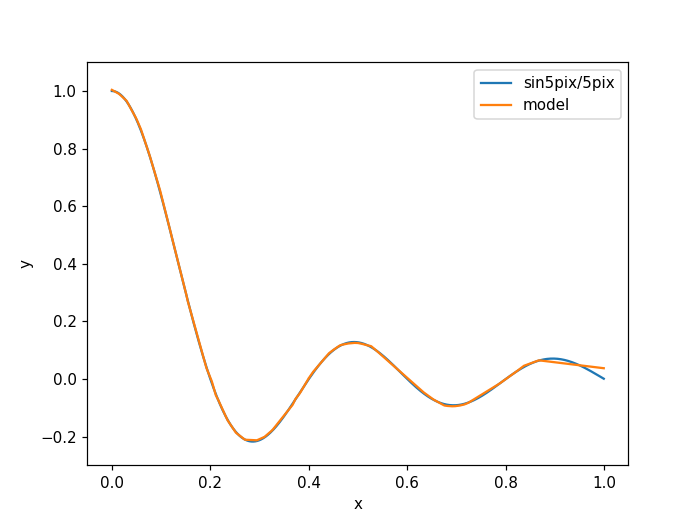

In [14]:
plt.figure()
plt.plot(source, target, label="sin5pix/5pix")
plt.plot(source, predictions[-1], label="model")
plt.xlabel('x')
plt.ylabel('y')
plt.ylim((-0.3, 1.1))
plt.legend(loc='best')
plt.show()

In [15]:
hessians

[[array([[[[ 63.686302,  48.47926 , -19.761456,  66.711296,  63.627186]],
  
          [[ 48.479267,  36.931248, -15.083735,  50.818333,  48.456406]],
  
          [[-19.761457, -15.083734,  11.681498, -21.095945, -20.056942]],
  
          [[ 66.71129 ,  50.818336, -21.095955,  69.95085 ,  66.69692 ]],
  
          [[ 63.627186,  48.456398, -20.05694 ,  66.696915,  63.600765]]]],
        dtype=float32),
  array([[ 846.23346,  622.69293, -608.59875,  878.8743 ,  846.18915],
         [ 622.69275,  459.9895 , -437.6447 ,  645.4718 ,  621.63074],
         [-608.59827, -437.64453,  541.5166 , -640.17554, -615.9902 ],
         [ 878.87415,  645.4719 , -640.1759 ,  914.31995,  880.0748 ],
         [ 846.18933,  621.6309 , -615.9907 ,  880.0751 ,  847.1766 ]],
        dtype=float32),
  array([[[[ 1.63198042e+00,  1.12318408e+00, -3.49529576e+00, ...,
             1.01510262e+00, -4.42513609e+00,  6.71877623e-01],
           [ 1.25144136e+00,  8.54701340e-01, -2.73310304e+00, ...,
            

In [16]:
hessian = [[] for _ in range(len(hessians))]
for i, hess in enumerate(hessians):
    for h in hess:
        if len(h.shape) > 2:
            hessian[i].append(h.reshape(h.shape[0]*h.shape[1], h.shape[2]*h.shape[3]))
        else:
            hessian[i].append(h)

In [17]:
eig = [[] for _ in range(len(hessian))]

for i, hess in enumerate(hessian):
    for h in hess:
        eig[i] = np.concatenate([eig[i], np.linalg.eig(h)[0]])

In [18]:
minimal_ratio = [sum(e > 0) / len(e) for e in eig]

In [19]:
minimal_ratio

[0.6322241681260946,
 0.6514886164623468,
 0.6970227670753065,
 0.6549912434325744,
 0.637478108581436,
 0.6077057793345009,
 0.637478108581436,
 0.6444833625218914,
 0.6147110332749562,
 0.6427320490367776,
 0.660245183887916,
 0.6129597197898424,
 0.6112084063047285,
 0.6549912434325744,
 0.649737302977233,
 0.6444833625218914,
 0.6357267950963222,
 0.6619964973730298,
 0.6199649737302977,
 0.649737302977233,
 0.6725043782837128,
 0.647985989492119,
 0.626970227670753,
 0.647985989492119,
 0.6514886164623468,
 0.6059544658493871,
 0.658493870402802,
 0.5901926444833625,
 0.6357267950963222,
 0.5936952714535902,
 0.6462346760070052,
 0.626970227670753,
 0.6690017513134852,
 0.6567425569176882,
 0.647985989492119,
 0.6690017513134852,
 0.6112084063047285,
 0.6077057793345009,
 0.6304728546409807,
 0.647985989492119,
 0.6392294220665499,
 0.6619964973730298,
 0.5936952714535902,
 0.6129597197898424,
 0.6567425569176882,
 0.6392294220665499,
 0.6514886164623468,
 0.6865148861646234,
 0.6

<IPython.core.display.Javascript object>


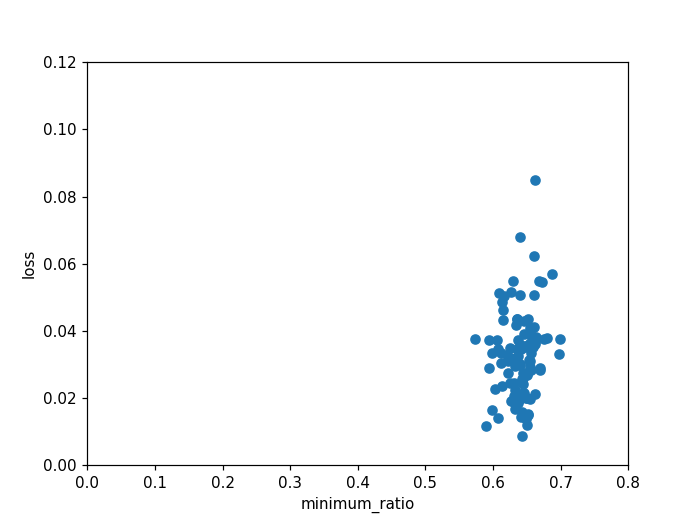

In [27]:
plt.figure()
plt.scatter(minimal_ratio, loss)
plt.xlabel('minimum_ratio')
plt.ylabel('loss')
plt.xlim((0.0, 0.8))
plt.ylim((0.0, 0.12))
plt.show()